In [1]:
from os import chdir
import time
chdir("../general")
from models import *
from util import *
from observation import *
from MCMC import *
chdir("../case-studies")

from fenics import *
from mshr import *

import numpy as np
from numpy import random
from numpy import linalg as linalg
from scipy import sparse
from scipy.sparse import linalg as splinalg
from scipy.signal import fftconvolve

import matplotlib
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

from decimal import Decimal
from sksparse import cholmod

In [2]:
def pprint(num):
	print('%.2E' % Decimal(num))

In [3]:
random.seed(3122344)

In [4]:
# Create mesh and define function space
xL = 0
xR = 30
expand = 0
xL -= expand
xR += expand
num_pt = 500
mesh = IntervalMesh(num_pt,xL,xR)
V = FunctionSpace(mesh, 'P', 1)
fem = V.element()

In [5]:
# Define our source problem parameters
true_alpha = 2			  # twice the number of recursive applications
guess_alpha = 2
d = 1				  # dimension of the space
true_nu = true_alpha-d/2		  # matern nu parameter
guess_nu = guess_alpha-d/2		  # matern nu parameter
true_rho = 5  			  # range (used to be 2)
true_kappa = np.sqrt(8*true_nu)/true_rho   # matern kappa parameter # is it actually 8nu/rho^2?
true_sigma2 = 50            # variance of the source

In [6]:
# Define our mechanics problem parameters
true_diff = 1.5
diffusion = Constant(true_diff)
true_dec = 0.4
decay = Constant(true_dec)
advection = Expression("0.5 + 0.1*cos(6.283*(x[0]-10)/10) + 0.075*cos(9.425*(x[0]-10)/10) + 0.075*cos(15.708*(x[0]-10)/10)",degree=2,domain=mesh)
def adv(x):
	return 0.5 + 0.1*np.cos(6.283*x/10) + 0.075*cos(9.425*x/10) + 0.075*cos(15.708*x/10)
adv0 = str(adv(xL))
adv1 = str(adv(xR))
strL = "(" + str(xL) + ")"
strR = "(" + str(xR) + ")"
termL = "(" + strR + "-x[0])/(" + strR + "-" + strL + ")"
termR = "(x[0] - " + strL +")/(" + strR + "-" + strL + ")"
print("-" + adv0 + "*" + termL + " + " + adv1 + "*" + termR)
adv_BC = Expression("-" + adv0 + "*" + termL + " + " + adv1 + "*" + termR,degree=1,domain=mesh)


-0.7499999999999999*((30)-x[0])/((30)-(0)) + 0.45000000164216086*(x[0] - (0))/((30)-(0))


In [7]:
# Define the source matrix
Q_source = make_matern(true_alpha,true_kappa,d,V,true_sigma2)
Q_factors = make_matern_factors(true_alpha,true_kappa,d,V,true_sigma2)

In [8]:
# Define the source function and FEM representation of it
farm = Expression("x[0] <= 10 ? 1 : 0",degree=1)
industrial = Expression("x[0] <= 20 & x[0] > 10 ? 1 : 0",degree=1)
residential = Expression("x[0] > 20 ? 1 : 0",degree=1)

In [9]:
farm_f = Function(V)
farm_f.interpolate(farm)

ind_f = Function(V)
ind_f.interpolate(industrial)

res_f = Function(V)
res_f.interpolate(residential)

farm_vec = func_to_vec(farm_f)
ind_vec = func_to_vec(ind_f)
res_vec = func_to_vec(res_f)

In [10]:
mu_beta = 20
true_sigma_beta = 5
true_sigma2_beta = true_sigma_beta**2
X = np.array([farm_vec,ind_vec,res_vec]).transpose()

In [11]:
#source_vec = random.multivariate_normal(np.zeros(num_pt+1),splinalg.inv(Q_source.tocsc()).todense())
true_beta = random.normal(loc=mu_beta,scale=true_sigma_beta,size=3)
source_vec = np.squeeze(mvn_invchol(Q_factors,num_pt+1)) + true_beta[0]*farm_vec + true_beta[1]*ind_vec + true_beta[2]*res_vec
source_f = vec_to_func(source_vec,V)
x_f = vec_to_func(true_beta[0]*farm_vec + true_beta[1]*ind_vec + true_beta[2]*res_vec,V)

In [12]:
# Get the mechanics problem matrices
u = TrialFunction(V)
v = TestFunction(V)
equation = diffusion*u.dx(0)*v.dx(0)*dx + advection.dx(0)*u*v*dx + advection*u.dx(0)*v*dx + decay*u*v*dx - adv_BC*u*v*ds # need the BC here
mass = u*v*dx
source = source_f*v*dx

In [13]:
# Assemble precision matrices
K = assemble(equation)
K = as_backend_type(K).mat()
(m,n) = K.size
K = sparse.csr_matrix(K.getValuesCSR()[::-1],shape=K.size)

L = assemble(mass)
L = as_backend_type(L).mat()
(m,n) = L.size
L = sparse.csr_matrix(L.getValuesCSR()[::-1],shape=L.size)
invL = sparse.spdiags(1/L.sum(axis=0),0,m,n)

In [14]:
# Solve for the steady state (w)
w = Function(V)
solve(equation==source,w)

Solving linear variational problem.


In [15]:
print("Amount entering:")
print(assemble(source_f*dx))
print("Amount leaving/decay:")
print(true_dec*assemble(w*dx)) # the small difference should be accounted for on the boundary

Amount entering:
712.458370959421
Amount leaving/decay:
678.4731075411725


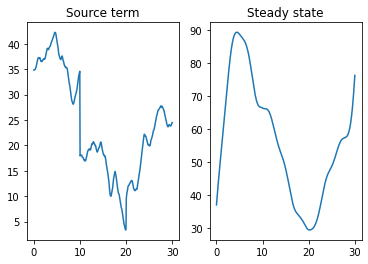

In [16]:
plt.subplot(1,2,1)
plot(source_f,title='Source term')
plt.subplot(1,2,2)
plot(w,title='Steady state')
plt.show()

In [17]:
# Get observations
num_samp = 20
true_sigma2_eps = 10   
pt_inds = list(map(int,np.linspace(0,num_pt,num_samp)))
x = np.linspace(xL,xR,num_pt+1)
pts = x[pt_inds]
data = random.normal(scale=np.sqrt(true_sigma2_eps),size=num_samp) + [w(pt) for pt in pts]
O = make_obs_mat_pts([[pt] for pt in pts],fem,mesh,V,threshold=0)
O = sparse.bmat([[O],[np.zeros((len(true_beta),num_samp))]])

In [18]:
# let's re-use the priors from the air pollution example
# some of these will be way off so it will demonstrate that the algorithm can course correct
rho_p = stats.gamma(3,scale=5)
v_a = 3
v_b = 0.05
varratio_p = stats.gamma(3,scale=0.05)
varratio_beta_p = stats.gamma(3,scale=1)
diff_p = stats.gamma(3,scale=0.5)
dec_p = stats.gamma(3,scale=0.5)
sigma2_p_alpha = 5
sigma2_p_beta = 100
sigma2_p = stats.invgamma(sigma2_p_alpha,scale=sigma2_p_beta)
priors = rho_p,varratio_p,varratio_beta_p,diff_p,dec_p,sigma2_p

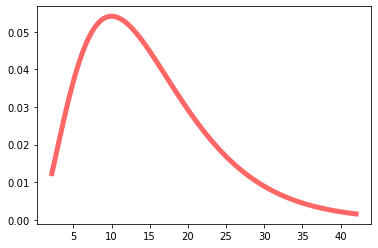

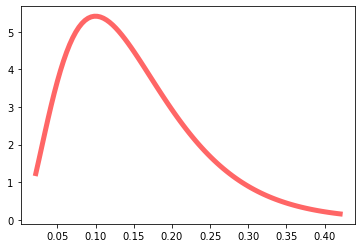

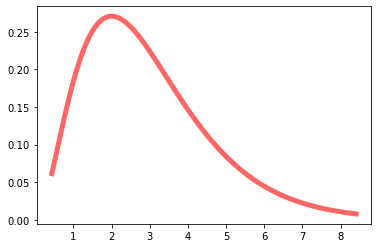

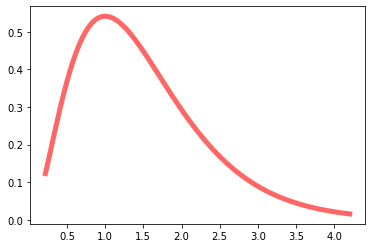

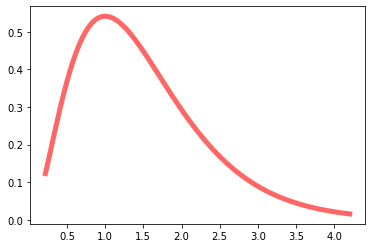

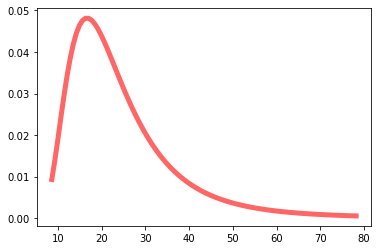

In [19]:
for p in priors:
    x = np.linspace(p.ppf(0.01),
                    p.ppf(0.99), 100)
    fig, ax = plt.subplots(1, 1)
    ax.plot(x, p.pdf(x),'r-', lw=5, alpha=0.6, label='pdf')

In [20]:
def median_init(priors,*args):
    return tuple(p.median() for p in priors)

def custom_init(*args):
    # this is more or less accurate >>> return (2,1,2.5,0.75,0.2,10)
    return (8,0.1,0.2,7,1,20)
    

rho_prop_std = 0.4 # I changed this from 0.04 AND I lowered the s2 prior b from 100
varratio_prop_std = 0.4
varratio_beta_prop_std = 0.4
diff_prop_std = 0.2
dec_prop_std = 0.2
sigma2_prop_std = None # we won't use this if Gibbs works

rho_prop_dist = lognorm_f(rho_prop_std)
varratio_prop_dist = lognorm_f(varratio_prop_std)
varratio_beta_prop_dist = lognorm_f(varratio_beta_prop_std)
diff_prop_dist = lognorm_f(diff_prop_std)
dec_prop_dist = lognorm_f(dec_prop_std)
sigma2_prop_dist = lognorm_f(sigma2_prop_std) 

#joint_proposal = MultiProposal([rho_prop_dist,varratio_prop_dist,diff_prop_dist,dec_prop_dist],which=[0,1,2,3])
rho_dec_proposal = MultiProposal([rho_prop_dist,dec_prop_dist],which=[0,4])
varratio_proposal = MultiProposal([varratio_prop_dist],which=[1])
varratio_beta_proposal = MultiProposal([varratio_beta_prop_dist],which=[2])
diff_proposal = MultiProposal([diff_prop_dist],which=[3])
sigma2_proposal = MultiProposal([sigma2_prop_dist],which=[5])

In [21]:
diffmat = assemble_mat(u.dx(0)*v.dx(0)*dx)
advmat = assemble_mat(advection.dx(0)*u*v*dx + advection*u.dx(0)*v*dx - adv_BC*u*v*ds)
decaymat = L

def loglik(x):
    print("Inside loglik(x)")
    print(x)
    rho,varratio,varratio_beta,diff,dec,sigma2 = tuple(x)
    logrho,logvarratio,logvarratio_beta,logdiff,logdec,logsigma2 = np.log(x)
    eps2 = sigma2*varratio
    sigma2_beta = sigma2*varratio_beta
    logeps2 = logsigma2 + logvarratio
    logsigma2_beta = logsigma2 + logvarratio_beta
    
    kappa = np.sqrt(8*guess_nu)/rho
    K = diff*diffmat + advmat + dec*decaymat
    
    Q_source = make_matern(guess_alpha,kappa,d,V,sigma2,threshold=0) #,space_name="line") 
    Q_beta = sparse.diags(np.array([1/sigma2_beta for i in range(3)]))
    Q_prior = sparse.bmat([[K.transpose() @ invL @ Q_source @ invL @ K,-K.transpose() @ invL @ Q_source @ X],[-X.transpose() @ Q_source @ invL @ K,Q_beta + X.transpose() @ Q_source @ X]]).tocsc()
    Q_post = Q_prior + O@O.transpose()/eps2
    Q_prior_chol = cholmod.cholesky(Q_prior.tocsc())
    Q_post_chol = cholmod.cholesky(Q_post.tocsc())
    Q_prior_chol2 = Q_post_chol.copy()
    Q_prior_chol2.update_inplace(O.tocsc()/np.sqrt(eps2),subtract=True)
    
    #Q_post_chol2 = Q_prior_chol.copy()
    #Q_post_chol2.update_inplace(O.tocsc()/np.sqrt(eps2))
    
    quadform = np.sum(data**2)/eps2 - data @ O.transpose() @ Q_post_chol(O @ data/eps2)/eps2
    #######
    #print([logeps2])
    #print(np.log(np.max(np.abs(Q_prior))))
    #print(np.log(np.min(np.abs(Q_prior[Q_prior.nonzero()]))))
    #Q_prior_sqrt = Q_prior/np.exp((np.log(np.max(np.abs(Q_prior)))+np.log(np.min(np.abs(Q_prior[Q_prior.nonzero()]))))/2)
    #print(np.log(np.max(np.abs(Q_prior_sqrt))))
    #print(np.log(np.min(np.abs(Q_prior_sqrt[Q_prior.nonzero()]))))
    #print(cholmod.cholesky(Q_prior_sqrt.tocsc()).logdet())
    #print(Q_prior_chol.logdet())
    #print(Q_prior_chol2.logdet())
    #print(Q_post_chol.logdet())
    #print(Q_post_chol2.logdet())
    logdets = len(data)*logeps2 - Q_prior_chol.logdet() + Q_post_chol.logdet()
    loglik = -(logdets+quadform)/2
    loglik += logsigma2 + logsigma2 - 2*logrho # transforms for varratio and varratio_beta and rho
    #print(loglik)
    #print("~~~~~~~~")
    return loglik

def log_lik_with_priors(priors,pars):
    log_lik = loglik(pars)
    for i in range(len(priors)):
        priori = priors[i]
        parsi = pars[i]
        log_lik += priori.logpdf(parsi)
    return log_lik

#updates = [MH_update(joint_proposal,log_lik_with_priors)]   
def sigma2gibbs(priors,pars):
    print("DOING GIBBS")
    rho,varratio,varratio_beta,diff,dec,old_sigma2 = tuple(pars)
    logrho,logvarratio,logvarratio_beta,logdiff,logdec,log_old_sigma2 = np.log(pars)
    sample_size = len(data)

    kappa = np.sqrt(8*guess_nu)/rho
    #diffusion,decay = Constant(diff),Constant(dec)
    #equation = diffusion*dot(grad(u),grad(v))*dx - dot(advection*u,grad(v))*dx  + decay*u*v*dx  + dot(advection*u,n)*v*ds
    #K = assemble_mat(equation)
    K = diff*diffmat + advmat + dec*decaymat
    
    Q_source = make_matern(guess_alpha,kappa,d,V,1,threshold=1e-10) #,space_name="line") 
    Q_beta = sparse.diags(np.array([1/varratio_beta for i in range(3)]))
    Q_prior = sparse.bmat([[K.transpose() @ invL @ Q_source @ invL @ K,-K.transpose() @ invL @ Q_source @ X],[-X.transpose() @ Q_source @ invL @ K,Q_beta + X.transpose() @ Q_source @ X]]).tocsr()
    
    Q_post = Q_prior + O@O.transpose()/varratio
    Q_post_ch = cholmod.cholesky(Q_post.tocsc(),mode="supernodal")
        
    # this is supposed to be
    # data^T(OSOt + vI)^(-1)data
    # so data^T(1/v I - 1/v2 O(Q+1/vOtO)^(-1)O)data
    inner_prod_term1 = np.sum(data**2)
    inner_prod_term2 = ((O @ data).transpose() @ Q_post_ch(O@data))/varratio
    twice_beta = (inner_prod_term1 - inner_prod_term2)/varratio
    if inner_prod_term2 > inner_prod_term1:
        print("YIKES!")
        print(["A",twice_beta])
        try:
            Q_prior_ch = cholmod.cholesky(Q_prior.tocsc(),mode="supernodal")
            dense_mat = (O.transpose() @ Q_prior_ch(O)).todense() + varratio*np.eye(len(data))
            twice_beta = data.transpose() @ linalg.solve(dense_mat,data)
            print(["B",twice_beta])
            if twice_beta < 0:
                raise Exception("No Negative Betas")
        except:
            try:
                dense_mat = (O.transpose() @ splinalg.spsolve(Q_prior.tocsc(),O.tocsc())).todense() + varratio*np.eye(len(data))
                twice_beta = data.transpose() @ linalg.solve(dense_mat,data)
                if twice_beta < 0:
                    raise Exception("No Negative Betas")
            except:
                # this is the best we can do
                # the numerics are poorly conditioned but 
                # are clearly trying to push these two terms too close together
                twice_beta = 0 
        
    print("term1: {term1}, term2: {term2}, beta: {beta}, mode: {mode}".format(term1=inner_prod_term1,term2=inner_prod_term2,beta=twice_beta/2+sigma2_p_beta,mode=(twice_beta+2*sigma2_p_beta)/(len(data)-2)))
    
    # alt code
    #num_obs = len(data)
    #extended_Q = sparse.bmat([[sparse.diags(np.array([1/varratio for i in range(num_obs)])), O.transpose()],[O, Q_prior]])
    #twice_beta = -np.append(data,np.zeros(m+3)) @ splinalg.spsolve(extended_Q,np.append(data,np.zeros(m+3)))
    
    alpha = len(data)/2-2 + sigma2_p_alpha
    beta = twice_beta/2 + sigma2_p_beta
    print(["!!!!",alpha,beta])
    new_sigma2 = stats.invgamma(alpha,scale=beta).rvs()
    new_pars = rho,varratio,varratio_beta,diff,dec,new_sigma2
    return new_pars
    
updates = [MH_update(x,log_lik_with_priors) for x in [rho_dec_proposal,varratio_proposal,varratio_beta_proposal,diff_proposal]]
updates += [gibbs_update(sigma2gibbs,log_lik_with_priors)]
#updates += [MH_update(sigma2_proposal,log_lik_with_priors)]
def initf(): return median_init(priors),log_lik_with_priors(priors,median_init(priors))
def initf(): return custom_init(),log_lik_with_priors(priors,custom_init())

cyclef = MCMC_cycle(updates)

num_chains = 4
num_sample= 1000 # approx 1 hour for every 100*5 so, approx 10hr runtime
thin_rate = 5
num_warmup = num_sample*thin_rate
initf()

Inside loglik(x)
(8, 0.1, 0.2, 7, 1, 20)


((8, 0.1, 0.2, 7, 1, 20), -506.02321891265984)

In [22]:
def sample(seed=None):
    if seed is not None:
        random.seed(seed)
    start = time.time()
    samples,successes = MCMC_chain(num_warmup,num_sample,thin_rate,priors,initf,cyclef)
    end = time.time()
    print("Total time elapsed: ", end-start)
    print("Time per sample: ", (end-start)/num_sample)
    print("Proportion of proposals accepted: ",np.array(successes)/(num_sample*thin_rate))
    return samples

def plot_samples(samples):
    rhos = [samples[j][i][0] for i in range(num_sample) for j in range(num_chains)]
    varratios = [samples[j][i][1] for i in range(num_sample) for j in range(num_chains)]
    varratio_betas = [samples[j][i][2] for i in range(num_sample) for j in range(num_chains)]
    diffs = [samples[j][i][3] for i in range(num_sample) for j in range(num_chains)]
    decs = [samples[j][i][4] for i in range(num_sample) for j in range(num_chains)]
    sigma2s = [samples[j][i][5] for i in range(num_sample) for j in range(num_chains)]
    eps2s = [sigma2s[i]*varratios[i] for i in range(len(sigma2s))]
    beta2s = [sigma2s[i]*varratio_betas[i] for i in range(len(sigma2s))]
    
    fig = plt.figure(figsize=(12,18))
    
    linecol='gold'
    
    bins = 20
    ax_r = plt.subplot(4,2,1)
    ax_r.set_title(r'Range ($\rho$)')
    plt.hist(rhos,bins=bins)
    plt.axvline(x = true_rho, color = linecol, label = 'True Value')
    p = rho_p
    x = np.linspace(p.ppf(0.01),p.ppf(0.99), 100)
    binsize = (np.max(rhos)-np.min(rhos))/bins
    plt.plot(x, num_sample*num_chains*binsize*p.pdf(x),'r-', lw=5, alpha=0.6, label='pdf')
        
    ax_diff = plt.subplot(4,2,2)
    ax_diff.set_title('Diffusion ($D$)')
    _,_,hist = plt.hist(diffs,bins=bins)
    line = plt.axvline(x = true_diff, color = linecol)
    p = diff_p
    x = np.linspace(p.ppf(0.01),p.ppf(0.99), 100)
    binsize = (np.max(diffs)-np.min(diffs))/bins
    prior, = plt.plot(x, num_sample*num_chains*binsize*p.pdf(x),'r-', lw=5, alpha=0.6, label='pdf')
    plt.legend([hist,line,prior],["Samples","True Value","Prior"])
    
    ax_dec = plt.subplot(4,2,3)
    ax_dec.set_title('Decay ($r$)')
    plt.hist(decs,bins=bins)
    plt.axvline(x = true_dec, color = linecol, label = 'True Value')
    p = dec_p
    x = np.linspace(p.ppf(0.01),p.ppf(0.99), 100)
    binsize = (np.max(decs)-np.min(decs))/bins
    plt.plot(x, num_sample*num_chains*binsize*p.pdf(x),'r-', lw=5, alpha=0.6, label='pdf')
    
    ax_s = plt.subplot(4,2,4)
    ax_s.set_title(r'Emissions Variance ($\sigma^2_f$)')
    plt.hist(sigma2s,bins=bins)
    plt.axvline(x = true_sigma2, color = linecol, label = 'True Value')
    p = sigma2_p
    x = np.linspace(p.ppf(0.01),p.ppf(0.99), 100)
    binsize = (np.max(sigma2s)-np.min(sigma2s))/bins
    plt.plot(x, num_sample*num_chains*binsize*p.pdf(x),'r-', lw=5, alpha=0.6, label='pdf')
    
    ax_e = plt.subplot(4,2,5)
    ax_e.set_title(r'Noise Variance Ratio ($v_\epsilon = \sigma^2_\epsilon/\sigma^2_f$)')
    plt.hist(varratios,bins=bins)
    plt.axvline(x = true_sigma2_eps/true_sigma2, color = linecol, label = 'True Value')
    p = varratio_p
    x = np.linspace(p.ppf(0.01),p.ppf(0.99), 100)
    binsize = (np.max(varratios)-np.min(varratios))/bins
    plt.plot(x, num_sample*num_chains*binsize*p.pdf(x),'r-', lw=5, alpha=0.6, label='pdf')
    
    ax_b = plt.subplot(4,2,6)
    ax_b.set_title(r'Regression Variance Ratio ($v_\beta = \sigma^2_\beta/\sigma^2_f$)')
    plt.hist(varratio_betas,bins=bins)
    plt.axvline(x = true_sigma2_beta/true_sigma2, color = linecol, label = 'True Value')
    p = varratio_beta_p
    x = np.linspace(p.ppf(0.01),p.ppf(0.99), 100)
    binsize = (np.max(varratio_betas)-np.min(varratio_betas))/bins
    plt.plot(x, num_sample*num_chains*binsize*p.pdf(x),'r-', lw=5, alpha=0.6, label='pdf')
    
    ax_e = plt.subplot(4,2,7)
    ax_e.set_title(r'Noise Variance ($\sigma^2_\epsilon$)')
    plt.hist(eps2s,bins=bins)
    plt.axvline(x = true_sigma2_eps, color = linecol, label = 'True Value')
    
    ax_b = plt.subplot(4,2,8)
    ax_b.set_title(r'Regression Variance ($\sigma^2_\beta$)')
    plt.hist(beta2s,bins=bins)
    plt.axvline(x = true_sigma2_beta, color = linecol, label = 'True Value')
    
    fig.text(-0.04, 0.5, 'Frequency', va='center', rotation='vertical')

    
    plt.tight_layout()
    plt.savefig("../figs/mcmc_example.png")

def plot_tracks(samples):
    rhos = [[samples[j][i][0] for i in range(num_sample)] for j in range(num_chains)]
    varratios = [[samples[j][i][1] for i in range(num_sample)] for j in range(num_chains)]
    varratio_betas = [[samples[j][i][2] for i in range(num_sample)] for j in range(num_chains)]
    diffs = [[samples[j][i][3] for i in range(num_sample)] for j in range(num_chains)]
    decs = [[samples[j][i][4] for i in range(num_sample)] for j in range(num_chains)]
    sigma2 = [[samples[j][i][5] for i in range(num_sample)] for j in range(num_chains)]
    
    plt.figure(figsize=(8,12))
    plt.subplot(4,2,1)
    for i in range(num_chains):
        plt.plot(rhos[i])
    plt.title("Rho")
    plt.subplot(4,2,2)
    for i in range(num_chains):
        plt.plot(varratios[i])
    plt.title("Var Ratio")
    plt.subplot(4,2,3)
    for i in range(num_chains):
        plt.plot(varratio_betas[i])
    plt.title("Var Ratio Beta")
    plt.subplot(4,2,4)
    for i in range(num_chains):
        plt.plot(np.log(diffs[i]))
    plt.title("Log Diffusion")
    plt.subplot(4,2,5)
    for i in range(num_chains):
        plt.plot(decs[i])
    plt.title("Decay")
    plt.subplot(4,2,6)
    for i in range(num_chains):
        plt.plot(sigma2[i])
    plt.title("Sigma2")
    plt.subplot(4,2,7)
    for i in range(num_chains):
        plt.plot([sigma2[i][j]*varratios[i][j] for j in range(num_sample)])
    plt.title("Epsilon2")
    plt.subplot(4,2,8)
    for i in range(num_chains):
        plt.plot([sigma2[i][j]*varratio_betas[i][j] for j in range(num_sample)])
    plt.title("Beta2")

In [ ]:
random.seed(875154)
samples = [sample() for i in range(num_chains)]

Inside loglik(x)
(8, 0.1, 0.2, 7, 1, 20)
Inside loglik(x)
[15.433765223810662, 0.1, 0.2, 7, 1.1609639062882673, 20]
~~~~~~
new, old, prop ratio
-570.1143695555528
-506.02321891265984
0.8063667283810467
Inside loglik(x)
[8, 0.11064518731197515, 0.2, 7, 1, 20]
~~~~~~
new, old, prop ratio
-491.6106700937596
-506.02321891265984
0.10115838486783701
Inside loglik(x)
[8, 0.11064518731197515, 0.21918725737254016, 7, 1, 20]
~~~~~~
new, old, prop ratio
-487.6447245459866
-491.6106700937596
0.09160905441152578
Inside loglik(x)
[8, 0.11064518731197515, 0.21918725737254016, 5.947550348060188, 1, 20]
~~~~~~
new, old, prop ratio
-460.3624527504962
-487.6447245459866
-0.16293072048041624
DOING GIBBS
term1: 69341.97337107791, term2: 67438.26464103104, beta: 8702.763374963492, mode: 966.9737083292769
['!!!!', 13.0, 8702.763374963492]
Inside loglik(x)
(8, 0.11064518731197515, 0.21918725737254016, 5.947550348060188, 1, 527.1859345081565)
Inside loglik(x)
[6.443894271972587, 0.11064518731197515, 0.21918725

/var/folders/6n/hw465dds2ld9kmcvw3yj75100000gn/T/ipykernel_73719/1269162115.py:43: RuntimeWarning: invalid value encountered in log
  logdets = len(data)*logeps2 - Q_prior_chol.logdet() + Q_post_chol.logdet()


~~~~~~
new, old, prop ratio
-84.43287545014674
-84.41351621881638
0.05681251298954515
Inside loglik(x)
[16.93464825012046, 0.11064518731197515, 0.2589851027770597, 5.040674936136134, 0.8610935003913278, 589.944663996719]
~~~~~~
new, old, prop ratio
-84.53022042628312
-84.43287545014674
-0.030948171873386943
DOING GIBBS
term1: 69341.97337107791, term2: 67928.01492865891, beta: 6489.606619003677, mode: 721.0674021115196
['!!!!', 13.0, 6489.606619003677]
Inside loglik(x)
(16.93464825012046, 0.11064518731197515, 0.2589851027770597, 5.040674936136134, 0.8610935003913278, 597.2492375519852)
Inside loglik(x)
[42.88545135151879, 0.11064518731197515, 0.2589851027770597, 5.040674936136134, 0.8234450980266855, 597.2492375519852]
~~~~~~
new, old, prop ratio
nan
-84.25935343251746
0.8844647083024035
Inside loglik(x)
[16.93464825012046, 0.08340844223421723, 0.2589851027770597, 5.040674936136134, 0.8610935003913278, 597.2492375519852]
~~~~~~
new, old, prop ratio
-84.29707991945503
-84.25935343251746


~~~~~~
new, old, prop ratio
-80.3350282967811
-81.00840913530041
0.4143205164664512
Inside loglik(x)
[11.095303983528558, 0.05131912316752687, 0.620829513127037, 4.3310723846474435, 0.6256860099465895, 481.1685964970695]
~~~~~~
new, old, prop ratio
-76.84842121899372
-80.3350282967811
-0.21822230074256055
DOING GIBBS
term1: 69341.97337107791, term2: 68740.66688173931, beta: 5958.503148774485, mode: 662.0559054193873
['!!!!', 13.0, 5958.503148774485]
Inside loglik(x)
(11.095303983528558, 0.05131912316752687, 0.620829513127037, 4.3310723846474435, 0.6256860099465895, 593.4365893432453)
Inside loglik(x)
[11.508382331044487, 0.05131912316752687, 0.620829513127037, 4.3310723846474435, 0.5019028870870174, 593.4365893432453]
~~~~~~
new, old, prop ratio
-77.279468517801
-77.34754433985147
-0.18388830080218987
Inside loglik(x)
[11.508382331044487, 0.04657965244078541, 0.620829513127037, 4.3310723846474435, 0.5019028870870174, 593.4365893432453]
~~~~~~
new, old, prop ratio
-77.18423031898185
-77

~~~~~~
new, old, prop ratio
-68.73639553642607
-66.78327367387872
0.3863368894934016
DOING GIBBS
term1: 69341.97337107791, term2: 69248.81941316316, beta: 3535.2034134239075, mode: 392.80037926932306
['!!!!', 13.0, 3535.2034134239075]
Inside loglik(x)
(6.512724992808116, 0.013558725161765976, 1.4225011676438744, 1.8289948973235388, 0.5337518168981851, 226.20485388861977)
Inside loglik(x)
[8.72698569664203, 0.013558725161765976, 1.4225011676438744, 1.8289948973235388, 0.5288189862340479, 226.20485388861977]
~~~~~~
new, old, prop ratio
-66.40950193874568
-66.65436819764666
0.2833772985866616
Inside loglik(x)
[8.72698569664203, 0.01759498039521352, 1.4225011676438744, 1.8289948973235388, 0.5288189862340479, 226.20485388861977]
~~~~~~
new, old, prop ratio
-64.89762628093119
-66.40950193874568
0.2605833930744943
Inside loglik(x)
[8.72698569664203, 0.01759498039521352, 1.6773380213244606, 1.8289948973235388, 0.5288189862340479, 226.20485388861977]
~~~~~~
new, old, prop ratio
-64.751168521998

Inside loglik(x)
[11.00661679011491, 0.07224627108619036, 0.8338447283969392, 2.4853041385154353, 0.43311913209704106, 84.9356892414206]
~~~~~~
new, old, prop ratio
-68.166797982081
-68.57526417284168
-0.059697657552490124
Inside loglik(x)
[11.00661679011491, 0.06434167413617324, 0.8338447283969392, 2.4853041385154353, 0.43311913209704106, 84.9356892414206]
~~~~~~
new, old, prop ratio
-68.64548694299106
-68.166797982081
-0.11587317277878784
Inside loglik(x)
[11.00661679011491, 0.06434167413617324, 0.6262894292279868, 2.4853041385154353, 0.43311913209704106, 84.9356892414206]
~~~~~~
new, old, prop ratio
-69.45093931345274
-68.64548694299106
-0.2862345967833573
Inside loglik(x)
[11.00661679011491, 0.06434167413617324, 0.8338447283969392, 2.970693533571671, 0.43311913209704106, 84.9356892414206]
~~~~~~
new, old, prop ratio
-74.4566331903212
-68.64548694299106
0.17840039673756825
DOING GIBBS
term1: 69341.97337107791, term2: 69065.98378500916, beta: 2244.7187205966015, mode: 249.41319117740

~~~~~~
new, old, prop ratio
-59.911818403106786
-60.36853881676779
0.4982178187751327
Inside loglik(x)
[15.037809170075025, 0.09155750300866566, 1.2729868757614384, 1.3651361750848732, 0.34573446087371257, 101.3629544199876]
~~~~~~
new, old, prop ratio
-59.675845704382795
-59.911818403106786
-0.1465300059632838
DOING GIBBS
term1: 69341.97337107791, term2: 69144.12733867523, beta: 1180.4468552618582, mode: 131.16076169576203
['!!!!', 13.0, 1180.4468552618582]
Inside loglik(x)
(15.037809170075025, 0.09155750300866566, 1.2729868757614384, 1.3651361750848732, 0.34573446087371257, 70.6915826703429)
Inside loglik(x)
[41.46397179775308, 0.09155750300866566, 1.2729868757614384, 1.3651361750848732, 0.4390265633392753, 70.6915826703429]
~~~~~~
new, old, prop ratio
-79.09878473445976
-59.72485369288131
1.2531461533952661
Inside loglik(x)
[15.037809170075025, 0.062268846644082484, 1.2729868757614384, 1.3651361750848732, 0.34573446087371257, 70.6915826703429]
~~~~~~
new, old, prop ratio
-61.2248182

Inside loglik(x)
[27.7058015834651, 0.09248378899604964, 3.221745628297411, 1.1474182696647668, 0.3686307249821468, 123.86958745986337]
~~~~~~
new, old, prop ratio
-64.83173896425785
-61.48450147561114
0.6443641204668593
Inside loglik(x)
[14.69137411286461, 0.02208146588210258, 3.221745628297411, 1.1474182696647668, 0.3649690609201767, 123.86958745986337]
~~~~~~
new, old, prop ratio
-69.83028849325308
-61.48450147561114
-1.4322947662696435
Inside loglik(x)
[14.69137411286461, 0.09248378899604964, 2.497816477857727, 1.1474182696647668, 0.3649690609201767, 123.86958745986337]
~~~~~~
new, old, prop ratio
-61.16432505694462
-61.48450147561114
-0.2545063918778019
Inside loglik(x)
[14.69137411286461, 0.09248378899604964, 2.497816477857727, 2.055285355320642, 0.3649690609201767, 123.86958745986337]
~~~~~~
new, old, prop ratio
-62.673692921059555
-61.16432505694462
0.5829002616220347
DOING GIBBS
term1: 69341.97337107791, term2: 69085.9341664303, beta: 1484.2382942298188, mode: 164.915366025535

Inside loglik(x)
[8.415562249656688, 0.14417598002315443, 3.269236712569465, 1.3930652687402465, 0.3708553131951276, 68.53577265637102]
~~~~~~
new, old, prop ratio
-58.13809329323665
-58.3318152320766
-0.20137173168875355
Inside loglik(x)
[8.415562249656688, 0.14417598002315443, 3.269236712569465, 1.1594630771299268, 0.3708553131951276, 68.53577265637102]
~~~~~~
new, old, prop ratio
-59.020122018807655
-58.13809329323665
-0.18354951508253006
DOING GIBBS
term1: 69341.97337107791, term2: 69150.68256258663, beta: 763.3934739356613, mode: 84.82149710396237
['!!!!', 13.0, 763.3934739356613]
Inside loglik(x)
(8.415562249656688, 0.14417598002315443, 3.269236712569465, 1.3930652687402465, 0.3708553131951276, 72.23458761950775)
Inside loglik(x)
[9.418755127201518, 0.14417598002315443, 3.269236712569465, 1.3930652687402465, 0.4119507405736368, 72.23458761950775]
~~~~~~
new, old, prop ratio
-58.71851040153929
-58.32827776831951
0.21771207250655333
Inside loglik(x)
[9.418755127201518, 0.2285534474

Inside loglik(x)
[8.633069213416567, 0.20904716578270463, 5.28686664586918, 1.696662831238596, 0.3518689681932422, 41.97040146282373]
~~~~~~
new, old, prop ratio
-59.308065378971705
-59.227954610171665
0.013117580871278345
DOING GIBBS
term1: 69341.97337107791, term2: 69125.53482753075, beta: 617.6787323013542, mode: 68.63097025570602
['!!!!', 13.0, 617.6787323013542]
Inside loglik(x)
(8.633069213416567, 0.20904716578270463, 5.28686664586918, 1.696662831238596, 0.3518689681932422, 34.20594653804021)
Inside loglik(x)
[11.497655344838128, 0.20904716578270463, 5.28686664586918, 1.696662831238596, 0.36701874613033075, 34.20594653804021]
~~~~~~
new, old, prop ratio
-61.77567503122319
-59.68024064265197
0.32869711427502746
Inside loglik(x)
[8.633069213416567, 0.27425544311839695, 5.28686664586918, 1.696662831238596, 0.3518689681932422, 34.20594653804021]
~~~~~~
new, old, prop ratio
-60.33960378432495
-59.68024064265197
0.271500046139344
Inside loglik(x)
[8.633069213416567, 0.27425544311839695

~~~~~~
new, old, prop ratio
-57.50594870582656
-57.537618395230005
-0.10006489258897289
DOING GIBBS
term1: 69341.97337107791, term2: 69224.3168963796, beta: 782.2460661669907, mode: 86.91622957411008
['!!!!', 13.0, 782.2460661669907]
Inside loglik(x)
(5.496122529413621, 0.086227301653292, 3.2328890246435202, 1.6693747013910207, 0.2856372648883661, 32.14334654571832)
Inside loglik(x)
[5.839229857168883, 0.086227301653292, 3.2328890246435202, 1.6693747013910207, 0.28793177747476323, 32.14334654571832]
~~~~~~
new, old, prop ratio
-59.896004198495035
-59.79340388085934
0.06855693246243089
Inside loglik(x)
[5.839229857168883, 0.20163298747080727, 3.2328890246435202, 1.6693747013910207, 0.28793177747476323, 32.14334654571832]
~~~~~~
new, old, prop ratio
-57.308286840018546
-59.896004198495035
0.8494622990998013
Inside loglik(x)
[5.839229857168883, 0.20163298747080727, 2.624174527063408, 1.6693747013910207, 0.28793177747476323, 32.14334654571832]
~~~~~~
new, old, prop ratio
-57.56354368665066

term1: 69341.97337107791, term2: 69152.48796095552, beta: 391.5589768048439, mode: 43.50655297831599
['!!!!', 13.0, 391.5589768048439]
Inside loglik(x)
(2.794733299741683, 0.3249521112313801, 2.4520446933339715, 2.035353231033904, 0.16791672785800466, 29.570637986787123)
Inside loglik(x)
[1.4015655436266954, 0.3249521112313801, 2.4520446933339715, 2.035353231033904, 0.24208760317287492, 29.570637986787123]
~~~~~~
new, old, prop ratio
-60.70299406091022
-58.293476963118444
-0.32431535604389716
Inside loglik(x)
[2.794733299741683, 0.3874546824989944, 2.4520446933339715, 2.035353231033904, 0.16791672785800466, 29.570637986787123]
~~~~~~
new, old, prop ratio
-59.47919174182138
-58.293476963118444
0.17592107214935426
Inside loglik(x)
[2.794733299741683, 0.3249521112313801, 4.077897970796632, 2.035353231033904, 0.16791672785800466, 29.570637986787123]
~~~~~~
new, old, prop ratio
-58.65761205041545
-58.293476963118444
0.5086594072116066
Inside loglik(x)
[2.794733299741683, 0.3249521112313801,

Inside loglik(x)
[9.744814223600068, 0.11361947529230536, 6.4209204984826185, 1.8785409470579426, 0.33837390334385026, 44.218649674868345]
~~~~~~
new, old, prop ratio
-61.258324647815925
-61.264622474220275
0.016852647383833297
Inside loglik(x)
[9.744814223600068, 0.08661807348661092, 6.4209204984826185, 1.8785409470579426, 0.33837390334385026, 44.218649674868345]
~~~~~~
new, old, prop ratio
-62.26508718281799
-61.258324647815925
-0.27134643446300677
Inside loglik(x)
[9.744814223600068, 0.11361947529230536, 7.945861153035906, 1.8785409470579426, 0.33837390334385026, 44.218649674868345]
~~~~~~
new, old, prop ratio
-62.308099714843436
-61.258324647815925
0.21308969617103113
Inside loglik(x)
[9.744814223600068, 0.11361947529230536, 6.4209204984826185, 2.15571086288679, 0.33837390334385026, 44.218649674868345]
~~~~~~
new, old, prop ratio
-63.78831304976278
-61.258324647815925
0.1376251523943378
DOING GIBBS
term1: 69341.97337107791, term2: 69168.87004889255, beta: 861.767829590922, mode: 95

Inside loglik(x)
[0.8896656012068916, 0.0869389027515488, 3.0134904929906186, 1.3124132255196088, 0.24626469522232527, 35.66428060178841]
~~~~~~
new, old, prop ratio
-58.85093336051935
-58.44599271230059
-0.10801500400159858
Inside loglik(x)
[0.8896656012068916, 0.0869389027515488, 2.6691909197597767, 1.3124132255196088, 0.24626469522232527, 35.66428060178841]
~~~~~~
new, old, prop ratio
-59.00892528729079
-58.85093336051935
-0.12132363894627773
Inside loglik(x)
[0.8896656012068916, 0.0869389027515488, 2.6691909197597767, 1.3742488645332436, 0.24626469522232527, 35.66428060178841]
~~~~~~
new, old, prop ratio
-58.77187313429922
-59.00892528729079
0.046039702105407365
DOING GIBBS
term1: 69341.97337107791, term2: 69222.62113661425, beta: 786.4144283298555, mode: 87.3793809255395
['!!!!', 13.0, 786.4144283298555]
Inside loglik(x)
(0.8896656012068916, 0.0869389027515488, 2.6691909197597767, 1.3742488645332436, 0.24626469522232527, 76.36347339026571)
Inside loglik(x)
[0.7911157522788256, 0.0

Inside loglik(x)
[1.2425486539316508, 0.12364684113921733, 2.660403929427543, 1.6417813049654875, 0.19247927816226645, 73.57532258823866]
~~~~~~
new, old, prop ratio
-57.79004006633625
-57.699938486530414
0.06340434409259466
Inside loglik(x)
[1.2425486539316508, 0.12364684113921733, 2.4371103365925664, 1.6417813049654875, 0.19247927816226645, 73.57532258823866]
~~~~~~
new, old, prop ratio
-57.726082986796996
-57.79004006633625
-0.08766491523348563
Inside loglik(x)
[1.2425486539316508, 0.12364684113921733, 2.4371103365925664, 1.089758432526641, 0.19247927816226645, 73.57532258823866]
~~~~~~
new, old, prop ratio
-60.53384287344176
-57.726082986796996
-0.40982576380956237
DOING GIBBS
term1: 69341.97337107791, term2: 69218.98239430861, beta: 597.3478320842165, mode: 66.37198134269073
['!!!!', 13.0, 597.3478320842165]
Inside loglik(x)
(1.2425486539316508, 0.12364684113921733, 2.4371103365925664, 1.6417813049654875, 0.19247927816226645, 35.71652681043322)
Inside loglik(x)
[1.1589571100956808

~~~~~~
new, old, prop ratio
-59.404140326375035
-58.41349502473323
0.19364707425085204
Inside loglik(x)
[2.967771860595753, 0.2306999167357154, 7.492951286001568, 2.0887852070429838, 0.22144479518516824, 37.52637687369609]
~~~~~~
new, old, prop ratio
-60.0337918130649
-59.404140326375035
0.16446184347129983
DOING GIBBS
term1: 69341.97337107791, term2: 69204.04957707474, beta: 398.92467226413606, mode: 44.324963584904005
['!!!!', 13.0, 398.92467226413606]
Inside loglik(x)
(2.967771860595753, 0.2306999167357154, 7.492951286001568, 1.77202119446484, 0.22144479518516824, 32.17831276044944)
Inside loglik(x)
[4.424406190211739, 0.2306999167357154, 7.492951286001568, 1.77202119446484, 0.2530415281027397, 32.17831276044944]
~~~~~~
new, old, prop ratio
-59.05258687113552
-59.018719526344725
0.5327049103819415
Inside loglik(x)
[4.424406190211739, 0.13284397473517803, 7.492951286001568, 1.77202119446484, 0.2530415281027397, 32.17831276044944]
~~~~~~
new, old, prop ratio
-59.01672706064748
-59.052

Inside loglik(x)
[1.5076104153686616, 0.18502537545017164, 4.690374170858843, 2.0028034794057765, 0.5204525620525693, 43.51920330255393]
~~~~~~
new, old, prop ratio
-65.81241287090526
-60.03851102735914
-0.1282197223225292
Inside loglik(x)
[2.263452279072875, 0.4084606896355891, 4.690374170858843, 2.0028034794057765, 0.3940796921286176, 43.51920330255393]
~~~~~~
new, old, prop ratio
-63.956205629438905
-60.03851102735914
0.7919026983996831
Inside loglik(x)
[2.263452279072875, 0.18502537545017164, 4.392454747466419, 2.0028034794057765, 0.3940796921286176, 43.51920330255393]
~~~~~~
new, old, prop ratio
-60.046446614934496
-60.03851102735914
-0.06562412104409576
Inside loglik(x)
[2.263452279072875, 0.18502537545017164, 4.392454747466419, 1.8633825673548292, 0.3940796921286176, 43.51920330255393]
~~~~~~
new, old, prop ratio
-59.50985896909091
-60.046446614934496
-0.0721545180412374
DOING GIBBS
term1: 69341.97337107791, term2: 69108.99550654166, beta: 729.583547579384, mode: 81.064838619931

~~~~~~
new, old, prop ratio
-64.67155029417889
-63.45268280699639
0.28874052619213364
Inside loglik(x)
[2.339202187398723, 0.15427915571991485, 7.506952900280556, 1.5230028048707185, 0.6016611149300685, 54.517833271657096]
~~~~~~
new, old, prop ratio
-63.08356802787992
-63.45268280699639
-0.09483967077129091
DOING GIBBS
term1: 69341.97337107791, term2: 69077.17151342079, beta: 958.1906493507532, mode: 106.46562770563925
['!!!!', 13.0, 958.1906493507532]
Inside loglik(x)
(2.339202187398723, 0.15427915571991485, 7.506952900280556, 1.5230028048707185, 0.6016611149300685, 58.30670679387137)
Inside loglik(x)
[2.0932551996711077, 0.15427915571991485, 7.506952900280556, 1.5230028048707185, 0.5520259052147518, 58.30670679387137]
~~~~~~
new, old, prop ratio
-62.0975409913067
-62.88086952775627
-0.19718893944129134
Inside loglik(x)
[2.0932551996711077, 0.19947781693556696, 7.506952900280556, 1.5230028048707185, 0.5520259052147518, 58.30670679387137]
~~~~~~
new, old, prop ratio
-62.676351833967
-

Inside loglik(x)
[5.472471302615347, 0.1479680433083353, 7.885635497387614, 1.3350961993413446, 0.6647987372483003, 65.12245096382954]
~~~~~~
new, old, prop ratio
-62.99124873525827
-61.54350587529639
0.7893972128725056
Inside loglik(x)
[3.154099163519301, 0.1791767121104914, 7.885635497387614, 1.3350961993413446, 0.5238023974475767, 65.12245096382954]
~~~~~~
new, old, prop ratio
-61.95256345440836
-61.54350587529639
0.19137621049848885
Inside loglik(x)
[3.154099163519301, 0.1479680433083353, 14.259926796502201, 1.3350961993413446, 0.5238023974475767, 65.12245096382954]
~~~~~~
new, old, prop ratio
-66.37213454546426
-61.54350587529639
0.5924104685833402
Inside loglik(x)
[3.154099163519301, 0.1479680433083353, 7.885635497387614, 1.205616487552443, 0.5238023974475767, 65.12245096382954]
~~~~~~
new, old, prop ratio
-61.8818248276714
-61.54350587529639
-0.10201230464453453
DOING GIBBS
term1: 69341.97337107791, term2: 69142.32157126005, beta: 774.6449954799593, mode: 86.07166616443993
['!!!

~~~~~~
new, old, prop ratio
-65.62602074868467
-64.86302604572593
0.1885945147515778
Inside loglik(x)
[5.9363926375058576, 0.4173457088829178, 4.152347811486304, 0.802975554147677, 0.4546554219706004, 95.61376985971503]
~~~~~~
new, old, prop ratio
-68.99658088629228
-64.86302604572593
0.6191823127718074
Inside loglik(x)
[5.9363926375058576, 0.2246924557032599, 4.117926595308606, 0.802975554147677, 0.4546554219706004, 95.61376985971503]
~~~~~~
new, old, prop ratio
-64.85170759674207
-64.86302604572593
-0.008324128859918734
Inside loglik(x)
[5.9363926375058576, 0.2246924557032599, 4.117926595308606, 0.7792629137578487, 0.4546554219706004, 95.61376985971503]
~~~~~~
new, old, prop ratio
-65.09387794800224
-64.85170759674207
-0.029975779785195278
DOING GIBBS
term1: 69341.97337107791, term2: 69011.18512738611, beta: 836.0911220994803, mode: 92.89901356660893
['!!!!', 13.0, 836.0911220994803]
Inside loglik(x)
(5.9363926375058576, 0.2246924557032599, 4.117926595308606, 0.7792629137578487, 0.45

Inside loglik(x)
[9.145039752319633, 0.20322656562606453, 5.42994423914677, 1.226810741674711, 0.6022892688350432, 57.96736319439523]
~~~~~~
new, old, prop ratio
-62.81819568085764
-64.39929795886633
-0.38431136032338264
Inside loglik(x)
[9.145039752319633, 0.20322656562606453, 7.764350969454264, 1.226810741674711, 0.6022892688350432, 57.96736319439523]
~~~~~~
new, old, prop ratio
-63.58017242885123
-62.81819568085764
0.35761400414674194
Inside loglik(x)
[9.145039752319633, 0.20322656562606453, 7.764350969454264, 1.3059102450495939, 0.6022892688350432, 57.96736319439523]
~~~~~~
new, old, prop ratio
-63.623538019417715
-63.58017242885123
0.062482394347742
DOING GIBBS
term1: 69341.97337107791, term2: 69015.84761495762, beta: 902.3698946927141, mode: 100.26332163252378
['!!!!', 13.0, 902.3698946927141]
Inside loglik(x)
(9.145039752319633, 0.20322656562606453, 7.764350969454264, 1.3059102450495939, 0.6022892688350432, 49.22486316361279)
Inside loglik(x)
[5.572451260552796, 0.20322656562606

Inside loglik(x)
[9.338626741670874, 0.1414664636048377, 5.219379838734138, 1.4613745198870902, 0.40396085658995023, 74.51176799076116]
~~~~~~
new, old, prop ratio
-59.35727269059497
-58.64047560071172
0.3971614594968771
Inside loglik(x)
[9.338626741670874, 0.1414664636048377, 5.219379838734138, 1.562751927341409, 0.40396085658995023, 74.51176799076116]
~~~~~~
new, old, prop ratio
-59.484510379423796
-59.35727269059497
0.06707087832045672
DOING GIBBS
term1: 69341.97337107791, term2: 69144.11181791098, beta: 799.3231757020062, mode: 88.8136861891118
['!!!!', 13.0, 799.3231757020062]
Inside loglik(x)
(9.338626741670874, 0.1414664636048377, 5.219379838734138, 1.562751927341409, 0.40396085658995023, 90.65905747000929)
Inside loglik(x)
[9.272920843398126, 0.1414664636048377, 5.219379838734138, 1.562751927341409, 0.33635997714338023, 90.65905747000929]
~~~~~~
new, old, prop ratio
-60.315512225279164
-60.35072746957537
-0.1901968327210406
Inside loglik(x)
[9.272920843398126, 0.317440396510546

Inside loglik(x)
[6.539889883867692, 0.1124606462569326, 3.8148352534655356, 1.8439450634500343, 0.5791965122059854, 99.16756156383542]
~~~~~~
new, old, prop ratio
-61.24745731026203
-61.81592075760738
-0.4338071765373197
Inside loglik(x)
[6.539889883867692, 0.1124606462569326, 3.8148352534655356, 2.740893676518538, 0.5791965122059854, 99.16756156383542]
~~~~~~
new, old, prop ratio
-65.35396698211522
-61.24745731026203
0.39637669389961294
DOING GIBBS
term1: 69341.97337107791, term2: 69072.97824500602, beta: 1295.952250964916, mode: 143.99469455165732
['!!!!', 13.0, 1295.952250964916]
Inside loglik(x)
(6.539889883867692, 0.1124606462569326, 3.8148352534655356, 1.8439450634500343, 0.5791965122059854, 112.95340616299778)
Inside loglik(x)
[10.713868260503366, 0.1124606462569326, 3.8148352534655356, 1.8439450634500343, 0.9246197004971449, 112.95340616299778]
~~~~~~
new, old, prop ratio
-70.71423889122158
-61.4841246644925
0.9613593724368443
Inside loglik(x)
[6.539889883867692, 0.14676251231

~~~~~~
new, old, prop ratio
-58.096369489515745
-57.760608494366316
0.06349474041750802
DOING GIBBS
term1: 69341.97337107791, term2: 69205.81627842481, beta: 701.7228428136017, mode: 77.96920475706685
['!!!!', 13.0, 701.7228428136017]
Inside loglik(x)
(6.881775849730025, 0.11313937494581414, 5.0812846397295095, 1.8795705424956142, 0.2830865568309742, 34.06507272363674)
Inside loglik(x)
[13.13531268469564, 0.11313937494581414, 5.0812846397295095, 1.8795705424956142, 0.16814785772269994, 34.06507272363674]
~~~~~~
new, old, prop ratio
-61.21898249479851
-59.183570297159676
0.12551848440467772
Inside loglik(x)
[6.881775849730025, 0.15555588879981408, 5.0812846397295095, 1.8795705424956142, 0.2830865568309742, 34.06507272363674]
~~~~~~
new, old, prop ratio
-58.32754114707866
-59.183570297159676
0.3183846152579306
Inside loglik(x)
[6.881775849730025, 0.15555588879981408, 4.133663904630115, 1.8795705424956142, 0.2830865568309742, 34.06507272363674]
~~~~~~
new, old, prop ratio
-57.961359906755

Inside loglik(x)
(4.021915251224041, 0.20452603112410647, 5.2261072818476, 1.5755490680972983, 0.2562925089077047, 22.184740473059904)
Inside loglik(x)
[3.469209494574514, 0.20452603112410647, 5.2261072818476, 1.5755490680972983, 0.2166117013326138, 22.184740473059904]
~~~~~~
new, old, prop ratio
-57.8812203131485
-58.40110717655739
-0.3160445124169582
Inside loglik(x)
[3.469209494574514, 0.1557871059785483, 5.2261072818476, 1.5755490680972983, 0.2166117013326138, 22.184740473059904]
~~~~~~
new, old, prop ratio
-58.57074843352518
-57.8812203131485
-0.2722048890168929
Inside loglik(x)
[3.469209494574514, 0.20452603112410647, 5.808472711961454, 1.5755490680972983, 0.2166117013326138, 22.184740473059904]
~~~~~~
new, old, prop ratio
-58.1703844316485
-57.8812203131485
0.10565096864120838
Inside loglik(x)
[3.469209494574514, 0.20452603112410647, 5.808472711961454, 1.634614608357599, 0.2166117013326138, 22.184740473059904]
~~~~~~
new, old, prop ratio
-58.13368332202165
-58.1703844316485
0.03

~~~~~~
new, old, prop ratio
-63.19478542942346
-62.717282541084494
-0.01042392047940055
Inside loglik(x)
[7.422742503561081, 0.38809038716473204, 2.128020360380688, 1.6578906522910526, 0.42697653704400756, 90.05933990961933]
~~~~~~
new, old, prop ratio
-66.1889488714598
-62.717282541084494
0.40274636600899505
Inside loglik(x)
[7.422742503561081, 0.2594312936238205, 3.024558878536079, 1.6578906522910526, 0.42697653704400756, 90.05933990961933]
~~~~~~
new, old, prop ratio
-62.45650699774902
-62.717282541084494
0.3515731162902418
Inside loglik(x)
[7.422742503561081, 0.2594312936238205, 3.024558878536079, 1.4103383186086536, 0.42697653704400756, 90.05933990961933]
~~~~~~
new, old, prop ratio
-62.34207051225893
-62.45650699774902
-0.16171648508047742
DOING GIBBS
term1: 69341.97337107791, term2: 69025.947984143, beta: 709.0733745350564, mode: 78.78593050389514
['!!!!', 13.0, 709.0733745350564]
Inside loglik(x)
(7.422742503561081, 0.2594312936238205, 3.024558878536079, 1.4103383186086536, 0.4

~~~~~~
new, old, prop ratio
-58.747441587400644
-57.66169585940577
-0.15470885852098143
DOING GIBBS
term1: 69341.97337107791, term2: 69156.42334798396, beta: 577.0326007601675, mode: 64.11473341779639
['!!!!', 13.0, 577.0326007601675]
Inside loglik(x)
(4.9941105641305, 0.19448358749304595, 3.1234848579795638, 1.3674234178220583, 0.31477946237710064, 49.659083840708654)
Inside loglik(x)
[4.858603332110234, 0.19448358749304595, 3.1234848579795638, 1.3674234178220583, 0.3506577225807737, 49.659083840708654]
~~~~~~
new, old, prop ratio
-58.227049537034794
-57.88845307034277
0.08043000954678825
Inside loglik(x)
[4.858603332110234, 0.23757270662149402, 3.1234848579795638, 1.3674234178220583, 0.3506577225807737, 49.659083840708654]
~~~~~~
new, old, prop ratio
-58.91540417395691
-58.227049537034794
0.20012593333976203
Inside loglik(x)
[4.858603332110234, 0.23757270662149402, 3.841741461820936, 1.3674234178220583, 0.3506577225807737, 49.659083840708654]
~~~~~~
new, old, prop ratio
-58.861747125

~~~~~~
new, old, prop ratio
-58.69846291433234
-57.57719139108492
0.25574686034929095
Inside loglik(x)
[8.594764317397933, 0.21560267854966292, 3.4027306563870714, 1.389619050217451, 0.312208645002932, 42.60004643223573]
~~~~~~
new, old, prop ratio
-57.8238564049927
-57.57719139108492
0.09680140482549526
Inside loglik(x)
[8.594764317397933, 0.21560267854966292, 2.0111895496039915, 1.389619050217451, 0.312208645002932, 42.60004643223573]
~~~~~~
new, old, prop ratio
-58.236138708677
-57.8238564049927
-0.5258518807733852
Inside loglik(x)
[8.594764317397933, 0.21560267854966292, 3.4027306563870714, 1.311725221049833, 0.312208645002932, 42.60004643223573]
~~~~~~
new, old, prop ratio
-57.948721101629886
-57.8238564049927
-0.05768641157641902
DOING GIBBS
term1: 69341.97337107791, term2: 69138.17223511628, beta: 572.6312709391764, mode: 63.6256967710196
['!!!!', 13.0, 572.6312709391764]
Inside loglik(x)
(8.594764317397933, 0.21560267854966292, 3.4027306563870714, 1.311725221049833, 0.312208645

~~~~~~
new, old, prop ratio
-64.1615291550223
-59.26804089152064
0.7156850323845605
Inside loglik(x)
[11.08875763497667, 0.1280463132856627, 5.653882952425361, 1.2865285865700278, 0.34304732646743036, 62.28796763104598]
~~~~~~
new, old, prop ratio
-59.51705861461982
-59.26804089152064
-0.18684771178861492
DOING GIBBS
term1: 69341.97337107791, term2: 69169.44063037503, beta: 773.7122540887717, mode: 85.96802823208574
['!!!!', 13.0, 773.7122540887717]
Inside loglik(x)
(11.08875763497667, 0.1280463132856627, 5.653882952425361, 1.2865285865700278, 0.34304732646743036, 84.2223944197676)
Inside loglik(x)
[11.033592121575763, 0.1280463132856627, 5.653882952425361, 1.2865285865700278, 0.39521878166819735, 84.2223944197676]
~~~~~~
new, old, prop ratio
-60.385240696004004
-60.4690519413944
0.13658375270307777
Inside loglik(x)
[11.033592121575763, 0.11314542829327684, 5.653882952425361, 1.2865285865700278, 0.39521878166819735, 84.2223944197676]
~~~~~~
new, old, prop ratio
-60.282510235985995
-60.

Inside loglik(x)
[9.997347667892948, 0.12275473784427048, 2.783642101831765, 1.6153199163273162, 0.4079054289797252, 57.91084790625675]
~~~~~~
new, old, prop ratio
-58.934139522812046
-58.66619721948393
0.08117866077596902
DOING GIBBS
term1: 69341.97337107791, term2: 69125.28806427954, beta: 982.5944749817629, mode: 109.17716388686254
['!!!!', 13.0, 982.5944749817629]
Inside loglik(x)
(9.997347667892948, 0.12275473784427048, 2.783642101831765, 1.6153199163273162, 0.4079054289797252, 72.2401030559775)
Inside loglik(x)
[5.921252975683876, 0.12275473784427048, 2.783642101831765, 1.6153199163273162, 0.3113914767465903, 72.2401030559775]
~~~~~~
new, old, prop ratio
-57.60485903765537
-58.7616293844328
-0.7937562143545122
Inside loglik(x)
[5.921252975683876, 0.12739967114374665, 2.783642101831765, 1.6153199163273162, 0.3113914767465903, 72.2401030559775]
~~~~~~
new, old, prop ratio
-57.64575809022652
-57.60485903765537
0.03714079840636142
Inside loglik(x)
[5.921252975683876, 0.12739967114374

term1: 69341.97337107791, term2: 69117.40256839778, beta: 519.0651638561233, mode: 57.673907095124804
['!!!!', 13.0, 519.0651638561233]
Inside loglik(x)
(2.84670930790999, 0.26794258035395996, 2.96489385365855, 1.4389367458514686, 0.3028060662361215, 35.518217794972216)
Inside loglik(x)
[1.9968561596393306, 0.26794258035395996, 2.96489385365855, 1.4389367458514686, 0.18975771920528184, 35.518217794972216]
~~~~~~
new, old, prop ratio
-57.66913171828522
-58.71791618712032
-0.8219341335582755
Inside loglik(x)
[1.9968561596393306, 0.25741139140421015, 2.96489385365855, 1.4389367458514686, 0.18975771920528184, 35.518217794972216]
~~~~~~
new, old, prop ratio
-57.50408043022615
-57.66913171828522
-0.04009715531254687
Inside loglik(x)
[1.9968561596393306, 0.25741139140421015, 3.752637930673789, 1.4389367458514686, 0.18975771920528184, 35.518217794972216]
~~~~~~
new, old, prop ratio
-57.71383609755859
-57.50408043022615
0.2356178088273262
Inside loglik(x)
[1.9968561596393306, 0.2574113914042101

Inside loglik(x)
[6.722838788526898, 0.14521439492296997, 3.940921052884858, 1.6473536267139188, 0.10458962140494413, 28.69476967560911]
~~~~~~
new, old, prop ratio
-57.769252165549645
-57.37497181465439
0.06965302708516719
Inside loglik(x)
[5.441382703567962, 0.18741111319213746, 3.940921052884858, 1.6473536267139188, 0.12052637395205408, 28.69476967560911]
~~~~~~
new, old, prop ratio
-57.07575371249121
-57.37497181465439
0.2550934339670825
Inside loglik(x)
[5.441382703567962, 0.18741111319213746, 4.6464669718327585, 1.6473536267139188, 0.12052637395205408, 28.69476967560911]
~~~~~~
new, old, prop ratio
-57.55871957725096
-57.07575371249121
0.164692674050406
Inside loglik(x)
[5.441382703567962, 0.18741111319213746, 3.940921052884858, 1.5793146412910437, 0.12052637395205408, 28.69476967560911]
~~~~~~
new, old, prop ratio
-57.255467974962436
-57.07575371249121
-0.042179156152253705
DOING GIBBS
term1: 69341.97337107791, term2: 69232.42761599699, beta: 392.26056346139404, mode: 43.5845070

~~~~~~
new, old, prop ratio
-66.09111653394748
-60.5752383319894
0.5946757522630162
Inside loglik(x)
[2.9804167259479613, 0.2750155747193359, 3.0490253318702405, 2.0504224105525464, 0.19366492016069822, 62.73361418700068]
~~~~~~
new, old, prop ratio
-60.61335302154434
-60.5752383319894
0.030427941996427732
Inside loglik(x)
[2.9804167259479613, 0.2750155747193359, 3.0490253318702405, 1.7948987766936986, 0.19366492016069822, 62.73361418700068]
~~~~~~
new, old, prop ratio
-60.530569183345946
-60.61335302154434
-0.1330971973161248
DOING GIBBS
term1: 69341.97337107791, term2: 69177.70490521617, beta: 398.6530236139875, mode: 44.29478040155416
['!!!!', 13.0, 398.6530236139875]
Inside loglik(x)
(2.9804167259479613, 0.2750155747193359, 3.0490253318702405, 1.7948987766936986, 0.19366492016069822, 42.299165223224726)
Inside loglik(x)
[1.862439351792169, 0.2750155747193359, 3.0490253318702405, 1.7948987766936986, 0.18966966444707772, 42.299165223224726]
~~~~~~
new, old, prop ratio
-57.97704153493

Inside loglik(x)
[3.490269336118387, 0.1571529466520948, 1.346465307207374, 1.5122464085329845, 0.08917490195781234, 32.30421231704895]
~~~~~~
new, old, prop ratio
-57.77244979806097
-57.98338424441598
-0.6732430442816781
Inside loglik(x)
[3.490269336118387, 0.1571529466520948, 1.346465307207374, 1.5243240586482705, 0.08917490195781234, 32.30421231704895]
~~~~~~
new, old, prop ratio
-57.70575767172721
-57.77244979806097
0.007954838482873594
DOING GIBBS
term1: 69341.97337107791, term2: 69237.47964162657, beta: 432.4587024214849, mode: 48.05096693572054
['!!!!', 13.0, 432.4587024214849]
Inside loglik(x)
(3.490269336118387, 0.1571529466520948, 1.346465307207374, 1.5243240586482705, 0.08917490195781234, 28.903075720586894)
Inside loglik(x)
[1.9083911594728047, 0.1571529466520948, 1.346465307207374, 1.5243240586482705, 0.11391781718767648, 28.903075720586894]
~~~~~~
new, old, prop ratio
-57.134986974206626
-57.721901558493116
-0.35884068994048457
Inside loglik(x)
[1.9083911594728047, 0.2007

~~~~~~
new, old, prop ratio
-59.257191300810014
-60.18659963967807
0.08784306300608108
DOING GIBBS
term1: 69341.97337107791, term2: 69209.97671296829, beta: 625.5753093655362, mode: 69.5083677072818
['!!!!', 13.0, 625.5753093655362]
Inside loglik(x)
(0.5640693982906594, 0.1255734960884739, 1.574842042132545, 1.4993499667537427, 0.09816003288775116, 71.71651486706509)
Inside loglik(x)
[0.644667642004667, 0.1255734960884739, 1.574842042132545, 1.4993499667537427, 0.10344293442293384, 71.71651486706509]
~~~~~~
new, old, prop ratio
-58.39410756417064
-58.410132658622636
0.18597857670887952
Inside loglik(x)
[0.644667642004667, 0.06068111785079668, 1.574842042132545, 1.4993499667537427, 0.10344293442293384, 71.71651486706509]
~~~~~~
new, old, prop ratio
-58.57333012381951
-58.39410756417064
-0.7272586369888363
Inside loglik(x)
[0.644667642004667, 0.06068111785079668, 1.3558448483063907, 1.4993499667537427, 0.10344293442293384, 71.71651486706509]
~~~~~~
new, old, prop ratio
-58.57238753273428

Inside loglik(x)
[0.588526552532232, 0.04692617166914941, 1.973933265027445, 1.870403921117881, 0.22075305048343502, 67.73542981784853]
~~~~~~
new, old, prop ratio
-59.01112247749127
-58.21642428426444
0.26162087142335194
Inside loglik(x)
[0.6631308277937552, 0.03301802631329078, 1.973933265027445, 1.870403921117881, 0.15081795804532305, 67.73542981784853]
~~~~~~
new, old, prop ratio
-59.84493637173098
-58.21642428426444
-0.3515218868926868
Inside loglik(x)
[0.6631308277937552, 0.04692617166914941, 2.6575829646853, 1.870403921117881, 0.15081795804532305, 67.73542981784853]
~~~~~~
new, old, prop ratio
-58.42042320083526
-58.21642428426444
0.29738891635636744
Inside loglik(x)
[0.6631308277937552, 0.04692617166914941, 2.6575829646853, 1.8018082643268902, 0.15081795804532305, 67.73542981784853]
~~~~~~
new, old, prop ratio
-58.2682700467877
-58.42042320083526
-0.037363656208827645
DOING GIBBS
term1: 69341.97337107791, term2: 69259.31549721293, beta: 980.7225363253503, mode: 108.969170702816

~~~~~~
new, old, prop ratio
-59.500064695389
-59.965873763449885
-0.15336217374910643
Inside loglik(x)
[1.0104918722425553, 0.057495285566468615, 3.8610204901511094, 1.8910675337195513, 0.1776315227011973, 86.69460502911194]
~~~~~~
new, old, prop ratio
-59.05486966879801
-59.500064695389
-0.13064744673791895
DOING GIBBS
term1: 69341.97337107791, term2: 69256.55354410771, beta: 842.8420098153221, mode: 93.64911220170245
['!!!!', 13.0, 842.8420098153221]
Inside loglik(x)
(1.0104918722425553, 0.057495285566468615, 3.8610204901511094, 1.8910675337195513, 0.1776315227011973, 60.43807150459463)
Inside loglik(x)
[0.7743944652307377, 0.057495285566468615, 3.8610204901511094, 1.8910675337195513, 0.15256556473484595, 60.43807150459463]
~~~~~~
new, old, prop ratio
-58.40743072204126
-58.22756187130778
-0.41822797589741206
Inside loglik(x)
[1.0104918722425553, 0.0886956716835124, 3.8610204901511094, 1.8910675337195513, 0.1776315227011973, 60.43807150459463]
~~~~~~
new, old, prop ratio
-57.29349938

Inside loglik(x)
[1.2388494983358223, 0.13687064989997205, 5.478483710160313, 1.4835306823519143, 0.35996087214979317, 62.95004499515952]
~~~~~~
new, old, prop ratio
-58.746938258096115
-58.598773456593186
0.3992174477521525
Inside loglik(x)
[1.2388494983358223, 0.13886123346153137, 5.478483710160313, 1.4835306823519143, 0.35996087214979317, 62.95004499515952]
~~~~~~
new, old, prop ratio
-58.76715819157372
-58.746938258096115
0.014438795543312732
Inside loglik(x)
[1.2388494983358223, 0.13886123346153137, 7.059877981819961, 1.4835306823519143, 0.35996087214979317, 62.95004499515952]
~~~~~~
new, old, prop ratio
-59.738429546090906
-58.76715819157372
0.2535994008809461
Inside loglik(x)
[1.2388494983358223, 0.13886123346153137, 5.478483710160313, 1.2616617730686015, 0.35996087214979317, 62.95004499515952]
~~~~~~
new, old, prop ratio
-59.1991353642274
-58.76715819157372
-0.1619951234063052
DOING GIBBS
term1: 69341.97337107791, term2: 69169.73531706451, beta: 720.180484213827, mode: 80.02005

~~~~~~
new, old, prop ratio
-59.056103628429966
-58.87325908577412
0.06894802230187902
Inside loglik(x)
[2.5712180035785424, 0.13015082642847028, 6.063243041173944, 1.56868825142366, 0.4063475629035466, 55.15611372194273]
~~~~~~
new, old, prop ratio
-58.98200477546273
-59.056103628429966
-0.08155496473539375
DOING GIBBS
term1: 69341.97337107791, term2: 69182.0301681235, beta: 714.4532744950134, mode: 79.3836971661126
['!!!!', 13.0, 714.4532744950134]
Inside loglik(x)
(2.5712180035785424, 0.13015082642847028, 6.063243041173944, 1.56868825142366, 0.4063475629035466, 55.68404919796035)
Inside loglik(x)
[2.4021949517477004, 0.13015082642847028, 6.063243041173944, 1.56868825142366, 0.3002575288515139, 55.68404919796035]
~~~~~~
new, old, prop ratio
-58.50158323391696
-58.99137957946126
-0.37056515909620713
Inside loglik(x)
[2.4021949517477004, 0.06170518936720759, 6.063243041173944, 1.56868825142366, 0.3002575288515139, 55.68404919796035]
~~~~~~
new, old, prop ratio
-59.84872339274978
-58.50

Inside loglik(x)
[2.6227798182832105, 0.09316484328449409, 5.712210612891892, 2.0078905983046176, 0.22506016583044142, 58.119888165024726]
~~~~~~
new, old, prop ratio
-58.84243825129493
-58.757702332830696
-0.45193408684623404
Inside loglik(x)
[2.6227798182832105, 0.1510105313826418, 5.712210612891892, 2.0078905983046176, 0.22506016583044142, 58.119888165024726]
~~~~~~
new, old, prop ratio
-58.969061665399906
-58.84243825129493
0.48297914608939707
Inside loglik(x)
[2.6227798182832105, 0.1510105313826418, 7.810432286163386, 2.0078905983046176, 0.22506016583044142, 58.119888165024726]
~~~~~~
new, old, prop ratio
-60.64594964668189
-58.969061665399906
0.31285421629843313
Inside loglik(x)
[2.6227798182832105, 0.1510105313826418, 5.712210612891892, 1.7530713527170765, 0.22506016583044142, 58.119888165024726]
~~~~~~
new, old, prop ratio
-58.8504144537222
-58.969061665399906
-0.13571540911419872
DOING GIBBS
term1: 69341.97337107791, term2: 69223.19534465049, beta: 493.2772944373334, mode: 54.

Inside loglik(x)
[4.1500259215393, 0.2653182028274334, 10.984583572646251, 2.1439172605704275, 0.16920531187384139, 45.17613614648356]
~~~~~~
new, old, prop ratio
-65.10567498007296
-63.36445084598759
0.5392745771465677
Inside loglik(x)
[4.1500259215393, 0.2653182028274334, 12.081842461451581, 2.1439172605704275, 0.16920531187384139, 45.17613614648356]
~~~~~~
new, old, prop ratio
-66.1246873050922
-65.10567498007296
0.09521090612762517
Inside loglik(x)
[4.1500259215393, 0.2653182028274334, 10.984583572646251, 1.6721122841536284, 0.16920531187384139, 45.17613614648356]
~~~~~~
new, old, prop ratio
-64.73200527444415
-65.10567498007296
-0.24854698331009584
DOING GIBBS
term1: 69341.97337107791, term2: 69220.24612862873, beta: 329.3985884721885, mode: 36.5998431635765
['!!!!', 13.0, 329.3985884721885]
Inside loglik(x)
(4.1500259215393, 0.2653182028274334, 10.984583572646251, 1.6721122841536284, 0.16920531187384139, 51.06232146433829)
Inside loglik(x)
[5.76074034639652, 0.2653182028274334, 1

~~~~~~
new, old, prop ratio
-63.78274235928539
-62.964814656011946
-0.41347621692190106
Inside loglik(x)
[10.57811455286966, 0.1832473139407265, 14.75881461644944, 1.2737511769448502, 0.2835119504902715, 39.613358424979005]
~~~~~~
new, old, prop ratio
-66.70227828709685
-62.964814656011946
0.3291646767173946
Inside loglik(x)
[10.57811455286966, 0.1832473139407265, 10.619328973958517, 1.3511111476392832, 0.2835119504902715, 39.613358424979005]
~~~~~~
new, old, prop ratio
-62.50746111358104
-62.964814656011946
0.05896109668320165
DOING GIBBS
term1: 69341.97337107791, term2: 69179.6764575013, beta: 542.835723172223, mode: 60.31508035246922
['!!!!', 13.0, 542.835723172223]
Inside loglik(x)
(10.57811455286966, 0.1832473139407265, 10.619328973958517, 1.3511111476392832, 0.2835119504902715, 46.323831999575305)
Inside loglik(x)
[10.65368369154205, 0.1832473139407265, 10.619328973958517, 1.3511111476392832, 0.24618480071300936, 46.323831999575305]
~~~~~~
new, old, prop ratio
-63.028760376682335

Inside loglik(x)
[5.825934882533227, 0.1960753139294471, 7.3954301630095545, 1.680349791103026, 0.289205609252396, 35.53962358238172]
~~~~~~
new, old, prop ratio
-58.81631968719339
-59.47341233516384
-0.12432167138894257
DOING GIBBS
term1: 69341.97337107791, term2: 69190.13202390092, beta: 487.201591403866, mode: 54.133510155985114
['!!!!', 13.0, 487.201591403866]
Inside loglik(x)
(5.825934882533227, 0.1960753139294471, 7.3954301630095545, 1.680349791103026, 0.289205609252396, 56.8190208475245)
Inside loglik(x)
[10.269252961951945, 0.1960753139294471, 7.3954301630095545, 1.680349791103026, 0.220647591637018, 56.8190208475245]
~~~~~~
new, old, prop ratio
-61.18993492266698
-60.25487362605826
0.29626373498433023
Inside loglik(x)
[10.269252961951945, 0.22504623615483857, 7.3954301630095545, 1.680349791103026, 0.220647591637018, 56.8190208475245]
~~~~~~
new, old, prop ratio
-61.80111921876751
-61.18993492266698
0.13780703494927304
Inside loglik(x)
[10.269252961951945, 0.22504623615483857, 

Inside loglik(x)
[6.840263692342002, 0.24125732535102382, 3.794621377396342, 1.7841677174445887, 0.2257688980869274, 32.94511601461708]
~~~~~~
new, old, prop ratio
-57.209759984563085
-57.7402647623809
-0.2254510462861834
Inside loglik(x)
[6.840263692342002, 0.1068903683023008, 3.794621377396342, 1.7841677174445887, 0.2257688980869274, 32.94511601461708]
~~~~~~
new, old, prop ratio
-57.78118406361039
-57.209759984563085
-0.8140603900077135
Inside loglik(x)
[6.840263692342002, 0.24125732535102382, 1.8344086685397296, 1.7841677174445887, 0.2257688980869274, 32.94511601461708]
~~~~~~
new, old, prop ratio
-57.37798147076348
-57.209759984563085
-0.7268624589729558
Inside loglik(x)
[6.840263692342002, 0.24125732535102382, 3.794621377396342, 1.9732973736747756, 0.2257688980869274, 32.94511601461708]
~~~~~~
new, old, prop ratio
-57.91140618994071
-57.209759984563085
0.10075389550234881
DOING GIBBS
term1: 69341.97337107791, term2: 69159.45764117304, beta: 478.2594572813844, mode: 53.13993969793

~~~~~~
new, old, prop ratio
-58.00463004138177
-57.48349526662098
0.21084715254725328
Inside loglik(x)
[8.09574846267433, 0.19553907119873157, 0.9846124324799157, 1.926789207568907, 0.19017751099392974, 42.5308876743615]
~~~~~~
new, old, prop ratio
-57.68792105630067
-57.48349526662098
0.09723006799105005
Inside loglik(x)
[8.09574846267433, 0.19553907119873157, 1.0470223632683668, 1.926789207568907, 0.19017751099392974, 42.5308876743615]
~~~~~~
new, old, prop ratio
-57.58912919573535
-57.68792105630067
0.0614574758409561
Inside loglik(x)
[8.09574846267433, 0.19553907119873157, 1.0470223632683668, 2.117361688952466, 0.19017751099392974, 42.5308876743615]
~~~~~~
new, old, prop ratio
-58.51632940593912
-57.58912919573535
0.09431583278651479
DOING GIBBS
term1: 69341.97337107791, term2: 69145.68302946544, beta: 601.921023786035, mode: 66.88011375400389
['!!!!', 13.0, 601.921023786035]
Inside loglik(x)
(8.09574846267433, 0.19553907119873157, 1.0470223632683668, 2.117361688952466, 0.190177510

~~~~~~
new, old, prop ratio
-56.212214439263626
-56.321762559474564
-0.09041514725090466
DOING GIBBS
term1: 69341.97337107791, term2: 69236.49692618694, beta: 448.8999602345699, mode: 49.877773359396656
['!!!!', 13.0, 448.8999602345699]
Inside loglik(x)
(4.253182165951066, 0.151155713546165, 2.231534753001076, 1.7792627389567517, 0.12324030967534685, 35.26390729348254)
Inside loglik(x)
[2.8821120613476907, 0.151155713546165, 2.231534753001076, 1.7792627389567517, 0.11400749560757668, 35.26390729348254]
~~~~~~
new, old, prop ratio
-56.40887232923947
-56.258749994084596
-0.467016057018403
Inside loglik(x)
[2.8821120613476907, 0.10667787699405026, 2.231534753001076, 1.7792627389567517, 0.11400749560757668, 35.26390729348254]
~~~~~~
new, old, prop ratio
-57.030713027678274
-56.40887232923947
-0.3484967225923492
Inside loglik(x)
[2.8821120613476907, 0.151155713546165, 1.5798216709962585, 1.7792627389567517, 0.11400749560757668, 35.26390729348254]
~~~~~~
new, old, prop ratio
-56.427138266496

~~~~~~
new, old, prop ratio
-57.915297530417234
-57.23881259921331
-0.38286067357223397
Inside loglik(x)
[3.115074960047804, 0.15419570384393955, 4.020253968616574, 1.8833705811437, 0.13011262842454144, 31.34466848490756]
~~~~~~
new, old, prop ratio
-56.87996527863437
-57.23881259921331
-0.39276696262116995
Inside loglik(x)
[3.115074960047804, 0.15419570384393955, 2.7650503205099635, 1.8833705811437, 0.13011262842454144, 31.34466848490756]
~~~~~~
new, old, prop ratio
-56.25934735125186
-56.87996527863437
-0.37428624300003155
Inside loglik(x)
[3.115074960047804, 0.15419570384393955, 2.7650503205099635, 1.8502201157321638, 0.13011262842454144, 31.34466848490756]
~~~~~~
new, old, prop ratio
-56.22795046073379
-56.25934735125186
-0.01775842040374631
DOING GIBBS
term1: 69341.97337107791, term2: 69235.50453648352, beta: 445.2393028477086, mode: 49.4710336497454
['!!!!', 13.0, 445.2393028477086]
Inside loglik(x)
(3.115074960047804, 0.15419570384393955, 2.7650503205099635, 1.8502201157321638, 

~~~~~~
new, old, prop ratio
-58.34079353605599
-59.744320550889704
-0.5986088756957622
Inside loglik(x)
[6.355610913455469, 0.1402934847698698, 1.8921197348585612, 1.8757290002124267, 0.0621131001009207, 38.961679722118255]
~~~~~~
new, old, prop ratio
-57.94201168173331
-58.34079353605599
-0.29639990523223525
Inside loglik(x)
[6.355610913455469, 0.1402934847698698, 1.8921197348585612, 2.2387726156517096, 0.0621131001009207, 38.961679722118255]
~~~~~~
new, old, prop ratio
-58.83894152486439
-57.94201168173331
0.17693039227958174
DOING GIBBS
term1: 69341.97337107791, term2: 69229.81153517056, beta: 499.7400025073572, mode: 55.52666694526191
['!!!!', 13.0, 499.7400025073572]
Inside loglik(x)
(6.355610913455469, 0.1402934847698698, 1.8921197348585612, 2.2387726156517096, 0.0621131001009207, 26.653705163373846)
Inside loglik(x)
[9.77281786020841, 0.1402934847698698, 1.8921197348585612, 2.2387726156517096, 0.0626471151474286, 26.653705163373846]
~~~~~~
new, old, prop ratio
-62.53012304193382

Inside loglik(x)
[2.578440802003473, 0.1383193798821203, 2.5974697091340744, 2.2342742003264497, 0.12817076660853657, 36.92910542865983]
~~~~~~
new, old, prop ratio
-57.104544958114666
-56.54934164538072
0.08803050778775234
DOING GIBBS
term1: 69341.97337107791, term2: 69232.49855925655, beta: 495.7320077441737, mode: 55.081334193797076
['!!!!', 13.0, 495.7320077441737]
Inside loglik(x)
(2.578440802003473, 0.1383193798821203, 2.5974697091340744, 2.0459984806917246, 0.12817076660853657, 43.02868674448363)
Inside loglik(x)
[2.5151480751891255, 0.1383193798821203, 2.5974697091340744, 2.0459984806917246, 0.14790275613396334, 43.02868674448363]
~~~~~~
new, old, prop ratio
-56.5745797071533
-56.78705022874272
0.11833831844763132
Inside loglik(x)
[2.5151480751891255, 0.0917480350051862, 2.5974697091340744, 2.0459984806917246, 0.14790275613396334, 43.02868674448363]
~~~~~~
new, old, prop ratio
-57.22844490591587
-56.5745797071533
-0.41051928828488715
Inside loglik(x)
[2.5151480751891255, 0.0917

term1: 69341.97337107791, term2: 69234.84535994464, beta: 855.3714239768783, mode: 95.04126933076425
['!!!!', 13.0, 855.3714239768783]
Inside loglik(x)
(5.956406684368779, 0.07091081799816243, 2.010004415366047, 1.9818501593297195, 0.2104346918292949, 105.51557489360918)
Inside loglik(x)
[5.390070756010104, 0.07091081799816243, 2.010004415366047, 1.9818501593297195, 0.21468076423199825, 105.51557489360918]
~~~~~~
new, old, prop ratio
-59.50708959816931
-59.48207972538779
-0.07993212706376163
Inside loglik(x)
[5.390070756010104, 0.08904001012321797, 2.010004415366047, 1.9818501593297195, 0.21468076423199825, 105.51557489360918]
~~~~~~
new, old, prop ratio
-59.60519489182881
-59.50708959816931
0.22766281768721042
Inside loglik(x)
[5.390070756010104, 0.08904001012321797, 1.7106498547101758, 1.9818501593297195, 0.21468076423199825, 105.51557489360918]
~~~~~~
new, old, prop ratio
-59.575476992371236
-59.60519489182881
-0.16126358845314248
Inside loglik(x)
[5.390070756010104, 0.0890400101232

Inside loglik(x)
[4.024224370343602, 0.06419377491162173, 1.6242734126627323, 1.9329962804425358, 0.26723166392772624, 100.19545142807662]
~~~~~~
new, old, prop ratio
-59.30634909946093
-59.22917833252999
-0.1710022411780947
Inside loglik(x)
[4.024224370343602, 0.04342224291720925, 1.6242734126627323, 1.9329962804425358, 0.26723166392772624, 100.19545142807662]
~~~~~~
new, old, prop ratio
-60.19364787409261
-59.30634909946093
-0.3909344225698925
Inside loglik(x)
[4.024224370343602, 0.06419377491162173, 2.8569086856117716, 1.9329962804425358, 0.26723166392772624, 100.19545142807662]
~~~~~~
new, old, prop ratio
-59.36992759673717
-59.30634909946093
0.5646795759840026
Inside loglik(x)
[4.024224370343602, 0.06419377491162173, 2.8569086856117716, 2.4842020649872265, 0.26723166392772624, 100.19545142807662]
~~~~~~
new, old, prop ratio
-60.30113334125876
-59.36992759673717
0.25088023139244797
DOING GIBBS
term1: 69341.97337107791, term2: 69237.73301863557, beta: 911.9194780635243, mode: 101.32

Inside loglik(x)
[2.874040644143619, 0.10509747897872553, 3.4789796020255976, 2.168635231992973, 0.3632512755596743, 46.915030546716615]
~~~~~~
new, old, prop ratio
-59.749490378680534
-59.9106418650979
0.06115135924185644
Inside loglik(x)
[2.874040644143619, 0.10509747897872553, 3.772901922885628, 2.168635231992973, 0.3632512755596743, 46.915030546716615]
~~~~~~
new, old, prop ratio
-59.68652660599294
-59.749490378680534
0.08110541319896103
Inside loglik(x)
[2.874040644143619, 0.10509747897872553, 3.772901922885628, 2.1620590314987145, 0.3632512755596743, 46.915030546716615]
~~~~~~
new, old, prop ratio
-59.65097413605362
-59.68652660599294
-0.0030370213867682017
DOING GIBBS
term1: 69341.97337107791, term2: 69172.83332723434, beta: 904.6817368369275, mode: 100.52019298188083
['!!!!', 13.0, 904.6817368369275]
Inside loglik(x)
(2.874040644143619, 0.10509747897872553, 3.772901922885628, 2.1620590314987145, 0.3632512755596743, 73.72783570338413)
Inside loglik(x)
[2.5780405770685033, 0.1050

~~~~~~
new, old, prop ratio
-59.27681714686078
-57.71138745506541
-0.6410452810177945
Inside loglik(x)
[3.435263342848196, 0.15433541507814807, 2.644301543003249, 1.9964640864989551, 0.28993143948569056, 41.23303254553998]
~~~~~~
new, old, prop ratio
-57.62956826593895
-57.71138745506541
-0.5910105052064245
Inside loglik(x)
[3.435263342848196, 0.15433541507814807, 2.644301543003249, 1.7014108081001384, 0.28993143948569056, 41.23303254553998]
~~~~~~
new, old, prop ratio
-57.03625053007443
-57.62956826593895
-0.15991986511543932
DOING GIBBS
term1: 69341.97337107791, term2: 69179.41753228658, beta: 626.6316830424918, mode: 69.62574256027686
['!!!!', 13.0, 626.6316830424918]
Inside loglik(x)
(3.435263342848196, 0.15433541507814807, 2.644301543003249, 1.7014108081001384, 0.28993143948569056, 49.87321132944958)
Inside loglik(x)
[2.597855469690188, 0.15433541507814807, 2.644301543003249, 1.7014108081001384, 0.2951404391807901, 49.87321132944958]
~~~~~~
new, old, prop ratio
-57.24725440779265


Inside loglik(x)
[0.9171565064213867, 0.17705700079817033, 3.283924107783454, 1.462155479462099, 0.15973149488878066, 45.65464162717112]
~~~~~~
new, old, prop ratio
-56.88679230253186
-56.76585971877185
-0.027047729696620892
DOING GIBBS
term1: 69341.97337107791, term2: 69202.44413397329, beta: 494.0234966017377, mode: 54.891499622415296
['!!!!', 13.0, 494.0234966017377]
Inside loglik(x)
(0.9171565064213867, 0.17705700079817033, 3.283924107783454, 1.462155479462099, 0.15973149488878066, 46.40601000587785)
Inside loglik(x)
[1.0625858405440494, 0.17705700079817033, 3.283924107783454, 1.462155479462099, 0.1792180192796374, 46.40601000587785]
~~~~~~
new, old, prop ratio
-56.83986017856334
-56.94012479759232
0.2622913596219979
Inside loglik(x)
[1.0625858405440494, 0.3903972029982029, 3.283924107783454, 1.462155479462099, 0.1792180192796374, 46.40601000587785]
~~~~~~
new, old, prop ratio
-60.967277919096674
-56.83986017856334
0.7906929709236153
Inside loglik(x)
[1.0625858405440494, 0.17705700

~~~~~~
new, old, prop ratio
-62.37913644798735
-61.82830481254737
-0.12853533817992158
DOING GIBBS
term1: 69341.97337107791, term2: 69197.0071522541, beta: 433.9433850385654, mode: 48.21593167095171
['!!!!', 13.0, 433.9433850385654]
Inside loglik(x)
(1.7322656884878764, 0.21705208924421876, 2.780163810404085, 1.5869480772486488, 0.1784334827816163, 27.482026049914584)
Inside loglik(x)
[1.2040470519138602, 0.21705208924421876, 2.780163810404085, 1.5869480772486488, 0.19119084074468565, 27.482026049914584]
~~~~~~
new, old, prop ratio
-56.83950037020945
-56.48079494453732
-0.2946855632838683
Inside loglik(x)
[1.2040470519138602, 0.2958760003746438, 2.780163810404085, 1.5869480772486488, 0.19119084074468565, 27.482026049914584]
~~~~~~
new, old, prop ratio
-57.728849007334496
-56.83950037020945
0.3098030815653854
Inside loglik(x)
[1.2040470519138602, 0.21705208924421876, 2.4917831474144116, 1.5869480772486488, 0.19119084074468565, 27.482026049914584]
~~~~~~
new, old, prop ratio
-56.96616377

Inside loglik(x)
[1.8014693654417473, 0.2776036553898307, 2.501636214520705, 2.4357928697494144, 0.32369175629219943, 65.5469795015904]
~~~~~~
new, old, prop ratio
-62.38662332153716
-62.00080130625329
-0.18577239810468404
Inside loglik(x)
[1.8014693654417473, 0.3213141997493342, 2.501636214520705, 2.4357928697494144, 0.32369175629219943, 65.5469795015904]
~~~~~~
new, old, prop ratio
-63.35489416886299
-62.38662332153716
0.14622506344429942
Inside loglik(x)
[1.8014693654417473, 0.2776036553898307, 1.9658373789794978, 2.4357928697494144, 0.32369175629219943, 65.5469795015904]
~~~~~~
new, old, prop ratio
-62.892323625315605
-62.38662332153716
-0.2410267019902942
Inside loglik(x)
[1.8014693654417473, 0.2776036553898307, 1.9658373789794978, 2.44396037289247, 0.32369175629219943, 65.5469795015904]
~~~~~~
new, old, prop ratio
-62.92017459028099
-62.892323625315605
0.003347509746454702
DOING GIBBS
term1: 69341.97337107791, term2: 68925.06015448667, beta: 850.9144935533831, mode: 94.5460548392

~~~~~~
new, old, prop ratio
-59.59054530097725
-58.22947622058263
0.5068264639167253
Inside loglik(x)
[3.556407682695268, 0.16435120383153812, 6.7354114579442586, 1.6905770463040892, 0.3335843497945695, 54.22995603636563]
~~~~~~
new, old, prop ratio
-59.08006463955673
-59.59054530097725
-0.17322860195350265
DOING GIBBS
term1: 69341.97337107791, term2: 69190.38609770799, beta: 561.1687345025483, mode: 62.352081611394254
['!!!!', 13.0, 561.1687345025483]
Inside loglik(x)
(3.556407682695268, 0.16435120383153812, 6.7354114579442586, 1.6905770463040892, 0.3335843497945695, 75.12412651946948)
Inside loglik(x)
[3.690569262084389, 0.16435120383153812, 6.7354114579442586, 1.6905770463040892, 0.48730140119600235, 75.12412651946948]
~~~~~~
new, old, prop ratio
-61.0895905919038
-60.76733573805529
0.41601682918877136
Inside loglik(x)
[3.690569262084389, 0.17086923241018437, 6.7354114579442586, 1.6905770463040892, 0.48730140119600235, 75.12412651946948]
~~~~~~
new, old, prop ratio
-61.2104477123726

Inside loglik(x)
[3.2203319916048683, 0.2143653415541156, 7.668007836522699, 1.9250042113913568, 0.31384180214893653, 30.13522563392275]
~~~~~~
new, old, prop ratio
-60.14343525474888
-59.31530020964433
0.15608767417930247
Inside loglik(x)
[3.549856620412447, 0.2910164251995031, 7.668007836522699, 1.9250042113913568, 0.24356372512960967, 30.13522563392275]
~~~~~~
new, old, prop ratio
-60.26906314640762
-59.31530020964433
0.3056979466328651
Inside loglik(x)
[3.549856620412447, 0.2143653415541156, 4.799072488487071, 1.9250042113913568, 0.24356372512960967, 30.13522563392275]
~~~~~~
new, old, prop ratio
-57.57320706724803
-59.31530020964433
-0.4686341794832476
Inside loglik(x)
[3.549856620412447, 0.2143653415541156, 4.799072488487071, 2.1918219306718867, 0.24356372512960967, 30.13522563392275]
~~~~~~
new, old, prop ratio
-58.78927425060625
-57.57320706724803
0.12980497430547128
DOING GIBBS
term1: 69341.97337107791, term2: 69183.63107546409, beta: 469.32811635002804, mode: 52.1475684833364

~~~~~~
new, old, prop ratio
-58.15825910022233
-58.048615762712416
-0.834871906240974
Inside loglik(x)
[4.984326589551, 0.1558628199342348, 6.121081816643744, 1.6031134582602387, 0.22033911726370392, 43.90055550298709]
~~~~~~
new, old, prop ratio
-58.08628757622839
-58.048615762712416
0.05450047899642674
Inside loglik(x)
[4.984326589551, 0.1558628199342348, 4.484971206096223, 1.6031134582602387, 0.22033911726370392, 43.90055550298709]
~~~~~~
new, old, prop ratio
-56.97699358057063
-58.08628757622839
-0.3110067728834469
Inside loglik(x)
[4.984326589551, 0.1558628199342348, 4.484971206096223, 1.5123750559213083, 0.22033911726370392, 43.90055550298709]
~~~~~~
new, old, prop ratio
-57.19272737443597
-56.97699358057063
-0.058266349969977704
DOING GIBBS
term1: 69341.97337107791, term2: 69219.72838208036, beta: 492.1557079781265, mode: 54.683967553125164
['!!!!', 13.0, 492.1557079781265]
Inside loglik(x)
(4.984326589551, 0.1558628199342348, 4.484971206096223, 1.6031134582602387, 0.22033911726

Inside loglik(x)
[6.232952579632596, 0.08307836802253446, 2.5926504915587274, 1.8571378512013983, 0.1565215891174606, 58.07036957388174]
~~~~~~
new, old, prop ratio
-57.524082098020806
-57.27431174344977
-0.1745756278024433
Inside loglik(x)
[6.232952579632596, 0.08307836802253446, 2.327743072246308, 1.8571378512013983, 0.1565215891174606, 58.07036957388174]
~~~~~~
new, old, prop ratio
-57.41990009276694
-57.524082098020806
-0.10778154863077682
Inside loglik(x)
[6.232952579632596, 0.08307836802253446, 2.327743072246308, 1.7140058200245412, 0.1565215891174606, 58.07036957388174]
~~~~~~
new, old, prop ratio
-57.531479715793694
-57.41990009276694
-0.08020329714558216
DOING GIBBS
term1: 69341.97337107791, term2: 69245.8199012786, beta: 678.6913735066614, mode: 75.41015261185127
['!!!!', 13.0, 678.6913735066614]
Inside loglik(x)
(6.232952579632596, 0.08307836802253446, 2.327743072246308, 1.7140058200245412, 0.1565215891174606, 82.87655277244266)
Inside loglik(x)
[4.790604134930014, 0.0830783

Inside loglik(x)
[11.02079325456616, 0.19403534445979764, 2.9558699647498368, 1.8341447031435067, 0.16357535842258109, 25.41356737669115]
~~~~~~
new, old, prop ratio
-58.70773675014547
-58.5884822626833
0.2935325844963419
Inside loglik(x)
[11.02079325456616, 0.19403534445979764, 2.9558699647498368, 2.063294223022457, 0.16357535842258109, 25.41356737669115]
~~~~~~
new, old, prop ratio
-60.488472437606376
-58.70773675014547
0.11772557191417088
DOING GIBBS
term1: 69341.97337107791, term2: 69186.2930579147, beta: 501.1648331303364, mode: 55.684981458926266
['!!!!', 13.0, 501.1648331303364]
Inside loglik(x)
(11.02079325456616, 0.19403534445979764, 2.9558699647498368, 1.8341447031435067, 0.16357535842258109, 42.78863932454561)
Inside loglik(x)
[25.31982277380895, 0.19403534445979764, 2.9558699647498368, 1.8341447031435067, 0.16983371795079688, 42.78863932454561]
~~~~~~
new, old, prop ratio
-66.73124194853928
-57.954960731484334
0.8693498502225103
Inside loglik(x)
[11.02079325456616, 0.282279

Inside loglik(x)
[11.931127640769876, 0.33898795763065276, 0.8097249103509505, 1.5144626389613212, 0.2146725908247419, 39.597653698800315]
~~~~~~
new, old, prop ratio
-60.60001806657803
-60.67253678017787
-0.10362238724388101
DOING GIBBS
term1: 69341.97337107791, term2: 69077.39114332348, beta: 490.2531370195657, mode: 54.472570779951745
['!!!!', 13.0, 490.2531370195657]
Inside loglik(x)
(11.931127640769876, 0.33898795763065276, 0.8097249103509505, 1.5144626389613212, 0.2146725908247419, 49.86863352040733)
Inside loglik(x)
[24.23635128288352, 0.33898795763065276, 0.8097249103509505, 1.5144626389613212, 0.2023887563950586, 49.86863352040733]
~~~~~~
new, old, prop ratio
-62.118814296094044
-61.30311810801143
0.6497792225527923
Inside loglik(x)
[24.23635128288352, 0.45263837751155694, 0.8097249103509505, 1.5144626389613212, 0.2023887563950586, 49.86863352040733]
~~~~~~
new, old, prop ratio
-66.30782724642087
-62.118814296094044
0.2891289395099582
Inside loglik(x)
[24.23635128288352, 0.338

Inside loglik(x)
[6.91381215337535, 0.09645744368285993, 2.8108428910314758, 1.4955218095075096, 0.2574066184490675, 70.17210846878638]
~~~~~~
new, old, prop ratio
-57.55694514359836
-58.10740765136861
0.495791220602841
Inside loglik(x)
[6.91381215337535, 0.11754758609826058, 2.8108428910314758, 1.4955218095075096, 0.2574066184490675, 70.17210846878638]
~~~~~~
new, old, prop ratio
-57.57881356267737
-57.55694514359836
0.1977413266973831
Inside loglik(x)
[6.91381215337535, 0.11754758609826058, 2.7632319698826415, 1.4955218095075096, 0.2574066184490675, 70.17210846878638]
~~~~~~
new, old, prop ratio
-57.56842796261328
-57.57881356267737
-0.017083401367638196
Inside loglik(x)
[6.91381215337535, 0.11754758609826058, 2.7632319698826415, 1.414782431269917, 0.2574066184490675, 70.17210846878638]
~~~~~~
new, old, prop ratio
-57.83204717928607
-57.56842796261328
-0.05549942195021218
DOING GIBBS
term1: 69341.97337107791, term2: 69207.81685455308, beta: 670.6476882166163, mode: 74.51640980184625


~~~~~~
new, old, prop ratio
-60.13035784707537
-60.573704010070415
-0.11841229976818601
Inside loglik(x)
[6.579043153618351, 0.14840405844603516, 4.5960937912599755, 1.4014224411479113, 0.3671620364230942, 100.30630402016263]
~~~~~~
new, old, prop ratio
-60.823360787958634
-60.13035784707537
0.41944373105924115
Inside loglik(x)
[6.579043153618351, 0.14840405844603516, 4.5960937912599755, 0.965769113507178, 0.3671620364230942, 100.30630402016263]
~~~~~~
new, old, prop ratio
-63.071178158287665
-60.823360787958634
-0.37231823647436113
DOING GIBBS
term1: 69341.97337107791, term2: 69170.77343241057, beta: 676.8034259305506, mode: 75.20038065895007
['!!!!', 13.0, 676.8034259305506]
Inside loglik(x)
(6.579043153618351, 0.14840405844603516, 4.5960937912599755, 1.4014224411479113, 0.3671620364230942, 53.26849009346466)
Inside loglik(x)
[12.725760778664423, 0.14840405844603516, 4.5960937912599755, 1.4014224411479113, 0.3749536680367966, 53.26849009346466]
~~~~~~
new, old, prop ratio
-59.4386595

~~~~~~
new, old, prop ratio
-58.59855753545232
-58.56435177114792
0.02319556474487494
Inside loglik(x)
[5.533979800065325, 0.11451978809152355, 4.204885386853049, 1.0431775495441167, 0.3833209896752529, 75.74487695834914]
~~~~~~
new, old, prop ratio
-60.771029041499915
-58.59855753545232
-0.30054334513545644
DOING GIBBS
term1: 69341.97337107791, term2: 69187.3358213806, beta: 775.1564610550957, mode: 86.12849567278842
['!!!!', 13.0, 775.1564610550957]
Inside loglik(x)
(5.533979800065325, 0.11451978809152355, 4.204885386853049, 1.4089077183387653, 0.3833209896752529, 30.760262690411277)
Inside loglik(x)
[3.5710850895695194, 0.11451978809152355, 4.204885386853049, 1.4089077183387653, 0.37659123860993304, 30.760262690411277]
~~~~~~
new, old, prop ratio
-60.73141194610605
-60.94809407842632
-0.4557501147563403
Inside loglik(x)
[3.5710850895695194, 0.09991047564337367, 4.204885386853049, 1.4089077183387653, 0.37659123860993304, 30.760262690411277]
~~~~~~
new, old, prop ratio
-61.52593193547

Inside loglik(x)
[10.799756657963378, 0.3875900636450907, 6.968011092229767, 1.9056140960308001, 0.48183093089393586, 61.25318115990561]
~~~~~~
new, old, prop ratio
-67.30240679932982
-65.20729211325579
0.8897383952436931
Inside loglik(x)
[5.4541743864758185, 0.32807061534210397, 6.968011092229767, 1.9056140960308001, 0.3918962889327215, 61.25318115990561]
~~~~~~
new, old, prop ratio
-63.76965088833262
-65.20729211325579
-0.16671936820785427
Inside loglik(x)
[5.4541743864758185, 0.32807061534210397, 5.3646649627128, 1.9056140960308001, 0.3918962889327215, 61.25318115990561]
~~~~~~
new, old, prop ratio
-62.82547843233025
-63.76965088833262
-0.2614959059998796
Inside loglik(x)
[5.4541743864758185, 0.32807061534210397, 5.3646649627128, 2.1643349796809694, 0.3918962889327215, 61.25318115990561]
~~~~~~
new, old, prop ratio
-63.55637723439103
-62.82547843233025
0.1273088287769324
DOING GIBBS
term1: 69341.97337107791, term2: 69002.3886788384, beta: 617.5481685328682, mode: 68.6164631703187
['

~~~~~~
new, old, prop ratio
-58.72630934006037
-58.32540344423142
0.44809352619371023
Inside loglik(x)
[2.9993655324384276, 0.10253340754089181, 3.854347833580029, 1.4773357122635802, 0.285435331911893, 82.61859126037943]
~~~~~~
new, old, prop ratio
-59.2751519775109
-58.72630934006037
-0.2166707450801374
DOING GIBBS
term1: 69341.97337107791, term2: 69225.89151133271, beta: 666.0684772370728, mode: 74.00760858189697
['!!!!', 13.0, 666.0684772370728]
Inside loglik(x)
(2.9993655324384276, 0.10253340754089181, 3.854347833580029, 1.4773357122635802, 0.285435331911893, 41.53606757052418)
Inside loglik(x)
[2.886663178956332, 0.10253340754089181, 3.854347833580029, 1.4773357122635802, 0.21147298174079562, 41.53606757052418]
~~~~~~
new, old, prop ratio
-57.52229847419066
-57.621586855252644
-0.3382178022521327
Inside loglik(x)
[2.886663178956332, 0.15705149024632029, 3.854347833580029, 1.4773357122635802, 0.21147298174079562, 41.53606757052418]
~~~~~~
new, old, prop ratio
-57.00770934136265
-5

Inside loglik(x)
[2.8773621751605103, 0.08438455440722238, 3.0135052886734703, 2.0543684765197816, 0.24756551631239843, 103.56607898403466]
~~~~~~
new, old, prop ratio
-59.79935329152656
-60.09357621754768
0.03673207534286127
Inside loglik(x)
[2.8773621751605103, 0.08575984618902381, 3.0135052886734703, 2.0543684765197816, 0.24756551631239843, 103.56607898403466]
~~~~~~
new, old, prop ratio
-59.80970159365375
-59.79935329152656
0.016166523615277928
Inside loglik(x)
[2.8773621751605103, 0.08575984618902381, 4.3992265608738785, 2.0543684765197816, 0.24756551631239843, 103.56607898403466]
~~~~~~
new, old, prop ratio
-60.63855539792997
-59.80970159365375
0.3783247949201356
Inside loglik(x)
[2.8773621751605103, 0.08575984618902381, 4.3992265608738785, 1.803085629133755, 0.24756551631239843, 103.56607898403466]
~~~~~~
new, old, prop ratio
-60.718081296284254
-60.63855539792997
-0.13046905434251255
DOING GIBBS
term1: 69341.97337107791, term2: 69240.50670393261, beta: 691.5744468667665, mode: 

Inside loglik(x)
[9.564791259236546, 0.16368523949536534, 6.522794984477954, 1.551302118844063, 0.29616192434695693, 53.94070981853709]
~~~~~~
new, old, prop ratio
-59.200807035715314
-59.22877804490356
0.012596482523036245
Inside loglik(x)
[9.564791259236546, 0.16368523949536534, 6.740844438147062, 1.551302118844063, 0.29616192434695693, 53.94070981853709]
~~~~~~
new, old, prop ratio
-59.37393860308333
-59.200807035715314
0.03288224195224254
Inside loglik(x)
[9.564791259236546, 0.16368523949536534, 6.740844438147062, 1.2425195105321314, 0.29616192434695693, 53.94070981853709]
~~~~~~
new, old, prop ratio
-60.037227991325494
-59.37393860308333
-0.22195347343091648
DOING GIBBS
term1: 69341.97337107791, term2: 69177.30087225197, beta: 603.0157249780611, mode: 67.00174721978458
['!!!!', 13.0, 603.0157249780611]
Inside loglik(x)
(9.564791259236546, 0.16368523949536534, 6.740844438147062, 1.2425195105321314, 0.29616192434695693, 55.136472445625394)
Inside loglik(x)
[6.341910196033082, 0.1636

~~~~~~
new, old, prop ratio
-66.22819076529953
-61.125534010884294
-0.5134879663049343
Inside loglik(x)
[15.891566585443421, 0.06640804844610848, 0.7654734247838919, 1.2227235740690294, 0.24939719320448864, 74.11202369848957]
~~~~~~
new, old, prop ratio
-61.549000667450365
-61.125534010884294
-0.6219508667390551
Inside loglik(x)
[15.891566585443421, 0.06640804844610848, 0.7654734247838919, 0.9789163864283782, 0.24939719320448864, 74.11202369848957]
~~~~~~
new, old, prop ratio
-66.98290570836484
-61.549000667450365
-0.2223898555401342
DOING GIBBS
term1: 69341.97337107791, term2: 69179.98635482, beta: 1319.6339152277087, mode: 146.62599058085652
['!!!!', 13.0, 1319.6339152277087]
Inside loglik(x)
(15.891566585443421, 0.06640804844610848, 0.7654734247838919, 1.2227235740690294, 0.24939719320448864, 87.47354891346461)
Inside loglik(x)
[14.927097351608746, 0.06640804844610848, 0.7654734247838919, 1.2227235740690294, 0.22091033896583218, 87.47354891346461]
~~~~~~
new, old, prop ratio
-61.553

Inside loglik(x)
[11.08235236230505, 0.11115546061540212, 2.834447316595264, 1.0133451571563297, 0.3353901841730479, 127.85705169564038]
~~~~~~
new, old, prop ratio
-62.66379892178096
-62.393301095341144
-0.028323312051545813
DOING GIBBS
term1: 69341.97337107791, term2: 69138.42083881289, beta: 1015.6209291836446, mode: 112.84676990929385
['!!!!', 13.0, 1015.6209291836446]
Inside loglik(x)
(11.08235236230505, 0.11115546061540212, 2.834447316595264, 1.0133451571563297, 0.3353901841730479, 68.03708131691789)
Inside loglik(x)
[15.743278543358405, 0.11115546061540212, 2.834447316595264, 1.0133451571563297, 0.38362128449933, 68.03708131691789]
~~~~~~
new, old, prop ratio
-62.03724494025447
-60.82693447140892
0.48542079390213777
Inside loglik(x)
[11.08235236230505, 0.2040469829771602, 2.834447316595264, 1.0133451571563297, 0.3353901841730479, 68.03708131691789]
~~~~~~
new, old, prop ratio
-60.74022999219312
-60.82693447140892
0.6074205084916591
Inside loglik(x)
[11.08235236230505, 0.20404698

Inside loglik(x)
[10.8899759798043, 0.26666802272380397, 4.089326529315301, 1.2295930798556138, 0.27540772684883325, 32.88770333283303]
~~~~~~
new, old, prop ratio
-59.21228294781603
-58.69923803702711
0.490288651143465
Inside loglik(x)
[10.8899759798043, 0.25362858054107995, 4.089326529315301, 1.2295930798556138, 0.27540772684883325, 32.88770333283303]
~~~~~~
new, old, prop ratio
-59.168574024488954
-59.21228294781603
-0.05013360869369077
Inside loglik(x)
[10.8899759798043, 0.25362858054107995, 3.6008337349642203, 1.2295930798556138, 0.27540772684883325, 32.88770333283303]
~~~~~~
new, old, prop ratio
-58.99810261633484
-59.168574024488954
-0.12721488204306297
Inside loglik(x)
[10.8899759798043, 0.25362858054107995, 3.6008337349642203, 1.3362122827832041, 0.27540772684883325, 32.88770333283303]
~~~~~~
new, old, prop ratio
-58.49870015547647
-58.99810261633484
0.0831556715283649
DOING GIBBS
term1: 69341.97337107791, term2: 69130.46048906984, beta: 516.9736737808482, mode: 57.44151930898

~~~~~~
new, old, prop ratio
-63.93269389916661
-64.63758512704332
-0.11921949495325479
Inside loglik(x)
[7.2574023838665465, 0.2115060033414229, 1.2387441981248182, 1.1941661581622223, 0.25324038846988217, 114.52815624069164]
~~~~~~
new, old, prop ratio
-64.06980038556104
-63.93269389916661
-0.36360705435110896
Inside loglik(x)
[7.2574023838665465, 0.2115060033414229, 1.2387441981248182, 1.2468172711655452, 0.25324038846988217, 114.52815624069164]
~~~~~~
new, old, prop ratio
-63.820919919905094
-64.06980038556104
0.043145954981358314
DOING GIBBS
term1: 69341.97337107791, term2: 69127.5123195987, beta: 606.9857311166287, mode: 67.44285901295875
['!!!!', 13.0, 606.9857311166287]
Inside loglik(x)
(7.2574023838665465, 0.2115060033414229, 1.2387441981248182, 1.2468172711655452, 0.25324038846988217, 57.58556891274118)
Inside loglik(x)
[6.017663494554369, 0.2115060033414229, 1.2387441981248182, 1.2468172711655452, 0.228402883490309, 57.58556891274118]
~~~~~~
new, old, prop ratio
-59.720444930

~~~~~~
new, old, prop ratio
-57.42118177724202
-57.855940240320464
-0.28824817908892797
Inside loglik(x)
[12.852914627033584, 0.13493143550025885, 2.2507540208642745, 1.765147031397419, 0.1399632551744699, 47.213246971612534]
~~~~~~
new, old, prop ratio
-57.54062846292798
-57.42118177724202
0.39545814318091166
Inside loglik(x)
[12.852914627033584, 0.13493143550025885, 2.2507540208642745, 2.5023313395203677, 0.1399632551744699, 47.213246971612534]
~~~~~~
new, old, prop ratio
-63.89746200893236
-57.54062846292798
0.3489888423173464
DOING GIBBS
term1: 69341.97337107791, term2: 69201.29747203951, beta: 621.2866020317668, mode: 69.03184467019632
['!!!!', 13.0, 621.2866020317668]
Inside loglik(x)
(12.852914627033584, 0.13493143550025885, 2.2507540208642745, 1.765147031397419, 0.1399632551744699, 80.91976309647569)
Inside loglik(x)
[13.582140920163932, 0.13493143550025885, 2.2507540208642745, 1.765147031397419, 0.11787784022411645, 80.91976309647569]
~~~~~~
new, old, prop ratio
-60.1576170014

~~~~~~
new, old, prop ratio
-59.76082911613998
-59.55559084658198
0.3961292808646083
Inside loglik(x)
[12.07403432106756, 0.17271972188401216, 2.328718041010104, 1.5630331092462708, 0.1456707454283262, 68.76190669811167]
~~~~~~
new, old, prop ratio
-59.51436180015873
-59.76082911613998
-0.1844937478499411
DOING GIBBS
term1: 69341.97337107791, term2: 69202.03342133109, beta: 505.10703763407145, mode: 56.123004181563495
['!!!!', 13.0, 505.10703763407145]
Inside loglik(x)
(12.07403432106756, 0.17271972188401216, 2.328718041010104, 1.5630331092462708, 0.1456707454283262, 44.678893523315196)
Inside loglik(x)
[14.003709531076353, 0.17271972188401216, 2.328718041010104, 1.5630331092462708, 0.13431614756583862, 44.678893523315196]
~~~~~~
new, old, prop ratio
-58.44792611855458
-57.12816960968827
0.06711246274694505
Inside loglik(x)
[12.07403432106756, 0.268357144049733, 2.328718041010104, 1.5630331092462708, 0.1456707454283262, 44.678893523315196]
~~~~~~
new, old, prop ratio
-58.69946486852414

Inside loglik(x)
[7.423414950687269, 0.16061815879244842, 3.958045504738398, 2.0410343972961713, 0.1993910467359355, 43.25835724259401]
~~~~~~
new, old, prop ratio
-57.60854069571744
-56.774031097998716
0.16529721934618175
DOING GIBBS
term1: 69341.97337107791, term2: 69194.0706358146, beta: 560.4172292076688, mode: 62.26858102307431
['!!!!', 13.0, 560.4172292076688]
Inside loglik(x)
(7.423414950687269, 0.16061815879244842, 3.958045504738398, 2.0410343972961713, 0.1993910467359355, 40.96162681132588)
Inside loglik(x)
[8.97625216010365, 0.16061815879244842, 3.958045504738398, 2.0410343972961713, 0.22333395807949366, 40.96162681132588]
~~~~~~
new, old, prop ratio
-58.35316439221671
-57.76049156772041
0.3033435194316172
Inside loglik(x)
[8.97625216010365, 0.1556771331363678, 3.958045504738398, 2.0410343972961713, 0.22333395807949366, 40.96162681132588]
~~~~~~
new, old, prop ratio
-58.4190951929815
-58.35316439221671
-0.031245660404452646
Inside loglik(x)
[8.97625216010365, 0.15567713313636

term1: 69341.97337107791, term2: 69182.22628085945, beta: 490.8680251506438, mode: 54.540891683404865
['!!!!', 13.0, 490.8680251506438]
Inside loglik(x)
(9.584109918599001, 0.2043491408089596, 2.319164198700938, 1.6521666655843221, 0.19240968841281866, 34.92869434223223)
Inside loglik(x)
[13.659639860503276, 0.2043491408089596, 2.319164198700938, 1.6521666655843221, 0.18807721341617736, 34.92869434223223]
~~~~~~
new, old, prop ratio
-58.084780196183345
-56.54134502651122
0.33156467462007155
Inside loglik(x)
[9.584109918599001, 0.21735510869730834, 2.319164198700938, 1.6521666655843221, 0.19240968841281866, 34.92869434223223]
~~~~~~
new, old, prop ratio
-56.71720578072798
-56.54134502651122
0.06170245613776726
Inside loglik(x)
[9.584109918599001, 0.21735510869730834, 2.3882551971817123, 1.6521666655843221, 0.19240968841281866, 34.92869434223223]
~~~~~~
new, old, prop ratio
-56.71596899974212
-56.71720578072798
0.029356194723383355
Inside loglik(x)
[9.584109918599001, 0.21735510869730834

Inside loglik(x)
[2.8153795442160074, 0.2880354131259129, 2.451792459945397, 1.615009098711636, 0.21676339226689675, 36.080103848141356]
~~~~~~
new, old, prop ratio
-57.896082941104424
-57.65038549140073
-0.3081763345356885
Inside loglik(x)
[4.353050374826247, 0.472776304814674, 2.451792459945397, 1.615009098711636, 0.190795654148151, 36.080103848141356]
~~~~~~
new, old, prop ratio
-61.586567725882425
-57.65038549140073
0.4955389132963086
Inside loglik(x)
[4.353050374826247, 0.2880354131259129, 2.567897561972451, 1.615009098711636, 0.190795654148151, 36.080103848141356]
~~~~~~
new, old, prop ratio
-57.6411690087153
-57.65038549140073
0.04626812147430093
Inside loglik(x)
[4.353050374826247, 0.2880354131259129, 2.567897561972451, 1.2912745148664155, 0.190795654148151, 36.080103848141356]
~~~~~~
new, old, prop ratio
-58.75066320730264
-57.6411690087153
-0.22371086388869954
DOING GIBBS
term1: 69341.97337107791, term2: 69177.73438251756, beta: 385.1020761265766, mode: 42.78911956961962
['!!

~~~~~~
new, old, prop ratio
-63.18893267898147
-61.16104271577454
0.33863049262252076
Inside loglik(x)
[5.141479267843243, 0.1423604941755346, 6.379628521843017, 2.0964112724582025, 0.3756254619880181, 92.2645703321753]
~~~~~~
new, old, prop ratio
-61.68195950677176
-61.16104271577454
0.22280537374878162
DOING GIBBS
term1: 69341.97337107791, term2: 69182.28260635493, beta: 660.8675554542489, mode: 73.42972838380543
['!!!!', 13.0, 660.8675554542489]
Inside loglik(x)
(5.141479267843243, 0.1423604941755346, 6.379628521843017, 1.677696281287224, 0.3756254619880181, 49.43832823599471)
Inside loglik(x)
[8.30070369722802, 0.1423604941755346, 6.379628521843017, 1.677696281287224, 0.3378484469208153, 49.43832823599471]
~~~~~~
new, old, prop ratio
-58.868695713113226
-58.623537755975
0.3730043384768784
Inside loglik(x)
[8.30070369722802, 0.20804120731410047, 6.379628521843017, 1.677696281287224, 0.3378484469208153, 49.43832823599471]
~~~~~~
new, old, prop ratio
-59.64589502564088
-58.86869571311

Inside loglik(x)
[11.024353813274477, 0.26498562985093804, 7.315866534805179, 2.1430518644254897, 0.2730699414138149, 51.36075641946218]
~~~~~~
new, old, prop ratio
-64.0758407267423
-64.12155783358921
0.15298011558943125
Inside loglik(x)
[11.024353813274477, 0.2197321801804222, 7.315866534805179, 2.1430518644254897, 0.2730699414138149, 51.36075641946218]
~~~~~~
new, old, prop ratio
-63.394299046310785
-64.0758407267423
-0.1872661555902242
Inside loglik(x)
[11.024353813274477, 0.2197321801804222, 3.208277753099076, 2.1430518644254897, 0.2730699414138149, 51.36075641946218]
~~~~~~
new, old, prop ratio
-60.86910999909069
-63.394299046310785
-0.8243112197969928
Inside loglik(x)
[11.024353813274477, 0.2197321801804222, 3.208277753099076, 2.0463872395805076, 0.2730699414138149, 51.36075641946218]
~~~~~~
new, old, prop ratio
-60.13969265063529
-60.86910999909069
-0.04615500170579079
DOING GIBBS
term1: 69341.97337107791, term2: 69083.01632944847, beta: 689.2560694041601, mode: 76.584007711573

~~~~~~
new, old, prop ratio
-57.173595202209825
-58.32934795727425
-0.2926349646688242
Inside loglik(x)
[5.341607631615378, 0.18412947771674548, 1.2982856201425437, 1.756664716148777, 0.19978509512025225, 47.16025786141929]
~~~~~~
new, old, prop ratio
-57.12021060808357
-57.173595202209825
0.02740728353842542
Inside loglik(x)
[5.341607631615378, 0.18412947771674548, 1.2982856201425437, 1.4334378401300951, 0.19978509512025225, 47.16025786141929]
~~~~~~
new, old, prop ratio
-57.72537906739767
-57.12021060808357
-0.20334132044065745
DOING GIBBS
term1: 69341.97337107791, term2: 69182.99237967237, beta: 531.7097766662442, mode: 59.07886407402714
['!!!!', 13.0, 531.7097766662442]
Inside loglik(x)
(5.341607631615378, 0.18412947771674548, 1.2982856201425437, 1.4334378401300951, 0.19978509512025225, 60.151408239005185)
Inside loglik(x)
[5.224455961109294, 0.18412947771674548, 1.2982856201425437, 1.4334378401300951, 0.27034183341252094, 60.151408239005185]
~~~~~~
new, old, prop ratio
-58.9073349

~~~~~~
new, old, prop ratio
-62.98792539472117
-57.94964406934444
-0.36723230891891356
DOING GIBBS
term1: 69341.97337107791, term2: 69209.3248437449, beta: 866.9039001331919, mode: 96.32265557035466
['!!!!', 13.0, 866.9039001331919]
Inside loglik(x)
(8.583030507149974, 0.08648314822103553, 1.3490560828684852, 1.5635390336449593, 0.25654645102313006, 52.55616809518489)
Inside loglik(x)
[13.021234163933842, 0.08648314822103553, 1.3490560828684852, 1.5635390336449593, 0.26215612575422814, 52.55616809518489]
~~~~~~
new, old, prop ratio
-58.710599032588036
-57.49973297629312
0.43842484733281095
Inside loglik(x)
[8.583030507149974, 0.10080839002906752, 1.3490560828684852, 1.5635390336449593, 0.25654645102313006, 52.55616809518489]
~~~~~~
new, old, prop ratio
-57.149578290084676
-57.49973297629312
0.15327200988446066
Inside loglik(x)
[8.583030507149974, 0.10080839002906752, 1.484729978271261, 1.5635390336449593, 0.25654645102313006, 52.55616809518489]
~~~~~~
new, old, prop ratio
-57.040430450

Inside loglik(x)
[8.637361124492108, 0.11489362506058949, 0.8139036832865538, 1.4128710804166242, 0.2667319083038549, 81.49380470037848]
~~~~~~
new, old, prop ratio
-58.998846116064186
-59.268688996321984
0.16484105804399585
Inside loglik(x)
[8.637361124492108, 0.13277888516290984, 0.8139036832865538, 1.4128710804166242, 0.2667319083038549, 81.49380470037848]
~~~~~~
new, old, prop ratio
-59.26329112003732
-58.998846116064186
0.14467852631958045
Inside loglik(x)
[8.637361124492108, 0.13277888516290984, 1.4582498967281174, 1.4128710804166242, 0.2667319083038549, 81.49380470037848]
~~~~~~
new, old, prop ratio
-58.54021079559543
-59.26329112003732
0.5831502610139254
Inside loglik(x)
[8.637361124492108, 0.13277888516290984, 1.4582498967281174, 1.836985466135375, 0.2667319083038549, 81.49380470037848]
~~~~~~
new, old, prop ratio
-58.508652787786474
-58.54021079559543
0.2625020331275093
DOING GIBBS
term1: 69341.97337107791, term2: 69167.0584484318, beta: 758.6699475278326, mode: 84.2966608364

Inside loglik(x)
[11.809188193126316, 0.12528967830634677, 3.9285512082146012, 1.296089709147994, 0.24920440512309103, 29.719492811279924]
~~~~~~
new, old, prop ratio
-60.999259718895516
-59.010450248501314
-0.44343906305692826
Inside loglik(x)
[11.809188193126316, 0.19520836874297745, 4.296651176806842, 1.296089709147994, 0.24920440512309103, 29.719492811279924]
~~~~~~
new, old, prop ratio
-59.167410188869304
-59.010450248501314
0.08956521458481714
Inside loglik(x)
[11.809188193126316, 0.19520836874297745, 4.296651176806842, 1.2862502545351109, 0.24920440512309103, 29.719492811279924]
~~~~~~
new, old, prop ratio
-59.16552386714992
-59.167410188869304
-0.007620609500686382
DOING GIBBS
term1: 69341.97337107791, term2: 69158.37552550924, beta: 570.261205374874, mode: 63.36235615276377
['!!!!', 13.0, 570.261205374874]
Inside loglik(x)
(11.809188193126316, 0.19520836874297745, 4.296651176806842, 1.2862502545351109, 0.24920440512309103, 39.408245659039856)
Inside loglik(x)
[12.7236152636280

~~~~~~
new, old, prop ratio
-57.7498857366514
-56.86597971494588
0.357796995887913
Inside loglik(x)
[3.4383569766311357, 0.18716931894091923, 5.701456344401225, 1.5803136690899549, 0.2519292101742419, 41.60308550402637]
~~~~~~
new, old, prop ratio
-57.81602654042369
-57.7498857366514
-0.09501274468728221
DOING GIBBS
term1: 69341.97337107791, term2: 69203.82525388859, beta: 469.04584034131074, mode: 52.11620448236786
['!!!!', 13.0, 469.04584034131074]
Inside loglik(x)
(3.4383569766311357, 0.18716931894091923, 5.701456344401225, 1.7378280680257332, 0.2519292101742419, 40.74538501460254)
Inside loglik(x)
[5.8397110265405905, 0.18716931894091923, 5.701456344401225, 1.7378280680257332, 0.21420310414220065, 40.74538501460254]
~~~~~~
new, old, prop ratio
-57.794386673406485
-57.70177641613598
0.36746409330541274
Inside loglik(x)
[5.8397110265405905, 0.12997082847724203, 5.701456344401225, 1.7378280680257332, 0.21420310414220065, 40.74538501460254]
~~~~~~
new, old, prop ratio
-57.5610093904364

~~~~~~
new, old, prop ratio
-56.55975179798132
-56.62882747774009
-0.09281380636052616
Inside loglik(x)
[3.489285583721077, 0.2361628173369825, 3.2140312873150414, 1.961267041691055, 0.19372528554573515, 30.623485398977554]
~~~~~~
new, old, prop ratio
-56.91709190960897
-56.55975179798132
0.15573684179213892
DOING GIBBS
term1: 69341.97337107791, term2: 69185.38388529545, beta: 431.5286621920288, mode: 47.947629132447645
['!!!!', 13.0, 431.5286621920288]
Inside loglik(x)
(3.489285583721077, 0.2361628173369825, 3.2140312873150414, 1.961267041691055, 0.19372528554573515, 28.363059303658623)
Inside loglik(x)
[5.1622950735297035, 0.2361628173369825, 3.2140312873150414, 1.961267041691055, 0.17716776203216053, 28.363059303658623]
~~~~~~
new, old, prop ratio
-56.94539256543566
-56.96064169187698
0.3023402409995173
Inside loglik(x)
[5.1622950735297035, 0.2765836519873355, 3.2140312873150414, 1.961267041691055, 0.17716776203216053, 28.363059303658623]
~~~~~~
new, old, prop ratio
-57.441040557554

~~~~~~
new, old, prop ratio
-58.223107745635474
-58.018187522798485
-0.31531068739251134
Inside loglik(x)
[8.887370708246573, 0.30004938112102536, 1.572290714666524, 1.5485894404370384, 0.17459085695051352, 30.38342555619474]
~~~~~~
new, old, prop ratio
-57.721483044782495
-58.223107745635474
0.12009624149699794
DOING GIBBS
term1: 69341.97337107791, term2: 69156.97271566135, beta: 408.2836810483855, mode: 45.364853449820615
['!!!!', 13.0, 408.2836810483855]
Inside loglik(x)
(8.887370708246573, 0.30004938112102536, 1.572290714666524, 1.5485894404370384, 0.17459085695051352, 28.360561459453436)
Inside loglik(x)
[7.227037715540768, 0.30004938112102536, 1.572290714666524, 1.5485894404370384, 0.18713431774376635, 28.360561459453436]
~~~~~~
new, old, prop ratio
-57.754425537640394
-57.70900315368693
-0.13742065706389894
Inside loglik(x)
[8.887370708246573, 0.2824217787927939, 1.572290714666524, 1.5485894404370384, 0.17459085695051352, 28.360561459453436]
~~~~~~
new, old, prop ratio
-57.44209

~~~~~~
new, old, prop ratio
-57.744538608111846
-56.75894759536417
0.13887124627310393
DOING GIBBS
term1: 69341.97337107791, term2: 69223.81348389699, beta: 471.5344725335193, mode: 52.39271917039103
['!!!!', 13.0, 471.5344725335193]
Inside loglik(x)
(4.605507825241848, 0.15901604819491597, 1.1983618449853053, 1.9000567899804743, 0.12078774843238158, 30.700398457656547)
Inside loglik(x)
[2.8964850402533036, 0.15901604819491597, 1.1983618449853053, 1.9000567899804743, 0.13965527147763884, 30.700398457656547]
~~~~~~
new, old, prop ratio
-56.85218054609192
-56.50526419490492
-0.3186128144138536
Inside loglik(x)
[4.605507825241848, 0.10493606494861299, 1.1983618449853053, 1.9000567899804743, 0.12078774843238158, 30.700398457656547]
~~~~~~
new, old, prop ratio
-57.70848081019316
-56.50526419490492
-0.41565386972230467
Inside loglik(x)
[4.605507825241848, 0.10493606494861299, 2.0018352601126357, 1.9000567899804743, 0.12078774843238158, 30.700398457656547]
~~~~~~
new, old, prop ratio
-57.4052

~~~~~~
new, old, prop ratio
-57.00159998245571
-57.3797386148496
0.03187547604839436
Inside loglik(x)
[2.703888569642911, 0.18550403518271208, 3.8092257576346586, 1.7228955929739271, 0.24901796278327695, 42.75289695450407]
~~~~~~
new, old, prop ratio
-56.86974669489621
-57.00159998245571
0.6085341228061554
Inside loglik(x)
[2.703888569642911, 0.18550403518271208, 3.115308544200329, 1.7228955929739271, 0.24901796278327695, 42.75289695450407]
~~~~~~
new, old, prop ratio
-56.75163204722313
-56.86974669489621
-0.201097756826927
Inside loglik(x)
[2.703888569642911, 0.18550403518271208, 3.115308544200329, 2.3003669191341514, 0.24901796278327695, 42.75289695450407]
~~~~~~
new, old, prop ratio
-58.21884835744911
-56.75163204722313
0.2890622806286155
DOING GIBBS
term1: 69341.97337107791, term2: 69148.99431164375, beta: 620.1478750693659, mode: 68.90531945215177
['!!!!', 13.0, 620.1478750693659]
Inside loglik(x)
(2.703888569642911, 0.18550403518271208, 3.115308544200329, 2.3003669191341514, 0.24

~~~~~~
new, old, prop ratio
-60.527591925409645
-60.3578258601681
-0.05119764975124674
Inside loglik(x)
[1.8085410935289823, 0.28426265683343893, 2.2812482665047438, 3.069000878926837, 0.2443011034452311, 27.889895002526796]
~~~~~~
new, old, prop ratio
-68.38934150421808
-60.527591925409645
0.38131730499097793
DOING GIBBS
term1: 69341.97337107791, term2: 69075.92531605958, beta: 567.9616696438179, mode: 63.106852182646435
['!!!!', 13.0, 567.9616696438179]
Inside loglik(x)
(1.8085410935289823, 0.28426265683343893, 2.2812482665047438, 2.09600836426494, 0.2443011034452311, 38.050872642707205)
Inside loglik(x)
[2.7244498654640847, 0.28426265683343893, 2.2812482665047438, 2.09600836426494, 0.21253218932979717, 38.050872642707205]
~~~~~~
new, old, prop ratio
-58.571972130317164
-59.43719832876044
0.27043798998577495
Inside loglik(x)
[2.7244498654640847, 0.16565422373661656, 2.2812482665047438, 2.09600836426494, 0.21253218932979717, 38.050872642707205]
~~~~~~
new, old, prop ratio
-56.98557568

Inside loglik(x)
[1.581787618906398, 0.16669057185710107, 2.949899719256369, 1.918781884039437, 0.28245687737493236, 66.28697655702862]
~~~~~~
new, old, prop ratio
-58.17416647352876
-58.012166078402764
0.15015107904448255
Inside loglik(x)
[1.581787618906398, 0.16966028075094247, 2.949899719256369, 1.918781884039437, 0.28245687737493236, 66.28697655702862]
~~~~~~
new, old, prop ratio
-58.22696545290403
-58.17416647352876
0.01765885855249749
Inside loglik(x)
[1.581787618906398, 0.16966028075094247, 1.1747321617290694, 1.918781884039437, 0.28245687737493236, 66.28697655702862]
~~~~~~
new, old, prop ratio
-60.17064385120263
-58.22696545290403
-0.9207310021539912
Inside loglik(x)
[1.581787618906398, 0.16966028075094247, 2.949899719256369, 2.450661380546405, 0.28245687737493236, 66.28697655702862]
~~~~~~
new, old, prop ratio
-59.76805693902702
-58.22696545290403
0.24466739006552018
DOING GIBBS
term1: 69341.97337107791, term2: 69097.66113084594, beta: 820.0042318408524, mode: 91.111581315650

~~~~~~
new, old, prop ratio
-58.65147292316303
-58.19685278977156
0.5063757609376578
Inside loglik(x)
[1.5129110659130423, 0.2222582232693336, 4.412314462215653, 1.9549352350394014, 0.3539290594599237, 58.587579734624455]
~~~~~~
new, old, prop ratio
-59.98176841667279
-58.65147292316303
0.6694003369102038
Inside loglik(x)
[1.5129110659130423, 0.1137996603295937, 4.421623628348698, 1.9549352350394014, 0.3539290594599237, 58.587579734624455]
~~~~~~
new, old, prop ratio
-58.654174235254274
-58.65147292316303
0.0021075922161801763
Inside loglik(x)
[1.5129110659130423, 0.1137996603295937, 4.421623628348698, 1.3189483057464482, 0.3539290594599237, 58.587579734624455]
~~~~~~
new, old, prop ratio
-58.33712366673378
-58.654174235254274
-0.393522384068564
DOING GIBBS
term1: 69341.97337107791, term2: 69196.70261366956, beta: 738.2741257206072, mode: 82.03045841340081
['!!!!', 13.0, 738.2741257206072]
Inside loglik(x)
(1.5129110659130423, 0.1137996603295937, 4.421623628348698, 1.3189483057464482, 

~~~~~~
new, old, prop ratio
-61.49773573952689
-61.19270227474868
0.0709640251890562
Inside loglik(x)
[0.6535218540079866, 0.12572207891041595, 5.931495839570345, 1.574861062816938, 0.35564073655298606, 90.68884257826784]
~~~~~~
new, old, prop ratio
-60.27222732563537
-61.19270227474868
-0.209935475213342
DOING GIBBS
term1: 69341.97337107791, term2: 69134.12891053798, beta: 926.6028622069958, mode: 102.9558735785551
['!!!!', 13.0, 926.6028622069958]
Inside loglik(x)
(0.6535218540079866, 0.12572207891041595, 5.931495839570345, 1.574861062816938, 0.35564073655298606, 66.40071320668427)
Inside loglik(x)
[0.7201667828690588, 0.12572207891041595, 5.931495839570345, 1.574861062816938, 0.3959723399134078, 66.40071320668427]
~~~~~~
new, old, prop ratio
-60.18679528046611
-59.64539858965945
0.20453015986960982
Inside loglik(x)
[0.7201667828690588, 0.07738988815685804, 5.931495839570345, 1.574861062816938, 0.3959723399134078, 66.40071320668427]
~~~~~~
new, old, prop ratio
-60.49785982362521
-60.

Inside loglik(x)
[0.809756626752216, 0.11583738417025662, 5.315505041733979, 1.6987176723168866, 0.31975064587613017, 41.34706199390695]
~~~~~~
new, old, prop ratio
-59.72709703311935
-60.0083457919677
-0.6160988538804048
Inside loglik(x)
[1.2639724477494014, 0.10128625164485203, 5.315505041733979, 1.6987176723168866, 0.3793120735008752, 41.34706199390695]
~~~~~~
new, old, prop ratio
-60.314181032307275
-60.0083457919677
-0.13423666413717328
Inside loglik(x)
[1.2639724477494014, 0.10128625164485203, 5.759351250271013, 1.6987176723168866, 0.3793120735008752, 41.34706199390695]
~~~~~~
new, old, prop ratio
-60.435152154346724
-60.314181032307275
0.08019680896053472
Inside loglik(x)
[1.2639724477494014, 0.10128625164485203, 5.759351250271013, 1.3991339667701397, 0.3793120735008752, 41.34706199390695]
~~~~~~
new, old, prop ratio
-59.801552895536304
-60.435152154346724
-0.19402020597700592
DOING GIBBS
term1: 69341.97337107791, term2: 69199.20452192076, beta: 804.7790141239892, mode: 89.41989

~~~~~~
new, old, prop ratio
-58.09675672775374
-58.00484090913512
-0.09079500262146345
Inside loglik(x)
[1.480937921838411, 0.07844445660084542, 3.0523848730302934, 2.201812302952538, 0.20045751701149814, 70.13085691646087]
~~~~~~
new, old, prop ratio
-58.14829050253248
-58.00484090913512
-0.15971141695976598
Inside loglik(x)
[1.480937921838411, 0.07844445660084542, 2.3646463444023746, 2.201812302952538, 0.20045751701149814, 70.13085691646087]
~~~~~~
new, old, prop ratio
-57.94059804273819
-58.14829050253248
-0.25529473714697337
Inside loglik(x)
[1.480937921838411, 0.07844445660084542, 2.3646463444023746, 2.179499517847296, 0.20045751701149814, 70.13085691646087]
~~~~~~
new, old, prop ratio
-57.87765636610267
-57.94059804273819
-0.010185523843388888
DOING GIBBS
term1: 69341.97337107791, term2: 69226.02151191351, beta: 839.0698093200336, mode: 93.22997881333707
['!!!!', 13.0, 839.0698093200336]
Inside loglik(x)
(1.480937921838411, 0.07844445660084542, 2.3646463444023746, 2.1794995178472

~~~~~~
new, old, prop ratio
-58.629209160528575
-58.562708524510036
0.06418289291260926
Inside loglik(x)
[1.439078928123271, 0.11911817520755001, 2.6298939500086167, 2.750037619165224, 0.14983043522812636, 66.0850122612284]
~~~~~~
new, old, prop ratio
-59.92916929034662
-58.629209160528575
0.12054991436124185
DOING GIBBS
term1: 69341.97337107791, term2: 69198.6439097299, beta: 701.6271702377693, mode: 77.95857447086325
['!!!!', 13.0, 701.6271702377693]
Inside loglik(x)
(1.439078928123271, 0.11911817520755001, 2.6298939500086167, 2.4377236582717434, 0.14983043522812636, 53.19710993122512)
Inside loglik(x)
[1.3307798524694334, 0.11911817520755001, 2.6298939500086167, 2.4377236582717434, 0.16744699845823727, 53.19710993122512]
~~~~~~
new, old, prop ratio
-58.22953878586843
-58.164592050792
0.03292450115991097
Inside loglik(x)
[1.3307798524694334, 0.09153827910846088, 2.6298939500086167, 2.4377236582717434, 0.16744699845823727, 53.19710993122512]
~~~~~~
new, old, prop ratio
-58.59439056987

~~~~~~
new, old, prop ratio
-59.140756566074984
-57.23223693182638
0.17162352295601996
DOING GIBBS
term1: 69341.97337107791, term2: 69236.51046524174, beta: 657.7326150938799, mode: 73.08140167709776
['!!!!', 13.0, 657.7326150938799]
Inside loglik(x)
(1.5782384997622356, 0.09454611670721752, 1.7628978207472525, 2.153563328622774, 0.12310703402916244, 59.623436971216336)
Inside loglik(x)
[1.9493537064212991, 0.09454611670721752, 1.7628978207472525, 2.153563328622774, 0.11655979529845024, 59.623436971216336]
~~~~~~
new, old, prop ratio
-57.87637650233171
-57.59947491548718
0.15653876686248014
Inside loglik(x)
[1.9493537064212991, 0.13437893056782735, 1.7628978207472525, 2.153563328622774, 0.11655979529845024, 59.623436971216336]
~~~~~~
new, old, prop ratio
-57.95929714866603
-57.87637650233171
0.35157592624489875
Inside loglik(x)
[1.9493537064212991, 0.13437893056782735, 3.794341533467637, 2.153563328622774, 0.11655979529845024, 59.623436971216336]
~~~~~~
new, old, prop ratio
-59.0063059

term1: 69341.97337107791, term2: 69221.2450915364, beta: 590.742102762745, mode: 65.63801141808278
['!!!!', 13.0, 590.742102762745]
Inside loglik(x)
(1.2367838861560876, 0.12300583021289699, 2.0953872160311233, 1.9112477485700277, 0.14934598849851052, 39.71403174742321)
Inside loglik(x)
[1.0840158678686171, 0.12300583021289699, 2.0953872160311233, 1.9112477485700277, 0.20363748552661778, 39.71403174742321]
~~~~~~
new, old, prop ratio
-56.948577693588625
-56.11453037585744
0.1782338678092047
Inside loglik(x)
[1.2367838861560876, 0.06577195401406648, 2.0953872160311233, 1.9112477485700277, 0.14934598849851052, 39.71403174742321]
~~~~~~
new, old, prop ratio
-58.12223937527076
-56.11453037585744
-0.6260382376740758
Inside loglik(x)
[1.2367838861560876, 0.12300583021289699, 1.7455309440234008, 1.9112477485700277, 0.14934598849851052, 39.71403174742321]
~~~~~~
new, old, prop ratio
-56.237464412220774
-56.11453037585744
-0.1826795896589709
Inside loglik(x)
[1.2367838861560876, 0.1230058302128

~~~~~~
new, old, prop ratio
-57.10550893244801
-57.09462141885534
-0.1972658702070651
Inside loglik(x)
[0.5992525721367339, 0.19062309313202896, 3.9786884563978564, 1.6239577640946046, 0.1593245781675156, 39.08575700826259]
~~~~~~
new, old, prop ratio
-57.080688098381174
-57.10550893244801
-0.012962941025291386
Inside loglik(x)
[0.5992525721367339, 0.19062309313202896, 4.5477135189560265, 1.6239577640946046, 0.1593245781675156, 39.08575700826259]
~~~~~~
new, old, prop ratio
-57.427291462152546
-57.080688098381174
0.13367235192948645
Inside loglik(x)
[0.5992525721367339, 0.19062309313202896, 4.5477135189560265, 1.2910654373065007, 0.1593245781675156, 39.08575700826259]
~~~~~~
new, old, prop ratio
-58.36502290035428
-57.427291462152546
-0.22939843618872902
DOING GIBBS
term1: 69341.97337107791, term2: 69173.75138020627, beta: 541.242422698289, mode: 60.13804696647656
['!!!!', 13.0, 541.242422698289]
Inside loglik(x)
(0.5992525721367339, 0.19062309313202896, 4.5477135189560265, 1.623957764

~~~~~~
new, old, prop ratio
-61.64383479643289
-61.72220112174347
-0.0588203377676475
Inside loglik(x)
[0.3915939550709401, 0.07770611961914929, 4.86154343549107, 1.8952962501922201, 0.2596239441087833, 148.51330362122056]
~~~~~~
new, old, prop ratio
-61.484382019295424
-61.64383479643289
-0.04122207073074535
Inside loglik(x)
[0.3915939550709401, 0.07770611961914929, 4.86154343549107, 1.6426172218400523, 0.2596239441087833, 148.51330362122056]
~~~~~~
new, old, prop ratio
-61.15466639112442
-61.484382019295424
-0.14308432210178285
DOING GIBBS
term1: 69341.97337107791, term2: 69182.69581645394, beta: 1124.8713705215096, mode: 124.98570783572329
['!!!!', 13.0, 1124.8713705215096]
Inside loglik(x)
(0.3915939550709401, 0.07770611961914929, 4.86154343549107, 1.6426172218400523, 0.2596239441087833, 98.05811831235947)
Inside loglik(x)
[0.31895985467388754, 0.07770611961914929, 4.86154343549107, 1.6426172218400523, 0.23145805343916398, 98.05811831235947]
~~~~~~
new, old, prop ratio
-59.40072193

~~~~~~
new, old, prop ratio
-60.75779422774941
-61.2704303291762
-0.12068290801294912
DOING GIBBS
term1: 69341.97337107791, term2: 69198.67724326214, beta: 1738.404338251983, mode: 193.15603758355368
['!!!!', 13.0, 1738.404338251983]
Inside loglik(x)
(0.3166744779841727, 0.04373039196437232, 1.7688653242189967, 1.4362878430795256, 0.29216290080717594, 101.56543478721304)
Inside loglik(x)
[0.3829153036264955, 0.04373039196437232, 1.7688653242189967, 1.4362878430795256, 0.34401780506613, 101.56543478721304]
~~~~~~
new, old, prop ratio
-60.706558125339086
-59.92191227647157
0.35332135118775354
Inside loglik(x)
[0.3829153036264955, 0.05338299267846313, 1.7688653242189967, 1.4362878430795256, 0.34401780506613, 101.56543478721304]
~~~~~~
new, old, prop ratio
-60.23081640736561
-60.706558125339086
0.19944887740253314
Inside loglik(x)
[0.3829153036264955, 0.05338299267846313, 1.767496045502365, 1.4362878430795256, 0.34401780506613, 101.56543478721304]
~~~~~~
new, old, prop ratio
-60.2327643332

~~~~~~
new, old, prop ratio
-56.964719720855996
-56.92569239143964
0.034075777542708297
Inside loglik(x)
[1.3552182579995848, 0.15403946722428127, 2.4606551365851406, 1.4002120119112702, 0.2169708842851126, 37.31660890319223]
~~~~~~
new, old, prop ratio
-56.70825219832496
-56.964719720855996
-0.25302190930362256
Inside loglik(x)
[1.3552182579995848, 0.15403946722428127, 3.664831609019671, 1.4002120119112702, 0.2169708842851126, 37.31660890319223]
~~~~~~
new, old, prop ratio
-56.670259198403826
-56.70825219832496
0.3983547584122935
Inside loglik(x)
[1.3552182579995848, 0.15403946722428127, 3.664831609019671, 1.3380692583050582, 0.2169708842851126, 37.31660890319223]
~~~~~~
new, old, prop ratio
-56.94650581216219
-56.670259198403826
-0.045395939309018585
DOING GIBBS
term1: 69341.97337107791, term2: 69210.70847424938, beta: 526.0755350361417, mode: 58.45283722623796
['!!!!', 13.0, 526.0755350361417]
Inside loglik(x)
(1.3552182579995848, 0.15403946722428127, 3.664831609019671, 1.4002120119

~~~~~~
new, old, prop ratio
-58.30637792474657
-58.03397968331955
-0.3830643598028156
Inside loglik(x)
[0.7097279074958536, 0.080432521056781, 2.5777295593857996, 1.7596759242201263, 0.2847691340194977, 96.3995959152776]
~~~~~~
new, old, prop ratio
-58.0909809472024
-58.03397968331955
0.029506795567164845
DOING GIBBS
term1: 69341.97337107791, term2: 69189.01734256904, beta: 1050.8344790093533, mode: 116.75938655659482
['!!!!', 13.0, 1050.8344790093533]
Inside loglik(x)
(0.7097279074958536, 0.080432521056781, 2.5777295593857996, 1.7596759242201263, 0.2847691340194977, 79.2327697015666)
Inside loglik(x)
[1.1686033544208332, 0.080432521056781, 2.5777295593857996, 1.7596759242201263, 0.26957670126366223, 79.2327697015666]
~~~~~~
new, old, prop ratio
-57.57639363700764
-57.707189574183474
0.4438570926065688
Inside loglik(x)
[1.1686033544208332, 0.05413553372684371, 2.5777295593857996, 1.7596759242201263, 0.26957670126366223, 79.2327697015666]
~~~~~~
new, old, prop ratio
-58.08744487094009
-

Inside loglik(x)
[1.0135376153623823, 0.12376541880708541, 2.85544192378214, 2.226072381108905, 0.22132626953246834, 110.8115169200359]
~~~~~~
new, old, prop ratio
-60.33995895820487
-60.89087223566505
-0.5462984726813103
Inside loglik(x)
[1.0135376153623823, 0.14343851252104384, 2.85544192378214, 2.226072381108905, 0.22132626953246834, 110.8115169200359]
~~~~~~
new, old, prop ratio
-60.78692769617523
-60.33995895820487
0.14751846909198774
Inside loglik(x)
[1.0135376153623823, 0.12376541880708541, 1.7228724376277293, 2.226072381108905, 0.22132626953246834, 110.8115169200359]
~~~~~~
new, old, prop ratio
-60.11855974887356
-60.33995895820487
-0.5052337007791183
Inside loglik(x)
[1.0135376153623823, 0.12376541880708541, 1.7228724376277293, 1.9377865640458118, 0.22132626953246834, 110.8115169200359]
~~~~~~
new, old, prop ratio
-59.77423157259733
-60.11855974887356
-0.13869239321385562
DOING GIBBS
term1: 69341.97337107791, term2: 69171.52849301606, beta: 788.5803793365309, mode: 87.62004214

~~~~~~
new, old, prop ratio
-57.09447826083035
-56.410166864560765
-0.33743665680211465
Inside loglik(x)
[0.8880249065306784, 0.14674107762563607, 1.4995061343936749, 1.981496089435731, 0.20007890508079423, 43.59316198703625]
~~~~~~
new, old, prop ratio
-57.83252683349801
-57.09447826083035
0.113003789457642
DOING GIBBS
term1: 69341.97337107791, term2: 69148.27701607693, beta: 759.9936368708492, mode: 84.44373743009436
['!!!!', 13.0, 759.9936368708492]
Inside loglik(x)
(0.8880249065306784, 0.14674107762563607, 1.4995061343936749, 1.981496089435731, 0.20007890508079423, 66.65563847193579)
Inside loglik(x)
[0.6779841204281897, 0.14674107762563607, 1.4995061343936749, 1.981496089435731, 0.14316157510142527, 66.65563847193579]
~~~~~~
new, old, prop ratio
-57.50664644722071
-57.745673565138496
-0.6046138499500928
Inside loglik(x)
[0.6779841204281897, 0.3024656432988696, 1.4995061343936749, 1.981496089435731, 0.14316157510142527, 66.65563847193579]
~~~~~~
new, old, prop ratio
-60.92058727668

term1: 69341.97337107791, term2: 69148.77956426473, beta: 402.14331142176053, mode: 44.682590157973394
['!!!!', 13.0, 402.14331142176053]
Inside loglik(x)
(3.611442287694739, 0.319705582599357, 1.7646888324260652, 1.8216809078337297, 0.17969820105683398, 36.7421288557918)
Inside loglik(x)
[6.448095980387891, 0.319705582599357, 1.7646888324260652, 1.8216809078337297, 0.19848761074693136, 36.7421288557918]
~~~~~~
new, old, prop ratio
-58.6199503803697
-58.590199863957885
0.6791255730367904
Inside loglik(x)
[6.448095980387891, 0.3778551020606445, 1.7646888324260652, 1.8216809078337297, 0.19848761074693136, 36.7421288557918]
~~~~~~
new, old, prop ratio
-59.87041919335495
-58.6199503803697
0.16711027634183484
Inside loglik(x)
[6.448095980387891, 0.319705582599357, 1.9145007405313594, 1.8216809078337297, 0.19848761074693136, 36.7421288557918]
~~~~~~
new, old, prop ratio
-58.548232197978315
-58.6199503803697
0.08148250280254288
Inside loglik(x)
[6.448095980387891, 0.319705582599357, 1.9145007

Inside loglik(x)
[2.6439352063921535, 0.21823981705685316, 2.6939328820451163, 1.93197700464371, 0.1542896974504276, 30.271697517124302]
~~~~~~
new, old, prop ratio
-56.429048167470135
-56.41336262835295
-0.2973995603058561
Inside loglik(x)
[2.6439352063921535, 0.21682382388449561, 2.6939328820451163, 1.93197700464371, 0.1542896974504276, 30.271697517124302]
~~~~~~
new, old, prop ratio
-56.41665644749493
-56.429048167470135
-0.006509384094574022
Inside loglik(x)
[2.6439352063921535, 0.21682382388449561, 3.6002182171051866, 1.93197700464371, 0.1542896974504276, 30.271697517124302]
~~~~~~
new, old, prop ratio
-56.67918296419628
-56.41665644749493
0.28999229567568774
Inside loglik(x)
[2.6439352063921535, 0.21682382388449561, 3.6002182171051866, 1.3698472308811342, 0.1542896974504276, 30.271697517124302]
~~~~~~
new, old, prop ratio
-57.66804755343709
-56.67918296419628
-0.3438446100446093
DOING GIBBS
term1: 69341.97337107791, term2: 69216.1322967495, beta: 390.1919910688431, mode: 43.35466

~~~~~~
new, old, prop ratio
-60.02486358899016
-57.667328521696675
-0.07549700002654536
Inside loglik(x)
[7.439466691613566, 0.21030485621343645, 3.7385824126774967, 1.45251831456983, 0.17641765370026305, 36.475622999316315]
~~~~~~
new, old, prop ratio
-57.27903002478729
-57.667328521696675
-0.1531962351829823
Inside loglik(x)
[7.439466691613566, 0.21030485621343645, 2.3893533623118843, 1.45251831456983, 0.17641765370026305, 36.475622999316315]
~~~~~~
new, old, prop ratio
-56.77187426648585
-57.27903002478729
-0.44768373589803123
Inside loglik(x)
[7.439466691613566, 0.21030485621343645, 2.3893533623118843, 1.18623925616158, 0.17641765370026305, 36.475622999316315]
~~~~~~
new, old, prop ratio
-58.79351496323467
-56.77187426648585
-0.20251080473815244
DOING GIBBS
term1: 69341.97337107791, term2: 69196.942354809, beta: 444.81138210551427, mode: 49.423486900612694
['!!!!', 13.0, 444.81138210551427]
Inside loglik(x)
(7.439466691613566, 0.21030485621343645, 2.3893533623118843, 1.452518314569

Inside loglik(x)
[8.445767144354829, 0.3024572222753562, 3.4550051102311023, 1.582387860531144, 0.17777679968247326, 39.23851009251136]
~~~~~~
new, old, prop ratio
-58.71235076721715
-56.96335168584366
0.40065035654175185
Inside loglik(x)
[8.445767144354829, 0.3024572222753562, 3.4416328708571626, 1.582387860531144, 0.17777679968247326, 39.23851009251136]
~~~~~~
new, old, prop ratio
-58.652372441078256
-58.71235076721715
-0.0038779057762403646
Inside loglik(x)
[8.445767144354829, 0.3024572222753562, 3.4416328708571626, 1.0738717151611443, 0.17777679968247326, 39.23851009251136]
~~~~~~
new, old, prop ratio
-61.460834214172344
-58.652372441078256
-0.38766446719552605
DOING GIBBS
term1: 69341.97337107791, term2: 69178.34371836514, beta: 370.500488435688, mode: 41.16672093729866
['!!!!', 13.0, 370.500488435688]
Inside loglik(x)
(8.445767144354829, 0.3024572222753562, 3.4416328708571626, 1.582387860531144, 0.17777679968247326, 38.27317236413795)
Inside loglik(x)
[12.308004543950668, 0.30245

~~~~~~
new, old, prop ratio
-61.991831100345024
-61.43675773138603
0.4529816660220436
Inside loglik(x)
[9.77121866701645, 0.43047491292115697, 3.165851997627351, 1.6723558162602594, 0.09029923581308075, 26.005089797657043]
~~~~~~
new, old, prop ratio
-61.17110774369537
-61.991831100345024
0.19843890849639773
DOING GIBBS
term1: 69341.97337107791, term2: 69183.07402640105, beta: 284.56283967697925, mode: 31.61809329744214
['!!!!', 13.0, 284.56283967697925]
Inside loglik(x)
(9.77121866701645, 0.43047491292115697, 3.165851997627351, 1.6723558162602594, 0.09029923581308075, 15.172706505011622)
Inside loglik(x)
[5.530414779523773, 0.43047491292115697, 3.165851997627351, 1.6723558162602594, 0.08917088329743396, 15.172706505011622]
~~~~~~
new, old, prop ratio
-60.30470887539866
-61.4008521306607
-0.5817528076001417
Inside loglik(x)
[5.530414779523773, 0.3916747795422746, 3.165851997627351, 1.6723558162602594, 0.08917088329743396, 15.172706505011622]
~~~~~~
new, old, prop ratio
-59.792504560627

term1: 69341.97337107791, term2: 69249.38047014222, beta: 528.2144219161917, mode: 58.690491324021295
['!!!!', 13.0, 528.2144219161917]
Inside loglik(x)
(2.1230613452015956, 0.10811511265939257, 2.8700363706410887, 1.6762760767822726, 0.14398494404993298, 38.805637509002075)
Inside loglik(x)
[4.657299071017529, 0.10811511265939257, 2.8700363706410887, 1.6762760767822726, 0.18997729268209293, 38.805637509002075]
~~~~~~
new, old, prop ratio
-56.58371228274615
-56.670020180315504
1.0627724176996187
Inside loglik(x)
[4.657299071017529, 0.1737767177918918, 2.8700363706410887, 1.6762760767822726, 0.18997729268209293, 38.805637509002075]
~~~~~~
new, old, prop ratio
-56.151994590417175
-56.58371228274615
0.47457472662914046
Inside loglik(x)
[4.657299071017529, 0.1737767177918918, 4.040971375556146, 1.6762760767822726, 0.18997729268209293, 38.805637509002075]
~~~~~~
new, old, prop ratio
-56.62607882514018
-56.151994590417175
0.34216040017773586
Inside loglik(x)
[4.657299071017529, 0.17377671779

~~~~~~
new, old, prop ratio
-57.188588146201866
-56.24459801723599
0.49431594376898547
Inside loglik(x)
[5.852705785783928, 0.16243623006510483, 2.76966543502672, 1.8572268823512306, 0.1949173500812873, 32.32737571693588]
~~~~~~
new, old, prop ratio
-56.243400077916064
-56.24459801723599
0.1443755730883587
Inside loglik(x)
[5.852705785783928, 0.16243623006510483, 2.76966543502672, 1.6912830339835445, 0.1949173500812873, 32.32737571693588]
~~~~~~
new, old, prop ratio
-55.96813833729682
-56.243400077916064
-0.09359701912472496
DOING GIBBS
term1: 69341.97337107791, term2: 69213.70994325458, beta: 494.81163707112194, mode: 54.979070785680214
['!!!!', 13.0, 494.81163707112194]
Inside loglik(x)
(5.852705785783928, 0.16243623006510483, 2.76966543502672, 1.6912830339835445, 0.1949173500812873, 48.1979993948207)
Inside loglik(x)
[10.116679933489449, 0.16243623006510483, 2.76966543502672, 1.6912830339835445, 0.19500925938116787, 48.1979993948207]
~~~~~~
new, old, prop ratio
-56.802596967443364
-

term1: 69341.97337107791, term2: 69183.65074973191, beta: 668.8802662236359, mode: 74.32002958040398
['!!!!', 13.0, 668.8802662236359]
Inside loglik(x)
(12.663517662230792, 0.1391528505611417, 1.6366286258760951, 1.4817338797547284, 0.20464448685411682, 35.771753074151114)
Inside loglik(x)
[4.044921975418938, 0.1391528505611417, 1.6366286258760951, 1.4817338797547284, 0.2346456642117569, 35.771753074151114]
~~~~~~
new, old, prop ratio
-57.61269775713556
-57.62499598483414
-1.0044606721553038
Inside loglik(x)
[4.044921975418938, 0.2980965753930508, 1.6366286258760951, 1.4817338797547284, 0.2346456642117569, 35.771753074151114]
~~~~~~
new, old, prop ratio
-59.05859491758314
-57.61269775713556
0.7618445392139777
Inside loglik(x)
[4.044921975418938, 0.2980965753930508, 1.1199517955038882, 1.4817338797547284, 0.2346456642117569, 35.771753074151114]
~~~~~~
new, old, prop ratio
-60.39146210076417
-59.05859491758314
-0.3793527653705411
Inside loglik(x)
[4.044921975418938, 0.2980965753930508, 1

~~~~~~
new, old, prop ratio
-57.81468144509425
-57.82855961212922
0.17441653851684258
Inside loglik(x)
[12.765043392679331, 0.22609067299702215, 1.9358346100097616, 1.543166052038434, 0.15646776446398256, 27.478654152561262]
~~~~~~
new, old, prop ratio
-57.405980003934935
-57.81468144509425
-0.5097680093192944
Inside loglik(x)
[12.765043392679331, 0.22609067299702215, 1.9358346100097616, 1.3904206743252636, 0.15646776446398256, 27.478654152561262]
~~~~~~
new, old, prop ratio
-58.59388377801764
-57.405980003934935
-0.10422983919273393
DOING GIBBS
term1: 69341.97337107791, term2: 69169.51742822897, beta: 481.3866811993967, mode: 53.48740902215519
['!!!!', 13.0, 481.3866811993967]
Inside loglik(x)
(12.765043392679331, 0.22609067299702215, 1.9358346100097616, 1.3904206743252636, 0.15646776446398256, 42.39978453300628)
Inside loglik(x)
[6.505405503944375, 0.22609067299702215, 1.9358346100097616, 1.3904206743252636, 0.19279757708867512, 42.39978453300628]
~~~~~~
new, old, prop ratio
-57.5537

Inside loglik(x)
[6.239138668469456, 0.16315421602826158, 3.78446059874954, 2.4038967518338685, 0.25803916622123185, 70.66817281630225]
~~~~~~
new, old, prop ratio
-60.18915837835071
-60.29462246656979
-0.01384141421457985
DOING GIBBS
term1: 69341.97337107791, term2: 69142.88544904272, beta: 710.1219045443073, mode: 78.90243383825637
['!!!!', 13.0, 710.1219045443073]
Inside loglik(x)
(6.239138668469456, 0.16315421602826158, 3.78446059874954, 2.4038967518338685, 0.25803916622123185, 79.62558486517675)
Inside loglik(x)
[7.248893279499134, 0.16315421602826158, 3.78446059874954, 2.4038967518338685, 0.3061790148277031, 79.62558486517675]
~~~~~~
new, old, prop ratio
-61.10499587024698
-60.72177752009374
0.32106523337103443
Inside loglik(x)
[7.248893279499134, 0.13800837434412677, 3.78446059874954, 2.4038967518338685, 0.3061790148277031, 79.62558486517675]
~~~~~~
new, old, prop ratio
-60.693771152110834
-61.10499587024698
-0.16738149715993433
Inside loglik(x)
[7.248893279499134, 0.13800837434

Inside loglik(x)
[2.706120672548148, 0.09360588989482146, 4.402216007186409, 1.589546390228802, 0.3738962879746578, 45.082369436939956]
~~~~~~
new, old, prop ratio
-58.69213823635195
-59.03564613623038
-0.21063220821899553
Inside loglik(x)
[2.706120672548148, 0.1293646466291578, 4.402216007186409, 1.589546390228802, 0.3738962879746578, 45.082369436939956]
~~~~~~
new, old, prop ratio
-58.09015985913619
-58.69213823635195
0.3235418270320598
Inside loglik(x)
[2.706120672548148, 0.1293646466291578, 1.9228940892203794, 1.589546390228802, 0.3738962879746578, 45.082369436939956]
~~~~~~
new, old, prop ratio
-60.34750887029078
-58.09015985913619
-0.8282766628565974
Inside loglik(x)
[2.706120672548148, 0.1293646466291578, 4.402216007186409, 1.8556751395285032, 0.3738962879746578, 45.082369436939956]
~~~~~~
new, old, prop ratio
-58.52650840850308
-58.09015985913619
0.15479990009722427
DOING GIBBS
term1: 69341.97337107791, term2: 69171.03334400726, beta: 760.6906582471395, mode: 84.52118424968216


~~~~~~
new, old, prop ratio
-60.016095491992296
-60.007270817509045
-0.12472421086732766
Inside loglik(x)
[1.5357496264467285, 0.07001154559362152, 1.9072861588132781, 2.0170268119845556, 0.40232960136673057, 106.03315584530613]
~~~~~~
new, old, prop ratio
-60.56057162213898
-60.016095491992296
-0.3070281390209145
Inside loglik(x)
[1.5357496264467285, 0.07001154559362152, 1.9072861588132781, 2.4813043916859456, 0.40232960136673057, 106.03315584530613]
~~~~~~
new, old, prop ratio
-61.965299783482976
-60.56057162213898
0.20715983441011065
DOING GIBBS
term1: 69341.97337107791, term2: 69128.79889367732, beta: 1622.4237344934031, mode: 180.26930383260034
['!!!!', 13.0, 1622.4237344934031]
Inside loglik(x)
(1.5357496264467285, 0.07001154559362152, 1.9072861588132781, 2.4813043916859456, 0.40232960136673057, 100.56168035355661)
Inside loglik(x)
[2.3388082766024056, 0.07001154559362152, 1.9072861588132781, 2.4813043916859456, 0.508241099190931, 100.56168035355661]
~~~~~~
new, old, prop ratio
-

term1: 69341.97337107791, term2: 69227.22659833066, beta: 933.5054604543407, mode: 103.72282893937118
['!!!!', 13.0, 933.5054604543407]
Inside loglik(x)
(3.0057552912132692, 0.06883384584229717, 1.500139528469584, 2.176989713213728, 0.2229619856238096, 74.9309603258473)
Inside loglik(x)
[5.85871369511878, 0.06883384584229717, 1.500139528469584, 2.176989713213728, 0.19444858491672667, 74.9309603258473]
~~~~~~
new, old, prop ratio
-58.55555446459376
-58.72769067713657
0.5305676866444364
Inside loglik(x)
[5.85871369511878, 0.04148088349093848, 1.500139528469584, 2.176989713213728, 0.19444858491672667, 74.9309603258473]
~~~~~~
new, old, prop ratio
-60.77607014272678
-58.55555446459376
-0.5064628870186101
Inside loglik(x)
[5.85871369511878, 0.06883384584229717, 1.6405074554420491, 2.176989713213728, 0.19444858491672667, 74.9309603258473]
~~~~~~
new, old, prop ratio
-58.52625421487631
-58.55555446459376
0.08944749526249818
Inside loglik(x)
[5.85871369511878, 0.06883384584229717, 1.6405074554

(13.138945858399788, 0.2178370349457665, 6.246098185106382, 1.6737204728650559, 0.1358289873460147, 34.29488845727611)
Inside loglik(x)
[10.148205795035826, 0.2178370349457665, 6.246098185106382, 1.6737204728650559, 0.14009113568516168, 34.29488845727611]
~~~~~~
new, old, prop ratio
-59.67891615573749
-59.88790997880484
-0.2273873335737413
Inside loglik(x)
[10.148205795035826, 0.19387127793907177, 6.246098185106382, 1.6737204728650559, 0.14009113568516168, 34.29488845727611]
~~~~~~
new, old, prop ratio
-59.55244441521891
-59.67891615573749
-0.1165528140554899
Inside loglik(x)
[10.148205795035826, 0.19387127793907177, 16.842595968232736, 1.6737204728650559, 0.14009113568516168, 34.29488845727611]
~~~~~~
new, old, prop ratio
-69.44306511092034
-59.55244441521891
0.9919541734017683
Inside loglik(x)
[10.148205795035826, 0.19387127793907177, 6.246098185106382, 1.717525670591337, 0.14009113568516168, 34.29488845727611]
~~~~~~
new, old, prop ratio
-59.36723324895236
-59.55244441521891
0.02583

Inside loglik(x)
[11.110978565007514, 0.2975278293767014, 6.044691691503988, 1.6540349937349728, 0.15413253151584094, 15.22959556019845]
~~~~~~
new, old, prop ratio
-62.65809200382338
-60.47441809122241
0.48324986664286174
Inside loglik(x)
[6.27476842158761, 0.3130996033502826, 6.044691691503988, 1.6540349937349728, 0.16833567643923678, 15.22959556019845]
~~~~~~
new, old, prop ratio
-60.516628546772296
-60.47441809122241
0.05101359675073547
Inside loglik(x)
[6.27476842158761, 0.3130996033502826, 5.832889935294046, 1.6540349937349728, 0.16833567643923678, 15.22959556019845]
~~~~~~
new, old, prop ratio
-60.430203356433
-60.516628546772296
-0.035667902253586625
Inside loglik(x)
[6.27476842158761, 0.3130996033502826, 5.832889935294046, 1.2004888650699688, 0.16833567643923678, 15.22959556019845]
~~~~~~
new, old, prop ratio
-63.396294740514115
-60.430203356433
-0.32048889201965725
DOING GIBBS
term1: 69341.97337107791, term2: 69198.35763684998, beta: 329.3451232310598, mode: 36.59390258122887

Inside loglik(x)
[1.2024929376361142, 0.30055435230804006, 2.8511807574897348, 1.3765829575879829, 0.23970000342526104, 19.888815384173316]
~~~~~~
new, old, prop ratio
-61.204678297243774
-60.4523583583529
-0.1100802269733483
Inside loglik(x)
[1.2024929376361142, 0.4281538384633333, 2.8511807574897348, 1.3765829575879829, 0.23970000342526104, 19.888815384173316]
~~~~~~
new, old, prop ratio
-62.73622723962562
-61.204678297243774
0.3538539561372457
Inside loglik(x)
[1.2024929376361142, 0.30055435230804006, 1.8624391961168623, 1.3765829575879829, 0.23970000342526104, 19.888815384173316]
~~~~~~
new, old, prop ratio
-63.574212743512874
-61.204678297243774
-0.42584618499677585
Inside loglik(x)
[1.2024929376361142, 0.30055435230804006, 2.8511807574897348, 1.12635410954051, 0.23970000342526104, 19.888815384173316]
~~~~~~
new, old, prop ratio
-62.6170091494679
-61.204678297243774
-0.20061834605808102
DOING GIBBS
term1: 69341.97337107791, term2: 69110.61423753983, beta: 484.8873452695098, mode: 

~~~~~~
new, old, prop ratio
-60.275345365385355
-59.85158936192145
0.09283604901622944
Inside loglik(x)
[0.9567043610312365, 0.14601960498577357, 5.6223869594367155, 1.4701092784263847, 0.07667636016023488, 46.942463240391056]
~~~~~~
new, old, prop ratio
-60.83742476818306
-60.275345365385355
-0.07999926916717826
DOING GIBBS
term1: 69341.97337107791, term2: 69236.92166779317, beta: 459.7178039722028, mode: 51.079755996911416
['!!!!', 13.0, 459.7178039722028]
Inside loglik(x)
(0.9567043610312365, 0.14601960498577357, 5.6223869594367155, 1.4701092784263847, 0.07667636016023488, 29.00747929582054)
Inside loglik(x)
[0.5644543933901832, 0.14601960498577357, 5.6223869594367155, 1.4701092784263847, 0.0842382280306532, 29.00747929582054]
~~~~~~
new, old, prop ratio
-60.73536995824891
-60.15342428193451
-0.4335794482227815
Inside loglik(x)
[0.9567043610312365, 0.2284529478142968, 5.6223869594367155, 1.4701092784263847, 0.07667636016023488, 29.00747929582054]
~~~~~~
new, old, prop ratio
-60.2805

Inside loglik(x)
[1.1790562401618516, 0.2117846934859693, 3.7690559362399414, 2.3976545348662537, 0.10545786538733205, 45.025342088919075]
~~~~~~
new, old, prop ratio
-59.57205710767369
-59.42945864930248
-0.18676181050988788
Inside loglik(x)
[1.3615276659341877, 0.24272130820503776, 3.7690559362399414, 2.3976545348662537, 0.11007701666739227, 45.025342088919075]
~~~~~~
new, old, prop ratio
-59.93604283368406
-59.42945864930248
0.13634374351607637
Inside loglik(x)
[1.3615276659341877, 0.24272130820503776, 2.224766007185298, 2.3976545348662537, 0.11007701666739227, 45.025342088919075]
~~~~~~
new, old, prop ratio
-59.126250026617235
-59.93604283368406
-0.527172810532468
Inside loglik(x)
[1.3615276659341877, 0.24272130820503776, 2.224766007185298, 2.09130061574805, 0.11007701666739227, 45.025342088919075]
~~~~~~
new, old, prop ratio
-58.2333903315544
-59.126250026617235
-0.13670480575675087
DOING GIBBS
term1: 69341.97337107791, term2: 69181.9722506348, beta: 429.59842221175404, mode: 47.7

~~~~~~
new, old, prop ratio
-60.22925127214089
-60.11956058905893
0.06719398774053054
Inside loglik(x)
[3.4130187372944345, 0.19599052661931504, 2.551732708741128, 2.724811434303281, 0.1389051079272952, 38.40085354488426]
~~~~~~
new, old, prop ratio
-59.56411376061197
-60.11956058905893
-0.38638154872002617
Inside loglik(x)
[3.4130187372944345, 0.19599052661931504, 2.551732708741128, 3.813005217635978, 0.1389051079272952, 38.40085354488426]
~~~~~~
new, old, prop ratio
-67.55654388447294
-59.56411376061197
0.3360184219552149
DOING GIBBS
term1: 69341.97337107791, term2: 69160.05053410669, beta: 564.1113019829327, mode: 62.67903355365919
['!!!!', 13.0, 564.1113019829327]
Inside loglik(x)
(3.4130187372944345, 0.19599052661931504, 2.551732708741128, 2.724811434303281, 0.1389051079272952, 51.89551889882886)
Inside loglik(x)
[5.202499969914016, 0.19599052661931504, 2.551732708741128, 2.724811434303281, 0.1173428607928397, 51.89551889882886]
~~~~~~
new, old, prop ratio
-60.704918062688485
-59.

Inside loglik(x)
[2.12047088825169, 0.20477699155968138, 1.6384892259102801, 2.322703042132938, 0.11238791518169404, 34.51891700013901]
~~~~~~
new, old, prop ratio
-57.683236710547604
-57.06340666175677
0.07788344621751875
DOING GIBBS
term1: 69341.97337107791, term2: 69187.38791714817, beta: 477.44829815191935, mode: 53.049810905768815
['!!!!', 13.0, 477.44829815191935]
Inside loglik(x)
(2.12047088825169, 0.20477699155968138, 1.6384892259102801, 2.322703042132938, 0.11238791518169404, 29.984037358720855)
Inside loglik(x)
[2.4902861614299323, 0.20477699155968138, 1.6384892259102801, 2.322703042132938, 0.10724253226922485, 29.984037358720855]
~~~~~~
new, old, prop ratio
-57.71850926118321
-57.80175001334499
0.11389595771326544
Inside loglik(x)
[2.4902861614299323, 0.3784966113977587, 1.6384892259102801, 2.322703042132938, 0.10724253226922485, 29.984037358720855]
~~~~~~
new, old, prop ratio
-60.28675472183601
-57.71850926118321
0.614285579169362
Inside loglik(x)
[2.4902861614299323, 0.204

Inside loglik(x)
[5.062156378409899, 0.10701097772197282, 3.071782529403667, 1.966936670429443, 0.14376926962717784, 75.74329952504053]
~~~~~~
new, old, prop ratio
-59.18832752358938
-59.353105407891036
0.4166557403928095
Inside loglik(x)
[5.062156378409899, 0.11051785521175654, 3.071782529403667, 1.966936670429443, 0.14376926962717784, 75.74329952504053]
~~~~~~
new, old, prop ratio
-59.22936332995464
-59.18832752358938
0.0322456687992112
Inside loglik(x)
[5.062156378409899, 0.11051785521175654, 2.5494640618005198, 1.966936670429443, 0.14376926962717784, 75.74329952504053]
~~~~~~
new, old, prop ratio
-58.927523542945195
-59.22936332995464
-0.1863748563316614
Inside loglik(x)
[5.062156378409899, 0.11051785521175654, 2.5494640618005198, 1.370895938346439, 0.14376926962717784, 75.74329952504053]
~~~~~~
new, old, prop ratio
-60.567971815284984
-58.927523542945195
-0.36101284717797677
DOING GIBBS
term1: 69341.97337107791, term2: 69238.18808719721, beta: 569.5407980992959, mode: 63.282310899

~~~~~~
new, old, prop ratio
-59.848073354823256
-60.14028972134149
-0.8375841696481694
Inside loglik(x)
[8.46550762256217, 0.20102473372437973, 1.0068298127717732, 2.196386774145423, 0.05524460209003599, 47.47838330194113]
~~~~~~
new, old, prop ratio
-60.659365362847666
-59.848073354823256
0.22047127225313445
DOING GIBBS
term1: 69341.97337107791, term2: 69229.7228524667, beta: 379.19578982035694, mode: 42.132865535595215
['!!!!', 13.0, 379.19578982035694]
Inside loglik(x)
(8.46550762256217, 0.20102473372437973, 1.0068298127717732, 1.761811185443209, 0.05524460209003599, 42.656067712512055)
Inside loglik(x)
[15.2379345451205, 0.20102473372437973, 1.0068298127717732, 1.761811185443209, 0.05269342332154751, 42.656067712512055]
~~~~~~
new, old, prop ratio
-60.78250995886587
-59.30452811387288
0.5405080487310356
Inside loglik(x)
[15.2379345451205, 0.28036031895303104, 1.0068298127717732, 1.761811185443209, 0.05269342332154751, 42.656067712512055]
~~~~~~
new, old, prop ratio
-62.301128462711

Inside loglik(x)
[2.5985802912357405, 0.33413429367503317, 3.756901371369903, 1.1890496462913114, 0.07434076551787538, 41.54422045444853]
~~~~~~
new, old, prop ratio
-64.71408665230024
-65.08525253719931
-0.24049055832932043
Inside loglik(x)
[2.5985802912357405, 0.43127715643049497, 3.756901371369903, 1.1890496462913114, 0.07434076551787538, 41.54422045444853]
~~~~~~
new, old, prop ratio
-66.5955920813514
-64.71408665230024
0.2552079487591711
Inside loglik(x)
[2.5985802912357405, 0.33413429367503317, 6.590185425335563, 1.1890496462913114, 0.07434076551787538, 41.54422045444853]
~~~~~~
new, old, prop ratio
-67.05728527914957
-64.71408665230024
0.56198697121589
Inside loglik(x)
[2.5985802912357405, 0.33413429367503317, 3.756901371369903, 1.1095415152611494, 0.07434076551787538, 41.54422045444853]
~~~~~~
new, old, prop ratio
-65.49001113245944
-64.71408665230024
-0.06920749081582594
DOING GIBBS
term1: 69341.97337107791, term2: 69181.24724377008, beta: 340.5112709923593, mode: 37.834585665

Inside loglik(x)
[11.457128135889567, 0.0661777519075637, 3.3517084274442155, 1.477958938959308, 0.11879080085301158, 78.51688844984893]
~~~~~~
new, old, prop ratio
-61.26922911945502
-60.742132110119414
-0.20877265271429835
Inside loglik(x)
[11.457128135889567, 0.0661777519075637, 3.028587110679323, 1.477958938959308, 0.11879080085301158, 78.51688844984893]
~~~~~~
new, old, prop ratio
-61.182978124257616
-61.26922911945502
-0.10137398352003113
Inside loglik(x)
[11.457128135889567, 0.0661777519075637, 3.028587110679323, 1.304620973308441, 0.11879080085301158, 78.51688844984893]
~~~~~~
new, old, prop ratio
-63.2285111920668
-61.182978124257616
-0.12474948397213503
DOING GIBBS
term1: 69341.97337107791, term2: 69237.07802692657, beta: 892.5272552160778, mode: 99.16969502400865
['!!!!', 13.0, 892.5272552160778]
Inside loglik(x)
(11.457128135889567, 0.0661777519075637, 3.028587110679323, 1.477958938959308, 0.11879080085301158, 84.22850148074862)
Inside loglik(x)
[9.173986885427405, 0.066177

~~~~~~
new, old, prop ratio
-56.482523315393806
-57.356096265759405
-0.3748010396052679
Inside loglik(x)
[8.130865168924023, 0.13784973205583256, 4.203589321270233, 1.7467842697628175, 0.21558915318758848, 50.3161112080058]
~~~~~~
new, old, prop ratio
-57.18407859318383
-56.482523315393806
0.3816510401360107
Inside loglik(x)
[8.130865168924023, 0.13784973205583256, 2.8699302332181147, 1.8465697066393574, 0.21558915318758848, 50.3161112080058]
~~~~~~
new, old, prop ratio
-56.659206752666435
-56.482523315393806
0.05555316786751607
DOING GIBBS
term1: 69341.97337107791, term2: 69201.75332954375, beta: 608.5974395560389, mode: 67.62193772844877
['!!!!', 13.0, 608.5974395560389]
Inside loglik(x)
(8.130865168924023, 0.13784973205583256, 2.8699302332181147, 1.8465697066393574, 0.21558915318758848, 54.93549293604953)
Inside loglik(x)
[5.917891676421482, 0.13784973205583256, 2.8699302332181147, 1.8465697066393574, 0.18113426038738897, 54.93549293604953]
~~~~~~
new, old, prop ratio
-56.9448789341

Inside loglik(x)
[1.8021565113926463, 0.15475807282683382, 3.8707595303528843, 1.1739167164017779, 0.18525042797223742, 31.133262434020807]
~~~~~~
new, old, prop ratio
-58.823359031354904
-60.93560501985467
-0.6161322521835362
Inside loglik(x)
[1.8021565113926463, 0.15475807282683382, 3.8707595303528843, 1.570464922746023, 0.18525042797223742, 31.133262434020807]
~~~~~~
new, old, prop ratio
-56.424985940660136
-58.823359031354904
0.2910259258032478
DOING GIBBS
term1: 69341.97337107791, term2: 69226.32024060797, beta: 473.65782720541955, mode: 52.62864746726884
['!!!!', 13.0, 473.65782720541955]
Inside loglik(x)
(1.8021565113926463, 0.15475807282683382, 3.8707595303528843, 1.570464922746023, 0.18525042797223742, 31.451744801400764)
Inside loglik(x)
[1.6190106813885075, 0.15475807282683382, 3.8707595303528843, 1.570464922746023, 0.21572689831949723, 31.451744801400764]
~~~~~~
new, old, prop ratio
-56.522163535508405
-56.413562741299714
0.04513593617265954
Inside loglik(x)
[1.619010681388

~~~~~~
new, old, prop ratio
-61.153624515997365
-60.351234857484144
0.05581300606417805
DOING GIBBS
term1: 69341.97337107791, term2: 69201.1317364692, beta: 699.150172301707, mode: 77.68335247796745
['!!!!', 13.0, 699.150172301707]
Inside loglik(x)
(2.190179070161091, 0.11753450229986406, 5.94771401347923, 2.143101851104444, 0.28070918018449886, 61.19218644101957)
Inside loglik(x)
[1.545366960545008, 0.11753450229986406, 5.94771401347923, 2.143101851104444, 0.3125441920486709, 61.19218644101957]
~~~~~~
new, old, prop ratio
-59.551450792763404
-59.21748184542324
-0.24129522432975592
Inside loglik(x)
[1.545366960545008, 0.0816335046500049, 5.94771401347923, 2.143101851104444, 0.3125441920486709, 61.19218644101957]
~~~~~~
new, old, prop ratio
-59.90605718017636
-59.551450792763404
-0.3644921531764651
Inside loglik(x)
[1.545366960545008, 0.11753450229986406, 3.8898801113691404, 2.143101851104444, 0.3125441920486709, 61.19218644101957]
~~~~~~
new, old, prop ratio
-58.53130345835913
-59.5514

~~~~~~
new, old, prop ratio
-58.82857225537102
-57.42511380634319
-0.7205016557587229
Inside loglik(x)
[0.7106413787767873, 0.07729895711231609, 2.391703380910337, 1.3089257445249092, 0.23018427590781956, 48.71038251384361]
~~~~~~
new, old, prop ratio
-57.873702019643645
-57.42511380634319
-0.18223689788266384
Inside loglik(x)
[0.7106413787767873, 0.07729895711231609, 2.532050299480536, 1.3089257445249092, 0.23018427590781956, 48.71038251384361]
~~~~~~
new, old, prop ratio
-57.827856371690665
-57.873702019643645
0.05702354583522473
Inside loglik(x)
[0.7106413787767873, 0.07729895711231609, 2.532050299480536, 1.144654782784437, 0.23018427590781956, 48.71038251384361]
~~~~~~
new, old, prop ratio
-59.0224487738014
-57.827856371690665
-0.1341036666525736
DOING GIBBS
term1: 69341.97337107791, term2: 69223.90031638938, beta: 863.7428698874315, mode: 95.9714299874924
['!!!!', 13.0, 863.7428698874315]
Inside loglik(x)
(0.7106413787767873, 0.07729895711231609, 2.532050299480536, 1.1446547827844

~~~~~~
new, old, prop ratio
-57.77178471760763
-57.06285736462996
0.1983972251032664
DOING GIBBS
term1: 69341.97337107791, term2: 69132.90173903217, beta: 735.48703082191, mode: 81.72078120243445
['!!!!', 13.0, 735.48703082191]
Inside loglik(x)
(1.064020552474316, 0.16449716666549388, 2.821285161405426, 1.892920259622871, 0.2736708059777905, 108.72130610338998)
Inside loglik(x)
[1.2280603227177018, 0.16449716666549388, 2.821285161405426, 1.892920259622871, 0.24016193563081903, 108.72130610338998]
~~~~~~
new, old, prop ratio
-60.91676589671003
-60.6234232812031
0.012768725846976692
Inside loglik(x)
[1.064020552474316, 0.06335576648358812, 2.821285161405426, 1.892920259622871, 0.2736708059777905, 108.72130610338998]
~~~~~~
new, old, prop ratio
-58.96097909118762
-60.6234232812031
-0.95412741772786
Inside loglik(x)
[1.064020552474316, 0.06335576648358812, 1.9357229606021666, 1.892920259622871, 0.2736708059777905, 108.72130610338998]
~~~~~~
new, old, prop ratio
-58.92133465789692
-58.96097

term1: 69341.97337107791, term2: 69232.09861993029, beta: 890.2069552394489, mode: 98.91188391549433
['!!!!', 13.0, 890.2069552394489]
Inside loglik(x)
(3.3250385189212586, 0.06952276895255283, 2.713143977040207, 2.3566384663635356, 0.2039090185934637, 57.991520837036184)
Inside loglik(x)
[4.122833659388917, 0.06952276895255283, 2.713143977040207, 2.3566384663635356, 0.31764849532426515, 57.991520837036184]
~~~~~~
new, old, prop ratio
-60.24193319454149
-59.00638239584464
0.6583309534022768
Inside loglik(x)
[4.122833659388917, 0.06994171527692014, 2.713143977040207, 2.3566384663635356, 0.31764849532426515, 57.991520837036184]
~~~~~~
new, old, prop ratio
-60.21382775373171
-60.24193319454149
0.006007946565773192
Inside loglik(x)
[4.122833659388917, 0.06994171527692014, 1.685685390687349, 2.3566384663635356, 0.31764849532426515, 57.991520837036184]
~~~~~~
new, old, prop ratio
-61.0405022103921
-60.21382775373171
-0.4759358604277504
Inside loglik(x)
[4.122833659388917, 0.06994171527692014

Inside loglik(x)
[7.1095459560224805, 0.09798022725098075, 6.5833899900672135, 2.160231984800441, 0.3296319855762858, 59.752564443429]
~~~~~~
new, old, prop ratio
-60.80601732440863
-61.50251157307004
-0.13157453112009954
Inside loglik(x)
[7.1095459560224805, 0.10221413145584055, 6.5833899900672135, 2.160231984800441, 0.3296319855762858, 59.752564443429]
~~~~~~
new, old, prop ratio
-60.73848421398375
-60.80601732440863
0.04230424520423837
Inside loglik(x)
[7.1095459560224805, 0.10221413145584055, 5.944887082022914, 2.160231984800441, 0.3296319855762858, 59.752564443429]
~~~~~~
new, old, prop ratio
-60.2853134288311
-60.73848421398375
-0.10201827253821505
Inside loglik(x)
[7.1095459560224805, 0.10221413145584055, 5.944887082022914, 1.8589651818262105, 0.3296319855762858, 59.752564443429]
~~~~~~
new, old, prop ratio
-58.87806724550001
-60.2853134288311
-0.15019563725364082
DOING GIBBS
term1: 69341.97337107791, term2: 69200.72630980106, beta: 790.9370517807258, mode: 87.88189464230287
['!

~~~~~~
new, old, prop ratio
-61.45289182933427
-61.24480163430208
0.05292176477210542
Inside loglik(x)
[4.420482373840812, 0.1811397912774293, 5.177528663776372, 1.9022655260905665, 0.3106400725404304, 78.10724782431346]
~~~~~~
new, old, prop ratio
-60.40141254358549
-61.45289182933427
-0.24936419067120674
Inside loglik(x)
[4.420482373840812, 0.1811397912774293, 5.177528663776372, 1.994758758432027, 0.3106400725404304, 78.10724782431346]
~~~~~~
new, old, prop ratio
-60.51016903210233
-60.40141254358549
0.04747756193600439
DOING GIBBS
term1: 69341.97337107791, term2: 69165.07184359444, beta: 588.3011243303501, mode: 65.36679159226112
['!!!!', 13.0, 588.3011243303501]
Inside loglik(x)
(4.420482373840812, 0.1811397912774293, 5.177528663776372, 1.994758758432027, 0.3106400725404304, 32.09643079213395)
Inside loglik(x)
[4.4013256665373355, 0.1811397912774293, 5.177528663776372, 1.994758758432027, 0.3226487772305816, 32.09643079213395]
~~~~~~
new, old, prop ratio
-59.09805111253021
-58.86542

term1: 69341.97337107791, term2: 69082.64701581528, beta: 648.7767530261921, mode: 72.08630589179911
['!!!!', 13.0, 648.7767530261921]
Inside loglik(x)
(6.3332012510270514, 0.2362767316878793, 2.2424736077461045, 1.2253697499555796, 0.34752226132075154, 51.14946451535885)
Inside loglik(x)
[10.213007069786064, 0.2362767316878793, 2.2424736077461045, 1.2253697499555796, 0.32591254811567677, 51.14946451535885]
~~~~~~
new, old, prop ratio
-59.18728814913575
-59.61201961889238
0.41365663940759223
Inside loglik(x)
[10.213007069786064, 0.17223289390955876, 2.2424736077461045, 1.2253697499555796, 0.32591254811567677, 51.14946451535885]
~~~~~~
new, old, prop ratio
-58.38335084971558
-59.18728814913575
-0.31615611468098703
Inside loglik(x)
[10.213007069786064, 0.17223289390955876, 3.001163559377871, 1.2253697499555796, 0.32591254811567677, 51.14946451535885]
~~~~~~
new, old, prop ratio
-58.266744872495835
-58.38335084971558
0.2914205208379519
Inside loglik(x)
[10.213007069786064, 0.1722328939095

Inside loglik(x)
[6.592856797537381, 0.14221022999725103, 3.6384894110021606, 1.5320341282832692, 0.29256874886173717, 81.95752931475143]
~~~~~~
new, old, prop ratio
-58.899605844021934
-58.87887938570477
-0.5587923193109237
Inside loglik(x)
[6.592856797537381, 0.06604628729128835, 3.6384894110021606, 1.5320341282832692, 0.29256874886173717, 81.95752931475143]
~~~~~~
new, old, prop ratio
-58.71522627453998
-58.899605844021934
-0.7669506368805217
Inside loglik(x)
[6.592856797537381, 0.06604628729128835, 1.258696860045725, 1.5320341282832692, 0.29256874886173717, 81.95752931475143]
~~~~~~
new, old, prop ratio
-58.78443325476893
-58.71522627453998
-1.061491650824931
Inside loglik(x)
[6.592856797537381, 0.06604628729128835, 3.6384894110021606, 1.8159461542618784, 0.29256874886173717, 81.95752931475143]
~~~~~~
new, old, prop ratio
-58.46819038985753
-58.71522627453998
0.17001028098508275
DOING GIBBS
term1: 69341.97337107791, term2: 69230.01497670496, beta: 947.5752306800729, mode: 105.28613

~~~~~~
new, old, prop ratio
-58.37618437684964
-57.638645768377046
-0.5009404781674951
Inside loglik(x)
[2.4565057203924505, 0.10425669123084547, 3.6901764895012064, 1.741290002524915, 0.27528000400960884, 35.96008740537322]
~~~~~~
new, old, prop ratio
-57.673883220159844
-57.638645768377046
0.01621900298095824
DOING GIBBS
term1: 69341.97337107791, term2: 69221.99547898157, beta: 675.396603709052, mode: 75.04406707878356
['!!!!', 13.0, 675.396603709052]
Inside loglik(x)
(2.4565057203924505, 0.10425669123084547, 3.6901764895012064, 1.741290002524915, 0.27528000400960884, 47.72509431673861)
Inside loglik(x)
[1.226630410534595, 0.10425669123084547, 3.6901764895012064, 1.741290002524915, 0.24947796257452248, 47.72509431673861]
~~~~~~
new, old, prop ratio
-56.741308031816516
-57.00599222951628
-0.7928871859721167
Inside loglik(x)
[2.4565057203924505, 0.11931933303607782, 3.6901764895012064, 1.741290002524915, 0.27528000400960884, 47.72509431673861]
~~~~~~
new, old, prop ratio
-56.8536859057

~~~~~~
new, old, prop ratio
-56.97307494344265
-57.53959066497353
-0.12884597169325174
DOING GIBBS
term1: 69341.97337107791, term2: 69207.41645225995, beta: 451.1711795117789, mode: 50.13013105686432
['!!!!', 13.0, 451.1711795117789]
Inside loglik(x)
(2.831371785347843, 0.19158308920030825, 2.4971668419318207, 1.9793257293454718, 0.15855405703054162, 36.57165847261912)
Inside loglik(x)
[4.730569705464884, 0.19158308920030825, 2.4971668419318207, 1.9793257293454718, 0.16675038740853557, 36.57165847261912]
~~~~~~
new, old, prop ratio
-56.39383540509567
-56.41595467374081
0.5636867354548589
Inside loglik(x)
[4.730569705464884, 0.2366844606568937, 2.4971668419318207, 1.9793257293454718, 0.16675038740853557, 36.57165847261912]
~~~~~~
new, old, prop ratio
-57.01713719189868
-56.39383540509567
0.21140626373232663
Inside loglik(x)
[4.730569705464884, 0.2366844606568937, 2.5817631010442508, 1.9793257293454718, 0.16675038740853557, 36.57165847261912]
~~~~~~
new, old, prop ratio
-57.0372793377110

term1: 69341.97337107791, term2: 69132.48472596651, beta: 388.61379068859577, mode: 43.17931007651064
['!!!!', 13.0, 388.61379068859577]
Inside loglik(x)
(3.580140368206094, 0.36292209844094175, 1.8909080335637976, 2.122183722965923, 0.15926856040493464, 36.0069012170102)
Inside loglik(x)
[3.1488210379398462, 0.36292209844094175, 1.8909080335637976, 2.122183722965923, 0.20273153806640776, 36.0069012170102]
~~~~~~
new, old, prop ratio
-60.215098799510535
-59.76488079445362
0.1129168951790489
Inside loglik(x)
[3.1488210379398462, 0.5888294344537504, 1.8909080335637976, 2.122183722965923, 0.20273153806640776, 36.0069012170102]
~~~~~~
new, old, prop ratio
-65.1989269058596
-60.215098799510535
0.48394835035755196
Inside loglik(x)
[3.1488210379398462, 0.36292209844094175, 1.897389675138855, 2.122183722965923, 0.20273153806640776, 36.0069012170102]
~~~~~~
new, old, prop ratio
-60.20998542937524
-60.215098799510535
0.0034219316422577917
Inside loglik(x)
[3.1488210379398462, 0.36292209844094175

~~~~~~
new, old, prop ratio
-61.091627531383395
-59.21574459591791
0.5031396578989795
Inside loglik(x)
[13.943507132211021, 0.22732494189569136, 1.8217557500781498, 1.642015060197387, 0.2261848382354296, 31.900779371622747]
~~~~~~
new, old, prop ratio
-59.181712461519055
-59.21574459591791
-0.5242033686550662
Inside loglik(x)
[13.943507132211021, 0.22732494189569136, 3.077150795855672, 2.180531855571131, 0.2261848382354296, 31.900779371622747]
~~~~~~
new, old, prop ratio
-64.16472951865043
-59.21574459591791
0.2836446346403564
DOING GIBBS
term1: 69341.97337107791, term2: 69133.82563794222, beta: 557.8198313830351, mode: 61.97998126478168
['!!!!', 13.0, 557.8198313830351]
Inside loglik(x)
(13.943507132211021, 0.22732494189569136, 3.077150795855672, 1.642015060197387, 0.2261848382354296, 28.45623546468608)
Inside loglik(x)
[5.598536292342498, 0.22732494189569136, 3.077150795855672, 1.642015060197387, 0.30214720115154453, 28.45623546468608]
~~~~~~
new, old, prop ratio
-58.30518417825277
-

term1: 69341.97337107791, term2: 69009.47957584879, beta: 696.4387369084027, mode: 77.3820818787114
['!!!!', 13.0, 696.4387369084027]
Inside loglik(x)
(16.02774524089816, 0.27873256267071095, 2.722610506412138, 1.2066862639858082, 0.35703827649606446, 38.442038509505196)
Inside loglik(x)
[29.33013818183253, 0.27873256267071095, 2.722610506412138, 1.2066862639858082, 0.28626160697539665, 38.442038509505196]
~~~~~~
new, old, prop ratio
-66.9514148010494
-62.018772115200065
0.3833574055625555
Inside loglik(x)
[16.02774524089816, 0.2587658030083003, 2.722610506412138, 1.2066862639858082, 0.35703827649606446, 38.442038509505196]
~~~~~~
new, old, prop ratio
-61.805031543475415
-62.018772115200065
-0.07432934823343396
Inside loglik(x)
[16.02774524089816, 0.2587658030083003, 2.4732717071467283, 1.2066862639858082, 0.35703827649606446, 38.442038509505196]
~~~~~~
new, old, prop ratio
-61.780654884654886
-61.805031543475415
-0.09604931309878573
Inside loglik(x)
[16.02774524089816, 0.2587658030083

~~~~~~
new, old, prop ratio
-60.56606586202456
-60.68609023910922
-0.5978004725361714
Inside loglik(x)
[13.881888913830227, 0.14875789981745224, 1.612461262412313, 1.3209945191580903, 0.45238090710870604, 85.122662720255]
~~~~~~
new, old, prop ratio
-60.973109262130244
-60.68609023910922
-0.2451236463501174
Inside loglik(x)
[13.881888913830227, 0.14875789981745224, 1.612461262412313, 1.737403217702232, 0.45238090710870604, 85.122662720255]
~~~~~~
new, old, prop ratio
-62.27764998874095
-60.973109262130244
0.2740067183417042
DOING GIBBS
term1: 69341.97337107791, term2: 69029.34738989713, beta: 1150.7878289637763, mode: 127.86531432930848
['!!!!', 13.0, 1150.7878289637763]
Inside loglik(x)
(13.881888913830227, 0.14875789981745224, 1.612461262412313, 1.3209945191580903, 0.45238090710870604, 81.23871659758652)
Inside loglik(x)
[5.583196135453863, 0.14875789981745224, 1.612461262412313, 1.3209945191580903, 0.43511912893697874, 81.23871659758652]
~~~~~~
new, old, prop ratio
-60.8600769443920

~~~~~~
new, old, prop ratio
-60.998222745523535
-60.99357258894928
0.0022995285839320645
DOING GIBBS
term1: 69341.97337107791, term2: 69203.32098294336, beta: 1683.841443554151, mode: 187.093493728239
['!!!!', 13.0, 1683.841443554151]
Inside loglik(x)
(9.981736387624595, 0.043770918073532776, 1.1135631598691955, 1.525759319093309, 0.3964477120713054, 110.12007383016298)
Inside loglik(x)
[10.67419879248446, 0.043770918073532776, 1.1135631598691955, 1.525759319093309, 0.48719469844135355, 110.12007383016298]
~~~~~~
new, old, prop ratio
-62.178628072159775
-60.62552868027664
0.27319211579030567
Inside loglik(x)
[9.981736387624595, 0.03346047728260589, 1.1135631598691955, 1.525759319093309, 0.3964477120713054, 110.12007383016298]
~~~~~~
new, old, prop ratio
-61.91639439953776
-60.62552868027664
-0.2686046662012971
Inside loglik(x)
[9.981736387624595, 0.043770918073532776, 1.192713863729229, 1.525759319093309, 0.3964477120713054, 110.12007383016298]
~~~~~~
new, old, prop ratio
-60.514151987

term1: 69341.97337107791, term2: 69166.57644839925, beta: 1322.6242561874358, mode: 146.95825068749286
['!!!!', 13.0, 1322.6242561874358]
Inside loglik(x)
(9.017658622984568, 0.0717296920092219, 3.080252163265328, 1.2313731522457296, 0.4806935556682459, 73.6299896152848)
Inside loglik(x)
[8.834240411561444, 0.0717296920092219, 3.080252163265328, 1.2313731522457296, 0.4196810650161386, 73.6299896152848]
~~~~~~
new, old, prop ratio
-59.807045993673796
-60.491637807030706
-0.15628451192770676
Inside loglik(x)
[8.834240411561444, 0.07506799344452762, 3.080252163265328, 1.2313731522457296, 0.4196810650161386, 73.6299896152848]
~~~~~~
new, old, prop ratio
-59.633517381457246
-59.807045993673796
0.04548950572403898
Inside loglik(x)
[8.834240411561444, 0.07506799344452762, 2.8295920643050767, 1.2313731522457296, 0.4196810650161386, 73.6299896152848]
~~~~~~
new, old, prop ratio
-59.648429730404224
-59.633517381457246
-0.08487891044794216
Inside loglik(x)
[8.834240411561444, 0.07506799344452762,

Inside loglik(x)
[10.140016465591229, 0.04084744194538594, 2.073382074811499, 1.339696642048186, 0.6962708501381095, 134.1777297851487]
~~~~~~
new, old, prop ratio
-64.27853995596402
-63.564560492689225
-0.8885235915112397
Inside loglik(x)
[10.140016465591229, 0.09932206881151283, 1.0526551508057014, 1.339696642048186, 0.6962708501381095, 134.1777297851487]
~~~~~~
new, old, prop ratio
-65.83906820663626
-63.564560492689225
-0.6778654391559376
Inside loglik(x)
[10.140016465591229, 0.09932206881151283, 2.073382074811499, 1.021648300522749, 0.6962708501381095, 134.1777297851487]
~~~~~~
new, old, prop ratio
-63.96477207883674
-63.564560492689225
-0.2710258978936702
DOING GIBBS
term1: 69341.97337107791, term2: 68977.14507089963, beta: 1936.5923331230242, mode: 215.17692590255825
['!!!!', 13.0, 1936.5923331230242]
Inside loglik(x)
(10.140016465591229, 0.09932206881151283, 2.073382074811499, 1.021648300522749, 0.6962708501381095, 155.87474000238407)
Inside loglik(x)
[7.80848866100119, 0.09932

~~~~~~
new, old, prop ratio
-65.82087887530976
-64.24020146430357
-0.6700522584927657
Inside loglik(x)
[8.716067524161241, 0.21493567174823838, 1.8971028894619282, 1.3301520584075106, 0.5106644199189146, 123.54723692856716]
~~~~~~
new, old, prop ratio
-63.91544873209071
-64.24020146430357
0.18956284269756474
DOING GIBBS
term1: 69341.97337107791, term2: 68929.72445785163, beta: 1059.0053383720474, mode: 117.66725981911638
['!!!!', 13.0, 1059.0053383720474]
Inside loglik(x)
(8.716067524161241, 0.21493567174823838, 1.8971028894619282, 1.3301520584075106, 0.5106644199189146, 105.10830700756559)
Inside loglik(x)
[7.3203551947323104, 0.21493567174823838, 1.8971028894619282, 1.3301520584075106, 0.5082581811742495, 105.10830700756559]
~~~~~~
new, old, prop ratio
-63.266409805414334
-63.15095562968797
-0.17923242639123083
Inside loglik(x)
[7.3203551947323104, 0.19778201700076983, 1.8971028894619282, 1.3301520584075106, 0.5082581811742495, 105.10830700756559]
~~~~~~
new, old, prop ratio
-62.7999

term1: 69341.97337107791, term2: 69148.0032019814, beta: 734.3443869050077, mode: 81.59382076722308
['!!!!', 13.0, 734.3443869050077]
Inside loglik(x)
(8.431146539074078, 0.1528902699390974, 3.8479087876407916, 1.3966258923840889, 0.3781638843934734, 51.41371632926598)
Inside loglik(x)
[7.063050202992238, 0.1528902699390974, 3.8479087876407916, 1.3966258923840889, 0.42455870758748776, 51.41371632926598]
~~~~~~
new, old, prop ratio
-58.480047584457644
-57.99645598556731
-0.06133313535140461
Inside loglik(x)
[7.063050202992238, 0.2544648245683719, 3.8479087876407916, 1.3966258923840889, 0.42455870758748776, 51.41371632926598]
~~~~~~
new, old, prop ratio
-59.98943457946431
-58.480047584457644
0.5094421384132686
Inside loglik(x)
[7.063050202992238, 0.1528902699390974, 2.779159212297731, 1.3966258923840889, 0.42455870758748776, 51.41371632926598]
~~~~~~
new, old, prop ratio
-58.875650635320234
-58.480047584457644
-0.3253813883486325
Inside loglik(x)
[7.063050202992238, 0.1528902699390974, 2

Inside loglik(x)
[11.156047993721096, 0.10836709269143907, 4.421354388516819, 1.0912313064184143, 0.3731141603758032, 83.36127886899962]
~~~~~~
new, old, prop ratio
-60.65038578215522
-60.625581714974686
-0.16358573045267888
Inside loglik(x)
[11.156047993721096, 0.12565595839483448, 4.421354388516819, 1.0912313064184143, 0.3731141603758032, 83.36127886899962]
~~~~~~
new, old, prop ratio
-60.593366655569646
-60.65038578215522
0.14802321347624048
Inside loglik(x)
[11.156047993721096, 0.12565595839483448, 4.636356815893436, 1.0912313064184143, 0.3731141603758032, 83.36127886899962]
~~~~~~
new, old, prop ratio
-60.71785712581729
-60.593366655569646
0.04748281694995682
Inside loglik(x)
[11.156047993721096, 0.12565595839483448, 4.636356815893436, 1.3468358814088197, 0.3731141603758032, 83.36127886899962]
~~~~~~
new, old, prop ratio
-59.541740416062865
-60.71785712581729
0.21045135232749523
DOING GIBBS
term1: 69341.97337107791, term2: 69157.11530830893, beta: 835.572212931289, mode: 92.841356

~~~~~~
new, old, prop ratio
-59.72956490078017
-59.76564789387182
-0.39624184324523926
Inside loglik(x)
[1.7279714226314506, 0.14467173427168561, 4.728724734245287, 2.3456620706255378, 0.2700505125751442, 73.50762304496195]
~~~~~~
new, old, prop ratio
-59.892248685372216
-59.72956490078017
0.08691707808222704
Inside loglik(x)
[1.7279714226314506, 0.14467173427168561, 7.206830701101052, 2.3456620706255378, 0.2700505125751442, 73.50762304496195]
~~~~~~
new, old, prop ratio
-61.7118087778808
-59.892248685372216
0.4213737308271588
Inside loglik(x)
[1.7279714226314506, 0.14467173427168561, 4.728724734245287, 2.041341848996909, 0.2700505125751442, 73.50762304496195]
~~~~~~
new, old, prop ratio
-59.15847015212322
-59.892248685372216
-0.13896033420219955
DOING GIBBS
term1: 69341.97337107791, term2: 69182.95375703095, beta: 649.5877091938818, mode: 72.17641213265352
['!!!!', 13.0, 649.5877091938818]
Inside loglik(x)
(1.7279714226314506, 0.14467173427168561, 4.728724734245287, 2.041341848996909,

~~~~~~
new, old, prop ratio
-62.3418103646601
-60.88732533947147
0.4625588885736771
Inside loglik(x)
[3.0072245253336316, 0.13306556335869757, 5.729236250338472, 2.332861200959709, 0.22588024458945374, 69.88933782452895]
~~~~~~
new, old, prop ratio
-60.34032749910124
-60.88732533947147
-0.11432720048830736
Inside loglik(x)
[3.0072245253336316, 0.13306556335869757, 5.729236250338472, 2.7896548550990787, 0.22588024458945374, 69.88933782452895]
~~~~~~
new, old, prop ratio
-61.86655531009126
-60.34032749910124
0.1788223828636648
DOING GIBBS
term1: 69341.97337107791, term2: 69165.17012840575, beta: 764.3463500603954, mode: 84.92737222893282
['!!!!', 13.0, 764.3463500603954]
Inside loglik(x)
(3.0072245253336316, 0.13306556335869757, 5.729236250338472, 2.7896548550990787, 0.22588024458945374, 74.68302213245059)
Inside loglik(x)
[4.394115238697908, 0.13306556335869757, 5.729236250338472, 2.7896548550990787, 0.20166086260215538, 74.68302213245059]
~~~~~~
new, old, prop ratio
-62.52645755816397


term1: 69341.97337107791, term2: 69199.08973498775, beta: 602.3152759940015, mode: 66.92391955488905
['!!!!', 13.0, 602.3152759940015]
Inside loglik(x)
(4.709293678711938, 0.14222505557631956, 3.069209607929565, 1.794416306247662, 0.2638299941629959, 43.62850129456257)
Inside loglik(x)
[5.36834956424965, 0.14222505557631956, 3.069209607929565, 1.794416306247662, 0.3162490048339992, 43.62850129456257]
~~~~~~
new, old, prop ratio
-57.188923550663965
-56.47194365662696
0.31220754189645494
Inside loglik(x)
[5.36834956424965, 0.2094594101516439, 3.069209607929565, 1.794416306247662, 0.3162490048339992, 43.62850129456257]
~~~~~~
new, old, prop ratio
-57.808822994555754
-57.188923550663965
0.3871192728980859
Inside loglik(x)
[5.36834956424965, 0.2094594101516439, 1.4525872203983747, 1.794416306247662, 0.3162490048339992, 43.62850129456257]
~~~~~~
new, old, prop ratio
-59.63205962068062
-57.808822994555754
-0.748073815342841
Inside loglik(x)
[5.36834956424965, 0.2094594101516439, 3.06920960792

~~~~~~
new, old, prop ratio
-59.83581064922514
-57.775114844183086
-0.7249610393659931
Inside loglik(x)
[5.213748181797376, 0.10529208096347985, 2.8478986189388054, 1.5927052199683147, 0.37094675952783973, 67.35653089422334]
~~~~~~
new, old, prop ratio
-57.77039332488662
-57.775114844183086
-0.24966650784326938
Inside loglik(x)
[5.213748181797376, 0.10529208096347985, 3.6555549086742443, 1.8121697700931598, 0.37094675952783973, 67.35653089422334]
~~~~~~
new, old, prop ratio
-57.91298929041196
-57.775114844183086
0.12909092863263483
DOING GIBBS
term1: 69341.97337107791, term2: 69185.59866513303, beta: 842.5758163100492, mode: 93.61953514556102
['!!!!', 13.0, 842.5758163100492]
Inside loglik(x)
(5.213748181797376, 0.10529208096347985, 3.6555549086742443, 1.8121697700931598, 0.37094675952783973, 63.86555646361668)
Inside loglik(x)
[3.521065777332486, 0.10529208096347985, 3.6555549086742443, 1.8121697700931598, 0.36131923364591867, 63.86555646361668]
~~~~~~
new, old, prop ratio
-57.9072203

term1: 69341.97337107791, term2: 69196.92158722079, beta: 876.560427889481, mode: 97.39560309883123
['!!!!', 13.0, 876.560427889481]
Inside loglik(x)
(9.913546639323844, 0.09339375188827452, 4.560310595830103, 1.6059140963545855, 0.32732821671438234, 78.89566280666118)
Inside loglik(x)
[11.310845336244725, 0.09339375188827452, 4.560310595830103, 1.6059140963545855, 0.33015690826355915, 78.89566280666118]
~~~~~~
new, old, prop ratio
-59.0630395650823
-58.62427895380251
0.14046449319274412
Inside loglik(x)
[9.913546639323844, 0.17605699328776753, 4.560310595830103, 1.6059140963545855, 0.32732821671438234, 78.89566280666118]
~~~~~~
new, old, prop ratio
-59.954218394075205
-58.62427895380251
0.6339833213906803
Inside loglik(x)
[9.913546639323844, 0.09339375188827452, 5.824643398823913, 1.6059140963545855, 0.32732821671438234, 78.89566280666118]
~~~~~~
new, old, prop ratio
-59.539218401396305
-58.62427895380251
0.24470704416443767
Inside loglik(x)
[9.913546639323844, 0.09339375188827452, 5.

Inside loglik(x)
[7.531668937203821, 0.06558783023810245, 3.68928198906011, 1.5583358035167496, 0.4589300541244723, 61.242943943178346]
~~~~~~
new, old, prop ratio
-60.28011882585887
-59.81775534946384
-0.09941908795721366
Inside loglik(x)
[7.531668937203821, 0.06558783023810245, 2.4132096545721105, 1.5583358035167496, 0.4589300541244723, 61.242943943178346]
~~~~~~
new, old, prop ratio
-60.88116544804766
-60.28011882585887
-0.4244741878973788
Inside loglik(x)
[7.531668937203821, 0.06558783023810245, 2.4132096545721105, 1.1934692257857162, 0.4589300541244723, 61.242943943178346]
~~~~~~
new, old, prop ratio
-62.268022199848694
-60.88116544804766
-0.26675407759789815
DOING GIBBS
term1: 69341.97337107791, term2: 69180.80511725805, beta: 1328.6445003194883, mode: 147.62716670216537
['!!!!', 13.0, 1328.6445003194883]
Inside loglik(x)
(7.531668937203821, 0.06558783023810245, 2.4132096545721105, 1.5583358035167496, 0.4589300541244723, 97.6486662493939)
Inside loglik(x)
[7.414990723358934, 0.06

Inside loglik(x)
[12.818655815982085, 0.04022877528957329, 1.314491000018974, 1.5216927980636752, 0.4491674604226124, 128.41126900972264]
~~~~~~
new, old, prop ratio
-61.76287076496082
-61.856818912510185
0.036071619646077746
Inside loglik(x)
[12.818655815982085, 0.04022877528957329, 1.044342682625283, 1.5216927980636752, 0.4491674604226124, 128.41126900972264]
~~~~~~
new, old, prop ratio
-62.01312184228728
-61.76287076496082
-0.23006184280502387
Inside loglik(x)
[12.818655815982085, 0.04022877528957329, 1.044342682625283, 1.281567906256408, 0.4491674604226124, 128.41126900972264]
~~~~~~
new, old, prop ratio
-62.38820908285397
-62.01312184228728
-0.1717391430263767
DOING GIBBS
term1: 69341.97337107791, term2: 69182.21544206387, beta: 2085.617606602219, mode: 231.73528962246877
['!!!!', 13.0, 2085.617606602219]
Inside loglik(x)
(12.818655815982085, 0.04022877528957329, 1.044342682625283, 1.5216927980636752, 0.4491674604226124, 115.20461582008329)
Inside loglik(x)
[11.145904421010416, 0.

~~~~~~
new, old, prop ratio
-62.79945941017133
-62.68367841288019
-0.09655300138410167
Inside loglik(x)
[8.56883327141067, 0.036200155938422664, 1.0902886057701335, 1.0786880592309613, 0.3554287284250869, 129.23625004390817]
~~~~~~
new, old, prop ratio
-64.92547260161643
-62.79945941017133
-0.14681877243742725
DOING GIBBS
term1: 69341.97337107791, term2: 69218.03048285152, beta: 1811.910971284475, mode: 201.32344125383054
['!!!!', 13.0, 1811.910971284475]
Inside loglik(x)
(8.56883327141067, 0.036200155938422664, 1.0902886057701335, 1.2492761644924, 0.3554287284250869, 107.10403225204527)
Inside loglik(x)
[6.489094279498199, 0.036200155938422664, 1.0902886057701335, 1.2492761644924, 0.2976679046177772, 107.10403225204527]
~~~~~~
new, old, prop ratio
-63.451243710346446
-63.082078967195
-0.45535491312070064
Inside loglik(x)
[8.56883327141067, 0.04481336711062926, 1.0902886057701335, 1.2492761644924, 0.3554287284250869, 107.10403225204527]
~~~~~~
new, old, prop ratio
-61.82211250954826
-6

Inside loglik(x)
[4.862863707430263, 0.023842067878229147, 0.8330265806775454, 1.9358816329288415, 0.24422163329402102, 193.46479431062016]
~~~~~~
new, old, prop ratio
-64.97124416468105
-63.69956545913818
-1.2774779963997867
Inside loglik(x)
[11.95192819076722, 0.040416437708579424, 0.8330265806775454, 1.9358816329288415, 0.35648388195815434, 193.46479431062016]
~~~~~~
new, old, prop ratio
-62.6018844942114
-63.69956545913818
0.527784997897002
Inside loglik(x)
[11.95192819076722, 0.040416437708579424, 0.5460124129164914, 1.9358816329288415, 0.35648388195815434, 193.46479431062016]
~~~~~~
new, old, prop ratio
-63.04889018838494
-62.6018844942114
-0.4224238414688547
Inside loglik(x)
[11.95192819076722, 0.040416437708579424, 0.8330265806775454, 2.343439197794244, 0.35648388195815434, 193.46479431062016]
~~~~~~
new, old, prop ratio
-64.53701061436833
-62.6018844942114
0.19105674603295408
DOING GIBBS
term1: 69341.97337107791, term2: 69193.72839316823, beta: 1933.9688789322706, mode: 214.88

Inside loglik(x)
[10.922948855593656, 0.10492510925794253, 1.2658350080490042, 1.7574007682512383, 0.21024121318075847, 42.15276163498168]
~~~~~~
new, old, prop ratio
-57.69079858508111
-57.50328217376837
-0.151465791083365
Inside loglik(x)
[10.922948855593656, 0.10492510925794253, 0.9315784742198308, 1.7574007682512383, 0.21024121318075847, 42.15276163498168]
~~~~~~
new, old, prop ratio
-58.142272907554414
-57.69079858508111
-0.3066068373195632
Inside loglik(x)
[10.922948855593656, 0.10492510925794253, 1.2658350080490042, 2.2834387454247036, 0.21024121318075847, 42.15276163498168]
~~~~~~
new, old, prop ratio
-62.164135632179566
-57.69079858508111
0.26184664718815676
DOING GIBBS
term1: 69341.97337107791, term2: 69199.77008356023, beta: 777.641836750895, mode: 86.40464852787721
['!!!!', 13.0, 777.641836750895]
Inside loglik(x)
(10.922948855593656, 0.10492510925794253, 1.2658350080490042, 1.7574007682512383, 0.21024121318075847, 51.96506546750825)
Inside loglik(x)
[10.943811357763918, 0.

~~~~~~
new, old, prop ratio
-59.434090156880416
-59.37395590246618
0.10389164070348245
Inside loglik(x)
[5.386418401380282, 0.26735501225665126, 2.2182214287209434, 1.8369024100803166, 0.15349067869398186, 52.79379891865397]
~~~~~~
new, old, prop ratio
-59.2643766865489
-59.434090156880416
-0.09597178170926446
DOING GIBBS
term1: 69341.97337107791, term2: 69191.19998092443, beta: 381.97225270036097, mode: 42.44136141115122
['!!!!', 13.0, 381.97225270036097]
Inside loglik(x)
(5.386418401380282, 0.26735501225665126, 2.2182214287209434, 1.8369024100803166, 0.15349067869398186, 25.694454514907626)
Inside loglik(x)
[7.810413294771207, 0.26735501225665126, 2.2182214287209434, 1.8369024100803166, 0.1563029134491752, 25.694454514907626]
~~~~~~
new, old, prop ratio
-57.17052825983201
-56.82355894465541
0.3897332439069183
Inside loglik(x)
[7.810413294771207, 0.18668201723203265, 2.2182214287209434, 1.8369024100803166, 0.1563029134491752, 25.694454514907626]
~~~~~~
new, old, prop ratio
-56.7826451

~~~~~~
new, old, prop ratio
-57.23044569386517
-56.738295972852924
0.15589704441585311
DOING GIBBS
term1: 69341.97337107791, term2: 69210.54675462807, beta: 593.1234714844227, mode: 65.90260794271363
['!!!!', 13.0, 593.1234714844227]
Inside loglik(x)
(7.945336104608316, 0.13325933974934714, 0.9943912791073622, 2.0223686300062957, 0.13755284968233156, 46.949316022215164)
Inside loglik(x)
[4.470191404886966, 0.13325933974934714, 0.9943912791073622, 2.0223686300062957, 0.07809006058930736, 46.949316022215164]
~~~~~~
new, old, prop ratio
-58.01805443771423
-57.240497390245864
-1.1412992964351547
Inside loglik(x)
[7.945336104608316, 0.10329439831929176, 0.9943912791073622, 2.0223686300062957, 0.13755284968233156, 46.949316022215164]
~~~~~~
new, old, prop ratio
-57.36505946209466
-57.240497390245864
-0.2547140051679335
Inside loglik(x)
[7.945336104608316, 0.10329439831929176, 0.6717173981439928, 2.0223686300062957, 0.13755284968233156, 46.949316022215164]
~~~~~~
new, old, prop ratio
-57.8223

Inside loglik(x)
[7.750295700822596, 0.2239298288162431, 2.5391445031530844, 1.85876715713368, 0.12230802357102019, 20.961853111487294]
~~~~~~
new, old, prop ratio
-57.667509796505975
-57.182350356446726
0.2853073571407849
Inside loglik(x)
[7.750295700822596, 0.1735700758522911, 2.5391445031530844, 1.85876715713368, 0.12230802357102019, 20.961853111487294]
~~~~~~
new, old, prop ratio
-57.90105845567177
-57.667509796505975
-0.2547513253189797
Inside loglik(x)
[7.750295700822596, 0.2239298288162431, 2.175910126375073, 1.85876715713368, 0.12230802357102019, 20.961853111487294]
~~~~~~
new, old, prop ratio
-57.590584551024996
-57.667509796505975
-0.1543801885916427
Inside loglik(x)
[7.750295700822596, 0.2239298288162431, 2.175910126375073, 1.9956150319722739, 0.12230802357102019, 20.961853111487294]
~~~~~~
new, old, prop ratio
-58.28458034805394
-57.590584551024996
0.0710388403158212
DOING GIBBS
term1: 69341.97337107791, term2: 69196.07265045033, beta: 425.77330451878237, mode: 47.308144946

Inside loglik(x)
[2.8033452866045683, 0.20438124897442772, 1.217689898661598, 1.6695312922017016, 0.3032656254433152, 27.673350539940284]
~~~~~~
new, old, prop ratio
-64.74344210073286
-58.494494068475895
-1.0684411005600971
Inside loglik(x)
[2.8033452866045683, 0.20438124897442772, 3.5444983423053977, 1.7633628407480222, 0.3032656254433152, 27.673350539940284]
~~~~~~
new, old, prop ratio
-58.719829454889535
-58.494494068475895
0.05467976726259516
DOING GIBBS
term1: 69341.97337107791, term2: 69152.11972557013, beta: 564.4595491525234, mode: 62.71772768361372
['!!!!', 13.0, 564.4595491525234]
Inside loglik(x)
(2.8033452866045683, 0.20438124897442772, 3.5444983423053977, 1.7633628407480222, 0.3032656254433152, 52.77349670710645)
Inside loglik(x)
[1.460881934233142, 0.20438124897442772, 3.5444983423053977, 1.7633628407480222, 0.3313241889369386, 52.77349670710645]
~~~~~~
new, old, prop ratio
-58.5979145869338
-58.05158400790327
-0.5632848856441448
Inside loglik(x)
[2.8033452866045683, 0.1

Inside loglik(x)
[9.968853937538595, 0.25361871777245587, 2.8194376317634373, 2.4916279821154776, 0.2933559420247849, 60.120530473120695]
~~~~~~
new, old, prop ratio
-63.05798776461075
-61.871620308799436
0.08726607780749984
DOING GIBBS
term1: 69341.97337107791, term2: 69028.99013512752, beta: 717.0349702485247, mode: 79.67055224983608
['!!!!', 13.0, 717.0349702485247]
Inside loglik(x)
(9.968853937538595, 0.25361871777245587, 2.8194376317634373, 2.283410656305917, 0.2933559420247849, 46.04837152947535)
Inside loglik(x)
[4.782089245175317, 0.25361871777245587, 2.8194376317634373, 2.283410656305917, 0.3603070347412147, 46.04837152947535]
~~~~~~
new, old, prop ratio
-61.35257109105632
-62.0620182323084
-0.5290182433526485
Inside loglik(x)
[4.782089245175317, 0.3621751871016632, 2.8194376317634373, 2.283410656305917, 0.3603070347412147, 46.04837152947535]
~~~~~~
new, old, prop ratio
-63.46215665650951
-61.35257109105632
0.3562960089428797
Inside loglik(x)
[4.782089245175317, 0.253618717772

term1: 69341.97337107791, term2: 69104.65261504223, beta: 568.7329661439015, mode: 63.19255179376684
['!!!!', 13.0, 568.7329661439015]
Inside loglik(x)
(4.896781372458893, 0.2531513390108181, 2.2029235510693588, 2.468406624027563, 0.21353407620376783, 45.52070314349842)
Inside loglik(x)
[6.1086776839537045, 0.2531513390108181, 2.2029235510693588, 2.468406624027563, 0.1876354364799699, 45.52070314349842]
~~~~~~
new, old, prop ratio
-59.98006943130247
-59.782433229141944
0.09183669000512351
Inside loglik(x)
[6.1086776839537045, 0.24717463565676276, 2.2029235510693588, 2.468406624027563, 0.1876354364799699, 45.52070314349842]
~~~~~~
new, old, prop ratio
-59.86339052352672
-59.98006943130247
-0.02389237404617317
Inside loglik(x)
[6.1086776839537045, 0.24717463565676276, 1.495544750436791, 2.468406624027563, 0.1876354364799699, 45.52070314349842]
~~~~~~
new, old, prop ratio
-60.0587732010934
-59.86339052352672
-0.38729484299043393
Inside loglik(x)
[6.1086776839537045, 0.24717463565676276, 2

Inside loglik(x)
[7.910188295182448, 0.1345934511367677, 3.0576925646978284, 1.7537824109899847, 0.12794526688967106, 41.61838715655967]
~~~~~~
new, old, prop ratio
-56.8149653761609
-57.11638904268082
0.06793815491812172
Inside loglik(x)
[7.910188295182448, 0.14648186529606674, 3.0576925646978284, 1.7537824109899847, 0.12794526688967106, 41.61838715655967]
~~~~~~
new, old, prop ratio
-56.78758283823484
-56.8149653761609
0.08464287265179826
Inside loglik(x)
[7.910188295182448, 0.14648186529606674, 3.9330855072801665, 1.7537824109899847, 0.12794526688967106, 41.61838715655967]
~~~~~~
new, old, prop ratio
-57.35169753437117
-56.78758283823484
0.2517636665039016
Inside loglik(x)
[7.910188295182448, 0.14648186529606674, 3.9330855072801665, 1.081781970269892, 0.12794526688967106, 41.61838715655967]
~~~~~~
new, old, prop ratio
-63.130720236695566
-57.35169753437117
-0.4831651793282812
DOING GIBBS
term1: 69341.97337107791, term2: 69230.8076711286, beta: 479.4520902796641, mode: 53.27245447551

Inside loglik(x)
[14.89688646034292, 0.1799671958840211, 5.302909832815082, 1.7537824109899847, 0.10786199989545601, 29.306197414089212]
~~~~~~
new, old, prop ratio
nan
nan
0.4510599139072755
Inside loglik(x)
[14.89688646034292, 0.1799671958840211, 3.3777026229744767, 2.0122648043675335, 0.10786199989545601, 29.306197414089212]
~~~~~~
new, old, prop ratio
-62.26472072484441
nan
0.13748602285863715
DOING GIBBS
term1: 69341.97337107791, term2: 69190.41728708387, beta: 521.0658593906023, mode: 57.896206598955814
['!!!!', 13.0, 521.0658593906023]
Inside loglik(x)
(14.89688646034292, 0.1799671958840211, 3.3777026229744767, 1.7537824109899847, 0.10786199989545601, 41.06274552000445)
Inside loglik(x)
[8.662195701590704, 0.1799671958840211, 3.3777026229744767, 1.7537824109899847, 0.10927417659740955, 41.06274552000445]
~~~~~~
new, old, prop ratio
-57.67824713676938
-59.227591852760305
-0.5291765188107602
Inside loglik(x)
[8.662195701590704, 0.22636764698699469, 3.3777026229744767, 1.7537824109

Inside loglik(x)
[17.75144329874653, 0.1415427111786535, 2.2621244478289975, 1.3038519007104274, 0.12952867150268457, 56.77760092857055]
~~~~~~
new, old, prop ratio
-61.194116126663765
-61.73658132131626
0.07630259258550892
DOING GIBBS
term1: 69341.97337107791, term2: 69173.7457716449, beta: 694.2644380348107, mode: 77.14049311497897
['!!!!', 13.0, 694.2644380348107]
Inside loglik(x)
(17.75144329874653, 0.1415427111786535, 2.2621244478289975, 1.3038519007104274, 0.12952867150268457, 45.67505731574441)
Inside loglik(x)
[12.969961452197246, 0.1415427111786535, 2.2621244478289975, 1.3038519007104274, 0.12672235628566555, 45.67505731574441]
~~~~~~
new, old, prop ratio
-59.68400674596243
-60.21499602414285
-0.33573453485121707
Inside loglik(x)
[12.969961452197246, 0.16947112316687535, 2.2621244478289975, 1.3038519007104274, 0.12672235628566555, 45.67505731574441]
~~~~~~
new, old, prop ratio
-59.458888808225545
-59.68400674596243
0.18008103018702348
Inside loglik(x)
[12.969961452197246, 0.16

term1: 69341.97337107791, term2: 69117.73029878779, beta: 420.7015410171678, mode: 46.7446156685742
['!!!!', 13.0, 420.7015410171678]
Inside loglik(x)
(13.653239291275684, 0.34961333765171215, 3.8393869977946498, 1.7211024172596998, 0.16177286879003552, 20.176512300910083)
Inside loglik(x)
[20.37679023987765, 0.34961333765171215, 3.8393869977946498, 1.7211024172596998, 0.10469952746674176, 20.176512300910083]
~~~~~~
new, old, prop ratio
nan
-61.70898687891768
-0.03467898668017755
Inside loglik(x)
[13.653239291275684, 0.21900786990472307, 3.8393869977946498, 1.7211024172596998, 0.16177286879003552, 20.176512300910083]
~~~~~~
new, old, prop ratio
-61.95654999974855
-61.70898687891768
-0.4677201294224731
Inside loglik(x)
[13.653239291275684, 0.21900786990472307, 4.226077523052572, 1.7211024172596998, 0.16177286879003552, 20.176512300910083]
~~~~~~
new, old, prop ratio
-61.69950758430314
-61.95654999974855
0.09596154546978042
Inside loglik(x)
[13.653239291275684, 0.21900786990472307, 4.226

~~~~~~
new, old, prop ratio
-66.98107586443251
-60.7495234326558
0.6900982818389582
Inside loglik(x)
[7.352883748742235, 0.34580131125851654, 4.810950717988848, 2.106295521833345, 0.17107607857164298, 23.39721461993302]
~~~~~~
new, old, prop ratio
-60.996636793811035
-60.7495234326558
0.07490414999559403
Inside loglik(x)
[7.352883748742235, 0.34580131125851654, 4.810950717988848, 2.0326810947461214, 0.17107607857164298, 23.39721461993302]
~~~~~~
new, old, prop ratio
-60.276140118212105
-60.996636793811035
-0.035575069648059676
DOING GIBBS
term1: 69341.97337107791, term2: 69150.28849312944, beta: 377.1604266780391, mode: 41.906714075337675
['!!!!', 13.0, 377.1604266780391]
Inside loglik(x)
(7.352883748742235, 0.34580131125851654, 4.810950717988848, 2.0326810947461214, 0.17107607857164298, 35.510915573049665)
Inside loglik(x)
[6.454950653718257, 0.34580131125851654, 4.810950717988848, 2.0326810947461214, 0.1475205013179279, 35.510915573049665]
~~~~~~
new, old, prop ratio
-60.683955932918

term1: 69341.97337107791, term2: 69153.7745327464, beta: 658.4075813934039, mode: 73.15639793260044
['!!!!', 13.0, 658.4075813934039]
Inside loglik(x)
(7.316678425047894, 0.16851386388942646, 3.603716908705806, 1.4098719376155278, 0.3506196254677543, 49.233762232683645)
Inside loglik(x)
[4.2478468020997395, 0.16851386388942646, 3.603716908705806, 1.4098719376155278, 0.29485864367732173, 49.233762232683645]
~~~~~~
new, old, prop ratio
-57.475957792496025
-57.55479196068061
-0.7169501183675024
Inside loglik(x)
[7.316678425047894, 0.14439127876989155, 3.603716908705806, 1.4098719376155278, 0.3506196254677543, 49.233762232683645]
~~~~~~
new, old, prop ratio
-57.46484587666988
-57.55479196068061
-0.15449119637886954
Inside loglik(x)
[7.316678425047894, 0.14439127876989155, 1.8876521060511389, 1.4098719376155278, 0.3506196254677543, 49.233762232683645]
~~~~~~
new, old, prop ratio
-58.23794317715366
-57.46484587666988
-0.6466320025856898
Inside loglik(x)
[7.316678425047894, 0.1443912787698915

Inside loglik(x)
[2.382335098024167, 0.13034103692624066, 2.505264231023165, 2.031581486499715, 0.31400409549142516, 122.20139490470183]
~~~~~~
new, old, prop ratio
-61.260732956079465
-61.54902545300527
-0.8821489923116448
Inside loglik(x)
[4.0473856562401185, 0.14028312230826617, 2.505264231023165, 2.031581486499715, 0.44655608632878846, 122.20139490470183]
~~~~~~
new, old, prop ratio
-61.80707975856295
-61.54902545300527
0.07350830628934091
Inside loglik(x)
[4.0473856562401185, 0.14028312230826617, 1.7259674936759402, 2.031581486499715, 0.44655608632878846, 122.20139490470183]
~~~~~~
new, old, prop ratio
-62.39707468187955
-61.80707975856295
-0.37260645126449865
Inside loglik(x)
[4.0473856562401185, 0.14028312230826617, 2.505264231023165, 1.9818740700195963, 0.44655608632878846, 122.20139490470183]
~~~~~~
new, old, prop ratio
-61.741714748882245
-61.80707975856295
-0.024771650067379025
DOING GIBBS
term1: 69341.97337107791, term2: 69081.96323288084, beta: 1026.733501218034, mode: 114

Inside loglik(x)
[7.761006502228051, 0.05674749432560747, 1.660602559323151, 1.6670912918613652, 0.3945978371899708, 67.34873587212472]
~~~~~~
new, old, prop ratio
-60.35338039216328
-58.90398426044019
-0.5302249955547842
Inside loglik(x)
[7.761006502228051, 0.09643184583892424, 1.5719331492872208, 1.6670912918613652, 0.3945978371899708, 67.34873587212472]
~~~~~~
new, old, prop ratio
-59.03873616872651
-58.90398426044019
-0.05487435684442943
Inside loglik(x)
[7.761006502228051, 0.09643184583892424, 1.660602559323151, 1.5936572265905808, 0.3945978371899708, 67.34873587212472]
~~~~~~
new, old, prop ratio
-58.81523474206569
-58.90398426044019
-0.045048848969548916
DOING GIBBS
term1: 69341.97337107791, term2: 69153.40365590272, beta: 1077.7356926786128, mode: 119.74841029762365
['!!!!', 13.0, 1077.7356926786128]
Inside loglik(x)
(7.761006502228051, 0.09643184583892424, 1.660602559323151, 1.5936572265905808, 0.3945978371899708, 94.09866835111241)
Inside loglik(x)
[7.902800315557149, 0.09643

~~~~~~
new, old, prop ratio
-66.88987848990476
-62.630238393080575
0.5099937993530972
Inside loglik(x)
[5.831072338461843, 0.052390709749323805, 7.7596740912069695, 1.6731960550424698, 0.37816161834528744, 57.94066350905319]
~~~~~~
new, old, prop ratio
-62.50044035249911
-62.630238393080575
0.08512825687579334
DOING GIBBS
term1: 69341.97337107791, term2: 69238.93426546198, beta: 1083.3719194580842, mode: 120.37465771756492
['!!!!', 13.0, 1083.3719194580842]
Inside loglik(x)
(5.831072338461843, 0.052390709749323805, 7.7596740912069695, 1.6731960550424698, 0.37816161834528744, 120.193088244556)
Inside loglik(x)
[4.834254122940365, 0.052390709749323805, 7.7596740912069695, 1.6731960550424698, 0.38146101262476684, 120.193088244556]
~~~~~~
new, old, prop ratio
-63.21132271703996
-63.03433727942314
-0.17878708264959253
Inside loglik(x)
[5.831072338461843, 0.12181923004300158, 7.7596740912069695, 1.6731960550424698, 0.37816161834528744, 120.193088244556]
~~~~~~
new, old, prop ratio
-63.674298

Inside loglik(x)
[9.851973096270614, 0.4225994639188091, 2.6267045004737644, 1.660513474513272, 0.3395074425731637, 28.500752161101772]
~~~~~~
new, old, prop ratio
-63.642786114367595
-60.763488461881266
0.3393134311265542
Inside loglik(x)
[10.01981184005143, 0.46207755804141576, 2.6267045004737644, 1.660513474513272, 0.237766683215013, 28.500752161101772]
~~~~~~
new, old, prop ratio
-61.51911095955895
-60.763488461881266
0.08930791489072798
Inside loglik(x)
[10.01981184005143, 0.4225994639188091, 3.8992896668559234, 1.660513474513272, 0.237766683215013, 28.500752161101772]
~~~~~~
new, old, prop ratio
-60.98183809169197
-60.763488461881266
0.395064381011476
Inside loglik(x)
[10.01981184005143, 0.4225994639188091, 3.8992896668559234, 1.1382732764176988, 0.237766683215013, 28.500752161101772]
~~~~~~
new, old, prop ratio
-61.77852825106511
-60.98183809169197
-0.37761443220880864
DOING GIBBS
term1: 69341.97337107791, term2: 69094.56814390996, beta: 392.71834004915587, mode: 43.635371116572

Inside loglik(x)
[14.866761206947029, 0.1679775823040441, 3.213270413395321, 1.1955331340445394, 0.4267920552436353, 77.67212781349727]
~~~~~~
new, old, prop ratio
-60.770884454885056
-60.658529063815514
0.03593207426071565
Inside loglik(x)
[14.866761206947029, 0.13668799590200448, 3.213270413395321, 1.1955331340445394, 0.4267920552436353, 77.67212781349727]
~~~~~~
new, old, prop ratio
-60.56251489708828
-60.770884454885056
-0.20612960540451475
Inside loglik(x)
[14.866761206947029, 0.13668799590200448, 3.525158159384841, 1.1955331340445394, 0.4267920552436353, 77.67212781349727]
~~~~~~
new, old, prop ratio
-60.615190343595074
-60.56251489708828
0.09263606429922655
Inside loglik(x)
[14.866761206947029, 0.13668799590200448, 3.525158159384841, 1.0182385356869887, 0.4267920552436353, 77.67212781349727]
~~~~~~
new, old, prop ratio
-61.43119928086756
-60.615190343595074
-0.16051801452578685
DOING GIBBS
term1: 69341.97337107791, term2: 69073.25448445015, beta: 1082.9644690248062, mode: 120.32

Inside loglik(x)
[9.781386315914439, 0.06301788211572676, 6.9871883077027785, 1.2735669169808665, 0.6367776308627386, 101.87379072742033]
~~~~~~
new, old, prop ratio
-63.33758895303075
-62.19432511196136
0.8363861155833512
Inside loglik(x)
[9.781386315914439, 0.08710057539623359, 6.9871883077027785, 1.2735669169808665, 0.6367776308627386, 101.87379072742033]
~~~~~~
new, old, prop ratio
-62.86427208274852
-63.33758895303075
0.32364496077069127
Inside loglik(x)
[9.781386315914439, 0.08710057539623359, 7.798745674180075, 1.2735669169808665, 0.6367776308627386, 101.87379072742033]
~~~~~~
new, old, prop ratio
-63.38121682989796
-62.86427208274852
0.10988467940184088
Inside loglik(x)
[9.781386315914439, 0.08710057539623359, 7.798745674180075, 1.437994795247785, 0.6367776308627386, 101.87379072742033]
~~~~~~
new, old, prop ratio
-63.44693590410787
-63.38121682989796
0.12142808007208794
DOING GIBBS
term1: 69341.97337107791, term2: 69116.06943408279, beta: 1396.7993378198116, mode: 155.19992642

~~~~~~
new, old, prop ratio
-63.23868104098826
-62.236745665377356
0.5289784645978157
Inside loglik(x)
[3.737217442334565, 0.10134653063694936, 5.715011496404525, 1.474980807186472, 0.5751206696500016, 108.93333183347701]
~~~~~~
new, old, prop ratio
-61.59100893412378
-62.236745665377356
-0.30963271222410627
Inside loglik(x)
[3.737217442334565, 0.10134653063694936, 16.885692179016765, 1.474980807186472, 0.5751206696500016, 108.93333183347701]
~~~~~~
new, old, prop ratio
-70.43849316812513
-61.59100893412378
1.0833703378564534
Inside loglik(x)
[3.737217442334565, 0.10134653063694936, 5.715011496404525, 2.124925293931728, 0.5751206696500016, 108.93333183347701]
~~~~~~
new, old, prop ratio
-62.31078970674633
-61.59100893412378
0.36509166833140827
DOING GIBBS
term1: 69341.97337107791, term2: 69111.48668007182, beta: 1237.1217621240587, mode: 137.45797356933986
['!!!!', 13.0, 1237.1217621240587]
Inside loglik(x)
(3.737217442334565, 0.10134653063694936, 5.715011496404525, 2.124925293931728, 

~~~~~~
new, old, prop ratio
-58.721263526412386
-58.47324971848377
0.02883168816669368
DOING GIBBS
term1: 69341.97337107791, term2: 69131.8410079949, beta: 950.5931786892202, mode: 105.62146429880224
['!!!!', 13.0, 950.5931786892202]
Inside loglik(x)
(10.07888657512409, 0.12352107232204326, 2.4372729308865897, 1.7572344147382004, 0.3658441948165405, 56.96577634010823)
Inside loglik(x)
[10.406638946316033, 0.12352107232204326, 2.4372729308865897, 1.7572344147382004, 0.4776409083266881, 56.96577634010823]
~~~~~~
new, old, prop ratio
-62.30646020160247
-58.789944314633935
0.29865283179630253
Inside loglik(x)
[10.07888657512409, 0.1276706726286538, 2.4372729308865897, 1.7572344147382004, 0.3658441948165405, 56.96577634010823]
~~~~~~
new, old, prop ratio
-58.88758257262334
-58.789944314633935
0.03304231071010033
Inside loglik(x)
[10.07888657512409, 0.1276706726286538, 2.3413033745592258, 1.7572344147382004, 0.3658441948165405, 56.96577634010823]
~~~~~~
new, old, prop ratio
-58.9114356877591

~~~~~~
new, old, prop ratio
-58.80341355735864
-57.636306021177816
0.13718460274738975
Inside loglik(x)
[11.41223932058362, 0.26230572086351983, 1.4002598889542872, 1.7006507166294602, 0.23011960472879214, 57.02524603578858]
~~~~~~
new, old, prop ratio
-59.675565088438844
-57.636306021177816
0.4927582408877631
Inside loglik(x)
[11.41223932058362, 0.16025278201697743, 1.324670947673721, 1.7006507166294602, 0.23011960472879214, 57.02524603578858]
~~~~~~
new, old, prop ratio
-57.63919769976351
-57.636306021177816
-0.055493767142487216
Inside loglik(x)
[11.41223932058362, 0.16025278201697743, 1.324670947673721, 1.9399286321426565, 0.23011960472879214, 57.02524603578858]
~~~~~~
new, old, prop ratio
-58.33721375551586
-57.63919769976351
0.13164023253260393
DOING GIBBS
term1: 69341.97337107791, term2: 69161.42481480945, beta: 663.3242493391939, mode: 73.70269437102155
['!!!!', 13.0, 663.3242493391939]
Inside loglik(x)
(11.41223932058362, 0.16025278201697743, 1.324670947673721, 1.7006507166294

~~~~~~
new, old, prop ratio
-57.61665252093293
-57.54564042456504
0.08600833443645062
Inside loglik(x)
[5.393207431596116, 0.14912211653416405, 3.8885953043457064, 1.655943393062665, 0.3446947319783981, 59.03360463329346]
~~~~~~
new, old, prop ratio
-57.60697888121148
-57.61665252093293
0.05472912128182689
DOING GIBBS
term1: 69341.97337107791, term2: 69173.55969174711, beta: 664.6837747646076, mode: 73.85375275162306
['!!!!', 13.0, 664.6837747646076]
Inside loglik(x)
(5.393207431596116, 0.14912211653416405, 3.8885953043457064, 1.655943393062665, 0.3446947319783981, 40.32624897339245)
Inside loglik(x)
[6.778660103719994, 0.14912211653416405, 3.8885953043457064, 1.655943393062665, 0.27752107324624214, 40.32624897339245]
~~~~~~
new, old, prop ratio
-56.712766233671374
-57.499917754035856
0.01187685830895524
Inside loglik(x)
[6.778660103719994, 0.15811368405956275, 3.8885953043457064, 1.655943393062665, 0.27752107324624214, 40.32624897339245]
~~~~~~
new, old, prop ratio
-56.70187072802409


term1: 69341.97337107791, term2: 69199.94076076026, beta: 721.2478958974489, mode: 80.13865509971654
['!!!!', 13.0, 721.2478958974489]
Inside loglik(x)
(7.0547522282909645, 0.11431234717702306, 2.405686294035288, 1.501416047514016, 0.2817882134458703, 68.7578317467695)
Inside loglik(x)
[9.304394790278096, 0.11431234717702306, 2.405686294035288, 1.501416047514016, 0.28541739044914144, 68.7578317467695]
~~~~~~
new, old, prop ratio
-57.301153727654125
-57.31535766976709
0.28958224611111727
Inside loglik(x)
[9.304394790278096, 0.09942582330008061, 2.405686294035288, 1.501416047514016, 0.28541739044914144, 68.7578317467695]
~~~~~~
new, old, prop ratio
-57.27131050721329
-57.301153727654125
-0.13952271758866663
Inside loglik(x)
[9.304394790278096, 0.09942582330008061, 2.7239544227049186, 1.501416047514016, 0.28541739044914144, 68.7578317467695]
~~~~~~
new, old, prop ratio
-57.30988415328419
-57.27131050721329
0.12424943219916817
Inside loglik(x)
[9.304394790278096, 0.09942582330008061, 2.723

term1: 69341.97337107791, term2: 69182.05687204438, beta: 987.8787453664904, mode: 109.76430504072115
['!!!!', 13.0, 987.8787453664904]
Inside loglik(x)
(8.71522524594681, 0.09005537066185641, 3.277389649455478, 1.6078537378012658, 0.38111083517791716, 93.1661168605663)
Inside loglik(x)
[5.453277815402041, 0.09005537066185641, 3.277389649455478, 1.6078537378012658, 0.37473753273001004, 93.1661168605663]
~~~~~~
new, old, prop ratio
-58.686200993639304
-58.567305601245636
-0.4857190331134633
Inside loglik(x)
[5.453277815402041, 0.0949684376260508, 3.277389649455478, 1.6078537378012658, 0.37473753273001004, 93.1661168605663]
~~~~~~
new, old, prop ratio
-58.71904292541337
-58.686200993639304
0.053119890152521165
Inside loglik(x)
[5.453277815402041, 0.0949684376260508, 6.783939965113911, 1.6078537378012658, 0.37473753273001004, 93.1661168605663]
~~~~~~
new, old, prop ratio
-60.72777798785307
-58.71904292541337
0.7275107820006506
Inside loglik(x)
[5.453277815402041, 0.0949684376260508, 3.277

~~~~~~
new, old, prop ratio
-58.75213565639031
-57.08994753292252
0.41938124005798083
Inside loglik(x)
[5.274705251077818, 0.2842263421313568, 3.59987262694147, 1.4091428992283648, 0.2878894287624287, 39.59094530304763]
~~~~~~
new, old, prop ratio
-58.492662370716964
-57.08994753292252
0.6890868435536389
Inside loglik(x)
[5.274705251077818, 0.142691371483149, 3.4285477400887254, 1.4091428992283648, 0.2878894287624287, 39.59094530304763]
~~~~~~
new, old, prop ratio
-57.07701047039739
-57.08994753292252
-0.04876169130300467
Inside loglik(x)
[5.274705251077818, 0.142691371483149, 3.4285477400887254, 1.0745109431154904, 0.2878894287624287, 39.59094530304763]
~~~~~~
new, old, prop ratio
-60.04884915308535
-57.07701047039739
-0.271116025244958
DOING GIBBS
term1: 69341.97337107791, term2: 69196.92134201385, beta: 608.2719002430567, mode: 67.58576669367297
['!!!!', 13.0, 608.2719002430567]
Inside loglik(x)
(5.274705251077818, 0.142691371483149, 3.4285477400887254, 1.4091428992283648, 0.2878894

Inside loglik(x)
[9.24881220223344, 0.16486277086323234, 7.650391114753757, 1.7291344201490937, 0.23569272192259205, 59.94679007711485]
~~~~~~
new, old, prop ratio
-60.89116982260893
-58.56831373374809
0.4946147287792839
Inside loglik(x)
[9.24881220223344, 0.16486277086323234, 4.665252894473262, 2.039424673683016, 0.23569272192259205, 59.94679007711485]
~~~~~~
new, old, prop ratio
-59.50567340476393
-58.56831373374809
0.16504679724949511
DOING GIBBS
term1: 69341.97337107791, term2: 69162.95479214267, beta: 642.9320943651707, mode: 71.43689937390785
['!!!!', 13.0, 642.9320943651707]
Inside loglik(x)
(9.24881220223344, 0.16486277086323234, 4.665252894473262, 2.039424673683016, 0.23569272192259205, 56.03632397490256)
Inside loglik(x)
[14.9919768263803, 0.16486277086323234, 4.665252894473262, 2.039424673683016, 0.2780794976369239, 56.03632397490256]
~~~~~~
new, old, prop ratio
-62.693858515648
-59.45735931211653
0.648398151684836
Inside loglik(x)
[9.24881220223344, 0.1921650801357876, 4.66

Inside loglik(x)
[4.576044754672853, 0.10117870901818396, 3.674305327366211, 2.237919271160302, 0.23126359637200336, 79.63767926361588]
~~~~~~
new, old, prop ratio
-59.0726793897925
-59.72139134165217
-0.09694151887986968
DOING GIBBS
term1: 69341.97337107791, term2: 69213.43576062025, beta: 735.2008822061379, mode: 81.6889869117931
['!!!!', 13.0, 735.2008822061379]
Inside loglik(x)
(4.576044754672853, 0.10117870901818396, 3.674305327366211, 2.237919271160302, 0.23126359637200336, 65.06909863164938)
Inside loglik(x)
[5.15818468591618, 0.10117870901818396, 3.674305327366211, 2.237919271160302, 0.21590923683234828, 65.06909863164938]
~~~~~~
new, old, prop ratio
-58.42688140913515
-58.32855574070579
0.05104962794538248
Inside loglik(x)
[5.15818468591618, 0.20462054162525756, 3.674305327366211, 2.237919271160302, 0.21590923683234828, 65.06909863164938]
~~~~~~
new, old, prop ratio
-59.8623832165372
-58.42688140913515
0.704268897904832
Inside loglik(x)
[5.15818468591618, 0.10117870901818396, 

Inside loglik(x)
[6.377952351784559, 0.07802390264232333, 4.71777616285051, 1.9029956507118098, 0.17158945379183654, 61.26081976616137]
~~~~~~
new, old, prop ratio
-58.98798999409059
-59.49488697813454
-0.6096658448938306
Inside loglik(x)
[6.377952351784559, 0.07663661934058685, 4.71777616285051, 1.9029956507118098, 0.17158945379183654, 61.26081976616137]
~~~~~~
new, old, prop ratio
-59.05895985065208
-58.98798999409059
-0.017940202088323254
Inside loglik(x)
[6.377952351784559, 0.07663661934058685, 8.558564347995395, 1.9029956507118098, 0.17158945379183654, 61.26081976616137]
~~~~~~
new, old, prop ratio
-62.27345375069571
-59.05895985065208
0.5955949230999487
Inside loglik(x)
[6.377952351784559, 0.07663661934058685, 4.71777616285051, 1.5242756977461254, 0.17158945379183654, 61.26081976616137]
~~~~~~
new, old, prop ratio
-59.66868346066542
-59.05895985065208
-0.22190995788483814
DOING GIBBS
term1: 69341.97337107791, term2: 69247.76542512208, beta: 714.6405384686461, mode: 79.40450427429

Inside loglik(x)
[12.456172459840438, 0.12586688740849833, 1.8233674707294556, 1.38545165953307, 0.21870251044055164, 45.87880886314516]
~~~~~~
new, old, prop ratio
-57.71912120827066
-57.41851008478858
0.4194838631018982
Inside loglik(x)
[12.456172459840438, 0.07248134488521209, 1.8233674707294556, 1.38545165953307, 0.21870251044055164, 45.87880886314516]
~~~~~~
new, old, prop ratio
-60.414862382108204
-57.71912120827066
-0.5518956825547179
Inside loglik(x)
[12.456172459840438, 0.12586688740849833, 2.6115446174870685, 1.38545165953307, 0.21870251044055164, 45.87880886314516]
~~~~~~
new, old, prop ratio
-57.73157873132192
-57.71912120827066
0.35925680364069246
Inside loglik(x)
[12.456172459840438, 0.12586688740849833, 2.6115446174870685, 1.3189055236774816, 0.21870251044055164, 45.87880886314516]
~~~~~~
new, old, prop ratio
-58.03923238431714
-57.73157873132192
-0.04922395050860856
DOING GIBBS
term1: 69341.97337107791, term2: 69187.49705670487, beta: 713.6495370370457, mode: 79.2943930

~~~~~~
new, old, prop ratio
-56.89382680592624
-57.03802078116038
0.0055184257439515605
Inside loglik(x)
[3.770210781910994, 0.08085781470010324, 4.027843699201946, 1.6880525664698052, 0.20929366486836606, 40.074228557150775]
~~~~~~
new, old, prop ratio
-58.135117333162604
-56.89382680592624
-0.31489662816111963
Inside loglik(x)
[3.770210781910994, 0.11078472084420987, 5.090041589313407, 1.6880525664698052, 0.20929366486836606, 40.074228557150775]
~~~~~~
new, old, prop ratio
-57.50862611575627
-56.89382680592624
0.23405483078859346
Inside loglik(x)
[3.770210781910994, 0.11078472084420987, 5.090041589313407, 2.4230386339710823, 0.20929366486836606, 40.074228557150775]
~~~~~~
new, old, prop ratio
-59.734737632833045
-57.50862611575627
0.3614468494295284
DOING GIBBS
term1: 69341.97337107791, term2: 69240.34889434937, beta: 558.6574572474099, mode: 62.07305080526776
['!!!!', 13.0, 558.6574572474099]
Inside loglik(x)
(3.770210781910994, 0.11078472084420987, 5.090041589313407, 1.688052566469

Inside loglik(x)
[3.637235520416484, 0.12546554006004937, 2.029963473129565, 1.4200845960195374, 0.12329784562644455, 31.180341864479708]
~~~~~~
new, old, prop ratio
-58.128839285216124
-57.43477712515777
-0.43984384350018413
Inside loglik(x)
[3.637235520416484, 0.19478083105787802, 1.1698277729294184, 1.4200845960195374, 0.12329784562644455, 31.180341864479708]
~~~~~~
new, old, prop ratio
-57.89319626815856
-57.43477712515777
-0.5511612640097094
Inside loglik(x)
[3.637235520416484, 0.19478083105787802, 2.029963473129565, 1.1939482922806022, 0.12329784562644455, 31.180341864479708]
~~~~~~
new, old, prop ratio
-59.594391554797795
-57.43477712515777
-0.17345073676530331
DOING GIBBS
term1: 69341.97337107791, term2: 69221.45676734606, beta: 409.3646409590609, mode: 45.484960106562326
['!!!!', 13.0, 409.3646409590609]
Inside loglik(x)
(3.637235520416484, 0.19478083105787802, 2.029963473129565, 1.4200845960195374, 0.12329784562644455, 24.9565235921883)
Inside loglik(x)
[4.547520104221115, 0.

~~~~~~
new, old, prop ratio
-57.37683369527865
-57.89086164735272
0.06554178288046847
DOING GIBBS
term1: 69341.97337107791, term2: 69215.24645032888, beta: 436.26698054073387, mode: 48.47410894897043
['!!!!', 13.0, 436.26698054073387]
Inside loglik(x)
(10.857085623149334, 0.18843200207354374, 2.558735952369246, 1.6599692118882918, 0.09183148808311102, 45.96509713041085)
Inside loglik(x)
[8.1160009694385, 0.18843200207354374, 2.558735952369246, 1.6599692118882918, 0.09225415294851413, 45.96509713041085]
~~~~~~
new, old, prop ratio
-58.403418150112174
-60.575688003982
-0.2863883241884291
Inside loglik(x)
[8.1160009694385, 0.19130476145233283, 2.558735952369246, 1.6599692118882918, 0.09225415294851413, 45.96509713041085]
~~~~~~
new, old, prop ratio
-58.472021482277206
-58.403418150112174
0.015130556008665419
Inside loglik(x)
[8.1160009694385, 0.19130476145233283, 4.984991828219096, 1.6599692118882918, 0.09225415294851413, 45.96509713041085]
~~~~~~
new, old, prop ratio
-60.30170804068786
-

~~~~~~
new, old, prop ratio
-61.530081808844805
-61.79718769506425
-0.18484902716827833
Inside loglik(x)
[1.7346545147853398, 0.18100690643298625, 2.126647088065666, 2.572813762687588, 0.20123433856599443, 60.7995894876525]
~~~~~~
new, old, prop ratio
-59.44677654215193
-61.530081808844805
-0.4623341126989944
Inside loglik(x)
[1.7346545147853398, 0.18100690643298625, 2.3932552838589816, 2.572813762687588, 0.20123433856599443, 60.7995894876525]
~~~~~~
new, old, prop ratio
-59.4334756372542
-59.44677654215193
0.11810788025178764
Inside loglik(x)
[1.7346545147853398, 0.18100690643298625, 2.3932552838589816, 2.539358220954602, 0.20123433856599443, 60.7995894876525]
~~~~~~
new, old, prop ratio
-59.30533123870482
-59.4334756372542
-0.013088769102759579
DOING GIBBS
term1: 69341.97337107791, term2: 69130.67035091059, beta: 683.6877286380086, mode: 75.96530318200095
['!!!!', 13.0, 683.6877286380086]
Inside loglik(x)
(1.7346545147853398, 0.18100690643298625, 2.3932552838589816, 2.539358220954602

Inside loglik(x)
[5.4175821899464225, 0.13497902002597653, 1.98905776346296, 2.1224029484541895, 0.207320041264107, 34.529548348835334]
~~~~~~
new, old, prop ratio
-57.58870967287763
-56.32658088617538
0.22683286974960426
DOING GIBBS
term1: 69341.97337107791, term2: 69196.63549614172, beta: 638.3720925971207, mode: 70.9302325107912
['!!!!', 13.0, 638.3720925971207]
Inside loglik(x)
(5.4175821899464225, 0.13497902002597653, 1.98905776346296, 2.1224029484541895, 0.207320041264107, 42.31176960221451)
Inside loglik(x)
[6.371688383197017, 0.13497902002597653, 1.98905776346296, 2.1224029484541895, 0.1628359485456053, 42.31176960221451]
~~~~~~
new, old, prop ratio
-56.883294104791275
-56.998878816266156
-0.07930558773923169
Inside loglik(x)
[6.371688383197017, 0.14154728879432313, 1.98905776346296, 2.1224029484541895, 0.1628359485456053, 42.31176960221451]
~~~~~~
new, old, prop ratio
-56.905150372752814
-56.883294104791275
0.047514498531928906
Inside loglik(x)
[6.371688383197017, 0.1415472887

term1: 69341.97337107791, term2: 69219.31385108213, beta: 556.8674623155767, mode: 61.87416247950853
['!!!!', 13.0, 556.8674623155767]
Inside loglik(x)
(10.57482371349018, 0.13423971951744634, 1.8512851369209473, 1.7494717769082793, 0.133607665978973, 42.06468704121712)
Inside loglik(x)
[7.374672553590944, 0.13423971951744634, 1.8512851369209473, 1.7494717769082793, 0.09067153421666496, 42.06468704121712]
~~~~~~
new, old, prop ratio
-57.1647484825591
-56.74286194172424
-0.7480887300856107
Inside loglik(x)
[10.57482371349018, 0.0872445962751336, 1.8512851369209473, 1.7494717769082793, 0.133607665978973, 42.06468704121712]
~~~~~~
new, old, prop ratio
-57.828664254252146
-56.74286194172424
-0.4309115279503546
Inside loglik(x)
[10.57482371349018, 0.13423971951744634, 0.8945499429435885, 1.7494717769082793, 0.133607665978973, 42.06468704121712]
~~~~~~
new, old, prop ratio
-57.03816979431991
-56.74286194172424
-0.727314610754155
Inside loglik(x)
[10.57482371349018, 0.13423971951744634, 0.894

~~~~~~
new, old, prop ratio
-57.91761664959175
-58.24698974555567
-0.787616402317002
Inside loglik(x)
[9.523156029952798, 0.34691996293890565, 1.0068418322664991, 1.4260353585715912, 0.15093885907970886, 48.64767855453053]
~~~~~~
new, old, prop ratio
-61.12669890057817
-57.91761664959175
0.6204793050562121
Inside loglik(x)
[9.523156029952798, 0.18653423612101544, 1.4406579614619008, 1.4260353585715912, 0.15093885907970886, 48.64767855453053]
~~~~~~
new, old, prop ratio
-57.65940615292286
-57.91761664959175
0.3582813937704832
Inside loglik(x)
[9.523156029952798, 0.18653423612101544, 1.4406579614619008, 1.3190520759380633, 0.15093885907970886, 48.64767855453053]
~~~~~~
new, old, prop ratio
-58.3583339877306
-57.65940615292286
-0.07798476298277601
DOING GIBBS
term1: 69341.97337107791, term2: 69187.3760688225, beta: 514.3939082451163, mode: 57.154878693901814
['!!!!', 13.0, 514.3939082451163]
Inside loglik(x)
(9.523156029952798, 0.18653423612101544, 1.4406579614619008, 1.3190520759380633, 

~~~~~~
new, old, prop ratio
-58.43377891441341
-58.21955537442851
0.0649688718965673
Inside loglik(x)
[10.387885078987143, 0.13888340055726922, 4.222747339398098, 1.2593977022503287, 0.2047900187824582, 50.96613833646512]
~~~~~~
new, old, prop ratio
-59.00052052283884
-58.21955537442851
-0.07163605256599209
DOING GIBBS
term1: 69341.97337107791, term2: 69195.64625716311, beta: 626.7984270534173, mode: 69.64426967260192
['!!!!', 13.0, 626.7984270534173]
Inside loglik(x)
(10.387885078987143, 0.13888340055726922, 4.222747339398098, 1.2593977022503287, 0.2047900187824582, 73.56815343878402)
Inside loglik(x)
[20.253880190380958, 0.13888340055726922, 4.222747339398098, 1.2593977022503287, 0.21419884152106183, 73.56815343878402]
~~~~~~
new, old, prop ratio
-63.19631957693784
-60.417524747834335
0.712625752696292
Inside loglik(x)
[10.387885078987143, 0.1527547707973213, 4.222747339398098, 1.2593977022503287, 0.2047900187824582, 73.56815343878402]
~~~~~~
new, old, prop ratio
-60.54415523223145
-

~~~~~~
new, old, prop ratio
-61.2853101000363
-61.43180558032545
0.04189893060421579
DOING GIBBS
term1: 69341.97337107791, term2: 69179.93363580939, beta: 741.8381703558427, mode: 82.42646337287141
['!!!!', 13.0, 741.8381703558427]
Inside loglik(x)
(10.247217738132449, 0.1262309899539694, 8.921064633735307, 1.4389184989688897, 0.35636837206946753, 76.82617649532781)
Inside loglik(x)
[18.08891825657417, 0.1262309899539694, 8.921064633735307, 1.4389184989688897, 0.38522288239538954, 76.82617649532781]
~~~~~~
new, old, prop ratio
-65.01441787006941
-62.116081470443774
0.6461504044213
Inside loglik(x)
[10.247217738132449, 0.1072822390208304, 8.921064633735307, 1.4389184989688897, 0.35636837206946753, 76.82617649532781]
~~~~~~
new, old, prop ratio
-61.95856230524427
-62.116081470443774
-0.16265037262720727
Inside loglik(x)
[10.247217738132449, 0.1072822390208304, 5.858011050490095, 1.4389184989688897, 0.35636837206946753, 76.82617649532781]
~~~~~~
new, old, prop ratio
-59.57938155863904
-61

term1: 69341.97337107791, term2: 69187.4158520893, beta: 659.7852703537719, mode: 73.30947448375244
['!!!!', 13.0, 659.7852703537719]
Inside loglik(x)
(7.265233537950118, 0.13805071977951291, 2.4223643169133364, 1.310630750733788, 0.2666332539062473, 59.15282119922363)
Inside loglik(x)
[6.482213314986386, 0.13805071977951291, 2.4223643169133364, 1.310630750733788, 0.19233527312270277, 59.15282119922363]
~~~~~~
new, old, prop ratio
-58.422226871144915
-57.666273609648265
-0.44067249907694683
Inside loglik(x)
[7.265233537950118, 0.09035457688068249, 2.4223643169133364, 1.310630750733788, 0.2666332539062473, 59.15282119922363]
~~~~~~
new, old, prop ratio
-58.1921276141931
-57.666273609648265
-0.42387947928237524
Inside loglik(x)
[7.265233537950118, 0.13805071977951291, 2.541770863056554, 1.310630750733788, 0.2666332539062473, 59.15282119922363]
~~~~~~
new, old, prop ratio
-57.67746349914628
-57.666273609648265
0.04811697460192699
Inside loglik(x)
[7.265233537950118, 0.13805071977951291, 2

~~~~~~
new, old, prop ratio
-59.29356444319812
-58.964832294330904
0.4419328421494251
Inside loglik(x)
[10.382321856001008, 0.11988911283454429, 3.7856166126655704, 1.572313617401293, 0.3542158233746827, 81.32042985499912]
~~~~~~
new, old, prop ratio
-58.71037097345996
-59.29356444319812
-0.24069879403563932
Inside loglik(x)
[10.382321856001008, 0.11988911283454429, 3.816758494984907, 1.572313617401293, 0.3542158233746827, 81.32042985499912]
~~~~~~
new, old, prop ratio
-58.72158354583108
-58.71037097345996
0.008192717688015216
Inside loglik(x)
[10.382321856001008, 0.11988911283454429, 3.816758494984907, 2.239460580941723, 0.3542158233746827, 81.32042985499912]
~~~~~~
new, old, prop ratio
-61.63863043101736
-58.72158354583108
0.3536868485146982
DOING GIBBS
term1: 69341.97337107791, term2: 69101.0045775392, beta: 1104.965287679037, mode: 122.77392085322633
['!!!!', 13.0, 1104.965287679037]
Inside loglik(x)
(10.382321856001008, 0.11988911283454429, 3.816758494984907, 2.239460580941723, 0.

~~~~~~
new, old, prop ratio
-64.23319846736544
-61.117095769392414
0.3843886924255724
Inside loglik(x)
[9.783363989587293, 0.10141118759606124, 7.646886883847062, 1.5994909744784558, 0.31833425299089396, 82.10976508147237]
~~~~~~
new, old, prop ratio
-61.08755233613368
-61.117095769392414
0.05248285582770418
DOING GIBBS
term1: 69341.97337107791, term2: 69202.92832526319, beta: 785.5508209240453, mode: 87.28342454711614
['!!!!', 13.0, 785.5508209240453]
Inside loglik(x)
(9.783363989587293, 0.10141118759606124, 7.646886883847062, 1.5994909744784558, 0.31833425299089396, 64.47921299088983)
Inside loglik(x)
[9.766268640041739, 0.10141118759606124, 7.646886883847062, 1.5994909744784558, 0.25819354625428836, 64.47921299088983]
~~~~~~
new, old, prop ratio
-60.48169512741802
-60.269800083117424
-0.21114137600136318
Inside loglik(x)
[9.766268640041739, 0.09867993749477995, 7.646886883847062, 1.5994909744784558, 0.25819354625428836, 64.47921299088983]
~~~~~~
new, old, prop ratio
-60.452216511181

Inside loglik(x)
[7.125726862117025, 0.21022244271073853, 4.492693686611763, 1.5114127482590074, 0.35312388075312884, 50.43949318256926]
~~~~~~
new, old, prop ratio
-58.36238260070184
-58.736763842495876
-0.058065637356293553
Inside loglik(x)
[7.125726862117025, 0.17416098764184929, 4.492693686611763, 1.5114127482590074, 0.35312388075312884, 50.43949318256926]
~~~~~~
new, old, prop ratio
-57.81478146146332
-58.36238260070184
-0.18818613331230583
Inside loglik(x)
[7.125726862117025, 0.17416098764184929, 3.488971755756498, 1.5114127482590074, 0.35312388075312884, 50.43949318256926]
~~~~~~
new, old, prop ratio
-57.60452204442013
-57.81478146146332
-0.2528453851251724
Inside loglik(x)
[7.125726862117025, 0.17416098764184929, 3.488971755756498, 1.3877725826430987, 0.35312388075312884, 50.43949318256926]
~~~~~~
new, old, prop ratio
-57.75275268557752
-57.60452204442013
-0.08534480500176234
DOING GIBBS
term1: 69341.97337107791, term2: 69148.3742759441, beta: 655.804999027512, mode: 72.8672221

~~~~~~
new, old, prop ratio
-65.99049783380717
-65.95842201428637
0.20345061880064863
Inside loglik(x)
[12.996049238810812, 0.18303240215406466, 4.8729873191861985, 1.663861538565409, 0.43978464048660965, 40.60032137952615]
~~~~~~
new, old, prop ratio
-63.720489112615276
-65.99049783380717
-0.13824831586217967
DOING GIBBS
term1: 69341.97337107791, term2: 69043.06520421524, beta: 916.5444023705533, mode: 101.83826693006148
['!!!!', 13.0, 916.5444023705533]
Inside loglik(x)
(12.996049238810812, 0.18303240215406466, 4.8729873191861985, 1.663861538565409, 0.43978464048660965, 75.97596691734748)
Inside loglik(x)
[7.9943321783946075, 0.18303240215406466, 4.8729873191861985, 1.663861538565409, 0.3040861008563796, 75.97596691734748]
~~~~~~
new, old, prop ratio
-59.889596469089014
-61.728691741297624
-0.85488685952098
Inside loglik(x)
[7.9943321783946075, 0.23138853436655207, 4.8729873191861985, 1.663861538565409, 0.3040861008563796, 75.97596691734748]
~~~~~~
new, old, prop ratio
-61.1165174563

Inside loglik(x)
[6.176396098388571, 0.11390626139659044, 2.3541367433038234, 1.869702652528349, 0.23752816302546115, 49.47658865861425]
~~~~~~
new, old, prop ratio
-56.4868417117258
-56.44070323484779
0.019083265028489782
Inside loglik(x)
[6.176396098388571, 0.08138190681866629, 2.3541367433038234, 1.869702652528349, 0.23752816302546115, 49.47658865861425]
~~~~~~
new, old, prop ratio
-57.272996325157806
-56.4868417117258
-0.33622286834860304
Inside loglik(x)
[6.176396098388571, 0.11390626139659044, 1.1383888020934498, 1.869702652528349, 0.23752816302546115, 49.47658865861425]
~~~~~~
new, old, prop ratio
-57.377747605786595
-56.4868417117258
-0.7265601657002461
Inside loglik(x)
[6.176396098388571, 0.11390626139659044, 2.3541367433038234, 1.5810775129193455, 0.23752816302546115, 49.47658865861425]
~~~~~~
new, old, prop ratio
-56.44196226212432
-56.4868417117258
-0.16767282407505513
DOING GIBBS
term1: 69341.97337107791, term2: 69216.123340079, beta: 652.4280643394233, mode: 72.4920071488

Inside loglik(x)
[8.74777182123174, 0.10369992354635937, 3.698182051963438, 1.676230427219534, 0.18736351436620582, 38.85985071390402]
~~~~~~
new, old, prop ratio
-57.317379422129285
-56.933661536313096
0.25574113763266637
Inside loglik(x)
[8.74777182123174, 0.10369992354635937, 3.698182051963438, 1.7201849531385447, 0.18736351436620582, 38.85985071390402]
~~~~~~
new, old, prop ratio
-57.39172718523035
-57.317379422129285
0.0258843369214945
DOING GIBBS
term1: 69341.97337107791, term2: 69227.78309527133, beta: 650.580327841492, mode: 72.28670309349911
['!!!!', 13.0, 650.580327841492]
Inside loglik(x)
(8.74777182123174, 0.10369992354635937, 3.698182051963438, 1.7201849531385447, 0.18736351436620582, 41.13951969370275)
Inside loglik(x)
[11.515326769072615, 0.10369992354635937, 3.698182051963438, 1.7201849531385447, 0.22201166142999407, 41.13951969370275]
~~~~~~
new, old, prop ratio
-58.38832679088728
-57.26142256287892
0.44455914410997943
Inside loglik(x)
[8.74777182123174, 0.095281401793

~~~~~~
new, old, prop ratio
-58.3967856634123
-57.98891787039842
0.15829433037204765
Inside loglik(x)
[5.91137017273886, 0.13083195768189712, 4.949029008654393, 1.6055104704026342, 0.36149165105586933, 50.1104845078612]
~~~~~~
new, old, prop ratio
-57.7175742142196
-57.98891787039842
0.14646003856711137
DOING GIBBS
term1: 69341.97337107791, term2: 69186.08216064246, beta: 695.7688518828278, mode: 77.30765020920309
['!!!!', 13.0, 695.7688518828278]
Inside loglik(x)
(5.91137017273886, 0.13083195768189712, 4.949029008654393, 1.6055104704026342, 0.36149165105586933, 55.2154228636274)
Inside loglik(x)
[9.022419149972743, 0.13083195768189712, 4.949029008654393, 1.6055104704026342, 0.4850765951611455, 55.2154228636274]
~~~~~~
new, old, prop ratio
-60.479154290700436
-57.80318683428605
0.7169027128788401
Inside loglik(x)
[5.91137017273886, 0.08577625438790405, 4.949029008654393, 1.6055104704026342, 0.36149165105586933, 55.2154228636274]
~~~~~~
new, old, prop ratio
-58.310814787494124
-57.80318

Inside loglik(x)
[14.00706236753969, 0.1729627256176146, 1.7524716352656553, 1.5517730665204748, 0.312213305790248, 63.23650323108597]
~~~~~~
new, old, prop ratio
-58.86774533172729
-59.086039374300576
-0.0019205189923037214
Inside loglik(x)
[14.00706236753969, 0.09180177968945905, 1.7524716352656553, 1.5517730665204748, 0.312213305790248, 63.23650323108597]
~~~~~~
new, old, prop ratio
-58.91127125836436
-58.86774533172729
-0.6334444283915239
Inside loglik(x)
[14.00706236753969, 0.1729627256176146, 1.791559292786489, 1.5517730665204748, 0.312213305790248, 63.23650323108597]
~~~~~~
new, old, prop ratio
-58.816427198474365
-58.86774533172729
0.022059199444371957
Inside loglik(x)
[14.00706236753969, 0.1729627256176146, 1.791559292786489, 2.1023324471154416, 0.312213305790248, 63.23650323108597]
~~~~~~
new, old, prop ratio
-62.04732545563226
-58.816427198474365
0.3036492264288041
DOING GIBBS
term1: 69341.97337107791, term2: 69100.3119953923, beta: 798.5938005506274, mode: 88.73264450562527

~~~~~~
new, old, prop ratio
-59.858335983030585
-58.69021141334929
-0.5078932352636276
Inside loglik(x)
[11.455795131369172, 0.1995218687278268, 1.3939266266584138, 1.5905561001454918, 0.27487045687159367, 54.451031045013245]
~~~~~~
new, old, prop ratio
-58.392517001313614
-58.69021141334929
-0.06152335884470417
Inside loglik(x)
[11.455795131369172, 0.1995218687278268, 1.3602263077023247, 1.5905561001454918, 0.27487045687159367, 54.451031045013245]
~~~~~~
new, old, prop ratio
-58.42181428937017
-58.392517001313614
-0.024473587217453463
Inside loglik(x)
[11.455795131369172, 0.1995218687278268, 1.3602263077023247, 1.825991327248269, 0.27487045687159367, 54.451031045013245]
~~~~~~
new, old, prop ratio
-59.169610276848225
-58.42181428937017
0.13803932896772236
DOING GIBBS
term1: 69341.97337107791, term2: 69098.46023093794, beta: 710.2417286201174, mode: 78.9157476244575
['!!!!', 13.0, 710.2417286201174]
Inside loglik(x)
(11.455795131369172, 0.1995218687278268, 1.3602263077023247, 1.8259913

Inside loglik(x)
[4.373431964148178, 0.09350750313983563, 1.1734433195533829, 1.5932793503968334, 0.21881490454735023, 77.16736687167135]
~~~~~~
new, old, prop ratio
-58.67933434082073
-58.70877516364363
0.021511247162037783
Inside loglik(x)
[4.373431964148178, 0.09350750313983563, 1.1734433195533829, 2.0738210270966877, 0.21881490454735023, 77.16736687167135]
~~~~~~
new, old, prop ratio
-58.44368624346083
-58.67933434082073
0.26359843573774266
DOING GIBBS
term1: 69341.97337107791, term2: 69209.08167876543, beta: 810.5937376690795, mode: 90.06597085211995
['!!!!', 13.0, 810.5937376690795]
Inside loglik(x)
(4.373431964148178, 0.09350750313983563, 1.1734433195533829, 2.0738210270966877, 0.21881490454735023, 49.01940266773065)
Inside loglik(x)
[5.499596480926177, 0.09350750313983563, 1.1734433195533829, 2.0738210270966877, 0.221189919264251, 49.01940266773065]
~~~~~~
new, old, prop ratio
-58.063191379303674
-58.11770467812194
0.23992218300333934
Inside loglik(x)
[5.499596480926177, 0.1161

term1: 69341.97337107791, term2: 69212.84528097798, beta: 600.5058736806986, mode: 66.72287485341096
['!!!!', 13.0, 600.5058736806986]
Inside loglik(x)
(10.197072273613852, 0.12899757714162666, 4.882339763651473, 1.6021482191677656, 0.20706654808098576, 44.493545410358536)
Inside loglik(x)
[19.528244391656767, 0.12899757714162666, 4.882339763651473, 1.6021482191677656, 0.2485362900654252, 44.493545410358536]
~~~~~~
new, old, prop ratio
-63.2234543250991
-57.7593821320439
0.832309842299608
Inside loglik(x)
[10.197072273613852, 0.1685015371426955, 4.882339763651473, 1.6021482191677656, 0.20706654808098576, 44.493545410358536]
~~~~~~
new, old, prop ratio
-57.94627167168611
-57.7593821320439
0.26715124992194994
Inside loglik(x)
[10.197072273613852, 0.1685015371426955, 5.947986693429518, 1.6021482191677656, 0.20706654808098576, 44.493545410358536]
~~~~~~
new, old, prop ratio
-58.784877960642234
-57.94627167168611
0.19742822671942695
Inside loglik(x)
[10.197072273613852, 0.1685015371426955, 

term1: 69341.97337107791, term2: 69156.05490165278, beta: 559.0881531536904, mode: 62.1209059059656
['!!!!', 13.0, 559.0881531536904]
Inside loglik(x)
(10.68532554881981, 0.20248667728405773, 5.161078651124221, 1.8097740431745954, 0.24200230190833052, 40.658081340946715)
Inside loglik(x)
[16.71595668569762, 0.20248667728405773, 5.161078651124221, 1.8097740431745954, 0.2644152514695987, 40.658081340946715]
~~~~~~
new, old, prop ratio
-62.41351026623829
-59.01564277919225
0.5360659487556236
Inside loglik(x)
[10.68532554881981, 0.212257983804074, 5.161078651124221, 1.8097740431745954, 0.24200230190833052, 40.658081340946715]
~~~~~~
new, old, prop ratio
-59.17510566515013
-59.01564277919225
0.04712834638736152
Inside loglik(x)
[10.68532554881981, 0.212257983804074, 8.601728280082858, 1.8097740431745954, 0.24200230190833052, 40.658081340946715]
~~~~~~
new, old, prop ratio
-61.82528733946016
-59.17510566515013
0.5108175473064653
Inside loglik(x)
[10.68532554881981, 0.212257983804074, 8.60172

term1: 69341.97337107791, term2: 69165.39331209497, beta: 449.6328081713611, mode: 49.95920090792901
['!!!!', 13.0, 449.6328081713611]
Inside loglik(x)
(7.666286874277962, 0.25252215303605047, 4.184398652707879, 1.7094831195949864, 0.2390015627384809, 34.43685741373583)
Inside loglik(x)
[8.96432936587582, 0.25252215303605047, 4.184398652707879, 1.7094831195949864, 0.21250497569819057, 34.43685741373583]
~~~~~~
new, old, prop ratio
-57.79451480254746
-57.55045638140599
0.03891622312427234
Inside loglik(x)
[8.96432936587582, 0.5047187086774049, 4.184398652707879, 1.7094831195949864, 0.21250497569819057, 34.43685741373583]
~~~~~~
new, old, prop ratio
-63.08597559810838
-57.79451480254746
0.6925022819030829
Inside loglik(x)
[8.96432936587582, 0.25252215303605047, 3.6648054464956945, 1.7094831195949864, 0.21250497569819057, 34.43685741373583]
~~~~~~
new, old, prop ratio
-57.61074946042525
-57.79451480254746
-0.13258775275385304
Inside loglik(x)
[8.96432936587582, 0.25252215303605047, 3.6648

~~~~~~
new, old, prop ratio
-57.93409490501886
-57.647911370596994
-0.5154529006775828
Inside loglik(x)
[1.3365830806662904, 0.09347677323614755, 5.023560319733535, 1.5747764174097718, 0.1362013064143839, 39.63586934274655]
~~~~~~
new, old, prop ratio
-58.19334539123719
-57.93409490501886
-0.11268870494769878
Inside loglik(x)
[1.3365830806662904, 0.10462700536513163, 4.836225929616518, 1.5747764174097718, 0.1362013064143839, 39.63586934274655]
~~~~~~
new, old, prop ratio
-57.7947045156473
-57.93409490501886
-0.03800425941527874
Inside loglik(x)
[1.3365830806662904, 0.10462700536513163, 4.836225929616518, 1.0524408407752648, 0.1362013064143839, 39.63586934274655]
~~~~~~
new, old, prop ratio
-62.239381211559774
-57.7947045156473
-0.4030012282954538
DOING GIBBS
term1: 69341.97337107791, term2: 69253.0294852027, beta: 525.0522394519987, mode: 58.33913771688875
['!!!!', 13.0, 525.0522394519987]
Inside loglik(x)
(1.3365830806662904, 0.10462700536513163, 4.836225929616518, 1.5747764174097718,

Inside loglik(x)
[1.9669227216961447, 0.05152260051539858, 3.5867790656989094, 2.145385048759516, 0.2789655792474809, 61.72024456627471]
~~~~~~
new, old, prop ratio
-59.885761226570175
-58.15796122964293
-0.5249805439070641
Inside loglik(x)
[1.9669227216961447, 0.087095141385107, 5.442801942024751, 2.145385048759516, 0.2789655792474809, 61.72024456627471]
~~~~~~
new, old, prop ratio
-59.107966849069534
-58.15796122964293
0.41703938754605185
Inside loglik(x)
[1.9669227216961447, 0.087095141385107, 5.442801942024751, 1.6612664222884557, 0.2789655792474809, 61.72024456627471]
~~~~~~
new, old, prop ratio
-58.40033071867024
-59.107966849069534
-0.2557388296837917
DOING GIBBS
term1: 69341.97337107791, term2: 69238.89935236302, beta: 691.7323117895335, mode: 76.85914575439261
['!!!!', 13.0, 691.7323117895335]
Inside loglik(x)
(1.9669227216961447, 0.087095141385107, 5.442801942024751, 1.6612664222884557, 0.2789655792474809, 66.43457551836426)
Inside loglik(x)
[2.724168882349417, 0.087095141385

~~~~~~
new, old, prop ratio
-57.05500638020354
-57.113052548395785
-0.017667990708480352
DOING GIBBS
term1: 69341.97337107791, term2: 69230.9264500415, beta: 614.3796257285298, mode: 68.26440285872553
['!!!!', 13.0, 614.3796257285298]
Inside loglik(x)
(1.110850461692851, 0.10794257342437616, 4.582272166320204, 1.720406844891517, 0.1971760769900263, 43.98940838784679)
Inside loglik(x)
[1.0720397621841609, 0.10794257342437616, 4.582272166320204, 1.720406844891517, 0.18844835373477292, 43.98940838784679]
~~~~~~
new, old, prop ratio
-56.85093662782797
-56.84138773986764
-0.08083588762791497
Inside loglik(x)
[1.0720397621841609, 0.0952067942758483, 4.582272166320204, 1.720406844891517, 0.18844835373477292, 43.98940838784679]
~~~~~~
new, old, prop ratio
-57.06413879475273
-56.85093662782797
-0.12554805046042183
Inside loglik(x)
[1.0720397621841609, 0.0952067942758483, 4.214820628390453, 1.720406844891517, 0.18844835373477292, 43.98940838784679]
~~~~~~
new, old, prop ratio
-56.84418538727227


~~~~~~
new, old, prop ratio
-57.676976390629186
-57.85481169526891
-0.01541755387797572
Inside loglik(x)
[1.727246766920374, 0.11677840456622848, 2.6195870547582656, 2.224823325684878, 0.17548039680579502, 62.57219077003643]
~~~~~~
new, old, prop ratio
-57.67727886761101
-57.676976390629186
0.16289542826156245
Inside loglik(x)
[1.727246766920374, 0.11677840456622848, 1.5816350341922256, 2.224823325684878, 0.17548039680579502, 62.57219077003643]
~~~~~~
new, old, prop ratio
-57.69311246880861
-57.67727886761101
-0.5045575489263161
Inside loglik(x)
[1.727246766920374, 0.11677840456622848, 1.5816350341922256, 2.490963755258512, 0.17548039680579502, 62.57219077003643]
~~~~~~
new, old, prop ratio
-58.55463526432319
-57.69311246880861
0.11299217761763991
DOING GIBBS
term1: 69341.97337107791, term2: 69200.81326507707, beta: 704.3930233726719, mode: 78.26589148585244
['!!!!', 13.0, 704.3930233726719]
Inside loglik(x)
(1.727246766920374, 0.11677840456622848, 1.5816350341922256, 2.224823325684878

~~~~~~
new, old, prop ratio
-59.29785479900147
-59.14533220960942
0.15957443489202006
Inside loglik(x)
[2.2778324192171158, 0.2911023060502589, 3.0248527267846237, 1.620553740208092, 0.161941773117447, 48.389729402341125]
~~~~~~
new, old, prop ratio
-59.45979498091494
-59.29785479900147
-0.09291456905189105
DOING GIBBS
term1: 69341.97337107791, term2: 69185.21807737292, beta: 369.244335147808, mode: 41.027148349756445
['!!!!', 13.0, 369.244335147808]
Inside loglik(x)
(2.2778324192171158, 0.2911023060502589, 3.0248527267846237, 1.778343787738345, 0.161941773117447, 18.818976381237185)
Inside loglik(x)
[8.694365915592572, 0.2911023060502589, 3.0248527267846237, 1.778343787738345, 0.1474286312482152, 18.818976381237185]
~~~~~~
new, old, prop ratio
-58.92509948854858
-58.06548975206346
1.2455582798426228
Inside loglik(x)
[8.694365915592572, 0.25941321583486654, 3.0248527267846237, 1.778343787738345, 0.1474286312482152, 18.818976381237185]
~~~~~~
new, old, prop ratio
-58.48137201387697
-58.

term1: 69341.97337107791, term2: 69187.02415831349, beta: 523.1150043186478, mode: 58.123889368738645
['!!!!', 13.0, 523.1150043186478]
Inside loglik(x)
(10.647160778011955, 0.1831053155559176, 2.8898543795941305, 1.4833054844498823, 0.1999714201052615, 38.88899858104408)
Inside loglik(x)
[11.81848579886334, 0.1831053155559176, 2.8898543795941305, 1.4833054844498823, 0.1734005696039327, 38.88899858104408]
~~~~~~
new, old, prop ratio
-57.43575440936817
-56.89953250171222
-0.03819847183952341
Inside loglik(x)
[11.81848579886334, 0.1674434890325909, 2.8898543795941305, 1.4833054844498823, 0.1734005696039327, 38.88899858104408]
~~~~~~
new, old, prop ratio
-57.3923771798687
-57.43575440936817
-0.0894155667187031
Inside loglik(x)
[11.81848579886334, 0.1674434890325909, 5.411693103653678, 1.4833054844498823, 0.1734005696039327, 38.88899858104408]
~~~~~~
new, old, prop ratio
-59.252158782445484
-57.3923771798687
0.6273558888875459
Inside loglik(x)
[11.81848579886334, 0.1674434890325909, 2.8898

~~~~~~
new, old, prop ratio
-61.607531860017616
-60.68731938866605
-0.089441105227684
Inside loglik(x)
[12.263822652043624, 0.25505308826820117, 6.5221105770824765, 1.7931192127063154, 0.1541199750559294, 46.01089245504433]
~~~~~~
new, old, prop ratio
-61.95246718881698
-61.607531860017616
0.0976434859330837
Inside loglik(x)
[12.263822652043624, 0.25505308826820117, 15.203205433223957, 1.7931192127063154, 0.1541199750559294, 46.01089245504433]
~~~~~~
new, old, prop ratio
nan
-61.95246718881698
0.84630825768624
Inside loglik(x)
[12.263822652043624, 0.25505308826820117, 6.5221105770824765, 1.6642316200091845, 0.1541199750559294, 46.01089245504433]
~~~~~~
new, old, prop ratio
-61.78707638933714
-61.95246718881698
-0.07459315282851642
DOING GIBBS
term1: 69341.97337107791, term2: 69179.53673160939, beta: 418.4369194889144, mode: 46.492991054323824
['!!!!', 13.0, 418.4369194889144]
Inside loglik(x)
(12.263822652043624, 0.25505308826820117, 6.5221105770824765, 1.6642316200091845, 0.1541199750

Inside loglik(x)
[2.5007982809995264, 0.08779456382401479, 4.153001824362399, 1.6368125298032696, 0.15848556393763927, 37.98881918399193]
~~~~~~
new, old, prop ratio
-58.07924798093383
-57.52811465056517
0.29891676452958027
Inside loglik(x)
[2.5007982809995264, 0.08779456382401479, 4.153001824362399, 1.3575523740468622, 0.15848556393763927, 37.98881918399193]
~~~~~~
new, old, prop ratio
-59.505222377708336
-58.07924798093383
-0.1870674179148672
DOING GIBBS
term1: 69341.97337107791, term2: 69257.74467668576, beta: 579.6919690892666, mode: 64.4102187876963
['!!!!', 13.0, 579.6919690892666]
Inside loglik(x)
(2.5007982809995264, 0.08779456382401479, 4.153001824362399, 1.6368125298032696, 0.15848556393763927, 62.650459225596556)
Inside loglik(x)
[3.45616515892964, 0.08779456382401479, 4.153001824362399, 1.6368125298032696, 0.1636183884173697, 62.650459225596556]
~~~~~~
new, old, prop ratio
-59.10943000648728
-59.0741887364118
0.3554229521174801
Inside loglik(x)
[3.45616515892964, 0.08007550

-58.7478009934963
0.16923136095549962
Inside loglik(x)
[2.310638664775506, 0.11766652454589592, 6.7971939609454495, 1.988237383875624, 0.1791542260654977, 37.19297939539467]
~~~~~~
new, old, prop ratio
-58.93312759722727
-58.7478009934963
0.04417203053387175
DOING GIBBS
term1: 69341.97337107791, term2: 69238.19901768024, beta: 540.9680399678932, mode: 60.10755999643258
['!!!!', 13.0, 540.9680399678932]
Inside loglik(x)
(2.310638664775506, 0.11766652454589592, 6.7971939609454495, 1.988237383875624, 0.1791542260654977, 69.93237914171594)
Inside loglik(x)
[1.402546487079383, 0.11766652454589592, 6.7971939609454495, 1.988237383875624, 0.17668434162363628, 69.93237914171594]
~~~~~~
new, old, prop ratio
-60.558738237526846
-60.961735966840294
-0.5131167340548533
Inside loglik(x)
[1.402546487079383, 0.09912204718103035, 6.7971939609454495, 1.988237383875624, 0.17668434162363628, 69.93237914171594]
~~~~~~
new, old, prop ratio
-60.445293450859715
-60.558738237526846
-0.17150266976995887
Inside 

~~~~~~
new, old, prop ratio
-59.50051613355034
-59.12684867520899
0.18545373079742522
DOING GIBBS
term1: 69341.97337107791, term2: 69091.01927686346, beta: 482.4903413031557, mode: 53.61003792257285
['!!!!', 13.0, 482.4903413031557]
Inside loglik(x)
(1.0929032198101722, 0.3280528514255345, 2.9031419788414947, 1.7368274408591855, 0.21998000944754412, 41.52256762036627)
Inside loglik(x)
[0.990945656436137, 0.3280528514255345, 2.9031419788414947, 1.7368274408591855, 0.2030780648295425, 41.52256762036627]
~~~~~~
new, old, prop ratio
-58.9288810266406
-59.050591046752885
-0.1778794582121968
Inside loglik(x)
[0.990945656436137, 0.6248411636329783, 2.9031419788414947, 1.7368274408591855, 0.2030780648295425, 41.52256762036627]
~~~~~~
new, old, prop ratio
-65.5529783390102
-58.9288810266406
0.6443227514519487
Inside loglik(x)
[0.990945656436137, 0.3280528514255345, 1.9182516705288852, 1.7368274408591855, 0.2030780648295425, 41.52256762036627]
~~~~~~
new, old, prop ratio
-59.29461666433703
-58.9

term1: 69341.97337107791, term2: 69025.80216299955, beta: 615.9286197691977, mode: 68.43651330768863
['!!!!', 13.0, 615.9286197691977]
Inside loglik(x)
(1.129435927350785, 0.3064098365194414, 1.9262303328267636, 1.7198045444133552, 0.25996356897290795, 46.93695272950684)
Inside loglik(x)
[0.8735290820856839, 0.3064098365194414, 1.9262303328267636, 1.7198045444133552, 0.23483594340240904, 46.93695272950684]
~~~~~~
new, old, prop ratio
-59.673451749679565
-60.081983676899036
-0.35858652966957016
Inside loglik(x)
[0.8735290820856839, 0.3087105345029626, 1.9262303328267636, 1.7198045444133552, 0.23483594340240904, 46.93695272950684]
~~~~~~
new, old, prop ratio
-59.721691780155766
-59.673451749679565
0.007480515425774437
Inside loglik(x)
[0.8735290820856839, 0.3087105345029626, 1.40770724368099, 1.7198045444133552, 0.23483594340240904, 46.93695272950684]
~~~~~~
new, old, prop ratio
-60.71147342947366
-59.721691780155766
-0.31360258492188575
Inside loglik(x)
[0.8735290820856839, 0.3087105345

Inside loglik(x)
[1.424654123240945, 0.15890178028745147, 4.404483412706269, 1.5593087153605165, 0.32936219698042857, 33.570935647134405]
~~~~~~
new, old, prop ratio
-58.63250232251941
-57.00249381769258
0.12903142756445207
Inside loglik(x)
[1.424654123240945, 0.2491242040890391, 4.404483412706269, 1.5593087153605165, 0.32936219698042857, 33.570935647134405]
~~~~~~
new, old, prop ratio
-59.23405610637692
-58.63250232251941
0.4496653063993601
Inside loglik(x)
[1.424654123240945, 0.2491242040890391, 5.42869230207706, 1.5593087153605165, 0.32936219698042857, 33.570935647134405]
~~~~~~
new, old, prop ratio
-59.36229778181185
-59.23405610637692
0.20907529702255867
Inside loglik(x)
[1.424654123240945, 0.2491242040890391, 5.42869230207706, 2.1354154740343274, 0.32936219698042857, 33.570935647134405]
~~~~~~
new, old, prop ratio
-61.914757531272265
-59.36229778181185
0.3144186372987644
DOING GIBBS
term1: 69341.97337107791, term2: 69116.71840004406, beta: 552.0937093557995, mode: 61.343745483977

Inside loglik(x)
[1.7084349607447777, 0.14388780824704017, 5.6120326495247, 1.7260470677915254, 0.269750726871657, 58.623609890441685]
~~~~~~
new, old, prop ratio
-58.32210738901534
-58.42399338455375
-0.30652269363829354
Inside loglik(x)
[1.7084349607447777, 0.10091291213586326, 5.6120326495247, 1.7260470677915254, 0.269750726871657, 58.623609890441685]
~~~~~~
new, old, prop ratio
-58.139199376837645
-58.32210738901534
-0.3547759977128926
Inside loglik(x)
[1.7084349607447777, 0.10091291213586326, 4.441863985825836, 1.7260470677915254, 0.269750726871657, 58.623609890441685]
~~~~~~
new, old, prop ratio
-57.43496407234538
-58.139199376837645
-0.23383887505560352
Inside loglik(x)
[1.7084349607447777, 0.10091291213586326, 4.441863985825836, 1.388430951109202, 0.269750726871657, 58.623609890441685]
~~~~~~
new, old, prop ratio
-58.01889649495906
-57.43496407234538
-0.21765956475439396
DOING GIBBS
term1: 69341.97337107791, term2: 69232.56730155199, beta: 642.0816187458104, mode: 71.3424020828

~~~~~~
new, old, prop ratio
-62.628172333410895
-61.41653159784689
-0.6452655103195637
Inside loglik(x)
[0.9687483675800606, 0.091215059394638, 4.863310345408563, 1.4811530985366985, 0.533248485604824, 86.9266692309059]
~~~~~~
new, old, prop ratio
-61.45681825635664
-61.41653159784689
0.023726812075791304
DOING GIBBS
term1: 69341.97337107791, term2: 69118.65731566491, beta: 1324.1183467679039, mode: 147.1242607519893
['!!!!', 13.0, 1324.1183467679039]
Inside loglik(x)
(0.9687483675800606, 0.091215059394638, 4.863310345408563, 1.4464236955823768, 0.533248485604824, 70.39667588301747)
Inside loglik(x)
[1.3364019928974915, 0.091215059394638, 4.863310345408563, 1.4464236955823768, 0.3826271944655703, 70.39667588301747]
~~~~~~
new, old, prop ratio
-58.76001175715396
-62.04047459884271
-0.010195078735732443
Inside loglik(x)
[1.3364019928974915, 0.07832430061908507, 4.863310345408563, 1.4464236955823768, 0.3826271944655703, 70.39667588301747]
~~~~~~
new, old, prop ratio
-58.87722781645757
-58

0.08080314214837125
DOING GIBBS
term1: 69341.97337107791, term2: 69247.19956517006, beta: 920.209096743526, mode: 102.2454551937251
['!!!!', 13.0, 920.209096743526]
Inside loglik(x)
(0.9215430419262017, 0.05777417385648055, 4.0393632567009945, 1.8136392395687648, 0.2295761356330789, 102.01035438207437)
Inside loglik(x)
[0.7926754761166526, 0.05777417385648055, 4.0393632567009945, 1.8136392395687648, 0.219162070468975, 102.01035438207437]
~~~~~~
new, old, prop ratio
-59.187754659238045
-59.28880527465025
-0.1970587986007881
Inside loglik(x)
[0.7926754761166526, 0.06487708212738709, 4.0393632567009945, 1.8136392395687648, 0.219162070468975, 102.01035438207437]
~~~~~~
new, old, prop ratio
-59.10991707300955
-59.187754659238045
0.11595257868725994
Inside loglik(x)
[0.7926754761166526, 0.06487708212738709, 2.6957753945287197, 1.8136392395687648, 0.219162070468975, 102.01035438207437]
~~~~~~
new, old, prop ratio
-58.35295080190553
-59.10991707300955
-0.40440119087907433
Inside loglik(x)
[0.7

Inside loglik(x)
[0.4515492415827668, 0.06455424910793335, 1.9414036812987236, 1.1578681966012057, 0.30969425497844194, 56.31450342422213]
~~~~~~
new, old, prop ratio
-61.8825920339825
-60.55781846263481
0.32746570763136185
Inside loglik(x)
[0.4111353295309111, 0.05322114074119815, 1.9414036812987236, 1.1578681966012057, 0.24515283411640754, 56.31450342422213]
~~~~~~
new, old, prop ratio
-61.46144340027918
-60.55781846263481
-0.1930502419746789
Inside loglik(x)
[0.4111353295309111, 0.06455424910793335, 1.2692957970875591, 1.1578681966012057, 0.24515283411640754, 56.31450342422213]
~~~~~~
new, old, prop ratio
-61.883187970081316
-60.55781846263481
-0.4249490023008905
Inside loglik(x)
[0.4111353295309111, 0.06455424910793335, 1.9414036812987236, 0.8103285301904125, 0.24515283411640754, 56.31450342422213]
~~~~~~
new, old, prop ratio
-66.2265423576322
-60.55781846263481
-0.3568960735305605
DOING GIBBS
term1: 69341.97337107791, term2: 69200.39540948202, beta: 1196.581275069699, mode: 132.95

~~~~~~
new, old, prop ratio
-63.565756843637615
-61.597531603180194
0.43716506154023715
Inside loglik(x)
[1.0093685435792292, 0.14768946037977634, 4.80331133737101, 1.3605761214189642, 0.34651188939106886, 117.22027549955908]
~~~~~~
new, old, prop ratio
-61.93932063298659
-61.597531603180194
-0.1487017526737024
DOING GIBBS
term1: 69341.97337107791, term2: 69146.40740787859, beta: 762.0850353722941, mode: 84.67611504136602
['!!!!', 13.0, 762.0850353722941]
Inside loglik(x)
(1.0093685435792292, 0.14768946037977634, 4.80331133737101, 1.578713036730256, 0.34651188939106886, 34.22584142702065)
Inside loglik(x)
[0.5311014042227807, 0.14768946037977634, 4.80331133737101, 1.578713036730256, 0.37032671499542413, 34.22584142702065]
~~~~~~
new, old, prop ratio
-65.41654556958134
-60.12756044922846
-0.5756587398681535
Inside loglik(x)
[1.0093685435792292, 0.23186513859279292, 4.80331133737101, 1.578713036730256, 0.34651188939106886, 34.22584142702065]
~~~~~~
new, old, prop ratio
-60.34506725534285

Inside loglik(x)
[3.9277417724677717, 0.19062063836027637, 3.6653036839941153, 1.1538705966896938, 0.16494849954258886, 46.582988654515056]
~~~~~~
new, old, prop ratio
-60.41939344839546
-59.037118699756334
-0.008807146981252734
Inside loglik(x)
[2.5307832631141656, 0.31187931591370455, 3.6653036839941153, 1.1538705966896938, 0.2582624333094619, 46.582988654515056]
~~~~~~
new, old, prop ratio
-60.850457195808886
-59.037118699756334
0.4923310386441557
Inside loglik(x)
[2.5307832631141656, 0.19062063836027637, 4.789584099499376, 1.1538705966896938, 0.2582624333094619, 46.582988654515056]
~~~~~~
new, old, prop ratio
-59.50231723570681
-59.037118699756334
0.26753238834905524
Inside loglik(x)
[2.5307832631141656, 0.19062063836027637, 4.789584099499376, 1.3218078577853283, 0.2582624333094619, 46.582988654515056]
~~~~~~
new, old, prop ratio
-58.45375402465025
-59.50231723570681
0.1358783615836912
DOING GIBBS
term1: 69341.97337107791, term2: 69198.2124979763, beta: 477.0863279502228, mode: 53.

Inside loglik(x)
[5.178612416161299, 0.3148937383530584, 4.493392186503935, 1.8933904962012065, 0.17191851987955814, 29.78416314599127]
~~~~~~
new, old, prop ratio
-58.49682380189286
-57.51318910519978
0.2201764332422509
Inside loglik(x)
[5.178612416161299, 0.25266356220475517, 4.659256677353626, 1.8933904962012065, 0.17191851987955814, 29.78416314599127]
~~~~~~
new, old, prop ratio
-57.62136588527831
-57.51318910519978
0.036248009499862066
Inside loglik(x)
[5.178612416161299, 0.25266356220475517, 4.659256677353626, 1.3292051234629514, 0.17191851987955814, 29.78416314599127]
~~~~~~
new, old, prop ratio
-58.559416623911005
-57.62136588527831
-0.35378802322757763
DOING GIBBS
term1: 69341.97337107791, term2: 69200.12924553516, beta: 380.6976287063456, mode: 42.29973652292729
['!!!!', 13.0, 380.6976287063456]
Inside loglik(x)
(5.178612416161299, 0.25266356220475517, 4.659256677353626, 1.8933904962012065, 0.17191851987955814, 27.481183809894894)
Inside loglik(x)
[5.421225712043379, 0.252663

~~~~~~
new, old, prop ratio
-58.14920862885312
-58.12498392832061
-0.1445798878699295
Inside loglik(x)
[13.360595293267897, 0.12126247434509052, 1.0953716270712233, 1.8153087968943298, 0.2400698307742946, 44.90381164439506]
~~~~~~
new, old, prop ratio
-59.13395408333849
-58.14920862885312
0.14538513981941747
DOING GIBBS
term1: 69341.97337107791, term2: 69172.31262297952, beta: 799.5599793534304, mode: 88.83999770593671
['!!!!', 13.0, 799.5599793534304]
Inside loglik(x)
(13.360595293267897, 0.12126247434509052, 1.0953716270712233, 1.5696779162921963, 0.2400698307742946, 112.13805237192905)
Inside loglik(x)
[7.440154706792205, 0.12126247434509052, 1.0953716270712233, 1.5696779162921963, 0.3339078785777744, 112.13805237192905]
~~~~~~
new, old, prop ratio
-60.39899349043496
-60.34325185627664
-0.25548278273110925
Inside loglik(x)
[7.440154706792205, 0.1604028908096419, 1.0953716270712233, 1.5696779162921963, 0.3339078785777744, 112.13805237192905]
~~~~~~
new, old, prop ratio
-61.4525009813

Inside loglik(x)
[8.782034139681073, 0.09185256347070832, 2.9090316324132557, 1.273108961325533, 0.24739797588299814, 73.64654855683864]
~~~~~~
new, old, prop ratio
-58.954233455123386
-57.64508389954868
-0.36664473655038066
DOING GIBBS
term1: 69341.97337107791, term2: 69212.5849603756, beta: 804.3266176428812, mode: 89.36962418254235
['!!!!', 13.0, 804.3266176428812]
Inside loglik(x)
(8.782034139681073, 0.09185256347070832, 2.9090316324132557, 1.8369501084154538, 0.24739797588299814, 59.014775583409204)
Inside loglik(x)
[9.2354731052008, 0.09185256347070832, 2.9090316324132557, 1.8369501084154538, 0.308086394041431, 59.014775583409204]
~~~~~~
new, old, prop ratio
-58.151162557129126
-57.28854046168304
0.2697257477359565
Inside loglik(x)
[9.2354731052008, 0.12786588647469196, 2.9090316324132557, 1.8369501084154538, 0.308086394041431, 59.014775583409204]
~~~~~~
new, old, prop ratio
-57.8428439479802
-58.151162557129126
0.330797232128873
Inside loglik(x)
[9.2354731052008, 0.1278658864746

Inside loglik(x)
[5.151438865185775, 0.1449832383576782, 3.4187478786137007, 2.0562630347661015, 0.49284109273361093, 84.14318341571278]
~~~~~~
new, old, prop ratio
-60.84464310449108
-61.688366098005304
-0.15237633002551498
Inside loglik(x)
[5.151438865185775, 0.1754091312844998, 3.4187478786137007, 2.0562630347661015, 0.49284109273361093, 84.14318341571278]
~~~~~~
new, old, prop ratio
-61.45910501158445
-60.84464310449108
0.19050300015240818
Inside loglik(x)
[5.151438865185775, 0.1754091312844998, 2.196126754499907, 2.0562630347661015, 0.49284109273361093, 84.14318341571278]
~~~~~~
new, old, prop ratio
-62.29041060008539
-61.45910501158445
-0.4425791240628878
Inside loglik(x)
[5.151438865185775, 0.1754091312844998, 3.4187478786137007, 2.029937912638805, 0.49284109273361093, 84.14318341571278]
~~~~~~
new, old, prop ratio
-61.38893492159712
-61.45910501158445
-0.012885066928454036
DOING GIBBS
term1: 69341.97337107791, term2: 69027.58354268009, beta: 996.1615227656082, mode: 110.6846136

~~~~~~
new, old, prop ratio
-62.23342144525339
-60.320273860105225
0.6156821373032666
Inside loglik(x)
[5.8931433432379, 0.147852722554917, 4.498801710468474, 1.549304548433375, 0.5232908585041766, 52.930286979187834]
~~~~~~
new, old, prop ratio
-60.348128256821006
-60.320273860105225
-0.054624239607687475
Inside loglik(x)
[5.8931433432379, 0.147852722554917, 4.498801710468474, 1.8557944232368793, 0.5232908585041766, 52.930286979187834]
~~~~~~
new, old, prop ratio
-61.37760350976164
-60.348128256821006
0.18050671307230887
DOING GIBBS
term1: 69341.97337107791, term2: 69095.64430574742, beta: 933.0217431031496, mode: 103.66908256701662
['!!!!', 13.0, 933.0217431031496]
Inside loglik(x)
(5.8931433432379, 0.147852722554917, 4.498801710468474, 1.549304548433375, 0.5232908585041766, 60.45076888589517)
Inside loglik(x)
[4.972326750730604, 0.147852722554917, 4.498801710468474, 1.549304548433375, 0.619040738125526, 60.45076888589517]
~~~~~~
new, old, prop ratio
-62.16481514178804
-59.9971868079

term1: 69341.97337107791, term2: 69222.92512651192, beta: 818.2904522364039, mode: 90.92116135960043
['!!!!', 13.0, 818.2904522364039]
Inside loglik(x)
(2.6588174367237016, 0.0828691542504355, 3.5754527525105693, 1.8320209936403478, 0.3106393713009435, 93.25301867003168)
Inside loglik(x)
[2.092620405614979, 0.0828691542504355, 3.5754527525105693, 1.8320209936403478, 0.21360377590698945, 93.25301867003168]
~~~~~~
new, old, prop ratio
-59.62427975739408
-59.09054990016768
-0.6139742651842985
Inside loglik(x)
[2.6588174367237016, 0.05862142604665954, 3.5754527525105693, 1.8320209936403478, 0.3106393713009435, 93.25301867003168]
~~~~~~
new, old, prop ratio
-59.3964107656925
-59.09054990016768
-0.3461626471188306
Inside loglik(x)
[2.6588174367237016, 0.0828691542504355, 5.178923435270086, 1.8320209936403478, 0.3106393713009435, 93.25301867003168]
~~~~~~
new, old, prop ratio
-60.01054206974305
-59.09054990016768
0.37050539145640027
Inside loglik(x)
[2.6588174367237016, 0.0828691542504355, 3.

~~~~~~
new, old, prop ratio
-61.861925826481425
-62.016721245937575
0.021978419717747055
Inside loglik(x)
[2.4516143511690798, 0.0702987121901563, 2.9156006101190792, 1.3562169819045287, 0.3569242157941778, 35.8766629509788]
~~~~~~
new, old, prop ratio
-62.4865967332489
-61.861925826481425
-0.6504509470614748
Inside loglik(x)
[2.4516143511690798, 0.0702987121901563, 5.587471095422658, 1.6823458720980993, 0.3569242157941778, 35.8766629509788]
~~~~~~
new, old, prop ratio
-61.68426414670947
-61.861925826481425
0.2154899789902655
DOING GIBBS
term1: 69341.97337107791, term2: 69234.69641740088, beta: 863.0079580039396, mode: 95.88977311154885
['!!!!', 13.0, 863.0079580039396]
Inside loglik(x)
(2.4516143511690798, 0.0702987121901563, 5.587471095422658, 1.6823458720980993, 0.3569242157941778, 66.24683400062945)
Inside loglik(x)
[2.5011261752532032, 0.0702987121901563, 5.587471095422658, 1.6823458720980993, 0.306412780347241, 66.24683400062945]
~~~~~~
new, old, prop ratio
-59.1607529624462
-59.

term1: 69341.97337107791, term2: 69126.87027040574, beta: 680.4994647920953, mode: 75.61105164356614
['!!!!', 13.0, 680.4994647920953]
Inside loglik(x)
(1.372516133606472, 0.18527415933898733, 3.6692921975656208, 1.2639208027074018, 0.35469633115738, 72.84811223413351)
Inside loglik(x)
[1.6659691832959527, 0.18527415933898733, 3.6692921975656208, 1.2639208027074018, 0.32674959022418865, 72.84811223413351]
~~~~~~
new, old, prop ratio
-59.888726399246806
-59.79313935078712
0.1116934771057545
Inside loglik(x)
[1.6659691832959527, 0.25871676043783576, 3.6692921975656208, 1.2639208027074018, 0.32674959022418865, 72.84811223413351]
~~~~~~
new, old, prop ratio
-61.38776411386901
-59.888726399246806
0.33389720379333854
Inside loglik(x)
[1.6659691832959527, 0.25871676043783576, 5.369906701256106, 1.2639208027074018, 0.32674959022418865, 72.84811223413351]
~~~~~~
new, old, prop ratio
-62.177698783529145
-61.38776411386901
0.38081175253454935
Inside loglik(x)
[1.6659691832959527, 0.25871676043783

term1: 69341.97337107791, term2: 69146.31969789199, beta: 526.7209037795037, mode: 58.5245448643893
['!!!!', 13.0, 526.7209037795037]
Inside loglik(x)
(4.728172494072837, 0.2292525060912201, 8.796205660798815, 1.4442932724554889, 0.4051609039890378, 44.616204589730096)
Inside loglik(x)
[3.8358159682512905, 0.2292525060912201, 8.796205660798815, 1.4442932724554889, 0.40915835551701074, 44.616204589730096]
~~~~~~
new, old, prop ratio
-61.22474948708129
-61.13803565862973
-0.1993386055884292
Inside loglik(x)
[4.728172494072837, 0.20662590747297294, 8.796205660798815, 1.4442932724554889, 0.4051609039890378, 44.616204589730096]
~~~~~~
new, old, prop ratio
-60.80816670557635
-61.13803565862973
-0.10391409475717972
Inside loglik(x)
[4.728172494072837, 0.20662590747297294, 5.451416185692241, 1.4442932724554889, 0.4051609039890378, 44.616204589730096]
~~~~~~
new, old, prop ratio
-58.98616896309442
-60.80816670557635
-0.4784450280867363
Inside loglik(x)
[4.728172494072837, 0.20662590747297294, 5

Inside loglik(x)
[15.542422226769203, 0.1029335313911641, 4.586600971929258, 1.472584813320779, 0.3711415305836036, 71.58090246392106]
~~~~~~
new, old, prop ratio
-60.659164079936076
-58.92862704374865
0.46989889255507045
Inside loglik(x)
[12.142574299541986, 0.07109769331165787, 4.586600971929258, 1.472584813320779, 0.296942931472494, 71.58090246392106]
~~~~~~
new, old, prop ratio
-59.60394612169062
-58.92862704374865
-0.3700285602087141
Inside loglik(x)
[12.142574299541986, 0.07109769331165787, 3.6212016241713307, 1.472584813320779, 0.296942931472494, 71.58090246392106]
~~~~~~
new, old, prop ratio
-59.013158188479146
-59.60394612169062
-0.23633330961749222
Inside loglik(x)
[12.142574299541986, 0.07109769331165787, 3.6212016241713307, 1.5222621849776263, 0.296942931472494, 71.58090246392106]
~~~~~~
new, old, prop ratio
-58.94992011307927
-59.013158188479146
0.03317827499287995
DOING GIBBS
term1: 69341.97337107791, term2: 69208.79860834825, beta: 1036.5617682270192, mode: 115.173529803

~~~~~~
new, old, prop ratio
-62.80674916681468
-60.17619106243565
0.4381112747699234
Inside loglik(x)
[9.981004404055735, 0.09921512264501392, 9.037779602596862, 2.2337017025434642, 0.3549477406127748, 86.41644006924544]
~~~~~~
new, old, prop ratio
-65.14583494271085
-62.80674916681468
0.2567788587281311
DOING GIBBS
term1: 69341.97337107791, term2: 69188.75393791495, beta: 872.1576564047018, mode: 96.90640626718908
['!!!!', 13.0, 872.1576564047018]
Inside loglik(x)
(9.981004404055735, 0.09921512264501392, 9.037779602596862, 1.727855953798155, 0.3549477406127748, 79.84421275079737)
Inside loglik(x)
[9.070449018150981, 0.09921512264501392, 9.037779602596862, 1.727855953798155, 0.315971479542229, 79.84421275079737]
~~~~~~
new, old, prop ratio
-62.138299436992
-62.513753856256336
-0.21198057238356105
Inside loglik(x)
[9.070449018150981, 0.0954608080210394, 9.037779602596862, 1.727855953798155, 0.315971479542229, 79.84421275079737]
~~~~~~
new, old, prop ratio
-62.13515291044959
-62.13829943

term1: 69341.97337107791, term2: 69255.9707067649, beta: 966.0802324901689, mode: 107.34224805446321
['!!!!', 13.0, 966.0802324901689]
Inside loglik(x)
(3.568193909777702, 0.04965051798130468, 3.6566854156673108, 1.7764336757818542, 0.2615809946141497, 101.56393850784073)
Inside loglik(x)
[3.305940682083391, 0.04965051798130468, 3.6566854156673108, 1.7764336757818542, 0.2605314366442456, 101.56393850784073]
~~~~~~
new, old, prop ratio
-60.493848581532426
-60.470016796550965
-0.08035893779447578
Inside loglik(x)
[3.568193909777702, 0.028650495865441678, 3.6566854156673108, 1.7764336757818542, 0.2615809946141497, 101.56393850784073]
~~~~~~
new, old, prop ratio
-62.697635063298094
-60.470016796550965
-0.5498380723861662
Inside loglik(x)
[3.568193909777702, 0.04965051798130468, 3.3082369863688226, 1.7764336757818542, 0.2615809946141497, 101.56393850784073]
~~~~~~
new, old, prop ratio
-60.27753951310328
-60.470016796550965
-0.10014169798046013
Inside loglik(x)
[3.568193909777702, 0.04965051

term1: 69341.97337107791, term2: 69203.74967975848, beta: 969.6187703698324, mode: 107.73541892998138
['!!!!', 13.0, 969.6187703698324]
Inside loglik(x)
(3.549275982468285, 0.07947372804559616, 2.491460156771289, 2.105454495089456, 0.318260650285047, 89.2854884129647)
Inside loglik(x)
[2.818365383435768, 0.07947372804559616, 2.491460156771289, 2.105454495089456, 0.4949885813598013, 89.2854884129647]
~~~~~~
new, old, prop ratio
-61.35553269810653
-58.8540856504504
0.21107742384859485
Inside loglik(x)
[3.549275982468285, 0.11495940307533789, 2.491460156771289, 2.105454495089456, 0.318260650285047, 89.2854884129647]
~~~~~~
new, old, prop ratio
-59.083007166714935
-58.8540856504504
0.36915254709250034
Inside loglik(x)
[3.549275982468285, 0.11495940307533789, 0.7832934694155185, 2.105454495089456, 0.318260650285047, 89.2854884129647]
~~~~~~
new, old, prop ratio
-61.63219824678252
-59.083007166714935
-1.1571167988631519
Inside loglik(x)
[3.549275982468285, 0.11495940307533789, 2.491460156771

term1: 69341.97337107791, term2: 69210.298630309, beta: 616.211455404326, mode: 68.46793948936956
['!!!!', 13.0, 616.211455404326]
Inside loglik(x)
(2.3970879016877364, 0.12753953771306348, 6.925637871144196, 2.0167103517286304, 0.2708141535532559, 40.06562558499247)
Inside loglik(x)
[3.1579607867168353, 0.12753953771306348, 6.925637871144196, 2.0167103517286304, 0.2669411132890517, 40.06562558499247]
~~~~~~
new, old, prop ratio
-58.97939115726451
-59.07734049742842
0.26126715152592905
Inside loglik(x)
[3.1579607867168353, 0.35590709765838896, 6.925637871144196, 2.0167103517286304, 0.2669411132890517, 40.06562558499247]
~~~~~~
new, old, prop ratio
-62.00267305553714
-58.97939115726451
1.0262433189240745
Inside loglik(x)
[3.1579607867168353, 0.12753953771306348, 10.036506073790441, 2.0167103517286304, 0.2669411132890517, 40.06562558499247]
~~~~~~
new, old, prop ratio
-61.435724928921836
-58.97939115726451
0.37099889389086016
Inside loglik(x)
[3.1579607867168353, 0.12753953771306348, 6.9

Inside loglik(x)
[4.396542419695227, 0.12527322317409453, 5.56084998179787, 1.8677174503689753, 0.3076146427920146, 40.52854115358412]
~~~~~~
new, old, prop ratio
-58.0257980296072
-58.40952192618798
-0.3664660378166966
Inside loglik(x)
[4.396542419695227, 0.1428154432260337, 5.56084998179787, 1.8677174503689753, 0.3076146427920146, 40.52854115358412]
~~~~~~
new, old, prop ratio
-57.90581336344057
-58.0257980296072
0.13105605255726904
Inside loglik(x)
[4.396542419695227, 0.1428154432260337, 5.398997941159908, 1.8677174503689753, 0.3076146427920146, 40.52854115358412]
~~~~~~
new, old, prop ratio
-57.82424882560127
-57.90581336344057
-0.02953760110368875
Inside loglik(x)
[4.396542419695227, 0.1428154432260337, 5.398997941159908, 1.6777022753796078, 0.3076146427920146, 40.52854115358412]
~~~~~~
new, old, prop ratio
-57.4816976654746
-57.82424882560127
-0.10729190649088494
DOING GIBBS
term1: 69341.97337107791, term2: 69202.98638160437, beta: 586.5964994190833, mode: 65.17738882434259
['!!!

~~~~~~
new, old, prop ratio
-58.02902550992829
-61.095741010906714
-0.5738693124667291
Inside loglik(x)
[6.293833666628918, 0.14255044745583922, 5.651582310245956, 1.766442529840176, 0.3219913220892699, 39.84763117172363]
~~~~~~
new, old, prop ratio
-58.13383275968979
-58.02902550992829
0.020892236005816023
DOING GIBBS
term1: 69341.97337107791, term2: 69188.54325893191, beta: 638.1607525066955, mode: 70.90675027852173
['!!!!', 13.0, 638.1607525066955]
Inside loglik(x)
(6.293833666628918, 0.14255044745583922, 5.651582310245956, 1.766442529840176, 0.3219913220892699, 47.425894788505076)
Inside loglik(x)
[6.969363478325805, 0.14255044745583922, 5.651582310245956, 1.766442529840176, 0.3632707873488196, 47.425894788505076]
~~~~~~
new, old, prop ratio
-58.64816109228482
-58.00312179613548
0.2225774582252238
Inside loglik(x)
[6.969363478325805, 0.0905540963973795, 5.651582310245956, 1.766442529840176, 0.3632707873488196, 47.425894788505076]
~~~~~~
new, old, prop ratio
-59.37732340254439
-58.6

Inside loglik(x)
[3.8678610079930587, 0.1649999879862106, 3.943574470586307, 1.5217625022147168, 0.27138693201700415, 28.75226272613518]
~~~~~~
new, old, prop ratio
-57.37451187272954
-57.34845212289414
-0.4664578265474235
Inside loglik(x)
[3.8678610079930587, 0.13780629222004695, 3.943574470586307, 1.5217625022147168, 0.27138693201700415, 28.75226272613518]
~~~~~~
new, old, prop ratio
-57.82644126845166
-57.37451187272954
-0.18009638157843533
Inside loglik(x)
[3.8678610079930587, 0.1649999879862106, 2.7548266874933773, 1.5217625022147168, 0.27138693201700415, 28.75226272613518]
~~~~~~
new, old, prop ratio
-57.74537832947414
-57.37451187272954
-0.358733005790963
Inside loglik(x)
[3.8678610079930587, 0.1649999879862106, 3.943574470586307, 2.162352740860908, 0.27138693201700415, 28.75226272613518]
~~~~~~
new, old, prop ratio
-59.30625702846155
-57.37451187272954
0.3513276567529271
DOING GIBBS
term1: 69341.97337107791, term2: 69200.29663254057, beta: 529.3234813725529, mode: 58.8137201525

~~~~~~
new, old, prop ratio
-57.193124404227085
-56.841012295797206
0.24711490978470918
Inside loglik(x)
[1.0799131144157366, 0.08312456294945192, 3.7995063368825477, 1.1749857614855184, 0.19536305033943765, 52.609147601305416]
~~~~~~
new, old, prop ratio
-59.03109952668669
-57.193124404227085
-0.23042670925112418
DOING GIBBS
term1: 69341.97337107791, term2: 69248.42429685764, beta: 662.7041568757155, mode: 73.63379520841283
['!!!!', 13.0, 662.7041568757155]
Inside loglik(x)
(1.0799131144157366, 0.08312456294945192, 3.7995063368825477, 1.479468259193397, 0.19536305033943765, 31.481534259438153)
Inside loglik(x)
[1.0042972288188137, 0.08312456294945192, 3.7995063368825477, 1.479468259193397, 0.21094812637624552, 31.481534259438153]
~~~~~~
new, old, prop ratio
-58.71168895057771
-58.458041330541676
0.00416006632405741
Inside loglik(x)
[1.0799131144157366, 0.09588920067594382, 3.7995063368825477, 1.479468259193397, 0.19536305033943765, 31.481534259438153]
~~~~~~
new, old, prop ratio
-57.8

Inside loglik(x)
[2.598303793091173, 0.21515633375716164, 2.6032218177607, 2.146471056008616, 0.26758539501723894, 41.38464897961634]
~~~~~~
new, old, prop ratio
-58.43523329839408
-57.427404207431415
0.24487063765892614
DOING GIBBS
term1: 69341.97337107791, term2: 69122.12538459631, beta: 610.9028924282964, mode: 67.8780991586996
['!!!!', 13.0, 610.9028924282964]
Inside loglik(x)
(2.598303793091173, 0.21515633375716164, 2.6032218177607, 2.146471056008616, 0.26758539501723894, 57.060449694157285)
Inside loglik(x)
[1.861172046420656, 0.21515633375716164, 2.6032218177607, 2.146471056008616, 0.2584423492702082, 57.060449694157285]
~~~~~~
new, old, prop ratio
-58.84579353844593
-58.87815341055155
-0.36841852335506853
Inside loglik(x)
[1.861172046420656, 0.12642659019186475, 2.6032218177607, 2.146471056008616, 0.2584423492702082, 57.060449694157285]
~~~~~~
new, old, prop ratio
-57.621843209831056
-58.84579353844593
-0.5317030726172174
Inside loglik(x)
[1.861172046420656, 0.12642659019186475

~~~~~~
new, old, prop ratio
-60.766814018798215
-60.24371405375603
0.10320916812742931
DOING GIBBS
term1: 69341.97337107791, term2: 69135.82393703, beta: 660.8038502287064, mode: 73.42265002541183
['!!!!', 13.0, 660.8038502287064]
Inside loglik(x)
(2.724764806229123, 0.18379816219507014, 0.8693895617162855, 2.0069972110800824, 0.20549184822296207, 65.66380629975731)
Inside loglik(x)
[1.8193525789213596, 0.18379816219507014, 0.8693895617162855, 2.0069972110800824, 0.13363431555050684, 65.66380629975731]
~~~~~~
new, old, prop ratio
-59.43423426904229
-59.832474367575585
-0.8342006869040368
Inside loglik(x)
[1.8193525789213596, 0.215577550781444, 0.8693895617162855, 2.0069972110800824, 0.13363431555050684, 65.66380629975731]
~~~~~~
new, old, prop ratio
-60.12458289337434
-59.43423426904229
0.1594824982902734
Inside loglik(x)
[1.8193525789213596, 0.18379816219507014, 1.280841672447958, 2.0069972110800824, 0.13363431555050684, 65.66380629975731]
~~~~~~
new, old, prop ratio
-58.9834559904204

Inside loglik(x)
[6.037623050539721, 0.36333305089880175, 4.60239125844989, 1.4591496180402994, 0.12562439134918085, 34.01037403827703]
~~~~~~
new, old, prop ratio
-60.98441991270952
-60.26977392602054
0.16600205742558116
Inside loglik(x)
[6.037623050539721, 0.6719755780205586, 4.60239125844989, 1.4591496180402994, 0.12562439134918085, 34.01037403827703]
~~~~~~
new, old, prop ratio
-67.8082055461738
-60.98441991270952
0.6149020884194133
Inside loglik(x)
[6.037623050539721, 0.36333305089880175, 5.593883474284159, 1.4591496180402994, 0.12562439134918085, 34.01037403827703]
~~~~~~
new, old, prop ratio
-61.737745758517995
-60.98441991270952
0.19509775686176822
Inside loglik(x)
[6.037623050539721, 0.36333305089880175, 5.593883474284159, 1.586014637318026, 0.12562439134918085, 34.01037403827703]
~~~~~~
new, old, prop ratio
-61.3581449481991
-61.737745758517995
0.08337053961695384
DOING GIBBS
term1: 69341.97337107791, term2: 69205.59155168023, beta: 287.6815487337303, mode: 31.964616525970037

Inside loglik(x)
[8.869160754171151, 0.4791191733337502, 3.851031316517045, 1.6247463669808608, 0.15191765442927793, 31.673686335403033]
~~~~~~
new, old, prop ratio
-62.043205290603765
-59.780416834409145
0.24364310932415756
Inside loglik(x)
[8.869160754171151, 0.3755179425853639, 3.2591746513198796, 1.6247463669808608, 0.15191765442927793, 31.673686335403033]
~~~~~~
new, old, prop ratio
-59.43980194971716
-59.780416834409145
-0.16686699796495574
Inside loglik(x)
[8.869160754171151, 0.3755179425853639, 3.2591746513198796, 2.0589312121750236, 0.15191765442927793, 31.673686335403033]
~~~~~~
new, old, prop ratio
-60.81286704681747
-59.43980194971716
0.2368352973801523
DOING GIBBS
term1: 69341.97337107791, term2: 69133.87416899858, beta: 377.08290134768845, mode: 41.89810014974316
['!!!!', 13.0, 377.08290134768845]
Inside loglik(x)
(8.869160754171151, 0.3755179425853639, 3.2591746513198796, 2.0589312121750236, 0.15191765442927793, 31.246236611154295)
Inside loglik(x)
[8.639695046045786, 0.

~~~~~~
new, old, prop ratio
-61.85680958942302
-62.20158246363059
0.37233965964224325
Inside loglik(x)
[5.2185984615008865, 0.4013852759728824, 3.9000663745626882, 2.164638673469936, 0.2995430453739612, 34.34013607915828]
~~~~~~
new, old, prop ratio
-62.346270345190575
-61.85680958942302
0.05153158299084126
DOING GIBBS
term1: 69341.97337107791, term2: 69024.7009883342, beta: 495.22175044252214, mode: 55.02463893805802
['!!!!', 13.0, 495.22175044252214]
Inside loglik(x)
(5.2185984615008865, 0.4013852759728824, 3.9000663745626882, 2.164638673469936, 0.2995430453739612, 31.60527488360232)
Inside loglik(x)
[5.698376598663604, 0.4013852759728824, 3.9000663745626882, 2.164638673469936, 0.3370667621792621, 31.60527488360232]
~~~~~~
new, old, prop ratio
-63.4920272441259
-62.4456845858186
0.2059753418852741
Inside loglik(x)
[5.698376598663604, 0.5329324194022118, 3.9000663745626882, 2.164638673469936, 0.3370667621792621, 31.60527488360232]
~~~~~~
new, old, prop ratio
-65.98780133630487
-63.492

Inside loglik(x)
[0.9138569309779829, 0.22232589667593372, 3.5899957454248566, 1.9046012411601365, 0.13137402995305636, 23.950356382729833]
~~~~~~
new, old, prop ratio
-58.02124975986561
-57.84195264728358
0.17103973539651615
Inside loglik(x)
[0.9138569309779829, 0.18906251685915154, 3.5899957454248566, 1.9046012411601365, 0.13137402995305636, 23.950356382729833]
~~~~~~
new, old, prop ratio
-58.04331794164149
-58.02124975986561
-0.16206657105639954
Inside loglik(x)
[0.9138569309779829, 0.18906251685915154, 2.738119001073697, 1.9046012411601365, 0.13137402995305636, 23.950356382729833]
~~~~~~
new, old, prop ratio
-57.83726003893632
-58.04331794164149
-0.27087982868583604
Inside loglik(x)
[0.9138569309779829, 0.18906251685915154, 2.738119001073697, 1.7306739824949922, 0.13137402995305636, 23.950356382729833]
~~~~~~
new, old, prop ratio
-57.201823036419384
-57.83726003893632
-0.09576174654378306
DOING GIBBS
term1: 69341.97337107791, term2: 69198.51992064057, beta: 479.3809921196982, mode:

Inside loglik(x)
[3.7382029457813117, 0.1488501747817854, 5.315977402842344, 1.724943997649852, 0.12691268819407964, 51.90908664372741]
~~~~~~
new, old, prop ratio
-59.64023997296514
-59.5054265033935
0.20240602086768988
Inside loglik(x)
[3.7382029457813117, 0.1488501747817854, 2.0905544557750395, 1.724943997649852, 0.12691268819407964, 51.90908664372741]
~~~~~~
new, old, prop ratio
-57.57152816124077
-59.64023997296514
-0.9332875694217542
Inside loglik(x)
[3.7382029457813117, 0.1488501747817854, 2.0905544557750395, 1.9307385314826508, 0.12691268819407964, 51.90908664372741]
~~~~~~
new, old, prop ratio
-57.383711487466485
-57.57152816124077
0.11270800369508976
DOING GIBBS
term1: 69341.97337107791, term2: 69232.24464679597, beta: 468.58782478020726, mode: 52.06531386446747
['!!!!', 13.0, 468.58782478020726]
Inside loglik(x)
(3.7382029457813117, 0.1488501747817854, 2.0905544557750395, 1.9307385314826508, 0.12691268819407964, 39.02590992980365)
Inside loglik(x)
[3.0025628284891055, 0.1488

~~~~~~
new, old, prop ratio
-57.68803257450834
-57.81730949481056
0.17683135612927292
Inside loglik(x)
[2.6068306572458475, 0.14210166876383237, 2.1069392737530372, 1.3662329127584067, 0.22220600913534988, 63.2966610446139]
~~~~~~
new, old, prop ratio
-58.55053909609855
-57.68803257450834
-0.1765216910875696
DOING GIBBS
term1: 69341.97337107791, term2: 69207.37308924262, beta: 573.6055635595205, mode: 63.733951506613394
['!!!!', 13.0, 573.6055635595205]
Inside loglik(x)
(2.6068306572458475, 0.14210166876383237, 2.1069392737530372, 1.6299982559442723, 0.22220600913534988, 55.08428743196437)
Inside loglik(x)
[1.6718888484327503, 0.14210166876383237, 2.1069392737530372, 1.6299982559442723, 0.29891327227308795, 55.08428743196437]
~~~~~~
new, old, prop ratio
-57.7677467280578
-57.09384681697197
-0.14763259027975706
Inside loglik(x)
[2.6068306572458475, 0.1281969977103915, 2.1069392737530372, 1.6299982559442723, 0.22220600913534988, 55.08428743196437]
~~~~~~
new, old, prop ratio
-57.00145709

Inside loglik(x)
[6.942569588393472, 0.1761652576118499, 1.8203981287787923, 2.1156174746371526, 0.33951591060570674, 77.46045970393715]
~~~~~~
new, old, prop ratio
-60.23212657426316
-59.67115200820143
0.17618443630265368
Inside loglik(x)
[6.942569588393472, 0.19130047193955438, 1.8203981287787923, 2.1156174746371526, 0.33951591060570674, 77.46045970393715]
~~~~~~
new, old, prop ratio
-60.55094788249097
-60.23212657426316
0.08242282526481559
Inside loglik(x)
[6.942569588393472, 0.1761652576118499, 2.5319947370576648, 2.1156174746371526, 0.33951591060570674, 77.46045970393715]
~~~~~~
new, old, prop ratio
-59.95715122602434
-60.23212657426316
0.32995219646633
Inside loglik(x)
[6.942569588393472, 0.1761652576118499, 2.5319947370576648, 1.975007484371224, 0.33951591060570674, 77.46045970393715]
~~~~~~
new, old, prop ratio
-59.495306701585584
-59.95715122602434
-0.06877453217117568
DOING GIBBS
term1: 69341.97337107791, term2: 69110.67470223122, beta: 756.482078198185, mode: 84.053564244242

~~~~~~
new, old, prop ratio
-60.05081957248897
-58.11337954903559
0.3741962091147908
Inside loglik(x)
[8.679390390298781, 0.17644851965984004, 8.301052770693346, 1.3132089923800319, 0.28700383219113773, 44.62341437931219]
~~~~~~
new, old, prop ratio
-60.51821055039835
-60.05081957248897
-0.15777199854813595
DOING GIBBS
term1: 69341.97337107791, term2: 69186.94599113542, beta: 539.2991798439407, mode: 59.922131093771185
['!!!!', 13.0, 539.2991798439407]
Inside loglik(x)
(8.679390390298781, 0.17644851965984004, 8.301052770693346, 1.3132089923800319, 0.28700383219113773, 47.602890580705996)
Inside loglik(x)
[6.8129255255426955, 0.17644851965984004, 8.301052770693346, 1.3132089923800319, 0.2357037667739294, 47.602890580705996]
~~~~~~
new, old, prop ratio
-61.09507415692418
-60.60269011903425
-0.4390494513867218
Inside loglik(x)
[8.679390390298781, 0.2604517459313629, 8.301052770693346, 1.3132089923800319, 0.28700383219113773, 47.602890580705996]
~~~~~~
new, old, prop ratio
-61.864410784831

Inside loglik(x)
[12.408002688533982, 0.052594362936660456, 3.784977403879733, 1.945998117457244, 0.28483509543753704, 72.21685815264559]
~~~~~~
new, old, prop ratio
-62.155826144047104
-62.52914206390589
-0.008992469058128894
Inside loglik(x)
[12.408002688533982, 0.031206947406402504, 3.784977403879733, 1.945998117457244, 0.28483509543753704, 72.21685815264559]
~~~~~~
new, old, prop ratio
-66.41654249619695
-62.155826144047104
-0.5219682021866028
Inside loglik(x)
[12.408002688533982, 0.052594362936660456, 2.737380810514128, 1.945998117457244, 0.28483509543753704, 72.21685815264559]
~~~~~~
new, old, prop ratio
-61.712803847172616
-62.155826144047104
-0.32403836230217964
Inside loglik(x)
[12.408002688533982, 0.052594362936660456, 2.737380810514128, 2.5468401516051316, 0.28483509543753704, 72.21685815264559]
~~~~~~
new, old, prop ratio
-68.99370177860835
-61.712803847172616
0.2690784181757211
DOING GIBBS
term1: 69341.97337107791, term2: 69203.03697792602, beta: 1420.8296991752777, mode: 

Inside loglik(x)
[7.499683576869579, 0.062457747802044584, 6.310986138158671, 1.5218823459509576, 0.3644520806785923, 78.05287568986276]
~~~~~~
new, old, prop ratio
-60.24646414929595
-60.274388684709336
0.11767855747387057
Inside loglik(x)
[7.499683576869579, 0.040007817549577995, 6.310986138158671, 1.5218823459509576, 0.3644520806785923, 78.05287568986276]
~~~~~~
new, old, prop ratio
-62.60916864763175
-60.24646414929595
-0.44541541920253147
Inside loglik(x)
[7.499683576869579, 0.062457747802044584, 3.8343116384838742, 1.5218823459509576, 0.3644520806785923, 78.05287568986276]
~~~~~~
new, old, prop ratio
-58.77658792195196
-60.24646414929595
-0.49830202196267637
Inside loglik(x)
[7.499683576869579, 0.062457747802044584, 3.8343116384838742, 1.892489002812788, 0.3644520806785923, 78.05287568986276]
~~~~~~
new, old, prop ratio
-59.14213983053572
-58.77658792195196
0.21794494119603303
DOING GIBBS
term1: 69341.97337107791, term2: 69210.38310899727, beta: 1153.434255248129, mode: 128.15936

Inside loglik(x)
[6.390581419143864, 0.14555060420702104, 4.772192899983897, 1.5665534438897857, 0.28894474264539616, 32.69254485713246]
~~~~~~
new, old, prop ratio
-57.51550086293573
-57.61874412575824
-0.4469361410223389
Inside loglik(x)
[6.390581419143864, 0.14555060420702104, 4.160357179780553, 1.5665534438897857, 0.28894474264539616, 32.69254485713246]
~~~~~~
new, old, prop ratio
-57.31058912942844
-57.51550086293573
-0.13720499560635457
Inside loglik(x)
[6.390581419143864, 0.14555060420702104, 4.160357179780553, 1.38437439751147, 0.28894474264539616, 32.69254485713246]
~~~~~~
new, old, prop ratio
-57.79142095320859
-57.31058912942844
-0.12362960853362032
DOING GIBBS
term1: 69341.97337107791, term2: 69196.41154663704, beta: 600.0385440991774, mode: 66.67094934435305
['!!!!', 13.0, 600.0385440991774]
Inside loglik(x)
(6.390581419143864, 0.14555060420702104, 4.160357179780553, 1.38437439751147, 0.28894474264539616, 50.52201077891047)
Inside loglik(x)
[6.9134423966662375, 0.145550604

~~~~~~
new, old, prop ratio
-57.492892901728524
-57.66388047599061
-0.03399659432214763
Inside loglik(x)
[4.75628038879109, 0.27337908287796114, 4.813089919144278, 1.8809877050899937, 0.1955133842056123, 35.92247237032741]
~~~~~~
new, old, prop ratio
-58.33207195318427
-57.492892901728524
0.7027424248026648
Inside loglik(x)
[4.75628038879109, 0.27337908287796114, 4.813089919144278, 1.7974612636377831, 0.1955133842056123, 35.92247237032741]
~~~~~~
new, old, prop ratio
-58.20863381833358
-58.33207195318427
-0.04542175367968826
DOING GIBBS
term1: 69341.97337107791, term2: 69191.52529894185, beta: 375.16383212687305, mode: 41.68487023631923
['!!!!', 13.0, 375.16383212687305]
Inside loglik(x)
(4.75628038879109, 0.27337908287796114, 4.813089919144278, 1.7974612636377831, 0.1955133842056123, 29.072387397479755)
Inside loglik(x)
[3.06604558797602, 0.27337908287796114, 4.813089919144278, 1.7974612636377831, 0.20520531671661266, 29.072387397479755]
~~~~~~
new, old, prop ratio
-57.70457281853091


~~~~~~
new, old, prop ratio
-61.94783870444259
-59.190355806930135
0.18082750529567232
DOING GIBBS
term1: 69341.97337107791, term2: 69188.22765286303, beta: 415.02848412201604, mode: 46.11427601355734
['!!!!', 13.0, 415.02848412201604]
Inside loglik(x)
(1.8757755056608703, 0.2440187569758466, 5.829270407242867, 2.1546922093454586, 0.1510930850912067, 42.53439015017214)
Inside loglik(x)
[2.0766146707999575, 0.2440187569758466, 5.829270407242867, 2.1546922093454586, 0.15920531391726317, 42.53439015017214]
~~~~~~
new, old, prop ratio
-59.85088295110112
-59.925306928626426
0.15401537603820137
Inside loglik(x)
[2.0766146707999575, 0.44609858300490285, 5.829270407242867, 2.1546922093454586, 0.15920531391726317, 42.53439015017214]
~~~~~~
new, old, prop ratio
-64.1443460595037
-59.85088295110112
0.6032948705318552
Inside loglik(x)
[2.0766146707999575, 0.2440187569758466, 3.8291532846672007, 2.1546922093454586, 0.15920531391726317, 42.53439015017214]
~~~~~~
new, old, prop ratio
-58.460070299451

Inside loglik(x)
[1.857934755607507, 0.1828690975428418, 4.580741033476096, 2.1248932996328374, 0.23519574570779206, 38.39779189763412]
~~~~~~
new, old, prop ratio
-57.96206518273455
-57.597625829213946
-0.304734324628565
Inside loglik(x)
[1.857934755607507, 0.07390186007871144, 4.580741033476096, 2.1248932996328374, 0.23519574570779206, 38.39779189763412]
~~~~~~
new, old, prop ratio
-60.09317732627407
-57.96206518273455
-0.9060325850587749
Inside loglik(x)
[1.857934755607507, 0.1828690975428418, 4.992809185309106, 2.1248932996328374, 0.23519574570779206, 38.39779189763412]
~~~~~~
new, old, prop ratio
-58.17006339693143
-57.96206518273455
0.08613793160654759
Inside loglik(x)
[1.857934755607507, 0.1828690975428418, 4.992809185309106, 2.4394775726605196, 0.23519574570779206, 38.39779189763412]
~~~~~~
new, old, prop ratio
-59.84362722247558
-58.17006339693143
0.13806231763679438
DOING GIBBS
term1: 69341.97337107791, term2: 69174.80963944491, beta: 557.0584474882071, mode: 61.8953830542452

Inside loglik(x)
[0.6162369395649598, 0.12300150128902403, 3.8898570310436105, 1.5524973245051674, 0.30010077383044165, 78.65289739845443]
~~~~~~
new, old, prop ratio
-58.13140135188871
-58.82733757996854
-0.299133159111064
Inside loglik(x)
[0.6162369395649598, 0.12300150128902403, 3.2053146395158585, 1.5524973245051674, 0.30010077383044165, 78.65289739845443]
~~~~~~
new, old, prop ratio
-57.92282886900528
-58.13140135188871
-0.19356214699992424
Inside loglik(x)
[0.6162369395649598, 0.12300150128902403, 3.2053146395158585, 1.3390670410445724, 0.30010077383044165, 78.65289739845443]
~~~~~~
new, old, prop ratio
-58.087959720329735
-57.92282886900528
-0.14789167802777597
DOING GIBBS
term1: 69341.97337107791, term2: 69153.16915257547, beta: 867.4874555343602, mode: 96.38749505937335
['!!!!', 13.0, 867.4874555343602]
Inside loglik(x)
(0.6162369395649598, 0.12300150128902403, 3.2053146395158585, 1.3390670410445724, 0.30010077383044165, 84.70407243360457)
Inside loglik(x)
[0.38379620862494984

Inside loglik(x)
[0.734364540369027, 0.09135453509346093, 1.9902855487365887, 1.4502073374164657, 0.32513861250061815, 147.55548394123846]
~~~~~~
new, old, prop ratio
-60.795021304383035
-60.71490468290673
-0.02880085281430894
DOING GIBBS
term1: 69341.97337107791, term2: 69162.29460993712, beta: 1083.414566977824, mode: 120.37939633086934
['!!!!', 13.0, 1083.414566977824]
Inside loglik(x)
(0.734364540369027, 0.09135453509346093, 1.9902855487365887, 1.4502073374164657, 0.32513861250061815, 91.5209759641937)
Inside loglik(x)
[0.9668972194579994, 0.09135453509346093, 1.9902855487365887, 1.4502073374164657, 0.30873046883271155, 91.5209759641937]
~~~~~~
new, old, prop ratio
-58.606931417977364
-58.603548441284275
0.22330368312088267
Inside loglik(x)
[0.9668972194579994, 0.0685245511391386, 1.9902855487365887, 1.4502073374164657, 0.30873046883271155, 91.5209759641937]
~~~~~~
new, old, prop ratio
-58.609095958412496
-58.606931417977364
-0.28755583499562576
Inside loglik(x)
[0.9668972194579994

Inside loglik(x)
[0.5723917802144575, 0.07926817259181376, 4.011453786112232, 1.856020324540988, 0.3800735014106703, 101.5124180789688]
~~~~~~
new, old, prop ratio
-60.29009942255432
-59.886339295023475
-0.759451171927075
Inside loglik(x)
[1.1158983423523439, 0.09386256405509005, 4.011453786112232, 1.856020324540988, 0.4166408044429921, 101.5124180789688]
~~~~~~
new, old, prop ratio
-59.965068291788725
-59.886339295023475
0.16899493423839296
Inside loglik(x)
[1.1158983423523439, 0.09386256405509005, 5.252759105792986, 1.856020324540988, 0.4166408044429921, 101.5124180789688]
~~~~~~
new, old, prop ratio
-60.51078044372319
-59.965068291788725
0.269599766719959
Inside loglik(x)
[1.1158983423523439, 0.09386256405509005, 5.252759105792986, 2.809988638672553, 0.4166408044429921, 101.5124180789688]
~~~~~~
new, old, prop ratio
-64.38781443346403
-60.51078044372319
0.41474585513388806
DOING GIBBS
term1: 69341.97337107791, term2: 69157.86587030067, beta: 1080.7291257736592, mode: 120.08101397485

~~~~~~
new, old, prop ratio
-60.675823021619905
-57.932152049040056
-0.8643964163329381
Inside loglik(x)
[3.2997717604292705, 0.1768068103846871, 1.7436464671075909, 1.7375004742372837, 0.13258775963591646, 19.686662798561944]
~~~~~~
new, old, prop ratio
-57.88229317979439
-57.932152049040056
0.03365448212330113
DOING GIBBS
term1: 69341.97337107791, term2: 69223.86824374486, beta: 433.9948474724622, mode: 48.221649719162464
['!!!!', 13.0, 433.9948474724622]
Inside loglik(x)
(3.2997717604292705, 0.1768068103846871, 1.7436464671075909, 1.7375004742372837, 0.13258775963591646, 39.1027772022176)
Inside loglik(x)
[2.815905296229384, 0.1768068103846871, 1.7436464671075909, 1.7375004742372837, 0.10568124841749608, 39.1027772022176]
~~~~~~
new, old, prop ratio
-56.93841374721657
-56.53918490802386
-0.38538678516689795
Inside loglik(x)
[3.2997717604292705, 0.18134378185265032, 1.7436464671075909, 1.7375004742372837, 0.13258775963591646, 39.1027772022176]
~~~~~~
new, old, prop ratio
-56.58225425

Inside loglik(x)
[5.55410121241414, 0.20320242597260266, 8.67357477969373, 1.5672640909608309, 0.1602267111325507, 27.992346746931567]
~~~~~~
new, old, prop ratio
-60.2199863390791
-59.85161323755978
-0.2799066431324331
Inside loglik(x)
[6.077883765031139, 0.13835177445500144, 8.67357477969373, 1.5672640909608309, 0.19371275967967905, 27.992346746931567]
~~~~~~
new, old, prop ratio
-60.479582404687115
-59.85161323755978
-0.3844031224836526
Inside loglik(x)
[6.077883765031139, 0.13835177445500144, 16.212873144138744, 1.5672640909608309, 0.19371275967967905, 27.992346746931567]
~~~~~~
new, old, prop ratio
-67.27153114456716
-60.479582404687115
0.625524543396847
Inside loglik(x)
[6.077883765031139, 0.13835177445500144, 8.67357477969373, 1.5342040708155666, 0.19371275967967905, 27.992346746931567]
~~~~~~
new, old, prop ratio
-60.651411895678066
-60.479582404687115
-0.021319756094651865
DOING GIBBS
term1: 69341.97337107791, term2: 69233.57137600795, beta: 491.76221446012596, mode: 54.640246

~~~~~~
new, old, prop ratio
-58.33380531770884
-57.995397908008634
-0.3358652576579988
Inside loglik(x)
[7.522493990034085, 0.21404276586631976, 3.999088048763245, 1.5471906982117052, 0.2584062755393123, 51.2698872628477]
~~~~~~
new, old, prop ratio
-57.985315096729686
-57.995397908008634
-0.00531941654751944
Inside loglik(x)
[7.522493990034085, 0.21404276586631976, 2.9293390719205292, 1.5471906982117052, 0.2584062755393123, 51.2698872628477]
~~~~~~
new, old, prop ratio
-57.61178040457863
-57.985315096729686
-0.3112895224572767
Inside loglik(x)
[7.522493990034085, 0.21404276586631976, 2.9293390719205292, 1.7800493048074701, 0.2584062755393123, 51.2698872628477]
~~~~~~
new, old, prop ratio
-57.778907147729505
-57.61178040457863
0.14020022956574446
DOING GIBBS
term1: 69341.97337107791, term2: 69155.70713189583, beta: 535.1145399102395, mode: 59.457171101137725
['!!!!', 13.0, 535.1145399102395]
Inside loglik(x)
(7.522493990034085, 0.21404276586631976, 2.9293390719205292, 1.780049304807470

Inside loglik(x)
[6.4662869572128905, 0.13578494256809315, 1.4065893397359703, 2.074030886908203, 0.17269621411755606, 67.25030394935624]
~~~~~~
new, old, prop ratio
-58.01748495841824
-57.7867807178346
0.13310917899696206
Inside loglik(x)
[6.4662869572128905, 0.13578494256809315, 1.1027158407180018, 2.074030886908203, 0.17269621411755606, 67.25030394935624]
~~~~~~
new, old, prop ratio
-58.17511153954486
-58.01748495841824
-0.24339178304559328
Inside loglik(x)
[6.4662869572128905, 0.13578494256809315, 1.1027158407180018, 2.5231330352303143, 0.17269621411755606, 67.25030394935624]
~~~~~~
new, old, prop ratio
-59.79208713915676
-58.17511153954486
0.19600739512376997
DOING GIBBS
term1: 69341.97337107791, term2: 69199.05985112085, beta: 626.2495135842887, mode: 69.58327928714318
['!!!!', 13.0, 626.2495135842887]
Inside loglik(x)
(6.4662869572128905, 0.13578494256809315, 1.1027158407180018, 2.074030886908203, 0.17269621411755606, 38.54433409405338)
Inside loglik(x)
[7.2340355026254715, 0.13

Inside loglik(x)
[5.330931553792476, 0.24290616131967077, 2.5280828841017993, 1.8765758243236939, 0.278159595905825, 64.71410385474302]
~~~~~~
new, old, prop ratio
-59.57504311290036
-59.42564106745381
0.02796698145887011
Inside loglik(x)
[5.330931553792476, 0.24290616131967077, 4.1860013598119235, 1.8765758243236939, 0.278159595905825, 64.71410385474302]
~~~~~~
new, old, prop ratio
-60.08392224163483
-59.57504311290036
0.5042846866915025
Inside loglik(x)
[5.330931553792476, 0.24290616131967077, 4.1860013598119235, 2.024751234822079, 0.278159595905825, 64.71410385474302]
~~~~~~
new, old, prop ratio
-60.323579271770114
-60.08392224163483
0.07599809992071149
DOING GIBBS
term1: 69341.97337107791, term2: 69137.43981854565, beta: 521.0135128336401, mode: 57.8903903148489
['!!!!', 13.0, 521.0135128336401]
Inside loglik(x)
(5.330931553792476, 0.24290616131967077, 4.1860013598119235, 2.024751234822079, 0.278159595905825, 29.972044940616676)
Inside loglik(x)
[2.4692104341076364, 0.2429061613196

Inside loglik(x)
[5.759875678788401, 0.38298487593463726, 3.0857549661954256, 1.347765099774806, 0.3191414356410167, 24.411921647430315]
~~~~~~
new, old, prop ratio
-61.55930357019412
-61.71164589585738
0.04745081481986757
Inside loglik(x)
[5.759875678788401, 0.38298487593463726, 3.0857549661954256, 2.0543465928973546, 0.3191414356410167, 24.411921647430315]
~~~~~~
new, old, prop ratio
-63.819392388542255
-61.55930357019412
0.42151009874957923
DOING GIBBS
term1: 69341.97337107791, term2: 69057.15979538418, beta: 471.8339725539638, mode: 52.42599695044042
['!!!!', 13.0, 471.8339725539638]
Inside loglik(x)
(5.759875678788401, 0.38298487593463726, 3.0857549661954256, 1.347765099774806, 0.3191414356410167, 34.19760262748244)
Inside loglik(x)
[6.139272555116496, 0.38298487593463726, 3.0857549661954256, 1.347765099774806, 0.27453480701296773, 34.19760262748244]
~~~~~~
new, old, prop ratio
-60.104090378312215
-60.742712358013144
-0.08676595418099309
Inside loglik(x)
[6.139272555116496, 0.3733

term1: 69341.97337107791, term2: 69153.66747703963, beta: 516.0233751110119, mode: 57.33593056789021
['!!!!', 13.0, 516.0233751110119]
Inside loglik(x)
(13.832394759633196, 0.22631648280343444, 3.694184468814339, 1.6973615436937202, 0.19781118550948137, 44.015451653919364)
Inside loglik(x)
[22.8128684304462, 0.22631648280343444, 3.694184468814339, 1.6973615436937202, 0.2831014070274553, 44.015451653919364]
~~~~~~
new, old, prop ratio
-64.18968398070132
-59.091042700036084
0.8588036890176021
Inside loglik(x)
[13.832394759633196, 0.36585403289708907, 3.694184468814339, 1.6973615436937202, 0.19781118550948137, 44.015451653919364]
~~~~~~
new, old, prop ratio
-61.86839546144837
-59.091042700036084
0.480300050570979
Inside loglik(x)
[13.832394759633196, 0.22631648280343444, 3.2135061657078503, 1.6973615436937202, 0.19781118550948137, 44.015451653919364]
~~~~~~
new, old, prop ratio
-58.98031515979959
-59.091042700036084
-0.13939721342952205
Inside loglik(x)
[13.832394759633196, 0.226316482803

Inside loglik(x)
[10.116125597662034, 0.21259082587383024, 1.894979312705019, 1.641209469377513, 0.23907703578613368, 42.07687695955002]
~~~~~~
new, old, prop ratio
-57.39265881272452
-56.7557932779755
0.38886630160953106
Inside loglik(x)
[10.116125597662034, 0.1487785581463155, 1.894979312705019, 1.641209469377513, 0.23907703578613368, 42.07687695955002]
~~~~~~
new, old, prop ratio
-56.75748729982101
-57.39265881272452
-0.356910299388427
Inside loglik(x)
[10.116125597662034, 0.1487785581463155, 0.9094177585383811, 1.641209469377513, 0.23907703578613368, 42.07687695955002]
~~~~~~
new, old, prop ratio
-57.79542432200503
-56.75748729982101
-0.7341586317255548
Inside loglik(x)
[10.116125597662034, 0.1487785581463155, 0.9094177585383811, 1.6099873327035166, 0.23907703578613368, 42.07687695955002]
~~~~~~
new, old, prop ratio
-57.709037566444565
-57.79542432200503
-0.01920714027872561
DOING GIBBS
term1: 69341.97337107791, term2: 69161.57570284221, beta: 706.2623219479359, mode: 78.4735913275

~~~~~~
new, old, prop ratio
-58.920302883282545
-58.81959176227241
-0.0239967756660181
Inside loglik(x)
[12.592965772904902, 0.1303079410713608, 1.8097788332070592, 1.4033730559571491, 0.3050487516798329, 55.231428056554165]
~~~~~~
new, old, prop ratio
-57.99953383238515
-58.920302883282545
-0.2210119676161985
DOING GIBBS
term1: 69341.97337107791, term2: 69153.19278909366, beta: 824.3633059970792, mode: 91.59592288856436
['!!!!', 13.0, 824.3633059970792]
Inside loglik(x)
(12.592965772904902, 0.1303079410713608, 1.8097788332070592, 1.4033730559571491, 0.3050487516798329, 59.03132815251723)
Inside loglik(x)
[17.54852694820295, 0.1303079410713608, 1.8097788332070592, 1.4033730559571491, 0.2124718565635744, 59.03132815251723]
~~~~~~
new, old, prop ratio
-58.93698301434758
-57.99920078822885
-0.029830439774683137
Inside loglik(x)
[12.592965772904902, 0.11696240983221937, 1.8097788332070592, 1.4033730559571491, 0.3050487516798329, 59.03132815251723]
~~~~~~
new, old, prop ratio
-57.8831934676

term1: 69341.97337107791, term2: 69201.65811786382, beta: 697.9315806275802, mode: 77.54795340306447
['!!!!', 13.0, 697.9315806275802]
Inside loglik(x)
(9.315710239842382, 0.11733387042947531, 4.249195163370694, 1.661490645415484, 0.2624988563028943, 78.33438507343038)
Inside loglik(x)
[8.21294653406433, 0.11733387042947531, 4.249195163370694, 1.661490645415484, 0.2497475218046972, 78.33438507343038]
~~~~~~
new, old, prop ratio
-58.65312381113823
-58.54938360496223
-0.17578672352747238
Inside loglik(x)
[8.21294653406433, 0.17721537716104904, 4.249195163370694, 1.661490645415484, 0.2497475218046972, 78.33438507343038]
~~~~~~
new, old, prop ratio
-59.85756019633893
-58.65312381113823
0.4123423485237159
Inside loglik(x)
[8.21294653406433, 0.11733387042947531, 3.8041019625589088, 1.661490645415484, 0.2497475218046972, 78.33438507343038]
~~~~~~
new, old, prop ratio
-58.344303339382954
-58.65312381113823
-0.11064964331690064
Inside loglik(x)
[8.21294653406433, 0.11733387042947531, 3.80410196

~~~~~~
new, old, prop ratio
-60.195395143361594
-60.27313507581283
-0.3600157030818747
Inside loglik(x)
[8.326749601291516, 0.103486020193243, 3.341788150746133, 2.1308708800188496, 0.22765704353556834, 86.07422614494845]
~~~~~~
new, old, prop ratio
-59.407431295100295
-60.27313507581283
-0.36582924574528186
Inside loglik(x)
[8.326749601291516, 0.103486020193243, 2.763966161414105, 2.1308708800188496, 0.22765704353556834, 86.07422614494845]
~~~~~~
new, old, prop ratio
-59.11120225252853
-59.407431295100295
-0.18983937498552206
Inside loglik(x)
[8.326749601291516, 0.103486020193243, 2.763966161414105, 1.8064218753200991, 0.22765704353556834, 86.07422614494845]
~~~~~~
new, old, prop ratio
-58.39500838553809
-59.11120225252853
-0.16518273577976672
DOING GIBBS
term1: 69341.97337107791, term2: 69214.87163053863, beta: 714.101017228879, mode: 79.34455746987544
['!!!!', 13.0, 714.101017228879]
Inside loglik(x)
(8.326749601291516, 0.103486020193243, 2.763966161414105, 1.8064218753200991, 0.227

Inside loglik(x)
[10.937497787177875, 0.13017218748613912, 2.710023444465762, 1.4699038293727356, 0.13717110175187536, 36.99719404948099]
~~~~~~
new, old, prop ratio
-57.911563359056
-57.5787988883369
-0.2430752926299471
Inside loglik(x)
[10.937497787177875, 0.13017218748613912, 4.10854017119148, 1.4699038293727356, 0.13717110175187536, 36.99719404948099]
~~~~~~
new, old, prop ratio
-58.76841870531318
-57.911563359056
0.4161104899737249
Inside loglik(x)
[10.937497787177875, 0.13017218748613912, 2.710023444465762, 1.166954025380075, 0.13717110175187536, 36.99719404948099]
~~~~~~
new, old, prop ratio
-61.96640224207987
-57.911563359056
-0.2308000194879118
DOING GIBBS
term1: 69341.97337107791, term2: 69218.24793594595, beta: 575.2375969142083, mode: 63.91528854602315
['!!!!', 13.0, 575.2375969142083]
Inside loglik(x)
(10.937497787177875, 0.13017218748613912, 2.710023444465762, 1.4699038293727356, 0.13717110175187536, 38.9124856168344)
Inside loglik(x)
[9.409988567283973, 0.130172187486139

Inside loglik(x)
[4.913366501562371, 0.16337682073260557, 5.548932128623551, 1.901944979736307, 0.19107259024914444, 49.58563266723398]
~~~~~~
new, old, prop ratio
-58.43070345190084
-56.81154994352547
0.6627274567549359
Inside loglik(x)
[4.913366501562371, 0.16337682073260557, 5.548932128623551, 2.046011655434083, 0.19107259024914444, 49.58563266723398]
~~~~~~
new, old, prop ratio
-58.68499540047936
-58.43070345190084
0.0730153280849557
DOING GIBBS
term1: 69341.97337107791, term2: 69213.30189112897, beta: 493.7874398949622, mode: 54.86527109944024
['!!!!', 13.0, 493.7874398949622]
Inside loglik(x)
(4.913366501562371, 0.16337682073260557, 5.548932128623551, 2.046011655434083, 0.19107259024914444, 38.36726032182904)
Inside loglik(x)
[8.092314629125143, 0.16337682073260557, 5.548932128623551, 2.046011655434083, 0.2733815655884788, 38.36726032182904]
~~~~~~
new, old, prop ratio
-59.666466968818334
-58.01013611444029
0.8571705373136147
Inside loglik(x)
[4.913366501562371, 0.227993890053631

~~~~~~
new, old, prop ratio
-57.306004010496686
-57.76010808238369
-0.28098121945642496
Inside loglik(x)
[6.736515157410665, 0.16808139119321538, 2.7320137285129253, 2.338425009709939, 0.1514938148914073, 44.63829002100353]
~~~~~~
new, old, prop ratio
-58.40103119162934
-57.306004010496686
0.46984508256679325
DOING GIBBS
term1: 69341.97337107791, term2: 69219.77808688123, beta: 463.5003355493924, mode: 51.50003728326582
['!!!!', 13.0, 463.5003355493924]
Inside loglik(x)
(6.736515157410665, 0.16808139119321538, 2.7320137285129253, 1.461747367888306, 0.1514938148914073, 33.16591100228071)
Inside loglik(x)
[9.994225193457622, 0.16808139119321538, 2.7320137285129253, 1.461747367888306, 0.18959264883253446, 33.16591100228071]
~~~~~~
new, old, prop ratio
-56.79449736759188
-56.740087343909
0.6187977120522223
Inside loglik(x)
[9.994225193457622, 0.14251554852630938, 2.7320137285129253, 1.461747367888306, 0.18959264883253446, 33.16591100228071]
~~~~~~
new, old, prop ratio
-57.05688315069707
-5

term1: 69341.97337107791, term2: 69181.73325343004, beta: 419.0357167394108, mode: 46.559524082156756
['!!!!', 13.0, 419.0357167394108]
Inside loglik(x)
(6.945976028484543, 0.2511319410966748, 7.628119898874654, 1.326766261782382, 0.2578866769347673, 54.83278187882433)
Inside loglik(x)
[5.99106242061073, 0.2511319410966748, 7.628119898874654, 1.326766261782382, 0.26029623124895646, 54.83278187882433]
~~~~~~
new, old, prop ratio
-62.074575944505604
-62.05154712984256
-0.1385936594161703
Inside loglik(x)
[5.99106242061073, 0.310295124587208, 7.628119898874654, 1.326766261782382, 0.26029623124895646, 54.83278187882433]
~~~~~~
new, old, prop ratio
-63.34917316356242
-62.074575944505604
0.21154539663816818
Inside loglik(x)
[5.99106242061073, 0.2511319410966748, 11.030562674546788, 1.326766261782382, 0.26029623124895646, 54.83278187882433]
~~~~~~
new, old, prop ratio
-65.00619079639128
-62.074575944505604
0.36882843919617647
Inside loglik(x)
[5.99106242061073, 0.2511319410966748, 7.628119898

Inside loglik(x)
[12.262770538942043, 0.14938677686986984, 1.6308960971926476, 1.6848054107191366, 0.222146561148188, 64.90370610983702]
~~~~~~
new, old, prop ratio
-57.98207241383134
-57.55209448138222
0.022322187988769837
Inside loglik(x)
[9.967789337622644, 0.1433782410790973, 1.6308960971926476, 1.6848054107191366, 0.2672606021502332, 64.90370610983702]
~~~~~~
new, old, prop ratio
-57.48247918398655
-57.55209448138222
-0.04105257974544663
Inside loglik(x)
[9.967789337622644, 0.1433782410790973, 1.3049968594428503, 1.6848054107191366, 0.2672606021502332, 64.90370610983702]
~~~~~~
new, old, prop ratio
-57.701401709748914
-57.48247918398655
-0.22292898242428455
Inside loglik(x)
[9.967789337622644, 0.1433782410790973, 1.6308960971926476, 1.7894749950236157, 0.2672606021502332, 64.90370610983702]
~~~~~~
new, old, prop ratio
-57.87752879492592
-57.48247918398655
0.06027220407976708
DOING GIBBS
term1: 69341.97337107791, term2: 69157.26504938699, beta: 744.1295426027209, mode: 82.681060289

Inside loglik(x)
[17.950178885445617, 0.056509832721207576, 1.2346402404562038, 1.479657256061683, 0.22558063054328414, 127.18984463001568]
~~~~~~
new, old, prop ratio
-61.26621673543505
-60.081582291568296
-0.05450358957264734
Inside loglik(x)
[17.950178885445617, 0.15254179980050245, 1.2346402404562038, 1.479657256061683, 0.22558063054328414, 127.18984463001568]
~~~~~~
new, old, prop ratio
-62.86585265604902
-61.26621673543505
0.993024002067505
Inside loglik(x)
[17.950178885445617, 0.15254179980050245, 0.8911797158910888, 1.479657256061683, 0.22558063054328414, 127.18984463001568]
~~~~~~
new, old, prop ratio
-62.83977334390743
-62.86585265604902
-0.32598879488207855
Inside loglik(x)
[17.950178885445617, 0.15254179980050245, 0.8911797158910888, 1.0891088592206493, 0.22558063054328414, 127.18984463001568]
~~~~~~
new, old, prop ratio
-64.27293017434282
-62.83977334390743
-0.30645067570596485
DOING GIBBS
term1: 69341.97337107791, term2: 69134.21175120573, beta: 780.9989791122696, mode: 8

~~~~~~
new, old, prop ratio
-64.42944276018235
-59.41911760668017
0.6124810864492053
Inside loglik(x)
[9.769007927264056, 0.2337672621682704, 3.4439099926372037, 1.7030578407988428, 0.15250508807272403, 60.53055426494696]
~~~~~~
new, old, prop ratio
-60.246258377049365
-59.41911760668017
0.6574192767399216
Inside loglik(x)
[9.769007927264056, 0.2337672621682704, 3.4439099926372037, 1.8642360026000517, 0.15250508807272403, 60.53055426494696]
~~~~~~
new, old, prop ratio
-60.37114057619911
-60.246258377049365
0.090425953919338
DOING GIBBS
term1: 69341.97337107791, term2: 69185.07126583766, beta: 435.5946931681816, mode: 48.399410352020176
['!!!!', 13.0, 435.5946931681816]
Inside loglik(x)
(9.769007927264056, 0.2337672621682704, 3.4439099926372037, 1.8642360026000517, 0.15250508807272403, 42.54616088149025)
Inside loglik(x)
[15.255624087371597, 0.2337672621682704, 3.4439099926372037, 1.8642360026000517, 0.19955334813347397, 42.54616088149025]
~~~~~~
new, old, prop ratio
-60.407516417282075

term1: 69341.97337107791, term2: 69210.9536559073, beta: 471.3100783688856, mode: 52.367786485431736
['!!!!', 13.0, 471.3100783688856]
Inside loglik(x)
(5.048879944545614, 0.17642897783189795, 4.504700896298046, 1.7411403707271185, 0.21936474451925464, 35.85162203429788)
Inside loglik(x)
[9.75137394175104, 0.17642897783189795, 4.504700896298046, 1.7411403707271185, 0.16895980862564328, 35.85162203429788]
~~~~~~
new, old, prop ratio
-57.50153023637692
-56.62748293051023
0.39716679001562594
Inside loglik(x)
[9.75137394175104, 0.211008482929873, 4.504700896298046, 1.7411403707271185, 0.16895980862564328, 35.85162203429788]
~~~~~~
new, old, prop ratio
-57.891198222999606
-57.50153023637692
0.17897993262229517
Inside loglik(x)
[9.75137394175104, 0.211008482929873, 3.9131158822899197, 1.7411403707271185, 0.16895980862564328, 35.85162203429788]
~~~~~~
new, old, prop ratio
-57.57364045499931
-57.891198222999606
-0.1407875376558152
Inside loglik(x)
[9.75137394175104, 0.211008482929873, 3.913115

~~~~~~
new, old, prop ratio
-58.23998910354557
-58.21494027780649
0.004549593179207445
Inside loglik(x)
[4.164671764493447, 0.26604536318811217, 4.024660721345256, 1.498089157534439, 0.1689473014514158, 32.9039520054581]
~~~~~~
new, old, prop ratio
-57.82571329423911
-58.23998910354557
-0.16162973930749236
Inside loglik(x)
[4.164671764493447, 0.26604536318811217, 4.024660721345256, 1.7435454015121439, 0.1689473014514158, 32.9039520054581]
~~~~~~
new, old, prop ratio
-57.452587024681705
-57.82571329423911
0.15173022620022958
DOING GIBBS
term1: 69341.97337107791, term2: 69203.82236608905, beta: 359.63806197061604, mode: 39.959784663401784
['!!!!', 13.0, 359.63806197061604]
Inside loglik(x)
(4.164671764493447, 0.26604536318811217, 4.024660721345256, 1.7435454015121439, 0.1689473014514158, 36.925253835845815)
Inside loglik(x)
[3.9279996233575734, 0.26604536318811217, 4.024660721345256, 1.7435454015121439, 0.1927197788806069, 36.925253835845815]
~~~~~~
new, old, prop ratio
-57.7098313416923

Inside loglik(x)
[1.6541181635470075, 0.11543926771330462, 4.670802298765371, 2.473744285909583, 0.25982023588548186, 86.57557472853422]
~~~~~~
new, old, prop ratio
-60.546674504808735
-59.552647272360204
0.20803141365575728
DOING GIBBS
term1: 69341.97337107791, term2: 69205.76177938154, beta: 689.970788946143, mode: 76.6634209940159
['!!!!', 13.0, 689.970788946143]
Inside loglik(x)
(1.6541181635470075, 0.11543926771330462, 4.670802298765371, 2.009129400951008, 0.25982023588548186, 48.82464270021379)
Inside loglik(x)
[1.0932072421918346, 0.11543926771330462, 4.670802298765371, 2.009129400951008, 0.1573189968190613, 48.82464270021379]
~~~~~~
new, old, prop ratio
-57.63405392659583
-57.69741151232832
-0.9158666559111606
Inside loglik(x)
[1.0932072421918346, 0.0773081981320001, 4.670802298765371, 2.009129400951008, 0.1573189968190613, 48.82464270021379]
~~~~~~
new, old, prop ratio
-58.35647529263994
-57.63405392659583
-0.40094456499442344
Inside loglik(x)
[1.0932072421918346, 0.1154392677

term1: 69341.97337107791, term2: 69216.58609326497, beta: 550.4616136490138, mode: 61.16240151655708
['!!!!', 13.0, 550.4616136490138]
Inside loglik(x)
(0.9088175628687568, 0.1391764292602326, 4.785057576555652, 1.5951199062384072, 0.18120581544968614, 47.36060256906949)
Inside loglik(x)
[0.847580211417119, 0.1391764292602326, 4.785057576555652, 1.5951199062384072, 0.12693471062594555, 47.36060256906949]
~~~~~~
new, old, prop ratio
-57.79480359020979
-57.04654291288205
-0.42571951608116076
Inside loglik(x)
[0.9088175628687568, 0.1324862569590369, 4.785057576555652, 1.5951199062384072, 0.18120581544968614, 47.36060256906949]
~~~~~~
new, old, prop ratio
-57.02049340235647
-57.04654291288205
-0.04926348455230434
Inside loglik(x)
[0.9088175628687568, 0.1324862569590369, 3.7365594941635956, 1.5951199062384072, 0.18120581544968614, 47.36060256906949]
~~~~~~
new, old, prop ratio
-56.3830217846013
-57.02049340235647
-0.24733279085803828
Inside loglik(x)
[0.9088175628687568, 0.1324862569590369,

Inside loglik(x)
[2.224786007632868, 0.15188201467172677, 3.8249281673667848, 1.7256943071879431, 0.17404831996330514, 41.22310951717001]
~~~~~~
new, old, prop ratio
-56.58896210367263
-56.46129003625951
-0.3411013180117263
Inside loglik(x)
[2.4727235223109254, 0.1880252041398277, 3.8249281673667848, 1.7256943071879431, 0.22025254735024014, 41.22310951717001]
~~~~~~
new, old, prop ratio
-56.74159897124979
-56.46129003625951
0.213472018250487
Inside loglik(x)
[2.4727235223109254, 0.1880252041398277, 4.932691446347384, 1.7256943071879431, 0.22025254735024014, 41.22310951717001]
~~~~~~
new, old, prop ratio
-57.29948827907847
-56.74159897124979
0.2543450840809809
Inside loglik(x)
[2.4727235223109254, 0.1880252041398277, 4.932691446347384, 1.2241713689233482, 0.22025254735024014, 41.22310951717001]
~~~~~~
new, old, prop ratio
-58.97313415096968
-57.29948827907847
-0.3433652848433677
DOING GIBBS
term1: 69341.97337107791, term2: 69209.15487909447, beta: 453.1933194569843, mode: 50.35481327299

~~~~~~
new, old, prop ratio
-58.19159852381223
-58.22078328613755
-0.1668684729897324
Inside loglik(x)
[1.3321093234654369, 0.2343431040905391, 4.7773800695813415, 2.0066561357901183, 0.22404528533429696, 48.675442048471034]
~~~~~~
new, old, prop ratio
-58.857693993798485
-58.19159852381223
0.1826048124666817
Inside loglik(x)
[1.3321093234654369, 0.19523061206430786, 6.902227773384962, 2.0066561357901183, 0.22404528533429696, 48.675442048471034]
~~~~~~
new, old, prop ratio
-59.69436088178398
-58.19159852381223
0.36795193155908157
Inside loglik(x)
[1.3321093234654369, 0.19523061206430786, 6.902227773384962, 2.0296923579911037, 0.22404528533429696, 48.675442048471034]
~~~~~~
new, old, prop ratio
-59.762451910827586
-59.69436088178398
0.01141451108781033
DOING GIBBS
term1: 69341.97337107791, term2: 69172.6483095546, beta: 533.6539739667905, mode: 59.29488599631006
['!!!!', 13.0, 533.6539739667905]
Inside loglik(x)
(1.3321093234654369, 0.19523061206430786, 6.902227773384962, 2.029692357991

~~~~~~
new, old, prop ratio
-64.89921438536474
-59.478426749563006
0.7179084312165438
Inside loglik(x)
[0.35932696732839503, 0.1750097494667952, 5.928041859831681, 1.607778922914781, 0.19868555361325282, 54.26550363595632]
~~~~~~
new, old, prop ratio
-59.47717748814576
-59.478426749563006
-0.00043241790860076845
DOING GIBBS
term1: 69341.97337107791, term2: 69124.02772324151, beta: 722.6671614022051, mode: 80.29635126691169
['!!!!', 13.0, 722.6671614022051]
Inside loglik(x)
(0.35932696732839503, 0.1750097494667952, 5.928041859831681, 1.607778922914781, 0.19868555361325282, 66.80755074222208)
Inside loglik(x)
[0.30535747349615944, 0.1750097494667952, 5.928041859831681, 1.607778922914781, 0.206574868676416, 66.80755074222208]
~~~~~~
new, old, prop ratio
-60.19657954600007
-59.88805980239674
-0.12381014747292052
Inside loglik(x)
[0.30535747349615944, 0.10292049316199489, 5.928041859831681, 1.607778922914781, 0.206574868676416, 66.80755074222208]
~~~~~~
new, old, prop ratio
-59.648613327006

term1: 69341.97337107791, term2: 69172.2540201512, beta: 1331.3016059440126, mode: 147.92240066044585
['!!!!', 13.0, 1331.3016059440126]
Inside loglik(x)
(0.1850189339476795, 0.0689186752081708, 6.035952276835975, 1.6328309765473787, 0.16630949511142398, 119.6638186309492)
Inside loglik(x)
[0.3011057671271298, 0.0689186752081708, 6.035952276835975, 1.6328309765473787, 0.22483381193695698, 119.6638186309492]
~~~~~~
new, old, prop ratio
-61.02623697871611
-61.95756858991323
0.7885144581594197
Inside loglik(x)
[0.3011057671271298, 0.056424088945892355, 6.035952276835975, 1.6328309765473787, 0.22483381193695698, 119.6638186309492]
~~~~~~
new, old, prop ratio
-61.11997240681889
-61.02623697871611
-0.2000310130181635
Inside loglik(x)
[0.3011057671271298, 0.056424088945892355, 6.0907592096650305, 1.6328309765473787, 0.22483381193695698, 119.6638186309492]
~~~~~~
new, old, prop ratio
-61.166005311852864
-61.11997240681889
0.009039104469192871
Inside loglik(x)
[0.3011057671271298, 0.05642408894

Inside loglik(x)
[0.14077522490419733, 0.18962895349349293, 2.5125856212783777, 1.5081244115515962, 0.235769154140006, 82.37961860413833]
~~~~~~
new, old, prop ratio
-61.0219040780009
-58.97825233709975
-1.11376572422679
Inside loglik(x)
[0.40250601005453185, 0.10653323181135933, 2.5125856212783777, 1.5081244115515962, 0.25115576649931226, 82.37961860413833]
~~~~~~
new, old, prop ratio
-57.59769491969199
-58.97825233709975
-0.5766123141973598
Inside loglik(x)
[0.40250601005453185, 0.10653323181135933, 3.3600824950815578, 1.5081244115515962, 0.25115576649931226, 82.37961860413833]
~~~~~~
new, old, prop ratio
-57.810134113938574
-57.59769491969199
0.2906531748560257
Inside loglik(x)
[0.40250601005453185, 0.10653323181135933, 3.3600824950815578, 1.7593399138897756, 0.25115576649931226, 82.37961860413833]
~~~~~~
new, old, prop ratio
-58.25892860687472
-57.810134113938574
0.15407192256370683
DOING GIBBS
term1: 69341.97337107791, term2: 69139.79831485565, beta: 1048.8825823863788, mode: 116.

~~~~~~
new, old, prop ratio
-57.236353224420185
-57.20487543000509
0.02395141447975202
Inside loglik(x)
[0.5562073850869016, 0.09546539335872763, 2.548970174339591, 2.1574897913334015, 0.10026615559328188, 57.15451746735191]
~~~~~~
new, old, prop ratio
-58.32512637618049
-57.236353224420185
0.1652499375067069
DOING GIBBS
term1: 69341.97337107791, term2: 69225.22414171389, beta: 711.4740915868804, mode: 79.05267684298671
['!!!!', 13.0, 711.4740915868804]
Inside loglik(x)
(0.5562073850869016, 0.09546539335872763, 2.548970174339591, 1.8288648516561996, 0.10026615559328188, 43.47389801829394)
Inside loglik(x)
[0.26183565238691814, 0.09546539335872763, 2.548970174339591, 1.8288648516561996, 0.09811440758079736, 43.47389801829394]
~~~~~~
new, old, prop ratio
-60.33469600743209
-57.323270029980975
-0.77511817769237
Inside loglik(x)
[0.5562073850869016, 0.06269072809672242, 2.548970174339591, 1.8288648516561996, 0.10026615559328188, 43.47389801829394]
~~~~~~
new, old, prop ratio
-59.0011974439

term1: 69341.97337107791, term2: 69166.20085417393, beta: 605.0177739460421, mode: 67.22419710511579
['!!!!', 13.0, 605.0177739460421]
Inside loglik(x)
(1.0007892226146158, 0.17402606994457678, 1.1636442761921484, 1.767040098040703, 0.16047212577346176, 34.88054736382885)
Inside loglik(x)
[2.173481101991025, 0.17402606994457678, 1.1636442761921484, 1.767040098040703, 0.15255884462841837, 34.88054736382885]
~~~~~~
new, old, prop ratio
-56.94227184127742
-57.42203363197525
0.724971297072496
Inside loglik(x)
[2.173481101991025, 0.24327838639634816, 1.1636442761921484, 1.767040098040703, 0.15255884462841837, 34.88054736382885]
~~~~~~
new, old, prop ratio
-57.730999971024545
-56.94227184127742
0.335001295386258
Inside loglik(x)
[2.173481101991025, 0.24327838639634816, 3.274660063884409, 1.767040098040703, 0.15255884462841837, 34.88054736382885]
~~~~~~
new, old, prop ratio
-56.983945846453295
-57.730999971024545
1.0346573684559903
Inside loglik(x)
[2.173481101991025, 0.24327838639634816, 3.2

~~~~~~
new, old, prop ratio
-56.564099329386416
-56.577618024910414
0.03354258163061319
Inside loglik(x)
[2.042636935855099, 0.15380420924222052, 1.318117524858869, 1.6492771883653194, 0.16573947622264237, 34.08907253597495]
~~~~~~
new, old, prop ratio
-56.88822990347095
-56.564099329386416
-0.13803917282906397
Inside loglik(x)
[2.042636935855099, 0.15380420924222052, 1.318117524858869, 1.6926708152913783, 0.16573947622264237, 34.08907253597495]
~~~~~~
new, old, prop ratio
-56.842349214278215
-56.88822990347095
0.025970521276094338
DOING GIBBS
term1: 69341.97337107791, term2: 69207.0441529128, beta: 538.6395496907884, mode: 59.84883885453204
['!!!!', 13.0, 538.6395496907884]
Inside loglik(x)
(2.042636935855099, 0.15380420924222052, 1.318117524858869, 1.6926708152913783, 0.16573947622264237, 34.25009493547155)
Inside loglik(x)
[2.677747744823627, 0.15380420924222052, 1.318117524858869, 1.6926708152913783, 0.11941283087112442, 34.25009493547155]
~~~~~~
new, old, prop ratio
-56.6244771973

term1: 69341.97337107791, term2: 69186.80792586539, beta: 467.975332865857, mode: 51.99725920731745
['!!!!', 13.0, 467.975332865857]
Inside loglik(x)
(4.093258175723729, 0.21083674821905346, 1.8283289955444835, 2.0647999744041394, 0.1653686770567763, 23.87586124606662)
Inside loglik(x)
[4.26313405622672, 0.21083674821905346, 1.8283289955444835, 2.0647999744041394, 0.14022765738440998, 23.87586124606662]
~~~~~~
new, old, prop ratio
-57.25781996871725
-57.75630089251538
-0.12424685081794373
Inside loglik(x)
[4.26313405622672, 0.15208326391907448, 1.8283289955444835, 2.0647999744041394, 0.14022765738440998, 23.87586124606662]
~~~~~~
new, old, prop ratio
-57.799357383902944
-57.25781996871725
-0.32665596908285033
Inside loglik(x)
[4.26313405622672, 0.15208326391907448, 2.1240102878396367, 2.0647999744041394, 0.14022765738440998, 23.87586124606662]
~~~~~~
new, old, prop ratio
-57.67238792875627
-57.799357383902944
0.1499035144645422
Inside loglik(x)
[4.26313405622672, 0.15208326391907448, 2

Inside loglik(x)
[5.303318211711207, 0.05066607401443878, 2.189773703383355, 1.5912659616426088, 0.1760943907931315, 31.2732187906926]
~~~~~~
new, old, prop ratio
-65.18122336625453
-56.491098859545616
-0.9726908175344136
Inside loglik(x)
[5.303318211711207, 0.13401441282476945, 1.6702841895249254, 1.5912659616426088, 0.1760943907931315, 31.2732187906926]
~~~~~~
new, old, prop ratio
-56.74002432674378
-56.491098859545616
-0.27080442138185257
Inside loglik(x)
[5.303318211711207, 0.13401441282476945, 2.189773703383355, 1.2959002582925876, 0.1760943907931315, 31.2732187906926]
~~~~~~
new, old, prop ratio
-58.585404579720574
-56.491098859545616
-0.2053242679477646
DOING GIBBS
term1: 69341.97337107791, term2: 69226.3354201774, beta: 531.438486589155, mode: 59.04872073212833
['!!!!', 13.0, 531.438486589155]
Inside loglik(x)
(5.303318211711207, 0.13401441282476945, 2.189773703383355, 1.5912659616426088, 0.1760943907931315, 88.49965427987225)
Inside loglik(x)
[3.5312000304205364, 0.13401441282

Inside loglik(x)
[1.2891914257619568, 0.20536666779455076, 0.6449026156666894, 2.0710277776727914, 0.12151403261020409, 25.264935478498504]
~~~~~~
new, old, prop ratio
-61.06535801529077
-60.324148088272786
-0.14499208649337664
Inside loglik(x)
[1.2891914257619568, 0.20536666779455076, 0.7455270429235069, 1.7650091797698675, 0.12151403261020409, 25.264935478498504]
~~~~~~
new, old, prop ratio
-59.275621528468655
-60.324148088272786
-0.15988910363504621
DOING GIBBS
term1: 69341.97337107791, term2: 69169.20112324189, beta: 520.6433538885302, mode: 57.84926154317002
['!!!!', 13.0, 520.6433538885302]
Inside loglik(x)
(1.2891914257619568, 0.20536666779455076, 0.7455270429235069, 1.7650091797698675, 0.12151403261020409, 51.703943497348064)
Inside loglik(x)
[2.508816078276138, 0.20536666779455076, 0.7455270429235069, 1.7650091797698675, 0.1555475524831047, 51.703943497348064]
~~~~~~
new, old, prop ratio
-59.207674473485014
-58.76390696695152
0.9127174775636657
Inside loglik(x)
[2.508816078276

Inside loglik(x)
[5.691459444266585, 0.16255681811479733, 1.5079902855158795, 1.5564273267492053, 0.1653651628706916, 37.7512831175507]
~~~~~~
new, old, prop ratio
-56.42578616213977
-56.35709910976161
-0.06948149489283634
Inside loglik(x)
[5.691459444266585, 0.16255681811479733, 1.6164935409782466, 1.6792791464474652, 0.1653651628706916, 37.7512831175507]
~~~~~~
new, old, prop ratio
-56.057595455714846
-56.35709910976161
0.07597160219992177
DOING GIBBS
term1: 69341.97337107791, term2: 69214.37576863031, beta: 492.4707801474298, mode: 54.718975571936646
['!!!!', 13.0, 492.4707801474298]
Inside loglik(x)
(5.691459444266585, 0.16255681811479733, 1.6164935409782466, 1.6792791464474652, 0.1653651628706916, 52.852097539772736)
Inside loglik(x)
[5.005437551908423, 0.16255681811479733, 1.6164935409782466, 1.6792791464474652, 0.09865411890007829, 52.852097539772736]
~~~~~~
new, old, prop ratio
-58.42252282515144
-57.03041494688104
-0.644978028818116
Inside loglik(x)
[5.005437551908423, 0.17541

~~~~~~
new, old, prop ratio
-57.352718389177035
-56.157188187840845
-0.5603114336162318
Inside loglik(x)
[1.7110041288146176, 0.15146701102132382, 1.9319967041294341, 1.6118988964582555, 0.15340786250747804, 32.66312763432532]
~~~~~~
new, old, prop ratio
-56.157825241871336
-56.157188187840845
-0.1474909140878291
DOING GIBBS
term1: 69341.97337107791, term2: 69222.37554887673, beta: 494.7982514302705, mode: 54.97758349225228
['!!!!', 13.0, 494.7982514302705]
Inside loglik(x)
(1.7110041288146176, 0.15146701102132382, 1.9319967041294341, 1.6118988964582555, 0.15340786250747804, 46.38857248382107)
Inside loglik(x)
[3.1984484144541505, 0.15146701102132382, 1.9319967041294341, 1.6118988964582555, 0.1631176708219204, 46.38857248382107]
~~~~~~
new, old, prop ratio
-56.836204331378774
-56.587511570237766
0.6869571184101328
Inside loglik(x)
[3.1984484144541505, 0.1670569786195004, 1.9319967041294341, 1.6118988964582555, 0.1631176708219204, 46.38857248382107]
~~~~~~
new, old, prop ratio
-56.96374

Inside loglik(x)
[0.781157590045089, 0.0874369268091262, 2.2060861380578984, 1.7956318244152392, 0.13576888318025232, 76.18267773968651]
~~~~~~
new, old, prop ratio
-57.47528940384607
-57.03207161106363
-0.09550678527077944
Inside loglik(x)
[0.781157590045089, 0.07897096931803346, 2.2060861380578984, 1.7956318244152392, 0.13576888318025232, 76.18267773968651]
~~~~~~
new, old, prop ratio
-57.49846810615183
-57.47528940384607
-0.10183738902502615
Inside loglik(x)
[0.781157590045089, 0.07897096931803346, 2.760303474359902, 1.7956318244152392, 0.13576888318025232, 76.18267773968651]
~~~~~~
new, old, prop ratio
-57.760768914999424
-57.49846810615183
0.2241206609233456
Inside loglik(x)
[0.781157590045089, 0.07897096931803346, 2.760303474359902, 2.3202163739117108, 0.13576888318025232, 76.18267773968651]
~~~~~~
new, old, prop ratio
-58.95124475490848
-57.760768914999424
0.2563034946229483
DOING GIBBS
term1: 69341.97337107791, term2: 69243.2890787124, beta: 724.8137335638016, mode: 80.53485928

~~~~~~
new, old, prop ratio
-58.48187453006077
-58.514337038111805
0.1395972811597586
Inside loglik(x)
[1.5045624161829227, 0.09739284115126977, 6.441640121765493, 1.7820806548200325, 0.25474680948679895, 46.648826506962294]
~~~~~~
new, old, prop ratio
-58.43806385592101
-58.48187453006077
0.022489734879824752
Inside loglik(x)
[1.5045624161829227, 0.09739284115126977, 6.38006578035394, 1.7820806548200325, 0.25474680948679895, 46.648826506962294]
~~~~~~
new, old, prop ratio
-58.39449788672933
-58.43806385592101
-0.009604777280433296
Inside loglik(x)
[1.5045624161829227, 0.09739284115126977, 6.38006578035394, 2.0436819274831115, 0.25474680948679895, 46.648826506962294]
~~~~~~
new, old, prop ratio
-59.20803700963905
-58.39449788672933
0.13697145858904575
DOING GIBBS
term1: 69341.97337107791, term2: 69232.14386305264, beta: 663.8479518976433, mode: 73.76088354418259
['!!!!', 13.0, 663.8479518976433]
Inside loglik(x)
(1.5045624161829227, 0.09739284115126977, 6.38006578035394, 1.782080654820

~~~~~~
new, old, prop ratio
-58.54192695759093
-58.74888891679472
0.40422022537497826
Inside loglik(x)
[2.1887822706638467, 0.13283742073168986, 3.1706130837307174, 1.8523695369470692, 0.3120184945408614, 75.9357647447256]
~~~~~~
new, old, prop ratio
-58.377469464436984
-58.54192695759093
-0.08051818217190276
DOING GIBBS
term1: 69341.97337107791, term2: 69178.06638215206, beta: 716.9458426060498, mode: 79.66064917844999
['!!!!', 13.0, 716.9458426060498]
Inside loglik(x)
(2.1887822706638467, 0.13283742073168986, 3.1706130837307174, 1.8523695369470692, 0.3120184945408614, 60.335058188275724)
Inside loglik(x)
[0.926338069848393, 0.13283742073168986, 3.1706130837307174, 1.8523695369470692, 0.3101714510310464, 60.335058188275724]
~~~~~~
new, old, prop ratio
-58.060313498811674
-57.599608685520565
-0.8657986241135649
Inside loglik(x)
[2.1887822706638467, 0.07429456556688782, 3.1706130837307174, 1.8523695369470692, 0.3120184945408614, 60.335058188275724]
~~~~~~
new, old, prop ratio
-58.014329

term1: 69341.97337107791, term2: 69165.98317142269, beta: 601.8719123483424, mode: 66.8746569275936
['!!!!', 13.0, 601.8719123483424]
Inside loglik(x)
(0.6671680668005382, 0.1753337807168109, 6.546126068039383, 1.5007685667435182, 0.2387310212935822, 44.95156991504066)
Inside loglik(x)
[0.46451304780752056, 0.1753337807168109, 6.546126068039383, 1.5007685667435182, 0.2605808079375002, 44.95156991504066]
~~~~~~
new, old, prop ratio
-59.7999902882151
-58.68805548708346
-0.2744768084561594
Inside loglik(x)
[0.6671680668005382, 0.10641113709942848, 6.546126068039383, 1.5007685667435182, 0.2387310212935822, 44.95156991504066]
~~~~~~
new, old, prop ratio
-58.71509305477729
-58.68805548708346
-0.4993812322662139
Inside loglik(x)
[0.6671680668005382, 0.10641113709942848, 6.052838358211436, 1.5007685667435182, 0.2387310212935822, 44.95156991504066]
~~~~~~
new, old, prop ratio
-58.36322904856281
-58.71509305477729
-0.07834612253971263
Inside loglik(x)
[0.6671680668005382, 0.10641113709942848, 6.

Inside loglik(x)
[0.5164534858049916, 0.17146040836915546, 1.905574800831551, 1.706465987086047, 0.43789567532350115, 81.30182736539571]
~~~~~~
new, old, prop ratio
-64.17309877457872
-62.0416263187613
-0.09722408187555254
Inside loglik(x)
[0.6264615628472124, 0.10945653142468649, 1.905574800831551, 1.706465987086047, 0.397860955981038, 81.30182736539571]
~~~~~~
new, old, prop ratio
-61.26091299594712
-62.0416263187613
-0.448824887813267
Inside loglik(x)
[0.6264615628472124, 0.10945653142468649, 2.9092681095521726, 1.706465987086047, 0.397860955981038, 81.30182736539571]
~~~~~~
new, old, prop ratio
-60.097879160087494
-61.26091299594712
0.4231178450183388
Inside loglik(x)
[0.6264615628472124, 0.10945653142468649, 2.9092681095521726, 1.947416087656787, 0.397860955981038, 81.30182736539571]
~~~~~~
new, old, prop ratio
-61.18414381646177
-60.097879160087494
0.13207885284579557
DOING GIBBS
term1: 69341.97337107791, term2: 69078.48320786936, beta: 1303.6292388355648, mode: 144.8476932039516

Inside loglik(x)
[0.757892449632105, 0.1382358258558822, 1.5849665255129461, 1.4347015716196625, 0.33622107939219337, 67.43368754918384]
~~~~~~
new, old, prop ratio
-59.90355769252191
-57.688063730730306
0.5549266118013771
Inside loglik(x)
[0.616032611438205, 0.12433366679010548, 1.5849665255129461, 1.4347015716196625, 0.2374801145932852, 67.43368754918384]
~~~~~~
new, old, prop ratio
-57.538817462148614
-57.688063730730306
-0.10599229676154787
Inside loglik(x)
[0.616032611438205, 0.12433366679010548, 2.9574257599732845, 1.4347015716196625, 0.2374801145932852, 67.43368754918384]
~~~~~~
new, old, prop ratio
-57.06897025425696
-57.538817462148614
0.6237559267079393
Inside loglik(x)
[0.616032611438205, 0.12433366679010548, 2.9574257599732845, 1.1147383127220287, 0.2374801145932852, 67.43368754918384]
~~~~~~
new, old, prop ratio
-58.600006779592086
-57.06897025425696
-0.2523371832998412
DOING GIBBS
term1: 69341.97337107791, term2: 69178.32888298779, beta: 758.0859887546897, mode: 84.231776

~~~~~~
new, old, prop ratio
-63.67033503320317
-61.19090624332061
-1.0163855899022118
Inside loglik(x)
[0.1249718400695858, 0.05153623769115482, 1.8951886607791992, 1.6145971466861784, 0.25341549031340105, 167.43039072449932]
~~~~~~
new, old, prop ratio
-61.29719746323532
-61.19090624332061
-0.1378834456192468
Inside loglik(x)
[0.1249718400695858, 0.05153623769115482, 2.6011673392412633, 1.6145971466861784, 0.25341549031340105, 167.43039072449932]
~~~~~~
new, old, prop ratio
-61.48811640369618
-61.29719746323532
0.31664193018051645
Inside loglik(x)
[0.1249718400695858, 0.05153623769115482, 2.6011673392412633, 1.5278339321233567, 0.25341549031340105, 167.43039072449932]
~~~~~~
new, old, prop ratio
-61.261104130634735
-61.48811640369618
-0.05523447910919377
DOING GIBBS
term1: 69341.97337107791, term2: 69122.74562761106, beta: 2226.9280926232273, mode: 247.43645473591414
['!!!!', 13.0, 2226.9280926232273]
Inside loglik(x)
(0.1249718400695858, 0.05153623769115482, 2.6011673392412633, 1.527

~~~~~~
new, old, prop ratio
-58.60754579031786
-58.26569658592011
-0.3071507156550495
Inside loglik(x)
[0.7543560687508265, 0.1030638924725365, 2.387413611533332, 1.8950217994630378, 0.29619593318250087, 93.90468135510632]
~~~~~~
new, old, prop ratio
-58.5487225965951
-58.26569658592011
0.08935630912384473
DOING GIBBS
term1: 69341.97337107791, term2: 69146.77383141161, beta: 1046.9831527967558, mode: 116.33146142186176
['!!!!', 13.0, 1046.9831527967558]
Inside loglik(x)
(0.7543560687508265, 0.1030638924725365, 2.387413611533332, 1.8950217994630378, 0.29619593318250087, 60.77522088700625)
Inside loglik(x)
[0.8782642766220929, 0.1030638924725365, 2.387413611533332, 1.8950217994630378, 0.330267027339082, 60.77522088700625]
~~~~~~
new, old, prop ratio
-59.17547157635096
-58.53505468078356
0.26096337975694855
Inside loglik(x)
[0.7543560687508265, 0.2153134765993284, 2.387413611533332, 1.8950217994630378, 0.29619593318250087, 60.77522088700625]
~~~~~~
new, old, prop ratio
-59.682395366905155

Inside loglik(x)
[0.5154612336495583, 0.10458209653279615, 2.9718790204152326, 1.46795248023158, 0.3961158341503272, 140.2423205032136]
~~~~~~
new, old, prop ratio
-60.743544327014334
-61.183297823084274
-0.37792725265744925
Inside loglik(x)
[0.5154612336495583, 0.11982701557569887, 2.9718790204152326, 1.46795248023158, 0.3961158341503272, 140.2423205032136]
~~~~~~
new, old, prop ratio
-61.07188827016847
-60.743544327014334
0.13607679017227436
Inside loglik(x)
[0.5154612336495583, 0.11982701557569887, 2.8399680716104103, 1.46795248023158, 0.3961158341503272, 140.2423205032136]
~~~~~~
new, old, prop ratio
-61.062235683611036
-61.07188827016847
-0.04540160985259378
Inside loglik(x)
[0.5154612336495583, 0.11982701557569887, 2.8399680716104103, 1.0424685747019593, 0.3961158341503272, 140.2423205032136]
~~~~~~
new, old, prop ratio
-62.01794587486246
-61.062235683611036
-0.342277029188243
DOING GIBBS
term1: 69341.97337107791, term2: 69060.2558636098, beta: 1275.5174995998452, mode: 141.72416

~~~~~~
new, old, prop ratio
-62.9447991470895
-60.57414863935661
0.4615357090236927
Inside loglik(x)
[0.773312492952112, 0.11347072230487364, 9.11742784735056, 1.033582139664392, 0.4304076105902471, 87.63944785248161]
~~~~~~
new, old, prop ratio
-63.81624395983873
-62.9447991470895
-0.2102799342837299
DOING GIBBS
term1: 69341.97337107791, term2: 69157.0728655715, beta: 914.7498392123254, mode: 101.6388710235917
['!!!!', 13.0, 914.7498392123254]
Inside loglik(x)
(0.773312492952112, 0.11347072230487364, 9.11742784735056, 1.033582139664392, 0.4304076105902471, 42.89959882327883)
Inside loglik(x)
[0.6614562950731375, 0.11347072230487364, 9.11742784735056, 1.033582139664392, 0.4446360549647135, 42.89959882327883]
~~~~~~
new, old, prop ratio
-65.85265909883208
-64.70044370829253
-0.12371591267642595
Inside loglik(x)
[0.773312492952112, 0.1324747113742484, 9.11742784735056, 1.033582139664392, 0.4304076105902471, 42.89959882327883]
~~~~~~
new, old, prop ratio
-64.36609601818489
-64.70044370829

Inside loglik(x)
[0.6018935906204088, 0.08150099306427437, 4.094076402018192, 1.712188705802292, 0.38737693857252303, 123.52502789609628]
~~~~~~
new, old, prop ratio
-60.28443133954071
-60.78813582239143
-0.32411227687792304
Inside loglik(x)
[0.6018935906204088, 0.0555921551114766, 4.094076402018192, 1.712188705802292, 0.38737693857252303, 123.52502789609628]
~~~~~~
new, old, prop ratio
-60.29891092192128
-60.28443133954071
-0.3825731088259481
Inside loglik(x)
[0.6018935906204088, 0.0555921551114766, 3.3837933136705067, 1.712188705802292, 0.38737693857252303, 123.52502789609628]
~~~~~~
new, old, prop ratio
-60.040014305267356
-60.29891092192128
-0.19054378665558525
Inside loglik(x)
[0.6018935906204088, 0.0555921551114766, 3.3837933136705067, 1.1651251107389864, 0.38737693857252303, 123.52502789609628]
~~~~~~
new, old, prop ratio
-60.55493402023854
-60.040014305267356
-0.38494402455308285
DOING GIBBS
term1: 69341.97337107791, term2: 69206.00438130397, beta: 1322.9152611667205, mode: 146

~~~~~~
new, old, prop ratio
-63.09398063294926
-63.2860071821253
-0.041535268318279694
Inside loglik(x)
[1.7595687988438393, 0.06822866191513052, 7.149362877758681, 1.3305105271587905, 0.5951533120773151, 116.97204110632396]
~~~~~~
new, old, prop ratio
-63.235678976267394
-63.09398063294926
-0.06714931850448164
DOING GIBBS
term1: 69341.97337107791, term2: 69188.83246623812, beta: 1222.2622614985657, mode: 135.8069179442851
['!!!!', 13.0, 1222.2622614985657]
Inside loglik(x)
(1.7595687988438393, 0.06822866191513052, 7.149362877758681, 1.3305105271587905, 0.5951533120773151, 60.182740775051506)
Inside loglik(x)
[1.9491310543544338, 0.06822866191513052, 7.149362877758681, 1.3305105271587905, 0.5700002726358122, 60.182740775051506]
~~~~~~
new, old, prop ratio
-63.09709928401401
-63.79157890867845
0.05913268115844472
Inside loglik(x)
[1.9491310543544338, 0.08054722740022706, 7.149362877758681, 1.3305105271587905, 0.5700002726358122, 60.182740775051506]
~~~~~~
new, old, prop ratio
-62.636757

term1: 69341.97337107791, term2: 69189.31934762168, beta: 824.8742430347124, mode: 91.6526936705236
['!!!!', 13.0, 824.8742430347124]
Inside loglik(x)
(5.1565802660685085, 0.10529690144399084, 4.684970784204777, 1.8465103627377082, 0.37868802501654947, 71.59323960982142)
Inside loglik(x)
[15.318046791659595, 0.10529690144399084, 4.684970784204777, 1.8465103627377082, 0.42457578361980003, 71.59323960982142]
~~~~~~
new, old, prop ratio
-63.95238681591452
-58.49597026043328
1.203135842647335
Inside loglik(x)
[5.1565802660685085, 0.14192286179582317, 4.684970784204777, 1.8465103627377082, 0.37868802501654947, 71.59323960982142]
~~~~~~
new, old, prop ratio
-58.87837329113597
-58.49597026043328
0.29849969048616987
Inside loglik(x)
[5.1565802660685085, 0.14192286179582317, 3.6791045468020083, 1.8465103627377082, 0.37868802501654947, 71.59323960982142]
~~~~~~
new, old, prop ratio
-58.540051228831544
-58.87837329113597
-0.2416902867440749
Inside loglik(x)
[5.1565802660685085, 0.1419228617958231

Inside loglik(x)
[4.330028054799771, 0.06465272948920764, 6.323414882294172, 1.90867283297768, 0.14273860153124415, 46.22342810696123]
~~~~~~
new, old, prop ratio
-61.462348915240554
-61.33730872642393
-0.4239838136459162
Inside loglik(x)
[4.330028054799771, 0.060178305499853556, 6.323414882294172, 1.90867283297768, 0.14273860153124415, 46.22342810696123]
~~~~~~
new, old, prop ratio
-61.949180117158825
-61.462348915240554
-0.0717184101959889
Inside loglik(x)
[4.330028054799771, 0.060178305499853556, 2.9207649866458074, 1.90867283297768, 0.14273860153124415, 46.22342810696123]
~~~~~~
new, old, prop ratio
-59.492568646302
-61.949180117158825
-0.7724138280132977
Inside loglik(x)
[4.330028054799771, 0.060178305499853556, 2.9207649866458074, 2.1092352921803803, 0.14273860153124415, 46.22342810696123]
~~~~~~
new, old, prop ratio
-59.87560384353559
-59.492568646302
0.09991731233714274
DOING GIBBS
term1: 69341.97337107791, term2: 69255.02373147088, beta: 822.4334324870888, mode: 91.38149249856

~~~~~~
new, old, prop ratio
-58.202190908421564
-58.29977073620687
-0.3833959729091634
Inside loglik(x)
[1.9348321526956378, 0.15686688175253188, 3.9399843336574993, 2.089360658702108, 0.08478670557002935, 38.652878229944605]
~~~~~~
new, old, prop ratio
-58.220165905942906
-58.29977073620687
-0.0844425937457689
Inside loglik(x)
[1.9348321526956378, 0.15686688175253188, 4.84353893690868, 2.089360658702108, 0.08478670557002935, 38.652878229944605]
~~~~~~
new, old, prop ratio
-58.9177316944578
-58.220165905942906
0.20646889178162842
Inside loglik(x)
[1.9348321526956378, 0.15686688175253188, 4.84353893690868, 1.9333847011083123, 0.08478670557002935, 38.652878229944605]
~~~~~~
new, old, prop ratio
-58.75621085763251
-58.9177316944578
-0.07758591618095989
DOING GIBBS
term1: 69341.97337107791, term2: 69243.14707769733, beta: 415.0005032180309, mode: 46.11116702422565
['!!!!', 13.0, 415.0005032180309]
Inside loglik(x)
(1.9348321526956378, 0.15686688175253188, 4.84353893690868, 1.93338470110831

~~~~~~
new, old, prop ratio
-58.41823809290507
-57.65144569835148
-0.3907689189954051
Inside loglik(x)
[0.9770847436132329, 0.06586150089278026, 0.8278944270470223, 1.6510359883264132, 0.07777383024646817, 51.20507071110394]
~~~~~~
new, old, prop ratio
-58.706289413242914
-58.41823809290507
-0.3788341360963404
Inside loglik(x)
[0.9770847436132329, 0.06586150089278026, 0.8278944270470223, 1.9612725750170719, 0.07777383024646817, 51.20507071110394]
~~~~~~
new, old, prop ratio
-58.5942075161206
-58.706289413242914
0.1721905729273251
DOING GIBBS
term1: 69341.97337107791, term2: 69255.07532880189, beta: 759.7028696437376, mode: 84.41142996041529
['!!!!', 13.0, 759.7028696437376]
Inside loglik(x)
(0.9770847436132329, 0.06586150089278026, 0.8278944270470223, 1.9612725750170719, 0.07777383024646817, 74.92814576694866)
Inside loglik(x)
[1.0031857329168568, 0.06586150089278026, 0.8278944270470223, 1.9612725750170719, 0.057742012414258866, 74.92814576694866]
~~~~~~
new, old, prop ratio
-60.019706

term1: 69341.97337107791, term2: 69230.2451298796, beta: 729.321660654503, mode: 81.03574007272256
['!!!!', 13.0, 729.321660654503]
Inside loglik(x)
(0.9042365920087424, 0.08876878723840441, 1.8547340717731533, 2.1573208011282583, 0.10165197910735098, 56.69128013892031)
Inside loglik(x)
[0.530193389868623, 0.08876878723840441, 1.8547340717731533, 2.1573208011282583, 0.08743348288148471, 56.69128013892031]
~~~~~~
new, old, prop ratio
-58.431575854825525
-57.653464164775684
-0.6845259175164109
Inside loglik(x)
[0.9042365920087424, 0.1399064128528256, 1.8547340717731533, 2.1573208011282583, 0.10165197910735098, 56.69128013892031]
~~~~~~
new, old, prop ratio
-57.639092420800154
-57.653464164775684
0.454938626308262
Inside loglik(x)
[0.9042365920087424, 0.1399064128528256, 1.2488299854753797, 2.1573208011282583, 0.10165197910735098, 56.69128013892031]
~~~~~~
new, old, prop ratio
-57.68801313779055
-57.639092420800154
-0.3955342268859434
Inside loglik(x)
[0.9042365920087424, 0.13990641285282

~~~~~~
new, old, prop ratio
-65.54724037236927
-57.14656055167548
1.0973346402562707
Inside loglik(x)
[0.8029168764072351, 0.2243956143965358, 2.4835492354610302, 1.660634376126723, 0.0906485578405143, 27.55324094274519]
~~~~~~
new, old, prop ratio
-57.19669627998923
-57.14656055167548
0.09015473319942646
Inside loglik(x)
[0.8029168764072351, 0.2243956143965358, 2.4835492354610302, 2.397951617006763, 0.0906485578405143, 27.55324094274519]
~~~~~~
new, old, prop ratio
-60.560236131791484
-57.19669627998923
0.3674151963482939
DOING GIBBS
term1: 69341.97337107791, term2: 69193.91900741727, beta: 429.8958494772859, mode: 47.76620549747621
['!!!!', 13.0, 429.8958494772859]
Inside loglik(x)
(0.8029168764072351, 0.2243956143965358, 2.4835492354610302, 1.660634376126723, 0.0906485578405143, 23.279924217918687)
Inside loglik(x)
[1.0427531139740398, 0.2243956143965358, 2.4835492354610302, 1.660634376126723, 0.06730821574024211, 23.279924217918687]
~~~~~~
new, old, prop ratio
-57.85773069408814
-5

Inside loglik(x)
[2.658578090039269, 0.2666343171338277, 2.006651878568045, 1.940044391341504, 0.16002985275058343, 31.045438778601568]
~~~~~~
new, old, prop ratio
-57.21375505957138
-57.56313702473028
-0.06892768228062607
DOING GIBBS
term1: 69341.97337107791, term2: 69175.11881799687, beta: 412.89024397652884, mode: 45.87669377516987
['!!!!', 13.0, 412.89024397652884]
Inside loglik(x)
(2.658578090039269, 0.2666343171338277, 2.006651878568045, 1.940044391341504, 0.16002985275058343, 36.23392526634431)
Inside loglik(x)
[2.6545339905901923, 0.2666343171338277, 2.006651878568045, 1.940044391341504, 0.18382148613826488, 36.23392526634431]
~~~~~~
new, old, prop ratio
-57.621077089617344
-57.470711058858
0.13708241572417357
Inside loglik(x)
[2.6545339905901923, 0.26927553914729147, 2.006651878568045, 1.940044391341504, 0.18382148613826488, 36.23392526634431]
~~~~~~
new, old, prop ratio
-57.66848050526263
-57.621077089617344
0.009857043560048684
Inside loglik(x)
[2.6545339905901923, 0.2692755

Inside loglik(x)
[5.22879571427277, 0.24752236843871592, 3.3785513559344382, 1.5096844999401284, 0.18649844989096817, 22.895645854492866]
~~~~~~
new, old, prop ratio
-57.139541107534995
-57.433424073674644
-0.3093588872648445
Inside loglik(x)
[5.22879571427277, 0.4064919141311218, 3.3785513559344382, 1.5096844999401284, 0.18649844989096817, 22.895645854492866]
~~~~~~
new, old, prop ratio
-59.176012508305206
-57.139541107534995
0.4960630818985656
Inside loglik(x)
[5.22879571427277, 0.24752236843871592, 3.778072593273221, 1.5096844999401284, 0.18649844989096817, 22.895645854492866]
~~~~~~
new, old, prop ratio
-57.2295504092983
-57.139541107534995
0.11176695892695365
Inside loglik(x)
[5.22879571427277, 0.24752236843871592, 3.778072593273221, 1.4497413948444562, 0.18649844989096817, 22.895645854492866]
~~~~~~
new, old, prop ratio
-57.44266323241157
-57.2295504092983
-0.04051549641535246
DOING GIBBS
term1: 69341.97337107791, term2: 69200.79729006664, beta: 385.17843034099224, mode: 42.79760

~~~~~~
new, old, prop ratio
-57.63538754626639
-57.531394105321276
0.3094040680047667
Inside loglik(x)
[2.653002461487316, 0.08530584209195792, 2.4272771814306684, 2.122447890367839, 0.1267282689537758, 43.52569689162934]
~~~~~~
new, old, prop ratio
-57.819721208335814
-57.63538754626639
0.20939727653551488
DOING GIBBS
term1: 69341.97337107791, term2: 69248.83107364136, beta: 645.9315279729054, mode: 71.77016977476727
['!!!!', 13.0, 645.9315279729054]
Inside loglik(x)
(2.653002461487316, 0.08530584209195792, 2.4272771814306684, 2.122447890367839, 0.1267282689537758, 34.60496354339032)
Inside loglik(x)
[3.440873121478879, 0.08530584209195792, 2.4272771814306684, 2.122447890367839, 0.11331603628482027, 34.60496354339032]
~~~~~~
new, old, prop ratio
-58.69014313542371
-58.43345594487063
0.14816876719741323
Inside loglik(x)
[3.440873121478879, 0.07994623564922246, 2.4272771814306684, 2.122447890367839, 0.11331603628482027, 34.60496354339032]
~~~~~~
new, old, prop ratio
-59.12570136635951
-

Inside loglik(x)
[6.10506221817084, 0.19861511262255763, 3.535587889275998, 1.8649328072340525, 0.2257201865453138, 39.68628827059901]
~~~~~~
new, old, prop ratio
-56.866347893982976
-57.563862724031296
-0.3879946878228364
Inside loglik(x)
[6.10506221817084, 0.5123809453112302, 3.535587889275998, 1.8649328072340525, 0.2257201865453138, 39.68628827059901]
~~~~~~
new, old, prop ratio
-63.41208439720967
-56.866347893982976
0.9476995376953603
Inside loglik(x)
[6.10506221817084, 0.19861511262255763, 2.3968950239936286, 1.8649328072340525, 0.2257201865453138, 39.68628827059901]
~~~~~~
new, old, prop ratio
-56.723461180038356
-56.866347893982976
-0.38870543108565503
Inside loglik(x)
[6.10506221817084, 0.19861511262255763, 3.535587889275998, 2.842638877642158, 0.2257201865453138, 39.68628827059901]
~~~~~~
new, old, prop ratio
-62.56332256496847
-56.866347893982976
0.42150777886485136
DOING GIBBS
term1: 69341.97337107791, term2: 69185.815901178, beta: 493.11578015887085, mode: 54.79064223987453

Inside loglik(x)
[4.550882406202408, 0.23115957995256065, 2.5652909854040007, 2.01561738708842, 0.2013361711989194, 42.08231954223111]
~~~~~~
new, old, prop ratio
-57.42576141888928
-56.42927338842345
0.46718445353599836
Inside loglik(x)
[4.550882406202408, 0.23115957995256065, 3.0231597766605387, 2.01561738708842, 0.2013361711989194, 42.08231954223111]
~~~~~~
new, old, prop ratio
-57.505601587148654
-57.42576141888928
0.16423065128561953
Inside loglik(x)
[4.550882406202408, 0.23115957995256065, 3.0231597766605387, 2.979474476135095, 0.2013361711989194, 42.08231954223111]
~~~~~~
new, old, prop ratio
-62.12949496757327
-57.505601587148654
0.3908213906290485
DOING GIBBS
term1: 69341.97337107791, term2: 69177.15332562313, beta: 456.5070621096512, mode: 50.72300690107235
['!!!!', 13.0, 456.5070621096512]
Inside loglik(x)
(4.550882406202408, 0.23115957995256065, 3.0231597766605387, 2.01561738708842, 0.2013361711989194, 26.16201379404037)
Inside loglik(x)
[4.257499682615864, 0.23115957995256

~~~~~~
new, old, prop ratio
-59.82060536784884
-58.77024155482871
0.27667359943881786
Inside loglik(x)
[3.2403223374691468, 0.26619758854846265, 3.950213445646865, 2.4149102655494414, 0.15435180244172567, 42.8191180133887]
~~~~~~
new, old, prop ratio
-59.88392208519908
-59.82060536784884
0.027640312079767027
Inside loglik(x)
[3.2403223374691468, 0.26619758854846265, 3.950213445646865, 3.1158842276083907, 0.15435180244172567, 42.8191180133887]
~~~~~~
new, old, prop ratio
-63.11833844364497
-59.88392208519908
0.25485084385713686
DOING GIBBS
term1: 69341.97337107791, term2: 69163.31909443057, beta: 435.56704555724804, mode: 48.396338395249785
['!!!!', 13.0, 435.56704555724804]
Inside loglik(x)
(3.2403223374691468, 0.26619758854846265, 3.950213445646865, 2.4149102655494414, 0.15435180244172567, 37.355107303236515)
Inside loglik(x)
[3.3013150213619555, 0.26619758854846265, 3.950213445646865, 2.4149102655494414, 0.13186609565178997, 37.355107303236515]
~~~~~~
new, old, prop ratio
-59.6381052

~~~~~~
new, old, prop ratio
-58.32164602262152
-57.9673379691111
0.18500954915858747
Inside loglik(x)
[1.3455909291798318, 0.14918194391315948, 3.4048368960129296, 1.7588683230930744, 0.11533758389207267, 56.723718931993396]
~~~~~~
new, old, prop ratio
-58.208724019179826
-58.32164602262152
-0.18586816797145722
DOING GIBBS
term1: 69341.97337107791, term2: 69235.02977134431, beta: 458.43345691972576, mode: 50.93705076885842
['!!!!', 13.0, 458.43345691972576]
Inside loglik(x)
(1.3455909291798318, 0.14918194391315948, 3.4048368960129296, 1.7588683230930744, 0.11533758389207267, 45.349537324082775)
Inside loglik(x)
[1.8624321515091402, 0.14918194391315948, 3.4048368960129296, 1.7588683230930744, 0.10426214004022862, 45.349537324082775]
~~~~~~
new, old, prop ratio
-57.72288843310476
-57.1026269455458
0.2240949376294813
Inside loglik(x)
[1.8624321515091402, 0.11935421213903592, 3.4048368960129296, 1.7588683230930744, 0.10426214004022862, 45.349537324082775]
~~~~~~
new, old, prop ratio
-57.66

term1: 69341.97337107791, term2: 69235.65239006125, beta: 582.1592772393083, mode: 64.68436413770092
['!!!!', 13.0, 582.1592772393083]
Inside loglik(x)
(0.6813478961158212, 0.11025504022801283, 3.1242449961916123, 1.4737171680162795, 0.08164280401434262, 62.58918921661778)
Inside loglik(x)
[0.7727439875021193, 0.11025504022801283, 3.1242449961916123, 1.4737171680162795, 0.0851463889804091, 62.58918921661778]
~~~~~~
new, old, prop ratio
-59.326223449420475
-59.33466645602811
0.16789307898408307
Inside loglik(x)
[0.7727439875021193, 0.10774707339076704, 3.1242449961916123, 1.4737171680162795, 0.0851463889804091, 62.58918921661778]
~~~~~~
new, old, prop ratio
-59.31831548331916
-59.326223449420475
-0.02300966212743516
Inside loglik(x)
[0.7727439875021193, 0.10774707339076704, 5.7328009140401655, 1.4737171680162795, 0.0851463889804091, 62.58918921661778]
~~~~~~
new, old, prop ratio
-61.42464433877773
-59.31831548331916
0.6070115742295772
Inside loglik(x)
[0.7727439875021193, 0.107747073390

~~~~~~
new, old, prop ratio
-63.763077834054826
-57.85288369425809
-0.7576927267132576
Inside loglik(x)
[7.106482446942902, 0.10508561384036207, 5.496365927507328, 1.6887261631623152, 0.11083037928937406, 39.64204970945964]
~~~~~~
new, old, prop ratio
-59.52236001987333
-57.85288369425809
0.5249426078764907
Inside loglik(x)
[7.106482446942902, 0.10508561384036207, 3.2515913593178083, 1.4976758446453495, 0.11083037928937406, 39.64204970945964]
~~~~~~
new, old, prop ratio
-58.77519352992043
-57.85288369425809
-0.12006002552849965
DOING GIBBS
term1: 69341.97337107791, term2: 69242.07469331105, beta: 575.3204273927536, mode: 63.92449193252818
['!!!!', 13.0, 575.3204273927536]
Inside loglik(x)
(7.106482446942902, 0.10508561384036207, 3.2515913593178083, 1.4976758446453495, 0.11083037928937406, 103.72110316418555)
Inside loglik(x)
[6.9785874782626545, 0.10508561384036207, 3.2515913593178083, 1.4976758446453495, 0.10739047565168981, 103.72110316418555]
~~~~~~
new, old, prop ratio
-63.42407489

term1: 69341.97337107791, term2: 69221.1291811036, beta: 758.5664789187186, mode: 84.28516432430207
['!!!!', 13.0, 758.5664789187186]
Inside loglik(x)
(4.208374331415935, 0.09174790536918562, 3.6175776393818224, 2.4899033356143025, 0.1661557363381457, 78.80210834931846)
Inside loglik(x)
[2.2666078291023397, 0.09174790536918562, 3.6175776393818224, 2.4899033356143025, 0.18674684947762069, 78.80210834931846]
~~~~~~
new, old, prop ratio
-59.76573331229975
-60.216680192511944
-0.5019636287940688
Inside loglik(x)
[2.2666078291023397, 0.032653541974616805, 3.6175776393818224, 2.4899033356143025, 0.18674684947762069, 78.80210834931846]
~~~~~~
new, old, prop ratio
-63.4683655162728
-59.76573331229975
-1.0330913239289288
Inside loglik(x)
[2.2666078291023397, 0.09174790536918562, 4.5958427366959995, 2.4899033356143025, 0.18674684947762069, 78.80210834931846]
~~~~~~
new, old, prop ratio
-60.44319775087042
-59.76573331229975
0.2393475005138357
Inside loglik(x)
[2.2666078291023397, 0.09174790536918

~~~~~~
new, old, prop ratio
-61.091942495490485
-59.89419196381324
-0.1858484658528603
Inside loglik(x)
[2.7103184843644614, 0.11407939564598764, 1.85435556109446, 1.490067565913906, 0.1626084209708409, 25.730104037081887]
~~~~~~
new, old, prop ratio
-58.71281287159254
-59.89419196381324
0.44721766270648966
Inside loglik(x)
[2.7103184843644614, 0.11407939564598764, 1.85435556109446, 0.9849588831248722, 0.1626084209708409, 25.730104037081887]
~~~~~~
new, old, prop ratio
-65.8848512598275
-58.71281287159254
-0.41397684688194714
DOING GIBBS
term1: 69341.97337107791, term2: 69237.45498531616, beta: 558.0949310342364, mode: 62.010547892692934
['!!!!', 13.0, 558.0949310342364]
Inside loglik(x)
(2.7103184843644614, 0.11407939564598764, 1.85435556109446, 1.490067565913906, 0.1626084209708409, 63.49370975768322)
Inside loglik(x)
[2.221403790155378, 0.11407939564598764, 1.85435556109446, 1.490067565913906, 0.12999103179769417, 63.49370975768322]
~~~~~~
new, old, prop ratio
-58.937519749612925
-5

~~~~~~
new, old, prop ratio
-58.075991033330126
-57.968358008749746
0.1628952783410974
Inside loglik(x)
[1.583734872278679, 0.21111198596096467, 2.4971747899923895, 2.4421382965123977, 0.11912767335944702, 45.9775626327336]
~~~~~~
new, old, prop ratio
-58.786709292050205
-58.075991033330126
0.09141578906653086
DOING GIBBS
term1: 69341.97337107791, term2: 69168.26221823537, beta: 511.41944653645726, mode: 56.82438294849525
['!!!!', 13.0, 511.41944653645726]
Inside loglik(x)
(1.583734872278679, 0.21111198596096467, 2.4971747899923895, 2.4421382965123977, 0.11912767335944702, 60.55228621242939)
Inside loglik(x)
[1.021856010863605, 0.21111198596096467, 2.4971747899923895, 2.4421382965123977, 0.11118982813481246, 60.55228621242939]
~~~~~~
new, old, prop ratio
-60.0331140794791
-59.965055254492256
-0.5071222078113609
Inside loglik(x)
[1.583734872278679, 0.44334860569993767, 2.4971747899923895, 2.4421382965123977, 0.11912767335944702, 60.55228621242939]
~~~~~~
new, old, prop ratio
-65.3515608

~~~~~~
new, old, prop ratio
-63.20910478524537
-63.27038033214632
0.01578545746963328
DOING GIBBS
term1: 69341.97337107791, term2: 69242.56082609372, beta: 485.04484161957936, mode: 53.89387129106437
['!!!!', 13.0, 485.04484161957936]
Inside loglik(x)
(1.8892091961088264, 0.12909216568912577, 7.674842932434758, 1.6362166807310807, 0.18758851272913138, 50.97938493109398)
Inside loglik(x)
[1.7718442094937725, 0.12909216568912577, 7.674842932434758, 1.6362166807310807, 0.23638901048006095, 50.97938493109398]
~~~~~~
new, old, prop ratio
-59.38786923114623
-59.961213249377174
0.1670905992407815
Inside loglik(x)
[1.7718442094937725, 0.15170285075625187, 7.674842932434758, 1.6362166807310807, 0.23638901048006095, 50.97938493109398]
~~~~~~
new, old, prop ratio
-59.53384578745688
-59.38786923114623
0.16139706628176498
Inside loglik(x)
[1.7718442094937725, 0.15170285075625187, 5.112295946655055, 1.6362166807310807, 0.23638901048006095, 50.97938493109398]
~~~~~~
new, old, prop ratio
-57.628930721

term1: 69341.97337107791, term2: 69182.95882251702, beta: 377.81744563578263, mode: 41.97971618175362
['!!!!', 13.0, 377.81744563578263]
Inside loglik(x)
(3.463722958854642, 0.2861853189186737, 2.6181219493059755, 1.4463458054996545, 0.18057939496378322, 35.16382363677961)
Inside loglik(x)
[5.623816535167464, 0.2861853189186737, 2.6181219493059755, 1.4463458054996545, 0.16002579526761831, 35.16382363677961]
~~~~~~
new, old, prop ratio
-57.99217712061524
-58.025025067320136
0.3638310022450404
Inside loglik(x)
[5.623816535167464, 0.37278259528898866, 2.6181219493059755, 1.4463458054996545, 0.16002579526761831, 35.16382363677961]
~~~~~~
new, old, prop ratio
-59.66418196926776
-57.99217712061524
0.26435582603883323
Inside loglik(x)
[5.623816535167464, 0.2861853189186737, 2.4756863004715637, 1.4463458054996545, 0.16002579526761831, 35.16382363677961]
~~~~~~
new, old, prop ratio
-57.97005001113483
-57.99217712061524
-0.05593959679571647
Inside loglik(x)
[5.623816535167464, 0.2861853189186737

Inside loglik(x)
[9.666239922874148, 0.11576576621993956, 3.280658101047157, 1.6619613674725464, 0.36160752359382053, 88.01847874872212]
~~~~~~
new, old, prop ratio
-58.74540606617969
-59.23976082660207
0.48568290425286986
Inside loglik(x)
[9.666239922874148, 0.12389374342222477, 3.280658101047157, 1.6619613674725464, 0.36160752359382053, 88.01847874872212]
~~~~~~
new, old, prop ratio
-58.870773041662325
-58.74540606617969
0.0678553974300713
Inside loglik(x)
[9.666239922874148, 0.12389374342222477, 3.6677671281064304, 1.6619613674725464, 0.36160752359382053, 88.01847874872212]
~~~~~~
new, old, prop ratio
-59.01613223853621
-58.870773041662325
0.11153902211513178
Inside loglik(x)
[9.666239922874148, 0.12389374342222477, 3.6677671281064304, 1.9241947933044605, 0.36160752359382053, 88.01847874872212]
~~~~~~
new, old, prop ratio
-59.83347814694309
-59.01613223853621
0.14650913947819172
DOING GIBBS
term1: 69341.97337107791, term2: 69136.09401742143, beta: 930.870663722093, mode: 103.4300737

~~~~~~
new, old, prop ratio
-57.88247961815528
-56.912995082331484
-1.104453648488553
Inside loglik(x)
[3.654999915958856, 0.2179301668969817, 2.8526045488862426, 2.1214016361101473, 0.2148482824049761, 46.54361356554154]
~~~~~~
new, old, prop ratio
-57.841154964176795
-56.912995082331484
0.4594910170729347
Inside loglik(x)
[3.654999915958856, 0.13764579175616176, 3.7176905475651947, 2.1214016361101473, 0.2148482824049761, 46.54361356554154]
~~~~~~
new, old, prop ratio
-57.18996475413698
-56.912995082331484
0.2648702011976083
Inside loglik(x)
[3.654999915958856, 0.13764579175616176, 3.7176905475651947, 2.3468187640479097, 0.2148482824049761, 46.54361356554154]
~~~~~~
new, old, prop ratio
-58.01780023739679
-57.18996475413698
0.10098367429675681
DOING GIBBS
term1: 69341.97337107791, term2: 69209.02806291892, beta: 582.9254365963488, mode: 64.76949295514987
['!!!!', 13.0, 582.9254365963488]
Inside loglik(x)
(3.654999915958856, 0.13764579175616176, 3.7176905475651947, 2.1214016361101473, 

Inside loglik(x)
[6.979550734240489, 0.06686130590907816, 3.989806321445368, 2.00440830548879, 0.2204906845122192, 39.0851899286997]
~~~~~~
new, old, prop ratio
-60.80504034793394
-58.169448082034876
-0.41912521533770963
Inside loglik(x)
[6.979550734240489, 0.10167135769451047, 4.4355820886672594, 2.00440830548879, 0.2204906845122192, 39.0851899286997]
~~~~~~
new, old, prop ratio
-58.43192390584579
-58.169448082034876
0.10591616727062925
Inside loglik(x)
[6.979550734240489, 0.10167135769451047, 4.4355820886672594, 1.6334522263050906, 0.2204906845122192, 39.0851899286997]
~~~~~~
new, old, prop ratio
-57.49800032540712
-58.43192390584579
-0.20465320230860906
DOING GIBBS
term1: 69341.97337107791, term2: 69231.44655215998, beta: 643.5494392138964, mode: 71.50549324598849
['!!!!', 13.0, 643.5494392138964]
Inside loglik(x)
(6.979550734240489, 0.10167135769451047, 4.4355820886672594, 1.6334522263050906, 0.2204906845122192, 41.858224561502766)
Inside loglik(x)
[5.350607399272511, 0.10167135769

Inside loglik(x)
[10.344028127016456, 0.17030766228196373, 2.7627117481667156, 2.0479557191827675, 0.19990393116248031, 68.16871310003229]
~~~~~~
new, old, prop ratio
-59.619499928355324
-58.75997333703901
0.3511756477703598
Inside loglik(x)
[10.344028127016456, 0.17030766228196373, 4.681528206737996, 2.0479557191827675, 0.19990393116248031, 68.16871310003229]
~~~~~~
new, old, prop ratio
-60.99594282153004
-59.619499928355324
0.5274118817018683
Inside loglik(x)
[10.344028127016456, 0.17030766228196373, 4.681528206737996, 2.0354011207038534, 0.19990393116248031, 68.16871310003229]
~~~~~~
new, old, prop ratio
-60.680271164706234
-60.99594282153004
-0.0061491750689847136
DOING GIBBS
term1: 69341.97337107791, term2: 69163.0674485462, beta: 625.243315933486, mode: 69.4714795481651
['!!!!', 13.0, 625.243315933486]
Inside loglik(x)
(10.344028127016456, 0.17030766228196373, 4.681528206737996, 2.0354011207038534, 0.19990393116248031, 55.047924414767344)
Inside loglik(x)
[15.310229113373593, 0.1

~~~~~~
new, old, prop ratio
-58.04748986670532
-58.06017108945217
-0.16105952976711568
Inside loglik(x)
[11.461907371224358, 0.2184028370675768, 2.2053494056748937, 1.3229133459655344, 0.2542099237832554, 48.15459338074675]
~~~~~~
new, old, prop ratio
-58.118340740646204
-58.04748986670532
-0.002678715016250388
DOING GIBBS
term1: 69341.97337107791, term2: 69138.10420576739, beta: 566.7273741673966, mode: 62.96970824082185
['!!!!', 13.0, 566.7273741673966]
Inside loglik(x)
(11.461907371224358, 0.2184028370675768, 2.2053494056748937, 1.3229133459655344, 0.2542099237832554, 36.7910990319058)
Inside loglik(x)
[9.865142872025054, 0.2184028370675768, 2.2053494056748937, 1.3229133459655344, 0.31680333340536027, 36.7910990319058]
~~~~~~
new, old, prop ratio
-58.79546279768787
-57.9085060021916
0.0700992721030822
Inside loglik(x)
[11.461907371224358, 0.5160035644653956, 2.2053494056748937, 1.3229133459655344, 0.2542099237832554, 36.7910990319058]
~~~~~~
new, old, prop ratio
-63.37218762169218
-

Inside loglik(x)
[10.586997886002631, 0.20816264041709198, 5.156283907686601, 1.8297732152826212, 0.38892082913448345, 48.70611467337395]
~~~~~~
new, old, prop ratio
-61.34538392413473
-59.21305977032416
0.47785518721827624
Inside loglik(x)
[9.679123627216468, 0.19960121123880997, 5.156283907686601, 1.8297732152826212, 0.2637959486430281, 48.70611467337395]
~~~~~~
new, old, prop ratio
-59.05451871010271
-59.21305977032416
-0.041998267049675686
Inside loglik(x)
[9.679123627216468, 0.19960121123880997, 7.195835457003668, 1.8297732152826212, 0.2637959486430281, 48.70611467337395]
~~~~~~
new, old, prop ratio
-60.56827305541949
-59.05451871010271
0.33328630281422567
Inside loglik(x)
[9.679123627216468, 0.19960121123880997, 5.156283907686601, 1.8304963062016444, 0.2637959486430281, 48.70611467337395]
~~~~~~
new, old, prop ratio
-59.047328631047684
-59.05451871010271
0.00039510255962604823
DOING GIBBS
term1: 69341.97337107791, term2: 69152.33212544321, beta: 575.0503377652578, mode: 63.894481

~~~~~~
new, old, prop ratio
-64.47363441706874
-64.32603170194334
-0.6805194602654336
Inside loglik(x)
[9.577729823127367, 0.2589001645151204, 2.060684814372983, 2.3191665364792042, 0.2462612908231237, 113.69367163887382]
~~~~~~
new, old, prop ratio
-65.29775861717256
-64.32603170194334
0.2280877904935018
DOING GIBBS
term1: 69341.97337107791, term2: 69042.99275537144, beta: 677.4052254204205, mode: 75.2672472689356
['!!!!', 13.0, 677.4052254204205]
Inside loglik(x)
(9.577729823127367, 0.2589001645151204, 2.060684814372983, 2.3191665364792042, 0.2462612908231237, 34.42834358479485)
Inside loglik(x)
[4.939090505875664, 0.2589001645151204, 2.060684814372983, 2.3191665364792042, 0.276952810623688, 34.42834358479485]
~~~~~~
new, old, prop ratio
-60.91731128628447
-62.26176176633234
-0.5448053844713792
Inside loglik(x)
[4.939090505875664, 0.5106879364808755, 2.060684814372983, 2.3191665364792042, 0.276952810623688, 34.42834358479485]
~~~~~~
new, old, prop ratio
-65.53106207931125
-60.9173112

Inside loglik(x)
[10.504361892744003, 0.10936344548928636, 2.433648318970268, 1.6407653148295722, 0.36997564252258813, 88.03427319745772]
~~~~~~
new, old, prop ratio
-58.728460914418825
-58.14634023949972
0.4913512557788715
Inside loglik(x)
[10.504361892744003, 0.06341874118110577, 2.433648318970268, 1.6407653148295722, 0.36997564252258813, 88.03427319745772]
~~~~~~
new, old, prop ratio
-58.905910457962676
-58.728460914418825
-0.5449172778694455
Inside loglik(x)
[10.504361892744003, 0.10936344548928636, 2.1067223449871144, 1.6407653148295722, 0.36997564252258813, 88.03427319745772]
~~~~~~
new, old, prop ratio
-58.788923479474555
-58.728460914418825
-0.1442581485370782
Inside loglik(x)
[10.504361892744003, 0.10936344548928636, 2.1067223449871144, 1.4882085109027832, 0.36997564252258813, 88.03427319745772]
~~~~~~
new, old, prop ratio
-58.52119166803325
-58.788923479474555
-0.09758973348150196
DOING GIBBS
term1: 69341.97337107791, term2: 69150.5992455576, beta: 974.9455755719288, mode: 10

Inside loglik(x)
[6.06543677549589, 0.2830225939213263, 3.1304521306577646, 1.54039704822277, 0.3466748884237892, 51.45932376085901]
~~~~~~
new, old, prop ratio
-59.62001191327861
-57.36134796911079
0.9732899178819787
Inside loglik(x)
[6.06543677549589, 0.10693667253150518, 2.3925339239399346, 1.54039704822277, 0.3466748884237892, 51.45932376085901]
~~~~~~
new, old, prop ratio
-57.651438314219554
-57.36134796911079
-0.2688244212797606
Inside loglik(x)
[6.06543677549589, 0.10693667253150518, 2.3925339239399346, 1.1722783899145566, 0.3466748884237892, 51.45932376085901]
~~~~~~
new, old, prop ratio
-59.51961195344839
-57.651438314219554
-0.27309100971118194
DOING GIBBS
term1: 69341.97337107791, term2: 69183.89219112303, beta: 839.1345560537695, mode: 93.23717289486328
['!!!!', 13.0, 839.1345560537695]
Inside loglik(x)
(6.06543677549589, 0.10693667253150518, 2.3925339239399346, 1.54039704822277, 0.3466748884237892, 73.92595540327875)
Inside loglik(x)
[4.833203376446912, 0.10693667253150518

Inside loglik(x)
[7.16741659687955, 0.20597237830844908, 3.825426323514687, 1.8332839698662688, 0.2988813667098596, 49.664805258441994]
~~~~~~
new, old, prop ratio
-58.084508181501036
-58.39001749804844
0.7438853056855192
Inside loglik(x)
[7.16741659687955, 0.20597237830844908, 3.825426323514687, 1.3516397727225655, 0.2988813667098596, 49.664805258441994]
~~~~~~
new, old, prop ratio
-57.94372428628465
-58.084508181501036
-0.30479037585503654
DOING GIBBS
term1: 69341.97337107791, term2: 69160.8239710547, beta: 539.7419729550559, mode: 59.97133032833954
['!!!!', 13.0, 539.7419729550559]
Inside loglik(x)
(7.16741659687955, 0.20597237830844908, 3.825426323514687, 1.3516397727225655, 0.2988813667098596, 33.495453854757805)
Inside loglik(x)
[6.60123916366493, 0.20597237830844908, 3.825426323514687, 1.3516397727225655, 0.33622800628678656, 33.495453854757805]
~~~~~~
new, old, prop ratio
-58.25717976295029
-57.64799631047121
0.03545489322661588
Inside loglik(x)
[6.60123916366493, 0.18645405795

~~~~~~
new, old, prop ratio
-56.58075245622126
-56.579728881503726
0.0034307008479567136
DOING GIBBS
term1: 69341.97337107791, term2: 69207.9117492905, beta: 584.2060184759484, mode: 64.91177983066093
['!!!!', 13.0, 584.2060184759484]
Inside loglik(x)
(6.452345727829156, 0.1384344851901753, 4.040273212464399, 1.6314203844299442, 0.26143340411114224, 50.63519102959179)
Inside loglik(x)
[2.524592927677462, 0.1384344851901753, 4.040273212464399, 1.6314203844299442, 0.2057080326382618, 50.63519102959179]
~~~~~~
new, old, prop ratio
-57.255404035726706
-56.845835259247316
-1.1780856465816303
Inside loglik(x)
[2.524592927677462, 0.21104252525548892, 4.040273212464399, 1.6314203844299442, 0.2057080326382618, 50.63519102959179]
~~~~~~
new, old, prop ratio
-58.188677950322294
-57.255404035726706
0.42166247206950414
Inside loglik(x)
[2.524592927677462, 0.21104252525548892, 4.782368724774334, 1.6314203844299442, 0.2057080326382618, 50.63519102959179]
~~~~~~
new, old, prop ratio
-58.64066311228605

Inside loglik(x)
[4.806393715133021, 0.12844390355512714, 5.903695890545934, 1.5360530910624406, 0.3180826605454755, 71.37667098314154]
~~~~~~
new, old, prop ratio
-59.33347055453964
-59.69877812847706
-0.1623045632565948
Inside loglik(x)
[4.806393715133021, 0.13714804862678068, 5.903695890545934, 1.5360530910624406, 0.3180826605454755, 71.37667098314154]
~~~~~~
new, old, prop ratio
-59.43829858876484
-59.33347055453964
0.0655687284491413
Inside loglik(x)
[4.806393715133021, 0.13714804862678068, 4.646224467373049, 1.5360530910624406, 0.3180826605454755, 71.37667098314154]
~~~~~~
new, old, prop ratio
-58.64210100854287
-59.43829858876484
-0.23952362962266172
Inside loglik(x)
[4.806393715133021, 0.13714804862678068, 4.646224467373049, 1.63017238783725, 0.3180826605454755, 71.37667098314154]
~~~~~~
new, old, prop ratio
-58.542533306640216
-58.64210100854287
0.059469570013976236
DOING GIBBS
term1: 69341.97337107791, term2: 69198.64183098817, beta: 622.5431259316975, mode: 69.17145843685529

Inside loglik(x)
[5.31959450943705, 0.2424379354779743, 4.5528642530925305, 1.3250629522176496, 0.3567623443909626, 30.75202376743495]
~~~~~~
new, old, prop ratio
-59.16288777661184
-59.16025173382902
-0.058084443074978065
Inside loglik(x)
[5.31959450943705, 0.2424379354779743, 4.5528642530925305, 1.0768521168128167, 0.3567623443909626, 30.75202376743495]
~~~~~~
new, old, prop ratio
-60.71464324738604
-59.16288777661184
-0.20741789096540486
DOING GIBBS
term1: 69341.97337107791, term2: 69115.12159852516, beta: 567.855354619943, mode: 63.09503940221589
['!!!!', 13.0, 567.855354619943]
Inside loglik(x)
(5.31959450943705, 0.2424379354779743, 4.5528642530925305, 1.0768521168128167, 0.3567623443909626, 50.03716211311525)
Inside loglik(x)
[4.698313025730055, 0.2424379354779743, 4.5528642530925305, 1.0768521168128167, 0.36952711135901484, 50.03716211311525]
~~~~~~
new, old, prop ratio
-60.51873032667541
-60.417443790050385
-0.08903931415167676
Inside loglik(x)
[4.698313025730055, 0.33817771766

~~~~~~
new, old, prop ratio
-57.78581149090532
-57.71237999983168
0.011329614108676278
DOING GIBBS
term1: 69341.97337107791, term2: 69190.0291914328, beta: 619.9603390836752, mode: 68.88448212040835
['!!!!', 13.0, 619.9603390836752]
Inside loglik(x)
(8.323868766813698, 0.1461113167908966, 3.037113340453316, 1.833187854559639, 0.23991053545118965, 46.99771125000574)
Inside loglik(x)
[12.237479854420469, 0.1461113167908966, 3.037113340453316, 1.833187854559639, 0.24200309640941323, 46.99771125000574]
~~~~~~
new, old, prop ratio
-58.2602221358473
-56.769245462339576
0.39406065513317223
Inside loglik(x)
[8.323868766813698, 0.35055164744902706, 3.037113340453316, 1.833187854559639, 0.23991053545118965, 46.99771125000574]
~~~~~~
new, old, prop ratio
-60.60127318398943
-56.769245462339576
0.8751392742850446
Inside loglik(x)
[8.323868766813698, 0.1461113167908966, 8.913639036289968, 1.833187854559639, 0.23991053545118965, 46.99771125000574]
~~~~~~
new, old, prop ratio
-60.789702707490775
-56.7

~~~~~~
new, old, prop ratio
-57.6814933334326
-57.50746646083331
-0.2066866488383281
Inside loglik(x)
[6.386820579337772, 0.05988323186826929, 2.890800861665838, 1.8919800065220107, 0.22577296616202563, 70.65246080706318]
~~~~~~
new, old, prop ratio
-58.42395699212537
-57.50746646083331
-0.5232235938104195
Inside loglik(x)
[6.386820579337772, 0.1010504729627767, 3.5588513766160665, 1.8919800065220107, 0.22577296616202563, 70.65246080706318]
~~~~~~
new, old, prop ratio
-57.851513034391274
-57.50746646083331
0.20790426728583
Inside loglik(x)
[6.386820579337772, 0.1010504729627767, 2.890800861665838, 1.914212610019847, 0.22577296616202563, 70.65246080706318]
~~~~~~
new, old, prop ratio
-57.53800112790049
-57.50746646083331
0.011682465180261059
DOING GIBBS
term1: 69341.97337107791, term2: 69220.22380412267, beta: 702.4195799662047, mode: 78.04661999624496
['!!!!', 13.0, 702.4195799662047]
Inside loglik(x)
(6.386820579337772, 0.1010504729627767, 2.890800861665838, 1.914212610019847, 0.22577

~~~~~~
new, old, prop ratio
-61.05570435398086
-59.72183433527533
0.19673640272655213
Inside loglik(x)
[5.501652409358926, 0.09143751950297446, 7.510376986695344, 1.958132743330431, 0.2800002951320038, 49.83989965962458]
~~~~~~
new, old, prop ratio
-60.01664403717119
-59.72183433527533
0.05489706544663209
DOING GIBBS
term1: 69341.97337107791, term2: 69225.25771831635, beta: 738.2262631138092, mode: 82.0251403459788
['!!!!', 13.0, 738.2262631138092]
Inside loglik(x)
(5.501652409358926, 0.09143751950297446, 7.510376986695344, 1.958132743330431, 0.2800002951320038, 54.55334476889441)
Inside loglik(x)
[11.164535438554676, 0.09143751950297446, 7.510376986695344, 1.958132743330431, 0.2208713979202838, 54.55334476889441]
~~~~~~
new, old, prop ratio
-62.25458989911673
-60.01446377708254
0.47048375558546063
Inside loglik(x)
[5.501652409358926, 0.11303679235225114, 7.510376986695344, 1.958132743330431, 0.2800002951320038, 54.55334476889441]
~~~~~~
new, old, prop ratio
-59.7289534911822
-60.01446

~~~~~~
new, old, prop ratio
-62.80453894703729
-59.621095654454365
0.32632648692942823
DOING GIBBS
term1: 69341.97337107791, term2: 69120.7137715876, beta: 942.5769767073613, mode: 104.7307751897068
['!!!!', 13.0, 942.5769767073613]
Inside loglik(x)
(9.470065054930906, 0.1312993385808808, 3.9327266318535594, 1.7099989027011482, 0.42360400765264755, 96.5842793183259)
Inside loglik(x)
[9.147765313031499, 0.1312993385808808, 3.9327266318535594, 1.7099989027011482, 0.4167258661954784, 96.5842793183259]
~~~~~~
new, old, prop ratio
-60.01687290479056
-60.13358248179904
-0.05099661959409385
Inside loglik(x)
[9.147765313031499, 0.10008595167015188, 3.9327266318535594, 1.7099989027011482, 0.4167258661954784, 96.5842793183259]
~~~~~~
new, old, prop ratio
-59.48150731767721
-60.01687290479056
-0.27145041031467665
Inside loglik(x)
[9.147765313031499, 0.10008595167015188, 5.104717125533778, 1.7099989027011482, 0.4167258661954784, 96.5842793183259]
~~~~~~
new, old, prop ratio
-60.100424690701146
-59

term1: 69341.97337107791, term2: 69201.85365881604, beta: 629.2175913235386, mode: 69.9130657026154
['!!!!', 13.0, 629.2175913235386]
Inside loglik(x)
(6.725781385443091, 0.13238383848073315, 2.793725900222241, 2.0218751588403046, 0.2115523833498396, 53.49630498813757)
Inside loglik(x)
[7.583671838623681, 0.13238383848073315, 2.793725900222241, 2.0218751588403046, 0.19051062676221112, 53.49630498813757]
~~~~~~
new, old, prop ratio
-57.24682148812662
-57.025615378938255
0.015284717217463273
Inside loglik(x)
[7.583671838623681, 0.1768276185225677, 2.793725900222241, 2.0218751588403046, 0.19051062676221112, 53.49630498813757]
~~~~~~
new, old, prop ratio
-57.77223173865637
-57.24682148812662
0.2894697811696707
Inside loglik(x)
[7.583671838623681, 0.1768276185225677, 3.9112142542547117, 2.0218751588403046, 0.19051062676221112, 53.49630498813757]
~~~~~~
new, old, prop ratio
-58.353298435407766
-57.77223173865637
0.3364717237227164
Inside loglik(x)
[7.583671838623681, 0.1768276185225677, 2.79

~~~~~~
new, old, prop ratio
-59.330373321876635
-57.18589380608941
1.0111623384476394
Inside loglik(x)
[6.1033376332455, 0.245132664441826, 1.9029478191762752, 1.8948373582169409, 0.18794731889159155, 44.095353436566796]
~~~~~~
new, old, prop ratio
-57.68434855844603
-57.18589380608941
0.11440455160408414
Inside loglik(x)
[6.1033376332455, 0.245132664441826, 1.3693679926209468, 1.8948373582169409, 0.18794731889159155, 44.095353436566796]
~~~~~~
new, old, prop ratio
-57.97202539597643
-57.68434855844603
-0.3290548534970533
Inside loglik(x)
[6.1033376332455, 0.245132664441826, 1.3693679926209468, 2.1420378655756487, 0.18794731889159155, 44.095353436566796]
~~~~~~
new, old, prop ratio
-58.626266786965104
-57.97202539597643
0.1226246414897364
DOING GIBBS
term1: 69341.97337107791, term2: 69157.87706515357, beta: 475.503416371558, mode: 52.83371293017311
['!!!!', 13.0, 475.503416371558]
Inside loglik(x)
(6.1033376332455, 0.245132664441826, 1.3693679926209468, 1.8948373582169409, 0.1879473188

~~~~~~
new, old, prop ratio
-56.44187744377275
-56.29953121344767
0.5038456681283012
Inside loglik(x)
[5.705213471547372, 0.1668663917077789, 2.5534764304035416, 1.2929826132996964, 0.12860062093625999, 38.8107454728844]
~~~~~~
new, old, prop ratio
-58.71830704348278
-56.44187744377275
-0.36314268159460483
DOING GIBBS
term1: 69341.97337107791, term2: 69228.32739004011, beta: 440.52986906081156, mode: 48.94776322897906
['!!!!', 13.0, 440.52986906081156]
Inside loglik(x)
(5.705213471547372, 0.1668663917077789, 2.5534764304035416, 1.8591034111713454, 0.12860062093625999, 29.40434330181116)
Inside loglik(x)
[6.762970576535088, 0.1668663917077789, 2.5534764304035416, 1.8591034111713454, 0.15051562973728036, 29.40434330181116]
~~~~~~
new, old, prop ratio
-56.27705644640685
-56.17057427552522
0.3274371176394828
Inside loglik(x)
[6.762970576535088, 0.11629612363738477, 2.5534764304035416, 1.8591034111713454, 0.15051562973728036, 29.40434330181116]
~~~~~~
new, old, prop ratio
-57.26461110995777

Inside loglik(x)
[6.191258087300224, 0.11148726650418685, 3.57521730134263, 2.3775256915423575, 0.10867187708023707, 75.73278267809745]
~~~~~~
new, old, prop ratio
-61.13697485748369
-60.320899671830745
-0.004019129022388546
Inside loglik(x)
[6.191258087300224, 0.21467788775884858, 3.57521730134263, 2.3775256915423575, 0.10867187708023707, 75.73278267809745]
~~~~~~
new, old, prop ratio
-63.28214818843574
-61.13697485748369
0.6552283256161662
Inside loglik(x)
[6.191258087300224, 0.11148726650418685, 2.417601108456739, 2.3775256915423575, 0.10867187708023707, 75.73278267809745]
~~~~~~
new, old, prop ratio
-60.33194626778368
-61.13697485748369
-0.3912501868601541
Inside loglik(x)
[6.191258087300224, 0.11148726650418685, 2.417601108456739, 3.0700320713042837, 0.10867187708023707, 75.73278267809745]
~~~~~~
new, old, prop ratio
-63.304289401221695
-60.33194626778368
0.2556276867277776
DOING GIBBS
term1: 69341.97337107791, term2: 69220.74909405102, beta: 643.6687113605956, mode: 71.5187457067

Inside loglik(x)
[2.347274462964086, 0.10151001112399591, 3.1903572736120536, 2.090314590906085, 0.21761287701284737, 55.05507955985838]
~~~~~~
new, old, prop ratio
-57.272891764717464
-57.64914163953828
0.7613089312271772
Inside loglik(x)
[2.347274462964086, 0.10151001112399591, 3.1903572736120536, 3.291623008161428, 0.21761287701284737, 55.05507955985838]
~~~~~~
new, old, prop ratio
-63.76898148973466
-57.272891764717464
0.45406618207369265
DOING GIBBS
term1: 69341.97337107791, term2: 69223.08082436261, beta: 685.6198093115822, mode: 76.17997881239802
['!!!!', 13.0, 685.6198093115822]
Inside loglik(x)
(2.347274462964086, 0.10151001112399591, 3.1903572736120536, 2.090314590906085, 0.21761287701284737, 60.28920154428824)
Inside loglik(x)
[1.8814593218929825, 0.10151001112399591, 3.1903572736120536, 2.090314590906085, 0.3651495699521542, 60.28920154428824]
~~~~~~
new, old, prop ratio
-59.09004071300866
-57.46353905939107
0.29638221836315193
Inside loglik(x)
[2.347274462964086, 0.0717242

Inside loglik(x)
[1.8535700733537257, 0.15652278078497367, 6.745909860253798, 1.6748612191060654, 0.22204191949431248, 30.193221737499112]
~~~~~~
new, old, prop ratio
-58.11830128810938
-58.2913326486855
0.11823451010626024
DOING GIBBS
term1: 69341.97337107791, term2: 69222.32759015365, beta: 482.19925663288063, mode: 53.57769518143118
['!!!!', 13.0, 482.19925663288063]
Inside loglik(x)
(1.8535700733537257, 0.15652278078497367, 6.745909860253798, 1.6748612191060654, 0.22204191949431248, 34.905510077315654)
Inside loglik(x)
[2.7452890025669086, 0.15652278078497367, 6.745909860253798, 1.6748612191060654, 0.1698811854523886, 34.905510077315654]
~~~~~~
new, old, prop ratio
-58.45294957236716
-57.99325845200175
0.1250058968265979
Inside loglik(x)
[2.7452890025669086, 0.24350033764502182, 6.745909860253798, 1.6748612191060654, 0.1698811854523886, 34.905510077315654]
~~~~~~
new, old, prop ratio
-59.204894375837256
-58.45294957236716
0.4419167656461995
Inside loglik(x)
[2.7452890025669086, 0.2

term1: 69341.97337107791, term2: 69180.87588284796, beta: 542.4816361494306, mode: 60.27573734993674
['!!!!', 13.0, 542.4816361494306]
Inside loglik(x)
(7.275677410236222, 0.1820386147907215, 10.394880222592441, 1.6244170371881181, 0.3336891262033561, 64.05416689552516)
Inside loglik(x)
[9.57010239141888, 0.1820386147907215, 10.394880222592441, 1.6244170371881181, 0.3412045713517507, 64.05416689552516]
~~~~~~
new, old, prop ratio
-63.42411605926897
-63.114506125044855
0.296379394796527
Inside loglik(x)
[9.57010239141888, 0.12139941877452232, 10.394880222592441, 1.6244170371881181, 0.3412045713517507, 64.05416689552516]
~~~~~~
new, old, prop ratio
-62.6027866779563
-63.42411605926897
-0.40513274282722245
Inside loglik(x)
[9.57010239141888, 0.12139941877452232, 12.446183438591987, 1.6244170371881181, 0.3412045713517507, 64.05416689552516]
~~~~~~
new, old, prop ratio
-64.44445718063803
-62.6027866779563
0.18010062615174727
Inside loglik(x)
[9.57010239141888, 0.12139941877452232, 10.394880

term1: 69341.97337107791, term2: 69192.37325292345, beta: 833.4335242212155, mode: 92.6037249134684
['!!!!', 13.0, 833.4335242212155]
Inside loglik(x)
(8.50751554951759, 0.10198614681085555, 3.3993080046863198, 1.2968475062459304, 0.3245300865620725, 81.19845164509435)
Inside loglik(x)
[8.669078472756278, 0.10198614681085555, 3.3993080046863198, 1.2968475062459304, 0.2223415385981542, 81.19845164509435]
~~~~~~
new, old, prop ratio
-59.67298052793657
-58.697667599441544
-0.35935104589512323
Inside loglik(x)
[8.669078472756278, 0.08644436369022533, 3.3993080046863198, 1.2968475062459304, 0.2223415385981542, 81.19845164509435]
~~~~~~
new, old, prop ratio
-59.8261532912708
-59.67298052793657
-0.16533597581368786
Inside loglik(x)
[8.669078472756278, 0.08644436369022533, 2.492011387582433, 1.2968475062459304, 0.2223415385981542, 81.19845164509435]
~~~~~~
new, old, prop ratio
-59.3587311668788
-59.8261532912708
-0.31048171230340227
Inside loglik(x)
[8.669078472756278, 0.08644436369022533, 2.4

Inside loglik(x)
[10.685270451009456, 0.11010682044804583, 5.04126212006255, 1.3996888612523382, 0.4527796607282506, 63.52165725555595]
~~~~~~
new, old, prop ratio
-59.854087716144555
-60.22750747492361
-0.08922826443789122
Inside loglik(x)
[10.685270451009456, 0.07105562795857627, 5.04126212006255, 1.3996888612523382, 0.4527796607282506, 63.52165725555595]
~~~~~~
new, old, prop ratio
-61.1297730950224
-59.854087716144555
-0.4379879269212492
Inside loglik(x)
[10.685270451009456, 0.11010682044804583, 8.023163995816143, 1.3996888612523382, 0.4527796607282506, 63.52165725555595]
~~~~~~
new, old, prop ratio
-61.64091320341902
-59.854087716144555
0.4646763858919951
Inside loglik(x)
[10.685270451009456, 0.11010682044804583, 8.023163995816143, 1.4409622184233986, 0.4527796607282506, 63.52165725555595]
~~~~~~
new, old, prop ratio
-61.75802997813016
-61.64091320341902
0.029061127716132673
DOING GIBBS
term1: 69341.97337107791, term2: 69155.30533747001, beta: 947.6678958138679, mode: 105.29643286

Inside loglik(x)
[6.904006892233461, 0.18363713796657688, 7.767550905868332, 1.6663539764464785, 0.45485170742745545, 63.48769760523245]
~~~~~~
new, old, prop ratio
-61.39830030927811
-62.275842724826305
-0.35515753147736784
Inside loglik(x)
[6.904006892233461, 0.29690002292961204, 7.767550905868332, 1.6663539764464785, 0.45485170742745545, 63.48769760523245]
~~~~~~
new, old, prop ratio
-63.8646254874872
-61.39830030927811
0.48043372476212987
Inside loglik(x)
[6.904006892233461, 0.18363713796657688, 13.698983053532155, 1.6663539764464785, 0.45485170742745545, 63.48769760523245]
~~~~~~
new, old, prop ratio
-66.13715608033347
-61.39830030927811
0.5673666844456839
Inside loglik(x)
[6.904006892233461, 0.18363713796657688, 7.767550905868332, 2.107174399578761, 0.45485170742745545, 63.48769760523245]
~~~~~~
new, old, prop ratio
-63.01176505238034
-61.39830030927811
0.2347099108779469
DOING GIBBS
term1: 69341.97337107791, term2: 69119.21874763945, beta: 706.5075558926627, mode: 78.50083954362

~~~~~~
new, old, prop ratio
-65.18238960559627
-59.91858171977771
0.5856798107841055
Inside loglik(x)
[8.611745487278306, 0.1026390537692768, 7.7310747719925415, 1.7976271743870578, 0.31802149187516704, 48.288418721699436]
~~~~~~
new, old, prop ratio
-60.608977956088914
-59.91858171977771
0.11361340597660297
DOING GIBBS
term1: 69341.97337107791, term2: 69200.99506995222, beta: 786.7673460951877, mode: 87.41859401057641
['!!!!', 13.0, 786.7673460951877]
Inside loglik(x)
(8.611745487278306, 0.1026390537692768, 7.7310747719925415, 1.7976271743870578, 0.31802149187516704, 70.60178096163754)
Inside loglik(x)
[7.908048317869483, 0.1026390537692768, 7.7310747719925415, 1.7976271743870578, 0.35932138581948253, 70.60178096163754]
~~~~~~
new, old, prop ratio
-60.69234043043895
-60.73031900748455
0.036852237615988326
Inside loglik(x)
[7.908048317869483, 0.18174335575967354, 7.7310747719925415, 1.7976271743870578, 0.35932138581948253, 70.60178096163754]
~~~~~~
new, old, prop ratio
-61.788003952223

Inside loglik(x)
[6.2315072913565706, 0.17143984143196211, 1.561575391508104, 1.904989430693057, 0.3837556306503508, 60.526018878985944]
~~~~~~
new, old, prop ratio
-60.36104564828216
-58.966760382359304
-0.08438433863739925
Inside loglik(x)
[8.126058445193467, 0.19703350734428213, 1.561575391508104, 1.904989430693057, 0.3201957618698485, 60.526018878985944]
~~~~~~
new, old, prop ratio
-59.42657322134409
-58.966760382359304
0.1391413760703646
Inside loglik(x)
[8.126058445193467, 0.17143984143196211, 3.844531907390329, 1.904989430693057, 0.3201957618698485, 60.526018878985944]
~~~~~~
new, old, prop ratio
-58.64717497909943
-58.966760382359304
0.9009566769051163
Inside loglik(x)
[8.126058445193467, 0.17143984143196211, 3.844531907390329, 2.3246637347930434, 0.3201957618698485, 60.526018878985944]
~~~~~~
new, old, prop ratio
-60.68838798217213
-58.64717497909943
0.19909893801217182
DOING GIBBS
term1: 69341.97337107791, term2: 69138.74730739949, beta: 692.7037203865825, mode: 76.9670800429

~~~~~~
new, old, prop ratio
-57.49062513041876
-57.494295248083475
-0.03904093905285566
Inside loglik(x)
[3.352936089929951, 0.17092160396143566, 3.8654695678096362, 1.4659895309916289, 0.31237436137459396, 37.64880748661802]
~~~~~~
new, old, prop ratio
-57.390192648114876
-57.49062513041876
0.028508535444762784
DOING GIBBS
term1: 69341.97337107791, term2: 69181.17437007347, beta: 570.3881700078284, mode: 63.37646333420316
['!!!!', 13.0, 570.3881700078284]
Inside loglik(x)
(3.352936089929951, 0.17092160396143566, 3.8654695678096362, 1.4659895309916289, 0.31237436137459396, 59.83975030072404)
Inside loglik(x)
[4.5397032640206705, 0.17092160396143566, 3.8654695678096362, 1.4659895309916289, 0.21650417232291078, 59.83975030072404]
~~~~~~
new, old, prop ratio
-58.62797936134615
-58.261638387355845
-0.06356728294719649
Inside loglik(x)
[4.5397032640206705, 0.12352094186387877, 3.8654695678096362, 1.4659895309916289, 0.21650417232291078, 59.83975030072404]
~~~~~~
new, old, prop ratio
-58.160

~~~~~~
new, old, prop ratio
-59.092334283825686
-59.11774070686151
-0.04275453230124787
DOING GIBBS
term1: 69341.97337107791, term2: 69184.67488714792, beta: 1059.584364013806, mode: 117.731596001534
['!!!!', 13.0, 1059.584364013806]
Inside loglik(x)
(5.984456718936057, 0.08196177940625896, 3.896360451516031, 1.601235706335594, 0.4558707829967419, 90.28563118380437)
Inside loglik(x)
[12.462150223383652, 0.08196177940625896, 3.896360451516031, 1.601235706335594, 0.4216206502493814, 90.28563118380437]
~~~~~~
new, old, prop ratio
-60.141299788343154
-59.02764020932168
0.655427085413373
Inside loglik(x)
[5.984456718936057, 0.05712166214663687, 3.896360451516031, 1.601235706335594, 0.4558707829967419, 90.28563118380437]
~~~~~~
new, old, prop ratio
-59.60411560493235
-59.02764020932168
-0.36106961698814155
Inside loglik(x)
[5.984456718936057, 0.08196177940625896, 4.442395547956838, 1.601235706335594, 0.4558707829967419, 90.28563118380437]
~~~~~~
new, old, prop ratio
-59.2031401204598
-59.027

Inside loglik(x)
[8.763603078721719, 0.07846677831016029, 4.939702933030189, 1.8905371186742694, 0.392430664347047, 59.78858314194709]
~~~~~~
new, old, prop ratio
-60.449081300462844
-59.00919057803792
0.575521953652663
Inside loglik(x)
[5.0924582105497365, 0.05543344675925371, 4.939702933030189, 1.8905371186742694, 0.37981503505052366, 59.78858314194709]
~~~~~~
new, old, prop ratio
-60.582239858763465
-59.00919057803792
-0.3474921852745161
Inside loglik(x)
[5.0924582105497365, 0.07846677831016029, 9.07496418345814, 1.8905371186742694, 0.37981503505052366, 59.78858314194709]
~~~~~~
new, old, prop ratio
-61.74553220259767
-59.00919057803792
0.608214239039234
Inside loglik(x)
[5.0924582105497365, 0.07846677831016029, 4.939702933030189, 3.048275283522248, 0.37981503505052366, 59.78858314194709]
~~~~~~
new, old, prop ratio
-66.75718258496615
-59.00919057803792
0.47771497139033636
DOING GIBBS
term1: 69341.97337107791, term2: 69209.11329783674, beta: 946.6007914585741, mode: 105.177865717619

Inside loglik(x)
[5.6606852372623635, 0.10765455944190101, 6.161503550100845, 1.6995603747398853, 0.1946246124689006, 52.151401449994324]
~~~~~~
new, old, prop ratio
-58.81135893594632
-58.80644529355828
0.003644332712584575
Inside loglik(x)
[5.6606852372623635, 0.10765455944190101, 6.872996583241051, 1.6995603747398853, 0.1946246124689006, 52.151401449994324]
~~~~~~
new, old, prop ratio
-59.40268175759193
-58.81135893594632
0.10927936444096087
Inside loglik(x)
[5.6606852372623635, 0.10765455944190101, 6.161503550100845, 1.5489297403142572, 0.1946246124689006, 52.151401449994324]
~~~~~~
new, old, prop ratio
-59.164933072943306
-58.81135893594632
-0.09280541221121408
DOING GIBBS
term1: 69341.97337107791, term2: 69240.45392725826, beta: 571.5055467503751, mode: 63.50061630559723
['!!!!', 13.0, 571.5055467503751]
Inside loglik(x)
(5.6606852372623635, 0.10765455944190101, 6.161503550100845, 1.5489297403142572, 0.1946246124689006, 38.77138009524395)
Inside loglik(x)
[4.966034124506015, 0.10

Inside loglik(x)
[13.309475147856006, 0.14592111789111184, 3.3466426440034516, 1.3942659703133577, 0.27122429381356, 62.650160740697885]
~~~~~~
new, old, prop ratio
-58.36360240296625
-58.975773038329535
-0.24889746472330376
Inside loglik(x)
[13.309475147856006, 0.14592111789111184, 3.3466426440034516, 1.869692523831581, 0.27122429381356, 62.650160740697885]
~~~~~~
new, old, prop ratio
-59.63659298468319
-58.36360240296625
0.2934059009550719
DOING GIBBS
term1: 69341.97337107791, term2: 69132.4929537825, beta: 817.7865011003212, mode: 90.86516678892457
['!!!!', 13.0, 817.7865011003212]
Inside loglik(x)
(13.309475147856006, 0.14592111789111184, 3.3466426440034516, 1.869692523831581, 0.27122429381356, 62.83978292592266)
Inside loglik(x)
[12.791099541919838, 0.14592111789111184, 3.3466426440034516, 1.869692523831581, 0.30215284661570563, 62.83978292592266]
~~~~~~
new, old, prop ratio
-59.78962079898734
-59.53065666912551
0.06826025501095989
Inside loglik(x)
[12.791099541919838, 0.081829643

~~~~~~
new, old, prop ratio
-58.48868636642415
-58.31950419672976
-0.8384032924065177
Inside loglik(x)
[10.309715586017482, 0.1096177962691597, 3.0213605131309076, 1.5625901441182737, 0.3216758831004269, 82.5338539038234]
~~~~~~
new, old, prop ratio
-58.214757305995676
-58.31950419672976
-0.06839928363648529
DOING GIBBS
term1: 69341.97337107791, term2: 69179.94272168427, beta: 839.0709123351679, mode: 93.23010137057422
['!!!!', 13.0, 839.0709123351679]
Inside loglik(x)
(10.309715586017482, 0.1096177962691597, 3.0213605131309076, 1.5625901441182737, 0.3216758831004269, 100.87371809203816)
Inside loglik(x)
[9.267449788023361, 0.1096177962691597, 3.0213605131309076, 1.5625901441182737, 0.26596218099626623, 100.87371809203816]
~~~~~~
new, old, prop ratio
-59.30155708053712
-59.10897325089324
-0.2967688158846382
Inside loglik(x)
[10.309715586017482, 0.06456723629605086, 3.0213605131309076, 1.5625901441182737, 0.3216758831004269, 100.87371809203816]
~~~~~~
new, old, prop ratio
-58.9077190129

term1: 69341.97337107791, term2: 69108.30602622768, beta: 930.2527474458093, mode: 103.3614163828677
['!!!!', 13.0, 930.2527474458093]
Inside loglik(x)
(17.915787117409874, 0.14072060921754287, 2.98864625141591, 1.2910781234663669, 0.32739843957288556, 64.98617763217484)
Inside loglik(x)
[16.147736297852305, 0.14072060921754287, 2.98864625141591, 1.2910781234663669, 0.34141392482172406, 64.98617763217484]
~~~~~~
new, old, prop ratio
-59.55827575036662
-60.12113179822303
-0.06198471535369987
Inside loglik(x)
[16.147736297852305, 0.0983536027663883, 2.98864625141591, 1.2910781234663669, 0.34141392482172406, 64.98617763217484]
~~~~~~
new, old, prop ratio
-60.0067935869172
-59.55827575036662
-0.3582072534513403
Inside loglik(x)
[16.147736297852305, 0.14072060921754287, 6.66762927513208, 1.2910781234663669, 0.34141392482172406, 64.98617763217484]
~~~~~~
new, old, prop ratio
-61.77982757538016
-59.55827575036662
0.8024438395796358
Inside loglik(x)
[16.147736297852305, 0.14072060921754287, 2.

term1: 69341.97337107791, term2: 69187.2828902572, beta: 1400.4715096633095, mode: 155.6079455181455
['!!!!', 13.0, 1400.4715096633095]
Inside loglik(x)
(17.196299859379895, 0.059474767294505126, 2.264642356131057, 1.422303297915397, 0.30121622902901063, 93.18204289150401)
Inside loglik(x)
[16.123159994069916, 0.059474767294505126, 2.264642356131057, 1.422303297915397, 0.2724705889881791, 93.18204289150401]
~~~~~~
new, old, prop ratio
-60.39119927948833
-60.788734810312626
-0.16473518669895104
Inside loglik(x)
[16.123159994069916, 0.08170090163817645, 2.264642356131057, 1.422303297915397, 0.2724705889881791, 93.18204289150401]
~~~~~~
new, old, prop ratio
-59.52543096864062
-60.39119927948833
0.3175128942473826
Inside loglik(x)
[16.123159994069916, 0.08170090163817645, 1.6575355244941608, 1.422303297915397, 0.2724705889881791, 93.18204289150401]
~~~~~~
new, old, prop ratio
-59.4534212818852
-59.52543096864062
-0.31208497088069675
Inside loglik(x)
[16.123159994069916, 0.08170090163817645

~~~~~~
new, old, prop ratio
-57.59872358548139
-57.663645548717724
0.07833212674570555
Inside loglik(x)
[10.53166408079723, 0.12646452027972996, 2.2258199047066856, 1.7358088524006354, 0.1620571569582278, 64.38117777721664]
~~~~~~
new, old, prop ratio
-57.61798084277836
-57.59872358548139
0.14474312356742658
Inside loglik(x)
[10.53166408079723, 0.12646452027972996, 2.2837495860575965, 1.7358088524006354, 0.1620571569582278, 64.38117777721664]
~~~~~~
new, old, prop ratio
-57.68465475820906
-57.61798084277836
0.02569330321706431
Inside loglik(x)
[10.53166408079723, 0.12646452027972996, 2.2837495860575965, 1.6947515851512707, 0.1620571569582278, 64.38117777721664]
~~~~~~
new, old, prop ratio
-57.60342912492307
-57.68465475820906
-0.023937329452725642
DOING GIBBS
term1: 69341.97337107791, term2: 69213.8704907927, beta: 606.4775480184281, mode: 67.3863942242698
['!!!!', 13.0, 606.4775480184281]
Inside loglik(x)
(10.53166408079723, 0.12646452027972996, 2.2837495860575965, 1.6947515851512707,

~~~~~~
new, old, prop ratio
-58.267131688987696
-58.21516091526543
-0.06632303636394354
Inside loglik(x)
[5.908114161346546, 0.16231299784001857, 1.728447842673551, 1.2608688892461906, 0.26138662247981265, 69.16792547212413]
~~~~~~
new, old, prop ratio
-59.20747182496346
-58.267131688987696
-0.17433929009763294
DOING GIBBS
term1: 69341.97337107791, term2: 69174.06265813457, beta: 617.2435823927001, mode: 68.58262026585557
['!!!!', 13.0, 617.2435823927001]
Inside loglik(x)
(5.908114161346546, 0.16231299784001857, 1.728447842673551, 1.5010132319563085, 0.26138662247981265, 60.99132018806491)
Inside loglik(x)
[3.7795625349936124, 0.16231299784001857, 1.728447842673551, 1.5010132319563085, 0.2580554257826327, 60.99132018806491]
~~~~~~
new, old, prop ratio
-58.19994397480689
-57.709852536956966
-0.45954464919252436
Inside loglik(x)
[3.7795625349936124, 0.07110508426389615, 1.728447842673551, 1.5010132319563085, 0.2580554257826327, 60.99132018806491]
~~~~~~
new, old, prop ratio
-58.588219790

Inside loglik(x)
[4.347911843841198, 0.1908262326145777, 2.135291375126081, 1.7674672479156077, 0.14097693731970923, 57.86725124794032]
~~~~~~
new, old, prop ratio
-58.484508848745904
-57.93537706928609
-0.6054304838841196
Inside loglik(x)
[6.758525611611455, 0.2797851266460244, 2.135291375126081, 1.7674672479156077, 0.16615444182168254, 57.86725124794032]
~~~~~~
new, old, prop ratio
-59.992312468905865
-57.93537706928609
0.3826586666663676
Inside loglik(x)
[6.758525611611455, 0.1908262326145777, 3.2075585874835464, 1.7674672479156077, 0.16615444182168254, 57.86725124794032]
~~~~~~
new, old, prop ratio
-58.39294432248235
-57.93537706928609
0.4069069702814794
Inside loglik(x)
[6.758525611611455, 0.1908262326145777, 3.2075585874835464, 2.978727729392726, 0.16615444182168254, 57.86725124794032]
~~~~~~
new, old, prop ratio
-62.985153958472026
-58.39294432248235
0.5219486844667469
DOING GIBBS
term1: 69341.97337107791, term2: 69211.73769287726, beta: 441.24154843977306, mode: 49.026838715530

~~~~~~
new, old, prop ratio
-56.612416628019105
-56.63698575527148
-0.00983036772829804
Inside loglik(x)
[4.839788040382819, 0.17802633951822708, 4.394373588764288, 1.4986393179330435, 0.18049827139231145, 33.158814045649024]
~~~~~~
new, old, prop ratio
-57.05258966696437
-56.612416628019105
-0.12549150311760976
DOING GIBBS
term1: 69341.97337107791, term2: 69223.24098954162, beta: 433.4685807100312, mode: 48.16317563444791
['!!!!', 13.0, 433.4685807100312]
Inside loglik(x)
(4.839788040382819, 0.17802633951822708, 4.394373588764288, 1.4986393179330435, 0.18049827139231145, 31.26260012780576)
Inside loglik(x)
[2.5986095043862414, 0.17802633951822708, 4.394373588764288, 1.4986393179330435, 0.1612593409680628, 31.26260012780576]
~~~~~~
new, old, prop ratio
-57.18516265199149
-57.0114849199129
-0.7346017489688248
Inside loglik(x)
[2.5986095043862414, 0.14009665075146294, 4.394373588764288, 1.4986393179330435, 0.1612593409680628, 31.26260012780576]
~~~~~~
new, old, prop ratio
-57.41582511317

Inside loglik(x)
[3.0358846235157833, 0.11796795285030057, 4.8463685861506525, 2.061852694581833, 0.17890434066468158, 33.68528283749615]
~~~~~~
new, old, prop ratio
-57.933913587978175
-58.011840896212114
-0.22092178279397312
Inside loglik(x)
[3.0358846235157833, 0.12898889694586158, 4.8463685861506525, 2.061852694581833, 0.17890434066468158, 33.68528283749615]
~~~~~~
new, old, prop ratio
-57.68808749502522
-57.933913587978175
0.08931332890519883
Inside loglik(x)
[3.0358846235157833, 0.12898889694586158, 5.537524938972252, 2.061852694581833, 0.17890434066468158, 33.68528283749615]
~~~~~~
new, old, prop ratio
-58.15416676970201
-57.68808749502522
0.13331795963680038
Inside loglik(x)
[3.0358846235157833, 0.12898889694586158, 4.8463685861506525, 1.949541724046805, 0.17890434066468158, 33.68528283749615]
~~~~~~
new, old, prop ratio
-57.36104631863059
-57.68808749502522
-0.05601061326943202
DOING GIBBS
term1: 69341.97337107791, term2: 69234.15165523751, beta: 517.9496002886772, mode: 57.54

Inside loglik(x)
[5.279827652387363, 0.0877864928546084, 3.236154386281966, 1.9204208708120385, 0.2589161725375936, 90.35457338101457]
~~~~~~
new, old, prop ratio
-58.73877101671456
-58.79700321315119
-0.03495386794282895
Inside loglik(x)
[5.279827652387363, 0.0877864928546084, 3.236154386281966, 1.6278114521076776, 0.2589161725375936, 90.35457338101457]
~~~~~~
new, old, prop ratio
-58.88120254434674
-58.73877101671456
-0.1653079203515166
DOING GIBBS
term1: 69341.97337107791, term2: 69230.7896909513, beta: 733.2618863744792, mode: 81.47354293049769
['!!!!', 13.0, 733.2618863744792]
Inside loglik(x)
(5.279827652387363, 0.0877864928546084, 3.236154386281966, 1.6278114521076776, 0.2589161725375936, 54.07640685673468)
Inside loglik(x)
[4.289176430165123, 0.0877864928546084, 3.236154386281966, 1.6278114521076776, 0.27904225475958927, 54.07640685673468]
~~~~~~
new, old, prop ratio
-57.29812345109148
-57.150781475389955
-0.13293984545195525
Inside loglik(x)
[4.289176430165123, 0.0658487533290

Inside loglik(x)
[4.51547822893424, 0.18498570360715347, 3.2880330199492045, 2.799981441793441, 0.18905138253674986, 61.97037545623644]
~~~~~~
new, old, prop ratio
-60.9665495522257
-58.58202279996323
0.4403551748847785
DOING GIBBS
term1: 69341.97337107791, term2: 69211.84701654987, beta: 451.72003022563854, mode: 50.19111446951539
['!!!!', 13.0, 451.72003022563854]
Inside loglik(x)
(4.51547822893424, 0.18498570360715347, 3.2880330199492045, 1.802649657272677, 0.18905138253674986, 32.258996453383105)
Inside loglik(x)
[5.713258291179614, 0.18498570360715347, 3.2880330199492045, 1.802649657272677, 0.20580207011629664, 32.258996453383105]
~~~~~~
new, old, prop ratio
-56.26871565250822
-56.12465563679912
0.3201744273984275
Inside loglik(x)
[5.713258291179614, 0.3202726825495274, 3.2880330199492045, 1.802649657272677, 0.20580207011629664, 32.258996453383105]
~~~~~~
new, old, prop ratio
-58.14116153256999
-56.26871565250822
0.5488942216087986
Inside loglik(x)
[5.713258291179614, 0.1849857036

Inside loglik(x)
[14.674704812254264, 0.11946958460172903, 3.3814269561695367, 1.6513721239916088, 0.23121941998328363, 61.786510386007386]
~~~~~~
new, old, prop ratio
-59.07891470319057
-58.619790659559015
0.36894348397451426
Inside loglik(x)
[13.725442945390602, 0.0806322114662441, 3.3814269561695367, 1.6513721239916088, 0.17093743912711154, 61.786510386007386]
~~~~~~
new, old, prop ratio
-59.178291729401025
-58.619790659559015
-0.3931636011554649
Inside loglik(x)
[13.725442945390602, 0.11946958460172903, 2.3084368830184676, 1.6513721239916088, 0.17093743912711154, 61.786510386007386]
~~~~~~
new, old, prop ratio
-58.155759110108676
-58.619790659559015
-0.3817271753165461
Inside loglik(x)
[13.725442945390602, 0.11946958460172903, 2.3084368830184676, 1.0358642829310534, 0.17093743912711154, 61.786510386007386]
~~~~~~
new, old, prop ratio
-63.18934387754883
-58.155759110108676
-0.4663703984066907
DOING GIBBS
term1: 69341.97337107791, term2: 69200.13156908935, beta: 693.631435404291, mod

Inside loglik(x)
[10.209930735477254, 0.19170348016954578, 3.2098647043769812, 1.7239967829159906, 0.13885527384771007, 28.30612840891627]
~~~~~~
new, old, prop ratio
-57.16432269084383
-58.5107839355518
-0.49408968898703676
Inside loglik(x)
[10.209930735477254, 0.19170348016954578, 2.910192011216349, 1.7239967829159906, 0.13885527384771007, 28.30612840891627]
~~~~~~
new, old, prop ratio
-57.15569219478866
-57.16432269084383
-0.09800972584203871
Inside loglik(x)
[10.209930735477254, 0.19170348016954578, 2.910192011216349, 1.222653634401181, 0.13885527384771007, 28.30612840891627]
~~~~~~
new, old, prop ratio
-60.12399450836384
-57.15569219478866
-0.34362169939915865
DOING GIBBS
term1: 69341.97337107791, term2: 69205.29951156722, beta: 456.47203532719, mode: 50.719115036354445
['!!!!', 13.0, 456.47203532719]
Inside loglik(x)
(10.209930735477254, 0.19170348016954578, 2.910192011216349, 1.7239967829159906, 0.13885527384771007, 50.06333028673485)
Inside loglik(x)
[8.286105365402417, 0.19170

Inside loglik(x)
[14.423561458247125, 0.141394997884226, 1.7571771126890192, 1.7068179267997843, 0.11371031332510945, 41.237624296767]
~~~~~~
new, old, prop ratio
-58.09865978253338
-58.18931087393083
-0.1552734227100776
Inside loglik(x)
[14.423561458247125, 0.141394997884226, 1.7571771126890192, 1.791052723429464, 0.11371031332510945, 41.237624296767]
~~~~~~
new, old, prop ratio
-58.040870253655235
-58.09865978253338
0.04817278518911383
DOING GIBBS
term1: 69341.97337107791, term2: 69201.72003281674, beta: 595.9628712467324, mode: 66.21809680519249
['!!!!', 13.0, 595.9628712467324]
Inside loglik(x)
(14.423561458247125, 0.141394997884226, 1.7571771126890192, 1.791052723429464, 0.11371031332510945, 39.89227480963746)
Inside loglik(x)
[7.490963075777346, 0.141394997884226, 1.7571771126890192, 1.791052723429464, 0.10290919124061884, 39.89227480963746]
~~~~~~
new, old, prop ratio
-56.70431904957036
-59.65960067248927
-0.7549728532051372
Inside loglik(x)
[7.490963075777346, 0.226107880430667

~~~~~~
new, old, prop ratio
-57.063628726606744
-56.58627629067763
0.27840701841640847
Inside loglik(x)
[7.564856159793721, 0.1547002731297631, 2.6926233079092214, 2.185947254095567, 0.1173336320101026, 28.219812967044174]
~~~~~~
new, old, prop ratio
-58.594344402529266
-56.58627629067763
0.20962604274437302
DOING GIBBS
term1: 69341.97337107791, term2: 69230.17101955507, beta: 461.3515001006537, mode: 51.26127778896152
['!!!!', 13.0, 461.3515001006537]
Inside loglik(x)
(7.564856159793721, 0.1547002731297631, 2.6926233079092214, 1.7725571433711154, 0.1173336320101026, 65.71971873257495)
Inside loglik(x)
[7.673622977655464, 0.1547002731297631, 2.6926233079092214, 1.7725571433711154, 0.10714174035791996, 65.71971873257495]
~~~~~~
new, old, prop ratio
-59.421217652257674
-59.24154384221469
-0.07659327074127509
Inside loglik(x)
[7.673622977655464, 0.14168675783119586, 2.6926233079092214, 1.7725571433711154, 0.10714174035791996, 65.71971873257495]
~~~~~~
new, old, prop ratio
-59.157135976658

Inside loglik(x)
[9.810718988148174, 0.27543803618594637, 2.613771594471877, 1.4267443871935308, 0.18168610467516924, 26.15503899056599]
~~~~~~
new, old, prop ratio
-57.825231623474295
-58.32693493610941
-0.0026366310591292574
Inside loglik(x)
[9.810718988148174, 0.20607214855378786, 2.613771594471877, 1.4267443871935308, 0.18168610467516924, 26.15503899056599]
~~~~~~
new, old, prop ratio
-57.57002433435927
-57.825231623474295
-0.29013634610103844
Inside loglik(x)
[9.810718988148174, 0.20607214855378786, 1.878690761537777, 1.4267443871935308, 0.18168610467516924, 26.15503899056599]
~~~~~~
new, old, prop ratio
-57.63572104649511
-57.57002433435927
-0.33021910279709055
Inside loglik(x)
[9.810718988148174, 0.20607214855378786, 1.878690761537777, 1.9589700916217205, 0.18168610467516924, 26.15503899056599]
~~~~~~
new, old, prop ratio
-58.81164403269577
-57.63572104649511
0.31702367523322683
DOING GIBBS
term1: 69341.97337107791, term2: 69182.48115642443, beta: 486.9814911253063, mode: 54.109

~~~~~~
new, old, prop ratio
-57.12525807222224
-57.01640276840941
0.21899104315105022
Inside loglik(x)
[9.999136579558886, 0.1918035618095035, 3.0019469960883276, 1.4481307471108749, 0.23363057055361192, 43.455744857552766]
~~~~~~
new, old, prop ratio
-57.07612347515537
-57.12525807222224
0.030960787920853328
DOING GIBBS
term1: 69341.97337107791, term2: 69175.644443128, beta: 533.5918644595099, mode: 59.287984939945545
['!!!!', 13.0, 533.5918644595099]
Inside loglik(x)
(9.999136579558886, 0.1918035618095035, 3.0019469960883276, 1.4481307471108749, 0.23363057055361192, 39.782110969400975)
Inside loglik(x)
[5.967509474088433, 0.1918035618095035, 3.0019469960883276, 1.4481307471108749, 0.2351727264874239, 39.782110969400975]
~~~~~~
new, old, prop ratio
-56.67942290064759
-57.01196124853365
-0.5095899393772476
Inside loglik(x)
[5.967509474088433, 0.21698837303813, 3.0019469960883276, 1.4481307471108749, 0.2351727264874239, 39.782110969400975]
~~~~~~
new, old, prop ratio
-56.95872382529577


Inside loglik(x)
[19.13877960079205, 0.2278481902749817, 1.2152685720500498, 1.3628027373273206, 0.2925082947609132, 50.850508853029936]
~~~~~~
new, old, prop ratio
-61.052519204725414
-59.46098306965828
0.3892920496815728
Inside loglik(x)
[13.720076550940183, 0.30468297810826106, 1.2152685720500498, 1.3628027373273206, 0.2764575810381338, 50.850508853029936]
~~~~~~
new, old, prop ratio
-60.84876915747027
-59.46098306965828
0.29059224493894464
Inside loglik(x)
[13.720076550940183, 0.2278481902749817, 0.917123684427746, 1.3628027373273206, 0.2764575810381338, 50.850508853029936]
~~~~~~
new, old, prop ratio
-59.78985315799871
-59.46098306965828
-0.2814780357215195
Inside loglik(x)
[13.720076550940183, 0.2278481902749817, 1.2152685720500498, 1.125636825635853, 0.2764575810381338, 50.850508853029936]
~~~~~~
new, old, prop ratio
-60.16080981116828
-59.46098306965828
-0.19119447267533662
DOING GIBBS
term1: 69341.97337107791, term2: 69091.45669729606, beta: 649.7447082627941, mode: 72.1938564

~~~~~~
new, old, prop ratio
-58.06919507471588
-58.046518294295666
-0.22697917530774747
Inside loglik(x)
[6.364867030482939, 0.22811153268419118, 2.9925086632059363, 1.70007938537501, 0.2760047711946449, 52.46043187211217]
~~~~~~
new, old, prop ratio
-58.03002465982915
-58.046518294295666
0.13062185409175942
DOING GIBBS
term1: 69341.97337107791, term2: 69149.36173048952, beta: 522.1874236736991, mode: 58.02082485263323
['!!!!', 13.0, 522.1874236736991]
Inside loglik(x)
(6.364867030482939, 0.22811153268419118, 2.9925086632059363, 1.70007938537501, 0.2760047711946449, 26.581804651237103)
Inside loglik(x)
[4.954557874704485, 0.22811153268419118, 2.9925086632059363, 1.70007938537501, 0.3084794368952374, 26.581804651237103]
~~~~~~
new, old, prop ratio
-59.10188340516392
-58.1689780228635
-0.13924837187089056
Inside loglik(x)
[6.364867030482939, 0.28959711300912205, 2.9925086632059363, 1.70007938537501, 0.2760047711946449, 26.581804651237103]
~~~~~~
new, old, prop ratio
-58.79167018725519
-5

~~~~~~
new, old, prop ratio
-60.17208734362306
-61.281964118383954
0.0964397616089615
DOING GIBBS
term1: 69341.97337107791, term2: 69122.11145670539, beta: 649.7769873920117, mode: 72.19744304355686
['!!!!', 13.0, 649.7769873920117]
Inside loglik(x)
(14.827325013043026, 0.19995554507972968, 3.79709353160315, 1.1514678662864082, 0.25633464954971114, 56.096364789288415)
Inside loglik(x)
[25.393374400931634, 0.19995554507972968, 3.79709353160315, 1.1514678662864082, 0.2730484360283271, 56.096364789288415]
~~~~~~
new, old, prop ratio
-63.723006847678036
-60.305996731165365
0.6011819116817172
Inside loglik(x)
[14.827325013043026, 0.15224270245343827, 3.79709353160315, 1.1514678662864082, 0.25633464954971114, 56.096364789288415]
~~~~~~
new, old, prop ratio
-60.08958840255535
-60.305996731165365
-0.2726190931390686
Inside loglik(x)
[14.827325013043026, 0.15224270245343827, 5.103267857398702, 1.1514678662864082, 0.25633464954971114, 56.096364789288415]
~~~~~~
new, old, prop ratio
-60.961276980

term1: 69341.97337107791, term2: 69180.62974546406, beta: 813.300146859956, mode: 90.36668298443956
['!!!!', 13.0, 813.300146859956]
Inside loglik(x)
(7.845855914478102, 0.11309658796798834, 1.3975860354899359, 1.457482010418448, 0.290247641307646, 60.81453494567896)
Inside loglik(x)
[6.008821911908582, 0.11309658796798834, 1.3975860354899359, 1.457482010418448, 0.31601161458885024, 60.81453494567896]
~~~~~~
new, old, prop ratio
-58.27171309910166
-57.59177022365278
-0.18171230158738183
Inside loglik(x)
[7.845855914478102, 0.06477893998571711, 1.3975860354899359, 1.457482010418448, 0.290247641307646, 60.81453494567896]
~~~~~~
new, old, prop ratio
-59.056818115147884
-57.59177022365278
-0.5572616640772414
Inside loglik(x)
[7.845855914478102, 0.11309658796798834, 0.7539802844603979, 1.457482010418448, 0.290247641307646, 60.81453494567896]
~~~~~~
new, old, prop ratio
-58.949773743549564
-57.59177022365278
-0.617135547255533
Inside loglik(x)
[7.845855914478102, 0.11309658796798834, 1.39758

Inside loglik(x)
[10.990357458081004, 0.07527793566531851, 1.3287198490981786, 1.2827168237494282, 0.4424731075962018, 141.33235665272846]
~~~~~~
new, old, prop ratio
-60.96254084214739
-61.19017926658343
0.346014666411925
Inside loglik(x)
[10.990357458081004, 0.13009510202653685, 1.3287198490981786, 1.2827168237494282, 0.4424731075962018, 141.33235665272846]
~~~~~~
new, old, prop ratio
-62.15478133725841
-60.96254084214739
0.5470786642361303
Inside loglik(x)
[10.990357458081004, 0.07527793566531851, 2.0396835559086957, 1.2827168237494282, 0.4424731075962018, 141.33235665272846]
~~~~~~
new, old, prop ratio
-60.675431921259374
-60.96254084214739
0.42857871693194294
Inside loglik(x)
[10.990357458081004, 0.07527793566531851, 2.0396835559086957, 0.917345057884451, 0.4424731075962018, 141.33235665272846]
~~~~~~
new, old, prop ratio
-63.30702091143684
-60.675431921259374
-0.3352519346802224
DOING GIBBS
term1: 69341.97337107791, term2: 69154.08146608176, beta: 1347.987895360946, mode: 149.776

Inside loglik(x)
[11.378598838238679, 0.05562019657842286, 1.1908496547337726, 1.7083541604588734, 0.3440743453053675, 128.89754110522537]
~~~~~~
new, old, prop ratio
-60.02362752940807
-59.859568441999336
-0.42800605087755117
Inside loglik(x)
[11.378598838238679, 0.05562019657842286, 1.1908496547337726, 1.9454383366609713, 0.3440743453053675, 128.89754110522537]
~~~~~~
new, old, prop ratio
-60.70410290139121
-60.02362752940807
0.129956889801694
DOING GIBBS
term1: 69341.97337107791, term2: 69193.35445163358, beta: 1436.0157693328204, mode: 159.5573077036467
['!!!!', 13.0, 1436.0157693328204]
Inside loglik(x)
(11.378598838238679, 0.05562019657842286, 1.1908496547337726, 1.7083541604588734, 0.3440743453053675, 165.4990094629716)
Inside loglik(x)
[5.010047505232622, 0.05562019657842286, 1.1908496547337726, 1.7083541604588734, 0.2649120863335711, 165.4990094629716]
~~~~~~
new, old, prop ratio
-62.49503830224033
-61.07727931123509
-1.0817486318844973
Inside loglik(x)
[11.378598838238679, 0.

~~~~~~
new, old, prop ratio
-65.32273799403077
-59.03246888537724
0.3879660277537522
DOING GIBBS
term1: 69341.97337107791, term2: 69209.24803022052, beta: 1087.4109435128164, mode: 120.82343816809072
['!!!!', 13.0, 1087.4109435128164]
Inside loglik(x)
(14.49098520831765, 0.06720876537240143, 1.0274730080338856, 1.5811974592138964, 0.21895610600096985, 62.202023037282494)
Inside loglik(x)
[9.30557637307116, 0.06720876537240143, 1.0274730080338856, 1.5811974592138964, 0.2062084467905043, 62.202023037282494]
~~~~~~
new, old, prop ratio
-58.2432923585941
-59.4078730572433
-0.5028966615393129
Inside loglik(x)
[9.30557637307116, 0.08732760727558107, 1.0274730080338856, 1.5811974592138964, 0.2062084467905043, 62.202023037282494]
~~~~~~
new, old, prop ratio
-57.36713279763486
-58.2432923585941
0.2618629712844571
Inside loglik(x)
[9.30557637307116, 0.08732760727558107, 1.298778750274913, 1.5811974592138964, 0.2062084467905043, 62.202023037282494]
~~~~~~
new, old, prop ratio
-57.12549203489676
-

term1: 69341.97337107791, term2: 69134.97859689177, beta: 1330.9671830800821, mode: 147.88524256445356
['!!!!', 13.0, 1330.9671830800821]
Inside loglik(x)
(9.723512678122448, 0.08407810420591585, 1.6695734644351505, 1.9370647763337896, 0.4022090919055898, 103.76207522265331)
Inside loglik(x)
[6.1139313433682405, 0.08407810420591585, 1.6695734644351505, 1.9370647763337896, 0.331547928794932, 103.76207522265331]
~~~~~~
new, old, prop ratio
-59.12616850507785
-60.077123174882274
-0.6571766475921823
Inside loglik(x)
[6.1139313433682405, 0.14598494947435156, 1.6695734644351505, 1.9370647763337896, 0.331547928794932, 103.76207522265331]
~~~~~~
new, old, prop ratio
-60.36546006209449
-59.12616850507785
0.5517573517914007
Inside loglik(x)
[6.1139313433682405, 0.08407810420591585, 2.1964861291536564, 1.9370647763337896, 0.331547928794932, 103.76207522265331]
~~~~~~
new, old, prop ratio
-58.96338091669168
-59.12616850507785
0.27429068614907903
Inside loglik(x)
[6.1139313433682405, 0.084078104205

Inside loglik(x)
[5.462799104437618, 0.09338592784976137, 2.9271864953519597, 1.727479776367431, 0.31250040242379334, 71.72734022749131]
~~~~~~
new, old, prop ratio
-57.48425584481731
-57.92715877633966
0.13286011652229046
Inside loglik(x)
[5.462799104437618, 0.08811514215931653, 2.9271864953519597, 1.727479776367431, 0.31250040242379334, 71.72734022749131]
~~~~~~
new, old, prop ratio
-57.507253462342646
-57.48425584481731
-0.05809627561003872
Inside loglik(x)
[5.462799104437618, 0.08811514215931653, 3.2939542079353106, 1.727479776367431, 0.31250040242379334, 71.72734022749131]
~~~~~~
new, old, prop ratio
-57.58654046812636
-57.507253462342646
0.11804700879132235
Inside loglik(x)
[5.462799104437618, 0.08811514215931653, 3.2939542079353106, 1.2872267493702532, 0.31250040242379334, 71.72734022749131]
~~~~~~
new, old, prop ratio
-58.88659558019436
-57.58654046812636
-0.29417347218047873
DOING GIBBS
term1: 69341.97337107791, term2: 69213.23964600581, beta: 830.4858275059356, mode: 92.27620

~~~~~~
new, old, prop ratio
-58.13060628950076
-57.184906264115895
0.32834484652324214
Inside loglik(x)
[6.209679645275661, 0.1217893867990189, 3.833815399460941, 1.9940164919911658, 0.24031345526395448, 58.30008877412282]
~~~~~~
new, old, prop ratio
-57.55540958699366
-57.184906264115895
0.21371297838068903
DOING GIBBS
term1: 69341.97337107791, term2: 69206.79535576163, beta: 654.9663187784952, mode: 72.7740354198328
['!!!!', 13.0, 654.9663187784952]
Inside loglik(x)
(6.209679645275661, 0.1217893867990189, 3.833815399460941, 1.9940164919911658, 0.24031345526395448, 35.36465935359339)
Inside loglik(x)
[3.3715743443734114, 0.1217893867990189, 3.833815399460941, 1.9940164919911658, 0.19253299163012036, 35.36465935359339]
~~~~~~
new, old, prop ratio
-56.99341130756024
-57.76190481452023
-0.8324061185712153
Inside loglik(x)
[3.3715743443734114, 0.1479364950230539, 3.833815399460941, 1.9940164919911658, 0.19253299163012036, 35.36465935359339]
~~~~~~
new, old, prop ratio
-56.682731152092764


Inside loglik(x)
[2.932611601855258, 0.15733510433496453, 2.054929453381261, 2.001988894622419, 0.1519820490770577, 38.45648306889648]
~~~~~~
new, old, prop ratio
-56.309397856104894
-56.5017423452972
-0.2182381123343764
Inside loglik(x)
[2.932611601855258, 0.1352606224276334, 2.054929453381261, 2.001988894622419, 0.1519820490770577, 38.45648306889648]
~~~~~~
new, old, prop ratio
-56.331047042315475
-56.309397856104894
-0.15117449937168237
Inside loglik(x)
[2.932611601855258, 0.1352606224276334, 1.260484239078505, 2.001988894622419, 0.1519820490770577, 38.45648306889648]
~~~~~~
new, old, prop ratio
-56.82693742173951
-56.331047042315475
-0.48874555424247457
Inside loglik(x)
[2.932611601855258, 0.1352606224276334, 2.054929453381261, 2.4719111178916653, 0.1519820490770577, 38.45648306889648]
~~~~~~
new, old, prop ratio
-58.11312034448917
-56.331047042315475
0.21085044966759092
DOING GIBBS
term1: 69341.97337107791, term2: 69225.6667162341, beta: 529.9353823616821, mode: 58.881709151298004

~~~~~~
new, old, prop ratio
-59.394636360972214
-58.05316376991419
-0.5339512902123427
Inside loglik(x)
[0.9118264517149602, 0.08083477084209231, 1.452200247127671, 2.368980985861964, 0.2307678598286881, 88.1014398441012]
~~~~~~
new, old, prop ratio
-59.495552354039035
-58.05316376991419
0.2318209944733457
DOING GIBBS
term1: 69341.97337107791, term2: 69165.98311479739, beta: 1188.5801644957478, mode: 132.06446272174975
['!!!!', 13.0, 1188.5801644957478]
Inside loglik(x)
(0.9118264517149602, 0.08083477084209231, 1.452200247127671, 2.368980985861964, 0.2307678598286881, 119.6524067559717)
Inside loglik(x)
[0.5033871404204582, 0.08083477084209231, 1.452200247127671, 2.368980985861964, 0.20376364964031518, 119.6524067559717]
~~~~~~
new, old, prop ratio
-60.36147338055514
-60.22365255934851
-0.7185416683209069
Inside loglik(x)
[0.9118264517149602, 0.09501575307228076, 1.452200247127671, 2.368980985861964, 0.2307678598286881, 119.6524067559717]
~~~~~~
new, old, prop ratio
-60.398455856783045

Inside loglik(x)
[2.4260049790529994, 0.15046534817244905, 2.5253595976027983, 1.9658832082673507, 0.24489355889990408, 45.32518580907242]
~~~~~~
new, old, prop ratio
-56.87521499196938
-56.43531288491913
0.48238697544291775
Inside loglik(x)
[2.4260049790529994, 0.06673732173412639, 2.5253595976027983, 1.9658832082673507, 0.24489355889990408, 45.32518580907242]
~~~~~~
new, old, prop ratio
-58.74240185262567
-56.87521499196938
-0.8129684703044857
Inside loglik(x)
[2.4260049790529994, 0.15046534817244905, 5.770468437677491, 1.9658832082673507, 0.24489355889990408, 45.32518580907242]
~~~~~~
new, old, prop ratio
-58.006867314163536
-56.87521499196938
0.8263697947846254
Inside loglik(x)
[2.4260049790529994, 0.15046534817244905, 5.770468437677491, 2.2075606905284255, 0.24489355889990408, 45.32518580907242]
~~~~~~
new, old, prop ratio
-58.753669655292235
-58.006867314163536
0.11594653180010028
DOING GIBBS
term1: 69341.97337107791, term2: 69207.38354219416, beta: 547.2452645026774, mode: 60.80

~~~~~~
new, old, prop ratio
-60.19055215686135
-59.7742055622576
-0.030914243502735306
Inside loglik(x)
[6.703891303046287, 0.36490580261941363, 5.4277912457438635, 1.9254897356630203, 0.3099015309138664, 53.37656101776969]
~~~~~~
new, old, prop ratio
-62.87012533313013
-59.7742055622576
0.46853307294071656
Inside loglik(x)
[6.703891303046287, 0.22840175743913269, 3.0236940645518775, 1.9254897356630203, 0.3099015309138664, 53.37656101776969]
~~~~~~
new, old, prop ratio
-58.84119743842956
-59.7742055622576
-0.5850529983837047
Inside loglik(x)
[6.703891303046287, 0.22840175743913269, 3.0236940645518775, 1.442427514296666, 0.3099015309138664, 53.37656101776969]
~~~~~~
new, old, prop ratio
-58.305646633815044
-58.84119743842956
-0.28885287543688143
DOING GIBBS
term1: 69341.97337107791, term2: 69136.41371327272, beta: 549.9957883642202, mode: 61.11064315158002
['!!!!', 13.0, 549.9957883642202]
Inside loglik(x)
(6.703891303046287, 0.22840175743913269, 3.0236940645518775, 1.442427514296666, 0

Inside loglik(x)
[4.603657899186376, 0.15380144719296868, 3.4841027121865937, 1.6812184063323097, 0.3413354869964802, 51.611009175555324]
~~~~~~
new, old, prop ratio
-57.3705219591335
-57.37922947853498
0.041380427762643945
Inside loglik(x)
[4.603657899186376, 0.15380144719296868, 3.4841027121865937, 1.3613857492343404, 0.3413354869964802, 51.611009175555324]
~~~~~~
new, old, prop ratio
-57.79114689207079
-57.3705219591335
-0.21101565817047185
DOING GIBBS
term1: 69341.97337107791, term2: 69172.56415358675, beta: 650.7399981698895, mode: 72.30444424109884
['!!!!', 13.0, 650.7399981698895]
Inside loglik(x)
(4.603657899186376, 0.15380144719296868, 3.4841027121865937, 1.3613857492343404, 0.3413354869964802, 49.450776881728274)
Inside loglik(x)
[5.510714373137354, 0.15380144719296868, 3.4841027121865937, 1.3613857492343404, 0.40082212827715924, 49.450776881728274]
~~~~~~
new, old, prop ratio
-58.340122993081295
-57.738012190762355
0.34049501413571215
Inside loglik(x)
[5.510714373137354, 0.2

-64.587033862736
-0.29960465884611476
Inside loglik(x)
[2.2197082702082893, 0.18692472074482805, 3.376741611308537, 1.9892875142743247, 0.6410798167516668, 109.04098511821863]
~~~~~~
new, old, prop ratio
-64.97472696087526
-64.96640611961783
0.001889452669108671
DOING GIBBS
term1: 69341.97337107791, term2: 68837.54040607209, beta: 1449.2944191539677, mode: 161.03271323932975
['!!!!', 13.0, 1449.2944191539677]
Inside loglik(x)
(2.2197082702082893, 0.18692472074482805, 3.376741611308537, 1.9892875142743247, 0.6410798167516668, 87.7568638002049)
Inside loglik(x)
[2.261898993003654, 0.18692472074482805, 3.376741611308537, 1.9892875142743247, 0.5180997739658705, 87.7568638002049]
~~~~~~
new, old, prop ratio
-62.45905455516194
-65.1570295285118
-0.1941571853173253
Inside loglik(x)
[2.261898993003654, 0.2824936330478914, 3.376741611308537, 1.9892875142743247, 0.5180997739658705, 87.7568638002049]
~~~~~~
new, old, prop ratio
-64.7027652022885
-62.45905455516194
0.4129500395064203
Inside loglik

Inside loglik(x)
[2.7119203814656117, 0.19928200994666398, 3.5653511159763416, 2.1393885145048506, 0.2654283449663328, 46.77488046305638]
~~~~~~
new, old, prop ratio
-58.0825970186162
-57.83103804468071
-0.08795708437644101
Inside loglik(x)
[2.7119203814656117, 0.17241014296957693, 3.5653511159763416, 2.1393885145048506, 0.2654283449663328, 46.77488046305638]
~~~~~~
new, old, prop ratio
-57.73875304154011
-58.0825970186162
-0.1448447665169308
Inside loglik(x)
[2.7119203814656117, 0.17241014296957693, 4.033412136454441, 2.1393885145048506, 0.2654283449663328, 46.77488046305638]
~~~~~~
new, old, prop ratio
-57.87037012688205
-57.73875304154011
0.1233501629362368
Inside loglik(x)
[2.7119203814656117, 0.17241014296957693, 4.033412136454441, 2.2830242175945985, 0.2654283449663328, 46.77488046305638]
~~~~~~
new, old, prop ratio
-58.40394956645943
-57.87037012688205
0.06498092796931787
DOING GIBBS
term1: 69341.97337107791, term2: 69170.23281324448, beta: 598.0581619949533, mode: 66.4509068883

~~~~~~
new, old, prop ratio
-65.20247750946854
-59.98684329239865
1.0257281286405626
Inside loglik(x)
[5.55338557468282, 0.3529352907971396, 1.964864693735246, 1.282150555685125, 0.26584741872883194, 87.65267514024819]
~~~~~~
new, old, prop ratio
-65.0950553025977
-65.20247750946854
-0.3688040576585101
Inside loglik(x)
[5.55338557468282, 0.3529352907971396, 2.8412026829958177, 1.4378666515635592, 0.26584741872883194, 87.65267514024819]
~~~~~~
new, old, prop ratio
-64.86565308876345
-65.20247750946854
0.11462173338877249
DOING GIBBS
term1: 69341.97337107791, term2: 69110.79322899513, beta: 427.5106628762455, mode: 47.50118476402727
['!!!!', 13.0, 427.5106628762455]
Inside loglik(x)
(5.55338557468282, 0.3529352907971396, 2.8412026829958177, 1.4378666515635592, 0.26584741872883194, 32.4964245001372)
Inside loglik(x)
[4.578764640688126, 0.3529352907971396, 2.8412026829958177, 1.4378666515635592, 0.23593391639549646, 32.4964245001372]
~~~~~~
new, old, prop ratio
-59.02880457727589
-59.25650

~~~~~~
new, old, prop ratio
-61.60229381121012
-61.68877748573274
-0.02594448189301829
DOING GIBBS
term1: 69341.97337107791, term2: 69105.57958666903, beta: 1012.5888179924592, mode: 112.5098686658288
['!!!!', 13.0, 1012.5888179924592]
Inside loglik(x)
(8.030357662135106, 0.12951823414235222, 6.246231625969619, 1.6251808465988915, 0.538459486629075, 103.07370814088999)
Inside loglik(x)
[6.35417997495928, 0.12951823414235222, 6.246231625969619, 1.6251808465988915, 0.5690840439388006, 103.07370814088999]
~~~~~~
new, old, prop ratio
-61.85295595561689
-61.90996470004191
-0.17880033975469312
Inside loglik(x)
[6.35417997495928, 0.21626608056358482, 6.246231625969619, 1.6251808465988915, 0.5690840439388006, 103.07370814088999]
~~~~~~
new, old, prop ratio
-63.99737063081382
-61.85295595561689
0.5126878286193617
Inside loglik(x)
[6.35417997495928, 0.12951823414235222, 8.8971004880587, 1.6251808465988915, 0.5690840439388006, 103.07370814088999]
~~~~~~
new, old, prop ratio
-63.62383305728984
-61

Inside loglik(x)
[10.061515241426772, 0.029852767811553105, 5.803773161123279, 1.663915628712776, 0.747938447898257, 146.23581715685523]
~~~~~~
new, old, prop ratio
-66.67539320344332
-67.59155630130938
0.0015206520619648334
Inside loglik(x)
[10.061515241426772, 0.02295328454897124, 5.803773161123279, 1.663915628712776, 0.747938447898257, 146.23581715685523]
~~~~~~
new, old, prop ratio
-68.26431465437592
-66.67539320344332
-0.2628165156766955
Inside loglik(x)
[10.061515241426772, 0.02295328454897124, 5.568554176214094, 1.663915628712776, 0.747938447898257, 146.23581715685523]
~~~~~~
new, old, prop ratio
-68.17687106300043
-68.26431465437592
-0.04137280420740197
Inside loglik(x)
[10.061515241426772, 0.02295328454897124, 5.568554176214094, 1.964053720838121, 0.747938447898257, 146.23581715685523]
~~~~~~
new, old, prop ratio
-70.1477599448007
-68.17687106300043
0.16583692511213627
DOING GIBBS
term1: 69341.97337107791, term2: 69180.25590306592, beta: 3622.7522158531656, mode: 402.528023983

~~~~~~
new, old, prop ratio
-63.982119594267864
-63.90729379024614
0.23078313306200027
Inside loglik(x)
[5.716306722369873, 0.03907165013256856, 3.0575117012801267, 1.8992212235246553, 0.5443147833325735, 221.62572337277578]
~~~~~~
new, old, prop ratio
-63.24636720639725
-63.982119594267864
-0.21544261843986234
DOING GIBBS
term1: 69341.97337107791, term2: 69202.93090943231, beta: 1879.3267135357057, mode: 208.81407928174508
['!!!!', 13.0, 1879.3267135357057]
Inside loglik(x)
(5.716306722369873, 0.03907165013256856, 3.0575117012801267, 1.8992212235246553, 0.5443147833325735, 104.99009169121305)
Inside loglik(x)
[5.7404185288689, 0.03907165013256856, 3.0575117012801267, 1.8992212235246553, 0.4262427837480262, 104.99009169121305]
~~~~~~
new, old, prop ratio
-60.81066232705879
-62.21240784185049
-0.24030942334006755
Inside loglik(x)
[5.7404185288689, 0.040257154002208174, 3.0575117012801267, 1.8992212235246553, 0.4262427837480262, 104.99009169121305]
~~~~~~
new, old, prop ratio
-60.6834162

Inside loglik(x)
[10.585933383312284, 0.06517621836462165, 1.7945166733905282, 1.9069485011626184, 0.2663465949370607, 69.33821168504308]
~~~~~~
new, old, prop ratio
-58.903827254606995
-60.27150312697897
-0.24033890130851177
Inside loglik(x)
[10.585933383312284, 0.0933917201285194, 1.7945166733905282, 1.9069485011626184, 0.2663465949370607, 69.33821168504308]
~~~~~~
new, old, prop ratio
-58.2427125234383
-58.903827254606995
0.35970803833096654
Inside loglik(x)
[10.585933383312284, 0.0933917201285194, 0.9888172257604466, 1.9069485011626184, 0.2663465949370607, 69.33821168504308]
~~~~~~
new, old, prop ratio
-58.70080993491726
-58.2427125234383
-0.5959814945036559
Inside loglik(x)
[10.585933383312284, 0.0933917201285194, 1.7945166733905282, 1.2921469740275602, 0.2663465949370607, 69.33821168504308]
~~~~~~
new, old, prop ratio
-58.34775666521226
-58.2427125234383
-0.3891991652172224
DOING GIBBS
term1: 69341.97337107791, term2: 69192.63145793573, beta: 899.5457891591944, mode: 99.949532128

~~~~~~
new, old, prop ratio
-57.47584207104076
-57.311549567192685
-0.33728296797700175
Inside loglik(x)
[10.698193489411324, 0.12625537725220248, 1.574633014710696, 1.3818191973355105, 0.2220978133869251, 39.42093069892652]
~~~~~~
new, old, prop ratio
-57.6390226113421
-57.47584207104076
-0.032384972175726334
DOING GIBBS
term1: 69341.97337107791, term2: 69189.9732664678, beta: 701.9549737928414, mode: 77.9949970880935
['!!!!', 13.0, 701.9549737928414]
Inside loglik(x)
(10.698193489411324, 0.12625537725220248, 1.574633014710696, 1.3818191973355105, 0.2220978133869251, 67.35311592022342)
Inside loglik(x)
[13.678279158979619, 0.12625537725220248, 1.574633014710696, 1.3818191973355105, 0.33192503414615876, 67.35311592022342]
~~~~~~
new, old, prop ratio
-58.597781254288336
-57.8052901788902
0.6475254743377501
Inside loglik(x)
[13.678279158979619, 0.06624771531019596, 1.574633014710696, 1.3818191973355105, 0.33192503414615876, 67.35311592022342]
~~~~~~
new, old, prop ratio
-60.1348644060071

term1: 69341.97337107791, term2: 69225.28283686152, beta: 1375.7946403184917, mode: 152.86607114649908
['!!!!', 13.0, 1375.7946403184917]
Inside loglik(x)
(14.177148383459317, 0.04573249115832021, 1.6882105003708487, 1.6700027582595005, 0.24039062768430544, 119.52572043775126)
Inside loglik(x)
[35.094574078513055, 0.04573249115832021, 1.6882105003708487, 1.6700027582595005, 0.1995602458658924, 119.52572043775126]
~~~~~~
new, old, prop ratio
nan
-60.31815787978465
0.7202660937608789
Inside loglik(x)
[14.177148383459317, 0.05786082195457898, 1.6882105003708487, 1.6700027582595005, 0.24039062768430544, 119.52572043775126]
~~~~~~
new, old, prop ratio
-59.96077208324809
-60.31815787978465
0.2352314938193274
Inside loglik(x)
[14.177148383459317, 0.05786082195457898, 1.5372772674898012, 1.6700027582595005, 0.24039062768430544, 119.52572043775126]
~~~~~~
new, old, prop ratio
-60.0052996204831
-59.96077208324809
-0.09365624887898716
Inside loglik(x)
[14.177148383459317, 0.05786082195457898, 1.5

term1: 69341.97337107791, term2: 69212.11362008927, beta: 893.7812866667706, mode: 99.3090318518634
['!!!!', 13.0, 893.7812866667706]
Inside loglik(x)
(7.725737218948593, 0.08179819376565937, 7.607721314920578, 1.3779596432960068, 0.3792014379008493, 58.998931630629144)
Inside loglik(x)
[6.896718053978734, 0.08179819376565937, 7.607721314920578, 1.3779596432960068, 0.36754522050698396, 58.998931630629144]
~~~~~~
new, old, prop ratio
-60.64774938170861
-60.74764811429529
-0.1447327992310541
Inside loglik(x)
[6.896718053978734, 0.10754171348485354, 7.607721314920578, 1.3779596432960068, 0.36754522050698396, 58.998931630629144]
~~~~~~
new, old, prop ratio
-59.9629372862101
-60.64774938170861
0.2736236424593499
Inside loglik(x)
[6.896718053978734, 0.10754171348485354, 9.529408813609704, 1.3779596432960068, 0.36754522050698396, 58.998931630629144]
~~~~~~
new, old, prop ratio
-61.46757123553999
-59.9629372862101
0.22521898745195656
Inside loglik(x)
[6.896718053978734, 0.10754171348485354, 7.

Inside loglik(x)
[11.750845031182948, 0.09547767456610938, 2.9965997481755484, 1.6769913624838089, 0.36339559982447117, 136.7535933088242]
~~~~~~
new, old, prop ratio
-60.96566338445107
-60.95507628422458
0.4905474558902979
Inside loglik(x)
[11.750845031182948, 0.06035717236805443, 2.9965997481755484, 1.6769913624838089, 0.36339559982447117, 136.7535933088242]
~~~~~~
new, old, prop ratio
-60.39926416970204
-60.96566338445107
-0.4586126593004014
Inside loglik(x)
[11.750845031182948, 0.06035717236805443, 6.042250741305863, 1.6769913624838089, 0.36339559982447117, 136.7535933088242]
~~~~~~
new, old, prop ratio
-62.42237128426471
-60.39926416970204
0.701298353232819
Inside loglik(x)
[11.750845031182948, 0.06035717236805443, 2.9965997481755484, 3.0383491234756215, 0.36339559982447117, 136.7535933088242]
~~~~~~
new, old, prop ratio
-68.61571318273081
-60.39926416970204
0.5943129841723183
DOING GIBBS
term1: 69341.97337107791, term2: 69195.08869963697, beta: 1316.7954998392793, mode: 146.31061

Inside loglik(x)
[2.137484908172784, 0.05028301897528099, 3.575165467068533, 1.8556803139759979, 0.2677577110971686, 64.29982996480418]
~~~~~~
new, old, prop ratio
-59.08545422149513
-57.57777249494191
-0.5396730294103969
Inside loglik(x)
[2.137484908172784, 0.08625779723872949, 2.840475595591498, 1.8556803139759979, 0.2677577110971686, 64.29982996480418]
~~~~~~
new, old, prop ratio
-57.41164946353772
-57.57777249494191
-0.230039958180416
Inside loglik(x)
[2.137484908172784, 0.08625779723872949, 2.840475595591498, 1.567849987640855, 0.2677577110971686, 64.29982996480418]
~~~~~~
new, old, prop ratio
-57.57977103271798
-57.41164946353772
-0.1685461286991728
DOING GIBBS
term1: 69341.97337107791, term2: 69224.96884357432, beta: 778.2258024730822, mode: 86.46953360812024
['!!!!', 13.0, 778.2258024730822]
Inside loglik(x)
(2.137484908172784, 0.08625779723872949, 2.840475595591498, 1.8556803139759979, 0.2677577110971686, 50.65226954757452)
Inside loglik(x)
[1.2703442360958088, 0.0862577972387

Inside loglik(x)
[9.312218973137266, 0.11521907858270736, 1.3797590083884297, 1.5402927606541292, 0.2521358316297774, 45.34283343445552]
~~~~~~
new, old, prop ratio
-57.22108326688289
-56.66651101849456
-0.605293361060125
Inside loglik(x)
[9.312218973137266, 0.11521907858270736, 2.5274280720744753, 1.7141870727256765, 0.2521358316297774, 45.34283343445552]
~~~~~~
new, old, prop ratio
-56.95078088397576
-56.66651101849456
0.1069664554882589
DOING GIBBS
term1: 69341.97337107791, term2: 69198.03207285618, beta: 724.6417693681163, mode: 80.51575215201292
['!!!!', 13.0, 724.6417693681163]
Inside loglik(x)
(9.312218973137266, 0.11521907858270736, 2.5274280720744753, 1.7141870727256765, 0.2521358316297774, 55.28346353265236)
Inside loglik(x)
[5.646392780647321, 0.11521907858270736, 2.5274280720744753, 1.7141870727256765, 0.34019484933630084, 55.28346353265236]
~~~~~~
new, old, prop ratio
-57.38529079395438
-56.801321932666355
-0.20075992746425708
Inside loglik(x)
[5.646392780647321, 0.0636777

~~~~~~
new, old, prop ratio
-62.170355568500334
-60.82674798636953
0.4040810381960247
Inside loglik(x)
[5.190216415531564, 0.20348330435745846, 6.460935102525076, 2.2667859577072087, 0.3497047289360901, 80.22557462069595]
~~~~~~
new, old, prop ratio
-62.72359158292818
-62.170355568500334
0.10851386424642712
DOING GIBBS
term1: 69341.97337107791, term2: 69111.95174865593, beta: 665.2100626838121, mode: 73.91222918709023
['!!!!', 13.0, 665.2100626838121]
Inside loglik(x)
(5.190216415531564, 0.20348330435745846, 6.460935102525076, 2.2667859577072087, 0.3497047289360901, 47.402312832788475)
Inside loglik(x)
[4.673287931870767, 0.20348330435745846, 6.460935102525076, 2.2667859577072087, 0.23879526448510333, 47.402312832788475]
~~~~~~
new, old, prop ratio
-60.262672518375986
-61.115563494689134
-0.4863951329419869
Inside loglik(x)
[4.673287931870767, 0.0960895496405883, 6.460935102525076, 2.2667859577072087, 0.23879526448510333, 47.402312832788475]
~~~~~~
new, old, prop ratio
-60.181639249989

~~~~~~
new, old, prop ratio
-60.542997870100265
-60.72045712617165
0.042140020048770654
Inside loglik(x)
[16.134437027050176, 0.07201468221418343, 0.8566285255701733, 1.5683693827440532, 0.2556759880075748, 119.99227198297727]
~~~~~~
new, old, prop ratio
-60.4140929574789
-60.542997870100265
-0.061346801901873804
DOING GIBBS
term1: 69341.97337107791, term2: 69183.29135627615, beta: 1201.7337709677836, mode: 133.52597455197596
['!!!!', 13.0, 1201.7337709677836]
Inside loglik(x)
(16.134437027050176, 0.07201468221418343, 0.8566285255701733, 1.5683693827440532, 0.2556759880075748, 122.86569557720618)
Inside loglik(x)
[14.78472217083389, 0.07201468221418343, 0.8566285255701733, 1.5683693827440532, 0.23937821245811752, 122.86569557720618]
~~~~~~
new, old, prop ratio
-60.36853870908587
-60.4425119147163
-0.1532277626000651
Inside loglik(x)
[14.78472217083389, 0.12586829785889103, 0.8566285255701733, 1.5683693827440532, 0.23937821245811752, 122.86569557720618]
~~~~~~
new, old, prop ratio
-61.4

~~~~~~
new, old, prop ratio
-63.21895524547354
-57.83829078693874
0.3694113001997208
DOING GIBBS
term1: 69341.97337107791, term2: 69198.02930435761, beta: 607.804451842344, mode: 67.53382798248266
['!!!!', 13.0, 607.804451842344]
Inside loglik(x)
(5.588896817157936, 0.14173178887863647, 3.802473526854836, 2.141662679702154, 0.22164084221698896, 38.18557986338123)
Inside loglik(x)
[3.3824689348951855, 0.14173178887863647, 3.802473526854836, 2.141662679702154, 0.22994702987482663, 38.18557986338123]
~~~~~~
new, old, prop ratio
-57.365063429771254
-57.62665755482637
-0.46538528780857513
Inside loglik(x)
[3.3824689348951855, 0.11253113929238348, 3.802473526854836, 2.141662679702154, 0.22994702987482663, 38.18557986338123]
~~~~~~
new, old, prop ratio
-57.80015105520224
-57.365063429771254
-0.2307064837808741
Inside loglik(x)
[3.3824689348951855, 0.14173178887863647, 6.935651508641117, 2.141662679702154, 0.22994702987482663, 38.18557986338123]
~~~~~~
new, old, prop ratio
-59.23441170508062
-

-56.943148418258474
-0.09833476743291791
DOING GIBBS
term1: 69341.97337107791, term2: 69221.73865699358, beta: 668.4306988586892, mode: 74.27007765096546
['!!!!', 13.0, 668.4306988586892]
Inside loglik(x)
(2.5581416575243776, 0.10576022224498478, 3.1071813784819944, 1.6769277220239116, 0.26617136137277353, 33.870506307347085)
Inside loglik(x)
[3.1106738452962235, 0.10576022224498478, 3.1071813784819944, 1.6769277220239116, 0.36155371722059054, 33.870506307347085]
~~~~~~
new, old, prop ratio
-60.390124919288574
-57.77356715991249
0.5018286022396791
Inside loglik(x)
[2.5581416575243776, 0.13645973609614148, 3.1071813784819944, 1.6769277220239116, 0.26617136137277353, 33.870506307347085]
~~~~~~
new, old, prop ratio
-57.071418569137556
-57.77356715991249
0.2548551199472131
Inside loglik(x)
[2.5581416575243776, 0.13645973609614148, 2.596312041269955, 1.6769277220239116, 0.26617136137277353, 33.870506307347085]
~~~~~~
new, old, prop ratio
-57.347363459248974
-57.071418569137556
-0.1796240136

term1: 69341.97337107791, term2: 69220.03390445704, beta: 600.9898918253909, mode: 66.77665464726566
['!!!!', 13.0, 600.9898918253909]
Inside loglik(x)
(2.8006551624673786, 0.12169852986112493, 1.3825587223622797, 2.0791089318681206, 0.1540317792257403, 42.707924441163456)
Inside loglik(x)
[6.168775351704062, 0.12169852986112493, 1.3825587223622797, 2.0791089318681206, 0.16078258946044519, 42.707924441163456]
~~~~~~
new, old, prop ratio
-56.938475962466626
-56.92365484744813
0.8325410941336031
Inside loglik(x)
[6.168775351704062, 0.10328000490812095, 1.3825587223622797, 2.0791089318681206, 0.16078258946044519, 42.707924441163456]
~~~~~~
new, old, prop ratio
-57.21892223752669
-56.938475962466626
-0.16410312583603526
Inside loglik(x)
[6.168775351704062, 0.10328000490812095, 0.7700188564565603, 2.0791089318681206, 0.16078258946044519, 42.707924441163456]
~~~~~~
new, old, prop ratio
-58.01182941018428
-57.21892223752669
-0.5852762045300133
Inside loglik(x)
[6.168775351704062, 0.1032800049

Inside loglik(x)
[38.545428628343174, 0.1552119160994987, 0.704849976831946, 1.6631733831792024, 0.18543182395347127, 93.29410226464876]
~~~~~~
new, old, prop ratio
nan
-62.281325608187785
0.4022206022339758
Inside loglik(x)
[22.42775680867866, 0.1396035175200626, 0.704849976831946, 1.6631733831792024, 0.21315185830203637, 93.29410226464876]
~~~~~~
new, old, prop ratio
-61.589753534723855
-62.281325608187785
-0.10598499664742933
Inside loglik(x)
[22.42775680867866, 0.1396035175200626, 0.40282573178369235, 1.6631733831792024, 0.21315185830203637, 93.29410226464876]
~~~~~~
new, old, prop ratio
-62.039964559648794
-61.589753534723855
-0.5594809402601832
Inside loglik(x)
[22.42775680867866, 0.1396035175200626, 0.704849976831946, 1.3385620720810394, 0.21315185830203637, 93.29410226464876]
~~~~~~
new, old, prop ratio
-61.809461229457526
-61.589753534723855
-0.21713149679095578
DOING GIBBS
term1: 69341.97337107791, term2: 69121.1570219295, beta: 890.8695750330282, mode: 98.98550833700314
['!!

~~~~~~
new, old, prop ratio
-58.21228437994062
-57.91305226352794
-0.2311190691056617
Inside loglik(x)
[9.644493280085513, 0.2446724369642447, 2.0512794093079263, 1.410867562174161, 0.27076002857432024, 42.713642805405975]
~~~~~~
new, old, prop ratio
-58.02844898074385
-57.91305226352794
-0.05040140518485292
DOING GIBBS
term1: 69341.97337107791, term2: 69123.038306812, beta: 547.4044297394767, mode: 60.82271441549741
['!!!!', 13.0, 547.4044297394767]
Inside loglik(x)
(9.644493280085513, 0.2446724369642447, 2.0512794093079263, 1.410867562174161, 0.27076002857432024, 43.1285583797378)
Inside loglik(x)
[12.202399064980979, 0.2446724369642447, 2.0512794093079263, 1.410867562174161, 0.286747979009319, 43.1285583797378]
~~~~~~
new, old, prop ratio
-58.68609614653714
-58.11251022805702
0.2926162520489579
Inside loglik(x)
[12.202399064980979, 0.37674113370129714, 2.0512794093079263, 1.410867562174161, 0.286747979009319, 43.1285583797378]
~~~~~~
new, old, prop ratio
-61.317240849745104
-58.6860

term1: 69341.97337107791, term2: 69101.31737548264, beta: 641.3665229565887, mode: 71.26294699517652
['!!!!', 13.0, 641.3665229565887]
Inside loglik(x)
(6.099049179909037, 0.22226715671386899, 5.9827779619717045, 2.4116538209580587, 0.29369937845791577, 40.031801963130754)
Inside loglik(x)
[4.3204366685929605, 0.22226715671386899, 5.9827779619717045, 2.4116538209580587, 0.38030798879257827, 40.031801963130754]
~~~~~~
new, old, prop ratio
-62.43180790129116
-61.72018359296856
-0.0863517097297104
Inside loglik(x)
[6.099049179909037, 0.3723466298647726, 5.9827779619717045, 2.4116538209580587, 0.29369937845791577, 40.031801963130754]
~~~~~~
new, old, prop ratio
-63.99436791483394
-61.72018359296856
0.515945154150554
Inside loglik(x)
[6.099049179909037, 0.22226715671386899, 3.7307362745083315, 2.4116538209580587, 0.29369937845791577, 40.031801963130754]
~~~~~~
new, old, prop ratio
-60.736140645013684
-61.72018359296856
-0.4722793954260416
Inside loglik(x)
[6.099049179909037, 0.2222671567138

~~~~~~
new, old, prop ratio
-58.33971425661591
-58.172179568904546
-0.08979833276088067
Inside loglik(x)
[6.240501770413456, 0.07077391722754957, 4.109459058525223, 2.060187797572581, 0.23832671221221124, 72.93615267878243]
~~~~~~
new, old, prop ratio
-58.92527935551124
-58.33971425661591
0.28963161515640246
Inside loglik(x)
[6.240501770413456, 0.07077391722754957, 4.109459058525223, 3.265644355971316, 0.23832671221221124, 72.93615267878243]
~~~~~~
new, old, prop ratio
-66.32015881013955
-58.92527935551124
0.4606599532584599
DOING GIBBS
term1: 69341.97337107791, term2: 69231.61978104537, beta: 879.620475702456, mode: 97.735608411384
['!!!!', 13.0, 879.620475702456]
Inside loglik(x)
(6.240501770413456, 0.07077391722754957, 4.109459058525223, 2.060187797572581, 0.23832671221221124, 59.29140583019628)
Inside loglik(x)
[3.5850550577108216, 0.07077391722754957, 4.109459058525223, 2.060187797572581, 0.2515519771945565, 59.29140583019628]
~~~~~~
new, old, prop ratio
-58.58736046383365
-58.779

~~~~~~
new, old, prop ratio
-58.990155719460454
-59.4115566861542
0.14722932009458056
DOING GIBBS
term1: 69341.97337107791, term2: 69227.91883695027, beta: 724.4243208527142, mode: 80.49159120585713
['!!!!', 13.0, 724.4243208527142]
Inside loglik(x)
(9.24525460615184, 0.09132774807032804, 1.0913951517286051, 1.7700912755865388, 0.15530763085971083, 82.7982186251519)
Inside loglik(x)
[6.565519104941274, 0.09132774807032804, 1.0913951517286051, 1.7700912755865388, 0.13107111253718287, 82.7982186251519]
~~~~~~
new, old, prop ratio
-59.2134278199483
-58.52210819521079
-0.5119466736120839
Inside loglik(x)
[9.24525460615184, 0.06811937573637926, 1.0913951517286051, 1.7700912755865388, 0.15530763085971083, 82.7982186251519]
~~~~~~
new, old, prop ratio
-58.65067433573629
-58.52210819521079
-0.29319297175820624
Inside loglik(x)
[9.24525460615184, 0.06811937573637926, 0.9036991762399258, 1.7700912755865388, 0.15530763085971083, 82.7982186251519]
~~~~~~
new, old, prop ratio
-58.734892127438854
-5

Inside loglik(x)
[15.376742945374351, 0.039757705432206004, 1.1333966003724687, 2.2383634231450307, 0.27478228278123745, 228.42373415518642]
~~~~~~
new, old, prop ratio
-65.1883006077194
-63.84902792508267
0.6302882706954636
Inside loglik(x)
[15.376742945374351, 0.025963661824893527, 1.1333966003724687, 2.2383634231450307, 0.27478228278123745, 228.42373415518642]
~~~~~~
new, old, prop ratio
-65.86440313931573
-65.1883006077194
-0.4261057313482266
Inside loglik(x)
[15.376742945374351, 0.039757705432206004, 0.8198635079979898, 2.2383634231450307, 0.27478228278123745, 228.42373415518642]
~~~~~~
new, old, prop ratio
-65.39183526487594
-65.1883006077194
-0.32383637149374733
Inside loglik(x)
[15.376742945374351, 0.039757705432206004, 1.1333966003724687, 2.0707495556917226, 0.27478228278123745, 228.42373415518642]
~~~~~~
new, old, prop ratio
-64.81135235575081
-65.1883006077194
-0.07783433823830932
DOING GIBBS
term1: 69341.97337107791, term2: 69189.97653245916, beta: 2011.5393728888052, mode:

Inside loglik(x)
[9.129313023920318, 0.07144412582599821, 0.8878830502431465, 2.2886452904723997, 0.250982321521443, 146.50484184322184]
~~~~~~
new, old, prop ratio
-61.93762295505391
-61.83977697782106
0.21474170104356016
Inside loglik(x)
[9.129313023920318, 0.07144412582599821, 0.5874921405656058, 2.2886452904723997, 0.250982321521443, 146.50484184322184]
~~~~~~
new, old, prop ratio
-62.36323915744188
-61.93762295505391
-0.4129771659741432
Inside loglik(x)
[9.129313023920318, 0.07144412582599821, 0.5874921405656058, 2.7630431789533394, 0.250982321521443, 146.50484184322184]
~~~~~~
new, old, prop ratio
-64.36017425101747
-62.36323915744188
0.1883726070780274
DOING GIBBS
term1: 69341.97337107791, term2: 69174.93360224321, beta: 1269.023813388974, mode: 141.00264593210824
['!!!!', 13.0, 1269.023813388974]
Inside loglik(x)
(9.129313023920318, 0.07144412582599821, 0.5874921405656058, 2.2886452904723997, 0.250982321521443, 68.98563857601143)
Inside loglik(x)
[7.868485533905499, 0.071444125

~~~~~~
new, old, prop ratio
-63.53834536442035
-63.258742983863925
-0.7781629105930448
Inside loglik(x)
[13.431733111858396, 0.07086011293610026, 0.4917346174992766, 1.9251690395160175, 0.33612912735145917, 170.71797516448314]
~~~~~~
new, old, prop ratio
-63.13751618801349
-63.258742983863925
0.07546338624723614
Inside loglik(x)
[13.431733111858396, 0.07086011293610026, 0.4917346174992766, 1.9883047373498361, 0.33612912735145917, 170.71797516448314]
~~~~~~
new, old, prop ratio
-63.36524726386223
-63.13751618801349
0.03226860827223699
DOING GIBBS
term1: 69341.97337107791, term2: 69130.09027639896, beta: 1595.080136762014, mode: 177.23112630689045
['!!!!', 13.0, 1595.080136762014]
Inside loglik(x)
(13.431733111858396, 0.07086011293610026, 0.4917346174992766, 1.9883047373498361, 0.33612912735145917, 132.19900432377412)
Inside loglik(x)
[10.083719431413545, 0.07086011293610026, 0.4917346174992766, 1.9883047373498361, 0.39113713938043126, 132.19900432377412]
~~~~~~
new, old, prop ratio
-62.

Inside loglik(x)
[4.906484265929822, 0.03962043736837066, 1.4861424299802126, 1.586183663336053, 0.39788026233812174, 246.9464218604104]
~~~~~~
new, old, prop ratio
-64.80832822818077
-64.76031143351288
-0.1033173169262519
Inside loglik(x)
[4.906484265929822, 0.03962043736837066, 1.647898939567961, 1.1885608972997972, 0.39788026233812174, 246.9464218604104]
~~~~~~
new, old, prop ratio
-66.43222707637788
-64.76031143351288
-0.2885876740744132
DOING GIBBS
term1: 69341.97337107791, term2: 69228.1908566108, beta: 1535.9068453638702, mode: 170.65631615154112
['!!!!', 13.0, 1535.9068453638702]
Inside loglik(x)
(4.906484265929822, 0.03962043736837066, 1.647898939567961, 1.586183663336053, 0.39788026233812174, 148.90379039463744)
Inside loglik(x)
[5.573649302548241, 0.03962043736837066, 1.647898939567961, 1.586183663336053, 0.6049401819746397, 148.90379039463744]
~~~~~~
new, old, prop ratio
-63.26313189185234
-61.76847091767911
0.5464708292935906
Inside loglik(x)
[4.906484265929822, 0.02679453

~~~~~~
new, old, prop ratio
-63.44033300220405
-63.41533026298331
-0.09966380669028202
Inside loglik(x)
[18.60358067747881, 0.04562015339423489, 0.7869260852328535, 2.7582231931463768, 0.3442875617013527, 206.94738756844845]
~~~~~~
new, old, prop ratio
-71.53513366779046
-63.44033300220405
0.5729631144182452
DOING GIBBS
term1: 69341.97337107791, term2: 69172.87970656794, beta: 1953.278123033893, mode: 217.03090255932145
['!!!!', 13.0, 1953.278123033893]
Inside loglik(x)
(18.60358067747881, 0.04562015339423489, 0.7869260852328535, 1.555230221995042, 0.3442875617013527, 157.80760352319734)
Inside loglik(x)
[15.433173003235483, 0.04562015339423489, 0.7869260852328535, 1.555230221995042, 0.32997244217098437, 157.80760352319734]
~~~~~~
new, old, prop ratio
-61.585466562920146
-62.673123627721935
-0.22930288887439532
Inside loglik(x)
[15.433173003235483, 0.06489410693148864, 0.7869260852328535, 1.555230221995042, 0.32997244217098437, 157.80760352319734]
~~~~~~
new, old, prop ratio
-61.586881

Inside loglik(x)
[16.243778978306747, 0.08098077245430645, 0.6920190480448488, 1.7788261022093883, 0.44110958110304116, 110.71622253344835]
~~~~~~
new, old, prop ratio
-63.94915376049658
-64.17392146503329
-0.053130039029878784
Inside loglik(x)
[16.243778978306747, 0.0734588272966038, 0.6920190480448488, 1.7788261022093883, 0.44110958110304116, 110.71622253344835]
~~~~~~
new, old, prop ratio
-64.01794312592077
-63.94915376049658
-0.0974866729586572
Inside loglik(x)
[16.243778978306747, 0.0734588272966038, 0.39902279352721337, 1.7788261022093883, 0.44110958110304116, 110.71622253344835]
~~~~~~
new, old, prop ratio
-64.88887606257472
-64.01794312592077
-0.5505949394223857
Inside loglik(x)
[16.243778978306747, 0.0734588272966038, 0.6920190480448488, 1.8315673647057185, 0.44110958110304116, 110.71622253344835]
~~~~~~
new, old, prop ratio
-64.45371068362572
-64.01794312592077
0.02921843012448433
DOING GIBBS
term1: 69341.97337107791, term2: 69066.93984897296, beta: 1972.0249984011236, mode: 

~~~~~~
new, old, prop ratio
-59.56571809780643
-60.95236672183308
0.6732011266534292
Inside loglik(x)
[11.340185473979112, 0.2192830241918914, 1.0180494268049265, 1.0829612122102086, 0.2757833795206131, 52.15481411329273]
~~~~~~
new, old, prop ratio
-60.67832164623253
-59.56571809780643
-0.12979262854539714
DOING GIBBS
term1: 69341.97337107791, term2: 69073.86756943773, beta: 711.3236595222363, mode: 79.03596216913736
['!!!!', 13.0, 711.3236595222363]
Inside loglik(x)
(11.340185473979112, 0.2192830241918914, 1.0180494268049265, 1.0829612122102086, 0.2757833795206131, 52.05731026847937)
Inside loglik(x)
[14.343574268159934, 0.2192830241918914, 1.0180494268049265, 1.0829612122102086, 0.41349918634839544, 52.05731026847937]
~~~~~~
new, old, prop ratio
-63.28620176240126
-60.62215151159791
0.6399892478294554
Inside loglik(x)
[11.340185473979112, 0.1513405867903159, 1.0180494268049265, 1.0829612122102086, 0.2757833795206131, 52.05731026847937]
~~~~~~
new, old, prop ratio
-60.40335069035959


Inside loglik(x)
[10.650903336000216, 0.18008886354062623, 1.497607632132978, 1.4402246207301492, 0.196446628668073, 75.65134649056571]
~~~~~~
new, old, prop ratio
-59.3265302354327
-59.19899359605615
0.059457058147355024
Inside loglik(x)
[10.650903336000216, 0.11861578288674232, 1.497607632132978, 1.4402246207301492, 0.196446628668073, 75.65134649056571]
~~~~~~
new, old, prop ratio
-58.198716811365074
-59.3265302354327
-0.4175608610775845
Inside loglik(x)
[10.650903336000216, 0.11861578288674232, 2.6342308844082787, 1.4402246207301492, 0.196446628668073, 75.65134649056571]
~~~~~~
new, old, prop ratio
-58.49018494146019
-58.198716811365074
0.5647223319408796
Inside loglik(x)
[10.650903336000216, 0.11861578288674232, 2.6342308844082787, 1.4699167134971398, 0.196446628668073, 75.65134649056571]
~~~~~~
new, old, prop ratio
-58.41951400875655
-58.49018494146019
0.02040665365918931
DOING GIBBS
term1: 69341.97337107791, term2: 69210.77989827766, beta: 653.0186186332375, mode: 72.557624292581

~~~~~~
new, old, prop ratio
-57.9648589383717
-56.48126119981467
0.43541178843859196
Inside loglik(x)
[5.086267231631267, 0.16327978124890088, 2.2162416933553857, 1.7540767823561345, 0.24105941267760955, 46.59638419433011]
~~~~~~
new, old, prop ratio
-56.53264606658528
-56.48126119981467
-0.08821513997755526
Inside loglik(x)
[5.086267231631267, 0.16327978124890088, 2.2162416933553857, 1.662888611402615, 0.24105941267760955, 46.59638419433011]
~~~~~~
new, old, prop ratio
-56.52018050781474
-56.53264606658528
-0.05338645111356122
DOING GIBBS
term1: 69341.97337107791, term2: 69191.64762746407, beta: 560.331776733224, mode: 62.25908630369156
['!!!!', 13.0, 560.331776733224]
Inside loglik(x)
(5.086267231631267, 0.16327978124890088, 2.2162416933553857, 1.662888611402615, 0.24105941267760955, 43.2893287057278)
Inside loglik(x)
[1.815963336247792, 0.16327978124890088, 2.2162416933553857, 1.662888611402615, 0.3053598433310546, 43.2893287057278]
~~~~~~
new, old, prop ratio
-58.14874204782174
-56

~~~~~~
new, old, prop ratio
-57.447765965492685
-57.061299928503125
0.16254993477311308
DOING GIBBS
term1: 69341.97337107791, term2: 69184.14105059786, beta: 596.9900888708029, mode: 66.33223209675587
['!!!!', 13.0, 596.9900888708029]
Inside loglik(x)
(1.1889181393561639, 0.15878819720395312, 4.316058531306218, 1.9510314941474407, 0.2195494908475517, 49.72067113942192)
Inside loglik(x)
[0.9183414842005507, 0.15878819720395312, 4.316058531306218, 1.9510314941474407, 0.19122078273023405, 49.72067113942192]
~~~~~~
new, old, prop ratio
-57.43815871012685
-57.37726995109577
-0.3963787243449497
Inside loglik(x)
[1.1889181393561639, 0.2195115170930775, 4.316058531306218, 1.9510314941474407, 0.2195494908475517, 49.72067113942192]
~~~~~~
new, old, prop ratio
-58.27196015657583
-57.37726995109577
0.3238334796724076
Inside loglik(x)
[1.1889181393561639, 0.2195115170930775, 5.669082837332823, 1.9510314941474407, 0.2195494908475517, 49.72067113942192]
~~~~~~
new, old, prop ratio
-59.13293125933642


Inside loglik(x)
[0.6760210116389266, 0.21030034404926812, 2.5245888558121425, 1.995925523989934, 0.18458121675282085, 46.46488601750517]
~~~~~~
new, old, prop ratio
-57.86370292761778
-57.61217972719111
-0.03417985508046073
Inside loglik(x)
[0.7373857507364209, 0.355547756303287, 2.5245888558121425, 1.995925523989934, 0.17510440863933416, 46.46488601750517]
~~~~~~
new, old, prop ratio
-60.4069683593704
-57.61217972719111
0.5251228571139773
Inside loglik(x)
[0.7373857507364209, 0.21030034404926812, 3.434665519577236, 1.995925523989934, 0.17510440863933416, 46.46488601750517]
~~~~~~
new, old, prop ratio
-57.86634276059295
-57.61217972719111
0.30784132663196306
Inside loglik(x)
[0.7373857507364209, 0.21030034404926812, 3.434665519577236, 2.381829383947186, 0.17510440863933416, 46.46488601750517]
~~~~~~
new, old, prop ratio
-59.908075009087156
-57.86634276059295
0.17676097657870848
DOING GIBBS
term1: 69341.97337107791, term2: 69137.46741338425, beta: 586.2235452305092, mode: 65.1359494700

Inside loglik(x)
[1.3419291128616668, 0.07770639887784597, 3.6110311049896993, 1.4306243503961822, 0.1613378810413104, 61.94446992022822]
~~~~~~
new, old, prop ratio
-58.61543415905018
-58.40061694542463
-0.2999397803717727
Inside loglik(x)
[1.3419291128616668, 0.07770639887784597, 5.7346487171151965, 1.4306243503961822, 0.1613378810413104, 61.94446992022822]
~~~~~~
new, old, prop ratio
-60.188648284076095
-58.61543415905018
0.46253314002794843
Inside loglik(x)
[1.3419291128616668, 0.07770639887784597, 5.7346487171151965, 1.3481591192285711, 0.1613378810413104, 61.94446992022822]
~~~~~~
new, old, prop ratio
-60.655679358256656
-60.188648284076095
-0.05937091116006599
DOING GIBBS
term1: 69341.97337107791, term2: 69263.06547236102, beta: 607.7310225180636, mode: 67.52566916867373
['!!!!', 13.0, 607.7310225180636]
Inside loglik(x)
(1.3419291128616668, 0.07770639887784597, 5.7346487171151965, 1.3481591192285711, 0.1613378810413104, 46.688207737120706)
Inside loglik(x)
[1.1886699361986512, 

~~~~~~
new, old, prop ratio
-58.855102838180414
-57.09254792246126
-0.2715086881544362
DOING GIBBS
term1: 69341.97337107791, term2: 69206.3341609693, beta: 689.361155775962, mode: 76.59568397510688
['!!!!', 13.0, 689.361155775962]
Inside loglik(x)
(6.204416410079236, 0.11507308276028537, 3.7613254894569677, 1.5667102269209634, 0.3025715857288433, 38.97626696565216)
Inside loglik(x)
[3.587121385938285, 0.11507308276028537, 3.7613254894569677, 1.5667102269209634, 0.21023457036333043, 38.97626696565216]
~~~~~~
new, old, prop ratio
-56.92987472329092
-57.34145293392103
-0.9120053116258231
Inside loglik(x)
[6.204416410079236, 0.10541342189988281, 3.7613254894569677, 1.5667102269209634, 0.3025715857288433, 38.97626696565216]
~~~~~~
new, old, prop ratio
-57.620764206457864
-57.34145293392103
-0.08767745827702367
Inside loglik(x)
[6.204416410079236, 0.10541342189988281, 3.7184276557424907, 1.5667102269209634, 0.3025715857288433, 38.97626696565216]
~~~~~~
new, old, prop ratio
-57.61837771165497

term1: 69341.97337107791, term2: 69169.27649301963, beta: 493.26380475265216, mode: 54.807089416961354
['!!!!', 13.0, 493.26380475265216]
Inside loglik(x)
(4.476330695241487, 0.21956874236989926, 3.666874146062724, 1.339599507687654, 0.27934761707107103, 43.880999841672576)
Inside loglik(x)
[2.648654820422399, 0.21956874236989926, 3.666874146062724, 1.339599507687654, 0.356660048084017, 43.880999841672576]
~~~~~~
new, old, prop ratio
-58.86165665692641
-57.98888035317836
-0.28042563716954905
Inside loglik(x)
[4.476330695241487, 0.23030443317420943, 3.666874146062724, 1.339599507687654, 0.27934761707107103, 43.880999841672576]
~~~~~~
new, old, prop ratio
-58.138404222613715
-57.98888035317836
0.04773669563437677
Inside loglik(x)
[4.476330695241487, 0.23030443317420943, 4.436647897536336, 1.339599507687654, 0.27934761707107103, 43.880999841672576]
~~~~~~
new, old, prop ratio
-58.381878777224046
-58.138404222613715
0.19055954545312925
Inside loglik(x)
[4.476330695241487, 0.230304433174209

~~~~~~
new, old, prop ratio
-59.054094580965916
-59.316537529186974
0.4998235171953269
Inside loglik(x)
[4.598808706027337, 0.12133594947654222, 3.210698238233542, 1.1571505030131244, 0.3030620011148838, 53.171485544957456]
~~~~~~
new, old, prop ratio
-59.05985036498394
-59.054094580965916
-0.00349442326633298
Inside loglik(x)
[4.598808706027337, 0.12133594947654222, 4.452232852080083, 1.1571505030131244, 0.3030620011148838, 53.171485544957456]
~~~~~~
new, old, prop ratio
-59.416524224691074
-59.05985036498394
0.32691730166194044
Inside loglik(x)
[4.598808706027337, 0.12133594947654222, 4.452232852080083, 1.607249054525105, 0.3030620011148838, 53.171485544957456]
~~~~~~
new, old, prop ratio
-57.26672663335159
-59.416524224691074
0.3285635356397565
DOING GIBBS
term1: 69341.97337107791, term2: 69211.07569517924, beta: 639.401869204372, mode: 71.04465213381911
['!!!!', 13.0, 639.401869204372]
Inside loglik(x)
(4.598808706027337, 0.12133594947654222, 4.452232852080083, 1.607249054525105, 0

~~~~~~
new, old, prop ratio
-61.540792741937736
-59.22941168988231
-0.6474810966664923
Inside loglik(x)
[3.5844204720810837, 0.07622276078887118, 3.055862981508893, 1.7006749509878563, 0.3644001200019854, 47.57320941363994]
~~~~~~
new, old, prop ratio
-59.27184768445679
-59.22941168988231
0.04562780838405828
DOING GIBBS
term1: 69341.97337107791, term2: 69213.15710094685, beta: 944.9987169047313, mode: 104.99985743385903
['!!!!', 13.0, 944.9987169047313]
Inside loglik(x)
(3.5844204720810837, 0.07622276078887118, 3.055862981508893, 1.7006749509878563, 0.3644001200019854, 101.21523484928487)
Inside loglik(x)
[5.285448074914954, 0.07622276078887118, 3.055862981508893, 1.7006749509878563, 0.4100788182299983, 101.21523484928487]
~~~~~~
new, old, prop ratio
-59.08064073504801
-59.30922285118672
0.5064574767733425
Inside loglik(x)
[5.285448074914954, 0.03387249025182554, 3.055862981508893, 1.7006749509878563, 0.4100788182299983, 101.21523484928487]
~~~~~~
new, old, prop ratio
-61.3358276316400

Inside loglik(x)
[20.31498436531309, 0.07940200707318043, 0.9708064644131532, 1.5401490480484306, 0.3670173429280491, 48.3449298804502]
~~~~~~
new, old, prop ratio
-69.8699208108402
-60.70396353277553
0.6922341139881367
Inside loglik(x)
[12.565033156912541, 0.09635849646600163, 0.9708064644131532, 1.5401490480484306, 0.29696549063034855, 48.3449298804502]
~~~~~~
new, old, prop ratio
-59.77225596635848
-60.70396353277553
0.19355192839147017
Inside loglik(x)
[12.565033156912541, 0.09635849646600163, 1.0886158653166236, 1.5401490480484306, 0.29696549063034855, 48.3449298804502]
~~~~~~
new, old, prop ratio
-59.53329559202701
-59.77225596635848
0.11453518726732442
Inside loglik(x)
[12.565033156912541, 0.09635849646600163, 1.0886158653166236, 2.1397340980004254, 0.29696549063034855, 48.3449298804502]
~~~~~~
new, old, prop ratio
-64.4156467787765
-59.53329559202701
0.3288023718535946
DOING GIBBS
term1: 69341.97337107791, term2: 69165.17717883238, beta: 1017.3876654868114, mode: 113.0430739429

~~~~~~
new, old, prop ratio
-56.88490337962699
-56.93457414145335
0.06064473862958497
Inside loglik(x)
[5.387934813720577, 0.15994116874270453, 1.9385937391839612, 2.356224369853723, 0.23312163530892835, 52.27808520853482]
~~~~~~
new, old, prop ratio
-58.44312944966732
-56.88490337962699
0.39990525791026066
DOING GIBBS
term1: 69341.97337107791, term2: 69149.94088603495, beta: 700.3222514644775, mode: 77.81358349605306
['!!!!', 13.0, 700.3222514644775]
Inside loglik(x)
(5.387934813720577, 0.15994116874270453, 1.9385937391839612, 2.356224369853723, 0.23312163530892835, 39.80150167169163)
Inside loglik(x)
[3.5234598521904257, 0.15994116874270453, 1.9385937391839612, 2.356224369853723, 0.24603790178397839, 39.80150167169163]
~~~~~~
new, old, prop ratio
-58.887173788865255
-58.84954133954619
-0.37079350158015756
Inside loglik(x)
[5.387934813720577, 0.24559309919689745, 1.9385937391839612, 2.356224369853723, 0.23312163530892835, 39.80150167169163]
~~~~~~
new, old, prop ratio
-59.647564306150

term1: 69341.97337107791, term2: 69215.49567006389, beta: 788.3528028647042, mode: 87.59475587385603
['!!!!', 13.0, 788.3528028647042]
Inside loglik(x)
(8.427114046958803, 0.09186982350305284, 2.3888581654988124, 1.8084151653494454, 0.23650971911785237, 48.58448980470803)
Inside loglik(x)
[10.561120252624258, 0.09186982350305284, 2.3888581654988124, 1.8084151653494454, 0.22778827602566745, 48.58448980470803]
~~~~~~
new, old, prop ratio
-57.87886757263678
-57.10823784775488
0.18815226784300032
Inside loglik(x)
[10.561120252624258, 0.05248207859053777, 2.3888581654988124, 1.8084151653494454, 0.22778827602566745, 48.58448980470803]
~~~~~~
new, old, prop ratio
-61.3311707691343
-57.87886757263678
-0.559900861981073
Inside loglik(x)
[10.561120252624258, 0.09186982350305284, 2.770316210260375, 1.8084151653494454, 0.22778827602566745, 48.58448980470803]
~~~~~~
new, old, prop ratio
-57.99847488102023
-57.87886757263678
0.14814597225196913
Inside loglik(x)
[10.561120252624258, 0.091869823503052

Inside loglik(x)
[10.968106897097876, 0.12783262495555006, 1.7856703630886477, 1.2248375640714957, 0.24430267260968003, 67.40471099983753]
~~~~~~
new, old, prop ratio
-58.60164860694208
-58.62470787785308
0.01576804541038257
Inside loglik(x)
[10.968106897097876, 0.07899241786218027, 1.7856703630886477, 1.2248375640714957, 0.24430267260968003, 67.40471099983753]
~~~~~~
new, old, prop ratio
-59.66134660601629
-58.60164860694208
-0.48136991927413786
Inside loglik(x)
[10.968106897097876, 0.12783262495555006, 2.028086806650677, 1.2248375640714957, 0.24430267260968003, 67.40471099983753]
~~~~~~
new, old, prop ratio
-58.611629611904696
-58.60164860694208
0.127298990601168
Inside loglik(x)
[10.968106897097876, 0.12783262495555006, 2.028086806650677, 0.8216433746406501, 0.24430267260968003, 67.40471099983753]
~~~~~~
new, old, prop ratio
-65.36848735410936
-58.611629611904696
-0.3992570633150456
DOING GIBBS
term1: 69341.97337107791, term2: 69175.05942890592, beta: 752.8612794661285, mode: 83.651

~~~~~~
new, old, prop ratio
-61.637228729215245
-61.627033562090766
0.056515300131620316
Inside loglik(x)
[9.020364716056763, 0.19928641593329824, 3.9036361200424587, 1.410844959081087, 0.38494391475639284, 104.87732672282318]
~~~~~~
new, old, prop ratio
-61.89781874615989
-61.637228729215245
0.05518125229582482
Inside loglik(x)
[9.020364716056763, 0.19928641593329824, 2.6265991642826974, 1.410844959081087, 0.38494391475639284, 104.87732672282318]
~~~~~~
new, old, prop ratio
-61.47966413995048
-61.89781874615989
-0.39621854125615963
Inside loglik(x)
[9.020364716056763, 0.19928641593329824, 2.6265991642826974, 0.8870138270182144, 0.38494391475639284, 104.87732672282318]
~~~~~~
new, old, prop ratio
-63.649541473703266
-61.47966413995048
-0.4640834949370465
DOING GIBBS
term1: 69341.97337107791, term2: 69086.92560833054, beta: 739.9025281099416, mode: 82.21139201221574
['!!!!', 13.0, 739.9025281099416]
Inside loglik(x)
(9.020364716056763, 0.19928641593329824, 2.6265991642826974, 1.41084495

~~~~~~
new, old, prop ratio
-73.00816943255239
-65.69928722298444
0.3671954984187271
Inside loglik(x)
[18.20061016278048, 0.14982604255248824, 2.585107794810277, 1.6510136648916616, 0.4529885339389719, 52.255312218225676]
~~~~~~
new, old, prop ratio
-65.65037149400405
-65.69928722298444
-0.0425498024300488
Inside loglik(x)
[18.20061016278048, 0.14982604255248824, 2.6042607563098232, 1.6510136648916616, 0.4529885339389719, 52.255312218225676]
~~~~~~
new, old, prop ratio
-65.37326064729868
-65.65037149400405
0.007381648953698083
Inside loglik(x)
[18.20061016278048, 0.14982604255248824, 2.6042607563098232, 1.221864827632353, 0.4529885339389719, 52.255312218225676]
~~~~~~
new, old, prop ratio
-63.8859545336833
-65.37326064729868
-0.3010112026944919
DOING GIBBS
term1: 69341.97337107791, term2: 69012.84134826998, beta: 1198.3805525418702, mode: 133.15339472687447
['!!!!', 13.0, 1198.3805525418702]
Inside loglik(x)
(18.20061016278048, 0.14982604255248824, 2.6042607563098232, 1.221864827632353

~~~~~~
new, old, prop ratio
-59.479756840532
-59.51914616015935
0.006688087964517031
Inside loglik(x)
[13.831978838424053, 0.15441777723829725, 2.7115950502226855, 1.2449140598904176, 0.35818114049090666, 70.78863776015538]
~~~~~~
new, old, prop ratio
-59.3156067086923
-59.479756840532
-0.1925101051814444
Inside loglik(x)
[13.831978838424053, 0.15441777723829725, 2.7115950502226855, 1.337359959966818, 0.35818114049090666, 70.78863776015538]
~~~~~~
new, old, prop ratio
-59.17806771825243
-59.3156067086923
0.0716309921441064
DOING GIBBS
term1: 69341.97337107791, term2: 69113.56011430183, beta: 839.595080505516, mode: 93.28834227839066
['!!!!', 13.0, 839.595080505516]
Inside loglik(x)
(13.831978838424053, 0.15441777723829725, 2.7115950502226855, 1.337359959966818, 0.35818114049090666, 76.43113774521606)
Inside loglik(x)
[16.643193600614634, 0.15441777723829725, 2.7115950502226855, 1.337359959966818, 0.39154948807427364, 76.43113774521606]
~~~~~~
new, old, prop ratio
-60.42278138577728
-59

Inside loglik(x)
[3.3251586832060345, 0.06458963588276219, 3.362392607704299, 1.274794100019415, 0.29856619935991563, 72.16929351621297]
~~~~~~
new, old, prop ratio
-60.05061252402652
-59.975559619845356
0.09970171258537075
Inside loglik(x)
[3.3251586832060345, 0.06458963588276219, 3.362392607704299, 1.2452661530454778, 0.29856619935991563, 72.16929351621297]
~~~~~~
new, old, prop ratio
-60.271176886861284
-60.05061252402652
-0.023435390772519216
DOING GIBBS
term1: 69341.97337107791, term2: 69239.53985684487, beta: 892.9562756706603, mode: 99.2173639634067
['!!!!', 13.0, 892.9562756706603]
Inside loglik(x)
(3.3251586832060345, 0.06458963588276219, 3.362392607704299, 1.2452661530454778, 0.29856619935991563, 49.157121790082826)
Inside loglik(x)
[4.658712551860091, 0.06458963588276219, 3.362392607704299, 1.2452661530454778, 0.3340248911768222, 49.157121790082826]
~~~~~~
new, old, prop ratio
-61.258774908923485
-60.68875575457978
0.4494455693365462
Inside loglik(x)
[4.658712551860091, 0.10

term1: 69341.97337107791, term2: 69117.68019679456, beta: 696.6658786174331, mode: 77.40731984638145
['!!!!', 13.0, 696.6658786174331]
Inside loglik(x)
(13.582101637273162, 0.18795542222312767, 2.8938618615506693, 1.2112083003572875, 0.30171601027361117, 49.97655407224948)
Inside loglik(x)
[26.3128896660188, 0.18795542222312767, 2.8938618615506693, 1.2112083003572875, 0.29171734771988744, 49.97655407224948]
~~~~~~
new, old, prop ratio
-63.03960373273436
-59.02856062982234
0.6276051851779381
Inside loglik(x)
[13.582101637273162, 0.22021400130142965, 2.8938618615506693, 1.2112083003572875, 0.30171601027361117, 49.97655407224948]
~~~~~~
new, old, prop ratio
-59.43160716799792
-59.02856062982234
0.15839498786321204
Inside loglik(x)
[13.582101637273162, 0.22021400130142965, 5.670628761645396, 1.2112083003572875, 0.30171601027361117, 49.97655407224948]
~~~~~~
new, old, prop ratio
-60.805720587175244
-59.43160716799792
0.6727081099332537
Inside loglik(x)
[13.582101637273162, 0.220214001301429

~~~~~~
new, old, prop ratio
-58.452294570463984
-58.59750845078451
0.21267508825987846
Inside loglik(x)
[13.081861540530168, 0.10771197546378912, 4.889219304312271, 1.546680213211067, 0.23987153789913263, 66.37854008620134]
~~~~~~
new, old, prop ratio
-59.294268368188334
-58.452294570463984
0.28880137146572116
Inside loglik(x)
[13.081861540530168, 0.10771197546378912, 3.662812400628489, 1.6494005401953424, 0.23987153789913263, 66.37854008620134]
~~~~~~
new, old, prop ratio
-58.40361871920466
-58.452294570463984
0.0643010768539391
DOING GIBBS
term1: 69341.97337107791, term2: 69192.27540437454, beta: 794.8993649907557, mode: 88.32215166563952
['!!!!', 13.0, 794.8993649907557]
Inside loglik(x)
(13.081861540530168, 0.10771197546378912, 3.662812400628489, 1.6494005401953424, 0.23987153789913263, 66.10601213007487)
Inside loglik(x)
[6.703950179738569, 0.10771197546378912, 3.662812400628489, 1.6494005401953424, 0.23335179240261852, 66.10601213007487]
~~~~~~
new, old, prop ratio
-57.5222550378

term1: 69341.97337107791, term2: 69177.98739888692, beta: 649.279066297814, mode: 72.1421184775349
['!!!!', 13.0, 649.279066297814]
Inside loglik(x)
(6.063072052544463, 0.14927382295512165, 3.3896947990871817, 2.150877694708195, 0.24976137132812085, 52.41179052879982)
Inside loglik(x)
[3.937033972326506, 0.14927382295512165, 3.3896947990871817, 2.150877694708195, 0.20476607012684675, 52.41179052879982]
~~~~~~
new, old, prop ratio
-57.482549670772045
-57.78657861559019
-0.6304267111863013
Inside loglik(x)
[3.937033972326506, 0.15818830960637242, 3.3896947990871817, 2.150877694708195, 0.20476607012684675, 52.41179052879982]
~~~~~~
new, old, prop ratio
-57.57859465250221
-57.482549670772045
0.05800379898470642
Inside loglik(x)
[3.937033972326506, 0.15818830960637242, 2.5237137794448112, 2.150877694708195, 0.20476607012684675, 52.41179052879982]
~~~~~~
new, old, prop ratio
-57.30931151805076
-57.57859465250221
-0.29500834890894456
Inside loglik(x)
[3.937033972326506, 0.15818830960637242, 2

~~~~~~
new, old, prop ratio
-60.4013493469546
-59.78183175558273
0.4702877462160966
Inside loglik(x)
[5.0322381691487195, 0.05670128217793514, 4.172686418591327, 2.369405163479486, 0.19739049157878386, 86.23680914270122]
~~~~~~
new, old, prop ratio
-61.03775054959219
-60.4013493469546
-0.41709307210327307
Inside loglik(x)
[5.0322381691487195, 0.08604667623590254, 3.880185681662682, 2.369405163479486, 0.19739049157878386, 86.23680914270122]
~~~~~~
new, old, prop ratio
-60.18529640782303
-60.4013493469546
-0.07267704487992033
Inside loglik(x)
[5.0322381691487195, 0.08604667623590254, 3.880185681662682, 2.5137942998464875, 0.19739049157878386, 86.23680914270122]
~~~~~~
new, old, prop ratio
-60.63408742294469
-60.18529640782303
0.05915434719029056
DOING GIBBS
term1: 69341.97337107791, term2: 69212.29727493406, beta: 853.5218198802962, mode: 94.83575776447736
['!!!!', 13.0, 853.5218198802962]
Inside loglik(x)
(5.0322381691487195, 0.08604667623590254, 3.880185681662682, 2.5137942998464875, 0

~~~~~~
new, old, prop ratio
-56.96241116817584
-57.15311579314431
0.43033784140166453
Inside loglik(x)
[3.8329959392149155, 0.24771318625617986, 3.615457423832881, 1.4486897064947213, 0.18529463047408476, 22.7539932309828]
~~~~~~
new, old, prop ratio
-57.46484697120634
-56.96241116817584
-0.13918161941299545
DOING GIBBS
term1: 69341.97337107791, term2: 69201.60550565805, beta: 383.327398798007, mode: 42.59193319977855
['!!!!', 13.0, 383.327398798007]
Inside loglik(x)
(3.8329959392149155, 0.24771318625617986, 3.615457423832881, 1.4486897064947213, 0.18529463047408476, 36.25655941378053)
Inside loglik(x)
[2.0553197169049846, 0.24771318625617986, 3.615457423832881, 1.4486897064947213, 0.1757944385248332, 36.25655941378053]
~~~~~~
new, old, prop ratio
-57.66456175715399
-57.70443272125583
-0.6758471170079186
Inside loglik(x)
[2.0553197169049846, 0.28253650751286097, 3.615457423832881, 1.4486897064947213, 0.1757944385248332, 36.25655941378053]
~~~~~~
new, old, prop ratio
-58.22632013448239


term1: 69341.97337107791, term2: 69179.71554743558, beta: 366.56149891394443, mode: 40.72905543488272
['!!!!', 13.0, 366.56149891394443]
Inside loglik(x)
(3.1182764589547087, 0.3043534499607375, 6.081378831637468, 2.300336765931109, 0.13272747788630423, 24.185876469738464)
Inside loglik(x)
[3.3663340962549997, 0.3043534499607375, 6.081378831637468, 2.300336765931109, 0.16314240179500805, 24.185876469738464]
~~~~~~
new, old, prop ratio
-60.71953090658669
-60.73634953386597
0.28286937726421235
Inside loglik(x)
[3.3663340962549997, 0.4482551307370006, 6.081378831637468, 2.300336765931109, 0.16314240179500805, 24.185876469738464]
~~~~~~
new, old, prop ratio
-62.97000590974377
-60.71953090658669
0.38717286819032326
Inside loglik(x)
[3.3663340962549997, 0.3043534499607375, 4.030809317046179, 2.300336765931109, 0.16314240179500805, 24.185876469738464]
~~~~~~
new, old, prop ratio
-59.50658380586406
-60.71953090658669
-0.4112642729016385
Inside loglik(x)
[3.3663340962549997, 0.3043534499607375,

Inside loglik(x)
[5.594002453466895, 0.19966797482320703, 5.533899421481616, 1.7193321209691663, 0.14063058535904038, 35.023685813267846]
~~~~~~
new, old, prop ratio
-58.144722497029925
-58.50887568511192
0.2730274729927811
Inside loglik(x)
[5.594002453466895, 0.19389172574584151, 5.533899421481616, 1.7193321209691663, 0.14063058535904038, 35.023685813267846]
~~~~~~
new, old, prop ratio
-58.08315302884244
-58.144722497029925
-0.02935597258090139
Inside loglik(x)
[5.594002453466895, 0.19389172574584151, 2.7567786480372165, 1.7193321209691663, 0.14063058535904038, 35.023685813267846]
~~~~~~
new, old, prop ratio
-56.322260811732825
-58.08315302884244
-0.6968298649854248
Inside loglik(x)
[5.594002453466895, 0.19389172574584151, 2.7567786480372165, 2.2374445776380947, 0.14063058535904038, 35.023685813267846]
~~~~~~
new, old, prop ratio
-57.59785795839575
-56.322260811732825
0.26339848743481487
DOING GIBBS
term1: 69341.97337107791, term2: 69222.28513470225, beta: 408.647096505165, mode: 45.4

~~~~~~
new, old, prop ratio
-58.26501931127055
-57.994037421707276
0.34366333592187903
Inside loglik(x)
[2.1213196897932853, 0.1471556830903976, 4.240372892333598, 1.746682666527551, 0.2367985858627817, 70.0337478718193]
~~~~~~
new, old, prop ratio
-58.69923936922354
-58.26501931127055
0.29389013327655733
Inside loglik(x)
[2.1213196897932853, 0.10968372111865109, 4.084423445135146, 1.746682666527551, 0.2367985858627817, 70.0337478718193]
~~~~~~
new, old, prop ratio
-58.172265493623335
-58.26501931127055
-0.03747063283286156
Inside loglik(x)
[2.1213196897932853, 0.10968372111865109, 4.084423445135146, 1.539479308172288, 0.2367985858627817, 70.0337478718193]
~~~~~~
new, old, prop ratio
-58.52936529341702
-58.172265493623335
-0.12627412217208855
DOING GIBBS
term1: 69341.97337107791, term2: 69230.3828814833, beta: 608.6921215678913, mode: 67.63245795198792
['!!!!', 13.0, 608.6921215678913]
Inside loglik(x)
(2.1213196897932853, 0.10968372111865109, 4.084423445135146, 1.746682666527551, 0.23

Inside loglik(x)
[9.723694639662266, 0.10207685388288919, 4.219984722649085, 1.619346447791933, 0.14143997628130245, 47.83271092420988]
~~~~~~
new, old, prop ratio
-58.44909426211403
-57.98605096017436
0.1487201251746102
Inside loglik(x)
[9.723694639662266, 0.10207685388288919, 3.636826216059228, 2.057972619514627, 0.14143997628130245, 47.83271092420988]
~~~~~~
new, old, prop ratio
-58.81765886464279
-57.98605096017436
0.23969869235201147
DOING GIBBS
term1: 69341.97337107791, term2: 69218.95106529059, beta: 702.5964805325202, mode: 78.06627561472447
['!!!!', 13.0, 702.5964805325202]
Inside loglik(x)
(9.723694639662266, 0.10207685388288919, 3.636826216059228, 2.057972619514627, 0.14143997628130245, 44.09187360173153)
Inside loglik(x)
[5.9367176331651, 0.10207685388288919, 3.636826216059228, 2.057972619514627, 0.15469064470343435, 44.09187360173153]
~~~~~~
new, old, prop ratio
-57.64452356515709
-59.13540551840563
-0.4038574088208935
Inside loglik(x)
[5.9367176331651, 0.06528236673362614

term1: 69341.97337107791, term2: 69166.16745838827, beta: 479.94927864349006, mode: 53.32769762705445
['!!!!', 13.0, 479.94927864349006]
Inside loglik(x)
(13.920813673966714, 0.23135444988513962, 4.673635566237748, 2.0873455672266332, 0.08337155701486079, 29.800198835705356)
Inside loglik(x)
[32.07513128491722, 0.23135444988513962, 4.673635566237748, 2.0873455672266332, 0.06906555053922735, 29.800198835705356]
~~~~~~
new, old, prop ratio
nan
-61.98115884907581
0.6464447499976682
Inside loglik(x)
[13.920813673966714, 0.1901210850483134, 4.673635566237748, 2.0873455672266332, 0.08337155701486079, 29.800198835705356]
~~~~~~
new, old, prop ratio
-62.55806282269858
-61.98115884907581
-0.19628979069140073
Inside loglik(x)
[13.920813673966714, 0.1901210850483134, 5.724423957891758, 2.0873455672266332, 0.08337155701486079, 29.800198835705356]
~~~~~~
new, old, prop ratio
nan
-62.55806282269858
0.20280466301632538
Inside loglik(x)
[13.920813673966714, 0.1901210850483134, 4.673635566237748, 3.157

~~~~~~
new, old, prop ratio
-63.711187673686226
-63.476685298889635
0.47046962475663534
Inside loglik(x)
[20.955497919485175, 0.18324016210262484, 1.7444685173941257, 1.9795642274344056, 0.08657509258725528, 83.62803951349821]
~~~~~~
new, old, prop ratio
-64.22943116493168
-63.711187673686226
-0.03262179420036859
Inside loglik(x)
[20.955497919485175, 0.18324016210262484, 1.8023146020894532, 2.2859398116697824, 0.08657509258725528, 83.62803951349821]
~~~~~~
new, old, prop ratio
nan
-63.711187673686226
0.14390050259329795
DOING GIBBS
term1: 69341.97337107791, term2: 69183.68556491978, beta: 531.9135181442334, mode: 59.10150201602593
['!!!!', 13.0, 531.9135181442334]
Inside loglik(x)
(20.955497919485175, 0.18324016210262484, 1.8023146020894532, 1.9795642274344056, 0.08657509258725528, 53.1416327281747)
Inside loglik(x)
[16.391492510591146, 0.18324016210262484, 1.8023146020894532, 1.9795642274344056, 0.10041743348336939, 53.1416327281747]
~~~~~~
new, old, prop ratio
-61.40990052439081
nan


term1: 69341.97337107791, term2: 69226.5616252546, beta: 565.9326285164555, mode: 62.88140316849505
['!!!!', 13.0, 565.9326285164555]
Inside loglik(x)
(8.330221406890718, 0.12385025083002163, 2.8518447553060087, 1.449448534186733, 0.14479697732380944, 63.044418892630624)
Inside loglik(x)
[14.804478999953313, 0.12385025083002163, 2.8518447553060087, 1.449448534186733, 0.17308705702057234, 63.044418892630624]
~~~~~~
new, old, prop ratio
-58.819935679739096
-58.69145576888927
0.7535018176321837
Inside loglik(x)
[14.804478999953313, 0.11054019506688181, 2.8518447553060087, 1.449448534186733, 0.17308705702057234, 63.044418892630624]
~~~~~~
new, old, prop ratio
-58.86714045466331
-58.819935679739096
-0.11369397013008742
Inside loglik(x)
[14.804478999953313, 0.11054019506688181, 1.9609177488659444, 1.449448534186733, 0.17308705702057234, 63.044418892630624]
~~~~~~
new, old, prop ratio
-58.39379170294466
-58.86714045466331
-0.3745534645770965
Inside loglik(x)
[14.804478999953313, 0.11054019506

~~~~~~
new, old, prop ratio
-56.67575033724731
-57.296365490356834
-0.3983496044791064
Inside loglik(x)
[8.869017131908606, 0.12147651538435177, 1.0772493417002138, 1.6611350663431288, 0.16367347533880097, 34.83694972217082]
~~~~~~
new, old, prop ratio
-57.00743748018581
-56.67575033724731
-0.3537723180239003
Inside loglik(x)
[8.869017131908606, 0.1730348939174523, 0.42473187467670276, 1.6611350663431288, 0.16367347533880097, 34.83694972217082]
~~~~~~
new, old, prop ratio
-58.31808344046191
-56.67575033724731
-0.930708078682613
Inside loglik(x)
[8.869017131908606, 0.1730348939174523, 1.0772493417002138, 1.7608686904696458, 0.16367347533880097, 34.83694972217082]
~~~~~~
new, old, prop ratio
-56.784557581571086
-56.67575033724731
0.05830611780649397
DOING GIBBS
term1: 69341.97337107791, term2: 69193.33123469554, beta: 529.514917532433, mode: 58.834990836936996
['!!!!', 13.0, 529.514917532433]
Inside loglik(x)
(8.869017131908606, 0.1730348939174523, 1.0772493417002138, 1.7608686904696458,

Inside loglik(x)
[7.463110135969966, 0.0795654074861093, 1.6554838791890376, 1.8578542958341298, 0.10846189090565526, 72.47594798368539]
~~~~~~
new, old, prop ratio
-58.968146425392774
-59.244799666814174
-0.34420447025264056
Inside loglik(x)
[7.463110135969966, 0.0795654074861093, 1.6554838791890376, 1.9669173895309002, 0.10846189090565526, 72.47594798368539]
~~~~~~
new, old, prop ratio
-58.91282101179931
-58.968146425392774
0.0570453228989124
DOING GIBBS
term1: 69341.97337107791, term2: 69246.17933993337, beta: 701.982910483213, mode: 77.99810116480144
['!!!!', 13.0, 701.982910483213]
Inside loglik(x)
(7.463110135969966, 0.0795654074861093, 1.6554838791890376, 1.9669173895309002, 0.10846189090565526, 51.81022721728229)
Inside loglik(x)
[4.564343080782169, 0.0795654074861093, 1.6554838791890376, 1.9669173895309002, 0.11151056777740116, 51.81022721728229]
~~~~~~
new, old, prop ratio
-58.0742688074789
-58.155180087003224
-0.4639771461003037
Inside loglik(x)
[4.564343080782169, 0.0649202

Inside loglik(x)
[8.072757155250176, 0.09751147949173669, 3.451288180532687, 1.4290706903509593, 0.09379038350060824, 42.50954217757085]
~~~~~~
new, old, prop ratio
-60.465994523621845
-58.709687885252215
-0.1486374497654891
DOING GIBBS
term1: 69341.97337107791, term2: 69247.5507567006, beta: 584.1615308755195, mode: 64.90683676394661
['!!!!', 13.0, 584.1615308755195]
Inside loglik(x)
(8.072757155250176, 0.09751147949173669, 3.451288180532687, 1.6580825027759514, 0.09379038350060824, 57.897301140033704)
Inside loglik(x)
[7.319461910980792, 0.09751147949173669, 3.451288180532687, 1.6580825027759514, 0.084584010769413, 57.897301140033704]
~~~~~~
new, old, prop ratio
-60.03693559386444
-59.3730011392411
-0.20127534170306927
Inside loglik(x)
[7.319461910980792, 0.03652340937708928, 3.451288180532687, 1.6580825027759514, 0.084584010769413, 57.897301140033704]
~~~~~~
new, old, prop ratio
-66.02398759877319
-60.03693559386444
-0.9820167016433667
Inside loglik(x)
[7.319461910980792, 0.09751147

~~~~~~
new, old, prop ratio
-58.642246034119594
-58.922293561653284
-0.018029183228742363
DOING GIBBS
term1: 69341.97337107791, term2: 69194.15779518869, beta: 441.1024142946952, mode: 49.01137936607725
['!!!!', 13.0, 441.1024142946952]
Inside loglik(x)
(6.310323201484951, 0.21667330645381955, 1.4582965602302185, 2.2176321850018845, 0.10274904067845678, 33.08826958570614)
Inside loglik(x)
[4.563259833080421, 0.21667330645381955, 1.4582965602302185, 2.2176321850018845, 0.11483084827653042, 33.08826958570614]
~~~~~~
new, old, prop ratio
-57.481537203802546
-57.93232949295678
-0.2129790078333853
Inside loglik(x)
[4.563259833080421, 0.16727360124182936, 1.4582965602302185, 2.2176321850018845, 0.11483084827653042, 33.08826958570614]
~~~~~~
new, old, prop ratio
-57.174304780223835
-57.481537203802546
-0.2587599163171985
Inside loglik(x)
[4.563259833080421, 0.16727360124182936, 0.969773292523374, 2.2176321850018845, 0.11483084827653042, 33.08826958570614]
~~~~~~
new, old, prop ratio
-57.61050

Inside loglik(x)
[4.451693676584021, 0.13579568894426394, 2.752285179677369, 2.3608872071498457, 0.1401619395917676, 34.327772118633426]
~~~~~~
new, old, prop ratio
-58.02128967772272
-58.455889163227525
-0.34638848736749295
Inside loglik(x)
[4.451693676584021, 0.18483732650842588, 2.752285179677369, 2.3608872071498457, 0.1401619395917676, 34.327772118633426]
~~~~~~
new, old, prop ratio
-57.84977501212937
-58.02128967772272
0.30832465308569645
Inside loglik(x)
[4.451693676584021, 0.18483732650842588, 3.0776244578417895, 2.3608872071498457, 0.1401619395917676, 34.327772118633426]
~~~~~~
new, old, prop ratio
-57.97353443123382
-57.84977501212937
0.11172647843608852
Inside loglik(x)
[4.451693676584021, 0.18483732650842588, 3.0776244578417895, 3.2796983162064337, 0.1401619395917676, 34.327772118633426]
~~~~~~
new, old, prop ratio
-64.8390156541227
-57.97353443123382
0.32871395777503865
DOING GIBBS
term1: 69341.97337107791, term2: 69196.45987205768, beta: 493.62584865563326, mode: 54.847316

Inside loglik(x)
[1.1840354096525567, 0.16990404491865985, 1.1042751553729049, 1.6867668251605268, 0.16230182265622056, 48.3215982538386]
~~~~~~
new, old, prop ratio
-57.2981908743374
-56.982156171325265
0.8252581771780373
Inside loglik(x)
[1.1840354096525567, 0.06266758708906092, 1.1042751553729049, 1.6867668251605268, 0.16230182265622056, 48.3215982538386]
~~~~~~
new, old, prop ratio
-58.1840047254469
-57.2981908743374
-0.997389474392786
Inside loglik(x)
[1.1840354096525567, 0.16990404491865985, 1.3525689887478076, 1.6867668251605268, 0.16230182265622056, 48.3215982538386]
~~~~~~
new, old, prop ratio
-56.86409499762541
-57.2981908743374
0.2028165870136671
Inside loglik(x)
[1.1840354096525567, 0.16990404491865985, 1.3525689887478076, 1.7627962834024828, 0.16230182265622056, 48.3215982538386]
~~~~~~
new, old, prop ratio
-56.84730430436904
-56.86409499762541
0.04408777026009447
DOING GIBBS
term1: 69341.97337107791, term2: 69182.5061422534, beta: 569.2861458973775, mode: 63.2540162108197

Inside loglik(x)
[2.8652884233603384, 0.24006404596301265, 1.6037395669470735, 1.9974986241187553, 0.1924610356011996, 30.82504816427578]
~~~~~~
new, old, prop ratio
-57.902311590013944
-57.628816167873595
-0.11038517936865222
Inside loglik(x)
[2.8652884233603384, 0.24006404596301265, 1.6037395669470735, 2.1737631017232752, 0.1924610356011996, 30.82504816427578]
~~~~~~
new, old, prop ratio
-58.55749480921191
-57.902311590013944
0.08456410405651105
DOING GIBBS
term1: 69341.97337107791, term2: 69151.30012631748, beta: 497.12994920906965, mode: 55.23666102322996
['!!!!', 13.0, 497.12994920906965]
Inside loglik(x)
(2.8652884233603384, 0.24006404596301265, 1.6037395669470735, 1.9974986241187553, 0.1924610356011996, 37.1360964845607)
Inside loglik(x)
[2.357793446993717, 0.24006404596301265, 1.6037395669470735, 1.9974986241187553, 0.28087144788544977, 37.1360964845607]
~~~~~~
new, old, prop ratio
-60.566671856621674
-57.77207129628006
0.18306054819833373
Inside loglik(x)
[2.8652884233603384, 

term1: 69341.97337107791, term2: 69120.96121945861, beta: 417.5969982275378, mode: 46.39966646972643
['!!!!', 13.0, 417.5969982275378]
Inside loglik(x)
(8.701427676603833, 0.34794433331035773, 2.2775055663688764, 1.7318914136515153, 0.21177568669761018, 43.67492779411793)
Inside loglik(x)
[7.124474140772147, 0.34794433331035773, 2.2775055663688764, 1.7318914136515153, 0.2570044902300632, 43.67492779411793]
~~~~~~
new, old, prop ratio
-59.96551073589666
-59.8001845644978
-0.006385270767993667
Inside loglik(x)
[7.124474140772147, 0.3070019251204815, 2.2775055663688764, 1.7318914136515153, 0.2570044902300632, 43.67492779411793]
~~~~~~
new, old, prop ratio
-59.03081384887217
-59.96551073589666
-0.1251884869090929
Inside loglik(x)
[7.124474140772147, 0.3070019251204815, 3.5129326632411533, 1.7318914136515153, 0.2570044902300632, 43.67492779411793]
~~~~~~
new, old, prop ratio
-59.08921470564883
-59.03081384887217
0.4333704110022576
Inside loglik(x)
[7.124474140772147, 0.3070019251204815, 3.5

~~~~~~
new, old, prop ratio
-56.68164057770779
-57.53859188568312
-0.4599080447357331
Inside loglik(x)
[4.5673430353279025, 0.18160817977588722, 3.509830693075982, 1.6695082399641434, 0.23283597413016796, 27.974849611258783]
~~~~~~
new, old, prop ratio
-56.651497396422265
-56.68164057770779
0.1559570613970307
Inside loglik(x)
[4.5673430353279025, 0.18160817977588722, 3.509830693075982, 2.8253926949770447, 0.23283597413016796, 27.974849611258783]
~~~~~~
new, old, prop ratio
-64.39959625712434
-56.651497396422265
0.5261182460319569
DOING GIBBS
term1: 69341.97337107791, term2: 69201.87323346012, beta: 485.7208904099976, mode: 53.968987823333066
['!!!!', 13.0, 485.7208904099976]
Inside loglik(x)
(4.5673430353279025, 0.18160817977588722, 3.509830693075982, 1.6695082399641434, 0.23283597413016796, 21.72006263233931)
Inside loglik(x)
[2.4832144413015085, 0.18160817977588722, 3.509830693075982, 1.6695082399641434, 0.3519879921669092, 21.72006263233931]
~~~~~~
new, old, prop ratio
-63.612244458

term1: 69341.97337107791, term2: 69139.2279807853, beta: 632.561289172259, mode: 70.28458768580656
['!!!!', 13.0, 632.561289172259]
Inside loglik(x)
(8.08266719128885, 0.190349349844528, 5.719255242916997, 1.8539331028794028, 0.3349367176515786, 43.941834783426756)
Inside loglik(x)
[4.962447062928878, 0.190349349844528, 5.719255242916997, 1.8539331028794028, 0.2772390076207873, 43.941834783426756]
~~~~~~
new, old, prop ratio
-58.14528949609779
-59.3867046488496
-0.6768845713577449
Inside loglik(x)
[4.962447062928878, 0.14071198841915003, 5.719255242916997, 1.8539331028794028, 0.2772390076207873, 43.941834783426756]
~~~~~~
new, old, prop ratio
-57.7578226494144
-58.14528949609779
-0.3021459012153971
Inside loglik(x)
[4.962447062928878, 0.14071198841915003, 3.5681997551137368, 1.8539331028794028, 0.2772390076207873, 43.941834783426756]
~~~~~~
new, old, prop ratio
-56.776856438353825
-57.7578226494144
-0.4717773962991467
Inside loglik(x)
[4.962447062928878, 0.14071198841915003, 3.56819975

Inside loglik(x)
[4.810650124236672, 0.16517166223318522, 3.599183125811101, 1.4136277890630142, 0.2780416927908901, 55.091951799230415]
~~~~~~
new, old, prop ratio
-57.71409105705292
-57.47269364017864
0.2749481687553772
Inside loglik(x)
[4.810650124236672, 0.16517166223318522, 13.921558503891328, 1.4136277890630142, 0.2780416927908901, 55.091951799230415]
~~~~~~
new, old, prop ratio
-65.77855930975139
-57.71409105705292
1.3527316999082064
Inside loglik(x)
[4.810650124236672, 0.16517166223318522, 3.599183125811101, 1.032958539127878, 0.2780416927908901, 55.091951799230415]
~~~~~~
new, old, prop ratio
-60.40892686082288
-57.71409105705292
-0.3137322472337233
DOING GIBBS
term1: 69341.97337107791, term2: 69193.02284975679, beta: 550.8961141010939, mode: 61.21067934456599
['!!!!', 13.0, 550.8961141010939]
Inside loglik(x)
(4.810650124236672, 0.16517166223318522, 3.599183125811101, 1.4136277890630142, 0.2780416927908901, 58.514980317946396)
Inside loglik(x)
[4.639086440102349, 0.1651716622

Inside loglik(x)
[4.507861687902452, 0.05711313977638775, 2.6735381045530415, 1.6561698793565678, 0.5275348279239251, 118.63912578090161]
~~~~~~
new, old, prop ratio
-60.816778240672804
-61.794208926891045
0.4054184938236629
Inside loglik(x)
[4.507861687902452, 0.05711313977638775, 5.096237926435775, 1.6561698793565678, 0.5275348279239251, 118.63912578090161]
~~~~~~
new, old, prop ratio
-61.11987204594753
-60.816778240672804
0.6450998780510289
Inside loglik(x)
[4.507861687902452, 0.05711313977638775, 5.096237926435775, 1.6860909429626265, 0.5275348279239251, 118.63912578090161]
~~~~~~
new, old, prop ratio
-61.119312533419716
-61.11987204594753
0.017905163343491903
DOING GIBBS
term1: 69341.97337107791, term2: 69204.52836723054, beta: 1303.2695487019705, mode: 144.80772763355228
['!!!!', 13.0, 1303.2695487019705]
Inside loglik(x)
(4.507861687902452, 0.05711313977638775, 5.096237926435775, 1.6860909429626265, 0.5275348279239251, 110.7798877912927)
Inside loglik(x)
[2.739927575508023, 0.05

Inside loglik(x)
[2.961485418800165, 0.12762590083374536, 6.967486942593736, 1.7167146472341297, 0.48867438846957223, 86.71225758156439]
~~~~~~
new, old, prop ratio
-61.32956090501979
-61.19319922850133
0.03185926282709861
Inside loglik(x)
[2.961485418800165, 0.12762590083374536, 6.967486942593736, 1.3097561805884463, 0.48867438846957223, 86.71225758156439]
~~~~~~
new, old, prop ratio
-61.682049133924
-61.32956090501979
-0.270571377260009
DOING GIBBS
term1: 69341.97337107791, term2: 69153.02260014623, beta: 840.2524475726248, mode: 93.36138306362497
['!!!!', 13.0, 840.2524475726248]
Inside loglik(x)
(2.961485418800165, 0.12762590083374536, 6.967486942593736, 1.7167146472341297, 0.48867438846957223, 56.45407050675289)
Inside loglik(x)
[3.6724908393700213, 0.12762590083374536, 6.967486942593736, 1.7167146472341297, 0.4101612007949478, 56.45407050675289]
~~~~~~
new, old, prop ratio
-59.45098341895767
-60.52086492012934
0.04003302120441443
Inside loglik(x)
[3.6724908393700213, 0.1140538427

Inside loglik(x)
[2.002954884574143, 0.1543073113168213, 6.729117616414847, 1.415478547189018, 0.36607363356347916, 26.530915104210436]
~~~~~~
new, old, prop ratio
-61.12446736885194
-61.53740786471343
-0.15650300858916438
DOING GIBBS
term1: 69341.97337107791, term2: 69184.30897696476, beta: 610.8779122896965, mode: 67.87532358774405
['!!!!', 13.0, 610.8779122896965]
Inside loglik(x)
(2.002954884574143, 0.1543073113168213, 6.729117616414847, 1.415478547189018, 0.36607363356347916, 48.58969567795457)
Inside loglik(x)
[1.7705003543847415, 0.1543073113168213, 6.729117616414847, 1.415478547189018, 0.4262438572587593, 48.58969567795457]
~~~~~~
new, old, prop ratio
-59.890747974094964
-59.142368346415516
0.028815779832262578
Inside loglik(x)
[2.002954884574143, 0.13985463477082724, 6.729117616414847, 1.415478547189018, 0.36607363356347916, 48.58969567795457]
~~~~~~
new, old, prop ratio
-59.0796941822976
-59.142368346415516
-0.09834258191077927
Inside loglik(x)
[2.002954884574143, 0.139854634

~~~~~~
new, old, prop ratio
-61.93132591867337
-58.91219171387357
-0.2168665574354796
DOING GIBBS
term1: 69341.97337107791, term2: 69225.05358829103, beta: 520.2693110841701, mode: 57.807701231574455
['!!!!', 13.0, 520.2693110841701]
Inside loglik(x)
(5.333260719470788, 0.1391010236808145, 2.2833841678963784, 1.5721132825984727, 0.17648623489536455, 75.02331607716675)
Inside loglik(x)
[4.071314511459062, 0.1391010236808145, 2.2833841678963784, 1.5721132825984727, 0.2387050726431855, 75.02331607716675]
~~~~~~
new, old, prop ratio
-58.52139906981358
-58.98701612907583
0.03198900488962719
Inside loglik(x)
[4.071314511459062, 0.16768055273796642, 2.2833841678963784, 1.5721132825984727, 0.2387050726431855, 75.02331607716675]
~~~~~~
new, old, prop ratio
-59.04422585990408
-58.52139906981358
0.18686023929499518
Inside loglik(x)
[4.071314511459062, 0.16768055273796642, 1.8733968373215792, 1.5721132825984727, 0.2387050726431855, 75.02331607716675]
~~~~~~
new, old, prop ratio
-59.085371566758035

Inside loglik(x)
[13.72471848542585, 0.1833389185032923, 1.335336022355717, 1.4360206325429623, 0.20525163970914706, 44.47274585967506]
~~~~~~
new, old, prop ratio
-57.944939369149715
-58.87299003232145
-0.3864919939572773
Inside loglik(x)
[13.72471848542585, 0.15372626186316884, 1.335336022355717, 1.4360206325429623, 0.20525163970914706, 44.47274585967506]
~~~~~~
new, old, prop ratio
-57.69685173625784
-57.944939369149715
-0.17616295327709075
Inside loglik(x)
[13.72471848542585, 0.15372626186316884, 1.4927148332742506, 1.4360206325429623, 0.20525163970914706, 44.47274585967506]
~~~~~~
new, old, prop ratio
-57.58291309889697
-57.69685173625784
0.11141353549861743
Inside loglik(x)
[13.72471848542585, 0.15372626186316884, 1.4927148332742506, 1.8722771247026104, 0.20525163970914706, 44.47274585967506]
~~~~~~
new, old, prop ratio
-58.94712332371161
-57.58291309889697
0.26527956521022
DOING GIBBS
term1: 69341.97337107791, term2: 69152.75129382589, beta: 715.4513710235437, mode: 79.494596780

Inside loglik(x)
[7.839898148575016, 0.08824802833177496, 0.6480990139100397, 1.9421920070112542, 0.12591191096864626, 69.17417280521416]
~~~~~~
new, old, prop ratio
-58.56600428312044
-58.293596599315435
-0.24963376127882375
Inside loglik(x)
[7.839898148575016, 0.06938304129974565, 0.6480990139100397, 1.9421920070112542, 0.12591191096864626, 69.17417280521416]
~~~~~~
new, old, prop ratio
-58.9375629569894
-58.56600428312044
-0.24050887773780216
Inside loglik(x)
[7.839898148575016, 0.08824802833177496, 0.3402659228300715, 1.9421920070112542, 0.12591191096864626, 69.17417280521416]
~~~~~~
new, old, prop ratio
-59.38211323817871
-58.56600428312044
-0.6443160460436717
Inside loglik(x)
[7.839898148575016, 0.08824802833177496, 0.6480990139100397, 1.4481313991307356, 0.12591191096864626, 69.17417280521416]
~~~~~~
new, old, prop ratio
-59.805976217461826
-58.56600428312044
-0.2935432006368831
DOING GIBBS
term1: 69341.97337107791, term2: 69231.60487738579, beta: 725.3312157705183, mode: 80.592

Inside loglik(x)
[6.451523964364251, 0.08282132899288418, 1.080408352347496, 1.6940511953130117, 0.20273194019662885, 112.9831266584899]
~~~~~~
new, old, prop ratio
-60.20046389323976
-59.33603373234111
-0.7265387058715804
Inside loglik(x)
[9.064931272536596, 0.07422651684666118, 1.080408352347496, 1.6940511953130117, 0.29836764511397695, 112.9831266584899]
~~~~~~
new, old, prop ratio
-59.231078322481224
-59.33603373234111
-0.10956416851832618
Inside loglik(x)
[9.064931272536596, 0.07422651684666118, 1.5160499177103468, 1.6940511953130117, 0.29836764511397695, 112.9831266584899]
~~~~~~
new, old, prop ratio
-59.002709181283805
-59.231078322481224
0.3387691402293854
Inside loglik(x)
[9.064931272536596, 0.07422651684666118, 1.5160499177103468, 1.5355991020382516, 0.29836764511397695, 112.9831266584899]
~~~~~~
new, old, prop ratio
-59.10760249060441
-59.002709181283805
-0.09820221794597733
DOING GIBBS
term1: 69341.97337107791, term2: 69205.69921314424, beta: 1017.9614221639335, mode: 113.1

~~~~~~
new, old, prop ratio
-61.352471866364006
-61.5290833090036
-0.166463738570505
Inside loglik(x)
[11.227881988498849, 0.10029761865351834, 2.489973773579933, 1.8997110025973811, 0.3235131412356261, 146.34238113123297]
~~~~~~
new, old, prop ratio
-61.684815863175956
-61.352471866364006
0.09367915633874785
DOING GIBBS
term1: 69341.97337107791, term2: 69167.37486015372, beta: 970.4020756830978, mode: 107.82245285367753
['!!!!', 13.0, 970.4020756830978]
Inside loglik(x)
(11.227881988498849, 0.10029761865351834, 2.489973773579933, 1.729829094578217, 0.3235131412356261, 171.08119460239098)
Inside loglik(x)
[17.311109675831798, 0.10029761865351834, 2.489973773579933, 1.729829094578217, 0.29810155208739275, 171.08119460239098]
~~~~~~
new, old, prop ratio
-63.49001802601819
-62.583519300230265
0.3511427973069319
Inside loglik(x)
[17.311109675831798, 0.14433578067469507, 2.489973773579933, 1.729829094578217, 0.29810155208739275, 171.08119460239098]
~~~~~~
new, old, prop ratio
-64.8399073973

Inside loglik(x)
[36.456034927136585, 0.14535034196742058, 1.8119771734835652, 1.399720973995578, 0.2950866428798788, 61.75835811851369]
~~~~~~
new, old, prop ratio
nan
-59.38899369056787
0.8055489046659603
Inside loglik(x)
[19.023687745759975, 0.11616975502102345, 1.8119771734835652, 1.399720973995578, 0.2526846324524228, 61.75835811851369]
~~~~~~
new, old, prop ratio
-59.97269582762862
-59.38899369056787
-0.22409445299323916
Inside loglik(x)
[19.023687745759975, 0.14535034196742058, 1.854923404547289, 1.399720973995578, 0.2526846324524228, 61.75835811851369]
~~~~~~
new, old, prop ratio
-59.487935840317235
-59.38899369056787
0.023424793731528393
Inside loglik(x)
[19.023687745759975, 0.14535034196742058, 1.854923404547289, 1.4961589979825676, 0.2526846324524228, 61.75835811851369]
~~~~~~
new, old, prop ratio
-58.83481743566802
-59.487935840317235
0.06662824351005386
DOING GIBBS
term1: 69341.97337107791, term2: 69127.46638671614, beta: 837.8963869580988, mode: 93.09959855089987
['!!!!',

~~~~~~
new, old, prop ratio
-58.17956243694915
-58.28495269560176
-0.23815925551535577
Inside loglik(x)
[12.700101052470492, 0.14535034196742058, 2.2529315922678297, 1.6203051343606432, 0.26408423727385677, 71.56873230193958]
~~~~~~
new, old, prop ratio
-58.1903177500626
-58.17956243694915
0.059781969149211134
DOING GIBBS
term1: 69341.97337107791, term2: 69155.74550540846, beta: 740.6172257620013, mode: 82.2908028624446
['!!!!', 13.0, 740.6172257620013]
Inside loglik(x)
(12.700101052470492, 0.14535034196742058, 2.2529315922678297, 1.6203051343606432, 0.26408423727385677, 61.68874407098371)
Inside loglik(x)
[10.670564991550139, 0.14535034196742058, 2.2529315922678297, 1.6203051343606432, 0.3036092491540167, 61.68874407098371]
~~~~~~
new, old, prop ratio
-57.6402221959318
-57.983180409481925
-0.03464755784015172
Inside loglik(x)
[10.670564991550139, 0.08519709276654336, 2.2529315922678297, 1.6203051343606432, 0.3036092491540167, 61.68874407098371]
~~~~~~
new, old, prop ratio
-57.72118632

Inside loglik(x)
[24.309998504685186, 0.03744115616269357, 5.161637366717941, 1.7606614112238201, 0.49013898896293384, 163.0024714133618]
~~~~~~
new, old, prop ratio
-72.2359866395373
-63.108360297297565
0.8779948646852354
Inside loglik(x)
[11.14961110653587, 0.02415279965497847, 5.161637366717941, 1.7606614112238201, 0.4441566186769657, 163.0024714133618]
~~~~~~
new, old, prop ratio
-64.64722673767749
-63.108360297297565
-0.43837023042456513
Inside loglik(x)
[11.14961110653587, 0.03744115616269357, 2.7685559647392335, 1.7606614112238201, 0.4441566186769657, 163.0024714133618]
~~~~~~
new, old, prop ratio
-61.730967187117585
-63.108360297297565
-0.622927976389585
Inside loglik(x)
[11.14961110653587, 0.03744115616269357, 2.7685559647392335, 1.563357210128178, 0.4441566186769657, 163.0024714133618]
~~~~~~
new, old, prop ratio
-61.43259395953821
-61.730967187117585
-0.11885397360940841
DOING GIBBS
term1: 69341.97337107791, term2: 69209.31554216641, beta: 1871.5509149217878, mode: 207.95010

Inside loglik(x)
[2.7551314820254413, 0.11661657235980745, 2.3986095837867225, 1.8689186682150447, 0.2678432745766201, 91.21979068235628]
~~~~~~
new, old, prop ratio
-59.05978157625964
-58.88185248983561
-0.6602795392771417
Inside loglik(x)
[2.7551314820254413, 0.17706414180670219, 2.3986095837867225, 1.8689186682150447, 0.2678432745766201, 91.21979068235628]
~~~~~~
new, old, prop ratio
-60.3234574811878
-59.05978157625964
0.4176206561852698
Inside loglik(x)
[2.7551314820254413, 0.17706414180670219, 2.0982601481112857, 1.8689186682150447, 0.2678432745766201, 91.21979068235628]
~~~~~~
new, old, prop ratio
-60.33805227745933
-60.3234574811878
-0.1337807289492844
Inside loglik(x)
[2.7551314820254413, 0.17706414180670219, 2.0982601481112857, 1.371802576731481, 0.2678432745766201, 91.21979068235628]
~~~~~~
new, old, prop ratio
-61.16551119877137
-60.33805227745933
-0.3092343868834371
DOING GIBBS
term1: 69341.97337107791, term2: 69167.4497234494, beta: 592.826062487092, mode: 65.869562498565

~~~~~~
new, old, prop ratio
-58.9488684510954
-57.79113716871577
0.2582069219163312
Inside loglik(x)
[2.1294885096241054, 0.22672500990953887, 5.436207152247914, 1.6245834631678941, 0.20438342586064173, 36.72302183381925]
~~~~~~
new, old, prop ratio
-57.83106877650925
-57.79113716871577
-0.051652250297656854
DOING GIBBS
term1: 69341.97337107791, term2: 69204.84047364406, beta: 402.421196251284, mode: 44.713466250142666
['!!!!', 13.0, 402.421196251284]
Inside loglik(x)
(2.1294885096241054, 0.22672500990953887, 5.436207152247914, 1.6245834631678941, 0.20438342586064173, 32.597165133651025)
Inside loglik(x)
[1.681973237481875, 0.22672500990953887, 5.436207152247914, 1.6245834631678941, 0.1822771488986805, 32.597165133651025]
~~~~~~
new, old, prop ratio
-57.5895203155449
-57.54965879330132
-0.3503836075708976
Inside loglik(x)
[1.681973237481875, 0.10634302065870212, 5.436207152247914, 1.6245834631678941, 0.1822771488986805, 32.597165133651025]
~~~~~~
new, old, prop ratio
-57.88423704363592

term1: 69341.97337107791, term2: 69213.29900421598, beta: 584.5787231237832, mode: 64.95319145819813
['!!!!', 13.0, 584.5787231237832]
Inside loglik(x)
(1.017484072417496, 0.13276931148817878, 4.6816329080464465, 1.7424531130039023, 0.1985761024754701, 39.62615273332425)
Inside loglik(x)
[2.316769792156631, 0.13276931148817878, 4.6816329080464465, 1.7424531130039023, 0.21437714131439278, 39.62615273332425]
~~~~~~
new, old, prop ratio
-56.831075812883846
-56.81693015611682
0.8994052920196913
Inside loglik(x)
[2.316769792156631, 0.1321352333147666, 4.6816329080464465, 1.7424531130039023, 0.21437714131439278, 39.62615273332425]
~~~~~~
new, old, prop ratio
-56.8342950899779
-56.831075812883846
-0.0047872291873582995
Inside loglik(x)
[2.316769792156631, 0.1321352333147666, 4.181919668156468, 1.7424531130039023, 0.21437714131439278, 39.62615273332425]
~~~~~~
new, old, prop ratio
-56.573655593197955
-56.8342950899779
-0.11287656918121503
Inside loglik(x)
[2.316769792156631, 0.1321352333147666

Inside loglik(x)
[1.8554517538930575, 0.27785193174404904, 8.410922392710203, 1.409078910881964, 0.11029329811647846, 16.108446731122132]
~~~~~~
new, old, prop ratio
-63.09251083156307
-63.33714433156358
0.17777475861149195
Inside loglik(x)
[1.8554517538930575, 0.1959116642595082, 8.410922392710203, 1.409078910881964, 0.11029329811647846, 16.108446731122132]
~~~~~~
new, old, prop ratio
-63.718276308701995
-63.09251083156307
-0.34942448708812357
Inside loglik(x)
[1.8554517538930575, 0.27785193174404904, 9.408905097812948, 1.409078910881964, 0.11029329811647846, 16.108446731122132]
~~~~~~
new, old, prop ratio
-63.947618583827804
-63.09251083156307
0.11212544559605009
Inside loglik(x)
[1.8554517538930575, 0.27785193174404904, 8.410922392710203, 1.851289109724524, 0.11029329811647846, 16.108446731122132]
~~~~~~
new, old, prop ratio
-62.22712594382926
-63.09251083156307
0.27294597626133144
DOING GIBBS
term1: 69341.97337107791, term2: 69216.41991127592, beta: 325.9359130848956, mode: 36.2151

~~~~~~
new, old, prop ratio
-65.80157385553457
-60.795902372988984
0.4706524532820948
Inside loglik(x)
[1.3062550293367863, 0.23334575233906027, 9.26562621493809, 1.7945931182145594, 0.18907698765368844, 31.568535816343147]
~~~~~~
new, old, prop ratio
-60.752540544550754
-60.795902372988984
-0.010557036815714071
DOING GIBBS
term1: 69341.97337107791, term2: 69193.28702270318, beta: 418.5966465733697, mode: 46.51073850815219
['!!!!', 13.0, 418.5966465733697]
Inside loglik(x)
(1.3062550293367863, 0.23334575233906027, 9.26562621493809, 1.7945931182145594, 0.18907698765368844, 26.208825648641625)
Inside loglik(x)
[1.9118648858958749, 0.23334575233906027, 9.26562621493809, 1.7945931182145594, 0.1627856492008772, 26.208825648641625]
~~~~~~
new, old, prop ratio
-60.639139516500876
-60.85865390573882
0.23119488443608482
Inside loglik(x)
[1.9118648858958749, 0.35718222455309817, 9.26562621493809, 1.7945931182145594, 0.1627856492008772, 26.208825648641625]
~~~~~~
new, old, prop ratio
-62.37653782

~~~~~~
new, old, prop ratio
-57.91482349220879
-57.701392333199095
0.08485813053096858
DOING GIBBS
term1: 69341.97337107791, term2: 69225.88646805557, beta: 409.955812118001, mode: 45.550645790889
['!!!!', 13.0, 409.955812118001]
Inside loglik(x)
(3.3963810970512873, 0.18726363320805495, 5.0538510435145465, 1.8772727873886963, 0.15799454654555947, 47.15539423698435)
Inside loglik(x)
[1.4297406247164426, 0.18726363320805495, 5.0538510435145465, 1.8772727873886963, 0.2165955710109708, 47.15539423698435]
~~~~~~
new, old, prop ratio
-57.82433583648026
-58.57843583889581
-0.5497460653592299
Inside loglik(x)
[1.4297406247164426, 0.1332060214654874, 5.0538510435145465, 1.8772727873886963, 0.2165955710109708, 47.15539423698435]
~~~~~~
new, old, prop ratio
-57.32764677589589
-57.82433583648026
-0.3406204639847705
Inside loglik(x)
[1.4297406247164426, 0.1332060214654874, 5.732040357725895, 1.8772727873886963, 0.2165955710109708, 47.15539423698435]
~~~~~~
new, old, prop ratio
-57.79001877788961
-

~~~~~~
new, old, prop ratio
-58.994972494550055
-59.02974373036325
0.0730463915620706
Inside loglik(x)
[1.0494770610663007, 0.05985698624783264, 4.661023914037305, 1.7568796355018308, 0.3072738544268062, 91.31622292856795]
~~~~~~
new, old, prop ratio
-59.11731264605578
-58.994972494550055
-0.44506436145945627
Inside loglik(x)
[1.0494770610663007, 0.09341225214724165, 9.574022665049107, 1.7568796355018308, 0.3072738544268062, 91.31622292856795]
~~~~~~
new, old, prop ratio
-62.85859548979343
-58.994972494550055
0.7198183102776126
Inside loglik(x)
[1.0494770610663007, 0.09341225214724165, 4.661023914037305, 1.7210762629447849, 0.3072738544268062, 91.31622292856795]
~~~~~~
new, old, prop ratio
-58.97755955645593
-58.994972494550055
-0.02058947176233472
DOING GIBBS
term1: 69341.97337107791, term2: 69204.80725037683, beta: 834.1976964909679, mode: 92.68863294344088
['!!!!', 13.0, 834.1976964909679]
Inside loglik(x)
(1.0494770610663007, 0.09341225214724165, 4.661023914037305, 1.72107626294478

~~~~~~
new, old, prop ratio
-62.47434392989318
-59.1022910040609
-0.484780474788884
DOING GIBBS
term1: 69341.97337107791, term2: 69197.99415967446, beta: 390.39576618714574, mode: 43.3773073541273
['!!!!', 13.0, 390.39576618714574]
Inside loglik(x)
(2.0741544367636924, 0.24790170547917423, 7.321326326827731, 1.6557484748588338, 0.218395934507053, 25.041176680736598)
Inside loglik(x)
[2.0504270950939176, 0.24790170547917423, 7.321326326827731, 1.6557484748588338, 0.28094174992611387, 25.041176680736598]
~~~~~~
new, old, prop ratio
-59.75007300698679
-59.01566624574665
0.24033226364935312
Inside loglik(x)
[2.0504270950939176, 0.1780294844759733, 7.321326326827731, 1.6557484748588338, 0.28094174992611387, 25.041176680736598]
~~~~~~
new, old, prop ratio
-59.65882395444624
-59.75007300698679
-0.3310831390254856
Inside loglik(x)
[2.0504270950939176, 0.1780294844759733, 7.785000341632068, 1.6557484748588338, 0.28094174992611387, 25.041176680736598]
~~~~~~
new, old, prop ratio
-59.940022296813

Inside loglik(x)
[1.355327943434981, 0.21772750155928142, 6.427557374492381, 1.9995996764123367, 0.1940917832090364, 45.56977644798171]
~~~~~~
new, old, prop ratio
-59.48328798836855
-59.724644326017646
-0.04995513617682157
Inside loglik(x)
[1.355327943434981, 0.3186899027701056, 6.427557374492381, 1.9995996764123367, 0.1940917832090364, 45.56977644798171]
~~~~~~
new, old, prop ratio
-61.45733339577508
-59.48328798836855
0.3809742503185376
Inside loglik(x)
[1.355327943434981, 0.21772750155928142, 6.736634891383004, 1.9995996764123367, 0.1940917832090364, 45.56977644798171]
~~~~~~
new, old, prop ratio
-59.72727269278145
-59.48328798836855
0.04696593944295535
Inside loglik(x)
[1.355327943434981, 0.21772750155928142, 6.736634891383004, 2.237866914499035, 0.1940917832090364, 45.56977644798171]
~~~~~~
new, old, prop ratio
-60.522348491576466
-59.72727269278145
0.11257614312552389
DOING GIBBS
term1: 69341.97337107791, term2: 69157.32913660118, beta: 524.0259800768754, mode: 58.2251088974306


Inside loglik(x)
[3.712290657716244, 0.17379028953178918, 5.098979652052578, 1.7257105413628788, 0.17790092567118237, 26.00609714541851]
~~~~~~
new, old, prop ratio
-57.19296911103023
-56.69692376616676
0.9594904679476652
Inside loglik(x)
[3.712290657716244, 0.17379028953178918, 5.098979652052578, 1.7336723429847583, 0.17790092567118237, 26.00609714541851]
~~~~~~
new, old, prop ratio
-57.20527444046684
-57.19296911103023
0.004603026577768565
DOING GIBBS
term1: 69341.97337107791, term2: 69228.27029604172, beta: 427.127238646409, mode: 47.45858207182322
['!!!!', 13.0, 427.127238646409]
Inside loglik(x)
(3.712290657716244, 0.17379028953178918, 5.098979652052578, 1.7336723429847583, 0.17790092567118237, 51.93589617372476)
Inside loglik(x)
[3.511923139522208, 0.17379028953178918, 5.098979652052578, 1.7336723429847583, 0.1596642102547004, 51.93589617372476]
~~~~~~
new, old, prop ratio
-59.000256171685926
-58.68862598831905
-0.16363919759647616
Inside loglik(x)
[3.712290657716244, 0.113740464

~~~~~~
new, old, prop ratio
-58.15416069782273
-57.53611528577068
0.20810770143706647
Inside loglik(x)
[4.769686287597826, 0.23632792594147523, 4.876820388567301, 1.3611795257277446, 0.24721015268765306, 32.16820088329891]
~~~~~~
new, old, prop ratio
-57.89928868421134
-57.53611528577068
-0.07213670380578097
DOING GIBBS
term1: 69341.97337107791, term2: 69186.82959746104, beta: 428.23834296945046, mode: 47.58203810771672
['!!!!', 13.0, 428.23834296945046]
Inside loglik(x)
(4.769686287597826, 0.23632792594147523, 4.876820388567301, 1.3611795257277446, 0.24721015268765306, 37.77692278097057)
Inside loglik(x)
[4.259951838615064, 0.23632792594147523, 4.876820388567301, 1.3611795257277446, 0.2759387678615664, 37.77692278097057]
~~~~~~
new, old, prop ratio
-58.17928168430943
-58.18330045536284
-0.003082490163866858
Inside loglik(x)
[4.259951838615064, 0.28270412364811404, 4.876820388567301, 1.3611795257277446, 0.2759387678615664, 37.77692278097057]
~~~~~~
new, old, prop ratio
-58.893830780261

~~~~~~
new, old, prop ratio
-62.10457727287973
-59.07784190715543
-0.335952727744525
DOING GIBBS
term1: 69341.97337107791, term2: 69170.62711369971, beta: 376.9863566072298, mode: 41.88737295635887
['!!!!', 13.0, 376.9863566072298]
Inside loglik(x)
(6.616805666651806, 0.3093045077689023, 5.9059378605019335, 1.1425830357206517, 0.15629643218089317, 20.585962360391857)
Inside loglik(x)
[3.220881305706137, 0.3093045077689023, 5.9059378605019335, 1.1425830357206517, 0.16739776476506238, 20.585962360391857]
~~~~~~
new, old, prop ratio
-61.86133557717147
-62.626394481450774
-0.6513393113874604
Inside loglik(x)
[3.220881305706137, 0.3296448116388416, 5.9059378605019335, 1.1425830357206517, 0.16739776476506238, 20.585962360391857]
~~~~~~
new, old, prop ratio
-61.977474947564815
-61.86133557717147
0.0636894927519438
Inside loglik(x)
[3.220881305706137, 0.3296448116388416, 2.823058024031278, 1.1425830357206517, 0.16739776476506238, 20.585962360391857]
~~~~~~
new, old, prop ratio
-60.856630189382

Inside loglik(x)
[8.425084318936491, 0.36431338797312585, 2.596319109351474, 1.5878349445709614, 0.2751346355959497, 27.74931958575339]
~~~~~~
new, old, prop ratio
-60.09249216026536
-59.99904810580009
-0.11047326514571987
Inside loglik(x)
[8.425084318936491, 0.24446202548827564, 2.596319109351474, 1.5878349445709614, 0.2751346355959497, 27.74931958575339]
~~~~~~
new, old, prop ratio
-58.47385395452174
-60.09249216026536
-0.39895447132093564
Inside loglik(x)
[8.425084318936491, 0.24446202548827564, 3.5468340047464433, 1.5878349445709614, 0.2751346355959497, 27.74931958575339]
~~~~~~
new, old, prop ratio
-58.215526873446144
-58.47385395452174
0.31196066115540555
Inside loglik(x)
[8.425084318936491, 0.24446202548827564, 3.5468340047464433, 2.1737242787735647, 0.2751346355959497, 27.74931958575339]
~~~~~~
new, old, prop ratio
-62.13752996026607
-58.215526873446144
0.3140705357289013
DOING GIBBS
term1: 69341.97337107791, term2: 69145.46687905624, beta: 501.9161905191133, mode: 55.768465613

~~~~~~
new, old, prop ratio
-57.633557344136534
-57.34422907837703
-0.09939508452051893
Inside loglik(x)
[4.489807161524952, 0.09769887331821488, 2.036579823629934, 1.4737291267969674, 0.23518015937938175, 50.24633316922013]
~~~~~~
new, old, prop ratio
-57.41543288308078
-57.34422907837703
-0.10513939080920953
Inside loglik(x)
[4.489807161524952, 0.09769887331821488, 2.2623661500128605, 0.9453984658706268, 0.23518015937938175, 50.24633316922013]
~~~~~~
new, old, prop ratio
-63.52337903978907
-57.34422907837703
-0.44394479279700705
DOING GIBBS
term1: 69341.97337107791, term2: 69226.46709642437, beta: 691.1341181864253, mode: 76.7926797984917
['!!!!', 13.0, 691.1341181864253]
Inside loglik(x)
(4.489807161524952, 0.09769887331821488, 2.2623661500128605, 1.4737291267969674, 0.23518015937938175, 54.449889353889375)
Inside loglik(x)
[4.826501916467339, 0.09769887331821488, 2.2623661500128605, 1.4737291267969674, 0.2219328242333442, 54.449889353889375]
~~~~~~
new, old, prop ratio
-57.38966099

~~~~~~
new, old, prop ratio
-58.32471494490322
-58.47262029451885
0.028139297722959644
DOING GIBBS
term1: 69341.97337107791, term2: 69255.56584512153, beta: 596.2391867985777, mode: 66.2487985331753
['!!!!', 13.0, 596.2391867985777]
Inside loglik(x)
(2.4394605610404523, 0.08706237662711623, 4.870490069688341, 1.574325199705808, 0.1881806133500662, 69.10532206257723)
Inside loglik(x)
[2.3148824145226072, 0.08706237662711623, 4.870490069688341, 1.574325199705808, 0.1301488780353989, 69.10532206257723]
~~~~~~
new, old, prop ratio
-61.01939168582079
-59.70564387441297
-0.42114124003649667
Inside loglik(x)
[2.4394605610404523, 0.08869971527629088, 4.870490069688341, 1.574325199705808, 0.1881806133500662, 69.10532206257723]
~~~~~~
new, old, prop ratio
-59.690073686879174
-59.70564387441297
0.018631844869582803
Inside loglik(x)
[2.4394605610404523, 0.08869971527629088, 7.130366169049619, 1.574325199705808, 0.1881806133500662, 69.10532206257723]
~~~~~~
new, old, prop ratio
-61.52853470546253
-

term1: 69341.97337107791, term2: 69196.89141680395, beta: 611.0603222091802, mode: 67.89559135657558
['!!!!', 13.0, 611.0603222091802]
Inside loglik(x)
(5.697308852553902, 0.1419421034749982, 2.351783035525729, 1.1824144879861316, 0.20255207932084998, 123.24834959914608)
Inside loglik(x)
[11.511658790399554, 0.1419421034749982, 2.351783035525729, 1.1824144879861316, 0.15285062639974778, 123.24834959914608]
~~~~~~
new, old, prop ratio
-64.76021559869234
-64.36264000762382
0.42183050860315063
Inside loglik(x)
[11.511658790399554, 0.09982432683883004, 2.351783035525729, 1.1824144879861316, 0.15285062639974778, 123.24834959914608]
~~~~~~
new, old, prop ratio
-64.11756539052368
-64.76021559869234
-0.35200734293911196
Inside loglik(x)
[11.511658790399554, 0.09982432683883004, 2.119409573326575, 1.1824144879861316, 0.15285062639974778, 123.24834959914608]
~~~~~~
new, old, prop ratio
-63.96145038599691
-64.11756539052368
-0.10403623223422209
Inside loglik(x)
[11.511658790399554, 0.099824326838

(9.057861662875757, 0.10014483654875676, 0.9022061801342129, 1.2592547641430594, 0.2435288900180948, 68.64275002970302)
Inside loglik(x)
[12.724247636480722, 0.10014483654875676, 0.9022061801342129, 1.2592547641430594, 0.17302185563641323, 68.64275002970302]
~~~~~~
new, old, prop ratio
-59.88052220750819
-59.19770792253667
-0.0019412974398282934
Inside loglik(x)
[9.057861662875757, 0.0858006073649448, 0.9022061801342129, 1.2592547641430594, 0.2435288900180948, 68.64275002970302]
~~~~~~
new, old, prop ratio
-59.54493323208676
-59.19770792253667
-0.15459141829167145
Inside loglik(x)
[9.057861662875757, 0.10014483654875676, 0.6708657277535391, 1.2592547641430594, 0.2435288900180948, 68.64275002970302]
~~~~~~
new, old, prop ratio
-59.66100037145845
-59.19770792253667
-0.29627406574437465
Inside loglik(x)
[9.057861662875757, 0.10014483654875676, 0.9022061801342129, 0.8887066367060213, 0.2435288900180948, 68.64275002970302]
~~~~~~
new, old, prop ratio
-65.25815745794463
-59.19770792253667
-0

~~~~~~
new, old, prop ratio
-57.13072864509987
-57.217340800108396
0.21715424078205348
Inside loglik(x)
[5.4919158762949465, 0.34712083546247924, 1.5568993157027127, 1.4644836627980617, 0.16614480909061846, 29.842386557014272]
~~~~~~
new, old, prop ratio
-58.82052152448668
-57.13072864509987
0.3995580745238594
Inside loglik(x)
[5.4919158762949465, 0.34712083546247924, 2.0210144358483673, 1.4644836627980617, 0.16614480909061846, 29.842386557014272]
~~~~~~
new, old, prop ratio
-58.53264956873588
-58.82052152448668
0.26090335613158866
Inside loglik(x)
[5.4919158762949465, 0.34712083546247924, 2.0210144358483673, 1.5588067415688378, 0.16614480909061846, 29.842386557014272]
~~~~~~
new, old, prop ratio
-58.287067737637024
-58.53264956873588
0.06241788757593586
DOING GIBBS
term1: 69341.97337107791, term2: 69166.31925149311, beta: 353.01581126751955, mode: 39.2239790297244
['!!!!', 13.0, 353.01581126751955]
Inside loglik(x)
(5.4919158762949465, 0.34712083546247924, 2.0210144358483673, 1.558806

~~~~~~
new, old, prop ratio
-59.07932882040489
-58.89123123327662
0.10509284737729624
DOING GIBBS
term1: 69341.97337107791, term2: 69220.89618792222, beta: 358.20320938662513, mode: 39.8003565985139
['!!!!', 13.0, 358.20320938662513]
Inside loglik(x)
(5.484152737993879, 0.23446103447613448, 4.318586843549406, 1.9879521340866055, 0.09883359095686436, 37.22282425490145)
Inside loglik(x)
[6.144080809839463, 0.23446103447613448, 4.318586843549406, 1.9879521340866055, 0.115360170753931, 37.22282425490145]
~~~~~~
new, old, prop ratio
-58.556502464608876
-59.00507856650393
0.26824815282897774
Inside loglik(x)
[6.144080809839463, 0.12291906382164391, 4.318586843549406, 1.9879521340866055, 0.115360170753931, 37.22282425490145]
~~~~~~
new, old, prop ratio
-57.94952517730551
-58.556502464608876
-0.6457632887251106
Inside loglik(x)
[6.144080809839463, 0.12291906382164391, 3.7490359613808244, 1.9879521340866055, 0.115360170753931, 37.22282425490145]
~~~~~~
new, old, prop ratio
-57.52860664047632
-5

~~~~~~
new, old, prop ratio
-57.347927598999
-57.65991307030923
0.060691443139286205
Inside loglik(x)
[4.53325040072501, 0.16036567540846086, 1.9140812137387224, 1.703012366167337, 0.19649270722798548, 62.58011673330212]
~~~~~~
new, old, prop ratio
-57.76668905250762
-57.347927598999
0.20589224502283487
Inside loglik(x)
[4.53325040072501, 0.16036567540846086, 3.049090626079948, 1.703012366167337, 0.19649270722798548, 62.58011673330212]
~~~~~~
new, old, prop ratio
-58.02025642426082
-57.76668905250762
0.46560566722752816
Inside loglik(x)
[4.53325040072501, 0.16036567540846086, 3.049090626079948, 1.7801903929274043, 0.19649270722798548, 62.58011673330212]
~~~~~~
new, old, prop ratio
-57.966469968838275
-58.02025642426082
0.04432165784666997
DOING GIBBS
term1: 69341.97337107791, term2: 69216.10544271577, beta: 492.44036493954474, mode: 54.71559610439386
['!!!!', 13.0, 492.44036493954474]
Inside loglik(x)
(4.53325040072501, 0.16036567540846086, 3.049090626079948, 1.7801903929274043, 0.1964

~~~~~~
new, old, prop ratio
-58.268709880127226
-58.16569730020821
0.09277217224964868
DOING GIBBS
term1: 69341.97337107791, term2: 69154.1737442399, beta: 568.0824023835625, mode: 63.12026693150694
['!!!!', 13.0, 568.0824023835625]
Inside loglik(x)
(7.603589223295237, 0.20060530569158108, 5.357410385737689, 1.602247654866766, 0.33167694601289943, 38.70128740375113)
Inside loglik(x)
[10.115113028820069, 0.20060530569158108, 5.357410385737689, 1.602247654866766, 0.500316179839882, 38.70128740375113]
~~~~~~
new, old, prop ratio
-63.82714119481515
-58.31586759157159
0.6964890601340994
Inside loglik(x)
[7.603589223295237, 0.10229849271045792, 5.357410385737689, 1.602247654866766, 0.33167694601289943, 38.70128740375113]
~~~~~~
new, old, prop ratio
-58.99833704676904
-58.31586759157159
-0.6734443854527221
Inside loglik(x)
[7.603589223295237, 0.20060530569158108, 5.933535547716782, 1.602247654866766, 0.33167694601289943, 38.70128740375113]
~~~~~~
new, old, prop ratio
-58.599918042234926
-58.3

term1: 69341.97337107791, term2: 69203.68311308713, beta: 941.3304530512695, mode: 104.59227256125217
['!!!!', 13.0, 941.3304530512695]
Inside loglik(x)
(6.922327258678237, 0.08218545845407253, 2.8054918608745876, 1.7653290420052992, 0.3341994539024017, 69.46151626207511)
Inside loglik(x)
[7.885503592504966, 0.08218545845407253, 2.8054918608745876, 1.7653290420052992, 0.4302803116151131, 69.46151626207511]
~~~~~~
new, old, prop ratio
-59.14174526125241
-57.637323321147775
0.38297296504371303
Inside loglik(x)
[7.885503592504966, 0.1639418173553602, 2.8054918608745876, 1.7653290420052992, 0.4302803116151131, 69.46151626207511]
~~~~~~
new, old, prop ratio
-59.589838663403675
-59.14174526125241
0.690533210693208
Inside loglik(x)
[7.885503592504966, 0.1639418173553602, 3.666440984999316, 1.7653290420052992, 0.4302803116151131, 69.46151626207511]
~~~~~~
new, old, prop ratio
-59.5209703692458
-59.589838663403675
0.26764255761753986
Inside loglik(x)
[7.885503592504966, 0.1639418173553602, 3.66

term1: 69341.97337107791, term2: 69104.1219108008, beta: 686.3590206743343, mode: 76.26211340825937
['!!!!', 13.0, 686.3590206743343]
Inside loglik(x)
(13.553160360611084, 0.2028206712020731, 2.191959530260908, 1.6748661308593487, 0.2765498913645115, 42.126488716007294)
Inside loglik(x)
[17.288863224359023, 0.2028206712020731, 2.191959530260908, 1.6748661308593487, 0.2908774701417657, 42.126488716007294]
~~~~~~
new, old, prop ratio
-60.47365140724493
-58.858249804117
0.2939536629563757
Inside loglik(x)
[17.288863224359023, 0.27239627567100905, 2.191959530260908, 1.6748661308593487, 0.2908774701417657, 42.126488716007294]
~~~~~~
new, old, prop ratio
-62.03374050152677
-60.47365140724493
0.2949357063752631
Inside loglik(x)
[17.288863224359023, 0.2028206712020731, 1.9819109199650589, 1.6748661308593487, 0.2908774701417657, 42.126488716007294]
~~~~~~
new, old, prop ratio
-60.68996526484749
-60.47365140724493
-0.10073441606349487
Inside loglik(x)
[17.288863224359023, 0.2028206712020731, 1.9

Inside loglik(x)
[5.523082882418216, 0.14959724596852567, 3.0818894613778736, 1.9205999407857723, 0.2293387913803635, 52.08999990342863]
~~~~~~
new, old, prop ratio
-56.84826830171417
-56.87447324951091
0.21426971794207028
Inside loglik(x)
[5.523082882418216, 0.12569265915591696, 3.0818894613778736, 1.9205999407857723, 0.2293387913803635, 52.08999990342863]
~~~~~~
new, old, prop ratio
-56.70553934739149
-56.84826830171417
-0.1741069418930168
Inside loglik(x)
[5.523082882418216, 0.12569265915591696, 4.547553298648988, 1.9205999407857723, 0.2293387913803635, 52.08999990342863]
~~~~~~
new, old, prop ratio
-57.419468746454314
-56.70553934739149
0.3890464813888126
Inside loglik(x)
[5.523082882418216, 0.12569265915591696, 4.547553298648988, 2.40220056233294, 0.2293387913803635, 52.08999990342863]
~~~~~~
new, old, prop ratio
-59.283583098833134
-57.419468746454314
0.2237476118384074
DOING GIBBS
term1: 69341.97337107791, term2: 69217.93498934901, beta: 593.4193554415606, mode: 65.9354839379511

Inside loglik(x)
[8.206996120109899, 0.21416517118041214, 1.963475729962026, 1.8078356721344964, 0.18058848814394535, 39.24537739937482]
~~~~~~
new, old, prop ratio
-56.70796816349733
-57.01612346676235
-0.5146214997151208
Inside loglik(x)
[8.206996120109899, 0.21416517118041214, 1.963475729962026, 1.9192605156962466, 0.18058848814394535, 39.24537739937482]
~~~~~~
new, old, prop ratio
-57.16215453008167
-56.70796816349733
0.05980959524308893
DOING GIBBS
term1: 69341.97337107791, term2: 69173.63445051808, beta: 493.01189738743216, mode: 54.779099709714686
['!!!!', 13.0, 493.01189738743216]
Inside loglik(x)
(8.206996120109899, 0.21416517118041214, 1.963475729962026, 1.9192605156962466, 0.18058848814394535, 39.955936051891676)
Inside loglik(x)
[7.705619999226935, 0.21416517118041214, 1.963475729962026, 1.9192605156962466, 0.18667241857150427, 39.955936051891676]
~~~~~~
new, old, prop ratio
-57.139369971740464
-57.1657137565368
-0.02990263153759809
Inside loglik(x)
[7.705619999226935, 0.18

Inside loglik(x)
[11.292402482124963, 0.06432851478077288, 2.941822359912201, 1.5857257432894536, 0.19970514120894806, 93.36501325052474]
~~~~~~
new, old, prop ratio
-59.39533933850189
-59.8635810127846
0.0668075207317883
DOING GIBBS
term1: 69341.97337107791, term2: 69232.53746533269, beta: 950.6018374446686, mode: 105.62242638274095
['!!!!', 13.0, 950.6018374446686]
Inside loglik(x)
(11.292402482124963, 0.06432851478077288, 2.941822359912201, 1.5857257432894536, 0.19970514120894806, 65.84181439661435)
Inside loglik(x)
[19.043027910554816, 0.06432851478077288, 2.941822359912201, 1.5857257432894536, 0.22414048516209512, 65.84181439661435]
~~~~~~
new, old, prop ratio
-62.237891500122025
-58.88040130421292
0.6380019291766725
Inside loglik(x)
[11.292402482124963, 0.04317969454068778, 2.941822359912201, 1.5857257432894536, 0.19970514120894806, 65.84181439661435]
~~~~~~
new, old, prop ratio
-61.543564281548484
-58.88040130421292
-0.3986326466817305
Inside loglik(x)
[11.292402482124963, 0.064

term1: 69341.97337107791, term2: 69217.66384435276, beta: 648.5860794640545, mode: 72.0651199404505
['!!!!', 13.0, 648.5860794640545]
Inside loglik(x)
(10.66786887194365, 0.1132999281048049, 4.64121279415316, 1.8803111109089845, 0.15727244544287824, 54.702878435532206)
Inside loglik(x)
[14.203549154883047, 0.1132999281048049, 4.64121279415316, 1.8803111109089845, 0.19482244829967704, 54.702878435532206]
~~~~~~
new, old, prop ratio
-60.51130339899556
-58.978130857521634
0.5003645588735595
Inside loglik(x)
[10.66786887194365, 0.1523075825578579, 4.64121279415316, 1.8803111109089845, 0.15727244544287824, 54.702878435532206]
~~~~~~
new, old, prop ratio
-59.21269166909492
-58.978130857521634
0.29586351216930695
Inside loglik(x)
[10.66786887194365, 0.1523075825578579, 4.885787809225679, 1.8803111109089845, 0.15727244544287824, 54.702878435532206]
~~~~~~
new, old, prop ratio
-59.446629757816595
-59.21269166909492
0.05135483343681635
Inside loglik(x)
[10.66786887194365, 0.1523075825578579, 4.8

Inside loglik(x)
[4.974545767720839, 0.12627295792828913, 3.05678678187364, 1.916061100247017, 0.261024377204369, 53.24454217511585]
~~~~~~
new, old, prop ratio
-56.820331790620706
-57.23654329134515
-0.2660594271054926
Inside loglik(x)
[4.974545767720839, 0.12870814390760238, 3.05678678187364, 1.916061100247017, 0.261024377204369, 53.24454217511585]
~~~~~~
new, old, prop ratio
-56.83137018450884
-56.820331790620706
0.019101494225224336
Inside loglik(x)
[4.974545767720839, 0.12870814390760238, 4.284546852243164, 1.916061100247017, 0.261024377204369, 53.24454217511585]
~~~~~~
new, old, prop ratio
-57.2998452057731
-56.83137018450884
0.3376505013855924
Inside loglik(x)
[4.974545767720839, 0.12870814390760238, 4.284546852243164, 1.756537305261156, 0.261024377204369, 53.24454217511585]
~~~~~~
new, old, prop ratio
-57.09703516084601
-57.2998452057731
-0.08692713761715998
DOING GIBBS
term1: 69341.97337107791, term2: 69214.62842294146, beta: 594.7043142346549, mode: 66.07825713718388
['!!!!',

Inside loglik(x)
[14.584912700903306, 0.18817706542959947, 2.399665267927762, 1.1222675434845595, 0.3209420616465775, 60.33426538962848]
~~~~~~
new, old, prop ratio
-59.80332721743873
-59.48451529199103
0.8663931696206151
Inside loglik(x)
[14.584912700903306, 0.14794852450867385, 2.399665267927762, 1.1222675434845595, 0.3209420616465775, 60.33426538962848]
~~~~~~
new, old, prop ratio
-59.79851374351388
-59.80332721743873
-0.24051895107961463
Inside loglik(x)
[14.584912700903306, 0.14794852450867385, 3.319997655070114, 1.1222675434845595, 0.3209420616465775, 60.33426538962848]
~~~~~~
new, old, prop ratio
-60.0455924558832
-59.79851374351388
0.3246348206939129
Inside loglik(x)
[14.584912700903306, 0.14794852450867385, 3.319997655070114, 1.0746495988894043, 0.3209420616465775, 60.33426538962848]
~~~~~~
new, old, prop ratio
-60.363848690279184
-60.0455924558832
-0.04335657705538154
DOING GIBBS
term1: 69341.97337107791, term2: 69115.63184688348, beta: 864.93336093109, mode: 96.1037067701211

~~~~~~
new, old, prop ratio
-60.82466055546713
-59.72415488573661
-0.5354446076575781
Inside loglik(x)
[7.742778224931229, 0.0879192452450808, 3.047742467189276, 1.4507673929974298, 0.23288441229273504, 99.31604831324624]
~~~~~~
new, old, prop ratio
-59.711348191843214
-59.72415488573661
-0.03467230472725369
Inside loglik(x)
[7.742778224931229, 0.0879192452450808, 3.5285479889661246, 1.4507673929974298, 0.23288441229273504, 99.31604831324624]
~~~~~~
new, old, prop ratio
-60.00516720047085
-59.711348191843214
0.1464853098906853
Inside loglik(x)
[7.742778224931229, 0.0879192452450808, 3.5285479889661246, 1.6376886036700298, 0.23288441229273504, 99.31604831324624]
~~~~~~
new, old, prop ratio
-59.52384663398354
-60.00516720047085
0.12119320672240969
DOING GIBBS
term1: 69341.97337107791, term2: 69229.40671442299, beta: 740.1707404398878, mode: 82.24119338220976
['!!!!', 13.0, 740.1707404398878]
Inside loglik(x)
(7.742778224931229, 0.0879192452450808, 3.5285479889661246, 1.6376886036700298, 

~~~~~~
new, old, prop ratio
-60.11110222059596
-58.57426058500567
0.13730437196411943
DOING GIBBS
term1: 69341.97337107791, term2: 69227.98695685968, beta: 834.1767144122184, mode: 92.6863016013576
['!!!!', 13.0, 834.1767144122184]
Inside loglik(x)
(5.9373932693164475, 0.07762873159869392, 2.793162041133061, 2.243006112201467, 0.1877226441832476, 55.46266828349111)
Inside loglik(x)
[8.851871173731402, 0.07762873159869392, 2.793162041133061, 2.243006112201467, 0.23139544577650015, 55.46266828349111]
~~~~~~
new, old, prop ratio
-60.06255668806659
-58.595196762036274
0.608521232008411
Inside loglik(x)
[8.851871173731402, 0.04719747707742666, 2.793162041133061, 2.243006112201467, 0.23139544577650015, 55.46266828349111]
~~~~~~
new, old, prop ratio
-63.449525833601676
-60.06255668806659
-0.4975971718096175
Inside loglik(x)
[8.851871173731402, 0.07762873159869392, 2.778604435690968, 2.243006112201467, 0.23139544577650015, 55.46266828349111]
~~~~~~
new, old, prop ratio
-60.069396553869105
-60.

~~~~~~
new, old, prop ratio
-59.7927904132373
-59.87890725298283
-0.16044513095890034
Inside loglik(x)
[7.106453565014484, 0.18389115463740316, 2.9372731175217384, 1.7061221926298, 0.24550284779482837, 58.30651362013054]
~~~~~~
new, old, prop ratio
-57.545099343584575
-59.7927904132373
-0.4306487385520157
Inside loglik(x)
[7.106453565014484, 0.18389115463740316, 4.64178001917369, 1.7061221926298, 0.24550284779482837, 58.30651362013054]
~~~~~~
new, old, prop ratio
-58.39029169774962
-57.545099343584575
0.4576162775958572
Inside loglik(x)
[7.106453565014484, 0.18389115463740316, 2.9372731175217384, 2.293682239148588, 0.24550284779482837, 58.30651362013054]
~~~~~~
new, old, prop ratio
-59.26999868881545
-57.545099343584575
0.2959354191416331
DOING GIBBS
term1: 69341.97337107791, term2: 69182.71969050089, beta: 533.0107146562816, mode: 59.22341273958685
['!!!!', 13.0, 533.0107146562816]
Inside loglik(x)
(7.106453565014484, 0.18389115463740316, 2.9372731175217384, 1.7061221926298, 0.2455028

~~~~~~
new, old, prop ratio
-60.12037197929599
-59.09815435096106
0.06759562597240998
DOING GIBBS
term1: 69341.97337107791, term2: 69156.32753055537, beta: 675.825574635916, mode: 75.09173051510179
['!!!!', 13.0, 675.825574635916]
Inside loglik(x)
(4.765693973259337, 0.16119971802218283, 0.9712669824432764, 2.4129991074087176, 0.1821717404897258, 55.35866070694468)
Inside loglik(x)
[4.795116603293526, 0.16119971802218283, 0.9712669824432764, 2.4129991074087176, 0.13607349483658412, 55.35866070694468]
~~~~~~
new, old, prop ratio
-58.936381028923876
-59.07596407655021
-0.2855998687191046
Inside loglik(x)
[4.795116603293526, 0.16220885831676468, 0.9712669824432764, 2.4129991074087176, 0.13607349483658412, 55.35866070694468]
~~~~~~
new, old, prop ratio
-58.93571940457973
-58.936381028923876
0.0062406729046466936
Inside loglik(x)
[4.795116603293526, 0.16220885831676468, 0.9773767724385306, 2.4129991074087176, 0.13607349483658412, 55.35866070694468]
~~~~~~
new, old, prop ratio
-58.9331054320

term1: 69341.97337107791, term2: 69228.48260056964, beta: 387.6936241133261, mode: 43.077069345925125
['!!!!', 13.0, 387.6936241133261]
Inside loglik(x)
(1.318381765821036, 0.1972424151874284, 5.75847068776092, 1.7240929063528654, 0.1008692727539147, 21.680683830646487)
Inside loglik(x)
[0.9928714143508157, 0.1972424151874284, 5.75847068776092, 1.7240929063528654, 0.09939112657341356, 21.680683830646487]
~~~~~~
new, old, prop ratio
-59.337805264610175
-58.90694602660928
-0.2983216744688753
Inside loglik(x)
[0.9928714143508157, 0.21047716125323726, 5.75847068776092, 1.7240929063528654, 0.09939112657341356, 21.680683830646487]
~~~~~~
new, old, prop ratio
-59.30931079832896
-59.337805264610175
0.06494364342886705
Inside loglik(x)
[0.9928714143508157, 0.21047716125323726, 7.137072177858444, 1.7240929063528654, 0.09939112657341356, 21.680683830646487]
~~~~~~
new, old, prop ratio
-60.42646890315237
-59.30931079832896
0.21463069927290634
Inside loglik(x)
[0.9928714143508157, 0.210477161253237

term1: 69341.97337107791, term2: 69188.31275741092, beta: 424.8109419653923, mode: 47.20121577393248
['!!!!', 13.0, 424.8109419653923]
Inside loglik(x)
(0.8330033414159829, 0.23653854260143603, 6.15357175677683, 1.335877236882161, 0.13662827655239063, 29.953187500207164)
Inside loglik(x)
[0.7340795153580537, 0.23653854260143603, 6.15357175677683, 1.335877236882161, 0.11062483640444623, 29.953187500207164]
~~~~~~
new, old, prop ratio
-60.55591442501808
-59.71426722517611
-0.3375396029621428
Inside loglik(x)
[0.8330033414159829, 0.29421383702367754, 6.15357175677683, 1.335877236882161, 0.13662827655239063, 29.953187500207164]
~~~~~~
new, old, prop ratio
-60.40977400918525
-59.71426722517611
0.2181956742883977
Inside loglik(x)
[0.8330033414159829, 0.23653854260143603, 5.276693755789288, 1.335877236882161, 0.13662827655239063, 29.953187500207164]
~~~~~~
new, old, prop ratio
-59.05147087147768
-59.71426722517611
-0.15373296772614808
Inside loglik(x)
[0.8330033414159829, 0.23653854260143603,

Inside loglik(x)
[1.30086749284672, 0.15370786126476746, 3.7915352231478554, 1.455822716078694, 0.16762483399176997, 68.9682912625014]
~~~~~~
new, old, prop ratio
-59.34785015825233
-58.39409296835291
-0.24286333172690583
Inside loglik(x)
[1.2088597699039327, 0.16904217132224944, 3.7915352231478554, 1.455822716078694, 0.22996921466403128, 68.9682912625014]
~~~~~~
new, old, prop ratio
-58.6540777915708
-58.39409296835291
0.0950944221986556
Inside loglik(x)
[1.2088597699039327, 0.16904217132224944, 2.5863245817454183, 1.455822716078694, 0.22996921466403128, 68.9682912625014]
~~~~~~
new, old, prop ratio
-58.23273523132728
-58.6540777915708
-0.38253322168938664
Inside loglik(x)
[1.2088597699039327, 0.16904217132224944, 2.5863245817454183, 1.6624176260270267, 0.22996921466403128, 68.9682912625014]
~~~~~~
new, old, prop ratio
-57.90144741535261
-58.23273523132728
0.13270176263983002
DOING GIBBS
term1: 69341.97337107791, term2: 69175.50746486677, beta: 592.3798153710641, mode: 65.819979485673

~~~~~~
new, old, prop ratio
-59.82332998124552
-59.776802963265354
-0.24389257867372516
Inside loglik(x)
[3.4565398334062323, 0.18596918624455777, 1.1355449064014627, 2.0486328078157743, 0.18854636647314532, 81.09045706678128]
~~~~~~
new, old, prop ratio
-60.45257557344238
-59.82332998124552
0.1569832014554613
Inside loglik(x)
[3.4565398334062323, 0.15895128842611642, 0.7409005999827754, 2.0486328078157743, 0.18854636647314532, 81.09045706678128]
~~~~~~
new, old, prop ratio
-60.501712895282765
-59.82332998124552
-0.42700143522823253
Inside loglik(x)
[3.4565398334062323, 0.15895128842611642, 0.7409005999827754, 2.2452128869444894, 0.18854636647314532, 81.09045706678128]
~~~~~~
new, old, prop ratio
-60.6937816280678
-60.501712895282765
0.09162769620363642
DOING GIBBS
term1: 69341.97337107791, term2: 69164.33968881927, beta: 658.7676703269157, mode: 73.19640781410175
['!!!!', 13.0, 658.7676703269157]
Inside loglik(x)
(3.4565398334062323, 0.15895128842611642, 0.7409005999827754, 2.04863280

Inside loglik(x)
[5.458173112840296, 0.1153978292993479, 2.552454156948581, 1.853331301546928, 0.17181262761540014, 25.08003688724755]
~~~~~~
new, old, prop ratio
-58.355909982218066
-58.59161037629284
-0.36625079348356593
Inside loglik(x)
[5.458173112840296, 0.1153978292993479, 2.552454156948581, 1.4165576876202712, 0.17181262761540014, 25.08003688724755]
~~~~~~
new, old, prop ratio
-59.61012446121675
-58.355909982218066
-0.26875495838261354
DOING GIBBS
term1: 69341.97337107791, term2: 69232.23249427069, beta: 575.4893461754232, mode: 63.94326068615813
['!!!!', 13.0, 575.4893461754232]
Inside loglik(x)
(5.458173112840296, 0.1153978292993479, 2.552454156948581, 1.853331301546928, 0.17181262761540014, 23.8101564343029)
Inside loglik(x)
[3.3000105675841747, 0.1153978292993479, 2.552454156948581, 1.853331301546928, 0.12743388306581296, 23.8101564343029]
~~~~~~
new, old, prop ratio
-58.22420167972607
-58.74522355874496
-0.8019953110610909
Inside loglik(x)
[5.458173112840296, 0.150662003163

~~~~~~
new, old, prop ratio
-58.84534858833388
-57.86128766642972
0.6246419340607325
Inside loglik(x)
[7.8735166811604405, 0.2008396309786058, 2.078094810762413, 2.5151386570376526, 0.11210837392497396, 43.66212730641308]
~~~~~~
new, old, prop ratio
-60.02175570737356
-57.86128766642972
0.22860744609983918
DOING GIBBS
term1: 69341.97337107791, term2: 69206.03118137241, beta: 438.43467308496747, mode: 48.714963676107494
['!!!!', 13.0, 438.43467308496747]
Inside loglik(x)
(7.8735166811604405, 0.2008396309786058, 2.078094810762413, 2.001146943534446, 0.11210837392497396, 29.430122869362037)
Inside loglik(x)
[7.756095999052869, 0.2008396309786058, 2.078094810762413, 2.001146943534446, 0.11622767525793112, 29.430122869362037]
~~~~~~
new, old, prop ratio
-56.98990580486123
-57.106935362914854
0.021059263128352157
Inside loglik(x)
[7.756095999052869, 0.26868420804047677, 2.078094810762413, 2.001146943534446, 0.11622767525793112, 29.430122869362037]
~~~~~~
new, old, prop ratio
-57.678725440982

term1: 69341.97337107791, term2: 69194.5741862088, beta: 411.8394085569591, mode: 45.75993428410656
['!!!!', 13.0, 411.8394085569591]
Inside loglik(x)
(8.342368356998866, 0.236338289556152, 1.5773959234843764, 1.3898591021009983, 0.12071914008207724, 36.31201369680949)
Inside loglik(x)
[14.443229500588311, 0.236338289556152, 1.5773959234843764, 1.3898591021009983, 0.10687403426902277, 36.31201369680949]
~~~~~~
new, old, prop ratio
-59.323266778185854
-58.10321414578399
0.42706280631330973
Inside loglik(x)
[14.443229500588311, 0.17771075631106645, 1.5773959234843764, 1.3898591021009983, 0.10687403426902277, 36.31201369680949]
~~~~~~
new, old, prop ratio
-58.82786264467655
-59.323266778185854
-0.2851069449071173
Inside loglik(x)
[14.443229500588311, 0.17771075631106645, 1.0193793296125664, 1.3898591021009983, 0.10687403426902277, 36.31201369680949]
~~~~~~
new, old, prop ratio
-58.76378524196169
-58.82786264467655
-0.43658139594769774
Inside loglik(x)
[14.443229500588311, 0.17771075631106

term1: 69341.97337107791, term2: 69177.73355171517, beta: 418.00287429655026, mode: 46.44476381072781
['!!!!', 13.0, 418.00287429655026]
Inside loglik(x)
(3.8359871880189496, 0.2582363755768838, 1.2235655891517865, 1.9087036202329444, 0.14470924102345303, 24.237637619779804)
Inside loglik(x)
[4.601525954895286, 0.2582363755768838, 1.2235655891517865, 1.9087036202329444, 0.15183225403032355, 24.237637619779804]
~~~~~~
new, old, prop ratio
-57.88947253044097
-57.82156896248145
0.23001098533603703
Inside loglik(x)
[4.601525954895286, 0.15319922498316982, 1.2235655891517865, 1.9087036202329444, 0.15183225403032355, 24.237637619779804]
~~~~~~
new, old, prop ratio
-57.959873483991785
-57.88947253044097
-0.5221361514502798
Inside loglik(x)
[4.601525954895286, 0.15319922498316982, 0.8812265351820447, 1.9087036202329444, 0.15183225403032355, 24.237637619779804]
~~~~~~
new, old, prop ratio
-58.88667070167173
-57.959873483991785
-0.3282097622246139
Inside loglik(x)
[4.601525954895286, 0.153199224

term1: 69341.97337107791, term2: 69210.1973285787, beta: 351.26708796981484, mode: 39.02967644109054
['!!!!', 13.0, 351.26708796981484]
Inside loglik(x)
(6.551216716523002, 0.2622230463287858, 1.9317562605102208, 1.6164371515537428, 0.11082663208423116, 28.074324421439908)
Inside loglik(x)
[8.625919638299383, 0.2622230463287858, 1.9317562605102208, 1.6164371515537428, 0.1095237191536827, 28.074324421439908]
~~~~~~
new, old, prop ratio
-57.2361508248493
-57.02150133997509
0.263294823192723
Inside loglik(x)
[8.625919638299383, 0.35090196424739817, 1.9317562605102208, 1.6164371515537428, 0.1095237191536827, 28.074324421439908]
~~~~~~
new, old, prop ratio
-58.664592342882386
-57.2361508248493
0.29131141685696793
Inside loglik(x)
[8.625919638299383, 0.2622230463287858, 2.460173190336789, 1.6164371515537428, 0.1095237191536827, 28.074324421439908]
~~~~~~
new, old, prop ratio
-57.36041364824469
-57.2361508248493
0.24180218136666687
Inside loglik(x)
[8.625919638299383, 0.2622230463287858, 2.46

Inside loglik(x)
[17.272826846286716, 0.27741033873612303, 1.485657550671765, 2.007748320449043, 0.12118121481119092, 40.72828888180614]
~~~~~~
new, old, prop ratio
-61.08003443618642
-59.00842895893805
0.4718809028256086
Inside loglik(x)
[9.116861369123209, 0.22363615505877837, 1.485657550671765, 2.007748320449043, 0.14322475832155757, 40.72828888180614]
~~~~~~
new, old, prop ratio
-57.98890237197376
-59.00842895893805
-0.21547735386004252
Inside loglik(x)
[9.116861369123209, 0.22363615505877837, 1.5246919368160508, 2.007748320449043, 0.14322475832155757, 40.72828888180614]
~~~~~~
new, old, prop ratio
-57.91165000442319
-57.98890237197376
0.025934911692648388
Inside loglik(x)
[9.116861369123209, 0.22363615505877837, 1.5246919368160508, 2.258469770313767, 0.14322475832155757, 40.72828888180614]
~~~~~~
new, old, prop ratio
-59.326859216764745
-57.91165000442319
0.11767363561965838
DOING GIBBS
term1: 69341.97337107791, term2: 69144.95224039155, beta: 540.4948087096668, mode: 60.054978745

~~~~~~
new, old, prop ratio
-61.100557636802144
-60.797152994153436
-0.5500109487370093
Inside loglik(x)
[5.607049071611107, 0.13183736027917803, 2.6330216006217797, 1.8438749691285354, 0.1566980943541699, 86.74144642990112]
~~~~~~
new, old, prop ratio
-60.01296735080649
-61.100557636802144
-0.2973357453839651
Inside loglik(x)
[5.607049071611107, 0.13183736027917803, 2.4629058061089677, 1.8438749691285354, 0.1566980943541699, 86.74144642990112]
~~~~~~
new, old, prop ratio
-59.9148687349538
-60.01296735080649
-0.0667902094407623
Inside loglik(x)
[5.607049071611107, 0.13183736027917803, 2.4629058061089677, 1.7027568417784054, 0.1566980943541699, 86.74144642990112]
~~~~~~
new, old, prop ratio
-60.06708358320447
-59.9148687349538
-0.07962070946844335
DOING GIBBS
term1: 69341.97337107791, term2: 69232.86678074967, beta: 513.7923806165409, mode: 57.08804229072676
['!!!!', 13.0, 513.7923806165409]
Inside loglik(x)
(5.607049071611107, 0.13183736027917803, 2.4629058061089677, 1.7027568417784054

Inside loglik(x)
[13.907322140609406, 0.2860883327666412, 1.5531237658754316, 1.8907864097945022, 0.2445706113678992, 63.15498812579455]
~~~~~~
new, old, prop ratio
-61.906776894571216
-59.511042727610466
0.48945696870659816
Inside loglik(x)
[13.907322140609406, 0.17536046408995587, 1.957310730661739, 1.8907864097945022, 0.2445706113678992, 63.15498812579455]
~~~~~~
new, old, prop ratio
-59.57047566199477
-59.511042727610466
0.23130321919581598
Inside loglik(x)
[13.907322140609406, 0.17536046408995587, 1.957310730661739, 1.8929336248602602, 0.2445706113678992, 63.15498812579455]
~~~~~~
new, old, prop ratio
-59.803989831907536
-59.57047566199477
0.0011349757786464076
DOING GIBBS
term1: 69341.97337107791, term2: 69116.5669280389, beta: 742.6945897091867, mode: 82.52162107879853
['!!!!', 13.0, 742.6945897091867]
Inside loglik(x)
(13.907322140609406, 0.17536046408995587, 1.957310730661739, 1.8907864097945022, 0.2445706113678992, 58.21016744683214)
Inside loglik(x)
[8.337820999035586, 0.175

~~~~~~
new, old, prop ratio
-60.498084024150856
-57.19932359244614
1.0800130166646174
Inside loglik(x)
[8.322747991491552, 0.16867705101983718, 2.649284815626797, 1.3799850321451599, 0.17221241041194008, 29.644176381436818]
~~~~~~
new, old, prop ratio
-57.33893035374205
-57.19932359244614
-0.015197955955187414
DOING GIBBS
term1: 69341.97337107791, term2: 69205.25490376951, beta: 505.2669479392274, mode: 56.14077199324749
['!!!!', 13.0, 505.2669479392274]
Inside loglik(x)
(8.322747991491552, 0.16867705101983718, 2.649284815626797, 1.3799850321451599, 0.17221241041194008, 25.76773701429178)
Inside loglik(x)
[13.351784325022457, 0.16867705101983718, 2.649284815626797, 1.3799850321451599, 0.17344599280262113, 25.76773701429178]
~~~~~~
new, old, prop ratio
-59.7401549792793
-57.951952416247074
0.47979515658086536
Inside loglik(x)
[8.322747991491552, 0.23370002994943748, 2.649284815626797, 1.3799850321451599, 0.17221241041194008, 25.76773701429178]
~~~~~~
new, old, prop ratio
-57.46372288134

Inside loglik(x)
[8.257885115748227, 0.30826953673437757, 2.8840622875602016, 1.4472780122163684, 0.15729440712379747, 27.324768386793153]
~~~~~~
new, old, prop ratio
-57.94894615564
-57.900775599406074
1.1008389901352547
Inside loglik(x)
[8.257885115748227, 0.2594908753992476, 2.8840622875602016, 1.4472780122163684, 0.15729440712379747, 27.324768386793153]
~~~~~~
new, old, prop ratio
-57.26594543984285
-57.94894615564
-0.17225297979764953
Inside loglik(x)
[8.257885115748227, 0.2594908753992476, 2.548140719952857, 1.4472780122163684, 0.15729440712379747, 27.324768386793153]
~~~~~~
new, old, prop ratio
-57.22815754897009
-57.26594543984285
-0.12383585302190114
Inside loglik(x)
[8.257885115748227, 0.2594908753992476, 2.548140719952857, 1.2420028584821818, 0.15729440712379747, 27.324768386793153]
~~~~~~
new, old, prop ratio
-58.78882622898186
-57.22815754897009
-0.15295927424415443
DOING GIBBS
term1: 69341.97337107791, term2: 69190.22155617058, beta: 392.402988494002, mode: 43.60033205488

Inside loglik(x)
[9.578576577055253, 0.3341842297029272, 2.3424934764470957, 1.6312471384953005, 0.12576679802688753, 21.80317634738902]
~~~~~~
new, old, prop ratio
-58.196043564736655
-58.23914375469512
0.024928035828876927
Inside loglik(x)
[9.578576577055253, 0.3341842297029272, 2.3424934764470957, 1.7479208222686569, 0.12576679802688753, 21.80317634738902]
~~~~~~
new, old, prop ratio
-58.687003508626304
-58.196043564736655
0.06908214211425984
DOING GIBBS
term1: 69341.97337107791, term2: 69181.93132490035, beta: 339.4518232051734, mode: 37.71686924501927
['!!!!', 13.0, 339.4518232051734]
Inside loglik(x)
(9.578576577055253, 0.3341842297029272, 2.3424934764470957, 1.6312471384953005, 0.12576679802688753, 16.184061429558458)
Inside loglik(x)
[12.224776027575652, 0.3341842297029272, 2.3424934764470957, 1.6312471384953005, 0.11814830127991295, 16.184061429558458]
~~~~~~
new, old, prop ratio
-60.35885984795301
-59.65449669066905
0.18144695926403287
Inside loglik(x)
[12.224776027575652, 0.

Inside loglik(x)
[6.415726025105003, 0.16991737721784234, 2.2339608287869956, 1.8952724957407951, 0.08530788485263147, 30.647798002677263]
~~~~~~
new, old, prop ratio
-56.913831531531386
-56.91079454982025
-0.025645347349634973
DOING GIBBS
term1: 69341.97337107791, term2: 69234.59773644585, beta: 415.9642538926375, mode: 46.218250432515276
['!!!!', 13.0, 415.9642538926375]
Inside loglik(x)
(6.415726025105003, 0.16991737721784234, 2.2339608287869956, 1.8952724957407951, 0.08530788485263147, 38.56586049209675)
Inside loglik(x)
[10.022285066202729, 0.16991737721784234, 2.2339608287869956, 1.8952724957407951, 0.07394171156847505, 38.56586049209675]
~~~~~~
new, old, prop ratio
-58.33569795309203
-57.389054840480654
0.30306916670921247
Inside loglik(x)
[10.022285066202729, 0.2209889160013093, 2.2339608287869956, 1.8952724957407951, 0.07394171156847505, 38.56586049209675]
~~~~~~
new, old, prop ratio
-59.00922564878145
-58.33569795309203
0.2628002438793844
Inside loglik(x)
[10.022285066202729,

term1: 69341.97337107791, term2: 69193.38224400833, beta: 505.3022041198433, mode: 56.14468934664925
['!!!!', 13.0, 505.3022041198433]
Inside loglik(x)
(13.616326684087795, 0.18330905378649626, 5.0464693830185565, 1.4101561029347451, 0.1247387494940706, 26.291905324847306)
Inside loglik(x)
[9.940117062990977, 0.18330905378649626, 5.0464693830185565, 1.4101561029347451, 0.12704645082692803, 26.291905324847306]
~~~~~~
new, old, prop ratio
-59.710138841427614
-61.090435869353975
-0.29635953866440623
Inside loglik(x)
[9.940117062990977, 0.3287783078190083, 5.0464693830185565, 1.4101561029347451, 0.12704645082692803, 26.291905324847306]
~~~~~~
new, old, prop ratio
-60.281546855930124
-59.710138841427614
0.5842101403227616
Inside loglik(x)
[9.940117062990977, 0.3287783078190083, 6.529174803302285, 1.4101561029347451, 0.12704645082692803, 26.291905324847306]
~~~~~~
new, old, prop ratio
-61.46138255883623
-60.281546855930124
0.2575916985064959
Inside loglik(x)
[9.940117062990977, 0.32877830781

term1: 69341.97337107791, term2: 69197.74624732498, beta: 372.14538216595383, mode: 41.349486907328206
['!!!!', 13.0, 372.14538216595383]
Inside loglik(x)
(7.201095772618596, 0.2649817582886367, 2.5922469728935797, 1.4576386371605292, 0.14182078867873077, 58.617019563539884)
Inside loglik(x)
[4.479850517056068, 0.2649817582886367, 2.5922469728935797, 1.4576386371605292, 0.15552044435952445, 58.617019563539884]
~~~~~~
new, old, prop ratio
-60.71706288151881
-60.71455859330881
-0.38243053696919826
Inside loglik(x)
[7.201095772618596, 0.17161348270293825, 2.5922469728935797, 1.4576386371605292, 0.14182078867873077, 58.617019563539884]
~~~~~~
new, old, prop ratio
-58.804625605307706
-60.71455859330881
-0.43441623247291505
Inside loglik(x)
[7.201095772618596, 0.17161348270293825, 2.6087171313243824, 1.4576386371605292, 0.14182078867873077, 58.617019563539884]
~~~~~~
new, old, prop ratio
-58.826219011532
-58.804625605307706
0.0063335232303332045
Inside loglik(x)
[7.201095772618596, 0.1716134

~~~~~~
new, old, prop ratio
-57.53750441584674
-57.79918597035888
0.1718189141131039
Inside loglik(x)
[9.856233119637121, 0.17012175832343351, 2.4706355007093146, 1.7995511902272183, 0.21050628381240916, 32.28674397379412]
~~~~~~
new, old, prop ratio
-57.4734123121209
-57.53750441584674
0.19501711194883087
Inside loglik(x)
[9.856233119637121, 0.17012175832343351, 2.4706355007093146, 2.060710758684583, 0.21050628381240916, 32.28674397379412]
~~~~~~
new, old, prop ratio
-59.216663218516516
-57.4734123121209
0.13551365673112548
DOING GIBBS
term1: 69341.97337107791, term2: 69180.54258894917, beta: 574.4566001423118, mode: 63.82851112692353
['!!!!', 13.0, 574.4566001423118]
Inside loglik(x)
(9.856233119637121, 0.17012175832343351, 2.4706355007093146, 1.7995511902272183, 0.21050628381240916, 44.14894973770515)
Inside loglik(x)
[7.330590525656336, 0.17012175832343351, 2.4706355007093146, 1.7995511902272183, 0.2151163975115858, 44.14894973770515]
~~~~~~
new, old, prop ratio
-56.42753623738184


term1: 69341.97337107791, term2: 69053.41031229468, beta: 579.6512893480788, mode: 64.4056988164532
['!!!!', 13.0, 579.6512893480788]
Inside loglik(x)
(6.217777786855966, 0.3008050485754243, 4.070139834521238, 2.0032953036745975, 0.34389660365841873, 58.36928618141655)
Inside loglik(x)
[4.257325652723558, 0.3008050485754243, 4.070139834521238, 2.0032953036745975, 0.44869593198417707, 58.36928618141655]
~~~~~~
new, old, prop ratio
-62.60603620180336
-61.44740605997189
-0.11276698654584882
Inside loglik(x)
[4.257325652723558, 0.25940544121984677, 4.070139834521238, 2.0032953036745975, 0.44869593198417707, 58.36928618141655]
~~~~~~
new, old, prop ratio
-61.719465104859076
-62.60603620180336
-0.14807012792516505
Inside loglik(x)
[4.257325652723558, 0.25940544121984677, 4.004723383940243, 2.0032953036745975, 0.44869593198417707, 58.36928618141655]
~~~~~~
new, old, prop ratio
-61.72358955879249
-61.719465104859076
-0.016202845785826314
Inside loglik(x)
[4.257325652723558, 0.25940544121984677

~~~~~~
new, old, prop ratio
-61.17316431185856
-61.85703711895167
-0.18199467842772554
Inside loglik(x)
[4.689970222393975, 0.1711848143611214, 1.5912082728764805, 2.334751026634159, 0.4305103449514278, 76.3117913381212]
~~~~~~
new, old, prop ratio
-62.8829417838781
-61.17316431185856
-0.7861744863841587
Inside loglik(x)
[4.689970222393975, 0.1711848143611214, 3.492675753735997, 2.487678048350544, 0.4305103449514278, 76.3117913381212]
~~~~~~
new, old, prop ratio
-61.76483022754355
-61.17316431185856
0.06344450598874352
DOING GIBBS
term1: 69341.97337107791, term2: 69034.43835517477, beta: 998.254372185079, mode: 110.91715246500877
['!!!!', 13.0, 998.254372185079]
Inside loglik(x)
(4.689970222393975, 0.1711848143611214, 3.492675753735997, 2.487678048350544, 0.4305103449514278, 107.00185584369487)
Inside loglik(x)
[2.9861665912694555, 0.1711848143611214, 3.492675753735997, 2.487678048350544, 0.40668228162620723, 107.00185584369487]
~~~~~~
new, old, prop ratio
-62.511105417532086
-62.75384

term1: 69341.97337107791, term2: 69162.13742275475, beta: 462.4232756993379, mode: 51.3803639665931
['!!!!', 13.0, 462.4232756993379]
Inside loglik(x)
(2.605553928456518, 0.24810209550717618, 2.873192974149538, 1.6091348258745968, 0.24039738554102041, 41.609376898333394)
Inside loglik(x)
[1.5481958129011777, 0.24810209550717618, 2.873192974149538, 1.6091348258745968, 0.25632706366358216, 41.609376898333394]
~~~~~~
new, old, prop ratio
-57.78025806562882
-57.62455313000651
-0.4563941374527847
Inside loglik(x)
[2.605553928456518, 0.3244679317934299, 2.873192974149538, 1.6091348258745968, 0.24039738554102041, 41.609376898333394]
~~~~~~
new, old, prop ratio
-59.11778164899149
-57.62455313000651
0.2683463709378301
Inside loglik(x)
[2.605553928456518, 0.24810209550717618, 2.893158738730463, 1.6091348258745968, 0.24039738554102041, 41.609376898333394]
~~~~~~
new, old, prop ratio
-57.622752633496624
-57.62455313000651
0.006924948516166651
Inside loglik(x)
[2.605553928456518, 0.2481020955071761

~~~~~~
new, old, prop ratio
-58.31619935676095
-58.24018045188602
0.2703049843111347
Inside loglik(x)
[3.333962300154515, 0.1361294639984892, 4.635753176954656, 1.7289178166395989, 0.24723353127495096, 59.04911123853271]
~~~~~~
new, old, prop ratio
-57.90814474547108
-58.31619935676095
-0.208781039218364
Inside loglik(x)
[3.333962300154515, 0.1361294639984892, 4.723028214681519, 1.7289178166395989, 0.24723353127495096, 59.04911123853271]
~~~~~~
new, old, prop ratio
-57.960515797959076
-57.90814474547108
0.018651481244597035
Inside loglik(x)
[3.333962300154515, 0.1361294639984892, 4.723028214681519, 1.832345469308536, 0.24723353127495096, 59.04911123853271]
~~~~~~
new, old, prop ratio
-57.94955184778839
-57.960515797959076
0.05810115016045847
DOING GIBBS
term1: 69341.97337107791, term2: 69217.66105250624, beta: 556.5959305218753, mode: 61.84399228020837
['!!!!', 13.0, 556.5959305218753]
Inside loglik(x)
(3.333962300154515, 0.1361294639984892, 4.723028214681519, 1.832345469308536, 0.2472

~~~~~~
new, old, prop ratio
-63.175812092196054
-60.70280003126678
0.2738968724478149
Inside loglik(x)
[3.1976909623658116, 0.4118359438894487, 3.133566699089253, 1.3355665110246568, 0.25905069203574127, 25.797611449787073]
~~~~~~
new, old, prop ratio
-60.71603536603847
-60.70280003126678
-0.4859343188341829
Inside loglik(x)
[3.1976909623658116, 0.4118359438894487, 5.094218122333584, 1.8703257132279327, 0.25905069203574127, 25.797611449787073]
~~~~~~
new, old, prop ratio
-60.87496423912058
-60.70280003126678
0.33675703922851574
DOING GIBBS
term1: 69341.97337107791, term2: 69108.0783912843, beta: 383.96620458217353, mode: 42.6629116202415
['!!!!', 13.0, 383.96620458217353]
Inside loglik(x)
(3.1976909623658116, 0.4118359438894487, 5.094218122333584, 1.8703257132279327, 0.25905069203574127, 36.15562832509351)
Inside loglik(x)
[4.678474285967518, 0.4118359438894487, 5.094218122333584, 1.8703257132279327, 0.24937954658092915, 36.15562832509351]
~~~~~~
new, old, prop ratio
-61.37647921400781

~~~~~~
new, old, prop ratio
-59.498026023573445
-59.92506927295252
-0.031937241993724275
DOING GIBBS
term1: 69341.97337107791, term2: 69150.97815592388, beta: 338.88071688041873, mode: 37.65341298671319
['!!!!', 13.0, 338.88071688041873]
Inside loglik(x)
(7.968630005762782, 0.39977110259938836, 3.054297111884433, 1.8329051307733386, 0.15779561162531447, 13.90181496345131)
Inside loglik(x)
[6.715182239123357, 0.39977110259938836, 3.054297111884433, 1.8329051307733386, 0.10287430464522304, 13.90181496345131]
~~~~~~
new, old, prop ratio
-60.73721871144829
-62.07157861934351
-0.5989343139734347
Inside loglik(x)
[6.715182239123357, 0.42612833239414416, 3.054297111884433, 1.8329051307733386, 0.10287430464522304, 13.90181496345131]
~~~~~~
new, old, prop ratio
-60.93301997889521
-60.73721871144829
0.06384841084163606
Inside loglik(x)
[6.715182239123357, 0.42612833239414416, 5.136958270539952, 1.8329051307733386, 0.10287430464522304, 13.90181496345131]
~~~~~~
new, old, prop ratio
-62.1263318442

Inside loglik(x)
[8.093371635762722, 0.34966992386961854, 1.9556774044856755, 2.402174365160087, 0.09571898307770724, 40.32848037210882]
~~~~~~
new, old, prop ratio
-62.286904185286694
-62.20818405379947
-0.1989413014469199
Inside loglik(x)
[8.093371635762722, 0.8372442143418888, 1.9556774044856755, 2.402174365160087, 0.09571898307770724, 40.32848037210882]
~~~~~~
new, old, prop ratio
-73.27342579311697
-62.286904185286694
0.8731261664886314
Inside loglik(x)
[8.093371635762722, 0.34966992386961854, 1.9717517815509646, 2.402174365160087, 0.09571898307770724, 40.32848037210882]
~~~~~~
new, old, prop ratio
-62.36757830016979
-62.286904185286694
0.008185744954763319
Inside loglik(x)
[8.093371635762722, 0.34966992386961854, 1.9717517815509646, 2.233842640846071, 0.09571898307770724, 40.32848037210882]
~~~~~~
new, old, prop ratio
-61.49290269151684
-62.36757830016979
-0.0726510528103157
DOING GIBBS
term1: 69341.97337107791, term2: 69152.00812538408, beta: 371.63509459376195, mode: 41.2927882

Inside loglik(x)
[5.170443775279294, 0.2647496544849221, 2.043124288506405, 1.6539212090898276, 0.11156482901084047, 27.328733580680446]
~~~~~~
new, old, prop ratio
-56.943825043878874
-56.888233159261645
0.11501845409126243
Inside loglik(x)
[5.170443775279294, 0.24819050438083956, 2.043124288506405, 1.6539212090898276, 0.11156482901084047, 27.328733580680446]
~~~~~~
new, old, prop ratio
-56.746114738794226
-56.943825043878874
-0.06458806531410288
Inside loglik(x)
[5.170443775279294, 0.24819050438083956, 2.766266961043379, 1.6539212090898276, 0.11156482901084047, 27.328733580680446]
~~~~~~
new, old, prop ratio
-56.93184378790396
-56.746114738794226
0.30301859352697935
Inside loglik(x)
[5.170443775279294, 0.24819050438083956, 2.766266961043379, 1.71145832160645, 0.11156482901084047, 27.328733580680446]
~~~~~~
new, old, prop ratio
-56.879671465583534
-56.93184378790396
0.034196867840704415
DOING GIBBS
term1: 69341.97337107791, term2: 69221.14806681601, beta: 343.4124233788198, mode: 38.1

Inside loglik(x)
[1.4505055244686935, 0.15803685311120505, 3.2543328802888882, 1.7885990243909882, 0.1093767314622685, 53.57550086618466]
~~~~~~
new, old, prop ratio
-58.11435009238146
-58.43515283731658
-0.12564327289766952
Inside loglik(x)
[1.4505055244686935, 0.15803685311120505, 2.7816164489002366, 1.7885990243909882, 0.1093767314622685, 53.57550086618466]
~~~~~~
new, old, prop ratio
-57.82935171651614
-58.11435009238146
-0.1569550872015566
Inside loglik(x)
[1.4505055244686935, 0.15803685311120505, 2.7816164489002366, 1.7670247889956157, 0.1093767314622685, 53.57550086618466]
~~~~~~
new, old, prop ratio
-57.85473733581897
-57.82935171651614
-0.012135423371057774
DOING GIBBS
term1: 69341.97337107791, term2: 69232.51700989288, beta: 446.3001161761019, mode: 49.588901797344654
['!!!!', 13.0, 446.3001161761019]
Inside loglik(x)
(1.4505055244686935, 0.15803685311120505, 2.7816164489002366, 1.7885990243909882, 0.1093767314622685, 43.84801755279041)
Inside loglik(x)
[1.1096579389095342, 0

Inside loglik(x)
[4.447127408612903, 0.28075990115625166, 1.791730051303973, 1.677029491396697, 0.2594490304255397, 41.66759409104411]
~~~~~~
new, old, prop ratio
-58.879229914242224
-58.20562349133684
-0.5818151743839235
Inside loglik(x)
[4.447127408612903, 0.28075990115625166, 1.791730051303973, 1.8444913354841224, 0.2594490304255397, 41.66759409104411]
~~~~~~
new, old, prop ratio
-59.08241147679419
-58.879229914242224
0.09517947206349625
DOING GIBBS
term1: 69341.97337107791, term2: 69098.43932541693, beta: 533.7051777302244, mode: 59.300575303358265
['!!!!', 13.0, 533.7051777302244]
Inside loglik(x)
(4.447127408612903, 0.28075990115625166, 1.791730051303973, 1.8444913354841224, 0.2594490304255397, 22.755240607180028)
Inside loglik(x)
[2.26219481379899, 0.28075990115625166, 1.791730051303973, 1.8444913354841224, 0.21503373648804644, 22.755240607180028]
~~~~~~
new, old, prop ratio
-60.00753614959416
-61.270504490408925
-0.8636882020701362
Inside loglik(x)
[2.26219481379899, 0.29025539

term1: 69341.97337107791, term2: 69225.5594874803, beta: 358.65476150183866, mode: 39.85052905575985
['!!!!', 13.0, 358.65476150183866]
Inside loglik(x)
(2.9981540462522087, 0.22503719421530358, 6.838993909578842, 1.525150847194794, 0.16246944043781064, 17.714694091031816)
Inside loglik(x)
[2.652010770177186, 0.22503719421530358, 6.838993909578842, 1.525150847194794, 0.14641472212239212, 17.714694091031816]
~~~~~~
new, old, prop ratio
-60.051418724316946
-59.95497468639201
-0.2267254157219325
Inside loglik(x)
[2.652010770177186, 0.41948843446804934, 6.838993909578842, 1.525150847194794, 0.14641472212239212, 17.714694091031816]
~~~~~~
new, old, prop ratio
-61.51211314019401
-60.051418724316946
0.6227702595589872
Inside loglik(x)
[2.652010770177186, 0.22503719421530358, 7.070129902943734, 1.525150847194794, 0.14641472212239212, 17.714694091031816]
~~~~~~
new, old, prop ratio
-60.22487418611057
-60.051418724316946
0.033238221991907624
Inside loglik(x)
[2.652010770177186, 0.225037194215303

~~~~~~
new, old, prop ratio
-59.03611507834753
-60.85511584233178
-0.45305518030144376
Inside loglik(x)
[1.1964240831457493, 0.19637440857751623, 11.245617132630384, 1.6277704366711616, 0.25954477421886674, 39.50154429863765]
~~~~~~
new, old, prop ratio
-62.1550671820859
-59.03611507834753
0.41507278866721764
Inside loglik(x)
[1.1964240831457493, 0.19637440857751623, 7.425393469896625, 1.6629032430970974, 0.25954477421886674, 39.50154429863765]
~~~~~~
new, old, prop ratio
-59.07855572563549
-59.03611507834753
0.02135376815385115
DOING GIBBS
term1: 69341.97337107791, term2: 69178.28756501201, beta: 516.7696983827881, mode: 57.41885537586534
['!!!!', 13.0, 516.7696983827881]
Inside loglik(x)
(1.1964240831457493, 0.19637440857751623, 7.425393469896625, 1.6629032430970974, 0.25954477421886674, 90.8925507664136)
Inside loglik(x)
[1.1674591073780196, 0.19637440857751623, 7.425393469896625, 1.6629032430970974, 0.2078273959839184, 90.8925507664136]
~~~~~~
new, old, prop ratio
-63.9597914926179

term1: 69341.97337107791, term2: 69188.3046166386, beta: 398.2123586233621, mode: 44.24581762481801
['!!!!', 13.0, 398.2123586233621]
Inside loglik(x)
(3.118049920849593, 0.25764987599556133, 3.3047337167599, 1.6480356337832984, 0.20080871982243767, 35.24680318373878)
Inside loglik(x)
[1.5624126259302826, 0.25764987599556133, 3.3047337167599, 1.6480356337832984, 0.35098402753892427, 35.24680318373878]
~~~~~~
new, old, prop ratio
-60.319318862146744
-57.17468991783392
-0.13258869482455427
Inside loglik(x)
[3.118049920849593, 0.3120963752489845, 3.3047337167599, 1.6480356337832984, 0.20080871982243767, 35.24680318373878]
~~~~~~
new, old, prop ratio
-58.1474979951638
-57.17468991783392
0.19171044165618678
Inside loglik(x)
[3.118049920849593, 0.3120963752489845, 5.79032705539936, 1.6480356337832984, 0.20080871982243767, 35.24680318373878]
~~~~~~
new, old, prop ratio
-59.433805040052555
-58.1474979951638
0.5608328759993975
Inside loglik(x)
[3.118049920849593, 0.3120963752489845, 3.304733716

~~~~~~
new, old, prop ratio
-61.21948785059764
-61.20711438726401
0.016762153454290163
Inside loglik(x)
[0.685684860831222, 0.7115280035894114, 4.480225594343204, 1.7434481739558985, 0.1797478416136403, 22.73362490153997]
~~~~~~
new, old, prop ratio
-67.01065943436332
-61.21948785059764
0.6154813624979156
Inside loglik(x)
[0.685684860831222, 0.3844960103853266, 6.043862385158499, 1.7434481739558985, 0.1797478416136403, 22.73362490153997]
~~~~~~
new, old, prop ratio
-62.03715109293315
-61.21948785059764
0.29936987427656425
Inside loglik(x)
[0.685684860831222, 0.3844960103853266, 6.043862385158499, 0.9914985260000376, 0.1797478416136403, 22.73362490153997]
~~~~~~
new, old, prop ratio
-65.00741693589899
-62.03715109293315
-0.564402679060962
DOING GIBBS
term1: 69341.97337107791, term2: 69090.89862085365, beta: 426.4985116134784, mode: 47.38872351260871
['!!!!', 13.0, 426.4985116134784]
Inside loglik(x)
(0.685684860831222, 0.3844960103853266, 6.043862385158499, 1.7434481739558985, 0.1797478

~~~~~~
new, old, prop ratio
-59.477745084092575
-57.98384844141391
-0.5962494197048129
Inside loglik(x)
[0.641203643520641, 0.15287733003488, 4.980888216261625, 1.8430369051024211, 0.1317344937775231, 44.291489721628665]
~~~~~~
new, old, prop ratio
-57.92830742856661
-57.98384844141391
-0.05073975809300757
Inside loglik(x)
[0.641203643520641, 0.15287733003488, 6.533665593661412, 1.8430369051024211, 0.1317344937775231, 44.291489721628665]
~~~~~~
new, old, prop ratio
-59.18482083496626
-57.92830742856661
0.2713599006359546
Inside loglik(x)
[0.641203643520641, 0.15287733003488, 6.533665593661412, 1.9480610476401372, 0.1317344937775231, 44.291489721628665]
~~~~~~
new, old, prop ratio
-59.50896002611387
-59.18482083496626
0.055419840394115294
DOING GIBBS
term1: 69341.97337107791, term2: 69198.93553954514, beta: 567.8189745338104, mode: 63.09099717042338
['!!!!', 13.0, 567.8189745338104]
Inside loglik(x)
(0.641203643520641, 0.15287733003488, 6.533665593661412, 1.8430369051024211, 0.131734493

~~~~~~
new, old, prop ratio
-58.46504347678513
-58.50265960128948
-0.018382430662082117
Inside loglik(x)
[1.3214089036603727, 0.06320849139324991, 3.3553957372191587, 2.905938328319425, 0.14816755437610576, 59.80796237988028]
~~~~~~
new, old, prop ratio
-63.12428430305422
-58.46504347678513
0.3302750647220596
DOING GIBBS
term1: 69341.97337107791, term2: 69254.38421636005, beta: 792.8590825948379, mode: 88.09545362164866
['!!!!', 13.0, 792.8590825948379]
Inside loglik(x)
(1.3214089036603727, 0.06320849139324991, 3.3553957372191587, 2.0885734602213857, 0.14816755437610576, 59.570852735846174)
Inside loglik(x)
[1.4100260397890356, 0.06320849139324991, 3.3553957372191587, 2.0885734602213857, 0.18508985588651575, 59.570852735846174]
~~~~~~
new, old, prop ratio
-58.272057304977096
-58.46168546544872
0.2874073106108471
Inside loglik(x)
[1.4100260397890356, 0.044707866031912624, 3.3553957372191587, 2.0885734602213857, 0.18508985588651575, 59.570852735846174]
~~~~~~
new, old, prop ratio
-59.755

~~~~~~
new, old, prop ratio
-63.97860084000301
-64.00804329071862
-0.1514599994391781
DOING GIBBS
term1: 69341.97337107791, term2: 69153.33005073048, beta: 1663.216655756588, mode: 184.80185063962088
['!!!!', 13.0, 1663.216655756588]
Inside loglik(x)
(1.194159132906668, 0.06033818781700721, 1.620136687658525, 1.828968485801067, 0.4352380670844202, 174.75760863371278)
Inside loglik(x)
[0.736669707129079, 0.06033818781700721, 1.620136687658525, 1.828968485801067, 0.5003359335589265, 174.75760863371278]
~~~~~~
new, old, prop ratio
-63.395250714541405
-62.509731580164086
-0.343671351154196
Inside loglik(x)
[1.194159132906668, 0.05221063161755614, 1.620136687658525, 1.828968485801067, 0.4352380670844202, 174.75760863371278]
~~~~~~
new, old, prop ratio
-62.46234255020582
-62.509731580164086
-0.14467905543135462
Inside loglik(x)
[1.194159132906668, 0.05221063161755614, 1.006165451745743, 1.828968485801067, 0.4352380670844202, 174.75760863371278]
~~~~~~
new, old, prop ratio
-64.03567781524356


Inside loglik(x)
[1.6942318262302782, 0.05795392513867755, 4.931939234707578, 2.1270950096643615, 0.1970283825328016, 112.2679727064379]
~~~~~~
new, old, prop ratio
-61.872009270328554
-61.798548096157965
-0.3001521610193354
Inside loglik(x)
[1.6942318262302782, 0.05606161926818331, 4.931939234707578, 2.1270950096643615, 0.1970283825328016, 112.2679727064379]
~~~~~~
new, old, prop ratio
-61.9026518811633
-61.872009270328554
-0.033196870812415735
Inside loglik(x)
[1.6942318262302782, 0.05606161926818331, 8.445370785503306, 2.1270950096643615, 0.1970283825328016, 112.2679727064379]
~~~~~~
new, old, prop ratio
-64.9378441740045
-61.9026518811633
0.5378861906096839
Inside loglik(x)
[1.6942318262302782, 0.05606161926818331, 4.931939234707578, 2.5118486444498807, 0.1970283825328016, 112.2679727064379]
~~~~~~
new, old, prop ratio
-62.49636119643647
-61.9026518811633
0.16626179017509768
DOING GIBBS
term1: 69341.97337107791, term2: 69255.23510466146, beta: 873.5975837721979, mode: 97.0663981969

~~~~~~
new, old, prop ratio
-58.498473008807395
-58.294114802527396
-0.24365640974246539
Inside loglik(x)
[3.3902078638677673, 0.15586299610927493, 3.082747015649068, 1.8629151946232099, 0.2818967779510026, 47.039743706581675]
~~~~~~
new, old, prop ratio
-56.97797031651491
-58.294114802527396
-0.20429848050924637
DOING GIBBS
term1: 69341.97337107791, term2: 69182.07926485888, beta: 612.9315816145571, mode: 68.10350906828413
['!!!!', 13.0, 612.9315816145571]
Inside loglik(x)
(3.3902078638677673, 0.15586299610927493, 3.082747015649068, 1.8629151946232099, 0.2818967779510026, 41.37073977874664)
Inside loglik(x)
[3.2369798598674606, 0.15586299610927493, 3.082747015649068, 1.8629151946232099, 0.2816665732294216, 41.37073977874664]
~~~~~~
new, old, prop ratio
-56.979650733776616
-56.95995112684862
-0.04706744455105838
Inside loglik(x)
[3.2369798598674606, 0.1264134256595818, 3.082747015649068, 1.8629151946232099, 0.2816665732294216, 41.37073977874664]
~~~~~~
new, old, prop ratio
-57.04757018

term1: 69341.97337107791, term2: 69195.57443476089, beta: 633.2963346378699, mode: 70.36625940420777
['!!!!', 13.0, 633.2963346378699]
Inside loglik(x)
(5.7233759917394345, 0.13725852477163253, 2.5729953497632736, 1.874249986502431, 0.25168193288616314, 45.36900906581472)
Inside loglik(x)
[4.105442992754176, 0.13725852477163253, 2.5729953497632736, 1.874249986502431, 0.19856415394713825, 45.36900906581472]
~~~~~~
new, old, prop ratio
-56.28139616521426
-56.499500731845636
-0.5692990647585137
Inside loglik(x)
[5.7233759917394345, 0.11589322534454818, 2.5729953497632736, 1.874249986502431, 0.25168193288616314, 45.36900906581472]
~~~~~~
new, old, prop ratio
-56.5978032698427
-56.499500731845636
-0.16919689368459045
Inside loglik(x)
[5.7233759917394345, 0.11589322534454818, 5.8364052077251785, 1.874249986502431, 0.25168193288616314, 45.36900906581472]
~~~~~~
new, old, prop ratio
-58.01358079995691
-56.5978032698427
0.8190443347140799
Inside loglik(x)
[5.7233759917394345, 0.1158932253445481

Inside loglik(x)
[6.362911478985562, 0.14002788995675847, 5.412432472333484, 1.465734205515258, 0.21966969378837045, 55.66715117101415]
~~~~~~
new, old, prop ratio
-58.65515241373524
-58.20280471683114
-0.09274085765677587
Inside loglik(x)
[6.362911478985562, 0.13011847108810998, 5.412432472333484, 1.465734205515258, 0.21966969378837045, 55.66715117101415]
~~~~~~
new, old, prop ratio
-58.64289705848951
-58.65515241373524
-0.07339626522408738
Inside loglik(x)
[6.362911478985562, 0.13011847108810998, 2.8365760978471486, 1.465734205515258, 0.21966969378837045, 55.66715117101415]
~~~~~~
new, old, prop ratio
-57.13017146806372
-58.64289705848951
-0.6461008915035498
Inside loglik(x)
[6.362911478985562, 0.13011847108810998, 2.8365760978471486, 1.8671578235102584, 0.21966969378837045, 55.66715117101415]
~~~~~~
new, old, prop ratio
-56.737643538932105
-57.13017146806372
0.24206111309825873
DOING GIBBS
term1: 69341.97337107791, term2: 69210.83340744686, beta: 603.9252403382869, mode: 67.10280448

~~~~~~
new, old, prop ratio
-61.13604139975269
-60.14075246242217
0.4238338124763239
Inside loglik(x)
[19.555916401155436, 0.17633729393703437, 4.54827447343832, 1.9211939540404896, 0.23858633450221642, 41.04266967070122]
~~~~~~
new, old, prop ratio
-63.864036791962086
-61.13604139975269
0.22801427787054251
DOING GIBBS
term1: 69341.97337107791, term2: 69123.81886073863, beta: 718.571674399129, mode: 79.84129715545879
['!!!!', 13.0, 718.571674399129]
Inside loglik(x)
(19.555916401155436, 0.17633729393703437, 4.54827447343832, 1.5294872766836014, 0.23858633450221642, 71.41207337161529)
Inside loglik(x)
[14.383079555268594, 0.17633729393703437, 4.54827447343832, 1.5294872766836014, 0.2172977536657193, 71.41207337161529]
~~~~~~
new, old, prop ratio
-60.45979616207832
-62.075008234868264
-0.40068806967931403
Inside loglik(x)
[14.383079555268594, 0.25404987620682673, 4.54827447343832, 1.5294872766836014, 0.2172977536657193, 71.41207337161529]
~~~~~~
new, old, prop ratio
-62.41624802467415
-6

term1: 69341.97337107791, term2: 69171.79718505329, beta: 607.3722198036556, mode: 67.48580220040618
['!!!!', 13.0, 607.3722198036556]
Inside loglik(x)
(3.540863455012384, 0.16770349201467324, 8.339488132538635, 1.1073293178305321, 0.3997540637351168, 56.030681077210865)
Inside loglik(x)
[7.988677135730473, 0.16770349201467324, 8.339488132538635, 1.1073293178305321, 0.4163914964569136, 56.030681077210865]
~~~~~~
new, old, prop ratio
-61.85771246303022
-62.00547247777725
0.8544309674373491
Inside loglik(x)
[7.988677135730473, 0.250029214702741, 8.339488132538635, 1.1073293178305321, 0.4163914964569136, 56.030681077210865]
~~~~~~
new, old, prop ratio
-62.87683941770285
-61.85771246303022
0.3993802782478544
Inside loglik(x)
[7.988677135730473, 0.250029214702741, 17.41301963776303, 1.1073293178305321, 0.4163914964569136, 56.030681077210865]
~~~~~~
new, old, prop ratio
-70.63249853996851
-62.87683941770285
0.7362163419693313
Inside loglik(x)
[7.988677135730473, 0.250029214702741, 8.33948813

~~~~~~
new, old, prop ratio
-58.31729358359367
-59.726935611481565
-0.20715462883914448
Inside loglik(x)
[8.940030672287724, 0.2789595364504167, 2.5179771034648586, 1.6869380475129871, 0.24426393121876896, 41.764833999332815]
~~~~~~
new, old, prop ratio
-58.2879885414591
-58.31729358359367
-0.161939072316289
Inside loglik(x)
[8.940030672287724, 0.2789595364504167, 2.5179771034648586, 1.4380864225510492, 0.24426393121876896, 41.764833999332815]
~~~~~~
new, old, prop ratio
-58.213487106883164
-58.2879885414591
-0.15960172279914364
DOING GIBBS
term1: 69341.97337107791, term2: 69136.05138510617, beta: 469.08934641914044, mode: 52.121038491015604
['!!!!', 13.0, 469.08934641914044]
Inside loglik(x)
(8.940030672287724, 0.2789595364504167, 2.5179771034648586, 1.4380864225510492, 0.24426393121876896, 39.627081402885004)
Inside loglik(x)
[3.9091918538385726, 0.2789595364504167, 2.5179771034648586, 1.4380864225510492, 0.3004639756916407, 39.627081402885004]
~~~~~~
new, old, prop ratio
-58.9933684

~~~~~~
new, old, prop ratio
-59.91909106110287
-59.72578652033836
-0.06964785758059511
DOING GIBBS
term1: 69341.97337107791, term2: 69143.70363769146, beta: 951.0835466266641, mode: 105.6759496251849
['!!!!', 13.0, 951.0835466266641]
Inside loglik(x)
(2.0614936349910655, 0.11648076982119232, 3.2160114202632224, 1.4004668322588456, 0.4477872161716499, 61.890155264459096)
Inside loglik(x)
[2.4008643921069237, 0.11648076982119232, 3.2160114202632224, 1.4004668322588456, 0.4008836262587508, 61.890155264459096]
~~~~~~
new, old, prop ratio
-58.76036574094867
-59.63026240800442
0.04175107096586772
Inside loglik(x)
[2.4008643921069237, 0.20628003993001168, 3.2160114202632224, 1.4004668322588456, 0.4008836262587508, 61.890155264459096]
~~~~~~
new, old, prop ratio
-59.84679106380466
-58.76036574094867
0.5715084692862746
Inside loglik(x)
[2.4008643921069237, 0.20628003993001168, 3.2829660880637235, 1.4004668322588456, 0.4008836262587508, 61.890155264459096]
~~~~~~
new, old, prop ratio
-59.8210339

~~~~~~
new, old, prop ratio
-60.77091198796325
-60.943156578774904
0.03726855227989728
DOING GIBBS
term1: 69341.97337107791, term2: 69113.03309888365, beta: 842.0694821680894, mode: 93.56327579645438
['!!!!', 13.0, 842.0694821680894]
Inside loglik(x)
(2.186413598500042, 0.1542579756314533, 3.382259937036195, 1.2337148559585422, 0.4422109945403967, 52.803266696018305)
Inside loglik(x)
[3.0760569211533157, 0.1542579756314533, 3.382259937036195, 1.2337148559585422, 0.47404235482189483, 52.803266696018305]
~~~~~~
new, old, prop ratio
-60.59026752976002
-60.17075960651164
0.4108955236790788
Inside loglik(x)
[3.0760569211533157, 0.18008946272801205, 3.382259937036195, 1.2337148559585422, 0.47404235482189483, 52.803266696018305]
~~~~~~
new, old, prop ratio
-60.79474106493626
-60.59026752976002
0.15482737524939494
Inside loglik(x)
[3.0760569211533157, 0.18008946272801205, 2.581332495832711, 1.2337148559585422, 0.47404235482189483, 52.803266696018305]
~~~~~~
new, old, prop ratio
-61.89309889682

term1: 69341.97337107791, term2: 69128.08702079645, beta: 913.6651329949756, mode: 101.51834811055284
['!!!!', 13.0, 913.6651329949756]
Inside loglik(x)
(11.811813354832942, 0.13143389190967372, 4.2963573935468276, 1.4941892873593692, 0.40310679695092, 129.72743225446857)
Inside loglik(x)
[13.663267538053692, 0.13143389190967372, 4.2963573935468276, 1.4941892873593692, 0.38428296350569224, 129.72743225446857]
~~~~~~
new, old, prop ratio
-62.394887673066634
-61.998359182614635
0.09778850160558306
Inside loglik(x)
[13.663267538053692, 0.09351517202705992, 4.2963573935468276, 1.4941892873593692, 0.38428296350569224, 129.72743225446857]
~~~~~~
new, old, prop ratio
-61.52261305817822
-62.394887673066634
-0.3403803112900752
Inside loglik(x)
[13.663267538053692, 0.09351517202705992, 5.063354448954347, 1.4941892873593692, 0.38428296350569224, 129.72743225446857]
~~~~~~
new, old, prop ratio
-62.04979503715602
-61.52261305817822
0.1642616523185929
Inside loglik(x)
[13.663267538053692, 0.09351517

~~~~~~
new, old, prop ratio
-62.140085879838985
-61.03480902746215
-0.06266976618617348
Inside loglik(x)
[14.767261525084379, 0.06620094374561955, 3.033412275295312, 1.2122300447471357, 0.23367108272791112, 74.74436060675184]
~~~~~~
new, old, prop ratio
-61.94241250322629
-61.03480902746215
-0.22185057739726366
Inside loglik(x)
[14.767261525084379, 0.06620094374561955, 1.7458571385176513, 1.2122300447471357, 0.23367108272791112, 74.74436060675184]
~~~~~~
new, old, prop ratio
-61.352681198489805
-61.94241250322629
-0.5524425174237289
Inside loglik(x)
[14.767261525084379, 0.06620094374561955, 1.7458571385176513, 1.4815311163963492, 0.23367108272791112, 74.74436060675184]
~~~~~~
new, old, prop ratio
-59.26156233614796
-61.352681198489805
0.20061441558267193
DOING GIBBS
term1: 69341.97337107791, term2: 69207.35128644448, beta: 1116.7686215375177, mode: 124.08540239305752
['!!!!', 13.0, 1116.7686215375177]
Inside loglik(x)
(14.767261525084379, 0.06620094374561955, 1.7458571385176513, 1.4815

Inside loglik(x)
[8.953741547835405, 0.08194051040953988, 1.97572309269883, 1.6269191680014623, 0.20534499935821995, 54.6319605365428]
~~~~~~
new, old, prop ratio
-57.090200170342214
-57.46161627285743
0.08533185119253872
Inside loglik(x)
[8.953741547835405, 0.08194051040953988, 4.484324488387474, 1.6269191680014623, 0.20534499935821995, 54.6319605365428]
~~~~~~
new, old, prop ratio
-58.24599047069738
-57.090200170342214
0.8196534141909764
Inside loglik(x)
[8.953741547835405, 0.08194051040953988, 4.484324488387474, 1.4529480397019467, 0.20534499935821995, 54.6319605365428]
~~~~~~
new, old, prop ratio
-58.88592739131149
-58.24599047069738
-0.11309352213294754
DOING GIBBS
term1: 69341.97337107791, term2: 69231.86961349942, beta: 771.8517924051637, mode: 85.7613102672404
['!!!!', 13.0, 771.8517924051637]
Inside loglik(x)
(8.953741547835405, 0.08194051040953988, 4.484324488387474, 1.4529480397019467, 0.20534499935821995, 73.544255753358)
Inside loglik(x)
[8.153773684789902, 0.0819405104095

Inside loglik(x)
[2.666255055500369, 0.1077453315247559, 2.4413579160385113, 1.5545888568789952, 0.21362776706782866, 52.5849555355151]
~~~~~~
new, old, prop ratio
-57.03397036857271
-57.38124516002212
-0.4147929485024733
Inside loglik(x)
[2.666255055500369, 0.1077453315247559, 2.4413579160385113, 0.9992773243697206, 0.21362776706782866, 52.5849555355151]
~~~~~~
new, old, prop ratio
-61.463084626267545
-57.03397036857271
-0.44193404683645165
DOING GIBBS
term1: 69341.97337107791, term2: 69232.18855170587, beta: 609.4643907927345, mode: 67.71826564363717
['!!!!', 13.0, 609.4643907927345]
Inside loglik(x)
(2.666255055500369, 0.1077453315247559, 2.4413579160385113, 1.5545888568789952, 0.21362776706782866, 54.141161758227426)
Inside loglik(x)
[1.2702956708388196, 0.1077453315247559, 2.4413579160385113, 1.5545888568789952, 0.2624029588044288, 54.141161758227426]
~~~~~~
new, old, prop ratio
-56.81534899085166
-57.10963901167046
-0.535778963187723
Inside loglik(x)
[1.2702956708388196, 0.114647

~~~~~~
new, old, prop ratio
-59.75624316110604
-57.917342330046864
0.5135127642736683
Inside loglik(x)
[7.7765410831758714, 0.15352460075829563, 4.204844897528277, 2.1694692728016856, 0.29695132210032427, 52.69357027768816]
~~~~~~
new, old, prop ratio
-59.41327632199815
-57.917342330046864
0.14079645891170833
DOING GIBBS
term1: 69341.97337107791, term2: 69167.46549778512, beta: 668.3384696356705, mode: 74.25982995951895
['!!!!', 13.0, 668.3384696356705]
Inside loglik(x)
(7.7765410831758714, 0.15352460075829563, 4.204844897528277, 1.8845444186719629, 0.29695132210032427, 46.382265592774885)
Inside loglik(x)
[9.942431251763557, 0.15352460075829563, 4.204844897528277, 1.8845444186719629, 0.30962308035581515, 46.382265592774885]
~~~~~~
new, old, prop ratio
-58.939002644785774
-57.9246228460635
0.28748739618634156
Inside loglik(x)
[7.7765410831758714, 0.28380587654603834, 4.204844897528277, 1.8845444186719629, 0.29695132210032427, 46.382265592774885]
~~~~~~
new, old, prop ratio
-59.89223013

Inside loglik(x)
[6.367889760663626, 0.13989934469146934, 6.413708141135887, 1.0062440787877718, 0.4105565857000028, 40.12149007033913]
~~~~~~
new, old, prop ratio
-62.39276839363073
-59.44241628722115
-0.3140329326837433
DOING GIBBS
term1: 69341.97337107791, term2: 69172.97644918089, beta: 703.9946872865044, mode: 78.2216319207227
['!!!!', 13.0, 703.9946872865044]
Inside loglik(x)
(6.367889760663626, 0.13989934469146934, 6.413708141135887, 1.3774825553645331, 0.4105565857000028, 71.89604391856305)
Inside loglik(x)
[6.1145601474628695, 0.13989934469146934, 6.413708141135887, 1.3774825553645331, 0.4378078518579148, 71.89604391856305]
~~~~~~
new, old, prop ratio
-59.92221326373905
-59.8531748513375
0.023671054060517616
Inside loglik(x)
[6.1145601474628695, 0.2075582854753511, 6.413708141135887, 1.3774825553645331, 0.4378078518579148, 71.89604391856305]
~~~~~~
new, old, prop ratio
-61.16447518479704
-59.92221326373905
0.3944889965451286
Inside loglik(x)
[6.1145601474628695, 0.139899344691

term1: 69341.97337107791, term2: 69133.44710029772, beta: 981.9145220766646, mode: 109.10161356407384
['!!!!', 13.0, 981.9145220766646]
Inside loglik(x)
(5.646365053877493, 0.118223629138778, 5.299848490660735, 1.3370792234926885, 0.5473847104955928, 137.85617450859363)
Inside loglik(x)
[4.2061550474270275, 0.118223629138778, 5.299848490660735, 1.3370792234926885, 0.5481393541803433, 137.85617450859363]
~~~~~~
new, old, prop ratio
-63.06493463825559
-62.74547732636752
-0.2930853593383187
Inside loglik(x)
[4.2061550474270275, 0.1926663060556422, 5.299848490660735, 1.3370792234926885, 0.5481393541803433, 137.85617450859363]
~~~~~~
new, old, prop ratio
-64.97143247501229
-63.06493463825559
0.48838171521447515
Inside loglik(x)
[4.2061550474270275, 0.1926663060556422, 5.519407574551276, 1.3370792234926885, 0.5481393541803433, 137.85617450859363]
~~~~~~
new, old, prop ratio
-65.09196921115165
-64.97143247501229
0.04059229759689109
Inside loglik(x)
[4.2061550474270275, 0.1926663060556422, 5.5

~~~~~~
new, old, prop ratio
-60.443330580946345
-59.57683523132808
0.4830951857480825
Inside loglik(x)
[3.5151074613493662, 0.1943538289435773, 4.4623381682653624, 2.0565299823590086, 0.37895075612679385, 59.46515842972462]
~~~~~~
new, old, prop ratio
-59.62404445538845
-60.443330580946345
-0.3379074035501466
Inside loglik(x)
[3.5151074613493662, 0.1943538289435773, 4.4623381682653624, 2.768169920572196, 0.37895075612679385, 59.46515842972462]
~~~~~~
new, old, prop ratio
-62.53908370454591
-59.62404445538845
0.29716633546529136
DOING GIBBS
term1: 69341.97337107791, term2: 69109.15928074374, beta: 698.9439251072282, mode: 77.66043612302536
['!!!!', 13.0, 698.9439251072282]
Inside loglik(x)
(3.5151074613493662, 0.1943538289435773, 4.4623381682653624, 2.0565299823590086, 0.37895075612679385, 59.45714314627462)
Inside loglik(x)
[4.098766387655225, 0.1943538289435773, 4.4623381682653624, 2.0565299823590086, 0.5429504629872376, 59.45714314627462]
~~~~~~
new, old, prop ratio
-62.5764479818367

term1: 69341.97337107791, term2: 69171.70202896831, beta: 463.435355055239, mode: 51.49281722835988
['!!!!', 13.0, 463.435355055239]
Inside loglik(x)
(5.543084867450774, 0.23425258404444171, 3.5205186331361125, 1.4515303005094817, 0.2588268757212668, 28.143986800893682)
Inside loglik(x)
[6.073402145734413, 0.23425258404444171, 3.5205186331361125, 1.4515303005094817, 0.24705755679591812, 28.143986800893682]
~~~~~~
new, old, prop ratio
-57.21683995974069
-57.35610831348822
0.04482968054613168
Inside loglik(x)
[6.073402145734413, 0.3404797197110562, 3.5205186331361125, 1.4515303005094817, 0.24705755679591812, 28.143986800893682]
~~~~~~
new, old, prop ratio
-58.594861020231974
-57.21683995974069
0.37395561129858024
Inside loglik(x)
[6.073402145734413, 0.23425258404444171, 3.114124178574108, 1.4515303005094817, 0.24705755679591812, 28.143986800893682]
~~~~~~
new, old, prop ratio
-57.22784372651504
-57.21683995974069
-0.12266036758653143
Inside loglik(x)
[6.073402145734413, 0.234252584044441

~~~~~~
new, old, prop ratio
-59.42014343023901
-58.40840480470632
-0.14722176201202997
Inside loglik(x)
[4.839206169731196, 0.09442327117972363, 3.0072711256365645, 1.6566696131789103, 0.24500182174276888, 28.560972026685636]
~~~~~~
new, old, prop ratio
-59.40839873670815
-59.42014343023901
-0.28362791004324994
Inside loglik(x)
[4.839206169731196, 0.09442327117972363, 3.0072711256365645, 1.2632365081587105, 0.24500182174276888, 28.560972026685636]
~~~~~~
new, old, prop ratio
-62.01148988914667
-59.40839873670815
-0.27113224514706924
DOING GIBBS
term1: 69341.97337107791, term2: 69230.26863178171, beta: 691.5106408651146, mode: 76.8345156516794
['!!!!', 13.0, 691.5106408651146]
Inside loglik(x)
(4.839206169731196, 0.09442327117972363, 3.0072711256365645, 1.6566696131789103, 0.24500182174276888, 67.32747346590749)
Inside loglik(x)
[5.709611995453496, 0.09442327117972363, 3.0072711256365645, 1.6566696131789103, 0.19015754619385908, 67.32747346590749]
~~~~~~
new, old, prop ratio
-57.8469847

Inside loglik(x)
[6.439565379533261, 0.15659975517370414, 3.0640600040091086, 1.7665346634154526, 0.21082751266374236, 37.42602517632096]
~~~~~~
new, old, prop ratio
-56.086785254830446
-56.12001681306013
-0.01145238532995363
DOING GIBBS
term1: 69341.97337107791, term2: 69208.13383279348, beta: 527.3299729491082, mode: 58.59221921656758
['!!!!', 13.0, 527.3299729491082]
Inside loglik(x)
(6.439565379533261, 0.15659975517370414, 3.0640600040091086, 1.7665346634154526, 0.21082751266374236, 48.80679388250532)
Inside loglik(x)
[4.9329392505698175, 0.15659975517370414, 3.0640600040091086, 1.7665346634154526, 0.2587037069165219, 48.80679388250532]
~~~~~~
new, old, prop ratio
-56.62064130499215
-56.53836165539953
-0.0618829484465635
Inside loglik(x)
[4.9329392505698175, 0.21047189618651707, 3.0640600040091086, 1.7665346634154526, 0.2587037069165219, 48.80679388250532]
~~~~~~
new, old, prop ratio
-57.422857303159574
-56.62064130499215
0.2956589142372674
Inside loglik(x)
[4.9329392505698175, 0.2

Inside loglik(x)
[8.273614421758069, 0.14648972033072838, 3.139803888459787, 2.018632045217741, 0.3476744601781875, 66.80631722507029]
~~~~~~
new, old, prop ratio
-59.093719770290704
-59.17469291946709
0.48368071998518114
Inside loglik(x)
[8.273614421758069, 0.18756783581998362, 3.139803888459787, 2.018632045217741, 0.3476744601781875, 66.80631722507029]
~~~~~~
new, old, prop ratio
-59.77179010487111
-59.093719770290704
0.24718531341550798
Inside loglik(x)
[8.273614421758069, 0.14648972033072838, 0.9111033950812086, 2.018632045217741, 0.3476744601781875, 66.80631722507029]
~~~~~~
new, old, prop ratio
-60.986646059564954
-59.093719770290704
-1.2372592339803639
Inside loglik(x)
[8.273614421758069, 0.14648972033072838, 3.139803888459787, 1.7590596593916081, 0.3476744601781875, 66.80631722507029]
~~~~~~
new, old, prop ratio
-58.194241302214856
-59.093719770290704
-0.13764069483556496
DOING GIBBS
term1: 69341.97337107791, term2: 69145.7555437079, beta: 769.7324116907757, mode: 85.5258235211

~~~~~~
new, old, prop ratio
-63.34902899694385
-64.38152980701564
-0.3099881425624389
Inside loglik(x)
[16.204344765251623, 0.09357355354286269, 0.8629746222964699, 1.4049768397598785, 0.4605727163222812, 175.25459737932934]
~~~~~~
new, old, prop ratio
-63.241914317357285
-63.34902899694385
0.12301215457941791
Inside loglik(x)
[16.204344765251623, 0.09357355354286269, 0.8629746222964699, 1.3566039887306467, 0.4605727163222812, 175.25459737932934]
~~~~~~
new, old, prop ratio
-63.273828991532156
-63.241914317357285
-0.03503630872687069
DOING GIBBS
term1: 69341.97337107791, term2: 69060.24158951644, beta: 1605.4028135867193, mode: 178.37809039852436
['!!!!', 13.0, 1605.4028135867193]
Inside loglik(x)
(16.204344765251623, 0.09357355354286269, 0.8629746222964699, 1.3566039887306467, 0.4605727163222812, 122.78236154364846)
Inside loglik(x)
[12.669297369489238, 0.09357355354286269, 0.8629746222964699, 1.3566039887306467, 0.44109274875915117, 122.78236154364846]
~~~~~~
new, old, prop ratio
-61

~~~~~~
new, old, prop ratio
-62.14036219279859
-62.160214374885854
0.00848129130270825
DOING GIBBS
term1: 69341.97337107791, term2: 69117.77107695104, beta: 1287.0694917167061, mode: 143.00772130185624
['!!!!', 13.0, 1287.0694917167061]
Inside loglik(x)
(12.73038762988452, 0.09443520185268642, 5.625123228755429, 1.627201935768623, 0.4787442625509061, 142.46732676455707)
Inside loglik(x)
[13.044084046800242, 0.09443520185268642, 5.625123228755429, 1.627201935768623, 0.6347776182654943, 142.46732676455707]
~~~~~~
new, old, prop ratio
-64.60572735883842
-63.17663891643426
0.3064510129267725
Inside loglik(x)
[12.73038762988452, 0.06399658841880046, 5.625123228755429, 1.627201935768623, 0.4787442625509061, 142.46732676455707]
~~~~~~
new, old, prop ratio
-62.835549223944696
-63.17663891643426
-0.3890841286403952
Inside loglik(x)
[12.73038762988452, 0.06399658841880046, 3.5333630147582684, 1.627201935768623, 0.4787442625509061, 142.46732676455707]
~~~~~~
new, old, prop ratio
-61.5491788287213

Inside loglik(x)
[10.575991686758696, 0.07801248199350484, 5.728935173381803, 1.620894139531121, 0.5020075779046416, 83.6245816198852]
~~~~~~
new, old, prop ratio
-61.45510083997142
-59.53782804753634
0.5810955339086875
Inside loglik(x)
[8.569859115869857, 0.09465657335390353, 5.728935173381803, 1.620894139531121, 0.34649032109951444, 83.6245816198852]
~~~~~~
new, old, prop ratio
-59.48602088337715
-59.53782804753634
0.1933864848631921
Inside loglik(x)
[8.569859115869857, 0.09465657335390353, 10.878677144792267, 1.620894139531121, 0.34649032109951444, 83.6245816198852]
~~~~~~
new, old, prop ratio
-63.73248780177235
-59.48602088337715
0.6412749682373304
Inside loglik(x)
[8.569859115869857, 0.09465657335390353, 5.728935173381803, 1.522940433666369, 0.34649032109951444, 83.6245816198852]
~~~~~~
new, old, prop ratio
-59.476430156880326
-59.48602088337715
-0.06233497300082069
DOING GIBBS
term1: 69341.97337107791, term2: 69204.08630937569, beta: 828.35439112445, mode: 92.03937679160555
['!!!

~~~~~~
new, old, prop ratio
-57.448177846187434
-57.51780308531854
-0.7301627882837325
Inside loglik(x)
[1.7258638538993465, 0.1946543359211731, 4.446187913846903, 2.024462697563527, 0.22082329786666585, 51.57961453906046]
~~~~~~
new, old, prop ratio
-58.185335079466455
-57.448177846187434
0.4774254130249902
Inside loglik(x)
[1.7258638538993465, 0.1946543359211731, 7.968690226290348, 2.024462697563527, 0.22082329786666585, 51.57961453906046]
~~~~~~
new, old, prop ratio
-60.798611340525916
-58.185335079466455
0.583473060844677
Inside loglik(x)
[1.7258638538993465, 0.1946543359211731, 4.446187913846903, 1.794954257583275, 0.22082329786666585, 51.57961453906046]
~~~~~~
new, old, prop ratio
-57.873061979236425
-58.185335079466455
-0.12032479243951305
DOING GIBBS
term1: 69341.97337107791, term2: 69192.56270083254, beta: 483.78459318233985, mode: 53.75384368692665
['!!!!', 13.0, 483.78459318233985]
Inside loglik(x)
(1.7258638538993465, 0.1946543359211731, 4.446187913846903, 1.794954257583275

~~~~~~
new, old, prop ratio
-56.651873066757226
-56.222772529283105
-0.24760166787490956
Inside loglik(x)
[5.754968683450267, 0.1179117623639295, 2.4268488669028825, 1.6818008888730491, 0.137389977052086, 35.56666064304651]
~~~~~~
new, old, prop ratio
-56.56927267345719
-56.651873066757226
0.5594075103343399
Inside loglik(x)
[5.754968683450267, 0.1179117623639295, 2.4268488669028825, 1.8803080494218405, 0.137389977052086, 35.56666064304651]
~~~~~~
new, old, prop ratio
-56.535736334495034
-56.56927267345719
0.11157044255301968
DOING GIBBS
term1: 69341.97337107791, term2: 69237.8565358851, beta: 541.5031762117771, mode: 60.16701957908635
['!!!!', 13.0, 541.5031762117771]
Inside loglik(x)
(5.754968683450267, 0.1179117623639295, 2.4268488669028825, 1.8803080494218405, 0.137389977052086, 27.222788266515675)
Inside loglik(x)
[5.754520276193479, 0.1179117623639295, 2.4268488669028825, 1.8803080494218405, 0.13155684487670158, 27.222788266515675]
~~~~~~
new, old, prop ratio
-57.50068522175118
-

~~~~~~
new, old, prop ratio
-59.00895148665431
-57.78912301618094
0.07558696117938224
DOING GIBBS
term1: 69341.97337107791, term2: 69193.4295891088, beta: 512.5006180390935, mode: 56.94451311545484
['!!!!', 13.0, 512.5006180390935]
Inside loglik(x)
(5.112944406730405, 0.18005279928457757, 2.2740844917071423, 2.454052064023286, 0.11505758972783074, 35.19345438211278)
Inside loglik(x)
[5.231014556713613, 0.18005279928457757, 2.2740844917071423, 2.454052064023286, 0.11776620662973175, 35.19345438211278]
~~~~~~
new, old, prop ratio
-58.49690762487144
-58.51231591555368
0.04609838014019374
Inside loglik(x)
[5.231014556713613, 0.1360593358088705, 2.2740844917071423, 2.454052064023286, 0.11776620662973175, 35.19345438211278]
~~~~~~
new, old, prop ratio
-58.69180683700397
-58.49690762487144
-0.2801590539359855
Inside loglik(x)
[5.231014556713613, 0.1360593358088705, 3.446653171153122, 2.454052064023286, 0.11776620662973175, 35.19345438211278]
~~~~~~
new, old, prop ratio
-59.22585338471602
-58.

~~~~~~
new, old, prop ratio
-57.34781587885816
-57.49818950206973
-0.4838512826328958
Inside loglik(x)
[2.682094782008847, 0.21240790762816006, 3.1758410865446884, 1.5404108610024556, 0.19319178346801838, 36.76216802778766]
~~~~~~
new, old, prop ratio
-56.793052337108385
-57.49818950206973
-0.2071728757707314
Inside loglik(x)
[2.682094782008847, 0.21240790762816006, 4.636362889805972, 1.5404108610024556, 0.19319178346801838, 36.76216802778766]
~~~~~~
new, old, prop ratio
-57.43304860780872
-56.793052337108385
0.3783576924933454
Inside loglik(x)
[2.682094782008847, 0.21240790762816006, 4.636362889805972, 1.3039286030233475, 0.19319178346801838, 36.76216802778766]
~~~~~~
new, old, prop ratio
-58.47173725776038
-57.43304860780872
-0.1666674639785981
DOING GIBBS
term1: 69341.97337107791, term2: 69209.43568942187, beta: 411.98857692262857, mode: 45.77650854695873
['!!!!', 13.0, 411.98857692262857]
Inside loglik(x)
(2.682094782008847, 0.21240790762816006, 4.636362889805972, 1.303928603023347

~~~~~~
new, old, prop ratio
-56.319041368469506
-56.111563934259145
0.07762299423734675
DOING GIBBS
term1: 69341.97337107791, term2: 69223.62940981094, beta: 513.755438929232, mode: 57.083937658803556
['!!!!', 13.0, 513.755438929232]
Inside loglik(x)
(2.1720712773966113, 0.1430119705172223, 2.4108118658316178, 2.022792816653169, 0.14563164842270923, 29.748083891780396)
Inside loglik(x)
[2.6470016992235825, 0.1430119705172223, 2.4108118658316178, 2.022792816653169, 0.11386181106655036, 29.748083891780396]
~~~~~~
new, old, prop ratio
-56.66846141802575
-56.63294119328436
-0.04834860103004768
Inside loglik(x)
[2.6470016992235825, 0.07863310904608646, 2.4108118658316178, 2.022792816653169, 0.11386181106655036, 29.748083891780396]
~~~~~~
new, old, prop ratio
-59.61911387296059
-56.66846141802575
-0.5981354912433015
Inside loglik(x)
[2.6470016992235825, 0.1430119705172223, 4.989169589467448, 2.022792816653169, 0.11386181106655036, 29.748083891780396]
~~~~~~
new, old, prop ratio
-58.120604143

~~~~~~
new, old, prop ratio
-59.907188233779145
-57.28414274751466
0.8792833592751716
Inside loglik(x)
[1.2440929775584042, 0.09644655756759689, 1.9942118768681685, 2.0813000356386424, 0.18635046452918938, 53.763240983121065]
~~~~~~
new, old, prop ratio
-56.996581444354334
-57.28414274751466
0.16139228949551576
Inside loglik(x)
[1.2440929775584042, 0.09644655756759689, 1.3781615017788116, 2.0813000356386424, 0.18635046452918938, 53.763240983121065]
~~~~~~
new, old, prop ratio
-57.47539531251332
-56.996581444354334
-0.36949855724662084
Inside loglik(x)
[1.2440929775584042, 0.09644655756759689, 1.3781615017788116, 1.5043169806113967, 0.18635046452918938, 53.763240983121065]
~~~~~~
new, old, prop ratio
-57.194274362584224
-57.47539531251332
-0.3246537538988725
DOING GIBBS
term1: 69341.97337107791, term2: 69226.51049970416, beta: 698.584720314266, mode: 77.62052447936289
['!!!!', 13.0, 698.584720314266]
Inside loglik(x)
(1.2440929775584042, 0.09644655756759689, 1.3781615017788116, 1.504316

~~~~~~
new, old, prop ratio
-57.146825886213385
-57.23345873120953
-0.30287423578848965
Inside loglik(x)
[1.154433239181323, 0.16038551310785237, 4.596798623659171, 1.4676539908219375, 0.21985202203749812, 37.76672756217828]
~~~~~~
new, old, prop ratio
-56.83444926777139
-57.146825886213385
0.38222291437592903
Inside loglik(x)
[1.154433239181323, 0.16038551310785237, 2.985527448167784, 1.4676539908219375, 0.21985202203749812, 37.76672756217828]
~~~~~~
new, old, prop ratio
-56.395038845993646
-56.83444926777139
-0.4315836790412939
Inside loglik(x)
[1.154433239181323, 0.16038551310785237, 2.985527448167784, 1.2316164528993185, 0.21985202203749812, 37.76672756217828]
~~~~~~
new, old, prop ratio
-57.450684861704964
-56.395038845993646
-0.17533770539311097
DOING GIBBS
term1: 69341.97337107791, term2: 69194.72978062002, beta: 559.0302066710782, mode: 62.11446740789758
['!!!!', 13.0, 559.0302066710782]
Inside loglik(x)
(1.154433239181323, 0.16038551310785237, 2.985527448167784, 1.467653990821

Inside loglik(x)
[0.8484670643839679, 0.19341378892677966, 3.5070900121098996, 1.8298637578747265, 0.2588697007983164, 51.577589604435914]
~~~~~~
new, old, prop ratio
-57.886097636613144
-57.873475094301114
0.8846211818706438
Inside loglik(x)
[0.8484670643839679, 0.19341378892677966, 5.105926834022608, 1.8298637578747265, 0.2588697007983164, 51.577589604435914]
~~~~~~
new, old, prop ratio
-58.56841451685222
-57.886097636613144
0.3756153520631553
Inside loglik(x)
[0.8484670643839679, 0.19341378892677966, 5.105926834022608, 1.5809850703881738, 0.2588697007983164, 51.577589604435914]
~~~~~~
new, old, prop ratio
-58.102447325881286
-58.56841451685222
-0.14619339979504986
DOING GIBBS
term1: 69341.97337107791, term2: 69152.8033989553, beta: 589.0291772171206, mode: 65.44768635745784
['!!!!', 13.0, 589.0291772171206]
Inside loglik(x)
(0.8484670643839679, 0.19341378892677966, 5.105926834022608, 1.5809850703881738, 0.2588697007983164, 38.63923664160847)
Inside loglik(x)
[1.0416402781445482, 0.1

~~~~~~
new, old, prop ratio
-58.38595430179929
-57.32984564548535
0.20443944114840895
DOING GIBBS
term1: 69341.97337107791, term2: 69141.71298900578, beta: 640.8051986136339, mode: 71.2005776237371
['!!!!', 13.0, 640.8051986136339]
Inside loglik(x)
(2.6367306552143743, 0.18515020065034402, 3.653274924292858, 2.194433440260997, 0.2884972387901873, 42.638512083921675)
Inside loglik(x)
[2.4702007186552537, 0.18515020065034402, 3.653274924292858, 2.194433440260997, 0.3612967668536751, 42.638512083921675]
~~~~~~
new, old, prop ratio
-60.145896625481015
-58.42230922237806
0.1597738228878064
Inside loglik(x)
[2.6367306552143743, 0.16988331117141792, 3.653274924292858, 2.194433440260997, 0.2884972387901873, 42.638512083921675]
~~~~~~
new, old, prop ratio
-58.29827928044304
-58.42230922237806
-0.08605559458423029
Inside loglik(x)
[2.6367306552143743, 0.16988331117141792, 2.87113467799658, 2.194433440260997, 0.2884972387901873, 42.638512083921675]
~~~~~~
new, old, prop ratio
-58.41542247731692
-

term1: 69341.97337107791, term2: 69204.91970500778, beta: 598.1509338782573, mode: 66.46121487536192
['!!!!', 13.0, 598.1509338782573]
Inside loglik(x)
(3.020363468955949, 0.13756238998000872, 3.2938752493528902, 1.6511988907175295, 0.2730712606554706, 47.597753845944425)
Inside loglik(x)
[4.450661791236943, 0.13756238998000872, 3.2938752493528902, 1.6511988907175295, 0.3266624758490875, 47.597753845944425]
~~~~~~
new, old, prop ratio
-57.08846910108362
-56.74059756238257
0.5668702888647295
Inside loglik(x)
[4.450661791236943, 0.07942309615161794, 3.2938752493528902, 1.6511988907175295, 0.3266624758490875, 47.597753845944425]
~~~~~~
new, old, prop ratio
-58.25089337899416
-57.08846910108362
-0.5492883500281893
Inside loglik(x)
[4.450661791236943, 0.13756238998000872, 1.9914576741911376, 1.6511988907175295, 0.3266624758490875, 47.597753845944425]
~~~~~~
new, old, prop ratio
-57.929261415578516
-57.08846910108362
-0.5031978887705031
Inside loglik(x)
[4.450661791236943, 0.1375623899800087

Inside loglik(x)
[9.979001888408574, 0.16779892839901975, 4.942492067026809, 1.5162850801620884, 0.2713113646167093, 31.73818318238172]
~~~~~~
new, old, prop ratio
-58.360290644400806
-57.23045291321165
0.5031339934034378
Inside loglik(x)
[9.979001888408574, 0.21198193666996326, 4.942492067026809, 1.5162850801620884, 0.2713113646167093, 31.73818318238172]
~~~~~~
new, old, prop ratio
-58.26386736184105
-58.360290644400806
0.2337346588220912
Inside loglik(x)
[9.979001888408574, 0.21198193666996326, 3.009913996566125, 1.5162850801620884, 0.2713113646167093, 31.73818318238172]
~~~~~~
new, old, prop ratio
-57.71077763937044
-58.26386736184105
-0.4959581652254148
Inside loglik(x)
[9.979001888408574, 0.21198193666996326, 3.009913996566125, 1.6514378514890156, 0.2713113646167093, 31.73818318238172]
~~~~~~
new, old, prop ratio
-58.21732295529653
-57.71077763937044
0.0853830164451247
DOING GIBBS
term1: 69341.97337107791, term2: 69144.94411445627, beta: 564.7312401159784, mode: 62.74791556844204


Inside loglik(x)
[7.025225050514601, 0.10899269106993606, 4.682343840152878, 1.4131032911931685, 0.3296542587310661, 56.69286596722488]
~~~~~~
new, old, prop ratio
-57.882304480990236
-58.0391522106776
-0.2596689712743172
Inside loglik(x)
[7.025225050514601, 0.08824534654628745, 4.682343840152878, 1.4131032911931685, 0.3296542587310661, 56.69286596722488]
~~~~~~
new, old, prop ratio
-58.333593446076165
-57.882304480990236
-0.21115986150721078
Inside loglik(x)
[7.025225050514601, 0.10899269106993606, 3.1714799043776463, 1.4131032911931685, 0.3296542587310661, 56.69286596722488]
~~~~~~
new, old, prop ratio
-57.38488431310794
-57.882304480990236
-0.38960047934933795
Inside loglik(x)
[7.025225050514601, 0.10899269106993606, 3.1714799043776463, 1.6660174533432124, 0.3296542587310661, 56.69286596722488]
~~~~~~
new, old, prop ratio
-57.14813687070636
-57.38488431310794
0.16464781822340446
DOING GIBBS
term1: 69341.97337107791, term2: 69191.66782187403, beta: 789.5212317835104, mode: 87.7245813

~~~~~~
new, old, prop ratio
-59.19622473655549
-58.17237945719876
0.5809062507220466
Inside loglik(x)
[8.816467320678882, 0.09929455352200747, 2.597101692029797, 1.6756961981623089, 0.3674789979755206, 71.1706883019616]
~~~~~~
new, old, prop ratio
-57.990483033374865
-58.17237945719876
0.24529209397774354
Inside loglik(x)
[8.816467320678882, 0.09929455352200747, 2.597101692029797, 1.8686455927943733, 0.3674789979755206, 71.1706883019616]
~~~~~~
new, old, prop ratio
-58.57907225668691
-57.990483033374865
0.10898516690319932
DOING GIBBS
term1: 69341.97337107791, term2: 69169.87773330197, beta: 966.5915282946514, mode: 107.39905869940571
['!!!!', 13.0, 966.5915282946514]
Inside loglik(x)
(8.816467320678882, 0.09929455352200747, 2.597101692029797, 1.6756961981623089, 0.3674789979755206, 82.01187962995026)
Inside loglik(x)
[9.219806091211819, 0.09929455352200747, 2.597101692029797, 1.6756961981623089, 0.3413556383429033, 82.01187962995026]
~~~~~~
new, old, prop ratio
-58.00707596269377
-58.

term1: 69341.97337107791, term2: 69206.75559775048, beta: 633.0998786685636, mode: 70.34443096317374
['!!!!', 13.0, 633.0998786685636]
Inside loglik(x)
(7.06721447029995, 0.12682217604808, 3.216085361581235, 1.733779902663854, 0.24929934393439246, 33.66772628849796)
Inside loglik(x)
[7.482073000667608, 0.12682217604808, 3.216085361581235, 1.733779902663854, 0.34984717313138747, 33.66772628849796]
~~~~~~
new, old, prop ratio
-59.76129485023256
-57.09559399872089
0.3958855353634505
Inside loglik(x)
[7.06721447029995, 0.15159140324571851, 3.216085361581235, 1.733779902663854, 0.24929934393439246, 33.66772628849796]
~~~~~~
new, old, prop ratio
-56.776036710926164
-57.09559399872089
0.17840284809719842
Inside loglik(x)
[7.06721447029995, 0.15159140324571851, 4.6361728605289905, 1.733779902663854, 0.24929934393439246, 33.66772628849796]
~~~~~~
new, old, prop ratio
-57.20481674439007
-56.776036710926164
0.36572431760562196
Inside loglik(x)
[7.06721447029995, 0.15159140324571851, 4.63617286052

Inside loglik(x)
[5.914584380883818, 0.17246919047935827, 4.02864245222824, 1.4067787591096255, 0.22900429612662224, 34.575974635488045]
~~~~~~
new, old, prop ratio
-57.00979534304867
-57.09447238082147
-0.1760512615418437
Inside loglik(x)
[5.914584380883818, 0.12092081481635279, 4.02864245222824, 1.4067787591096255, 0.22900429612662224, 34.575974635488045]
~~~~~~
new, old, prop ratio
-57.762456011855946
-57.00979534304867
-0.3550827062395263
Inside loglik(x)
[5.914584380883818, 0.17246919047935827, 5.045026147032379, 1.4067787591096255, 0.22900429612662224, 34.575974635488045]
~~~~~~
new, old, prop ratio
-57.516905426634914
-57.00979534304867
0.2249733778346814
Inside loglik(x)
[5.914584380883818, 0.17246919047935827, 4.02864245222824, 1.1175530623431116, 0.22900429612662224, 34.575974635488045]
~~~~~~
new, old, prop ratio
-59.703150945046296
-57.00979534304867
-0.2301609933164428
DOING GIBBS
term1: 69341.97337107791, term2: 69205.38631209478, beta: 495.975242312856, mode: 55.10836025

~~~~~~
new, old, prop ratio
-57.25196686265632
-56.945642707312466
0.32812212645148064
Inside loglik(x)
[9.807853310571648, 0.1312492396646739, 3.6368839080899034, 1.2416633881821983, 0.2369943870320238, 42.53679098961529]
~~~~~~
new, old, prop ratio
-58.53660195812459
-57.25196686265632
-0.12189928282393228
DOING GIBBS
term1: 69341.97337107791, term2: 69200.34270308388, beta: 639.5485275034016, mode: 71.06094750037795
['!!!!', 13.0, 639.5485275034016]
Inside loglik(x)
(9.807853310571648, 0.1312492396646739, 3.6368839080899034, 1.4026330294771396, 0.2369943870320238, 66.16950273642135)
Inside loglik(x)
[5.520486675833361, 0.1312492396646739, 3.6368839080899034, 1.4026330294771396, 0.2725329976541247, 66.16950273642135]
~~~~~~
new, old, prop ratio
-58.135316127897404
-58.16405333413238
-0.43499415903216
Inside loglik(x)
[5.520486675833361, 0.1143440835888286, 3.6368839080899034, 1.4026330294771396, 0.2725329976541247, 66.16950273642135]
~~~~~~
new, old, prop ratio
-58.07157057140707
-58

Inside loglik(x)
[23.19783773298669, 0.08445255882510816, 4.903526667075699, 1.7781413020699908, 0.15504909200234035, 54.78513567317125]
~~~~~~
new, old, prop ratio
nan
-59.38096626541609
0.46662694035758334
Inside loglik(x)
[11.076769357054882, 0.17148780450311218, 4.903526667075699, 1.7781413020699908, 0.20363391708131687, 54.78513567317125]
~~~~~~
new, old, prop ratio
-59.150984770632306
-59.38096626541609
0.7083222106308348
Inside loglik(x)
[11.076769357054882, 0.17148780450311218, 7.355040284403404, 1.7781413020699908, 0.20363391708131687, 54.78513567317125]
~~~~~~
new, old, prop ratio
-61.24007884379499
-59.150984770632306
0.40543115697242094
Inside loglik(x)
[11.076769357054882, 0.17148780450311218, 4.903526667075699, 1.642132662066496, 0.20363391708131687, 54.78513567317125]
~~~~~~
new, old, prop ratio
-58.78000411231152
-59.150984770632306
-0.07957280567165115
DOING GIBBS
term1: 69341.97337107791, term2: 69193.13188628666, beta: 533.9710489107952, mode: 59.330116545643904
['!!

Inside loglik(x)
[11.886212670101022, 0.13659968158926847, 3.2510683263762883, 1.4423244302899205, 0.19787792336495763, 58.916272077120404]
~~~~~~
new, old, prop ratio
-58.02254463665165
-58.59335968874216
-0.27484019548080796
Inside loglik(x)
[11.886212670101022, 0.13659968158926847, 4.730719523627123, 1.4423244302899205, 0.19787792336495763, 58.916272077120404]
~~~~~~
new, old, prop ratio
-59.05653097904499
-58.02254463665165
0.3750936519604333
Inside loglik(x)
[11.886212670101022, 0.13659968158926847, 4.730719523627123, 1.7120269704651945, 0.19787792336495763, 58.916272077120404]
~~~~~~
new, old, prop ratio
-59.03898345567419
-59.05653097904499
0.17142203148330243
DOING GIBBS
term1: 69341.97337107791, term2: 69196.99465528897, beta: 630.6700356186138, mode: 70.0744484020682
['!!!!', 13.0, 630.6700356186138]
Inside loglik(x)
(11.886212670101022, 0.13659968158926847, 4.730719523627123, 1.7120269704651945, 0.19787792336495763, 46.939927899763376)
Inside loglik(x)
[14.106553558182103, 0

~~~~~~
new, old, prop ratio
-60.397631014706185
-57.22851949481637
0.6996761215912719
Inside loglik(x)
[8.481390839750013, 0.13349136269446013, 3.9563829491807674, 1.7350619193227197, 0.17982722260960843, 43.87819600463615]
~~~~~~
new, old, prop ratio
-56.89196485558459
-57.22851949481637
-0.06842018624053892
DOING GIBBS
term1: 69341.97337107791, term2: 69221.45891516429, beta: 551.3942081386274, mode: 61.266023126514156
['!!!!', 13.0, 551.3942081386274]
Inside loglik(x)
(8.481390839750013, 0.13349136269446013, 3.9563829491807674, 1.7350619193227197, 0.17982722260960843, 54.11888000746024)
Inside loglik(x)
[12.174173274308398, 0.13349136269446013, 3.9563829491807674, 1.7350619193227197, 0.14792499077741092, 54.11888000746024]
~~~~~~
new, old, prop ratio
-58.42354593991953
-57.58479827111442
0.16615112333076465
Inside loglik(x)
[8.481390839750013, 0.17961291429789145, 3.9563829491807674, 1.7350619193227197, 0.17982722260960843, 54.11888000746024]
~~~~~~
new, old, prop ratio
-58.10448700

term1: 69341.97337107791, term2: 69213.67288469532, beta: 747.2154802111988, mode: 83.02394224568876
['!!!!', 13.0, 747.2154802111988]
Inside loglik(x)
(3.9687292856156997, 0.09911728806357109, 3.1661844204307794, 2.2669312064655793, 0.2274000899764949, 46.92978128463654)
Inside loglik(x)
[4.8402289099336855, 0.09911728806357109, 3.1661844204307794, 2.2669312064655793, 0.19340912755216924, 46.92978128463654]
~~~~~~
new, old, prop ratio
-57.98641263508454
-58.02307325170627
0.036612850894876425
Inside loglik(x)
[4.8402289099336855, 0.07869560096995544, 3.1661844204307794, 2.2669312064655793, 0.19340912755216924, 46.92978128463654]
~~~~~~
new, old, prop ratio
-58.842330901149175
-57.98641263508454
-0.2307166191406429
Inside loglik(x)
[4.8402289099336855, 0.09911728806357109, 3.046209004835893, 2.2669312064655793, 0.19340912755216924, 46.92978128463654]
~~~~~~
new, old, prop ratio
-57.93981342865734
-57.98641263508454
-0.03862934177322663
Inside loglik(x)
[4.8402289099336855, 0.0991172880

Inside loglik(x)
[3.9173556880707636, 0.061433753926638225, 1.906874154769854, 1.5887770280841629, 0.13253795292070858, 49.32959225473875]
~~~~~~
new, old, prop ratio
-59.65462543945529
-59.1965270164803
0.04662319394188508
Inside loglik(x)
[3.9173556880707636, 0.06790071246087669, 1.906874154769854, 1.5887770280841629, 0.13253795292070858, 49.32959225473875]
~~~~~~
new, old, prop ratio
-59.08900366901709
-59.65462543945529
0.10008710498475581
Inside loglik(x)
[3.9173556880707636, 0.06790071246087669, 1.5827284533860582, 1.5887770280841629, 0.13253795292070858, 49.32959225473875]
~~~~~~
new, old, prop ratio
-59.081715521349665
-59.08900366901709
-0.18631510628838865
Inside loglik(x)
[3.9173556880707636, 0.06790071246087669, 1.5827284533860582, 1.4519990464919692, 0.13253795292070858, 49.32959225473875]
~~~~~~
new, old, prop ratio
-59.927706330629235
-59.081715521349665
-0.0900232958298226
DOING GIBBS
term1: 69341.97337107791, term2: 69255.81469294346, beta: 734.446053744248, mode: 81.6

~~~~~~
new, old, prop ratio
-59.836524671148744
-59.148845547446534
-0.40686566825003756
Inside loglik(x)
[8.989325815988778, 0.09379658147296402, 1.4672113249399608, 2.236414478005253, 0.18323676818876417, 77.03076167820724]
~~~~~~
new, old, prop ratio
-59.058831952837735
-59.148845547446534
-0.4221038886256441
Inside loglik(x)
[8.989325815988778, 0.09379658147296402, 1.4672113249399608, 2.5953943943301065, 0.18323676818876417, 77.03076167820724]
~~~~~~
new, old, prop ratio
-61.340241826224236
-59.058831952837735
0.1488645835215876
DOING GIBBS
term1: 69341.97337107791, term2: 69195.98142936194, beta: 878.2370072732864, mode: 97.58188969703183
['!!!!', 13.0, 878.2370072732864]
Inside loglik(x)
(8.989325815988778, 0.09379658147296402, 1.4672113249399608, 2.236414478005253, 0.18323676818876417, 52.920627849018715)
Inside loglik(x)
[4.462734482822646, 0.09379658147296402, 1.4672113249399608, 2.236414478005253, 0.24522514298795745, 52.920627849018715]
~~~~~~
new, old, prop ratio
-58.530162

Inside loglik(x)
[3.592905634275862, 0.23565415546713725, 3.8425050765781625, 1.7003144996076556, 0.13695036307122735, 20.588882395866133]
~~~~~~
new, old, prop ratio
-57.1697339993625
-56.9429599785831
0.5582502776809555
Inside loglik(x)
[3.592905634275862, 0.23565415546713725, 3.8425050765781625, 1.6240404437776845, 0.13695036307122735, 20.588882395866133]
~~~~~~
new, old, prop ratio
-57.28512596530875
-57.1697339993625
-0.045896088487648146
DOING GIBBS
term1: 69341.97337107791, term2: 69222.56278832565, beta: 353.35980711978203, mode: 39.26220079108689
['!!!!', 13.0, 353.35980711978203]
Inside loglik(x)
(3.592905634275862, 0.23565415546713725, 3.8425050765781625, 1.6240404437776845, 0.13695036307122735, 22.70843666545474)
Inside loglik(x)
[2.5724317014377927, 0.23565415546713725, 3.8425050765781625, 1.6240404437776845, 0.14550929357466147, 22.70843666545474]
~~~~~~
new, old, prop ratio
-56.99577942630789
-57.05189607505335
-0.27348819402392954
Inside loglik(x)
[2.5724317014377927, 0

Inside loglik(x)
[0.7545628867062093, 0.10146521743819577, 3.407853367246113, 1.7225923509162142, 0.20338160433255104, 121.26280867561012]
~~~~~~
new, old, prop ratio
-60.308584817882036
-60.361058937940896
-0.02321485050526806
Inside loglik(x)
[0.7545628867062093, 0.10146521743819577, 3.407853367246113, 2.2871058621977567, 0.20338160433255104, 121.26280867561012]
~~~~~~
new, old, prop ratio
-60.85533105271631
-60.308584817882036
0.2834568657098778
DOING GIBBS
term1: 69341.97337107791, term2: 69171.54679498253, beta: 939.827580319313, mode: 104.4252867021459
['!!!!', 13.0, 939.827580319313]
Inside loglik(x)
(0.7545628867062093, 0.10146521743819577, 3.407853367246113, 2.2871058621977567, 0.20338160433255104, 69.14783232641783)
Inside loglik(x)
[0.647540119125036, 0.10146521743819577, 3.407853367246113, 2.2871058621977567, 0.22767111465061912, 69.14783232641783]
~~~~~~
new, old, prop ratio
-59.45098865464042
-58.83254453286069
-0.0401398025950839
Inside loglik(x)
[0.647540119125036, 0.06

~~~~~~
new, old, prop ratio
-58.93546562832141
-58.799532355018314
-0.2024919060390884
DOING GIBBS
term1: 69341.97337107791, term2: 69237.78139819835, beta: 926.661261822394, mode: 102.96236242471043
['!!!!', 13.0, 926.661261822394]
Inside loglik(x)
(1.7835794899725614, 0.06301975046578832, 2.232558476750818, 1.5897843483517349, 0.2941658831977951, 61.1748783614096)
Inside loglik(x)
[1.2451435258367058, 0.06301975046578832, 2.232558476750818, 1.5897843483517349, 0.31862184882831596, 61.1748783614096]
~~~~~~
new, old, prop ratio
-58.58503385082163
-58.331559332265485
-0.27951035345118436
Inside loglik(x)
[1.2451435258367058, 0.044781441715393, 2.232558476750818, 1.5897843483517349, 0.31862184882831596, 61.1748783614096]
~~~~~~
new, old, prop ratio
-59.7285791994768
-58.58503385082163
-0.34165437054529413
Inside loglik(x)
[1.2451435258367058, 0.06301975046578832, 1.688087178454919, 1.5897843483517349, 0.31862184882831596, 61.1748783614096]
~~~~~~
new, old, prop ratio
-59.453702472458154


~~~~~~
new, old, prop ratio
-56.92446648086166
-57.44147782057028
-0.9433106282796444
Inside loglik(x)
[1.4788668106891856, 0.08442062521421824, 3.0714224164229846, 1.4554019481224132, 0.2685725302459952, 59.35711566755581]
~~~~~~
new, old, prop ratio
-57.378246548503036
-57.44147782057028
-0.5564803671113798
Inside loglik(x)
[1.4788668106891856, 0.08442062521421824, 2.2576955435556028, 1.4554019481224132, 0.2685725302459952, 59.35711566755581]
~~~~~~
new, old, prop ratio
-57.52808228294038
-57.378246548503036
-0.3077961600480219
Inside loglik(x)
[1.4788668106891856, 0.08442062521421824, 2.2576955435556028, 2.0521292782596543, 0.2685725302459952, 59.35711566755581]
~~~~~~
new, old, prop ratio
-57.92926449262391
-57.52808228294038
0.3435958109475181
DOING GIBBS
term1: 69341.97337107791, term2: 69203.6462685364, beta: 919.2731467606972, mode: 102.14146075118857
['!!!!', 13.0, 919.2731467606972]
Inside loglik(x)
(1.4788668106891856, 0.08442062521421824, 2.2576955435556028, 2.0521292782596

~~~~~~
new, old, prop ratio
-59.579363032906556
-60.93335923059905
-0.12199305631478968
DOING GIBBS
term1: 69341.97337107791, term2: 69201.18781245498, beta: 644.3902544609574, mode: 71.5989171623286
['!!!!', 13.0, 644.3902544609574]
Inside loglik(x)
(5.850780302940355, 0.12930573009828183, 5.764273337790753, 2.212321533836629, 0.22808514927513418, 46.87911980705752)
Inside loglik(x)
[8.314222915648747, 0.12930573009828183, 5.764273337790753, 2.212321533836629, 0.23408537466227727, 46.87911980705752]
~~~~~~
new, old, prop ratio
-60.31950632696589
-59.21883400383163
0.3773594919186931
Inside loglik(x)
[8.314222915648747, 0.10672172306178289, 5.764273337790753, 2.212321533836629, 0.23408537466227727, 46.87911980705752]
~~~~~~
new, old, prop ratio
-60.76598721241251
-60.31950632696589
-0.19195487343285067
Inside loglik(x)
[8.314222915648747, 0.12930573009828183, 4.804931046411049, 2.212321533836629, 0.23408537466227727, 46.87911980705752]
~~~~~~
new, old, prop ratio
-59.63299059715267
-60

Inside loglik(x)
[2.92033686353561, 0.15614135570538892, 2.6771159630861567, 1.9180001689160997, 0.23361160219002985, 66.37495281897259]
~~~~~~
new, old, prop ratio
-57.973365762284544
-58.21405270346473
-0.10238905957064426
Inside loglik(x)
[2.92033686353561, 0.266370907118003, 2.6771159630861567, 1.9180001689160997, 0.23361160219002985, 66.37495281897259]
~~~~~~
new, old, prop ratio
-60.36632442086493
-57.973365762284544
0.5341280019061453
Inside loglik(x)
[2.92033686353561, 0.15614135570538892, 1.52845706255978, 1.9180001689160997, 0.23361160219002985, 66.37495281897259]
~~~~~~
new, old, prop ratio
-58.300485900999135
-57.973365762284544
-0.5604813111715559
Inside loglik(x)
[2.92033686353561, 0.15614135570538892, 1.52845706255978, 1.3327357794854042, 0.23361160219002985, 66.37495281897259]
~~~~~~
new, old, prop ratio
-59.40025388933479
-58.300485900999135
-0.3640492579204031
DOING GIBBS
term1: 69341.97337107791, term2: 69172.52577630077, beta: 642.6095924799708, mode: 71.40106583110

~~~~~~
new, old, prop ratio
-60.74264596420582
-61.47843163693484
0.596385462799347
Inside loglik(x)
[3.6842163610102006, 0.3218798565717962, 1.2303037988966197, 1.8638846067644774, 0.3084678453116859, 49.853092279449314]
~~~~~~
new, old, prop ratio
-62.93447327159397
-60.74264596420582
0.38337684603428746
Inside loglik(x)
[3.6842163610102006, 0.3218798565717962, 1.1195589602885967, 1.8638846067644774, 0.3084678453116859, 49.853092279449314]
~~~~~~
new, old, prop ratio
-63.40601897874106
-62.93447327159397
-0.09432630756339921
Inside loglik(x)
[3.6842163610102006, 0.3218798565717962, 1.2303037988966197, 2.635064209216878, 0.3084678453116859, 49.853092279449314]
~~~~~~
new, old, prop ratio
-65.42945466952845
-62.93447327159397
0.34624474141578077
DOING GIBBS
term1: 69341.97337107791, term2: 68953.12680900152, beta: 704.0243807391778, mode: 78.22493119324197
['!!!!', 13.0, 704.0243807391778]
Inside loglik(x)
(3.6842163610102006, 0.3218798565717962, 1.2303037988966197, 1.8638846067644774,

Inside loglik(x)
[4.713493569108085, 0.2933470046142912, 4.293548577664388, 1.5704593971964034, 0.20103165667131842, 34.110041422058416]
~~~~~~
new, old, prop ratio
-58.094378968412975
-57.25457050697065
0.19388909656549425
Inside loglik(x)
[4.713493569108085, 0.24164437674937586, 6.352719882663662, 1.5704593971964034, 0.20103165667131842, 34.110041422058416]
~~~~~~
new, old, prop ratio
-58.58840025141654
-57.25457050697065
0.3917694838763244
Inside loglik(x)
[4.713493569108085, 0.24164437674937586, 6.352719882663662, 1.4641442148699741, 0.20103165667131842, 34.110041422058416]
~~~~~~
new, old, prop ratio
-58.873214690088965
-58.58840025141654
-0.07009726812516393
DOING GIBBS
term1: 69341.97337107791, term2: 69209.68025932836, beta: 373.7351341031942, mode: 41.52612601146602
['!!!!', 13.0, 373.7351341031942]
Inside loglik(x)
(4.713493569108085, 0.24164437674937586, 6.352719882663662, 1.5704593971964034, 0.20103165667131842, 25.558944099205142)
Inside loglik(x)
[4.7562037118689915, 0.24

Inside loglik(x)
[4.810007618476115, 0.19925232084563918, 12.60593691984897, 2.2929687403275016, 0.3817708969750186, 49.64758931338042]
~~~~~~
new, old, prop ratio
-66.12220184833002
-64.5862404836875
0.17317072065816896
DOING GIBBS
term1: 69341.97337107791, term2: 69154.21740610446, beta: 571.151262320556, mode: 63.46125136895067
['!!!!', 13.0, 571.151262320556]
Inside loglik(x)
(4.810007618476115, 0.19925232084563918, 12.60593691984897, 1.9283730159385388, 0.3817708969750186, 41.08901765749123)
Inside loglik(x)
[3.959814517846523, 0.19925232084563918, 12.60593691984897, 1.9283730159385388, 0.4802138256141732, 41.08901765749123]
~~~~~~
new, old, prop ratio
-65.55232021955797
-64.34408406344802
0.03490930943350645
Inside loglik(x)
[4.810007618476115, 0.14274001737047035, 12.60593691984897, 1.9283730159385388, 0.3817708969750186, 41.08901765749123]
~~~~~~
new, old, prop ratio
-64.10081033839059
-64.34408406344802
-0.33354705027434384
Inside loglik(x)
[4.810007618476115, 0.19925232084563

term1: 69341.97337107791, term2: 69049.78843714857, beta: 856.0672962046439, mode: 95.11858846718265
['!!!!', 13.0, 856.0672962046439]
Inside loglik(x)
(11.821602655094953, 0.19322680361660224, 5.2942987462461675, 1.5946428424943493, 0.44653255043238577, 78.6997998702284)
Inside loglik(x)
[9.338069943971558, 0.19322680361660224, 5.2942987462461675, 1.5946428424943493, 0.3731477397098528, 78.6997998702284]
~~~~~~
new, old, prop ratio
-60.73056580803869
-61.68808972803963
-0.4153668771595158
Inside loglik(x)
[9.338069943971558, 0.1651642179386381, 5.2942987462461675, 1.5946428424943493, 0.3731477397098528, 78.6997998702284]
~~~~~~
new, old, prop ratio
-60.10626213370562
-60.73056580803869
-0.15692440803952268
Inside loglik(x)
[9.338069943971558, 0.1651642179386381, 5.972865484541367, 1.5946428424943493, 0.3731477397098528, 78.6997998702284]
~~~~~~
new, old, prop ratio
-60.57237285353136
-60.10626213370562
0.12059625959757758
Inside loglik(x)
[9.338069943971558, 0.1651642179386381, 5.2942

Inside loglik(x)
[6.01919663594306, 0.21962292169417275, 4.8641795683746265, 1.4524127980046928, 0.3552845900287694, 53.780482345725154]
~~~~~~
new, old, prop ratio
-58.889292505920324
-58.77565694423589
0.059029368528131565
Inside loglik(x)
[6.312586947337761, 0.1747025593942944, 4.8641795683746265, 1.4524127980046928, 0.319353294025235, 53.780482345725154]
~~~~~~
new, old, prop ratio
-58.01801052902128
-58.77565694423589
-0.22882721623012459
Inside loglik(x)
[6.312586947337761, 0.1747025593942944, 9.384613263369841, 1.4524127980046928, 0.319353294025235, 53.780482345725154]
~~~~~~
new, old, prop ratio
-61.26802429234412
-58.01801052902128
0.6571733994147357
Inside loglik(x)
[6.312586947337761, 0.1747025593942944, 4.8641795683746265, 1.6627889663713862, 0.319353294025235, 53.780482345725154]
~~~~~~
new, old, prop ratio
-57.93844955109556
-58.01801052902128
0.13527012065803995
DOING GIBBS
term1: 69341.97337107791, term2: 69174.17318469944, beta: 580.2453580538502, mode: 64.471706450427

Inside loglik(x)
[8.247483563924101, 0.11218401941020077, 4.724031374075403, 1.9194035340737263, 0.3013372122438184, 78.55693547862401]
~~~~~~
new, old, prop ratio
-59.15599704323802
-59.21158904404753
-0.013661079611388294
Inside loglik(x)
[8.247483563924101, 0.11218401941020077, 4.724031374075403, 1.82875751751097, 0.3013372122438184, 78.55693547862401]
~~~~~~
new, old, prop ratio
-58.8967066264227
-59.15599704323802
-0.048377694357360945
DOING GIBBS
term1: 69341.97337107791, term2: 69193.83099654752, beta: 760.2650507141685, mode: 84.4738945237965
['!!!!', 13.0, 760.2650507141685]
Inside loglik(x)
(8.247483563924101, 0.11218401941020077, 4.724031374075403, 1.82875751751097, 0.3013372122438184, 77.010011340548)
Inside loglik(x)
[11.51042179681671, 0.11218401941020077, 4.724031374075403, 1.82875751751097, 0.3535913391609121, 77.010011340548]
~~~~~~
new, old, prop ratio
-60.13829774118286
-58.836514845842004
0.4932566299256622
Inside loglik(x)
[8.247483563924101, 0.13202888290924153, 4

Inside loglik(x)
[2.6644010986291233, 0.18827973168625775, 3.2505330916089776, 1.3454818112746283, 0.28374529936825543, 39.7303584915347]
~~~~~~
new, old, prop ratio
-57.63896816022134
-57.63196322049812
-0.16733520715590755
Inside loglik(x)
[2.6644010986291233, 0.18827973168625775, 3.2505330916089776, 1.0232504894932737, 0.28374529936825543, 39.7303584915347]
~~~~~~
new, old, prop ratio
-60.07768393415142
-57.63896816022134
-0.27376785814150617
DOING GIBBS
term1: 69341.97337107791, term2: 69175.24065953783, beta: 542.7792361047154, mode: 60.30880401163505
['!!!!', 13.0, 542.7792361047154]
Inside loglik(x)
(2.6644010986291233, 0.18827973168625775, 3.2505330916089776, 1.3454818112746283, 0.28374529936825543, 41.297116540081404)
Inside loglik(x)
[4.346172397671, 0.18827973168625775, 3.2505330916089776, 1.3454818112746283, 0.3808003708835164, 41.297116540081404]
~~~~~~
new, old, prop ratio
-58.792233219666684
-57.66335537765986
0.7835145195994319
Inside loglik(x)
[4.346172397671, 0.285890

term1: 69341.97337107791, term2: 69215.29474612825, beta: 579.4838791730817, mode: 64.38709768589797
['!!!!', 13.0, 579.4838791730817]
Inside loglik(x)
(2.648698233458507, 0.13209894060269078, 2.22051257614777, 1.3532465126460007, 0.21745449778926298, 39.04039434549006)
Inside loglik(x)
[4.081018795859861, 0.13209894060269078, 2.22051257614777, 1.3532465126460007, 0.2147038594146478, 39.04039434549006]
~~~~~~
new, old, prop ratio
-57.49624270739066
-57.47919824033047
0.4195484329618968
Inside loglik(x)
[4.081018795859861, 0.15703970520274296, 2.22051257614777, 1.3532465126460007, 0.2147038594146478, 39.04039434549006]
~~~~~~
new, old, prop ratio
-57.291220348982584
-57.49624270739066
0.17294748092074652
Inside loglik(x)
[4.081018795859861, 0.15703970520274296, 2.617043887856304, 1.3532465126460007, 0.2147038594146478, 39.04039434549006]
~~~~~~
new, old, prop ratio
-57.20854288932953
-57.291220348982584
0.16430733431039535
Inside loglik(x)
[4.081018795859861, 0.15703970520274296, 2.6170

term1: 69341.97337107791, term2: 69186.04941109409, beta: 477.3965442378012, mode: 53.0440604708668
['!!!!', 13.0, 477.3965442378012]
Inside loglik(x)
(7.043026374335041, 0.2065784151504699, 3.858354614517722, 1.6935921929842483, 0.2330746063132329, 47.42623098855761)
Inside loglik(x)
[10.168077024740303, 0.2065784151504699, 3.858354614517722, 1.6935921929842483, 0.26126087863767133, 47.42623098855761]
~~~~~~
new, old, prop ratio
-58.11148861568615
-57.447454541461624
0.4813759906022361
Inside loglik(x)
[10.168077024740303, 0.16616394409800245, 3.858354614517722, 1.6935921929842483, 0.26126087863767133, 47.42623098855761]
~~~~~~
new, old, prop ratio
-57.55602858262236
-58.11148861568615
-0.21770515867120288
Inside loglik(x)
[10.168077024740303, 0.16616394409800245, 2.6408039449613323, 1.6935921929842483, 0.26126087863767133, 47.42623098855761]
~~~~~~
new, old, prop ratio
-57.186516134145975
-57.55602858262236
-0.3791574315241357
Inside loglik(x)
[10.168077024740303, 0.16616394409800245

~~~~~~
new, old, prop ratio
-57.500612818183306
-57.71242229993131
-0.3233195342931654
Inside loglik(x)
[4.536600737073002, 0.1291178433135602, 1.7130020955236847, 2.0018483619760303, 0.2522478452246611, 43.12783319088799]
~~~~~~
new, old, prop ratio
-57.463092011689135
-57.500612818183306
0.015464540769030588
Inside loglik(x)
[4.536600737073002, 0.1291178433135602, 1.7130020955236847, 1.9343020122387493, 0.2522478452246611, 43.12783319088799]
~~~~~~
new, old, prop ratio
-57.277348885510555
-57.463092011689135
-0.0343243905372731
DOING GIBBS
term1: 69341.97337107791, term2: 69187.55043606914, beta: 697.9922334737141, mode: 77.55469260819046
['!!!!', 13.0, 697.9922334737141]
Inside loglik(x)
(4.536600737073002, 0.1291178433135602, 1.7130020955236847, 1.9343020122387493, 0.2522478452246611, 56.13647789616214)
Inside loglik(x)
[6.639214130012876, 0.1291178433135602, 1.7130020955236847, 1.9343020122387493, 0.3010603068584915, 56.13647789616214]
~~~~~~
new, old, prop ratio
-57.8546140712946

term1: 69341.97337107791, term2: 69119.83752781214, beta: 903.0026898394364, mode: 100.33363220438181
['!!!!', 13.0, 903.0026898394364]
Inside loglik(x)
(9.030411462283588, 0.1383157529087415, 2.229374851782917, 1.6666432386022225, 0.37897161877468205, 66.13062135756111)
Inside loglik(x)
[13.808610724399552, 0.1383157529087415, 2.229374851782917, 1.6666432386022225, 0.2822077651407556, 66.13062135756111]
~~~~~~
new, old, prop ratio
-58.521935303312866
-58.43982173269221
0.12987666828478883
Inside loglik(x)
[13.808610724399552, 0.14572992459479364, 2.229374851782917, 1.6666432386022225, 0.2822077651407556, 66.13062135756111]
~~~~~~
new, old, prop ratio
-58.546357568756996
-58.521935303312866
0.05221594103495053
Inside loglik(x)
[13.808610724399552, 0.14572992459479364, 4.020947659873839, 1.6666432386022225, 0.2822077651407556, 66.13062135756111]
~~~~~~
new, old, prop ratio
-59.20713173832282
-58.546357568756996
0.5897964004891976
Inside loglik(x)
[13.808610724399552, 0.14572992459479364

Inside loglik(x)
[8.984179594880183, 0.24086253279184194, 1.8547894484897403, 1.7714073115540867, 0.19582357395170738, 56.826846950468585]
~~~~~~
new, old, prop ratio
-58.836940713390334
-58.64795756668394
-0.005196263547965652
Inside loglik(x)
[8.984179594880183, 0.3643849117497743, 1.8547894484897403, 1.7714073115540867, 0.19582357395170738, 56.826846950468585]
~~~~~~
new, old, prop ratio
-61.85060576635749
-58.836940713390334
0.41398439139706655
Inside loglik(x)
[8.984179594880183, 0.24086253279184194, 1.8218431840772422, 1.7714073115540867, 0.19582357395170738, 56.826846950468585]
~~~~~~
new, old, prop ratio
-58.815110114091155
-58.836940713390334
-0.01792245764093514
Inside loglik(x)
[8.984179594880183, 0.24086253279184194, 1.8218431840772422, 2.4824516262643366, 0.19582357395170738, 56.826846950468585]
~~~~~~
new, old, prop ratio
-61.56926536588942
-58.815110114091155
0.33747230891019186
DOING GIBBS
term1: 69341.97337107791, term2: 69158.2853861827, beta: 481.3129065074542, mode:

Inside loglik(x)
[4.880277542948978, 0.17126940651202946, 3.254380134208218, 1.5300580308345582, 0.22880275692665591, 69.06086808774647]
~~~~~~
new, old, prop ratio
-58.864829667393536
-58.54765343406582
-0.5259566207760682
Inside loglik(x)
[4.880277542948978, 0.21150103274760604, 3.254380134208218, 1.5300580308345582, 0.22880275692665591, 69.06086808774647]
~~~~~~
new, old, prop ratio
-59.71631600026241
-58.864829667393536
0.21099208802203062
Inside loglik(x)
[4.880277542948978, 0.21150103274760604, 2.8707608239446882, 1.5300580308345582, 0.22880275692665591, 69.06086808774647]
~~~~~~
new, old, prop ratio
-59.56385416061046
-59.71631600026241
-0.12542473247537034
Inside loglik(x)
[4.880277542948978, 0.21150103274760604, 2.8707608239446882, 2.0965311577638284, 0.22880275692665591, 69.06086808774647]
~~~~~~
new, old, prop ratio
-59.62545863917803
-59.56385416061046
0.3149784859831972
DOING GIBBS
term1: 69341.97337107791, term2: 69161.75003646356, beta: 526.0578122789036, mode: 58.450868

~~~~~~
new, old, prop ratio
-56.973905294340874
-56.96307901140097
-0.03130166474357465
Inside loglik(x)
[4.499409703882508, 0.23269490728748135, 3.324786043964582, 1.747762809802041, 0.246303080484222, 55.48243737241413]
~~~~~~
new, old, prop ratio
-58.50671425152266
-56.973905294340874
0.47217623831750477
Inside loglik(x)
[4.499409703882508, 0.14511868813138074, 6.9928671063536925, 1.747762809802041, 0.246303080484222, 55.48243737241413]
~~~~~~
new, old, prop ratio
-59.31105008457517
-56.973905294340874
0.7434853203731366
Inside loglik(x)
[4.499409703882508, 0.14511868813138074, 3.324786043964582, 2.539233660265962, 0.246303080484222, 55.48243737241413]
~~~~~~
new, old, prop ratio
-59.21539785629194
-56.973905294340874
0.3735257512571766
DOING GIBBS
term1: 69341.97337107791, term2: 69158.15404889711, beta: 733.3413171926746, mode: 81.48236857696385
['!!!!', 13.0, 733.3413171926746]
Inside loglik(x)
(4.499409703882508, 0.14511868813138074, 3.324786043964582, 2.539233660265962, 0.24630

Inside loglik(x)
[4.53736320758109, 0.24785384539329716, 4.734244395833488, 1.9460876964919132, 0.3165137024535129, 39.95940252213907]
~~~~~~
new, old, prop ratio
-58.94067775311903
-59.039555053950885
-0.057413150773182764
Inside loglik(x)
[4.53736320758109, 0.24785384539329716, 4.734244395833488, 1.6630402161953377, 0.3165137024535129, 39.95940252213907]
~~~~~~
new, old, prop ratio
-58.299062167466204
-58.94067775311903
-0.15717366491138557
DOING GIBBS
term1: 69341.97337107791, term2: 69146.09929253881, beta: 495.1402856556112, mode: 55.01558729506791
['!!!!', 13.0, 495.1402856556112]
Inside loglik(x)
(4.53736320758109, 0.24785384539329716, 4.734244395833488, 1.6630402161953377, 0.3165137024535129, 39.500822469682305)
Inside loglik(x)
[5.134268317226832, 0.24785384539329716, 4.734244395833488, 1.6630402161953377, 0.44409130782877665, 39.500822469682305]
~~~~~~
new, old, prop ratio
-60.627208611904905
-58.26991321432717
0.4622549470520516
Inside loglik(x)
[4.53736320758109, 0.12013415

~~~~~~
new, old, prop ratio
-57.613522073983326
-59.55598089649302
-0.6785529505449737
Inside loglik(x)
[2.1568848060220756, 0.11783494718762123, 3.765975589207626, 1.7991320414415866, 0.3184237632245942, 54.227197416744204]
~~~~~~
new, old, prop ratio
-57.429145930039
-57.613522073983326
-0.05596074551530528
DOING GIBBS
term1: 69341.97337107791, term2: 69195.17066681643, beta: 722.9166633721154, mode: 80.32407370801282
['!!!!', 13.0, 722.9166633721154]
Inside loglik(x)
(2.1568848060220756, 0.11783494718762123, 3.765975589207626, 1.7991320414415866, 0.3184237632245942, 63.39136424800955)
Inside loglik(x)
[2.358383265644673, 0.11783494718762123, 3.765975589207626, 1.7991320414415866, 0.2983505867258397, 63.39136424800955]
~~~~~~
new, old, prop ratio
-57.58494741326227
-57.68994040063749
0.024197542192900934
Inside loglik(x)
[2.358383265644673, 0.15432443485602013, 3.765975589207626, 1.7991320414415866, 0.2983505867258397, 63.39136424800955]
~~~~~~
new, old, prop ratio
-57.96970415907854

Inside loglik(x)
[3.1501838453115236, 0.07694590381102012, 4.137031538821033, 1.8191651498750054, 0.2513636928470794, 60.73688510296262]
~~~~~~
new, old, prop ratio
-58.036866619001394
-58.00212022848316
-0.24714133950332706
Inside loglik(x)
[3.1501838453115236, 0.09072153920036836, 4.137031538821033, 1.8191651498750054, 0.2513636928470794, 60.73688510296262]
~~~~~~
new, old, prop ratio
-57.71999790451082
-58.036866619001394
0.16469217928744806
Inside loglik(x)
[3.1501838453115236, 0.09072153920036836, 6.176993684551065, 1.8191651498750054, 0.2513636928470794, 60.73688510296262]
~~~~~~
new, old, prop ratio
-59.07699102056685
-57.71999790451082
0.400853183252345
Inside loglik(x)
[3.1501838453115236, 0.09072153920036836, 6.176993684551065, 1.57055248854393, 0.2513636928470794, 60.73688510296262]
~~~~~~
new, old, prop ratio
-59.36280944366136
-59.07699102056685
-0.1469502260018662
DOING GIBBS
term1: 69341.97337107791, term2: 69245.0004937706, beta: 634.4534394039526, mode: 70.494826600439

Inside loglik(x)
[1.845884962373639, 0.08742040293756931, 3.4392123309072633, 2.9261965404899355, 0.23456760177784192, 169.5320820205276]
~~~~~~
new, old, prop ratio
-64.6610620429301
-64.48084435716247
-0.6276172485475193
Inside loglik(x)
[2.8439646324137717, 0.09361735676198785, 3.4392123309072633, 2.9261965404899355, 0.2851800731293375, 169.5320820205276]
~~~~~~
new, old, prop ratio
-64.61900669176799
-64.48084435716247
0.06848710314435635
Inside loglik(x)
[2.8439646324137717, 0.09361735676198785, 3.7193148134508163, 2.9261965404899355, 0.2851800731293375, 169.5320820205276]
~~~~~~
new, old, prop ratio
-64.79648557253522
-64.61900669176799
0.07829698979404398
Inside loglik(x)
[2.8439646324137717, 0.09361735676198785, 3.7193148134508163, 3.9237545179762647, 0.2851800731293375, 169.5320820205276]
~~~~~~
new, old, prop ratio
-67.39910035265565
-64.79648557253522
0.29334550990905073
DOING GIBBS
term1: 69341.97337107791, term2: 69157.49860243444, beta: 1085.259438121494, mode: 120.584382

~~~~~~
new, old, prop ratio
-60.32937573945257
-59.08074094863069
0.23466077226377546
Inside loglik(x)
[4.567258994214219, 0.2328595001905656, 1.6877891897349382, 2.4181994333864374, 0.1611271386601197, 47.64701551207346]
~~~~~~
new, old, prop ratio
-59.102998830480246
-59.08074094863069
-0.28872919234121386
Inside loglik(x)
[4.567258994214219, 0.2328595001905656, 1.6877891897349382, 2.099611047272322, 0.1611271386601197, 47.64701551207346]
~~~~~~
new, old, prop ratio
-58.15908734513215
-59.102998830480246
-0.1412711154556201
DOING GIBBS
term1: 69341.97337107791, term2: 69175.6942214863, beta: 457.03750427948836, mode: 50.78194491994315
['!!!!', 13.0, 457.03750427948836]
Inside loglik(x)
(4.567258994214219, 0.2328595001905656, 1.6877891897349382, 2.099611047272322, 0.1611271386601197, 32.1825851642334)
Inside loglik(x)
[3.881969864839368, 0.2328595001905656, 1.6877891897349382, 2.099611047272322, 0.11886500738200126, 32.1825851642334]
~~~~~~
new, old, prop ratio
-57.127988150053824
-57

term1: 69341.97337107791, term2: 69164.85790807943, beta: 505.55217291085415, mode: 56.17246365676157
['!!!!', 13.0, 505.55217291085415]
Inside loglik(x)
(5.69928146270979, 0.2183633510421526, 1.1474142656859823, 2.3326194955875437, 0.13587997422044948, 46.36476884190284)
Inside loglik(x)
[7.677924473669145, 0.2183633510421526, 1.1474142656859823, 2.3326194955875437, 0.16118320333472266, 46.36476884190284]
~~~~~~
new, old, prop ratio
-59.48045800524699
-58.94194369359326
0.46877882548897
Inside loglik(x)
[7.677924473669145, 0.16378321186768335, 1.1474142656859823, 2.3326194955875437, 0.16118320333472266, 46.36476884190284]
~~~~~~
new, old, prop ratio
-58.72992681629562
-59.48045800524699
-0.2876167486900436
Inside loglik(x)
[7.677924473669145, 0.16378321186768335, 1.7615291268036104, 2.3326194955875437, 0.16118320333472266, 46.36476884190284]
~~~~~~
new, old, prop ratio
-58.51582478658632
-58.72992681629562
0.42867130772797013
Inside loglik(x)
[7.677924473669145, 0.16378321186768335, 1

~~~~~~
new, old, prop ratio
-58.00877652672417
-58.181413193911524
-0.1493253333653901
Inside loglik(x)
[13.447679662955089, 0.10762210768667696, 0.8954058717823165, 1.4695136181186241, 0.19119478417443442, 66.14167032196528]
~~~~~~
new, old, prop ratio
-58.03780739169495
-58.00877652672417
-0.0633117775692598
Inside loglik(x)
[13.447679662955089, 0.10762210768667696, 0.8954058717823165, 1.832403449159678, 0.19119478417443442, 66.14167032196528]
~~~~~~
new, old, prop ratio
-58.635585070773374
-58.03780739169495
0.2206969913345027
DOING GIBBS
term1: 69341.97337107791, term2: 69193.41606985155, beta: 790.1802260687078, mode: 87.7978028965231
['!!!!', 13.0, 790.1802260687078]
Inside loglik(x)
(13.447679662955089, 0.10762210768667696, 0.8954058717823165, 1.4695136181186241, 0.19119478417443442, 64.74806666295298)
Inside loglik(x)
[24.623200864137864, 0.10762210768667696, 0.8954058717823165, 1.4695136181186241, 0.1226852487538042, 64.74806666295298]
~~~~~~
new, old, prop ratio
-62.748330322

term1: 69341.97337107791, term2: 69232.66874277811, beta: 931.7405567051674, mode: 103.52672852279638
['!!!!', 13.0, 931.7405567051674]
Inside loglik(x)
(6.750534942596539, 0.06570836748227882, 1.2986419362161077, 2.0896547376627477, 0.18545101954276036, 79.98312652793375)
Inside loglik(x)
[6.817305743765537, 0.06570836748227882, 1.2986419362161077, 2.0896547376627477, 0.19486079725637764, 79.98312652793375]
~~~~~~
new, old, prop ratio
-58.57934223152089
-58.62518221175193
0.059337230899361826
Inside loglik(x)
[6.817305743765537, 0.0485994678755586, 1.2986419362161077, 2.0896547376627477, 0.19486079725637764, 79.98312652793375]
~~~~~~
new, old, prop ratio
-59.635391731273245
-58.57934223152089
-0.3016136945359724
Inside loglik(x)
[6.817305743765537, 0.06570836748227882, 0.9250024580772334, 2.0896547376627477, 0.19486079725637764, 79.98312652793375]
~~~~~~
new, old, prop ratio
-58.84555494849571
-58.57934223152089
-0.33927793806856715
Inside loglik(x)
[6.817305743765537, 0.0657083674822

Inside loglik(x)
[2.8257039059597844, 0.08133696476099546, 3.174597691070461, 1.9135354598566257, 0.13195991012516867, 49.79120483703699]
~~~~~~
new, old, prop ratio
-58.07224159636
-57.45284170376951
-1.1275206658064818
Inside loglik(x)
[5.761778064598659, 0.05728139807706673, 3.174597691070461, 1.9135354598566257, 0.19984263184659085, 49.79120483703699]
~~~~~~
new, old, prop ratio
-59.382831172943796
-57.45284170376951
-0.35062465420458766
Inside loglik(x)
[5.761778064598659, 0.08133696476099546, 2.1164026230444017, 1.9135354598566257, 0.19984263184659085, 49.79120483703699]
~~~~~~
new, old, prop ratio
-57.18238544645945
-57.45284170376951
-0.4054631414054166
Inside loglik(x)
[5.761778064598659, 0.08133696476099546, 2.1164026230444017, 1.5295685831669725, 0.19984263184659085, 49.79120483703699]
~~~~~~
new, old, prop ratio
-57.6178867155878
-57.18238544645945
-0.22396683326725864
DOING GIBBS
term1: 69341.97337107791, term2: 69238.316736672, beta: 737.2049578595655, mode: 81.9116619843

~~~~~~
new, old, prop ratio
-60.646385811171044
-61.10653142295627
0.6707670530383525
Inside loglik(x)
[3.507668191501062, 0.22392276163849636, 3.7052313194005433, 1.5715658908716863, 0.3554400226233688, 77.95990944457478]
~~~~~~
new, old, prop ratio
-60.6411004619936
-60.646385811171044
0.0056848213303469786
DOING GIBBS
term1: 69341.97337107791, term2: 69123.68330731147, beta: 587.422676839911, mode: 65.26918631554567
['!!!!', 13.0, 587.422676839911]
Inside loglik(x)
(3.507668191501062, 0.22392276163849636, 3.7052313194005433, 1.5715658908716863, 0.3554400226233688, 58.70618374163432)
Inside loglik(x)
[2.3041909982983353, 0.22392276163849636, 3.7052313194005433, 1.5715658908716863, 0.39621656291081736, 58.70618374163432]
~~~~~~
new, old, prop ratio
-59.75150817981948
-59.1419340081258
-0.3116174303073418
Inside loglik(x)
[3.507668191501062, 0.23955998725077157, 3.7052313194005433, 1.5715658908716863, 0.3554400226233688, 58.70618374163432]
~~~~~~
new, old, prop ratio
-59.46986277123372

term1: 69341.97337107791, term2: 69231.94663446708, beta: 594.8184453175757, mode: 66.09093836861952
['!!!!', 13.0, 594.8184453175757]
Inside loglik(x)
(1.994292261222807, 0.11117889566567751, 4.569587172716317, 1.538851114212438, 0.25173860823555344, 42.91621467613052)
Inside loglik(x)
[0.9734608835513121, 0.11117889566567751, 4.569587172716317, 1.538851114212438, 0.18724633634965146, 42.91621467613052]
~~~~~~
new, old, prop ratio
-56.88224386287189
-57.156705704256424
-1.0131530909698803
Inside loglik(x)
[1.994292261222807, 0.055529705840793385, 4.569587172716317, 1.538851114212438, 0.25173860823555344, 42.91621467613052]
~~~~~~
new, old, prop ratio
-59.83276542420269
-57.156705704256424
-0.6942224586884507
Inside loglik(x)
[1.994292261222807, 0.11117889566567751, 4.8742591520674035, 1.538851114212438, 0.25173860823555344, 42.91621467613052]
~~~~~~
new, old, prop ratio
-57.30880073129714
-57.156705704256424
0.06454525746670292
Inside loglik(x)
[1.994292261222807, 0.11117889566567751,

Inside loglik(x)
[1.0478112728384998, 0.10736422105935803, 3.6173499794448, 1.5614962963734498, 0.21374284786582876, 43.354470745721436]
~~~~~~
new, old, prop ratio
-56.41738658152495
-57.14650415177759
-0.04153397615336096
Inside loglik(x)
[1.0478112728384998, 0.18519342051062393, 3.6173499794448, 1.5614962963734498, 0.21374284786582876, 43.354470745721436]
~~~~~~
new, old, prop ratio
-56.61305495509096
-56.41738658152495
0.5451738058581843
Inside loglik(x)
[1.0478112728384998, 0.18519342051062393, 5.115042651170272, 1.5614962963734498, 0.21374284786582876, 43.354470745721436]
~~~~~~
new, old, prop ratio
-57.376519088622366
-56.61305495509096
0.3464440299373346
Inside loglik(x)
[1.0478112728384998, 0.18519342051062393, 5.115042651170272, 1.3956842972201635, 0.21374284786582876, 43.354470745721436]
~~~~~~
new, old, prop ratio
-57.70466274797593
-57.376519088622366
-0.11225969525746848
DOING GIBBS
term1: 69341.97337107791, term2: 69192.55797387681, beta: 503.40363277788737, mode: 55.933

~~~~~~
new, old, prop ratio
-58.91796797538407
-57.98959381049242
0.771843834947358
Inside loglik(x)
[1.5358843756744653, 0.0874234004494538, 4.160215814821791, 1.2499199266489756, 0.3830378445144522, 49.75637194122102]
~~~~~~
new, old, prop ratio
-59.36649106960952
-58.91796797538407
-0.28392751356543
Inside loglik(x)
[1.5358843756744653, 0.0874234004494538, 7.357517198805988, 1.2499199266489756, 0.3830378445144522, 49.75637194122102]
~~~~~~
new, old, prop ratio
-60.58480161465161
-59.36649106960952
0.5701555872206123
Inside loglik(x)
[1.5358843756744653, 0.0874234004494538, 4.160215814821791, 1.1274507339942572, 0.3830378445144522, 49.75637194122102]
~~~~~~
new, old, prop ratio
-60.035396768735126
-59.36649106960952
-0.10312039404681445
DOING GIBBS
term1: 69341.97337107791, term2: 69209.37577632867, beta: 858.3644314196263, mode: 95.37382571329181
['!!!!', 13.0, 858.3644314196263]
Inside loglik(x)
(1.5358843756744653, 0.0874234004494538, 4.160215814821791, 1.2499199266489756, 0.38303

Inside loglik(x)
[9.900294061033783, 0.07649264125071904, 0.9408496398093462, 1.6622868546417422, 0.2556633806196445, 53.25132565086624]
~~~~~~
new, old, prop ratio
-58.565273997222434
-57.73845386886396
-0.8892151687618499
Inside loglik(x)
[9.900294061033783, 0.07649264125071904, 2.2892934410581396, 1.6847050245984883, 0.2556633806196445, 53.25132565086624]
~~~~~~
new, old, prop ratio
-57.71791105061328
-57.73845386886396
0.013396211299872673
DOING GIBBS
term1: 69341.97337107791, term2: 69216.96559979471, beta: 917.1228580894627, mode: 101.90253978771808
['!!!!', 13.0, 917.1228580894627]
Inside loglik(x)
(9.900294061033783, 0.07649264125071904, 2.2892934410581396, 1.6847050245984883, 0.2556633806196445, 77.65988648234023)
Inside loglik(x)
[12.366960654169, 0.07649264125071904, 2.2892934410581396, 1.6847050245984883, 0.291537777444559, 77.65988648234023]
~~~~~~
new, old, prop ratio
-58.47933971121056
-57.759589306430506
0.3537719277589584
Inside loglik(x)
[9.900294061033783, 0.11892213

Inside loglik(x)
[10.226327425713276, 0.13590731381869936, 5.070010425873662, 1.6271089513515216, 0.23436034888120064, 91.65189116516407]
~~~~~~
new, old, prop ratio
-60.931152436443625
-59.28428344863987
0.6434034238521145
Inside loglik(x)
[10.226327425713276, 0.13590731381869936, 2.664294914345772, 0.9909740229014574, 0.23436034888120064, 91.65189116516407]
~~~~~~
new, old, prop ratio
-62.71663698319473
-59.28428344863987
-0.4958717485738968
DOING GIBBS
term1: 69341.97337107791, term2: 69191.57681290185, beta: 653.3056093533202, mode: 72.5895121503689
['!!!!', 13.0, 653.3056093533202]
Inside loglik(x)
(10.226327425713276, 0.13590731381869936, 2.664294914345772, 1.6271089513515216, 0.23436034888120064, 60.027048833322546)
Inside loglik(x)
[7.85666318156771, 0.13590731381869936, 2.664294914345772, 1.6271089513515216, 0.23495849688907028, 60.027048833322546]
~~~~~~
new, old, prop ratio
-56.89348733310591
-57.165651408192474
-0.26105452415979125
Inside loglik(x)
[7.85666318156771, 0.1041

term1: 69341.97337107791, term2: 69042.83459693445, beta: 1093.3531318906605, mode: 121.4836813211845
['!!!!', 13.0, 1093.3531318906605]
Inside loglik(x)
(12.009722612404547, 0.15057020738138957, 1.5941891516120665, 1.68314940507262, 0.4156284736938457, 95.7019177717761)
Inside loglik(x)
[13.415789904672096, 0.15057020738138957, 1.5941891516120665, 1.68314940507262, 0.5424988790018058, 95.7019177717761]
~~~~~~
new, old, prop ratio
-63.88455988927558
-60.99740161991285
0.3771100748233892
Inside loglik(x)
[12.009722612404547, 0.20994238307026292, 1.5941891516120665, 1.68314940507262, 0.4156284736938457, 95.7019177717761]
~~~~~~
new, old, prop ratio
-62.324730729562106
-60.99740161991285
0.3324036570972322
Inside loglik(x)
[12.009722612404547, 0.15057020738138957, 2.13679557618485, 1.68314940507262, 0.4156284736938457, 95.7019177717761]
~~~~~~
new, old, prop ratio
-60.81230449798554
-60.99740161991285
0.2929420744340814
Inside loglik(x)
[12.009722612404547, 0.15057020738138957, 2.13679557

~~~~~~
new, old, prop ratio
-58.591531105567924
-58.16497360861122
-0.4570407213093204
Inside loglik(x)
[4.646609888302999, 0.13479331191118304, 4.020969127979293, 1.5355930118020986, 0.4407646098532608, 54.66880101905947]
~~~~~~
new, old, prop ratio
-58.59805358700292
-58.591531105567924
0.07649664145324864
Inside loglik(x)
[4.646609888302999, 0.13479331191118304, 6.69046589877659, 1.5355930118020986, 0.4407646098532608, 54.66880101905947]
~~~~~~
new, old, prop ratio
-59.3589420503603
-58.59805358700292
0.5091605625996474
Inside loglik(x)
[4.646609888302999, 0.13479331191118304, 6.69046589877659, 1.4549824800234974, 0.4407646098532608, 54.66880101905947]
~~~~~~
new, old, prop ratio
-59.39984971352625
-59.3589420503603
-0.053922774011043784
DOING GIBBS
term1: 69341.97337107791, term2: 69173.51802190964, beta: 724.8653838228704, mode: 80.54059820254116
['!!!!', 13.0, 724.8653838228704]
Inside loglik(x)
(4.646609888302999, 0.13479331191118304, 6.69046589877659, 1.4549824800234974, 0.4407

~~~~~~
new, old, prop ratio
-59.08568169908051
-58.468589647352665
0.31817265263796646
Inside loglik(x)
[5.128210258093537, 0.06868218384704076, 4.988260913547695, 1.7095419939735303, 0.3466917111999022, 72.67773083982739]
~~~~~~
new, old, prop ratio
-58.9154888623208
-59.08568169908051
-0.09475555595702678
DOING GIBBS
term1: 69341.97337107791, term2: 69229.62827106786, beta: 917.8620256182145, mode: 101.98466951313495
['!!!!', 13.0, 917.8620256182145]
Inside loglik(x)
(5.128210258093537, 0.06868218384704076, 4.988260913547695, 1.7095419939735303, 0.3466917111999022, 66.57767449119322)
Inside loglik(x)
[6.17424510185873, 0.06868218384704076, 4.988260913547695, 1.7095419939735303, 0.33978948825269245, 66.57767449119322]
~~~~~~
new, old, prop ratio
-58.80179677653386
-58.8448057516373
0.16552023253819548
Inside loglik(x)
[6.17424510185873, 0.06948307839611972, 4.988260913547695, 1.7095419939735303, 0.33978948825269245, 66.57767449119322]
~~~~~~
new, old, prop ratio
-58.75611563201305
-58

Inside loglik(x)
[7.848380607168818, 0.06736088792836221, 2.9947939031523543, 2.1992043775209034, 0.395703955598001, 155.6801833293537]
~~~~~~
new, old, prop ratio
-61.754632272686386
-61.540597887850915
0.03548114665063795
DOING GIBBS
term1: 69341.97337107791, term2: 69170.57058003127, beta: 1372.2723550565788, mode: 152.47470611739766
['!!!!', 13.0, 1372.2723550565788]
Inside loglik(x)
(7.848380607168818, 0.06736088792836221, 2.9947939031523543, 2.1992043775209034, 0.395703955598001, 115.77078844071882)
Inside loglik(x)
[7.471237174605245, 0.06736088792836221, 2.9947939031523543, 2.1992043775209034, 0.37761632033109555, 115.77078844071882]
~~~~~~
new, old, prop ratio
-60.42085762720034
-60.64035758693969
-0.09603430415614866
Inside loglik(x)
[7.471237174605245, 0.07984048459207967, 2.9947939031523543, 2.1992043775209034, 0.37761632033109555, 115.77078844071882]
~~~~~~
new, old, prop ratio
-60.45049150540139
-60.42085762720034
0.16996614984331737
Inside loglik(x)
[7.471237174605245, 0

term1: 69341.97337107791, term2: 69170.1824939958, beta: 1262.906322219392, mode: 140.32292469104357
['!!!!', 13.0, 1262.906322219392]
Inside loglik(x)
(14.118398132899852, 0.07386273244875302, 0.7184315346209473, 1.5653407435153175, 0.3131054485315225, 89.01260504740492)
Inside loglik(x)
[20.565360134819684, 0.07386273244875302, 0.7184315346209473, 1.5653407435153175, 0.2329073008037877, 89.01260504740492]
~~~~~~
new, old, prop ratio
-61.16729475242801
-59.75725658404872
0.08022982830867043
Inside loglik(x)
[14.118398132899852, 0.13982776586674647, 0.7184315346209473, 1.5653407435153175, 0.3131054485315225, 89.01260504740492]
~~~~~~
new, old, prop ratio
-60.22311889254397
-59.75725658404872
0.6382030177154447
Inside loglik(x)
[14.118398132899852, 0.13982776586674647, 0.6560260715258457, 1.5653407435153175, 0.3131054485315225, 89.01260504740492]
~~~~~~
new, old, prop ratio
-60.355394490256124
-60.22311889254397
-0.09086988032110699
Inside loglik(x)
[14.118398132899852, 0.13982776586674

Inside loglik(x)
[6.888770344767145, 0.1374643638022903, 3.0662157656060227, 2.1846003146644213, 0.18657913135824436, 65.1082009784932]
~~~~~~
new, old, prop ratio
-58.50362045324548
-58.56802584387835
-0.037307036040317376
Inside loglik(x)
[6.888770344767145, 0.24452701767992938, 3.0662157656060227, 2.1846003146644213, 0.18657913135824436, 65.1082009784932]
~~~~~~
new, old, prop ratio
-60.75232763689601
-58.50362045324548
0.5759610933997704
Inside loglik(x)
[6.888770344767145, 0.1374643638022903, 1.510768126998918, 2.1846003146644213, 0.18657913135824436, 65.1082009784932]
~~~~~~
new, old, prop ratio
-58.147076724961856
-58.50362045324548
-0.7078259367589379
Inside loglik(x)
[6.888770344767145, 0.1374643638022903, 1.510768126998918, 2.177618512616384, 0.18657913135824436, 65.1082009784932]
~~~~~~
new, old, prop ratio
-58.18735718877971
-58.147076724961856
-0.003201035200725344
DOING GIBBS
term1: 69341.97337107791, term2: 69187.34008152416, beta: 662.4486422392062, mode: 73.60540469324

~~~~~~
new, old, prop ratio
-57.366767599240994
-57.07240172488912
-0.23118552260912795
Inside loglik(x)
[7.722455895735442, 0.18593672359351884, 2.8358578042626146, 1.7233988169283279, 0.13354880501363617, 20.796603299858216]
~~~~~~
new, old, prop ratio
-57.48079646043218
-57.366767599240994
0.17526575979824066
Inside loglik(x)
[7.722455895735442, 0.18593672359351884, 2.8358578042626146, 1.3132687852796, 0.13354880501363617, 20.796603299858216]
~~~~~~
new, old, prop ratio
-60.117993820395135
-57.48079646043218
-0.27177911217825834
DOING GIBBS
term1: 69341.97337107791, term2: 69220.41248323623, beta: 426.88778604981195, mode: 47.431976227756884
['!!!!', 13.0, 426.88778604981195]
Inside loglik(x)
(7.722455895735442, 0.18593672359351884, 2.8358578042626146, 1.7233988169283279, 0.13354880501363617, 48.099825836030114)
Inside loglik(x)
[9.791416018105233, 0.18593672359351884, 2.8358578042626146, 1.7233988169283279, 0.1578799226685293, 48.099825836030114]
~~~~~~
new, old, prop ratio
-57.348

~~~~~~
new, old, prop ratio
-57.624157395826884
-57.96174147393221
-0.10736320681575506
Inside loglik(x)
[8.913488564546322, 0.18966891455554158, 1.9750414173355322, 1.3732550586103116, 0.297191817995233, 52.740767829525865]
~~~~~~
new, old, prop ratio
-57.79248880393815
-57.624157395826884
-0.28205028235066676
Inside loglik(x)
[8.913488564546322, 0.18966891455554158, 2.618599548226475, 1.2207318969289083, 0.297191817995233, 52.740767829525865]
~~~~~~
new, old, prop ratio
-58.25422606879256
-57.624157395826884
-0.11773328252815432
DOING GIBBS
term1: 69341.97337107791, term2: 69147.30847305834, beta: 613.1702748332291, mode: 68.13003053702545
['!!!!', 13.0, 613.1702748332291]
Inside loglik(x)
(8.913488564546322, 0.18966891455554158, 2.618599548226475, 1.3732550586103116, 0.297191817995233, 57.91726604404573)
Inside loglik(x)
[6.173379789827326, 0.18966891455554158, 2.618599548226475, 1.3732550586103116, 0.27850855320283385, 57.91726604404573]
~~~~~~
new, old, prop ratio
-58.041126624002

~~~~~~
new, old, prop ratio
-57.287121977783364
-57.48084774151327
0.20563703499774322
Inside loglik(x)
[4.772638949834506, 0.11299276219859086, 2.417334288332516, 1.8080008163808836, 0.19599666926746645, 30.80853235005166]
~~~~~~
new, old, prop ratio
-57.123524603025835
-57.287121977783364
0.12932933225119347
DOING GIBBS
term1: 69341.97337107791, term2: 69228.82099833222, beta: 600.7062865974715, mode: 66.74514295527462
['!!!!', 13.0, 600.7062865974715]
Inside loglik(x)
(4.772638949834506, 0.11299276219859086, 2.417334288332516, 1.8080008163808836, 0.19599666926746645, 78.17158812296135)
Inside loglik(x)
[3.3480723512860155, 0.11299276219859086, 2.417334288332516, 1.8080008163808836, 0.17211537878553199, 78.17158812296135]
~~~~~~
new, old, prop ratio
-58.86533605257173
-58.371713356875695
-0.4844472349218889
Inside loglik(x)
[4.772638949834506, 0.092208752706517, 2.417334288332516, 1.8080008163808836, 0.19599666926746645, 78.17158812296135]
~~~~~~
new, old, prop ratio
-58.224798092357

-60.694299046845984
-0.31088748065972993
DOING GIBBS
term1: 69341.97337107791, term2: 69242.15263759386, beta: 927.1879706283521, mode: 103.02088562537246
['!!!!', 13.0, 927.1879706283521]
Inside loglik(x)
(7.858637320423288, 0.06033739429759183, 3.667593132016689, 1.672018812552881, 0.2335731901588905, 67.7989366492638)
Inside loglik(x)
[5.214088617007154, 0.06033739429759183, 3.667593132016689, 1.672018812552881, 0.21318592041087975, 67.7989366492638]
~~~~~~
new, old, prop ratio
-59.04141843862797
-58.69040337748269
-0.5015797366173333
Inside loglik(x)
[7.858637320423288, 0.05899630436709239, 3.667593132016689, 1.672018812552881, 0.2335731901588905, 67.7989366492638]
~~~~~~
new, old, prop ratio
-58.791847249823135
-58.69040337748269
-0.022477245034449034
Inside loglik(x)
[7.858637320423288, 0.05899630436709239, 4.372971122143364, 1.672018812552881, 0.2335731901588905, 67.7989366492638]
~~~~~~
new, old, prop ratio
-59.23295581011385
-58.791847249823135
0.17590704415505054
Inside logli

Inside loglik(x)
[4.777363007419073, 0.15678068718927796, 2.350542138840944, 2.1082417422926594, 0.1607880150659295, 58.42696847648885]
~~~~~~
new, old, prop ratio
-57.83907693353931
-57.84956663328166
-0.6228537768070055
Inside loglik(x)
[4.777363007419073, 0.15721567951671306, 2.350542138840944, 2.1082417422926594, 0.1607880150659295, 58.42696847648885]
~~~~~~
new, old, prop ratio
-57.835719110775145
-57.83907693353931
0.002770685599160494
Inside loglik(x)
[4.777363007419073, 0.15721567951671306, 1.3896521008172253, 2.1082417422926594, 0.1607880150659295, 58.42696847648885]
~~~~~~
new, old, prop ratio
-57.830538701433994
-57.835719110775145
-0.5255925702949598
Inside loglik(x)
[4.777363007419073, 0.15721567951671306, 2.350542138840944, 1.780183073158821, 0.1607880150659295, 58.42696847648885]
~~~~~~
new, old, prop ratio
-57.638231493526405
-57.835719110775145
-0.16913809350648162
DOING GIBBS
term1: 69341.97337107791, term2: 69223.89513930812, beta: 475.5294387072762, mode: 52.8366043

~~~~~~
new, old, prop ratio
-60.60397992245106
-60.466256602260486
-0.10432391835101695
Inside loglik(x)
[12.954232893572799, 0.24443578841077812, 3.0900642751215877, 1.8290881828191425, 0.13864465184583075, 50.66917761139488]
~~~~~~
new, old, prop ratio
-60.00414706803683
-60.60397992245106
-0.011309263637592326
DOING GIBBS
term1: 69341.97337107791, term2: 69172.42911257672, beta: 446.8073550184676, mode: 49.645261668718625
['!!!!', 13.0, 446.8073550184676]
Inside loglik(x)
(12.954232893572799, 0.24443578841077812, 3.0900642751215877, 1.8290881828191425, 0.13864465184583075, 48.2436777957724)
Inside loglik(x)
[13.461555141506317, 0.24443578841077812, 3.0900642751215877, 1.8290881828191425, 0.14409602217100637, 48.2436777957724]
~~~~~~
new, old, prop ratio
nan
-60.05484276272
0.07698095615869605
Inside loglik(x)
[12.954232893572799, 0.3209252242214574, 3.0900642751215877, 1.8290881828191425, 0.13864465184583075, 48.2436777957724]
~~~~~~
new, old, prop ratio
-61.845541001960775
-60.0548

Inside loglik(x)
[25.01745453671824, 0.23555059123817426, 4.736656855689022, 1.5369957618262677, 0.119764947080055, 25.82268440737615]
~~~~~~
new, old, prop ratio
nan
-63.487468653916125
0.13573434010458696
Inside loglik(x)
[18.034947460355934, 0.3698416937886081, 4.736656855689022, 1.5369957618262677, 0.14504718002983455, 25.82268440737615]
~~~~~~
new, old, prop ratio
-64.13860738811877
-63.487468653916125
0.4511493442814998
Inside loglik(x)
[18.034947460355934, 0.3698416937886081, 3.82174127179294, 1.5369957618262677, 0.14504718002983455, 25.82268440737615]
~~~~~~
new, old, prop ratio
-62.868174400413935
-64.13860738811877
-0.21462543308395343
Inside loglik(x)
[18.034947460355934, 0.3698416937886081, 3.82174127179294, 1.9905038561772754, 0.14504718002983455, 25.82268440737615]
~~~~~~
new, old, prop ratio
-65.42090457293638
-62.868174400413935
0.2585580936269568
DOING GIBBS
term1: 69341.97337107791, term2: 69123.76921097173, beta: 394.99670233353817, mode: 43.88852248150424
['!!!!', 1

~~~~~~
new, old, prop ratio
-57.56850172500336
-57.26429541542835
0.11706211040986503
Inside loglik(x)
[2.3160183324200427, 0.18572308259087272, 4.523285712000928, 2.853216895490909, 0.12239544554864108, 24.956397609453678]
~~~~~~
new, old, prop ratio
-63.63898164813011
-57.56850172500336
0.35802279809179116
DOING GIBBS
term1: 69341.97337107791, term2: 69227.04749575352, beta: 409.40116252959524, mode: 45.48901805884392
['!!!!', 13.0, 409.40116252959524]
Inside loglik(x)
(2.3160183324200427, 0.18572308259087272, 4.523285712000928, 1.9945616360737934, 0.12239544554864108, 36.133777871669245)
Inside loglik(x)
[2.823784474316362, 0.18572308259087272, 4.523285712000928, 1.9945616360737934, 0.1422899866756497, 36.133777871669245]
~~~~~~
new, old, prop ratio
-57.434558301189156
-57.67665898421472
0.3488384972927181
Inside loglik(x)
[2.823784474316362, 0.29791784322688175, 4.523285712000928, 1.9945616360737934, 0.1422899866756497, 36.133777871669245]
~~~~~~
new, old, prop ratio
-59.1441251965

Inside loglik(x)
[0.6262341794645163, 0.2336336774470597, 1.0483219446880567, 1.9741784101205515, 0.15615549672117865, 31.727525003789115]
~~~~~~
new, old, prop ratio
-60.59530062644104
-58.057339271915794
-0.8018108423011321
Inside loglik(x)
[1.5699921823417649, 0.38382687600801074, 1.0483219446880567, 1.9741784101205515, 0.1388732432164557, 31.727525003789115]
~~~~~~
new, old, prop ratio
-60.70918317364876
-58.057339271915794
0.4964371994815018
Inside loglik(x)
[1.5699921823417649, 0.2336336774470597, 1.0263337907533492, 1.9741784101205515, 0.1388732432164557, 31.727525003789115]
~~~~~~
new, old, prop ratio
-58.12411584176275
-58.057339271915794
-0.021197711894851038
Inside loglik(x)
[1.5699921823417649, 0.2336336774470597, 1.0263337907533492, 1.32804815965904, 0.1388732432164557, 31.727525003789115]
~~~~~~
new, old, prop ratio
-59.0413716374941
-58.12411584176275
-0.39644200172735844
DOING GIBBS
term1: 69341.97337107791, term2: 69154.06193056518, beta: 502.1497297950823, mode: 55.79

Inside loglik(x)
[3.0265915209135823, 0.16939805997804544, 0.7481787581368995, 1.6139542665733988, 0.19415117266349305, 24.183459059605926]
~~~~~~
new, old, prop ratio
-62.29733679668699
-61.279886275450636
-0.004544118212532311
Inside loglik(x)
[3.2512629624109715, 0.21944014788017252, 0.7481787581368995, 1.6139542665733988, 0.18155792802044893, 24.183459059605926]
~~~~~~
new, old, prop ratio
-61.13458931669217
-61.279886275450636
0.25882819068850527
Inside loglik(x)
[3.2512629624109715, 0.21944014788017252, 0.5558939843112554, 1.6139542665733988, 0.18155792802044893, 24.183459059605926]
~~~~~~
new, old, prop ratio
-62.99333505203866
-61.13458931669217
-0.2970643305189195
Inside loglik(x)
[3.2512629624109715, 0.21944014788017252, 0.7481787581368995, 1.512870965455287, 0.18155792802044893, 24.183459059605926]
~~~~~~
new, old, prop ratio
-61.37142075409454
-61.13458931669217
-0.06467808672323033
DOING GIBBS
term1: 69341.97337107791, term2: 69146.84757358817, beta: 544.5991295911259, mod

~~~~~~
new, old, prop ratio
-60.732721018050334
-61.40452320508333
-0.4380491253144043
Inside loglik(x)
[7.11967777814679, 0.1557921335215316, 8.083668751783835, 2.1806607572152097, 0.12240703730348165, 34.515203124051794]
~~~~~~
new, old, prop ratio
-61.8753623853019
-60.732721018050334
0.1758021100015954
Inside loglik(x)
[7.11967777814679, 0.1557921335215316, 6.780451637395569, 1.7664165900661186, 0.12240703730348165, 34.515203124051794]
~~~~~~
new, old, prop ratio
-59.43027112732043
-60.732721018050334
-0.21067496143792486
DOING GIBBS
term1: 69341.97337107791, term2: 69235.18314783272, beta: 442.7330405948566, mode: 49.19256006609518
['!!!!', 13.0, 442.7330405948566]
Inside loglik(x)
(7.11967777814679, 0.1557921335215316, 6.780451637395569, 1.7664165900661186, 0.12240703730348165, 36.312425609457215)
Inside loglik(x)
[7.599820874071996, 0.1557921335215316, 6.780451637395569, 1.7664165900661186, 0.12627950985478825, 36.312425609457215]
~~~~~~
new, old, prop ratio
-59.2616036960739
-5

Inside loglik(x)
[12.013939218905952, 0.08586299188702891, 1.8373677350769853, 1.4055699564032986, 0.27080778348284984, 57.85447693863736]
~~~~~~
new, old, prop ratio
-58.25635327991754
-58.45572981007921
-0.49010259292910874
Inside loglik(x)
[12.013939218905952, 0.08586299188702891, 1.8373677350769853, 1.2871392768128622, 0.27080778348284984, 57.85447693863736]
~~~~~~
new, old, prop ratio
-58.86970029996851
-58.25635327991754
-0.0880207424966139
DOING GIBBS
term1: 69341.97337107791, term2: 69195.74805768466, beta: 951.5037164419114, mode: 105.72263516021238
['!!!!', 13.0, 951.5037164419114]
Inside loglik(x)
(12.013939218905952, 0.08586299188702891, 1.8373677350769853, 1.4055699564032986, 0.27080778348284984, 71.21219159386055)
Inside loglik(x)
[31.751674457523105, 0.08586299188702891, 1.8373677350769853, 1.4055699564032986, 0.24527459930518383, 71.21219159386055]
~~~~~~
new, old, prop ratio
-66.34005602342506
-57.9996988146792
0.8728469987578586
Inside loglik(x)
[12.013939218905952, 0

~~~~~~
new, old, prop ratio
-59.49579713295594
-58.465370175202196
-0.695877919948737
Inside loglik(x)
[4.094614533914722, 0.10402459586192087, 1.7665391242471844, 2.389474386135533, 0.1738436856476213, 46.089857889346526]
~~~~~~
new, old, prop ratio
-58.12219855823768
-58.465370175202196
-0.028020895430220127
DOING GIBBS
term1: 69341.97337107791, term2: 69211.12215953268, beta: 728.9436188674081, mode: 80.993735429712
['!!!!', 13.0, 728.9436188674081]
Inside loglik(x)
(4.094614533914722, 0.10402459586192087, 1.7665391242471844, 2.389474386135533, 0.1738436856476213, 39.279035497422086)
Inside loglik(x)
[4.9160003213342325, 0.10402459586192087, 1.7665391242471844, 2.389474386135533, 0.20614181230527748, 39.279035497422086]
~~~~~~
new, old, prop ratio
-59.34421426761985
-58.62929027680744
0.3532304791981953
Inside loglik(x)
[4.9160003213342325, 0.10122353818071106, 1.7665391242471844, 2.389474386135533, 0.20614181230527748, 39.279035497422086]
~~~~~~
new, old, prop ratio
-59.44552188028

term1: 69341.97337107791, term2: 69225.59799957866, beta: 461.24559826621345, mode: 51.24951091846816
['!!!!', 13.0, 461.24559826621345]
Inside loglik(x)
(4.2940472796168265, 0.16107514120281166, 5.478435543573841, 1.8777147776636347, 0.18465614372659295, 50.41066296606721)
Inside loglik(x)
[1.8836897168043691, 0.16107514120281166, 5.478435543573841, 1.8777147776636347, 0.14382230025833054, 50.41066296606721]
~~~~~~
new, old, prop ratio
-58.88769634648496
-58.495866230077674
-1.0739141427396925
Inside loglik(x)
[4.2940472796168265, 0.11734366137195613, 5.478435543573841, 1.8777147776636347, 0.18465614372659295, 50.41066296606721]
~~~~~~
new, old, prop ratio
-58.2696356016474
-58.495866230077674
-0.3167640655394226
Inside loglik(x)
[4.2940472796168265, 0.16107514120281166, 2.054372769234089, 1.8777147776636347, 0.18465614372659295, 50.41066296606721]
~~~~~~
new, old, prop ratio
-56.75832266559034
-58.495866230077674
-0.9808489958774462
Inside loglik(x)
[4.2940472796168265, 0.16107514120

~~~~~~
new, old, prop ratio
-58.28624422551235
-57.97372995344714
-0.46941034529934234
Inside loglik(x)
[4.388448527638729, 0.13649267442334181, 3.4565035166938687, 1.8287358745993054, 0.10685358775592543, 49.87007843687469]
~~~~~~
new, old, prop ratio
-58.264333522941804
-58.28624422551235
-0.030373257317423796
Inside loglik(x)
[4.388448527638729, 0.13649267442334181, 5.29781776974127, 1.8287358745993054, 0.10685358775592543, 49.87007843687469]
~~~~~~
new, old, prop ratio
-59.67981064114094
-58.264333522941804
0.427037460393642
Inside loglik(x)
[4.388448527638729, 0.13649267442334181, 5.29781776974127, 3.871113488803442, 0.10685358775592543, 49.87007843687469]
~~~~~~
new, old, prop ratio
-69.687936205945
-59.67981064114094
0.7499172396141649
DOING GIBBS
term1: 69341.97337107791, term2: 69247.89318342229, beta: 444.63456758062017, mode: 49.40384084229113
['!!!!', 13.0, 444.63456758062017]
Inside loglik(x)
(4.388448527638729, 0.13649267442334181, 5.29781776974127, 1.8287358745993054, 0.

~~~~~~
new, old, prop ratio
-61.25826874566134
-58.5985854196613
-0.5761203209529747
Inside loglik(x)
[2.3798032669743296, 0.25630720164533327, 1.061451553942742, 1.6027412570700115, 0.16408801350834448, 30.375479149468827]
~~~~~~
new, old, prop ratio
-58.544456782016724
-58.5985854196613
-0.16885928002048994
DOING GIBBS
term1: 69341.97337107791, term2: 69154.87813383149, beta: 464.98240401632904, mode: 51.66471155736989
['!!!!', 13.0, 464.98240401632904]
Inside loglik(x)
(2.3798032669743296, 0.25630720164533327, 1.061451553942742, 1.6027412570700115, 0.16408801350834448, 25.09284435203091)
Inside loglik(x)
[2.170734885554704, 0.25630720164533327, 1.061451553942742, 1.6027412570700115, 0.21467277189582246, 25.09284435203091]
~~~~~~
new, old, prop ratio
-61.74597750959086
-59.08894824119415
0.17675986976400904
Inside loglik(x)
[2.3798032669743296, 0.32161146196563045, 1.061451553942742, 1.6027412570700115, 0.16408801350834448, 25.09284435203091]
~~~~~~
new, old, prop ratio
-59.957688126

Inside loglik(x)
[3.956178294785859, 0.26446253605806813, 2.6007836540767415, 1.5560418768829376, 0.16491684536199044, 22.638224358988367]
~~~~~~
new, old, prop ratio
-57.07153499859298
-57.36798677449661
0.30654252776942736
Inside loglik(x)
[3.956178294785859, 0.2547765608818711, 2.6007836540767415, 1.5560418768829376, 0.16491684536199044, 22.638224358988367]
~~~~~~
new, old, prop ratio
-57.00224712095149
-57.07153499859298
-0.03731267144704464
Inside loglik(x)
[3.956178294785859, 0.2547765608818711, 2.6784453390102922, 1.5560418768829376, 0.16491684536199044, 22.638224358988367]
~~~~~~
new, old, prop ratio
-56.98834286252314
-57.00224712095149
0.02942372378887903
Inside loglik(x)
[3.956178294785859, 0.2547765608818711, 2.6784453390102922, 1.665647174792272, 0.16491684536199044, 22.638224358988367]
~~~~~~
new, old, prop ratio
-56.80653708192849
-56.98834286252314
0.06806840292167421
DOING GIBBS
term1: 69341.97337107791, term2: 69200.42245230202, beta: 377.79423328019203, mode: 41.9771

Inside loglik(x)
[11.096675746178626, 0.1328873914501891, 4.340213584203246, 1.96965038952269, 0.0594621300014942, 34.15768798507033]
~~~~~~
new, old, prop ratio
nan
nan
-0.11402552848778691
Inside loglik(x)
[11.096675746178626, 0.14893762844200922, 3.247945205672146, 1.96965038952269, 0.0594621300014942, 34.15768798507033]
~~~~~~
new, old, prop ratio
nan
nan
-0.28990100786915596
Inside loglik(x)
[11.096675746178626, 0.14893762844200922, 4.340213584203246, 2.0079198941955454, 0.0594621300014942, 34.15768798507033]
~~~~~~
new, old, prop ratio
nan
nan
0.0192432479514546
DOING GIBBS
term1: 69341.97337107791, term2: 69222.0869276008, beta: 502.4719767972831, mode: 55.830219644142566
['!!!!', 13.0, 502.4719767972831]
Inside loglik(x)
(11.096675746178626, 0.14893762844200922, 4.340213584203246, 1.96965038952269, 0.0594621300014942, 33.40539507837604)
Inside loglik(x)
[26.962950744170602, 0.14893762844200922, 4.340213584203246, 1.96965038952269, 0.036933594833002764, 33.40539507837604]
~~~~~~

term1: 69341.97337107791, term2: 69192.53434979875, beta: 613.0958970561543, mode: 68.1217663395727
['!!!!', 13.0, 613.0958970561543]
Inside loglik(x)
(15.024658978731305, 0.14562484531308514, 2.0521054690019698, 1.96965038952269, 0.06899070596239909, 49.42208916545241)
Inside loglik(x)
[15.861907997107586, 0.14562484531308514, 2.0521054690019698, 1.96965038952269, 0.08608131701682498, 49.42208916545241]
~~~~~~
new, old, prop ratio
-60.06688048470667
nan
0.2755483250813713
Inside loglik(x)
[15.024658978731305, 0.2325217260894555, 2.0521054690019698, 1.96965038952269, 0.06899070596239909, 49.42208916545241]
~~~~~~
new, old, prop ratio
nan
nan
0.467949904116034
Inside loglik(x)
[15.024658978731305, 0.14562484531308514, 1.8088843520898048, 1.96965038952269, 0.06899070596239909, 49.42208916545241]
~~~~~~
new, old, prop ratio
nan
nan
-0.1261560489602236
Inside loglik(x)
[15.024658978731305, 0.14562484531308514, 2.0521054690019698, 1.8149054879159812, 0.06899070596239909, 49.42208916545241]


Inside loglik(x)
[14.523930872403595, 0.0903894750415818, 0.7630511468177194, 1.96965038952269, 0.07265883531184286, 62.852432718384954]
~~~~~~
new, old, prop ratio
-60.35945800280109
-60.547750222582934
-0.2364148304931652
Inside loglik(x)
[14.523930872403595, 0.0903894750415818, 0.7630511468177194, 1.970416383273061, 0.07265883531184286, 62.852432718384954]
~~~~~~
new, old, prop ratio
-60.45385547149314
-60.35945800280109
0.00038882273026963343
DOING GIBBS
term1: 69341.97337107791, term2: 69224.78804790456, beta: 748.2243818732555, mode: 83.13604243036173
['!!!!', 13.0, 748.2243818732555]
Inside loglik(x)
(14.523930872403595, 0.0903894750415818, 0.7630511468177194, 1.970416383273061, 0.07265883531184286, 46.36816217869145)
Inside loglik(x)
[25.446660250272746, 0.0903894750415818, 0.7630511468177194, 1.970416383273061, 0.0846655006063529, 46.36816217869145]
~~~~~~
new, old, prop ratio
nan
-60.61141164649817
0.7137200210144372
Inside loglik(x)
[14.523930872403595, 0.07594238675753473, 

Inside loglik(x)
[24.58731637988931, 0.17106766492373995, 1.4813783943040597, 1.7834570289044616, 0.06716992879423683, 82.3538481212089]
~~~~~~
new, old, prop ratio
nan
nan
0.09735135330613831
Inside loglik(x)
[20.067876303577385, 0.115549674621846, 1.4813783943040597, 1.7834570289044616, 0.07466300178984962, 82.3538481212089]
~~~~~~
new, old, prop ratio
nan
nan
-0.39235865873340625
Inside loglik(x)
[20.067876303577385, 0.17106766492373995, 1.1376417179078593, 1.7834570289044616, 0.07466300178984962, 82.3538481212089]
~~~~~~
new, old, prop ratio
-63.38806467750544
nan
-0.2640155505894036
Inside loglik(x)
[20.067876303577385, 0.17106766492373995, 1.4813783943040597, 2.609244842846358, 0.07466300178984962, 82.3538481212089]
~~~~~~
new, old, prop ratio
nan
nan
0.3805072153903035
DOING GIBBS
term1: 69341.97337107791, term2: 69163.33803971721, beta: 622.1189271518075, mode: 69.12432523908973
['!!!!', 13.0, 622.1189271518075]
Inside loglik(x)
(20.067876303577385, 0.17106766492373995, 1.48137

~~~~~~
new, old, prop ratio
-59.03399926967817
-59.20265164989309
-0.26253403310051215
Inside loglik(x)
[6.9982760628344405, 0.35626293357648786, 1.779731521393057, 2.440753807446439, 0.0760271271269401, 20.39776094821098]
~~~~~~
new, old, prop ratio
-62.27668923885008
-59.03399926967817
0.39620405686105187
DOING GIBBS
term1: 69341.97337107791, term2: 69204.83275875567, beta: 292.4710647631788, mode: 32.49678497368653
['!!!!', 13.0, 292.4710647631788]
Inside loglik(x)
(6.9982760628344405, 0.35626293357648786, 1.779731521393057, 1.6423084970348043, 0.0760271271269401, 34.81104594315693)
Inside loglik(x)
[8.970616034742326, 0.35626293357648786, 1.779731521393057, 1.6423084970348043, 0.07978260146302513, 34.81104594315693]
~~~~~~
new, old, prop ratio
-60.48198703462413
-60.4372411095621
0.29650575037972127
Inside loglik(x)
[8.970616034742326, 0.382766942500462, 1.779731521393057, 1.6423084970348043, 0.07978260146302513, 34.81104594315693]
~~~~~~
new, old, prop ratio
-61.03321159242698
-60

term1: 69341.97337107791, term2: 69213.78862593976, beta: 400.9524820147318, mode: 44.55027577941465
['!!!!', 13.0, 400.9524820147318]
Inside loglik(x)
(9.196149079836966, 0.21296509050201576, 2.1763529303983007, 1.691101068401334, 0.0988895079801259, 36.519454195873166)
Inside loglik(x)
[12.822703108527811, 0.21296509050201576, 2.1763529303983007, 1.691101068401334, 0.09360803660570631, 36.519454195873166]
~~~~~~
new, old, prop ratio
-58.54720171933576
-57.42302357510938
0.27754555714395046
Inside loglik(x)
[9.196149079836966, 0.2586241357189471, 2.1763529303983007, 1.691101068401334, 0.0988895079801259, 36.519454195873166]
~~~~~~
new, old, prop ratio
-58.20273527500177
-57.42302357510938
0.19424753630853875
Inside loglik(x)
[9.196149079836966, 0.2586241357189471, 3.748811392547632, 1.691101068401334, 0.0988895079801259, 36.519454195873166]
~~~~~~
new, old, prop ratio
-59.06835377125738
-58.20273527500177
0.5437883196313718
Inside loglik(x)
[9.196149079836966, 0.2586241357189471, 3.74

~~~~~~
new, old, prop ratio
-61.423515239679524
-61.479056285523185
-0.1492341846997074
Inside loglik(x)
[10.284705017089674, 0.11519827954635535, 4.757904295359791, 1.7614407074348521, 0.0609965048023292, 56.715318430430116]
~~~~~~
new, old, prop ratio
-61.3653482657243
-61.423515239679524
0.049997079998927774
Inside loglik(x)
[10.284705017089674, 0.11519827954635535, 4.757904295359791, 1.7731582600496472, 0.0609965048023292, 56.715318430430116]
~~~~~~
new, old, prop ratio
-61.892959570689534
-61.3653482657243
0.006630226312948184
DOING GIBBS
term1: 69341.97337107791, term2: 69241.03283449537, beta: 538.1165108543083, mode: 59.790723428256484
['!!!!', 13.0, 538.1165108543083]
Inside loglik(x)
(10.284705017089674, 0.11519827954635535, 4.757904295359791, 1.7614407074348521, 0.0609965048023292, 46.14585180652031)
Inside loglik(x)
[15.346986408558445, 0.11519827954635535, 4.757904295359791, 1.7614407074348521, 0.03760030503436769, 46.14585180652031]
~~~~~~
new, old, prop ratio
nan
-60.878

term1: 69341.97337107791, term2: 69250.8011466269, beta: 662.1580408498558, mode: 73.57311564998398
['!!!!', 13.0, 662.1580408498558]
Inside loglik(x)
(6.658981480390625, 0.08109127489592138, 4.825571753490946, 2.0737476792314453, 0.08613393314829461, 51.284331885042114)
Inside loglik(x)
[3.890079002511197, 0.08109127489592138, 4.825571753490946, 2.0737476792314453, 0.08982860241229175, 51.284331885042114]
~~~~~~
new, old, prop ratio
-60.68203698124887
-60.68471813935076
-0.4955370854638361
Inside loglik(x)
[3.890079002511197, 0.07886133774843343, 4.825571753490946, 2.0737476792314453, 0.08982860241229175, 51.284331885042114]
~~~~~~
new, old, prop ratio
-60.77965453205499
-60.68203698124887
-0.02788427892769496
Inside loglik(x)
[3.890079002511197, 0.08109127489592138, 2.729359840784308, 2.0737476792314453, 0.08982860241229175, 51.284331885042114]
~~~~~~
new, old, prop ratio
-59.11948850118948
-60.68203698124887
-0.5698621347589774
Inside loglik(x)
[3.890079002511197, 0.0810912748959213

Inside loglik(x)
[4.107835441401953, 0.11651561588235006, 0.9230115308920045, 2.205148127051823, 0.06563700264007603, 42.943869695596675]
~~~~~~
new, old, prop ratio
-58.5629001378644
-58.88278947948906
-0.39252864203296234
Inside loglik(x)
[4.107835441401953, 0.11587990573180376, 0.9230115308920045, 2.205148127051823, 0.06563700264007603, 42.943869695596675]
~~~~~~
new, old, prop ratio
-58.57129484998643
-58.5629001378644
-0.005470946529121168
Inside loglik(x)
[4.107835441401953, 0.11587990573180376, 1.4437115045821773, 2.205148127051823, 0.06563700264007603, 42.943869695596675]
~~~~~~
new, old, prop ratio
-58.45395630124663
-58.57129484998643
0.44733078315620356
Inside loglik(x)
[4.107835441401953, 0.11587990573180376, 1.4437115045821773, 2.7099418541705655, 0.06563700264007603, 42.943869695596675]
~~~~~~
new, old, prop ratio
-60.58969517670129
-58.45395630124663
0.2061324941920425
DOING GIBBS
term1: 69341.97337107791, term2: 69243.30650079816, beta: 525.7289892352208, mode: 58.41433

Inside loglik(x)
[8.044155650352678, 0.12016747884417234, 3.352968661866109, 2.4972270541736985, 0.04623305631683522, 46.96385626891605]
~~~~~~
new, old, prop ratio
-63.098798189637776
-62.56543840600201
0.15495397192663307
Inside loglik(x)
[8.044155650352678, 0.12016747884417234, 2.8716654258340784, 3.0254319043420117, 0.04623305631683522, 46.96385626891605]
~~~~~~
new, old, prop ratio
nan
-62.56543840600201
0.19187292163572756
DOING GIBBS
term1: 69341.97337107791, term2: 69213.13304835776, beta: 636.0864851264087, mode: 70.67627612515652
['!!!!', 13.0, 636.0864851264087]
Inside loglik(x)
(8.044155650352678, 0.12016747884417234, 2.8716654258340784, 2.4972270541736985, 0.04623305631683522, 55.666011631801496)
Inside loglik(x)
[9.134430126154523, 0.12016747884417234, 2.8716654258340784, 2.4972270541736985, 0.05542512646049716, 55.666011631801496]
~~~~~~
new, old, prop ratio
-62.25506523610517
-62.89899935240565
0.3084429729492637
Inside loglik(x)
[9.134430126154523, 0.10861583372114633,

term1: 69341.97337107791, term2: 69200.6668489698, beta: 333.8104860226279, mode: 37.090054002514215
['!!!!', 13.0, 333.8104860226279]
Inside loglik(x)
(8.449091531748378, 0.30218174666133163, 1.0489977103249029, 1.793285914592172, 0.07752272407684321, 28.91340402904882)
Inside loglik(x)
[7.924162023472199, 0.30218174666133163, 1.0489977103249029, 1.793285914592172, 0.08717871608616308, 28.91340402904882]
~~~~~~
new, old, prop ratio
-58.3720738450926
-58.656464822988916
0.053246763522077245
Inside loglik(x)
[7.924162023472199, 0.2597192308448921, 1.0489977103249029, 1.793285914592172, 0.08717871608616308, 28.91340402904882]
~~~~~~
new, old, prop ratio
-57.601003094711864
-58.3720738450926
-0.15142748033888953
Inside loglik(x)
[7.924162023472199, 0.2597192308448921, 1.1675981964915483, 1.793285914592172, 0.08717871608616308, 28.91340402904882]
~~~~~~
new, old, prop ratio
-57.5774373324193
-57.601003094711864
0.10711366867789995
Inside loglik(x)
[7.924162023472199, 0.2597192308448921, 1.

Inside loglik(x)
[13.891446076403373, 0.30861652976982334, 1.2298227372212884, 1.6430976469012317, 0.11842626427790004, 48.24861051213159]
~~~~~~
new, old, prop ratio
-60.68848327035638
-59.68304341661435
0.1403000666746439
Inside loglik(x)
[8.600914617791846, 0.11235494850647416, 1.2298227372212884, 1.6430976469012317, 0.1662337898060044, 48.24861051213159]
~~~~~~
new, old, prop ratio
-56.63609385921705
-59.68304341661435
-1.010436459120622
Inside loglik(x)
[8.600914617791846, 0.11235494850647416, 1.180196699299169, 1.6430976469012317, 0.1662337898060044, 48.24861051213159]
~~~~~~
new, old, prop ratio
-56.667993615744734
-56.63609385921705
-0.041188924011404365
Inside loglik(x)
[8.600914617791846, 0.11235494850647416, 1.180196699299169, 1.847678188181917, 0.1662337898060044, 48.24861051213159]
~~~~~~
new, old, prop ratio
-56.66121292453578
-56.667993615744734
0.11734654809572159
DOING GIBBS
term1: 69341.97337107791, term2: 69216.15125404263, beta: 659.9313546391195, mode: 73.325706071

Inside loglik(x)
[11.161701278049751, 0.072576222801692, 2.8455129534159282, 1.5791845164261775, 0.25271182610960835, 93.22954060030033]
~~~~~~
new, old, prop ratio
-58.78444958102712
-59.005833721181816
-0.09761393026217857
Inside loglik(x)
[11.161701278049751, 0.072576222801692, 2.8455129534159282, 1.7685133208540942, 0.25271182610960835, 93.22954060030033]
~~~~~~
new, old, prop ratio
-58.803046444626204
-58.78444958102712
0.11323067697025097
DOING GIBBS
term1: 69341.97337107791, term2: 69213.09219358511, beta: 987.9022117543907, mode: 109.76691241715451
['!!!!', 13.0, 987.9022117543907]
Inside loglik(x)
(11.161701278049751, 0.072576222801692, 2.8455129534159282, 1.7685133208540942, 0.25271182610960835, 54.38407911381834)
Inside loglik(x)
[12.569517828872746, 0.072576222801692, 2.8455129534159282, 1.7685133208540942, 0.22137712166223994, 54.38407911381834]
~~~~~~
new, old, prop ratio
-59.28483752469085
-58.85199501710239
-0.01359585885044301
Inside loglik(x)
[12.569517828872746, 0.08

~~~~~~
new, old, prop ratio
-63.00957813897875
-57.85635510953568
-0.6571586416019124
Inside loglik(x)
[7.165195510139281, 0.07553177255435894, 1.0700867982637121, 1.6602220948184008, 0.1442780692084578, 52.98006090778279]
~~~~~~
new, old, prop ratio
-57.97171550688692
-57.85635510953568
-0.1735259825878841
Inside loglik(x)
[7.165195510139281, 0.07553177255435894, 1.2728592497135194, 1.5288378153815987, 0.1442780692084578, 52.98006090778279]
~~~~~~
new, old, prop ratio
-58.50798812821499
-57.85635510953568
-0.08244353650440794
DOING GIBBS
term1: 69341.97337107791, term2: 69244.31588424259, beta: 746.4662719588473, mode: 82.94069688431637
['!!!!', 13.0, 746.4662719588473]
Inside loglik(x)
(7.165195510139281, 0.07553177255435894, 1.2728592497135194, 1.6602220948184008, 0.1442780692084578, 69.40187320937227)
Inside loglik(x)
[5.783049458809756, 0.07553177255435894, 1.2728592497135194, 1.6602220948184008, 0.14056238141095384, 69.40187320937227]
~~~~~~
new, old, prop ratio
-58.6359518235376

Inside loglik(x)
[8.90092058088431, 0.17081945875498555, 1.0903682121536935, 1.1118350145583158, 0.13664226475963226, 31.115147776607547]
~~~~~~
new, old, prop ratio
-62.203201948882935
-56.77394180219314
-0.3425706008120837
DOING GIBBS
term1: 69341.97337107791, term2: 69208.2125838444, beta: 491.52678567307134, mode: 54.61408729700793
['!!!!', 13.0, 491.52678567307134]
Inside loglik(x)
(8.90092058088431, 0.17081945875498555, 1.0903682121536935, 1.5660905485204573, 0.13664226475963226, 37.772785427436155)
Inside loglik(x)
[11.342533965622778, 0.17081945875498555, 1.0903682121536935, 1.5660905485204573, 0.12703449687330712, 37.772785427436155]
~~~~~~
new, old, prop ratio
-57.11780360577344
-56.69680563927489
0.16949739360167504
Inside loglik(x)
[11.342533965622778, 0.24524926537222996, 1.0903682121536935, 1.5660905485204573, 0.12703449687330712, 37.772785427436155]
~~~~~~
new, old, prop ratio
-57.99065813028573
-57.11780360577344
0.3616679010146635
Inside loglik(x)
[11.342533965622778, 

Inside loglik(x)
[12.708666230107749, 0.14019814452178234, 0.6004212889258195, 1.4902396187843736, 0.11870457630759655, 47.09109009299556]
~~~~~~
new, old, prop ratio
-58.612273631804655
-57.85243167298348
-0.06522107636816266
Inside loglik(x)
[12.708666230107749, 0.13757968846034171, 0.6004212889258195, 1.4902396187843736, 0.11870457630759655, 47.09109009299556]
~~~~~~
new, old, prop ratio
-58.40035994483085
-58.612273631804655
-0.01885343833369557
Inside loglik(x)
[12.708666230107749, 0.13757968846034171, 0.5827839471313738, 1.4902396187843736, 0.11870457630759655, 47.09109009299556]
~~~~~~
new, old, prop ratio
-58.39334987086218
-58.40035994483085
-0.0298150274802218
Inside loglik(x)
[12.708666230107749, 0.13757968846034171, 0.5827839471313738, 1.5568356832421106, 0.11870457630759655, 47.09109009299556]
~~~~~~
new, old, prop ratio
-58.20865101116289
-58.39334987086218
0.043718428073649784
DOING GIBBS
term1: 69341.97337107791, term2: 69206.83884371612, beta: 591.1136551989837, mode: 

~~~~~~
new, old, prop ratio
-59.14041587724357
-59.78073215377444
0.5623059219735691
Inside loglik(x)
[9.589292266980802, 0.2761321914735621, 0.9632503609777757, 1.1616537928481752, 0.13998923195544757, 43.70729950781955]
~~~~~~
new, old, prop ratio
-61.09719520176046
-59.14041587724357
-0.22707242769957608
DOING GIBBS
term1: 69341.97337107791, term2: 69169.60380839033, beta: 412.1142119789543, mode: 45.79046799766159
['!!!!', 13.0, 412.1142119789543]
Inside loglik(x)
(9.589292266980802, 0.2761321914735621, 0.9632503609777757, 1.4577834555506586, 0.13998923195544757, 26.346857809524284)
Inside loglik(x)
[11.948181825402072, 0.2761321914735621, 0.9632503609777757, 1.4577834555506586, 0.15344147108788633, 26.346857809524284]
~~~~~~
new, old, prop ratio
-58.614059154524504
-58.32283010955835
0.3116857246151463
Inside loglik(x)
[11.948181825402072, 0.24862510779627825, 0.9632503609777757, 1.4577834555506586, 0.15344147108788633, 26.346857809524284]
~~~~~~
new, old, prop ratio
-58.623938714

Inside loglik(x)
[4.302132185848043, 0.21415309775401747, 1.1424226585508555, 1.3032741650507753, 0.1485219154217604, 26.41137697653051]
~~~~~~
new, old, prop ratio
-59.10214902747044
-59.12326819744164
0.04510556491350437
Inside loglik(x)
[4.302132185848043, 0.08908014482734207, 1.1424226585508555, 1.3032741650507753, 0.1485219154217604, 26.41137697653051]
~~~~~~
new, old, prop ratio
-63.695959327763525
-59.10214902747044
-0.8771547011036118
Inside loglik(x)
[4.302132185848043, 0.21415309775401747, 1.1719972062732646, 1.3032741650507753, 0.1485219154217604, 26.41137697653051]
~~~~~~
new, old, prop ratio
-59.04167124838959
-59.10214902747044
0.02555816085394333
Inside loglik(x)
[4.302132185848043, 0.21415309775401747, 1.1719972062732646, 1.4289301822590534, 0.1485219154217604, 26.41137697653051]
~~~~~~
new, old, prop ratio
-58.039397824446894
-59.04167124838959
0.09204635335340833
DOING GIBBS
term1: 69341.97337107791, term2: 69194.0146601297, beta: 445.4507838083173, mode: 49.494531534

~~~~~~
new, old, prop ratio
-58.20753673989571
-58.925258510698406
-0.901842676176345
Inside loglik(x)
[6.673270025686477, 0.22664587861542707, 1.6233868502979776, 1.2429132387357653, 0.19455605973233572, 54.02205834146569]
~~~~~~
new, old, prop ratio
-59.455819090562755
-58.20753673989571
-0.229671887933035
DOING GIBBS
term1: 69341.97337107791, term2: 69177.68568145305, beta: 462.43255476007806, mode: 51.381394973342005
['!!!!', 13.0, 462.43255476007806]
Inside loglik(x)
(6.673270025686477, 0.22664587861542707, 1.6233868502979776, 1.5638174230597108, 0.19455605973233572, 21.236926097648855)
Inside loglik(x)
[6.872849531396069, 0.22664587861542707, 1.6233868502979776, 1.5638174230597108, 0.1815596040444311, 21.236926097648855]
~~~~~~
new, old, prop ratio
-58.03434946938648
-58.35403623413934
-0.039667548966123345
Inside loglik(x)
[6.872849531396069, 0.2528498361075555, 1.6233868502979776, 1.5638174230597108, 0.1815596040444311, 21.236926097648855]
~~~~~~
new, old, prop ratio
-58.052816

~~~~~~
new, old, prop ratio
-59.19335896859579
-59.570233161503495
0.3936585592904984
DOING GIBBS
term1: 69341.97337107791, term2: 69100.83997498575, beta: 579.8200716828833, mode: 64.42445240920925
['!!!!', 13.0, 579.8200716828833]
Inside loglik(x)
(6.619006684155592, 0.2512748114584178, 1.9753191045370786, 1.8461466584800932, 0.2813024529920312, 47.49042412441051)
Inside loglik(x)
[9.593409726778859, 0.2512748114584178, 1.9753191045370786, 1.8461466584800932, 0.2881801509638614, 47.49042412441051]
~~~~~~
new, old, prop ratio
-59.364580993795656
-58.81257900653108
0.39528643806031094
Inside loglik(x)
[6.619006684155592, 0.2630242201645246, 1.9753191045370786, 1.8461466584800932, 0.2813024529920312, 47.49042412441051]
~~~~~~
new, old, prop ratio
-58.99796118982995
-58.81257900653108
0.04569891324696429
Inside loglik(x)
[6.619006684155592, 0.2630242201645246, 2.356620167173156, 1.8461466584800932, 0.2813024529920312, 47.49042412441051]
~~~~~~
new, old, prop ratio
-58.788974009425615
-58

Inside loglik(x)
[1.896246707728819, 0.08198106030055682, 2.708747052300659, 2.0920935293830794, 0.2963998610403274, 57.316286446686135]
~~~~~~
new, old, prop ratio
-58.35893327713788
-57.69860250413261
0.08177534321648072
Inside loglik(x)
[2.0960813445482933, 0.19096448569713018, 2.708747052300659, 2.0920935293830794, 0.24708712858401768, 57.316286446686135]
~~~~~~
new, old, prop ratio
-58.152791214199404
-57.69860250413261
0.845599223357699
Inside loglik(x)
[2.0960813445482933, 0.19096448569713018, 4.308212496609959, 2.0920935293830794, 0.24708712858401768, 57.316286446686135]
~~~~~~
new, old, prop ratio
-58.6557930905435
-58.152791214199404
0.46403689847057006
Inside loglik(x)
[2.0960813445482933, 0.19096448569713018, 4.308212496609959, 2.4666155426022796, 0.24708712858401768, 57.316286446686135]
~~~~~~
new, old, prop ratio
-59.800285831087926
-58.6557930905435
0.16468173203377467
DOING GIBBS
term1: 69341.97337107791, term2: 69167.9234390461, beta: 555.712829001745, mode: 61.7458698

Inside loglik(x)
[4.841423039530885, 0.18548433084218902, 3.0003675196041586, 2.0103705239101846, 0.3015899958150389, 44.672148404301915]
~~~~~~
new, old, prop ratio
-57.865891392315866
-58.30851327262446
-0.15288248710664365
Inside loglik(x)
[4.841423039530885, 0.18548433084218902, 3.5678575034214273, 2.0103705239101846, 0.3015899958150389, 44.672148404301915]
~~~~~~
new, old, prop ratio
-57.83306007487199
-57.865891392315866
0.17323048883884096
Inside loglik(x)
[4.841423039530885, 0.18548433084218902, 3.5678575034214273, 1.8415504116050763, 0.3015899958150389, 44.672148404301915]
~~~~~~
new, old, prop ratio
-57.341010221335914
-57.83306007487199
-0.08771121351330624
DOING GIBBS
term1: 69341.97337107791, term2: 69162.25077223705, beta: 584.4684131129377, mode: 64.94093479032641
['!!!!', 13.0, 584.4684131129377]
Inside loglik(x)
(4.841423039530885, 0.18548433084218902, 3.5678575034214273, 1.8415504116050763, 0.3015899958150389, 33.25081342344124)
Inside loglik(x)
[10.45989283541812, 0.

~~~~~~
new, old, prop ratio
-61.02415747572988
-60.66941335105551
-0.2729043422847252
Inside loglik(x)
[6.149749716923818, 0.1256717702067303, 1.1580354043807044, 1.0930851841420368, 0.28239247009138385, 88.4354977925444]
~~~~~~
new, old, prop ratio
-61.50916039143141
-61.02415747572988
-0.05244770793508691
DOING GIBBS
term1: 69341.97337107791, term2: 69147.5412985195, beta: 873.570994657631, mode: 97.06344385084789
['!!!!', 13.0, 873.570994657631]
Inside loglik(x)
(6.149749716923818, 0.1256717702067303, 1.1580354043807044, 1.0930851841420368, 0.28239247009138385, 94.13236844959677)
Inside loglik(x)
[7.47150243938713, 0.1256717702067303, 1.1580354043807044, 1.0930851841420368, 0.20860984591940696, 94.13236844959677]
~~~~~~
new, old, prop ratio
-62.2287568091961
-61.788426686539516
-0.10814737569490629
Inside loglik(x)
[7.47150243938713, 0.11292794205956577, 1.1580354043807044, 1.0930851841420368, 0.20860984591940696, 94.13236844959677]
~~~~~~
new, old, prop ratio
-62.178896189774775
-6

term1: 69341.97337107791, term2: 69158.97552316754, beta: 710.2820693137274, mode: 78.9202299237475
['!!!!', 13.0, 710.2820693137274]
Inside loglik(x)
(9.13667938313847, 0.1499289075592193, 2.5267169288518128, 1.476489457785651, 0.3141414429566575, 40.93972989171189)
Inside loglik(x)
[6.4704576328686905, 0.1499289075592193, 2.5267169288518128, 1.476489457785651, 0.508363153100788, 40.93972989171189]
~~~~~~
new, old, prop ratio
-63.68092809514937
-57.47238140383473
0.1363025447999764
Inside loglik(x)
[9.13667938313847, 0.15197082833115963, 2.5267169288518128, 1.476489457785651, 0.3141414429566575, 40.93972989171189]
~~~~~~
new, old, prop ratio
-57.51124853192513
-57.47238140383473
0.013527351412106148
Inside loglik(x)
[9.13667938313847, 0.15197082833115963, 2.8421672785857997, 1.476489457785651, 0.3141414429566575, 40.93972989171189]
~~~~~~
new, old, prop ratio
-57.40307129505862
-57.51124853192513
0.11764608392919984
Inside loglik(x)
[9.13667938313847, 0.15197082833115963, 2.8421672785

Inside loglik(x)
[12.324926537446153, 0.04822376393131448, 2.1699117440394375, 1.3510278810499288, 0.3924979578852371, 180.7368265626605]
~~~~~~
new, old, prop ratio
-61.72965598110087
-62.258073092516454
-0.07948635006885296
Inside loglik(x)
[12.324926537446153, 0.04758310232395249, 2.1699117440394375, 1.3510278810499288, 0.3924979578852371, 180.7368265626605]
~~~~~~
new, old, prop ratio
-61.71935592880179
-61.72965598110087
-0.01337422216090367
Inside loglik(x)
[12.324926537446153, 0.04758310232395249, 3.1211281362586836, 1.3510278810499288, 0.3924979578852371, 180.7368265626605]
~~~~~~
new, old, prop ratio
-62.14226363651087
-61.71935592880179
0.3635080228248033
Inside loglik(x)
[12.324926537446153, 0.04758310232395249, 3.1211281362586836, 1.4052655601779973, 0.3924979578852371, 180.7368265626605]
~~~~~~
new, old, prop ratio
-61.987556849208666
-62.14226363651087
0.0393605996204916
DOING GIBBS
term1: 69341.97337107791, term2: 69203.70306608606, beta: 1552.9349521021697, mode: 172.54

~~~~~~
new, old, prop ratio
-62.687044332795
-62.502780037823314
0.085409013261311
Inside loglik(x)
[6.776362267288383, 0.05192342348433983, 3.732113649097783, 1.2317980681247676, 0.4684035083055492, 192.00606000886643]
~~~~~~
new, old, prop ratio
-63.5003336131948
-62.502780037823314
-0.24137203772250276
DOING GIBBS
term1: 69341.97337107791, term2: 69210.33090361467, beta: 1367.659744189894, mode: 151.9621937988771
['!!!!', 13.0, 1367.659744189894]
Inside loglik(x)
(6.776362267288383, 0.05192342348433983, 3.732113649097783, 1.5680722264540532, 0.4684035083055492, 78.6089541450493)
Inside loglik(x)
[7.631551470394845, 0.05192342348433983, 3.732113649097783, 1.5680722264540532, 0.5462720355523868, 78.6089541450493]
~~~~~~
new, old, prop ratio
-61.71028574964568
-60.27370821469259
0.27263770720775304
Inside loglik(x)
[6.776362267288383, 0.033600643776783075, 3.732113649097783, 1.5680722264540532, 0.4684035083055492, 78.6089541450493]
~~~~~~
new, old, prop ratio
-63.24303478592323
-60.273

Inside loglik(x)
[2.6860221275249887, 0.21438098820509863, 4.648797358047511, 1.2624298220821228, 0.37729341582676573, 54.721850066881075]
~~~~~~
new, old, prop ratio
-59.693659819609714
-60.153975611435435
-0.8528141401250692
Inside loglik(x)
[2.6860221275249887, 0.09796900972132853, 4.648797358047511, 1.2624298220821228, 0.37729341582676573, 54.721850066881075]
~~~~~~
new, old, prop ratio
-59.145191305686026
-59.693659819609714
-0.7831035495215373
Inside loglik(x)
[2.6860221275249887, 0.21438098820509863, 3.5267196047403355, 1.2624298220821228, 0.37729341582676573, 54.721850066881075]
~~~~~~
new, old, prop ratio
-59.62419712756355
-59.693659819609714
-0.2762404050247922
Inside loglik(x)
[2.6860221275249887, 0.21438098820509863, 3.5267196047403355, 1.416165944709594, 0.37729341582676573, 54.721850066881075]
~~~~~~
new, old, prop ratio
-59.232304011235264
-59.62419712756355
0.11491488684374676
DOING GIBBS
term1: 69341.97337107791, term2: 69110.65142390458, beta: 639.5113370594826, mode

~~~~~~
new, old, prop ratio
-57.13019990459625
-56.83201126544693
0.2202658514125051
Inside loglik(x)
[3.709501195602874, 0.14431374644717893, 4.587224087542628, 1.488720488892745, 0.2701308840994224, 41.80677132577369]
~~~~~~
new, old, prop ratio
-57.1709533851133
-57.13019990459625
-0.24057714178653655
DOING GIBBS
term1: 69341.97337107791, term2: 69213.47430042828, beta: 545.2073132778954, mode: 60.578590364210605
['!!!!', 13.0, 545.2073132778954]
Inside loglik(x)
(3.709501195602874, 0.14431374644717893, 4.587224087542628, 1.488720488892745, 0.2701308840994224, 34.3920838118538)
Inside loglik(x)
[3.387867416051895, 0.14431374644717893, 4.587224087542628, 1.488720488892745, 0.2660064582093495, 34.3920838118538]
~~~~~~
new, old, prop ratio
-57.22664010713258
-57.235912525737334
-0.106082786324883
Inside loglik(x)
[3.709501195602874, 0.22891519099436672, 4.587224087542628, 1.488720488892745, 0.2701308840994224, 34.3920838118538]
~~~~~~
new, old, prop ratio
-57.495188078477554
-57.235912

Inside loglik(x)
[3.8315120077387865, 0.12166139335529166, 3.3280716082583064, 1.417082766685342, 0.27884160398629765, 47.77606488240366]
~~~~~~
new, old, prop ratio
-57.29257462844794
-56.976583416621786
-0.7139395931519597
Inside loglik(x)
[8.455518391987626, 0.10184786612894864, 3.3280716082583064, 1.417082766685342, 0.25801654199529644, 47.77606488240366]
~~~~~~
new, old, prop ratio
-57.421212252255465
-56.976583416621786
-0.1777615303513551
Inside loglik(x)
[8.455518391987626, 0.10184786612894864, 2.421869386933161, 1.417082766685342, 0.25801654199529644, 47.77606488240366]
~~~~~~
new, old, prop ratio
-57.260273649740796
-57.421212252255465
-0.3178533237285315
Inside loglik(x)
[8.455518391987626, 0.10184786612894864, 2.421869386933161, 1.182388123320138, 0.25801654199529644, 47.77606488240366]
~~~~~~
new, old, prop ratio
-59.468807997222925
-57.260273649740796
-0.1810641421938502
DOING GIBBS
term1: 69341.97337107791, term2: 69207.8268085333, beta: 758.5634419417914, mode: 84.28482

Inside loglik(x)
[5.99125482520348, 0.16929392788105518, 2.914218427007636, 1.6213476712476749, 0.33754114807264174, 38.724187949403316]
~~~~~~
new, old, prop ratio
-57.71389339915649
-57.473777211538646
-0.06883069858010149
Inside loglik(x)
[6.652118059991783, 0.14082344735096777, 2.914218427007636, 1.6213476712476749, 0.3256697038320078, 38.724187949403316]
~~~~~~
new, old, prop ratio
-57.510315668886165
-57.473777211538646
-0.1841294631247472
Inside loglik(x)
[6.652118059991783, 0.14082344735096777, 2.9952179692381473, 1.6213476712476749, 0.3256697038320078, 38.724187949403316]
~~~~~~
new, old, prop ratio
-57.46873963027495
-57.510315668886165
0.027415343871723064
Inside loglik(x)
[6.652118059991783, 0.14082344735096777, 2.9952179692381473, 1.5660300326326861, 0.3256697038320078, 38.724187949403316]
~~~~~~
new, old, prop ratio
-57.46103532039716
-57.46873963027495
-0.034713923931556756
DOING GIBBS
term1: 69341.97337107791, term2: 69173.13414588559, beta: 699.4712825469016, mode: 77.

~~~~~~
new, old, prop ratio
-58.38919057149691
-57.06708233286879
-0.07603167464051408
Inside loglik(x)
[8.526179404357029, 0.2519540441267201, 2.722641059506728, 1.5115321646802655, 0.22482525553375574, 37.28706717243184]
~~~~~~
new, old, prop ratio
-57.15527527849065
-57.06708233286879
0.042214421779753986
Inside loglik(x)
[8.526179404357029, 0.2519540441267201, 3.7105823690222928, 1.5115321646802655, 0.22482525553375574, 37.28706717243184]
~~~~~~
new, old, prop ratio
-57.511070327625816
-57.15527527849065
0.3095864501089445
Inside loglik(x)
[8.526179404357029, 0.2519540441267201, 3.7105823690222928, 1.1885226293106057, 0.22482525553375574, 37.28706717243184]
~~~~~~
new, old, prop ratio
-58.994169331444695
-57.511070327625816
-0.24041276712013665
DOING GIBBS
term1: 69341.97337107791, term2: 69168.71368813995, beta: 443.83191494005337, mode: 49.31465721556148
['!!!!', 13.0, 443.83191494005337]
Inside loglik(x)
(8.526179404357029, 0.2519540441267201, 3.7105823690222928, 1.5115321646802

Inside loglik(x)
[9.95561000991245, 0.1427488240921062, 2.456835951076909, 1.3621896760536236, 0.17062747705749454, 50.500170241720674]
~~~~~~
new, old, prop ratio
-57.712071899425524
-58.14068626869339
0.28648454040472626
Inside loglik(x)
[9.95561000991245, 0.1427488240921062, 2.4459776195366976, 1.3621896760536236, 0.17062747705749454, 50.500170241720674]
~~~~~~
new, old, prop ratio
-57.688826334356136
-57.712071899425524
-0.004429435929839243
Inside loglik(x)
[9.95561000991245, 0.1427488240921062, 2.4459776195366976, 1.3590083454370876, 0.17062747705749454, 50.500170241720674]
~~~~~~
new, old, prop ratio
-57.77944862265936
-57.688826334356136
-0.0023381849029738833
DOING GIBBS
term1: 69341.97337107791, term2: 69203.55812889486, beta: 584.8209540897558, mode: 64.98010600997287
['!!!!', 13.0, 584.8209540897558]
Inside loglik(x)
(9.95561000991245, 0.1427488240921062, 2.4459776195366976, 1.3590083454370876, 0.17062747705749454, 43.587435404133544)
Inside loglik(x)
[5.329626204982297, 0.

[6.636322469358514, 0.11713342637007679, 3.4803909901350494, 2.046342726316601, 0.16366420089573075, 70.74975061673437]
~~~~~~
new, old, prop ratio
-58.76295557042623
-58.16740663402673
0.40502714472842993
Inside loglik(x)
[6.636322469358514, 0.11713342637007679, 3.4803909901350494, 1.9953071997302143, 0.16366420089573075, 70.74975061673437]
~~~~~~
new, old, prop ratio
-58.71948165037131
-58.76295557042623
-0.025256140605246946
DOING GIBBS
term1: 69341.97337107791, term2: 69227.92784696915, beta: 586.8188682043728, mode: 65.20209646715254
['!!!!', 13.0, 586.8188682043728]
Inside loglik(x)
(6.636322469358514, 0.11713342637007679, 3.4803909901350494, 1.9953071997302143, 0.16366420089573075, 38.914275038395154)
Inside loglik(x)
[6.947327814953338, 0.11713342637007679, 3.4803909901350494, 1.9953071997302143, 0.11907346768547662, 38.914275038395154]
~~~~~~
new, old, prop ratio
-57.74412259728323
-57.12227252641416
-0.2722769615787486
Inside loglik(x)
[6.636322469358514, 0.12002971965159595,

~~~~~~
new, old, prop ratio
-57.36553956440592
-57.38678036872727
-0.012046492117008922
DOING GIBBS
term1: 69341.97337107791, term2: 69197.23065478203, beta: 461.8844116433735, mode: 51.320490182597055
['!!!!', 13.0, 461.8844116433735]
Inside loglik(x)
(9.124921472622395, 0.19998473495801913, 3.8442953295618376, 1.6278345993899555, 0.1941505245253269, 40.27852175372144)
Inside loglik(x)
[7.165476313095074, 0.19998473495801913, 3.8442953295618376, 1.6278345993899555, 0.17056353334592528, 40.27852175372144]
~~~~~~
new, old, prop ratio
-57.078533870020955
-57.16423160511076
-0.371260657783294
Inside loglik(x)
[7.165476313095074, 0.39696162821515757, 3.8442953295618376, 1.6278345993899555, 0.17056353334592528, 40.27852175372144]
~~~~~~
new, old, prop ratio
-61.06748091297245
-57.078533870020955
0.6855985832207605
Inside loglik(x)
[7.165476313095074, 0.19998473495801913, 5.9356557885530545, 1.6278345993899555, 0.17056353334592528, 40.27852175372144]
~~~~~~
new, old, prop ratio
-58.549341104

term1: 69341.97337107791, term2: 69109.89886712599, beta: 515.0519574036706, mode: 57.22799526707451
['!!!!', 13.0, 515.0519574036706]
Inside loglik(x)
(11.853020525978177, 0.27957283396957167, 2.1050744243217907, 1.0687111259100879, 0.16225839214583876, 37.44701657499309)
Inside loglik(x)
[6.717589532822691, 0.27957283396957167, 2.1050744243217907, 1.0687111259100879, 0.2056215397949753, 37.44701657499309]
~~~~~~
new, old, prop ratio
-60.451890626592046
-61.53291445035737
-0.3310061262560895
Inside loglik(x)
[6.717589532822691, 0.39135716295645845, 2.1050744243217907, 1.0687111259100879, 0.2056215397949753, 37.44701657499309]
~~~~~~
new, old, prop ratio
-62.09850748534281
-60.451890626592046
0.33635775797958634
Inside loglik(x)
[6.717589532822691, 0.27957283396957167, 1.670543930574853, 1.0687111259100879, 0.2056215397949753, 37.44701657499309]
~~~~~~
new, old, prop ratio
-60.67984023616535
-60.451890626592046
-0.23120154215295852
Inside loglik(x)
[6.717589532822691, 0.279572833969571

term1: 69341.97337107791, term2: 69172.48412632215, beta: 763.2681845073771, mode: 84.80757605637524
['!!!!', 13.0, 763.2681845073771]
Inside loglik(x)
(14.341525461418176, 0.1277682607990975, 2.9288632270467123, 1.290464476970406, 0.23188542724340935, 119.07682898299791)
Inside loglik(x)
[16.00850958286787, 0.1277682607990975, 2.9288632270467123, 1.290464476970406, 0.3532118391432639, 119.07682898299791]
~~~~~~
new, old, prop ratio
-61.398188939371835
-62.18790332421577
0.5307858084429151
Inside loglik(x)
[16.00850958286787, 0.05404644037615647, 2.9288632270467123, 1.290464476970406, 0.3532118391432639, 119.07682898299791]
~~~~~~
new, old, prop ratio
-61.456517278594994
-61.398188939371835
-0.8603744766085049
Inside loglik(x)
[16.00850958286787, 0.05404644037615647, 3.6921673367622607, 1.290464476970406, 0.3532118391432639, 119.07682898299791]
~~~~~~
new, old, prop ratio
-61.882407663118016
-61.456517278594994
0.23159926913440376
Inside loglik(x)
[16.00850958286787, 0.0540464403761564

Inside loglik(x)
[7.933101649366053, 0.13389053963650588, 3.151066714178242, 1.2730321316776665, 0.23358919288763097, 44.889071771105115]
~~~~~~
new, old, prop ratio
-57.77687753165762
-57.926558375930256
0.2933555336758933
Inside loglik(x)
[7.933101649366053, 0.11850073646580382, 3.151066714178242, 1.2730321316776665, 0.23358919288763097, 44.889071771105115]
~~~~~~
new, old, prop ratio
-58.10901735104174
-57.77687753165762
-0.12210342229067361
Inside loglik(x)
[7.933101649366053, 0.11850073646580382, 4.609358893483577, 1.2730321316776665, 0.23358919288763097, 44.889071771105115]
~~~~~~
new, old, prop ratio
-58.82090762401319
-58.10901735104174
0.38034774374513614
Inside loglik(x)
[7.933101649366053, 0.11850073646580382, 4.609358893483577, 1.3302313335011164, 0.23358919288763097, 44.889071771105115]
~~~~~~
new, old, prop ratio
-58.299970213050514
-58.82090762401319
0.043951301905852724
DOING GIBBS
term1: 69341.97337107791, term2: 69213.40918515075, beta: 642.4615481788866, mode: 71.384

~~~~~~
new, old, prop ratio
-57.905236268146695
-57.89666536136343
0.0038147157212711225
Inside loglik(x)
[3.923135117622644, 0.1933180865595445, 5.254123260178438, 1.4018240122988825, 0.2828710993759119, 38.27739341630558]
~~~~~~
new, old, prop ratio
-57.81948019653115
-57.905236268146695
-0.030909219802811583
Inside loglik(x)
[3.923135117622644, 0.1933180865595445, 5.254123260178438, 1.0324826021631355, 0.2828710993759119, 38.27739341630558]
~~~~~~
new, old, prop ratio
-60.63377001904465
-57.81948019653115
-0.30580805904975195
DOING GIBBS
term1: 69341.97337107791, term2: 69193.283118767, beta: 484.5740844975672, mode: 53.84156494417413
['!!!!', 13.0, 484.5740844975672]
Inside loglik(x)
(3.923135117622644, 0.1933180865595445, 5.254123260178438, 1.4018240122988825, 0.2828710993759119, 19.72066522553066)
Inside loglik(x)
[2.0668568311950866, 0.1933180865595445, 5.254123260178438, 1.4018240122988825, 0.40864726779696364, 19.72066522553066]
~~~~~~
new, old, prop ratio
-66.43795503349517
-

term1: 69341.97337107791, term2: 69085.01072735975, beta: 688.3232539620775, mode: 76.48036155134194
['!!!!', 13.0, 688.3232539620775]
Inside loglik(x)
(5.040204666886649, 0.21838559158390944, 3.8409985603000516, 1.7863960507260355, 0.40383625751836066, 65.081499798058)
Inside loglik(x)
[4.312736755101717, 0.21838559158390944, 3.8409985603000516, 1.7863960507260355, 0.3383275300622159, 65.081499798058]
~~~~~~
new, old, prop ratio
-59.40510611439951
-59.88846482538035
-0.33286905167979897
Inside loglik(x)
[4.312736755101717, 0.3781801313699117, 3.8409985603000516, 1.7863960507260355, 0.3383275300622159, 65.081499798058]
~~~~~~
new, old, prop ratio
-63.28671974756359
-59.40510611439951
0.5491083510337316
Inside loglik(x)
[4.312736755101717, 0.21838559158390944, 2.208313102782545, 1.7863960507260355, 0.3383275300622159, 65.081499798058]
~~~~~~
new, old, prop ratio
-59.588755340295464
-59.40510611439951
-0.5535034523813631
Inside loglik(x)
[4.312736755101717, 0.21838559158390944, 2.2083131

~~~~~~
new, old, prop ratio
-57.89596590924894
-56.47698452856138
-0.5124573900593543
Inside loglik(x)
[4.8681646002116, 0.14478962478025742, 1.7243427116186463, 1.7220018534429455, 0.2673856437350717, 39.25135474765116]
~~~~~~
new, old, prop ratio
-57.34512804634274
-56.47698452856138
-0.5843859781100644
Inside loglik(x)
[4.8681646002116, 0.14478962478025742, 3.0932796988245803, 1.637507051852706, 0.2673856437350717, 39.25135474765116]
~~~~~~
new, old, prop ratio
-56.4396797377408
-56.47698452856138
-0.050312487343586954
DOING GIBBS
term1: 69341.97337107791, term2: 69200.72815377168, beta: 587.7601469048531, mode: 65.30668298942811
['!!!!', 13.0, 587.7601469048531]
Inside loglik(x)
(4.8681646002116, 0.14478962478025742, 3.0932796988245803, 1.637507051852706, 0.2673856437350717, 41.6468413296495)
Inside loglik(x)
[6.837207812006381, 0.14478962478025742, 3.0932796988245803, 1.637507051852706, 0.3133218505690718, 41.6468413296495]
~~~~~~
new, old, prop ratio
-57.058911795059515
-56.42450

~~~~~~
new, old, prop ratio
-56.41351716023483
-56.66201926939749
-0.34799260182184466
Inside loglik(x)
[4.364437564699321, 0.14571109696606097, 2.648983115738723, 1.8582564141445668, 0.24002602406991855, 47.67531675801075]
~~~~~~
new, old, prop ratio
-56.49119745987507
-56.41351716023483
0.06470904396452437
DOING GIBBS
term1: 69341.97337107791, term2: 69200.84604152871, beta: 584.271042108998, mode: 64.91900467877755
['!!!!', 13.0, 584.271042108998]
Inside loglik(x)
(4.364437564699321, 0.14571109696606097, 2.648983115738723, 1.8582564141445668, 0.24002602406991855, 55.96141734478976)
Inside loglik(x)
[4.793580668591431, 0.14571109696606097, 2.648983115738723, 1.8582564141445668, 0.31888124874747276, 55.96141734478976]
~~~~~~
new, old, prop ratio
-57.46455963818458
-56.934134417058935
0.37785975371699554
Inside loglik(x)
[4.793580668591431, 0.2062349139137723, 2.648983115738723, 1.8582564141445668, 0.31888124874747276, 55.96141734478976]
~~~~~~
new, old, prop ratio
-58.44251162985618
-

Inside loglik(x)
[10.277538430378682, 0.11840420926825393, 3.757654375992612, 1.2318401748110859, 0.21991089302116137, 102.7995328400306]
~~~~~~
new, old, prop ratio
-61.786752441207554
-61.360945192320656
-0.48794715568354796
Inside loglik(x)
[14.109527367302485, 0.21741678882798243, 3.757654375992612, 1.2318401748110859, 0.26093728688374357, 102.7995328400306]
~~~~~~
new, old, prop ratio
-63.52417293688315
-61.360945192320656
0.6077119241549512
Inside loglik(x)
[14.109527367302485, 0.11840420926825393, 4.97434287861117, 1.2318401748110859, 0.26093728688374357, 102.7995328400306]
~~~~~~
new, old, prop ratio
-62.334820327261355
-61.360945192320656
0.28049835062245476
Inside loglik(x)
[14.109527367302485, 0.11840420926825393, 4.97434287861117, 1.0296164851991585, 0.26093728688374357, 102.7995328400306]
~~~~~~
new, old, prop ratio
-63.9423798768713
-62.334820327261355
-0.17932274002084303
DOING GIBBS
term1: 69341.97337107791, term2: 69142.17240139263, beta: 943.7240995065374, mode: 104.8

Inside loglik(x)
[7.323425689421, 0.2318117391298312, 1.845574532209714, 1.480205201387059, 0.16138642243698173, 37.67471808055603]
~~~~~~
new, old, prop ratio
-57.09452707084519
-57.47837115461161
-0.7047422844180737
Inside loglik(x)
[7.323425689421, 0.14774591597864717, 1.845574532209714, 1.480205201387059, 0.16138642243698173, 37.67471808055603]
~~~~~~
new, old, prop ratio
-56.54207509423003
-57.09452707084519
-0.4504315585052332
Inside loglik(x)
[7.323425689421, 0.14774591597864717, 3.933802870817555, 1.480205201387059, 0.16138642243698173, 37.67471808055603]
~~~~~~
new, old, prop ratio
-57.268461928513815
-56.54207509423003
0.7568159810263064
Inside loglik(x)
[7.323425689421, 0.14774591597864717, 3.933802870817555, 1.8196618529951798, 0.16138642243698173, 37.67471808055603]
~~~~~~
new, old, prop ratio
-56.79298187648358
-57.268461928513815
0.20646996101816112
DOING GIBBS
term1: 69341.97337107791, term2: 69223.27849868061, beta: 501.6857982540037, mode: 55.74286647266708
['!!!!', 1

Inside loglik(x)
[5.828284615727439, 0.15730645293159654, 3.679544893643752, 1.99397861786842, 0.2573835230450461, 56.71722924141685]
~~~~~~
new, old, prop ratio
-57.700650318236846
-57.91924232604913
-0.1186918969552635
Inside loglik(x)
[5.828284615727439, 0.15730645293159654, 3.679544893643752, 2.351134288323931, 0.2573835230450461, 56.71722924141685]
~~~~~~
new, old, prop ratio
-59.009146148691514
-57.700650318236846
0.1647659393414026
DOING GIBBS
term1: 69341.97337107791, term2: 69184.8967120344, beta: 599.2695980240945, mode: 66.58551089156606
['!!!!', 13.0, 599.2695980240945]
Inside loglik(x)
(5.828284615727439, 0.15730645293159654, 3.679544893643752, 1.99397861786842, 0.2573835230450461, 50.00202193751876)
Inside loglik(x)
[10.339281353260244, 0.15730645293159654, 3.679544893643752, 1.99397861786842, 0.24878217880589512, 50.00202193751876]
~~~~~~
new, old, prop ratio
-58.844286842422356
-57.34856891127746
0.5392380916147439
Inside loglik(x)
[10.339281353260244, 0.138687760175220

~~~~~~
new, old, prop ratio
-57.457843298484015
-57.76837664177069
-0.11537006021051788
DOING GIBBS
term1: 69341.97337107791, term2: 69208.44083919117, beta: 809.2561606459667, mode: 89.91735118288518
['!!!!', 13.0, 809.2561606459667]
Inside loglik(x)
(10.642325057151021, 0.09413561650639943, 3.1575618417157276, 1.5370209873443168, 0.258670749553005, 90.03836939316861)
Inside loglik(x)
[15.365751326101082, 0.09413561650639943, 3.1575618417157276, 1.5370209873443168, 0.2959904605298474, 90.03836939316861]
~~~~~~
new, old, prop ratio
-59.58046420961214
-58.5856986318273
0.5020733225989289
Inside loglik(x)
[10.642325057151021, 0.05945460656860261, 3.1575618417157276, 1.5370209873443168, 0.258670749553005, 90.03836939316861]
~~~~~~
new, old, prop ratio
-59.08592909898172
-58.5856986318273
-0.4595233647576429
Inside loglik(x)
[10.642325057151021, 0.09413561650639943, 3.426305149223944, 1.5370209873443168, 0.258670749553005, 90.03836939316861]
~~~~~~
new, old, prop ratio
-58.759937451744385


Inside loglik(x)
[5.4776869069001455, 0.1704321023729314, 3.397606269431366, 1.70683587474807, 0.17742351825981073, 72.25426294982597]
~~~~~~
new, old, prop ratio
-59.56910040982949
-59.4949295048464
-0.07984086263238455
Inside loglik(x)
[5.4776869069001455, 0.1015649110592519, 3.397606269431366, 1.70683587474807, 0.17742351825981073, 72.25426294982597]
~~~~~~
new, old, prop ratio
-58.558540128161816
-59.56910040982949
-0.5176388789559969
Inside loglik(x)
[5.4776869069001455, 0.1015649110592519, 3.9017713171050272, 1.70683587474807, 0.17742351825981073, 72.25426294982597]
~~~~~~
new, old, prop ratio
-58.89335194811486
-58.558540128161816
0.13835948863025394
Inside loglik(x)
[5.4776869069001455, 0.1015649110592519, 3.9017713171050272, 1.3515675243960907, 0.17742351825981073, 72.25426294982597]
~~~~~~
new, old, prop ratio
-60.33732632510558
-58.89335194811486
-0.23337624278542324
DOING GIBBS
term1: 69341.97337107791, term2: 69242.33064056362, beta: 590.5371819611773, mode: 65.61524244013

Inside loglik(x)
[13.150250449631454, 0.14769800330580793, 3.8457262607628206, 1.7249375561888594, 0.29130373984268293, 51.16547660325174]
~~~~~~
new, old, prop ratio
-59.260423827013206
-58.552963850825066
0.1408843639927011
Inside loglik(x)
[12.510707818422118, 0.16912336545426007, 3.8457262607628206, 1.7249375561888594, 0.26595790364970723, 51.16547660325174]
~~~~~~
new, old, prop ratio
-58.60567202414036
-58.552963850825066
0.13545875085796832
Inside loglik(x)
[12.510707818422118, 0.16912336545426007, 6.31905260666149, 1.7249375561888594, 0.26595790364970723, 51.16547660325174]
~~~~~~
new, old, prop ratio
-60.29650359016419
-58.60567202414036
0.4966068233279235
Inside loglik(x)
[12.510707818422118, 0.16912336545426007, 3.8457262607628206, 1.7158321856400394, 0.26595790364970723, 51.16547660325174]
~~~~~~
new, old, prop ratio
-58.57747233109685
-58.60567202414036
-0.005292648149733292
DOING GIBBS
term1: 69341.97337107791, term2: 69147.77845288519, beta: 674.122084406013, mode: 74.90

~~~~~~
new, old, prop ratio
-60.18680833714859
-58.83213463305776
0.3698685518246281
Inside loglik(x)
[13.867090482931928, 0.13457736425970906, 6.2416278019308145, 2.062493083968585, 0.28222720204013857, 56.24538642616189]
~~~~~~
new, old, prop ratio
-62.9875207065174
-60.18680833714859
0.37317135308222027
DOING GIBBS
term1: 69341.97337107791, term2: 69171.4622379047, beta: 733.5059915579475, mode: 81.50066572866083
['!!!!', 13.0, 733.5059915579475]
Inside loglik(x)
(13.867090482931928, 0.13457736425970906, 6.2416278019308145, 1.4201239164501116, 0.28222720204013857, 48.96523170329076)
Inside loglik(x)
[24.834083746357756, 0.13457736425970906, 6.2416278019308145, 1.4201239164501116, 0.24376756457234205, 48.96523170329076]
~~~~~~
new, old, prop ratio
-64.69800872438489
-60.350796452173554
0.43620135195090226
Inside loglik(x)
[13.867090482931928, 0.0903417167432776, 6.2416278019308145, 1.4201239164501116, 0.28222720204013857, 48.96523170329076]
~~~~~~
new, old, prop ratio
-61.46994618193

Inside loglik(x)
[12.687948325580928, 0.3659318105742474, 4.837077418146312, 1.8503059349303723, 0.19382543957449402, 42.41760518843797]
~~~~~~
new, old, prop ratio
-62.482361939869115
-61.27158356396134
0.2463941719138314
Inside loglik(x)
[12.687948325580928, 0.17829561246472253, 4.837077418146312, 1.8503059349303723, 0.19382543957449402, 42.41760518843797]
~~~~~~
new, old, prop ratio
-59.5971928944878
-62.482361939869115
-0.7190040891718769
Inside loglik(x)
[12.687948325580928, 0.17829561246472253, 8.012844133820257, 1.8503059349303723, 0.19382543957449402, 42.41760518843797]
~~~~~~
new, old, prop ratio
-62.25290987816532
-59.5971928944878
0.5047350718249901
Inside loglik(x)
[12.687948325580928, 0.17829561246472253, 4.837077418146312, 1.8109059960521696, 0.19382543957449402, 42.41760518843797]
~~~~~~
new, old, prop ratio
-59.32006886416185
-59.5971928944878
-0.021523725301432206
DOING GIBBS
term1: 69341.97337107791, term2: 69175.51593269655, beta: 566.8018356713485, mode: 62.97798174

~~~~~~
new, old, prop ratio
-58.271583476582386
-58.22263210270312
0.050835538753238874
Inside loglik(x)
[4.05276922094564, 0.10027607635152001, 3.816518093975156, 1.909441440981208, 0.21687268432475132, 30.9756705934146]
~~~~~~
new, old, prop ratio
-58.282961925117995
-58.271583476582386
0.21101484514218827
DOING GIBBS
term1: 69341.97337107791, term2: 69233.82397251678, beta: 639.2582283635151, mode: 71.02869204039057
['!!!!', 13.0, 639.2582283635151]
Inside loglik(x)
(4.05276922094564, 0.10027607635152001, 3.816518093975156, 1.909441440981208, 0.21687268432475132, 27.40538711473842)
Inside loglik(x)
[7.784184980275584, 0.10027607635152001, 3.816518093975156, 1.909441440981208, 0.17180668315147432, 27.40538711473842]
~~~~~~
new, old, prop ratio
-59.9298017959163
-59.252192485550594
0.41975313942765946
Inside loglik(x)
[4.05276922094564, 0.0591623190694017, 3.816518093975156, 1.909441440981208, 0.21687268432475132, 27.40538711473842]
~~~~~~
new, old, prop ratio
-64.97579966738053
-59.2

Inside loglik(x)
[6.652537637771636, 0.11560846303315667, 6.634655177370759, 1.8515720147611006, 0.34572315986131696, 67.89433895296357]
~~~~~~
new, old, prop ratio
-59.601774726246276
-59.49575920939902
0.3552292367920733
Inside loglik(x)
[6.652537637771636, 0.20421192024360488, 6.634655177370759, 1.8515720147611006, 0.34572315986131696, 67.89433895296357]
~~~~~~
new, old, prop ratio
-61.1250986638176
-59.601774726246276
0.5689491161747953
Inside loglik(x)
[6.652537637771636, 0.20421192024360488, 5.305132418817152, 1.8515720147611006, 0.34572315986131696, 67.89433895296357]
~~~~~~
new, old, prop ratio
-60.232496241684075
-61.1250986638176
-0.22363196329191792
Inside loglik(x)
[6.652537637771636, 0.20421192024360488, 5.305132418817152, 1.5651976009574269, 0.34572315986131696, 67.89433895296357]
~~~~~~
new, old, prop ratio
-59.84015825782411
-60.232496241684075
-0.16802293736196733
DOING GIBBS
term1: 69341.97337107791, term2: 69152.62895810834, beta: 563.5978466479858, mode: 62.62198296

Inside loglik(x)
[8.31531572469981, 0.16901671824880737, 3.430209090530367, 1.3496633511959488, 0.35810049597171295, 68.29762201022551]
~~~~~~
new, old, prop ratio
-58.57581521238151
-58.581141912994305
0.25827602410715556
Inside loglik(x)
[8.31531572469981, 0.16087058272217333, 3.430209090530367, 1.3496633511959488, 0.35810049597171295, 68.29762201022551]
~~~~~~
new, old, prop ratio
-58.43741568031642
-58.57581521238151
-0.04939742686662951
Inside loglik(x)
[8.31531572469981, 0.16087058272217333, 4.115535190953227, 1.3496633511959488, 0.35810049597171295, 68.29762201022551]
~~~~~~
new, old, prop ratio
-58.67119015137629
-58.43741568031642
0.18214766556880457
Inside loglik(x)
[8.31531572469981, 0.16087058272217333, 4.115535190953227, 1.7597627558098536, 0.35810049597171295, 68.29762201022551]
~~~~~~
new, old, prop ratio
-58.867082029494455
-58.67119015137629
0.26532381026058915
DOING GIBBS
term1: 69341.97337107791, term2: 69139.03577893192, beta: 730.7479860891164, mode: 81.19422067656

~~~~~~
new, old, prop ratio
-60.92705232326267
-57.930591262056716
0.5025696294735198
Inside loglik(x)
[6.245653866566711, 0.22573889480666479, 1.7510954496419284, 1.349995747252118, 0.2829604173580037, 45.63198719121577]
~~~~~~
new, old, prop ratio
-58.45416116577901
-57.930591262056716
-0.36153465284965725
Inside loglik(x)
[6.245653866566711, 0.22573889480666479, 1.7510954496419284, 1.4360015849811743, 0.2829604173580037, 45.63198719121577]
~~~~~~
new, old, prop ratio
-58.251554309879744
-58.45416116577901
0.061761132110999095
DOING GIBBS
term1: 69341.97337107791, term2: 69125.59858297314, beta: 579.2589870037461, mode: 64.3621096670829
['!!!!', 13.0, 579.2589870037461]
Inside loglik(x)
(6.245653866566711, 0.22573889480666479, 1.7510954496419284, 1.4360015849811743, 0.2829604173580037, 56.576037655273076)
Inside loglik(x)
[6.445566547679507, 0.22573889480666479, 1.7510954496419284, 1.4360015849811743, 0.43278434732120513, 56.576037655273076]
~~~~~~
new, old, prop ratio
-61.5416689696

~~~~~~
new, old, prop ratio
-57.239587385779345
-57.252760623663995
-0.005832229792526511
DOING GIBBS
term1: 69341.97337107791, term2: 69219.11797504088, beta: 780.2780308301105, mode: 86.6975589811234
['!!!!', 13.0, 780.2780308301105]
Inside loglik(x)
(5.011841293610822, 0.09029793001481991, 3.3878922431162604, 1.7147729638027849, 0.30236776699002005, 65.9163913196535)
Inside loglik(x)
[6.670781937268033, 0.09029793001481991, 3.3878922431162604, 1.7147729638027849, 0.3797088726285947, 65.9163913196535]
~~~~~~
new, old, prop ratio
-57.90984160343894
-57.41975119452677
0.5136945002319526
Inside loglik(x)
[6.670781937268033, 0.12188354663272188, 3.3878922431162604, 1.7147729638027849, 0.3797088726285947, 65.9163913196535]
~~~~~~
new, old, prop ratio
-57.851623101700554
-57.90984160343894
0.29995151634021533
Inside loglik(x)
[6.670781937268033, 0.12188354663272188, 1.8273018905422183, 1.7147729638027849, 0.3797088726285947, 65.9163913196535]
~~~~~~
new, old, prop ratio
-58.534471438257796

Inside loglik(x)
[10.882998648499509, 0.1936875499230482, 3.6633588357741225, 1.3744864475468606, 0.3222196302620404, 41.58919929262688]
~~~~~~
new, old, prop ratio
-58.327285783919464
-57.62725516966283
0.3221026590035687
Inside loglik(x)
[10.882998648499509, 0.0809647219958029, 3.6633588357741225, 1.3744864475468606, 0.3222196302620404, 41.58919929262688]
~~~~~~
new, old, prop ratio
-60.9279568661715
-58.327285783919464
-0.8722327644131358
Inside loglik(x)
[10.882998648499509, 0.1936875499230482, 4.6819127956695175, 1.3744864475468606, 0.3222196302620404, 41.58919929262688]
~~~~~~
new, old, prop ratio
-58.67442553901736
-58.327285783919464
0.24532630218791973
Inside loglik(x)
[10.882998648499509, 0.1936875499230482, 4.6819127956695175, 1.400543307677259, 0.3222196302620404, 41.58919929262688]
~~~~~~
new, old, prop ratio
-58.59665810670349
-58.67442553901736
0.01878006959159767
DOING GIBBS
term1: 69341.97337107791, term2: 69142.03325357792, beta: 616.1408608334164, mode: 68.4600956481

~~~~~~
new, old, prop ratio
-59.98607038235385
-59.65764349312828
-0.47176033301035325
Inside loglik(x)
[16.462105486155206, 0.1930076090912787, 2.2726614863760974, 1.2311872098503347, 0.3093665398243332, 46.959390688607954]
~~~~~~
new, old, prop ratio
-59.89987566706197
-59.65764349312828
-0.15214442245659918
DOING GIBBS
term1: 69341.97337107791, term2: 69085.12701831466, beta: 765.378826183443, mode: 85.04209179816034
['!!!!', 13.0, 765.378826183443]
Inside loglik(x)
(16.462105486155206, 0.1930076090912787, 2.2726614863760974, 1.2311872098503347, 0.3093665398243332, 83.28658778769376)
Inside loglik(x)
[56.77297865942866, 0.1930076090912787, 2.2726614863760974, 1.2311872098503347, 0.2864975908848316, 83.28658778769376]
~~~~~~
new, old, prop ratio
nan
-60.72747020654052
1.161202722731837
Inside loglik(x)
[16.462105486155206, 0.19645314435044398, 2.2726614863760974, 1.2311872098503347, 0.3093665398243332, 83.28658778769376]
~~~~~~
new, old, prop ratio
-60.85498859894574
-60.727470206540

~~~~~~
new, old, prop ratio
-63.354210528603794
-61.24854328914195
0.1912774201079494
DOING GIBBS
term1: 69341.97337107791, term2: 69004.06851169594, beta: 838.8660342580262, mode: 93.20733713978069
['!!!!', 13.0, 838.8660342580262]
Inside loglik(x)
(16.414325473819186, 0.22866449648162634, 3.355039115476907, 1.9253279926966838, 0.3352361603034599, 72.38455107926961)
Inside loglik(x)
[23.118175020989415, 0.22866449648162634, 3.355039115476907, 1.9253279926966838, 0.36018698301870244, 72.38455107926961]
~~~~~~
new, old, prop ratio
-66.60296536819426
-63.069951654355435
0.41425270185635243
Inside loglik(x)
[16.414325473819186, 0.4327368822395131, 3.355039115476907, 1.9253279926966838, 0.3352361603034599, 72.38455107926961]
~~~~~~
new, old, prop ratio
-67.34916880919756
-63.069951654355435
0.6378740326289373
Inside loglik(x)
[16.414325473819186, 0.22866449648162634, 2.982270721789797, 1.9253279926966838, 0.3352361603034599, 72.38455107926961]
~~~~~~
new, old, prop ratio
-62.92937061352118

Inside loglik(x)
(13.781050033194797, 0.3522890698738053, 2.9357652499175715, 1.9593634523219707, 0.18578964414962457, 31.56899376626141)
Inside loglik(x)
[11.972092747357411, 0.3522890698738053, 2.9357652499175715, 1.9593634523219707, 0.1987307014005013, 31.56899376626141]
~~~~~~
new, old, prop ratio
-60.86306616178405
-61.39410015296643
-0.07338056482705779
Inside loglik(x)
[11.972092747357411, 0.27313690719519856, 2.9357652499175715, 1.9593634523219707, 0.1987307014005013, 31.56899376626141]
~~~~~~
new, old, prop ratio
-60.07833314839051
-60.86306616178405
-0.2544788987752429
Inside loglik(x)
[11.972092747357411, 0.27313690719519856, 1.563068988320303, 1.9593634523219707, 0.1987307014005013, 31.56899376626141]
~~~~~~
new, old, prop ratio
-60.17192778153479
-60.07833314839051
-0.6303169629395169
Inside loglik(x)
[11.972092747357411, 0.27313690719519856, 2.9357652499175715, 2.1001115792753238, 0.1987307014005013, 31.56899376626141]
~~~~~~
new, old, prop ratio
-61.0484478283399
-60.078

~~~~~~
new, old, prop ratio
-58.00590681003473
-57.68228006854251
-0.266140014203476
Inside loglik(x)
[6.664930606905527, 0.17566640787985827, 6.722194646224283, 1.43822545805791, 0.2400725079272571, 35.55684575258871]
~~~~~~
new, old, prop ratio
-58.45905440270836
-57.68228006854251
0.180872942676356
Inside loglik(x)
[6.664930606905527, 0.17566640787985827, 6.722194646224283, 1.2665608774478538, 0.2400725079272571, 35.55684575258871]
~~~~~~
new, old, prop ratio
-59.49334295380726
-58.45905440270836
-0.12710477609104032
DOING GIBBS
term1: 69341.97337107791, term2: 69208.91994052194, beta: 478.7105120489749, mode: 53.190056894330546
['!!!!', 13.0, 478.7105120489749]
Inside loglik(x)
(6.664930606905527, 0.17566640787985827, 6.722194646224283, 1.43822545805791, 0.2400725079272571, 63.37646375425278)
Inside loglik(x)
[8.126891793000159, 0.17566640787985827, 6.722194646224283, 1.43822545805791, 0.18700399589164204, 63.37646375425278]
~~~~~~
new, old, prop ratio
-61.41541238294842
-60.655207

term1: 69341.97337107791, term2: 69214.69168864381, beta: 492.80504280858577, mode: 54.75611586762064
['!!!!', 13.0, 492.80504280858577]
Inside loglik(x)
(2.1140176566069053, 0.16201635488692465, 7.7783624850117405, 1.7065265670346088, 0.25365368003289696, 73.2021097625598)
Inside loglik(x)
[2.7408508154657514, 0.16201635488692465, 7.7783624850117405, 1.7065265670346088, 0.22402964164653233, 73.2021097625598]
~~~~~~
new, old, prop ratio
-62.31425184151753
-61.80930790889195
0.13548664881512185
Inside loglik(x)
[2.7408508154657514, 0.28203633896270175, 7.7783624850117405, 1.7065265670346088, 0.22402964164653233, 73.2021097625598]
~~~~~~
new, old, prop ratio
-65.04855282090301
-62.31425184151753
0.5543386379772507
Inside loglik(x)
[2.7408508154657514, 0.16201635488692465, 8.75203606002212, 1.7065265670346088, 0.22402964164653233, 73.2021097625598]
~~~~~~
new, old, prop ratio
-63.16260570645875
-62.31425184151753
0.11794052734287774
Inside loglik(x)
[2.7408508154657514, 0.1620163548869246

~~~~~~
new, old, prop ratio
-60.823480378224446
-60.66476711508309
0.05212375527810775
Inside loglik(x)
[10.201263036619745, 0.18025167432555447, 2.6162677116894417, 1.6443487644542034, 0.23982806672071352, 88.64652430061511]
~~~~~~
new, old, prop ratio
-60.10667333885566
-60.823480378224446
-0.40714241915956473
Inside loglik(x)
[10.201263036619745, 0.18025167432555447, 2.6162677116894417, 1.8076533399866004, 0.23982806672071352, 88.64652430061511]
~~~~~~
new, old, prop ratio
-60.291476048341856
-60.10667333885566
0.09468508888981314
DOING GIBBS
term1: 69341.97337107791, term2: 69160.60931816038, beta: 603.0856262393664, mode: 67.00951402659626
['!!!!', 13.0, 603.0856262393664]
Inside loglik(x)
(10.201263036619745, 0.18025167432555447, 2.6162677116894417, 1.8076533399866004, 0.23982806672071352, 54.59060504837534)
Inside loglik(x)
[10.732616902997066, 0.18025167432555447, 2.6162677116894417, 1.8076533399866004, 0.26957247588480227, 54.59060504837534]
~~~~~~
new, old, prop ratio
-58.246

term1: 69341.97337107791, term2: 69134.13480895283, beta: 684.6412090190894, mode: 76.07124544656548
['!!!!', 13.0, 684.6412090190894]
Inside loglik(x)
(8.32064329015663, 0.1777488132198118, 4.244365881532223, 1.6353854640159065, 0.363998292079095, 129.17611910052057)
Inside loglik(x)
[4.389012500074308, 0.1777488132198118, 4.244365881532223, 1.6353854640159065, 0.23372099946040667, 129.17611910052057]
~~~~~~
new, old, prop ratio
-64.92943894383771
-63.23427577903068
-1.0826563931674624
Inside loglik(x)
[8.32064329015663, 0.17332530703767557, 4.244365881532223, 1.6353854640159065, 0.363998292079095, 129.17611910052057]
~~~~~~
new, old, prop ratio
-63.0996307175493
-63.23427577903068
-0.025201175695914735
Inside loglik(x)
[8.32064329015663, 0.17332530703767557, 3.620647249728359, 1.6353854640159065, 0.363998292079095, 129.17611910052057]
~~~~~~
new, old, prop ratio
-62.731718177231826
-63.0996307175493
-0.15893962039567966
Inside loglik(x)
[8.32064329015663, 0.17332530703767557, 3.62064

Inside loglik(x)
[8.189802620481288, 0.1367930443587196, 3.1250212767417014, 1.461789899170791, 0.2783851457235437, 54.445328794861126]
~~~~~~
new, old, prop ratio
-56.903000398230404
-57.998912088049885
-0.49290898464369914
Inside loglik(x)
[8.189802620481288, 0.24402035489221469, 3.1250212767417014, 1.461789899170791, 0.2783851457235437, 54.445328794861126]
~~~~~~
new, old, prop ratio
-58.6054705931387
-56.903000398230404
0.5787824849384257
Inside loglik(x)
[8.189802620481288, 0.1367930443587196, 3.581209631175372, 1.461789899170791, 0.2783851457235437, 54.445328794861126]
~~~~~~
new, old, prop ratio
-57.051346498562665
-56.903000398230404
0.13625953742270136
Inside loglik(x)
[8.189802620481288, 0.1367930443587196, 3.581209631175372, 1.577708446196643, 0.2783851457235437, 54.445328794861126]
~~~~~~
new, old, prop ratio
-56.90458836258249
-57.051346498562665
0.07631180057095777
DOING GIBBS
term1: 69341.97337107791, term2: 69194.921361692, beta: 637.498123809155, mode: 70.8331248676838

Inside loglik(x)
[9.533385381284106, 0.17134912175805864, 4.288361464540865, 1.096547872133072, 0.47493124604606735, 64.65938187720226]
~~~~~~
new, old, prop ratio
-60.46167354698815
-60.324790121753246
0.2894523549981367
Inside loglik(x)
[9.533385381284106, 0.17134912175805864, 4.619298751247862, 1.096547872133072, 0.47493124604606735, 64.65938187720226]
~~~~~~
new, old, prop ratio
-60.53280597228741
-60.46167354698815
0.07433819114523166
Inside loglik(x)
[9.533385381284106, 0.17134912175805864, 4.619298751247862, 1.1689509445054616, 0.47493124604606735, 64.65938187720226]
~~~~~~
new, old, prop ratio
-60.213473890568125
-60.53280597228741
0.06393977101109805
DOING GIBBS
term1: 69341.97337107791, term2: 69085.13705941271, beta: 849.4532479362545, mode: 94.38369421513939
['!!!!', 13.0, 849.4532479362545]
Inside loglik(x)
(9.533385381284106, 0.17134912175805864, 4.619298751247862, 1.1689509445054616, 0.47493124604606735, 91.00862851765166)
Inside loglik(x)
[18.641626571097447, 0.17134912

Inside loglik(x)
[5.544672387743743, 0.11177975536691859, 2.9478736825089205, 0.9472925141647235, 0.52372819088745, 88.7761304929304]
~~~~~~
new, old, prop ratio
-62.29730383218524
-62.5347270956067
-0.628621790670771
Inside loglik(x)
[5.544672387743743, 0.11177975536691859, 2.9478736825089205, 0.984992634344044, 0.52372819088745, 88.7761304929304]
~~~~~~
new, old, prop ratio
-61.94981232492846
-62.29730383218524
0.039026232756293244
DOING GIBBS
term1: 69341.97337107791, term2: 69097.27044238288, beta: 1194.5762400883175, mode: 132.73069334314638
['!!!!', 13.0, 1194.5762400883175]
Inside loglik(x)
(5.544672387743743, 0.11177975536691859, 2.9478736825089205, 0.984992634344044, 0.52372819088745, 74.88310358934332)
Inside loglik(x)
[4.547971371737601, 0.11177975536691859, 2.9478736825089205, 0.984992634344044, 0.5142524059722635, 74.88310358934332]
~~~~~~
new, old, prop ratio
-62.18019553140073
-62.062117113480646
-0.2164148783508908
Inside loglik(x)
[4.547971371737601, 0.1721472559848414

Inside loglik(x)
[1.0204960031982253, 0.12917030217947031, 4.638672624915194, 1.908154395420318, 0.2889792246517654, 46.003092907505206]
~~~~~~
new, old, prop ratio
-58.35158604626307
-57.462619024054526
0.31745992602093587
DOING GIBBS
term1: 69341.97337107791, term2: 69195.089447082, beta: 668.5669287659614, mode: 74.28521430732904
['!!!!', 13.0, 668.5669287659614]
Inside loglik(x)
(1.0204960031982253, 0.12917030217947031, 4.638672624915194, 1.3891284884296018, 0.2889792246517654, 42.87217499697369)
Inside loglik(x)
[0.8291664433468552, 0.12917030217947031, 4.638672624915194, 1.3891284884296018, 0.3206452363011367, 42.87217499697369]
~~~~~~
new, old, prop ratio
-58.40888063638313
-57.53710614612051
-0.10364262410253186
Inside loglik(x)
[1.0204960031982253, 0.13947789411912437, 4.638672624915194, 1.3891284884296018, 0.2889792246517654, 42.87217499697369]
~~~~~~
new, old, prop ratio
-57.51222279254117
-57.53710614612051
0.07677441797383788
Inside loglik(x)
[1.0204960031982253, 0.1394778

term1: 69341.97337107791, term2: 69188.01246808497, beta: 695.6817071512318, mode: 77.29796746124798
['!!!!', 13.0, 695.6817071512318]
Inside loglik(x)
(2.169188033133971, 0.12923084689744715, 3.384514864937546, 1.3259448532321005, 0.33563853527371756, 24.571705413276433)
Inside loglik(x)
[3.4877493395686687, 0.12923084689744715, 3.384514864937546, 1.3259448532321005, 0.3035936375869767, 24.571705413276433]
~~~~~~
new, old, prop ratio
-61.29892972176369
-62.50077305922665
0.37455901628271926
Inside loglik(x)
[3.4877493395686687, 0.1282630704343154, 3.384514864937546, 1.3259448532321005, 0.3035936375869767, 24.571705413276433]
~~~~~~
new, old, prop ratio
-61.34129671830798
-61.29892972176369
-0.007516923351850835
Inside loglik(x)
[3.4877493395686687, 0.1282630704343154, 4.923462031564667, 1.3259448532321005, 0.3035936375869767, 24.571705413276433]
~~~~~~
new, old, prop ratio
-60.95330920228517
-61.34129671830798
0.3748013709803044
Inside loglik(x)
[3.4877493395686687, 0.1282630704343154

~~~~~~
new, old, prop ratio
-59.61799953104749
-58.58662271418225
0.5194675684585779
Inside loglik(x)
[8.191780342636338, 0.394795182605891, 1.6007591205972707, 1.5412466050392424, 0.384932180973918, 66.00887925735103]
~~~~~~
new, old, prop ratio
-64.74122304068192
-59.61799953104749
0.7664629458528709
Inside loglik(x)
[8.191780342636338, 0.1834430306317019, 2.197717897959232, 1.5412466050392424, 0.384932180973918, 66.00887925735103]
~~~~~~
new, old, prop ratio
-59.00145247075207
-59.61799953104749
0.316941535763972
Inside loglik(x)
[8.191780342636338, 0.1834430306317019, 2.197717897959232, 1.5353014835793217, 0.384932180973918, 66.00887925735103]
~~~~~~
new, old, prop ratio
-59.015281809571725
-59.00145247075207
-0.0038648047673698893
DOING GIBBS
term1: 69341.97337107791, term2: 69088.30626311754, beta: 791.4056835161433, mode: 87.93396483512703
['!!!!', 13.0, 791.4056835161433]
Inside loglik(x)
(8.191780342636338, 0.1834430306317019, 2.197717897959232, 1.5353014835793217, 0.384932180

~~~~~~
new, old, prop ratio
-57.24486038945615
-57.57562686326762
0.08021879634696288
DOING GIBBS
term1: 69341.97337107791, term2: 69234.96297618705, beta: 566.1689379497432, mode: 62.90765977219368
['!!!!', 13.0, 566.1689379497432]
Inside loglik(x)
(2.718990711714914, 0.11477641063077655, 2.944264703615913, 1.66137329153662, 0.20064730544580373, 32.230567703986154)
Inside loglik(x)
[2.645212207699117, 0.11477641063077655, 2.944264703615913, 1.66137329153662, 0.1719739237699237, 32.230567703986154]
~~~~~~
new, old, prop ratio
-56.72931901151109
-56.83989299951357
-0.18171526589709697
Inside loglik(x)
[2.645212207699117, 0.14018978676487961, 2.944264703615913, 1.66137329153662, 0.1719739237699237, 32.230567703986154]
~~~~~~
new, old, prop ratio
-56.23082481829412
-56.72931901151109
0.20001114387478403
Inside loglik(x)
[2.645212207699117, 0.14018978676487961, 4.94138932562165, 1.66137329153662, 0.1719739237699237, 32.230567703986154]
~~~~~~
new, old, prop ratio
-57.15328693700828
-56.230

~~~~~~
new, old, prop ratio
-59.6968038708474
-59.028822232669086
0.12492095527919833
Inside loglik(x)
[12.381995588036908, 0.11110271505065972, 1.11631484059271, 2.1468439474291547, 0.1496331597942658, 59.2539465233044]
~~~~~~
new, old, prop ratio
-59.63758025183668
-59.6968038708474
0.15526036986749858
Inside loglik(x)
[12.381995588036908, 0.11110271505065972, 1.0212907326023617, 2.1468439474291547, 0.1496331597942658, 59.2539465233044]
~~~~~~
new, old, prop ratio
-59.79712361221784
-59.63758025183668
-0.08896568795670351
Inside loglik(x)
[12.381995588036908, 0.11110271505065972, 1.0212907326023617, 1.5675648246924938, 0.1496331597942658, 59.2539465233044]
~~~~~~
new, old, prop ratio
-57.81261552181786
-59.79712361221784
-0.31447548410886195
DOING GIBBS
term1: 69341.97337107791, term2: 69211.56834414891, beta: 686.8669675153343, mode: 76.31855194614826
['!!!!', 13.0, 686.8669675153343]
Inside loglik(x)
(12.381995588036908, 0.11110271505065972, 1.0212907326023617, 1.5675648246924938, 

~~~~~~
new, old, prop ratio
-59.73401149471785
-59.41674622159807
-0.5505332406811865
Inside loglik(x)
[17.135823683935584, 0.1195715676811908, 1.0831501971747055, 1.4150304742616948, 0.19029918098147783, 70.28614521640587]
~~~~~~
new, old, prop ratio
-59.19047779489498
-59.41674622159807
-0.11643072682037564
DOING GIBBS
term1: 69341.97337107791, term2: 69175.57479730298, beta: 795.8116256307436, mode: 88.42351395897151
['!!!!', 13.0, 795.8116256307436]
Inside loglik(x)
(17.135823683935584, 0.1195715676811908, 1.0831501971747055, 1.4150304742616948, 0.19029918098147783, 120.61090588287932)
Inside loglik(x)
[19.58730468912175, 0.1195715676811908, 1.0831501971747055, 1.4150304742616948, 0.18613925922155886, 120.61090588287932]
~~~~~~
new, old, prop ratio
-62.55015213839556
-61.84435763895222
0.11160804060025908
Inside loglik(x)
[19.58730468912175, 0.08457534986791516, 1.0831501971747055, 1.4150304742616948, 0.18613925922155886, 120.61090588287932]
~~~~~~
new, old, prop ratio
-62.12803389

Inside loglik(x)
[2.2142826961092803, 0.17359706047235746, 1.5918153038000418, 1.363629531774772, 0.21443335604406377, 51.636540789996275]
~~~~~~
new, old, prop ratio
-58.330235569964636
-58.142327430378295
-0.7473737350961893
Inside loglik(x)
[4.420199695831404, 0.14681449537591842, 1.5918153038000418, 1.363629531774772, 0.22681084030160079, 51.636540789996275]
~~~~~~
new, old, prop ratio
-57.9243102090749
-58.142327430378295
-0.16756701567149124
Inside loglik(x)
[4.420199695831404, 0.14681449537591842, 1.3067746280146386, 1.363629531774772, 0.22681084030160079, 51.636540789996275]
~~~~~~
new, old, prop ratio
-58.275492967547336
-57.9243102090749
-0.19731308028920796
Inside loglik(x)
[4.420199695831404, 0.14681449537591842, 1.3067746280146386, 1.839279377563093, 0.22681084030160079, 51.636540789996275]
~~~~~~
new, old, prop ratio
-57.32575557944558
-58.275492967547336
0.2992239340206806
DOING GIBBS
term1: 69341.97337107791, term2: 69183.51543857213, beta: 639.6535679261584, mode: 71.0

Inside loglik(x)
[6.157657220691068, 0.1067053069086779, 1.0732518625905243, 1.625893413461447, 0.2414706023399386, 93.86273294380615]
~~~~~~
new, old, prop ratio
-59.22747287845258
-58.69194538607027
-0.5233378941848148
Inside loglik(x)
[6.157657220691068, 0.11711283075057385, 1.0732518625905243, 1.625893413461447, 0.2414706023399386, 93.86273294380615]
~~~~~~
new, old, prop ratio
-59.41167465394313
-59.22747287845258
0.09306694168870511
Inside loglik(x)
[6.157657220691068, 0.1067053069086779, 1.2538647873311841, 1.625893413461447, 0.2414706023399386, 93.86273294380615]
~~~~~~
new, old, prop ratio
-59.06160824620314
-59.22747287845258
0.15553744771388106
Inside loglik(x)
[6.157657220691068, 0.1067053069086779, 1.2538647873311841, 1.5799585838776629, 0.2414706023399386, 93.86273294380615]
~~~~~~
new, old, prop ratio
-59.154579899600535
-59.06160824620314
-0.02865882364065042
DOING GIBBS
term1: 69341.97337107791, term2: 69204.6148221112, beta: 743.6350400279193, mode: 82.6261155586577
[

~~~~~~
new, old, prop ratio
-58.64584212154608
-57.83894210134211
0.2169202714787808
Inside loglik(x)
[10.507384862157751, 0.4065595292378007, 2.830271082730098, 1.6308104558293548, 0.19719655762680613, 31.922154810236112]
~~~~~~
new, old, prop ratio
-60.01303428377866
-57.83894210134211
0.37456465949163076
Inside loglik(x)
[10.507384862157751, 0.4065595292378007, 3.3019022742744855, 1.6308104558293548, 0.19719655762680613, 31.922154810236112]
~~~~~~
new, old, prop ratio
-60.22775719094439
-60.01303428377866
0.1541262531224301
Inside loglik(x)
[10.507384862157751, 0.4065595292378007, 3.3019022742744855, 1.1985278006478082, 0.19719655762680613, 31.922154810236112]
~~~~~~
new, old, prop ratio
-61.226470120792655
-60.22775719094439
-0.3079831325898764
DOING GIBBS
term1: 69341.97337107791, term2: 69128.23202856955, beta: 362.86598534423433, mode: 40.318442816026035
['!!!!', 13.0, 362.86598534423433]
Inside loglik(x)
(10.507384862157751, 0.4065595292378007, 3.3019022742744855, 1.63081045582

~~~~~~
new, old, prop ratio
-62.27202631389566
-59.61816590882236
0.5335320825010483
Inside loglik(x)
[12.463905156171263, 0.39958794525319896, 4.208397601609787, 1.3183063707595235, 0.20650536718966567, 30.573146024110713]
~~~~~~
new, old, prop ratio
-61.30766522904619
-59.61816590882236
0.2967518476605989
Inside loglik(x)
[12.463905156171263, 0.39958794525319896, 4.794610274108719, 1.3183063707595235, 0.20650536718966567, 30.573146024110713]
~~~~~~
new, old, prop ratio
-61.67786113709679
-61.30766522904619
0.13041046942770684
Inside loglik(x)
[12.463905156171263, 0.39958794525319896, 4.208397601609787, 1.430345174902377, 0.20650536718966567, 30.573146024110713]
~~~~~~
new, old, prop ratio
-61.122271450536275
-61.30766522904619
0.08156793586788064
DOING GIBBS
term1: 69341.97337107791, term2: 69119.10570263599, beta: 378.8718617383448, mode: 42.09687352648276
['!!!!', 13.0, 378.8718617383448]
Inside loglik(x)
(12.463905156171263, 0.39958794525319896, 4.208397601609787, 1.43034517490237

~~~~~~
new, old, prop ratio
-63.20002286351302
-63.39304836215354
-0.046494808867431736
Inside loglik(x)
[17.15373480278412, 0.348749891644549, 4.60146138430763, 1.8150441181388128, 0.23793438194231528, 52.478609617046395]
~~~~~~
new, old, prop ratio
-63.934638929448425
-63.20002286351302
0.16472001010562604
DOING GIBBS
term1: 69341.97337107791, term2: 69085.59035409731, beta: 467.57433209744437, mode: 51.95270356638271
['!!!!', 13.0, 467.57433209744437]
Inside loglik(x)
(17.15373480278412, 0.348749891644549, 4.60146138430763, 1.5393954352427022, 0.23793438194231528, 27.698339199111217)
Inside loglik(x)
[22.635616022543843, 0.348749891644549, 4.60146138430763, 1.5393954352427022, 0.31520706977329777, 27.698339199111217]
~~~~~~
new, old, prop ratio
-67.627869802506
-61.85962326626489
0.5585435310275685
Inside loglik(x)
[17.15373480278412, 0.3889595947445882, 4.60146138430763, 1.5393954352427022, 0.23793438194231528, 27.698339199111217]
~~~~~~
new, old, prop ratio
-62.26259096497508
-61.

term1: 69341.97337107791, term2: 69141.82148453254, beta: 570.6989423183596, mode: 63.41099359092885
['!!!!', 13.0, 570.6989423183596]
Inside loglik(x)
(7.9863413679076025, 0.21261136211561243, 3.4998423790437805, 1.4265371732850447, 0.318436829160918, 64.15311359325962)
Inside loglik(x)
[9.198563378453583, 0.21261136211561243, 3.4998423790437805, 1.4265371732850447, 0.4005359818462485, 64.15311359325962]
~~~~~~
new, old, prop ratio
-59.51000765143991
-58.9289103420306
0.3706940518539408
Inside loglik(x)
[9.198563378453583, 0.20112097426212314, 3.4998423790437805, 1.4265371732850447, 0.4005359818462485, 64.15311359325962]
~~~~~~
new, old, prop ratio
-59.320986795588276
-59.51000765143991
-0.05555931909580303
Inside loglik(x)
[9.198563378453583, 0.20112097426212314, 6.390070874714784, 1.4265371732850447, 0.4005359818462485, 64.15311359325962]
~~~~~~
new, old, prop ratio
-60.615687904845295
-59.320986795588276
0.6020274269102326
Inside loglik(x)
[9.198563378453583, 0.20112097426212314, 6

Inside loglik(x)
[13.78429855011747, 0.20617371959273784, 4.0315292609626505, 1.793645669702302, 0.25927318292490004, 57.48184903094498]
~~~~~~
new, old, prop ratio
-60.164227990787666
-58.918046086248175
0.32897752534710056
Inside loglik(x)
[13.78429855011747, 0.18256552312922658, 4.0315292609626505, 1.793645669702302, 0.25927318292490004, 57.48184903094498]
~~~~~~
new, old, prop ratio
-59.929204300801985
-60.164227990787666
-0.1216099729751643
Inside loglik(x)
[13.78429855011747, 0.18256552312922658, 4.024357715161254, 1.793645669702302, 0.25927318292490004, 57.48184903094498]
~~~~~~
new, old, prop ratio
-59.93235870454204
-59.929204300801985
-0.001780448935575496
Inside loglik(x)
[13.78429855011747, 0.18256552312922658, 4.024357715161254, 2.0587375944519875, 0.25927318292490004, 57.48184903094498]
~~~~~~
new, old, prop ratio
-61.31247081471574
-59.93235870454204
0.1378427411223787
DOING GIBBS
term1: 69341.97337107791, term2: 69092.54654999687, beta: 783.1158939699887, mode: 87.01287

~~~~~~
new, old, prop ratio
-59.834870509131534
-59.7836864358392
0.011824439167634093
Inside loglik(x)
[11.228890459045509, 0.11184958216416524, 3.896913937662748, 1.6564036733962326, 0.2664158831270838, 77.22102922589664]
~~~~~~
new, old, prop ratio
-58.67520551637022
-59.834870509131534
-0.3631711484579243
Inside loglik(x)
[11.228890459045509, 0.11184958216416524, 3.896913937662748, 1.7801939896355379, 0.2664158831270838, 77.22102922589664]
~~~~~~
new, old, prop ratio
-58.95765831312728
-58.67520551637022
0.07207355092151779
DOING GIBBS
term1: 69341.97337107791, term2: 69191.81244416416, beta: 771.2627978053562, mode: 85.69586642281735
['!!!!', 13.0, 771.2627978053562]
Inside loglik(x)
(11.228890459045509, 0.11184958216416524, 3.896913937662748, 1.6564036733962326, 0.2664158831270838, 55.48374904219836)
Inside loglik(x)
[33.912047883951885, 0.11184958216416524, 3.896913937662748, 1.6564036733962326, 0.21954657321645282, 55.48374904219836]
~~~~~~
new, old, prop ratio
nan
-57.80079854

Inside loglik(x)
[8.74976953283244, 0.17267398499858697, 4.211157182596268, 1.4092453923491377, 0.3670202841497605, 55.49040033934731]
~~~~~~
new, old, prop ratio
-58.243784992973666
-58.29128803154965
-0.10085214258948594
DOING GIBBS
term1: 69341.97337107791, term2: 69142.06594487643, beta: 678.8579738954666, mode: 75.42866376616296
['!!!!', 13.0, 678.8579738954666]
Inside loglik(x)
(8.74976953283244, 0.17267398499858697, 4.211157182596268, 1.4092453923491377, 0.3670202841497605, 72.13544978537053)
Inside loglik(x)
[13.804310854261315, 0.17267398499858697, 4.211157182596268, 1.4092453923491377, 0.3810969312961711, 72.13544978537053]
~~~~~~
new, old, prop ratio
-60.24867918114474
-59.077380483128906
0.4935902021382641
Inside loglik(x)
[8.74976953283244, 0.15624946530542916, 4.211157182596268, 1.4092453923491377, 0.3670202841497605, 72.13544978537053]
~~~~~~
new, old, prop ratio
-58.77668469895033
-59.077380483128906
-0.09995147028948881
Inside loglik(x)
[8.74976953283244, 0.15624946530

Inside loglik(x)
[3.8710578753708087, 0.15947693738400634, 5.336719043617039, 1.7772936806013317, 0.5864747918826132, 43.81565597498126]
~~~~~~
new, old, prop ratio
-63.8579641468149
-60.5224843298535
0.15250878436441606
Inside loglik(x)
[4.0738548253596045, 0.2573751044081374, 5.336719043617039, 1.7772936806013317, 0.478453506926015, 43.81565597498126]
~~~~~~
new, old, prop ratio
-61.67781327619797
-60.5224843298535
0.4786352524467188
Inside loglik(x)
[4.0738548253596045, 0.15947693738400634, 2.9106408930448855, 1.7772936806013317, 0.478453506926015, 43.81565597498126]
~~~~~~
new, old, prop ratio
-62.05175854917981
-60.5224843298535
-0.6062377577421638
Inside loglik(x)
[4.0738548253596045, 0.15947693738400634, 5.336719043617039, 1.5162991139673083, 0.478453506926015, 43.81565597498126]
~~~~~~
new, old, prop ratio
-59.934859450437436
-60.5224843298535
-0.15881923067422654
DOING GIBBS
term1: 69341.97337107791, term2: 69127.28256913881, beta: 773.1092453266178, mode: 85.9010272585131
['!

~~~~~~
new, old, prop ratio
-61.751502681219876
-61.558958888172796
-0.2391021741969186
Inside loglik(x)
[7.139489487908928, 0.2150432387732282, 3.8019631715260087, 1.0962497820210857, 0.5087852331878056, 77.97411611106969]
~~~~~~
new, old, prop ratio
-61.73630959994229
-61.558958888172796
-0.4196172694563387
DOING GIBBS
term1: 69341.97337107791, term2: 69002.66558152654, beta: 888.929220669859, mode: 98.7699134077621
['!!!!', 13.0, 888.929220669859]
Inside loglik(x)
(7.139489487908928, 0.2150432387732282, 3.8019631715260087, 1.6678115789907166, 0.5087852331878056, 76.4521691325656)
Inside loglik(x)
[6.969400702596127, 0.2150432387732282, 3.8019631715260087, 1.6678115789907166, 0.45601948690710636, 76.4521691325656]
~~~~~~
new, old, prop ratio
-60.85309000941572
-61.533280870306356
-0.1336024805728384
Inside loglik(x)
[6.969400702596127, 0.2514695557617571, 3.8019631715260087, 1.6678115789907166, 0.45601948690710636, 76.4521691325656]
~~~~~~
new, old, prop ratio
-61.724675455397715
-60

term1: 69341.97337107791, term2: 69133.663489779, beta: 1021.2421506533533, mode: 113.47135007259482
['!!!!', 13.0, 1021.2421506533533]
Inside loglik(x)
(7.914500991954918, 0.11305924351766221, 5.046930161157686, 1.878365534782714, 0.4547162853070563, 60.351423370876404)
Inside loglik(x)
[7.131211199720577, 0.11305924351766221, 5.046930161157686, 1.878365534782714, 0.5773169789268003, 60.351423370876404]
~~~~~~
new, old, prop ratio
-62.845719287663265
-60.40468399265449
0.13450224512656306
Inside loglik(x)
[7.914500991954918, 0.09138310053716744, 5.046930161157686, 1.878365534782714, 0.4547162853070563, 60.351423370876404]
~~~~~~
new, old, prop ratio
-60.696616338969015
-60.40468399265449
-0.21285139453335855
Inside loglik(x)
[7.914500991954918, 0.09138310053716744, 5.959920585598266, 1.878365534782714, 0.4547162853070563, 60.351423370876404]
~~~~~~
new, old, prop ratio
-61.09131785828673
-60.696616338969015
0.1662769868561904
Inside loglik(x)
[7.914500991954918, 0.09138310053716744, 5

Inside loglik(x)
[11.28570219945247, 0.28673888099179884, 4.185683173028437, 1.6285731760990494, 0.5089549985599686, 72.46465022908197]
~~~~~~
new, old, prop ratio
-63.92944368445433
-62.20544489867131
0.4419122542745628
Inside loglik(x)
[8.810116756895624, 0.2712827528593395, 4.185683173028437, 1.6285731760990494, 0.41908899114618753, 72.46465022908197]
~~~~~~
new, old, prop ratio
-61.850231296959684
-62.20544489867131
-0.05541033385807981
Inside loglik(x)
[8.810116756895624, 0.2712827528593395, 3.85827676446578, 1.6285731760990494, 0.41908899114618753, 72.46465022908197]
~~~~~~
new, old, prop ratio
-61.74325417733229
-61.850231296959684
-0.08144928415604835
Inside loglik(x)
[8.810116756895624, 0.2712827528593395, 3.85827676446578, 2.010728512824353, 0.41908899114618753, 72.46465022908197]
~~~~~~
new, old, prop ratio
-62.97471599867034
-61.74325417733229
0.210792821207339
DOING GIBBS
term1: 69341.97337107791, term2: 68969.54441863808, beta: 786.4220974507336, mode: 87.38023305008151
[

Inside loglik(x)
[8.091715014593953, 0.28939733653897737, 3.3190912202321012, 1.469747628444278, 0.33767736954144073, 55.27327686936441]
~~~~~~
new, old, prop ratio
-60.01979129112968
-59.88130321918062
-0.016039789489888934
Inside loglik(x)
[8.091715014593953, 0.35048059359061556, 3.3190912202321012, 1.469747628444278, 0.33767736954144073, 55.27327686936441]
~~~~~~
new, old, prop ratio
-61.46183358276339
-60.01979129112968
0.19150472638949356
Inside loglik(x)
[8.091715014593953, 0.28939733653897737, 1.9970244499466059, 1.469747628444278, 0.33767736954144073, 55.27327686936441]
~~~~~~
new, old, prop ratio
-60.369371866284446
-60.01979129112968
-0.5080327189150262
Inside loglik(x)
[8.091715014593953, 0.28939733653897737, 3.3190912202321012, 1.1540022961395715, 0.33767736954144073, 55.27327686936441]
~~~~~~
new, old, prop ratio
-60.610366405980486
-60.01979129112968
-0.24185454691503477
DOING GIBBS
term1: 69341.97337107791, term2: 69079.4356894304, beta: 553.5938111720639, mode: 61.51042

~~~~~~
new, old, prop ratio
-58.88506529310728
-58.90676519451168
0.08492754183702322
Inside loglik(x)
[5.859241488757311, 0.35767154731509004, 3.5076549708769407, 1.352243559147424, 0.1794120931008934, 47.132324621857485]
~~~~~~
new, old, prop ratio
-61.444832255791056
-58.88506529310728
0.4386542862300331
Inside loglik(x)
[5.859241488757311, 0.23066370180979165, 7.904263420969854, 1.352243559147424, 0.1794120931008934, 47.132324621857485]
~~~~~~
new, old, prop ratio
-62.18072049749712
-58.88506529310728
0.812454572707455
Inside loglik(x)
[5.859241488757311, 0.23066370180979165, 3.5076549708769407, 1.0457776603101658, 0.1794120931008934, 47.132324621857485]
~~~~~~
new, old, prop ratio
-61.53541586838356
-58.88506529310728
-0.25700432749129276
DOING GIBBS
term1: 69341.97337107791, term2: 69198.78189092828, beta: 410.39014597040716, mode: 45.598905107823015
['!!!!', 13.0, 410.39014597040716]
Inside loglik(x)
(5.859241488757311, 0.23066370180979165, 3.5076549708769407, 1.352243559147424,

Inside loglik(x)
[6.046721659616397, 0.17209006100095395, 8.724756458030031, 1.8423254223579828, 0.1849143820384743, 20.16535777135383]
~~~~~~
new, old, prop ratio
-61.832099412339716
-59.839889321579705
0.3598366996891804
Inside loglik(x)
[6.046721659616397, 0.17209006100095395, 6.088050130810967, 1.5718337176064958, 0.1849143820384743, 20.16535777135383]
~~~~~~
new, old, prop ratio
-59.51104647423632
-59.839889321579705
-0.15878567936779958
DOING GIBBS
term1: 69341.97337107791, term2: 69224.93839494718, beta: 440.0399054134829, mode: 48.893322823720325
['!!!!', 13.0, 440.0399054134829]
Inside loglik(x)
(6.046721659616397, 0.17209006100095395, 6.088050130810967, 1.5718337176064958, 0.1849143820384743, 28.97223582559618)
Inside loglik(x)
[3.969306720162281, 0.17209006100095395, 6.088050130810967, 1.5718337176064958, 0.20319089858971787, 28.97223582559618]
~~~~~~
new, old, prop ratio
-57.77118099635352
-57.88561170045908
-0.32667179482979214
Inside loglik(x)
[3.969306720162281, 0.219399

Inside loglik(x)
[4.34305057411404, 0.3278621399546218, 2.0492770944649066, 2.159930311943897, 0.1506426727393066, 19.62115806943542]
~~~~~~
new, old, prop ratio
-59.6868302178441
-58.35011909464299
0.1432891612472561
DOING GIBBS
term1: 69341.97337107791, term2: 69173.19260035537, beta: 357.39594505468693, mode: 39.71066056163188
['!!!!', 13.0, 357.39594505468693]
Inside loglik(x)
(4.34305057411404, 0.3278621399546218, 2.0492770944649066, 1.8715871176895786, 0.1506426727393066, 29.063649165701534)
Inside loglik(x)
[7.645966168732873, 0.3278621399546218, 2.0492770944649066, 1.8715871176895786, 0.16400967733536406, 29.063649165701534]
~~~~~~
new, old, prop ratio
-58.24358870221865
-57.907889801855546
0.6506160195797701
Inside loglik(x)
[7.645966168732873, 0.25400241436734927, 2.0492770944649066, 1.8715871176895786, 0.16400967733536406, 29.063649165701534]
~~~~~~
new, old, prop ratio
-57.15630918042175
-58.24358870221865
-0.25524944265821004
Inside loglik(x)
[7.645966168732873, 0.25400241

Inside loglik(x)
[8.893215838255006, 0.21423256494915283, 1.0639556033366515, 1.4702672689081782, 0.27538578864756214, 70.83761614540893]
~~~~~~
new, old, prop ratio
-59.84592595239881
-60.58068349770091
-0.5784935794270789
Inside loglik(x)
[8.893215838255006, 0.12048700007716744, 1.0639556033366515, 1.4702672689081782, 0.27538578864756214, 70.83761614540893]
~~~~~~
new, old, prop ratio
-58.063488697594714
-59.84592595239881
-0.5755203130992472
Inside loglik(x)
[8.893215838255006, 0.12048700007716744, 0.534179784270573, 1.4702672689081782, 0.27538578864756214, 70.83761614540893]
~~~~~~
new, old, prop ratio
-59.37676443633842
-58.063488697594714
-0.6890164858816781
Inside loglik(x)
[8.893215838255006, 0.12048700007716744, 1.0639556033366515, 1.5490738613510653, 0.27538578864756214, 70.83761614540893]
~~~~~~
new, old, prop ratio
-57.88816369112253
-58.063488697594714
0.05221304369787605
DOING GIBBS
term1: 69341.97337107791, term2: 69171.6478314039, beta: 806.8212320205753, mode: 89.64680

~~~~~~
new, old, prop ratio
nan
-58.822067796220686
0.45906192800661283
Inside loglik(x)
[12.523511122109504, 0.24095435972076726, 3.413111485585498, 1.7112427173235367, 0.23428332809805724, 32.28822120597891]
~~~~~~
new, old, prop ratio
-59.13391341034487
-58.822067796220686
0.2647831295729324
Inside loglik(x)
[12.523511122109504, 0.24095435972076726, 2.5532400593847897, 1.7112427173235367, 0.23428332809805724, 32.28822120597891]
~~~~~~
new, old, prop ratio
-58.971983858362044
-59.13391341034487
-0.2902611702235569
Inside loglik(x)
[12.523511122109504, 0.24095435972076726, 2.5532400593847897, 1.758005853806632, 0.23428332809805724, 32.28822120597891]
~~~~~~
new, old, prop ratio
-59.18840236384605
-58.971983858362044
0.026960287220532564
DOING GIBBS
term1: 69341.97337107791, term2: 69123.25679689982, beta: 553.8547765467993, mode: 61.53941961631103
['!!!!', 13.0, 553.8547765467993]
Inside loglik(x)
(12.523511122109504, 0.24095435972076726, 2.5532400593847897, 1.758005853806632, 0.23428

Inside loglik(x)
[8.22352492748443, 0.1563296553417206, 2.1565991438433816, 1.3619805858324583, 0.5405252578260945, 101.44258311276316]
~~~~~~
new, old, prop ratio
-61.691627192976426
-63.58226555598267
-0.38530993978204586
Inside loglik(x)
[8.22352492748443, 0.1563296553417206, 1.4453508726482875, 1.3619805858324583, 0.5405252578260945, 101.44258311276316]
~~~~~~
new, old, prop ratio
-62.809334162939805
-61.691627192976426
-0.4001803999415632
Inside loglik(x)
[8.22352492748443, 0.1563296553417206, 2.1565991438433816, 1.2514196253640615, 0.5405252578260945, 101.44258311276316]
~~~~~~
new, old, prop ratio
-61.78490412667669
-61.691627192976426
-0.08466134627878974
DOING GIBBS
term1: 69341.97337107791, term2: 69002.36859971673, beta: 1186.1815393209808, mode: 131.7979488134423
['!!!!', 13.0, 1186.1815393209808]
Inside loglik(x)
(8.22352492748443, 0.1563296553417206, 2.1565991438433816, 1.3619805858324583, 0.5405252578260945, 92.49994644813734)
Inside loglik(x)
[15.995316694169341, 0.1563

Inside loglik(x)
[13.920921916594343, 0.15015042860685054, 1.1611521604305157, 1.1720825203526966, 0.39194736434987726, 89.11611002461117]
~~~~~~
new, old, prop ratio
-60.793901362972136
-60.473551794945735
-0.30830473044414175
Inside loglik(x)
[13.920921916594343, 0.15015042860685054, 1.1611521604305157, 1.3423368392248156, 0.39194736434987726, 89.11611002461117]
~~~~~~
new, old, prop ratio
-60.52369028847954
-60.793901362972136
0.1356299064534197
DOING GIBBS
term1: 69341.97337107791, term2: 69056.71177166725, beta: 1049.9193643914948, mode: 116.65770715461053
['!!!!', 13.0, 1049.9193643914948]
Inside loglik(x)
(13.920921916594343, 0.15015042860685054, 1.1611521604305157, 1.3423368392248156, 0.39194736434987726, 65.43038032671335)
Inside loglik(x)
[19.53535933041078, 0.15015042860685054, 1.1611521604305157, 1.3423368392248156, 0.3785799847115733, 65.43038032671335]
~~~~~~
new, old, prop ratio
-61.980947729481315
-60.528067022954204
0.3041330548069303
Inside loglik(x)
[13.9209219165943

~~~~~~
new, old, prop ratio
-60.700073558931635
-59.85309054334284
0.36884772450554437
Inside loglik(x)
[8.139374876241353, 0.21931960354362162, 3.583252169028345, 1.3554923749535404, 0.2746469417024239, 52.36604189800195]
~~~~~~
new, old, prop ratio
-58.25771808903809
-59.85309054334284
0.21930177513988147
DOING GIBBS
term1: 69341.97337107791, term2: 69158.83347328007, beta: 517.5183039700624, mode: 57.502033774451384
['!!!!', 13.0, 517.5183039700624]
Inside loglik(x)
(8.139374876241353, 0.21931960354362162, 3.583252169028345, 1.3554923749535404, 0.2746469417024239, 38.565440866714596)
Inside loglik(x)
[6.889835668031106, 0.21931960354362162, 3.583252169028345, 1.3554923749535404, 0.24009641653605773, 38.565440866714596]
~~~~~~
new, old, prop ratio
-57.39092406924076
-57.51780605554317
-0.3011119928251331
Inside loglik(x)
[6.889835668031106, 0.25238113232087367, 3.583252169028345, 1.3554923749535404, 0.24009641653605773, 38.565440866714596]
~~~~~~
new, old, prop ratio
-57.824051843763

Inside loglik(x)
[7.769926411473187, 0.3446725401114394, 3.955855898099169, 1.1889487451448562, 0.23902246012309983, 29.683591058595564]
~~~~~~
new, old, prop ratio
-59.95641381753593
-59.11057641722809
-0.12860531307998294
DOING GIBBS
term1: 69341.97337107791, term2: 69140.5231111483, beta: 392.23427526961876, mode: 43.581586141068755
['!!!!', 13.0, 392.23427526961876]
Inside loglik(x)
(7.769926411473187, 0.3446725401114394, 3.955855898099169, 1.3521214755008006, 0.23902246012309983, 27.721378741811485)
Inside loglik(x)
[9.055638914057043, 0.3446725401114394, 3.955855898099169, 1.3521214755008006, 0.26118573132154815, 27.721378741811485]
~~~~~~
new, old, prop ratio
-59.44095557103359
-58.938263968775175
0.24180120019725715
Inside loglik(x)
[9.055638914057043, 0.3474719789021621, 3.955855898099169, 1.3521214755008006, 0.26118573132154815, 27.721378741811485]
~~~~~~
new, old, prop ratio
-59.42474668033715
-59.44095557103359
0.008089218303448442
Inside loglik(x)
[9.055638914057043, 0.347

~~~~~~
new, old, prop ratio
-60.62111641071746
-58.190706520560965
0.31989975202783905
DOING GIBBS
term1: 69341.97337107791, term2: 69183.7271824863, beta: 477.7350406992537, mode: 53.08167118880597
['!!!!', 13.0, 477.7350406992537]
Inside loglik(x)
(8.91618091268313, 0.2094671814119645, 5.246257991923818, 1.563789784818716, 0.23913764732480414, 40.16673534940893)
Inside loglik(x)
[8.05403929355157, 0.2094671814119645, 5.246257991923818, 1.563789784818716, 0.19697443723792207, 40.16673534940893]
~~~~~~
new, old, prop ratio
-58.015248396811536
-58.05249568266549
-0.29565932119989125
Inside loglik(x)
[8.05403929355157, 0.2477588268756169, 5.246257991923818, 1.563789784818716, 0.19697443723792207, 40.16673534940893]
~~~~~~
new, old, prop ratio
-58.65107794561985
-58.015248396811536
0.16788872561183932
Inside loglik(x)
[8.05403929355157, 0.2477588268756169, 6.560767687219869, 1.563789784818716, 0.19697443723792207, 40.16673534940893]
~~~~~~
new, old, prop ratio
-59.62577914019231
-58.65107

~~~~~~
new, old, prop ratio
-58.23765883548246
-56.38554116234869
-0.31420690423355
DOING GIBBS
term1: 69341.97337107791, term2: 69223.71253813898, beta: 558.1354495467298, mode: 62.01504994963664
['!!!!', 13.0, 558.1354495467298]
Inside loglik(x)
(4.013500224346277, 0.12906754220388109, 2.7781653590063775, 1.7768211967289131, 0.20653487245579039, 32.75814183114764)
Inside loglik(x)
[4.345044369777682, 0.12906754220388109, 2.7781653590063775, 1.7768211967289131, 0.21000246566878036, 32.75814183114764]
~~~~~~
new, old, prop ratio
-56.45845842219038
-56.45829954567937
0.0960222357713012
Inside loglik(x)
[4.345044369777682, 0.10664369337764971, 2.7781653590063775, 1.7768211967289131, 0.21000246566878036, 32.75814183114764]
~~~~~~
new, old, prop ratio
-57.1621115524863
-56.45845842219038
-0.19084254097106168
Inside loglik(x)
[4.345044369777682, 0.12906754220388109, 2.320317726044408, 1.7768211967289131, 0.21000246566878036, 32.75814183114764]
~~~~~~
new, old, prop ratio
-56.56322263684137


Inside loglik(x)
[3.578997342901488, 0.15013604955118776, 4.820492957028208, 1.1440032799545603, 0.2610940039137706, 35.44185786854008]
~~~~~~
new, old, prop ratio
-59.55741103380736
-59.67427654792885
-0.3155889350471335
Inside loglik(x)
[3.578997342901488, 0.10125002325375465, 4.820492957028208, 1.1440032799545603, 0.2610940039137706, 35.44185786854008]
~~~~~~
new, old, prop ratio
-61.21538917296403
-59.55741103380736
-0.39394894437759587
Inside loglik(x)
[3.578997342901488, 0.15013604955118776, 4.692601969519001, 1.1440032799545603, 0.2610940039137706, 35.44185786854008]
~~~~~~
new, old, prop ratio
-59.50174098692161
-59.55741103380736
-0.026888976514516827
Inside loglik(x)
[3.578997342901488, 0.15013604955118776, 4.692601969519001, 1.558289014507901, 0.2610940039137706, 35.44185786854008]
~~~~~~
new, old, prop ratio
-56.99482884927179
-59.50174098692161
0.30905467373349804
DOING GIBBS
term1: 69341.97337107791, term2: 69214.21910686503, beta: 525.4616549282722, mode: 58.384628325363

~~~~~~
new, old, prop ratio
-57.34659226865585
-57.27678092835752
-0.4538753666992963
Inside loglik(x)
[4.395770704514583, 0.13497278282820446, 4.406820848039449, 1.5105699807754864, 0.30172270232264853, 48.546095883583085]
~~~~~~
new, old, prop ratio
-57.250473084147536
-57.34659226865585
0.14668351873606622
Inside loglik(x)
[4.395770704514583, 0.13497278282820446, 5.645403824592298, 1.5105699807754864, 0.30172270232264853, 48.546095883583085]
~~~~~~
new, old, prop ratio
-57.88483176311928
-57.250473084147536
0.2476881983769612
Inside loglik(x)
[4.395770704514583, 0.13497278282820446, 5.645403824592298, 2.0185606793892754, 0.30172270232264853, 48.546095883583085]
~~~~~~
new, old, prop ratio
-58.331167080917254
-57.88483176311928
0.2898976721686978
DOING GIBBS
term1: 69341.97337107791, term2: 69211.91584597556, beta: 581.7916707988974, mode: 64.64351897765526
['!!!!', 13.0, 581.7916707988974]
Inside loglik(x)
(4.395770704514583, 0.13497278282820446, 5.645403824592298, 1.510569980775486

Inside loglik(x)
[1.7083208085429908, 0.07240594138684951, 2.352623657265049, 1.4121498116555806, 0.3098853674542408, 82.69688503016411]
~~~~~~
new, old, prop ratio
-58.870979729722734
-58.90229732735284
0.036471298680435416
Inside loglik(x)
[1.7083208085429908, 0.07240594138684951, 2.352623657265049, 1.1240014452366653, 0.3098853674542408, 82.69688503016411]
~~~~~~
new, old, prop ratio
-60.45693694155491
-58.870979729722734
-0.2282181950807607
DOING GIBBS
term1: 69341.97337107791, term2: 69228.20059886588, beta: 885.6590911798861, mode: 98.406565686654
['!!!!', 13.0, 885.6590911798861]
Inside loglik(x)
(1.7083208085429908, 0.07240594138684951, 2.352623657265049, 1.4121498116555806, 0.3098853674542408, 87.88159012832548)
Inside loglik(x)
[1.3348184611639518, 0.07240594138684951, 2.352623657265049, 1.4121498116555806, 0.3420805164463324, 87.88159012832548]
~~~~~~
new, old, prop ratio
-58.95137767124144
-59.090312458393306
-0.14787191541397682
Inside loglik(x)
[1.3348184611639518, 0.0850

~~~~~~
new, old, prop ratio
-61.296228099558974
-61.096169372760734
-0.043169072367835126
DOING GIBBS
term1: 69341.97337107791, term2: 69204.92919576805, beta: 1049.882450586892, mode: 116.65360562076577
['!!!!', 13.0, 1049.882450586892]
Inside loglik(x)
(0.5972280677942011, 0.07213743933535297, 2.297199763316423, 1.3471699328604174, 0.27989104212968996, 129.00112138787537)
Inside loglik(x)
[0.7921375223902666, 0.07213743933535297, 2.297199763316423, 1.3471699328604174, 0.27339430729065656, 129.00112138787537]
~~~~~~
new, old, prop ratio
-60.18069500080985
-59.6234620894617
0.25895066255709187
Inside loglik(x)
[0.5972280677942011, 0.1506345196959434, 2.297199763316423, 1.3471699328604174, 0.27989104212968996, 129.00112138787537]
~~~~~~
new, old, prop ratio
-61.1023157265312
-59.6234620894617
0.7362833244704841
Inside loglik(x)
[0.5972280677942011, 0.07213743933535297, 1.6622573608146782, 1.3471699328604174, 0.27989104212968996, 129.00112138787537]
~~~~~~
new, old, prop ratio
-59.754004

~~~~~~
new, old, prop ratio
-56.9144207843248
-56.48585177295851
-0.48683721767974864
Inside loglik(x)
[3.7378725569878823, 0.13988607644278295, 2.9614087496476933, 1.6504436441011159, 0.16130495331429137, 43.34201553300271]
~~~~~~
new, old, prop ratio
-56.658926841780804
-56.9144207843248
-0.25428488710458996
Inside loglik(x)
[3.7378725569878823, 0.13988607644278295, 2.6007045943621354, 1.6504436441011159, 0.16130495331429137, 43.34201553300271]
~~~~~~
new, old, prop ratio
-56.53664788646937
-56.658926841780804
-0.1298826779069986
Inside loglik(x)
[3.7378725569878823, 0.13988607644278295, 2.6007045943621354, 2.369388220415527, 0.16130495331429137, 43.34201553300271]
~~~~~~
new, old, prop ratio
-57.60767714178802
-56.53664788646937
0.36158765999391185
DOING GIBBS
term1: 69341.97337107791, term2: 69233.60456172626, beta: 487.3466613240081, mode: 54.1496290360009
['!!!!', 13.0, 487.3466613240081]
Inside loglik(x)
(3.7378725569878823, 0.13988607644278295, 2.6007045943621354, 1.65044364410

~~~~~~
new, old, prop ratio
-61.50148908456629
-60.68626081414946
0.07151054156742198
DOING GIBBS
term1: 69341.97337107791, term2: 69144.09287570068, beta: 525.3444458771398, mode: 58.371605097459984
['!!!!', 13.0, 525.3444458771398]
Inside loglik(x)
(6.38620582836071, 0.23261205982032698, 6.805026301910915, 2.326621803365217, 0.22132495231229746, 27.94909153279916)
Inside loglik(x)
[9.013826820851076, 0.23261205982032698, 6.805026301910915, 2.326621803365217, 0.2633184402927521, 27.94909153279916]
~~~~~~
new, old, prop ratio
-64.86476151650666
-62.040221323367156
0.5183514921925085
Inside loglik(x)
[9.013826820851076, 0.23978429871029341, 6.805026301910915, 2.326621803365217, 0.2633184402927521, 27.94909153279916]
~~~~~~
new, old, prop ratio
-64.95780647539702
-64.86476151650666
0.0303676772101531
Inside loglik(x)
[9.013826820851076, 0.23978429871029341, 8.014733446642746, 2.326621803365217, 0.2633184402927521, 27.94909153279916]
~~~~~~
new, old, prop ratio
-65.77411284719047
-64.9578

~~~~~~
new, old, prop ratio
-58.75992850926013
-57.755124747754714
-0.0942674583247487
Inside loglik(x)
[7.4449203090148055, 0.14019460030115027, 2.54788870804501, 1.5590201478265648, 0.3560854728628098, 37.12119786515636]
~~~~~~
new, old, prop ratio
-58.86128451792544
-58.75992850926013
-0.2526059298132639
Inside loglik(x)
[7.4449203090148055, 0.14019460030115027, 1.8853950847505447, 1.5590201478265648, 0.3560854728628098, 37.12119786515636]
~~~~~~
new, old, prop ratio
-59.80271922300637
-58.86128451792544
-0.3011276656243662
Inside loglik(x)
[7.4449203090148055, 0.14019460030115027, 1.8853950847505447, 1.716771670116613, 0.3560854728628098, 37.12119786515636]
~~~~~~
new, old, prop ratio
-60.287513240117335
-59.80271922300637
0.09638807764522622
DOING GIBBS
term1: 69341.97337107791, term2: 69130.60022877248, beta: 853.856217897761, mode: 94.87291309975122
['!!!!', 13.0, 853.856217897761]
Inside loglik(x)
(7.4449203090148055, 0.14019460030115027, 1.8853950847505447, 1.716771670116613, 

Inside loglik(x)
[9.436225169290804, 0.13359876413991642, 1.81110987677466, 1.5571243106469372, 0.21212234884632084, 60.77895896810576]
~~~~~~
new, old, prop ratio
-56.948764885478134
-56.96513667169629
0.003404710638518438
Inside loglik(x)
[9.436225169290804, 0.13359876413991642, 1.81110987677466, 1.5612176797301534, 0.21212234884632084, 60.77895896810576]
~~~~~~
new, old, prop ratio
-56.93527747507148
-56.948764885478134
0.0026253511942985752
DOING GIBBS
term1: 69341.97337107791, term2: 69200.78215320184, beta: 628.4151346198107, mode: 69.82390384664563
['!!!!', 13.0, 628.4151346198107]
Inside loglik(x)
(9.436225169290804, 0.13359876413991642, 1.81110987677466, 1.5612176797301534, 0.21212234884632084, 30.784259797838985)
Inside loglik(x)
[11.514571886734611, 0.13359876413991642, 1.81110987677466, 1.5612176797301534, 0.14218466023072915, 30.784259797838985]
~~~~~~
new, old, prop ratio
-57.48166803081471
-57.57074592032386
-0.20097925867751854
Inside loglik(x)
[9.436225169290804, 0.169

Inside loglik(x)
[14.123907583584533, 0.3094986286631615, 1.0395792452877957, 1.2991463481017964, 0.11945526204736431, 37.79706461305739]
~~~~~~
new, old, prop ratio
-60.941472992959326
-60.852465244742156
-0.2717833445007424
Inside loglik(x)
[14.123907583584533, 0.3094986286631615, 1.3642426015148161, 0.9193302609214304, 0.11945526204736431, 37.79706461305739]
~~~~~~
new, old, prop ratio
-66.72485730225858
-60.852465244742156
-0.3458172447711345
DOING GIBBS
term1: 69341.97337107791, term2: 69145.88978896265, beta: 416.77617274463364, mode: 46.30846363829263
['!!!!', 13.0, 416.77617274463364]
Inside loglik(x)
(14.123907583584533, 0.3094986286631615, 1.3642426015148161, 1.2991463481017964, 0.11945526204736431, 26.36733311499669)
Inside loglik(x)
[18.547732437922253, 0.3094986286631615, 1.3642426015148161, 1.2991463481017964, 0.12524156559211308, 26.36733311499669]
~~~~~~
new, old, prop ratio
-62.6589704830478
-60.56548527281614
0.3197810782247026
Inside loglik(x)
[14.123907583584533, 1.

Inside loglik(x)
[7.496446954466316, 0.15209110649577487, 1.5675527459581506, 1.5536811069462717, 0.2147399261308233, 49.74581373519703]
~~~~~~
new, old, prop ratio
-56.62345334399437
-56.615571648042945
0.01078881583960023
DOING GIBBS
term1: 69341.97337107791, term2: 69194.79376713699, beta: 583.8534196113972, mode: 64.87260217904412
['!!!!', 13.0, 583.8534196113972]
Inside loglik(x)
(7.496446954466316, 0.15209110649577487, 1.5675527459581506, 1.5536811069462717, 0.2147399261308233, 74.2735522010541)
Inside loglik(x)
[10.775581197592855, 0.15209110649577487, 1.5675527459581506, 1.5536811069462717, 0.18827300673473457, 74.2735522010541]
~~~~~~
new, old, prop ratio
-58.546963727824256
-58.3128897738702
0.2313188280295666
Inside loglik(x)
[10.775581197592855, 0.041300854304092104, 1.5675527459581506, 1.5536811069462717, 0.18827300673473457, 74.2735522010541]
~~~~~~
new, old, prop ratio
-61.07279039652589
-58.546963727824256
-1.303596541045398
Inside loglik(x)
[10.775581197592855, 0.15209

Inside loglik(x)
[2.4595643936098552, 0.11515420768098523, 3.8057953430418845, 1.563409085546438, 0.23572027654371638, 53.070284469945335]
~~~~~~
new, old, prop ratio
-57.21835964256412
-57.13068666369633
0.05845890712589874
Inside loglik(x)
[2.4595643936098552, 0.10682832672507797, 3.8057953430418845, 1.563409085546438, 0.23572027654371638, 53.070284469945335]
~~~~~~
new, old, prop ratio
-57.26557827282499
-57.21835964256412
-0.07504904360074027
Inside loglik(x)
[2.4595643936098552, 0.10682832672507797, 3.8728921531911817, 1.563409085546438, 0.23572027654371638, 53.070284469945335]
~~~~~~
new, old, prop ratio
-57.295983304273754
-57.26557827282499
0.017476559100950473
Inside loglik(x)
[2.4595643936098552, 0.10682832672507797, 3.8728921531911817, 2.300740616540148, 0.23572027654371638, 53.070284469945335]
~~~~~~
new, old, prop ratio
-58.18270673926839
-57.295983304273754
0.38636233010372467
DOING GIBBS
term1: 69341.97337107791, term2: 69235.67357537147, beta: 597.5262599591124, mode: 6

~~~~~~
new, old, prop ratio
-57.46927598367932
-57.256173884535876
0.11840266058184096
Inside loglik(x)
[1.5530578387419638, 0.3320452415109705, 3.4173499362378355, 1.4304758012533285, 0.24138172053389836, 33.629266271523626]
~~~~~~
new, old, prop ratio
-58.876132154263885
-57.46927598367932
0.3036535430256426
Inside loglik(x)
[1.5530578387419638, 0.3320452415109705, 9.78308496098951, 1.4304758012533285, 0.24138172053389836, 33.629266271523626]
~~~~~~
new, old, prop ratio
-62.66350939550045
-58.876132154263885
1.0517894917307418
Inside loglik(x)
[1.5530578387419638, 0.3320452415109705, 3.4173499362378355, 1.0527205285690389, 0.24138172053389836, 33.629266271523626]
~~~~~~
new, old, prop ratio
-60.78822353595361
-58.876132154263885
-0.306629324121229
DOING GIBBS
term1: 69341.97337107791, term2: 69121.37582831694, beta: 432.179948968909, mode: 48.01999432987878
['!!!!', 13.0, 432.179948968909]
Inside loglik(x)
(1.5530578387419638, 0.3320452415109705, 3.4173499362378355, 1.430475801253328

Inside loglik(x)
[5.988582033587801, 0.3035214692133734, 2.087215280398506, 2.362425023143644, 0.19787760884359035, 89.48232362528316]
~~~~~~
new, old, prop ratio
-64.51060244895179
-64.53908836035251
-0.05843624914926093
Inside loglik(x)
[5.988582033587801, 0.3035214692133734, 2.087215280398506, 2.131134662983165, 0.19787760884359035, 89.48232362528316]
~~~~~~
new, old, prop ratio
-64.12470462570558
-64.51060244895179
-0.10303410013670078
DOING GIBBS
term1: 69341.97337107791, term2: 69122.73777161626, beta: 461.1533642576216, mode: 51.23926269529129
['!!!!', 13.0, 461.1533642576216]
Inside loglik(x)
(5.988582033587801, 0.3035214692133734, 2.087215280398506, 2.131134662983165, 0.19787760884359035, 72.51153032782062)
Inside loglik(x)
[3.4688534919199356, 0.3035214692133734, 2.087215280398506, 2.131134662983165, 0.20854161630182866, 72.51153032782062]
~~~~~~
new, old, prop ratio
-62.193357101737774
-62.37159384461619
-0.49354061077952593
Inside loglik(x)
[3.4688534919199356, 0.2789270438

term1: 69341.97337107791, term2: 69210.5218588064, beta: 310.3026714383109, mode: 34.47807460425676
['!!!!', 13.0, 310.3026714383109]
Inside loglik(x)
(3.647212750158115, 0.31252934490199424, 3.5758624677001016, 1.898535380716539, 0.1068808367435081, 34.27988516661367)
Inside loglik(x)
[4.097990659607411, 0.31252934490199424, 3.5758624677001016, 1.898535380716539, 0.1218559405581093, 34.27988516661367]
~~~~~~
new, old, prop ratio
-58.88355487932621
-59.16533506182786
0.2476585181248807
Inside loglik(x)
[4.097990659607411, 0.2250505122040991, 3.5758624677001016, 1.898535380716539, 0.1218559405581093, 34.27988516661367]
~~~~~~
new, old, prop ratio
-57.366777886308085
-58.88355487932621
-0.32837349276091654
Inside loglik(x)
[4.097990659607411, 0.2250505122040991, 5.35671677592153, 1.898535380716539, 0.1218559405581093, 34.27988516661367]
~~~~~~
new, old, prop ratio
-58.61698978902926
-57.366777886308085
0.4041448488403869
Inside loglik(x)
[4.097990659607411, 0.2250505122040991, 5.35671677

~~~~~~
new, old, prop ratio
-58.00728594175761
-57.463525447178945
0.311072898962534
Inside loglik(x)
[1.817852362120875, 0.37638558136781536, 2.1794210290117073, 1.862277315490714, 0.11498808613721563, 35.07626209332033]
~~~~~~
new, old, prop ratio
-59.59380419223779
-57.463525447178945
0.3357445995618291
Inside loglik(x)
[1.817852362120875, 0.269042537949537, 2.2237226952593048, 1.862277315490714, 0.11498808613721563, 35.07626209332033]
~~~~~~
new, old, prop ratio
-57.46989665234104
-57.463525447178945
0.020123422725383033
Inside loglik(x)
[1.817852362120875, 0.269042537949537, 2.2237226952593048, 1.8283642995403548, 0.11498808613721563, 35.07626209332033]
~~~~~~
new, old, prop ratio
-57.461233780967426
-57.46989665234104
-0.018378360205375754
DOING GIBBS
term1: 69341.97337107791, term2: 69198.45057057709, beta: 366.7288258478752, mode: 40.74764731643058
['!!!!', 13.0, 366.7288258478752]
Inside loglik(x)
(1.817852362120875, 0.269042537949537, 2.2237226952593048, 1.8283642995403548, 0

Inside loglik(x)
[2.1020729179575994, 0.10489489325762115, 2.2607594034897733, 2.081791385183508, 0.21685262626682517, 44.02238263665708]
~~~~~~
new, old, prop ratio
-57.20633089905068
-57.19826178354462
0.37410588158347036
DOING GIBBS
term1: 69341.97337107791, term2: 69213.33538242737, beta: 713.1756497173393, mode: 79.24173885748215
['!!!!', 13.0, 713.1756497173393]
Inside loglik(x)
(2.1020729179575994, 0.10489489325762115, 2.2607594034897733, 2.081791385183508, 0.21685262626682517, 61.6734247262886)
Inside loglik(x)
[2.9538619489364555, 0.10489489325762115, 2.2607594034897733, 2.081791385183508, 0.2945268561765014, 61.6734247262886]
~~~~~~
new, old, prop ratio
-57.919473103430505
-57.29031925952845
0.6463416979539138
Inside loglik(x)
[2.9538619489364555, 0.08668670997493756, 2.2607594034897733, 2.081791385183508, 0.2945268561765014, 61.6734247262886]
~~~~~~
new, old, prop ratio
-58.12606243319241
-57.919473103430505
-0.19065824766125994
Inside loglik(x)
[2.9538619489364555, 0.104894

term1: 69341.97337107791, term2: 69125.57019188645, beta: 893.7696158398171, mode: 99.30773509331301
['!!!!', 13.0, 893.7696158398171]
Inside loglik(x)
(1.0134289686911278, 0.13631359457019743, 2.677642587676162, 1.6899047661804059, 0.3371674036111968, 76.52256234585995)
Inside loglik(x)
[0.5386411628147791, 0.13631359457019743, 2.677642587676162, 1.6899047661804059, 0.36674224523400745, 76.52256234585995]
~~~~~~
new, old, prop ratio
-60.01849549705665
-58.48442678448972
-0.5479655566364223
Inside loglik(x)
[1.0134289686911278, 0.07105611945296006, 2.677642587676162, 1.6899047661804059, 0.3371674036111968, 76.52256234585995]
~~~~~~
new, old, prop ratio
-58.2460923270129
-58.48442678448972
-0.6514880941304755
Inside loglik(x)
[1.0134289686911278, 0.13631359457019743, 2.272705028677884, 1.6899047661804059, 0.3371674036111968, 76.52256234585995]
~~~~~~
new, old, prop ratio
-58.713607530262834
-58.48442678448972
-0.16396601131566613
Inside loglik(x)
[1.0134289686911278, 0.13631359457019743

Inside loglik(x)
[0.9820313246011844, 0.15564449877060393, 1.7205886699445478, 1.882316636993778, 0.19869199847900126, 46.225795923352045]
~~~~~~
new, old, prop ratio
-56.894000958596806
-58.82040280852051
-0.5788243239178469
Inside loglik(x)
[0.9820313246011844, 0.24722196975162142, 1.7205886699445478, 1.882316636993778, 0.19869199847900126, 46.225795923352045]
~~~~~~
new, old, prop ratio
-58.2471572230086
-56.894000958596806
0.4627120433586964
Inside loglik(x)
[0.9820313246011844, 0.15564449877060393, 2.1834990934164837, 1.882316636993778, 0.19869199847900126, 46.225795923352045]
~~~~~~
new, old, prop ratio
-56.56156946783796
-56.894000958596806
0.23826219650703395
Inside loglik(x)
[0.9820313246011844, 0.15564449877060393, 2.1834990934164837, 1.4472616755771035, 0.19869199847900126, 46.225795923352045]
~~~~~~
new, old, prop ratio
-56.4797021703224
-56.56156946783796
-0.2628300005936062
DOING GIBBS
term1: 69341.97337107791, term2: 69189.92694539002, beta: 588.4413740571209, mode: 65.3

Inside loglik(x)
[1.1200095827789478, 0.08694784571358893, 2.8621075130658324, 1.4288704031701176, 0.22460614951859878, 129.05984776321444]
~~~~~~
new, old, prop ratio
-61.52078969271122
-61.228518362046806
0.5828710517868232
Inside loglik(x)
[1.1200095827789478, 0.08694784571358893, 2.8621075130658324, 1.3596959220763496, 0.22460614951859878, 129.05984776321444]
~~~~~~
new, old, prop ratio
-61.82352750447106
-61.52078969271122
-0.04962311622118648
DOING GIBBS
term1: 69341.97337107791, term2: 69237.13899177115, beta: 702.8578307281578, mode: 78.09531452535086
['!!!!', 13.0, 702.8578307281578]
Inside loglik(x)
(1.1200095827789478, 0.08694784571358893, 2.8621075130658324, 1.3596959220763496, 0.22460614951859878, 51.54076364700764)
Inside loglik(x)
[0.7266888621387295, 0.08694784571358893, 2.8621075130658324, 1.3596959220763496, 0.29621134151737355, 51.54076364700764]
~~~~~~
new, old, prop ratio
-58.08173619121181
-57.163806629554564
-0.15586934006155584
Inside loglik(x)
[0.72668886213872

~~~~~~
new, old, prop ratio
-57.10462699416552
-56.9945441183489
-0.04855574237778243
DOING GIBBS
term1: 69341.97337107791, term2: 69195.09039450898, beta: 744.9903637624827, mode: 82.7767070847203
['!!!!', 13.0, 744.9903637624827]
Inside loglik(x)
(1.043784913786127, 0.11386447365826018, 2.7076381352929646, 1.413305625870746, 0.2765075067871155, 94.64729748862926)
Inside loglik(x)
[0.9883015489305768, 0.11386447365826018, 2.7076381352929646, 1.413305625870746, 0.3227963883408468, 94.64729748862926]
~~~~~~
new, old, prop ratio
-58.94205758371168
-58.98341438377174
0.10016291459257598
Inside loglik(x)
[0.9883015489305768, 0.1421089862506892, 2.7076381352929646, 1.413305625870746, 0.3227963883408468, 94.64729748862926]
~~~~~~
new, old, prop ratio
-59.425357170737904
-58.94205758371168
0.22158535840533444
Inside loglik(x)
[0.9883015489305768, 0.11386447365826018, 2.755664142430071, 1.413305625870746, 0.3227963883408468, 94.64729748862926]
~~~~~~
new, old, prop ratio
-58.9408580680923
-58.

Inside loglik(x)
[1.3967092028641794, 0.357336993538487, 6.520160124186895, 1.51191694950692, 0.1700064581606187, 34.844844754494865]
~~~~~~
new, old, prop ratio
-61.030509305458125
-61.21559291259686
-0.4628368662351785
Inside loglik(x)
[1.3967092028641794, 0.39528655968605386, 6.520160124186895, 1.51191694950692, 0.1700064581606187, 34.844844754494865]
~~~~~~
new, old, prop ratio
-61.803183508436035
-61.030509305458125
0.10093167341474973
Inside loglik(x)
[1.3967092028641794, 0.357336993538487, 4.297768707444303, 1.51191694950692, 0.1700064581606187, 34.844844754494865]
~~~~~~
new, old, prop ratio
-59.493855613267044
-61.030509305458125
-0.41680295178528004
Inside loglik(x)
[1.3967092028641794, 0.357336993538487, 4.297768707444303, 1.5943414607319601, 0.1700064581606187, 34.844844754494865]
~~~~~~
new, old, prop ratio
-59.37711006648311
-59.493855613267044
0.05308242502149807
DOING GIBBS
term1: 69341.97337107791, term2: 69161.29442373307, beta: 352.813101654677, mode: 39.201455739408

Inside loglik(x)
[2.046912269437109, 0.10744585747169096, 7.720724759170193, 2.3547767663392474, 0.10260826867232642, 61.614044501092565]
~~~~~~
new, old, prop ratio
-63.100881581665895
-62.844424545773016
-0.007918357119716113
Inside loglik(x)
[2.046912269437109, 0.14358341270016076, 7.720724759170193, 2.3547767663392474, 0.10260826867232642, 61.614044501092565]
~~~~~~
new, old, prop ratio
-63.34161990454623
-63.100881581665895
0.2899290702311106
Inside loglik(x)
[2.046912269437109, 0.14358341270016076, 8.467914961852166, 2.3547767663392474, 0.10260826867232642, 61.614044501092565]
~~~~~~
new, old, prop ratio
-64.01820654161455
-63.34161990454623
0.0923760705762362
Inside loglik(x)
[2.046912269437109, 0.14358341270016076, 7.720724759170193, 2.4681453235942423, 0.10260826867232642, 61.614044501092565]
~~~~~~
new, old, prop ratio
-63.608621035844195
-63.34161990454623
0.04702105583949179
DOING GIBBS
term1: 69341.97337107791, term2: 69217.43190396728, beta: 533.690301576482, mode: 59.298

~~~~~~
new, old, prop ratio
-56.80529811840491
-56.874452096883516
0.03471025302941211
Inside loglik(x)
[4.509240982083628, 0.25280621716233626, 2.105276995650983, 2.0892677511683475, 0.10309732108432056, 29.606511581302822]
~~~~~~
new, old, prop ratio
-57.424814528355775
-56.80529811840491
0.3978765440429787
Inside loglik(x)
[4.509240982083628, 0.25280621716233626, 1.3283034481888947, 2.0892677511683475, 0.10309732108432056, 29.606511581302822]
~~~~~~
new, old, prop ratio
-57.54026469125487
-57.424814528355775
-0.4605445227658105
Inside loglik(x)
[4.509240982083628, 0.25280621716233626, 1.3283034481888947, 1.906335103326303, 0.10309732108432056, 29.606511581302822]
~~~~~~
new, old, prop ratio
-57.14881412440041
-57.54026469125487
-0.09163104154930551
DOING GIBBS
term1: 69341.97337107791, term2: 69207.34062386645, beta: 366.27657484588633, mode: 40.69739720509848
['!!!!', 13.0, 366.27657484588633]
Inside loglik(x)
(4.509240982083628, 0.25280621716233626, 1.3283034481888947, 1.906335103

~~~~~~
new, old, prop ratio
-57.36714910090634
-57.30743927972056
-0.04888621265413551
Inside loglik(x)
[1.2024728598203849, 0.2101908503909461, 1.2604380202416816, 2.1965269109281933, 0.0769494677758293, 24.65929810896817]
~~~~~~
new, old, prop ratio
-58.68460971710405
-57.36714910090634
0.16732695622324106
DOING GIBBS
term1: 69341.97337107791, term2: 69206.10265165748, beta: 423.2079778156822, mode: 47.02310864618691
['!!!!', 13.0, 423.2079778156822]
Inside loglik(x)
(1.2024728598203849, 0.2101908503909461, 1.2604380202416816, 1.8580926040526398, 0.0769494677758293, 35.71439779068953)
Inside loglik(x)
[1.0318155683923944, 0.2101908503909461, 1.2604380202416816, 1.8580926040526398, 0.06332665688298991, 35.71439779068953]
~~~~~~
new, old, prop ratio
-57.5999749629241
-57.24032228185317
-0.3479027981258481
Inside loglik(x)
[1.0318155683923944, 0.22765797787587735, 1.2604380202416816, 1.8580926040526398, 0.06332665688298991, 35.71439779068953]
~~~~~~
new, old, prop ratio
-57.850458826156

term1: 69341.97337107791, term2: 69219.91611119903, beta: 419.0041323111747, mode: 46.55601470124164
['!!!!', 13.0, 419.0041323111747]
Inside loglik(x)
(1.253297467296427, 0.19130984134058843, 4.511862851478768, 1.9786467790300126, 0.08807725855030456, 26.50912775847673)
Inside loglik(x)
[1.0947065223637644, 0.19130984134058843, 4.511862851478768, 1.9786467790300126, 0.11407325867969195, 26.50912775847673]
~~~~~~
new, old, prop ratio
-57.978753733819474
-58.16753486787907
0.12333475404649538
Inside loglik(x)
[1.0947065223637644, 0.07172595351861319, 4.511862851478768, 1.9786467790300126, 0.11407325867969195, 26.50912775847673]
~~~~~~
new, old, prop ratio
-62.301019989794206
-57.978753733819474
-0.9810416637942607
Inside loglik(x)
[1.0947065223637644, 0.19130984134058843, 5.164711257280527, 1.9786467790300126, 0.11407325867969195, 26.50912775847673]
~~~~~~
new, old, prop ratio
-58.43834640955512
-57.978753733819474
0.13513907994617158
Inside loglik(x)
[1.0947065223637644, 0.191309841340

Inside loglik(x)
[0.6928003663165827, 0.09625297028349479, 2.476939952542196, 2.05453218686894, 0.12622454282717926, 38.32492233179342]
~~~~~~
new, old, prop ratio
-58.17186526834718
-57.08782490041956
-0.8756471709785543
Inside loglik(x)
[1.545178457008016, 0.058386001422650116, 2.476939952542196, 2.05453218686894, 0.13585073890877292, 38.32492233179342]
~~~~~~
new, old, prop ratio
-59.68245392898347
-57.08782490041956
-0.4999036733457931
Inside loglik(x)
[1.545178457008016, 0.09625297028349479, 1.6469000492659427, 2.05453218686894, 0.13585073890877292, 38.32492233179342]
~~~~~~
new, old, prop ratio
-57.174777268917765
-57.08782490041956
-0.40812914539139533
Inside loglik(x)
[1.545178457008016, 0.09625297028349479, 2.476939952542196, 2.2485911766151867, 0.13585073890877292, 38.32492233179342]
~~~~~~
new, old, prop ratio
-57.9726305813547
-57.08782490041956
0.0902557006395347
DOING GIBBS
term1: 69341.97337107791, term2: 69230.38693649055, beta: 679.6519019553343, mode: 75.5168779950371

Inside loglik(x)
[1.8220981812113712, 0.28554519777460985, 2.1636714423513066, 1.879995852496751, 0.16866762662211573, 42.8238196369111]
~~~~~~
new, old, prop ratio
-58.24736813546402
-58.22999346748431
-0.09022465246939859
Inside loglik(x)
[1.8220981812113712, 0.28554519777460985, 2.1636714423513066, 1.4848569155136466, 0.16866762662211573, 42.8238196369111]
~~~~~~
new, old, prop ratio
-58.580073471292174
-58.24736813546402
-0.23595115629774177
DOING GIBBS
term1: 69341.97337107791, term2: 69170.51322334979, beta: 400.2329387158245, mode: 44.4703265239805
['!!!!', 13.0, 400.2329387158245]
Inside loglik(x)
(1.8220981812113712, 0.28554519777460985, 2.1636714423513066, 1.4848569155136466, 0.16866762662211573, 29.877962048714103)
Inside loglik(x)
[1.4868715340358059, 0.28554519777460985, 2.1636714423513066, 1.4848569155136466, 0.19357415310025625, 29.877962048714103]
~~~~~~
new, old, prop ratio
-57.844050579836725
-57.58982038606764
-0.06558382568007681
Inside loglik(x)
[1.4868715340358059

term1: 69341.97337107791, term2: 69053.92618317636, beta: 465.12737186319447, mode: 51.68081909591049
['!!!!', 13.0, 465.12737186319447]
Inside loglik(x)
(0.8618382820246279, 0.39444754091111844, 4.588784768576157, 1.7565548154094344, 0.23026386259556544, 36.56059519989266)
Inside loglik(x)
[0.6376702046240358, 0.39444754091111844, 4.588784768576157, 1.7565548154094344, 0.16942308336878772, 36.56059519989266]
~~~~~~
new, old, prop ratio
-60.92819331608062
-60.93834710008469
-0.608073257801571
Inside loglik(x)
[0.8618382820246279, 0.35447675897615305, 4.588784768576157, 1.7565548154094344, 0.23026386259556544, 36.56059519989266]
~~~~~~
new, old, prop ratio
-60.14843533498891
-60.93834710008469
-0.10684337148745215
Inside loglik(x)
[0.8618382820246279, 0.35447675897615305, 4.476583041661755, 1.7565548154094344, 0.23026386259556544, 36.56059519989266]
~~~~~~
new, old, prop ratio
-60.10048732321032
-60.14843533498891
-0.024755191218960082
Inside loglik(x)
[0.8618382820246279, 0.35447675897

Inside loglik(x)
[2.4927220781133403, 0.22936833918659574, 3.7948130814541816, 2.1245565292322905, 0.13008898197837757, 25.848234105620463]
~~~~~~
new, old, prop ratio
-57.583388435191914
-57.59623604143414
0.04764811481721243
Inside loglik(x)
[2.4927220781133403, 0.17766345861006563, 3.7948130814541816, 2.1245565292322905, 0.13008898197837757, 25.848234105620463]
~~~~~~
new, old, prop ratio
-57.50823069006092
-57.583388435191914
-0.25543810068772155
Inside loglik(x)
[2.4927220781133403, 0.17766345861006563, 6.650343496559714, 2.1245565292322905, 0.13008898197837757, 25.848234105620463]
~~~~~~
new, old, prop ratio
-59.494304306756945
-57.50823069006092
0.5610333512159484
Inside loglik(x)
[2.4927220781133403, 0.17766345861006563, 6.650343496559714, 1.7305196907154459, 0.13008898197837757, 25.848234105620463]
~~~~~~
new, old, prop ratio
-58.69064487572936
-59.494304306756945
-0.2051413258148197
DOING GIBBS
term1: 69341.97337107791, term2: 69239.6682181734, beta: 387.918387114828, mode: 4

~~~~~~
new, old, prop ratio
-58.931228069285844
-59.144473500184816
0.14189908300779885
Inside loglik(x)
[2.5771620330490457, 0.10168812215846382, 2.7670905456514903, 2.5322749510145783, 0.11242989420725012, 29.551948556682028]
~~~~~~
new, old, prop ratio
-60.99641064798467
-58.931228069285844
-0.6977073204885168
Inside loglik(x)
[2.5771620330490457, 0.20430578625901427, 3.1810047589423203, 2.5322749510145783, 0.11242989420725012, 29.551948556682028]
~~~~~~
new, old, prop ratio
-59.10815623650259
-58.931228069285844
0.13940068514744985
Inside loglik(x)
[2.5771620330490457, 0.20430578625901427, 3.1810047589423203, 3.051788719889172, 0.11242989420725012, 29.551948556682028]
~~~~~~
new, old, prop ratio
-63.01803118095733
-59.10815623650259
0.18660979541853773
DOING GIBBS
term1: 69341.97337107791, term2: 69186.04964981686, beta: 481.5939923095703, mode: 53.51044358995225
['!!!!', 13.0, 481.5939923095703]
Inside loglik(x)
(2.5771620330490457, 0.20430578625901427, 3.1810047589423203, 2.53227

~~~~~~
new, old, prop ratio
-58.52316133725586
-58.31869021209999
0.16366994884504682
Inside loglik(x)
[3.9591546964072317, 0.12183580670262847, 2.6575408465086983, 1.5886846176928469, 0.05983346463075048, 34.08675563995979]
~~~~~~
new, old, prop ratio
-59.40020781955664
-58.52316133725586
-0.26417116827429954
DOING GIBBS
term1: 69341.97337107791, term2: 69250.5127693701, beta: 475.34368665131865, mode: 52.81596518347985
['!!!!', 13.0, 475.34368665131865]
Inside loglik(x)
(3.9591546964072317, 0.12183580670262847, 2.6575408465086983, 2.0690251568849303, 0.05983346463075048, 39.722547172176256)
Inside loglik(x)
[4.703863434331701, 0.12183580670262847, 2.6575408465086983, 2.0690251568849303, 0.07798170258893247, 39.722547172176256]
~~~~~~
new, old, prop ratio
-58.02314572190194
-58.769044031973266
0.437262739714519
Inside loglik(x)
[4.703863434331701, 0.2552201697517897, 2.6575408465086983, 2.0690251568849303, 0.07798170258893247, 39.722547172176256]
~~~~~~
new, old, prop ratio
-59.334226

Inside loglik(x)
[8.73371714121867, 0.3973381273789597, 2.086259547606162, 2.2892346418840637, 0.08277628348880217, 17.4442643849904]
~~~~~~
new, old, prop ratio
-63.58144855073442
-59.86249586192635
0.31782699838541983
DOING GIBBS
term1: 69341.97337107791, term2: 69191.83123237937, beta: 288.93497546907736, mode: 32.10388616323082
['!!!!', 13.0, 288.93497546907736]
Inside loglik(x)
(8.73371714121867, 0.3973381273789597, 2.086259547606162, 1.665941694444055, 0.08277628348880217, 20.732530031724934)
Inside loglik(x)
[5.310673683868247, 0.3973381273789597, 2.086259547606162, 1.665941694444055, 0.0749392962718861, 20.732530031724934]
~~~~~~
new, old, prop ratio
-59.493353157552505
-59.67578801604557
-0.5969355569094437
Inside loglik(x)
[5.310673683868247, 0.44200848495685596, 2.086259547606162, 1.665941694444055, 0.0749392962718861, 20.732530031724934]
~~~~~~
new, old, prop ratio
-60.24847181186765
-59.493353157552505
0.10654145419294125
Inside loglik(x)
[5.310673683868247, 0.397338127378

~~~~~~
new, old, prop ratio
-63.244991482754806
-63.16527666227727
0.08381587413904557
Inside loglik(x)
[9.130019063183532, 0.3070524732541915, 1.7221453520277952, 1.4558398197617606, 0.07221451443340665, 57.937808155680365]
~~~~~~
new, old, prop ratio
-63.68027246315919
-63.244991482754806
-0.09678950280046228
DOING GIBBS
term1: 69341.97337107791, term2: 69205.69234873689, beta: 321.9181316090561, mode: 35.76868128989512
['!!!!', 13.0, 321.9181316090561]
Inside loglik(x)
(9.130019063183532, 0.3070524732541915, 1.7221453520277952, 1.6037945779339318, 0.07221451443340665, 24.648481124963773)
Inside loglik(x)
[12.654162856430675, 0.3070524732541915, 1.7221453520277952, 1.6037945779339318, 0.05450161756587331, 24.648481124963773]
~~~~~~
new, old, prop ratio
nan
-58.78850771474738
0.04500778272999684
Inside loglik(x)
[9.130019063183532, 0.14397901423789197, 1.7221453520277952, 1.6037945779339318, 0.07221451443340665, 24.648481124963773]
~~~~~~
new, old, prop ratio
-58.87563207372354
-58.78

~~~~~~
new, old, prop ratio
-57.96354324393389
-57.83115586147341
-0.09623568320432219
DOING GIBBS
term1: 69341.97337107791, term2: 69202.91091463935, beta: 390.2779154427072, mode: 43.36421282696747
['!!!!', 13.0, 390.2779154427072]
Inside loglik(x)
(10.140576436375277, 0.23953330418967464, 2.142671940113937, 1.7163926034402013, 0.10119788028001432, 36.96337994191022)
Inside loglik(x)
[19.41287159082112, 0.23953330418967464, 2.142671940113937, 1.7163926034402013, 0.10560845960850894, 36.96337994191022]
~~~~~~
new, old, prop ratio
-61.205874479533556
-57.92378800100518
0.6920521530162138
Inside loglik(x)
[10.140576436375277, 0.25873856542729295, 2.142671940113937, 1.7163926034402013, 0.10119788028001432, 36.96337994191022]
~~~~~~
new, old, prop ratio
-58.355229268615616
-57.92378800100518
0.0771256876749482
Inside loglik(x)
[10.140576436375277, 0.25873856542729295, 4.238594923307034, 1.7163926034402013, 0.10119788028001432, 36.96337994191022]
~~~~~~
new, old, prop ratio
-59.83287219659

term1: 69341.97337107791, term2: 69201.78733911146, beta: 411.4910940070241, mode: 45.721232667447126
['!!!!', 13.0, 411.4910940070241]
Inside loglik(x)
(9.317901858853999, 0.2250241414017674, 1.2867344304778485, 1.6899650287471575, 0.11720459051882351, 25.295779027043295)
Inside loglik(x)
[14.010907084455745, 0.2250241414017674, 1.2867344304778485, 1.6899650287471575, 0.14890329048802914, 25.295779027043295]
~~~~~~
new, old, prop ratio
-59.13920597553235
-57.02888997345754
0.6472746163041565
Inside loglik(x)
[9.317901858853999, 0.26975815324791164, 1.2867344304778485, 1.6899650287471575, 0.11720459051882351, 25.295779027043295]
~~~~~~
new, old, prop ratio
-57.40577417149841
-57.02888997345754
0.1813181373145798
Inside loglik(x)
[9.317901858853999, 0.26975815324791164, 1.2679305006953883, 1.6899650287471575, 0.11720459051882351, 25.295779027043295]
~~~~~~
new, old, prop ratio
-57.42618219096119
-57.40577417149841
-0.014721515260546186
Inside loglik(x)
[9.317901858853999, 0.269758153247

~~~~~~
new, old, prop ratio
-57.19171168095093
-56.8069600844242
0.21002991752083955
Inside loglik(x)
[3.3881150619020324, 0.15803565510817963, 2.9815734624770514, 1.7214513082438216, 0.19463367798427203, 43.218717301979005]
~~~~~~
new, old, prop ratio
-56.36786922365535
-56.8069600844242
-0.30079155382455935
Inside loglik(x)
[3.3881150619020324, 0.15803565510817963, 2.9815734624770514, 2.266708806814338, 0.19463367798427203, 43.218717301979005]
~~~~~~
new, old, prop ratio
-57.33742978095682
-56.36786922365535
0.2751611956801874
DOING GIBBS
term1: 69341.97337107791, term2: 69193.83423279488, beta: 568.6889745912977, mode: 63.187663843477516
['!!!!', 13.0, 568.6889745912977]
Inside loglik(x)
(3.3881150619020324, 0.15803565510817963, 2.9815734624770514, 2.266708806814338, 0.19463367798427203, 36.4674054305152)
Inside loglik(x)
[6.12911741879752, 0.15803565510817963, 2.9815734624770514, 2.266708806814338, 0.1775913823850382, 36.4674054305152]
~~~~~~
new, old, prop ratio
-57.91642226817925

term1: 69341.97337107791, term2: 69198.58988645893, beta: 500.73675656448677, mode: 55.63741739605408
['!!!!', 13.0, 500.73675656448677]
Inside loglik(x)
(2.3310320624820675, 0.1788998416918518, 4.175465011149904, 1.7874070200632552, 0.2377745635817654, 31.898894156515784)
Inside loglik(x)
[5.054376632545045, 0.1788998416918518, 4.175465011149904, 1.7874070200632552, 0.3084332771258562, 31.898894156515784]
~~~~~~
new, old, prop ratio
-57.82205924094263
-56.8074222708096
1.034125938496644
Inside loglik(x)
[5.054376632545045, 0.17917880142302717, 4.175465011149904, 1.7874070200632552, 0.3084332771258562, 31.898894156515784]
~~~~~~
new, old, prop ratio
-57.81741021799551
-57.82205924094263
0.0015580922960576338
Inside loglik(x)
[5.054376632545045, 0.17917880142302717, 3.7733294682845915, 1.7874070200632552, 0.3084332771258562, 31.898894156515784]
~~~~~~
new, old, prop ratio
-57.83030903104663
-57.81741021799551
-0.10126797221648198
Inside loglik(x)
[5.054376632545045, 0.17917880142302717,

~~~~~~
new, old, prop ratio
-57.88132806399915
-57.853877636808654
-0.06865875496521268
Inside loglik(x)
[4.1057802104696135, 0.10306090154705706, 3.398110473799448, 2.0754843750016914, 0.2897967347370079, 67.67719284820504]
~~~~~~
new, old, prop ratio
-57.89953441404315
-57.853877636808654
0.42919735269929893
Inside loglik(x)
[4.1057802104696135, 0.10306090154705706, 3.398110473799448, 2.206611785413541, 0.2897967347370079, 67.67719284820504]
~~~~~~
new, old, prop ratio
-58.25609197265703
-57.89953441404315
0.06126365013600965
DOING GIBBS
term1: 69341.97337107791, term2: 69203.25225233272, beta: 773.0055562431257, mode: 85.88950624923619
['!!!!', 13.0, 773.0055562431257]
Inside loglik(x)
(4.1057802104696135, 0.10306090154705706, 3.398110473799448, 2.0754843750016914, 0.2897967347370079, 96.0849181195487)
Inside loglik(x)
[2.778510288842606, 0.10306090154705706, 3.398110473799448, 2.0754843750016914, 0.3767790945073133, 96.0849181195487]
~~~~~~
new, old, prop ratio
-59.61002057284512
-

~~~~~~
new, old, prop ratio
-58.484960133742426
-58.407669091789614
-0.24037164897993857
Inside loglik(x)
[3.108440786967884, 0.12146643504798017, 4.557441030885718, 2.122998357340355, 0.3975450716450324, 49.82856868539094]
~~~~~~
new, old, prop ratio
-59.67917507689021
-58.407669091789614
0.3805202363719944
DOING GIBBS
term1: 69341.97337107791, term2: 69184.88132979207, beta: 746.6479452689418, mode: 82.9608828076602
['!!!!', 13.0, 746.6479452689418]
Inside loglik(x)
(3.108440786967884, 0.12146643504798017, 4.557441030885718, 1.4510815466083367, 0.3975450716450324, 66.56748225812423)
Inside loglik(x)
[1.841886126502319, 0.12146643504798017, 4.557441030885718, 1.4510815466083367, 0.30091234647289694, 66.56748225812423]
~~~~~~
new, old, prop ratio
-58.376380626775514
-58.69378936858249
-0.8018204312945095
Inside loglik(x)
[3.108440786967884, 0.2445203349063034, 4.557441030885718, 1.4510815466083367, 0.3975450716450324, 66.56748225812423]
~~~~~~
new, old, prop ratio
-60.73944589696217
-5

Inside loglik(x)
[3.800235319902028, 0.15071835538099507, 8.497338422601123, 1.506012019541932, 0.4374622020027232, 63.49278362988757]
~~~~~~
new, old, prop ratio
-61.05180321513278
-62.05271705953843
-0.3499948195373286
Inside loglik(x)
[3.800235319902028, 0.10866036483189834, 8.497338422601123, 1.506012019541932, 0.4374622020027232, 63.49278362988757]
~~~~~~
new, old, prop ratio
-60.81238152160617
-61.05180321513278
-0.32718580034573796
Inside loglik(x)
[3.800235319902028, 0.10866036483189834, 6.980672121713596, 1.506012019541932, 0.4374622020027232, 63.49278362988757]
~~~~~~
new, old, prop ratio
-59.78966286363739
-60.81238152160617
-0.19660778306147764
Inside loglik(x)
[3.800235319902028, 0.10866036483189834, 6.980672121713596, 1.8770946325909987, 0.4374622020027232, 63.49278362988757]
~~~~~~
new, old, prop ratio
-60.10166351374427
-59.78966286363739
0.22026006282122046
DOING GIBBS
term1: 69341.97337107791, term2: 69181.088205849, beta: 840.3120975979201, mode: 93.36801084421334
['

~~~~~~
new, old, prop ratio
-60.88274257153299
-60.9979795557185
-0.026783911937109828
Inside loglik(x)
[2.8648932777195015, 0.40418685092223994, 4.697644941885145, 1.300362853340319, 0.5562140763349424, 74.27466496448912]
~~~~~~
new, old, prop ratio
-66.63347778287678
-60.88274257153299
1.1960979201228872
Inside loglik(x)
[2.8648932777195015, 0.12221470233407127, 2.742268633421222, 1.300362853340319, 0.5562140763349424, 74.27466496448912]
~~~~~~
new, old, prop ratio
-62.128133609783774
-60.88274257153299
-0.5382757607156057
Inside loglik(x)
[2.8648932777195015, 0.12221470233407127, 4.697644941885145, 1.694070492223322, 0.5562140763349424, 74.27466496448912]
~~~~~~
new, old, prop ratio
-60.82014599733501
-60.88274257153299
0.26449086477137396
DOING GIBBS
term1: 69341.97337107791, term2: 69104.44329463188, beta: 1071.7737387959382, mode: 119.08597097732647
['!!!!', 13.0, 1071.7737387959382]
Inside loglik(x)
(2.8648932777195015, 0.12221470233407127, 4.697644941885145, 1.694070492223322, 

~~~~~~
new, old, prop ratio
-58.32274163785503
-58.63699088834598
0.3629908547714422
Inside loglik(x)
[3.5431986225469534, 0.16086579369416654, 5.028403438591478, 2.057558642690742, 0.31633398083456254, 42.12065982014519]
~~~~~~
new, old, prop ratio
-58.36896330564504
-58.32274163785503
0.023555669030007165
Inside loglik(x)
[3.5431986225469534, 0.16086579369416654, 5.028403438591478, 1.1375654350347377, 0.31633398083456254, 42.12065982014519]
~~~~~~
new, old, prop ratio
-59.36621860071952
-58.36896330564504
-0.592629759584506
DOING GIBBS
term1: 69341.97337107791, term2: 69169.84097800462, beta: 635.0186298789654, mode: 70.55762554210726
['!!!!', 13.0, 635.0186298789654]
Inside loglik(x)
(3.5431986225469534, 0.16086579369416654, 5.028403438591478, 2.057558642690742, 0.31633398083456254, 44.96637147505804)
Inside loglik(x)
[5.84198548221268, 0.16086579369416654, 5.028403438591478, 2.057558642690742, 0.2899461063574412, 44.96637147505804]
~~~~~~
new, old, prop ratio
-58.372078418212475
-5

~~~~~~
new, old, prop ratio
-59.62694655819392
-58.48421571834902
-0.3379579031938842
DOING GIBBS
term1: 69341.97337107791, term2: 69156.08641961249, beta: 600.2375402894274, mode: 66.6930600321586
['!!!!', 13.0, 600.2375402894274]
Inside loglik(x)
(6.976445262936842, 0.18579868211996958, 5.713918370724069, 1.5993065591383344, 0.35706017143855995, 81.26713152804653)
Inside loglik(x)
[15.611093352853365, 0.18579868211996958, 5.713918370724069, 1.5993065591383344, 0.32688660322220975, 81.26713152804653]
~~~~~~
new, old, prop ratio
-62.47256677429082
-60.80991811063021
0.7171512780927032
Inside loglik(x)
[6.976445262936842, 0.23625773013525617, 5.713918370724069, 1.5993065591383344, 0.35706017143855995, 81.26713152804653]
~~~~~~
new, old, prop ratio
-62.065783278365345
-60.80991811063021
0.24025955263660226
Inside loglik(x)
[6.976445262936842, 0.18579868211996958, 14.452742642193966, 1.5993065591383344, 0.35706017143855995, 81.26713152804653]
~~~~~~
new, old, prop ratio
-68.2043604844565


term1: 69341.97337107791, term2: 68915.97101170031, beta: 835.7404368785526, mode: 92.8600485420614
['!!!!', 13.0, 835.7404368785526]
Inside loglik(x)
(30.197518447051607, 0.2895058760022443, 4.203118324696508, 1.5455772157891194, 0.31949868468818704, 66.40590743910434)
Inside loglik(x)
[21.99032095094624, 0.2895058760022443, 4.203118324696508, 1.5455772157891194, 0.3538927760987265, 66.40590743910434]
~~~~~~
new, old, prop ratio
-64.37903292890564
-64.8152493258912
-0.2149165327545297
Inside loglik(x)
[21.99032095094624, 0.23349310810575682, 4.203118324696508, 1.5455772157891194, 0.3538927760987265, 66.40590743910434]
~~~~~~
new, old, prop ratio
-63.49837979847796
-64.37903292890564
-0.21502303281240231
Inside loglik(x)
[21.99032095094624, 0.23349310810575682, 2.4390606571873694, 1.5455772157891194, 0.3538927760987265, 66.40590743910434]
~~~~~~
new, old, prop ratio
-62.575761883007544
-63.49837979847796
-0.5442137194445551
Inside loglik(x)
[21.99032095094624, 0.23349310810575682, 2.43

~~~~~~
new, old, prop ratio
-60.48049952519408
-59.82237847055989
-0.5933446606252157
Inside loglik(x)
[1.3217647085135085, 0.1611374579377296, 5.1075344899503055, 2.0517235560747524, 0.3049678825477847, 50.64810580957494]
~~~~~~
new, old, prop ratio
-58.9626644328434
-59.82237847055989
-0.33302097444615786
Inside loglik(x)
[1.3217647085135085, 0.1611374579377296, 3.4212375129411154, 2.0517235560747524, 0.3049678825477847, 50.64810580957494]
~~~~~~
new, old, prop ratio
-58.51346803909431
-58.9626644328434
-0.40071446897830576
Inside loglik(x)
[1.3217647085135085, 0.1611374579377296, 3.4212375129411154, 1.957114854139948, 0.3049678825477847, 50.64810580957494]
~~~~~~
new, old, prop ratio
-58.13740982215806
-58.51346803909431
-0.04720882339852417
DOING GIBBS
term1: 69341.97337107791, term2: 69133.93728944074, beta: 745.523655081994, mode: 82.83596167577711
['!!!!', 13.0, 745.523655081994]
Inside loglik(x)
(1.3217647085135085, 0.1611374579377296, 3.4212375129411154, 1.957114854139948, 0.3

~~~~~~
new, old, prop ratio
-61.62698901314734
-61.61290034487096
-0.013925138233927381
DOING GIBBS
term1: 69341.97337107791, term2: 69002.04010414785, beta: 873.3921260920837, mode: 97.04356956578708
['!!!!', 13.0, 873.3921260920837]
Inside loglik(x)
(6.065294826389285, 0.21976773195748167, 3.1037481348206506, 1.343560562602336, 0.5056686778710439, 74.36648351578428)
Inside loglik(x)
[10.949746383892476, 0.21976773195748167, 3.1037481348206506, 1.343560562602336, 0.5106157390600737, 74.36648351578428]
~~~~~~
new, old, prop ratio
-61.78453476278886
-61.404067094348406
0.6004688033455217
Inside loglik(x)
[10.949746383892476, 0.2272980104386088, 3.1037481348206506, 1.343560562602336, 0.5106157390600737, 74.36648351578428]
~~~~~~
new, old, prop ratio
-61.94946742704632
-61.78453476278886
0.03369075298890545
Inside loglik(x)
[10.949746383892476, 0.21976773195748167, 4.855175645178839, 1.343560562602336, 0.5106157390600737, 74.36648351578428]
~~~~~~
new, old, prop ratio
-61.990138356343955


~~~~~~
new, old, prop ratio
-63.56090072912787
-58.89356282786391
1.5723174867166798
Inside loglik(x)
[3.716093307518159, 0.18908261354383585, 3.0294970691556844, 1.2330355268205415, 0.33736332004152936, 47.470435678299914]
~~~~~~
new, old, prop ratio
-58.758438216722816
-58.89356282786391
0.5172304721881558
Inside loglik(x)
[3.716093307518159, 0.18908261354383585, 2.3786169672311925, 1.2330355268205415, 0.33736332004152936, 47.470435678299914]
~~~~~~
new, old, prop ratio
-59.20912627263788
-58.758438216722816
-0.24187740939709212
Inside loglik(x)
[3.716093307518159, 0.18908261354383585, 3.0294970691556844, 1.2398376739243866, 0.33736332004152936, 47.470435678299914]
~~~~~~
new, old, prop ratio
-58.72427896907035
-58.758438216722816
0.00550142583757085
DOING GIBBS
term1: 69341.97337107791, term2: 69143.21833488937, beta: 625.5772396610613, mode: 69.50858218456237
['!!!!', 13.0, 625.5772396610613]
Inside loglik(x)
(3.716093307518159, 0.18908261354383585, 3.0294970691556844, 1.2398376739

~~~~~~
new, old, prop ratio
-59.44548064293693
-59.107691957022126
0.15500910740346074
Inside loglik(x)
[10.965826736509843, 0.10378743203341746, 4.473845241766907, 1.5709275692830016, 0.33612777224498075, 84.08810399201242]
~~~~~~
new, old, prop ratio
-59.11305280032383
-59.44548064293693
-0.10854725192631792
DOING GIBBS
term1: 69341.97337107791, term2: 69180.11204569483, beta: 879.7732452372865, mode: 97.75258280414295
['!!!!', 13.0, 879.7732452372865]
Inside loglik(x)
(10.965826736509843, 0.10378743203341746, 4.473845241766907, 1.5709275692830016, 0.33612777224498075, 75.90099284434098)
Inside loglik(x)
[25.451462870488324, 0.10378743203341746, 4.473845241766907, 1.5709275692830016, 0.2964861928707157, 75.90099284434098]
~~~~~~
new, old, prop ratio
-64.66012721233601
-58.71240769256484
0.7164987328180812
Inside loglik(x)
[10.965826736509843, 0.05275007958515305, 4.473845241766907, 1.5709275692830016, 0.33612777224498075, 75.90099284434098]
~~~~~~
new, old, prop ratio
-60.33963648249

Inside loglik(x)
[2.213082868776981, 0.17007621143743654, 5.66754318708881, 1.9348271659893272, 0.09878589208631348, 41.42635304594183]
~~~~~~
new, old, prop ratio
-59.41651786898788
-58.97937286116317
-0.6533100923792423
Inside loglik(x)
[2.213082868776981, 0.16757176351906353, 5.66754318708881, 1.9348271659893272, 0.09878589208631348, 41.42635304594183]
~~~~~~
new, old, prop ratio
-59.39297778240439
-59.41651786898788
-0.014834940734686386
Inside loglik(x)
[2.213082868776981, 0.16757176351906353, 7.651572553152568, 1.9348271659893272, 0.09878589208631348, 41.42635304594183]
~~~~~~
new, old, prop ratio
-61.10986319281815
-59.39297778240439
0.30015546571609875
Inside loglik(x)
[2.213082868776981, 0.16757176351906353, 5.66754318708881, 1.762368252147135, 0.09878589208631348, 41.42635304594183]
~~~~~~
new, old, prop ratio
-59.505896118274094
-59.39297778240439
-0.09335950023482054
DOING GIBBS
term1: 69341.97337107791, term2: 69240.36286873913, beta: 403.1850360852098, mode: 44.7983373428

~~~~~~
new, old, prop ratio
-60.30914153862718
-60.26371854861395
-0.4082060342092373
Inside loglik(x)
[13.153713431136067, 0.09265077933023294, 1.878053606066634, 1.4197198157350268, 0.13053493530417623, 27.121360394395502]
~~~~~~
new, old, prop ratio
-63.787658594877946
-60.26371854861395
-0.41270677435811787
Inside loglik(x)
[13.153713431136067, 0.13998624091562234, 1.6910868836156896, 1.4197198157350268, 0.13053493530417623, 27.121360394395502]
~~~~~~
new, old, prop ratio
-60.12587457034444
-60.26371854861395
-0.10486447599248605
Inside loglik(x)
[13.153713431136067, 0.13998624091562234, 1.6910868836156896, 1.94589059971847, 0.13053493530417623, 27.121360394395502]
~~~~~~
new, old, prop ratio
-62.37541556649796
-60.12587457034444
0.31526022487424565
DOING GIBBS
term1: 69341.97337107791, term2: 69190.55940724154, beta: 640.8173076368133, mode: 71.20192307075703
['!!!!', 13.0, 640.8173076368133]
Inside loglik(x)
(13.153713431136067, 0.13998624091562234, 1.6910868836156896, 1.94589059

~~~~~~
new, old, prop ratio
-58.202327435028565
-58.76719477827727
0.2924248693924083
Inside loglik(x)
[9.852218879240063, 0.16884044916381605, 0.8232749174380064, 1.2407943065793332, 0.17777214776172853, 29.75397403802386]
~~~~~~
new, old, prop ratio
-60.28792687170527
-58.202327435028565
-0.16638821624861364
DOING GIBBS
term1: 69341.97337107791, term2: 69184.48713206679, beta: 566.3759181851123, mode: 62.930657576123586
['!!!!', 13.0, 566.3759181851123]
Inside loglik(x)
(9.852218879240063, 0.16884044916381605, 0.8232749174380064, 1.4654171714623214, 0.17777214776172853, 35.084522530947496)
Inside loglik(x)
[9.849095582201313, 0.16884044916381605, 0.8232749174380064, 1.4654171714623214, 0.2563171609746371, 35.084522530947496]
~~~~~~
new, old, prop ratio
-59.23091891907876
-57.5680500816117
0.36559586133041777
Inside loglik(x)
[9.852218879240063, 0.13377236305712517, 0.8232749174380064, 1.4654171714623214, 0.17777214776172853, 35.084522530947496]
~~~~~~
new, old, prop ratio
-57.9810368

term1: 69341.97337107791, term2: 69205.17854173125, beta: 1160.9571467201274, mode: 128.9952385244586
['!!!!', 13.0, 1160.9571467201274]
Inside loglik(x)
(10.359253454371265, 0.06446765063487858, 1.8079881030994687, 2.1476019856318214, 0.22649734235209235, 114.2058281313487)
Inside loglik(x)
[9.431612443239644, 0.06446765063487858, 1.8079881030994687, 2.1476019856318214, 0.28059326535348666, 114.2058281313487]
~~~~~~
new, old, prop ratio
-60.117945181242774
-60.28373123863055
0.12035985417406359
Inside loglik(x)
[9.431612443239644, 0.06304104191708433, 1.8079881030994687, 2.1476019856318214, 0.28059326535348666, 114.2058281313487]
~~~~~~
new, old, prop ratio
-60.18029958035851
-60.117945181242774
-0.02237758415811042
Inside loglik(x)
[9.431612443239644, 0.06304104191708433, 1.992785490732396, 2.1476019856318214, 0.28059326535348666, 114.2058281313487]
~~~~~~
new, old, prop ratio
-60.22118742143583
-60.18029958035851
0.09731872229024818
Inside loglik(x)
[9.431612443239644, 0.06304104191

Inside loglik(x)
[14.286472106024977, 0.15414479402006265, 2.2616720418826803, 1.8215844634838463, 0.319748960984699, 49.632232424030654]
~~~~~~
new, old, prop ratio
-60.49449250286731
-58.14144423247875
0.4597860015377937
Inside loglik(x)
[9.303306920745525, 0.13581672252860422, 2.2616720418826803, 1.8215844634838463, 0.31003752935013484, 49.632232424030654]
~~~~~~
new, old, prop ratio
-58.102663322966116
-58.14144423247875
-0.1265860331902795
Inside loglik(x)
[9.303306920745525, 0.13581672252860422, 1.6917338832122288, 1.8215844634838463, 0.31003752935013484, 49.632232424030654]
~~~~~~
new, old, prop ratio
-58.454406354330544
-58.102663322966116
-0.29035041188843447
Inside loglik(x)
[9.303306920745525, 0.13581672252860422, 1.6917338832122288, 2.4135401324016805, 0.31003752935013484, 49.632232424030654]
~~~~~~
new, old, prop ratio
-62.98228950056221
-58.454406354330544
0.28138789759826033
DOING GIBBS
term1: 69341.97337107791, term2: 69142.48930305996, beta: 834.386989702003, mode: 92.

Inside loglik(x)
[4.84300962338056, 0.09344468114692711, 9.834175375373801, 1.4793120794388457, 0.4627106739290982, 83.76343655412052]
~~~~~~
new, old, prop ratio
-62.706517910573254
-59.10145689894604
0.9603191936699389
Inside loglik(x)
[4.84300962338056, 0.09344468114692711, 3.7642340791928612, 1.2831003105092842, 0.4627106739290982, 83.76343655412052]
~~~~~~
new, old, prop ratio
-59.635742486586665
-59.10145689894604
-0.1422979016097552
DOING GIBBS
term1: 69341.97337107791, term2: 69174.65891672958, beta: 995.2593785689103, mode: 110.58437539654558
['!!!!', 13.0, 995.2593785689103]
Inside loglik(x)
(4.84300962338056, 0.09344468114692711, 3.7642340791928612, 1.2831003105092842, 0.4627106739290982, 61.90362378513942)
Inside loglik(x)
[1.5490349584765273, 0.09344468114692711, 3.7642340791928612, 1.2831003105092842, 0.3480426934463067, 61.90362378513942]
~~~~~~
new, old, prop ratio
-58.47727201336183
-59.60101341000613
-1.4246810307632822
Inside loglik(x)
[1.5490349584765273, 0.09013929

Inside loglik(x)
[2.138310517740195, 0.16833321935707907, 8.82947948462609, 1.856838383322048, 0.28892725061001184, 26.694262780308733]
~~~~~~
new, old, prop ratio
-61.135504720968534
-59.51913278544555
0.37006614802561266
Inside loglik(x)
[2.138310517740195, 0.16833321935707907, 8.82947948462609, 2.468897336291082, 0.28892725061001184, 26.694262780308733]
~~~~~~
new, old, prop ratio
-65.86789661462956
-61.135504720968534
0.28489638088605573
DOING GIBBS
term1: 69341.97337107791, term2: 69195.6712553528, beta: 534.5610340130212, mode: 59.39567044589124
['!!!!', 13.0, 534.5610340130212]
Inside loglik(x)
(2.138310517740195, 0.16833321935707907, 8.82947948462609, 1.856838383322048, 0.28892725061001184, 32.95505753579667)
Inside loglik(x)
[1.0794437956166372, 0.16833321935707907, 8.82947948462609, 1.856838383322048, 0.28267558664411485, 32.95505753579667]
~~~~~~
new, old, prop ratio
-61.50226045899613
-60.27713942576993
-0.705445160404008
Inside loglik(x)
[2.138310517740195, 0.0868658339887

term1: 69341.97337107791, term2: 69123.10696010379, beta: 454.34897130872986, mode: 50.48321903430332
['!!!!', 13.0, 454.34897130872986]
Inside loglik(x)
(7.537479080803697, 0.30882890694697784, 5.424948633252804, 1.4195393315291924, 0.3170107417619777, 38.35769839538805)
Inside loglik(x)
[10.810339326721406, 0.30882890694697784, 5.424948633252804, 1.4195393315291924, 0.4176631718258089, 38.35769839538805]
~~~~~~
new, old, prop ratio
-62.08647723458296
-59.69400461839824
0.6363548742037514
Inside loglik(x)
[7.537479080803697, 0.23905948087163406, 5.424948633252804, 1.4195393315291924, 0.3170107417619777, 38.35769839538805]
~~~~~~
new, old, prop ratio
-58.54062876505475
-59.69400461839824
-0.2560750294415951
Inside loglik(x)
[7.537479080803697, 0.23905948087163406, 1.7863412548840127, 1.4195393315291924, 0.3170107417619777, 38.35769839538805]
~~~~~~
new, old, prop ratio
-59.05865065050809
-58.54062876505475
-1.1108388944910184
Inside loglik(x)
[7.537479080803697, 0.23905948087163406, 5.

~~~~~~
new, old, prop ratio
-64.74272405750254
-59.47349412324137
0.832924195162466
Inside loglik(x)
[8.466559228199674, 0.1652618331814128, 2.9137864143245977, 1.5034796806793391, 0.40721706193028673, 74.6440617633928]
~~~~~~
new, old, prop ratio
-59.039418058587906
-59.47349412324137
-0.4690033239952365
Inside loglik(x)
[8.466559228199674, 0.1652618331814128, 2.9137864143245977, 1.7453353892333698, 0.40721706193028673, 74.6440617633928]
~~~~~~
new, old, prop ratio
-59.45420604701257
-59.039418058587906
0.1491645286444463
DOING GIBBS
term1: 69341.97337107791, term2: 69089.76619313401, beta: 863.0533108846857, mode: 95.89481232052064
['!!!!', 13.0, 863.0533108846857]
Inside loglik(x)
(8.466559228199674, 0.1652618331814128, 2.9137864143245977, 1.7453353892333698, 0.40721706193028673, 67.05557766697873)
Inside loglik(x)
[9.229033789536967, 0.1652618331814128, 2.9137864143245977, 1.7453353892333698, 0.4077894195929083, 67.05557766697873]
~~~~~~
new, old, prop ratio
-59.46682589116716
-59.

term1: 69341.97337107791, term2: 69171.94938002682, beta: 1222.6377124879607, mode: 135.84863472088452
['!!!!', 13.0, 1222.6377124879607]
Inside loglik(x)
(8.43578678114325, 0.07572522691861276, 1.5698367887868798, 1.2977819773175963, 0.3963031250447928, 207.21531803666164)
Inside loglik(x)
[7.19604995116105, 0.07572522691861276, 1.5698367887868798, 1.2977819773175963, 0.5259911504288128, 207.21531803666164]
~~~~~~
new, old, prop ratio
-63.65336094001224
-63.51331641127584
0.12415427275877833
Inside loglik(x)
[7.19604995116105, 0.1010926685307988, 1.5698367887868798, 1.2977819773175963, 0.5259911504288128, 207.21531803666164]
~~~~~~
new, old, prop ratio
-64.38361591824025
-63.65336094001224
0.2889262528689396
Inside loglik(x)
[7.19604995116105, 0.07572522691861276, 0.9765118194822819, 1.2977819773175963, 0.5259911504288128, 207.21531803666164]
~~~~~~
new, old, prop ratio
-64.48535951622483
-63.65336094001224
-0.47474008258384437
Inside loglik(x)
[7.19604995116105, 0.07572522691861276, 

~~~~~~
new, old, prop ratio
-58.41933185604618
-58.3862628700009
-0.9197688574086049
Inside loglik(x)
[5.165551268566045, 0.037200327697432124, 1.7719472076030651, 1.8380674627109586, 0.22588917822526222, 51.80607121121563]
~~~~~~
new, old, prop ratio
-63.038615497711724
-58.3862628700009
-0.538888407888864
Inside loglik(x)
[5.165551268566045, 0.06376509741520768, 1.636333829485005, 1.8380674627109586, 0.22588917822526222, 51.80607121121563]
~~~~~~
new, old, prop ratio
-58.47557128772899
-58.3862628700009
-0.0796207895728479
Inside loglik(x)
[5.165551268566045, 0.06376509741520768, 1.636333829485005, 2.3097880857872366, 0.22588917822526222, 51.80607121121563]
~~~~~~
new, old, prop ratio
-60.16600279052048
-58.47557128772899
0.22844105489826272
DOING GIBBS
term1: 69341.97337107791, term2: 69238.93481119053, beta: 907.9542262473623, mode: 100.88380291637358
['!!!!', 13.0, 907.9542262473623]
Inside loglik(x)
(5.165551268566045, 0.06376509741520768, 1.636333829485005, 1.8380674627109586, 0

~~~~~~
new, old, prop ratio
-59.170662181436796
-59.20959840220775
-0.07377481483480408
Inside loglik(x)
[1.630688328420028, 0.1346834341534868, 3.9423457649306797, 2.054944250342446, 0.21412912188504932, 47.843758597946106]
~~~~~~
new, old, prop ratio
-57.14641171116697
-59.170662181436796
-0.5648070748297886
Inside loglik(x)
[1.630688328420028, 0.1346834341534868, 3.9423457649306797, 1.4602069650623928, 0.21412912188504932, 47.843758597946106]
~~~~~~
new, old, prop ratio
-57.039041772737896
-57.14641171116697
-0.3416705362273389
DOING GIBBS
term1: 69341.97337107791, term2: 69226.14697609434, beta: 529.9949571064924, mode: 58.888328567388044
['!!!!', 13.0, 529.9949571064924]
Inside loglik(x)
(1.630688328420028, 0.1346834341534868, 3.9423457649306797, 1.4602069650623928, 0.21412912188504932, 46.84481626983096)
Inside loglik(x)
[0.7862247747308423, 0.1346834341534868, 3.9423457649306797, 1.4602069650623928, 0.15812609070188371, 46.84481626983096]
~~~~~~
new, old, prop ratio
-56.96020100

Inside loglik(x)
[1.9350841480259653, 0.15565353336154458, 5.223010469551089, 1.769857164714642, 0.18984341034166338, 34.4115081746186]
~~~~~~
new, old, prop ratio
-57.01756206068078
-56.106496709162705
0.4381316892929643
Inside loglik(x)
[1.9350841480259653, 0.15565353336154458, 5.223010469551089, 2.607407324102188, 0.18984341034166338, 34.4115081746186]
~~~~~~
new, old, prop ratio
-60.97815713976066
-57.01756206068078
0.3874575197820662
DOING GIBBS
term1: 69341.97337107791, term2: 69225.67067418658, beta: 473.59478573862634, mode: 52.62164285984737
['!!!!', 13.0, 473.59478573862634]
Inside loglik(x)
(1.9350841480259653, 0.15565353336154458, 5.223010469551089, 1.769857164714642, 0.18984341034166338, 42.70740243665751)
Inside loglik(x)
[1.2535146872966465, 0.15565353336154458, 5.223010469551089, 1.769857164714642, 0.224511997051941, 42.70740243665751]
~~~~~~
new, old, prop ratio
-57.23271231774804
-57.36730125753301
-0.26646988883290046
Inside loglik(x)
[1.2535146872966465, 0.232567038

Inside loglik(x)
[0.7918608851078437, 0.3724982284101271, 2.4182463113188946, 2.588870689187318, 0.2015453254311924, 74.92404005740055]
~~~~~~
new, old, prop ratio
-64.79679914091354
-63.00153180932447
0.35267590734445564
DOING GIBBS
term1: 69341.97337107791, term2: 69035.34953775971, beta: 511.577572632908, mode: 56.841952514767556
['!!!!', 13.0, 511.577572632908]
Inside loglik(x)
(0.7918608851078437, 0.3724982284101271, 2.4182463113188946, 1.8194710844965867, 0.2015453254311924, 34.686867031916826)
Inside loglik(x)
[0.8699751629989895, 0.3724982284101271, 2.4182463113188946, 1.8194710844965867, 0.20216467611672367, 34.686867031916826]
~~~~~~
new, old, prop ratio
-60.00253482530701
-60.14046666917223
0.09714723408135416
Inside loglik(x)
[0.8699751629989895, 0.2914053178413427, 2.4182463113188946, 1.8194710844965867, 0.20216467611672367, 34.686867031916826]
~~~~~~
new, old, prop ratio
-58.51678288979051
-60.00253482530701
-0.2455171389837998
Inside loglik(x)
[0.8699751629989895, 0.2914

term1: 69341.97337107791, term2: 69209.62992826501, beta: 654.1030910069921, mode: 72.67812122299912
['!!!!', 13.0, 654.1030910069921]
Inside loglik(x)
(1.7014442443493643, 0.11942131794679581, 3.580100969207341, 1.9260070969811043, 0.2413355429190234, 54.00841231871619)
Inside loglik(x)
[2.152093226858899, 0.11942131794679581, 3.580100969207341, 1.9260070969811043, 0.1947377769894263, 54.00841231871619]
~~~~~~
new, old, prop ratio
-57.06809016050637
-56.95917923853361
0.020429177291879208
Inside loglik(x)
[2.152093226858899, 0.08298304770998988, 3.580100969207341, 1.9260070969811043, 0.1947377769894263, 54.00841231871619]
~~~~~~
new, old, prop ratio
-57.46923550909108
-57.06809016050637
-0.3640213848117946
Inside loglik(x)
[2.152093226858899, 0.11942131794679581, 3.8450738420671042, 1.9260070969811043, 0.1947377769894263, 54.00841231871619]
~~~~~~
new, old, prop ratio
-57.20999182984115
-57.06809016050637
0.07140180376796246
Inside loglik(x)
[2.152093226858899, 0.11942131794679581, 3.

Inside loglik(x)
[1.917272557329824, 0.23689001989357214, 1.688845122046459, 1.792011401585824, 0.36579823797852384, 71.06374199440467]
~~~~~~
new, old, prop ratio
-61.988751976015934
-61.5041147514301
-0.259688583361557
Inside loglik(x)
[2.592242578334813, 0.17130010063157944, 1.688845122046459, 1.792011401585824, 0.35077702809959954, 71.06374199440467]
~~~~~~
new, old, prop ratio
-60.07458921685047
-61.5041147514301
-0.32417898956008995
Inside loglik(x)
[2.592242578334813, 0.17130010063157944, 0.8308330992807983, 1.792011401585824, 0.35077702809959954, 71.06374199440467]
~~~~~~
new, old, prop ratio
-63.65764931230189
-60.07458921685047
-0.7093712831249281
Inside loglik(x)
[2.592242578334813, 0.17130010063157944, 1.688845122046459, 1.6268609310107789, 0.35077702809959954, 71.06374199440467]
~~~~~~
new, old, prop ratio
-60.056878760062325
-60.07458921685047
-0.09668632815650663
DOING GIBBS
term1: 69341.97337107791, term2: 69090.76794218228, beta: 833.2319945214257, mode: 92.58133272460

~~~~~~
new, old, prop ratio
-57.34533230903136
-58.966599552126326
0.62522006634372
Inside loglik(x)
[4.027683193328378, 0.14917220931245234, 3.244145768812176, 1.7223795723673112, 0.2932027418567542, 35.37083496900893]
~~~~~~
new, old, prop ratio
-57.12777900140193
-57.34533230903136
0.1746389878400429
DOING GIBBS
term1: 69341.97337107791, term2: 69188.82868561494, beta: 613.3150677623966, mode: 68.14611864026628
['!!!!', 13.0, 613.3150677623966]
Inside loglik(x)
(4.027683193328378, 0.14917220931245234, 3.244145768812176, 1.7223795723673112, 0.2932027418567542, 89.6884345067391)
Inside loglik(x)
[2.4712716434756867, 0.14917220931245234, 3.244145768812176, 1.7223795723673112, 0.3146729958090552, 89.6884345067391]
~~~~~~
new, old, prop ratio
-59.66358809825296
-59.646915731507335
-0.41778879746346886
Inside loglik(x)
[4.027683193328378, 0.22363282076146687, 3.244145768812176, 1.7223795723673112, 0.2932027418567542, 89.6884345067391]
~~~~~~
new, old, prop ratio
-61.475370423439706
-59.64

Inside loglik(x)
[4.515621395629239, 0.06758154589293243, 2.583746911459193, 2.2578931990583437, 0.3333191473238636, 140.73233056551962]
~~~~~~
new, old, prop ratio
-61.13488502803618
-61.53554995669704
-0.4951329658861605
Inside loglik(x)
[4.515621395629239, 0.09275058545506834, 2.583746911459193, 2.2578931990583437, 0.3333191473238636, 140.73233056551962]
~~~~~~
new, old, prop ratio
-61.52833787517592
-61.13488502803618
0.31657905762073435
Inside loglik(x)
[4.515621395629239, 0.09275058545506834, 3.1622118350271773, 2.2578931990583437, 0.3333191473238636, 140.73233056551962]
~~~~~~
new, old, prop ratio
-61.736078802121874
-61.52833787517592
0.20203109390127727
Inside loglik(x)
[4.515621395629239, 0.09275058545506834, 3.1622118350271773, 2.852543830716117, 0.3333191473238636, 140.73233056551962]
~~~~~~
new, old, prop ratio
-63.047190515549545
-61.736078802121874
0.23377900265841
DOING GIBBS
term1: 69341.97337107791, term2: 69183.07664660332, beta: 956.5807088709021, mode: 106.28674543

Inside loglik(x)
[4.396275410085113, 0.08159596081222702, 7.509880495629214, 1.998357552245359, 0.37285708788163713, 48.13864588368052]
~~~~~~
new, old, prop ratio
-61.244170783691814
-59.69416350615117
0.6184894544288233
Inside loglik(x)
[4.396275410085113, 0.08159596081222702, 4.046005501656972, 2.3522596386517245, 0.37285708788163713, 48.13864588368052]
~~~~~~
new, old, prop ratio
-61.83629263748696
-59.69416350615117
0.16305079523343569
DOING GIBBS
term1: 69341.97337107791, term2: 69201.47793849515, beta: 960.9214916046654, mode: 106.76905462274061
['!!!!', 13.0, 960.9214916046654]
Inside loglik(x)
(4.396275410085113, 0.08159596081222702, 4.046005501656972, 1.998357552245359, 0.37285708788163713, 78.19457766181783)
Inside loglik(x)
[5.649717970618407, 0.08159596081222702, 4.046005501656972, 1.998357552245359, 0.38081930376264167, 78.19457766181783]
~~~~~~
new, old, prop ratio
-58.90188352588059
-58.809155546216594
0.2719777329418247
Inside loglik(x)
[5.649717970618407, 0.0940924448

term1: 69341.97337107791, term2: 69090.97747825657, beta: 687.9016282319672, mode: 76.43351424799636
['!!!!', 13.0, 687.9016282319672]
Inside loglik(x)
(13.426389937253864, 0.21346759454994274, 1.6533490223195813, 1.1365369652037558, 0.28121971912700666, 40.354552668616904)
Inside loglik(x)
[12.374968709173473, 0.21346759454994274, 1.6533490223195813, 1.1365369652037558, 0.2667600760739278, 40.354552668616904]
~~~~~~
new, old, prop ratio
-59.546693731250365
-59.87830401120255
-0.13433300809162785
Inside loglik(x)
[12.374968709173473, 0.16221622779429243, 1.6533490223195813, 1.1365369652037558, 0.2667600760739278, 40.354552668616904]
~~~~~~
new, old, prop ratio
-59.80235941787701
-59.546693731250365
-0.27455485445071837
Inside loglik(x)
[12.374968709173473, 0.21346759454994274, 0.8077695726833565, 1.1365369652037558, 0.2667600760739278, 40.354552668616904]
~~~~~~
new, old, prop ratio
-60.816870408917005
-59.546693731250365
-0.7162813847857334
Inside loglik(x)
[12.374968709173473, 0.2134

Inside loglik(x)
[11.305289223700068, 0.18107120044127673, 2.72016565427107, 1.3721511659091852, 0.22851352499752164, 64.94190528883347]
~~~~~~
new, old, prop ratio
-58.64106716597697
-57.877085550355886
0.48421144554501483
Inside loglik(x)
[11.305289223700068, 0.18107120044127673, 4.521622707987699, 1.3721511659091852, 0.22851352499752164, 64.94190528883347]
~~~~~~
new, old, prop ratio
-59.55253011078943
-58.64106716597697
0.5081781548498294
Inside loglik(x)
[11.305289223700068, 0.18107120044127673, 2.72016565427107, 1.9992885423500204, 0.22851352499752164, 64.94190528883347]
~~~~~~
new, old, prop ratio
-59.35633046236437
-58.64106716597697
0.37641168597993957
DOING GIBBS
term1: 69341.97337107791, term2: 69137.01117884196, beta: 665.9712636146753, mode: 73.99680706829726
['!!!!', 13.0, 665.9712636146753]
Inside loglik(x)
(11.305289223700068, 0.18107120044127673, 2.72016565427107, 1.9992885423500204, 0.22851352499752164, 54.35146593146824)
Inside loglik(x)
[32.704226969353364, 0.181071

~~~~~~
new, old, prop ratio
-59.15952474365116
-59.3098986567414
-0.3878948847936634
Inside loglik(x)
[5.435873704302923, 0.3883480044395578, 2.6866571292883425, 1.500882023734075, 0.19894968165620389, 26.25096279528373]
~~~~~~
new, old, prop ratio
-58.976056290252615
-59.15952474365116
0.05516282605999695
DOING GIBBS
term1: 69341.97337107791, term2: 69145.67345122708, beta: 352.7371295934974, mode: 39.19301439927749
['!!!!', 13.0, 352.7371295934974]
Inside loglik(x)
(5.435873704302923, 0.3883480044395578, 2.6866571292883425, 1.500882023734075, 0.19894968165620389, 18.295364186208168)
Inside loglik(x)
[7.782230602486478, 0.3883480044395578, 2.6866571292883425, 1.500882023734075, 0.2385206864317227, 18.295364186208168]
~~~~~~
new, old, prop ratio
-61.19435640425775
-59.73749547053974
0.540226849490894
Inside loglik(x)
[5.435873704302923, 0.519237162430832, 2.6866571292883425, 1.500882023734075, 0.19894968165620389, 18.295364186208168]
~~~~~~
new, old, prop ratio
-61.884768544420204
-59.

~~~~~~
new, old, prop ratio
-66.54768182030824
-63.30495391165145
-0.24572127048856535
DOING GIBBS
term1: 69341.97337107791, term2: 69139.88921947817, beta: 323.30551572080424, mode: 35.92283508008936
['!!!!', 13.0, 323.30551572080424]
Inside loglik(x)
(7.307726147283161, 0.4524835648314401, 2.593712542077699, 1.176527964914328, 0.12384460066702845, 30.165437875968692)
Inside loglik(x)
[5.466702460733388, 0.4524835648314401, 2.593712542077699, 1.176527964914328, 0.11941971272172568, 30.165437875968692]
~~~~~~
new, old, prop ratio
-62.9634197103811
-62.87564295820792
-0.32663984471061536
Inside loglik(x)
[5.466702460733388, 0.4794101188377901, 2.593712542077699, 1.176527964914328, 0.11941971272172568, 30.165437875968692]
~~~~~~
new, old, prop ratio
-63.46820738771501
-62.9634197103811
0.05780498740784401
Inside loglik(x)
[5.466702460733388, 0.4524835648314401, 4.818240139051466, 1.176527964914328, 0.11941971272172568, 30.165437875968692]
~~~~~~
new, old, prop ratio
-64.24408283176534
-6

term1: 69341.97337107791, term2: 69150.76521940535, beta: 304.36766819957177, mode: 33.81862979995242
['!!!!', 13.0, 304.36766819957177]
Inside loglik(x)
(2.2300442882308436, 0.4678043091577438, 3.4624031146310448, 1.3620905977404834, 0.1589855768751256, 23.237311850940717)
Inside loglik(x)
[2.4394972805322492, 0.4678043091577438, 3.4624031146310448, 1.3620905977404834, 0.16686134477427136, 23.237311850940717]
~~~~~~
new, old, prop ratio
-60.864029393992254
-60.89554148092635
0.13812025015051133
Inside loglik(x)
[2.4394972805322492, 0.46477197173079177, 3.4624031146310448, 1.3620905977404834, 0.16686134477427136, 23.237311850940717]
~~~~~~
new, old, prop ratio
-60.809142242468965
-60.864029393992254
-0.006503163710759319
Inside loglik(x)
[2.4394972805322492, 0.46477197173079177, 2.3106479956508372, 1.3620905977404834, 0.16686134477427136, 23.237311850940717]
~~~~~~
new, old, prop ratio
-60.95750718523089
-60.809142242468965
-0.40443488699421537
Inside loglik(x)
[2.4394972805322492, 0.4

Inside loglik(x)
[2.898612055731016, 0.20878534182402644, 2.9357356522009117, 1.7427288009012494, 0.27820417064718794, 28.244054196148955]
~~~~~~
new, old, prop ratio
-58.129346009262896
-56.440870297314696
0.3556733633961351
Inside loglik(x)
[2.8393974338751797, 0.09734910242159023, 2.9357356522009117, 1.7427288009012494, 0.1990034318367858, 28.244054196148955]
~~~~~~
new, old, prop ratio
-58.36681117765729
-56.440870297314696
-0.7630031398934982
Inside loglik(x)
[2.8393974338751797, 0.20878534182402644, 2.7796874797968103, 1.7427288009012494, 0.1990034318367858, 28.244054196148955]
~~~~~~
new, old, prop ratio
-56.466856277961924
-56.440870297314696
-0.05461956593844364
Inside loglik(x)
[2.8393974338751797, 0.20878534182402644, 2.7796874797968103, 2.623858264428488, 0.1990034318367858, 28.244054196148955]
~~~~~~
new, old, prop ratio
-60.84535129149334
-56.466856277961924
0.409193693397095
DOING GIBBS
term1: 69341.97337107791, term2: 69196.15807861637, beta: 449.19906538372317, mode: 4

~~~~~~
new, old, prop ratio
-58.477730670173436
-59.291805819381395
-0.20632645372002067
Inside loglik(x)
[1.2550087656697975, 0.08798403101475274, 5.585410190225518, 1.5033325573081902, 0.25973113327495245, 38.20075880101584]
~~~~~~
new, old, prop ratio
-58.421788177534204
-58.477730670173436
-0.08886025864726826
DOING GIBBS
term1: 69341.97337107791, term2: 69239.71598701364, beta: 681.1133161603302, mode: 75.6792573511478
['!!!!', 13.0, 681.1133161603302]
Inside loglik(x)
(1.2550087656697975, 0.08798403101475274, 5.585410190225518, 1.5033325573081902, 0.25973113327495245, 49.053778342816805)
Inside loglik(x)
[1.2228292365692797, 0.08798403101475274, 5.585410190225518, 1.5033325573081902, 0.21527426218232165, 49.053778342816805]
~~~~~~
new, old, prop ratio
-58.04162781661712
-57.97790944984988
-0.21370947680504598
Inside loglik(x)
[1.2228292365692797, 0.05378992541140151, 5.585410190225518, 1.5033325573081902, 0.21527426218232165, 49.053778342816805]
~~~~~~
new, old, prop ratio
-59.57

Inside loglik(x)
[1.1148845462918542, 0.05338035810638603, 2.7554382763155267, 1.6822125709519637, 0.17695919360309945, 45.76860043005579]
~~~~~~
new, old, prop ratio
-58.195650933249205
-58.286803353686864
-0.09614068432196517
Inside loglik(x)
[1.1148845462918542, 0.07292663148429657, 2.7554382763155267, 1.6822125709519637, 0.17695919360309945, 45.76860043005579]
~~~~~~
new, old, prop ratio
-56.897917178825125
-58.195650933249205
0.31201103500993854
Inside loglik(x)
[1.1148845462918542, 0.07292663148429657, 1.543811338804531, 1.6822125709519637, 0.17695919360309945, 45.76860043005579]
~~~~~~
new, old, prop ratio
-57.255499391833155
-56.897917178825125
-0.5793222596710921
Inside loglik(x)
[1.1148845462918542, 0.07292663148429657, 1.543811338804531, 1.5386675203511868, 0.17695919360309945, 45.76860043005579]
~~~~~~
new, old, prop ratio
-57.403618275790556
-57.255499391833155
-0.08919313808331186
DOING GIBBS
term1: 69341.97337107791, term2: 69243.79926412633, beta: 773.1018898954952, mod

~~~~~~
new, old, prop ratio
-58.061841830741365
-58.05012086458309
-0.01594488415620443
Inside loglik(x)
[0.9013426338642192, 0.16918143511130176, 2.3805449771818643, 1.2992895294961053, 0.24292798165944762, 56.8020339131995]
~~~~~~
new, old, prop ratio
-57.664227808227984
-58.061841830741365
0.06496491735379528
DOING GIBBS
term1: 69341.97337107791, term2: 69157.82663924462, beta: 644.2285429017074, mode: 71.58094921130083
['!!!!', 13.0, 644.2285429017074]
Inside loglik(x)
(0.9013426338642192, 0.16918143511130176, 2.3805449771818643, 1.2992895294961053, 0.24292798165944762, 48.91009132136706)
Inside loglik(x)
[0.7419253199422123, 0.16918143511130176, 2.3805449771818643, 1.2992895294961053, 0.24819413168426227, 48.91009132136706]
~~~~~~
new, old, prop ratio
-57.492887958153396
-57.39999949367002
-0.17319067460092608
Inside loglik(x)
[0.7419253199422123, 0.26598865707282365, 2.3805449771818643, 1.2992895294961053, 0.24819413168426227, 48.91009132136706]
~~~~~~
new, old, prop ratio
-58.95

Inside loglik(x)
[9.937828835656608, 0.0965363005374117, 5.407094170979205, 1.9734365065162094, 0.18755252969942182, 48.44020278515513]
~~~~~~
new, old, prop ratio
-59.59072922639114
-59.391125078484755
-0.13397101450404025
Inside loglik(x)
[8.943891580749945, 0.10619105458958586, 5.407094170979205, 1.9734365065162094, 0.23827077917068085, 48.44020278515513]
~~~~~~
new, old, prop ratio
-59.17049733286161
-59.391125078484755
0.09532076454129701
Inside loglik(x)
[8.943891580749945, 0.10619105458958586, 5.690047156499248, 1.9734365065162094, 0.23827077917068085, 48.44020278515513]
~~~~~~
new, old, prop ratio
-59.46195297152962
-59.17049733286161
0.05100670897211734
Inside loglik(x)
[8.943891580749945, 0.10619105458958586, 5.690047156499248, 1.801070160906976, 0.23827077917068085, 48.44020278515513]
~~~~~~
new, old, prop ratio
-58.52526778551111
-59.46195297152962
-0.0913954204944929
DOING GIBBS
term1: 69341.97337107791, term2: 69215.29938843903, beta: 696.4437547421398, mode: 77.382639415

~~~~~~
new, old, prop ratio
-57.55294912439069
-57.781502076310495
-0.05923308108270864
Inside loglik(x)
[4.36122843285972, 0.1459014371209518, 5.0339422781659175, 1.902810016873878, 0.17990214978141658, 44.604444202014676]
~~~~~~
new, old, prop ratio
-57.62295312219467
-57.55294912439069
0.05362342958349475
DOING GIBBS
term1: 69341.97337107791, term2: 69229.35806872015, beta: 485.9293800663757, mode: 53.99215334070841
['!!!!', 13.0, 485.9293800663757]
Inside loglik(x)
(4.36122843285972, 0.1459014371209518, 5.0339422781659175, 1.902810016873878, 0.17990214978141658, 47.52270252604089)
Inside loglik(x)
[5.710223830912122, 0.1459014371209518, 5.0339422781659175, 1.902810016873878, 0.20124624467338992, 47.52270252604089]
~~~~~~
new, old, prop ratio
-57.67478306626323
-57.8260934138118
0.38162061973910055
Inside loglik(x)
[5.710223830912122, 0.1641221568894674, 5.0339422781659175, 1.902810016873878, 0.20124624467338992, 47.52270252604089]
~~~~~~
new, old, prop ratio
-57.829113885828555
-57

term1: 69341.97337107791, term2: 69156.32614153568, beta: 436.12033036013344, mode: 48.45781448445927
['!!!!', 13.0, 436.12033036013344]
Inside loglik(x)
(3.349345570174763, 0.27616185748615374, 3.801441285888404, 1.6326972045490684, 0.2604535426267924, 75.74709156143379)
Inside loglik(x)
[4.456180609233716, 0.27616185748615374, 3.801441285888404, 1.6326972045490684, 0.25743970116501214, 75.74709156143379]
~~~~~~
new, old, prop ratio
-61.941016353801935
-61.95709278736725
0.27388807533633064
Inside loglik(x)
[4.456180609233716, 0.5708576748715685, 3.801441285888404, 1.6326972045490684, 0.25743970116501214, 75.74709156143379]
~~~~~~
new, old, prop ratio
-69.46675931591443
-61.941016353801935
0.7261527886743618
Inside loglik(x)
[4.456180609233716, 0.27616185748615374, 5.995061455960689, 1.6326972045490684, 0.25743970116501214, 75.74709156143379]
~~~~~~
new, old, prop ratio
-63.42230643246512
-61.941016353801935
0.4555557590479331
Inside loglik(x)
[4.456180609233716, 0.27616185748615374, 

Inside loglik(x)
[6.073878740888152, 0.2538438251893647, 6.004420125167708, 1.6629074314528673, 0.20618999683078393, 34.9211895695378]
~~~~~~
new, old, prop ratio
-58.504863451994694
-58.57222984510178
0.7042324496616024
Inside loglik(x)
[6.073878740888152, 0.2583748724311226, 6.004420125167708, 1.6629074314528673, 0.20618999683078393, 34.9211895695378]
~~~~~~
new, old, prop ratio
-58.58902508055308
-58.504863451994694
0.017692307811919772
Inside loglik(x)
[6.073878740888152, 0.2583748724311226, 3.343571636981383, 1.6629074314528673, 0.20618999683078393, 34.9211895695378]
~~~~~~
new, old, prop ratio
-57.08294661344582
-58.58902508055308
-0.5854562975066862
Inside loglik(x)
[6.073878740888152, 0.2583748724311226, 3.343571636981383, 1.4286856377175852, 0.20618999683078393, 34.9211895695378]
~~~~~~
new, old, prop ratio
-57.43127227348949
-57.08294661344582
-0.15181264792784366
DOING GIBBS
term1: 69341.97337107791, term2: 69184.23394455214, beta: 405.2530322348304, mode: 45.02811469275893


~~~~~~
new, old, prop ratio
-59.361488557571676
-58.87882869550417
0.24663332898213852
Inside loglik(x)
[10.125517926933819, 0.18717518595972327, 3.620983754311595, 2.14881992739275, 0.20794284631475388, 59.96732954597265]
~~~~~~
new, old, prop ratio
-60.16365475993755
-59.361488557571676
0.08764755520168854
DOING GIBBS
term1: 69341.97337107791, term2: 69168.48465713188, beta: 563.4394058605744, mode: 62.604378428952714
['!!!!', 13.0, 563.4394058605744]
Inside loglik(x)
(10.125517926933819, 0.18717518595972327, 3.620983754311595, 1.9684988855759589, 0.20794284631475388, 59.126615619140345)
Inside loglik(x)
[18.461882203255623, 0.18717518595972327, 3.620983754311595, 1.9684988855759589, 0.301703064579971, 59.126615619140345]
~~~~~~
new, old, prop ratio
-63.515144482335614
-59.09657123791451
0.9728294592978615
Inside loglik(x)
[10.125517926933819, 0.09643748638560465, 3.620983754311595, 1.9684988855759589, 0.20794284631475388, 59.126615619140345]
~~~~~~
new, old, prop ratio
-58.453724269

term1: 69341.97337107791, term2: 69183.75777523126, beta: 519.1519180556409, mode: 57.683546450626764
['!!!!', 13.0, 519.1519180556409]
Inside loglik(x)
(3.8743132598367356, 0.1887329975496425, 4.79181380650377, 2.198797281268877, 0.222385041202194, 31.768817749927894)
Inside loglik(x)
[4.7705640400142935, 0.1887329975496425, 4.79181380650377, 2.198797281268877, 0.17132648125558084, 31.768817749927894]
~~~~~~
new, old, prop ratio
-58.209011409520194
-58.30506612753843
-0.052743194556638784
Inside loglik(x)
[4.7705640400142935, 0.08971276579461232, 4.79181380650377, 2.198797281268877, 0.17132648125558084, 31.768817749927894]
~~~~~~
new, old, prop ratio
-60.58985569550239
-58.209011409520194
-0.7437202293749949
Inside loglik(x)
[4.7705640400142935, 0.1887329975496425, 11.595140334980664, 2.198797281268877, 0.17132648125558084, 31.768817749927894]
~~~~~~
new, old, prop ratio
-63.79532361225824
-58.209011409520194
0.8836770687061462
Inside loglik(x)
[4.7705640400142935, 0.1887329975496425,

Inside loglik(x)
[5.727064439392934, 0.2336165774638808, 3.501760100638331, 1.9130213242016343, 0.3476571020425859, 61.13777206684165]
~~~~~~
new, old, prop ratio
-59.68306257222564
-59.38328988986221
0.15745675575554696
Inside loglik(x)
[5.727064439392934, 0.4134642135973566, 3.501760100638331, 1.9130213242016343, 0.3476571020425859, 61.13777206684165]
~~~~~~
new, old, prop ratio
-63.995958855010414
-59.68306257222564
0.570889752002442
Inside loglik(x)
[5.727064439392934, 0.2336165774638808, 4.797759207519525, 1.9130213242016343, 0.3476571020425859, 61.13777206684165]
~~~~~~
new, old, prop ratio
-60.114117814255636
-59.68306257222564
0.31488324915990784
Inside loglik(x)
[5.727064439392934, 0.2336165774638808, 4.797759207519525, 1.5396041848014441, 0.3476571020425859, 61.13777206684165]
~~~~~~
new, old, prop ratio
-59.68193443720408
-60.114117814255636
-0.21715847685779488
DOING GIBBS
term1: 69341.97337107791, term2: 69138.27482887887, beta: 535.9676535166537, mode: 59.551961501850414


~~~~~~
new, old, prop ratio
-58.15909151754477
-58.20192075749123
-0.002199697444198012
Inside loglik(x)
[3.095445758885517, 0.1984420424683432, 2.4639340967333543, 1.6991643244302828, 0.2970252266409672, 51.97912626730236]
~~~~~~
new, old, prop ratio
-57.96205185956755
-58.15909151754477
-0.05418020540432544
Inside loglik(x)
[3.095445758885517, 0.1984420424683432, 2.8218310548997407, 1.6991643244302828, 0.2970252266409672, 51.97912626730236]
~~~~~~
new, old, prop ratio
-57.81963809877873
-57.96205185956755
0.13562668562950309
Inside loglik(x)
[3.095445758885517, 0.1984420424683432, 2.8218310548997407, 1.778233460251258, 0.2970252266409672, 51.97912626730236]
~~~~~~
new, old, prop ratio
-57.86312545171813
-57.81963809877873
0.045483877114590454
DOING GIBBS
term1: 69341.97337107791, term2: 69147.6415051298, beta: 589.6438867764543, mode: 65.51598741960603
['!!!!', 13.0, 589.6438867764543]
Inside loglik(x)
(3.095445758885517, 0.1984420424683432, 2.8218310548997407, 1.778233460251258, 0.2

~~~~~~
new, old, prop ratio
-57.49562771149331
-57.854578330070936
0.23311938493453632
DOING GIBBS
term1: 69341.97337107791, term2: 69195.52879119825, beta: 706.8828127409315, mode: 78.5425347489924
['!!!!', 13.0, 706.8828127409315]
Inside loglik(x)
(1.997367552347373, 0.12065309546192471, 4.147956086549405, 1.7384724623410686, 0.32329653076608317, 44.80149162495318)
Inside loglik(x)
[1.6148771891448555, 0.12065309546192471, 4.147956086549405, 1.7384724623410686, 0.3081068070131918, 44.80149162495318]
~~~~~~
new, old, prop ratio
-57.44382906951636
-57.573856140689
-0.2606946349408187
Inside loglik(x)
[1.6148771891448555, 0.07551452590766149, 4.147956086549405, 1.7384724623410686, 0.3081068070131918, 44.80149162495318]
~~~~~~
new, old, prop ratio
-58.55315545534865
-57.44382906951636
-0.46859441440783045
Inside loglik(x)
[1.6148771891448555, 0.12065309546192471, 6.276086470331427, 1.7384724623410686, 0.3081068070131918, 44.80149162495318]
~~~~~~
new, old, prop ratio
-58.36574487133155
-

~~~~~~
new, old, prop ratio
-59.02626245147305
-59.32361232245112
0.17931999843736746
Inside loglik(x)
[2.714669458545448, 0.05332516990775549, 2.768128617844287, 2.0931135837251693, 0.3552270086966181, 86.25532792593216]
~~~~~~
new, old, prop ratio
-59.777091826975386
-59.02626245147305
-0.4331619015347885
Inside loglik(x)
[2.714669458545448, 0.08223412419880224, 2.6426261554440376, 2.0931135837251693, 0.3552270086966181, 86.25532792593216]
~~~~~~
new, old, prop ratio
-59.04776384787821
-59.02626245147305
-0.04639832409361
Inside loglik(x)
[2.714669458545448, 0.08223412419880224, 2.768128617844287, 2.574806351742093, 0.3552270086966181, 86.25532792593216]
~~~~~~
new, old, prop ratio
-60.480914263560805
-59.02626245147305
0.20712161770667026
DOING GIBBS
term1: 69341.97337107791, term2: 69161.49004600308, beta: 1197.3748844124193, mode: 133.04165382360213
['!!!!', 13.0, 1197.3748844124193]
Inside loglik(x)
(2.714669458545448, 0.08223412419880224, 2.768128617844287, 2.574806351742093, 0.

~~~~~~
new, old, prop ratio
-63.65967832644139
-63.584844065919015
0.056252091867509235
DOING GIBBS
term1: 69341.97337107791, term2: 69034.91961599664, beta: 1604.5000789658034, mode: 178.27778655175592
['!!!!', 13.0, 1604.5000789658034]
Inside loglik(x)
(3.047130700373803, 0.10204511098874208, 1.2418759706474611, 1.9625490703839197, 0.4849243598523567, 125.60669295905764)
Inside loglik(x)
[3.0008849400716495, 0.10204511098874208, 1.2418759706474611, 1.9625490703839197, 0.5176352201346001, 125.60669295905764]
~~~~~~
new, old, prop ratio
-64.33500049524821
-63.5897954198806
0.04998469758390134
Inside loglik(x)
[3.0008849400716495, 0.08704738916444839, 1.2418759706474611, 1.9625490703839197, 0.5176352201346001, 125.60669295905764]
~~~~~~
new, old, prop ratio
-64.09060550807666
-64.33500049524821
-0.15896230671225187
Inside loglik(x)
[3.0008849400716495, 0.08704738916444839, 0.9305471981398552, 1.9625490703839197, 0.5176352201346001, 125.60669295905764]
~~~~~~
new, old, prop ratio
-65.815

Inside loglik(x)
[3.021100994047731, 0.06912308375628091, 0.28392466830032814, 1.9332275146067541, 0.22643433313402903, 135.0085460354661]
~~~~~~
new, old, prop ratio
-64.43118677975076
-64.5909246801591
-0.6065644812591457
Inside loglik(x)
[4.168340005335601, 0.08624534973725363, 0.28392466830032814, 1.9332275146067541, 0.30100380938184434, 135.0085460354661]
~~~~~~
new, old, prop ratio
-64.84700529525324
-64.5909246801591
0.2213074003380031
Inside loglik(x)
[4.168340005335601, 0.08624534973725363, 0.2651651899461672, 1.9332275146067541, 0.30100380938184434, 135.0085460354661]
~~~~~~
new, old, prop ratio
-65.05608454812979
-64.84700529525324
-0.06835596044534431
Inside loglik(x)
[4.168340005335601, 0.08624534973725363, 0.2651651899461672, 1.9513582136687022, 0.30100380938184434, 135.0085460354661]
~~~~~~
new, old, prop ratio
-65.05515966368947
-65.05608454812979
0.009334756386178866
DOING GIBBS
term1: 69341.97337107791, term2: 69117.70785526134, beta: 1400.1600463085676, mode: 155.573

~~~~~~
new, old, prop ratio
nan
-62.24040775891614
0.08342897324458898
Inside loglik(x)
[14.64782375304288, 0.06019215301173293, 0.9267938104105756, 2.0558510319516623, 0.10143479499739069, 49.429583540492125]
~~~~~~
new, old, prop ratio
-64.00791072089781
-62.24040775891614
-0.20986976741498165
Inside loglik(x)
[14.64782375304288, 0.07424806840458271, 1.4190531782821059, 2.0558510319516623, 0.10143479499739069, 49.429583540492125]
~~~~~~
new, old, prop ratio
-62.13133608220236
-62.24040775891614
0.4260140382599481
Inside loglik(x)
[14.64782375304288, 0.07424806840458271, 1.4190531782821059, 2.3427801888118944, 0.10143479499739069, 49.429583540492125]
~~~~~~
new, old, prop ratio
-65.79077738416339
-62.13133608220236
0.13064844930508457
DOING GIBBS
term1: 69341.97337107791, term2: 69216.52604605292, beta: 944.7851083574036, mode: 104.97612315082262
['!!!!', 13.0, 944.7851083574036]
Inside loglik(x)
(14.64782375304288, 0.07424806840458271, 1.4190531782821059, 2.0558510319516623, 0.101434

~~~~~~
new, old, prop ratio
-59.52265616216283
-59.787718390192126
-0.12453858988892069
Inside loglik(x)
[14.390591436250153, 0.24369736755798493, 1.4928337586756315, 1.2101124940064294, 0.0822895566859203, 33.14436741706186]
~~~~~~
new, old, prop ratio
-62.580147660365895
-59.52265616216283
-0.18973246576357636
DOING GIBBS
term1: 69341.97337107791, term2: 69175.23478825245, beta: 442.1017315375582, mode: 49.12241461528424
['!!!!', 13.0, 442.1017315375582]
Inside loglik(x)
(14.390591436250153, 0.24369736755798493, 1.4928337586756315, 1.4629366085095967, 0.0822895566859203, 23.225532331651323)
Inside loglik(x)
[18.443296574324137, 0.24369736755798493, 1.4928337586756315, 1.4629366085095967, 0.07671139343574593, 23.225532331651323]
~~~~~~
new, old, prop ratio
nan
-61.148354055686625
0.17793239100474212
Inside loglik(x)
[14.390591436250153, 0.1374013781329724, 1.4928337586756315, 1.4629366085095967, 0.0822895566859203, 23.225532331651323]
~~~~~~
new, old, prop ratio
-63.73875859764006
-61

~~~~~~
new, old, prop ratio
-61.37234183446067
nan
0.14113239167458774
DOING GIBBS
term1: 69341.97337107791, term2: 69205.53533089622, beta: 446.02934645378866, mode: 49.558816272643185
['!!!!', 13.0, 446.02934645378866]
Inside loglik(x)
(16.209466739585665, 0.1971480765720398, 3.342881189176073, 1.6194542205048508, 0.08109026490813177, 28.16580344487435)
Inside loglik(x)
[11.823903384161373, 0.1971480765720398, 3.342881189176073, 1.6194542205048508, 0.056708656424664716, 28.16580344487435]
~~~~~~
new, old, prop ratio
nan
-61.19097934931527
-0.6731082912772188
Inside loglik(x)
[16.209466739585665, 0.17889666947553465, 3.342881189176073, 1.6194542205048508, 0.08109026490813177, 28.16580344487435]
~~~~~~
new, old, prop ratio
-60.78837025376198
-61.19097934931527
-0.09714673045181987
Inside loglik(x)
[16.209466739585665, 0.17889666947553465, 5.90695464539113, 1.6194542205048508, 0.08109026490813177, 28.16580344487435]
~~~~~~
new, old, prop ratio
nan
-60.78837025376198
0.5692973435576629
I

Inside loglik(x)
[10.881484245972693, 0.16667511668717033, 1.819561137373374, 1.6667995129230535, 0.10399915356778347, 28.191550453486222]
~~~~~~
new, old, prop ratio
-57.52341018035805
-58.12397969542259
-0.025977326717412375
Inside loglik(x)
[10.881484245972693, 0.08172239066213394, 1.819561137373374, 1.6667995129230535, 0.10399915356778347, 28.191550453486222]
~~~~~~
new, old, prop ratio
-61.85040507652144
-57.52341018035805
-0.7127184847613434
Inside loglik(x)
[10.881484245972693, 0.16667511668717033, 1.0179657276267247, 1.6667995129230535, 0.10399915356778347, 28.191550453486222]
~~~~~~
new, old, prop ratio
-57.685012993116494
-57.52341018035805
-0.580789087516917
Inside loglik(x)
[10.881484245972693, 0.16667511668717033, 1.819561137373374, 1.032730201350032, 0.10399915356778347, 28.191550453486222]
~~~~~~
new, old, prop ratio
-67.26337498953421
-57.52341018035805
-0.4786993520384222
DOING GIBBS
term1: 69341.97337107791, term2: 69218.08166441685, beta: 471.6562769642139, mode: 52.

Inside loglik(x)
[11.019802306128502, 0.20871665954135682, 5.9617613292228, 1.6711617155893808, 0.14946023675790482, 52.3980132998475]
~~~~~~
new, old, prop ratio
-60.90882659654948
-58.569425853494934
0.7529108291772091
Inside loglik(x)
[11.019802306128502, 0.20871665954135682, 5.9617613292228, 1.3417389704045921, 0.14946023675790482, 52.3980132998475]
~~~~~~
new, old, prop ratio
-61.73734852365386
-60.90882659654948
-0.21955251092698175
DOING GIBBS
term1: 69341.97337107791, term2: 69201.05439410853, beta: 437.58440097459936, mode: 48.62048899717771
['!!!!', 13.0, 437.58440097459936]
Inside loglik(x)
(11.019802306128502, 0.20871665954135682, 5.9617613292228, 1.6711617155893808, 0.14946023675790482, 37.36191849095595)
Inside loglik(x)
[16.540658383610527, 0.20871665954135682, 5.9617613292228, 1.6711617155893808, 0.18853545466822852, 37.36191849095595]
~~~~~~
new, old, prop ratio
nan
-59.5497141553268
0.638383325368596
Inside loglik(x)
[11.019802306128502, 0.0872970102565569, 5.96176132

~~~~~~
new, old, prop ratio
-57.486594615856376
-57.64801010759672
-0.30033729312863966
Inside loglik(x)
[11.016816961679051, 0.14118503929826343, 2.5389589423484216, 1.4363275958549975, 0.24557617120359787, 36.09798858996352]
~~~~~~
new, old, prop ratio
-57.35344396609425
-57.486594615856376
-0.0996037085794379
DOING GIBBS
term1: 69341.97337107791, term2: 69186.43449111056, beta: 650.8334336996072, mode: 72.31482596662302
['!!!!', 13.0, 650.8334336996072]
Inside loglik(x)
(11.016816961679051, 0.14118503929826343, 2.5389589423484216, 1.4363275958549975, 0.24557617120359787, 34.05720214280584)
Inside loglik(x)
[12.797771831717922, 0.14118503929826343, 2.5389589423484216, 1.4363275958549975, 0.2778580808481129, 34.05720214280584]
~~~~~~
new, old, prop ratio
-59.33356100488459
-57.78684905098005
0.2733514740918057
Inside loglik(x)
[12.797771831717922, 0.21666159472494617, 2.5389589423484216, 1.4363275958549975, 0.2778580808481129, 34.05720214280584]
~~~~~~
new, old, prop ratio
-58.8026583

Inside loglik(x)
[15.2936306253587, 0.12358435371802315, 2.297811880883126, 1.959648501819103, 0.26476341271748016, 99.17522540866756]
~~~~~~
new, old, prop ratio
-61.454161527464365
-59.932026366237324
0.20563535202084848
Inside loglik(x)
[15.2936306253587, 0.07041646444222915, 2.297811880883126, 1.959648501819103, 0.26476341271748016, 99.17522540866756]
~~~~~~
new, old, prop ratio
-61.28152307556428
-61.454161527464365
-0.5624968432300463
Inside loglik(x)
[15.2936306253587, 0.07041646444222915, 2.4179435072679984, 1.959648501819103, 0.26476341271748016, 99.17522540866756]
~~~~~~
new, old, prop ratio
-61.404712571750224
-61.28152307556428
0.05096007453607376
Inside loglik(x)
[15.2936306253587, 0.07041646444222915, 2.4179435072679984, 1.5755247552511007, 0.26476341271748016, 99.17522540866756]
~~~~~~
new, old, prop ratio
-59.66791586430287
-61.404712571750224
-0.21817672662989707
DOING GIBBS
term1: 69341.97337107791, term2: 69193.3942041475, beta: 1155.0030316582643, mode: 128.33367018

~~~~~~
new, old, prop ratio
-62.96166947929436
-59.91683457494723
0.9039378763316535
Inside loglik(x)
[17.4812050049354, 0.13020346759522414, 2.896798881000866, 2.566370802598162, 0.2750631357942107, 82.13536021192544]
~~~~~~
new, old, prop ratio
-67.10864539226314
-59.91683457494723
0.4883500351232777
DOING GIBBS
term1: 69341.97337107791, term2: 69137.72741096886, beta: 884.3337964854016, mode: 98.25931072060018
['!!!!', 13.0, 884.3337964854016]
Inside loglik(x)
(17.4812050049354, 0.13020346759522414, 2.896798881000866, 1.5748227507038859, 0.2750631357942107, 47.83105540335513)
Inside loglik(x)
[27.833200144261813, 0.13020346759522414, 2.896798881000866, 1.5748227507038859, 0.29595617901616583, 47.83105540335513]
~~~~~~
new, old, prop ratio
-68.55583431137863
-59.88153798154739
0.5383139973585562
Inside loglik(x)
[17.4812050049354, 0.16829197518939257, 2.896798881000866, 1.5748227507038859, 0.2750631357942107, 47.83105540335513]
~~~~~~
new, old, prop ratio
-59.60445250461937
-59.88153

Inside loglik(x)
[11.373183244278051, 0.3187548442823126, 3.5184218261363314, 1.4343852091466198, 0.2455009461297553, 31.75489082515709]
~~~~~~
new, old, prop ratio
-59.21161469169887
-58.897308835773345
0.02900396099251612
Inside loglik(x)
[11.373183244278051, 0.22314247915809654, 3.5184218261363314, 1.4343852091466198, 0.2455009461297553, 31.75489082515709]
~~~~~~
new, old, prop ratio
-58.10142119252744
-59.21161469169887
-0.35661180667647985
Inside loglik(x)
[11.373183244278051, 0.22314247915809654, 5.354249723006042, 1.4343852091466198, 0.2455009461297553, 31.75489082515709]
~~~~~~
new, old, prop ratio
-58.97478633039613
-58.10142119252744
0.4198780421092956
Inside loglik(x)
[11.373183244278051, 0.22314247915809654, 3.5184218261363314, 1.4435780038076902, 0.2455009461297553, 31.75489082515709]
~~~~~~
new, old, prop ratio
-57.778241305885956
-58.10142119252744
0.006388424900182321
DOING GIBBS
term1: 69341.97337107791, term2: 69152.77653019212, beta: 523.9373014040677, mode: 58.21525

~~~~~~
new, old, prop ratio
-58.20940219102278
-59.55953868808906
-0.28910808338837635
Inside loglik(x)
[11.122091434783265, 0.14840409495807996, 1.249447443220104, 1.7473795413173203, 0.2545233634188021, 66.99367117210707]
~~~~~~
new, old, prop ratio
-58.05207254290986
-58.20940219102278
-0.03510100898595625
Inside loglik(x)
[11.122091434783265, 0.14840409495807996, 1.2960953010212704, 1.7473795413173203, 0.2545233634188021, 66.99367117210707]
~~~~~~
new, old, prop ratio
-57.966365850435366
-58.05207254290986
0.036654721805758794
Inside loglik(x)
[11.122091434783265, 0.14840409495807996, 1.2960953010212704, 1.2042787355719113, 0.2545233634188021, 66.99367117210707]
~~~~~~
new, old, prop ratio
-58.98547488763791
-57.966365850435366
-0.3722364326997605
DOING GIBBS
term1: 69341.97337107791, term2: 69150.02813768627, beta: 746.6979009098796, mode: 82.96643343443107
['!!!!', 13.0, 746.6979009098796]
Inside loglik(x)
(11.122091434783265, 0.14840409495807996, 1.2960953010212704, 1.7473795413

Inside loglik(x)
[10.63701772505102, 0.1406515540365547, 0.9050558091521179, 1.436176566975486, 0.16951272249445082, 81.85797280325586]
~~~~~~
new, old, prop ratio
-59.55508992842121
-59.369260667477604
-0.42457273617910823
Inside loglik(x)
[10.63701772505102, 0.1406515540365547, 0.9050558091521179, 1.1938998807640917, 0.16951272249445082, 81.85797280325586]
~~~~~~
new, old, prop ratio
-61.17583259128334
-59.55508992842121
-0.18475926107293167
DOING GIBBS
term1: 69341.97337107791, term2: 69196.7065004002, beta: 616.4069166272767, mode: 68.48965740303075
['!!!!', 13.0, 616.4069166272767]
Inside loglik(x)
(10.63701772505102, 0.1406515540365547, 0.9050558091521179, 1.436176566975486, 0.16951272249445082, 64.1920226041887)
Inside loglik(x)
[13.402172650083351, 0.1406515540365547, 0.9050558091521179, 1.436176566975486, 0.18718918202722212, 64.1920226041887]
~~~~~~
new, old, prop ratio
-58.33731478525417
-58.30094444236423
0.33026846734312887
Inside loglik(x)
[13.402172650083351, 0.135215532

~~~~~~
new, old, prop ratio
-57.298031371995414
-56.80885254731792
-0.29748576367676
Inside loglik(x)
[7.593647432146819, 0.1326477082925127, 1.3697630773759546, 1.5514417776813139, 0.23254742971969636, 51.16174600725202]
~~~~~~
new, old, prop ratio
-56.78625618304859
-56.80885254731792
-0.1467877063731044
DOING GIBBS
term1: 69341.97337107791, term2: 69192.83544693311, beta: 662.157937232977, mode: 73.57310413699744
['!!!!', 13.0, 662.157937232977]
Inside loglik(x)
(7.593647432146819, 0.1326477082925127, 1.3697630773759546, 1.5514417776813139, 0.23254742971969636, 35.140542506820125)
Inside loglik(x)
[8.787777095346296, 0.1326477082925127, 1.3697630773759546, 1.5514417776813139, 0.2551466817433085, 35.140542506820125]
~~~~~~
new, old, prop ratio
-57.976969858281684
-57.398475064486114
0.23879415525366277
Inside loglik(x)
[8.787777095346296, 0.07089599488706458, 1.3697630773759546, 1.5514417776813139, 0.2551466817433085, 35.140542506820125]
~~~~~~
new, old, prop ratio
-61.93874534355478

term1: 69341.97337107791, term2: 69226.36804287713, beta: 670.6076021657514, mode: 74.5119557961946
['!!!!', 13.0, 670.6076021657514]
Inside loglik(x)
(4.343056770793933, 0.10130019978878285, 1.7706828497128329, 1.5291219034908468, 0.21410426713161657, 47.63262019008096)
Inside loglik(x)
[7.177761014472714, 0.10130019978878285, 1.7706828497128329, 1.5291219034908468, 0.24937291719403934, 47.63262019008096]
~~~~~~
new, old, prop ratio
-56.98437061779897
-57.20144563358501
0.6548953822991834
Inside loglik(x)
[7.177761014472714, 0.13476738907599853, 1.7706828497128329, 1.5291219034908468, 0.24937291719403934, 47.63262019008096]
~~~~~~
new, old, prop ratio
-56.61373653238316
-56.98437061779897
0.2854618649081617
Inside loglik(x)
[7.177761014472714, 0.13476738907599853, 3.6247621377737556, 1.5291219034908468, 0.24937291719403934, 47.63262019008096]
~~~~~~
new, old, prop ratio
-56.64079097719016
-56.61373653238316
0.7164234060020647
Inside loglik(x)
[7.177761014472714, 0.13476738907599853, 3

Inside loglik(x)
[16.56188686457022, 0.07974503824548752, 2.825798698447643, 1.996876599592229, 0.47881895767012334, 61.12067370753444]
~~~~~~
new, old, prop ratio
-72.60034369849487
-59.06486089501567
1.1663495162809585
Inside loglik(x)
[6.721343272359304, 0.07975295206931535, 2.825798698447643, 1.996876599592229, 0.3675241783930741, 61.12067370753444]
~~~~~~
new, old, prop ratio
-59.06051554793255
-59.06486089501567
9.923415108481493e-05
Inside loglik(x)
[6.721343272359304, 0.07975295206931535, 4.5973308331599405, 1.996876599592229, 0.3675241783930741, 61.12067370753444]
~~~~~~
new, old, prop ratio
-59.38130994714696
-59.06051554793255
0.48668483166845977
Inside loglik(x)
[6.721343272359304, 0.07975295206931535, 4.5973308331599405, 2.1452897980104164, 0.3675241783930741, 61.12067370753444]
~~~~~~
new, old, prop ratio
-60.26657660178885
-59.38130994714696
0.07169038759062796
DOING GIBBS
term1: 69341.97337107791, term2: 69186.99207151726, beta: 1071.6336232040026, mode: 119.07040257822

~~~~~~
new, old, prop ratio
-59.18411330492555
-57.29009800957039
0.2535266558304269
Inside loglik(x)
[4.141142935511578, 0.11596740592798796, 4.248230876226703, 1.8182386026469166, 0.3006249526010176, 42.306532571292195]
~~~~~~
new, old, prop ratio
-57.322444727955876
-57.29009800957039
-0.020309880398363234
Inside loglik(x)
[4.141142935511578, 0.11596740592798796, 3.202305315789702, 1.8182386026469166, 0.3006249526010176, 42.306532571292195]
~~~~~~
new, old, prop ratio
-57.216182228354356
-57.322444727955876
-0.2826316702386089
Inside loglik(x)
[4.141142935511578, 0.11596740592798796, 4.248230876226703, 1.4189145109816568, 0.3006249526010176, 42.306532571292195]
~~~~~~
new, old, prop ratio
-57.64570883606396
-57.322444727955876
-0.24797608132146542
DOING GIBBS
term1: 69341.97337107791, term2: 69214.66468046483, beta: 648.8985874709144, mode: 72.09984305232382
['!!!!', 13.0, 648.8985874709144]
Inside loglik(x)
(4.141142935511578, 0.11596740592798796, 4.248230876226703, 1.4189145109816

~~~~~~
new, old, prop ratio
-57.92868809461773
-57.93730789146465
0.005835191474119927
Inside loglik(x)
[1.876219773985554, 0.08977183640635528, 1.253134694274589, 1.4406024719397774, 0.31848895819638834, 57.317790281969906]
~~~~~~
new, old, prop ratio
-60.55490323646054
-57.92868809461773
-0.7766391212006498
Inside loglik(x)
[1.876219773985554, 0.08977183640635528, 2.724506439968147, 1.386473213376501, 0.31848895819638834, 57.317790281969906]
~~~~~~
new, old, prop ratio
-58.09310453030464
-57.92868809461773
-0.03829814309309554
DOING GIBBS
term1: 69341.97337107791, term2: 69215.26057667872, beta: 805.7491495752897, mode: 89.5276832861433
['!!!!', 13.0, 805.7491495752897]
Inside loglik(x)
(1.876219773985554, 0.08977183640635528, 2.724506439968147, 1.386473213376501, 0.31848895819638834, 50.999888189187715)
Inside loglik(x)
[2.380896393219386, 0.08977183640635528, 2.724506439968147, 1.386473213376501, 0.30152338157235276, 50.999888189187715]
~~~~~~
new, old, prop ratio
-58.1337309206328

[7.803173256383232, 0.17670207170719787, 1.2440769864702061, 1.1973978040350501, 0.29360277080318226, 77.56010530587066]
~~~~~~
new, old, prop ratio
-60.2846390671621
-59.795435095602386
-0.680065158044814
Inside loglik(x)
[7.803173256383232, 0.17670207170719787, 2.455815871721467, 1.3658629992302491, 0.29360277080318226, 77.56010530587066]
~~~~~~
new, old, prop ratio
-59.097551586412415
-59.795435095602386
0.1316357571665085
DOING GIBBS
term1: 69341.97337107791, term2: 69158.18782205478, beta: 620.043560461674, mode: 68.89372894018601
['!!!!', 13.0, 620.043560461674]
Inside loglik(x)
(7.803173256383232, 0.17670207170719787, 2.455815871721467, 1.3658629992302491, 0.29360277080318226, 53.85228819264537)
Inside loglik(x)
[6.498211034907338, 0.17670207170719787, 2.455815871721467, 1.3658629992302491, 0.2669298984699069, 53.85228819264537]
~~~~~~
new, old, prop ratio
-57.566847707831315
-57.53600038305391
-0.27824522773999716
Inside loglik(x)
[6.498211034907338, 0.1275064781844515, 2.45581

~~~~~~
new, old, prop ratio
-57.76548000699174
-57.69654029557165
-0.027761672434690188
DOING GIBBS
term1: 69341.97337107791, term2: 69221.8496892275, beta: 708.8117411304776, mode: 78.75686012560863
['!!!!', 13.0, 708.8117411304776]
Inside loglik(x)
(5.403841240973813, 0.09865420928591036, 2.7221360400415717, 1.5920145875490364, 0.26068509305961773, 61.45232552767953)
Inside loglik(x)
[7.34784952651173, 0.09865420928591036, 2.7221360400415717, 1.5920145875490364, 0.28306597990512367, 61.45232552767953]
~~~~~~
new, old, prop ratio
-56.916412645167505
-57.061658170825524
0.3896645235237084
Inside loglik(x)
[7.34784952651173, 0.08222742579631179, 2.7221360400415717, 1.5920145875490364, 0.28306597990512367, 61.45232552767953]
~~~~~~
new, old, prop ratio
-57.22833549636017
-56.916412645167505
-0.182132006876063
Inside loglik(x)
[7.34784952651173, 0.08222742579631179, 2.4438490912153292, 1.5920145875490364, 0.28306597990512367, 61.45232552767953]
~~~~~~
new, old, prop ratio
-57.215496332892

term1: 69341.97337107791, term2: 69120.92673583006, beta: 474.44002040046956, mode: 52.7155578222744
['!!!!', 13.0, 474.44002040046956]
Inside loglik(x)
(2.509914677684976, 0.29516961756844445, 1.2103369636538988, 1.6552565124358694, 0.19018664186014123, 41.36346820756004)
Inside loglik(x)
[1.5560051642826953, 0.29516961756844445, 1.2103369636538988, 1.6552565124358694, 0.16851767020789535, 41.36346820756004]
~~~~~~
new, old, prop ratio
-59.121964929676835
-59.44831673634754
-0.5990923184906014
Inside loglik(x)
[2.509914677684976, 0.4339737198389595, 1.2103369636538988, 1.6552565124358694, 0.19018664186014123, 41.36346820756004]
~~~~~~
new, old, prop ratio
-62.489547755423075
-59.44831673634754
0.38543381298709756
Inside loglik(x)
[2.509914677684976, 0.29516961756844445, 0.6571929586774822, 1.6552565124358694, 0.19018664186014123, 41.36346820756004]
~~~~~~
new, old, prop ratio
-61.78885113160472
-59.44831673634754
-0.6106764101989924
Inside loglik(x)
[2.509914677684976, 0.2951696175684

Inside loglik(x)
[3.570752928659717, 0.19893345361893883, 1.4828674031824638, 1.4611032816765976, 0.11238812230537394, 26.52030149335158]
~~~~~~
new, old, prop ratio
-57.52751716830672
-57.31748417260606
-0.43910483103207265
Inside loglik(x)
[3.570752928659717, 0.1487867254671378, 1.4828674031824638, 1.4611032816765976, 0.11238812230537394, 26.52030149335158]
~~~~~~
new, old, prop ratio
-57.994965700165906
-57.52751716830672
-0.29045645702491973
Inside loglik(x)
[3.570752928659717, 0.1487867254671378, 1.5566207286579175, 1.4611032816765976, 0.11238812230537394, 26.52030149335158]
~~~~~~
new, old, prop ratio
-57.95016741078239
-57.994965700165906
0.048539624126103686
Inside loglik(x)
[3.570752928659717, 0.1487867254671378, 1.5566207286579175, 1.9784908099637781, 0.11238812230537394, 26.52030149335158]
~~~~~~
new, old, prop ratio
-56.901642593941965
-57.95016741078239
0.30314251415635507
DOING GIBBS
term1: 69341.97337107791, term2: 69231.32882427842, beta: 471.8226422824612, mode: 52.424

~~~~~~
new, old, prop ratio
-58.03147789319845
-57.396835719062885
0.3067555882650461
Inside loglik(x)
[3.1055201146766414, 0.2804827181847519, 5.063645547657475, 2.1450015610046638, 0.16360373583576587, 26.46595121987457]
~~~~~~
new, old, prop ratio
-58.83794888524059
-58.03147789319845
0.3942115621976976
Inside loglik(x)
[3.1055201146766414, 0.2804827181847519, 5.063645547657475, 2.2304171208214836, 0.16360373583576587, 26.46595121987457]
~~~~~~
new, old, prop ratio
-59.22495352901327
-58.83794888524059
0.039048337555329105
DOING GIBBS
term1: 69341.97337107791, term2: 69176.08359061895, beta: 395.72192813265366, mode: 43.96910312585041
['!!!!', 13.0, 395.72192813265366]
Inside loglik(x)
(3.1055201146766414, 0.2804827181847519, 5.063645547657475, 2.2304171208214836, 0.16360373583576587, 41.38400862421007)
Inside loglik(x)
[5.866304957841422, 0.2804827181847519, 5.063645547657475, 2.2304171208214836, 0.14340630556312498, 41.38400862421007]
~~~~~~
new, old, prop ratio
-60.78715337769806

~~~~~~
new, old, prop ratio
-61.10339156816942
-61.742424648179274
0.3046186323692698
DOING GIBBS
term1: 69341.97337107791, term2: 69248.0527640001, beta: 748.1628836904703, mode: 83.12920929894113
['!!!!', 13.0, 748.1628836904703]
Inside loglik(x)
(7.320015815174926, 0.07245139257516334, 1.2804361940073388, 2.1664500497403165, 0.07081485103536521, 54.985794322580965)
Inside loglik(x)
[5.771844964517389, 0.07245139257516334, 1.2804361940073388, 2.1664500497403165, 0.06369497132666133, 54.985794322580965]
~~~~~~
new, old, prop ratio
-60.039195885229404
-59.99290754616678
-0.34358383058138653
Inside loglik(x)
[7.320015815174926, 0.06257887341337758, 1.2804361940073388, 2.1664500497403165, 0.07081485103536521, 54.985794322580965]
~~~~~~
new, old, prop ratio
-60.69198784709751
-59.99290754616678
-0.1464881540355143
Inside loglik(x)
[7.320015815174926, 0.06257887341337758, 1.1733877938625306, 2.1664500497403165, 0.07081485103536521, 54.985794322580965]
~~~~~~
new, old, prop ratio
-60.661870

~~~~~~
new, old, prop ratio
-57.34341360546407
-57.601775424788
0.06941360039485911
Inside loglik(x)
[5.870362170751408, 0.08348451992725224, 1.9808732477210498, 1.6908896456736158, 0.19301284551902723, 66.9770385415326]
~~~~~~
new, old, prop ratio
-57.49138999597029
-57.34341360546407
-0.12517368935695616
Inside loglik(x)
[5.870362170751408, 0.08348451992725224, 2.2518878866856658, 1.6908896456736158, 0.19301284551902723, 66.9770385415326]
~~~~~~
new, old, prop ratio
-57.54306253180063
-57.49138999597029
0.12823114346882925
Inside loglik(x)
[5.870362170751408, 0.08348451992725224, 2.2518878866856658, 2.2504380244061712, 0.19301284551902723, 66.9770385415326]
~~~~~~
new, old, prop ratio
-58.25316572467173
-57.54306253180063
0.2858700667987568
DOING GIBBS
term1: 69341.97337107791, term2: 69240.03287124887, beta: 710.5353418685957, mode: 78.94837131873285
['!!!!', 13.0, 710.5353418685957]
Inside loglik(x)
(5.870362170751408, 0.08348451992725224, 2.2518878866856658, 1.6908896456736158, 0.

~~~~~~
new, old, prop ratio
-58.278167996212154
-57.77337556377795
0.07769623313186336
DOING GIBBS
term1: 69341.97337107791, term2: 69209.5534128296, beta: 721.8486933903852, mode: 80.20541037670947
['!!!!', 13.0, 721.8486933903852]
Inside loglik(x)
(3.211487693604798, 0.10647281216138349, 0.9699784231248202, 2.2560193856996107, 0.1639418222540115, 73.44139646960494)
Inside loglik(x)
[3.344283437090102, 0.10647281216138349, 0.9699784231248202, 2.2560193856996107, 0.12153946165339534, 73.44139646960494]
~~~~~~
new, old, prop ratio
-59.30505786608007
-58.94881279784739
-0.2587544594204101
Inside loglik(x)
[3.211487693604798, 0.08018527477947936, 0.9699784231248202, 2.2560193856996107, 0.1639418222540115, 73.44139646960494]
~~~~~~
new, old, prop ratio
-59.027489129941884
-58.94881279784739
-0.283549775915239
Inside loglik(x)
[3.211487693604798, 0.08018527477947936, 1.4653274460062584, 2.2560193856996107, 0.1639418222540115, 73.44139646960494]
~~~~~~
new, old, prop ratio
-58.66162034000062

Inside loglik(x)
[2.4348117612542333, 0.14389349069559162, 2.3138570078083203, 2.33032449482836, 0.23558153793746914, 29.98961695537797]
~~~~~~
new, old, prop ratio
-60.266715904780604
-59.707138443372656
-0.5031958920078927
Inside loglik(x)
[2.4348117612542333, 0.1965569403973104, 2.3138570078083203, 2.33032449482836, 0.23558153793746914, 29.98961695537797]
~~~~~~
new, old, prop ratio
-59.84718001272324
-60.266715904780604
0.3118787843933071
Inside loglik(x)
[2.4348117612542333, 0.1965569403973104, 5.640258923666829, 2.33032449482836, 0.23558153793746914, 29.98961695537797]
~~~~~~
new, old, prop ratio
-60.01118539910497
-59.84718001272324
0.8910141404240663
Inside loglik(x)
[2.4348117612542333, 0.1965569403973104, 5.640258923666829, 1.618756426896034, 0.23558153793746914, 29.98961695537797]
~~~~~~
new, old, prop ratio
-57.429113758311054
-60.01118539910497
-0.36434930930628395
DOING GIBBS
term1: 69341.97337107791, term2: 69206.79546290537, beta: 443.86450027991384, mode: 49.3182778088

Inside loglik(x)
[0.8752976711172875, 0.0751152313733139, 3.380039447093522, 1.697606199034077, 0.3078645245670223, 59.32622947694923]
~~~~~~
new, old, prop ratio
-58.02180020486421
-58.06089684324809
-0.30878813897766433
Inside loglik(x)
[0.8752976711172875, 0.12027831988247757, 3.380039447093522, 1.697606199034077, 0.3078645245670223, 59.32622947694923]
~~~~~~
new, old, prop ratio
-57.58719655062327
-58.02180020486421
0.4707850368722133
Inside loglik(x)
[0.8752976711172875, 0.12027831988247757, 4.1982264575229165, 1.697606199034077, 0.3078645245670223, 59.32622947694923]
~~~~~~
new, old, prop ratio
-57.75273157484794
-57.58719655062327
0.21677478392448046
Inside loglik(x)
[0.8752976711172875, 0.12027831988247757, 4.1982264575229165, 1.6130180894614325, 0.3078645245670223, 59.32622947694923]
~~~~~~
new, old, prop ratio
-57.6027365967599
-57.75273157484794
-0.05111212664342557
DOING GIBBS
term1: 69341.97337107791, term2: 69173.93622032013, beta: 798.5346607849493, mode: 88.726073420549

Inside loglik(x)
[2.6298038390350333, 0.16000228404697037, 3.956669768438945, 1.1771247981609467, 0.42123738987695875, 34.88000164336854]
~~~~~~
new, old, prop ratio
-61.21813614393042
-60.86108939594689
-0.44297819285871265
Inside loglik(x)
[2.6298038390350333, 0.16000228404697037, 6.1618736591786725, 1.5691822214306688, 0.42123738987695875, 34.88000164336854]
~~~~~~
new, old, prop ratio
-60.16800300450481
-60.86108939594689
0.2874797522062129
DOING GIBBS
term1: 69341.97337107791, term2: 69155.45610529352, beta: 682.8581351052463, mode: 75.87312612280515
['!!!!', 13.0, 682.8581351052463]
Inside loglik(x)
(2.6298038390350333, 0.16000228404697037, 6.1618736591786725, 1.5691822214306688, 0.42123738987695875, 58.32075050417442)
Inside loglik(x)
[2.6574190155717488, 0.16000228404697037, 6.1618736591786725, 1.5691822214306688, 0.40895815355082765, 58.32075050417442]
~~~~~~
new, old, prop ratio
-59.38619944488539
-59.497193892537396
-0.019137610091433888
Inside loglik(x)
[2.6574190155717488,

term1: 69341.97337107791, term2: 69129.84120313902, beta: 756.4674330249924, mode: 84.05193700277692
['!!!!', 13.0, 756.4674330249924]
Inside loglik(x)
(4.553655366570218, 0.16157097615748509, 3.716191750244652, 1.9932486113116141, 0.37769724894305756, 85.33793392442378)
Inside loglik(x)
[3.334340970557085, 0.16157097615748509, 3.716191750244652, 1.9932486113116141, 0.24506763312453692, 85.33793392442378]
~~~~~~
new, old, prop ratio
-60.11576653936349
-59.94468210892859
-0.744213957848218
Inside loglik(x)
[3.334340970557085, 0.18733890458207078, 3.716191750244652, 1.9932486113116141, 0.24506763312453692, 85.33793392442378]
~~~~~~
new, old, prop ratio
-60.72323749223901
-60.11576653936349
0.14797477357471922
Inside loglik(x)
[3.334340970557085, 0.18733890458207078, 3.1149138555347964, 1.9932486113116141, 0.24506763312453692, 85.33793392442378]
~~~~~~
new, old, prop ratio
-60.41951512167256
-60.72323749223901
-0.17649792373716444
Inside loglik(x)
[3.334340970557085, 0.18733890458207078, 

~~~~~~
new, old, prop ratio
-62.34910032730581
-60.16593359604474
-0.8259289770905003
Inside loglik(x)
[0.9645055461442397, 0.11795002190008827, 8.253630645143454, 2.4365497187095175, 0.25363455347299785, 65.30133585901966]
~~~~~~
new, old, prop ratio
-63.034006847087575
-60.16593359604474
0.6302026975014203
Inside loglik(x)
[0.9645055461442397, 0.11795002190008827, 4.394925079518467, 1.6520579379469533, 0.25363455347299785, 65.30133585901966]
~~~~~~
new, old, prop ratio
-57.46624015866136
-60.16593359604474
-0.38856124300386563
DOING GIBBS
term1: 69341.97337107791, term2: 69203.40646355992, beta: 687.3967011017852, mode: 76.37741123353169
['!!!!', 13.0, 687.3967011017852]
Inside loglik(x)
(0.9645055461442397, 0.11795002190008827, 4.394925079518467, 1.6520579379469533, 0.25363455347299785, 92.05517864222678)
Inside loglik(x)
[1.1503806039450757, 0.11795002190008827, 4.394925079518467, 1.6520579379469533, 0.24186574195825938, 92.05517864222678]
~~~~~~
new, old, prop ratio
-59.5350086318

~~~~~~
new, old, prop ratio
-58.167693776401556
-58.195781060661396
-0.29795670858538215
Inside loglik(x)
[0.9186821986838296, 0.05635706223996028, 2.0900589387578195, 1.3745752090970447, 0.16234528495321573, 85.93472889240144]
~~~~~~
new, old, prop ratio
-59.30940985898186
-58.195781060661396
-0.2256894151228404
DOING GIBBS
term1: 69341.97337107791, term2: 69258.7395669529, beta: 838.4505225858519, mode: 93.16116917620576
['!!!!', 13.0, 838.4505225858519]
Inside loglik(x)
(0.9186821986838296, 0.05635706223996028, 2.0900589387578195, 1.7225989359477094, 0.16234528495321573, 55.609430811226275)
Inside loglik(x)
[1.0610341379352128, 0.05635706223996028, 2.0900589387578195, 1.7225989359477094, 0.16134731065204724, 55.609430811226275]
~~~~~~
new, old, prop ratio
-57.49495171700042
-57.42318390995131
0.1378928578113546
Inside loglik(x)
[1.0610341379352128, 0.07530855157319709, 2.0900589387578195, 1.7225989359477094, 0.16134731065204724, 55.609430811226275]
~~~~~~
new, old, prop ratio
-56.68

Inside loglik(x)
[0.8786996678707991, 0.08608868392414108, 2.1453053272844054, 1.4609560950593756, 0.19608372484226005, 75.36148950528032]
~~~~~~
new, old, prop ratio
-57.46876761875182
-57.38387786137684
-0.1252466738762667
Inside loglik(x)
[0.8786996678707991, 0.12891314492520659, 2.1453053272844054, 1.4609560950593756, 0.19608372484226005, 75.36148950528032]
~~~~~~
new, old, prop ratio
-57.78068845078609
-57.46876761875182
0.4037609090996681
Inside loglik(x)
[0.8786996678707991, 0.12891314492520659, 3.1902127238211766, 1.4609560950593756, 0.19608372484226005, 75.36148950528032]
~~~~~~
new, old, prop ratio
-58.10307087900266
-57.78068845078609
0.39680571318446933
Inside loglik(x)
[0.8786996678707991, 0.12891314492520659, 3.1902127238211766, 1.3500389683501606, 0.19608372484226005, 75.36148950528032]
~~~~~~
new, old, prop ratio
-58.5288124419178
-58.10307087900266
-0.07895762354464853
DOING GIBBS
term1: 69341.97337107791, term2: 69211.85007221653, beta: 604.6936793640126, mode: 67.188

~~~~~~
new, old, prop ratio
-60.60613743763586
-60.61087339916935
-0.44973569387486734
Inside loglik(x)
[0.9050869763380058, 0.32796748221250877, 2.2940929712375833, 1.778738857650062, 0.2485018819976547, 55.93724634363779]
~~~~~~
new, old, prop ratio
-60.57075172353457
-60.60613743763586
0.28359908969978864
DOING GIBBS
term1: 69341.97337107791, term2: 69017.0625504879, beta: 595.3399928525289, mode: 66.14888809472544
['!!!!', 13.0, 595.3399928525289]
Inside loglik(x)
(0.9050869763380058, 0.32796748221250877, 2.2940929712375833, 1.778738857650062, 0.2485018819976547, 59.87526078148076)
Inside loglik(x)
[0.8280089934886422, 0.32796748221250877, 2.2940929712375833, 1.778738857650062, 0.2729143787545034, 59.87526078148076]
~~~~~~
new, old, prop ratio
-61.20786287566898
-60.82326602943989
0.004700666612094076
Inside loglik(x)
[0.8280089934886422, 0.2441111642637241, 2.2940929712375833, 1.778738857650062, 0.2729143787545034, 59.87526078148076]
~~~~~~
new, old, prop ratio
-59.34910599666949


Inside loglik(x)
[2.107072771249644, 0.20283870617095032, 1.7364533824923762, 1.2320494493613174, 0.11811553534172295, 33.2300922381355]
~~~~~~
new, old, prop ratio
-58.98969601439698
-58.384571969643325
-0.0836818610043566
Inside loglik(x)
[2.107072771249644, 0.16565449706665517, 1.7364533824923762, 1.2320494493613174, 0.11811553534172295, 33.2300922381355]
~~~~~~
new, old, prop ratio
-58.955848876847256
-58.98969601439698
-0.20250683595676255
Inside loglik(x)
[2.107072771249644, 0.16565449706665517, 1.3650582836837035, 1.2320494493613174, 0.11811553534172295, 33.2300922381355]
~~~~~~
new, old, prop ratio
-59.17144733726634
-58.955848876847256
-0.2406476207759381
Inside loglik(x)
[2.107072771249644, 0.16565449706665517, 1.3650582836837035, 0.9677292317726214, 0.11811553534172295, 33.2300922381355]
~~~~~~
new, old, prop ratio
-63.08511836694866
-59.17144733726634
-0.241481951851887
DOING GIBBS
term1: 69341.97337107791, term2: 69215.07240139773, beta: 483.02905120987657, mode: 53.669894

~~~~~~
new, old, prop ratio
-59.40856896436762
-60.171824315401224
0.49985109735373057
Inside loglik(x)
[1.7310491322895494, 0.17673136781403434, 1.5959520229255195, 1.1741353956782876, 0.16172456870634433, 55.669487138752416]
~~~~~~
new, old, prop ratio
-59.937686640808224
-59.40856896436762
-0.0560610678559571
DOING GIBBS
term1: 69341.97337107791, term2: 69197.58647423588, beta: 508.49255745578665, mode: 56.49917305064296
['!!!!', 13.0, 508.49255745578665]
Inside loglik(x)
(1.7310491322895494, 0.17673136781403434, 1.5959520229255195, 1.2418387089743912, 0.16172456870634433, 41.77283308964966)
Inside loglik(x)
[4.578906834361562, 0.17673136781403434, 1.5959520229255195, 1.2418387089743912, 0.17402840958377655, 41.77283308964966]
~~~~~~
new, old, prop ratio
-58.62709402139591
-58.42682131018034
1.046056491895166
Inside loglik(x)
[4.578906834361562, 0.19370151242205375, 1.5959520229255195, 1.2418387089743912, 0.17402840958377655, 41.77283308964966]
~~~~~~
new, old, prop ratio
-58.700520

term1: 69341.97337107791, term2: 69235.1299607395, beta: 579.5682886899158, mode: 64.39647652110176
['!!!!', 13.0, 579.5682886899158]
Inside loglik(x)
(6.999400256438097, 0.11139540797232532, 4.542398619336922, 1.6975967004732155, 0.18594200674213468, 44.177720035450946)
Inside loglik(x)
[6.0797817236958, 0.11139540797232532, 4.542398619336922, 1.6975967004732155, 0.14295812709694508, 44.177720035450946]
~~~~~~
new, old, prop ratio
-57.86392348393701
-57.366354126883806
-0.40373873661786797
Inside loglik(x)
[6.999400256438097, 0.15386154728600934, 4.542398619336922, 1.6975967004732155, 0.18594200674213468, 44.177720035450946]
~~~~~~
new, old, prop ratio
-57.189633855587594
-57.366354126883806
0.3229670488649099
Inside loglik(x)
[6.999400256438097, 0.15386154728600934, 7.429823872955879, 1.6975967004732155, 0.18594200674213468, 44.177720035450946]
~~~~~~
new, old, prop ratio
-59.39681462957332
-57.189633855587594
0.4920469508111518
Inside loglik(x)
[6.999400256438097, 0.1538615472860093

Inside loglik(x)
[10.417136103948707, 0.18960879085200327, 3.526947748725242, 1.7139785181466802, 0.21649291782240393, 43.805776272547455]
~~~~~~
new, old, prop ratio
-57.51766521784087
-57.457291540256605
0.01856445177336319
Inside loglik(x)
[10.417136103948707, 0.1729180305041486, 3.526947748725242, 1.7139785181466802, 0.21649291782240393, 43.805776272547455]
~~~~~~
new, old, prop ratio
-57.37939339333612
-57.51766521784087
-0.09214528390066623
Inside loglik(x)
[10.417136103948707, 0.1729180305041486, 1.4102030925085034, 1.7139785181466802, 0.21649291782240393, 43.805776272547455]
~~~~~~
new, old, prop ratio
-57.08495765111489
-57.37939339333612
-0.9166991052352
Inside loglik(x)
[10.417136103948707, 0.1729180305041486, 1.4102030925085034, 1.9356487711835948, 0.21649291782240393, 43.805776272547455]
~~~~~~
new, old, prop ratio
-57.916504220480746
-57.08495765111489
0.1216252656255481
DOING GIBBS
term1: 69341.97337107791, term2: 69167.90667360775, beta: 603.3214204518241, mode: 67.0357

~~~~~~
new, old, prop ratio
-59.43206407489427
-59.40075511350233
-0.773775697636081
Inside loglik(x)
[11.327307359062011, 0.20669379990309397, 3.3776734349761135, 1.3421747068836092, 0.23788150730169452, 40.160065791091085]
~~~~~~
new, old, prop ratio
-57.74543775018582
-59.40075511350233
0.17391690745652857
DOING GIBBS
term1: 69341.97337107791, term2: 69161.77532067006, beta: 535.9057951722225, mode: 59.545088352469165
['!!!!', 13.0, 535.9057951722225]
Inside loglik(x)
(11.327307359062011, 0.20669379990309397, 3.3776734349761135, 1.3421747068836092, 0.23788150730169452, 41.350562998867474)
Inside loglik(x)
[9.358075612511485, 0.20669379990309397, 3.3776734349761135, 1.3421747068836092, 0.23269491361119624, 41.350562998867474]
~~~~~~
new, old, prop ratio
-57.568818354481614
-57.75163922741864
-0.21302118781631085
Inside loglik(x)
[9.358075612511485, 0.2717819420821447, 3.3776734349761135, 1.3421747068836092, 0.23269491361119624, 41.350562998867474]
~~~~~~
new, old, prop ratio
-58.5163

~~~~~~
new, old, prop ratio
-59.95993945389892
-59.47571091757434
-0.11660241650430539
DOING GIBBS
term1: 69341.97337107791, term2: 69121.29396580861, beta: 561.6709723395422, mode: 62.40788581550469
['!!!!', 13.0, 561.6709723395422]
Inside loglik(x)
(8.923107903516511, 0.23900073698698848, 2.3326309566791554, 1.34406850913819, 0.28911887278049836, 73.90387750823693)
Inside loglik(x)
[8.401054686366288, 0.23900073698698848, 2.3326309566791554, 1.34406850913819, 0.3712601238020259, 73.90387750823693]
~~~~~~
new, old, prop ratio
-60.50350319337483
-60.255146608669456
0.18977798148748215
Inside loglik(x)
[8.401054686366288, 0.17949388102325592, 2.3326309566791554, 1.34406850913819, 0.3712601238020259, 73.90387750823693]
~~~~~~
new, old, prop ratio
-59.15118555112906
-60.50350319337483
-0.2863255172139638
Inside loglik(x)
[8.401054686366288, 0.17949388102325592, 2.332559031331664, 1.34406850913819, 0.3712601238020259, 73.90387750823693]
~~~~~~
new, old, prop ratio
-59.150237572314126
-59.1

term1: 69341.97337107791, term2: 69159.1913183453, beta: 770.2607254466192, mode: 85.58452504962435
['!!!!', 13.0, 770.2607254466192]
Inside loglik(x)
(7.5965434924629625, 0.136351456823624, 3.116317843708882, 1.4649747196810694, 0.3670310686137287, 100.01648956011394)
Inside loglik(x)
[13.091293141523172, 0.136351456823624, 3.116317843708882, 1.4649747196810694, 0.2893861147835478, 100.01648956011394]
~~~~~~
new, old, prop ratio
-60.21511226302832
-59.63268460853584
0.30656935695985
Inside loglik(x)
[13.091293141523172, 0.13284822775067795, 3.116317843708882, 1.4649747196810694, 0.2893861147835478, 100.01648956011394]
~~~~~~
new, old, prop ratio
-60.10506362368887
-60.21511226302832
-0.026028461787608315
Inside loglik(x)
[13.091293141523172, 0.13284822775067795, 2.813401676463516, 1.4649747196810694, 0.2893861147835478, 100.01648956011394]
~~~~~~
new, old, prop ratio
-59.887257253084435
-60.10506362368887
-0.10225781433762182
Inside loglik(x)
[13.091293141523172, 0.13284822775067795, 

~~~~~~
new, old, prop ratio
-61.909939535743064
-57.236046691279306
0.562435083686073
Inside loglik(x)
[9.785182935855982, 0.1193828973913467, 3.6651585450968946, 1.6434703131017097, 0.1936959902864239, 34.35742668060679]
~~~~~~
new, old, prop ratio
-57.44386144416717
-57.236046691279306
-0.04001808148074959
Inside loglik(x)
[9.785182935855982, 0.1193828973913467, 2.6163002026113813, 1.6434703131017097, 0.1936959902864239, 34.35742668060679]
~~~~~~
new, old, prop ratio
-56.98603358420583
-57.44386144416717
-0.33711041027726774
Inside loglik(x)
[9.785182935855982, 0.1193828973913467, 2.6163002026113813, 2.422344975219811, 0.1936959902864239, 34.35742668060679]
~~~~~~
new, old, prop ratio
-63.80166060955814
-56.98603358420583
0.38792601827649165
DOING GIBBS
term1: 69341.97337107791, term2: 69214.33593919585, beta: 634.5716793237735, mode: 70.50796436930817
['!!!!', 13.0, 634.5716793237735]
Inside loglik(x)
(9.785182935855982, 0.1193828973913467, 2.6163002026113813, 1.6434703131017097, 0.

~~~~~~
new, old, prop ratio
-63.63377780332843
-60.110705947205346
-0.2708102834186785
DOING GIBBS
term1: 69341.97337107791, term2: 69165.76303326442, beta: 363.74865051219075, mode: 40.41651672357675
['!!!!', 13.0, 363.74865051219075]
Inside loglik(x)
(2.8380490240276646, 0.3340497429490125, 4.2113014723045605, 1.1790505235989115, 0.19506637636886723, 24.85764082220907)
Inside loglik(x)
[3.068104398280194, 0.3340497429490125, 4.2113014723045605, 1.1790505235989115, 0.16000482967173235, 24.85764082220907]
~~~~~~
new, old, prop ratio
-60.484110290221174
-60.07525402063873
-0.12019283373872436
Inside loglik(x)
[3.068104398280194, 0.7220937037858816, 4.2113014723045605, 1.1790505235989115, 0.16000482967173235, 24.85764082220907]
~~~~~~
new, old, prop ratio
-67.40237540306569
-60.484110290221174
0.7708650012359639
Inside loglik(x)
[3.068104398280194, 0.3340497429490125, 4.5918234327862075, 1.1790505235989115, 0.16000482967173235, 24.85764082220907]
~~~~~~
new, old, prop ratio
-60.684085968

Inside loglik(x)
[1.7898850771372345, 0.21632083963809784, 2.2123346326938713, 1.616885395482711, 0.16871386741611116, 52.7073042036237]
~~~~~~
new, old, prop ratio
-57.98953537307206
-58.000457148852234
-0.22113501123072066
Inside loglik(x)
[1.7898850771372345, 0.18951065019504532, 2.2123346326938713, 1.616885395482711, 0.16871386741611116, 52.7073042036237]
~~~~~~
new, old, prop ratio
-57.51037909795247
-57.98953537307206
-0.1323174498099664
Inside loglik(x)
[1.7898850771372345, 0.18951065019504532, 2.6733092301834653, 1.616885395482711, 0.16871386741611116, 52.7073042036237]
~~~~~~
new, old, prop ratio
-57.59318946573005
-57.51037909795247
0.18926876420747152
Inside loglik(x)
[1.7898850771372345, 0.18951065019504532, 2.6733092301834653, 1.9831095720482452, 0.16871386741611116, 52.7073042036237]
~~~~~~
new, old, prop ratio
-57.48002279966723
-57.59318946573005
0.20416440040421835
DOING GIBBS
term1: 69341.97337107791, term2: 69195.55453263702, beta: 486.3076779331312, mode: 54.0341864

Inside loglik(x)
[5.641309453710272, 0.08821324035273241, 5.792657188592939, 1.66719545875264, 0.13960454449905213, 42.53859968320721]
~~~~~~
new, old, prop ratio
-59.760056113502586
-60.30636520475358
-0.10876173433350456
Inside loglik(x)
[5.641309453710272, 0.08821324035273241, 5.792657188592939, 1.4518616353230327, 0.13960454449905213, 42.53859968320721]
~~~~~~
new, old, prop ratio
-60.98844556464996
-59.760056113502586
-0.138296229311688
DOING GIBBS
term1: 69341.97337107791, term2: 69252.75428172926, beta: 605.7012359590269, mode: 67.30013732878076
['!!!!', 13.0, 605.7012359590269]
Inside loglik(x)
(5.641309453710272, 0.08821324035273241, 5.792657188592939, 1.66719545875264, 0.13960454449905213, 38.09095800167486)
Inside loglik(x)
[7.943754687711089, 0.08821324035273241, 5.792657188592939, 1.66719545875264, 0.1270860992659387, 38.09095800167486]
~~~~~~
new, old, prop ratio
-60.16256469412911
-59.877612659175945
0.24832089507853405
Inside loglik(x)
[7.943754687711089, 0.149439181913

Inside loglik(x)
[16.85182486733668, 0.2730458603704846, 3.1982090398725616, 1.2667801722714966, 0.17860010052418981, 52.46039851050672]
~~~~~~
new, old, prop ratio
-61.496881274183494
-60.901522962402225
-0.14926606358254066
DOING GIBBS
term1: 69341.97337107791, term2: 69144.17847081707, beta: 462.20087715751646, mode: 51.35565301750183
['!!!!', 13.0, 462.20087715751646]
Inside loglik(x)
(16.85182486733668, 0.2730458603704846, 3.1982090398725616, 1.4707087792168352, 0.17860010052418981, 33.437790807518674)
Inside loglik(x)
[13.254744715211048, 0.2730458603704846, 3.1982090398725616, 1.4707087792168352, 0.17974250546814202, 33.437790807518674]
~~~~~~
new, old, prop ratio
-58.925964726742976
-59.40161204276242
-0.23372730137210596
Inside loglik(x)
[13.254744715211048, 0.19715798303639295, 3.1982090398725616, 1.4707087792168352, 0.17974250546814202, 33.437790807518674]
~~~~~~
new, old, prop ratio
-58.42069520604975
-58.925964726742976
-0.3256344160822413
Inside loglik(x)
[13.254744715211

term1: 69341.97337107791, term2: 69185.80289277468, beta: 413.7935884862533, mode: 45.97706538736148
['!!!!', 13.0, 413.7935884862533]
Inside loglik(x)
(6.5245287113103805, 0.2488426851813678, 4.508243191174041, 1.6270693751373537, 0.22269146648428959, 33.76051102507564)
Inside loglik(x)
[6.208554786667336, 0.2488426851813678, 4.508243191174041, 1.6270693751373537, 0.2426024084077036, 33.76051102507564]
~~~~~~
new, old, prop ratio
-57.438894949053534
-57.4116291300099
0.03599609170043916
Inside loglik(x)
[6.208554786667336, 0.1783333216035153, 4.508243191174041, 1.6270693751373537, 0.2426024084077036, 33.76051102507564]
~~~~~~
new, old, prop ratio
-56.73803645918496
-57.438894949053534
-0.3331665179301435
Inside loglik(x)
[6.208554786667336, 0.1783333216035153, 6.614625476277968, 1.6270693751373537, 0.2426024084077036, 33.76051102507564]
~~~~~~
new, old, prop ratio
-58.0204182658045
-56.73803645918496
0.3833756373208279
Inside loglik(x)
[6.208554786667336, 0.1783333216035153, 4.5082431

~~~~~~
new, old, prop ratio
-56.40719038028297
-56.913097306178116
-0.6591644102055692
Inside loglik(x)
[9.009901426949156, 0.21904788053913987, 3.1902846967396012, 1.840364808999006, 0.1741269582709832, 40.19491812557526]
~~~~~~
new, old, prop ratio
-57.39741251918056
-56.913097306178116
0.2551913608994718
Inside loglik(x)
[9.009901426949156, 0.21904788053913987, 3.0519174013450443, 1.840364808999006, 0.1741269582709832, 40.19491812557526]
~~~~~~
new, old, prop ratio
-57.34021173852558
-57.39741251918056
-0.04434011016483863
Inside loglik(x)
[9.009901426949156, 0.21904788053913987, 3.0519174013450443, 2.302124544140302, 0.1741269582709832, 40.19491812557526]
~~~~~~
new, old, prop ratio
-59.639614746801186
-57.34021173852558
0.22386859368752998
DOING GIBBS
term1: 69341.97337107791, term2: 69182.80533768862, beta: 463.31790336781387, mode: 51.47976704086821
['!!!!', 13.0, 463.31790336781387]
Inside loglik(x)
(9.009901426949156, 0.21904788053913987, 3.0519174013450443, 1.840364808999006,

~~~~~~
new, old, prop ratio
-59.647633236514906
-58.23563014402728
0.22270209620628023
Inside loglik(x)
[12.607997999849884, 0.11049121363477926, 1.51421305980104, 1.6848195631292684, 0.22619619470402644, 36.84597837250449]
~~~~~~
new, old, prop ratio
-59.0426576748537
-58.23563014402728
-0.29681079828770285
Inside loglik(x)
[12.607997999849884, 0.11049121363477926, 1.3314129744944156, 1.6848195631292684, 0.22619619470402644, 36.84597837250449]
~~~~~~
new, old, prop ratio
-59.22823367250098
-59.0426576748537
-0.12865510639694228
Inside loglik(x)
[12.607997999849884, 0.11049121363477926, 1.3314129744944156, 1.409516786665596, 0.22619619470402644, 36.84597837250449]
~~~~~~
new, old, prop ratio
-59.31180980341202
-59.22823367250098
-0.17841153271313615
DOING GIBBS
term1: 69341.97337107791, term2: 69188.40524886179, beta: 794.9336384507927, mode: 88.32595982786586
['!!!!', 13.0, 794.9336384507927]
Inside loglik(x)
(12.607997999849884, 0.11049121363477926, 1.3314129744944156, 1.409516786665

~~~~~~
new, old, prop ratio
-59.05608217291484
-57.505374188501634
0.3311285370570973
Inside loglik(x)
[7.0384365684699635, 0.1969286380494321, 1.4105912819894528, 1.7912293316526382, 0.25625134796447546, 48.30528904744969]
~~~~~~
new, old, prop ratio
-57.84974734262772
-57.505374188501634
-0.22316892422023482
Inside loglik(x)
[7.0384365684699635, 0.1969286380494321, 1.4105912819894528, 1.6285377475217748, 0.25625134796447546, 48.30528904744969]
~~~~~~
new, old, prop ratio
-57.62384068863843
-57.84974734262772
-0.0952196368035228
DOING GIBBS
term1: 69341.97337107791, term2: 69146.00009797071, beta: 597.574337202311, mode: 66.39714857803455
['!!!!', 13.0, 597.574337202311]
Inside loglik(x)
(7.0384365684699635, 0.1969286380494321, 1.4105912819894528, 1.6285377475217748, 0.25625134796447546, 69.94531781005108)
Inside loglik(x)
[7.275970466785832, 0.1969286380494321, 1.4105912819894528, 1.6285377475217748, 0.30931894683970795, 69.94531781005108]
~~~~~~
new, old, prop ratio
-59.305862719032

Inside loglik(x)
[7.903031749753418, 0.08643594472172766, 0.9103657930828725, 1.1635508721356995, 0.32776475938719724, 92.57792660430094]
~~~~~~
new, old, prop ratio
-60.998996039546476
-59.52088543771917
-0.49397109727821276
DOING GIBBS
term1: 69341.97337107791, term2: 69162.1062243394, beta: 1140.4649785316692, mode: 126.71833094796324
['!!!!', 13.0, 1140.4649785316692]
Inside loglik(x)
(7.903031749753418, 0.08643594472172766, 0.9103657930828725, 1.9068401940505462, 0.32776475938719724, 68.10457573157574)
Inside loglik(x)
[10.409575770184022, 0.08643594472172766, 0.9103657930828725, 1.9068401940505462, 0.2499638356262443, 68.10457573157574]
~~~~~~
new, old, prop ratio
-58.59931184612137
-59.65887797256797
0.004499773825714426
Inside loglik(x)
[10.409575770184022, 0.11687159428399609, 0.9103657930828725, 1.9068401940505462, 0.2499638356262443, 68.10457573157574]
~~~~~~
new, old, prop ratio
-58.62210434310192
-58.59931184612137
0.301672231201529
Inside loglik(x)
[10.409575770184022, 0.

term1: 69341.97337107791, term2: 69188.09857895295, beta: 536.4343259038133, mode: 59.603813989312584
['!!!!', 13.0, 536.4343259038133]
Inside loglik(x)
(11.09539323513725, 0.1762863081476232, 2.023651516067828, 1.8864958793113185, 0.1442187858621128, 38.40256425099578)
Inside loglik(x)
[20.323598343142116, 0.1762863081476232, 2.023651516067828, 1.8864958793113185, 0.18409404934166831, 38.40256425099578]
~~~~~~
new, old, prop ratio
-63.58023865870924
-57.55091616884939
0.8493679644854557
Inside loglik(x)
[11.09539323513725, 0.22786417761625893, 2.023651516067828, 1.8864958793113185, 0.1442187858621128, 38.40256425099578]
~~~~~~
new, old, prop ratio
-58.03930444908853
-57.55091616884939
0.25664031508704044
Inside loglik(x)
[11.09539323513725, 0.22786417761625893, 3.0840980555642266, 1.8864958793113185, 0.1442187858621128, 38.40256425099578]
~~~~~~
new, old, prop ratio
-58.37332063863551
-58.03930444908853
0.4213556893802306
Inside loglik(x)
[11.09539323513725, 0.22786417761625893, 3.084

~~~~~~
new, old, prop ratio
-59.17329678011549
-57.067992813141004
0.43956565017251226
Inside loglik(x)
[7.802246757867061, 0.3216878337344781, 1.9204062315832744, 1.5752382571286565, 0.27884193609900365, 40.77265634582249]
~~~~~~
new, old, prop ratio
-59.5475576982668
-59.17329678011549
-0.5830597363865273
Inside loglik(x)
[7.802246757867061, 0.3216878337344781, 3.4404300530607617, 1.5205153801690625, 0.27884193609900365, 40.77265634582249]
~~~~~~
new, old, prop ratio
-59.15227493066932
-59.17329678011549
-0.03535719191515213
DOING GIBBS
term1: 69341.97337107791, term2: 69115.95787868915, beta: 451.296301394031, mode: 50.144033488225666
['!!!!', 13.0, 451.296301394031]
Inside loglik(x)
(7.802246757867061, 0.3216878337344781, 3.4404300530607617, 1.5205153801690625, 0.27884193609900365, 86.46516976860204)
Inside loglik(x)
[7.709342764083644, 0.3216878337344781, 3.4404300530607617, 1.5205153801690625, 0.20976193589169553, 86.46516976860204]
~~~~~~
new, old, prop ratio
-64.58138982202331


term1: 69341.97337107791, term2: 69196.09454752544, beta: 592.3260295901358, mode: 65.81400328779287
['!!!!', 13.0, 592.3260295901358]
Inside loglik(x)
(5.896614250862759, 0.14815266183865475, 1.707293534104808, 1.8718116809168759, 0.21238431664929427, 52.79998629589593)
Inside loglik(x)
[7.554372192395521, 0.14815266183865475, 1.707293534104808, 1.8718116809168759, 0.15609915386866927, 52.79998629589593]
~~~~~~
new, old, prop ratio
-56.84265112115041
-56.72814211018886
-0.06015787725676258
Inside loglik(x)
[7.554372192395521, 0.13468006437183028, 1.707293534104808, 1.8718116809168759, 0.15609915386866927, 52.79998629589593]
~~~~~~
new, old, prop ratio
-56.694725600626604
-56.84265112115041
-0.09534116879041887
Inside loglik(x)
[7.554372192395521, 0.13468006437183028, 1.5844030727067036, 1.8718116809168759, 0.15609915386866927, 52.79998629589593]
~~~~~~
new, old, prop ratio
-56.698558620881386
-56.694725600626604
-0.07470166196872374
Inside loglik(x)
[7.554372192395521, 0.1346800643718

~~~~~~
new, old, prop ratio
-60.33151620068495
-60.115615909807275
0.14186595934900792
Inside loglik(x)
[8.910376054630502, 0.11684391378912595, 7.021737089833111, 2.1565847151521678, 0.20035205565884, 83.0340610881777]
~~~~~~
new, old, prop ratio
-63.01349696020269
-60.33151620068495
0.6169009957206675
Inside loglik(x)
[8.910376054630502, 0.11684391378912595, 3.7890284492994595, 1.6982587777598694, 0.20035205565884, 83.0340610881777]
~~~~~~
new, old, prop ratio
-59.226305352843106
-60.33151620068495
-0.23892234218126307
DOING GIBBS
term1: 69341.97337107791, term2: 69219.977387213, beta: 622.0468054719589, mode: 69.11631171910655
['!!!!', 13.0, 622.0468054719589]
Inside loglik(x)
(8.910376054630502, 0.11684391378912595, 3.7890284492994595, 1.6982587777598694, 0.20035205565884, 41.002516061941485)
Inside loglik(x)
[9.467691131587669, 0.11684391378912595, 3.7890284492994595, 1.6982587777598694, 0.16351059463501424, 41.002516061941485]
~~~~~~
new, old, prop ratio
-57.20717914448077
-56.97

term1: 69341.97337107791, term2: 69213.63650837765, beta: 315.7444129033743, mode: 35.08271254481937
['!!!!', 13.0, 315.7444129033743]
Inside loglik(x)
(7.222572975589417, 0.29742800977595213, 7.464312077826209, 1.647538145976179, 0.12386787210273133, 22.29217646653761)
Inside loglik(x)
[13.136386207282506, 0.29742800977595213, 7.464312077826209, 1.647538145976179, 0.14275098193942423, 22.29217646653761]
~~~~~~
new, old, prop ratio
-63.2328452170418
-60.615135738517374
0.7400609730235566
Inside loglik(x)
[7.222572975589417, 0.30540486387164784, 7.464312077826209, 1.647538145976179, 0.12386787210273133, 22.29217646653761]
~~~~~~
new, old, prop ratio
-60.646500440617686
-60.615135738517374
0.026466107134538452
Inside loglik(x)
[7.222572975589417, 0.30540486387164784, 13.680835569620216, 1.647538145976179, 0.12386787210273133, 22.29217646653761]
~~~~~~
new, old, prop ratio
-66.08266498921026
-60.646500440617686
0.6058627162387715
Inside loglik(x)
[7.222572975589417, 0.30540486387164784, 7

Inside loglik(x)
[16.574727280324865, 0.16595329127626313, 3.7637821129003726, 1.5683984437426246, 0.15875450573360325, 64.10615983214365]
~~~~~~
new, old, prop ratio
-59.94511256378655
-59.2204426624442
0.10403085258737788
Inside loglik(x)
[16.574727280324865, 0.12650293840299537, 3.7637821129003726, 1.5683984437426246, 0.15875450573360325, 64.10615983214365]
~~~~~~
new, old, prop ratio
-59.56760070105088
-59.94511256378655
-0.27144083452855616
Inside loglik(x)
[16.574727280324865, 0.12650293840299537, 5.957825501108626, 1.5683984437426246, 0.15875450573360325, 64.10615983214365]
~~~~~~
new, old, prop ratio
-61.5460602075579
-59.56760070105088
0.4592812327635245
Inside loglik(x)
[16.574727280324865, 0.12650293840299537, 3.7637821129003726, 1.3761585839724886, 0.15875450573360325, 64.10615983214365]
~~~~~~
new, old, prop ratio
-60.088503330511486
-59.56760070105088
-0.1307590163272041
DOING GIBBS
term1: 69341.97337107791, term2: 69190.17165270331, beta: 699.9928550711177, mode: 77.7769

Inside loglik(x)
[7.256594301180423, 0.5892725236028403, 3.466689020841038, 1.2418326451249337, 0.1683667297265697, 24.367299912653113]
~~~~~~
new, old, prop ratio
-63.92882706042824
-60.66145376645167
0.3603573258083857
Inside loglik(x)
[7.256594301180423, 0.41097461124654416, 4.19273049844981, 1.2418326451249337, 0.1683667297265697, 24.367299912653113]
~~~~~~
new, old, prop ratio
-60.96216390337955
-60.66145376645167
0.19015222618563787
Inside loglik(x)
[7.256594301180423, 0.41097461124654416, 4.19273049844981, 1.2174819714830964, 0.1683667297265697, 24.367299912653113]
~~~~~~
new, old, prop ratio
-61.16469543950303
-60.96216390337955
-0.019803460107758575
DOING GIBBS
term1: 69341.97337107791, term2: 69150.7939166226, beta: 332.592779728458, mode: 36.954753303162
['!!!!', 13.0, 332.592779728458]
Inside loglik(x)
(7.256594301180423, 0.41097461124654416, 4.19273049844981, 1.2174819714830964, 0.1683667297265697, 22.252022893279644)
Inside loglik(x)
[7.735172927028705, 0.4109746112465441

~~~~~~
new, old, prop ratio
-57.071749380678185
-57.88855907677189
-0.33303167302396175
Inside loglik(x)
[2.639308630530351, 0.15665720051694326, 4.348780158843507, 1.4343373564218764, 0.27510911070452915, 38.10713556144162]
~~~~~~
new, old, prop ratio
-57.22113074006143
-57.071749380678185
-0.037481025299064885
DOING GIBBS
term1: 69341.97337107791, term2: 69205.30998861571, beta: 536.1860865993706, mode: 59.57623184437451
['!!!!', 13.0, 536.1860865993706]
Inside loglik(x)
(2.639308630530351, 0.15665720051694326, 4.348780158843507, 1.4343373564218764, 0.27510911070452915, 43.846513461604744)
Inside loglik(x)
[2.437643797146731, 0.15665720051694326, 4.348780158843507, 1.4343373564218764, 0.23674047099537127, 43.846513461604744]
~~~~~~
new, old, prop ratio
-57.351470907165094
-57.34375095836157
-0.22968838778052802
Inside loglik(x)
[2.639308630530351, 0.15267957357408318, 4.348780158843507, 1.4343373564218764, 0.27510911070452915, 43.846513461604744]
~~~~~~
new, old, prop ratio
-57.32921

~~~~~~
new, old, prop ratio
-59.43053936198609
-59.37832127682526
0.008408650680488683
DOING GIBBS
term1: 69341.97337107791, term2: 69186.5463534271, beta: 759.2402607835211, mode: 84.36002897594679
['!!!!', 13.0, 759.2402607835211]
Inside loglik(x)
(2.818789012234837, 0.11788343863137701, 4.000249647513795, 2.3862393374756725, 0.26440448421197, 45.30626513546808)
Inside loglik(x)
[5.321934705470368, 0.11788343863137701, 4.000249647513795, 2.3862393374756725, 0.2454566597166575, 45.30626513546808]
~~~~~~
new, old, prop ratio
-59.14818034708782
-58.90465309241671
0.5611698642801617
Inside loglik(x)
[5.321934705470368, 0.10893453383551988, 4.000249647513795, 2.3862393374756725, 0.2454566597166575, 45.30626513546808]
~~~~~~
new, old, prop ratio
-59.36874892575125
-59.14818034708782
-0.07894923327401848
Inside loglik(x)
[5.321934705470368, 0.10893453383551988, 2.956843890474703, 2.3862393374756725, 0.2454566597166575, 45.30626513546808]
~~~~~~
new, old, prop ratio
-59.02105375314405
-59.36

Inside loglik(x)
[4.437887814145925, 0.09821713682891031, 3.4816737363769725, 2.0768676576759266, 0.2513419270574186, 43.317650607481646]
~~~~~~
new, old, prop ratio
-57.740235817928294
-58.26848314443613
-0.3069356509694814
Inside loglik(x)
[4.437887814145925, 0.3088381394731742, 3.4816737363769725, 2.0768676576759266, 0.2513419270574186, 43.317650607481646]
~~~~~~
new, old, prop ratio
-59.62580893313853
-57.740235817928294
1.1456366095859207
Inside loglik(x)
[4.437887814145925, 0.3088381394731742, 3.581735339128438, 2.0768676576759266, 0.2513419270574186, 43.317650607481646]
~~~~~~
new, old, prop ratio
-59.645490318292694
-59.62580893313853
0.028334277676499653
Inside loglik(x)
[4.437887814145925, 0.3088381394731742, 3.581735339128438, 2.450607492387329, 0.2513419270574186, 43.317650607481646]
~~~~~~
new, old, prop ratio
-61.04006714189432
-59.645490318292694
0.16547512505150408
DOING GIBBS
term1: 69341.97337107791, term2: 69116.89990849892, beta: 464.38741497881267, mode: 51.5986016

~~~~~~
new, old, prop ratio
-61.18714260761977
-60.21568111812008
0.4246858732216223
Inside loglik(x)
[7.023528403490579, 0.194355473023763, 4.646639629055195, 2.176274673868022, 0.21708903201952093, 70.52094381036615]
~~~~~~
new, old, prop ratio
-60.83219576482074
-61.18714260761977
-0.04840099372526874
DOING GIBBS
term1: 69341.97337107791, term2: 69166.84539768207, beta: 550.5352246355937, mode: 61.17058051506597
['!!!!', 13.0, 550.5352246355937]
Inside loglik(x)
(7.023528403490579, 0.194355473023763, 4.646639629055195, 2.176274673868022, 0.21708903201952093, 36.267861554144034)
Inside loglik(x)
[5.608936719530379, 0.194355473023763, 4.646639629055195, 2.176274673868022, 0.2016721769084085, 36.267861554144034]
~~~~~~
new, old, prop ratio
-58.29636051343817
-58.91658849782534
-0.2985686075335279
Inside loglik(x)
[5.608936719530379, 0.30107340100410146, 4.646639629055195, 2.176274673868022, 0.2016721769084085, 36.267861554144034]
~~~~~~
new, old, prop ratio
-59.84113770139624
-58.29636

Inside loglik(x)
[3.016506661752487, 0.12537999000597322, 3.206225339791854, 2.2550614231362487, 0.21958119075913443, 49.695151210091055]
~~~~~~
new, old, prop ratio
-57.51221481507046
-57.54069379492661
-0.23643715427869916
Inside loglik(x)
[3.016506661752487, 0.07524524759705546, 3.206225339791854, 2.2550614231362487, 0.21958119075913443, 49.695151210091055]
~~~~~~
new, old, prop ratio
-58.72102931469341
-57.51221481507046
-0.510596299357696
Inside loglik(x)
[3.016506661752487, 0.07524524759705546, 2.7600259087275605, 2.2550614231362487, 0.21958119075913443, 49.695151210091055]
~~~~~~
new, old, prop ratio
-58.62074112825119
-58.72102931469341
-0.14985427170924592
Inside loglik(x)
[3.016506661752487, 0.07524524759705546, 2.7600259087275605, 1.8353650451491323, 0.21958119075913443, 49.695151210091055]
~~~~~~
new, old, prop ratio
-57.532399662652935
-58.62074112825119
-0.2059338148172002
DOING GIBBS
term1: 69341.97337107791, term2: 69244.82820440819, beta: 745.523602965235, mode: 82.835

~~~~~~
new, old, prop ratio
-58.58090696972895
-58.96008439784295
-0.13163248028614305
Inside loglik(x)
[4.181775095893073, 0.08821056165051074, 4.8084311490423595, 2.3263279032737354, 0.31106937356479025, 55.343807854524265]
~~~~~~
new, old, prop ratio
-59.736379504533645
-58.58090696972895
0.12111301314791256
DOING GIBBS
term1: 69341.97337107791, term2: 69214.4722909656, beta: 822.7086968194997, mode: 91.41207742438885
['!!!!', 13.0, 822.7086968194997]
Inside loglik(x)
(4.181775095893073, 0.08821056165051074, 4.8084311490423595, 2.0609725932866536, 0.31106937356479025, 63.53658055577162)
Inside loglik(x)
[5.235468400364717, 0.08821056165051074, 4.8084311490423595, 2.0609725932866536, 0.44303061705274166, 63.53658055577162]
~~~~~~
new, old, prop ratio
-60.14516049494092
-58.605560300418595
0.5783434218118919
Inside loglik(x)
[4.181775095893073, 0.1633369353329112, 4.8084311490423595, 2.0609725932866536, 0.31106937356479025, 63.53658055577162]
~~~~~~
new, old, prop ratio
-58.9667047062

Inside loglik(x)
[6.035013302084944, 0.11266308174101373, 3.5038203730017345, 1.4440922735726953, 0.27948479769178125, 63.468629649664855]
~~~~~~
new, old, prop ratio
-57.57235451041534
-57.60240542837596
-0.5292811152884724
Inside loglik(x)
[8.118127842740803, 0.20192349174523255, 3.5038203730017345, 1.4440922735726953, 0.35273162817859427, 63.468629649664855]
~~~~~~
new, old, prop ratio
-58.76614911184458
-57.60240542837596
0.5834870844774831
Inside loglik(x)
[8.118127842740803, 0.20192349174523255, 3.873611841710958, 1.4440922735726953, 0.35273162817859427, 63.468629649664855]
~~~~~~
new, old, prop ratio
-58.866704774738665
-58.76614911184458
0.10033345587948372
Inside loglik(x)
[8.118127842740803, 0.20192349174523255, 3.873611841710958, 1.2154777158112484, 0.35273162817859427, 63.468629649664855]
~~~~~~
new, old, prop ratio
-59.38474056859166
-58.866704774738665
-0.17234375854068168
DOING GIBBS
term1: 69341.97337107791, term2: 69128.30357934545, beta: 629.0860164057866, mode: 69.89

~~~~~~
new, old, prop ratio
-60.325238119551365
-57.07114081960723
0.7461726782790334
Inside loglik(x)
[5.5942776365350175, 0.1520093470591963, 9.443215190468491, 1.9372289472213378, 0.2983047792572188, 39.75529098875606]
~~~~~~
new, old, prop ratio
-60.92554820500975
-60.325238119551365
0.2582115585493041
DOING GIBBS
term1: 69341.97337107791, term2: 69196.3710819672, beta: 578.9254474397944, mode: 64.32504971553271
['!!!!', 13.0, 578.9254474397944]
Inside loglik(x)
(5.5942776365350175, 0.1520093470591963, 9.443215190468491, 1.9372289472213378, 0.2983047792572188, 42.82706108155615)
Inside loglik(x)
[3.3087573666130696, 0.1520093470591963, 9.443215190468491, 1.9372289472213378, 0.28412370323425734, 42.82706108155615]
~~~~~~
new, old, prop ratio
-60.687276674926075
-60.96564492247605
-0.5738775186612517
Inside loglik(x)
[3.3087573666130696, 0.163127550478997, 9.443215190468491, 1.9372289472213378, 0.28412370323425734, 42.82706108155615]
~~~~~~
new, old, prop ratio
-60.738512591707995
-6

term1: 69341.97337107791, term2: 69209.38974521337, beta: 412.91900747905675, mode: 45.879889719895196
['!!!!', 13.0, 412.91900747905675]
Inside loglik(x)
(4.880868675483694, 0.21184974817072558, 4.1879614230742295, 2.1075650851011445, 0.13821230696540934, 22.02803841954858)
Inside loglik(x)
[5.270957950731837, 0.21184974817072558, 4.1879614230742295, 2.1075650851011445, 0.12029338538956849, 22.02803841954858]
~~~~~~
new, old, prop ratio
-58.511586951843924
-58.339310802968726
-0.06196841296887934
Inside loglik(x)
[5.270957950731837, 0.20415450001944324, 4.1879614230742295, 2.1075650851011445, 0.12029338538956849, 22.02803841954858]
~~~~~~
new, old, prop ratio
-58.57494749619989
-58.511586951843924
-0.03700022812324222
Inside loglik(x)
[5.270957950731837, 0.20415450001944324, 2.9048202861840875, 2.1075650851011445, 0.12029338538956849, 22.02803841954858]
~~~~~~
new, old, prop ratio
-57.89707036490952
-58.57494749619989
-0.3658425568952324
Inside loglik(x)
[5.270957950731837, 0.20415450

~~~~~~
new, old, prop ratio
-62.79216739883262
-60.06367427366121
0.07354508037203455
DOING GIBBS
term1: 69341.97337107791, term2: 69177.83694477205, beta: 442.33729587135, mode: 49.14858843015
['!!!!', 13.0, 442.33729587135]
Inside loglik(x)
(11.97279914115101, 0.23972910384784119, 2.9878860536970246, 1.9375873349675643, 0.09152002825449013, 21.086996024335104)
Inside loglik(x)
[10.445608147898453, 0.23972910384784119, 2.9878860536970246, 1.9375873349675643, 0.0969031743529742, 21.086996024335104]
~~~~~~
new, old, prop ratio
-59.34493489378926
-60.3156563106037
-0.07930128040301199
Inside loglik(x)
[10.445608147898453, 0.14714083154400298, 2.9878860536970246, 1.9375873349675643, 0.0969031743529742, 21.086996024335104]
~~~~~~
new, old, prop ratio
-60.79580950620195
-59.34493489378926
-0.4881193860069135
Inside loglik(x)
[10.445608147898453, 0.23972910384784119, 3.1979371300082637, 1.9375873349675643, 0.0969031743529742, 21.086996024335104]
~~~~~~
new, old, prop ratio
-59.5165055794319


~~~~~~
new, old, prop ratio
-60.58743887278311
-59.720709392082824
-0.03919817856412228
DOING GIBBS
term1: 69341.97337107791, term2: 69216.01489188017, beta: 747.8104460975841, mode: 83.09004956639824
['!!!!', 13.0, 747.8104460975841]
Inside loglik(x)
(16.640466080576875, 0.09721862309917548, 1.002384263168229, 1.5913146112170433, 0.07453218383147069, 42.23377347234349)
Inside loglik(x)
[16.122652335927533, 0.09721862309917548, 1.002384263168229, 1.5913146112170433, 0.08134242253960464, 42.23377347234349]
~~~~~~
new, old, prop ratio
-60.40170247812879
nan
0.055824468939264626
Inside loglik(x)
[16.640466080576875, 0.1454427726436662, 1.002384263168229, 1.5913146112170433, 0.07453218383147069, 42.23377347234349]
~~~~~~
new, old, prop ratio
nan
nan
0.4028204052942279
Inside loglik(x)
[16.640466080576875, 0.09721862309917548, 2.2054564017641423, 1.5913146112170433, 0.07453218383147069, 42.23377347234349]
~~~~~~
new, old, prop ratio
nan
nan
0.7885530470847468
Inside loglik(x)
[16.6404660805

Inside loglik(x)
[6.8953484330762596, 0.07926432478621344, 0.6685415008641532, 1.5913146112170433, 0.09044860968973222, 39.539634050232614]
~~~~~~
new, old, prop ratio
-59.93245753328284
-59.84576299391746
-0.03175943876211118
Inside loglik(x)
[6.8953484330762596, 0.15569688703862872, 0.6685415008641532, 1.5913146112170433, 0.09044860968973222, 39.539634050232614]
~~~~~~
new, old, prop ratio
-57.869767223499835
-59.93245753328284
0.6751229344873368
Inside loglik(x)
[6.8953484330762596, 0.15569688703862872, 0.5847514022320662, 1.5913146112170433, 0.09044860968973222, 39.539634050232614]
~~~~~~
new, old, prop ratio
-58.00700447042669
-57.869767223499835
-0.13391167172563656
Inside loglik(x)
[6.8953484330762596, 0.15569688703862872, 0.6685415008641532, 1.457429930539823, 0.09044860968973222, 39.539634050232614]
~~~~~~
new, old, prop ratio
-58.71035507943418
-57.869767223499835
-0.08788591114374061
DOING GIBBS
term1: 69341.97337107791, term2: 69228.65109887329, beta: 463.91951810990247, mo

Inside loglik(x)
[7.880308046083047, 0.2703680003033267, 1.1358917562308568, 1.5499412903229053, 0.09965491705849219, 11.23541416513918]
~~~~~~
new, old, prop ratio
-64.39690774928263
-63.96544710566611
-0.11861686299301222
Inside loglik(x)
[7.880308046083047, 0.2703680003033267, 1.5964479653509875, 1.5499412903229053, 0.09965491705849219, 11.23541416513918]
~~~~~~
new, old, prop ratio
-63.828599046887064
-64.39690774928263
0.3403631089378146
Inside loglik(x)
[7.880308046083047, 0.2703680003033267, 1.5964479653509875, 1.5172577291021883, 0.09965491705849219, 11.23541416513918]
~~~~~~
new, old, prop ratio
-63.8027921483524
-63.828599046887064
-0.021312473129870724
DOING GIBBS
term1: 69341.97337107791, term2: 69204.54630020776, beta: 354.148180842355, mode: 39.34979787137277
['!!!!', 13.0, 354.148180842355]
Inside loglik(x)
(7.880308046083047, 0.2703680003033267, 1.5964479653509875, 1.5172577291021883, 0.09965491705849219, 24.39194794612108)
Inside loglik(x)
[8.675129363605297, 0.2703680

Inside loglik(x)
[10.59461843560316, 0.257984403354172, 3.241099473004849, 1.5782685494845425, 0.14563245371378875, 19.189587890927665]
~~~~~~
new, old, prop ratio
-58.85392949389049
-58.83141045799465
-0.04111216746270285
Inside loglik(x)
[10.59461843560316, 0.257984403354172, 3.241099473004849, 1.4817985314085074, 0.14563245371378875, 19.189587890927665]
~~~~~~
new, old, prop ratio
-59.12252417064485
-58.85392949389049
-0.06307181748064788
DOING GIBBS
term1: 69341.97337107791, term2: 69184.19421591396, beta: 405.79204229518285, mode: 45.08800469946476
['!!!!', 13.0, 405.79204229518285]
Inside loglik(x)
(10.59461843560316, 0.257984403354172, 3.241099473004849, 1.5782685494845425, 0.14563245371378875, 39.25953783792299)
Inside loglik(x)
[19.797055809912735, 0.257984403354172, 3.241099473004849, 1.5782685494845425, 0.19627372597000045, 39.25953783792299]
~~~~~~
new, old, prop ratio
-61.367331281578046
-58.555571157180594
0.9236112914387749
Inside loglik(x)
[10.59461843560316, 0.22362945

~~~~~~
new, old, prop ratio
-57.13618055321136
-57.32156333525121
-0.14685921702696736
Inside loglik(x)
[7.573492409330953, 0.2077957114819431, 3.394727153339939, 1.1839890141232965, 0.2518525033154477, 41.435857981528564]
~~~~~~
new, old, prop ratio
-58.43640150103269
-57.13618055321136
-0.40200841608701743
DOING GIBBS
term1: 69341.97337107791, term2: 69167.69899767697, beta: 519.3406402809372, mode: 57.7045155867708
['!!!!', 13.0, 519.3406402809372]
Inside loglik(x)
(7.573492409330953, 0.2077957114819431, 3.394727153339939, 1.7698550912672133, 0.2518525033154477, 65.53332906352465)
Inside loglik(x)
[6.4298178333885625, 0.2077957114819431, 3.394727153339939, 1.7698550912672133, 0.30591285198463414, 65.53332906352465]
~~~~~~
new, old, prop ratio
-58.899622830110076
-58.99150611141906
0.03074854950186645
Inside loglik(x)
[6.4298178333885625, 0.26601360330663715, 3.394727153339939, 1.7698550912672133, 0.30591285198463414, 65.53332906352465]
~~~~~~
new, old, prop ratio
-60.288959429017524

~~~~~~
new, old, prop ratio
-58.53325256654444
-58.30262310278604
-0.04156821789051174
DOING GIBBS
term1: 69341.97337107791, term2: 69229.0161493657, beta: 556.767982711764, mode: 61.863109190196006
['!!!!', 13.0, 556.767982711764]
Inside loglik(x)
(4.212451364853221, 0.12364835757707195, 6.3666328811697985, 1.4485096143053917, 0.2552808830772111, 39.482875081853365)
Inside loglik(x)
[3.0080784397125604, 0.12364835757707195, 6.3666328811697985, 1.4485096143053917, 0.1961608843227448, 39.482875081853365]
~~~~~~
new, old, prop ratio
-58.96750896516604
-58.52075007683926
-0.6001725477019149
Inside loglik(x)
[4.212451364853221, 0.07076243975774064, 6.3666328811697985, 1.4485096143053917, 0.2552808830772111, 39.482875081853365]
~~~~~~
new, old, prop ratio
-61.24275303896905
-58.52075007683926
-0.5581133630090016
Inside loglik(x)
[4.212451364853221, 0.12364835757707195, 9.18593403554939, 1.4485096143053917, 0.2552808830772111, 39.482875081853365]
~~~~~~
new, old, prop ratio
-60.6995959018799

Inside loglik(x)
[7.135664932481765, 0.1882397773602266, 6.9470150827216495, 1.9603780570885054, 0.23392122148051564, 40.62536047906863]
~~~~~~
new, old, prop ratio
-59.52173361119078
-58.99366308990083
0.6825611737799151
Inside loglik(x)
[7.135664932481765, 0.2811010594661088, 6.9470150827216495, 1.9603780570885054, 0.23392122148051564, 40.62536047906863]
~~~~~~
new, old, prop ratio
-60.995817073356065
-59.52173361119078
0.4009976852319459
Inside loglik(x)
[7.135664932481765, 0.1882397773602266, 3.741879977433635, 1.9603780570885054, 0.23392122148051564, 40.62536047906863]
~~~~~~
new, old, prop ratio
-57.44199785887633
-59.52173361119078
-0.6187239299270093
Inside loglik(x)
[7.135664932481765, 0.1882397773602266, 3.741879977433635, 1.6928298980597372, 0.23392122148051564, 40.62536047906863]
~~~~~~
new, old, prop ratio
-56.732201311385374
-57.44199785887633
-0.1467357164887399
DOING GIBBS
term1: 69341.97337107791, term2: 69191.89802098075, beta: 498.6281544786609, mode: 55.403128275406

~~~~~~
new, old, prop ratio
-58.31428171145387
-57.895769099767975
0.11922948915801279
Inside loglik(x)
[1.4742102707277358, 0.08618493403411602, 5.041359169846386, 1.4797601314010398, 0.13988863888929348, 43.83147698446241]
~~~~~~
new, old, prop ratio
-58.89221725716059
-58.31428171145387
-0.25108998655820225
DOING GIBBS
term1: 69341.97337107791, term2: 69254.39997829503, beta: 608.0551129053399, mode: 67.56167921170443
['!!!!', 13.0, 608.0551129053399]
Inside loglik(x)
(1.4742102707277358, 0.08618493403411602, 5.041359169846386, 1.902121776971941, 0.13988863888929348, 33.786478391227575)
Inside loglik(x)
[0.7853509994786148, 0.08618493403411602, 5.041359169846386, 1.902121776971941, 0.16746681821103693, 33.786478391227575]
~~~~~~
new, old, prop ratio
-59.78186161052315
-58.795117874553476
-0.4498084029416105
Inside loglik(x)
[1.4742102707277358, 0.1478575700391813, 5.041359169846386, 1.902121776971941, 0.13988863888929348, 33.786478391227575]
~~~~~~
new, old, prop ratio
-57.342851777

Inside loglik(x)
[2.4278942837949686, 0.18187877418468865, 4.27902888152489, 1.850894806370387, 0.12128784070814315, 28.633432418021016]
~~~~~~
new, old, prop ratio
-57.02249918363043
-57.25021230851637
-0.17367626879848252
Inside loglik(x)
[2.4278942837949686, 0.25781985555466685, 4.27902888152489, 1.850894806370387, 0.12128784070814315, 28.633432418021016]
~~~~~~
new, old, prop ratio
-57.654467270923334
-57.02249918363043
0.34892071751691134
Inside loglik(x)
[2.4278942837949686, 0.25781985555466685, 5.9908219096096165, 1.850894806370387, 0.12128784070814315, 28.633432418021016]
~~~~~~
new, old, prop ratio
-58.90753802662661
-57.654467270923334
0.3365025293299957
Inside loglik(x)
[2.4278942837949686, 0.25781985555466685, 5.9908219096096165, 1.3742249102476405, 0.12128784070814315, 28.633432418021016]
~~~~~~
new, old, prop ratio
-60.16740238295574
-58.90753802662661
-0.29777933073336627
DOING GIBBS
term1: 69341.97337107791, term2: 69220.46283018061, beta: 335.6500833418911, mode: 37.29

~~~~~~
new, old, prop ratio
-57.20618359125653
-57.25464456817319
-0.0860812445891106
Inside loglik(x)
[2.020389981100731, 0.1945316986339994, 2.0337679627482097, 1.5283501311604204, 0.08864838346087864, 35.45882562183087]
~~~~~~
new, old, prop ratio
-57.69205128926495
-57.20618359125653
-0.32637093393720984
DOING GIBBS
term1: 69341.97337107791, term2: 69231.69964670723, beta: 383.433818614193, mode: 42.603757623799225
['!!!!', 13.0, 383.433818614193]
Inside loglik(x)
(2.020389981100731, 0.1945316986339994, 2.0337679627482097, 1.5283501311604204, 0.08864838346087864, 14.171377973653179)
Inside loglik(x)
[2.1811823472638636, 0.1945316986339994, 2.0337679627482097, 1.5283501311604204, 0.11418010046534027, 14.171377973653179]
~~~~~~
new, old, prop ratio
-61.166380016157014
-61.09637785248427
0.32967577131553705
Inside loglik(x)
[2.1811823472638636, 0.1134504858112373, 2.0337679627482097, 1.5283501311604204, 0.11418010046534027, 14.171377973653179]
~~~~~~
new, old, prop ratio
-65.854994937

Inside loglik(x)
[28.28234685465157, 0.14482584844404253, 1.492418015148311, 1.18103770781859, 0.376404885070768, 76.34667370749519]
~~~~~~
new, old, prop ratio
-65.00954115383645
-61.55922978690313
0.3387378372148371
Inside loglik(x)
[22.90578279053966, 0.1321294367285012, 1.492418015148311, 1.18103770781859, 0.33121773556480544, 76.34667370749519]
~~~~~~
new, old, prop ratio
-61.53498938595227
-61.55922978690313
-0.09174995196711166
Inside loglik(x)
[22.90578279053966, 0.1321294367285012, 1.298806405040089, 1.18103770781859, 0.33121773556480544, 76.34667370749519]
~~~~~~
new, old, prop ratio
-61.534091880642194
-61.53498938595227
-0.1389519408114651
Inside loglik(x)
[22.90578279053966, 0.1321294367285012, 1.298806405040089, 1.3012694573520525, 0.33121773556480544, 76.34667370749519]
~~~~~~
new, old, prop ratio
-61.35561735351834
-61.534091880642194
0.09694682822568546
DOING GIBBS
term1: 69341.97337107791, term2: 69067.9456203052, beta: 1136.96707394502, mode: 126.32967488278001
['!!!

~~~~~~
new, old, prop ratio
-60.202317336975746
-61.885307585207926
-0.7681258592715146
Inside loglik(x)
[4.019423531876039, 0.091859674445408, 2.521058703826965, 2.1923057551331424, 0.3590105598379078, 103.08295213701672]
~~~~~~
new, old, prop ratio
-59.71826320468246
-60.202317336975746
-0.2847604168601676
Inside loglik(x)
[4.019423531876039, 0.091859674445408, 2.4630287317478703, 2.1923057551331424, 0.3590105598379078, 103.08295213701672]
~~~~~~
new, old, prop ratio
-59.72564653690919
-59.71826320468246
-0.02328714944701793
Inside loglik(x)
[4.019423531876039, 0.091859674445408, 2.4630287317478703, 1.6492946293707962, 0.3590105598379078, 103.08295213701672]
~~~~~~
new, old, prop ratio
-59.38285781817869
-59.72564653690919
-0.2846061470307846
DOING GIBBS
term1: 69341.97337107791, term2: 69194.57238139585, beta: 902.3160901232263, mode: 100.25734334702514
['!!!!', 13.0, 902.3160901232263]
Inside loglik(x)
(4.019423531876039, 0.091859674445408, 2.4630287317478703, 1.6492946293707962, 0

Inside loglik(x)
[3.203137421219547, 0.08826149324826481, 2.1971198600132738, 1.679542593765286, 0.35276340602130163, 113.07522955099151]
~~~~~~
new, old, prop ratio
-60.0508639645455
-60.00528189446679
-0.1882553304889918
Inside loglik(x)
[3.203137421219547, 0.08826149324826481, 2.1971198600132738, 1.7584255327707607, 0.35276340602130163, 113.07522955099151]
~~~~~~
new, old, prop ratio
-59.9778793380621
-60.0508639645455
0.04589733429007359
DOING GIBBS
term1: 69341.97337107791, term2: 69192.3984619367, beta: 947.339556789988, mode: 105.25995075444311
['!!!!', 13.0, 947.339556789988]
Inside loglik(x)
(3.203137421219547, 0.08826149324826481, 2.1971198600132738, 1.7584255327707607, 0.35276340602130163, 77.86599078760547)
Inside loglik(x)
[8.33186835473144, 0.08826149324826481, 2.1971198600132738, 1.7584255327707607, 0.2876181988557429, 77.86599078760547]
~~~~~~
new, old, prop ratio
-57.5224113883171
-58.54383315047725
0.751793257577686
Inside loglik(x)
[8.33186835473144, 0.11185534698004

Inside loglik(x)
[3.4875148395559994, 0.08043001234086912, 8.249586770566212, 1.607647400133218, 0.36316029425486596, 63.76193739258899]
~~~~~~
new, old, prop ratio
-60.7847400840889
-61.28698788740681
0.14131806765163518
DOING GIBBS
term1: 69341.97337107791, term2: 69232.82487500427, beta: 778.5308922436884, mode: 86.50343247152094
['!!!!', 13.0, 778.5308922436884]
Inside loglik(x)
(3.4875148395559994, 0.08043001234086912, 8.249586770566212, 1.607647400133218, 0.36316029425486596, 79.23227351666357)
Inside loglik(x)
[1.4077478753830306, 0.08043001234086912, 8.249586770566212, 1.607647400133218, 0.2657353497731568, 79.23227351666357]
~~~~~~
new, old, prop ratio
-61.476661476785374
-61.44229746958438
-1.2195416572014366
Inside loglik(x)
[1.4077478753830306, 0.11996471509523671, 8.249586770566212, 1.607647400133218, 0.2657353497731568, 79.23227351666357]
~~~~~~
new, old, prop ratio
-61.68881050517776
-61.476661476785374
0.3998102643184145
Inside loglik(x)
[1.4077478753830306, 0.119964715

~~~~~~
new, old, prop ratio
-61.20743096349711
-58.26904867534006
-0.24617174122064098
DOING GIBBS
term1: 69341.97337107791, term2: 69184.84253215902, beta: 740.0407203481407, mode: 82.22674670534896
['!!!!', 13.0, 740.0407203481407]
Inside loglik(x)
(0.5419835808666538, 0.12275065782800784, 2.0846210886190617, 1.2082681809893518, 0.17280813542372503, 63.981007434154115)
Inside loglik(x)
[0.508657860471202, 0.12275065782800784, 2.0846210886190617, 1.2082681809893518, 0.11628991068385025, 63.981007434154115]
~~~~~~
new, old, prop ratio
-59.325477429258896
-58.097536874868375
-0.45955572866343597
Inside loglik(x)
[0.5419835808666538, 0.08563839340570926, 2.0846210886190617, 1.2082681809893518, 0.17280813542372503, 63.981007434154115]
~~~~~~
new, old, prop ratio
-58.295119817457774
-58.097536874868375
-0.3600214220609992
Inside loglik(x)
[0.5419835808666538, 0.12275065782800784, 0.8924261924269253, 1.2082681809893518, 0.17280813542372503, 63.981007434154115]
~~~~~~
new, old, prop ratio
-5

~~~~~~
new, old, prop ratio
-58.77696096387574
-58.31744571841165
-0.06319374973460706
DOING GIBBS
term1: 69341.97337107791, term2: 69212.31205931514, beta: 525.7596288643423, mode: 58.41773654048248
['!!!!', 13.0, 525.7596288643423]
Inside loglik(x)
(1.5727299706646378, 0.15227055710827456, 6.086348110840826, 1.2407380072693948, 0.2585488236293298, 34.49595928888634)
Inside loglik(x)
[1.1527239621276673, 0.15227055710827456, 6.086348110840826, 1.2407380072693948, 0.21525925836317347, 34.49595928888634]
~~~~~~
new, old, prop ratio
-58.80718466195283
-58.782773125143514
-0.4939265343520421
Inside loglik(x)
[1.1527239621276673, 0.19074187540600815, 6.086348110840826, 1.2407380072693948, 0.21525925836317347, 34.49595928888634]
~~~~~~
new, old, prop ratio
-58.83052828586181
-58.80718466195283
0.2252621568333062
Inside loglik(x)
[1.1527239621276673, 0.19074187540600815, 8.317419250671747, 1.2407380072693948, 0.21525925836317347, 34.49595928888634]
~~~~~~
new, old, prop ratio
-60.51440932157

Inside loglik(x)
[0.566375750369635, 0.16890587254080636, 8.441464533332324, 1.276465335570872, 0.20064069174889335, 80.358523834045]
~~~~~~
new, old, prop ratio
-63.36137349481601
-62.93733168420111
-1.5964193448064954
Inside loglik(x)
[0.566375750369635, 0.08305749847344432, 8.441464533332324, 1.276465335570872, 0.20064069174889335, 80.358523834045]
~~~~~~
new, old, prop ratio
-62.4689606495002
-63.36137349481601
-0.7098084718987411
Inside loglik(x)
[0.566375750369635, 0.08305749847344432, 8.790262725536072, 1.276465335570872, 0.20064069174889335, 80.358523834045]
~~~~~~
new, old, prop ratio
-62.7810831954956
-62.4689606495002
0.0404887839287178
Inside loglik(x)
[0.566375750369635, 0.08305749847344432, 8.790262725536072, 1.307466776794926, 0.20064069174889335, 80.358523834045]
~~~~~~
new, old, prop ratio
-62.60321110548608
-62.7810831954956
0.02399670542586474
DOING GIBBS
term1: 69341.97337107791, term2: 69230.98266072986, beta: 768.1558702585871, mode: 85.35065225095413
['!!!!', 13.

~~~~~~
new, old, prop ratio
-57.16022820857888
-57.45740692437051
-0.2173350344967948
Inside loglik(x)
[0.5834547430303103, 0.18401290073897825, 3.2145763928501525, 1.0333912569467794, 0.2069010590434688, 46.72025042509724]
~~~~~~
new, old, prop ratio
-59.480644392266264
-57.16022820857888
-0.27956486476239484
DOING GIBBS
term1: 69341.97337107791, term2: 69151.00455297394, beta: 618.9006241873662, mode: 68.76673602081847
['!!!!', 13.0, 618.9006241873662]
Inside loglik(x)
(0.5834547430303103, 0.18401290073897825, 3.2145763928501525, 1.3667159442004262, 0.2069010590434688, 54.05114203352771)
Inside loglik(x)
[0.7350885549432833, 0.18401290073897825, 3.2145763928501525, 1.3667159442004262, 0.1901533420412989, 54.05114203352771]
~~~~~~
new, old, prop ratio
-57.483544700212484
-57.40411384911653
0.14661419404109716
Inside loglik(x)
[0.7350885549432833, 0.2967817520722043, 3.2145763928501525, 1.3667159442004262, 0.1901533420412989, 54.05114203352771]
~~~~~~
new, old, prop ratio
-59.633457931

Inside loglik(x)
[1.915231621031495, 0.170903137421547, 2.7370890128244048, 1.4770791317774212, 0.2688282386761568, 29.87747952843639]
~~~~~~
new, old, prop ratio
-57.91585435330104
-57.85693388039283
0.4499984157648753
Inside loglik(x)
[1.915231621031495, 0.1738555014885285, 2.7370890128244048, 1.4770791317774212, 0.2688282386761568, 29.87747952843639]
~~~~~~
new, old, prop ratio
-57.91011747867442
-57.91585435330104
0.017127554800270284
Inside loglik(x)
[1.915231621031495, 0.1738555014885285, 2.4303982782767775, 1.4770791317774212, 0.2688282386761568, 29.87747952843639]
~~~~~~
new, old, prop ratio
-58.267142405609675
-57.91011747867442
-0.11883980712239328
Inside loglik(x)
[1.915231621031495, 0.1738555014885285, 2.4303982782767775, 1.2815153072187304, 0.2688282386761568, 29.87747952843639]
~~~~~~
new, old, prop ratio
-58.965728349344474
-58.267142405609675
-0.14202336661380102
DOING GIBBS
term1: 69341.97337107791, term2: 69170.24309504812, beta: 593.8879545353964, mode: 65.9875505039

~~~~~~
new, old, prop ratio
-56.68812660960367
-56.26934637830682
0.2690196786108707
Inside loglik(x)
[1.470361308339944, 0.19446405823196466, 2.9093135790198623, 1.786643220312852, 0.14105983977544226, 36.11641743668849]
~~~~~~
new, old, prop ratio
-56.25104114266627
-56.26934637830682
-0.018251542517274344
DOING GIBBS
term1: 69341.97337107791, term2: 69211.14072718508, beta: 436.3928663279561, mode: 48.488096258661784
['!!!!', 13.0, 436.3928663279561]
Inside loglik(x)
(1.470361308339944, 0.19446405823196466, 2.9093135790198623, 1.786643220312852, 0.14105983977544226, 41.5377974780379)
Inside loglik(x)
[0.8015897525475583, 0.19446405823196466, 2.9093135790198623, 1.786643220312852, 0.12700065080657244, 41.5377974780379]
~~~~~~
new, old, prop ratio
-56.68433897199011
-56.63198386060166
-0.7116584760690786
Inside loglik(x)
[1.470361308339944, 0.12783677221257775, 2.9093135790198623, 1.786643220312852, 0.14105983977544226, 41.5377974780379]
~~~~~~
new, old, prop ratio
-56.17311592692535


Inside loglik(x)
[15.930406935130451, 0.07569824420475972, 2.485054645098377, 1.8024359667711725, 0.10554376495089092, 63.437792903408045]
~~~~~~
new, old, prop ratio
-60.364677264008655
-58.50991445522377
0.013651836704380527
Inside loglik(x)
[11.573648241656327, 0.03412220563551897, 2.485054645098377, 1.8024359667711725, 0.14330464116706068, 63.437792903408045]
~~~~~~
new, old, prop ratio
-63.99859068217795
-58.50991445522377
-0.7968066020360758
Inside loglik(x)
[11.573648241656327, 0.07569824420475972, 2.430758471287288, 1.8024359667711725, 0.14330464116706068, 63.437792903408045]
~~~~~~
new, old, prop ratio
-58.31980103135788
-58.50991445522377
-0.022091312533662477
Inside loglik(x)
[11.573648241656327, 0.07569824420475972, 2.430758471287288, 1.9766914332824228, 0.14330464116706068, 63.437792903408045]
~~~~~~
new, old, prop ratio
-59.252066474599474
-58.31980103135788
0.09228538887847315
DOING GIBBS
term1: 69341.97337107791, term2: 69222.57606609295, beta: 888.6398571015454, mode: 

~~~~~~
new, old, prop ratio
-63.01664168366841
-57.79374730316722
0.5145409872963445
Inside loglik(x)
[12.10083865951831, 0.11994284651236484, 0.6152915576069269, 1.66433912668449, 0.1293564756579413, 36.16120275687341]
~~~~~~
new, old, prop ratio
-58.351602015575295
-57.79374730316722
-0.27287258175986207
Inside loglik(x)
[12.10083865951831, 0.15757285646232422, 0.3722300329064216, 1.66433912668449, 0.1293564756579413, 36.16120275687341]
~~~~~~
new, old, prop ratio
-58.39321567897491
-57.79374730316722
-0.5025842016865303
Inside loglik(x)
[12.10083865951831, 0.15757285646232422, 0.3722300329064216, 1.713570323062097, 0.1293564756579413, 36.16120275687341]
~~~~~~
new, old, prop ratio
-58.69986658995458
-58.39321567897491
0.02915097835864533
DOING GIBBS
term1: 69341.97337107791, term2: 69189.52541385051, beta: 583.7380011063323, mode: 64.85977790070359
['!!!!', 13.0, 583.7380011063323]
Inside loglik(x)
(12.10083865951831, 0.15757285646232422, 0.3722300329064216, 1.713570323062097, 0.129

Inside loglik(x)
[4.108050244778775, 0.15749624889749525, 0.7640600034638824, 1.8994778430003867, 0.17465851768742474, 52.8707564363903]
~~~~~~
new, old, prop ratio
-58.22008070199104
-57.91506156530809
0.2530516533473304
Inside loglik(x)
[4.108050244778775, 0.15749624889749525, 0.8345264637703901, 1.8994778430003867, 0.17465851768742474, 52.8707564363903]
~~~~~~
new, old, prop ratio
-58.02688563205175
-58.22008070199104
0.08821813007874066
Inside loglik(x)
[4.108050244778775, 0.15749624889749525, 0.8345264637703901, 2.104866004028306, 0.17465851768742474, 52.8707564363903]
~~~~~~
new, old, prop ratio
-58.27939187532389
-58.02688563205175
0.10267278013553038
DOING GIBBS
term1: 69341.97337107791, term2: 69179.56246728322, beta: 615.6024506348541, mode: 68.40027229276157
['!!!!', 13.0, 615.6024506348541]
Inside loglik(x)
(4.108050244778775, 0.15749624889749525, 0.8345264637703901, 2.104866004028306, 0.17465851768742474, 73.9341190396933)
Inside loglik(x)
[3.012895641547171, 0.15749624889

~~~~~~
new, old, prop ratio
-61.99755637986789
-61.36556257302104
-0.42585687802945316
Inside loglik(x)
[0.9670006600348696, 0.2635527687606341, 1.5402506173990085, 2.9001078519350485, 0.10068800364736961, 34.73330360493338]
~~~~~~
new, old, prop ratio
-63.18756528533258
-61.36556257302104
0.08427369327590917
DOING GIBBS
term1: 69341.97337107791, term2: 69081.01061131463, beta: 595.0863559325618, mode: 66.12070621472908
['!!!!', 13.0, 595.0863559325618]
Inside loglik(x)
(0.9670006600348696, 0.2635527687606341, 1.5402506173990085, 2.665720115593879, 0.10068800364736961, 44.905193169388085)
Inside loglik(x)
[0.5724103746476682, 0.2635527687606341, 1.5402506173990085, 2.665720115593879, 0.07370583648323908, 44.905193169388085]
~~~~~~
new, old, prop ratio
-62.40411161325086
-61.08087173746033
-0.8362876801768581
Inside loglik(x)
[0.5724103746476682, 0.2882222810256582, 1.5402506173990085, 2.665720115593879, 0.07370583648323908, 44.905193169388085]
~~~~~~
new, old, prop ratio
-62.7307636430

~~~~~~
new, old, prop ratio
-57.7805220402141
-57.784763740785415
-0.004462484923279164
DOING GIBBS
term1: 69341.97337107791, term2: 69101.19564686398, beta: 665.0592054131645, mode: 73.89546726812938
['!!!!', 13.0, 665.0592054131645]
Inside loglik(x)
(0.48923908096938523, 0.21305530633544278, 1.4235005920424488, 1.5982984167929304, 0.16851293192964154, 53.8052177145441)
Inside loglik(x)
[0.318214170452777, 0.21305530633544278, 1.4235005920424488, 1.5982984167929304, 0.16107146925446517, 53.8052177145441]
~~~~~~
new, old, prop ratio
-58.48785011927753
-57.87198166985763
-0.4752909593603677
Inside loglik(x)
[0.318214170452777, 0.31959660045510413, 1.4235005920424488, 1.5982984167929304, 0.16107146925446517, 53.8052177145441]
~~~~~~
new, old, prop ratio
-60.55547236626425
-58.48785011927753
0.40550779079952914
Inside loglik(x)
[0.318214170452777, 0.21305530633544278, 1.6531507889257402, 1.5982984167929304, 0.16107146925446517, 53.8052177145441]
~~~~~~
new, old, prop ratio
-58.29044047731

term1: 69341.97337107791, term2: 69201.40328646523, beta: 677.8660127646893, mode: 75.31844586274326
['!!!!', 13.0, 677.8660127646893]
Inside loglik(x)
(0.5251665275289469, 0.121628614166245, 4.509641750838462, 1.5538699266898441, 0.1693676270606835, 50.14370580797796)
Inside loglik(x)
[0.3111711835420684, 0.121628614166245, 4.509641750838462, 1.5538699266898441, 0.137962799626765, 50.14370580797796]
~~~~~~
new, old, prop ratio
-58.70218613599298
-57.30417713139161
-0.7284597969670257
Inside loglik(x)
[0.5251665275289469, 0.1017596642341393, 4.509641750838462, 1.5538699266898441, 0.1693676270606835, 50.14370580797796]
~~~~~~
new, old, prop ratio
-57.446655256944425
-57.30417713139161
-0.17835845571677433
Inside loglik(x)
[0.5251665275289469, 0.121628614166245, 2.0434150342899726, 1.5538699266898441, 0.1693676270606835, 50.14370580797796]
~~~~~~
new, old, prop ratio
-56.349773142536286
-57.30417713139161
-0.791595271319991
Inside loglik(x)
[0.5251665275289469, 0.121628614166245, 2.04341

~~~~~~
new, old, prop ratio
-57.54744132485148
-57.614627525637545
0.28625487735553334
Inside loglik(x)
[0.9696800467247597, 0.14001412672780938, 4.109007132813393, 1.383630323844689, 0.2608289536542057, 54.53849512905328]
~~~~~~
new, old, prop ratio
-57.28435163370425
-57.54744132485148
-0.1695986730226242
Inside loglik(x)
[0.9696800467247597, 0.14001412672780938, 3.605916845687675, 1.383630323844689, 0.2608289536542057, 54.53849512905328]
~~~~~~
new, old, prop ratio
-57.10619324578789
-57.28435163370425
-0.13060536127137645
Inside loglik(x)
[0.9696800467247597, 0.14001412672780938, 3.605916845687675, 1.2876662716502938, 0.2608289536542057, 54.53849512905328]
~~~~~~
new, old, prop ratio
-57.45192255528137
-57.10619324578789
-0.07187922622053605
DOING GIBBS
term1: 69341.97337107791, term2: 69189.19887758167, beta: 645.56814039642, mode: 71.72979337737999
['!!!!', 13.0, 645.56814039642]
Inside loglik(x)
(0.9696800467247597, 0.14001412672780938, 3.605916845687675, 1.383630323844689, 0.26

~~~~~~
new, old, prop ratio
-61.02498031661238
-61.157314271421406
-0.10701583329075648
Inside loglik(x)
[2.7655806797254394, 0.27257608742781336, 2.9580788778531835, 1.6682435481418043, 0.21934976142807233, 67.78172976106066]
~~~~~~
new, old, prop ratio
-60.85826515791512
-61.02498031661238
-0.26124058272316786
DOING GIBBS
term1: 69341.97337107791, term2: 69166.03456893287, beta: 422.733376587257, mode: 46.97037517636189
['!!!!', 13.0, 422.733376587257]
Inside loglik(x)
(2.7655806797254394, 0.27257608742781336, 2.9580788778531835, 1.6682435481418043, 0.21934976142807233, 37.246239378300224)
Inside loglik(x)
[3.8092179936577226, 0.27257608742781336, 2.9580788778531835, 1.6682435481418043, 0.29971914525855176, 37.246239378300224]
~~~~~~
new, old, prop ratio
-58.46887697171144
-57.58928723733885
0.6323516070994092
Inside loglik(x)
[3.8092179936577226, 0.28458804578804947, 2.9580788778531835, 1.6682435481418043, 0.29971914525855176, 37.246239378300224]
~~~~~~
new, old, prop ratio
-58.6785

Inside loglik(x)
[7.76431446292211, 0.15237955780275186, 3.2725895130876017, 1.747503052656789, 0.7936273555835996, 91.40242651745952]
~~~~~~
new, old, prop ratio
-67.02439365243974
-62.29520162632993
0.029302583845820518
Inside loglik(x)
[11.284575306863143, 0.28645003984596534, 3.2725895130876017, 1.747503052656789, 0.5302840640182898, 91.40242651745952]
~~~~~~
new, old, prop ratio
-65.0346293790721
-62.29520162632993
0.6311896408541919
Inside loglik(x)
[11.284575306863143, 0.15237955780275186, 3.040050490886124, 1.747503052656789, 0.5302840640182898, 91.40242651745952]
~~~~~~
new, old, prop ratio
-62.302632950563044
-62.29520162632993
-0.07370744742423718
Inside loglik(x)
[11.284575306863143, 0.15237955780275186, 3.040050490886124, 1.5547339979977717, 0.5302840640182898, 91.40242651745952]
~~~~~~
new, old, prop ratio
-61.57496695716499
-62.302632950563044
-0.11688347337763494
DOING GIBBS
term1: 69341.97337107791, term2: 69007.82662630857, beta: 1196.42904070466, mode: 132.9365600782

~~~~~~
new, old, prop ratio
-60.337177242362245
-59.63378095472597
-0.6586633504806576
Inside loglik(x)
[9.357447304016196, 0.09101173314504114, 1.2253120868643863, 1.7732134815680367, 0.4151271396884074, 107.23834147740219]
~~~~~~
new, old, prop ratio
-60.229466168788264
-60.337177242362245
0.3419072260880931
DOING GIBBS
term1: 69341.97337107791, term2: 69121.38138205325, beta: 1311.8876402073981, mode: 145.76529335637758
['!!!!', 13.0, 1311.8876402073981]
Inside loglik(x)
(9.357447304016196, 0.09101173314504114, 1.2253120868643863, 1.7732134815680367, 0.4151271396884074, 110.32625827785768)
Inside loglik(x)
[8.354815401681131, 0.09101173314504114, 1.2253120868643863, 1.7732134815680367, 0.4029150876101989, 110.32625827785768]
~~~~~~
new, old, prop ratio
-60.099095146508105
-60.28653125855614
-0.1431934568930886
Inside loglik(x)
[8.354815401681131, 0.06609227229839253, 1.2253120868643863, 1.7732134815680367, 0.4029150876101989, 110.32625827785768]
~~~~~~
new, old, prop ratio
-59.96320

Inside loglik(x)
[5.246096154133349, 0.11501179121872272, 3.578480291786703, 1.5054018351442386, 0.6671074412837391, 85.16432514146854]
~~~~~~
new, old, prop ratio
-62.29797245128173
-60.34116594946029
-0.09444983138722107
Inside loglik(x)
[6.799617485835638, 0.19002897435194505, 3.578480291786703, 1.5054018351442386, 0.5656744847698714, 85.16432514146854]
~~~~~~
new, old, prop ratio
-61.758177039415294
-60.34116594946029
0.5021419016793596
Inside loglik(x)
[6.799617485835638, 0.19002897435194505, 3.912851906638561, 1.5054018351442386, 0.5656744847698714, 85.16432514146854]
~~~~~~
new, old, prop ratio
-61.70895773443591
-61.758177039415294
0.08932828522403669
Inside loglik(x)
[6.799617485835638, 0.19002897435194505, 3.912851906638561, 1.5036454076012347, 0.5656744847698714, 85.16432514146854]
~~~~~~
new, old, prop ratio
-61.696809258216774
-61.70895773443591
-0.001167431150657039
DOING GIBBS
term1: 69341.97337107791, term2: 69003.51191365192, beta: 990.5522396788278, mode: 110.06135996

~~~~~~
new, old, prop ratio
-60.94192398395109
-61.018033616424866
0.2975663375444857
Inside loglik(x)
[6.509526225471215, 0.07658747317073908, 6.989779687717752, 1.5557787259998623, 0.49607159969806325, 65.1045628638619]
~~~~~~
new, old, prop ratio
-60.867737234954575
-60.94192398395109
-0.8290648485769443
Inside loglik(x)
[6.509526225471215, 0.17547531475041406, 14.513131019416159, 1.5557787259998623, 0.49607159969806325, 65.1045628638619]
~~~~~~
new, old, prop ratio
-66.73371768006913
-60.94192398395109
0.7306047896356374
Inside loglik(x)
[6.509526225471215, 0.17547531475041406, 6.989779687717752, 1.481732259291545, 0.49607159969806325, 65.1045628638619]
~~~~~~
new, old, prop ratio
-60.83367901092024
-60.94192398395109
-0.04876435989687111
DOING GIBBS
term1: 69341.97337107791, term2: 69113.18059443047, beta: 751.9229698287405, mode: 83.54699664763784
['!!!!', 13.0, 751.9229698287405]
Inside loglik(x)
(6.509526225471215, 0.17547531475041406, 6.989779687717752, 1.481732259291545, 0.49

~~~~~~
new, old, prop ratio
-61.7532275385133
-60.99218728388797
0.5936568936757067
Inside loglik(x)
[14.55556486604453, 0.061030390225585256, 5.392691571443723, 1.2040564977810695, 0.3321868520725224, 98.75931990375804]
~~~~~~
new, old, prop ratio
-62.70227520510858
-61.7532275385133
-0.39536934279654545
Inside loglik(x)
[14.55556486604453, 0.061030390225585256, 6.334607321642527, 1.2040564977810695, 0.3321868520725224, 98.75931990375804]
~~~~~~
new, old, prop ratio
-63.42937585892355
-62.70227520510858
0.16098320213352624
Inside loglik(x)
[14.55556486604453, 0.061030390225585256, 5.392691571443723, 1.1353215600360538, 0.3321868520725224, 98.75931990375804]
~~~~~~
new, old, prop ratio
-63.39314454719474
-62.70227520510858
-0.05878034723804926
DOING GIBBS
term1: 69341.97337107791, term2: 69189.37337383765, beta: 1350.1968009397635, mode: 150.02186677108483
['!!!!', 13.0, 1350.1968009397635]
Inside loglik(x)
(14.55556486604453, 0.061030390225585256, 5.392691571443723, 1.2040564977810695

~~~~~~
new, old, prop ratio
-61.31364815845204
-61.206466279383605
0.30667548671374734
Inside loglik(x)
[13.598058523427271, 0.08293419211650582, 1.300464715758837, 1.2555032948647176, 0.41636128773506437, 148.44089825986114]
~~~~~~
new, old, prop ratio
-61.367423415665414
-61.31364815845204
-0.04284391149968464
Inside loglik(x)
[13.598058523427271, 0.08293419211650582, 1.300464715758837, 1.4578918793796418, 0.41636128773506437, 148.44089825986114]
~~~~~~
new, old, prop ratio
-61.15097832980207
-61.367423415665414
0.1494549500759116
DOING GIBBS
term1: 69341.97337107791, term2: 69125.99738308808, beta: 1402.0925536142624, mode: 155.78806151269583
['!!!!', 13.0, 1402.0925536142624]
Inside loglik(x)
(13.598058523427271, 0.08293419211650582, 1.300464715758837, 1.4578918793796418, 0.41636128773506437, 160.60368625145847)
Inside loglik(x)
[6.940260430488093, 0.08293419211650582, 1.300464715758837, 1.4578918793796418, 0.2800770224450459, 160.60368625145847]
~~~~~~
new, old, prop ratio
-62.414

term1: 69341.97337107791, term2: 69187.42499023395, beta: 1163.4619364458658, mode: 129.2735484939851
['!!!!', 13.0, 1163.4619364458658]
Inside loglik(x)
(8.529305039194142, 0.07266286434306594, 1.3942758493478646, 1.8694140429314194, 0.33162562520447214, 73.38039022281028)
Inside loglik(x)
[17.311323670701714, 0.07266286434306594, 1.3942758493478646, 1.8694140429314194, 0.25688403283139033, 73.38039022281028]
~~~~~~
new, old, prop ratio
-61.98906090047476
-58.869232706724794
0.452471000388309
Inside loglik(x)
[8.529305039194142, 0.0527584402217266, 1.3942758493478646, 1.8694140429314194, 0.33162562520447214, 73.38039022281028]
~~~~~~
new, old, prop ratio
-59.98115635885738
-58.869232706724794
-0.32010668343759496
Inside loglik(x)
[8.529305039194142, 0.07266286434306594, 1.2791044777726355, 1.8694140429314194, 0.33162562520447214, 73.38039022281028]
~~~~~~
new, old, prop ratio
-59.02233444215728
-58.869232706724794
-0.08621496974345688
Inside loglik(x)
[8.529305039194142, 0.07266286434

Inside loglik(x)
[11.103146038851166, 0.14357476934582178, 3.092219634527972, 1.782473558498858, 0.14751102081624948, 30.48700146942814]
~~~~~~
new, old, prop ratio
-58.12241834697839
-56.33867404780254
0.4413837223285084
Inside loglik(x)
[5.446493942139214, 0.16548144009203605, 3.092219634527972, 1.782473558498858, 0.19340289944202213, 30.48700146942814]
~~~~~~
new, old, prop ratio
-56.134422252956305
-56.33867404780254
0.14200310382694292
Inside loglik(x)
[5.446493942139214, 0.16548144009203605, 1.8047295901870348, 1.782473558498858, 0.19340289944202213, 30.48700146942814]
~~~~~~
new, old, prop ratio
-56.404394537187
-56.134422252956305
-0.5384783923303038
Inside loglik(x)
[5.446493942139214, 0.16548144009203605, 1.8047295901870348, 1.7035178282751562, 0.19340289944202213, 30.48700146942814]
~~~~~~
new, old, prop ratio
-56.31515946932981
-56.404394537187
-0.04530661551673121
DOING GIBBS
term1: 69341.97337107791, term2: 69204.19789458805, beta: 516.2867944986144, mode: 57.365199388734

~~~~~~
new, old, prop ratio
-59.193857234586574
-58.588053534416275
0.3268692019176185
Inside loglik(x)
[8.749130598098454, 0.16171714481519345, 4.101067118082147, 1.51380448480718, 0.1103153712203257, 20.75081918174965]
~~~~~~
new, old, prop ratio
-60.081422117193064
-59.193857234586574
-0.08522645874993157
DOING GIBBS
term1: 69341.97337107791, term2: 69230.03742612923, beta: 446.0855838031208, mode: 49.565064867013426
['!!!!', 13.0, 446.0855838031208]
Inside loglik(x)
(8.749130598098454, 0.16171714481519345, 4.101067118082147, 1.6484780482655284, 0.1103153712203257, 26.714405096886193)
Inside loglik(x)
[14.565005493351737, 0.16171714481519345, 4.101067118082147, 1.6484780482655284, 0.12269792571263802, 26.714405096886193]
~~~~~~
new, old, prop ratio
-60.43316664118118
-58.002283729309674
0.6160496037247918
Inside loglik(x)
[8.749130598098454, 0.1378794176151438, 4.101067118082147, 1.6484780482655284, 0.1103153712203257, 26.714405096886193]
~~~~~~
new, old, prop ratio
-58.412674191925

Inside loglik(x)
[5.745625325235595, 0.2769915034082714, 0.82300227638131, 1.8300697815986944, 0.11388763123414627, 24.28571562440254]
~~~~~~
new, old, prop ratio
-57.990216391508326
-58.47407253605655
-0.48160268824027286
Inside loglik(x)
[5.745625325235595, 0.5086451261625163, 0.82300227638131, 1.8300697815986944, 0.11388763123414627, 24.28571562440254]
~~~~~~
new, old, prop ratio
-62.272303662296906
-57.990216391508326
0.607763743185346
Inside loglik(x)
[5.745625325235595, 0.2769915034082714, 0.4512793706242784, 1.8300697815986944, 0.11388763123414627, 24.28571562440254]
~~~~~~
new, old, prop ratio
-59.36019971301185
-57.990216391508326
-0.600872371843638
Inside loglik(x)
[5.745625325235595, 0.2769915034082714, 0.82300227638131, 1.62698402955677, 0.11388763123414627, 24.28571562440254]
~~~~~~
new, old, prop ratio
-58.05851856691882
-57.990216391508326
-0.11762608584271916
DOING GIBBS
term1: 69341.97337107791, term2: 69186.30629490467, beta: 380.99612128497876, mode: 42.3329023649976

~~~~~~
new, old, prop ratio
-63.203574723782666
-63.03954664520299
-0.24279242919219324
Inside loglik(x)
[5.174256536630641, 0.31272205496289895, 1.1369632129152678, 2.1086802676258647, 0.17327622957832747, 76.087178448734]
~~~~~~
new, old, prop ratio
-63.32196919026107
-63.203574723782666
0.07435615712941024
DOING GIBBS
term1: 69341.97337107791, term2: 69117.87474545522, beta: 458.30319938463657, mode: 50.92257770940407
['!!!!', 13.0, 458.30319938463657]
Inside loglik(x)
(5.174256536630641, 0.31272205496289895, 1.1369632129152678, 2.1086802676258647, 0.17327622957832747, 39.25849831124353)
Inside loglik(x)
[7.5001264594221695, 0.31272205496289895, 1.1369632129152678, 2.1086802676258647, 0.16525995346194547, 39.25849831124353]
~~~~~~
new, old, prop ratio
-59.72604472266066
-59.74576568406308
0.32385690302471204
Inside loglik(x)
[7.5001264594221695, 0.19595956699467917, 1.1369632129152678, 2.1086802676258647, 0.16525995346194547, 39.25849831124353]
~~~~~~
new, old, prop ratio
-57.794384

Inside loglik(x)
[9.80800840787746, 0.09849433597701596, 1.711899228739409, 1.882517485616535, 0.281411056407117, 70.16307027301671]
~~~~~~
new, old, prop ratio
-57.992351209475856
-57.620654612239825
0.14598615433313955
Inside loglik(x)
[9.80800840787746, 0.15829702158361267, 1.711899228739409, 1.882517485616535, 0.281411056407117, 70.16307027301671]
~~~~~~
new, old, prop ratio
-58.55007675906807
-57.992351209475856
0.4744741079447561
Inside loglik(x)
[9.80800840787746, 0.15829702158361267, 1.286440993952739, 1.882517485616535, 0.281411056407117, 70.16307027301671]
~~~~~~
new, old, prop ratio
-58.84465590802557
-58.55007675906807
-0.28572392814505065
Inside loglik(x)
[9.80800840787746, 0.15829702158361267, 1.286440993952739, 1.686074224945911, 0.281411056407117, 70.16307027301671]
~~~~~~
new, old, prop ratio
-58.45645412645806
-58.84465590802557
-0.11020708626043896
DOING GIBBS
term1: 69341.97337107791, term2: 69140.48843194236, beta: 736.4141824018094, mode: 81.82379804464549
['!!!!'

Inside loglik(x)
[22.19070271777491, 0.34345250835232644, 4.902806597077702, 1.544615846763275, 0.23831699681210802, 62.111153713641166]
~~~~~~
new, old, prop ratio
-64.96304438830357
-62.707446183577
0.5587850104476136
Inside loglik(x)
[22.19070271777491, 0.19642169115496086, 5.119017550674673, 1.544615846763275, 0.23831699681210802, 62.111153713641166]
~~~~~~
new, old, prop ratio
-62.84681480120054
-62.707446183577
0.04315471994789499
Inside loglik(x)
[22.19070271777491, 0.19642169115496086, 5.119017550674673, 1.1480912136316948, 0.23831699681210802, 62.111153713641166]
~~~~~~
new, old, prop ratio
-63.45347733553005
-62.84681480120054
-0.2966744874372258
DOING GIBBS
term1: 69341.97337107791, term2: 69092.076689597, beta: 736.1229251502618, mode: 81.79143612780688
['!!!!', 13.0, 736.1229251502618]
Inside loglik(x)
(22.19070271777491, 0.19642169115496086, 5.119017550674673, 1.544615846763275, 0.23831699681210802, 81.97843198300846)
Inside loglik(x)
[18.411075258495945, 0.19642169115496

~~~~~~
new, old, prop ratio
-60.9681856404206
-62.22501077373802
-0.6972706862605549
Inside loglik(x)
[17.666314449205167, 0.12243723156199338, 1.553715683311079, 2.1438781030673693, 0.17436486861972922, 50.15898326385]
~~~~~~
new, old, prop ratio
-63.38983882174682
-60.9681856404206
0.11664547951009696
DOING GIBBS
term1: 69341.97337107791, term2: 69154.18801611698, beta: 866.8637740549007, mode: 96.31819711721118
['!!!!', 13.0, 866.8637740549007]
Inside loglik(x)
(17.666314449205167, 0.12243723156199338, 1.553715683311079, 1.9078384643840829, 0.17436486861972922, 49.01893195837788)
Inside loglik(x)
[10.961137702509014, 0.12243723156199338, 1.553715683311079, 1.9078384643840829, 0.2511296289918797, 49.01893195837788]
~~~~~~
new, old, prop ratio
-58.530313801892966
-60.997321225836835
-0.11248440053992526
Inside loglik(x)
[10.961137702509014, 0.10764284198685999, 1.553715683311079, 1.9078384643840829, 0.2511296289918797, 49.01893195837788]
~~~~~~
new, old, prop ratio
-58.654529338678635

Inside loglik(x)
[4.699100808030905, 0.18263746655979138, 3.4155626935842776, 1.541415896180357, 0.14160771603729935, 27.52021937568024]
~~~~~~
new, old, prop ratio
-56.798917132298136
-56.587873598788946
-0.46327144437036205
Inside loglik(x)
[4.699100808030905, 0.19966079549550295, 3.4155626935842776, 1.541415896180357, 0.14160771603729935, 27.52021937568024]
~~~~~~
new, old, prop ratio
-56.76683553322567
-56.798917132298136
0.08911677324896772
Inside loglik(x)
[4.699100808030905, 0.19966079549550295, 2.8385580348714963, 1.541415896180357, 0.14160771603729935, 27.52021937568024]
~~~~~~
new, old, prop ratio
-56.56219367665316
-56.76683553322567
-0.18504606159853232
Inside loglik(x)
[4.699100808030905, 0.19966079549550295, 2.8385580348714963, 1.4821778424487, 0.14160771603729935, 27.52021937568024]
~~~~~~
new, old, prop ratio
-56.84513218210848
-56.56219367665316
-0.03918888580175861
DOING GIBBS
term1: 69341.97337107791, term2: 69221.26915510252, beta: 402.273202097178, mode: 44.6970224

~~~~~~
new, old, prop ratio
-59.911491674251465
-57.7715768677892
0.19316513804127555
Inside loglik(x)
[6.4860321311398765, 0.2427516070156879, 2.1037435620989666, 1.4633048133462339, 0.32502232338369097, 28.777267123979378]
~~~~~~
new, old, prop ratio
-60.16565768624143
-59.911491674251465
0.2193674623200641
Inside loglik(x)
[6.4860321311398765, 0.2427516070156879, 2.2346681328610316, 1.4633048133462339, 0.32502232338369097, 28.777267123979378]
~~~~~~
new, old, prop ratio
-59.921053139115116
-60.16565768624143
0.06037432430900236
Inside loglik(x)
[6.4860321311398765, 0.2427516070156879, 2.2346681328610316, 1.5300479036300672, 0.32502232338369097, 28.777267123979378]
~~~~~~
new, old, prop ratio
-59.92174334270025
-59.921053139115116
0.04460159598791702
DOING GIBBS
term1: 69341.97337107791, term2: 69097.36943113443, beta: 603.815284583623, mode: 67.0905871759581
['!!!!', 13.0, 603.815284583623]
Inside loglik(x)
(6.4860321311398765, 0.2427516070156879, 2.2346681328610316, 1.5300479036300

~~~~~~
new, old, prop ratio
-58.95558424474396
-58.86904859770933
0.03940314435819392
Inside loglik(x)
[3.1079472615494903, 0.08954497070784191, 5.001173779228035, 1.7436712283070348, 0.39314801195295646, 72.9692448223184]
~~~~~~
new, old, prop ratio
-58.88448841755016
-58.95558424474396
0.11343885053685104
DOING GIBBS
term1: 69341.97337107791, term2: 69206.60734445397, beta: 855.8549941660269, mode: 95.09499935178077
['!!!!', 13.0, 855.8549941660269]
Inside loglik(x)
(3.1079472615494903, 0.08954497070784191, 5.001173779228035, 1.7436712283070348, 0.39314801195295646, 45.832933670684945)
Inside loglik(x)
[2.7205292337975435, 0.08954497070784191, 5.001173779228035, 1.7436712283070348, 0.43759458384853417, 45.832933670684945]
~~~~~~
new, old, prop ratio
-60.365142548892415
-59.31447805529702
-0.026029318743032714
Inside loglik(x)
[2.7205292337975435, 0.09764020487826733, 5.001173779228035, 1.7436712283070348, 0.43759458384853417, 45.832933670684945]
~~~~~~
new, old, prop ratio
-60.087563

Inside loglik(x)
[1.6120013291547652, 0.18066965433196014, 4.334328588838527, 2.8637766712388157, 0.1821660776984549, 86.55258150139913]
~~~~~~
new, old, prop ratio
-63.02159751950161
-62.89040375326644
-0.06742180007829429
Inside loglik(x)
[1.6120013291547652, 0.29358943506908675, 4.334328588838527, 2.8637766712388157, 0.1821660776984549, 86.55258150139913]
~~~~~~
new, old, prop ratio
-65.62144659949784
-63.02159751950161
0.48551206246822964
Inside loglik(x)
[1.6120013291547652, 0.18066965433196014, 4.015958712378135, 2.8637766712388157, 0.1821660776984549, 86.55258150139913]
~~~~~~
new, old, prop ratio
-62.793805308887755
-63.02159751950161
-0.0762906152154208
Inside loglik(x)
[1.6120013291547652, 0.18066965433196014, 4.015958712378135, 3.085142888704645, 0.1821660776984549, 86.55258150139913]
~~~~~~
new, old, prop ratio
-63.56292153390643
-62.793805308887755
0.07445670539242377
DOING GIBBS
term1: 69341.97337107791, term2: 69089.30262154866, beta: 799.2617284389006, mode: 88.80685871

~~~~~~
new, old, prop ratio
-58.27104378306774
-57.397874809571576
0.4009022464387322
Inside loglik(x)
[0.6115760860199241, 0.09533164723878867, 4.472554803024261, 1.269428590951224, 0.1552305275705763, 50.81812751026254]
~~~~~~
new, old, prop ratio
-58.83828667329417
-58.27104378306774
-0.4464874665318259
DOING GIBBS
term1: 69341.97337107791, term2: 69210.19750728345, beta: 791.144376559389, mode: 87.904930728821
['!!!!', 13.0, 791.144376559389]
Inside loglik(x)
(0.6115760860199241, 0.09533164723878867, 4.472554803024261, 1.9838796314086709, 0.1552305275705763, 52.31708844960258)
Inside loglik(x)
[0.7116431801485517, 0.09533164723878867, 4.472554803024261, 1.9838796314086709, 0.1420472477624163, 52.31708844960258]
~~~~~~
new, old, prop ratio
-58.03188452311183
-58.23204087301434
0.06278570802257971
Inside loglik(x)
[0.7116431801485517, 0.08886786962365394, 4.472554803024261, 1.9838796314086709, 0.1420472477624163, 52.31708844960258]
~~~~~~
new, old, prop ratio
-58.15388024498458
-58.0

Inside loglik(x)
[3.005397637872824, 0.2475547205601764, 5.844099862372391, 1.5542321128278958, 0.2684642392789701, 32.361160698544126]
~~~~~~
new, old, prop ratio
-58.197686431279884
-58.190919684574425
0.24673962375347736
Inside loglik(x)
[3.005397637872824, 0.2598941550065525, 5.844099862372391, 1.5542321128278958, 0.2684642392789701, 32.361160698544126]
~~~~~~
new, old, prop ratio
-58.365486601706536
-58.197686431279884
0.048642801257077206
Inside loglik(x)
[3.005397637872824, 0.2598941550065525, 2.469848469364519, 1.5542321128278958, 0.2684642392789701, 32.361160698544126]
~~~~~~
new, old, prop ratio
-58.20441015097182
-58.365486601706536
-0.8612757814370569
Inside loglik(x)
[3.005397637872824, 0.2598941550065525, 2.469848469364519, 1.6601805143703532, 0.2684642392789701, 32.361160698544126]
~~~~~~
new, old, prop ratio
-58.20368344531017
-58.20441015097182
0.06594473450712668
DOING GIBBS
term1: 69341.97337107791, term2: 69129.00259172343, beta: 509.72598893020677, mode: 56.6362209

Inside loglik(x)
[4.724135307785406, 0.08716100983074841, 2.3679732629843127, 1.9257398384930338, 0.2934647351925016, 49.09067790518246]
~~~~~~
new, old, prop ratio
-57.88494223240728
-58.13350501696682
0.15843636133795014
Inside loglik(x)
[4.724135307785406, 0.08716100983074841, 2.3679732629843127, 1.6399678577483718, 0.2934647351925016, 49.09067790518246]
~~~~~~
new, old, prop ratio
-57.56626526178856
-57.88494223240728
-0.16063358287781082
DOING GIBBS
term1: 69341.97337107791, term2: 69217.51546688114, beta: 813.9540055722279, mode: 90.43933395246977
['!!!!', 13.0, 813.9540055722279]
Inside loglik(x)
(4.724135307785406, 0.08716100983074841, 2.3679732629843127, 1.6399678577483718, 0.2934647351925016, 74.72048121847001)
Inside loglik(x)
[3.243821920534413, 0.08716100983074841, 2.3679732629843127, 1.6399678577483718, 0.3154982125053355, 74.72048121847001]
~~~~~~
new, old, prop ratio
-58.13055533232249
-57.76862926810897
-0.3035367638463604
Inside loglik(x)
[4.724135307785406, 0.1306973

Inside loglik(x)
[0.9892027327362622, 0.1118010483289978, 3.7058095887913662, 2.0961950454622884, 0.2073455548452457, 49.62214555557396]
~~~~~~
new, old, prop ratio
-57.60216485829042
-56.51990044863654
0.1612165490930636
DOING GIBBS
term1: 69341.97337107791, term2: 69195.81093183179, beta: 753.6720425733854, mode: 83.74133806370949
['!!!!', 13.0, 753.6720425733854]
Inside loglik(x)
(0.9892027327362622, 0.1118010483289978, 3.7058095887913662, 2.0961950454622884, 0.2073455548452457, 56.8597629088979)
Inside loglik(x)
[0.49497166042485546, 0.1118010483289978, 3.7058095887913662, 2.0961950454622884, 0.22647595048698152, 56.8597629088979]
~~~~~~
new, old, prop ratio
-59.573469010958796
-57.575073725972466
-0.6041467770651483
Inside loglik(x)
[0.9892027327362622, 0.11955663884473172, 3.7058095887913662, 2.0961950454622884, 0.2073455548452457, 56.8597629088979]
~~~~~~
new, old, prop ratio
-57.5721290363666
-57.575073725972466
0.06706928681170155
Inside loglik(x)
[0.9892027327362622, 0.119556

Inside loglik(x)
[1.0208529373358126, 0.13077657229908674, 2.34556493851437, 1.3130425284259064, 0.1865610020162746, 55.74295585388276]
~~~~~~
new, old, prop ratio
-57.36724281854691
-57.303751765262604
-0.2913993858210067
Inside loglik(x)
[1.0208529373358126, 0.23723771452759942, 2.34556493851437, 1.3130425284259064, 0.1865610020162746, 55.74295585388276]
~~~~~~
new, old, prop ratio
-58.874932143644465
-57.36724281854691
0.5955723412186118
Inside loglik(x)
[1.0208529373358126, 0.13077657229908674, 1.9306061327181678, 1.3130425284259064, 0.1865610020162746, 55.74295585388276]
~~~~~~
new, old, prop ratio
-57.426616174227014
-57.36724281854691
-0.19469227281607326
Inside loglik(x)
[1.0208529373358126, 0.13077657229908674, 2.34556493851437, 1.3373479043962377, 0.1865610020162746, 55.74295585388276]
~~~~~~
new, old, prop ratio
-57.23242062028909
-57.36724281854691
0.018341491915400798
DOING GIBBS
term1: 69341.97337107791, term2: 69212.68511829418, beta: 594.309686019498, mode: 66.034409557

~~~~~~
new, old, prop ratio
-60.014279115691316
-60.0517562918716
-0.23795659061847285
Inside loglik(x)
[2.0442667583827028, 0.1650709323531581, 5.341872464209447, 1.5129278708507496, 0.09434742095166579, 41.47449746439762]
~~~~~~
new, old, prop ratio
-60.08902315611102
-60.014279115691316
0.0998316753125208
Inside loglik(x)
[2.0442667583827028, 0.1650709323531581, 5.994488597679442, 1.5129278708507496, 0.09434742095166579, 41.47449746439762]
~~~~~~
new, old, prop ratio
-60.63794267157466
-60.08902315611102
0.11526423979581657
Inside loglik(x)
[2.0442667583827028, 0.1650709323531581, 5.994488597679442, 1.3800182744427771, 0.09434742095166579, 41.47449746439762]
~~~~~~
new, old, prop ratio
-61.432775956959794
-60.63794267157466
-0.09195001930448421
DOING GIBBS
term1: 69341.97337107791, term2: 69242.62316515547, beta: 400.931861552366, mode: 44.547984616929554
['!!!!', 13.0, 400.931861552366]
Inside loglik(x)
(2.0442667583827028, 0.1650709323531581, 5.994488597679442, 1.3800182744427771,

Inside loglik(x)
[1.174705771893956, 0.26935924304101316, 3.540783260402746, 1.7583236029197364, 0.09653302252545444, 36.9613202386754]
~~~~~~
new, old, prop ratio
-58.46503318163893
-56.98067336773785
0.6511025288363878
Inside loglik(x)
[1.174705771893956, 0.26935924304101316, 2.4138475942969815, 1.7583236029197364, 0.09653302252545444, 36.9613202386754]
~~~~~~
new, old, prop ratio
-57.86822916317466
-58.46503318163893
-0.38312597608381815
Inside loglik(x)
[1.174705771893956, 0.26935924304101316, 2.4138475942969815, 2.086012989904809, 0.09653302252545444, 36.9613202386754]
~~~~~~
new, old, prop ratio
-58.25720713020864
-57.86822916317466
0.17089372694850702
DOING GIBBS
term1: 69341.97337107791, term2: 69174.35912521013, beta: 411.1351293823197, mode: 45.681681042479966
['!!!!', 13.0, 411.1351293823197]
Inside loglik(x)
(1.174705771893956, 0.26935924304101316, 2.4138475942969815, 2.086012989904809, 0.09653302252545444, 36.14806391451638)
Inside loglik(x)
[1.761063583842362, 0.269359243

Inside loglik(x)
[1.495613539429365, 0.21292952937134102, 2.70596424497494, 1.3242099785226757, 0.17766040456791243, 27.09030083131618]
~~~~~~
new, old, prop ratio
-57.461017403064
-57.87751881458924
-0.5201863586492956
Inside loglik(x)
[1.495613539429365, 0.21292952937134102, 2.70596424497494, 1.1468385800972742, 0.17766040456791243, 27.09030083131618]
~~~~~~
new, old, prop ratio
-59.02054263946121
-57.461017403064
-0.14380694300738986
DOING GIBBS
term1: 69341.97337107791, term2: 69192.98891625657, beta: 449.84451255119455, mode: 49.9827236167994
['!!!!', 13.0, 449.84451255119455]
Inside loglik(x)
(1.495613539429365, 0.21292952937134102, 2.70596424497494, 1.3242099785226757, 0.17766040456791243, 33.38169216374007)
Inside loglik(x)
[1.3358369906968501, 0.21292952937134102, 2.70596424497494, 1.3242099785226757, 0.1806871491165798, 33.38169216374007]
~~~~~~
new, old, prop ratio
-57.197647089952085
-57.25512943158723
-0.09608527290493851
Inside loglik(x)
[1.3358369906968501, 0.23765959528

~~~~~~
new, old, prop ratio
-57.5708382168964
-57.33831450106686
0.1670561188353208
Inside loglik(x)
[5.479110551935893, 0.23544316535566787, 3.1648183130462826, 2.2312775593569247, 0.11013393212744026, 29.232239209001214]
~~~~~~
new, old, prop ratio
-58.25742062237325
-57.5708382168964
0.38325220532362136
DOING GIBBS
term1: 69341.97337107791, term2: 69197.90978477903, beta: 405.94132151013736, mode: 45.10459127890415
['!!!!', 13.0, 405.94132151013736]
Inside loglik(x)
(5.479110551935893, 0.23544316535566787, 3.1648183130462826, 2.2312775593569247, 0.11013393212744026, 99.65875036714779)
Inside loglik(x)
[3.9552504355163878, 0.23544316535566787, 3.1648183130462826, 2.2312775593569247, 0.15872815066567786, 99.65875036714779]
~~~~~~
new, old, prop ratio
-64.36112929109731
-65.58128660707192
0.03959694545430903
Inside loglik(x)
[3.9552504355163878, 0.2559872247609998, 3.1648183130462826, 2.2312775593569247, 0.15872815066567786, 99.65875036714779]
~~~~~~
new, old, prop ratio
-64.9307243973

term1: 69341.97337107791, term2: 69220.9152086153, beta: 750.6055081948084, mode: 83.40061202164537
['!!!!', 13.0, 750.6055081948084]
Inside loglik(x)
(5.825220048661887, 0.09303499658225961, 1.5775276296573135, 1.6187522469459827, 0.2333670839266168, 81.18473628027417)
Inside loglik(x)
[6.938662863657747, 0.09303499658225961, 1.5775276296573135, 1.6187522469459827, 0.2025753215047918, 81.18473628027417]
~~~~~~
new, old, prop ratio
-58.1218627735109
-58.11306024597056
0.03341140380079155
Inside loglik(x)
[6.938662863657747, 0.10184760768202727, 1.5775276296573135, 1.6187522469459827, 0.2025753215047918, 81.18473628027417]
~~~~~~
new, old, prop ratio
-58.12792002446494
-58.1218627735109
0.0905019240535303
Inside loglik(x)
[6.938662863657747, 0.10184760768202727, 0.77114610920941, 1.6187522469459827, 0.2025753215047918, 81.18473628027417]
~~~~~~
new, old, prop ratio
-58.726444758356195
-58.12792002446494
-0.7157362473827185
Inside loglik(x)
[6.938662863657747, 0.10184760768202727, 0.7711

~~~~~~
new, old, prop ratio
-59.273742091804976
-59.12069740157526
0.1797613139800649
Inside loglik(x)
[16.09367890444121, 0.16897073004238786, 0.7900414054053807, 1.4482483450187789, 0.142733832961436, 45.77597843481595]
~~~~~~
new, old, prop ratio
-59.18435674482552
-59.273742091804976
0.2205988905574887
Inside loglik(x)
[16.09367890444121, 0.16897073004238786, 0.7900414054053807, 1.0868784431706497, 0.142733832961436, 45.77597843481595]
~~~~~~
new, old, prop ratio
-63.07588152501505
-59.18435674482552
-0.28704501417242184
DOING GIBBS
term1: 69341.97337107791, term2: 69175.14071262348, beta: 593.6732486525183, mode: 65.96369429472425
['!!!!', 13.0, 593.6732486525183]
Inside loglik(x)
(16.09367890444121, 0.16897073004238786, 0.7900414054053807, 1.4482483450187789, 0.142733832961436, 30.889995264040728)
Inside loglik(x)
[14.043480295632461, 0.16897073004238786, 0.7900414054053807, 1.4482483450187789, 0.1667775039074931, 30.889995264040728]
~~~~~~
new, old, prop ratio
-58.99693346853885

term1: 69341.97337107791, term2: 69144.42004206472, beta: 819.5059952630983, mode: 91.05622169589981
['!!!!', 13.0, 819.5059952630983]
Inside loglik(x)
(16.144748322342867, 0.13728400479897862, 1.4156335216732585, 1.678492140825881, 0.22696671373148675, 119.65478083265448)
Inside loglik(x)
[18.322272921216626, 0.13728400479897862, 1.4156335216732585, 1.678492140825881, 0.26205757833229504, 119.65478083265448]
~~~~~~
new, old, prop ratio
-62.052838254124694
-62.008249425509234
0.270283476853747
Inside loglik(x)
[18.322272921216626, 0.08095095275784248, 1.4156335216732585, 1.678492140825881, 0.26205757833229504, 119.65478083265448]
~~~~~~
new, old, prop ratio
-61.171873500106194
-62.052838254124694
-0.5282083580387431
Inside loglik(x)
[18.322272921216626, 0.08095095275784248, 1.7589704919560187, 1.678492140825881, 0.26205757833229504, 119.65478083265448]
~~~~~~
new, old, prop ratio
-61.233078959270145
-61.171873500106194
0.21715154075293408
Inside loglik(x)
[18.322272921216626, 0.0809509

Inside loglik(x)
[15.15793436050917, 0.15182080434217046, 1.2570762079480196, 1.155134951821683, 0.2375747875494453, 59.41882270277229]
~~~~~~
new, old, prop ratio
-59.83804742172952
-60.52699698935593
0.2658933692409011
Inside loglik(x)
[15.15793436050917, 0.1920186855245836, 1.2570762079480196, 1.155134951821683, 0.2375747875494453, 59.41882270277229]
~~~~~~
new, old, prop ratio
-60.09208383518682
-59.83804742172952
0.23489178115965514
Inside loglik(x)
[15.15793436050917, 0.1920186855245836, 1.6023336376090886, 1.155134951821683, 0.2375747875494453, 59.41882270277229]
~~~~~~
new, old, prop ratio
-59.96150495137799
-60.09208383518682
0.24267253552066825
Inside loglik(x)
[15.15793436050917, 0.1920186855245836, 1.6023336376090886, 1.7157764072927926, 0.2375747875494453, 59.41882270277229]
~~~~~~
new, old, prop ratio
-59.41664612224083
-59.96150495137799
0.39564851524333733
DOING GIBBS
term1: 69341.97337107791, term2: 69126.04564431468, beta: 662.2570693402212, mode: 73.58411881558013
['

Inside loglik(x)
[8.537118341458653, 0.2718550465563343, 3.16103516149715, 1.5729781027336993, 0.19100207130724756, 50.68172542787992]
~~~~~~
new, old, prop ratio
-59.03687569686849
-56.77256869217405
0.6839310351116992
Inside loglik(x)
[8.537118341458653, 0.1371860415388686, 1.870147946688867, 1.5729781027336993, 0.19100207130724756, 50.68172542787992]
~~~~~~
new, old, prop ratio
-56.39513726450333
-56.77256869217405
-0.5248820130941696
Inside loglik(x)
[8.537118341458653, 0.1371860415388686, 1.870147946688867, 1.5471714558723075, 0.19100207130724756, 50.68172542787992]
~~~~~~
new, old, prop ratio
-56.49993721721546
-56.39513726450333
-0.016542306622516767
DOING GIBBS
term1: 69341.97337107791, term2: 69209.73300562215, beta: 581.9745652413521, mode: 64.66384058237246
['!!!!', 13.0, 581.9745652413521]
Inside loglik(x)
(8.537118341458653, 0.1371860415388686, 1.870147946688867, 1.5471714558723075, 0.19100207130724756, 52.07066204046863)
Inside loglik(x)
[5.917821939751274, 0.137186041538

Inside loglik(x)
[11.050668711124624, 0.3395812675299548, 3.910649572303232, 1.6128427186881482, 0.14899059630845624, 37.34186514246435]
~~~~~~
new, old, prop ratio
-60.1343802300602
-57.85047653311197
0.43835165869969017
Inside loglik(x)
[11.050668711124624, 0.219063498180816, 6.283277600880793, 1.6128427186881482, 0.14899059630845624, 37.34186514246435]
~~~~~~
new, old, prop ratio
-59.474196454645266
-57.85047653311197
0.4741882640773385
Inside loglik(x)
[11.050668711124624, 0.219063498180816, 3.910649572303232, 1.4729247284095286, 0.14899059630845624, 37.34186514246435]
~~~~~~
new, old, prop ratio
-58.298956495419176
-57.85047653311197
-0.09074825052725333
DOING GIBBS
term1: 69341.97337107791, term2: 69196.80237785693, beta: 431.3445517544713, mode: 47.927172417163476
['!!!!', 13.0, 431.3445517544713]
Inside loglik(x)
(11.050668711124624, 0.219063498180816, 3.910649572303232, 1.4729247284095286, 0.14899059630845624, 21.848076389881008)
Inside loglik(x)
[7.319003478781653, 0.21906349

~~~~~~
new, old, prop ratio
-56.342237469140976
-56.45348350464707
-0.08653906313468429
Inside loglik(x)
[8.21201884243693, 0.19243266391599337, 6.321171525354671, 1.7385863798320385, 0.15236431766235345, 37.18639014732643]
~~~~~~
new, old, prop ratio
-58.97110511642423
-56.342237469140976
1.1353992404712088
Inside loglik(x)
[8.21201884243693, 0.19243266391599337, 2.030953360340092, 2.5096421212714453, 0.15236431766235345, 37.18639014732643]
~~~~~~
new, old, prop ratio
-60.503993779564425
-56.342237469140976
0.36706780416508034
DOING GIBBS
term1: 69341.97337107791, term2: 69207.06794916358, beta: 450.5263066285413, mode: 50.05847851428237
['!!!!', 13.0, 450.5263066285413]
Inside loglik(x)
(8.21201884243693, 0.19243266391599337, 2.030953360340092, 1.7385863798320385, 0.15236431766235345, 38.41630421827685)
Inside loglik(x)
[9.785065856681802, 0.19243266391599337, 2.030953360340092, 1.7385863798320385, 0.183886875844399, 38.41630421827685]
~~~~~~
new, old, prop ratio
-56.50579872106632
-

~~~~~~
new, old, prop ratio
-57.04922101401061
-57.06418428938946
-0.04073464738782451
Inside loglik(x)
[5.805660859449137, 0.11430835213823541, 3.3127233301532524, 1.476224557930571, 0.319835516342244, 53.811677563584766]
~~~~~~
new, old, prop ratio
-57.162710701894426
-57.04922101401061
-0.04285098861789016
DOING GIBBS
term1: 69341.97337107791, term2: 69199.86877798193, beta: 721.5844705911378, mode: 80.1760522879042
['!!!!', 13.0, 721.5844705911378]
Inside loglik(x)
(5.805660859449137, 0.11430835213823541, 3.3127233301532524, 1.476224557930571, 0.319835516342244, 79.27726820011901)
Inside loglik(x)
[5.252327941156544, 0.11430835213823541, 3.3127233301532524, 1.476224557930571, 0.23359305040271222, 79.27726820011901]
~~~~~~
new, old, prop ratio
-58.97712954549506
-58.27527974030867
-0.41438840781863184
Inside loglik(x)
[5.252327941156544, 0.13643595431486488, 3.3127233301532524, 1.476224557930571, 0.23359305040271222, 79.27726820011901]
~~~~~~
new, old, prop ratio
-59.259441521661905

~~~~~~
new, old, prop ratio
-58.773887362636195
-57.16145750485492
0.23476550976457267
DOING GIBBS
term1: 69341.97337107791, term2: 69182.97937135387, beta: 797.3319189467912, mode: 88.59243543853236
['!!!!', 13.0, 797.3319189467912]
Inside loglik(x)
(1.1082698866068974, 0.11400166506373223, 3.4917116784003333, 2.40724012074146, 0.18449224820123908, 87.05357412232766)
Inside loglik(x)
[1.2258310173932252, 0.11400166506373223, 3.4917116784003333, 2.40724012074146, 0.16026006548429403, 87.05357412232766]
~~~~~~
new, old, prop ratio
-60.06907551037435
-59.81227604559105
-0.03999068555480215
Inside loglik(x)
[1.2258310173932252, 0.1026248962643818, 3.4917116784003333, 2.40724012074146, 0.16026006548429403, 87.05357412232766]
~~~~~~
new, old, prop ratio
-59.94287235715528
-60.06907551037435
-0.10513249716006445
Inside loglik(x)
[1.2258310173932252, 0.1026248962643818, 3.5520938172052285, 2.40724012074146, 0.16026006548429403, 87.05357412232766]
~~~~~~
new, old, prop ratio
-59.98352415662123

Inside loglik(x)
[3.351972942958909, 0.0730787244770818, 2.465667080194385, 2.820532121835875, 0.18650085032128855, 77.13341271401725]
~~~~~~
new, old, prop ratio
-60.74994173468194
-60.73653941098871
-0.1090586280379291
Inside loglik(x)
[3.351972942958909, 0.03096617853210512, 2.465667080194385, 2.820532121835875, 0.18650085032128855, 77.13341271401725]
~~~~~~
new, old, prop ratio
-65.93450930443713
-60.74994173468194
-0.8586416837666815
Inside loglik(x)
[3.351972942958909, 0.0730787244770818, 2.6594170860860817, 2.820532121835875, 0.18650085032128855, 77.13341271401725]
~~~~~~
new, old, prop ratio
-60.827455599177824
-60.74994173468194
0.07564456655769103
Inside loglik(x)
[3.351972942958909, 0.0730787244770818, 2.6594170860860817, 4.375412020314367, 0.18650085032128855, 77.13341271401725]
~~~~~~
new, old, prop ratio
-70.59336692222303
-60.827455599177824
0.4390751286114343
DOING GIBBS
term1: 69341.97337107791, term2: 69208.51180053456, beta: 1013.1356047765194, mode: 112.570622752946

~~~~~~
new, old, prop ratio
-59.58612042522904
-59.69130077813838
-0.17196718356961194
Inside loglik(x)
[3.2269172342543455, 0.16807749126326152, 2.4482437963562957, 2.474084444880491, 0.30623278863656295, 81.3157832887183]
~~~~~~
new, old, prop ratio
-60.43234587242758
-59.58612042522904
0.37300344698359744
Inside loglik(x)
[3.2269172342543455, 0.11574872567199554, 4.119672975360552, 2.474084444880491, 0.30623278863656295, 81.3157832887183]
~~~~~~
new, old, prop ratio
-60.00937422782648
-59.58612042522904
0.520402835592443
Inside loglik(x)
[3.2269172342543455, 0.11574872567199554, 4.119672975360552, 2.257539638554038, 0.30623278863656295, 81.3157832887183]
~~~~~~
new, old, prop ratio
-59.40016337035509
-60.00937422782648
-0.09159484156120551
DOING GIBBS
term1: 69341.97337107791, term2: 69183.37177657732, beta: 785.1116225246067, mode: 87.23462472495629
['!!!!', 13.0, 785.1116225246067]
Inside loglik(x)
(3.2269172342543455, 0.11574872567199554, 4.119672975360552, 2.257539638554038, 0.3

Inside loglik(x)
[9.972949955275032, 0.09670508875686021, 5.842213620678164, 1.8607375134755815, 0.2672901053049699, 63.96930880204661]
~~~~~~
new, old, prop ratio
-59.74476572098151
-57.96116634293826
0.7410152914721699
Inside loglik(x)
[9.972949955275032, 0.09670508875686021, 5.842213620678164, 1.6840303348700985, 0.2672901053049699, 63.96930880204661]
~~~~~~
new, old, prop ratio
-59.058921417335
-59.74476572098151
-0.09978299251732414
DOING GIBBS
term1: 69341.97337107791, term2: 69211.30945557277, beta: 775.5793163773337, mode: 86.17547959748153
['!!!!', 13.0, 775.5793163773337]
Inside loglik(x)
(9.972949955275032, 0.09670508875686021, 5.842213620678164, 1.6840303348700985, 0.2672901053049699, 60.578838835861916)
Inside loglik(x)
[7.925917308171837, 0.09670508875686021, 5.842213620678164, 1.6840303348700985, 0.2567859349379304, 60.578838835861916]
~~~~~~
new, old, prop ratio
-58.62729537083449
-59.05757039136859
-0.2698301671000487
Inside loglik(x)
[7.925917308171837, 0.130554981118

~~~~~~
new, old, prop ratio
-61.96039253510848
-61.363185863910886
0.05986582284979969
DOING GIBBS
term1: 69341.97337107791, term2: 69149.11092903434, beta: 414.27762722913695, mode: 46.0308474699041
['!!!!', 13.0, 414.27762722913695]
Inside loglik(x)
(4.759677886697784, 0.3068345076675662, 4.04696413812281, 1.7490279766069092, 0.2509915974834566, 44.49518317888301)
Inside loglik(x)
[4.7251852000458445, 0.3068345076675662, 4.04696413812281, 1.7490279766069092, 0.24383146536614628, 44.49518317888301]
~~~~~~
new, old, prop ratio
-59.2530223972268
-59.249223845632116
-0.03621543062050203
Inside loglik(x)
[4.7251852000458445, 0.16646168582491394, 4.04696413812281, 1.7490279766069092, 0.24383146536614628, 44.49518317888301]
~~~~~~
new, old, prop ratio
-56.75493329921934
-59.2530223972268
-0.6115433714941602
Inside loglik(x)
[4.7251852000458445, 0.16646168582491394, 7.3974282634042865, 1.7490279766069092, 0.24383146536614628, 44.49518317888301]
~~~~~~
new, old, prop ratio
-58.97248494023147


Inside loglik(x)
[2.5103956349479892, 0.17387133064249338, 3.306585426690271, 1.5101641403451505, 0.1737380698677633, 48.84999783143116]
~~~~~~
new, old, prop ratio
-57.70383002057956
-58.03394217437481
-0.3918670086209002
Inside loglik(x)
[2.5103956349479892, 0.36650808800313295, 3.306585426690271, 1.5101641403451505, 0.1737380698677633, 48.84999783143116]
~~~~~~
new, old, prop ratio
-61.440494493508446
-57.70383002057956
0.7457050427056887
Inside loglik(x)
[2.5103956349479892, 0.17387133064249338, 4.828338004074566, 1.5101641403451505, 0.1737380698677633, 48.84999783143116]
~~~~~~
new, old, prop ratio
-58.63545791992724
-57.70383002057956
0.3785862461280982
Inside loglik(x)
[2.5103956349479892, 0.17387133064249338, 4.828338004074566, 1.848392103950486, 0.1737380698677633, 48.84999783143116]
~~~~~~
new, old, prop ratio
-58.10069408691839
-58.63545791992724
0.20209778104091558
DOING GIBBS
term1: 69341.97337107791, term2: 69223.94963146266, beta: 439.3996559959813, mode: 48.822183999553

~~~~~~
new, old, prop ratio
-58.10331714311266
-58.14288611397845
-0.01788924635007616
Inside loglik(x)
[7.3506096990995475, 0.11030247513340037, 4.705955343460221, 1.402713838014299, 0.34397417602791286, 68.41417920526644]
~~~~~~
new, old, prop ratio
-58.32442004068035
-58.10331714311266
-0.16399266511774951
DOING GIBBS
term1: 69341.97337107791, term2: 69197.1924342581, beta: 756.2905168025832, mode: 84.03227964473146
['!!!!', 13.0, 756.2905168025832]
Inside loglik(x)
(7.3506096990995475, 0.11030247513340037, 4.705955343460221, 1.402713838014299, 0.34397417602791286, 41.2878777065026)
Inside loglik(x)
[7.807184144253099, 0.11030247513340037, 4.705955343460221, 1.402713838014299, 0.24410571759482239, 41.2878777065026]
~~~~~~
new, old, prop ratio
-58.114645967507144
-58.45976015416892
-0.28270409269178787
Inside loglik(x)
[7.807184144253099, 0.10686781814901537, 4.705955343460221, 1.402713838014299, 0.24410571759482239, 41.2878777065026]
~~~~~~
new, old, prop ratio
-58.22044651562863
-5

Inside loglik(x)
[13.808754640149415, 0.15407325506653108, 3.325916469070036, 1.7300995005710438, 0.24668355768833425, 56.44441110280657]
~~~~~~
new, old, prop ratio
-58.80199961291249
-58.2046362570379
0.2260253060495485
Inside loglik(x)
[13.808754640149415, 0.12386023859075797, 3.325916469070036, 1.7300995005710438, 0.24668355768833425, 56.44441110280657]
~~~~~~
new, old, prop ratio
-58.69746945353244
-58.80199961291249
-0.21827434976097115
Inside loglik(x)
[13.808754640149415, 0.15407325506653108, 2.511444046017775, 1.7300995005710438, 0.24668355768833425, 56.44441110280657]
~~~~~~
new, old, prop ratio
-58.390245218474575
-58.80199961291249
-0.28088736107361334
Inside loglik(x)
[13.808754640149415, 0.15407325506653108, 2.511444046017775, 1.7947137829284423, 0.24668355768833425, 56.44441110280657]
~~~~~~
new, old, prop ratio
-58.67226515234395
-58.390245218474575
0.03666663518207636
DOING GIBBS
term1: 69341.97337107791, term2: 69142.31392692478, beta: 747.9367365443094, mode: 83.1040

~~~~~~
new, old, prop ratio
-58.43245222186198
-58.31488745729242
-0.4012982288972182
Inside loglik(x)
[11.831963019990997, 0.20744093565768512, 2.703528735672685, 1.421861392993308, 0.22595755623044955, 33.12625061595829]
~~~~~~
new, old, prop ratio
-57.51932585658488
-58.31488745729242
0.10917551001768011
DOING GIBBS
term1: 69341.97337107791, term2: 69159.35487476329, beta: 540.1698626542445, mode: 60.018873628249395
['!!!!', 13.0, 540.1698626542445]
Inside loglik(x)
(11.831963019990997, 0.20744093565768512, 2.703528735672685, 1.421861392993308, 0.22595755623044955, 34.728712249011394)
Inside loglik(x)
[9.214056226910282, 0.20744093565768512, 2.703528735672685, 1.421861392993308, 0.13613422206312153, 34.728712249011394]
~~~~~~
new, old, prop ratio
-57.55434020771958
-57.33504136034134
-0.7567802825168732
Inside loglik(x)
[9.214056226910282, 0.22872877221551932, 2.703528735672685, 1.421861392993308, 0.13613422206312153, 34.728712249011394]
~~~~~~
new, old, prop ratio
-57.7032592008587

Inside loglik(x)
[5.777842618185563, 0.5160858522223462, 1.5860706215899174, 1.2866690195979436, 0.13020643522327371, 23.5148738205158]
~~~~~~
new, old, prop ratio
-62.51238871371557
-62.64436299851247
0.18162835187912685
Inside loglik(x)
[5.777842618185563, 0.4067790570352632, 1.5860706215899174, 1.2866690195979436, 0.13020643522327371, 23.5148738205158]
~~~~~~
new, old, prop ratio
-60.598314042263446
-62.51238871371557
-0.23800295128281457
Inside loglik(x)
[5.777842618185563, 0.4067790570352632, 2.157210211112237, 1.2866690195979436, 0.13020643522327371, 23.5148738205158]
~~~~~~
new, old, prop ratio
-60.39149547099048
-60.598314042263446
0.30755616763651883
Inside loglik(x)
[5.777842618185563, 0.4067790570352632, 2.157210211112237, 1.1627972338267052, 0.13020643522327371, 23.5148738205158]
~~~~~~
new, old, prop ratio
-61.650588420025386
-60.39149547099048
-0.10122821270027099
DOING GIBBS
term1: 69341.97337107791, term2: 69144.836207171, beta: 342.3147904217468, mode: 38.0349767135274

~~~~~~
new, old, prop ratio
-59.37498461827019
-59.53685784940413
0.10829260851791789
Inside loglik(x)
[3.7985378815298447, 0.2950004900756243, 1.9021139565665877, 1.8612127486750298, 0.150461182768266, 24.54765129565711]
~~~~~~
new, old, prop ratio
-57.39450856766353
-59.37498461827019
-0.22934071477862406
DOING GIBBS
term1: 69341.97337107791, term2: 69180.14259083904, beta: 374.2890023629922, mode: 41.587666929221356
['!!!!', 13.0, 374.2890023629922]
Inside loglik(x)
(3.7985378815298447, 0.2950004900756243, 1.9021139565665877, 1.8612127486750298, 0.150461182768266, 25.433036387091125)
Inside loglik(x)
[6.126175562039947, 0.2950004900756243, 1.9021139565665877, 1.8612127486750298, 0.14682262661030818, 25.433036387091125]
~~~~~~
new, old, prop ratio
-57.35037104998913
-57.370674301248734
0.4534745492497527
Inside loglik(x)
[6.126175562039947, 0.364741606060366, 1.9021139565665877, 1.8612127486750298, 0.14682262661030818, 25.433036387091125]
~~~~~~
new, old, prop ratio
-58.5638941843536

term1: 69341.97337107791, term2: 69191.96468192234, beta: 458.00457665852264, mode: 50.88939740650252
['!!!!', 13.0, 458.00457665852264]
Inside loglik(x)
(5.890343110211774, 0.20950666407074017, 0.9796290455959424, 1.3018360110986273, 0.12450181286881368, 33.98324935154257)
Inside loglik(x)
[8.700970510481849, 0.20950666407074017, 0.9796290455959424, 1.3018360110986273, 0.09671054160172209, 33.98324935154257]
~~~~~~
new, old, prop ratio
-59.41738186988668
-58.90490242719524
0.137522456379096
Inside loglik(x)
[8.700970510481849, 0.16360343506659814, 0.9796290455959424, 1.3018360110986273, 0.09671054160172209, 33.98324935154257]
~~~~~~
new, old, prop ratio
-59.600988320961406
-59.41738186988668
-0.24731012757534288
Inside loglik(x)
[8.700970510481849, 0.16360343506659814, 1.1320250379730519, 1.3018360110986273, 0.09671054160172209, 33.98324935154257]
~~~~~~
new, old, prop ratio
-59.47303843762009
-59.600988320961406
0.14458940176539015
Inside loglik(x)
[8.700970510481849, 0.1636034350665

Inside loglik(x)
[17.05059918754362, 0.2614483019185954, 1.366373797887023, 1.6301661684831361, 0.11712971853127628, 44.031739373757716]
~~~~~~
new, old, prop ratio
-60.34036358588342
-59.463180727271954
0.5431496423925878
Inside loglik(x)
[17.05059918754362, 0.2614483019185954, 2.5329027227395833, 1.6301661684831361, 0.11712971853127628, 44.031739373757716]
~~~~~~
new, old, prop ratio
-60.83914438612881
-60.34036358588342
0.617205598461491
Inside loglik(x)
[17.05059918754362, 0.2614483019185954, 2.5329027227395833, 1.1269386688086307, 0.11712971853127628, 44.031739373757716]
~~~~~~
new, old, prop ratio
-63.91344881956107
-60.83914438612881
-0.3691771397687289
DOING GIBBS
term1: 69341.97337107791, term2: 69151.59975003666, beta: 464.07507649546903, mode: 51.56389738838545
['!!!!', 13.0, 464.07507649546903]
Inside loglik(x)
(17.05059918754362, 0.2614483019185954, 2.5329027227395833, 1.6301661684831361, 0.11712971853127628, 34.6124531191673)
Inside loglik(x)
[29.223854361909556, 0.261448

~~~~~~
new, old, prop ratio
-62.44851512986629
-60.48847867903774
0.1704048826926497
DOING GIBBS
term1: 69341.97337107791, term2: 69223.11309966116, beta: 1100.654803669358, mode: 122.29497818548423
['!!!!', 13.0, 1100.654803669358]
Inside loglik(x)
(14.378185873095296, 0.059391246102499365, 1.5985495398792062, 1.9030252865397648, 0.15659904168890768, 91.91867427266554)
Inside loglik(x)
[11.004532815521065, 0.059391246102499365, 1.5985495398792062, 1.9030252865397648, 0.1502935354107914, 91.91867427266554]
~~~~~~
new, old, prop ratio
-59.832445076753686
-60.23135820820511
-0.3085033054846722
Inside loglik(x)
[11.004532815521065, 0.05764005876765239, 1.5985495398792062, 1.9030252865397648, 0.1502935354107914, 91.91867427266554]
~~~~~~
new, old, prop ratio
-59.84316992812924
-59.832445076753686
-0.02992905280196778
Inside loglik(x)
[11.004532815521065, 0.05764005876765239, 1.3822020754608002, 1.9030252865397648, 0.1502935354107914, 91.91867427266554]
~~~~~~
new, old, prop ratio
-59.69805

term1: 69341.97337107791, term2: 69263.05054871674, beta: 1003.0782017005631, mode: 111.45313352228479
['!!!!', 13.0, 1003.0782017005631]
Inside loglik(x)
(5.728774460782025, 0.04369656039341565, 1.8843916686913984, 1.7969329936693068, 0.13664833116100353, 64.96221917108798)
Inside loglik(x)
[9.935367377765184, 0.04369656039341565, 1.8843916686913984, 1.7969329936693068, 0.12122780485923398, 64.96221917108798]
~~~~~~
new, old, prop ratio
-61.243235248519596
-60.82125188289998
0.43085998735449316
Inside loglik(x)
[9.935367377765184, 0.045151734113113295, 1.8843916686913984, 1.7969329936693068, 0.12122780485923398, 64.96221917108798]
~~~~~~
new, old, prop ratio
-61.012518771915204
-61.243235248519596
0.03275929747536166
Inside loglik(x)
[9.935367377765184, 0.045151734113113295, 1.7584596828437953, 1.7969329936693068, 0.12122780485923398, 64.96221917108798]
~~~~~~
new, old, prop ratio
-60.87803462025661
-61.012518771915204
-0.06916680098044947
Inside loglik(x)
[9.935367377765184, 0.045151

~~~~~~
new, old, prop ratio
-62.698816223985894
-59.68503018427005
0.630502442335265
Inside loglik(x)
[6.359197853999899, 0.1548139245131105, 9.442122806886822, 1.7969329936693068, 0.14662234788410727, 59.62174284539234]
~~~~~~
new, old, prop ratio
-63.410014678541955
-59.68503018427005
0.6060397402171014
Inside loglik(x)
[6.359197853999899, 0.1548139245131105, 5.150743577690865, 1.7643350027265152, 0.14662234788410727, 59.62174284539234]
~~~~~~
new, old, prop ratio
-59.66922355801501
-59.68503018427005
-0.018307468823947293
DOING GIBBS
term1: 69341.97337107791, term2: 69232.39682385458, beta: 453.8975824298444, mode: 50.43306471442716
['!!!!', 13.0, 453.8975824298444]
Inside loglik(x)
(6.359197853999899, 0.1548139245131105, 5.150743577690865, 1.7643350027265152, 0.14662234788410727, 27.08060806737893)
Inside loglik(x)
[5.363335917328101, 0.1548139245131105, 5.150743577690865, 1.7643350027265152, 0.13200824498055913, 27.08060806737893]
~~~~~~
new, old, prop ratio
-57.79294937855756
-57

term1: 69341.97337107791, term2: 69233.29300460685, beta: 537.9660092467495, mode: 59.77400102741662
['!!!!', 13.0, 537.9660092467495]
Inside loglik(x)
(2.587754484141263, 0.12407397398028455, 4.41913621825393, 2.0919678628460696, 0.15801366908066358, 51.463060417458166)
Inside loglik(x)
[2.3784201980892123, 0.12407397398028455, 4.41913621825393, 2.0919678628460696, 0.15383328710041244, 51.463060417458166]
~~~~~~
new, old, prop ratio
-58.074132470275075
-58.05821227504492
-0.11116609786529852
Inside loglik(x)
[2.587754484141263, 0.06031738933438326, 4.41913621825393, 2.0919678628460696, 0.15801366908066358, 51.463060417458166]
~~~~~~
new, old, prop ratio
-59.943367017148276
-58.05821227504492
-0.72125750959084
Inside loglik(x)
[2.587754484141263, 0.12407397398028455, 5.00463217845476, 2.0919678628460696, 0.15801366908066358, 51.463060417458166]
~~~~~~
new, old, prop ratio
-58.48741052920697
-58.05821227504492
0.1244196679912668
Inside loglik(x)
[2.587754484141263, 0.12407397398028455, 

~~~~~~
new, old, prop ratio
-58.027965211188175
-57.745279540956105
0.13168696161292615
Inside loglik(x)
[13.663171176988874, 0.1822363655924433, 1.9055284494356448, 1.5228568207268285, 0.2068160940117213, 57.300351426464914]
~~~~~~
new, old, prop ratio
-58.099575269023006
-58.027965211188175
0.38635266910998856
Inside loglik(x)
[13.663171176988874, 0.1822363655924433, 1.9055284494356448, 1.082556462090319, 0.2068160940117213, 57.300351426464914]
~~~~~~
new, old, prop ratio
-60.56907378909315
-58.099575269023006
-0.34126271964296995
DOING GIBBS
term1: 69341.97337107791, term2: 69124.93419651935, beta: 695.4881009972402, mode: 77.27645566636002
['!!!!', 13.0, 695.4881009972402]
Inside loglik(x)
(13.663171176988874, 0.1822363655924433, 1.9055284494356448, 1.082556462090319, 0.2068160940117213, 31.129585528188734)
Inside loglik(x)
[9.659121288403092, 0.1822363655924433, 1.9055284494356448, 1.082556462090319, 0.16476658774674902, 31.129585528188734]
~~~~~~
new, old, prop ratio
-61.62544796

Inside loglik(x)
[7.62352787737044, 0.18974140546794946, 2.454389421592484, 1.40949094238996, 0.18983364602802943, 56.10008481187032]
~~~~~~
new, old, prop ratio
-58.07928983262287
-58.38522576647073
-0.2759127308083904
Inside loglik(x)
[7.62352787737044, 0.18974140546794946, 2.454389421592484, 1.6453627220017555, 0.18983364602802943, 56.10008481187032]
~~~~~~
new, old, prop ratio
-57.60404709254704
-58.07928983262287
0.154732254172255
DOING GIBBS
term1: 69341.97337107791, term2: 69199.25720212223, beta: 476.08072050406696, mode: 52.89785783378522
['!!!!', 13.0, 476.08072050406696]
Inside loglik(x)
(7.62352787737044, 0.18974140546794946, 2.454389421592484, 1.6453627220017555, 0.18983364602802943, 28.596258948181937)
Inside loglik(x)
[5.251096473773269, 0.18974140546794946, 2.454389421592484, 1.6453627220017555, 0.1819268074187537, 28.596258948181937]
~~~~~~
new, old, prop ratio
-56.135947013770014
-56.30626358161195
-0.4153460239209319
Inside loglik(x)
[5.251096473773269, 0.13510906973

~~~~~~
new, old, prop ratio
-59.55486908617284
-57.91911602481319
-0.28031581077029555
DOING GIBBS
term1: 69341.97337107791, term2: 69214.95973849023, beta: 691.7984411404328, mode: 76.86649346004809
['!!!!', 13.0, 691.7984411404328]
Inside loglik(x)
(8.69442911929924, 0.10731156400388432, 0.7625049994219492, 1.736480958955884, 0.17472839301062107, 63.040581164567186)
Inside loglik(x)
[8.40501820676522, 0.10731156400388432, 0.7625049994219492, 1.736480958955884, 0.11344134679904068, 63.040581164567186]
~~~~~~
new, old, prop ratio
-58.133561333813724
-57.52802515069315
-0.4658003496673442
Inside loglik(x)
[8.69442911929924, 0.19047960019841212, 0.7625049994219492, 1.736480958955884, 0.17472839301062107, 63.040581164567186]
~~~~~~
new, old, prop ratio
-58.89176441805464
-57.52802515069315
0.5738086867940608
Inside loglik(x)
[8.69442911929924, 0.19047960019841212, 0.733346169644458, 1.736480958955884, 0.17472839301062107, 63.040581164567186]
~~~~~~
new, old, prop ratio
-58.93067665818958


Inside loglik(x)
(11.012232122897066, 0.1131577824424511, 0.8044847788546217, 1.539153985265144, 0.15443530503094569, 41.15783119699984)
Inside loglik(x)
[19.691309009716587, 0.1131577824424511, 0.8044847788546217, 1.539153985265144, 0.18050564308800818, 41.15783119699984]
~~~~~~
new, old, prop ratio
-61.66486776595953
-57.598238319818485
0.7371574751880878
Inside loglik(x)
[11.012232122897066, 0.08273565977098565, 0.8044847788546217, 1.539153985265144, 0.15443530503094569, 41.15783119699984]
~~~~~~
new, old, prop ratio
-59.2789082760565
-57.598238319818485
-0.31313244616492697
Inside loglik(x)
[11.012232122897066, 0.1131577824424511, 1.160149805197479, 1.539153985265144, 0.15443530503094569, 41.15783119699984]
~~~~~~
new, old, prop ratio
-57.267746308622364
-57.598238319818485
0.3661023719270995
Inside loglik(x)
[11.012232122897066, 0.1131577824424511, 1.160149805197479, 1.562260559294384, 0.15443530503094569, 41.15783119699984]
~~~~~~
new, old, prop ratio
-57.239801790238445
-57.2677

Inside loglik(x)
[9.811370854207302, 0.06386140349271523, 2.1661425694809653, 1.6129599740516152, 0.14217555707639454, 44.81175954026033]
~~~~~~
new, old, prop ratio
-59.79946543739368
-60.45948698044353
-0.26135851846942426
Inside loglik(x)
[9.811370854207302, 0.05214253833205423, 2.1661425694809653, 1.6129599740516152, 0.14217555707639454, 44.81175954026033]
~~~~~~
new, old, prop ratio
-61.77985836138102
-59.79946543739368
-0.2027340743662105
Inside loglik(x)
[9.811370854207302, 0.06386140349271523, 1.6339590644445556, 1.6129599740516152, 0.14217555707639454, 44.81175954026033]
~~~~~~
new, old, prop ratio
-59.667788688574696
-59.79946543739368
-0.2819420241998658
Inside loglik(x)
[9.811370854207302, 0.06386140349271523, 2.1661425694809653, 2.0541003053792997, 0.14217555707639454, 44.81175954026033]
~~~~~~
new, old, prop ratio
-60.39448890410203
-59.79946543739368
0.24176696024509226
DOING GIBBS
term1: 69341.97337107791, term2: 69244.96623610564, beta: 859.5130209073538, mode: 95.5014

Inside loglik(x)
[11.881654562528881, 0.248550752217915, 3.2843186108605584, 1.785769412803717, 0.19015985922987724, 34.85529589767738]
~~~~~~
new, old, prop ratio
-58.560188836970006
-58.08619178214521
0.5934882719810197
Inside loglik(x)
[11.881654562528881, 0.248550752217915, 3.2843186108605584, 1.4865919484387118, 0.19015985922987724, 34.85529589767738]
~~~~~~
new, old, prop ratio
-58.00990273275656
-58.560188836970006
-0.18336314874340426
DOING GIBBS
term1: 69341.97337107791, term2: 69167.55937503687, beta: 450.8619356100825, mode: 50.0957706233425
['!!!!', 13.0, 450.8619356100825]
Inside loglik(x)
(11.881654562528881, 0.248550752217915, 3.2843186108605584, 1.4865919484387118, 0.19015985922987724, 41.026598124597754)
Inside loglik(x)
[12.730823544509311, 0.248550752217915, 3.2843186108605584, 1.4865919484387118, 0.16104037666426638, 41.026598124597754]
~~~~~~
new, old, prop ratio
-58.7383894466352
-58.30821866213223
-0.09717943599687384
Inside loglik(x)
[12.730823544509311, 0.11309

Inside loglik(x)
[10.637958228472725, 0.0769056654090985, 5.8108453894092245, 1.7596811235200243, 0.11381643762440379, 54.58155145914454]
~~~~~~
new, old, prop ratio
-61.2436554411738
-61.753228138556246
-0.012230278600052547
DOING GIBBS
term1: 69341.97337107791, term2: 69244.35468970571, beta: 734.6650851593342, mode: 81.62945390659269
['!!!!', 13.0, 734.6650851593342]
Inside loglik(x)
(10.637958228472725, 0.0769056654090985, 5.8108453894092245, 1.7596811235200243, 0.11381643762440379, 59.31277397304699)
Inside loglik(x)
[11.658550459337874, 0.0769056654090985, 5.8108453894092245, 1.7596811235200243, 0.0965960792209368, 59.31277397304699]
~~~~~~
new, old, prop ratio
-62.28557307843345
-61.13511761353119
-0.07243751560381817
Inside loglik(x)
[11.658550459337874, 0.15598971300653222, 5.8108453894092245, 1.7596811235200243, 0.0965960792209368, 59.31277397304699]
~~~~~~
new, old, prop ratio
-61.978554816120855
-62.28557307843345
0.7072105165915061
Inside loglik(x)
[11.658550459337874, 0.1

~~~~~~
new, old, prop ratio
-58.74727078146047
nan
0.18594999741943208
Inside loglik(x)
[13.415383216766154, 0.08108577279050509, 3.337184352129198, 1.9448296928358595, 0.10902243051983869, 38.99890173542007]
~~~~~~
new, old, prop ratio
nan
nan
-0.4725264328334773
Inside loglik(x)
[13.415383216766154, 0.1300649512366136, 4.031887340471479, 1.9448296928358595, 0.10902243051983869, 38.99890173542007]
~~~~~~
new, old, prop ratio
nan
nan
0.18910714591468247
Inside loglik(x)
[13.415383216766154, 0.1300649512366136, 3.337184352129198, 1.5548535506942407, 0.10902243051983869, 38.99890173542007]
~~~~~~
new, old, prop ratio
-58.81271292156823
nan
-0.22379305013452855
DOING GIBBS
term1: 69341.97337107791, term2: 69200.83568486005, beta: 642.566175114699, mode: 71.396241679411
['!!!!', 13.0, 642.566175114699]
Inside loglik(x)
(13.415383216766154, 0.1300649512366136, 3.337184352129198, 1.9448296928358595, 0.10902243051983869, 39.14575653999222)
Inside loglik(x)
[9.112969217374092, 0.13006495123661

~~~~~~
new, old, prop ratio
-56.78798607099992
-56.87098922502923
-0.6490965492270613
Inside loglik(x)
[7.023055963266117, 0.09703659026013206, 1.4899138927079107, 1.6026058728960775, 0.2038435399881996, 56.57566739449933]
~~~~~~
new, old, prop ratio
-56.871852025397146
-56.78798607099992
-0.024671762025084587
DOING GIBBS
term1: 69341.97337107791, term2: 69224.24135317521, beta: 706.6372364645617, mode: 78.51524849606241
['!!!!', 13.0, 706.6372364645617]
Inside loglik(x)
(7.023055963266117, 0.09703659026013206, 1.4899138927079107, 1.6026058728960775, 0.2038435399881996, 62.62613280100314)
Inside loglik(x)
[7.786576535540994, 0.09703659026013206, 1.4899138927079107, 1.6026058728960775, 0.26725048332156703, 62.62613280100314]
~~~~~~
new, old, prop ratio
-57.14439489722599
-57.077078206157
0.3740364681171642
Inside loglik(x)
[7.786576535540994, 0.11552341192162092, 1.4899138927079107, 1.6026058728960775, 0.26725048332156703, 62.62613280100314]
~~~~~~
new, old, prop ratio
-57.1103353210898

Inside loglik(x)
[4.304599102266591, 0.09180963967843231, 3.5354209371459313, 2.147290571854845, 0.26499675522541427, 48.485228558980225]
~~~~~~
new, old, prop ratio
-58.09253507009676
-58.07727831236555
0.2839223305814029
Inside loglik(x)
[4.304599102266591, 0.060725170193629, 3.5354209371459313, 2.147290571854845, 0.26499675522541427, 48.485228558980225]
~~~~~~
new, old, prop ratio
-60.19259452471755
-58.09253507009676
-0.4133590219249861
Inside loglik(x)
[4.304599102266591, 0.09180963967843231, 3.467598269961478, 2.147290571854845, 0.26499675522541427, 48.485228558980225]
~~~~~~
new, old, prop ratio
-58.08034336547077
-58.09253507009676
-0.019370156148580175
Inside loglik(x)
[4.304599102266591, 0.09180963967843231, 3.467598269961478, 2.830568791994003, 0.26499675522541427, 48.485228558980225]
~~~~~~
new, old, prop ratio
-62.49296485607028
-58.08034336547077
0.27627082974675243
DOING GIBBS
term1: 69341.97337107791, term2: 69214.18809167214, beta: 795.9251765574022, mode: 88.436130728

~~~~~~
new, old, prop ratio
-61.20637343268737
-57.49576643534064
0.7336180545803508
Inside loglik(x)
[8.17352496100465, 0.13163338329434265, 4.302324465756486, 2.154163336182753, 0.20241232785633004, 41.17170551656605]
~~~~~~
new, old, prop ratio
-58.877109912073024
-57.49576643534064
0.11474961986915566
DOING GIBBS
term1: 69341.97337107791, term2: 69208.99311372296, beta: 605.1160048724071, mode: 67.23511165248968
['!!!!', 13.0, 605.1160048724071]
Inside loglik(x)
(8.17352496100465, 0.13163338329434265, 4.302324465756486, 1.9206290934851298, 0.20241232785633004, 50.02096530103908)
Inside loglik(x)
[10.720091770963474, 0.13163338329434265, 4.302324465756486, 1.9206290934851298, 0.23324233224221264, 50.02096530103908]
~~~~~~
new, old, prop ratio
-58.73820405893652
-57.722241248044696
0.4129905704194181
Inside loglik(x)
[10.720091770963474, 0.1453780715216819, 4.302324465756486, 1.9206290934851298, 0.23324233224221264, 50.02096530103908]
~~~~~~
new, old, prop ratio
-58.75558541314017
-5

Inside loglik(x)
[13.802501894640733, 0.07944346675276404, 3.1567094521951145, 1.8207723519892376, 0.2916625754242424, 85.42433612678957]
~~~~~~
new, old, prop ratio
-59.99296309105125
-59.49857998664977
0.07100570596880962
Inside loglik(x)
[13.802501894640733, 0.04487940718648841, 3.1567094521951145, 1.8207723519892376, 0.2916625754242424, 85.42433612678957]
~~~~~~
new, old, prop ratio
-61.91027118995086
-59.99296309105125
-0.5710666064035035
Inside loglik(x)
[13.802501894640733, 0.07944346675276404, 2.0163192166410666, 1.8207723519892376, 0.2916625754242424, 85.42433612678957]
~~~~~~
new, old, prop ratio
-59.56838541622598
-59.99296309105125
-0.4482564931974591
Inside loglik(x)
[13.802501894640733, 0.07944346675276404, 2.0163192166410666, 1.8236139238133395, 0.2916625754242424, 85.42433612678957]
~~~~~~
new, old, prop ratio
-59.52039015902088
-59.56838541622598
0.0015594243776050343
DOING GIBBS
term1: 69341.97337107791, term2: 69167.97406956356, beta: 1195.1139761804366, mode: 132.79

Inside loglik(x)
[9.10480452717935, 0.23715963367184073, 0.8576039292991682, 1.5187751553656885, 0.2118830360128996, 35.852448711027336]
~~~~~~
new, old, prop ratio
-58.283548871043976
-57.682099608580785
0.3217865856372415
Inside loglik(x)
[9.10480452717935, 0.23715963367184073, 1.30187618950095, 1.5187751553656885, 0.2118830360128996, 35.852448711027336]
~~~~~~
new, old, prop ratio
-57.47350922367197
-58.283548871043976
0.41741935365292765
Inside loglik(x)
[9.10480452717935, 0.23715963367184073, 1.30187618950095, 1.599944107074015, 0.2118830360128996, 35.852448711027336]
~~~~~~
new, old, prop ratio
-57.523327635631404
-57.47350922367197
0.05206450438352189
DOING GIBBS
term1: 69341.97337107791, term2: 69147.1495897529, beta: 510.74397507839603, mode: 56.749330564266224
['!!!!', 13.0, 510.74397507839603]
Inside loglik(x)
(9.10480452717935, 0.23715963367184073, 1.30187618950095, 1.599944107074015, 0.2118830360128996, 76.15675038468754)
Inside loglik(x)
[9.205490155051095, 0.237159633671

Inside loglik(x)
[7.24531906675011, 0.22032561470559422, 2.5610452687386176, 1.878702136220034, 0.1347215752083809, 34.91832478151841]
~~~~~~
new, old, prop ratio
-56.878746514553896
-56.85738095146807
0.02748342276803717
Inside loglik(x)
[7.24531906675011, 0.22032561470559422, 2.5610452687386176, 1.321657853583232, 0.1347215752083809, 34.91832478151841]
~~~~~~
new, old, prop ratio
-58.22901818768875
-56.878746514553896
-0.35169428712649387
DOING GIBBS
term1: 69341.97337107791, term2: 69206.73209841589, beta: 406.9122780906288, mode: 45.2124753434032
['!!!!', 13.0, 406.9122780906288]
Inside loglik(x)
(7.24531906675011, 0.22032561470559422, 2.5610452687386176, 1.878702136220034, 0.1347215752083809, 41.64770166709702)
Inside loglik(x)
[5.917217279903128, 0.22032561470559422, 2.5610452687386176, 1.878702136220034, 0.1286652256051117, 41.64770166709702]
~~~~~~
new, old, prop ratio
-57.42727259750315
-57.36221465777642
-0.24848569217970673
Inside loglik(x)
[7.24531906675011, 0.1261318575956

~~~~~~
new, old, prop ratio
-56.735300427374355
-56.67684319106152
-0.021256386539290906
DOING GIBBS
term1: 69341.97337107791, term2: 69200.75945302862, beta: 503.046850990183, mode: 55.89409455446477
['!!!!', 13.0, 503.046850990183]
Inside loglik(x)
(10.380854603586734, 0.1751830062713174, 2.902381999987912, 1.6208649951688958, 0.16741792240550557, 37.807081988851955)
Inside loglik(x)
[10.328269910485092, 0.1751830062713174, 2.902381999987912, 1.6208649951688958, 0.1971364814211215, 37.807081988851955]
~~~~~~
new, old, prop ratio
-56.67497466384241
-56.75328491841887
0.15832465323675282
Inside loglik(x)
[10.328269910485092, 0.13782392787856898, 2.902381999987912, 1.6208649951688958, 0.1971364814211215, 37.807081988851955]
~~~~~~
new, old, prop ratio
-56.54883836778107
-56.67497466384241
-0.23985419204446057
Inside loglik(x)
[10.328269910485092, 0.13782392787856898, 2.1791471042650006, 1.6208649951688958, 0.1971364814211215, 37.807081988851955]
~~~~~~
new, old, prop ratio
-56.364122635

Inside loglik(x)
[8.257697948066932, 0.22084649975304768, 3.8271704573443768, 1.5237065513071686, 0.2306989196276661, 24.61324809998739]
~~~~~~
new, old, prop ratio
-57.691818128412365
-57.44460467838868
0.06540419674699294
Inside loglik(x)
[8.554444480837097, 0.15724340022929872, 3.8271704573443768, 1.5237065513071686, 0.20859700088270872, 24.61324809998739]
~~~~~~
new, old, prop ratio
-58.128430950708584
-57.44460467838868
-0.3396729641633902
Inside loglik(x)
[8.554444480837097, 0.22084649975304768, 6.108550890086542, 1.5237065513071686, 0.20859700088270872, 24.61324809998739]
~~~~~~
new, old, prop ratio
-58.69267720774571
-57.44460467838868
0.4675638286816115
Inside loglik(x)
[8.554444480837097, 0.22084649975304768, 3.8271704573443768, 1.492636278826934, 0.20859700088270872, 24.61324809998739]
~~~~~~
new, old, prop ratio
-57.48066530489511
-57.44460467838868
-0.020602015875320623
DOING GIBBS
term1: 69341.97337107791, term2: 69188.2819108677, beta: 447.9599187264984, mode: 49.7733243

~~~~~~
new, old, prop ratio
-57.50618954784857
-57.50561424052
0.087834001788748
Inside loglik(x)
[2.537071601119187, 0.24436570076218467, 1.697555692090669, 2.3295163970713166, 0.1536103100537103, 43.28742869636872]
~~~~~~
new, old, prop ratio
-58.59770708509825
-57.50618954784857
0.39017275631214776
Inside loglik(x)
[2.537071601119187, 0.16542089761975926, 1.1415720243224161, 2.3295163970713166, 0.1536103100537103, 43.28742869636872]
~~~~~~
new, old, prop ratio
-58.05273436292292
-57.50618954784857
-0.39678310700727626
Inside loglik(x)
[2.537071601119187, 0.16542089761975926, 1.1415720243224161, 2.598774848095854, 0.1536103100537103, 43.28742869636872]
~~~~~~
new, old, prop ratio
-59.240952125107505
-58.05273436292292
0.10937943057112554
DOING GIBBS
term1: 69341.97337107791, term2: 69155.30088145622, beta: 664.2349071602225, mode: 73.80387857335806
['!!!!', 13.0, 664.2349071602225]
Inside loglik(x)
(2.537071601119187, 0.16542089761975926, 1.1415720243224161, 2.598774848095854, 0.1536

~~~~~~
new, old, prop ratio
-56.5231527483845
-56.52377327926314
0.4366522662491277
Inside loglik(x)
[4.320840938615599, 0.15919817133468175, 2.6348879579848474, 1.3621007402281393, 0.17250782143307486, 45.96304583101676]
~~~~~~
new, old, prop ratio
-57.82712433123012
-56.5231527483845
-0.27751211792086317
DOING GIBBS
term1: 69341.97337107791, term2: 69221.81243299824, beta: 477.3942158765716, mode: 53.04380176406351
['!!!!', 13.0, 477.3942158765716]
Inside loglik(x)
(4.320840938615599, 0.15919817133468175, 2.6348879579848474, 1.7977579188143433, 0.17250782143307486, 45.94350815014666)
Inside loglik(x)
[6.77376450961145, 0.15919817133468175, 2.6348879579848474, 1.7977579188143433, 0.2127100230942535, 45.94350815014666]
~~~~~~
new, old, prop ratio
-56.28780349182652
-56.50504650449089
0.6590942120652807
Inside loglik(x)
[6.77376450961145, 0.21013772023519445, 2.6348879579848474, 1.7977579188143433, 0.2127100230942535, 45.94350815014666]
~~~~~~
new, old, prop ratio
-57.08027959920881
-56

Inside loglik(x)
[3.5848344799467777, 0.16849359836849753, 4.032227660878531, 1.3551977477933477, 0.4204438644165471, 36.51393330199363]
~~~~~~
new, old, prop ratio
-59.835423408267225
-58.061076772514156
-0.4909680576945943
Inside loglik(x)
[7.101548886451566, 0.28431442598543616, 4.032227660878531, 1.3551977477933477, 0.3467757857450553, 36.51393330199363]
~~~~~~
new, old, prop ratio
-59.186106806926865
-58.061076772514156
0.5231830022997956
Inside loglik(x)
[7.101548886451566, 0.16849359836849753, 5.580386475567378, 1.3551977477933477, 0.3467757857450553, 36.51393330199363]
~~~~~~
new, old, prop ratio
-58.4602695739826
-58.061076772514156
0.3249390421625624
Inside loglik(x)
[7.101548886451566, 0.16849359836849753, 5.580386475567378, 1.624224871056226, 0.3467757857450553, 36.51393330199363]
~~~~~~
new, old, prop ratio
-58.44903178813557
-58.4602695739826
0.18108331653847443
DOING GIBBS
term1: 69341.97337107791, term2: 69167.09348930219, beta: 618.9511158556163, mode: 68.7723462061795

~~~~~~
new, old, prop ratio
-62.419662201803135
-61.251175733746635
0.2636146074022141
Inside loglik(x)
[4.426480123581248, 0.1577309554766599, 7.536858694535029, 2.137827589567478, 0.43688072047563836, 87.33192073142725]
~~~~~~
new, old, prop ratio
-62.708930022816176
-62.419662201803135
0.06006113077495001
DOING GIBBS
term1: 69341.97337107791, term2: 69124.08566074229, beta: 790.6941940380958, mode: 87.85491044867732
['!!!!', 13.0, 790.6941940380958]
Inside loglik(x)
(4.426480123581248, 0.1577309554766599, 7.536858694535029, 2.137827589567478, 0.43688072047563836, 62.78658668971067)
Inside loglik(x)
[2.9085956209988684, 0.1577309554766599, 7.536858694535029, 2.137827589567478, 0.5248607547359434, 62.78658668971067]
~~~~~~
new, old, prop ratio
-62.89044367885912
-61.62237244924208
-0.23646156215362646
Inside loglik(x)
[4.426480123581248, 0.24779812272630888, 7.536858694535029, 2.137827589567478, 0.43688072047563836, 62.78658668971067]
~~~~~~
new, old, prop ratio
-63.24491132967568
-61

Inside loglik(x)
[21.14168756528016, 0.11581385126206878, 2.4794305269595767, 1.3049623742978946, 0.4216175552955075, 140.12321978528584]
~~~~~~
new, old, prop ratio
-63.414002429628
-61.932153965154995
0.2810211097923845
Inside loglik(x)
[15.036550324830506, 0.09886796223770908, 2.4794305269595767, 1.3049623742978946, 0.44757333709773156, 140.12321978528584]
~~~~~~
new, old, prop ratio
-61.51590065047248
-61.932153965154995
-0.15819892647299394
Inside loglik(x)
[15.036550324830506, 0.09886796223770908, 3.1286839141958924, 1.3049623742978946, 0.44757333709773156, 140.12321978528584]
~~~~~~
new, old, prop ratio
-61.76235941369758
-61.51590065047248
0.23258353384721486
Inside loglik(x)
[15.036550324830506, 0.09886796223770908, 3.1286839141958924, 1.4218745895889051, 0.44757333709773156, 140.12321978528584]
~~~~~~
new, old, prop ratio
-61.75771106995934
-61.76235941369758
0.08580192611299498
DOING GIBBS
term1: 69341.97337107791, term2: 69106.29388299472, beta: 1291.8900862776024, mode: 14

~~~~~~
new, old, prop ratio
-64.42425095351075
-64.1453474068204
0.18734198257172174
Inside loglik(x)
[12.945398173553457, 0.2696263599114505, 3.69020781964585, 1.1361078042335373, 0.3572138434354687, 105.89180826371057]
~~~~~~
new, old, prop ratio
-64.5626268321956
-64.42425095351075
-0.3266409263232264
DOING GIBBS
term1: 69341.97337107791, term2: 69051.79381687607, beta: 638.1142153481148, mode: 70.90157948312387
['!!!!', 13.0, 638.1142153481148]
Inside loglik(x)
(12.945398173553457, 0.2696263599114505, 3.69020781964585, 1.1361078042335373, 0.3572138434354687, 68.76773400770657)
Inside loglik(x)
[13.137389494764603, 0.2696263599114505, 3.69020781964585, 1.1361078042335373, 0.39546622357180217, 68.76773400770657]
~~~~~~
new, old, prop ratio
-61.89540633602006
-61.846085686123516
0.11645273118280342
Inside loglik(x)
[13.137389494764603, 0.47453381905495867, 3.69020781964585, 1.1361078042335373, 0.39546622357180217, 68.76773400770657]
~~~~~~
new, old, prop ratio
-66.72696106849604
-61.8

term1: 69341.97337107791, term2: 69212.73855649761, beta: 925.2331577341218, mode: 102.80368419268021
['!!!!', 13.0, 925.2331577341218]
Inside loglik(x)
(6.401564998927734, 0.07830200069465379, 2.6990809254620634, 1.2815664248603222, 0.30612973575580515, 81.14720184194839)
Inside loglik(x)
[8.072040564298257, 0.07830200069465379, 2.6990809254620634, 1.2815664248603222, 0.29783042425259676, 81.14720184194839]
~~~~~~
new, old, prop ratio
-59.02037687557249
-59.180034606244355
0.20437911003853948
Inside loglik(x)
[8.072040564298257, 0.08365104769135188, 2.6990809254620634, 1.2815664248603222, 0.29783042425259676, 81.14720184194839]
~~~~~~
new, old, prop ratio
-58.878381504360306
-59.02037687557249
0.06608079773057396
Inside loglik(x)
[8.072040564298257, 0.08365104769135188, 1.733081761432475, 1.2815664248603222, 0.29783042425259676, 81.14720184194839]
~~~~~~
new, old, prop ratio
-58.89524189847431
-58.878381504360306
-0.44301012833405196
Inside loglik(x)
[8.072040564298257, 0.083651047691

term1: 69341.97337107791, term2: 69153.4032440682, beta: 880.9613636531864, mode: 97.88459596146515
['!!!!', 13.0, 880.9613636531864]
Inside loglik(x)
(9.548961311949583, 0.12072948534074116, 4.926037286661968, 2.1932603984104753, 0.2825791455600442, 49.583128953861895)
Inside loglik(x)
[8.500958394945625, 0.12072948534074116, 4.926037286661968, 2.1932603984104753, 0.2736537054831754, 49.583128953861895]
~~~~~~
new, old, prop ratio
-60.26908787891017
-61.31177392473127
-0.14834869011094032
Inside loglik(x)
[8.500958394945625, 0.07442008694454723, 4.926037286661968, 2.1932603984104753, 0.2736537054831754, 49.583128953861895]
~~~~~~
new, old, prop ratio
-61.837150917653204
-60.26908787891017
-0.48382649322741944
Inside loglik(x)
[8.500958394945625, 0.12072948534074116, 8.267597057686617, 2.1932603984104753, 0.2736537054831754, 49.583128953861895]
~~~~~~
new, old, prop ratio
-62.773399130899065
-60.26908787891017
0.5178090364420505
Inside loglik(x)
[8.500958394945625, 0.12072948534074116,

~~~~~~
new, old, prop ratio
-58.11582666968931
-59.23517334151106
0.4135670383221415
Inside loglik(x)
[11.713119391364176, 0.07807254006799759, 1.6722867719031707, 1.6045165284215086, 0.22665743606692484, 78.14095414984857]
~~~~~~
new, old, prop ratio
-58.037530705978405
-58.11582666968931
-0.2331712605770273
Inside loglik(x)
[11.713119391364176, 0.07807254006799759, 1.6722867719031707, 1.6033031870342582, 0.22665743606692484, 78.14095414984857]
~~~~~~
new, old, prop ratio
-57.910994377284574
-58.037530705978405
-0.0007564897985186669
DOING GIBBS
term1: 69341.97337107791, term2: 69214.17727473886, beta: 918.4445915794852, mode: 102.04939906438725
['!!!!', 13.0, 918.4445915794852]
Inside loglik(x)
(11.713119391364176, 0.07807254006799759, 1.6722867719031707, 1.6033031870342582, 0.22665743606692484, 64.89420219889229)
Inside loglik(x)
[13.869252753834925, 0.07807254006799759, 1.6722867719031707, 1.6033031870342582, 0.23938034575392272, 64.89420219889229]
~~~~~~
new, old, prop ratio
-58.4

~~~~~~
new, old, prop ratio
-61.59305148276819
-60.497332967421066
0.4290462028426194
Inside loglik(x)
[12.56015154809736, 0.06445863087273673, 4.858359893450209, 1.2196144603118368, 0.1564122559655329, 83.4445800940761]
~~~~~~
new, old, prop ratio
-64.55320839421083
-61.59305148276819
-0.47051083419422035
DOING GIBBS
term1: 69341.97337107791, term2: 69228.28623379537, beta: 981.8612476194063, mode: 109.09569417993403
['!!!!', 13.0, 981.8612476194063]
Inside loglik(x)
(12.56015154809736, 0.06445863087273673, 4.858359893450209, 1.9523731387279524, 0.1564122559655329, 61.883039102436605)
Inside loglik(x)
[13.007570884652523, 0.06445863087273673, 4.858359893450209, 1.9523731387279524, 0.18265884879178448, 61.883039102436605]
~~~~~~
new, old, prop ratio
-62.233467599206904
-61.54746474310956
0.19012734757744454
Inside loglik(x)
[13.007570884652523, 0.06960136097058968, 4.858359893450209, 1.9523731387279524, 0.18265884879178448, 61.883039102436605]
~~~~~~
new, old, prop ratio
-61.9542956822

term1: 69341.97337107791, term2: 69245.31332533876, beta: 1057.3501076761563, mode: 117.4833452973507
['!!!!', 13.0, 1057.3501076761563]
Inside loglik(x)
(7.197446461700598, 0.05048312261319771, 2.1508608405134075, 1.8724147391188757, 0.21871834017986672, 85.69096540237486)
Inside loglik(x)
[5.007886106311558, 0.05048312261319771, 2.1508608405134075, 1.8724147391188757, 0.22084933359531558, 85.69096540237486]
~~~~~~
new, old, prop ratio
-59.27133595449383
-58.998264445541714
-0.3530164774023463
Inside loglik(x)
[5.007886106311558, 0.04939662146658028, 2.1508608405134075, 1.8724147391188757, 0.22084933359531558, 85.69096540237486]
~~~~~~
new, old, prop ratio
-59.35297525254894
-59.27133595449383
-0.021757044252587843
Inside loglik(x)
[5.007886106311558, 0.04939662146658028, 2.4898920795797745, 1.8724147391188757, 0.22084933359531558, 85.69096540237486]
~~~~~~
new, old, prop ratio
-59.43731182084317
-59.35297525254894
0.14637121506213935
Inside loglik(x)
[5.007886106311558, 0.04939662146

Inside loglik(x)
[22.537749168548768, 0.07300178693616755, 2.99797346350751, 1.5924440532789925, 0.24749820113090226, 88.30773699212548]
~~~~~~
new, old, prop ratio
-63.64852991649404
-58.669404289863806
0.9175378746601017
Inside loglik(x)
[9.866286823653184, 0.17135023587543396, 2.99797346350751, 1.5924440532789925, 0.22586410408297783, 88.30773699212548]
~~~~~~
new, old, prop ratio
-60.132107436486876
-58.669404289863806
0.8532257054641967
Inside loglik(x)
[9.866286823653184, 0.07300178693616755, 4.152663628368247, 1.5924440532789925, 0.22586410408297783, 88.30773699212548]
~~~~~~
new, old, prop ratio
-59.41087724259883
-58.669404289863806
0.3258134182708088
Inside loglik(x)
[9.866286823653184, 0.07300178693616755, 4.152663628368247, 1.2419191795578204, 0.22586410408297783, 88.30773699212548]
~~~~~~
new, old, prop ratio
-61.39362782456854
-59.41087724259883
-0.24861206789392198
DOING GIBBS
term1: 69341.97337107791, term2: 69231.61558986233, beta: 855.856711508184, mode: 95.0951901675

Inside loglik(x)
[6.725774802012036, 0.12369732384571094, 4.8296812189352325, 1.7895593412667605, 0.331600846813936, 46.78048279467651]
~~~~~~
new, old, prop ratio
-57.85637435832326
-57.846097875092575
-0.08478352501696373
Inside loglik(x)
[6.725774802012036, 0.12369732384571094, 2.573653345497152, 1.7895593412667605, 0.331600846813936, 46.78048279467651]
~~~~~~
new, old, prop ratio
-57.63064567074302
-57.85637435832326
-0.6294540405705664
Inside loglik(x)
[6.725774802012036, 0.12369732384571094, 2.573653345497152, 1.7904609560941485, 0.331600846813936, 46.78048279467651]
~~~~~~
new, old, prop ratio
-57.65288482747406
-57.63064567074302
0.0005036925891814814
DOING GIBBS
term1: 69341.97337107791, term2: 69170.00333823147, beta: 795.1243062499026, mode: 88.34714513887806
['!!!!', 13.0, 795.1243062499026]
Inside loglik(x)
(6.725774802012036, 0.12369732384571094, 2.573653345497152, 1.7904609560941485, 0.331600846813936, 55.25724848823051)
Inside loglik(x)
[7.803129474035255, 0.12369732384

~~~~~~
new, old, prop ratio
-59.54042186432896
-59.52400477435597
-0.01222917355416625
Inside loglik(x)
[5.269773460288061, 0.11216088784201439, 1.4274743129260328, 2.2494646815499935, 0.2723801640083373, 99.816398305525]
~~~~~~
new, old, prop ratio
-59.92289445345453
-59.54042186432896
0.10654666812864877
DOING GIBBS
term1: 69341.97337107791, term2: 69164.65937557942, beta: 890.4448641145401, mode: 98.9383182349489
['!!!!', 13.0, 890.4448641145401]
Inside loglik(x)
(5.269773460288061, 0.11216088784201439, 1.4274743129260328, 2.2494646815499935, 0.2723801640083373, 82.47861146988065)
Inside loglik(x)
[5.083204788848153, 0.11216088784201439, 1.4274743129260328, 2.2494646815499935, 0.3216471533750688, 82.47861146988065]
~~~~~~
new, old, prop ratio
-59.675294166665985
-59.12752810492824
0.13021094713602244
Inside loglik(x)
[5.083204788848153, 0.059433360799599814, 1.4274743129260328, 2.2494646815499935, 0.3216471533750688, 82.47861146988065]
~~~~~~
new, old, prop ratio
-60.186296289962954

Inside loglik(x)
[6.813209123343835, 0.07493695998165786, 1.6616296404429576, 2.2067271422311934, 0.43725416685763346, 170.88037962713523]
~~~~~~
new, old, prop ratio
-62.384870892029454
-62.20472779004206
0.2779555506771825
Inside loglik(x)
[6.813209123343835, 0.09953343008519588, 1.6616296404429576, 2.2067271422311934, 0.43725416685763346, 170.88037962713523]
~~~~~~
new, old, prop ratio
-63.064255570309626
-62.384870892029454
0.2838463419793915
Inside loglik(x)
[6.813209123343835, 0.09953343008519588, 2.1538797273496977, 2.2067271422311934, 0.43725416685763346, 170.88037962713523]
~~~~~~
new, old, prop ratio
-62.9162833106201
-63.064255570309626
0.25947190837479406
Inside loglik(x)
[6.813209123343835, 0.09953343008519588, 2.1538797273496977, 3.051976126835782, 0.43725416685763346, 170.88037962713523]
~~~~~~
new, old, prop ratio
-65.43955905181255
-62.9162833106201
0.3242788045037057
DOING GIBBS
term1: 69341.97337107791, term2: 69103.76268465332, beta: 1296.6365783872313, mode: 144.07

~~~~~~
new, old, prop ratio
-59.64522317808088
-60.64131495902288
0.43232927224583184
Inside loglik(x)
[8.694010697733727, 0.08441635689172002, 1.761755573600877, 1.2441577119071177, 0.46121667789384835, 98.17842139302161]
~~~~~~
new, old, prop ratio
-60.132743123630945
-59.64522317808088
-0.17414262046165646
DOING GIBBS
term1: 69341.97337107791, term2: 69139.71143046409, beta: 1298.0020701039307, mode: 144.22245223377007
['!!!!', 13.0, 1298.0020701039307]
Inside loglik(x)
(8.694010697733727, 0.08441635689172002, 1.761755573600877, 1.4808279911253746, 0.46121667789384835, 104.49724432195507)
Inside loglik(x)
[5.015670587363396, 0.08441635689172002, 1.761755573600877, 1.4808279911253746, 0.5727263284982625, 104.49724432195507]
~~~~~~
new, old, prop ratio
-62.36960771531204
-59.7211895677484
-0.3335271930110829
Inside loglik(x)
[8.694010697733727, 0.1503662127727209, 1.761755573600877, 1.4808279911253746, 0.46121667789384835, 104.49724432195507]
~~~~~~
new, old, prop ratio
-60.9621624971

Inside loglik(x)
[7.089489290267395, 0.0844857934389943, 2.337136596587077, 1.1017474777873055, 0.44988448766191996, 125.3853570274713]
~~~~~~
new, old, prop ratio
-61.47018966977291
-61.69080661665474
0.18574643401749258
Inside loglik(x)
[7.089489290267395, 0.09623690030221645, 2.337136596587077, 1.1017474777873055, 0.44988448766191996, 125.3853570274713]
~~~~~~
new, old, prop ratio
-61.51815419302582
-61.47018966977291
0.13022946790292966
Inside loglik(x)
[7.089489290267395, 0.09623690030221645, 2.3664015963910505, 1.1017474777873055, 0.44988448766191996, 125.3853570274713]
~~~~~~
new, old, prop ratio
-61.514287521892015
-61.51815419302582
0.012443984187823665
Inside loglik(x)
[7.089489290267395, 0.09623690030221645, 2.3664015963910505, 1.688097995148206, 0.44988448766191996, 125.3853570274713]
~~~~~~
new, old, prop ratio
-60.220151829556215
-61.514287521892015
0.42670491302770674
DOING GIBBS
term1: 69341.97337107791, term2: 69141.6857303159, beta: 1140.5969027110966, mode: 126.73298

Inside loglik(x)
[7.1843036675892895, 0.03762471167628139, 1.2740855928023798, 1.514811968279262, 0.16953252556674125, 88.42727076810088]
~~~~~~
new, old, prop ratio
-62.01823752358214
-62.0565198162534
-0.34147175577302624
Inside loglik(x)
[7.1843036675892895, 0.03762471167628139, 1.2740855928023798, 1.6940764100317698, 0.16953252556674125, 88.42727076810088]
~~~~~~
new, old, prop ratio
-61.165178870654216
-62.01823752358214
0.11184638357712684
DOING GIBBS
term1: 69341.97337107791, term2: 69258.10345670351, beta: 1214.5588980987877, mode: 134.95098867764307
['!!!!', 13.0, 1214.5588980987877]
Inside loglik(x)
(7.1843036675892895, 0.03762471167628139, 1.2740855928023798, 1.6940764100317698, 0.16953252556674125, 78.78222977110916)
Inside loglik(x)
[7.829433000414731, 0.03762471167628139, 1.2740855928023798, 1.6940764100317698, 0.15900564209497156, 78.78222977110916]
~~~~~~
new, old, prop ratio
-61.306794389243244
-61.23610851658827
0.02188638035040058
Inside loglik(x)
[7.829433000414731,

~~~~~~
new, old, prop ratio
-63.52246067048677
-63.15216024654621
-0.8276044310221575
Inside loglik(x)
[2.600009300879902, 0.05474696216204663, 1.4801078763715614, 3.208241140833468, 0.1366049028238092, 138.28549016532963]
~~~~~~
new, old, prop ratio
-64.40565700750922
-63.15216024654621
0.1986322023246423
DOING GIBBS
term1: 69341.97337107791, term2: 69239.19525013679, beta: 1038.6650590484242, mode: 115.40722878315825
['!!!!', 13.0, 1038.6650590484242]
Inside loglik(x)
(2.600009300879902, 0.05474696216204663, 1.4801078763715614, 2.630280918079592, 0.1366049028238092, 94.80440663859726)
Inside loglik(x)
[7.748694965867227, 0.05474696216204663, 1.4801078763715614, 2.630280918079592, 0.12729889346646153, 94.80440663859726]
~~~~~~
new, old, prop ratio
-62.356994660966365
-61.31296628911268
1.0214543902770528
Inside loglik(x)
[7.748694965867227, 0.05152681329095184, 1.4801078763715614, 2.630280918079592, 0.12729889346646153, 94.80440663859726]
~~~~~~
new, old, prop ratio
-62.52540146698277

term1: 69341.97337107791, term2: 69234.8663910115, beta: 932.179782253947, mode: 103.57553136154966
['!!!!', 13.0, 932.179782253947]
Inside loglik(x)
(7.596591060949436, 0.06435326978042777, 1.6164424215441342, 1.9890016199824896, 0.19096871140921792, 73.62005602084598)
Inside loglik(x)
[7.270204850585902, 0.06435326978042777, 1.6164424215441342, 1.9890016199824896, 0.14934982804960067, 73.62005602084598]
~~~~~~
new, old, prop ratio
-58.61058946649151
-58.25622782315633
-0.28973334006330287
Inside loglik(x)
[7.596591060949436, 0.04327312536998174, 1.6164424215441342, 1.9890016199824896, 0.19096871140921792, 73.62005602084598]
~~~~~~
new, old, prop ratio
-60.04691836849071
-58.25622782315633
-0.39685596407268564
Inside loglik(x)
[7.596591060949436, 0.06435326978042777, 1.581189028247748, 1.9890016199824896, 0.19096871140921792, 73.62005602084598]
~~~~~~
new, old, prop ratio
-58.28340036628297
-58.25622782315633
-0.02205058479781946
Inside loglik(x)
[7.596591060949436, 0.0643532697804277

Inside loglik(x)
[24.884771456578413, 0.13157043355769238, 0.8492027441013716, 1.4634149955962392, 0.24502762536182954, 117.23070007969083]
~~~~~~
new, old, prop ratio
-62.751371668498464
-62.02013954949769
0.2989262907838448
Inside loglik(x)
[24.884771456578413, 0.05935698797117507, 0.8492027441013716, 1.4634149955962392, 0.24502762536182954, 117.23070007969083]
~~~~~~
new, old, prop ratio
-62.6149357051417
-62.751371668498464
-0.7959724687886247
Inside loglik(x)
[24.884771456578413, 0.05935698797117507, 0.7680112096807562, 1.4634149955962392, 0.24502762536182954, 117.23070007969083]
~~~~~~
new, old, prop ratio
-62.600122993448515
-62.6149357051417
-0.10049363224011162
Inside loglik(x)
[24.884771456578413, 0.05935698797117507, 0.7680112096807562, 1.320760361596143, 0.24502762536182954, 117.23070007969083]
~~~~~~
new, old, prop ratio
-62.84106215975379
-62.600122993448515
-0.10256514024048441
DOING GIBBS
term1: 69341.97337107791, term2: 69157.34142083355, beta: 1655.2671770847492, mode

~~~~~~
new, old, prop ratio
-61.84816886110217
-60.61624358845265
-0.30580708224741926
Inside loglik(x)
[16.170711120515897, 0.08526641914462817, 1.580184260420305, 1.1715296465165894, 0.25918444325905304, 87.54990004174533]
~~~~~~
new, old, prop ratio
-60.63317703392642
-60.61624358845265
0.025746106991186624
Inside loglik(x)
[16.170711120515897, 0.08526641914462817, 1.580184260420305, 0.8194816419327539, 0.25918444325905304, 87.54990004174533]
~~~~~~
new, old, prop ratio
-67.99714843712914
-60.63317703392642
-0.3573935676999367
DOING GIBBS
term1: 69341.97337107791, term2: 69164.22883688961, beta: 1142.289191755612, mode: 126.9210213061791
['!!!!', 13.0, 1142.289191755612]
Inside loglik(x)
(16.170711120515897, 0.08526641914462817, 1.580184260420305, 1.1715296465165894, 0.25918444325905304, 77.68336236589309)
Inside loglik(x)
[14.200342155025663, 0.08526641914462817, 1.580184260420305, 1.1715296465165894, 0.22530029095808266, 77.68336236589309]
~~~~~~
new, old, prop ratio
-60.664217391

Inside loglik(x)
[6.224654401443201, 0.13648617888453426, 2.687659214199456, 2.0779570214429413, 0.2376765523813826, 57.07991813300373]
~~~~~~
new, old, prop ratio
-57.387901493081394
-56.81876976181304
0.11357461963840099
DOING GIBBS
term1: 69341.97337107791, term2: 69201.17287480546, beta: 615.804960704363, mode: 68.42277341159588
['!!!!', 13.0, 615.804960704363]
Inside loglik(x)
(6.224654401443201, 0.13648617888453426, 2.687659214199456, 1.8548625386681314, 0.2376765523813826, 34.15595661388365)
Inside loglik(x)
[6.113585222348564, 0.13648617888453426, 2.687659214199456, 1.8548625386681314, 0.2684856072350186, 34.15595661388365]
~~~~~~
new, old, prop ratio
-57.461973366804074
-56.81277553266867
0.10388203998131718
Inside loglik(x)
[6.113585222348564, 0.13930201715673654, 2.687659214199456, 1.8548625386681314, 0.2684856072350186, 34.15595661388365]
~~~~~~
new, old, prop ratio
-57.42192004362391
-57.461973366804074
0.020421005441280782
Inside loglik(x)
[6.113585222348564, 0.1393020171

Inside loglik(x)
[5.978226177151053, 0.1460065240276569, 4.29414957487663, 1.1599202096400765, 0.2627014820273848, 66.61880528066496]
~~~~~~
new, old, prop ratio
-60.12668109433097
-60.714169264659645
-0.6230681729845451
Inside loglik(x)
[5.978226177151053, 0.17108254651024435, 4.29414957487663, 1.1599202096400765, 0.2627014820273848, 66.61880528066496]
~~~~~~
new, old, prop ratio
-60.366034790056595
-60.12668109433097
0.15849486232607846
Inside loglik(x)
[5.978226177151053, 0.17108254651024435, 6.227221386845933, 1.1599202096400765, 0.2627014820273848, 66.61880528066496]
~~~~~~
new, old, prop ratio
-61.70870587395212
-60.366034790056595
0.3716766956779489
Inside loglik(x)
[5.978226177151053, 0.17108254651024435, 6.227221386845933, 0.9690026570844938, 0.2627014820273848, 66.61880528066496]
~~~~~~
new, old, prop ratio
-63.62668665700175
-61.70870587395212
-0.17983914296532322
DOING GIBBS
term1: 69341.97337107791, term2: 69190.08009002393, beta: 543.9181089839847, mode: 60.43534544266496

~~~~~~
new, old, prop ratio
-60.69121197802005
-61.87365835630556
-0.265957971165927
Inside loglik(x)
[5.617583562790068, 0.171528023885538, 6.103764374579377, 1.3511737367651706, 0.476942877305613, 77.08706208615659]
~~~~~~
new, old, prop ratio
-60.7813682316625
-60.69121197802005
-0.09246850041391125
DOING GIBBS
term1: 69341.97337107791, term2: 69123.45034241956, beta: 736.9892910448727, mode: 81.88769900498586
['!!!!', 13.0, 736.9892910448727]
Inside loglik(x)
(5.617583562790068, 0.171528023885538, 6.103764374579377, 1.4820735429504206, 0.476942877305613, 45.56369799864167)
Inside loglik(x)
[5.256118971146293, 0.171528023885538, 6.103764374579377, 1.4820735429504206, 0.3380785175222245, 45.56369799864167]
~~~~~~
new, old, prop ratio
-58.26394425775001
-59.938487251407714
-0.4106272449536993
Inside loglik(x)
[5.256118971146293, 0.12738226385297774, 6.103764374579377, 1.4820735429504206, 0.3380785175222245, 45.56369799864167]
~~~~~~
new, old, prop ratio
-58.21069335072999
-58.26394425

Inside loglik(x)
[16.50310905286951, 0.20931982605916663, 6.088288795531284, 1.8891434395020636, 0.20612831175153024, 45.07539243894352]
~~~~~~
new, old, prop ratio
nan
-59.354456211852884
0.5985926270656137
Inside loglik(x)
[8.100237573178818, 0.16906685049616926, 6.088288795531284, 1.8891434395020636, 0.2308023276524144, 45.07539243894352]
~~~~~~
new, old, prop ratio
-58.83483082579393
-59.354456211852884
-0.21356914874925703
Inside loglik(x)
[8.100237573178818, 0.16906685049616926, 4.600487575730767, 1.8891434395020636, 0.2308023276524144, 45.07539243894352]
~~~~~~
new, old, prop ratio
-57.82153422822352
-58.83483082579393
-0.28020476368031577
Inside loglik(x)
[8.100237573178818, 0.16906685049616926, 4.600487575730767, 2.5637373323033823, 0.2308023276524144, 45.07539243894352]
~~~~~~
new, old, prop ratio
-62.09950250259736
-57.82153422822352
0.3053425695814378
DOING GIBBS
term1: 69341.97337107791, term2: 69188.58576203889, beta: 553.6300539960118, mode: 61.51445044400131
['!!!!', 13

~~~~~~
new, old, prop ratio
-62.76949451623311
-58.822364221815405
0.5487177374763665
Inside loglik(x)
[2.8157489179986506, 0.14182524738870633, 6.9336525363106585, 1.6762442324519402, 0.34586588553513853, 48.369319587067466]
~~~~~~
new, old, prop ratio
-58.84033043050049
-58.822364221815405
0.03181822746630153
DOING GIBBS
term1: 69341.97337107791, term2: 69197.58028597821, beta: 609.0528229573765, mode: 67.67253588415295
['!!!!', 13.0, 609.0528229573765]
Inside loglik(x)
(2.8157489179986506, 0.14182524738870633, 6.9336525363106585, 1.6762442324519402, 0.34586588553513853, 41.32020524961227)
Inside loglik(x)
[2.381776530841118, 0.14182524738870633, 6.9336525363106585, 1.6762442324519402, 0.2543668107892052, 41.32020524961227]
~~~~~~
new, old, prop ratio
-58.31629140534601
-58.78396908240869
-0.47465534454841884
Inside loglik(x)
[2.381776530841118, 0.07541492710645643, 6.9336525363106585, 1.6762442324519402, 0.2543668107892052, 41.32020524961227]
~~~~~~
new, old, prop ratio
-59.91055727

Inside loglik(x)
[3.1354622563166785, 0.18362248625663935, 4.686479229450511, 1.9854183104068424, 0.34314977663654367, 47.43456603338333]
~~~~~~
new, old, prop ratio
-58.572189064192436
-58.57643488182192
-0.13569561452443812
Inside loglik(x)
[3.1354622563166785, 0.12650833791056745, 4.686479229450511, 1.9854183104068424, 0.34314977663654367, 47.43456603338333]
~~~~~~
new, old, prop ratio
-58.25665528508348
-58.572189064192436
-0.3725737265197899
Inside loglik(x)
[3.1354622563166785, 0.12650833791056745, 7.268413311365925, 1.9854183104068424, 0.34314977663654367, 47.43456603338333]
~~~~~~
new, old, prop ratio
-59.610598366087146
-58.25665528508348
0.43885641299505496
Inside loglik(x)
[3.1354622563166785, 0.12650833791056745, 4.686479229450511, 1.707400104025019, 0.34314977663654367, 47.43456603338333]
~~~~~~
new, old, prop ratio
-57.657151972287515
-58.25665528508348
-0.1508578211387847
DOING GIBBS
term1: 69341.97337107791, term2: 69195.73779959131, beta: 677.9681161805211, mode: 75.32

Inside loglik(x)
[6.571894610187204, 0.10225763979640753, 4.318707767135057, 1.9410803474695868, 0.26359643188508575, 54.87091421033784]
~~~~~~
new, old, prop ratio
-57.64342830925018
-57.61699508131424
0.06915571130205511
Inside loglik(x)
[6.571894610187204, 0.1295079151627649, 4.318707767135057, 1.9410803474695868, 0.26359643188508575, 54.87091421033784]
~~~~~~
new, old, prop ratio
-57.523371040773455
-57.64342830925018
0.236246491252746
Inside loglik(x)
[6.571894610187204, 0.1295079151627649, 2.684515239639684, 1.9410803474695868, 0.26359643188508575, 54.87091421033784]
~~~~~~
new, old, prop ratio
-56.91047807637641
-57.523371040773455
-0.47545606176534294
Inside loglik(x)
[6.571894610187204, 0.1295079151627649, 2.684515239639684, 2.117549213988988, 0.26359643188508575, 54.87091421033784]
~~~~~~
new, old, prop ratio
-57.679565066862665
-56.91047807637641
0.08701469061323674
DOING GIBBS
term1: 69341.97337107791, term2: 69177.08661610592, beta: 736.5894886222138, mode: 81.843276513579

Inside loglik(x)
[7.476870664653091, 0.10894647905850087, 2.5380378167971274, 1.6172500929120437, 0.41200452803608595, 72.44267791839582]
~~~~~~
new, old, prop ratio
-58.310672148881295
-58.057587048709934
0.5557912926468569
Inside loglik(x)
[7.476870664653091, 0.10878032666694804, 2.5380378167971274, 1.6172500929120437, 0.41200452803608595, 72.44267791839582]
~~~~~~
new, old, prop ratio
-58.323371268232094
-58.310672148881295
-0.001526246832608269
Inside loglik(x)
[7.476870664653091, 0.10878032666694804, 1.0970528287592816, 1.6172500929120437, 0.41200452803608595, 72.44267791839582]
~~~~~~
new, old, prop ratio
-60.405474684051065
-58.323371268232094
-0.8387639317995124
Inside loglik(x)
[7.476870664653091, 0.10878032666694804, 2.5380378167971274, 1.647955982408556, 0.41200452803608595, 72.44267791839582]
~~~~~~
new, old, prop ratio
-58.40117024289213
-58.323371268232094
0.01880848803442947
DOING GIBBS
term1: 69341.97337107791, term2: 69149.16561609405, beta: 986.2252986892645, mode: 10

~~~~~~
new, old, prop ratio
-59.863818365969685
-59.81195551178031
-0.03439753862085482
Inside loglik(x)
[8.596522023294202, 0.0791077206075889, 2.029745642843763, 1.7788067556715688, 0.47183680770979425, 96.97974008118429]
~~~~~~
new, old, prop ratio
-60.1481487676957
-59.863818365969685
-0.28637817105448615
Inside loglik(x)
[8.596522023294202, 0.0791077206075889, 2.702801039145635, 1.822876068999728, 0.47183680770979425, 96.97974008118429]
~~~~~~
new, old, prop ratio
-59.96269458533286
-59.863818365969685
0.024472733958864512
DOING GIBBS
term1: 69341.97337107791, term2: 69143.67169143342, beta: 1353.3648935996707, mode: 150.3738770666301
['!!!!', 13.0, 1353.3648935996707]
Inside loglik(x)
(8.596522023294202, 0.0791077206075889, 2.702801039145635, 1.822876068999728, 0.47183680770979425, 186.96993804760635)
Inside loglik(x)
[6.897977373618584, 0.0791077206075889, 2.702801039145635, 1.822876068999728, 0.48802766585102275, 186.96993804760635]
~~~~~~
new, old, prop ratio
-62.4479997157176

~~~~~~
new, old, prop ratio
-61.62607855093567
-62.41479925652176
-0.21677084618986953
DOING GIBBS
term1: 69341.97337107791, term2: 69075.68362007286, beta: 810.7396035120447, mode: 90.08217816800497
['!!!!', 13.0, 810.7396035120447]
Inside loglik(x)
(4.619795277772926, 0.1873328499560252, 1.846457573906348, 1.4932327936347278, 0.3844184117698152, 39.165059665808535)
Inside loglik(x)
[7.18533698758769, 0.1873328499560252, 1.846457573906348, 1.4932327936347278, 0.4624627595526508, 39.165059665808535]
~~~~~~
new, old, prop ratio
-63.98871110830374
-61.0781753767078
0.6265264884840946
Inside loglik(x)
[4.619795277772926, 0.15111520248834723, 1.846457573906348, 1.4932327936347278, 0.3844184117698152, 39.165059665808535]
~~~~~~
new, old, prop ratio
-60.9671146647997
-61.0781753767078
-0.21484450459845483
Inside loglik(x)
[4.619795277772926, 0.15111520248834723, 0.9407150399569342, 1.4932327936347278, 0.3844184117698152, 39.165059665808535]
~~~~~~
new, old, prop ratio
-66.16958658287022
-60.

~~~~~~
new, old, prop ratio
-56.55908567975717
-56.624674104280714
0.012775108796196588
Inside loglik(x)
[1.866814699859419, 0.11861709070566917, 3.1222082128913753, 1.7479229340801483, 0.10748979228192, 26.53244912993773]
~~~~~~
new, old, prop ratio
-57.44445996593938
-56.55908567975717
-0.38671626336615805
Inside loglik(x)
[1.866814699859419, 0.11861709070566917, 4.1593794298875455, 1.7479229340801483, 0.10748979228192, 26.53244912993773]
~~~~~~
new, old, prop ratio
-58.03343153932217
-57.44445996593938
0.2868253756184753
Inside loglik(x)
[1.866814699859419, 0.11861709070566917, 4.1593794298875455, 1.6530896661633245, 0.10748979228192, 26.53244912993773]
~~~~~~
new, old, prop ratio
-58.16593052213015
-58.03343153932217
-0.05578212633597601
DOING GIBBS
term1: 69341.97337107791, term2: 69254.44167743031, beta: 468.9674612944186, mode: 52.10749569937985
['!!!!', 13.0, 468.9674612944186]
Inside loglik(x)
(1.866814699859419, 0.11861709070566917, 4.1593794298875455, 1.6530896661633245, 0.1

~~~~~~
new, old, prop ratio
-57.073681239462786
-57.026820992101165
-0.018590154072367526
DOING GIBBS
term1: 69341.97337107791, term2: 69228.44529737708, beta: 397.59645914894674, mode: 44.17738434988297
['!!!!', 13.0, 397.59645914894674]
Inside loglik(x)
(3.764632604644488, 0.19074164058519283, 1.277974442228631, 1.746319346398144, 0.09579553376076692, 36.55813456108537)
Inside loglik(x)
[3.2574861223801834, 0.19074164058519283, 1.277974442228631, 1.746319346398144, 0.10857577956170412, 36.55813456108537]
~~~~~~
new, old, prop ratio
-56.94738230497048
-57.133647984458015
-0.019462210026793603
Inside loglik(x)
[3.2574861223801834, 0.33359909928864195, 1.277974442228631, 1.746319346398144, 0.10857577956170412, 36.55813456108537]
~~~~~~
new, old, prop ratio
-59.400815877479396
-56.94738230497048
0.5590201252334188
Inside loglik(x)
[3.2574861223801834, 0.19074164058519283, 1.4359863635686498, 1.746319346398144, 0.10857577956170412, 36.55813456108537]
~~~~~~
new, old, prop ratio
-56.863517

~~~~~~
new, old, prop ratio
-59.247561680387044
-59.37667667994507
-0.08292559370728414
Inside loglik(x)
[4.308679041624206, 0.1684403088182244, 0.8644341965616852, 1.3494020334396128, 0.1531705649074716, 47.68201876366925]
~~~~~~
new, old, prop ratio
-59.08974923736715
-59.247561680387044
-0.09503863354086262
Inside loglik(x)
[4.308679041624206, 0.1684403088182244, 0.6062189492181012, 1.3494020334396128, 0.1531705649074716, 47.68201876366925]
~~~~~~
new, old, prop ratio
-59.8272608882071
-59.08974923736715
-0.35483396173327836
Inside loglik(x)
[4.308679041624206, 0.1684403088182244, 0.6062189492181012, 1.4781605959612092, 0.1531705649074716, 47.68201876366925]
~~~~~~
new, old, prop ratio
-59.10897776740911
-59.8272608882071
0.09113691811105912
DOING GIBBS
term1: 69341.97337107791, term2: 69191.56092724526, beta: 546.4858942848855, mode: 60.720654920542835
['!!!!', 13.0, 546.4858942848855]
Inside loglik(x)
(4.308679041624206, 0.1684403088182244, 0.6062189492181012, 1.4781605959612092, 

Inside loglik(x)
[12.503897979234843, 0.13358850144696827, 1.2622983476629868, 1.2552472992594728, 0.337696408577488, 92.91693909068574]
~~~~~~
new, old, prop ratio
-59.84526084494022
-60.11258280482948
0.23372949281654376
Inside loglik(x)
[12.503897979234843, 0.13358850144696827, 1.2622983476629868, 1.456143360239253, 0.337696408577488, 92.91693909068574]
~~~~~~
new, old, prop ratio
-59.47766594118597
-59.84526084494022
0.1484588022557663
DOING GIBBS
term1: 69341.97337107791, term2: 69120.90386753433, beta: 927.4271406186037, mode: 103.04746006873376
['!!!!', 13.0, 927.4271406186037]
Inside loglik(x)
(12.503897979234843, 0.13358850144696827, 1.2622983476629868, 1.456143360239253, 0.337696408577488, 77.24360340011148)
Inside loglik(x)
[13.101899048364208, 0.13358850144696827, 1.2622983476629868, 1.456143360239253, 0.3942095013396597, 77.24360340011148]
~~~~~~
new, old, prop ratio
-60.02351797416381
-58.8488647710773
0.20145195607224098
Inside loglik(x)
[12.503897979234843, 0.2360200434

term1: 69341.97337107791, term2: 69101.79713836571, beta: 621.6540463363186, mode: 69.07267181514652
['!!!!', 13.0, 621.6540463363186]
Inside loglik(x)
(6.054349897349462, 0.23020643125362855, 2.839359071346421, 1.564694796601255, 0.35232464878794606, 69.06060169453123)
Inside loglik(x)
[8.785674934123007, 0.23020643125362855, 2.839359071346421, 1.564694796601255, 0.37864093916127933, 69.06060169453123]
~~~~~~
new, old, prop ratio
-59.968695720603236
-59.726675456040354
0.44438085942753647
Inside loglik(x)
[8.785674934123007, 0.25355748488162705, 2.839359071346421, 1.564694796601255, 0.37864093916127933, 69.06060169453123]
~~~~~~
new, old, prop ratio
-60.52365180674872
-59.968695720603236
0.09661412856682694
Inside loglik(x)
[8.785674934123007, 0.23020643125362855, 1.7009435910163917, 1.564694796601255, 0.37864093916127933, 69.06060169453123]
~~~~~~
new, old, prop ratio
-60.55052790326124
-59.968695720603236
-0.5123951969843947
Inside loglik(x)
[8.785674934123007, 0.23020643125362855, 

Inside loglik(x)
[7.51140982599023, 0.1367455517905236, 1.9732437529954128, 1.5255450095913534, 0.30973449000774766, 61.7304196380109]
~~~~~~
new, old, prop ratio
-57.34166431206472
-58.678886495914895
-0.16522924171740283
Inside loglik(x)
[7.51140982599023, 0.10916537019808645, 1.9732437529954128, 1.5255450095913534, 0.30973449000774766, 61.7304196380109]
~~~~~~
new, old, prop ratio
-57.179472077597836
-57.34166431206472
-0.22525802244438276
Inside loglik(x)
[7.51140982599023, 0.10916537019808645, 1.7458792018390783, 1.5255450095913534, 0.30973449000774766, 61.7304196380109]
~~~~~~
new, old, prop ratio
-57.33545610918341
-57.179472077597836
-0.12242049439109037
Inside loglik(x)
[7.51140982599023, 0.10916537019808645, 1.7458792018390783, 1.2080909499655121, 0.30973449000774766, 61.7304196380109]
~~~~~~
new, old, prop ratio
-58.81416367752304
-57.33545610918341
-0.23331034316670796
DOING GIBBS
term1: 69341.97337107791, term2: 69172.23581325123, beta: 877.4331618107564, mode: 97.49257353

~~~~~~
new, old, prop ratio
-63.47951902806365
-63.06091811550729
0.1162846402926998
Inside loglik(x)
[17.431196484462998, 0.28063187642549414, 1.731534061241854, 0.995234581742859, 0.3764852576116421, 59.50286317479136]
~~~~~~
new, old, prop ratio
-63.134248972460725
-63.06091811550729
-0.17537396818745055
Inside loglik(x)
[17.431196484462998, 0.28063187642549414, 1.731534061241854, 0.9248898263680946, 0.3764852576116421, 59.50286317479136]
~~~~~~
new, old, prop ratio
-63.78561850984123
-63.134248972460725
-0.07330384612744945
DOING GIBBS
term1: 69341.97337107791, term2: 68939.43843406677, beta: 817.1938949672499, mode: 90.79932166302777
['!!!!', 13.0, 817.1938949672499]
Inside loglik(x)
(17.431196484462998, 0.28063187642549414, 1.731534061241854, 0.995234581742859, 0.3764852576116421, 57.263994948258656)
Inside loglik(x)
[16.659058620846032, 0.28063187642549414, 1.731534061241854, 0.995234581742859, 0.41086468281364186, 57.263994948258656]
~~~~~~
new, old, prop ratio
-63.447258425610

Inside loglik(x)
[7.360104587434018, 0.16786557710457967, 4.590255511986462, 1.0285145219430585, 0.3284368373839402, 43.76447721491904]
~~~~~~
new, old, prop ratio
-60.36287307671048
-58.377915899474154
-0.17395609227084552
DOING GIBBS
term1: 69341.97337107791, term2: 69165.21764549564, beta: 626.4799628102359, mode: 69.60888475669287
['!!!!', 13.0, 626.4799628102359]
Inside loglik(x)
(7.360104587434018, 0.16786557710457967, 4.590255511986462, 1.223935689948806, 0.3284368373839402, 48.60189053294609)
Inside loglik(x)
[2.134903864814309, 0.16786557710457967, 4.590255511986462, 1.223935689948806, 0.38551351769932124, 48.60189053294609]
~~~~~~
new, old, prop ratio
-59.140097092632416
-58.46025958154686
-1.0774208112450605
Inside loglik(x)
[2.134903864814309, 0.0669087308651335, 4.590255511986462, 1.223935689948806, 0.38551351769932124, 48.60189053294609]
~~~~~~
new, old, prop ratio
-60.752984039901484
-59.140097092632416
-0.91983405801683
Inside loglik(x)
[2.134903864814309, 0.16786557710

Inside loglik(x)
[3.412097322926526, 0.14561503198298736, 7.65751514121189, 1.442896152306275, 0.23790953487997613, 31.355180147259794]
~~~~~~
new, old, prop ratio
-59.34603098255724
-59.0851481024758
-0.25532285243923647
DOING GIBBS
term1: 69341.97337107791, term2: 69229.5630011429, beta: 485.98477232811433, mode: 53.998308036457146
['!!!!', 13.0, 485.98477232811433]
Inside loglik(x)
(3.412097322926526, 0.14561503198298736, 7.65751514121189, 1.442896152306275, 0.23790953487997613, 30.03834851141878)
Inside loglik(x)
[3.307118999679826, 0.14561503198298736, 7.65751514121189, 1.442896152306275, 0.25878410684501585, 30.03834851141878]
~~~~~~
new, old, prop ratio
-59.39289403668368
-59.42305483428929
0.052853918510295195
Inside loglik(x)
[3.307118999679826, 0.059847203059815356, 7.65751514121189, 1.442896152306275, 0.25878410684501585, 30.03834851141878]
~~~~~~
new, old, prop ratio
-65.67847670957603
-59.39289403668368
-0.8891716736639423
Inside loglik(x)
[3.307118999679826, 0.14561503198

term1: 69341.97337107791, term2: 69208.80255545984, beta: 605.1975001982369, mode: 67.24416668869299
['!!!!', 13.0, 605.1975001982369]
Inside loglik(x)
(2.3135080155462324, 0.13180074680279782, 5.932195439657937, 1.4608254163044163, 0.32592739092918227, 34.59748760730106)
Inside loglik(x)
[3.2951444025162653, 0.13180074680279782, 5.932195439657937, 1.4608254163044163, 0.3657521117669762, 34.59748760730106]
~~~~~~
new, old, prop ratio
-59.08839761481938
-58.576531076869585
0.4689661820250708
Inside loglik(x)
[3.2951444025162653, 0.1157279435911238, 5.932195439657937, 1.4608254163044163, 0.3657521117669762, 34.59748760730106]
~~~~~~
new, old, prop ratio
-59.49049559260726
-59.08839761481938
-0.1300491655539715
Inside loglik(x)
[3.2951444025162653, 0.1157279435911238, 6.360042981265673, 1.4608254163044163, 0.3657521117669762, 34.59748760730106]
~~~~~~
new, old, prop ratio
-59.655424160035935
-59.49049559260726
0.06964076498494154
Inside loglik(x)
[3.2951444025162653, 0.1157279435911238, 6

~~~~~~
new, old, prop ratio
-59.93218975490612
-59.93117631155296
-0.2109772090342239
Inside loglik(x)
[4.7619779658988834, 0.11033274427731461, 4.503129741033834, 1.321407494127277, 0.520117272489656, 63.17806657146857]
~~~~~~
new, old, prop ratio
-59.92849198081492
-59.93218975490612
-0.05807883550292381
Inside loglik(x)
[4.7619779658988834, 0.11033274427731461, 4.503129741033834, 1.7855725480471487, 0.520117272489656, 63.17806657146857]
~~~~~~
new, old, prop ratio
-60.15319992007158
-59.92849198081492
0.30104166705749213
DOING GIBBS
term1: 69341.97337107791, term2: 69131.98815093652, beta: 1051.5997336819778, mode: 116.84441485355309
['!!!!', 13.0, 1051.5997336819778]
Inside loglik(x)
(4.7619779658988834, 0.11033274427731461, 4.503129741033834, 1.7855725480471487, 0.520117272489656, 133.88571320375868)
Inside loglik(x)
[4.548130737504259, 0.11033274427731461, 4.503129741033834, 1.7855725480471487, 0.4832585909026524, 133.88571320375868]
~~~~~~
new, old, prop ratio
-61.8310576775494


term1: 69341.97337107791, term2: 69226.61313556189, beta: 969.8702658752316, mode: 107.76336287502573
['!!!!', 13.0, 969.8702658752316]
Inside loglik(x)
(8.66977442993445, 0.06630887388704701, 8.188329356592542, 1.5131927100080094, 0.3350038301676811, 79.40847483667788)
Inside loglik(x)
[8.778152939188587, 0.06630887388704701, 8.188329356592542, 1.5131927100080094, 0.22639539002401185, 79.40847483667788]
~~~~~~
new, old, prop ratio
-62.76613632262623
-61.69294564227055
-0.37943574007946057
Inside loglik(x)
[8.66977442993445, 0.04369701664353261, 8.188329356592542, 1.5131927100080094, 0.3350038301676811, 79.40847483667788]
~~~~~~
new, old, prop ratio
-63.60938290917875
-61.69294564227055
-0.41704390194123375
Inside loglik(x)
[8.66977442993445, 0.06630887388704701, 9.783187159897297, 1.5131927100080094, 0.3350038301676811, 79.40847483667788]
~~~~~~
new, old, prop ratio
-63.07183539169211
-61.69294564227055
0.17795542513464468
Inside loglik(x)
[8.66977442993445, 0.06630887388704701, 8.188

~~~~~~
new, old, prop ratio
-62.637127850961384
-62.32628344556546
0.25852171905329246
Inside loglik(x)
[3.1556689994651705, 0.09153119482184062, 3.4311920060177363, 2.2073375491840665, 0.5386165355094945, 149.89501526306762]
~~~~~~
new, old, prop ratio
-62.60719300024731
-62.637127850961384
0.16554232560627047
Inside loglik(x)
[3.1556689994651705, 0.09153119482184062, 3.4311920060177363, 1.4159023049396156, 0.5386165355094945, 149.89501526306762]
~~~~~~
new, old, prop ratio
-62.52392675945263
-62.60719300024731
-0.44402006117983506
DOING GIBBS
term1: 69341.97337107791, term2: 69144.90121063875, beta: 1176.530033409627, mode: 130.72555926773634
['!!!!', 13.0, 1176.530033409627]
Inside loglik(x)
(3.1556689994651705, 0.09153119482184062, 3.4311920060177363, 1.4159023049396156, 0.5386165355094945, 72.6175225687095)
Inside loglik(x)
[3.9248416819372185, 0.09153119482184062, 3.4311920060177363, 1.4159023049396156, 0.46500503736071896, 72.6175225687095]
~~~~~~
new, old, prop ratio
-59.333874

~~~~~~
new, old, prop ratio
-62.03578193955345
-61.64993952745208
0.14676835043134184
DOING GIBBS
term1: 69341.97337107791, term2: 69105.86896135868, beta: 1440.082644011432, mode: 160.0091826679369
['!!!!', 13.0, 1440.082644011432]
Inside loglik(x)
(7.90062427168453, 0.08809322722532817, 3.3950788214858907, 1.840620063143164, 0.5552222517791447, 105.38982178783876)
Inside loglik(x)
[8.765519993901075, 0.08809322722532817, 3.3950788214858907, 1.840620063143164, 0.8542669412712772, 105.38982178783876]
~~~~~~
new, old, prop ratio
-68.35765884603423
-60.98346972977703
0.5347593000077377
Inside loglik(x)
[7.90062427168453, 0.09504899811610844, 3.3950788214858907, 1.840620063143164, 0.5552222517791447, 105.38982178783876]
~~~~~~
new, old, prop ratio
-61.059657073206054
-60.98346972977703
0.07599687428278346
Inside loglik(x)
[7.90062427168453, 0.09504899811610844, 3.35980029629816, 1.840620063143164, 0.5552222517791447, 105.38982178783876]
~~~~~~
new, old, prop ratio
-61.05536576820203
-61.0

Inside loglik(x)
[7.48696181700247, 0.16751027025164686, 4.009741032686286, 1.2753480848886287, 0.4093279502464711, 108.58623737678163]
~~~~~~
new, old, prop ratio
-61.602873791214115
-61.53487148188518
-0.2282780215578175
Inside loglik(x)
[7.48696181700247, 0.17582555633092634, 4.009741032686286, 1.2753480848886287, 0.4093279502464711, 108.58623737678163]
~~~~~~
new, old, prop ratio
-61.80631240640525
-61.602873791214115
0.04844768198574578
Inside loglik(x)
[7.48696181700247, 0.17582555633092634, 3.685483677836515, 1.2753480848886287, 0.4093279502464711, 108.58623737678163]
~~~~~~
new, old, prop ratio
-61.66464316384525
-61.80631240640525
-0.08432488596964571
Inside loglik(x)
[7.48696181700247, 0.17582555633092634, 3.685483677836515, 1.2126068880962158, 0.4093279502464711, 108.58623737678163]
~~~~~~
new, old, prop ratio
-61.858197592673186
-61.66464316384525
-0.05044665403137505
DOING GIBBS
term1: 69341.97337107791, term2: 69118.82368454503, beta: 734.5769386131913, mode: 81.619659845

Inside loglik(x)
[2.551053439656428, 0.1911328733779851, 6.423939745730555, 1.2236196451103827, 0.2111346465966838, 79.745973996763]
~~~~~~
new, old, prop ratio
-64.28697074295366
-64.12533215200409
-0.14814530271474613
Inside loglik(x)
[2.551053439656428, 0.1882879025287199, 6.423939745730555, 1.2236196451103827, 0.2111346465966838, 79.745973996763]
~~~~~~
new, old, prop ratio
-64.23367665645064
-64.28697074295366
-0.01499667044742825
Inside loglik(x)
[2.551053439656428, 0.1882879025287199, 12.487334496312867, 1.2236196451103827, 0.2111346465966838, 79.745973996763]
~~~~~~
new, old, prop ratio
-69.67283291885391
-64.23367665645064
0.6646832932941149
Inside loglik(x)
[2.551053439656428, 0.1882879025287199, 6.423939745730555, 1.3938130595080205, 0.2111346465966838, 79.745973996763]
~~~~~~
new, old, prop ratio
-63.38677307526576
-64.23367665645064
0.13022981135354983
DOING GIBBS
term1: 69341.97337107791, term2: 69220.27998138087, beta: 423.1577495492094, mode: 47.01752772768994
['!!!!', 

~~~~~~
new, old, prop ratio
-60.08781831787375
-60.43509732149316
-0.23754967186731824
Inside loglik(x)
[9.87154991323147, 0.3031619161704012, 3.9712943131972342, 1.2000981911777668, 0.22424072175036897, 18.569462072695305]
~~~~~~
new, old, prop ratio
-61.682589958282335
-60.08781831787375
-0.194411003077356
DOING GIBBS
term1: 69341.97337107791, term2: 69151.43079382856, beta: 414.2587625390372, mode: 46.02875139322636
['!!!!', 13.0, 414.2587625390372]
Inside loglik(x)
(9.87154991323147, 0.3031619161704012, 3.9712943131972342, 1.4576337219393487, 0.22424072175036897, 46.43628234897967)
Inside loglik(x)
[8.402655291099807, 0.3031619161704012, 3.9712943131972342, 1.4576337219393487, 0.23439770687297323, 46.43628234897967]
~~~~~~
new, old, prop ratio
-59.52391494454348
-59.5976387735258
-0.11680996269713173
Inside loglik(x)
[8.402655291099807, 0.23787146082888952, 3.9712943131972342, 1.4576337219393487, 0.23439770687297323, 46.43628234897967]
~~~~~~
new, old, prop ratio
-58.14397877454353

Inside loglik(x)
[6.546092238710854, 0.1312662032380235, 3.0904012693090266, 1.924699411039476, 0.16400197756393797, 65.21505472563861]
~~~~~~
new, old, prop ratio
-58.060608011558614
-57.78768417335583
-0.14782435660621962
Inside loglik(x)
[6.5943127944349635, 0.12655900906977877, 3.0904012693090266, 1.924699411039476, 0.1887387020710874, 65.21505472563861]
~~~~~~
new, old, prop ratio
-57.72586340335786
-57.78768417335583
-0.03651867283218113
Inside loglik(x)
[6.5943127944349635, 0.12655900906977877, 3.5985228290890947, 1.924699411039476, 0.1887387020710874, 65.21505472563861]
~~~~~~
new, old, prop ratio
-58.020542163833724
-57.72586340335786
0.15222249290629097
Inside loglik(x)
[6.5943127944349635, 0.12655900906977877, 3.5985228290890947, 1.3666550798951895, 0.1887387020710874, 65.21505472563861]
~~~~~~
new, old, prop ratio
-59.065385900867135
-58.020542163833724
-0.342403598556944
DOING GIBBS
term1: 69341.97337107791, term2: 69221.2169685338, beta: 577.0754900487971, mode: 64.119498

Inside loglik(x)
[8.20603794773083, 0.20215888116996178, 3.4649409125680632, 1.7822617610342524, 0.24345538831476293, 26.816514389488887]
~~~~~~
new, old, prop ratio
-58.14208623467268
-58.53464081041542
-0.30177489665111357
Inside loglik(x)
[8.20603794773083, 0.20215888116996178, 2.8031942739785434, 1.7822617610342524, 0.24345538831476293, 26.816514389488887]
~~~~~~
new, old, prop ratio
-58.13880125060563
-58.14208623467268
-0.21193600076188956
Inside loglik(x)
[8.20603794773083, 0.20215888116996178, 2.8031942739785434, 1.7200242213141796, 0.24345538831476293, 26.816514389488887]
~~~~~~
new, old, prop ratio
-57.764394711484236
-58.13880125060563
-0.03554483708941658
DOING GIBBS
term1: 69341.97337107791, term2: 69166.32684522662, beta: 534.4269339906439, mode: 59.38077044340488
['!!!!', 13.0, 534.4269339906439]
Inside loglik(x)
(8.20603794773083, 0.20215888116996178, 2.8031942739785434, 1.7200242213141796, 0.24345538831476293, 28.62199105569601)
Inside loglik(x)
[6.640693767625498, 0.2

Inside loglik(x)
[13.321890379100351, 0.0406060137398539, 2.689077638501242, 1.9870089088592575, 0.25623898949262575, 92.46713748182695]
~~~~~~
new, old, prop ratio
-62.563706457368895
-60.780748293620015
-0.41396342430385324
Inside loglik(x)
[13.321890379100351, 0.0614288504366457, 1.5070555646347454, 1.9870089088592575, 0.25623898949262575, 92.46713748182695]
~~~~~~
new, old, prop ratio
-60.545944626953506
-60.780748293620015
-0.5790404595099272
Inside loglik(x)
[13.321890379100351, 0.0614288504366457, 2.689077638501242, 1.3947555422480462, 0.25623898949262575, 92.46713748182695]
~~~~~~
new, old, prop ratio
-59.61484102962695
-60.780748293620015
-0.3539112857470852
DOING GIBBS
term1: 69341.97337107791, term2: 69213.16501882966, beta: 1148.4353144545182, mode: 127.6039238282798
['!!!!', 13.0, 1148.4353144545182]
Inside loglik(x)
(13.321890379100351, 0.0614288504366457, 2.689077638501242, 1.3947555422480462, 0.25623898949262575, 87.29644789481411)
Inside loglik(x)
[10.714173031386881, 

~~~~~~
new, old, prop ratio
-61.22149763157401
-63.02523834773061
-0.2411184377587371
DOING GIBBS
term1: 69341.97337107791, term2: 69217.49436444073, beta: 1546.2788911498048, mode: 171.80876568331166
['!!!!', 13.0, 1546.2788911498048]
Inside loglik(x)
(5.815420151923497, 0.04303423336913149, 2.09730679299234, 2.131356625468818, 0.374810547069851, 103.90185585857687)
Inside loglik(x)
[6.51510441735798, 0.04303423336913149, 2.09730679299234, 2.131356625468818, 0.3586371026080455, 103.90185585857687]
~~~~~~
new, old, prop ratio
-60.62359206173254
-60.70730869641566
0.06950053167294223
Inside loglik(x)
[6.51510441735798, 0.04442082889272792, 2.09730679299234, 2.131356625468818, 0.3586371026080455, 103.90185585857687]
~~~~~~
new, old, prop ratio
-60.48336317812318
-60.62359206173254
0.03171255482396562
Inside loglik(x)
[6.51510441735798, 0.04442082889272792, 1.102988055186267, 2.131356625468818, 0.3586371026080455, 103.90185585857687]
~~~~~~
new, old, prop ratio
-61.32718709381166
-60.4833

Inside loglik(x)
[9.777615178861051, 0.052648777660870436, 2.327806286888806, 1.655261126748834, 0.449393887378182, 81.41543671987064]
~~~~~~
new, old, prop ratio
-60.737285872860824
-59.26798232351061
0.22414770465241263
Inside loglik(x)
[9.777615178861051, 0.0478051669430851, 2.327806286888806, 1.655261126748834, 0.449393887378182, 81.41543671987064]
~~~~~~
new, old, prop ratio
-61.22893987497204
-60.737285872860824
-0.0965092932935474
Inside loglik(x)
[9.777615178861051, 0.0478051669430851, 2.0892918458574385, 1.655261126748834, 0.449393887378182, 81.41543671987064]
~~~~~~
new, old, prop ratio
-61.33000425764034
-61.22893987497204
-0.10810113748005601
Inside loglik(x)
[9.777615178861051, 0.0478051669430851, 2.0892918458574385, 2.075178036430549, 0.449393887378182, 81.41543671987064]
~~~~~~
new, old, prop ratio
-64.05855064271609
-61.33000425764034
0.22608817379553292
DOING GIBBS
term1: 69341.97337107791, term2: 69191.7252457027, beta: 1671.463243231471, mode: 185.71813813683013
['!!

Inside loglik(x)
[6.629767960513189, 0.0446588316025032, 3.1388543986427333, 1.9027326252486263, 0.3023161414344633, 109.19558925333462]
~~~~~~
new, old, prop ratio
-60.026842010884295
-60.11300488351158
-0.3256943492584272
Inside loglik(x)
[6.629767960513189, 0.03199329305895558, 3.1388543986427333, 1.9027326252486263, 0.3023161414344633, 109.19558925333462]
~~~~~~
new, old, prop ratio
-61.45716676651266
-60.026842010884295
-0.33352579508744595
Inside loglik(x)
[6.629767960513189, 0.0446588316025032, 11.246978660165736, 1.9027326252486263, 0.3023161414344633, 109.19558925333462]
~~~~~~
new, old, prop ratio
-66.52929903749725
-60.026842010884295
1.2762416368871206
Inside loglik(x)
[6.629767960513189, 0.0446588316025032, 3.1388543986427333, 2.4178170282659432, 0.3023161414344633, 109.19558925333462]
~~~~~~
new, old, prop ratio
-61.59943910429336
-60.026842010884295
0.23957400190292832
DOING GIBBS
term1: 69341.97337107791, term2: 69240.0174927653, beta: 1241.4973774962955, mode: 137.9441

Inside loglik(x)
[5.3569523060943665, 0.0473400710980975, 1.8202358774832899, 1.651115301537278, 0.32412246705672737, 175.39593395182519]
~~~~~~
new, old, prop ratio
-62.295385963029155
-61.26129273067213
-0.6100584168360998
Inside loglik(x)
[5.3569523060943665, 0.02641364259599941, 1.8202358774832899, 1.651115301537278, 0.32412246705672737, 175.39593395182519]
~~~~~~
new, old, prop ratio
-63.395060063104914
-62.295385963029155
-0.5834764642704657
Inside loglik(x)
[5.3569523060943665, 0.0473400710980975, 2.5462169209582255, 1.651115301537278, 0.32412246705672737, 175.39593395182519]
~~~~~~
new, old, prop ratio
-62.44512265939799
-62.295385963029155
0.3356426014926699
Inside loglik(x)
[5.3569523060943665, 0.0473400710980975, 2.5462169209582255, 1.395572013753974, 0.32412246705672737, 175.39593395182519]
~~~~~~
new, old, prop ratio
-63.26755699115424
-62.44512265939799
-0.1681466229640054
DOING GIBBS
term1: 69341.97337107791, term2: 69240.09837524255, beta: 1175.9911579373654, mode: 130.

~~~~~~
new, old, prop ratio
-57.64865019423818
-58.439702850375895
0.1358135005578458
Inside loglik(x)
[3.9021095884322814, 0.08850510891385101, 4.064412218141062, 1.6839563469953753, 0.3321412706578047, 62.6314714861256]
~~~~~~
new, old, prop ratio
-57.8248882271536
-57.64865019423818
-0.20091607270384015
Inside loglik(x)
[3.9021095884322814, 0.08850510891385101, 3.4989803671022597, 1.6839563469953753, 0.3321412706578047, 62.6314714861256]
~~~~~~
new, old, prop ratio
-57.67672379253245
-57.8248882271536
-0.14979753439422794
Inside loglik(x)
[3.9021095884322814, 0.08850510891385101, 3.4989803671022597, 1.296596721399047, 0.3321412706578047, 62.6314714861256]
~~~~~~
new, old, prop ratio
-58.81705214281577
-57.67672379253245
-0.261403068130846
DOING GIBBS
term1: 69341.97337107791, term2: 69216.0384932229, beta: 811.4554142721132, mode: 90.16171269690147
['!!!!', 13.0, 811.4554142721132]
Inside loglik(x)
(3.9021095884322814, 0.08850510891385101, 3.4989803671022597, 1.6839563469953753, 0.3

~~~~~~
new, old, prop ratio
-60.30018213949242
-59.82459664198289
0.12335510567763919
Inside loglik(x)
[8.304421588516743, 0.22861197674873962, 1.638663728431975, 1.2059522758847487, 0.3573641050819332, 45.2405087833617]
~~~~~~
new, old, prop ratio
-60.297030399467104
-59.82459664198289
-0.15542036167458795
Inside loglik(x)
[8.304421588516743, 0.22861197674873962, 1.914203236655936, 1.208581228166774, 0.3573641050819332, 45.2405087833617]
~~~~~~
new, old, prop ratio
-59.86261744311943
-59.82459664198289
0.0021776076550464873
DOING GIBBS
term1: 69341.97337107791, term2: 69064.10558132365, beta: 707.7279801916537, mode: 78.63644224351708
['!!!!', 13.0, 707.7279801916537]
Inside loglik(x)
(8.304421588516743, 0.22861197674873962, 1.914203236655936, 1.208581228166774, 0.3573641050819332, 47.98344177994709)
Inside loglik(x)
[3.752117474690374, 0.22861197674873962, 1.914203236655936, 1.208581228166774, 0.37656231364026194, 47.98344177994709]
~~~~~~
new, old, prop ratio
-61.39659902698624
-59.

term1: 69341.97337107791, term2: 69102.65498903279, beta: 1270.495458138014, mode: 141.1661620153349
['!!!!', 13.0, 1270.495458138014]
Inside loglik(x)
(9.434007664835727, 0.10222952185812964, 1.7019894676650704, 2.1756392437765397, 0.37614405946753077, 62.46772945964356)
Inside loglik(x)
[6.528567635645811, 0.10222952185812964, 1.7019894676650704, 2.1756392437765397, 0.2906165908759795, 62.46772945964356]
~~~~~~
new, old, prop ratio
-58.57541536852125
-61.979201699167795
-0.6261007950504014
Inside loglik(x)
[6.528567635645811, 0.12508257657044894, 1.7019894676650704, 2.1756392437765397, 0.2906165908759795, 62.46772945964356]
~~~~~~
new, old, prop ratio
-58.603470227148634
-58.57541536852125
0.20175363211843056
Inside loglik(x)
[6.528567635645811, 0.12508257657044894, 1.172605904817006, 2.1756392437765397, 0.2906165908759795, 62.46772945964356]
~~~~~~
new, old, prop ratio
-59.31907924109926
-58.603470227148634
-0.372569300724067
Inside loglik(x)
[6.528567635645811, 0.12508257657044894,

Inside loglik(x)
[3.668269834159189, 0.15112704392370063, 4.449989023515668, 1.1373032243957282, 0.3003940232655187, 42.727900145192216]
~~~~~~
new, old, prop ratio
-59.21018050172154
-59.251157580454304
-0.5876666223786238
Inside loglik(x)
[3.668269834159189, 0.09723523172300536, 4.449989023515668, 1.1373032243957282, 0.3003940232655187, 42.727900145192216]
~~~~~~
new, old, prop ratio
-60.50839607890282
-59.21018050172154
-0.4409877214886617
Inside loglik(x)
[3.668269834159189, 0.15112704392370063, 6.208889080302167, 1.1373032243957282, 0.3003940232655187, 42.727900145192216]
~~~~~~
new, old, prop ratio
-60.08579874702127
-59.21018050172154
0.3330803583320372
Inside loglik(x)
[3.668269834159189, 0.15112704392370063, 4.449989023515668, 1.2747325050035312, 0.3003940232655187, 42.727900145192216]
~~~~~~
new, old, prop ratio
-58.126276723532925
-59.21018050172154
0.11407648926572633
DOING GIBBS
term1: 69341.97337107791, term2: 69197.03770116888, beta: 579.5159957677765, mode: 64.390666196

~~~~~~
new, old, prop ratio
-60.30975158446792
-58.61729251567969
0.4294790795804819
Inside loglik(x)
[3.7094932587971554, 0.1728740445746626, 4.742636190921364, 1.891358348351291, 0.2797750011178393, 49.92396162181901]
~~~~~~
new, old, prop ratio
-57.75199752700837
-58.61729251567969
-0.2623956464738837
Inside loglik(x)
[3.7094932587971554, 0.1728740445746626, 4.742636190921364, 1.9040740839902532, 0.2797750011178393, 49.92396162181901]
~~~~~~
new, old, prop ratio
-57.7764031423829
-57.75199752700837
0.0067005715112387065
DOING GIBBS
term1: 69341.97337107791, term2: 69186.77432270613, beta: 548.8789764641415, mode: 60.986552940460165
['!!!!', 13.0, 548.8789764641415]
Inside loglik(x)
(3.7094932587971554, 0.1728740445746626, 4.742636190921364, 1.9040740839902532, 0.2797750011178393, 55.7864926978722)
Inside loglik(x)
[4.083871217811946, 0.1728740445746626, 4.742636190921364, 1.9040740839902532, 0.21868315134932176, 55.7864926978722]
~~~~~~
new, old, prop ratio
-58.34731034157141
-58.18

Inside loglik(x)
[2.0451729867351736, 0.17155295657702133, 6.772290305775742, 2.2095526533236924, 0.24699770223689677, 21.3287015230276]
~~~~~~
new, old, prop ratio
-63.43004242809754
-62.80189786430489
0.6364698018882597
Inside loglik(x)
[2.0451729867351736, 0.17155295657702133, 6.772290305775742, 2.735454694451668, 0.24699770223689677, 21.3287015230276]
~~~~~~
new, old, prop ratio
-69.8525409631399
-63.43004242809754
0.21350759658289242
DOING GIBBS
term1: 69341.97337107791, term2: 69178.65039439409, beta: 576.0132962514496, mode: 64.00147736127218
['!!!!', 13.0, 576.0132962514496]
Inside loglik(x)
(2.0451729867351736, 0.17155295657702133, 6.772290305775742, 2.2095526533236924, 0.24699770223689677, 35.687986713385584)
Inside loglik(x)
[4.421839302089458, 0.17155295657702133, 6.772290305775742, 2.2095526533236924, 0.20690657790608233, 35.687986713385584]
~~~~~~
new, old, prop ratio
-59.48974754488969
-59.76871783452791
0.5939617082463939
Inside loglik(x)
[4.421839302089458, 0.148424421

Inside loglik(x)
[5.14960250816752, 0.1604737792317295, 4.587719122012977, 1.4431383384215524, 0.21757134237987363, 24.98413152043315]
~~~~~~
new, old, prop ratio
-58.03316529076872
-58.02872042058105
0.6697026745007086
Inside loglik(x)
[5.14960250816752, 0.1604737792317295, 4.587719122012977, 1.299185267278184, 0.21757134237987363, 24.98413152043315]
~~~~~~
new, old, prop ratio
-59.18205323131783
-58.03316529076872
-0.10508279329895459
DOING GIBBS
term1: 69341.97337107791, term2: 69211.65243346653, beta: 506.0505655045151, mode: 56.227840611612784
['!!!!', 13.0, 506.0505655045151]
Inside loglik(x)
(5.14960250816752, 0.1604737792317295, 4.587719122012977, 1.299185267278184, 0.21757134237987363, 52.50260866487734)
Inside loglik(x)
[5.1515931148492955, 0.1604737792317295, 4.587719122012977, 1.299185267278184, 0.15280071130923784, 52.50260866487734]
~~~~~~
new, old, prop ratio
-60.29409919355625
-58.97134763116972
-0.3530057950886618
Inside loglik(x)
[5.1515931148492955, 0.174230959607843

~~~~~~
new, old, prop ratio
-57.246225788599126
-57.97000670376676
-0.29526979739484105
DOING GIBBS
term1: 69341.97337107791, term2: 69197.78767292852, beta: 441.0871473218565, mode: 49.00968303576183
['!!!!', 13.0, 441.0871473218565]
Inside loglik(x)
(6.366442242963281, 0.2113619631837588, 3.2252076679002513, 1.5626510337027746, 0.2031820637680664, 32.5942313393043)
Inside loglik(x)
[4.109850332235505, 0.2113619631837588, 3.2252076679002513, 1.5626510337027746, 0.1285212223416801, 32.5942313393043]
~~~~~~
new, old, prop ratio
-57.117460892041166
-56.371571390163766
-0.8956625814779486
Inside loglik(x)
[6.366442242963281, 0.1390221502217755, 3.2252076679002513, 1.5626510337027746, 0.2031820637680664, 32.5942313393043]
~~~~~~
new, old, prop ratio
-56.469487088220404
-56.371571390163766
-0.418938854523236
Inside loglik(x)
[6.366442242963281, 0.2113619631837588, 3.1088352045964167, 1.5626510337027746, 0.2031820637680664, 32.5942313393043]
~~~~~~
new, old, prop ratio
-56.32612524691781
-56

~~~~~~
new, old, prop ratio
-59.544641675412024
-59.65258129186606
0.3415096525171921
Inside loglik(x)
[12.87098627811292, 0.1813318392861946, 4.022273391831681, 1.8125242159071624, 0.16454775467576413, 38.97613521670219]
~~~~~~
new, old, prop ratio
-59.23321727462228
-59.544641675412024
-0.1849694283738743
Inside loglik(x)
[12.87098627811292, 0.1813318392861946, 4.830099095379448, 1.8125242159071624, 0.16454775467576413, 38.97613521670219]
~~~~~~
new, old, prop ratio
-59.69922338001813
-59.23321727462228
0.1830197209550315
Inside loglik(x)
[12.87098627811292, 0.1813318392861946, 4.830099095379448, 1.413847587259663, 0.16454775467576413, 38.97613521670219]
~~~~~~
new, old, prop ratio
-59.08675739328408
-59.69922338001813
-0.24840569485265018
DOING GIBBS
term1: 69341.97337107791, term2: 69190.66583107947, beta: 517.2117279404799, mode: 57.467969771164434
['!!!!', 13.0, 517.2117279404799]
Inside loglik(x)
(12.87098627811292, 0.1813318392861946, 4.830099095379448, 1.413847587259663, 0.164

~~~~~~
new, old, prop ratio
-57.374047004095324
-56.535452031906516
0.255357670646955
DOING GIBBS
term1: 69341.97337107791, term2: 69218.91004435514, beta: 608.9914848371295, mode: 67.66572053745884
['!!!!', 13.0, 608.9914848371295]
Inside loglik(x)
(9.143017776420356, 0.12088937672714338, 2.7507817227554923, 1.5427898085822986, 0.1893548470527493, 69.46588248203459)
Inside loglik(x)
[9.458703990769102, 0.12088937672714338, 2.7507817227554923, 1.5427898085822986, 0.20877361572683492, 69.46588248203459]
~~~~~~
new, old, prop ratio
-57.68049112056557
-57.96591774962573
0.13157260553614414
Inside loglik(x)
[9.458703990769102, 0.08625002802038328, 2.7507817227554923, 1.5427898085822986, 0.20877361572683492, 69.46588248203459]
~~~~~~
new, old, prop ratio
-57.74674338860201
-57.68049112056557
-0.3376255047128385
Inside loglik(x)
[9.458703990769102, 0.08625002802038328, 1.2089348934778688, 1.5427898085822986, 0.20877361572683492, 69.46588248203459]
~~~~~~
new, old, prop ratio
-57.623480812504

~~~~~~
new, old, prop ratio
-57.13544763305779
-57.11356158774754
-0.1888192333391756
Inside loglik(x)
[6.142872104902912, 0.06810882410301133, 3.3723889139011174, 1.3830942110110627, 0.2510734978673621, 43.44452629591524]
~~~~~~
new, old, prop ratio
-60.19501191224295
-57.13544763305779
-0.6191402488153654
Inside loglik(x)
[6.142872104902912, 0.1265005972176954, 2.98208008888956, 1.3830942110110627, 0.2510734978673621, 43.44452629591524]
~~~~~~
new, old, prop ratio
-57.047141704180284
-57.13544763305779
-0.12300029633544174
Inside loglik(x)
[6.142872104902912, 0.1265005972176954, 2.98208008888956, 1.8166102899953462, 0.2510734978673621, 43.44452629591524]
~~~~~~
new, old, prop ratio
-56.45619765867996
-57.047141704180284
0.272649115372929
DOING GIBBS
term1: 69341.97337107791, term2: 69206.02198355338, beta: 637.3547260435962, mode: 70.8171917826218
['!!!!', 13.0, 637.3547260435962]
Inside loglik(x)
(6.142872104902912, 0.1265005972176954, 2.98208008888956, 1.8166102899953462, 0.2510734

Inside loglik(x)
[3.360069869363721, 0.13976407293855073, 5.4487584051129865, 1.6279321637302677, 0.19819928012347748, 30.65736959741782]
~~~~~~
new, old, prop ratio
-57.504013103304345
-57.617052717284885
-0.15230691615650843
DOING GIBBS
term1: 69341.97337107791, term2: 69235.47304832682, beta: 481.00035478328573, mode: 53.44448386480953
['!!!!', 13.0, 481.00035478328573]
Inside loglik(x)
(3.360069869363721, 0.13976407293855073, 5.4487584051129865, 1.6279321637302677, 0.19819928012347748, 31.120229409303587)
Inside loglik(x)
[5.361120862105994, 0.13976407293855073, 5.4487584051129865, 1.6279321637302677, 0.2755513579424432, 31.120229409303587]
~~~~~~
new, old, prop ratio
-57.7857377960796
-57.47862102429285
0.7967123396884972
Inside loglik(x)
[5.361120862105994, 0.12031585233396713, 5.4487584051129865, 1.6279321637302677, 0.2755513579424432, 31.120229409303587]
~~~~~~
new, old, prop ratio
-58.31308235573155
-57.7857377960796
-0.14983542012877615
Inside loglik(x)
[5.361120862105994, 0.

~~~~~~
new, old, prop ratio
-60.48780487330214
-59.73566055501987
0.19005248971909983
DOING GIBBS
term1: 69341.97337107791, term2: 69166.50409024135, beta: 953.4757445607002, mode: 105.94174939563335
['!!!!', 13.0, 953.4757445607002]
Inside loglik(x)
(5.666876432667544, 0.10279687615896022, 1.955412799341306, 2.3970158124076173, 0.27887635181682247, 86.11198677223236)
Inside loglik(x)
[7.56417771644669, 0.10279687615896022, 1.955412799341306, 2.3970158124076173, 0.2226722902499278, 86.11198677223236]
~~~~~~
new, old, prop ratio
-59.75742203496408
-59.41254141219768
0.06371821335168537
Inside loglik(x)
[7.56417771644669, 0.074429103564907, 1.955412799341306, 2.3970158124076173, 0.2226722902499278, 86.11198677223236]
~~~~~~
new, old, prop ratio
-59.80400942405432
-59.75742203496408
-0.32290792270363533
Inside loglik(x)
[7.56417771644669, 0.074429103564907, 3.15487427379864, 2.3970158124076173, 0.2226722902499278, 86.11198677223236]
~~~~~~
new, old, prop ratio
-60.2568617415567
-59.804009

Inside loglik(x)
[8.88954175123062, 0.1284165297659451, 2.4438075281474623, 1.9602535038589277, 0.1618441146148059, 52.986696773554485]
~~~~~~
new, old, prop ratio
-57.297329401122624
-56.69451952634383
0.1183408349721522
Inside loglik(x)
[5.578857458458959, 0.18633455672532784, 2.4438075281474623, 1.9602535038589277, 0.22910588676495525, 52.986696773554485]
~~~~~~
new, old, prop ratio
-57.399299467789454
-56.69451952634383
0.3722646306104953
Inside loglik(x)
[5.578857458458959, 0.1284165297659451, 2.8477609590152158, 1.9602535038589277, 0.22910588676495525, 52.986696773554485]
~~~~~~
new, old, prop ratio
-56.75093620560734
-56.69451952634383
0.15297577169274956
Inside loglik(x)
[5.578857458458959, 0.1284165297659451, 2.8477609590152158, 2.342269331725098, 0.22910588676495525, 52.986696773554485]
~~~~~~
new, old, prop ratio
-58.19079625870952
-56.75093620560734
0.17804645571760847
DOING GIBBS
term1: 69341.97337107791, term2: 69206.73793528172, beta: 626.5499544438389, mode: 69.61666160

~~~~~~
new, old, prop ratio
-58.50304676465774
-58.926847023508586
-0.14830723860032347
Inside loglik(x)
[5.437850918249292, 0.1323906495445076, 2.0173173618434315, 1.9281333043242956, 0.21808964617072593, 79.60236178281713]
~~~~~~
new, old, prop ratio
-58.423827104883685
-58.50304676465774
0.28932036210586476
Inside loglik(x)
[5.437850918249292, 0.1323906495445076, 2.0173173618434315, 1.5088902784051512, 0.21808964617072593, 79.60236178281713]
~~~~~~
new, old, prop ratio
-58.828781776064986
-58.423827104883685
-0.2451778693642761
DOING GIBBS
term1: 69341.97337107791, term2: 69203.95122374884, beta: 621.268487630889, mode: 69.02983195898767
['!!!!', 13.0, 621.268487630889]
Inside loglik(x)
(5.437850918249292, 0.1323906495445076, 2.0173173618434315, 1.9281333043242956, 0.21808964617072593, 76.9821839341765)
Inside loglik(x)
[6.329707972915874, 0.1323906495445076, 2.0173173618434315, 1.9281333043242956, 0.18909405088834602, 76.9821839341765]
~~~~~~
new, old, prop ratio
-58.36279408900231

~~~~~~
new, old, prop ratio
-57.51145696737364
-58.50644930002523
0.17776481755202278
DOING GIBBS
term1: 69341.97337107791, term2: 69210.4131460776, beta: 714.34576371087, mode: 79.37175152342999
['!!!!', 13.0, 714.34576371087]
Inside loglik(x)
(6.56697110115582, 0.10707343711922318, 2.65889639664622, 1.562096915762031, 0.27246277155975823, 122.35210132933577)
Inside loglik(x)
[4.248455998135495, 0.10707343711922318, 2.65889639664622, 1.562096915762031, 0.24477923239370636, 122.35210132933577]
~~~~~~
new, old, prop ratio
-61.65758029831781
-60.77151182943397
-0.5426423588052176
Inside loglik(x)
[6.56697110115582, 0.0911145589536505, 2.65889639664622, 1.562096915762031, 0.27246277155975823, 122.35210132933577]
~~~~~~
new, old, prop ratio
-60.448233250355415
-60.77151182943397
-0.16139732288314823
Inside loglik(x)
[6.56697110115582, 0.0911145589536505, 3.0880214159662716, 1.562096915762031, 0.27246277155975823, 122.35210132933577]
~~~~~~
new, old, prop ratio
-60.659796666297396
-60.44823

term1: 69341.97337107791, term2: 69165.61416924758, beta: 451.4909251952436, mode: 50.16565835502707
['!!!!', 13.0, 451.4909251952436]
Inside loglik(x)
(3.2118118640610622, 0.250873051320413, 3.5199064913281157, 1.732198600153512, 0.24775446646840996, 55.60411263017115)
Inside loglik(x)
[2.809152937236188, 0.250873051320413, 3.5199064913281157, 1.732198600153512, 0.2742548501616027, 55.60411263017115]
~~~~~~
new, old, prop ratio
-59.0377799744841
-59.03831771744882
-0.032332646449769076
Inside loglik(x)
[2.809152937236188, 0.3075006075540018, 3.5199064913281157, 1.732198600153512, 0.2742548501616027, 55.60411263017115]
~~~~~~
new, old, prop ratio
-60.3085200215776
-59.0377799744841
0.20353002347564408
Inside loglik(x)
[2.809152937236188, 0.250873051320413, 3.80796500127678, 1.732198600153512, 0.2742548501616027, 55.60411263017115]
~~~~~~
new, old, prop ratio
-59.12536174808643
-59.0377799744841
0.07866050175215378
Inside loglik(x)
[2.809152937236188, 0.250873051320413, 3.80796500127678

Inside loglik(x)
(2.4014292868592753, 0.30405113087326074, 7.223081367721707, 1.9987195140391731, 0.2324996574290734, 28.297226201415036)
Inside loglik(x)
[2.217513206422084, 0.30405113087326074, 7.223081367721707, 1.9987195140391731, 0.26720699557523286, 28.297226201415036]
~~~~~~
new, old, prop ratio
-60.887952758872224
-60.40962638664695
0.05945716520719546
Inside loglik(x)
[2.4014292868592753, 0.3337699710888533, 7.223081367721707, 1.9987195140391731, 0.2324996574290734, 28.297226201415036]
~~~~~~
new, old, prop ratio
-60.88239798765018
-60.40962638664695
0.09325616546738846
Inside loglik(x)
[2.4014292868592753, 0.3337699710888533, 6.770253846086762, 1.9987195140391731, 0.2324996574290734, 28.297226201415036]
~~~~~~
new, old, prop ratio
-60.573834148575216
-60.88239798765018
-0.06474306214157677
Inside loglik(x)
[2.4014292868592753, 0.3337699710888533, 6.770253846086762, 2.11221323824254, 0.2324996574290734, 28.297226201415036]
~~~~~~
new, old, prop ratio
-61.0416313886354
-60.5738

Inside loglik(x)
[2.269678355225018, 0.18960983897705996, 4.185543786246559, 1.89450803773575, 0.14569426536395727, 31.025325056471004]
~~~~~~
new, old, prop ratio
-56.771099490126424
-56.9084772490014
-0.7865689798076247
Inside loglik(x)
[5.148491747888487, 0.2676681151449942, 4.185543786246559, 1.89450803773575, 0.1410357851341977, 31.025325056471004]
~~~~~~
new, old, prop ratio
-57.83303635001085
-56.9084772490014
0.3447793549511785
Inside loglik(x)
[5.148491747888487, 0.2676681151449942, 4.097899487532708, 1.89450803773575, 0.1410357851341977, 31.025325056471004]
~~~~~~
new, old, prop ratio
-57.783612100433125
-57.83303635001085
-0.021162110161340175
Inside loglik(x)
[5.148491747888487, 0.2676681151449942, 4.097899487532708, 1.9996789105665784, 0.1410357851341977, 31.025325056471004]
~~~~~~
new, old, prop ratio
-58.00346540642347
-57.783612100433125
0.0540274288183874
DOING GIBBS
term1: 69341.97337107791, term2: 69200.36972253199, beta: 364.51347869583407, mode: 40.50149763287045
[

Inside loglik(x)
[4.961590458354508, 0.3023621870499097, 2.7783191629825517, 2.563961647452812, 0.16632524697148943, 38.61932351425039]
~~~~~~
new, old, prop ratio
-60.66207444773593
-60.2748675644483
0.536195382578992
Inside loglik(x)
[4.961590458354508, 0.33187312182792184, 2.7783191629825517, 2.563961647452812, 0.16632524697148943, 38.61932351425039]
~~~~~~
new, old, prop ratio
-61.22302123360272
-60.66207444773593
0.09312713904212488
Inside loglik(x)
[4.961590458354508, 0.3023621870499097, 3.403686186434246, 2.563961647452812, 0.16632524697148943, 38.61932351425039]
~~~~~~
new, old, prop ratio
-60.900775566568086
-60.66207444773593
0.20301288959681574
Inside loglik(x)
[4.961590458354508, 0.3023621870499097, 3.403686186434246, 2.9982838855823175, 0.16632524697148943, 38.61932351425039]
~~~~~~
new, old, prop ratio
-63.240207124527856
-60.900775566568086
0.15648650599782
DOING GIBBS
term1: 69341.97337107791, term2: 69119.46349895652, beta: 467.9525444176298, mode: 51.99472715751442
['

~~~~~~
new, old, prop ratio
-56.58118728764674
-56.64466558814839
-0.018449577985356624
Inside loglik(x)
[4.311132345742726, 0.0827342471699969, 2.399894803716188, 2.086599278940507, 0.18538558911197855, 41.08110143201098]
~~~~~~
new, old, prop ratio
-57.96632905964254
-56.58118728764674
-0.6552835454425712
Inside loglik(x)
[4.311132345742726, 0.1593203850352551, 2.495193847927614, 2.086599278940507, 0.18538558911197855, 41.08110143201098]
~~~~~~
new, old, prop ratio
-56.586827391382336
-56.58118728764674
0.03894151613724439
Inside loglik(x)
[4.311132345742726, 0.1593203850352551, 2.495193847927614, 1.9183991233919757, 0.18538558911197855, 41.08110143201098]
~~~~~~
new, old, prop ratio
-56.2221145400955
-56.586827391382336
-0.08404455314142445
DOING GIBBS
term1: 69341.97337107791, term2: 69212.03552257894, beta: 507.78789377837245, mode: 56.42087708648583
['!!!!', 13.0, 507.78789377837245]
Inside loglik(x)
(4.311132345742726, 0.1593203850352551, 2.495193847927614, 1.9183991233919757, 0

~~~~~~
new, old, prop ratio
-56.99841886859705
-56.563381484682225
-0.5706254455354913
Inside loglik(x)
[3.1932008848123306, 0.2314121650298925, 1.6802881776540493, 1.313504739976308, 0.14918419923779508, 23.880905821939784]
~~~~~~
new, old, prop ratio
-58.63896330042785
-56.99841886859705
-0.22538381222916126
DOING GIBBS
term1: 69341.97337107791, term2: 69200.13753862823, beta: 406.45716579195124, mode: 45.161907310216804
['!!!!', 13.0, 406.45716579195124]
Inside loglik(x)
(3.1932008848123306, 0.2314121650298925, 1.6802881776540493, 1.6455632898225487, 0.14918419923779508, 33.75651799536071)
Inside loglik(x)
[3.2842033968685542, 0.2314121650298925, 1.6802881776540493, 1.6455632898225487, 0.13171906674649497, 33.75651799536071]
~~~~~~
new, old, prop ratio
-56.93850789421532
-56.87075019606611
-0.0964101070787331
Inside loglik(x)
[3.1932008848123306, 0.3098776660829387, 1.6802881776540493, 1.6455632898225487, 0.14918419923779508, 33.75651799536071]
~~~~~~
new, old, prop ratio
-58.171251

term1: 69341.97337107791, term2: 69164.78219238564, beta: 715.0099871545841, mode: 79.44555412828713
['!!!!', 13.0, 715.0099871545841]
Inside loglik(x)
(1.2158645052571304, 0.14405552949803932, 3.7490864861197615, 1.7808241256975061, 0.29708849161801, 24.44028043167099)
Inside loglik(x)
[1.5423819558927871, 0.14405552949803932, 3.7490864861197615, 1.7808241256975061, 0.3316702262958083, 24.44028043167099]
~~~~~~
new, old, prop ratio
-63.20278787204625
-62.36002872117427
0.3479837303302651
Inside loglik(x)
[1.2158645052571304, 0.10417487489259926, 3.7490864861197615, 1.7808241256975061, 0.29708849161801, 24.44028043167099]
~~~~~~
new, old, prop ratio
-64.08666269439931
-62.36002872117427
-0.32412787038447144
Inside loglik(x)
[1.2158645052571304, 0.14405552949803932, 4.528511134366384, 1.7808241256975061, 0.29708849161801, 24.44028043167099]
~~~~~~
new, old, prop ratio
-62.07919746490792
-62.36002872117427
0.18888101095679555
Inside loglik(x)
[1.2158645052571304, 0.14405552949803932, 4.5

~~~~~~
new, old, prop ratio
-58.29761369234955
-57.72146454697798
-0.18566272776539083
Inside loglik(x)
[2.753060853866489, 0.07990407997117513, 3.2538847783788714, 1.9983862273210489, 0.2625954980051561, 58.904261011838344]
~~~~~~
new, old, prop ratio
-57.73912038939531
-57.72146454697798
0.3191286764048691
Inside loglik(x)
[2.753060853866489, 0.07990407997117513, 3.2538847783788714, 1.5068224183497028, 0.2625954980051561, 58.904261011838344]
~~~~~~
new, old, prop ratio
-57.91844764886936
-57.73912038939531
-0.2823368936684023
DOING GIBBS
term1: 69341.97337107791, term2: 69229.61306983171, beta: 803.0948938197552, mode: 89.2327659799728
['!!!!', 13.0, 803.0948938197552]
Inside loglik(x)
(2.753060853866489, 0.07990407997117513, 3.2538847783788714, 1.9983862273210489, 0.2625954980051561, 68.99466271729989)
Inside loglik(x)
[3.829414993824956, 0.07990407997117513, 3.2538847783788714, 1.9983862273210489, 0.3017825745954111, 68.99466271729989]
~~~~~~
new, old, prop ratio
-58.03738458839339

term1: 69341.97337107791, term2: 69111.82943031487, beta: 747.7362578948922, mode: 83.0818064327658
['!!!!', 13.0, 747.7362578948922]
Inside loglik(x)
(4.1436299649490245, 0.17765250745032712, 1.3418970910608015, 2.604293164801573, 0.22268009503296618, 56.770488516295494)
Inside loglik(x)
[4.008383552317063, 0.17765250745032712, 1.3418970910608015, 2.604293164801573, 0.20295724076511448, 56.770488516295494]
~~~~~~
new, old, prop ratio
-59.74112469214789
-60.01026166260458
-0.12592502076255863
Inside loglik(x)
[4.008383552317063, 0.19771204199088518, 1.3418970910608015, 2.604293164801573, 0.20295724076511448, 56.770488516295494]
~~~~~~
new, old, prop ratio
-60.076697470178985
-59.74112469214789
0.1069822018255604
Inside loglik(x)
[4.008383552317063, 0.19771204199088518, 1.5173173104026805, 2.604293164801573, 0.20295724076511448, 56.770488516295494]
~~~~~~
new, old, prop ratio
-59.91039674398728
-60.076697470178985
0.12285949582623906
Inside loglik(x)
[4.008383552317063, 0.19771204199088

Inside loglik(x)
[2.265367752199616, 0.18958224695778514, 2.3705002163123616, 2.429677325235314, 0.11624337320607517, 38.014218061779935]
~~~~~~
new, old, prop ratio
-58.027211691223705
-58.40265957708898
0.48228470785510646
Inside loglik(x)
[2.265367752199616, 0.20357996830042235, 2.3705002163123616, 2.429677325235314, 0.11624337320607517, 38.014218061779935]
~~~~~~
new, old, prop ratio
-58.16320325015734
-58.027211691223705
0.07123594106544417
Inside loglik(x)
[2.265367752199616, 0.20357996830042235, 2.3607576508185955, 2.429677325235314, 0.11624337320607517, 38.014218061779935]
~~~~~~
new, old, prop ratio
-58.16176893947061
-58.16320325015734
-0.00411838861367142
Inside loglik(x)
[2.265367752199616, 0.20357996830042235, 2.3607576508185955, 2.123375599999347, 0.11624337320607517, 38.014218061779935]
~~~~~~
new, old, prop ratio
-57.143923147969524
-58.16176893947061
-0.13475137404033344
DOING GIBBS
term1: 69341.97337107791, term2: 69208.40924106762, beta: 428.03848808244936, mode: 47.

~~~~~~
new, old, prop ratio
-57.644416125481854
-57.82245199233576
-0.16075192662553894
Inside loglik(x)
[2.76469809461002, 0.21215583668079543, 2.3266765936412557, 2.7881581416549635, 0.09246977411222966, 35.19451350850792]
~~~~~~
new, old, prop ratio
-60.2596924449362
-57.644416125481854
0.23943339071978154
DOING GIBBS
term1: 69341.97337107791, term2: 69213.76897166866, beta: 402.1467648852529, mode: 44.68297387613921
['!!!!', 13.0, 402.1467648852529]
Inside loglik(x)
(2.76469809461002, 0.21215583668079543, 2.3266765936412557, 2.1944859391847653, 0.09246977411222966, 29.153630392517567)
Inside loglik(x)
[3.2328025185833478, 0.21215583668079543, 2.3266765936412557, 2.1944859391847653, 0.09250249101812673, 29.153630392517567]
~~~~~~
new, old, prop ratio
-57.39821231931394
-57.378163404971914
0.15677172236406567
Inside loglik(x)
[3.2328025185833478, 0.17108234793436441, 2.3266765936412557, 2.1944859391847653, 0.09250249101812673, 29.153630392517567]
~~~~~~
new, old, prop ratio
-57.29177

term1: 69341.97337107791, term2: 69171.73046416671, beta: 349.45082157614456, mode: 38.82786906401606
['!!!!', 13.0, 349.45082157614456]
Inside loglik(x)
(3.143949444327046, 0.3412354103216099, 1.9791176634635204, 1.6497457335899977, 0.15234791038638415, 18.82602007010959)
Inside loglik(x)
[2.20586040262055, 0.3412354103216099, 1.9791176634635204, 1.6497457335899977, 0.10406020150345857, 18.82602007010959]
~~~~~~
new, old, prop ratio
-58.392317775263265
-58.66450128148075
-0.7355593535162919
Inside loglik(x)
[3.143949444327046, 0.2677670306417038, 1.9791176634635204, 1.6497457335899977, 0.15234791038638415, 18.82602007010959]
~~~~~~
new, old, prop ratio
-58.002688986931844
-58.66450128148075
-0.24245527813888557
Inside loglik(x)
[3.143949444327046, 0.2677670306417038, 1.9240690131940452, 1.6497457335899977, 0.15234791038638415, 18.82602007010959]
~~~~~~
new, old, prop ratio
-58.0652018920015
-58.002688986931844
-0.028208899629270423
Inside loglik(x)
[3.143949444327046, 0.26776703064170

~~~~~~
new, old, prop ratio
-60.5334887643742
-60.32105051548516
-0.7930571988095148
Inside loglik(x)
[12.221223550297017, 0.19426387886866403, 1.106071397919483, 1.653287353938527, 0.3083117812645738, 105.97074861729622]
~~~~~~
new, old, prop ratio
-61.85427156287331
-60.32105051548516
0.3225396656097905
Inside loglik(x)
[12.221223550297017, 0.19426387886866403, 1.680523201196822, 1.653287353938527, 0.3083117812645738, 105.97074861729622]
~~~~~~
new, old, prop ratio
-61.63139650616266
-61.85427156287331
0.4182907181174961
Inside loglik(x)
[12.221223550297017, 0.19426387886866403, 1.680523201196822, 2.3515954597091424, 0.3083117812645738, 105.97074861729622]
~~~~~~
new, old, prop ratio
-63.908757096036624
-61.63139650616266
0.3523283752557793
DOING GIBBS
term1: 69341.97337107791, term2: 69093.08080996844, beta: 740.6043227360435, mode: 82.28936919289373
['!!!!', 13.0, 740.6043227360435]
Inside loglik(x)
(12.221223550297017, 0.19426387886866403, 1.680523201196822, 1.653287353938527, 0.3

~~~~~~
new, old, prop ratio
-56.342535621615056
-56.296023316899365
0.06149488716422247
Inside loglik(x)
[4.378596813938459, 0.16908030159716747, 3.386730102841664, 1.6784375076762132, 0.24126165531173924, 40.27932392541364]
~~~~~~
new, old, prop ratio
-56.358479095486885
-56.342535621615056
0.03132477175872794
Inside loglik(x)
[4.378596813938459, 0.16908030159716747, 3.386730102841664, 1.493673360002911, 0.24126165531173924, 40.27932392541364]
~~~~~~
new, old, prop ratio
-56.6407211468068
-56.358479095486885
-0.11662487742066274
DOING GIBBS
term1: 69341.97337107791, term2: 69204.29148788642, beta: 507.14938964182875, mode: 56.34993218242542
['!!!!', 13.0, 507.14938964182875]
Inside loglik(x)
(4.378596813938459, 0.16908030159716747, 3.386730102841664, 1.493673360002911, 0.24126165531173924, 57.31429757274303)
Inside loglik(x)
[5.922454205448599, 0.16908030159716747, 3.386730102841664, 1.493673360002911, 0.25840943827314317, 57.31429757274303]
~~~~~~
new, old, prop ratio
-57.53297230611

~~~~~~
new, old, prop ratio
-56.40072529466704
-56.80913089980068
0.2382221473519992
DOING GIBBS
term1: 69341.97337107791, term2: 69195.34307626363, beta: 568.0376693122062, mode: 63.11529659024513
['!!!!', 13.0, 568.0376693122062]
Inside loglik(x)
(5.297875802716892, 0.15664368963053868, 3.1314177096687734, 1.7945181032200932, 0.2538618158453277, 62.96739362509765)
Inside loglik(x)
[4.379369903930834, 0.15664368963053868, 3.1314177096687734, 1.7945181032200932, 0.24567541817547234, 62.96739362509765]
~~~~~~
new, old, prop ratio
-57.65734546322292
-57.576329034905164
-0.2231799522677409
Inside loglik(x)
[4.379369903930834, 0.13483475067715903, 3.1314177096687734, 1.7945181032200932, 0.24567541817547234, 62.96739362509765]
~~~~~~
new, old, prop ratio
-57.355871978618325
-57.65734546322292
-0.14992377375145227
Inside loglik(x)
[4.379369903930834, 0.13483475067715903, 3.641110322680922, 1.7945181032200932, 0.24567541817547234, 62.96739362509765]
~~~~~~
new, old, prop ratio
-57.56629145017

~~~~~~
new, old, prop ratio
-56.951240478311384
-58.57888578074739
-0.37069672992513825
Inside loglik(x)
[9.903314696101951, 0.11078608994156416, 1.2887507292950562, 1.5846725885449344, 0.23080823860591884, 44.65186987990104]
~~~~~~
new, old, prop ratio
-57.150140441706704
-56.951240478311384
-0.37680060027966444
Inside loglik(x)
[9.903314696101951, 0.1614833150058219, 0.7765271215225907, 1.5846725885449344, 0.23080823860591884, 44.65186987990104]
~~~~~~
new, old, prop ratio
-57.851912626019455
-56.951240478311384
-0.5065970313349715
Inside loglik(x)
[9.903314696101951, 0.1614833150058219, 0.7765271215225907, 1.7549932806964046, 0.23080823860591884, 44.65186987990104]
~~~~~~
new, old, prop ratio
-58.04263836388657
-57.851912626019455
0.102087210997866
DOING GIBBS
term1: 69341.97337107791, term2: 69151.73020683319, beta: 689.0489808122292, mode: 76.56099786802547
['!!!!', 13.0, 689.0489808122292]
Inside loglik(x)
(9.903314696101951, 0.1614833150058219, 0.7765271215225907, 1.754993280696

Inside loglik(x)
[10.909518435560011, 0.10041903214336269, 1.6232279997591166, 2.306330406423687, 0.14566776349338215, 62.154532566873684]
~~~~~~
new, old, prop ratio
-59.90210056743065
-60.028098946619465
-0.23320576776969093
Inside loglik(x)
[10.909518435560011, 0.10041903214336269, 1.6232279997591166, 2.340820282052461, 0.14566776349338215, 62.154532566873684]
~~~~~~
new, old, prop ratio
-60.63455317382574
-59.90210056743065
0.014843723054820623
DOING GIBBS
term1: 69341.97337107791, term2: 69181.75460142753, beta: 897.751015074747, mode: 99.750112786083
['!!!!', 13.0, 897.751015074747]
Inside loglik(x)
(10.909518435560011, 0.10041903214336269, 1.6232279997591166, 2.340820282052461, 0.14566776349338215, 119.66098026748736)
Inside loglik(x)
[6.849990962587519, 0.10041903214336269, 1.6232279997591166, 2.340820282052461, 0.11848366194801556, 119.66098026748736]
~~~~~~
new, old, prop ratio
-62.65971711326905
-62.749303176000446
-0.6719416850878113
Inside loglik(x)
[10.909518435560011, 0.

Inside loglik(x)
[14.04753966144776, 0.12234426468847771, 2.0951761076236792, 1.6077164053193085, 0.18370159194382837, 43.23602015177793]
~~~~~~
new, old, prop ratio
-57.88680631248151
-57.97237150680602
0.31598223158743177
Inside loglik(x)
[14.04753966144776, 0.12234426468847771, 2.0951761076236792, 2.2515789176192915, 0.18370159194382837, 43.23602015177793]
~~~~~~
new, old, prop ratio
-63.48602447106586
-57.88680631248151
0.3368169209237659
DOING GIBBS
term1: 69341.97337107791, term2: 69193.47169938225, beta: 706.9008305121046, mode: 78.54453672356718
['!!!!', 13.0, 706.9008305121046]
Inside loglik(x)
(14.04753966144776, 0.12234426468847771, 2.0951761076236792, 1.6077164053193085, 0.18370159194382837, 34.504348405040425)
Inside loglik(x)
[18.726881868372292, 0.12234426468847771, 2.0951761076236792, 1.6077164053193085, 0.19571631166649028, 34.504348405040425]
~~~~~~
new, old, prop ratio
-62.05157095760652
-58.83372233699787
0.3508663203979965
Inside loglik(x)
[14.04753966144776, 0.055

term1: 69341.97337107791, term2: 69177.76536669207, beta: 717.0709024398279, mode: 79.67454471553644
['!!!!', 13.0, 717.0709024398279]
Inside loglik(x)
(8.69768093889786, 0.13305440569032212, 4.457634028721497, 1.785047624834792, 0.30433509508873213, 82.81964599235063)
Inside loglik(x)
[7.554545513189783, 0.13305440569032212, 4.457634028721497, 1.785047624834792, 0.25692657943277314, 82.81964599235063]
~~~~~~
new, old, prop ratio
-59.34903867071715
-59.334074910472154
-0.3102460144258392
Inside loglik(x)
[8.69768093889786, 0.2149058411838448, 4.457634028721497, 1.785047624834792, 0.30433509508873213, 82.81964599235063]
~~~~~~
new, old, prop ratio
-61.26644235372096
-59.334074910472154
0.4794418743002151
Inside loglik(x)
[8.69768093889786, 0.13305440569032212, 3.8136331151308873, 1.785047624834792, 0.30433509508873213, 82.81964599235063]
~~~~~~
new, old, prop ratio
-58.96430127114355
-59.334074910472154
-0.1560358301389395
Inside loglik(x)
[8.69768093889786, 0.13305440569032212, 3.81363

~~~~~~
new, old, prop ratio
-58.24957806171697
-58.3506028784165
0.12381306269410741
Inside loglik(x)
[7.286462715617153, 0.08993893393933583, 4.0017514438590585, 1.7589579976784973, 0.28970012524661715, 77.74490312765202]
~~~~~~
new, old, prop ratio
-58.10118535881986
-58.24957806171697
-0.06446436460449712
Inside loglik(x)
[7.286462715617153, 0.08993893393933583, 4.0017514438590585, 1.6854907910354604, 0.28970012524661715, 77.74490312765202]
~~~~~~
new, old, prop ratio
-58.07156237610558
-58.10118535881986
-0.042664794910126536
DOING GIBBS
term1: 69341.97337107791, term2: 69218.14986620592, beta: 788.3754312426797, mode: 87.59727013807553
['!!!!', 13.0, 788.3754312426797]
Inside loglik(x)
(7.286462715617153, 0.08993893393933583, 4.0017514438590585, 1.6854907910354604, 0.28970012524661715, 73.42488261798208)
Inside loglik(x)
[7.793232845111067, 0.08993893393933583, 4.0017514438590585, 1.6854907910354604, 0.26263624786481843, 73.42488261798208]
~~~~~~
new, old, prop ratio
-57.978483174

term1: 69341.97337107791, term2: 69193.3531958885, beta: 390.54349015621693, mode: 43.39372112846855
['!!!!', 13.0, 390.54349015621693]
Inside loglik(x)
(2.4790996159131087, 0.25576235610975584, 1.7364228036804095, 1.6821652118410342, 0.14183676328492448, 27.106476238441246)
Inside loglik(x)
[2.0958450380800313, 0.25576235610975584, 1.7364228036804095, 1.6821652118410342, 0.17449771143831977, 27.106476238441246]
~~~~~~
new, old, prop ratio
-57.422015891052325
-56.93345818248222
0.03929617992063472
Inside loglik(x)
[2.0958450380800313, 0.2552216410162921, 1.7364228036804095, 1.6821652118410342, 0.17449771143831977, 27.106476238441246]
~~~~~~
new, old, prop ratio
-57.41428446338734
-57.422015891052325
-0.0021163688034362416
Inside loglik(x)
[2.0958450380800313, 0.2552216410162921, 1.3645562183633653, 1.6821652118410342, 0.17449771143831977, 27.106476238441246]
~~~~~~
new, old, prop ratio
-58.16061102370565
-57.41428446338734
-0.2409978760681457
Inside loglik(x)
[2.0958450380800313, 0.255

~~~~~~
new, old, prop ratio
-56.714657676651505
-56.34170644961841
0.14517702695605594
Inside loglik(x)
[1.9348560032446236, 0.23164398925319887, 2.8217941026234343, 1.8163448308503305, 0.12126017836691284, 33.254569127092395]
~~~~~~
new, old, prop ratio
-56.79736104657315
-56.714657676651505
0.4791630657434167
Inside loglik(x)
[1.9348560032446236, 0.23164398925319887, 2.8217941026234343, 2.2113381040763334, 0.12126017836691284, 33.254569127092395]
~~~~~~
new, old, prop ratio
-57.588988014761476
-56.79736104657315
0.19677166227732562
DOING GIBBS
term1: 69341.97337107791, term2: 69213.15577185585, beta: 378.0508133134845, mode: 42.0056459237205
['!!!!', 13.0, 378.0508133134845]
Inside loglik(x)
(1.9348560032446236, 0.23164398925319887, 2.8217941026234343, 1.8163448308503305, 0.12126017836691284, 34.24251853947691)
Inside loglik(x)
[2.1812956082490116, 0.23164398925319887, 2.8217941026234343, 1.8163448308503305, 0.11227472013541274, 34.24251853947691]
~~~~~~
new, old, prop ratio
-57.0822

~~~~~~
new, old, prop ratio
-59.07038050915085
-58.95526471860977
0.002295176184817005
DOING GIBBS
term1: 69341.97337107791, term2: 69229.12371251153, beta: 390.2156391230839, mode: 43.35729323589821
['!!!!', 13.0, 390.2156391230839]
Inside loglik(x)
(6.342978976865671, 0.1944238065656425, 4.0398588958459385, 1.9751432936723048, 0.09000407374113759, 43.180633138760626)
Inside loglik(x)
[13.772237459434592, 0.1944238065656425, 4.0398588958459385, 1.9751432936723048, 0.061391176159720756, 43.180633138760626]
~~~~~~
new, old, prop ratio
-61.20925320532548
-59.27623356404071
0.3927174402300637
Inside loglik(x)
[13.772237459434592, 0.16125080788459545, 4.0398588958459385, 1.9751432936723048, 0.061391176159720756, 43.180633138760626]
~~~~~~
new, old, prop ratio
-60.5368870499293
-61.20925320532548
-0.18707938048557282
Inside loglik(x)
[13.772237459434592, 0.16125080788459545, 3.200228912883239, 1.9751432936723048, 0.061391176159720756, 43.180633138760626]
~~~~~~
new, old, prop ratio
-60.1451

Inside loglik(x)
[9.671921563407901, 0.11217136378109294, 2.113795746605762, 1.5431215896990982, 0.08823758663508222, 36.54732068213631]
~~~~~~
new, old, prop ratio
-58.73861951390131
-58.98958407580845
0.06417312736140213
Inside loglik(x)
[9.671921563407901, 0.11217136378109294, 1.0543268448340362, 1.5431215896990982, 0.08823758663508222, 36.54732068213631]
~~~~~~
new, old, prop ratio
-58.58875165358248
-58.73861951390131
-0.6955827618770032
Inside loglik(x)
[9.671921563407901, 0.11217136378109294, 1.0543268448340362, 2.2274512918166276, 0.08823758663508222, 36.54732068213631]
~~~~~~
new, old, prop ratio
-60.139824286989565
-58.58875165358248
0.3670506422564266
DOING GIBBS
term1: 69341.97337107791, term2: 69232.83832221093, beta: 586.4657305939802, mode: 65.16285895488669
['!!!!', 13.0, 586.4657305939802]
Inside loglik(x)
(9.671921563407901, 0.11217136378109294, 1.0543268448340362, 1.5431215896990982, 0.08823758663508222, 35.98510115538675)
Inside loglik(x)
[10.657869897499396, 0.1121

Inside loglik(x)
[9.6230789550404, 0.10694406665814309, 1.6714109364965588, 2.0388580745855664, 0.15734181509408152, 64.90136025586735]
~~~~~~
new, old, prop ratio
-58.09351954255871
-58.11364864442546
0.39372690058718685
Inside loglik(x)
[9.6230789550404, 0.10694406665814309, 1.6714109364965588, 2.0158960515408086, 0.15734181509408152, 64.90136025586735]
~~~~~~
new, old, prop ratio
-57.84999237684136
-58.09351954255871
-0.011326096623809456
DOING GIBBS
term1: 69341.97337107791, term2: 69210.94802658576, beta: 712.5881901938027, mode: 79.17646557708919
['!!!!', 13.0, 712.5881901938027]
Inside loglik(x)
(9.6230789550404, 0.10694406665814309, 1.6714109364965588, 2.0158960515408086, 0.15734181509408152, 52.92343861751087)
Inside loglik(x)
[9.338703389837184, 0.10694406665814309, 1.6714109364965588, 2.0158960515408086, 0.14131540704346152, 52.92343861751087]
~~~~~~
new, old, prop ratio
-57.53798691468974
-57.48032900877356
-0.13742313531853112
Inside loglik(x)
[9.338703389837184, 0.0933685

Inside loglik(x)
[9.378646967577902, 0.11570308496618545, 0.9463368856850776, 1.855450500336982, 0.11399733490980998, 58.78411949207773]
~~~~~~
new, old, prop ratio
-57.80890103847442
-58.01706960572499
0.13847925170985548
DOING GIBBS
term1: 69341.97337107791, term2: 69227.79899974706, beta: 593.3938077978694, mode: 65.93264531087438
['!!!!', 13.0, 593.3938077978694]
Inside loglik(x)
(9.378646967577902, 0.11570308496618545, 0.9463368856850776, 1.855450500336982, 0.11399733490980998, 35.76493477777318)
Inside loglik(x)
[9.821984761304666, 0.11570308496618545, 0.9463368856850776, 1.855450500336982, 0.11103716994575462, 35.76493477777318]
~~~~~~
new, old, prop ratio
-57.40414333890885
-57.19949483475308
0.019877649539975728
Inside loglik(x)
[9.821984761304666, 0.10753003099719484, 0.9463368856850776, 1.855450500336982, 0.11103716994575462, 35.76493477777318]
~~~~~~
new, old, prop ratio
-57.840536410765765
-57.40414333890885
-0.07325713066961281
Inside loglik(x)
[9.821984761304666, 0.10753

~~~~~~
new, old, prop ratio
-56.384554675037535
-56.136037319643094
0.1973757339524813
DOING GIBBS
term1: 69341.97337107791, term2: 69205.82104166142, beta: 522.0252704682548, mode: 58.00280782980609
['!!!!', 13.0, 522.0252704682548]
Inside loglik(x)
(5.997966212420598, 0.1613082662863147, 2.127923059235957, 1.9809804460717069, 0.17346961016186943, 35.369018563406)
Inside loglik(x)
[2.0546838004145593, 0.1613082662863147, 2.127923059235957, 1.9809804460717069, 0.20380155571530897, 35.369018563406]
~~~~~~
new, old, prop ratio
-56.79641165348902
-56.34644592778501
-0.9101541516499425
Inside loglik(x)
[5.997966212420598, 0.16874665616761828, 2.127923059235957, 1.9809804460717069, 0.17346961016186943, 35.369018563406]
~~~~~~
new, old, prop ratio
-56.35927634675062
-56.34644592778501
0.0450812825349991
Inside loglik(x)
[5.997966212420598, 0.16874665616761828, 1.242283844679913, 1.9809804460717069, 0.17346961016186943, 35.369018563406]
~~~~~~
new, old, prop ratio
-56.86847656759103
-56.35927

Inside loglik(x)
[3.8747911818441683, 0.12711155849883732, 3.0621932494588995, 2.373413182927351, 0.30137370837800814, 49.84294666178013]
~~~~~~
new, old, prop ratio
-58.94001914060395
-59.8945670470475
-0.4999172967530554
Inside loglik(x)
[3.8747911818441683, 0.03350020071131058, 3.0621932494588995, 2.373413182927351, 0.30137370837800814, 49.84294666178013]
~~~~~~
new, old, prop ratio
-68.276601776591
-58.94001914060395
-1.3335136840605362
Inside loglik(x)
[3.8747911818441683, 0.12711155849883732, 3.958592177078457, 2.373413182927351, 0.30137370837800814, 49.84294666178013]
~~~~~~
new, old, prop ratio
-59.041593553453296
-58.94001914060395
0.256757043806495
Inside loglik(x)
[3.8747911818441683, 0.12711155849883732, 3.958592177078457, 2.8836002103879634, 0.30137370837800814, 49.84294666178013]
~~~~~~
new, old, prop ratio
-62.23689841526799
-59.041593553453296
0.19471050582678617
DOING GIBBS
term1: 69341.97337107791, term2: 69167.5346761637, beta: 786.1637799673499, mode: 87.35153110748

~~~~~~
new, old, prop ratio
-60.55650307529388
-58.48212990639282
-0.6618804720178597
Inside loglik(x)
[3.3118377169188222, 0.12897583260919596, 1.5470864981935484, 2.1976934678165128, 0.2598231210000188, 64.46090711027033]
~~~~~~
new, old, prop ratio
-58.446744255819326
-58.48212990639282
-0.027799630082627758
Inside loglik(x)
[3.3118377169188222, 0.12897583260919596, 2.2972498738762726, 2.1976934678165128, 0.2598231210000188, 64.46090711027033]
~~~~~~
new, old, prop ratio
-57.96346157192073
-58.446744255819326
0.39533921696313246
Inside loglik(x)
[3.3118377169188222, 0.12897583260919596, 2.2972498738762726, 1.8704779935172287, 0.2598231210000188, 64.46090711027033]
~~~~~~
new, old, prop ratio
-57.441276089113316
-57.96346157192073
-0.16121437695393354
DOING GIBBS
term1: 69341.97337107791, term2: 69196.47895091664, beta: 664.0375302019695, mode: 73.78194780021883
['!!!!', 13.0, 664.0375302019695]
Inside loglik(x)
(3.3118377169188222, 0.12897583260919596, 2.2972498738762726, 1.87047799

~~~~~~
new, old, prop ratio
-59.1399699433759
-57.37442832739943
0.1815852053646182
DOING GIBBS
term1: 69341.97337107791, term2: 69176.06792074715, beta: 602.6409506187699, mode: 66.96010562430777
['!!!!', 13.0, 602.6409506187699]
Inside loglik(x)
(5.790157157084935, 0.16503375831845804, 1.1352224935668982, 1.9000703899173934, 0.20912504526108822, 33.794057181657266)
Inside loglik(x)
[4.411028927670746, 0.16503375831845804, 1.1352224935668982, 1.9000703899173934, 0.21664526556853114, 33.794057181657266]
~~~~~~
new, old, prop ratio
-58.14761375021491
-57.6725225158406
-0.23672253558071565
Inside loglik(x)
[5.790157157084935, 0.18947278446331137, 1.1352224935668982, 1.9000703899173934, 0.20912504526108822, 33.794057181657266]
~~~~~~
new, old, prop ratio
-57.82883673382313
-57.6725225158406
0.13809534775748666
Inside loglik(x)
[5.790157157084935, 0.18947278446331137, 1.0190407009690572, 1.9000703899173934, 0.20912504526108822, 33.794057181657266]
~~~~~~
new, old, prop ratio
-58.1300159582

~~~~~~
new, old, prop ratio
-56.238280460861056
-56.430168822365175
-0.23302165872407254
Inside loglik(x)
[5.580753440277763, 0.09037349246487726, 1.4016429948700724, 1.8646468599367518, 0.14667296820612039, 33.010264124332316]
~~~~~~
new, old, prop ratio
-58.01143993518082
-56.238280460861056
-0.48156775852551115
Inside loglik(x)
[5.580753440277763, 0.1462794389730368, 1.5126747787297177, 1.8646468599367518, 0.14667296820612039, 33.010264124332316]
~~~~~~
new, old, prop ratio
-56.15868985538567
-56.238280460861056
0.07623434413849772
Inside loglik(x)
[5.580753440277763, 0.1462794389730368, 1.5126747787297177, 1.9113387671744795, 0.14667296820612039, 33.010264124332316]
~~~~~~
new, old, prop ratio
-56.29660626295555
-56.15868985538567
0.024732237821200376
DOING GIBBS
term1: 69341.97337107791, term2: 69219.88694576226, beta: 517.3054879508757, mode: 57.478387550097295
['!!!!', 13.0, 517.3054879508757]
Inside loglik(x)
(5.580753440277763, 0.1462794389730368, 1.5126747787297177, 1.9113387

~~~~~~
new, old, prop ratio
-58.05777674211146
-57.62540933498669
0.06348115664613296
DOING GIBBS
term1: 69341.97337107791, term2: 69218.17994086789, beta: 677.0478874519437, mode: 75.22754305021596
['!!!!', 13.0, 677.0478874519437]
Inside loglik(x)
(3.875684172787438, 0.1072644341153817, 2.529242530275991, 1.888989273077939, 0.2409925323218381, 91.10332200008622)
Inside loglik(x)
[2.29287670839452, 0.1072644341153817, 2.529242530275991, 1.888989273077939, 0.2331572614724898, 91.10332200008622]
~~~~~~
new, old, prop ratio
-59.028316602148834
-58.991453804853286
-0.5579677531564515
Inside loglik(x)
[2.29287670839452, 0.09237237183561721, 2.529242530275991, 1.888989273077939, 0.2331572614724898, 91.10332200008622]
~~~~~~
new, old, prop ratio
-58.877183108448044
-59.028316602148834
-0.14946920475057812
Inside loglik(x)
[2.29287670839452, 0.09237237183561721, 2.033367569984607, 1.888989273077939, 0.2331572614724898, 91.10332200008622]
~~~~~~
new, old, prop ratio
-58.818913023633534
-58.877

Inside loglik(x)
[1.6618826349191453, 0.05194513781837405, 1.8438525738340705, 1.8069684545584608, 0.30830516816580616, 99.95773696351847]
~~~~~~
new, old, prop ratio
-59.4640877339807
-59.162356067560935
0.3344495948506033
Inside loglik(x)
[1.6618826349191453, 0.05072459211269891, 1.8438525738340705, 1.8069684545584608, 0.30830516816580616, 99.95773696351847]
~~~~~~
new, old, prop ratio
-59.50305034565822
-59.4640877339807
-0.023777275148356924
Inside loglik(x)
[1.6618826349191453, 0.05072459211269891, 2.3494221501406582, 1.8069684545584608, 0.30830516816580616, 99.95773696351847]
~~~~~~
new, old, prop ratio
-59.30104519911975
-59.50305034565822
0.24231223153766668
Inside loglik(x)
[1.6618826349191453, 0.05072459211269891, 2.3494221501406582, 1.5949155905959347, 0.30830516816580616, 99.95773696351847]
~~~~~~
new, old, prop ratio
-59.47171983641016
-59.30104519911975
-0.12482974052216478
DOING GIBBS
term1: 69341.97337107791, term2: 69247.9938768645, beta: 1026.3701323079722, mode: 114.

Inside loglik(x)
[3.007135026860569, 0.1740446809374161, 2.5989713850594427, 2.092898594259858, 0.4486021588006761, 122.26298677045324]
~~~~~~
new, old, prop ratio
-62.8753664108527
-62.27547549401907
0.13963168160157502
Inside loglik(x)
[3.007135026860569, 0.1740446809374161, 3.441486634513812, 2.092898594259858, 0.4486021588006761, 122.26298677045324]
~~~~~~
new, old, prop ratio
-62.83299982944907
-62.8753664108527
0.2807877936086616
Inside loglik(x)
[3.007135026860569, 0.1740446809374161, 3.441486634513812, 1.3108539041615204, 0.4486021588006761, 122.26298677045324]
~~~~~~
new, old, prop ratio
-63.09942995937509
-62.83299982944907
-0.4678712322440668
DOING GIBBS
term1: 69341.97337107791, term2: 69053.72447784634, beta: 928.0887749026514, mode: 103.12097498918348
['!!!!', 13.0, 928.0887749026514]
Inside loglik(x)
(3.007135026860569, 0.1740446809374161, 3.441486634513812, 2.092898594259858, 0.4486021588006761, 54.559390913079135)
Inside loglik(x)
[4.00707145704517, 0.1740446809374161,

Inside loglik(x)
[8.604381068013822, 0.138938494945762, 5.3223837338084135, 1.8520454360191765, 0.2984181521999653, 38.0999537685643]
~~~~~~
new, old, prop ratio
-59.1107569307238
-58.643170392024935
0.2342509805605857
Inside loglik(x)
[8.604381068013822, 0.138938494945762, 5.3223837338084135, 1.3206212888055455, 0.2984181521999653, 38.0999537685643]
~~~~~~
new, old, prop ratio
-58.563388960184106
-59.1107569307238
-0.33818837020686043
DOING GIBBS
term1: 69341.97337107791, term2: 69190.91473675884, beta: 643.616923366111, mode: 71.51299148512345
['!!!!', 13.0, 643.616923366111]
Inside loglik(x)
(8.604381068013822, 0.138938494945762, 5.3223837338084135, 1.3206212888055455, 0.2984181521999653, 56.26130786221246)
Inside loglik(x)
[4.172130397421793, 0.138938494945762, 5.3223837338084135, 1.3206212888055455, 0.2716338682849691, 56.26130786221246]
~~~~~~
new, old, prop ratio
-59.01391427938997
-58.52593369653456
-0.8178853192384805
Inside loglik(x)
[4.172130397421793, 0.12495959165423465, 5

Inside loglik(x)
[8.045088566414403, 0.10676846398740161, 8.251273292446161, 2.0188040984725206, 0.24802306758320683, 49.427038959009955]
~~~~~~
new, old, prop ratio
-61.205446922046015
-60.31249246425194
0.30157275526949134
DOING GIBBS
term1: 69341.97337107791, term2: 69208.10286693537, beta: 726.9196874385036, mode: 80.76885415983374
['!!!!', 13.0, 726.9196874385036]
Inside loglik(x)
(8.045088566414403, 0.10676846398740161, 8.251273292446161, 2.0188040984725206, 0.24802306758320683, 44.71885717099546)
Inside loglik(x)
[5.922277855662654, 0.10676846398740161, 8.251273292446161, 2.0188040984725206, 0.29071470481178024, 44.71885717099546]
~~~~~~
new, old, prop ratio
-60.776619825386646
-61.405280549481255
-0.14752000730930503
Inside loglik(x)
[5.922277855662654, 0.09891056783617644, 8.251273292446161, 2.0188040984725206, 0.29071470481178024, 44.71885717099546]
~~~~~~
new, old, prop ratio
-60.9753378430791
-60.776619825386646
-0.07644651523197421
Inside loglik(x)
[5.922277855662654, 0.10

Inside loglik(x)
[5.396519114351388, 0.17134983293910108, 2.8335035110104516, 1.4865999419446827, 0.1600043194724341, 53.90706729215287]
~~~~~~
new, old, prop ratio
-58.16118346347634
-57.51020392480362
-0.212859368076729
Inside loglik(x)
[5.396519114351388, 0.0889624897381439, 2.8335035110104516, 1.4865999419446827, 0.1600043194724341, 53.90706729215287]
~~~~~~
new, old, prop ratio
-58.3301026652964
-58.16118346347634
-0.6554924560763453
Inside loglik(x)
[5.396519114351388, 0.0889624897381439, 1.8208803882370432, 1.4865999419446827, 0.1600043194724341, 53.90706729215287]
~~~~~~
new, old, prop ratio
-58.03708437232955
-58.3301026652964
-0.44219382180430644
Inside loglik(x)
[5.396519114351388, 0.0889624897381439, 1.8208803882370432, 1.4162806027030703, 0.1600043194724341, 53.90706729215287]
~~~~~~
new, old, prop ratio
-58.51115437093379
-58.03708437232955
-0.04845745286659714
DOING GIBBS
term1: 69341.97337107791, term2: 69238.37978912187, beta: 682.2318050054686, mode: 75.8035338894965


~~~~~~
new, old, prop ratio
-60.008080585533264
-59.01131897441192
0.14992650964283283
Inside loglik(x)
[6.454481672404909, 0.03835954567443273, 0.5431579382444133, 1.6505020799217214, 0.21378740641460608, 47.05242841981436]
~~~~~~
new, old, prop ratio
-66.10608697666508
-60.008080585533264
-0.6605090183274434
Inside loglik(x)
[6.454481672404909, 0.07425554273604308, 0.32947647593361434, 1.6505020799217214, 0.21378740641460608, 47.05242841981436]
~~~~~~
new, old, prop ratio
-61.39892819838069
-60.008080585533264
-0.49989518179751496
Inside loglik(x)
[6.454481672404909, 0.07425554273604308, 0.32947647593361434, 2.1495528845711545, 0.21378740641460608, 47.05242841981436]
~~~~~~
new, old, prop ratio
-62.52504762612435
-61.39892819838069
0.2641803273611114
DOING GIBBS
term1: 69341.97337107791, term2: 69213.75391986743, beta: 963.3661979029571, mode: 107.04068865588413
['!!!!', 13.0, 963.3661979029571]
Inside loglik(x)
(6.454481672404909, 0.07425554273604308, 0.32947647593361434, 1.65050207

~~~~~~
new, old, prop ratio
-60.45704642384443
-60.47552227566484
0.028786188126194878
DOING GIBBS
term1: 69341.97337107791, term2: 69092.09482816941, beta: 800.5748308031549, mode: 88.95275897812832
['!!!!', 13.0, 800.5748308031549]
Inside loglik(x)
(13.545287024766075, 0.17833822449918021, 0.4844170155895099, 1.3587759415538683, 0.28600978000905264, 96.36730255173075)
Inside loglik(x)
[34.07429200381167, 0.17833822449918021, 0.4844170155895099, 1.3587759415538683, 0.35124255377102803, 96.36730255173075]
~~~~~~
new, old, prop ratio
-67.68293172894116
-61.74315435751271
1.1279555491346993
Inside loglik(x)
[13.545287024766075, 0.09121488903609798, 0.4844170155895099, 1.3587759415538683, 0.28600978000905264, 96.36730255173075]
~~~~~~
new, old, prop ratio
-60.136000577021534
-61.74315435751271
-0.6704637442199132
Inside loglik(x)
[13.545287024766075, 0.09121488903609798, 0.7001096539352406, 1.3587759415538683, 0.28600978000905264, 96.36730255173075]
~~~~~~
new, old, prop ratio
-59.6481193

term1: 69341.97337107791, term2: 69175.58856249985, beta: 599.5630093644995, mode: 66.61811215161106
['!!!!', 13.0, 599.5630093644995]
Inside loglik(x)
(5.963852558818805, 0.1665303529876272, 2.3857194134947703, 1.921425563039954, 0.24928022931850252, 38.503036329440896)
Inside loglik(x)
[7.549465292001503, 0.1665303529876272, 2.3857194134947703, 1.921425563039954, 0.19578618463681954, 38.503036329440896]
~~~~~~
new, old, prop ratio
-56.6559221619844
-56.8928208698685
-0.005794449777737798
Inside loglik(x)
[7.549465292001503, 0.11537368383849725, 2.3857194134947703, 1.921425563039954, 0.19578618463681954, 38.503036329440896]
~~~~~~
new, old, prop ratio
-56.90281147551312
-56.6559221619844
-0.3670013079575365
Inside loglik(x)
[7.549465292001503, 0.11537368383849725, 2.9780446449173947, 1.921425563039954, 0.19578618463681954, 38.503036329440896]
~~~~~~
new, old, prop ratio
-57.02505026849137
-56.90281147551312
0.22176620599265862
Inside loglik(x)
[7.549465292001503, 0.11537368383849725, 

~~~~~~
new, old, prop ratio
-59.852586720188576
-60.44738983213606
-0.3804661775664109
Inside loglik(x)
[2.1406128709418533, 0.2410580726718928, 3.267611982746251, 1.4453875789095267, 0.26776177754714053, 74.07826358136937]
~~~~~~
new, old, prop ratio
-60.824106955071436
-59.852586720188576
0.20418850020050527
Inside loglik(x)
[2.1406128709418533, 0.2410580726718928, 4.543690821938702, 1.4453875789095267, 0.26776177754714053, 74.07826358136937]
~~~~~~
new, old, prop ratio
-61.44603196296575
-60.824106955071436
0.3296802005386448
Inside loglik(x)
[2.1406128709418533, 0.2410580726718928, 4.543690821938702, 1.4958153927675286, 0.26776177754714053, 74.07826358136937]
~~~~~~
new, old, prop ratio
-61.33338680551106
-61.44603196296575
0.03429396508305654
DOING GIBBS
term1: 69341.97337107791, term2: 69169.7120770493, beta: 457.3024792724373, mode: 50.81138658582637
['!!!!', 13.0, 457.3024792724373]
Inside loglik(x)
(2.1406128709418533, 0.2410580726718928, 4.543690821938702, 1.4958153927675286,

~~~~~~
new, old, prop ratio
-62.941428974784266
-61.82902332329456
0.12521477210700693
Inside loglik(x)
[3.7625295808341837, 0.2838652071548556, 10.001570911042387, 1.33544540498303, 0.27228763601327427, 32.75579002802959]
~~~~~~
new, old, prop ratio
-62.157766464978025
-61.82902332329456
-0.07858881239898496
DOING GIBBS
term1: 69341.97337107791, term2: 69186.19271844566, beta: 374.39194502493336, mode: 41.59910500277037
['!!!!', 13.0, 374.39194502493336]
Inside loglik(x)
(3.7625295808341837, 0.2838652071548556, 10.001570911042387, 1.33544540498303, 0.27228763601327427, 34.45226326860413)
Inside loglik(x)
[2.5713822477764947, 0.2838652071548556, 10.001570911042387, 1.33544540498303, 0.25481509828745846, 34.45226326860413]
~~~~~~
new, old, prop ratio
-62.40692059369884
-62.29692746769274
-0.4469687136422278
Inside loglik(x)
[2.5713822477764947, 0.25589583483476985, 10.001570911042387, 1.33544540498303, 0.25481509828745846, 34.45226326860413]
~~~~~~
new, old, prop ratio
-62.0017506446077

~~~~~~
new, old, prop ratio
-59.94741893698384
-60.56175088629303
0.28458376954949305
DOING GIBBS
term1: 69341.97337107791, term2: 69196.53617469278, beta: 695.1342965088427, mode: 77.23714405653807
['!!!!', 13.0, 695.1342965088427]
Inside loglik(x)
(1.6780454459921748, 0.12218855243118139, 7.853147893875878, 1.6660164990545265, 0.3620306777976346, 45.190447767451296)
Inside loglik(x)
[1.2323857650449568, 0.12218855243118139, 7.853147893875878, 1.6660164990545265, 0.4366519840360805, 45.190447767451296]
~~~~~~
new, old, prop ratio
-62.053680660009825
-59.86311137075406
-0.121270204944526
Inside loglik(x)
[1.6780454459921748, 0.0683084932327511, 7.853147893875878, 1.6660164990545265, 0.3620306777976346, 45.190447767451296]
~~~~~~
new, old, prop ratio
-61.4483402038263
-59.86311137075406
-0.5815312526739795
Inside loglik(x)
[1.6780454459921748, 0.12218855243118139, 19.70130253081037, 1.6660164990545265, 0.3620306777976346, 45.190447767451296]
~~~~~~
new, old, prop ratio
-69.9683045971317

Inside loglik(x)
[14.278876724606766, 0.14930118261804293, 6.539652513031702, 1.5404348187659256, 0.16960513802940438, 69.74256487701388]
~~~~~~
new, old, prop ratio
nan
-61.041079874375605
0.14943418927057328
Inside loglik(x)
[10.674053509283594, 0.11588316240017651, 6.539652513031702, 1.5404348187659256, 0.19539130316073788, 69.74256487701388]
~~~~~~
new, old, prop ratio
-60.55479806547044
-61.041079874375605
-0.25338316276851414
Inside loglik(x)
[10.674053509283594, 0.11588316240017651, 16.693782621869744, 1.5404348187659256, 0.19539130316073788, 69.74256487701388]
~~~~~~
new, old, prop ratio
-69.91187952213929
-60.55479806547044
0.9371523205173737
Inside loglik(x)
[10.674053509283594, 0.11588316240017651, 6.539652513031702, 1.6983284104765157, 0.19539130316073788, 69.74256487701388]
~~~~~~
new, old, prop ratio
-60.67543499630925
-60.55479806547044
0.09757975294212096
DOING GIBBS
term1: 69341.97337107791, term2: 69218.2592294025, beta: 633.7882532416468, mode: 70.42091702684964
['!!

Inside loglik(x)
[12.19987142619356, 0.0836284815849555, 2.939390619298764, 1.7985339533232663, 0.14437218259009602, 67.39767074991259]
~~~~~~
new, old, prop ratio
-58.740458550232944
-58.589251562804606
-0.27368736095222035
Inside loglik(x)
[12.19987142619356, 0.10995503525752338, 3.842998820074442, 1.7985339533232663, 0.14437218259009602, 67.39767074991259]
~~~~~~
new, old, prop ratio
-59.11752812870156
-58.589251562804606
0.2680507170308981
Inside loglik(x)
[12.19987142619356, 0.10995503525752338, 3.842998820074442, 1.9072050674397363, 0.14437218259009602, 67.39767074991259]
~~~~~~
new, old, prop ratio
-59.22853017363763
-59.11752812870156
0.058666992225306136
DOING GIBBS
term1: 69341.97337107791, term2: 69209.97881650759, beta: 700.2206004535464, mode: 77.80228893928293
['!!!!', 13.0, 700.2206004535464]
Inside loglik(x)
(12.19987142619356, 0.10995503525752338, 3.842998820074442, 1.9072050674397363, 0.14437218259009602, 41.0511605804902)
Inside loglik(x)
[17.644294211210937, 0.10995

Inside loglik(x)
[8.775526254982577, 0.08408357759257012, 1.7754525174124904, 1.6880842295131862, 0.17641309779756498, 84.84425965711405]
~~~~~~
new, old, prop ratio
-58.38513830683543
-58.516636154051156
-0.21698183456382691
Inside loglik(x)
[8.775526254982577, 0.08408357759257012, 1.7754525174124904, 1.7587385794559098, 0.17641309779756498, 84.84425965711405]
~~~~~~
new, old, prop ratio
-58.281780842138815
-58.38513830683543
0.04100254193841679
DOING GIBBS
term1: 69341.97337107791, term2: 69232.53544906719, beta: 750.7687062330252, mode: 83.4187451370028
['!!!!', 13.0, 750.7687062330252]
Inside loglik(x)
(8.775526254982577, 0.08408357759257012, 1.7754525174124904, 1.7587385794559098, 0.17641309779756498, 101.6754245480735)
Inside loglik(x)
[7.900979239604562, 0.08408357759257012, 1.7754525174124904, 1.7587385794559098, 0.1864478800186435, 101.6754245480735]
~~~~~~
new, old, prop ratio
-59.27062364312875
-59.36725939801785
-0.04965668850961036
Inside loglik(x)
[7.900979239604562, 0.07

term1: 69341.97337107791, term2: 69143.85976665732, beta: 692.0978295924801, mode: 76.89975884360891
['!!!!', 13.0, 692.0978295924801]
Inside loglik(x)
(9.667380650866713, 0.1672980329593058, 1.8904732423552126, 1.5559635420338234, 0.2970957791087134, 67.8791899105327)
Inside loglik(x)
[10.977677106729757, 0.1672980329593058, 1.8904732423552126, 1.5559635420338234, 0.2235977948477798, 67.8791899105327]
~~~~~~
new, old, prop ratio
-57.958122448725085
-57.993673916237185
-0.1570992382933336
Inside loglik(x)
[10.977677106729757, 0.11366897033377414, 1.8904732423552126, 1.5559635420338234, 0.2235977948477798, 67.8791899105327]
~~~~~~
new, old, prop ratio
-57.22724229675493
-57.958122448725085
-0.38648639508215554
Inside loglik(x)
[10.977677106729757, 0.11366897033377414, 0.9267410985925587, 1.5559635420338234, 0.2235977948477798, 67.8791899105327]
~~~~~~
new, old, prop ratio
-57.58131162454339
-57.22724229675493
-0.7129082324780827
Inside loglik(x)
[10.977677106729757, 0.11366897033377414,

~~~~~~
new, old, prop ratio
-60.55690198769266
-60.52555884219196
0.2995606476359436
Inside loglik(x)
[8.081981968398082, 0.08014285614051984, 0.6171625616556433, 1.5963868922796571, 0.25374745217049566, 117.00805986056312]
~~~~~~
new, old, prop ratio
-60.406567816754226
-60.55690198769266
0.09939832963044576
Inside loglik(x)
[8.081981968398082, 0.08014285614051984, 0.6171625616556433, 1.388709967138221, 0.25374745217049566, 117.00805986056312]
~~~~~~
new, old, prop ratio
-61.053461639975005
-60.406567816754226
-0.13936764834614496
DOING GIBBS
term1: 69341.97337107791, term2: 69202.7049754653, beta: 968.8759193235161, mode: 107.65287992483512
['!!!!', 13.0, 968.8759193235161]
Inside loglik(x)
(8.081981968398082, 0.08014285614051984, 0.6171625616556433, 1.5963868922796571, 0.25374745217049566, 83.46609509222385)
Inside loglik(x)
[6.225240714207404, 0.08014285614051984, 0.6171625616556433, 1.5963868922796571, 0.1872389639498905, 83.46609509222385]
~~~~~~
new, old, prop ratio
-59.51006641

term1: 69341.97337107791, term2: 69164.07824122555, beta: 533.1636382431316, mode: 59.24040424923684
['!!!!', 13.0, 533.1636382431316]
Inside loglik(x)
(11.401479386013072, 0.2053440249207962, 2.092084584895551, 1.6601351355493486, 0.19953270361295616, 52.786852073210184)
Inside loglik(x)
[13.213056168740046, 0.2053440249207962, 2.092084584895551, 1.6601351355493486, 0.21094374217529743, 52.786852073210184]
~~~~~~
new, old, prop ratio
-58.33490031086488
-57.91017657837591
0.20307564914419007
Inside loglik(x)
[13.213056168740046, 0.3505292134748503, 2.092084584895551, 1.6601351355493486, 0.21094374217529743, 52.786852073210184]
~~~~~~
new, old, prop ratio
-61.64188998297815
-58.33490031086488
0.5347573080745123
Inside loglik(x)
[13.213056168740046, 0.2053440249207962, 2.6605169502526547, 1.6601351355493486, 0.21094374217529743, 52.786852073210184]
~~~~~~
new, old, prop ratio
-58.43617615769038
-58.33490031086488
0.2403594681760972
Inside loglik(x)
[13.213056168740046, 0.2053440249207962

~~~~~~
new, old, prop ratio
-58.77070972487664
-58.87863888586669
0.021260007612332377
Inside loglik(x)
[11.116228799212358, 0.1498593477419813, 1.452685765908937, 1.308953583916419, 0.20472007861639432, 30.463226017809134]
~~~~~~
new, old, prop ratio
-59.08768837235458
-58.77070972487664
-0.5977366744614128
Inside loglik(x)
[11.116228799212358, 0.1498593477419813, 2.640981873891014, 1.1603184904045778, 0.20472007861639432, 30.463226017809134]
~~~~~~
new, old, prop ratio
-61.0603472590177
-58.77070972487664
-0.12053349897912802
DOING GIBBS
term1: 69341.97337107791, term2: 69188.4022338585, beta: 612.3842440706966, mode: 68.04269378563295
['!!!!', 13.0, 612.3842440706966]
Inside loglik(x)
(11.116228799212358, 0.1498593477419813, 2.640981873891014, 1.308953583916419, 0.20472007861639432, 34.790303719414105)
Inside loglik(x)
[5.7337697154055745, 0.1498593477419813, 2.640981873891014, 1.308953583916419, 0.18297939968661586, 34.790303719414105]
~~~~~~
new, old, prop ratio
-57.7370100031418


~~~~~~
new, old, prop ratio
-57.10629501070762
-56.73972455327995
0.17791559143594426
DOING GIBBS
term1: 69341.97337107791, term2: 69174.52913854744, beta: 573.6734806351553, mode: 63.74149784835059
['!!!!', 13.0, 573.6734806351553]
Inside loglik(x)
(10.13863951468492, 0.1767506936486518, 2.6089689341632214, 1.8441692634891214, 0.2046319726221356, 69.1057882740923)
Inside loglik(x)
[3.6530198851969686, 0.1767506936486518, 2.6089689341632214, 1.8441692634891214, 0.2344030527882539, 69.1057882740923]
~~~~~~
new, old, prop ratio
-58.543166066305474
-58.92013278917765
-0.8849706564641149
Inside loglik(x)
[3.6530198851969686, 0.13704203978036988, 2.6089689341632214, 1.8441692634891214, 0.2344030527882539, 69.1057882740923]
~~~~~~
new, old, prop ratio
-57.830353754940006
-58.543166066305474
-0.254452490763901
Inside loglik(x)
[3.6530198851969686, 0.13704203978036988, 1.6530563601899546, 1.8441692634891214, 0.2344030527882539, 69.1057882740923]
~~~~~~
new, old, prop ratio
-57.97394671415889
-

Inside loglik(x)
[6.301789863031224, 0.09186282438208891, 1.8579458165389373, 1.8335785416185109, 0.2846139845369147, 46.737893258516486]
~~~~~~
new, old, prop ratio
-57.85607770735265
-57.33799501081641
-0.09752572390432412
Inside loglik(x)
[8.097020944791035, 0.12329277216319263, 1.8579458165389373, 1.8335785416185109, 0.24420231332896344, 46.737893258516486]
~~~~~~
new, old, prop ratio
-56.8089876712225
-57.33799501081641
0.2942653635080492
Inside loglik(x)
[8.097020944791035, 0.12329277216319263, 1.1812454447128304, 1.8335785416185109, 0.24420231332896344, 46.737893258516486]
~~~~~~
new, old, prop ratio
-57.4400879169438
-56.8089876712225
-0.45290213422549996
Inside loglik(x)
[8.097020944791035, 0.12329277216319263, 1.1812454447128304, 1.6808131737272196, 0.24420231332896344, 46.737893258516486]
~~~~~~
new, old, prop ratio
-57.1132585680945
-57.4400879169438
-0.08699183631035523
DOING GIBBS
term1: 69341.97337107791, term2: 69186.33440424061, beta: 731.1763621929703, mode: 81.241818

~~~~~~
new, old, prop ratio
-58.463322885397076
-58.45146066970173
-0.4249744588449289
Inside loglik(x)
[9.447003411504964, 0.09035640572281418, 2.156502870598006, 1.7379071789649625, 0.13828447417703912, 73.30336879476471]
~~~~~~
new, old, prop ratio
-58.33352979116857
-58.45146066970173
-0.20714919942067
Inside loglik(x)
[9.447003411504964, 0.09035640572281418, 1.9655184150316964, 1.7379071789649625, 0.13828447417703912, 73.30336879476471]
~~~~~~
new, old, prop ratio
-58.27169897018338
-58.33352979116857
-0.09273183327308177
Inside loglik(x)
[9.447003411504964, 0.09035640572281418, 1.9655184150316964, 1.6123685790279627, 0.13828447417703912, 73.30336879476471]
~~~~~~
new, old, prop ratio
-58.44566165097838
-58.27169897018338
-0.07497735361906771
DOING GIBBS
term1: 69341.97337107791, term2: 69237.16091157166, beta: 679.9946261020336, mode: 75.55495845578152
['!!!!', 13.0, 679.9946261020336]
Inside loglik(x)
(9.447003411504964, 0.09035640572281418, 1.9655184150316964, 1.612368579027962

Inside loglik(x)
[12.813304667013883, 0.11575836937573662, 3.7130261431223985, 1.6283895250308, 0.24114987754315684, 60.455322434894576]
~~~~~~
new, old, prop ratio
-58.092361068762294
-57.500611227599265
0.6189616125715967
Inside loglik(x)
[12.813304667013883, 0.11575836937573662, 3.7130261431223985, 1.430224917851737, 0.24114987754315684, 60.455322434894576]
~~~~~~
new, old, prop ratio
-58.21232767144148
-58.092361068762294
-0.12975978783544279
DOING GIBBS
term1: 69341.97337107791, term2: 69191.29187596607, beta: 750.8449277768874, mode: 83.42721419743194
['!!!!', 13.0, 750.8449277768874]
Inside loglik(x)
(12.813304667013883, 0.11575836937573662, 3.7130261431223985, 1.6283895250308, 0.24114987754315684, 50.65919809880752)
Inside loglik(x)
[17.912211057609465, 0.11575836937573662, 3.7130261431223985, 1.6283895250308, 0.25985386670637406, 50.65919809880752]
~~~~~~
new, old, prop ratio
-60.43176972702861
-58.10873048084496
0.40969938721500565
Inside loglik(x)
[12.813304667013883, 0.1083

~~~~~~
new, old, prop ratio
-59.01993469948343
-58.89252014565119
0.17400774135955555
Inside loglik(x)
[13.68695472824352, 0.14690533315435908, 2.9998300167912477, 1.6827245869338763, 0.27747284809907624, 77.88848220578738]
~~~~~~
new, old, prop ratio
-59.27882030560428
-59.01993469948343
0.13477101850476986
DOING GIBBS
term1: 69341.97337107791, term2: 69154.51344125105, beta: 738.0296950481954, mode: 82.0032994497995
['!!!!', 13.0, 738.0296950481954]
Inside loglik(x)
(13.68695472824352, 0.14690533315435908, 2.9998300167912477, 1.4705599390568307, 0.27747284809907624, 64.85788369154298)
Inside loglik(x)
[12.450732406466381, 0.14690533315435908, 2.9998300167912477, 1.4705599390568307, 0.4245346714624237, 64.85788369154298]
~~~~~~
new, old, prop ratio
-59.63034939942375
-58.29262359832184
0.3306068741375342
Inside loglik(x)
[12.450732406466381, 0.16867872867719902, 2.9998300167912477, 1.4705599390568307, 0.4245346714624237, 64.85788369154298]
~~~~~~
new, old, prop ratio
-59.9892997571124

term1: 69341.97337107791, term2: 69180.58390310328, beta: 836.3314624239553, mode: 92.92571804710614
['!!!!', 13.0, 836.3314624239553]
Inside loglik(x)
(8.030527225634101, 0.10959022954373451, 4.718185700778299, 1.5349050364148007, 0.3885285200983964, 67.53062932126181)
Inside loglik(x)
[9.986644458450154, 0.10959022954373451, 4.718185700778299, 1.5349050364148007, 0.45349898814067957, 67.53062932126181]
~~~~~~
new, old, prop ratio
-59.5526867186083
-58.27864562040533
0.37262492380828593
Inside loglik(x)
[9.986644458450154, 0.12242755789758919, 4.718185700778299, 1.5349050364148007, 0.45349898814067957, 67.53062932126181]
~~~~~~
new, old, prop ratio
-59.57070365255524
-59.5526867186083
0.11077126691739503
Inside loglik(x)
[9.986644458450154, 0.12242755789758919, 6.855267566733041, 1.5349050364148007, 0.45349898814067957, 67.53062932126181]
~~~~~~
new, old, prop ratio
-60.70283146446479
-59.57070365255524
0.3735930043245901
Inside loglik(x)
[9.986644458450154, 0.12242755789758919, 6.855

term1: 69341.97337107791, term2: 68939.46577628242, beta: 1240.911268034642, mode: 137.87902978162688
['!!!!', 13.0, 1240.911268034642]
Inside loglik(x)
(8.227927212230872, 0.17639741409902027, 2.574452327235395, 1.855272726959114, 0.5509820981782368, 81.83557758630155)
Inside loglik(x)
[7.985806985903404, 0.17639741409902027, 2.574452327235395, 1.855272726959114, 0.3725768060975999, 81.83557758630155]
~~~~~~
new, old, prop ratio
-59.84674425435698
-62.816727509272255
-0.42112739760959783
Inside loglik(x)
[7.985806985903404, 0.27134347302272055, 2.574452327235395, 1.855272726959114, 0.3725768060975999, 81.83557758630155]
~~~~~~
new, old, prop ratio
-62.24193011411374
-59.84674425435698
0.43064596233616514
Inside loglik(x)
[7.985806985903404, 0.17639741409902027, 3.0051674340381145, 1.855272726959114, 0.3725768060975999, 81.83557758630155]
~~~~~~
new, old, prop ratio
-59.86106308472884
-59.84674425435698
0.15469646187482633
Inside loglik(x)
[7.985806985903404, 0.17639741409902027, 3.005

~~~~~~
new, old, prop ratio
-61.14714060212752
-58.03292896667732
-0.7331106445582476
Inside loglik(x)
[9.001886861813956, 0.07043090603825669, 3.320507222555048, 1.6452358793468391, 0.2983445684915292, 88.29854515430664]
~~~~~~
new, old, prop ratio
-58.385449082886154
-58.03292896667732
0.325350210912007
Inside loglik(x)
[9.001886861813956, 0.07043090603825669, 3.320507222555048, 1.5660464451063396, 0.2983445684915292, 88.29854515430664]
~~~~~~
new, old, prop ratio
-58.449344834844
-58.385449082886154
-0.04932951007595854
DOING GIBBS
term1: 69341.97337107791, term2: 69220.24241671746, beta: 964.1870537227493, mode: 107.13189485808326
['!!!!', 13.0, 964.1870537227493]
Inside loglik(x)
(9.001886861813956, 0.07043090603825669, 3.320507222555048, 1.5660464451063396, 0.2983445684915292, 58.4244460403333)
Inside loglik(x)
[10.685976032776972, 0.07043090603825669, 3.320507222555048, 1.5660464451063396, 0.28618859920975215, 58.4244460403333]
~~~~~~
new, old, prop ratio
-58.59388461893947
-58.

term1: 69341.97337107791, term2: 69121.6164391081, beta: 663.4446240439462, mode: 73.71606933821624
['!!!!', 13.0, 663.4446240439462]
Inside loglik(x)
(2.730210631139864, 0.19554444444626345, 5.280504014208495, 1.3240993988533867, 0.43501322097562517, 58.423560945334245)
Inside loglik(x)
[2.469473122330728, 0.19554444444626345, 5.280504014208495, 1.3240993988533867, 0.4127025857448148, 58.423560945334245]
~~~~~~
new, old, prop ratio
-59.87073937814855
-60.024402446005304
-0.15302316489653078
Inside loglik(x)
[2.469473122330728, 0.18957618452853678, 5.280504014208495, 1.3240993988533867, 0.4127025857448148, 58.423560945334245]
~~~~~~
new, old, prop ratio
-59.77856212708673
-59.87073937814855
-0.030996718004506096
Inside loglik(x)
[2.469473122330728, 0.18957618452853678, 8.498329550042472, 1.3240993988533867, 0.4127025857448148, 58.423560945334245]
~~~~~~
new, old, prop ratio
-61.63494934493906
-59.77856212708673
0.4758480702597021
Inside loglik(x)
[2.469473122330728, 0.18957618452853678

~~~~~~
new, old, prop ratio
-61.47219960232036
-60.64493330326691
-0.7123449129482311
Inside loglik(x)
[2.5063014150861593, 0.1597647882676434, 1.8971659550440558, 1.0614168152525205, 0.33995308423750664, 58.04664638157576]
~~~~~~
new, old, prop ratio
-61.086142440516994
-60.64493330326691
-0.14612807943231299
Inside loglik(x)
[2.5063014150861593, 0.1597647882676434, 2.195674414000692, 0.9559375080681366, 0.33995308423750664, 58.04664638157576]
~~~~~~
new, old, prop ratio
-61.65176210570133
-60.64493330326691
-0.10466737000474435
DOING GIBBS
term1: 69341.97337107791, term2: 69129.51126542385, beta: 764.9215636243322, mode: 84.99128484714802
['!!!!', 13.0, 764.9215636243322]
Inside loglik(x)
(2.5063014150861593, 0.1597647882676434, 2.195674414000692, 1.0614168152525205, 0.33995308423750664, 45.984471925272544)
Inside loglik(x)
[2.8254669221637445, 0.1597647882676434, 2.195674414000692, 1.0614168152525205, 0.2977894973246007, 45.984471925272544]
~~~~~~
new, old, prop ratio
-60.2406478507

term1: 69341.97337107791, term2: 68939.30253837314, beta: 705.0397794825096, mode: 78.3377532758344
['!!!!', 13.0, 705.0397794825096]
Inside loglik(x)
(3.309374825592498, 0.33276393252123976, 2.881962564522266, 1.8121317925035818, 0.4111531547365092, 63.08829170279045)
Inside loglik(x)
[3.211436468768952, 0.33276393252123976, 2.881962564522266, 1.8121317925035818, 0.5142046868509661, 63.08829170279045]
~~~~~~
new, old, prop ratio
-65.24131113760848
-62.96043787235286
0.19361466328246357
Inside loglik(x)
[3.211436468768952, 0.14533787162621464, 2.881962564522266, 1.8121317925035818, 0.5142046868509661, 63.08829170279045]
~~~~~~
new, old, prop ratio
-61.53210852651939
-65.24131113760848
-0.8283721462570879
Inside loglik(x)
[3.211436468768952, 0.14533787162621464, 2.866939942961779, 1.8121317925035818, 0.5142046868509661, 63.08829170279045]
~~~~~~
new, old, prop ratio
-61.55355081370994
-61.53210852651939
-0.005226269095628622
Inside loglik(x)
[3.211436468768952, 0.14533787162621464, 2.86

term1: 69341.97337107791, term2: 69132.5241797335, beta: 677.8790068201317, mode: 75.3198896466813
['!!!!', 13.0, 677.8790068201317]
Inside loglik(x)
(2.5643649303140963, 0.18122235699210948, 4.798022517354091, 1.8449462036391895, 0.37913931584075733, 48.097495057829995)
Inside loglik(x)
[2.2888496979525756, 0.18122235699210948, 4.798022517354091, 1.8449462036391895, 0.42778931386795016, 48.097495057829995]
~~~~~~
new, old, prop ratio
-59.95159989346325
-58.8588865942159
0.0070656101693378215
Inside loglik(x)
[2.5643649303140963, 0.21143799923307247, 4.798022517354091, 1.8449462036391895, 0.37913931584075733, 48.097495057829995]
~~~~~~
new, old, prop ratio
-59.29123683517183
-58.8588865942159
0.1542070387194452
Inside loglik(x)
[2.5643649303140963, 0.21143799923307247, 3.529917441046275, 1.8449462036391895, 0.37913931584075733, 48.097495057829995]
~~~~~~
new, old, prop ratio
-59.33919280656808
-59.29123683517183
-0.30692937461125314
Inside loglik(x)
[2.5643649303140963, 0.2114379992330

Inside loglik(x)
[7.546722235724648, 0.19103392665379887, 1.6239776235680303, 2.292669414259132, 0.2298829970582847, 41.71094368775789]
~~~~~~
new, old, prop ratio
-59.505986452165295
-58.20852825123851
0.503161998751873
Inside loglik(x)
[7.546722235724648, 0.18973891456923198, 1.6239776235680303, 2.292669414259132, 0.2298829970582847, 41.71094368775789]
~~~~~~
new, old, prop ratio
-59.39498191671107
-59.505986452165295
-0.006802045405965407
Inside loglik(x)
[7.546722235724648, 0.18973891456923198, 1.0308492359755521, 2.292669414259132, 0.2298829970582847, 41.71094368775789]
~~~~~~
new, old, prop ratio
-60.1892436515263
-59.39498191671107
-0.45449549957895297
Inside loglik(x)
[7.546722235724648, 0.18973891456923198, 1.6239776235680303, 2.231336976522888, 0.2298829970582847, 41.71094368775789]
~~~~~~
new, old, prop ratio
-59.05375033687821
-59.39498191671107
-0.027115874906982862
DOING GIBBS
term1: 69341.97337107791, term2: 69126.00150610824, beta: 669.1290725995733, mode: 74.3476747332

~~~~~~
new, old, prop ratio
-57.36596594016993
-58.10812885177442
0.2781745275761516
Inside loglik(x)
[2.6775212058758426, 0.08740174086671983, 4.75309972862995, 1.7624333875146883, 0.20732776187191862, 57.50407110040982]
~~~~~~
new, old, prop ratio
-58.24799157003564
-57.36596594016993
0.3919285355312947
Inside loglik(x)
[2.6775212058758426, 0.08740174086671983, 4.75309972862995, 1.6992738750685534, 0.20732776187191862, 57.50407110040982]
~~~~~~
new, old, prop ratio
-58.31830644643138
-58.24799157003564
-0.036494433169591334
DOING GIBBS
term1: 69341.97337107791, term2: 69250.51688565571, beta: 623.1960171231627, mode: 69.24400190257364
['!!!!', 13.0, 623.1960171231627]
Inside loglik(x)
(2.6775212058758426, 0.08740174086671983, 4.75309972862995, 1.6992738750685534, 0.20732776187191862, 60.95210916579952)
Inside loglik(x)
[2.8766272110445597, 0.08740174086671983, 4.75309972862995, 1.6992738750685534, 0.24986436734259335, 60.95210916579952]
~~~~~~
new, old, prop ratio
-58.19394446371355


~~~~~~
new, old, prop ratio
-62.338658343298164
-59.11450386718701
0.17704243574595013
DOING GIBBS
term1: 69341.97337107791, term2: 69145.40145187297, beta: 703.8278209425735, mode: 78.2030912158415
['!!!!', 13.0, 703.8278209425735]
Inside loglik(x)
(3.1399164926066687, 0.1627714990823837, 2.9234030048650625, 2.4907079463967183, 0.25257920238178655, 71.58533955337566)
Inside loglik(x)
[3.5290859212642984, 0.1627714990823837, 2.9234030048650625, 2.4907079463967183, 0.2658750994904146, 71.58533955337566]
~~~~~~
new, old, prop ratio
-59.68412467115087
-59.626729447775304
0.16814446213095535
Inside loglik(x)
[3.5290859212642984, 0.15928236651956137, 2.9234030048650625, 2.4907079463967183, 0.2658750994904146, 71.58533955337566]
~~~~~~
new, old, prop ratio
-59.63085464771073
-59.68412467115087
-0.021668853928832554
Inside loglik(x)
[3.5290859212642984, 0.15928236651956137, 2.9971231289131266, 2.4907079463967183, 0.2658750994904146, 71.58533955337566]
~~~~~~
new, old, prop ratio
-59.650809672

term1: 69341.97337107791, term2: 69206.60941063205, beta: 723.3079290632465, mode: 80.36754767369406
['!!!!', 13.0, 723.3079290632465]
Inside loglik(x)
(3.5474698789532972, 0.10858514237841764, 2.6719364640332097, 1.6618997719240316, 0.2970764068582852, 53.80400553027511)
Inside loglik(x)
[3.0824105929792927, 0.10858514237841764, 2.6719364640332097, 1.6618997719240316, 0.22523092741034229, 53.80400553027511]
~~~~~~
new, old, prop ratio
-56.853800706815186
-57.11567390909641
-0.4173858362558165
Inside loglik(x)
[3.5474698789532972, 0.13304649830467605, 2.6719364640332097, 1.6618997719240316, 0.2970764068582852, 53.80400553027511]
~~~~~~
new, old, prop ratio
-57.086871210191084
-57.11567390909641
0.20316409080669762
Inside loglik(x)
[3.5474698789532972, 0.13304649830467605, 2.3544525244594428, 1.6618997719240316, 0.2970764068582852, 53.80400553027511]
~~~~~~
new, old, prop ratio
-57.221939226599
-57.086871210191084
-0.1264952502090767
Inside loglik(x)
[3.5474698789532972, 0.1330464983046

~~~~~~
new, old, prop ratio
-59.84069766322488
-59.62301836640944
-0.26565357481717866
Inside loglik(x)
[6.676713942012956, 0.13581455752860885, 5.572280858240531, 1.2440423802994094, 0.37223269696883743, 66.73815166184758]
~~~~~~
new, old, prop ratio
-59.44196832011528
-59.62301836640944
0.337170524070485
Inside loglik(x)
[6.676713942012956, 0.13581455752860885, 5.3637367799531255, 1.2440423802994094, 0.37223269696883743, 66.73815166184758]
~~~~~~
new, old, prop ratio
-59.3218129084405
-59.44196832011528
-0.03814356731263513
Inside loglik(x)
[6.676713942012956, 0.13581455752860885, 5.3637367799531255, 1.1933711783855472, 0.37223269696883743, 66.73815166184758]
~~~~~~
new, old, prop ratio
-59.610371012647775
-59.3218129084405
-0.04158383652895814
DOING GIBBS
term1: 69341.97337107791, term2: 69174.01653657555, beta: 718.3314865454632, mode: 79.81460961616258
['!!!!', 13.0, 718.3314865454632]
Inside loglik(x)
(6.676713942012956, 0.13581455752860885, 5.3637367799531255, 1.1933711783855472

~~~~~~
new, old, prop ratio
-64.39167667196955
-61.44294054967359
0.3919888502428086
Inside loglik(x)
[8.066260883165814, 0.25162549910196413, 8.085953217904374, 1.4622537465200347, 0.4026257771897441, 42.956225467986755]
~~~~~~
new, old, prop ratio
-61.434114514289746
-61.44294054967359
0.157040340953689
DOING GIBBS
term1: 69341.97337107791, term2: 69113.19361403384, beta: 554.6036825770345, mode: 61.62263139744828
['!!!!', 13.0, 554.6036825770345]
Inside loglik(x)
(8.066260883165814, 0.25162549910196413, 8.085953217904374, 1.4622537465200347, 0.4026257771897441, 32.505055758549624)
Inside loglik(x)
[9.933269442423274, 0.25162549910196413, 8.085953217904374, 1.4622537465200347, 0.35617051832517244, 32.505055758549624]
~~~~~~
new, old, prop ratio
-61.61083296232535
-61.68595948124327
0.08560169564130615
Inside loglik(x)
[9.933269442423274, 0.31800711592019243, 8.085953217904374, 1.4622537465200347, 0.35617051832517244, 32.505055758549624]
~~~~~~
new, old, prop ratio
-62.422209260782495

Inside loglik(x)
[6.9356552403845555, 0.20152665221371371, 9.286636729402986, 1.3611818630713362, 0.29554227297168717, 52.42060184583048]
~~~~~~
new, old, prop ratio
-61.832768071012495
-61.57484548785372
-0.14214361282775156
Inside loglik(x)
[6.671845927644071, 0.1715961103467718, 9.286636729402986, 1.3611818630713362, 0.354154923778191, 52.42060184583048]
~~~~~~
new, old, prop ratio
-61.16999581242156
-61.57484548785372
-0.16077812187053864
Inside loglik(x)
[6.671845927644071, 0.1715961103467718, 15.260237757739851, 1.3611818630713362, 0.354154923778191, 52.42060184583048]
~~~~~~
new, old, prop ratio
-66.3715927888727
-61.16999581242156
0.49667415019373484
Inside loglik(x)
[6.671845927644071, 0.1715961103467718, 9.286636729402986, 1.0982556127583043, 0.354154923778191, 52.42060184583048]
~~~~~~
new, old, prop ratio
-62.61864189692747
-61.16999581242156
-0.21463022483674926
DOING GIBBS
term1: 69341.97337107791, term2: 69183.8683218964, beta: 560.6894901696869, mode: 62.298832241076326

~~~~~~
new, old, prop ratio
-68.50991488420229
-62.99075284253463
0.5233244679075213
Inside loglik(x)
[5.808129912575768, 0.2231688116022738, 9.84033996150424, 1.6529718535684434, 0.44652907908498746, 43.16563372064919]
~~~~~~
new, old, prop ratio
-62.50809252207138
-62.99075284253463
-0.08388011319134836
DOING GIBBS
term1: 69341.97337107791, term2: 69118.65337927759, beta: 600.3387126475327, mode: 66.70430140528141
['!!!!', 13.0, 600.3387126475327]
Inside loglik(x)
(5.808129912575768, 0.2231688116022738, 9.84033996150424, 1.6529718535684434, 0.44652907908498746, 42.839856453321445)
Inside loglik(x)
[8.821083848185092, 0.2231688116022738, 9.84033996150424, 1.6529718535684434, 0.49496967040661766, 42.839856453321445]
~~~~~~
new, old, prop ratio
-64.56848337935945
-62.504027087366346
0.5208780664702841
Inside loglik(x)
[8.821083848185092, 0.3610177686016213, 9.84033996150424, 1.6529718535684434, 0.49496967040661766, 42.839856453321445]
~~~~~~
new, old, prop ratio
-66.7090325982532
-64.56

Inside loglik(x)
[15.640415518858095, 0.1464645507394279, 5.020696873196243, 1.396551407357417, 0.511341844486909, 49.10401991537888]
~~~~~~
new, old, prop ratio
-65.04880078049005
-59.841674414233516
0.6040015720273542
Inside loglik(x)
[9.767548170630157, 0.06209036835628534, 5.020696873196243, 1.396551407357417, 0.44756849565530116, 49.10401991537888]
~~~~~~
new, old, prop ratio
-63.52399561853824
-59.841674414233516
-0.8581925467239344
Inside loglik(x)
[9.767548170630157, 0.1464645507394279, 7.069220255637807, 1.396551407357417, 0.44756849565530116, 49.10401991537888]
~~~~~~
new, old, prop ratio
-60.75950734677417
-59.841674414233516
0.34218144123512095
Inside loglik(x)
[9.767548170630157, 0.1464645507394279, 5.020696873196243, 1.6541327827572725, 0.44756849565530116, 49.10401991537888]
~~~~~~
new, old, prop ratio
-60.710657876180655
-59.841674414233516
0.16927095586444546
DOING GIBBS
term1: 69341.97337107791, term2: 69122.81435876894, beta: 848.1640137580844, mode: 94.2404459731204

~~~~~~
new, old, prop ratio
-70.24597029197064
-68.88941941340448
0.43826081826135155
Inside loglik(x)
[5.609924840159777, 0.13987248800167093, 5.663198029032367, 1.6144489472552832, 1.0209341845441615, 125.84638296574607]
~~~~~~
new, old, prop ratio
-68.11626271773883
-70.24597029197064
-0.5198540546586767
Inside loglik(x)
[5.609924840159777, 0.13987248800167093, 4.829008952501705, 1.6144489472552832, 1.0209341845441615, 125.84638296574607]
~~~~~~
new, old, prop ratio
-68.41006299762263
-68.11626271773883
-0.15934749465351206
Inside loglik(x)
[5.609924840159777, 0.13987248800167093, 4.829008952501705, 1.8480391704877777, 1.0209341845441615, 125.84638296574607]
~~~~~~
new, old, prop ratio
-69.10011088606832
-68.41006299762263
0.13513147982656815
DOING GIBBS
term1: 69341.97337107791, term2: 68741.4322154161, beta: 2246.745097058084, mode: 249.63834411756488
['!!!!', 13.0, 2246.745097058084]
Inside loglik(x)
(5.609924840159777, 0.13987248800167093, 4.829008952501705, 1.6144489472552832, 

~~~~~~
new, old, prop ratio
-63.306219003759665
-59.99371131758414
0.6248286625843509
Inside loglik(x)
[9.131572358422854, 0.12268928161142731, 5.761985952963963, 1.1676599710235849, 0.3704050085931936, 50.46049409928086]
~~~~~~
new, old, prop ratio
-59.98573669383033
-59.99371131758414
-0.003869705750011665
Inside loglik(x)
[9.131572358422854, 0.12268928161142731, 2.7712610006523786, 1.1676599710235849, 0.3704050085931936, 50.46049409928086]
~~~~~~
new, old, prop ratio
-59.22203578478581
-59.98573669383033
-0.7319797472804801
Inside loglik(x)
[9.131572358422854, 0.12268928161142731, 2.7712610006523786, 0.8859071905298557, 0.3704050085931936, 50.46049409928086]
~~~~~~
new, old, prop ratio
-63.65772885903628
-59.22203578478581
-0.2761448062819989
DOING GIBBS
term1: 69341.97337107791, term2: 69148.51725411424, beta: 888.3986050891268, mode: 98.71095612101409
['!!!!', 13.0, 888.3986050891268]
Inside loglik(x)
(9.131572358422854, 0.12268928161142731, 2.7712610006523786, 1.1676599710235849,

~~~~~~
new, old, prop ratio
-59.60102656550198
-59.50624786440273
-0.004814860244315433
Inside loglik(x)
[13.190806951594338, 0.06515378251088842, 2.0521633496164338, 1.663200641848458, 0.29118808224541926, 114.15094209713146]
~~~~~~
new, old, prop ratio
-59.575521516310005
-59.60102656550198
0.12774730645659926
Inside loglik(x)
[13.190806951594338, 0.06515378251088842, 2.0521633496164338, 1.6615198380997114, 0.29118808224541926, 114.15094209713146]
~~~~~~
new, old, prop ratio
-59.579187096964645
-59.575521516310005
-0.0010110948586964374
DOING GIBBS
term1: 69341.97337107791, term2: 69198.07502227639, beta: 1204.2977341912099, mode: 133.81085935457887
['!!!!', 13.0, 1204.2977341912099]
Inside loglik(x)
(13.190806951594338, 0.06515378251088842, 2.0521633496164338, 1.6615198380997114, 0.29118808224541926, 138.06291657727098)
Inside loglik(x)
[13.237924076915307, 0.06515378251088842, 2.0521633496164338, 1.6615198380997114, 0.18913238885195577, 138.06291657727098]
~~~~~~
new, old, prop rat

Inside loglik(x)
[6.685825831577765, 0.061755006479923776, 2.8173661656222455, 1.8820402813128834, 0.13224865659257207, 111.33520827698761]
~~~~~~
new, old, prop ratio
-61.62051725888948
-60.96601142117703
0.6740651676108227
Inside loglik(x)
[6.685825831577765, 0.061755006479923776, 2.8173661656222455, 2.287568453576037, 0.13224865659257207, 111.33520827698761]
~~~~~~
new, old, prop ratio
-61.87883625505248
-61.62051725888948
0.1951329983856006
DOING GIBBS
term1: 69341.97337107791, term2: 69241.45933349317, beta: 913.812865661483, mode: 101.53476285127589
['!!!!', 13.0, 913.812865661483]
Inside loglik(x)
(6.685825831577765, 0.061755006479923776, 2.8173661656222455, 2.287568453576037, 0.13224865659257207, 61.96298648986033)
Inside loglik(x)
[8.063438592666074, 0.061755006479923776, 2.8173661656222455, 2.287568453576037, 0.14258299473136532, 61.96298648986033]
~~~~~~
new, old, prop ratio
-60.413971971828346
-60.21127487849046
0.2625906887403633
Inside loglik(x)
[8.063438592666074, 0.0407

~~~~~~
new, old, prop ratio
-59.04390742795635
-58.7809567101205
-0.2269543608478618
Inside loglik(x)
[4.212920551580072, 0.08291346639412232, 1.6215634904882377, 2.1332052036154328, 0.31329096278627544, 89.06363031366905]
~~~~~~
new, old, prop ratio
-59.15276935533338
-59.04390742795635
0.025354540277692017
DOING GIBBS
term1: 69341.97337107791, term2: 69187.02863254154, beta: 1034.3761952965374, mode: 114.93068836628193
['!!!!', 13.0, 1034.3761952965374]
Inside loglik(x)
(4.212920551580072, 0.08291346639412232, 1.6215634904882377, 2.1332052036154328, 0.31329096278627544, 86.02056494094022)
Inside loglik(x)
[7.492973909410047, 0.08291346639412232, 1.6215634904882377, 2.1332052036154328, 0.2693557333609411, 86.02056494094022]
~~~~~~
new, old, prop ratio
-58.72347585987361
-59.06382421626966
0.42471022699456995
Inside loglik(x)
[7.492973909410047, 0.08368285920700255, 1.6215634904882377, 2.1332052036154328, 0.2693557333609411, 86.02056494094022]
~~~~~~
new, old, prop ratio
-58.7128896364

~~~~~~
new, old, prop ratio
-58.14330878512597
-58.16567506106378
0.000729250312930585
DOING GIBBS
term1: 69341.97337107791, term2: 69208.8761464587, beta: 851.0443151064951, mode: 94.56047945627724
['!!!!', 13.0, 851.0443151064951]
Inside loglik(x)
(5.587787202897634, 0.08860810337159519, 3.104462352158079, 2.1925245480003244, 0.25914290026114667, 69.56458050147742)
Inside loglik(x)
[6.416240224916263, 0.08860810337159519, 3.104462352158079, 2.1925245480003244, 0.27702688274981546, 69.56458050147742]
~~~~~~
new, old, prop ratio
-58.45799344258224
-58.268167495218194
0.20498385492667937
Inside loglik(x)
[6.416240224916263, 0.07914734364725513, 3.104462352158079, 2.1925245480003244, 0.27702688274981546, 69.56458050147742]
~~~~~~
new, old, prop ratio
-58.658578174784665
-58.45799344258224
-0.11291208883586945
Inside loglik(x)
[6.416240224916263, 0.07914734364725513, 5.5110129961686605, 2.1925245480003244, 0.27702688274981546, 69.56458050147742]
~~~~~~
new, old, prop ratio
-60.04291974361

~~~~~~
new, old, prop ratio
-72.28676456770108
-59.95732886948914
0.6653877405762145
DOING GIBBS
term1: 69341.97337107791, term2: 69134.82829735543, beta: 473.89716675706296, mode: 52.65524075078477
['!!!!', 13.0, 473.89716675706296]
Inside loglik(x)
(9.443012105642413, 0.27700808155236906, 5.825242142369492, 1.7396698598190714, 0.2650952341482122, 24.09064171474939)
Inside loglik(x)
[11.650510599797801, 0.27700808155236906, 5.825242142369492, 1.7396698598190714, 0.31449019572958903, 24.09064171474939]
~~~~~~
new, old, prop ratio
-63.529466145754306
-60.726057475994956
0.3809387650428451
Inside loglik(x)
[9.443012105642413, 0.2969502936775888, 5.825242142369492, 1.7396698598190714, 0.2650952341482122, 24.09064171474939]
~~~~~~
new, old, prop ratio
-60.67682220531581
-60.726057475994956
0.06951808240024615
Inside loglik(x)
[9.443012105642413, 0.2969502936775888, 3.547602497414173, 1.7396698598190714, 0.2650952341482122, 24.09064171474939]
~~~~~~
new, old, prop ratio
-60.10852301589902
-

term1: 69341.97337107791, term2: 69182.7746968405, beta: 376.5932009810058, mode: 41.84368899788953
['!!!!', 13.0, 376.5932009810058]
Inside loglik(x)
(8.075021045449677, 0.2877848654138579, 6.4855413985872525, 1.6405654696737733, 0.20547439957538183, 35.769506872094645)
Inside loglik(x)
[8.848541124479546, 0.2877848654138579, 6.4855413985872525, 1.6405654696737733, 0.1847775039171699, 35.769506872094645]
~~~~~~
new, old, prop ratio
-60.146292691189636
-59.727321089165386
-0.01469190476589688
Inside loglik(x)
[8.075021045449677, 0.2003055767516218, 6.4855413985872525, 1.6405654696737733, 0.20547439957538183, 35.769506872094645]
~~~~~~
new, old, prop ratio
-58.40951971731744
-59.727321089165386
-0.36236912162601453
Inside loglik(x)
[8.075021045449677, 0.2003055767516218, 5.669861146908068, 1.6405654696737733, 0.20547439957538183, 35.769506872094645]
~~~~~~
new, old, prop ratio
-57.755030404809574
-58.40951971731744
-0.13441067067287693
Inside loglik(x)
[8.075021045449677, 0.200305576751

~~~~~~
new, old, prop ratio
-58.19449150666984
-58.277021779267315
-0.15575553303107315
Inside loglik(x)
[8.536773440670705, 0.1819440241088151, 0.8092600285343152, 1.3591175147556334, 0.1649174253671532, 32.79250341331818]
~~~~~~
new, old, prop ratio
-58.228417462550695
-58.19449150666984
-0.09219547285930396
Inside loglik(x)
[8.536773440670705, 0.1819440241088151, 0.6528971788909401, 1.3591175147556334, 0.1649174253671532, 32.79250341331818]
~~~~~~
new, old, prop ratio
-58.62369221601175
-58.228417462550695
-0.2147006278172725
Inside loglik(x)
[8.536773440670705, 0.1819440241088151, 0.6528971788909401, 1.7376886418735922, 0.1649174253671532, 32.79250341331818]
~~~~~~
new, old, prop ratio
-57.55649640647408
-58.62369221601175
0.24572026050482487
DOING GIBBS
term1: 69341.97337107791, term2: 69182.86183530046, beta: 537.2540855815483, mode: 59.694898397949814
['!!!!', 13.0, 537.2540855815483]
Inside loglik(x)
(8.536773440670705, 0.1819440241088151, 0.6528971788909401, 1.7376886418735922

~~~~~~
new, old, prop ratio
-57.16275915426215
-57.560489596070894
-0.07113270125511328
DOING GIBBS
term1: 69341.97337107791, term2: 69212.76608869234, beta: 515.3373761934396, mode: 57.259708465937734
['!!!!', 13.0, 515.3373761934396]
Inside loglik(x)
(5.139553958530778, 0.1555449735462689, 2.0854553104348406, 2.080058228384093, 0.15263679005735664, 41.407716532528255)
Inside loglik(x)
[6.5850287067724365, 0.1555449735462689, 2.0854553104348406, 2.080058228384093, 0.17337449089373272, 41.407716532528255]
~~~~~~
new, old, prop ratio
-56.816502274376504
-56.61520485204982
0.3752251616034572
Inside loglik(x)
[6.5850287067724365, 0.10152523587614103, 2.0854553104348406, 2.080058228384093, 0.17337449089373272, 41.407716532528255]
~~~~~~
new, old, prop ratio
-57.35980691718796
-56.816502274376504
-0.42662751185033754
Inside loglik(x)
[6.5850287067724365, 0.1555449735462689, 3.2757699677096337, 2.080058228384093, 0.17337449089373272, 41.407716532528255]
~~~~~~
new, old, prop ratio
-57.183697

Inside loglik(x)
[8.500161380753953, 0.17265097493945872, 1.3883787549022706, 2.112061665909773, 0.13310544464269392, 42.238907769368424]
~~~~~~
new, old, prop ratio
-57.56327563197812
-57.62615489030272
-0.13859302230788773
Inside loglik(x)
[8.500161380753953, 0.08774924352950486, 1.3883787549022706, 2.112061665909773, 0.13310544464269392, 42.238907769368424]
~~~~~~
new, old, prop ratio
-58.540557159439004
-57.56327563197812
-0.6767888291702151
Inside loglik(x)
[8.500161380753953, 0.17265097493945872, 0.9638369378483458, 2.112061665909773, 0.13310544464269392, 42.238907769368424]
~~~~~~
new, old, prop ratio
-57.7772986680089
-57.56327563197812
-0.36496985332073933
Inside loglik(x)
[8.500161380753953, 0.17265097493945872, 1.3883787549022706, 3.3946087265997718, 0.13310544464269392, 42.238907769368424]
~~~~~~
new, old, prop ratio
-68.84606952143581
-57.56327563197812
0.47452394118019425
DOING GIBBS
term1: 69341.97337107791, term2: 69191.6909331453, beta: 535.2203570970346, mode: 59.4689

~~~~~~
new, old, prop ratio
-58.024514339613646
-57.71833744567824
-0.29242562227875624
Inside loglik(x)
[3.9123610942178995, 0.3331842655896642, 1.9444172035776266, 1.8275889811892798, 0.15825665217366763, 22.527088688890807]
~~~~~~
new, old, prop ratio
-58.110524075650716
-58.024514339613646
0.0518108351495592
DOING GIBBS
term1: 69341.97337107791, term2: 69166.120460084, beta: 363.89738225286555, mode: 40.43304247254062
['!!!!', 13.0, 363.89738225286555]
Inside loglik(x)
(3.9123610942178995, 0.3331842655896642, 1.9444172035776266, 1.8275889811892798, 0.15825665217366763, 24.803931065007298)
Inside loglik(x)
[6.72012272171423, 0.3331842655896642, 1.9444172035776266, 1.8275889811892798, 0.14627064188368533, 24.803931065007298]
~~~~~~
new, old, prop ratio
-58.0431222281098
-57.96923998877988
0.46220588561160136
Inside loglik(x)
[6.72012272171423, 0.23864286105401167, 1.9444172035776266, 1.8275889811892798, 0.14627064188368533, 24.803931065007298]
~~~~~~
new, old, prop ratio
-56.73968662

~~~~~~
new, old, prop ratio
-57.71858502506256
-56.63031304252591
0.5764532775939335
Inside loglik(x)
[3.450068497171539, 0.17549158333332532, 5.8714000938524995, 1.345046687279719, 0.2601845998459361, 41.30166160984966]
~~~~~~
new, old, prop ratio
-58.50996068672008
-57.71858502506256
-0.2225379340914983
DOING GIBBS
term1: 69341.97337107791, term2: 69208.75707743833, beta: 479.551802739587, mode: 53.28353363773189
['!!!!', 13.0, 479.551802739587]
Inside loglik(x)
(3.450068497171539, 0.17549158333332532, 5.8714000938524995, 1.345046687279719, 0.2601845998459361, 59.657544731155404)
Inside loglik(x)
[3.6227915946383775, 0.17549158333332532, 5.8714000938524995, 1.345046687279719, 0.2944578256079746, 59.657544731155404]
~~~~~~
new, old, prop ratio
-59.778957222996056
-60.086826148320405
0.17259520986848953
Inside loglik(x)
[3.6227915946383775, 0.23227540308190717, 5.8714000938524995, 1.345046687279719, 0.2944578256079746, 59.657544731155404]
~~~~~~
new, old, prop ratio
-60.76870350866694


term1: 69341.97337107791, term2: 69231.73512611628, beta: 612.1865896994236, mode: 68.02073218882485
['!!!!', 13.0, 612.1865896994236]
Inside loglik(x)
(3.993714654429595, 0.10761531752160897, 4.626031831377967, 2.101733500252688, 0.18944699548070376, 40.59869158436128)
Inside loglik(x)
[2.744855820385849, 0.10761531752160897, 4.626031831377967, 2.101733500252688, 0.12415660876282483, 40.59869158436128]
~~~~~~
new, old, prop ratio
-58.411514248297216
-57.92260434518824
-0.7975587753041715
Inside loglik(x)
[3.993714654429595, 0.13946656575313957, 4.626031831377967, 2.101733500252688, 0.18944699548070376, 40.59869158436128]
~~~~~~
new, old, prop ratio
-57.50251724120123
-57.92260434518824
0.25926190677019556
Inside loglik(x)
[3.993714654429595, 0.13946656575313957, 3.3989759105778266, 2.101733500252688, 0.18944699548070376, 40.59869158436128]
~~~~~~
new, old, prop ratio
-56.847245540452356
-57.50251724120123
-0.30822526127767413
Inside loglik(x)
[3.993714654429595, 0.13946656575313957, 3

Inside loglik(x)
[2.0913712848416424, 0.18707752744229728, 7.259075921980867, 2.905665243610416, 0.2386157347097525, 61.78296470468446]
~~~~~~
new, old, prop ratio
-63.90245250224891
-64.143466897324
0.7912830453224982
Inside loglik(x)
[2.0913712848416424, 0.18707752744229728, 3.911496148221923, 2.905665243610416, 0.2386157347097525, 61.78296470468446]
~~~~~~
new, old, prop ratio
-61.5620863931085
-63.90245250224891
-0.6183325898509606
Inside loglik(x)
[2.0913712848416424, 0.18707752744229728, 3.911496148221923, 3.2773503098782357, 0.2386157347097525, 61.78296470468446]
~~~~~~
new, old, prop ratio
-63.46144470771543
-61.5620863931085
0.12037289996032041
DOING GIBBS
term1: 69341.97337107791, term2: 69090.12260957473, beta: 773.1186929463414, mode: 85.90207699403794
['!!!!', 13.0, 773.1186929463414]
Inside loglik(x)
(2.0913712848416424, 0.18707752744229728, 3.911496148221923, 2.905665243610416, 0.2386157347097525, 56.68962684422062)
Inside loglik(x)
[2.5297590846520217, 0.187077527442297

Inside loglik(x)
[2.6188302838331152, 0.18529304836040017, 5.6542781323746, 1.621174255379772, 0.18482702258525216, 33.93691448968297]
~~~~~~
new, old, prop ratio
-57.550145379954266
-58.58164789571896
-0.2173156334177273
Inside loglik(x)
[2.6188302838331152, 0.18529304836040017, 5.6542781323746, 1.643129221308735, 0.18482702258525216, 33.93691448968297]
~~~~~~
new, old, prop ratio
-57.51741695513017
-57.550145379954266
0.013451749904117793
DOING GIBBS
term1: 69341.97337107791, term2: 69225.8598099721, beta: 413.32411586204904, mode: 45.92490176244989
['!!!!', 13.0, 413.32411586204904]
Inside loglik(x)
(2.6188302838331152, 0.18529304836040017, 5.6542781323746, 1.643129221308735, 0.18482702258525216, 33.61911565701807)
Inside loglik(x)
[2.9328787095207765, 0.18529304836040017, 5.6542781323746, 1.643129221308735, 0.1792368414181685, 33.61911565701807]
~~~~~~
new, old, prop ratio
-57.56913775006859
-57.50154483049535
0.08254436693779676
Inside loglik(x)
[2.9328787095207765, 0.272624855539

~~~~~~
new, old, prop ratio
-57.45735653397547
-57.10075093563568
0.46446336830004475
Inside loglik(x)
[3.4088691120946453, 0.12410147446145164, 4.292579982241318, 2.1638031558143407, 0.18992612657450691, 28.347429056728686]
~~~~~~
new, old, prop ratio
-58.76597013325926
-57.45735653397547
0.2782223979627091
DOING GIBBS
term1: 69341.97337107791, term2: 69222.19780726335, beta: 582.5710747367692, mode: 64.73011941519658
['!!!!', 13.0, 582.5710747367692]
Inside loglik(x)
(3.4088691120946453, 0.12410147446145164, 4.292579982241318, 2.1638031558143407, 0.18992612657450691, 40.20624610175378)
Inside loglik(x)
[4.149993505878251, 0.12410147446145164, 4.292579982241318, 2.1638031558143407, 0.21637026841028303, 40.20624610175378]
~~~~~~
new, old, prop ratio
-57.72840629101793
-57.60811041504013
0.32708212844468987
Inside loglik(x)
[4.149993505878251, 0.17779616961973016, 4.292579982241318, 2.1638031558143407, 0.21637026841028303, 40.20624610175378]
~~~~~~
new, old, prop ratio
-57.6827530681141

term1: 69341.97337107791, term2: 69188.52099140793, beta: 907.349848831914, mode: 100.81664987021266
['!!!!', 13.0, 907.349848831914]
Inside loglik(x)
(7.718595276650869, 0.09503462463763188, 2.557427184145203, 2.4961078402197674, 0.18874965494949725, 77.93639661805278)
Inside loglik(x)
[9.47964451586363, 0.09503462463763188, 2.557427184145203, 2.4961078402197674, 0.17610033259880375, 77.93639661805278]
~~~~~~
new, old, prop ratio
-61.24204697954437
-60.151304260780435
0.1361467728879946
Inside loglik(x)
[7.718595276650869, 0.07337581371960279, 2.557427184145203, 2.4961078402197674, 0.18874965494949725, 77.93639661805278]
~~~~~~
new, old, prop ratio
-60.50113885510029
-60.151304260780435
-0.25864692710523673
Inside loglik(x)
[7.718595276650869, 0.07337581371960279, 1.6812476311336277, 2.4961078402197674, 0.18874965494949725, 77.93639661805278]
~~~~~~
new, old, prop ratio
-60.217336123251314
-60.50113885510029
-0.4194655915649781
Inside loglik(x)
[7.718595276650869, 0.07337581371960279,

Inside loglik(x)
[10.113959907576854, 0.26706688596935224, 1.0243867132346887, 1.88575865353746, 0.13477686504596192, 42.23329552347985]
~~~~~~
new, old, prop ratio
-58.90133263982713
-58.53102931332229
0.16602926015727038
Inside loglik(x)
[10.113959907576854, 0.16615815012737503, 1.0243867132346887, 1.88575865353746, 0.13477686504596192, 42.23329552347985]
~~~~~~
new, old, prop ratio
-57.20055090806298
-58.90133263982713
-0.4745590898509875
Inside loglik(x)
[10.113959907576854, 0.16615815012737503, 0.5472209610973803, 1.88575865353746, 0.13477686504596192, 42.23329552347985]
~~~~~~
new, old, prop ratio
-57.90117005910572
-57.20055090806298
-0.626996712277331
Inside loglik(x)
[10.113959907576854, 0.16615815012737503, 1.0243867132346887, 2.343027266282423, 0.13477686504596192, 42.23329552347985]
~~~~~~
new, old, prop ratio
-60.2736986946543
-57.20055090806298
0.2171135881444256
DOING GIBBS
term1: 69341.97337107791, term2: 69199.31208828652, beta: 529.29366595027, mode: 58.81040732780778

~~~~~~
new, old, prop ratio
-58.687123898630816
-57.988994615483264
0.34539655551462944
Inside loglik(x)
[9.196791865571402, 0.1379034055105837, 4.165914452095417, 2.187387674345604, 0.192149011222872, 42.02481560783616]
~~~~~~
new, old, prop ratio
-59.41825952283004
-58.687123898630816
0.04695383741319881
DOING GIBBS
term1: 69341.97337107791, term2: 69182.9280690874, beta: 676.6547294522923, mode: 75.18385882803247
['!!!!', 13.0, 676.6547294522923]
Inside loglik(x)
(9.196791865571402, 0.1379034055105837, 4.165914452095417, 2.187387674345604, 0.192149011222872, 39.25057939244502)
Inside loglik(x)
[6.997884382424455, 0.1379034055105837, 4.165914452095417, 2.187387674345604, 0.2120597626701021, 39.25057939244502]
~~~~~~
new, old, prop ratio
-58.673516658271886
-59.70117642833133
-0.17464987748920136
Inside loglik(x)
[6.997884382424455, 0.12906575493304, 4.165914452095417, 2.187387674345604, 0.2120597626701021, 39.25057939244502]
~~~~~~
new, old, prop ratio
-58.62696758932405
-58.67351665

Inside loglik(x)
[6.266437229891048, 0.17266733617119104, 5.815500402463161, 1.8840845498483862, 0.21508161082148, 39.048169983985204]
~~~~~~
new, old, prop ratio
-58.01064577865622
-57.96247514629367
0.369637653896036
Inside loglik(x)
[6.266437229891048, 0.1378658865495434, 5.815500402463161, 1.8840845498483862, 0.21508161082148, 39.048169983985204]
~~~~~~
new, old, prop ratio
-57.92625313158968
-58.01064577865622
-0.22508545500285826
Inside loglik(x)
[6.266437229891048, 0.1378658865495434, 5.635554742029775, 1.8840845498483862, 0.21508161082148, 39.048169983985204]
~~~~~~
new, old, prop ratio
-57.818617651971856
-57.92625313158968
-0.03143124756538351
Inside loglik(x)
[6.266437229891048, 0.1378658865495434, 5.635554742029775, 2.935540684473251, 0.21508161082148, 39.048169983985204]
~~~~~~
new, old, prop ratio
-65.43790999094189
-57.818617651971856
0.4434496029097068
DOING GIBBS
term1: 69341.97337107791, term2: 69218.67752880184, beta: 547.1586313404791, mode: 60.79540348227546
['!!!!

~~~~~~
new, old, prop ratio
-61.184906371564885
-58.32952341786325
0.508870562082488
Inside loglik(x)
[6.162530056735098, 0.13172906981025292, 5.6284022378924154, 2.0594691217233394, 0.24129331533669146, 35.76075226730538]
~~~~~~
new, old, prop ratio
-58.84531598875785
-58.32952341786325
0.048011769609156096
DOING GIBBS
term1: 69341.97337107791, term2: 69203.30079238352, beta: 626.3552642333804, mode: 69.59502935926449
['!!!!', 13.0, 626.3552642333804]
Inside loglik(x)
(6.162530056735098, 0.13172906981025292, 5.6284022378924154, 2.0594691217233394, 0.24129331533669146, 51.51757903365176)
Inside loglik(x)
[9.517185483106918, 0.13172906981025292, 5.6284022378924154, 2.0594691217233394, 0.1825166878828356, 51.51757903365176]
~~~~~~
new, old, prop ratio
-59.880987066810555
-58.59797114180468
0.15544008560025024
Inside loglik(x)
[6.162530056735098, 0.1750011578905564, 5.6284022378924154, 2.0594691217233394, 0.24129331533669146, 51.51757903365176]
~~~~~~
new, old, prop ratio
-59.030433513480

term1: 69341.97337107791, term2: 69060.8825520303, beta: 641.3353720479055, mode: 71.25948578310062
['!!!!', 13.0, 641.3353720479055]
Inside loglik(x)
(8.755293161285143, 0.2596272417819473, 3.9921499298652074, 1.5289864293007034, 0.39597792446990016, 38.014799049835396)
Inside loglik(x)
[13.736487755924578, 0.2596272417819473, 3.9921499298652074, 1.5289864293007034, 0.4173928197548177, 38.014799049835396]
~~~~~~
new, old, prop ratio
-62.97215387017126
-60.16111290358413
0.5030665108583405
Inside loglik(x)
[8.755293161285143, 0.3172766982443113, 3.9921499298652074, 1.5289864293007034, 0.39597792446990016, 38.014799049835396]
~~~~~~
new, old, prop ratio
-61.11703058460925
-60.16111290358413
0.20052734142492112
Inside loglik(x)
[8.755293161285143, 0.2596272417819473, 2.436752095268833, 1.5289864293007034, 0.39597792446990016, 38.014799049835396]
~~~~~~
new, old, prop ratio
-61.051361636271494
-60.16111290358413
-0.4936638712285579
Inside loglik(x)
[8.755293161285143, 0.2596272417819473, 

Inside loglik(x)
[7.568487699591605, 0.12144185185660898, 1.682045295238859, 1.831241531078315, 0.5240289924820812, 59.11728747644104]
~~~~~~
new, old, prop ratio
-64.45840762667821
-59.10743295230144
0.5535929099147635
Inside loglik(x)
[6.086654301226331, 0.08874557899218707, 1.682045295238859, 1.831241531078315, 0.3745962649208138, 59.11728747644104]
~~~~~~
new, old, prop ratio
-59.328703969863284
-59.10743295230144
-0.31366194973745953
Inside loglik(x)
[6.086654301226331, 0.12144185185660898, 1.2103870877244136, 1.831241531078315, 0.3745962649208138, 59.11728747644104]
~~~~~~
new, old, prop ratio
-60.318049330642694
-59.10743295230144
-0.3290702749215597
Inside loglik(x)
[6.086654301226331, 0.12144185185660898, 1.2103870877244136, 1.6059637745081607, 0.3745962649208138, 59.11728747644104]
~~~~~~
new, old, prop ratio
-59.91182936308206
-60.318049330642694
-0.13127011018134488
DOING GIBBS
term1: 69341.97337107791, term2: 69120.7611849548, beta: 1010.7740978139362, mode: 112.3082330904

Inside loglik(x)
[5.60672924345905, 0.20836788481939789, 3.3541409106176934, 1.750024239964987, 0.33403985826011284, 122.38255422279748]
~~~~~~
new, old, prop ratio
-63.43686659606331
-63.252726763914566
-0.19671952512887314
Inside loglik(x)
[6.086654301226331, 0.1277913452569965, 3.3541409106176934, 1.750024239964987, 0.3745962649208138, 122.38255422279748]
~~~~~~
new, old, prop ratio
-60.94929980558635
-63.252726763914566
-0.4889063757937895
Inside loglik(x)
[6.086654301226331, 0.1277913452569965, 2.722247384733043, 1.750024239964987, 0.3745962649208138, 122.38255422279748]
~~~~~~
new, old, prop ratio
-60.76347315087304
-60.94929980558635
-0.20873789168197154
Inside loglik(x)
[6.086654301226331, 0.1277913452569965, 2.722247384733043, 1.3696416633566133, 0.3745962649208138, 122.38255422279748]
~~~~~~
new, old, prop ratio
-61.134452278601415
-60.76347315087304
-0.24508049321441205
DOING GIBBS
term1: 69341.97337107791, term2: 69153.28511486323, beta: 838.2669610184256, mode: 93.14077344

Inside loglik(x)
[9.381970656233971, 0.05902733182211337, 3.100188320313571, 1.854561948529352, 0.4438573230904377, 148.559157656732]
~~~~~~
new, old, prop ratio
-60.91585702430125
-60.996166889936184
-0.11238152803690582
Inside loglik(x)
[9.381970656233971, 0.05902733182211337, 1.6947603555194553, 1.854561948529352, 0.4438573230904377, 148.559157656732]
~~~~~~
new, old, prop ratio
-60.836979848492575
-60.91585702430125
-0.6039215104717268
Inside loglik(x)
[9.381970656233971, 0.05902733182211337, 1.6947603555194553, 2.086755184158028, 0.4438573230904377, 148.559157656732]
~~~~~~
new, old, prop ratio
-61.67719231654247
-60.836979848492575
0.11796179424009207
DOING GIBBS
term1: 69341.97337107791, term2: 69164.33928987724, beta: 1604.676526257286, mode: 178.2973918063651
['!!!!', 13.0, 1604.676526257286]
Inside loglik(x)
(9.381970656233971, 0.05902733182211337, 1.6947603555194553, 1.854561948529352, 0.4438573230904377, 56.21791624010888)
Inside loglik(x)
[15.845859422163475, 0.05902733182

~~~~~~
new, old, prop ratio
-59.462272358375785
-59.49064405257907
-0.2160550559583101
Inside loglik(x)
[8.178354270866471, 0.13959906247887446, 2.699541235427656, 1.6465606755352058, 0.42991067112024517, 91.03115809206031]
~~~~~~
new, old, prop ratio
-59.542881547496904
-59.462272358375785
0.03262845546527354
DOING GIBBS
term1: 69341.97337107791, term2: 69107.4916685281, beta: 939.8398183558331, mode: 104.42664648398146
['!!!!', 13.0, 939.8398183558331]
Inside loglik(x)
(8.178354270866471, 0.13959906247887446, 2.699541235427656, 1.6465606755352058, 0.42991067112024517, 68.91467606100964)
Inside loglik(x)
[4.09001090568434, 0.13959906247887446, 2.699541235427656, 1.6465606755352058, 0.35565789314988755, 68.91467606100964]
~~~~~~
new, old, prop ratio
-58.17405420624591
-58.9856869357031
-0.8825514555184597
Inside loglik(x)
[4.09001090568434, 0.13479031191185759, 2.699541235427656, 1.6465606755352058, 0.35565789314988755, 68.91467606100964]
~~~~~~
new, old, prop ratio
-58.11131779624334


Inside loglik(x)
[23.773536223245166, 0.1356333844570404, 1.5668277269834043, 1.367229942811894, 0.20538982100268707, 94.2006359182324]
~~~~~~
new, old, prop ratio
-61.98976115035134
-59.942246875614465
0.09153292125901435
Inside loglik(x)
[16.0790827210616, 0.10670990664019873, 1.5668277269834043, 1.367229942811894, 0.27711446151001756, 94.2006359182324]
~~~~~~
new, old, prop ratio
-59.58732520231498
-59.942246875614465
-0.23984154352991638
Inside loglik(x)
[16.0790827210616, 0.10670990664019873, 1.7641803990876197, 1.367229942811894, 0.27711446151001756, 94.2006359182324]
~~~~~~
new, old, prop ratio
-59.50601547538953
-59.58732520231498
0.11863320019077506
Inside loglik(x)
[16.0790827210616, 0.10670990664019873, 1.7641803990876197, 0.9917818306835579, 0.27711446151001756, 94.2006359182324]
~~~~~~
new, old, prop ratio
-62.38914717772366
-59.50601547538953
-0.3210388780388671
DOING GIBBS
term1: 69341.97337107791, term2: 69159.02668422762, beta: 957.2151012517861, mode: 106.357233472420

~~~~~~
new, old, prop ratio
-59.177102631518906
-59.4354702840883
-0.603367022954469
Inside loglik(x)
[13.450300577521746, 0.2072703012121591, 3.763127955354705, 1.4288837040032951, 0.3198536292454533, 52.84235664337846]
~~~~~~
new, old, prop ratio
-59.097958191085766
-59.4354702840883
-0.03460662744341725
DOING GIBBS
term1: 69341.97337107791, term2: 69107.17971438995, beta: 666.3948363920058, mode: 74.04387071022286
['!!!!', 13.0, 666.3948363920058]
Inside loglik(x)
(13.450300577521746, 0.2072703012121591, 3.763127955354705, 1.4288837040032951, 0.3198536292454533, 49.2012003205516)
Inside loglik(x)
[17.646163695755842, 0.2072703012121591, 3.763127955354705, 1.4288837040032951, 0.31854743766449883, 49.2012003205516]
~~~~~~
new, old, prop ratio
-60.60025614263805
-59.13199792248948
0.26742487407793347
Inside loglik(x)
[17.646163695755842, 0.4626350150146787, 3.763127955354705, 1.4288837040032951, 0.31854743766449883, 49.2012003205516]
~~~~~~
new, old, prop ratio
-65.03500443763954
-60.6

term1: 69341.97337107791, term2: 69212.59249595185, beta: 655.0548525868676, mode: 72.78387250965196
['!!!!', 13.0, 655.0548525868676]
Inside loglik(x)
(12.559513868659927, 0.11654782813183076, 5.343065010609584, 1.5116747664024783, 0.17789422364690588, 57.11331462904037)
Inside loglik(x)
[13.557864440884817, 0.11654782813183076, 5.343065010609584, 1.5116747664024783, 0.1560215268640798, 57.11331462904037]
~~~~~~
new, old, prop ratio
-60.4274370046957
-59.637387619484066
-0.054706809100782294
Inside loglik(x)
[12.559513868659927, 0.11132613468369001, 5.343065010609584, 1.5116747664024783, 0.17789422364690588, 57.11331462904037]
~~~~~~
new, old, prop ratio
-59.68173614700348
-59.637387619484066
-0.04583768697220458
Inside loglik(x)
[12.559513868659927, 0.11132613468369001, 9.790333990174606, 1.5116747664024783, 0.17789422364690588, 57.11331462904037]
~~~~~~
new, old, prop ratio
-63.671372734171584
-59.68173614700348
0.6055961110648065
Inside loglik(x)
[12.559513868659927, 0.111326134683

~~~~~~
new, old, prop ratio
-64.4784691059239
-60.75410217130097
0.7863279521560371
Inside loglik(x)
[11.261027867535079, 0.150865684557583, 14.256623714496799, 1.5403928321787517, 0.16316211703160166, 55.55515998606301]
~~~~~~
new, old, prop ratio
-67.77068305967786
-60.75410217130097
0.745349132995532
Inside loglik(x)
[11.261027867535079, 0.150865684557583, 6.76574572113838, 1.75538380475961, 0.16316211703160166, 55.55515998606301]
~~~~~~
new, old, prop ratio
-60.91738915253499
-60.75410217130097
0.1306500554518626
DOING GIBBS
term1: 69341.97337107791, term2: 69206.19193960003, beta: 550.0076736338776, mode: 61.11196373709751
['!!!!', 13.0, 550.0076736338776]
Inside loglik(x)
(11.261027867535079, 0.150865684557583, 6.76574572113838, 1.75538380475961, 0.16316211703160166, 50.439543216378524)
Inside loglik(x)
[7.62131388105882, 0.150865684557583, 6.76574572113838, 1.75538380475961, 0.12691359571179706, 50.439543216378524]
~~~~~~
new, old, prop ratio
-60.37335630060816
-60.7370880027751

~~~~~~
new, old, prop ratio
-59.58348650327903
-58.658630616141025
0.25927260759237836
DOING GIBBS
term1: 69341.97337107791, term2: 69188.00257531123, beta: 632.1003277151596, mode: 70.23336974612884
['!!!!', 13.0, 632.1003277151596]
Inside loglik(x)
(0.8273813348053798, 0.14468210950727503, 5.3053378588115745, 2.2060969382193374, 0.1351407105535511, 65.88540225873902)
Inside loglik(x)
[1.2065669595258466, 0.14468210950727503, 5.3053378588115745, 2.2060969382193374, 0.13268451582200738, 65.88540225873902]
~~~~~~
new, old, prop ratio
-60.24743828816939
-60.12315932977442
0.3589264005113266
Inside loglik(x)
[1.2065669595258466, 0.21166838350766512, 5.3053378588115745, 2.2060969382193374, 0.13268451582200738, 65.88540225873902]
~~~~~~
new, old, prop ratio
-61.52250852454728
-60.24743828816939
0.3804818337702218
Inside loglik(x)
[1.2065669595258466, 0.14468210950727503, 4.504757955011615, 2.2060969382193374, 0.13268451582200738, 65.88540225873902]
~~~~~~
new, old, prop ratio
-59.6071495875

Inside loglik(x)
[1.0852954877245302, 0.1863928492081594, 6.477787436202618, 2.3266202994043894, 0.11424155144203499, 42.555010013266475]
~~~~~~
new, old, prop ratio
-60.8738590887707
-61.40125238014073
-0.535213347825731
Inside loglik(x)
[1.0852954877245302, 0.22811817617802255, 6.477787436202618, 2.3266202994043894, 0.11424155144203499, 42.555010013266475]
~~~~~~
new, old, prop ratio
-61.41165155985361
-60.8738590887707
0.20200727234662286
Inside loglik(x)
[1.0852954877245302, 0.22811817617802255, 8.166438853289554, 2.3266202994043894, 0.11424155144203499, 42.555010013266475]
~~~~~~
new, old, prop ratio
-62.88883955104765
-61.41165155985361
0.2316539259498236
Inside loglik(x)
[1.0852954877245302, 0.22811817617802255, 6.477787436202618, 1.5750894660841053, 0.11424155144203499, 42.555010013266475]
~~~~~~
new, old, prop ratio
-60.39160424591758
-61.41165155985361
-0.39010462475759744
DOING GIBBS
term1: 69341.97337107791, term2: 69213.3088187065, beta: 382.0129341008785, mode: 42.4458815

~~~~~~
new, old, prop ratio
-65.28710643264596
-64.41264646402823
0.1404163945600172
Inside loglik(x)
[0.6002017499989967, 0.1977180889339554, 6.5259390909307555, 0.9457004289148631, 0.10162942976641041, 53.36085952999142]
~~~~~~
new, old, prop ratio
-66.58161220605054
-64.41264646402823
-0.1472999973872658
DOING GIBBS
term1: 69341.97337107791, term2: 69162.39832904626, beta: 554.1188997928039, mode: 61.56876664364487
['!!!!', 13.0, 554.1188997928039]
Inside loglik(x)
(0.6002017499989967, 0.1977180889339554, 6.5259390909307555, 1.0957845228619167, 0.10162942976641041, 51.087652999812555)
Inside loglik(x)
[0.6599074804921466, 0.1977180889339554, 6.5259390909307555, 1.0957845228619167, 0.07810630908149385, 51.087652999812555]
~~~~~~
new, old, prop ratio
-65.55503745106144
-64.26517708728916
-0.168428525152457
Inside loglik(x)
[0.6002017499989967, 0.14329087290748455, 6.5259390909307555, 1.0957845228619167, 0.10162942976641041, 51.087652999812555]
~~~~~~
new, old, prop ratio
-63.955362839

~~~~~~
new, old, prop ratio
-64.76074525401005
-64.54156887871875
-0.02556451306710744
DOING GIBBS
term1: 69341.97337107791, term2: 69144.01940773598, beta: 703.1735620423359, mode: 78.13039578248177
['!!!!', 13.0, 703.1735620423359]
Inside loglik(x)
(0.2891456510390393, 0.16409370022093198, 9.509587390111363, 1.3821681873588387, 0.1340016329288253, 59.4772303123254)
Inside loglik(x)
[0.35160328128883084, 0.16409370022093198, 9.509587390111363, 1.3821681873588387, 0.10725073807288711, 59.4772303123254]
~~~~~~
new, old, prop ratio
-64.5337245864388
-63.96796521188905
-0.027109592103728986
Inside loglik(x)
[0.2891456510390393, 0.24913263758226148, 9.509587390111363, 1.3821681873588387, 0.1340016329288253, 59.4772303123254]
~~~~~~
new, old, prop ratio
-65.37086825331389
-63.96796521188905
0.4175478282131798
Inside loglik(x)
[0.2891456510390393, 0.16409370022093198, 15.28187328206878, 1.3821681873588387, 0.1340016329288253, 59.4772303123254]
~~~~~~
new, old, prop ratio
-69.40111630073906
-

term1: 69341.97337107791, term2: 69227.49972333148, beta: 834.8968908965052, mode: 92.7663212107228
['!!!!', 13.0, 834.8968908965052]
Inside loglik(x)
(0.4152606244295183, 0.07788415569889336, 9.657910242339522, 1.6882592123694153, 0.1278994648250769, 47.37069191638778)
Inside loglik(x)
[0.32267049692990807, 0.07788415569889336, 9.657910242339522, 1.6882592123694153, 0.12317544806745344, 47.37069191638778]
~~~~~~
new, old, prop ratio
-64.51252304374603
-63.490895473112936
-0.2899094427797385
Inside loglik(x)
[0.4152606244295183, 0.06093245969916003, 9.657910242339522, 1.6882592123694153, 0.1278994648250769, 47.37069191638778]
~~~~~~
new, old, prop ratio
-64.62395880999827
-63.490895473112936
-0.24545650665605478
Inside loglik(x)
[0.4152606244295183, 0.06093245969916003, 10.718946858759447, 1.6882592123694153, 0.1278994648250769, 47.37069191638778]
~~~~~~
new, old, prop ratio
-65.60220667319135
-64.62395880999827
0.104235616228606
Inside loglik(x)
[0.4152606244295183, 0.0609324596991600

~~~~~~
new, old, prop ratio
-62.798386271886145
-58.93826933956455
0.5187912502394629
Inside loglik(x)
[1.0060686059646782, 0.24712677077533654, 5.262936059984462, 1.7181372801292818, 0.12287174053638812, 51.72450363485493]
~~~~~~
new, old, prop ratio
-60.33589810143843
-58.93826933956455
0.44853198298164587
Inside loglik(x)
[1.0060686059646782, 0.24712677077533654, 3.3607261757161035, 1.4466656422069295, 0.12287174053638812, 51.72450363485493]
~~~~~~
new, old, prop ratio
-59.5528476914388
-58.93826933956455
-0.17197937602131547
DOING GIBBS
term1: 69341.97337107791, term2: 69189.87169668633, beta: 407.74018111105096, mode: 45.30446456789455
['!!!!', 13.0, 407.74018111105096]
Inside loglik(x)
(1.0060686059646782, 0.24712677077533654, 3.3607261757161035, 1.7181372801292818, 0.12287174053638812, 31.750378059200862)
Inside loglik(x)
[0.9964567356950914, 0.24712677077533654, 3.3607261757161035, 1.7181372801292818, 0.15469019148643756, 31.750378059200862]
~~~~~~
new, old, prop ratio
-56.9042

term1: 69341.97337107791, term2: 69251.53294484808, beta: 596.9696649365832, mode: 66.32996277073147
['!!!!', 13.0, 596.9696649365832]
Inside loglik(x)
(2.412013329057656, 0.09099189810848396, 2.414803396238722, 1.7507418681905438, 0.15298532090019565, 45.27321688147728)
Inside loglik(x)
[3.976460971243169, 0.09099189810848396, 2.414803396238722, 1.7507418681905438, 0.13200700188504297, 45.27321688147728]
~~~~~~
new, old, prop ratio
-57.454040766009754
-56.96616769725206
0.35244340632472837
Inside loglik(x)
[3.976460971243169, 0.1404779011551913, 2.414803396238722, 1.7507418681905438, 0.13200700188504297, 45.27321688147728]
~~~~~~
new, old, prop ratio
-56.84031556125727
-57.454040766009754
0.4342797184728311
Inside loglik(x)
[3.976460971243169, 0.1404779011551913, 1.82115625414662, 1.7507418681905438, 0.13200700188504297, 45.27321688147728]
~~~~~~
new, old, prop ratio
-56.723466571612065
-56.84031556125727
-0.2821462705212374
Inside loglik(x)
[3.976460971243169, 0.1404779011551913, 2.4

Inside loglik(x)
[15.32859710155733, 0.12412524373402599, 1.252704692432041, 1.718056663262879, 0.2129617698908281, 50.32118485887599]
~~~~~~
new, old, prop ratio
-58.50281106763365
-58.822513839443396
0.04109797461600184
Inside loglik(x)
[15.32859710155733, 0.12412524373402599, 1.8576240158957458, 1.718056663262879, 0.2129617698908281, 50.32118485887599]
~~~~~~
new, old, prop ratio
-58.15997841091762
-58.50281106763365
0.39399329261611993
Inside loglik(x)
[15.32859710155733, 0.12412524373402599, 1.8576240158957458, 2.1211267041706634, 0.2129617698908281, 50.32118485887599]
~~~~~~
new, old, prop ratio
-62.77164075586988
-58.15997841091762
0.21075360661132692
DOING GIBBS
term1: 69341.97337107791, term2: 69167.09775380205, beta: 804.4321203935752, mode: 89.38134671039725
['!!!!', 13.0, 804.4321203935752]
Inside loglik(x)
(15.32859710155733, 0.12412524373402599, 1.8576240158957458, 1.718056663262879, 0.2129617698908281, 80.47610676864191)
Inside loglik(x)
[15.667685465451575, 0.1241252437

Inside loglik(x)
[5.765128566525778, 0.17490029115302522, 1.3804043177571033, 1.7490249819921495, 0.19902186817712475, 52.858142288246604]
~~~~~~
new, old, prop ratio
-57.20238659517973
-57.36853589416364
0.10663226466749975
DOING GIBBS
term1: 69341.97337107791, term2: 69189.01144894182, beta: 537.283211845145, mode: 59.69813464946056
['!!!!', 13.0, 537.283211845145]
Inside loglik(x)
(5.765128566525778, 0.17490029115302522, 1.3804043177571033, 1.7490249819921495, 0.19902186817712475, 40.591064289701016)
Inside loglik(x)
[8.300673782606829, 0.17490029115302522, 1.3804043177571033, 1.7490249819921495, 0.22315217803421733, 40.591064289701016]
~~~~~~
new, old, prop ratio
-56.92363912611416
-56.566833438378595
0.4789484778516604
Inside loglik(x)
[8.300673782606829, 0.15928121035983253, 1.3804043177571033, 1.7490249819921495, 0.22315217803421733, 40.591064289701016]
~~~~~~
new, old, prop ratio
-56.811109619352145
-56.92363912611416
-0.09354478803471977
Inside loglik(x)
[8.300673782606829, 0.

Inside loglik(x)
[7.4989131813205026, 0.1316810315591131, 3.9676951517465864, 1.4241504410479688, 0.21426319677299666, 109.30076224271583]
~~~~~~
new, old, prop ratio
-62.18968818732331
-60.942616871477085
-0.574001509373729
Inside loglik(x)
[9.957373030546798, 0.1246654837956911, 3.9676951517465864, 1.4241504410479688, 0.2864750584061448, 109.30076224271583]
~~~~~~
new, old, prop ratio
-60.77820407726496
-60.942616871477085
-0.05474855029940073
Inside loglik(x)
[9.957373030546798, 0.1246654837956911, 8.853197805841008, 1.4241504410479688, 0.2864750584061448, 109.30076224271583]
~~~~~~
new, old, prop ratio
-64.69913116040097
-60.77820407726496
0.8025933679532282
Inside loglik(x)
[9.957373030546798, 0.1246654837956911, 3.9676951517465864, 1.342515907387572, 0.2864750584061448, 109.30076224271583]
~~~~~~
new, old, prop ratio
-61.02780901477593
-60.77820407726496
-0.059030057803953595
DOING GIBBS
term1: 69341.97337107791, term2: 69189.29952941471, beta: 712.3340519554325, mode: 79.1482279

~~~~~~
new, old, prop ratio
-62.13819580422605
-62.17143811234093
0.11546094136200047
Inside loglik(x)
[10.880678343158257, 0.20925993957203592, 3.012913285783525, 0.990942204407829, 0.29972044102872764, 49.76544800594547]
~~~~~~
new, old, prop ratio
-60.6265906723528
-62.13819580422605
-0.45341719180297113
Inside loglik(x)
[10.880678343158257, 0.20925993957203592, 4.650614598230053, 0.990942204407829, 0.29972044102872764, 49.76544800594547]
~~~~~~
new, old, prop ratio
-61.26441569818082
-60.6265906723528
0.4340919028191079
Inside loglik(x)
[10.880678343158257, 0.20925993957203592, 4.650614598230053, 0.7728616391057189, 0.29972044102872764, 49.76544800594547]
~~~~~~
new, old, prop ratio
-65.42002491336163
-61.26441569818082
-0.24855617168766914
DOING GIBBS
term1: 69341.97337107791, term2: 69107.7113144874, beta: 659.7393774212248, mode: 73.30437526902499
['!!!!', 13.0, 659.7393774212248]
Inside loglik(x)
(10.880678343158257, 0.20925993957203592, 4.650614598230053, 0.990942204407829, 0.

~~~~~~
new, old, prop ratio
-56.869705217827565
-56.85916460563629
0.11328649675865266
Inside loglik(x)
[3.5148129148445912, 0.20388647874515395, 1.919897975682215, 1.7582344749200518, 0.23254102747265024, 27.47096307539812]
~~~~~~
new, old, prop ratio
-57.896003784189794
-56.869705217827565
-0.6438900498613949
Inside loglik(x)
[3.5148129148445912, 0.20388647874515395, 3.6552412511999535, 2.0700736315253594, 0.23254102747265024, 27.47096307539812]
~~~~~~
new, old, prop ratio
-57.95090424300546
-56.869705217827565
0.16327401111067347
DOING GIBBS
term1: 69341.97337107791, term2: 69192.69528952843, beta: 466.08136662182943, mode: 51.7868185135366
['!!!!', 13.0, 466.08136662182943]
Inside loglik(x)
(3.5148129148445912, 0.20388647874515395, 3.6552412511999535, 1.7582344749200518, 0.23254102747265024, 26.588111250006605)
Inside loglik(x)
[2.373126366404342, 0.20388647874515395, 3.6552412511999535, 1.7582344749200518, 0.2063080761627261, 26.588111250006605]
~~~~~~
new, old, prop ratio
-56.731

~~~~~~
new, old, prop ratio
-58.232861768281914
-58.18229071281308
-0.401987017605721
Inside loglik(x)
[3.4742897117295772, 0.13503925915607773, 4.6417491215396085, 2.0546780286733823, 0.29318830625197284, 61.36504727428032]
~~~~~~
new, old, prop ratio
-58.29637589626809
-58.18229071281308
0.04883449467707757
Inside loglik(x)
[3.4742897117295772, 0.13503925915607773, 4.6417491215396085, 1.0152734636084157, 0.29318830625197284, 61.36504727428032]
~~~~~~
new, old, prop ratio
-61.29468908867794
-58.29637589626809
-0.7049611601480956
DOING GIBBS
term1: 69341.97337107791, term2: 69191.88965662096, beta: 655.7040056161974, mode: 72.85600062402193
['!!!!', 13.0, 655.7040056161974]
Inside loglik(x)
(3.4742897117295772, 0.13503925915607773, 4.6417491215396085, 2.0546780286733823, 0.29318830625197284, 55.4172218124954)
Inside loglik(x)
[3.504764907999085, 0.13503925915607773, 4.6417491215396085, 2.0546780286733823, 0.44593874980446063, 55.4172218124954]
~~~~~~
new, old, prop ratio
-59.9907381346

Inside loglik(x)
[2.8793334206300485, 0.17764885859355656, 3.7394686320066324, 3.7099840852445785, 0.3080521379494587, 76.15360174928458]
~~~~~~
new, old, prop ratio
-65.75848858118783
-60.611176079358295
0.3986042022652678
DOING GIBBS
term1: 69341.97337107791, term2: 69111.64346367116, beta: 748.2729729598765, mode: 83.14144143998628
['!!!!', 13.0, 748.2729729598765]
Inside loglik(x)
(2.8793334206300485, 0.17764885859355656, 3.7394686320066324, 2.490350303338901, 0.3080521379494587, 43.245202580450425)
Inside loglik(x)
[1.9588232685078768, 0.17764885859355656, 3.7394686320066324, 2.490350303338901, 0.3464144968129698, 43.245202580450425]
~~~~~~
new, old, prop ratio
-61.783424995016404
-60.16745768016628
-0.2678479184223912
Inside loglik(x)
[2.8793334206300485, 0.22749521232336423, 3.7394686320066324, 2.490350303338901, 0.3080521379494587, 43.245202580450425]
~~~~~~
new, old, prop ratio
-60.64194042176319
-60.16745768016628
0.247320296019935
Inside loglik(x)
[2.8793334206300485, 0.2274

Inside loglik(x)
[9.37699232805498, 0.18979248779397598, 2.965889407586485, 2.3333217664743966, 0.5767400703483326, 56.51884429604267]
~~~~~~
new, old, prop ratio
-69.01830365742188
-61.89438957305166
0.604842426533501
Inside loglik(x)
[7.549350849038178, 0.1317380743739479, 2.965889407586485, 2.3333217664743966, 0.3912499987960921, 56.51884429604267]
~~~~~~
new, old, prop ratio
-61.63366352461798
-61.89438957305166
-0.36511563956459825
Inside loglik(x)
[7.549350849038178, 0.1317380743739479, 1.9091488556467846, 2.3333217664743966, 0.3912499987960921, 56.51884429604267]
~~~~~~
new, old, prop ratio
-62.41162018748176
-61.63366352461798
-0.44051943887765055
Inside loglik(x)
[7.549350849038178, 0.1317380743739479, 1.9091488556467846, 2.1055050708853003, 0.3912499987960921, 56.51884429604267]
~~~~~~
new, old, prop ratio
-60.83407427055022
-62.41162018748176
-0.10273752613313991
DOING GIBBS
term1: 69341.97337107791, term2: 69085.04791216385, beta: 1075.1374465394138, mode: 119.4597162821570

Inside loglik(x)
[4.278829750318093, 0.21233701433229302, 3.38988559545673, 2.093461111579805, 0.26140902352110995, 32.16628596230536]
~~~~~~
new, old, prop ratio
-58.12913450445595
-58.306516136390016
-0.33945037047708393
Inside loglik(x)
[6.740747133221145, 0.18900738615540655, 3.38988559545673, 2.093461111579805, 0.23300163507305915, 32.16628596230536]
~~~~~~
new, old, prop ratio
-58.24610372513233
-58.306516136390016
-0.11638860821528518
Inside loglik(x)
[6.740747133221145, 0.18900738615540655, 2.162626802021773, 2.093461111579805, 0.23300163507305915, 32.16628596230536]
~~~~~~
new, old, prop ratio
-58.39105120536912
-58.24610372513233
-0.4494725782921092
Inside loglik(x)
[6.740747133221145, 0.18900738615540655, 2.162626802021773, 2.808034590375067, 0.23300163507305915, 32.16628596230536]
~~~~~~
new, old, prop ratio
-64.72962665307377
-58.39105120536912
0.2936660740846322
DOING GIBBS
term1: 69341.97337107791, term2: 69152.1700260994, beta: 602.1056288838716, mode: 66.9006254315413


~~~~~~
new, old, prop ratio
-58.326993294058695
-58.09439505381836
-0.12998197348642793
Inside loglik(x)
[8.976503795587082, 0.16993064167616925, 0.7291304020552977, 1.0432797503448192, 0.20771256613550554, 50.39276204464782]
~~~~~~
new, old, prop ratio
-61.62521133043137
-58.09439505381836
-0.3078244181286829
DOING GIBBS
term1: 69341.97337107791, term2: 69166.99816601646, beta: 614.8430069336521, mode: 68.31588965929467
['!!!!', 13.0, 614.8430069336521]
Inside loglik(x)
(8.976503795587082, 0.16993064167616925, 0.7291304020552977, 1.4193425553306627, 0.20771256613550554, 43.17126798587088)
Inside loglik(x)
[5.521510239624574, 0.16993064167616925, 0.7291304020552977, 1.4193425553306627, 0.14454918953010287, 43.17126798587088]
~~~~~~
new, old, prop ratio
-58.435903527207984
-57.983980889851075
-0.848494425988817
Inside loglik(x)
[8.976503795587082, 0.14607641770739457, 0.7291304020552977, 1.4193425553306627, 0.20771256613550554, 43.17126798587088]
~~~~~~
new, old, prop ratio
-57.92921983

Inside loglik(x)
[6.062712438871305, 0.08877389062029699, 2.099764460220269, 1.9956949051090689, 0.2616028769974053, 81.72617107925599]
~~~~~~
new, old, prop ratio
-57.99884344896309
-58.05093102491014
-0.0016393557272933457
Inside loglik(x)
[6.062712438871305, 0.09486782223872625, 2.099764460220269, 1.9956949051090689, 0.2616028769974053, 81.72617107925599]
~~~~~~
new, old, prop ratio
-58.02143238079365
-57.99884344896309
0.06639199570780141
Inside loglik(x)
[6.062712438871305, 0.09486782223872625, 1.8053161874313703, 1.9956949051090689, 0.2616028769974053, 81.72617107925599]
~~~~~~
new, old, prop ratio
-58.06886448488411
-58.02143238079365
-0.1510894271028984
Inside loglik(x)
[6.062712438871305, 0.09486782223872625, 1.8053161874313703, 2.5493668822766584, 0.2616028769974053, 81.72617107925599]
~~~~~~
new, old, prop ratio
-59.98296819662704
-58.06886448488411
0.2448527338289872
DOING GIBBS
term1: 69341.97337107791, term2: 69202.26599805872, beta: 836.3264472732943, mode: 92.9251608081

~~~~~~
new, old, prop ratio
-68.38288611259087
-59.70778692345703
0.8922932439290616
Inside loglik(x)
[5.536891893168183, 0.29367267846642914, 3.1986701875638035, 2.3269270124263226, 0.20479624071752678, 33.72243857818011]
~~~~~~
new, old, prop ratio
-59.68321959765937
-59.70778692345703
-0.04131511407389632
Inside loglik(x)
[5.536891893168183, 0.29367267846642914, 3.1986701875638035, 1.7768791155967016, 0.20479624071752678, 33.72243857818011]
~~~~~~
new, old, prop ratio
-57.672877245519125
-59.68321959765937
-0.26968999868474997
DOING GIBBS
term1: 69341.97337107791, term2: 69168.81622243804, beta: 394.8131735374721, mode: 43.86813039305245
['!!!!', 13.0, 394.8131735374721]
Inside loglik(x)
(5.536891893168183, 0.29367267846642914, 3.1986701875638035, 1.7768791155967016, 0.20479624071752678, 48.27822257476629)
Inside loglik(x)
[6.542604337025657, 0.29367267846642914, 3.1986701875638035, 1.7768791155967016, 0.20438255298293226, 48.27822257476629]
~~~~~~
new, old, prop ratio
-59.179211623

term1: 69341.97337107791, term2: 69235.22460714607, beta: 794.8823831374236, mode: 88.32026479304707
['!!!!', 13.0, 794.8823831374236]
Inside loglik(x)
(4.740688507455877, 0.07681067078565669, 3.342846509034742, 1.4924631701626556, 0.27322874485776527, 71.5538555890217)
Inside loglik(x)
[9.518269051070385, 0.07681067078565669, 3.342846509034742, 1.4924631701626556, 0.2113067489368889, 71.5538555890217]
~~~~~~
new, old, prop ratio
-58.52798136038695
-58.39717653551617
0.44003215659110495
Inside loglik(x)
[9.518269051070385, 0.11550834310817919, 3.342846509034742, 1.4924631701626556, 0.2113067489368889, 71.5538555890217]
~~~~~~
new, old, prop ratio
-58.2145056070136
-58.52798136038695
0.407999189032318
Inside loglik(x)
[9.518269051070385, 0.11550834310817919, 3.825773305329421, 1.4924631701626556, 0.2113067489368889, 71.5538555890217]
~~~~~~
new, old, prop ratio
-58.50822529362646
-58.2145056070136
0.13493792592728382
Inside loglik(x)
[9.518269051070385, 0.11550834310817919, 3.8257733053

~~~~~~
new, old, prop ratio
-62.09258836757762
-62.216809935951815
-0.583302811372092
Inside loglik(x)
[4.84441265156711, 0.10519799458848964, 5.6658263911441, 1.5283043660501943, 0.21340964519820738, 94.56657882947579]
~~~~~~
new, old, prop ratio
-62.02043220786388
-62.09258836757762
-0.05121036734956963
Inside loglik(x)
[4.84441265156711, 0.10519799458848964, 4.623157666085053, 1.5283043660501943, 0.21340964519820738, 94.56657882947579]
~~~~~~
new, old, prop ratio
-61.19282913487825
-62.02043220786388
-0.20337481134035706
Inside loglik(x)
[4.84441265156711, 0.10519799458848964, 4.623157666085053, 1.7450847585818785, 0.21340964519820738, 94.56657882947579]
~~~~~~
new, old, prop ratio
-60.716811411274904
-61.19282913487825
0.132644263378647
DOING GIBBS
term1: 69341.97337107791, term2: 69237.26391334416, beta: 597.6780125103859, mode: 66.40866805670954
['!!!!', 13.0, 597.6780125103859]
Inside loglik(x)
(4.84441265156711, 0.10519799458848964, 4.623157666085053, 1.7450847585818785, 0.2134

~~~~~~
new, old, prop ratio
-58.995714021785666
-57.946457960798845
0.15695552947366453
DOING GIBBS
term1: 69341.97337107791, term2: 69170.94790566358, beta: 802.7919894445845, mode: 89.19910993828717
['!!!!', 13.0, 802.7919894445845]
Inside loglik(x)
(8.0901640558343, 0.12167573619435863, 1.5295905811746457, 1.8460946339631328, 0.27776185595358593, 48.94263180722584)
Inside loglik(x)
[16.068303537787976, 0.12167573619435863, 1.5295905811746457, 1.8460946339631328, 0.42003340011712426, 48.94263180722584]
~~~~~~
new, old, prop ratio
-67.38828927175628
-57.56082643683031
1.0997697163309677
Inside loglik(x)
[8.0901640558343, 0.12703917317112526, 1.5295905811746457, 1.8460946339631328, 0.27776185595358593, 48.94263180722584]
~~~~~~
new, old, prop ratio
-57.65238659054285
-57.56082643683031
0.04313588286462622
Inside loglik(x)
[8.0901640558343, 0.12703917317112526, 2.919502270874114, 1.8460946339631328, 0.27776185595358593, 48.94263180722584]
~~~~~~
new, old, prop ratio
-57.140121497903905


~~~~~~
new, old, prop ratio
-58.822620261576866
-58.80210230945795
-0.2747008116722207
Inside loglik(x)
[2.745277675182255, 0.11482244063113235, 6.004927442032863, 1.9568907334293568, 0.3329429777756718, 57.195993230268385]
~~~~~~
new, old, prop ratio
-58.819479484067216
-58.822620261576866
0.005431534925428583
Inside loglik(x)
[2.745277675182255, 0.11482244063113235, 4.408141063702174, 1.9568907334293568, 0.3329429777756718, 57.195993230268385]
~~~~~~
new, old, prop ratio
-58.01269783560858
-58.819479484067216
-0.30912729944764394
Inside loglik(x)
[2.745277675182255, 0.11482244063113235, 4.408141063702174, 1.9775052438124345, 0.3329429777756718, 57.195993230268385]
~~~~~~
new, old, prop ratio
-58.06403071252281
-58.01269783560858
0.010479219249337701
DOING GIBBS
term1: 69341.97337107791, term2: 69191.80578849316, beta: 753.9121697785663, mode: 83.76801886428514
['!!!!', 13.0, 753.9121697785663]
Inside loglik(x)
(2.745277675182255, 0.11482244063113235, 4.408141063702174, 1.977505243812

~~~~~~
new, old, prop ratio
-59.240567490888864
-58.100366335161866
-0.8190198406886164
Inside loglik(x)
[4.370802259398564, 0.16367269231071196, 4.251942755790156, 1.8766935569898218, 0.3345531312702793, 50.874941332532615]
~~~~~~
new, old, prop ratio
-57.82552207676004
-58.100366335161866
-0.15943891685419342
Inside loglik(x)
[4.370802259398564, 0.16367269231071196, 4.251942755790156, 2.111690377315685, 0.3345531312702793, 50.874941332532615]
~~~~~~
new, old, prop ratio
-58.54987456996913
-57.82552207676004
0.1179772712973402
DOING GIBBS
term1: 69341.97337107791, term2: 69148.25769328533, beta: 691.7776357733518, mode: 76.86418175259465
['!!!!', 13.0, 691.7776357733518]
Inside loglik(x)
(4.370802259398564, 0.16367269231071196, 4.251942755790156, 2.111690377315685, 0.3345531312702793, 51.74253853625777)
Inside loglik(x)
[3.3948965570988583, 0.16367269231071196, 4.251942755790156, 2.111690377315685, 0.27392466686654376, 51.74253853625777]
~~~~~~
new, old, prop ratio
-57.982501463421954

Inside loglik(x)
[6.492487689558442, 0.09257096234983224, 3.720843950803461, 2.1143174252907806, 0.3195131439503552, 46.1551900680393]
~~~~~~
new, old, prop ratio
-59.51435299165344
-61.13729017561619
-0.09048705276703822
DOING GIBBS
term1: 69341.97337107791, term2: 69190.77780909844, beta: 916.6468087913819, mode: 101.84964542126465
['!!!!', 13.0, 916.6468087913819]
Inside loglik(x)
(6.492487689558442, 0.09257096234983224, 3.720843950803461, 2.1143174252907806, 0.3195131439503552, 133.88583339854884)
Inside loglik(x)
[8.09374385835433, 0.09257096234983224, 3.720843950803461, 2.1143174252907806, 0.38839940899879566, 133.88583339854884]
~~~~~~
new, old, prop ratio
-61.52838689451951
-61.445242378012544
0.41568143432466687
Inside loglik(x)
[8.09374385835433, 0.11198038496813931, 3.720843950803461, 2.1143174252907806, 0.38839940899879566, 133.88583339854884]
~~~~~~
new, old, prop ratio
-61.97731040954934
-61.52838689451951
0.19034821080439146
Inside loglik(x)
[8.09374385835433, 0.11198038

~~~~~~
new, old, prop ratio
-57.029641065911456
-58.30798753152401
0.16501823874818983
DOING GIBBS
term1: 69341.97337107791, term2: 69202.53731203798, beta: 567.3214524916152, mode: 63.0357169435128
['!!!!', 13.0, 567.3214524916152]
Inside loglik(x)
(2.2280936095387616, 0.14918645216959298, 2.1613371923529954, 1.4332729532479056, 0.2268561506429879, 74.02726488315935)
Inside loglik(x)
[2.9836104991643086, 0.14918645216959298, 2.1613371923529954, 1.4332729532479056, 0.13775012548308316, 74.02726488315935]
~~~~~~
new, old, prop ratio
-60.68531721861354
-59.11895768013912
-0.2068869522062884
Inside loglik(x)
[2.9836104991643086, 0.26925825544647924, 2.1613371923529954, 1.4332729532479056, 0.13775012548308316, 74.02726488315935]
~~~~~~
new, old, prop ratio
-63.17423201284452
-60.68531721861354
0.5904740959693785
Inside loglik(x)
[2.9836104991643086, 0.14918645216959298, 5.1901488447253925, 1.4332729532479056, 0.13775012548308316, 74.02726488315935]
~~~~~~
new, old, prop ratio
-62.726983909

~~~~~~
new, old, prop ratio
-58.993432839238054
-58.7042924629892
-0.11524473149441794
DOING GIBBS
term1: 69341.97337107791, term2: 69223.83233170307, beta: 612.5804334666402, mode: 68.06449260740447
['!!!!', 13.0, 612.5804334666402]
Inside loglik(x)
(2.6414431363792623, 0.1152414642281954, 2.1097259416047907, 1.8575332980567627, 0.19951618914609015, 34.41032154227982)
Inside loglik(x)
[4.299218677563329, 0.1152414642281954, 2.1097259416047907, 1.8575332980567627, 0.1650357069757986, 34.41032154227982]
~~~~~~
new, old, prop ratio
-56.506966330140465
-56.88236686645198
0.2973743676884171
Inside loglik(x)
[4.299218677563329, 0.07266828905855811, 2.1097259416047907, 1.8575332980567627, 0.1650357069757986, 34.41032154227982]
~~~~~~
new, old, prop ratio
-59.14097689520699
-56.506966330140465
-0.4611245156723669
Inside loglik(x)
[4.299218677563329, 0.1152414642281954, 2.792675218416331, 1.8575332980567627, 0.1650357069757986, 34.41032154227982]
~~~~~~
new, old, prop ratio
-56.557341691298916

Inside loglik(x)
[1.6462816108715184, 0.18227168830864876, 3.511811215776504, 2.203930089082326, 0.12944887119483317, 43.83679514003268]
~~~~~~
new, old, prop ratio
-57.81135404393992
-58.09636855421004
-1.1249140439694756
Inside loglik(x)
[4.884628106858541, 0.2654012444319524, 3.511811215776504, 2.203930089082326, 0.13437387849559904, 43.83679514003268]
~~~~~~
new, old, prop ratio
-59.536382261745096
-58.09636855421004
0.3757444439054205
Inside loglik(x)
[4.884628106858541, 0.18227168830864876, 3.9330782181381143, 2.203930089082326, 0.13437387849559904, 43.83679514003268]
~~~~~~
new, old, prop ratio
-58.34757624289423
-58.09636855421004
0.11329046062652792
Inside loglik(x)
[4.884628106858541, 0.18227168830864876, 3.9330782181381143, 2.802530085715076, 0.13437387849559904, 43.83679514003268]
~~~~~~
new, old, prop ratio
-61.1672954131214
-58.34757624289423
0.24028044044921082
DOING GIBBS
term1: 69341.97337107791, term2: 69211.57557183474, beta: 457.70173759066506, mode: 50.855748621185

~~~~~~
new, old, prop ratio
-63.48520290074961
-61.31345509579082
0.7330299053560752
Inside loglik(x)
[9.354635493271127, 0.1955138593819825, 0.8300145006366838, 2.8453361278013234, 0.19018545939985712, 72.86252935534597]
~~~~~~
new, old, prop ratio
-63.975945972911695
-63.48520290074961
0.3625726297628089
Inside loglik(x)
[9.354635493271127, 0.1955138593819825, 1.4121570254187212, 2.8453361278013234, 0.19018545939985712, 72.86252935534597]
~~~~~~
new, old, prop ratio
-63.61570027779714
-63.975945972911695
0.5314304483890442
Inside loglik(x)
[9.354635493271127, 0.1955138593819825, 1.4121570254187212, 4.375601780752428, 0.19018545939985712, 72.86252935534597]
~~~~~~
new, old, prop ratio
-73.1310230355176
-63.61570027779714
0.4303628527826273
DOING GIBBS
term1: 69341.97337107791, term2: 69035.76576886307, beta: 883.0841332240046, mode: 98.12045924711163
['!!!!', 13.0, 883.0841332240046]
Inside loglik(x)
(9.354635493271127, 0.1955138593819825, 1.4121570254187212, 2.8453361278013234, 0.190

~~~~~~
new, old, prop ratio
-57.716392352226805
-57.84160029480937
-0.13876674932437555
DOING GIBBS
term1: 69341.97337107791, term2: 69224.78009078087, beta: 542.3972000587296, mode: 60.26635556208107
['!!!!', 13.0, 542.3972000587296]
Inside loglik(x)
(3.757242219213482, 0.13245255652780205, 5.642528452040765, 1.6631533374072824, 0.25382172407450043, 36.2715535198028)
Inside loglik(x)
[4.255294468697978, 0.13245255652780205, 5.642528452040765, 1.6631533374072824, 0.32311916186325707, 36.2715535198028]
~~~~~~
new, old, prop ratio
-58.02809144570746
-57.47622012002661
0.3658677595054265
Inside loglik(x)
[4.255294468697978, 0.15405632534853086, 5.642528452040765, 1.6631533374072824, 0.32311916186325707, 36.2715535198028]
~~~~~~
new, old, prop ratio
-57.83759251683807
-58.02809144570746
0.15109376719523548
Inside loglik(x)
[4.255294468697978, 0.15405632534853086, 4.485827424541684, 1.6631533374072824, 0.32311916186325707, 36.2715535198028]
~~~~~~
new, old, prop ratio
-57.462852504156814
-5

Inside loglik(x)
[6.793152999687554, 0.23066469219101002, 3.0154539869300137, 1.5230051573990186, 0.320894735387547, 55.14894290976002]
~~~~~~
new, old, prop ratio
-58.477035057576146
-58.6306785707412
-0.21263523808001628
Inside loglik(x)
[6.793152999687554, 0.1864766332193405, 3.0154539869300137, 1.5230051573990186, 0.320894735387547, 55.14894290976002]
~~~~~~
new, old, prop ratio
-57.62218520916119
-58.477035057576146
-0.21265916686218178
Inside loglik(x)
[6.793152999687554, 0.1864766332193405, 5.853686548528186, 1.5230051573990186, 0.320894735387547, 55.14894290976002]
~~~~~~
new, old, prop ratio
-58.79041416296026
-57.62218520916119
0.6633212470599021
Inside loglik(x)
[6.793152999687554, 0.1864766332193405, 3.0154539869300137, 1.434617832360191, 0.320894735387547, 55.14894290976002]
~~~~~~
new, old, prop ratio
-57.7355328334888
-57.62218520916119
-0.059786965419744764
DOING GIBBS
term1: 69341.97337107791, term2: 69152.30991978616, beta: 608.5448187727166, mode: 67.61609097474629
[

~~~~~~
new, old, prop ratio
-58.5853691123036
-58.719124858144795
-0.2330110127722298
Inside loglik(x)
[8.380358331675783, 0.17489092875612824, 3.120633976647358, 1.66515426754093, 0.38675877593789815, 65.14368548632191]
~~~~~~
new, old, prop ratio
-58.77915531990218
-58.5853691123036
0.09706606361148551
DOING GIBBS
term1: 69341.97337107791, term2: 69105.99511795156, beta: 774.6440618867128, mode: 86.07156243185699
['!!!!', 13.0, 774.6440618867128]
Inside loglik(x)
(8.380358331675783, 0.17489092875612824, 3.120633976647358, 1.66515426754093, 0.38675877593789815, 56.521871669052906)
Inside loglik(x)
[6.392859562801453, 0.17489092875612824, 3.120633976647358, 1.66515426754093, 0.5396766842650199, 56.521871669052906]
~~~~~~
new, old, prop ratio
-61.9218862079946
-58.63369552920318
0.062460046988533136
Inside loglik(x)
[8.380358331675783, 0.18788351381371185, 3.120633976647358, 1.66515426754093, 0.38675877593789815, 56.521871669052906]
~~~~~~
new, old, prop ratio
-58.80075219183234
-58.633

term1: 69341.97337107791, term2: 69216.10673196062, beta: 679.421434066247, mode: 75.49127045180522
['!!!!', 13.0, 679.421434066247]
Inside loglik(x)
(5.20600069337606, 0.10861406889453935, 3.9086448464684977, 1.4498587465748198, 0.2915295348842779, 43.14324946755448)
Inside loglik(x)
[3.3025722092453544, 0.10861406889453935, 3.9086448464684977, 1.4498587465748198, 0.45409886449262343, 43.14324946755448]
~~~~~~
new, old, prop ratio
-60.376683790620994
-57.45996525143519
-0.011936701041560527
Inside loglik(x)
[5.20600069337606, 0.10603147317720629, 3.9086448464684977, 1.4498587465748198, 0.2915295348842779, 43.14324946755448]
~~~~~~
new, old, prop ratio
-57.54186886702964
-57.45996525143519
-0.024064980133988723
Inside loglik(x)
[5.20600069337606, 0.10603147317720629, 2.651209261484755, 1.4498587465748198, 0.2915295348842779, 43.14324946755448]
~~~~~~
new, old, prop ratio
-57.539189271660426
-57.54186886702964
-0.38817486633923015
Inside loglik(x)
[5.20600069337606, 0.10603147317720629,

~~~~~~
new, old, prop ratio
-57.08334811167194
-57.42484331397583
-0.2502804759755497
Inside loglik(x)
[6.822663722693, 0.08967257395264407, 3.534035324773327, 1.8437364247779024, 0.2003868737916921, 48.579836213100386]
~~~~~~
new, old, prop ratio
-57.29716031907461
-57.08334811167194
-0.07513212793757029
Inside loglik(x)
[6.822663722693, 0.09666941811964724, 4.697801360859175, 1.8437364247779024, 0.2003868737916921, 48.579836213100386]
~~~~~~
new, old, prop ratio
-57.76396641411979
-57.08334811167194
0.2846542341647309
Inside loglik(x)
[6.822663722693, 0.09666941811964724, 3.534035324773327, 1.4091732734766729, 0.2003868737916921, 48.579836213100386]
~~~~~~
new, old, prop ratio
-58.056253594921245
-57.08334811167194
-0.2687909766832576
DOING GIBBS
term1: 69341.97337107791, term2: 69231.87642773945, beta: 669.4507398513219, mode: 74.38341553903577
['!!!!', 13.0, 669.4507398513219]
Inside loglik(x)
(6.822663722693, 0.09666941811964724, 3.534035324773327, 1.8437364247779024, 0.2003868737

Inside loglik(x)
[16.619517529774573, 0.14678627969657734, 5.200615796103663, 1.3812966378897213, 0.29883216944644364, 68.49961541279166]
~~~~~~
new, old, prop ratio
-60.76232158079908
-61.362155822047214
-0.15318421362662304
Inside loglik(x)
[16.619517529774573, 0.14678627969657734, 5.200615796103663, 1.2218837956999715, 0.29883216944644364, 68.49961541279166]
~~~~~~
new, old, prop ratio
-61.06782117348118
-60.76232158079908
-0.12262888800942018
DOING GIBBS
term1: 69341.97337107791, term2: 69136.20027535458, beta: 800.9275531360406, mode: 88.99195034844895
['!!!!', 13.0, 800.9275531360406]
Inside loglik(x)
(16.619517529774573, 0.14678627969657734, 5.200615796103663, 1.3812966378897213, 0.29883216944644364, 53.61913198100113)
Inside loglik(x)
[9.866331695375335, 0.14678627969657734, 5.200615796103663, 1.3812966378897213, 0.32813457792720946, 53.61913198100113]
~~~~~~
new, old, prop ratio
-58.426090595054355
-60.74766297452236
-0.42790792402419586
Inside loglik(x)
[9.866331695375335, 0.

~~~~~~
new, old, prop ratio
-62.30515614386481
-57.94354548825163
0.397377941879399
DOING GIBBS
term1: 69341.97337107791, term2: 69231.06154051327, beta: 460.2152346550777, mode: 51.13502607278642
['!!!!', 13.0, 460.2152346550777]
Inside loglik(x)
(3.605793676473515, 0.15395216511434304, 6.444545862447599, 1.7895811756628295, 0.19459078657964943, 41.50194126078976)
Inside loglik(x)
[2.2071956133778237, 0.15395216511434304, 6.444545862447599, 1.7895811756628295, 0.16510416199429437, 41.50194126078976]
~~~~~~
new, old, prop ratio
-58.52438289319669
-58.2969679133099
-0.6551414135753599
Inside loglik(x)
[3.605793676473515, 0.15720310365833223, 6.444545862447599, 1.7895811756628295, 0.19459078657964943, 41.50194126078976]
~~~~~~
new, old, prop ratio
-58.307985348511394
-58.2969679133099
0.02089668515200893
Inside loglik(x)
[3.605793676473515, 0.15720310365833223, 5.606744974424197, 1.7895811756628295, 0.19459078657964943, 41.50194126078976]
~~~~~~
new, old, prop ratio
-57.67582406985122
-5

Inside loglik(x)
[2.8207038302732905, 0.09876706086491019, 2.4669286034459996, 1.1881128688846472, 0.23783931007071624, 30.743172617956134]
~~~~~~
new, old, prop ratio
-61.183313581664734
-60.142824913096604
0.646761826843889
Inside loglik(x)
[1.5132281191619896, 0.13203825764353333, 2.4669286034459996, 1.1881128688846472, 0.23219434009925374, 30.743172617956134]
~~~~~~
new, old, prop ratio
-59.11359878751625
-60.142824913096604
0.2903275541156445
Inside loglik(x)
[1.5132281191619896, 0.13203825764353333, 2.8437595037320884, 1.1881128688846472, 0.23219434009925374, 30.743172617956134]
~~~~~~
new, old, prop ratio
-58.868994002614286
-59.11359878751625
0.1421530491928531
Inside loglik(x)
[1.5132281191619896, 0.13203825764353333, 2.8437595037320884, 1.1622379415764112, 0.23219434009925374, 30.743172617956134]
~~~~~~
new, old, prop ratio
-59.12286640851346
-58.868994002614286
-0.022018817440145444
DOING GIBBS
term1: 69341.97337107791, term2: 69209.59859719455, beta: 601.2743133915695, mode

~~~~~~
new, old, prop ratio
-56.78302900289968
-56.87336263928843
0.1046526460507049
Inside loglik(x)
[1.4387359833389453, 0.1476075021807246, 4.059017809883781, 1.6596060023126282, 0.19424418951520153, 34.443837299813445]
~~~~~~
new, old, prop ratio
-56.32151425878867
-56.78302900289968
-0.196489484937439
Inside loglik(x)
[1.4387359833389453, 0.1476075021807246, 4.059017809883781, 1.4652042867390485, 0.19424418951520153, 34.443837299813445]
~~~~~~
new, old, prop ratio
-56.62964800920038
-56.32151425878867
-0.12458554857194709
DOING GIBBS
term1: 69341.97337107791, term2: 69224.00277458236, beta: 499.60908067908275, mode: 55.51212007545364
['!!!!', 13.0, 499.60908067908275]
Inside loglik(x)
(1.4387359833389453, 0.1476075021807246, 4.059017809883781, 1.4652042867390485, 0.19424418951520153, 28.373668635589706)
Inside loglik(x)
[0.9773335635948961, 0.1476075021807246, 4.059017809883781, 1.4652042867390485, 0.26184883643298223, 28.373668635589706]
~~~~~~
new, old, prop ratio
-58.6278352935

term1: 69341.97337107791, term2: 69046.27674455126, beta: 579.058284595875, mode: 64.33980939954166
['!!!!', 13.0, 579.058284595875]
Inside loglik(x)
(1.5209389869892922, 0.30862280857547136, 2.9532236834498136, 1.7243488654653292, 0.30331231575155054, 35.56454530404253)
Inside loglik(x)
[2.29394431243143, 0.30862280857547136, 2.9532236834498136, 1.7243488654653292, 0.24206789863665748, 35.56454530404253]
~~~~~~
new, old, prop ratio
-58.41994814718672
-60.06138803084614
0.18540008434587996
Inside loglik(x)
[2.29394431243143, 0.4629990826312805, 2.9532236834498136, 1.7243488654653292, 0.24206789863665748, 35.56454530404253]
~~~~~~
new, old, prop ratio
-61.63611016601282
-58.41994814718672
0.405605225692218
Inside loglik(x)
[2.29394431243143, 0.30862280857547136, 2.307185235244481, 1.7243488654653292, 0.24206789863665748, 35.56454530404253]
~~~~~~
new, old, prop ratio
-58.76361709120898
-58.41994814718672
-0.24686907909749345
Inside loglik(x)
[2.29394431243143, 0.30862280857547136, 2.307

~~~~~~
new, old, prop ratio
-58.61008439041094
-57.872530072985974
0.2973863317192764
Inside loglik(x)
[2.0709173927902937, 0.3083308345471528, 7.381746299506779, 1.502856705752388, 0.16725677309095943, 23.70834228669327]
~~~~~~
new, old, prop ratio
-60.03706637328914
-58.61008439041094
0.3182089491632498
Inside loglik(x)
[2.0709173927902937, 0.3083308345471528, 5.369857046522131, 1.6618719925903997, 0.16725677309095943, 23.70834228669327]
~~~~~~
new, old, prop ratio
-58.386865817841745
-58.61008439041094
0.10057690595997365
DOING GIBBS
term1: 69341.97337107791, term2: 69195.22778447291, beta: 337.9677446476063, mode: 37.55197162751181
['!!!!', 13.0, 337.9677446476063]
Inside loglik(x)
(2.0709173927902937, 0.3083308345471528, 5.369857046522131, 1.6618719925903997, 0.16725677309095943, 31.856287988670196)
Inside loglik(x)
[0.9749521277627206, 0.3083308345471528, 5.369857046522131, 1.6618719925903997, 0.17199960163104044, 31.856287988670196]
~~~~~~
new, old, prop ratio
-58.91196954723955

term1: 69341.97337107791, term2: 69210.45170517292, beta: 500.4539357462468, mode: 55.605992860694094
['!!!!', 13.0, 500.4539357462468]
Inside loglik(x)
(4.158275931069536, 0.16421572391328876, 5.0118129169111105, 2.178572177773655, 0.17832980728811143, 48.11756018473144)
Inside loglik(x)
[2.8890074300543045, 0.16421572391328876, 5.0118129169111105, 2.178572177773655, 0.21614970970744665, 48.11756018473144]
~~~~~~
new, old, prop ratio
-58.30492865507415
-58.56097536429013
-0.1718509731166764
Inside loglik(x)
[2.8890074300543045, 0.16157036309140096, 5.0118129169111105, 2.178572177773655, 0.21614970970744665, 48.11756018473144]
~~~~~~
new, old, prop ratio
-58.27726102309147
-58.30492865507415
-0.01624022061609187
Inside loglik(x)
[2.8890074300543045, 0.16157036309140096, 5.382735782888256, 2.178572177773655, 0.21614970970744665, 48.11756018473144]
~~~~~~
new, old, prop ratio
-58.52906161653608
-58.27726102309147
0.07139904545266185
Inside loglik(x)
[2.8890074300543045, 0.161570363091400

-57.71089643625241
-57.80185174042215
0.35165566996187936
Inside loglik(x)
[1.5410971849670188, 0.1311630187260511, 6.088380785378205, 1.7385478751161736, 0.2150894975149346, 41.37250141819899]
~~~~~~
new, old, prop ratio
-57.673181088266816
-57.71089643625241
-0.17825755160891243
Inside loglik(x)
[1.5410971849670188, 0.1311630187260511, 6.34904389947154, 1.7385478751161736, 0.2150894975149346, 41.37250141819899]
~~~~~~
new, old, prop ratio
-57.86341731633921
-57.673181088266816
0.04192206907695706
Inside loglik(x)
[1.5410971849670188, 0.1311630187260511, 6.088380785378205, 1.6357625469307733, 0.2150894975149346, 41.37250141819899]
~~~~~~
new, old, prop ratio
-57.66273872837965
-57.673181088266816
-0.06094112507748223
DOING GIBBS
term1: 69341.97337107791, term2: 69226.88275068112, beta: 538.7312121763895, mode: 59.85902357515439
['!!!!', 13.0, 538.7312121763895]
Inside loglik(x)
(1.5410971849670188, 0.1311630187260511, 6.088380785378205, 1.7385478751161736, 0.2150894975149346, 47.78138

~~~~~~
new, old, prop ratio
-60.33615471888921
-57.05092792347238
0.5610591180943924
Inside loglik(x)
[2.2077996208653543, 0.23419069985360721, 4.4798037444821865, 1.620169128498811, 0.21684815287228254, 34.91136094581352]
~~~~~~
new, old, prop ratio
-57.24021435727746
-57.05092792347238
0.10551789065153772
Inside loglik(x)
[2.2077996208653543, 0.23419069985360721, 4.031188911781705, 1.6093897080509196, 0.21684815287228254, 34.91136094581352]
~~~~~~
new, old, prop ratio
-57.05948566902015
-57.05092792347238
-0.006675500291568437
DOING GIBBS
term1: 69341.97337107791, term2: 69190.55369755859, beta: 423.2828494341961, mode: 47.03142771491068
['!!!!', 13.0, 423.2828494341961]
Inside loglik(x)
(2.2077996208653543, 0.23419069985360721, 4.031188911781705, 1.6093897080509196, 0.21684815287228254, 28.2993844767475)
Inside loglik(x)
[2.3097653424900644, 0.23419069985360721, 4.031188911781705, 1.6093897080509196, 0.20819685613535718, 28.2993844767475]
~~~~~~
new, old, prop ratio
-56.881068773917

~~~~~~
new, old, prop ratio
-57.11594948546142
-56.111683797467144
0.6166219213018129
Inside loglik(x)
[2.7504804587177984, 0.1699512474095439, 4.917871075398555, 1.9873669020852784, 0.16735452128032233, 33.274269869818816]
~~~~~~
new, old, prop ratio
-57.25896516183065
-57.11594948546142
0.19337411858764653
DOING GIBBS
term1: 69341.97337107791, term2: 69222.06130252192, beta: 452.78372587354204, mode: 50.309302874838004
['!!!!', 13.0, 452.78372587354204]
Inside loglik(x)
(2.7504804587177984, 0.1699512474095439, 4.917871075398555, 1.9873669020852784, 0.16735452128032233, 57.88497882766625)
Inside loglik(x)
[1.6275140925016456, 0.1699512474095439, 4.917871075398555, 1.9873669020852784, 0.16342882479084003, 57.88497882766625]
~~~~~~
new, old, prop ratio
-58.96704650943283
-59.228786874913986
-0.5484587256569513
Inside loglik(x)
[1.6275140925016456, 0.1165981963233661, 4.917871075398555, 1.9873669020852784, 0.16342882479084003, 57.88497882766625]
~~~~~~
new, old, prop ratio
-58.3781687380

term1: 69341.97337107791, term2: 69166.98881222165, beta: 669.9740095501702, mode: 74.44155661668557
['!!!!', 13.0, 669.9740095501702]
Inside loglik(x)
(2.8744940053773282, 0.1535022263509524, 4.611482159559824, 2.723864158061948, 0.1932833449107507, 69.97357252196603)
Inside loglik(x)
[4.660991032360177, 0.1535022263509524, 4.611482159559824, 2.723864158061948, 0.16256679170214805, 69.97357252196603]
~~~~~~
new, old, prop ratio
-61.82166958563592
-61.17749469253086
0.3102831553330849
Inside loglik(x)
[4.660991032360177, 0.27496887607732423, 4.611482159559824, 2.723864158061948, 0.16256679170214805, 69.97357252196603]
~~~~~~
new, old, prop ratio
-64.3516013687104
-61.82166958563592
0.5829428425237597
Inside loglik(x)
[4.660991032360177, 0.27496887607732423, 4.7328568858305795, 2.723864158061948, 0.16256679170214805, 69.97357252196603]
~~~~~~
new, old, prop ratio
-64.44911450967335
-64.3516013687104
0.025979697948334657
Inside loglik(x)
[4.660991032360177, 0.27496887607732423, 4.7328568

~~~~~~
new, old, prop ratio
-57.51478159049448
-57.99770696590485
0.788684529089696
Inside loglik(x)
[4.942658849817656, 0.2046050425719418, 1.8631573013547889, 1.9856290792109015, 0.11112279683758966, 20.230885303851114]
~~~~~~
new, old, prop ratio
-57.54869349789377
-57.51478159049448
-0.01580124382446879
Inside loglik(x)
[4.942658849817656, 0.2046050425719418, 1.538319901091802, 1.9856290792109015, 0.11112279683758966, 20.230885303851114]
~~~~~~
new, old, prop ratio
-57.71468438805328
-57.54869349789377
-0.19158167492739575
Inside loglik(x)
[4.942658849817656, 0.2046050425719418, 1.538319901091802, 2.1831351612213834, 0.11112279683758966, 20.230885303851114]
~~~~~~
new, old, prop ratio
-58.894231767772986
-57.71468438805328
0.09482621059600277
DOING GIBBS
term1: 69341.97337107791, term2: 69214.68844273411, beta: 411.05032100819847, mode: 45.67225788979983
['!!!!', 13.0, 411.05032100819847]
Inside loglik(x)
(4.942658849817656, 0.2046050425719418, 1.538319901091802, 1.9856290792109015

Inside loglik(x)
[4.7091222630348355, 0.2094868031923255, 3.697031226096732, 2.0912083731804656, 0.12040381901790825, 19.317035707140995]
~~~~~~
new, old, prop ratio
-58.639366873883326
-58.32787448094812
0.6152812683137421
Inside loglik(x)
[4.7091222630348355, 0.2094868031923255, 3.697031226096732, 2.540697309781899, 0.12040381901790825, 19.317035707140995]
~~~~~~
new, old, prop ratio
-62.61461928618996
-58.639366873883326
0.19469650687649365
DOING GIBBS
term1: 69341.97337107791, term2: 69216.07875054108, beta: 400.483416182654, mode: 44.49815735362822
['!!!!', 13.0, 400.483416182654]
Inside loglik(x)
(4.7091222630348355, 0.2094868031923255, 3.697031226096732, 2.0912083731804656, 0.12040381901790825, 34.417651995069676)
Inside loglik(x)
[3.3656691871151345, 0.2094868031923255, 3.697031226096732, 2.0912083731804656, 0.11280643282232836, 34.417651995069676]
~~~~~~
new, old, prop ratio
-57.67616261552238
-57.64705854983335
-0.4010526101789127
Inside loglik(x)
[4.7091222630348355, 0.09024

Inside loglik(x)
[7.372942855489433, 0.1116626538062059, 3.8695443853466207, 1.9401612347956478, 0.1767508430247571, 53.61227280993255]
~~~~~~
new, old, prop ratio
-57.59194598001701
-58.10240428875653
-0.07161387168574862
DOING GIBBS
term1: 69341.97337107791, term2: 69226.23801285602, beta: 618.2366452742355, mode: 68.69296058602616
['!!!!', 13.0, 618.2366452742355]
Inside loglik(x)
(7.372942855489433, 0.1116626538062059, 3.8695443853466207, 1.9401612347956478, 0.1767508430247571, 25.69936261825539)
Inside loglik(x)
[5.024020915956927, 0.1116626538062059, 3.8695443853466207, 1.9401612347956478, 0.17287914420657582, 25.69936261825539]
~~~~~~
new, old, prop ratio
-58.83716355062427
-59.7869736052415
-0.4057346484860602
Inside loglik(x)
[5.024020915956927, 0.10490270328347788, 3.8695443853466207, 1.9401612347956478, 0.17287914420657582, 25.69936261825539]
~~~~~~
new, old, prop ratio
-59.273137489242174
-58.83716355062427
-0.06244902127732033
Inside loglik(x)
[5.024020915956927, 0.1049027

Inside loglik(x)
[1.0664879825680909, 0.12730606614806145, 4.532674050428919, 2.0183012063616363, 0.15584881101804074, 43.39606820949112]
~~~~~~
new, old, prop ratio
-57.43433801617285
-57.238592719431175
-0.9630390581956956
Inside loglik(x)
[2.1108568551208977, 0.13615665505264157, 4.532674050428919, 2.0183012063616363, 0.2062733990251482, 43.39606820949112]
~~~~~~
new, old, prop ratio
-57.211159547346135
-57.238592719431175
0.06721194141496234
Inside loglik(x)
[2.1108568551208977, 0.13615665505264157, 4.455021024799821, 2.0183012063616363, 0.2062733990251482, 43.39606820949112]
~~~~~~
new, old, prop ratio
-57.16623394768424
-57.211159547346135
-0.0172802831623875
Inside loglik(x)
[2.1108568551208977, 0.13615665505264157, 4.455021024799821, 1.4875892053248667, 0.2062733990251482, 43.39606820949112]
~~~~~~
new, old, prop ratio
-57.237549828174906
-57.16623394768424
-0.30509934402969463
DOING GIBBS
term1: 69341.97337107791, term2: 69216.58012550173, beta: 560.4741704608643, mode: 62.274

~~~~~~
new, old, prop ratio
-59.141824083277726
-58.98353657192329
0.11851712132924686
Inside loglik(x)
[3.713972409721532, 0.2785925383958391, 4.7004811978633745, 2.3612906406351817, 0.20862239273129904, 21.98538856693473]
~~~~~~
new, old, prop ratio
-61.171000392440384
-59.141824083277726
0.1323928610132391
DOING GIBBS
term1: 69341.97337107791, term2: 69139.94183357945, beta: 462.59323142999386, mode: 51.39924793666599
['!!!!', 13.0, 462.59323142999386]
Inside loglik(x)
(3.713972409721532, 0.2785925383958391, 4.7004811978633745, 2.3612906406351817, 0.20862239273129904, 40.82572670747863)
Inside loglik(x)
[4.37200993117373, 0.2785925383958391, 4.7004811978633745, 2.3612906406351817, 0.2201364169594406, 40.82572670747863]
~~~~~~
new, old, prop ratio
-60.26477455487662
-60.10755027454756
0.2168423544341942
Inside loglik(x)
[4.37200993117373, 0.21019864600553897, 4.7004811978633745, 2.3612906406351817, 0.2201364169594406, 40.82572670747863]
~~~~~~
new, old, prop ratio
-59.171109254432835

Inside loglik(x)
[1.2147628952093223, 0.12136764193756693, 4.401476979651787, 1.4383694222664087, 0.24272592729516568, 55.96870120882604]
~~~~~~
new, old, prop ratio
-57.388977938030486
-57.42005855053974
0.6814422851583131
Inside loglik(x)
[1.2147628952093223, 0.13307328419742057, 4.401476979651787, 1.4383694222664087, 0.24272592729516568, 55.96870120882604]
~~~~~~
new, old, prop ratio
-57.448452447940795
-57.388977938030486
0.09207568325484505
Inside loglik(x)
[1.2147628952093223, 0.13307328419742057, 4.300900531766749, 1.4383694222664087, 0.24272592729516568, 55.96870120882604]
~~~~~~
new, old, prop ratio
-57.39438577932422
-57.448452447940795
-0.02311573502559683
Inside loglik(x)
[1.2147628952093223, 0.13307328419742057, 4.300900531766749, 1.2486071427079668, 0.24272592729516568, 55.96870120882604]
~~~~~~
new, old, prop ratio
-58.21116883850591
-57.39438577932422
-0.14148148214930964
DOING GIBBS
term1: 69341.97337107791, term2: 69213.19278642752, beta: 583.870919046901, mode: 64.87

~~~~~~
new, old, prop ratio
-59.15612886494258
-59.28175163906116
-0.3569524729776741
Inside loglik(x)
[2.845035622834582, 0.08983641034255488, 2.1622045139237946, 1.3352544334821552, 0.32991669709875276, 77.25595611303041]
~~~~~~
new, old, prop ratio
-59.297750360898775
-59.15612886494258
-0.12897865413495468
Inside loglik(x)
[2.845035622834582, 0.08983641034255488, 2.4598662133850286, 1.595978165415713, 0.32991669709875276, 77.25595611303041]
~~~~~~
new, old, prop ratio
-58.36607816586679
-59.15612886494258
0.17836495754595144
DOING GIBBS
term1: 69341.97337107791, term2: 69207.41104658293, beta: 848.929771246886, mode: 94.32553013854289
['!!!!', 13.0, 848.929771246886]
Inside loglik(x)
(2.845035622834582, 0.08983641034255488, 2.4598662133850286, 1.595978165415713, 0.32991669709875276, 50.714426679358375)
Inside loglik(x)
[3.237683523092836, 0.08983641034255488, 2.4598662133850286, 1.595978165415713, 0.32295380482290276, 50.714426679358375]
~~~~~~
new, old, prop ratio
-58.049418499725

Inside loglik(x)
[6.078253155418164, 0.13607663139954107, 2.0933244762621914, 1.3568436507694648, 0.3038493462449445, 52.017511261755956]
~~~~~~
new, old, prop ratio
-57.59964281269546
-58.829522122165216
0.14463337131959547
DOING GIBBS
term1: 69341.97337107791, term2: 69174.63666387947, beta: 714.8620283930829, mode: 79.42911426589811
['!!!!', 13.0, 714.8620283930829]
Inside loglik(x)
(6.078253155418164, 0.13607663139954107, 2.0933244762621914, 1.3568436507694648, 0.3038493462449445, 67.5527246652297)
Inside loglik(x)
[7.0328187346919675, 0.13607663139954107, 2.0933244762621914, 1.3568436507694648, 0.45221700848666513, 67.5527246652297]
~~~~~~
new, old, prop ratio
-59.68789410702937
-58.10152941633293
0.543500403602649
Inside loglik(x)
[7.0328187346919675, 0.11682736741742995, 2.0933244762621914, 1.3568436507694648, 0.45221700848666513, 67.5527246652297]
~~~~~~
new, old, prop ratio
-59.5704449383936
-59.68789410702937
-0.15252084019314882
Inside loglik(x)
[7.0328187346919675, 0.116827

Inside loglik(x)
[4.231973880964639, 0.05928645906542753, 4.473487583385629, 1.1595852600123706, 0.39815306917835847, 91.41887162807699]
~~~~~~
new, old, prop ratio
-61.71575632331589
-61.39437594991395
-0.8299204982232451
Inside loglik(x)
[4.231973880964639, 0.023229575001504393, 4.473487583385629, 1.1595852600123706, 0.39815306917835847, 91.41887162807699]
~~~~~~
new, old, prop ratio
-67.35707863601613
-61.71575632331589
-0.9369546822739294
Inside loglik(x)
[4.231973880964639, 0.05928645906542753, 6.7050167853487315, 1.1595852600123706, 0.39815306917835847, 91.41887162807699]
~~~~~~
new, old, prop ratio
-63.10640087872484
-61.71575632331589
0.40468769572935726
Inside loglik(x)
[4.231973880964639, 0.05928645906542753, 4.473487583385629, 1.0620744553559918, 0.39815306917835847, 91.41887162807699]
~~~~~~
new, old, prop ratio
-62.66682521784759
-61.71575632331589
-0.0878383777317775
DOING GIBBS
term1: 69341.97337107791, term2: 69224.29179292735, beta: 1092.4827693005418, mode: 121.386974

~~~~~~
new, old, prop ratio
-63.59270499622959
-60.86458352802086
0.3745022352859442
Inside loglik(x)
[8.91348295852054, 0.09830630236951349, 11.036208161900522, 1.5053137209605594, 0.3427656422404296, 41.8574938078659]
~~~~~~
new, old, prop ratio
-63.503544988023805
-63.59270499622959
0.024770322170096337
DOING GIBBS
term1: 69341.97337107791, term2: 69208.80741218773, beta: 777.3012293232136, mode: 86.36680325813485
['!!!!', 13.0, 777.3012293232136]
Inside loglik(x)
(8.91348295852054, 0.09830630236951349, 11.036208161900522, 1.5053137209605594, 0.3427656422404296, 59.23486730765271)
Inside loglik(x)
[8.678944707925973, 0.09830630236951349, 11.036208161900522, 1.5053137209605594, 0.3075184880253298, 59.23486730765271]
~~~~~~
new, old, prop ratio
-62.916846718211325
-62.92457480349442
-0.135176871446969
Inside loglik(x)
[8.678944707925973, 0.058918762156786944, 11.036208161900522, 1.5053137209605594, 0.3075184880253298, 59.23486730765271]
~~~~~~
new, old, prop ratio
-64.95084431896528
-

~~~~~~
new, old, prop ratio
-58.19927775256388
-57.88933650505137
-0.0770274911639362
DOING GIBBS
term1: 69341.97337107791, term2: 69182.87402203506, beta: 796.5664325896923, mode: 88.5073813988547
['!!!!', 13.0, 796.5664325896923]
Inside loglik(x)
(8.949788726242332, 0.11420256676118659, 3.659390708716066, 1.3440416304453418, 0.33696114332562294, 50.79909367736872)
Inside loglik(x)
[12.765527978474031, 0.11420256676118659, 3.659390708716066, 1.3440416304453418, 0.4503938695569319, 50.79909367736872]
~~~~~~
new, old, prop ratio
-61.65462276035825
-57.84067940704324
0.6452733288768663
Inside loglik(x)
[8.949788726242332, 0.14491665219679953, 3.659390708716066, 1.3440416304453418, 0.33696114332562294, 50.79909367736872]
~~~~~~
new, old, prop ratio
-57.645975194016884
-57.84067940704324
0.23818499172998164
Inside loglik(x)
[8.949788726242332, 0.14491665219679953, 4.809177157319737, 1.3440416304453418, 0.33696114332562294, 50.79909367736872]
~~~~~~
new, old, prop ratio
-58.082353366358106


~~~~~~
new, old, prop ratio
-59.96496903335841
-60.025537619313155
-0.2109864269368833
Inside loglik(x)
[6.726334946227085, 0.2451122807395781, 5.3641554043203055, 1.4130681339745883, 0.40244764815057993, 41.728828931883626]
~~~~~~
new, old, prop ratio
-59.53156600241389
-59.96496903335841
-0.09421925556077548
Inside loglik(x)
[6.726334946227085, 0.2451122807395781, 3.8263837843846327, 1.4130681339745883, 0.40244764815057993, 41.728828931883626]
~~~~~~
new, old, prop ratio
-59.39240124232561
-59.53156600241389
-0.3378187611729082
Inside loglik(x)
[6.726334946227085, 0.2451122807395781, 3.8263837843846327, 1.0863496497245717, 0.40244764815057993, 41.728828931883626]
~~~~~~
new, old, prop ratio
-60.46891977964281
-59.39240124232561
-0.26294019114750655
DOING GIBBS
term1: 69341.97337107791, term2: 69080.72097681825, beta: 632.9239185229361, mode: 70.32487983588179
['!!!!', 13.0, 632.9239185229361]
Inside loglik(x)
(6.726334946227085, 0.2451122807395781, 3.8263837843846327, 1.4130681339745

~~~~~~
new, old, prop ratio
-59.125753965431784
-57.93621754575262
-0.25187113337847844
DOING GIBBS
term1: 69341.97337107791, term2: 69169.2023223054, beta: 549.3263414469562, mode: 61.03626016077291
['!!!!', 13.0, 549.3263414469562]
Inside loglik(x)
(1.675542153939278, 0.19225564232016934, 4.948230916391777, 1.47746823759771, 0.3077964603160696, 34.45171647622341)
Inside loglik(x)
[0.8859615849784106, 0.19225564232016934, 4.948230916391777, 1.47746823759771, 0.32866375561161953, 34.45171647622341]
~~~~~~
new, old, prop ratio
-59.5913194205409
-57.94705842337974
-0.5716219866897321
Inside loglik(x)
[0.8859615849784106, 0.18141776512231758, 4.948230916391777, 1.47746823759771, 0.32866375561161953, 34.45171647622341]
~~~~~~
new, old, prop ratio
-59.55818951690248
-59.5913194205409
-0.05802349051914124
Inside loglik(x)
[0.8859615849784106, 0.18141776512231758, 4.043855902406446, 1.47746823759771, 0.32866375561161953, 34.45171647622341]
~~~~~~
new, old, prop ratio
-59.58013127602894
-59.55

Inside loglik(x)
[2.0741765052300125, 0.2119547158459279, 2.5644826929670863, 1.4860353770279235, 0.23384755522526185, 48.50026041864007]
~~~~~~
new, old, prop ratio
-57.68828402735747
-57.31024446010234
1.117743458866507
Inside loglik(x)
[2.0741765052300125, 0.11945562673413437, 2.5644826929670863, 1.4860353770279235, 0.23384755522526185, 48.50026041864007]
~~~~~~
new, old, prop ratio
-56.85922360922844
-57.68828402735747
-0.573427669341942
Inside loglik(x)
[2.0741765052300125, 0.11945562673413437, 4.065613690831579, 1.4860353770279235, 0.23384755522526185, 48.50026041864007]
~~~~~~
new, old, prop ratio
-57.1819756973091
-56.85922360922844
0.46080792193167097
Inside loglik(x)
[2.0741765052300125, 0.11945562673413437, 4.065613690831579, 1.0218360125947243, 0.23384755522526185, 48.50026041864007]
~~~~~~
new, old, prop ratio
-60.632491443096185
-57.1819756973091
-0.37451073133190205
DOING GIBBS
term1: 69341.97337107791, term2: 69231.13131133877, beta: 563.9465832188578, mode: 62.66073146

~~~~~~
new, old, prop ratio
-59.378396910981024
-59.85154385132914
0.36367855926453196
Inside loglik(x)
[1.3091753132425599, 0.10977217010864682, 10.090430069372873, 2.111802469969383, 0.2094055986662025, 58.33276008389644]
~~~~~~
new, old, prop ratio
-62.54579899972119
-59.378396910981024
0.455173206666609
Inside loglik(x)
[1.3091753132425599, 0.10977217010864682, 6.400744105668496, 2.125027022355486, 0.2094055986662025, 58.33276008389644]
~~~~~~
new, old, prop ratio
-59.42181281417451
-59.378396910981024
0.006242684704679147
DOING GIBBS
term1: 69341.97337107791, term2: 69214.23695124705, beta: 681.8251552485356, mode: 75.75835058317062
['!!!!', 13.0, 681.8251552485356]
Inside loglik(x)
(1.3091753132425599, 0.10977217010864682, 6.400744105668496, 2.125027022355486, 0.2094055986662025, 65.64279822243546)
Inside loglik(x)
[1.145099089319876, 0.10977217010864682, 6.400744105668496, 2.125027022355486, 0.16704047041574654, 65.64279822243546]
~~~~~~
new, old, prop ratio
-60.071600080759175


~~~~~~
new, old, prop ratio
-59.573139789995814
-58.707525354522865
0.14823611470267
DOING GIBBS
term1: 69341.97337107791, term2: 69161.45243332727, beta: 617.2939271336538, mode: 68.58821412596154
['!!!!', 13.0, 617.2939271336538]
Inside loglik(x)
(0.7228947944406854, 0.17448584671282874, 6.237924736887377, 1.6814604907375745, 0.23868013243854583, 40.558696529348765)
Inside loglik(x)
[0.9892385143633591, 0.17448584671282874, 6.237924736887377, 1.6814604907375745, 0.24700553642703668, 40.558696529348765]
~~~~~~
new, old, prop ratio
-58.1598462324839
-58.60421402183446
0.3479582242368418
Inside loglik(x)
[0.9892385143633591, 0.20968413699837757, 6.237924736887377, 1.6814604907375745, 0.24700553642703668, 40.558696529348765]
~~~~~~
new, old, prop ratio
-58.537716210494594
-58.1598462324839
0.18375865818743398
Inside loglik(x)
[0.9892385143633591, 0.20968413699837757, 3.338183145956917, 1.6814604907375745, 0.24700553642703668, 40.558696529348765]
~~~~~~
new, old, prop ratio
-57.2704006593

Inside loglik(x)
[2.7267785547258043, 0.21925083957816965, 3.417930035954621, 1.8931250068470757, 0.3213563715684581, 26.09545075275412]
~~~~~~
new, old, prop ratio
-60.5484878525544
-57.54979068567305
0.35985979662507284
Inside loglik(x)
[2.6584616034903377, 0.23143869788672194, 3.417930035954621, 1.8931250068470757, 0.22999652207816518, 26.09545075275412]
~~~~~~
new, old, prop ratio
-57.627727548028936
-57.54979068567305
0.05409857395062345
Inside loglik(x)
[2.6584616034903377, 0.23143869788672194, 2.243896479944354, 1.8931250068470757, 0.22999652207816518, 26.09545075275412]
~~~~~~
new, old, prop ratio
-58.36197051493878
-57.627727548028936
-0.42082126052610946
Inside loglik(x)
[2.6584616034903377, 0.23143869788672194, 3.417930035954621, 1.792302009954887, 0.22999652207816518, 26.09545075275412]
~~~~~~
new, old, prop ratio
-57.33493926684164
-57.627727548028936
-0.054728073722519754
DOING GIBBS
term1: 69341.97337107791, term2: 69176.12218814934, beta: 458.3047788528151, mode: 50.922

~~~~~~
new, old, prop ratio
-58.50703545760052
-58.44190294714427
0.13726823356367235
Inside loglik(x)
[2.696431616881355, 0.23885600451435052, 5.425406774325479, 1.5925381426064238, 0.21429586860136676, 23.902411349298905]
~~~~~~
new, old, prop ratio
-57.76086094508375
-58.50703545760052
-0.266922962797157
Inside loglik(x)
[2.696431616881355, 0.23885600451435052, 15.123791032539346, 1.5925381426064238, 0.21429586860136676, 23.902411349298905]
~~~~~~
new, old, prop ratio
-65.49859182592228
-57.76086094508375
1.0251761909312194
Inside loglik(x)
[2.696431616881355, 0.23885600451435052, 5.425406774325479, 1.9583593804893444, 0.21429586860136676, 23.902411349298905]
~~~~~~
new, old, prop ratio
-58.47766052829729
-57.76086094508375
0.2067780123705103
DOING GIBBS
term1: 69341.97337107791, term2: 69202.12277879841, beta: 392.75084074995254, mode: 43.638982305550286
['!!!!', 13.0, 392.75084074995254]
Inside loglik(x)
(2.696431616881355, 0.23885600451435052, 5.425406774325479, 1.592538142606423

~~~~~~
new, old, prop ratio
-58.91607392358514
-58.75161679581591
0.15965948532415508
Inside loglik(x)
[8.879642421654928, 0.21859011812576695, 3.7274775976210783, 1.5846145580960547, 0.27170712420817056, 45.41549510153248]
~~~~~~
new, old, prop ratio
-57.68824710485433
-58.91607392358514
-0.21291172784798218
DOING GIBBS
term1: 69341.97337107791, term2: 69155.77377413354, beta: 525.9103717516545, mode: 58.434485750183825
['!!!!', 13.0, 525.9103717516545]
Inside loglik(x)
(8.879642421654928, 0.21859011812576695, 3.7274775976210783, 1.5846145580960547, 0.27170712420817056, 50.079538956170715)
Inside loglik(x)
[11.342668975171263, 0.21859011812576695, 3.7274775976210783, 1.5846145580960547, 0.25963903538871336, 50.079538956170715]
~~~~~~
new, old, prop ratio
-58.54138087517762
-58.01324216784037
0.1993779456282634
Inside loglik(x)
[11.342668975171263, 0.18901911757777046, 3.7274775976210783, 1.5846145580960547, 0.25963903538871336, 50.079538956170715]
~~~~~~
new, old, prop ratio
-57.95357

term1: 69341.97337107791, term2: 69201.62000228313, beta: 506.21683135325105, mode: 56.246314594805675
['!!!!', 13.0, 506.21683135325105]
Inside loglik(x)
(6.8989345209450885, 0.1727567126246492, 3.906844151604682, 1.4687277125716478, 0.23247787557304228, 37.39361211717405)
Inside loglik(x)
[6.2839956344088295, 0.1727567126246492, 3.906844151604682, 1.4687277125716478, 0.21970355165617086, 37.39361211717405]
~~~~~~
new, old, prop ratio
-56.70887566203468
-56.653295633980356
-0.14987687322536591
Inside loglik(x)
[6.2839956344088295, 0.2818775542202222, 3.906844151604682, 1.4687277125716478, 0.21970355165617086, 37.39361211717405]
~~~~~~
new, old, prop ratio
-58.0794443985237
-56.70887566203468
0.48958845240726
Inside loglik(x)
[6.2839956344088295, 0.2818775542202222, 4.298090167781843, 1.4687277125716478, 0.21970355165617086, 37.39361211717405]
~~~~~~
new, old, prop ratio
-58.2731459353514
-58.0794443985237
0.09544085126261903
Inside loglik(x)
[6.2839956344088295, 0.2818775542202222, 4.

Inside loglik(x)
[12.137469089726348, 0.14372559950554337, 1.6539837780400686, 1.6407189754150646, 0.27473697482229453, 58.50570192951676]
~~~~~~
new, old, prop ratio
-57.911111289340454
-56.89375995157847
0.6859058652232737
Inside loglik(x)
[12.137469089726348, 0.12266558195368707, 1.6539837780400686, 1.6407189754150646, 0.27473697482229453, 58.50570192951676]
~~~~~~
new, old, prop ratio
-57.84774512528562
-57.911111289340454
-0.15844411600655794
Inside loglik(x)
[12.137469089726348, 0.12266558195368707, 1.6242875454684411, 1.6407189754150646, 0.27473697482229453, 58.50570192951676]
~~~~~~
new, old, prop ratio
-57.91485310195211
-57.84774512528562
-0.0181175027550895
Inside loglik(x)
[12.137469089726348, 0.12266558195368707, 1.6242875454684411, 1.805436005767497, 0.27473697482229453, 58.50570192951676]
~~~~~~
new, old, prop ratio
-58.364588478863396
-57.91485310195211
0.0956675716467017
DOING GIBBS
term1: 69341.97337107791, term2: 69150.81604688891, beta: 879.18076588579, mode: 97.686

~~~~~~
new, old, prop ratio
-57.90764589055431
-58.33311032965195
0.30641097010515095
Inside loglik(x)
[6.397380039487872, 0.16406336596226376, 2.1823307797108438, 1.9572479092454693, 0.3149582306260447, 65.56174910576424]
~~~~~~
new, old, prop ratio
-58.3918816065292
-57.90764589055431
0.19803947809332823
DOING GIBBS
term1: 69341.97337107791, term2: 69132.14660707054, beta: 739.4686674160938, mode: 82.16318526845487
['!!!!', 13.0, 739.4686674160938]
Inside loglik(x)
(6.397380039487872, 0.16406336596226376, 2.1823307797108438, 1.9572479092454693, 0.3149582306260447, 49.92235710983528)
Inside loglik(x)
[9.09794025494074, 0.16406336596226376, 2.1823307797108438, 1.9572479092454693, 0.3686623346977862, 49.92235710983528]
~~~~~~
new, old, prop ratio
-60.31429513779934
-58.12613231624283
0.5096006187018578
Inside loglik(x)
[6.397380039487872, 0.17780057469593843, 2.1823307797108438, 1.9572479092454693, 0.3149582306260447, 49.92235710983528]
~~~~~~
new, old, prop ratio
-58.32965997853087
-58

Inside loglik(x)
[18.15784853800341, 0.08291531986776915, 2.556248461597695, 1.188838024675456, 0.40942598448774303, 189.79685671969634]
~~~~~~
new, old, prop ratio
-63.67366618973416
-63.2701551881679
0.023565326929807284
Inside loglik(x)
[16.267457676837047, 0.11094379560239331, 2.556248461597695, 1.188838024675456, 0.44636056042421296, 189.79685671969634]
~~~~~~
new, old, prop ratio
-63.9797007621213
-63.2701551881679
0.2912038827136598
Inside loglik(x)
[16.267457676837047, 0.08291531986776915, 3.871704449638669, 1.188838024675456, 0.44636056042421296, 189.79685671969634]
~~~~~~
new, old, prop ratio
-63.9871332617592
-63.2701551881679
0.41515409735691255
Inside loglik(x)
[16.267457676837047, 0.08291531986776915, 3.871704449638669, 0.9176883982215789, 0.44636056042421296, 189.79685671969634]
~~~~~~
new, old, prop ratio
-65.52625495446446
-63.9871332617592
-0.25887376170454957
DOING GIBBS
term1: 69341.97337107791, term2: 69121.51075255999, beta: 1429.4444191345422, mode: 158.827157681

Inside loglik(x)
[13.311776826422033, 0.3061961587107184, 3.745901541930966, 1.1256128546056545, 0.3710266511036082, 45.039161915301854]
~~~~~~
new, old, prop ratio
-61.56515471557596
-61.63869926911519
-0.05673701909032269
Inside loglik(x)
[13.311776826422033, 0.3061961587107184, 3.745901541930966, 1.119051603150302, 0.3710266511036082, 45.039161915301854]
~~~~~~
new, old, prop ratio
-61.58981674027045
-61.56515471557596
-0.005846103295858218
DOING GIBBS
term1: 69341.97337107791, term2: 69022.28339515346, beta: 622.0345958462614, mode: 69.11495509402904
['!!!!', 13.0, 622.0345958462614]
Inside loglik(x)
(13.311776826422033, 0.3061961587107184, 3.745901541930966, 1.119051603150302, 0.3710266511036082, 54.20733373899631)
Inside loglik(x)
[14.839222728432555, 0.3061961587107184, 3.745901541930966, 1.119051603150302, 0.3080929698622576, 54.20733373899631]
~~~~~~
new, old, prop ratio
-61.9418209482527
-61.88528252273514
-0.07724756777700614
Inside loglik(x)
[14.839222728432555, 0.272439871

Inside loglik(x)
[22.047043064132943, 0.09541733377305185, 1.2350395365022542, 1.038726060946445, 0.3486731314471052, 163.85972466503242]
~~~~~~
new, old, prop ratio
-64.31770359061458
-65.65904699115467
0.15029226391659983
DOING GIBBS
term1: 69341.97337107791, term2: 69076.77708911667, beta: 1489.6651241167667, mode: 165.51834712408518
['!!!!', 13.0, 1489.6651241167667]
Inside loglik(x)
(22.047043064132943, 0.09541733377305185, 1.2350395365022542, 1.038726060946445, 0.3486731314471052, 211.04047095857328)
Inside loglik(x)
[24.769273707263093, 0.09541733377305185, 1.2350395365022542, 1.038726060946445, 0.4131315165118564, 211.04047095857328]
~~~~~~
new, old, prop ratio
-66.08462745271717
-65.8868376609898
0.286056517070155
Inside loglik(x)
[24.769273707263093, 0.08674893726929628, 1.2350395365022542, 1.038726060946445, 0.4131315165118564, 211.04047095857328]
~~~~~~
new, old, prop ratio
-65.90600276719502
-66.08462745271717
-0.09524208942996149
Inside loglik(x)
[24.769273707263093, 0.08

~~~~~~
new, old, prop ratio
-62.91444713621794
-63.23615045722066
0.2787752287992598
DOING GIBBS
term1: 69341.97337107791, term2: 69118.8705795919, beta: 2076.8518034491967, mode: 230.7613114943552
['!!!!', 13.0, 2076.8518034491967]
Inside loglik(x)
(13.384373664998934, 0.056428810469441565, 1.1911750151005986, 1.5173447361415509, 0.5193197635791833, 187.7014344746364)
Inside loglik(x)
[11.382662980153903, 0.056428810469441565, 1.1911750151005986, 1.5173447361415509, 0.5635066741085322, 187.7014344746364]
~~~~~~
new, old, prop ratio
-62.699604510798096
-62.612870008523295
-0.08033710627491719
Inside loglik(x)
[11.382662980153903, 0.0820308862959538, 1.1911750151005986, 1.5173447361415509, 0.5635066741085322, 187.7014344746364]
~~~~~~
new, old, prop ratio
-63.27571956227441
-62.699604510798096
0.374115986486498
Inside loglik(x)
[11.382662980153903, 0.0820308862959538, 2.263845381353783, 1.5173447361415509, 0.5635066741085322, 187.7014344746364]
~~~~~~
new, old, prop ratio
-62.6896741330

term1: 69341.97337107791, term2: 69138.1163912797, beta: 768.5207102955982, mode: 85.39119003284424
['!!!!', 13.0, 768.5207102955982]
Inside loglik(x)
(5.417842971834094, 0.1524687093897708, 7.181434356750609, 1.1312346413395347, 0.4928088489909815, 51.655300017298394)
Inside loglik(x)
[4.847147391995153, 0.1524687093897708, 7.181434356750609, 1.1312346413395347, 0.5347491826897466, 51.655300017298394]
~~~~~~
new, old, prop ratio
-61.641801932403254
-61.16309823680045
-0.02963094429926616
Inside loglik(x)
[5.417842971834094, 0.15749800314817008, 7.181434356750609, 1.1312346413395347, 0.4928088489909815, 51.655300017298394]
~~~~~~
new, old, prop ratio
-61.16477026966031
-61.16309823680045
0.03245338909608875
Inside loglik(x)
[5.417842971834094, 0.15749800314817008, 7.571828308403171, 1.1312346413395347, 0.4928088489909815, 51.655300017298394]
~~~~~~
new, old, prop ratio
-61.36982578478124
-61.16477026966031
0.05293542430893394
Inside loglik(x)
[5.417842971834094, 0.15749800314817008, 7.

Inside loglik(x)
[10.906755639888754, 0.23631984307033077, 7.129588171601146, 1.170822441375086, 0.21094632956287698, 38.33021166064867]
~~~~~~
new, old, prop ratio
-61.88349645602579
-61.01785887143052
-0.22782172651203503
Inside loglik(x)
[10.456182767684899, 0.16654217114606426, 7.129588171601146, 1.170822441375086, 0.27633513607299764, 38.33021166064867]
~~~~~~
new, old, prop ratio
-61.041172619814176
-61.01785887143052
-0.3499375972200016
Inside loglik(x)
[10.456182767684899, 0.16654217114606426, 6.688290200111607, 1.170822441375086, 0.27633513607299764, 38.33021166064867]
~~~~~~
new, old, prop ratio
-60.74627893245781
-61.041172619814176
-0.06389520680825211
Inside loglik(x)
[10.456182767684899, 0.16654217114606426, 6.688290200111607, 1.01047712928594, 0.27633513607299764, 38.33021166064867]
~~~~~~
new, old, prop ratio
-63.199823665361905
-60.74627893245781
-0.1472838186697949
DOING GIBBS
term1: 69341.97337107791, term2: 69169.11273190039, beta: 618.9695738562184, mode: 68.774397

Inside loglik(x)
[4.058239288910276, 0.07844538175846914, 4.099238981074485, 1.9180016580020725, 0.2314565645574945, 24.716003217530716]
~~~~~~
new, old, prop ratio
-63.28663457024924
-57.78765635893073
-0.9119395930837799
Inside loglik(x)
[4.058239288910276, 0.19526199129784658, 12.70220245937832, 1.9180016580020725, 0.2314565645574945, 24.716003217530716]
~~~~~~
new, old, prop ratio
-63.75871370032716
-57.78765635893073
1.1309740583172765
Inside loglik(x)
[4.058239288910276, 0.19526199129784658, 4.099238981074485, 2.321821876718841, 0.2314565645574945, 24.716003217530716]
~~~~~~
new, old, prop ratio
-60.366354614150005
-57.78765635893073
0.19106832828310494
DOING GIBBS
term1: 69341.97337107791, term2: 69192.15306465977, beta: 483.6391952738314, mode: 53.73768836375904
['!!!!', 13.0, 483.6391952738314]
Inside loglik(x)
(4.058239288910276, 0.19526199129784658, 4.099238981074485, 1.9180016580020725, 0.2314565645574945, 69.79220669618492)
Inside loglik(x)
[3.904589172593853, 0.1952619912

~~~~~~
new, old, prop ratio
-56.73581407055588
-57.09786754497222
-0.286839291170347
Inside loglik(x)
[2.6380376268875434, 0.22960904902301832, 2.5167892066184496, 1.3030418362026281, 0.10943119191519912, 30.447359238549115]
~~~~~~
new, old, prop ratio
-58.78408487516286
-56.73581407055588
-0.32551378250120333
DOING GIBBS
term1: 69341.97337107791, term2: 69221.74675635884, beta: 361.80722238655073, mode: 40.200802487394526
['!!!!', 13.0, 361.80722238655073]
Inside loglik(x)
(2.6380376268875434, 0.22960904902301832, 2.5167892066184496, 1.8043766533374432, 0.10943119191519912, 26.56709667442952)
Inside loglik(x)
[6.3022048495440774, 0.22960904902301832, 2.5167892066184496, 1.8043766533374432, 0.09889120157620786, 26.56709667442952]
~~~~~~
new, old, prop ratio
-56.81172249788175
-56.56412118791245
0.7695885351182095
Inside loglik(x)
[6.3022048495440774, 0.17504199223603117, 2.5167892066184496, 1.8043766533374432, 0.09889120157620786, 26.56709667442952]
~~~~~~
new, old, prop ratio
-56.6194

Inside loglik(x)
[3.0033975935612722, 0.23747739102781817, 1.657990854502739, 1.8282778840470637, 0.1608215902759492, 40.627665124162405]
~~~~~~
new, old, prop ratio
-57.37436727789852
-57.37864365658621
0.1181032449137902
Inside loglik(x)
[3.0033975935612722, 0.24100764897748408, 1.657990854502739, 1.8282778840470637, 0.1608215902759492, 40.627665124162405]
~~~~~~
new, old, prop ratio
-57.438668037047954
-57.37436727789852
0.014756248211828416
Inside loglik(x)
[3.0033975935612722, 0.24100764897748408, 1.8574327602193907, 1.8282778840470637, 0.1608215902759492, 40.627665124162405]
~~~~~~
new, old, prop ratio
-57.34298106185518
-57.438668037047954
0.11358875716379258
Inside loglik(x)
[3.0033975935612722, 0.24100764897748408, 1.8574327602193907, 1.2988021345467153, 0.1608215902759492, 40.627665124162405]
~~~~~~
new, old, prop ratio
-58.82142199152245
-57.34298106185518
-0.3419320721005603
DOING GIBBS
term1: 69341.97337107791, term2: 69188.61088589643, beta: 418.1693316211092, mode: 46.46

~~~~~~
new, old, prop ratio
-62.094880707632186
-61.588169181175346
0.20649990974405608
Inside loglik(x)
[9.499029424151496, 0.11643730834338598, 3.887310634119274, 1.7539911053597281, 0.20796532193474734, 120.41091181722426]
~~~~~~
new, old, prop ratio
-61.95219164252252
-62.094880707632186
0.055668189503011556
DOING GIBBS
term1: 69341.97337107791, term2: 69214.10026269178, beta: 649.1071126834343, mode: 72.12301252038158
['!!!!', 13.0, 649.1071126834343]
Inside loglik(x)
(9.499029424151496, 0.11643730834338598, 3.887310634119274, 1.7539911053597281, 0.20796532193474734, 42.554940874229914)
Inside loglik(x)
[8.530246747814383, 0.11643730834338598, 3.887310634119274, 1.7539911053597281, 0.20976031817834143, 42.554940874229914]
~~~~~~
new, old, prop ratio
-57.00214918585376
-57.322328589287544
-0.09897714681550385
Inside loglik(x)
[8.530246747814383, 0.13382294319720142, 3.887310634119274, 1.7539911053597281, 0.20976031817834143, 42.554940874229914]
~~~~~~
new, old, prop ratio
-56.81950

Inside loglik(x)
[9.518336723404609, 0.21860719060311345, 1.8895528167474223, 2.0096753556855647, 0.4101026451151511, 65.88421297736532]
~~~~~~
new, old, prop ratio
-62.178403319843916
-62.02298317347016
-0.01683896111245109
Inside loglik(x)
[9.518336723404609, 0.1467485680201449, 1.8895528167474223, 2.0096753556855647, 0.4101026451151511, 65.88421297736532]
~~~~~~
new, old, prop ratio
-61.24450244836015
-62.178403319843916
-0.3985557683798946
Inside loglik(x)
[9.518336723404609, 0.1467485680201449, 1.4612059920793963, 2.0096753556855647, 0.4101026451151511, 65.88421297736532]
~~~~~~
new, old, prop ratio
-61.842951608455685
-61.24450244836015
-0.2570780794566161
Inside loglik(x)
[9.518336723404609, 0.1467485680201449, 1.8895528167474223, 2.142085137721511, 0.4101026451151511, 65.88421297736532]
~~~~~~
new, old, prop ratio
-61.919304998656145
-61.24450244836015
0.06380652362930861
DOING GIBBS
term1: 69341.97337107791, term2: 69044.29413189518, beta: 1114.249212782332, mode: 123.80546808

Inside loglik(x)
[6.9594953765023755, 0.14325127587522113, 4.279888899286828, 2.1334880452141722, 0.28152949115141185, 43.90023047560647]
~~~~~~
new, old, prop ratio
-58.71783064589563
-58.586733508731925
0.09608703677550223
Inside loglik(x)
[6.9594953765023755, 0.14325127587522113, 4.279888899286828, 2.7619002588467, 0.28152949115141185, 43.90023047560647]
~~~~~~
new, old, prop ratio
-63.89645802496011
-58.71783064589563
0.25816072214196695
DOING GIBBS
term1: 69341.97337107791, term2: 69166.61139781502, beta: 712.0782247539478, mode: 79.11980275043864
['!!!!', 13.0, 712.0782247539478]
Inside loglik(x)
(6.9594953765023755, 0.14325127587522113, 4.279888899286828, 2.1334880452141722, 0.28152949115141185, 79.44336298309335)
Inside loglik(x)
[3.730178968229064, 0.14325127587522113, 4.279888899286828, 2.1334880452141722, 0.22215761557466804, 79.44336298309335]
~~~~~~
new, old, prop ratio
-59.88734371756962
-59.82566955100076
-0.8605008514526207
Inside loglik(x)
[6.9594953765023755, 0.167714

~~~~~~
new, old, prop ratio
-57.956723535030626
-56.282113804782526
-0.2786444229064404
DOING GIBBS
term1: 69341.97337107791, term2: 69231.05461756971, beta: 459.1226888682675, mode: 51.01363209647417
['!!!!', 13.0, 459.1226888682675]
Inside loglik(x)
(3.3491013040981112, 0.1544301668292655, 1.6054019051575348, 1.8194076238106909, 0.12269001327237987, 27.649729649446147)
Inside loglik(x)
[5.011139631215207, 0.1544301668292655, 1.6054019051575348, 1.8194076238106909, 0.1472093789173457, 27.649729649446147]
~~~~~~
new, old, prop ratio
-56.457524405817125
-56.48120285932514
0.5851662808709821
Inside loglik(x)
[5.011139631215207, 0.14553473714579118, 1.6054019051575348, 1.8194076238106909, 0.1472093789173457, 27.649729649446147]
~~~~~~
new, old, prop ratio
-56.601602828968076
-56.457524405817125
-0.05932719813789866
Inside loglik(x)
[5.011139631215207, 0.14553473714579118, 4.429002996070265, 1.8194076238106909, 0.1472093789173457, 27.649729649446147]
~~~~~~
new, old, prop ratio
-57.2275694

term1: 69341.97337107791, term2: 69210.00822776744, beta: 436.15986778261384, mode: 48.46220753140154
['!!!!', 13.0, 436.15986778261384]
Inside loglik(x)
(3.3818758104871116, 0.19628331035014002, 5.101620029897404, 2.1557460584630728, 0.1553559548081426, 43.99072261230813)
Inside loglik(x)
[2.7400163007003266, 0.19628331035014002, 5.101620029897404, 2.1557460584630728, 0.11720513331707537, 43.99072261230813]
~~~~~~
new, old, prop ratio
-59.40616761907508
-58.81972678204657
-0.4922599503768339
Inside loglik(x)
[2.7400163007003266, 0.16695597226646222, 5.101620029897404, 2.1557460584630728, 0.11720513331707537, 43.99072261230813]
~~~~~~
new, old, prop ratio
-59.05333647657727
-59.40616761907508
-0.16182893799264475
Inside loglik(x)
[2.7400163007003266, 0.16695597226646222, 5.451424908302915, 2.1557460584630728, 0.11720513331707537, 43.99072261230813]
~~~~~~
new, old, prop ratio
-59.33686354754738
-59.05333647657727
0.06631888335720237
Inside loglik(x)
[2.7400163007003266, 0.1669559722664

~~~~~~
new, old, prop ratio
-60.863360604694314
-60.403596762822325
-0.46945431317239006
Inside loglik(x)
[6.611553943291391, 0.10603706439453746, 5.2835952600581795, 2.020762684068389, 0.05884450308985305, 34.95756451133847]
~~~~~~
new, old, prop ratio
-61.095109127901935
-60.403596762822325
-0.4549427602713434
Inside loglik(x)
[6.611553943291391, 0.16712323215148536, 10.311863421958927, 2.020762684068389, 0.05884450308985305, 34.95756451133847]
~~~~~~
new, old, prop ratio
-65.07059497689636
-60.403596762822325
0.6686882345131813
Inside loglik(x)
[6.611553943291391, 0.16712323215148536, 10.311863421958927, 1.79982127763151, 0.05884450308985305, 34.95756451133847]
~~~~~~
new, old, prop ratio
-64.76888428569595
-65.07059497689636
-0.11578763675555359
DOING GIBBS
term1: 69341.97337107791, term2: 69244.82870290555, beta: 390.6378332974862, mode: 43.40420369972069
['!!!!', 13.0, 390.6378332974862]
Inside loglik(x)
(6.611553943291391, 0.16712323215148536, 10.311863421958927, 1.7998212776315

Inside loglik(x)
[7.58719223844118, 0.11036706873679938, 8.42554907326008, 2.672855803526881, 0.055911276784879525, 61.023014252663515]
~~~~~~
new, old, prop ratio
-67.34821238577646
nan
0.12204402504941059
DOING GIBBS
term1: 69341.97337107791, term2: 69228.20231993505, beta: 615.4211869764243, mode: 68.38013188626937
['!!!!', 13.0, 615.4211869764243]
Inside loglik(x)
(7.58719223844118, 0.11036706873679938, 8.42554907326008, 2.3657697983096253, 0.055911276784879525, 44.63659186449075)
Inside loglik(x)
[3.4639332298877163, 0.11036706873679938, 8.42554907326008, 2.3657697983096253, 0.05629088982433424, 44.63659186449075]
~~~~~~
new, old, prop ratio
-64.70937115550164
-66.54656979719414
-0.7772902628300105
Inside loglik(x)
[3.4639332298877163, 0.08548912629253662, 8.42554907326008, 2.3657697983096253, 0.05629088982433424, 44.63659186449075]
~~~~~~
new, old, prop ratio
-65.46982633438853
-64.70937115550164
-0.2554226089281595
Inside loglik(x)
[3.4639332298877163, 0.11036706873679938, 12.44

~~~~~~
new, old, prop ratio
-59.54770769468734
-61.49859133336343
-0.13993933684697918
DOING GIBBS
term1: 69341.97337107791, term2: 69237.55144041727, beta: 625.3183521487036, mode: 69.47981690541151
['!!!!', 13.0, 625.3183521487036]
Inside loglik(x)
(10.465021403569576, 0.09938918965378171, 4.795262205417914, 1.7887497039093394, 0.10390562853425256, 44.69876603551124)
Inside loglik(x)
[7.359833331337004, 0.09938918965378171, 4.795262205417914, 1.7887497039093394, 0.09817852824474567, 44.69876603551124]
~~~~~~
new, old, prop ratio
-59.324563650606706
-59.61691495750786
-0.4086966449714451
Inside loglik(x)
[7.359833331337004, 0.0692809520945245, 4.795262205417914, 1.7887497039093394, 0.09817852824474567, 44.69876603551124]
~~~~~~
new, old, prop ratio
-60.98794209441127
-59.324563650606706
-0.36087334488636813
Inside loglik(x)
[7.359833331337004, 0.09938918965378171, 10.024971923233648, 1.7887497039093394, 0.09817852824474567, 44.69876603551124]
~~~~~~
new, old, prop ratio
-63.9606385677

Inside loglik(x)
[18.673473370227335, 0.12144735702490675, 4.795262205417914, 2.056534324979241, 0.14209501734189936, 52.791391447862345]
~~~~~~
new, old, prop ratio
nan
-62.054966488970564
0.42734025265485376
Inside loglik(x)
[15.532526306610663, 0.15922366564343035, 4.795262205417914, 2.056534324979241, 0.11142184475416052, 52.791391447862345]
~~~~~~
new, old, prop ratio
-62.46884406150555
-62.054966488970564
0.27082902252710106
Inside loglik(x)
[15.532526306610663, 0.15922366564343035, 2.337532731179861, 2.056534324979241, 0.11142184475416052, 52.791391447862345]
~~~~~~
new, old, prop ratio
-60.85562537610095
-62.46884406150555
-0.7185324052041606
Inside loglik(x)
[15.532526306610663, 0.15922366564343035, 2.337532731179861, 1.7071241466291283, 0.11142184475416052, 52.791391447862345]
~~~~~~
new, old, prop ratio
-59.319184004393115
-60.85562537610095
-0.18621203039019574
DOING GIBBS
term1: 69341.97337107791, term2: 69194.19026830894, beta: 564.0739244752644, mode: 62.67488049725161
[

~~~~~~
new, old, prop ratio
-57.85276693852373
-57.82776990345952
-0.016899727229513828
Inside loglik(x)
[3.252747133363237, 0.22357932844698084, 2.0762463678020366, 1.3688509751085987, 0.13354346457446958, 18.034562517777296]
~~~~~~
new, old, prop ratio
-59.36606618797505
-57.85276693852373
-0.190626203629584
DOING GIBBS
term1: 69341.97337107791, term2: 69215.0429857431, beta: 383.8598411948226, mode: 42.651093466091396
['!!!!', 13.0, 383.8598411948226]
Inside loglik(x)
(3.252747133363237, 0.22357932844698084, 2.0762463678020366, 1.6563193594181318, 0.13354346457446958, 33.498548431481176)
Inside loglik(x)
[2.57462017218016, 0.22357932844698084, 2.0762463678020366, 1.6563193594181318, 0.09271764138388841, 33.498548431481176]
~~~~~~
new, old, prop ratio
-57.392994013975894
-56.69861622793848
-0.5986661353501748
Inside loglik(x)
[2.57462017218016, 0.3426111359369549, 2.0762463678020366, 1.6563193594181318, 0.09271764138388841, 33.498548431481176]
~~~~~~
new, old, prop ratio
-59.42557450

Inside loglik(x)
[1.3500701111590068, 0.13478003649016454, 1.3085228939807965, 1.738422597369789, 0.08618346304097983, 29.41356323664034]
~~~~~~
new, old, prop ratio
-56.86977727678974
-57.283323321513215
-0.8216415397618442
Inside loglik(x)
[3.1710592900452226, 0.3048300781989176, 1.3085228939807965, 1.738422597369789, 0.08344691550911836, 29.41356323664034]
~~~~~~
new, old, prop ratio
-58.38900757745544
-57.283323321513215
0.8161104104419934
Inside loglik(x)
[3.1710592900452226, 0.13478003649016454, 0.7976627592686346, 1.738422597369789, 0.08344691550911836, 29.41356323664034]
~~~~~~
new, old, prop ratio
-57.849861413179475
-57.283323321513215
-0.4949683174790216
Inside loglik(x)
[3.1710592900452226, 0.13478003649016454, 0.7976627592686346, 1.4431437061577574, 0.08344691550911836, 29.41356323664034]
~~~~~~
new, old, prop ratio
-59.35108999192906
-57.849861413179475
-0.18615428552273777
DOING GIBBS
term1: 69341.97337107791, term2: 69241.11946144256, beta: 474.14261140487434, mode: 52.

~~~~~~
new, old, prop ratio
-57.816193953336814
-57.65990470978812
-0.1187618280867111
Inside loglik(x)
[3.6668275281216642, 0.16054216110279165, 1.1140023377370958, 2.040359971550358, 0.1375337764171328, 48.25176933875997]
~~~~~~
new, old, prop ratio
-57.389912640902246
-57.65990470978812
-0.07029990515669982
DOING GIBBS
term1: 69341.97337107791, term2: 69209.2160724277, beta: 513.4655274921952, mode: 57.051725276910574
['!!!!', 13.0, 513.4655274921952]
Inside loglik(x)
(3.6668275281216642, 0.16054216110279165, 1.1140023377370958, 2.040359971550358, 0.1375337764171328, 29.19981385697644)
Inside loglik(x)
[5.468477085698631, 0.16054216110279165, 1.1140023377370958, 2.040359971550358, 0.1304671813610831, 29.19981385697644]
~~~~~~
new, old, prop ratio
-57.12433506744698
-57.30954747819845
0.34692548877707186
Inside loglik(x)
[5.468477085698631, 0.09760814262954749, 1.1140023377370958, 2.040359971550358, 0.1304671813610831, 29.19981385697644]
~~~~~~
new, old, prop ratio
-59.03924417962749

~~~~~~
new, old, prop ratio
-60.1336920377979
-58.90109515420883
-0.1874952704369225
DOING GIBBS
term1: 69341.97337107791, term2: 69199.79347642328, beta: 481.3392233516545, mode: 53.48213592796161
['!!!!', 13.0, 481.3392233516545]
Inside loglik(x)
(13.880532282829218, 0.18642180760346427, 2.901027376105212, 1.6515970139813696, 0.10531349094138737, 34.7667347543332)
Inside loglik(x)
[18.229501230492836, 0.18642180760346427, 2.901027376105212, 1.6515970139813696, 0.10555762015654598, 34.7667347543332]
~~~~~~
new, old, prop ratio
-61.13885425404278
-58.47400488805898
0.2748693616565663
Inside loglik(x)
[13.880532282829218, 0.10932467808892707, 2.901027376105212, 1.6515970139813696, 0.10531349094138737, 34.7667347543332]
~~~~~~
new, old, prop ratio
-59.830225531162256
-58.47400488805898
-0.533689736227468
Inside loglik(x)
[13.880532282829218, 0.18642180760346427, 5.926858818379699, 1.6515970139813696, 0.10531349094138737, 34.7667347543332]
~~~~~~
new, old, prop ratio
nan
-58.4740048880589

Inside loglik(x)
[1.9953057702345514, 0.23724163489025984, 1.4049208474234, 1.644942561910448, 0.06919083506861018, 35.30101336357478]
~~~~~~
new, old, prop ratio
-58.39139026377265
-57.983967027216394
-0.42898108710827443
Inside loglik(x)
[2.470784041586491, 0.24866812592331564, 1.4049208474234, 1.644942561910448, 0.0858079174858733, 35.30101336357478]
~~~~~~
new, old, prop ratio
-58.15886144053418
-57.983967027216394
0.04704000160336275
Inside loglik(x)
[2.470784041586491, 0.24866812592331564, 1.1199338157102887, 1.644942561910448, 0.0858079174858733, 35.30101336357478]
~~~~~~
new, old, prop ratio
-58.31893520301383
-58.15886144053418
-0.22671137440018257
Inside loglik(x)
[2.470784041586491, 0.24866812592331564, 1.1199338157102887, 1.5841665340188655, 0.0858079174858733, 35.30101336357478]
~~~~~~
new, old, prop ratio
-58.511695375199665
-58.31893520301383
-0.037647043857121254
DOING GIBBS
term1: 69341.97337107791, term2: 69212.70269515458, beta: 359.9261072229068, mode: 39.9917896914

Inside loglik(x)
[5.372618371471347, 0.11963983472661396, 0.649449267043378, 1.3936222367942195, 0.08290195579648173, 45.580108079306584]
~~~~~~
new, old, prop ratio
-60.201962010489844
-59.78652593740503
-0.5156315781940246
Inside loglik(x)
[5.372618371471347, 0.11963983472661396, 0.649449267043378, 1.7899050266666126, 0.08290195579648173, 45.580108079306584]
~~~~~~
new, old, prop ratio
-58.15788315242382
-60.201962010489844
0.2502562773602647
DOING GIBBS
term1: 69341.97337107791, term2: 69242.7727229328, beta: 514.5803459683425, mode: 57.1755939964825
['!!!!', 13.0, 514.5803459683425]
Inside loglik(x)
(5.372618371471347, 0.11963983472661396, 0.649449267043378, 1.7899050266666126, 0.08290195579648173, 45.233256479033734)
Inside loglik(x)
[7.270082144065559, 0.11963983472661396, 0.649449267043378, 1.7899050266666126, 0.06340132197347091, 45.233256479033734]
~~~~~~
new, old, prop ratio
-58.65582797885844
-58.15055439926545
0.03427826683078439
Inside loglik(x)
[7.270082144065559, 0.13968

~~~~~~
new, old, prop ratio
-62.729551021656256
-61.07645510613999
-0.18488651281781524
DOING GIBBS
term1: 69341.97337107791, term2: 69228.51788808829, beta: 481.0307930946616, mode: 53.44786589940684
['!!!!', 13.0, 481.0307930946616]
Inside loglik(x)
(8.19144826047479, 0.1488796772409888, 3.129979823350437, 1.4831747165572384, 0.11139098043535237, 45.997834278984534)
Inside loglik(x)
[18.623747816155372, 0.1488796772409888, 3.129979823350437, 1.4831747165572384, 0.09793290205775404, 45.997834278984534]
~~~~~~
new, old, prop ratio
nan
-58.41923997584151
0.6925830282964665
Inside loglik(x)
[8.19144826047479, 0.21301260314053252, 3.129979823350437, 1.4831747165572384, 0.11139098043535237, 45.997834278984534]
~~~~~~
new, old, prop ratio
-59.10239876726462
-58.41923997584151
0.3582128892150169
Inside loglik(x)
[8.19144826047479, 0.21301260314053252, 1.9229734427228353, 1.4831747165572384, 0.11139098043535237, 45.997834278984534]
~~~~~~
new, old, prop ratio
-58.49189190247902
-59.1023987672

Inside loglik(x)
[21.912829708556494, 0.27452317292704287, 0.9564118931563397, 1.5125661029078015, 0.15637327887140615, 46.99598304168901]
~~~~~~
new, old, prop ratio
nan
-59.83450514762072
0.51109281267096
Inside loglik(x)
[14.551602440792479, 0.29511568163952245, 0.9564118931563397, 1.5125661029078015, 0.1412490049539251, 46.99598304168901]
~~~~~~
new, old, prop ratio
-60.082094709910095
-59.83450514762072
0.07233174455921576
Inside loglik(x)
[14.551602440792479, 0.29511568163952245, 0.5216344798893872, 1.5125661029078015, 0.1412490049539251, 46.99598304168901]
~~~~~~
new, old, prop ratio
-60.90698519230379
-60.082094709910095
-0.6062215583338072
Inside loglik(x)
[14.551602440792479, 0.29511568163952245, 0.9564118931563397, 1.4446734420698404, 0.1412490049539251, 46.99598304168901]
~~~~~~
new, old, prop ratio
-60.438346463372554
-60.082094709910095
-0.04592430999243596
DOING GIBBS
term1: 69341.97337107791, term2: 69141.78357926513, beta: 439.1717286940165, mode: 48.79685874377961
['!

~~~~~~
new, old, prop ratio
-59.02973869110537
-60.5603061918769
-0.7572355552404388
Inside loglik(x)
[9.989414582801166, 0.23418813897613658, 0.28987556220996197, 1.5179245170921787, 0.14135838119337274, 39.55641139157373]
~~~~~~
new, old, prop ratio
-59.510486731805145
-59.02973869110537
0.16628311691198783
Inside loglik(x)
[9.989414582801166, 0.23418813897613658, 0.2454094877896325, 1.5179245170921787, 0.14135838119337274, 39.55641139157373]
~~~~~~
new, old, prop ratio
-59.85031123878747
-59.510486731805145
-0.16652354098597
Inside loglik(x)
[9.989414582801166, 0.23418813897613658, 0.28987556220996197, 1.727337062279034, 0.14135838119337274, 39.55641139157373]
~~~~~~
new, old, prop ratio
-59.45179628070209
-59.510486731805145
0.12923699975565323
DOING GIBBS
term1: 69341.97337107791, term2: 69163.03657104666, beta: 482.03642766358627, mode: 53.55960307373181
['!!!!', 13.0, 482.03642766358627]
Inside loglik(x)
(9.989414582801166, 0.23418813897613658, 0.28987556220996197, 1.72733706227

~~~~~~
new, old, prop ratio
-61.92883688175451
-61.67867395027647
0.2557663702056041
Inside loglik(x)
[20.880188490611808, 0.13068836338550974, 0.6329592853082384, 2.0469538019087232, 0.2049733602734708, 78.68166466742112]
~~~~~~
new, old, prop ratio
-63.13096167192416
-61.92883688175451
0.09022965426897261
DOING GIBBS
term1: 69341.97337107791, term2: 69098.98847402057, beta: 1029.6347844703287, mode: 114.40386494114763
['!!!!', 13.0, 1029.6347844703287]
Inside loglik(x)
(20.880188490611808, 0.13068836338550974, 0.6329592853082384, 1.8703453322580839, 0.2049733602734708, 51.48996075580381)
Inside loglik(x)
[9.387955081484307, 0.13068836338550974, 0.6329592853082384, 1.8703453322580839, 0.1698107225014207, 51.48996075580381]
~~~~~~
new, old, prop ratio
-57.58280576779695
-64.0116303893864
-0.9875688980939485
Inside loglik(x)
[9.387955081484307, 0.1694129744065661, 0.6329592853082384, 1.8703453322580839, 0.1698107225014207, 51.48996075580381]
~~~~~~
new, old, prop ratio
-58.1258943610205

Inside loglik(x)
[17.796917687522257, 0.13575843377887334, 2.339151569518567, 1.5793263750563333, 0.13055058971867792, 80.92619615379282]
~~~~~~
new, old, prop ratio
-60.87459505436204
nan
-0.11904939272181281
Inside loglik(x)
[21.025845454932206, 0.152741652905012, 2.339151569518567, 1.5793263750563333, 0.12447228327042156, 80.92619615379282]
~~~~~~
new, old, prop ratio
nan
nan
0.11787086692347382
Inside loglik(x)
[21.025845454932206, 0.13575843377887334, 2.2221093547701996, 1.5793263750563333, 0.12447228327042156, 80.92619615379282]
~~~~~~
new, old, prop ratio
nan
nan
-0.05133138191932496
Inside loglik(x)
[21.025845454932206, 0.13575843377887334, 2.339151569518567, 2.216294230419862, 0.12447228327042156, 80.92619615379282]
~~~~~~
new, old, prop ratio
-65.14790389557787
nan
0.33883812430439075
DOING GIBBS
term1: 69341.97337107791, term2: 69162.55319335415, beta: 760.8067459588009, mode: 84.5340828843112
['!!!!', 13.0, 760.8067459588009]
Inside loglik(x)
(21.025845454932206, 0.13575843

~~~~~~
new, old, prop ratio
-57.54642354378069
-57.51239758654012
0.24899467130911906
Inside loglik(x)
[11.717596707749115, 0.1702339593505171, 1.483185069391207, 1.6733059655815046, 0.10154463469258697, 31.822078061888114]
~~~~~~
new, old, prop ratio
-57.368604858538504
-57.54642354378069
0.016401840531415635
DOING GIBBS
term1: 69341.97337107791, term2: 69207.8014801826, beta: 494.08086203012004, mode: 54.897873558902226
['!!!!', 13.0, 494.08086203012004]
Inside loglik(x)
(11.717596707749115, 0.1702339593505171, 1.483185069391207, 1.6733059655815046, 0.10154463469258697, 29.497413671247166)
Inside loglik(x)
[10.267514013186211, 0.1702339593505171, 1.483185069391207, 1.6733059655815046, 0.10128236662620121, 29.497413671247166]
~~~~~~
new, old, prop ratio
-57.06741993604966
-57.75090433403839
-0.13469289959855013
Inside loglik(x)
[10.267514013186211, 0.28344737925774405, 1.483185069391207, 1.6733059655815046, 0.10128236662620121, 29.497413671247166]
~~~~~~
new, old, prop ratio
-58.10496

Inside loglik(x)
[12.867741542483042, 0.18408322059356533, 1.7572300959695997, 1.368080753114796, 0.4908205987739447, 87.90765713550684]
~~~~~~
new, old, prop ratio
-61.971215494001186
-60.65036203326339
0.12592509030218002
Inside loglik(x)
[12.867741542483042, 0.22225329495902188, 1.7572300959695997, 1.368080753114796, 0.4908205987739447, 87.90765713550684]
~~~~~~
new, old, prop ratio
-62.84959076210909
-61.971215494001186
0.18842975855336208
Inside loglik(x)
[12.867741542483042, 0.18408322059356533, 0.9952391932807223, 1.368080753114796, 0.4908205987739447, 87.90765713550684]
~~~~~~
new, old, prop ratio
-63.26021912179576
-61.971215494001186
-0.5685109356602589
Inside loglik(x)
[12.867741542483042, 0.18408322059356533, 1.7572300959695997, 1.573582205367881, 0.4908205987739447, 87.90765713550684]
~~~~~~
new, old, prop ratio
-62.55294867050256
-61.971215494001186
0.13994583228506058
DOING GIBBS
term1: 69341.97337107791, term2: 68943.6170809318, beta: 1182.0005453556164, mode: 131.33339

~~~~~~
new, old, prop ratio
-62.78560691760575
-62.697915898213815
-0.09170232751465202
Inside loglik(x)
[4.845926568118308, 0.2971134380691303, 3.213511266921796, 1.2185264849849742, 0.4566561309340952, 69.65198727347988]
~~~~~~
new, old, prop ratio
-62.71086421156391
-62.78560691760575
0.024614551760019754
DOING GIBBS
term1: 69341.97337107791, term2: 68979.33923810412, beta: 710.2620859737357, mode: 78.9180095526373
['!!!!', 13.0, 710.2620859737357]
Inside loglik(x)
(4.845926568118308, 0.2971134380691303, 3.213511266921796, 1.2185264849849742, 0.4566561309340952, 73.44405297006506)
Inside loglik(x)
[5.069279038302676, 0.2971134380691303, 3.213511266921796, 1.2185264849849742, 0.28977014920116445, 73.44405297006506]
~~~~~~
new, old, prop ratio
-62.56208604856715
-62.923970914033674
-0.40978250240104286
Inside loglik(x)
[5.069279038302676, 0.31908723394615096, 3.213511266921796, 1.2185264849849742, 0.28977014920116445, 73.44405297006506]
~~~~~~
new, old, prop ratio
-63.0816437019888
-6

Inside loglik(x)
[6.910058816087775, 0.13152944870023509, 4.738213159968467, 1.26530835761124, 0.29770567147152904, 71.32927363517601]
~~~~~~
new, old, prop ratio
-59.3877741716781
-59.567559321195745
0.4082148366334386
Inside loglik(x)
[6.910058816087775, 0.12775593461155346, 4.738213159968467, 1.26530835761124, 0.29770567147152904, 71.32927363517601]
~~~~~~
new, old, prop ratio
-59.36148854035241
-59.3877741716781
-0.029109088144696926
Inside loglik(x)
[6.910058816087775, 0.12775593461155346, 6.975463308768371, 1.26530835761124, 0.29770567147152904, 71.32927363517601]
~~~~~~
new, old, prop ratio
-60.98587143268116
-59.36148854035241
0.3867386555326542
Inside loglik(x)
[6.910058816087775, 0.12775593461155346, 4.738213159968467, 1.0498497145199426, 0.29770567147152904, 71.32927363517601]
~~~~~~
new, old, prop ratio
-61.20738134470908
-59.36148854035241
-0.1866688285352415
DOING GIBBS
term1: 69341.97337107791, term2: 69197.46993396565, beta: 665.5449101117223, mode: 73.94943445685803
['

Inside loglik(x)
[35.805499184475295, 0.2326901163954096, 2.0139434553638056, 1.2815073663358652, 0.2709105999226442, 41.303083660277736]
~~~~~~
new, old, prop ratio
nan
-60.60974395401085
0.5897926876666622
Inside loglik(x)
[17.70734457794715, 0.22676871198362464, 2.0139434553638056, 1.2815073663358652, 0.3037236305550512, 41.303083660277736]
~~~~~~
new, old, prop ratio
-60.79607885102571
-60.60974395401085
-0.02577698769515302
Inside loglik(x)
[17.70734457794715, 0.22676871198362464, 1.814250277603148, 1.2815073663358652, 0.3037236305550512, 41.303083660277736]
~~~~~~
new, old, prop ratio
-60.81618504194854
-60.79607885102571
-0.10442240592593532
Inside loglik(x)
[17.70734457794715, 0.22676871198362464, 1.814250277603148, 1.0507287919573427, 0.3037236305550512, 41.303083660277736]
~~~~~~
new, old, prop ratio
-62.06094941281942
-60.81618504194854
-0.19855300403870169
DOING GIBBS
term1: 69341.97337107791, term2: 69039.17944552978, beta: 767.6272112221498, mode: 85.29191235801665
['!!!!

-58.89823825642958
-58.45887322575596
-0.7397137956051849
Inside loglik(x)
[10.609822441538538, 0.0732296829604071, 2.21955082556333, 1.1973688995527156, 0.2911444514561832, 61.72706211379834]
~~~~~~
new, old, prop ratio
-60.35790185719049
-58.45887322575596
-0.5104662584734405
Inside loglik(x)
[10.609822441538538, 0.12200561913660977, 2.2492945388453913, 1.1973688995527156, 0.2911444514561832, 61.72706211379834]
~~~~~~
new, old, prop ratio
-58.45031832566475
-58.45887322575596
0.013311784176769037
Inside loglik(x)
[10.609822441538538, 0.12200561913660977, 2.2492945388453913, 1.261449101971444, 0.2911444514561832, 61.72706211379834]
~~~~~~
new, old, prop ratio
-58.02215604076232
-58.45031832566475
0.052134575199777156
DOING GIBBS
term1: 69341.97337107791, term2: 69171.79173841189, beta: 797.4335849050799, mode: 88.60373165611999
['!!!!', 13.0, 797.4335849050799]
Inside loglik(x)
(10.609822441538538, 0.12200561913660977, 2.2492945388453913, 1.261449101971444, 0.2911444514561832, 42.7118

Inside loglik(x)
[7.882836479102484, 0.17339126192806537, 1.615537233814992, 1.6999462626238562, 0.3609542388016684, 60.446941903882625]
~~~~~~
new, old, prop ratio
-59.11305486509658
-59.19344813268172
-0.024920204426019055
Inside loglik(x)
[7.882836479102484, 0.17339126192806537, 1.6180568598113374, 1.6999462626238562, 0.3609542388016684, 60.446941903882625]
~~~~~~
new, old, prop ratio
-59.11998054443939
-59.11305486509658
0.0015584061779729264
Inside loglik(x)
[7.882836479102484, 0.17339126192806537, 1.6180568598113374, 1.4274947163297418, 0.3609542388016684, 60.446941903882625]
~~~~~~
new, old, prop ratio
-58.90405283618021
-59.11998054443939
-0.17467567914530685
DOING GIBBS
term1: 69341.97337107791, term2: 69098.74005215545, beta: 801.4001634735465, mode: 89.04446260817184
['!!!!', 13.0, 801.4001634735465]
Inside loglik(x)
(7.882836479102484, 0.17339126192806537, 1.6180568598113374, 1.4274947163297418, 0.3609542388016684, 72.69558877827168)
Inside loglik(x)
[7.595173689662418, 0.1

~~~~~~
new, old, prop ratio
-60.693752324189916
-60.74872426579661
0.02639218430575903
Inside loglik(x)
[7.59793505597064, 0.16327059140814146, 1.1275391456775279, 2.2787404678333254, 0.34366657404965356, 85.26680972819175]
~~~~~~
new, old, prop ratio
-61.743309768422414
-60.693752324189916
0.14848584866246195
DOING GIBBS
term1: 69341.97337107791, term2: 69067.87948925652, beta: 939.3853401811197, mode: 104.3761489090133
['!!!!', 13.0, 939.3853401811197]
Inside loglik(x)
(7.59793505597064, 0.16327059140814146, 1.1275391456775279, 1.964302096917348, 0.34366657404965356, 73.87720821313087)
Inside loglik(x)
[11.557372053523753, 0.16327059140814146, 1.1275391456775279, 1.964302096917348, 0.38827768970607573, 73.87720821313087]
~~~~~~
new, old, prop ratio
-62.134551022696314
-60.357568952039756
0.541495852080264
Inside loglik(x)
[7.59793505597064, 0.24378650398170978, 1.1275391456775279, 1.964302096917348, 0.34366657404965356, 73.87720821313087]
~~~~~~
new, old, prop ratio
-62.2431390030619

~~~~~~
new, old, prop ratio
-60.87650295584567
-58.91564682067853
0.3076399220679147
DOING GIBBS
term1: 69341.97337107791, term2: 69173.49856722636, beta: 1383.5512689758566, mode: 153.7279187750952
['!!!!', 13.0, 1383.5512689758566]
Inside loglik(x)
(6.5845097170889355, 0.06562838895635986, 2.046684066803539, 2.477710372843325, 0.3368565597989601, 123.98106100525756)
Inside loglik(x)
[9.861529769515997, 0.06562838895635986, 2.046684066803539, 2.477710372843325, 0.29830794921568266, 123.98106100525756]
~~~~~~
new, old, prop ratio
-62.265513632958815
-61.15332250178629
0.28239056609429203
Inside loglik(x)
[6.5845097170889355, 0.06352267388404458, 2.046684066803539, 2.477710372843325, 0.3368565597989601, 123.98106100525756]
~~~~~~
new, old, prop ratio
-61.17413066897926
-61.15332250178629
-0.03261144961345508
Inside loglik(x)
[6.5845097170889355, 0.06352267388404458, 1.1983286003642666, 2.477710372843325, 0.3368565597989601, 123.98106100525756]
~~~~~~
new, old, prop ratio
-61.59077459889

~~~~~~
new, old, prop ratio
-57.38397865618216
-56.56907471122221
0.24489498256379671
Inside loglik(x)
[1.5868439390424562, 0.13190189521481155, 1.8438878764821767, 1.9248209373221437, 0.1735032993285652, 53.12601574801722]
~~~~~~
new, old, prop ratio
-56.61250026292163
-56.56907471122221
0.18754745207984835
Inside loglik(x)
[1.5868439390424562, 0.13190189521481155, 2.836780120658664, 1.9248209373221437, 0.1735032993285652, 53.12601574801722]
~~~~~~
new, old, prop ratio
-56.67529390196907
-56.61250026292163
0.4307933298742346
Inside loglik(x)
[1.5868439390424562, 0.13190189521481155, 2.836780120658664, 2.536371999214888, 0.1735032993285652, 53.12601574801722]
~~~~~~
new, old, prop ratio
-58.6372166841946
-56.67529390196907
0.27590176936476474
DOING GIBBS
term1: 69341.97337107791, term2: 69220.21937453852, beta: 561.5324000504705, mode: 62.39248889449672
['!!!!', 13.0, 561.5324000504705]
Inside loglik(x)
(1.5868439390424562, 0.13190189521481155, 2.836780120658664, 1.9248209373221437, 0.

~~~~~~
new, old, prop ratio
-56.41018086330026
-56.579541305112045
-0.03352191186696751
DOING GIBBS
term1: 69341.97337107791, term2: 69201.35571597391, beta: 456.374122888786, mode: 50.70823587653178
['!!!!', 13.0, 456.374122888786]
Inside loglik(x)
(2.9089696232663638, 0.19728937382454081, 2.486199001715766, 1.9862648309766346, 0.1672597163830395, 44.91847379117617)
Inside loglik(x)
[1.4723550479801482, 0.19728937382454081, 2.486199001715766, 1.9862648309766346, 0.12471968172801282, 44.91847379117617]
~~~~~~
new, old, prop ratio
-57.15427016510484
-57.04507506049165
-0.9744148642667989
Inside loglik(x)
[1.4723550479801482, 0.15634023806249916, 2.486199001715766, 1.9862648309766346, 0.12471968172801282, 44.91847379117617]
~~~~~~
new, old, prop ratio
-56.64557465652782
-57.15427016510484
-0.2326369081044939
Inside loglik(x)
[1.4723550479801482, 0.15634023806249916, 2.2921410297058937, 1.9862648309766346, 0.12471968172801282, 44.91847379117617]
~~~~~~
new, old, prop ratio
-56.58844250482

Inside loglik(x)
[0.27218267653178574, 0.1687308326079063, 1.4775420737078173, 1.6719655658404633, 0.17543013571012256, 79.83476611448239]
~~~~~~
new, old, prop ratio
-58.715903535208625
-58.59405162185649
-0.260722408985274
Inside loglik(x)
[0.27218267653178574, 0.28985194640895046, 1.4775420737078173, 1.6719655658404633, 0.17543013571012256, 79.83476611448239]
~~~~~~
new, old, prop ratio
-61.469095998509104
-58.715903535208625
0.5410655242359044
Inside loglik(x)
[0.27218267653178574, 0.1687308326079063, 2.1633144471708086, 1.6719655658404633, 0.17543013571012256, 79.83476611448239]
~~~~~~
new, old, prop ratio
-58.604552506769274
-58.715903535208625
0.3812615657129679
Inside loglik(x)
[0.27218267653178574, 0.1687308326079063, 2.1633144471708086, 1.4819219960617411, 0.17543013571012256, 79.83476611448239]
~~~~~~
new, old, prop ratio
-58.539369285078536
-58.604552506769274
-0.12066002860509067
DOING GIBBS
term1: 69341.97337107791, term2: 69095.48037624256, beta: 830.4325801797852, mode:

Inside loglik(x)
[0.9056813914094329, 0.05587901441433759, 1.4634419669075487, 1.822227304521682, 0.25776960551798195, 69.05066223666363]
~~~~~~
new, old, prop ratio
-58.789240732308194
-58.52471579855331
-0.10401525289870994
Inside loglik(x)
[0.9056813914094329, 0.05587901441433759, 2.251158840489608, 1.822227304521682, 0.25776960551798195, 69.05066223666363]
~~~~~~
new, old, prop ratio
-58.02388493659064
-58.789240732308194
0.430653951116045
Inside loglik(x)
[0.9056813914094329, 0.05587901441433759, 2.251158840489608, 1.713719849180896, 0.25776960551798195, 69.05066223666363]
~~~~~~
new, old, prop ratio
-57.8001026304152
-58.02388493659064
-0.06139318829297191
DOING GIBBS
term1: 69341.97337107791, term2: 69237.80696397682, beta: 1032.070905266019, mode: 114.67454502955768
['!!!!', 13.0, 1032.070905266019]
Inside loglik(x)
(0.9056813914094329, 0.05587901441433759, 2.251158840489608, 1.713719849180896, 0.25776960551798195, 106.7642411075219)
Inside loglik(x)
[0.5503517281629592, 0.0558

~~~~~~
new, old, prop ratio
-62.29982300547506
-62.40572461203347
-0.13000672303120897
Inside loglik(x)
[0.8182902522333226, 0.03565375002492899, 2.7413898648891366, 1.8830113098246026, 0.4134572836439939, 201.25048437137502]
~~~~~~
new, old, prop ratio
-62.34011085361966
-62.29982300547506
0.041840375360179594
DOING GIBBS
term1: 69341.97337107791, term2: 69219.64232668676, beta: 1815.5424647563495, mode: 201.72694052848328
['!!!!', 13.0, 1815.5424647563495]
Inside loglik(x)
(0.8182902522333226, 0.03565375002492899, 2.7413898648891366, 1.8830113098246026, 0.4134572836439939, 146.26196291263673)
Inside loglik(x)
[0.8639570913041799, 0.03565375002492899, 2.7413898648891366, 1.8830113098246026, 0.3494296646927312, 146.26196291263673]
~~~~~~
new, old, prop ratio
-60.747292403230325
-61.26363393567385
-0.11394590937052107
Inside loglik(x)
[0.8639570913041799, 0.0333290904849201, 2.7413898648891366, 1.8830113098246026, 0.3494296646927312, 146.26196291263673]
~~~~~~
new, old, prop ratio
-60.8

term1: 69341.97337107791, term2: 69222.833598619, beta: 797.7072889376952, mode: 88.63414321529947
['!!!!', 13.0, 797.7072889376952]
Inside loglik(x)
(11.194633934878777, 0.0853794810143823, 3.5745355734549205, 1.4828756957515428, 0.19989364761953776, 104.71148230322495)
Inside loglik(x)
[19.90594697556646, 0.0853794810143823, 3.5745355734549205, 1.4828756957515428, 0.1908272826629127, 104.71148230322495]
~~~~~~
new, old, prop ratio
-63.148842735299645
-60.51586266334819
0.5291672560240608
Inside loglik(x)
[11.194633934878777, 0.18199727583721922, 3.5745355734549205, 1.4828756957515428, 0.19989364761953776, 104.71148230322495]
~~~~~~
new, old, prop ratio
-62.71096524245236
-60.51586266334819
0.7568859162645736
Inside loglik(x)
[11.194633934878777, 0.0853794810143823, 5.710944778082513, 1.4828756957515428, 0.19989364761953776, 104.71148230322495]
~~~~~~
new, old, prop ratio
-62.16051342444732
-60.51586266334819
0.46854921205661526
Inside loglik(x)
[11.194633934878777, 0.0853794810143823

~~~~~~
new, old, prop ratio
-57.788716181231855
-57.89422702546904
-0.6509165751255728
Inside loglik(x)
[4.738199378067896, 0.1184436594680816, 4.864419563016871, 1.763044773195565, 0.19705810293860912, 44.22218924812242]
~~~~~~
new, old, prop ratio
-57.31252373762087
-57.788716181231855
0.2149624240806245
Inside loglik(x)
[4.738199378067896, 0.1184436594680816, 4.021602201779882, 1.763044773195565, 0.19705810293860912, 44.22218924812242]
~~~~~~
new, old, prop ratio
-56.77739954982198
-57.31252373762087
-0.1902670189031035
Inside loglik(x)
[4.738199378067896, 0.1184436594680816, 4.021602201779882, 1.6563350639408536, 0.19705810293860912, 44.22218924812242]
~~~~~~
new, old, prop ratio
-56.89349144961836
-56.77739954982198
-0.06243493032617553
DOING GIBBS
term1: 69341.97337107791, term2: 69235.83440022352, beta: 548.0567863701859, mode: 60.895198485576216
['!!!!', 13.0, 548.0567863701859]
Inside loglik(x)
(4.738199378067896, 0.1184436594680816, 4.021602201779882, 1.6563350639408536, 0.19

~~~~~~
new, old, prop ratio
-59.6679111658332
-59.328712655989165
0.12464164795396271
Inside loglik(x)
[10.353171218164215, 0.18853315708691276, 2.576944497774343, 1.1874338775450604, 0.27215371688706586, 67.66298998221393]
~~~~~~
new, old, prop ratio
-59.389415608670504
-59.6679111658332
-0.25808193597046647
Inside loglik(x)
[10.353171218164215, 0.18853315708691276, 2.576944497774343, 1.1893896783719353, 0.27215371688706586, 67.66298998221393]
~~~~~~
new, old, prop ratio
-59.34840595879341
-59.389415608670504
0.0016457269311668243
DOING GIBBS
term1: 69341.97337107791, term2: 69141.64620034905, beta: 631.2783539622056, mode: 70.14203932913396
['!!!!', 13.0, 631.2783539622056]
Inside loglik(x)
(10.353171218164215, 0.18853315708691276, 2.576944497774343, 1.1893896783719353, 0.27215371688706586, 40.30637927787149)
Inside loglik(x)
[12.605494134992014, 0.18853315708691276, 2.576944497774343, 1.1893896783719353, 0.18584776874033906, 40.30637927787149]
~~~~~~
new, old, prop ratio
-59.1778968

Inside loglik(x)
[10.90490051413069, 0.33481348771028274, 1.20496560742415, 0.9423710531577513, 0.21812459223746283, 43.115832116557485]
~~~~~~
new, old, prop ratio
-63.45049210710518
-63.10929197716247
-0.32736850502491466
Inside loglik(x)
[10.90490051413069, 0.33481348771028274, 1.20496560742415, 0.8634886676414555, 0.21812459223746283, 43.115832116557485]
~~~~~~
new, old, prop ratio
-64.7288930251081
-63.45049210710518
-0.0874183225864692
DOING GIBBS
term1: 69341.97337107791, term2: 69024.09278041575, beta: 574.712940682398, mode: 63.85699340915533
['!!!!', 13.0, 574.712940682398]
Inside loglik(x)
(10.90490051413069, 0.33481348771028274, 1.20496560742415, 0.9423710531577513, 0.21812459223746283, 47.536714899657376)
Inside loglik(x)
[25.026458081192207, 0.33481348771028274, 1.20496560742415, 0.9423710531577513, 0.19247585504837134, 47.536714899657376]
~~~~~~
new, old, prop ratio
-66.06554502508307
-63.5802745037482
0.7056256058182115
Inside loglik(x)
[10.90490051413069, 0.29429180955

~~~~~~
new, old, prop ratio
-61.008227608850966
-60.60482219416212
0.7697902972054065
DOING GIBBS
term1: 69341.97337107791, term2: 69114.56519976568, beta: 601.0587677339938, mode: 66.78430752599931
['!!!!', 13.0, 601.0587677339938]
Inside loglik(x)
(8.788109865214084, 0.22692764397743956, 3.23056029122093, 2.4215652049701237, 0.18302559967867307, 39.60989225888386)
Inside loglik(x)
[11.223759791928762, 0.22692764397743956, 3.23056029122093, 2.4215652049701237, 0.1363222119817231, 39.60989225888386]
~~~~~~
new, old, prop ratio
-62.13622990424494
-60.799664306193655
-0.04997145756487864
Inside loglik(x)
[8.788109865214084, 0.09219708498875837, 3.23056029122093, 2.4215652049701237, 0.18302559967867307, 39.60989225888386]
~~~~~~
new, old, prop ratio
-62.803694017701794
-60.799664306193655
-0.9007027037833208
Inside loglik(x)
[8.788109865214084, 0.22692764397743956, 4.578701775868254, 2.4215652049701237, 0.18302559967867307, 39.60989225888386]
~~~~~~
new, old, prop ratio
-61.62401640696741

~~~~~~
new, old, prop ratio
-63.18662148848398
-62.8133466872348
0.096352178285245
Inside loglik(x)
[8.159777772459606, 0.053773495510690716, 3.4395109409012194, 2.549072145646018, 0.2828182350121668, 148.80384199593266]
~~~~~~
new, old, prop ratio
-63.207688809415785
-63.18662148848398
-0.18340284926678896
Inside loglik(x)
[8.159777772459606, 0.053773495510690716, 7.771528049484692, 2.549072145646018, 0.2828182350121668, 148.80384199593266]
~~~~~~
new, old, prop ratio
-66.65197963772175
-63.207688809415785
0.8151375122740596
Inside loglik(x)
[8.159777772459606, 0.053773495510690716, 3.4395109409012194, 2.473468140787504, 0.2828182350121668, 148.80384199593266]
~~~~~~
new, old, prop ratio
-62.8387928358525
-63.207688809415785
-0.03010815711566539
DOING GIBBS
term1: 69341.97337107791, term2: 69198.36908146733, beta: 1435.270175825088, mode: 159.47446398056533
['!!!!', 13.0, 1435.270175825088]
Inside loglik(x)
(8.159777772459606, 0.053773495510690716, 3.4395109409012194, 2.47346814078750

~~~~~~
new, old, prop ratio
-59.207009459447114
-61.15192787936745
-0.16879559155188373
DOING GIBBS
term1: 69341.97337107791, term2: 69232.28106462737, beta: 1102.6082256895895, mode: 122.51202507662106
['!!!!', 13.0, 1102.6082256895895]
Inside loglik(x)
(7.565534153133226, 0.05470347421850302, 2.6837849560807245, 2.0723490320839, 0.24089375841941205, 82.92658380096175)
Inside loglik(x)
[13.335663679359536, 0.05470347421850302, 2.6837849560807245, 2.0723490320839, 0.3294657061837498, 82.92658380096175]
~~~~~~
new, old, prop ratio
-63.15060104578605
-59.27057123804255
0.8799552432175011
Inside loglik(x)
[7.565534153133226, 0.029162810244394734, 2.6837849560807245, 2.0723490320839, 0.24089375841941205, 82.92658380096175]
~~~~~~
new, old, prop ratio
-63.2428823200107
-59.27057123804255
-0.6290329456990009
Inside loglik(x)
[7.565534153133226, 0.05470347421850302, 4.337556192144477, 2.0723490320839, 0.24089375841941205, 82.92658380096175]
~~~~~~
new, old, prop ratio
-60.24892500977837
-59.2

~~~~~~
new, old, prop ratio
-59.54149892639585
-58.903581324453235
0.2714770522861203
Inside loglik(x)
[7.2517304501097035, 0.03115153679202789, 2.0365241383848485, 1.5829789673398973, 0.4425486035844396, 101.9944567103028]
~~~~~~
new, old, prop ratio
-62.23814965187605
-59.54149892639585
-0.6422391711177293
Inside loglik(x)
[7.2517304501097035, 0.05921072851296251, 1.2872755337868063, 1.5829789673398973, 0.4425486035844396, 101.9944567103028]
~~~~~~
new, old, prop ratio
-60.453164833711334
-59.54149892639585
-0.4587165052470552
Inside loglik(x)
[7.2517304501097035, 0.05921072851296251, 1.2872755337868063, 1.7274786619656977, 0.4425486035844396, 101.9944567103028]
~~~~~~
new, old, prop ratio
-60.5386822785896
-60.453164833711334
0.0873544303817505
DOING GIBBS
term1: 69341.97337107791, term2: 69170.85610073087, beta: 1544.9853484708879, mode: 171.66503871898755
['!!!!', 13.0, 1544.9853484708879]
Inside loglik(x)
(7.2517304501097035, 0.05921072851296251, 1.2872755337868063, 1.72747866196

~~~~~~
new, old, prop ratio
-61.6910904299222
-61.43377681069917
0.28806289192577594
Inside loglik(x)
[7.2517304501097035, 0.07654431853651246, 3.50302059314961, 1.8190578845275054, 0.4425486035844396, 155.3276147121051]
~~~~~~
new, old, prop ratio
-61.32402994083412
-61.6910904299222
-0.18684301686012494
Inside loglik(x)
[7.2517304501097035, 0.07654431853651246, 3.50302059314961, 1.828011640794939, 0.4425486035844396, 155.3276147121051]
~~~~~~
new, old, prop ratio
-61.35060188090537
-61.32402994083412
0.004910119861607942
DOING GIBBS
term1: 69341.97337107791, term2: 69175.7041600856, beta: 1186.0976632315044, mode: 131.78862924794493
['!!!!', 13.0, 1186.0976632315044]
Inside loglik(x)
(7.2517304501097035, 0.07654431853651246, 3.50302059314961, 1.828011640794939, 0.4425486035844396, 72.7178876045683)
Inside loglik(x)
[8.117488971731737, 0.07654431853651246, 3.50302059314961, 1.828011640794939, 0.555634425994827, 72.7178876045683]
~~~~~~
new, old, prop ratio
-62.29561779765655
-59.37149

~~~~~~
new, old, prop ratio
-63.00703360559761
-59.14042325783589
-0.6484326958022582
Inside loglik(x)
[5.862630774254625, 0.0618228411823362, 4.329167587023126, 1.9974906271837427, 0.27149354536919207, 75.68241795136652]
~~~~~~
new, old, prop ratio
-59.18171680329739
-59.14042325783589
0.016506808346387736
Inside loglik(x)
[5.862630774254625, 0.0618228411823362, 4.329167587023126, 1.8492347721473725, 0.27149354536919207, 75.68241795136652]
~~~~~~
new, old, prop ratio
-58.96522358014592
-59.18171680329739
-0.07711978953192411
DOING GIBBS
term1: 69341.97337107791, term2: 69239.92160985307, beta: 925.3564481439157, mode: 102.81738312710175
['!!!!', 13.0, 925.3564481439157]
Inside loglik(x)
(5.862630774254625, 0.0618228411823362, 4.329167587023126, 1.8492347721473725, 0.27149354536919207, 118.82731811519675)
Inside loglik(x)
[2.0601905819111037, 0.0618228411823362, 4.329167587023126, 1.8492347721473725, 0.37693052148208206, 118.82731811519675]
~~~~~~
new, old, prop ratio
-60.6362247921275

~~~~~~
new, old, prop ratio
-61.06186898586067
-62.57838687745061
-0.19369549809971254
Inside loglik(x)
[8.030155933645839, 0.15419905233276077, 8.517076562011095, 1.0025652677963555, 0.35795111503930477, 64.40117095465295]
~~~~~~
new, old, prop ratio
-63.47818011306041
-61.06186898586067
-0.35225648987989344
DOING GIBBS
term1: 69341.97337107791, term2: 69180.98915199541, beta: 622.0013244150718, mode: 69.11125826834132
['!!!!', 13.0, 622.0013244150718]
Inside loglik(x)
(8.030155933645839, 0.15419905233276077, 8.517076562011095, 1.4259217874722525, 0.35795111503930477, 47.63507881743722)
Inside loglik(x)
[17.93846990254468, 0.15419905233276077, 8.517076562011095, 1.4259217874722525, 0.4649944042611626, 47.63507881743722]
~~~~~~
new, old, prop ratio
-67.71113876130941
-60.2623084234215
1.0653725613856588
Inside loglik(x)
[8.030155933645839, 0.22204116076539215, 8.517076562011095, 1.4259217874722525, 0.35795111503930477, 47.63507881743722]
~~~~~~
new, old, prop ratio
-61.05468967524989
-

Inside loglik(x)
[7.3063582985254065, 0.2514680284327802, 5.705451924807167, 1.2542630493334022, 0.37165558073775795, 80.56641472854507]
~~~~~~
new, old, prop ratio
-62.66108160351664
-62.57443808212684
-0.03338284635307126
DOING GIBBS
term1: 69341.97337107791, term2: 69119.89783657415, beta: 541.558189102207, mode: 60.17313212246745
['!!!!', 13.0, 541.558189102207]
Inside loglik(x)
(7.3063582985254065, 0.2514680284327802, 5.705451924807167, 1.2542630493334022, 0.37165558073775795, 39.44684805328415)
Inside loglik(x)
[3.982463170724132, 0.2514680284327802, 5.705451924807167, 1.2542630493334022, 0.37494544121786644, 39.44684805328415]
~~~~~~
new, old, prop ratio
-59.75939566671397
-59.66939521582343
-0.5980314957406594
Inside loglik(x)
[7.3063582985254065, 0.1213006608915093, 5.705451924807167, 1.2542630493334022, 0.37165558073775795, 39.44684805328415]
~~~~~~
new, old, prop ratio
-59.80413180774512
-59.66939521582343
-0.7290435935911803
Inside loglik(x)
[7.3063582985254065, 0.251468028

Inside loglik(x)
[4.093785955137491, 0.1543010099336657, 2.8584144372739795, 1.5936434406765674, 0.331371989683513, 58.82658870546023]
~~~~~~
new, old, prop ratio
-57.676384309497635
-58.372377538020984
0.1977735213130809
DOING GIBBS
term1: 69341.97337107791, term2: 69166.57386350869, beta: 668.3679829594975, mode: 74.26310921772193
['!!!!', 13.0, 668.3679829594975]
Inside loglik(x)
(4.093785955137491, 0.1543010099336657, 2.8584144372739795, 1.5936434406765674, 0.331371989683513, 65.88668221638464)
Inside loglik(x)
[3.2043575944551663, 0.1543010099336657, 2.8584144372739795, 1.5936434406765674, 0.3749434490401547, 65.88668221638464]
~~~~~~
new, old, prop ratio
-58.594557610359
-58.04806451952626
-0.12142493977170465
Inside loglik(x)
[3.2043575944551663, 0.18682302615840926, 2.8584144372739795, 1.5936434406765674, 0.3749434490401547, 65.88668221638464]
~~~~~~
new, old, prop ratio
-59.16007716059852
-58.594557610359
0.19125647996270367
Inside loglik(x)
[3.2043575944551663, 0.186823026158

Inside loglik(x)
[3.4740781223832466, 0.0965700781589505, 4.224736529797565, 1.3830890930890591, 0.2838446017622636, 55.5904814176313]
~~~~~~
new, old, prop ratio
-58.28494561137001
-57.465765633477844
-0.20204714619768888
DOING GIBBS
term1: 69341.97337107791, term2: 69228.26228988789, beta: 688.7490377860951, mode: 76.52767086512168
['!!!!', 13.0, 688.7490377860951]
Inside loglik(x)
(3.4740781223832466, 0.0965700781589505, 4.224736529797565, 1.6927706374354194, 0.2838446017622636, 74.65176220588575)
Inside loglik(x)
[4.273803152836003, 0.0965700781589505, 4.224736529797565, 1.6927706374354194, 0.36230205252544506, 74.65176220588575]
~~~~~~
new, old, prop ratio
-58.27683722353664
-58.429929322071686
0.4512262952817505
Inside loglik(x)
[4.273803152836003, 0.14069935711890572, 4.224736529797565, 1.6927706374354194, 0.36230205252544506, 74.65176220588575]
~~~~~~
new, old, prop ratio
-58.6921640587311
-58.27683722353664
0.37635645161918196
Inside loglik(x)
[4.273803152836003, 0.14069935711

Inside loglik(x)
[8.645522578051715, 0.07629542683415148, 3.692384336854907, 1.4270186283548507, 0.35153125822889175, 83.79687439356357]
~~~~~~
new, old, prop ratio
-58.59455322636654
-59.00628922875628
-0.056704811576561154
Inside loglik(x)
[8.645522578051715, 0.04230607230517134, 3.692384336854907, 1.4270186283548507, 0.35153125822889175, 83.79687439356357]
~~~~~~
new, old, prop ratio
-60.929237652632374
-58.59455322636654
-0.589682370788116
Inside loglik(x)
[8.645522578051715, 0.07629542683415148, 2.346833211833346, 1.4270186283548507, 0.35153125822889175, 83.79687439356357]
~~~~~~
new, old, prop ratio
-58.274159809493824
-58.59455322636654
-0.45320556119388367
Inside loglik(x)
[8.645522578051715, 0.07629542683415148, 2.346833211833346, 1.3598982521024656, 0.35153125822889175, 83.79687439356357]
~~~~~~
new, old, prop ratio
-58.49136772640276
-58.274159809493824
-0.04817751029885198
DOING GIBBS
term1: 69341.97337107791, term2: 69197.48795179474, beta: 1046.8812567052519, mode: 116.32

~~~~~~
new, old, prop ratio
-59.08571811838107
-58.152595562690806
0.3786228931893034
Inside loglik(x)
[2.42127547125699, 0.09414825102286055, 6.3886812661772, 1.3772018719869412, 0.28440176092152275, 36.81115885954871]
~~~~~~
new, old, prop ratio
-59.61995528833093
-59.08571811838107
-0.12440925397942154
DOING GIBBS
term1: 69341.97337107791, term2: 69239.06924966755, beta: 646.5004410192229, mode: 71.83338233546921
['!!!!', 13.0, 646.5004410192229]
Inside loglik(x)
(2.42127547125699, 0.09414825102286055, 6.3886812661772, 1.5596525400731653, 0.28440176092152275, 36.61442786971009)
Inside loglik(x)
[4.1272873984507275, 0.09414825102286055, 6.3886812661772, 1.5596525400731653, 0.2394823240277927, 36.61442786971009]
~~~~~~
new, old, prop ratio
-59.28690353821747
-59.103953933028436
0.3614176522390631
Inside loglik(x)
[4.1272873984507275, 0.07609712829038799, 6.3886812661772, 1.5596525400731653, 0.2394823240277927, 36.61442786971009]
~~~~~~
new, old, prop ratio
-60.61455711288325
-59.28690

term1: 69341.97337107791, term2: 69163.00040057508, beta: 863.1679432793828, mode: 95.90754925326476
['!!!!', 13.0, 863.1679432793828]
Inside loglik(x)
(12.022973241650543, 0.11725660916375155, 1.6633129347695867, 1.352563250699488, 0.2979898610030553, 79.01364500040125)
Inside loglik(x)
[6.158463432536516, 0.11725660916375155, 1.6633129347695867, 1.352563250699488, 0.3419219003192158, 79.01364500040125]
~~~~~~
new, old, prop ratio
-58.8930908505453
-58.33043317011108
-0.5314690658367245
Inside loglik(x)
[12.022973241650543, 0.15476884814672692, 1.6633129347695867, 1.352563250699488, 0.2979898610030553, 79.01364500040125]
~~~~~~
new, old, prop ratio
-58.84808513053561
-58.33043317011108
0.2775679276699332
Inside loglik(x)
[12.022973241650543, 0.15476884814672692, 2.074737615115442, 1.352563250699488, 0.2979898610030553, 79.01364500040125]
~~~~~~
new, old, prop ratio
-58.82935762171329
-58.84808513053561
0.22102333778580285
Inside loglik(x)
[12.022973241650543, 0.15476884814672692, 2.07

Inside loglik(x)
[10.738788001048967, 0.04833116070397937, 1.469878927036232, 1.2217936892481396, 0.36223735737100843, 132.87328609704198]
~~~~~~
new, old, prop ratio
-61.39426491756922
-61.41987348161422
-0.2607306485540044
Inside loglik(x)
[10.738788001048967, 0.09172503933647781, 1.469878927036232, 1.2217936892481396, 0.36223735737100843, 132.87328609704198]
~~~~~~
new, old, prop ratio
-60.90673258735884
-61.39426491756922
0.6407188973035709
Inside loglik(x)
[10.738788001048967, 0.09172503933647781, 2.7274354286155322, 1.2217936892481396, 0.36223735737100843, 132.87328609704198]
~~~~~~
new, old, prop ratio
-60.988737335530914
-60.90673258735884
0.6181817294051193
Inside loglik(x)
[10.738788001048967, 0.09172503933647781, 2.7274354286155322, 1.2141007073509653, 0.36223735737100843, 132.87328609704198]
~~~~~~
new, old, prop ratio
-61.030238117144684
-60.988737335530914
-0.006316371912389651
DOING GIBBS
term1: 69341.97337107791, term2: 69170.1118721967, beta: 1036.829791104037, mode: 1

~~~~~~
new, old, prop ratio
-61.28554322845003
-59.24625706573356
0.2951929531553581
Inside loglik(x)
[15.323956164900391, 0.07458814243486821, 1.8102934498795025, 1.6606261860187552, 0.242132175907969, 53.79921383101551]
~~~~~~
new, old, prop ratio
-60.16305608954057
-59.24625706573356
-0.2995879963706143
Inside loglik(x)
[15.323956164900391, 0.10064198759927027, 0.9285328548882624, 1.6606261860187552, 0.242132175907969, 53.79921383101551]
~~~~~~
new, old, prop ratio
-59.27699115537159
-59.24625706573356
-0.6676384730479539
Inside loglik(x)
[15.323956164900391, 0.10064198759927027, 1.8102934498795025, 1.820092041855461, 0.242132175907969, 53.79921383101551]
~~~~~~
new, old, prop ratio
-60.40926412070079
-59.24625706573356
0.09169232052610155
DOING GIBBS
term1: 69341.97337107791, term2: 69159.19998589001, beta: 1008.0374381896014, mode: 112.0041597988446
['!!!!', 13.0, 1008.0374381896014]
Inside loglik(x)
(15.323956164900391, 0.10064198759927027, 1.8102934498795025, 1.820092041855461, 

~~~~~~
new, old, prop ratio
-63.11406657025695
-59.759138060605615
0.4775674435792234
Inside loglik(x)
[11.70141855132969, 0.08652427898568651, 2.3556390973662915, 1.982397968978882, 0.28339542909331494, 56.20381596143113]
~~~~~~
new, old, prop ratio
-60.05198571019384
-59.759138060605615
-0.8171128464362731
Inside loglik(x)
[11.70141855132969, 0.19588698835357118, 1.840957140054324, 1.982397968978882, 0.28339542909331494, 56.20381596143113]
~~~~~~
new, old, prop ratio
-59.80385037032831
-59.759138060605615
-0.24652644839208837
Inside loglik(x)
[11.70141855132969, 0.19588698835357118, 2.3556390973662915, 1.805085452814258, 0.28339542909331494, 56.20381596143113]
~~~~~~
new, old, prop ratio
-58.87389544392233
-59.759138060605615
-0.09369927442222381
DOING GIBBS
term1: 69341.97337107791, term2: 69109.8677279361, beta: 692.4478320195165, mode: 76.93864800216849
['!!!!', 13.0, 692.4478320195165]
Inside loglik(x)
(11.70141855132969, 0.19588698835357118, 2.3556390973662915, 1.805085452814258

~~~~~~
new, old, prop ratio
-64.5780207120085
-63.4542742029122
0.27615466967504765
Inside loglik(x)
[15.279665183581912, 0.14487245058982445, 2.649009294891758, 1.6206817778760343, 0.2093630258324211, 163.36809048340461]
~~~~~~
new, old, prop ratio
-64.90124187475419
-64.5780207120085
0.37268535694471683
Inside loglik(x)
[15.279665183581912, 0.14487245058982445, 2.649009294891758, 1.7235148312275306, 0.2093630258324211, 163.36809048340461]
~~~~~~
new, old, prop ratio
-65.3989040466329
-64.90124187475419
0.06151880098138052
DOING GIBBS
term1: 69341.97337107791, term2: 69165.33466852286, beta: 709.635240640628, mode: 78.84836007118089
['!!!!', 13.0, 709.635240640628]
Inside loglik(x)
(15.279665183581912, 0.14487245058982445, 2.649009294891758, 1.7235148312275306, 0.2093630258324211, 46.99706312466214)
Inside loglik(x)
[14.240151289002268, 0.14487245058982445, 2.649009294891758, 1.7235148312275306, 0.20829449107261483, 46.99706312466214]
~~~~~~
new, old, prop ratio
-58.35200740463558
-58

term1: 69341.97337107791, term2: 69229.86919725125, beta: 742.9952229354324, mode: 82.5550247706036
['!!!!', 13.0, 742.9952229354324]
Inside loglik(x)
(3.935868875990238, 0.08717341111406832, 2.3885670991325734, 2.3507317605169225, 0.15986609307481256, 79.45145640989332)
Inside loglik(x)
[4.989801462648808, 0.08717341111406832, 2.3885670991325734, 2.3507317605169225, 0.1283748954910233, 79.45145640989332]
~~~~~~
new, old, prop ratio
-59.85307551695927
-59.294390282660565
0.0178827649366311
Inside loglik(x)
[3.935868875990238, 0.13510758241877455, 2.3885670991325734, 2.3507317605169225, 0.15986609307481256, 79.45145640989332]
~~~~~~
new, old, prop ratio
-59.73451481347765
-59.294390282660565
0.43817200188131866
Inside loglik(x)
[3.935868875990238, 0.13510758241877455, 1.4999229052737055, 2.3507317605169225, 0.15986609307481256, 79.45145640989332]
~~~~~~
new, old, prop ratio
-59.56231138184162
-59.73451481347765
-0.46527993573236226
Inside loglik(x)
[3.935868875990238, 0.1351075824187745

Inside loglik(x)
[5.412528927877015, 0.18214337150866639, 1.9794144985774376, 1.9073600495755207, 0.1399290472396252, 24.95200555618318]
~~~~~~
new, old, prop ratio
-56.58442592935048
-56.555466949168604
0.8900755974098638
Inside loglik(x)
[5.412528927877015, 0.1925293445155266, 1.9794144985774376, 1.9073600495755207, 0.1399290472396252, 24.95200555618318]
~~~~~~
new, old, prop ratio
-56.515611743396924
-56.58442592935048
0.05545444864951077
Inside loglik(x)
[5.412528927877015, 0.1925293445155266, 1.9799440885805666, 1.9073600495755207, 0.1399290472396252, 24.95200555618318]
~~~~~~
new, old, prop ratio
-56.52943138547016
-56.515611743396924
0.0002675130300169304
Inside loglik(x)
[5.412528927877015, 0.1925293445155266, 1.9799440885805666, 2.2101392918603295, 0.1399290472396252, 24.95200555618318]
~~~~~~
new, old, prop ratio
-58.07954116782441
-56.52943138547016
0.14733542855533044
DOING GIBBS
term1: 69341.97337107791, term2: 69194.16565967537, beta: 483.85761862555023, mode: 53.76195762

~~~~~~
new, old, prop ratio
-56.71129008264249
-56.943757757636
0.4055114513910666
Inside loglik(x)
[6.813226255517773, 0.17137564047942436, 1.5218455443877879, 1.9240269604951652, 0.11446200264785308, 41.06873148759049]
~~~~~~
new, old, prop ratio
-56.68960212648257
-56.71129008264249
0.12596074997462342
DOING GIBBS
term1: 69341.97337107791, term2: 69220.41661004267, beta: 454.65005614330255, mode: 50.516672904811394
['!!!!', 13.0, 454.65005614330255]
Inside loglik(x)
(6.813226255517773, 0.17137564047942436, 1.5218455443877879, 1.9240269604951652, 0.11446200264785308, 28.173393047906345)
Inside loglik(x)
[8.141042482682305, 0.17137564047942436, 1.5218455443877879, 1.9240269604951652, 0.13546260886620942, 28.173393047906345]
~~~~~~
new, old, prop ratio
-56.89271389061196
-56.58971141784227
0.34650521991543926
Inside loglik(x)
[8.141042482682305, 0.207205903169705, 1.5218455443877879, 1.9240269604951652, 0.13546260886620942, 28.173393047906345]
~~~~~~
new, old, prop ratio
-56.9221682148

Inside loglik(x)
[12.858952505550953, 0.11776870851716802, 4.138695856946232, 1.8256087591140786, 0.19321663673912634, 37.946509696159055]
~~~~~~
new, old, prop ratio
-60.0481018178668
-59.925950511713395
0.40986648136287585
Inside loglik(x)
[12.858952505550953, 0.072731515093738, 4.138695856946232, 1.8256087591140786, 0.19321663673912634, 37.946509696159055]
~~~~~~
new, old, prop ratio
-62.84009270828473
-60.0481018178668
-0.48194781794170005
Inside loglik(x)
[12.858952505550953, 0.11776870851716802, 6.636806872814803, 1.8256087591140786, 0.19321663673912634, 37.946509696159055]
~~~~~~
new, old, prop ratio
-61.74247176118185
-60.0481018178668
0.47225022736245226
Inside loglik(x)
[12.858952505550953, 0.11776870851716802, 4.138695856946232, 2.1919791776586, 0.19321663673912634, 37.946509696159055]
~~~~~~
new, old, prop ratio
-63.65540678550514
-60.0481018178668
0.18289137174598746
DOING GIBBS
term1: 69341.97337107791, term2: 69195.23564000646, beta: 722.9911702311822, mode: 80.332352247

~~~~~~
new, old, prop ratio
-60.644908685459214
-60.7514142979477
0.13359835037447132
Inside loglik(x)
[10.924360517539043, 0.40058481751611424, 1.829805481030254, 1.696182573933066, 0.1858239407165408, 25.35263575587663]
~~~~~~
new, old, prop ratio
-60.17147479732688
-60.644908685459214
-0.0818947000005883
DOING GIBBS
term1: 69341.97337107791, term2: 69104.88531789748, beta: 395.92740764681054, mode: 43.99193418297895
['!!!!', 13.0, 395.92740764681054]
Inside loglik(x)
(10.924360517539043, 0.40058481751611424, 1.829805481030254, 1.696182573933066, 0.1858239407165408, 37.739614865793115)
Inside loglik(x)
[11.475870424168972, 0.40058481751611424, 1.829805481030254, 1.696182573933066, 0.16700738628697817, 37.739614865793115]
~~~~~~
new, old, prop ratio
-60.82640937647155
-60.62196172800432
-0.05751022783427606
Inside loglik(x)
[10.924360517539043, 0.28502887315625236, 1.829805481030254, 1.696182573933066, 0.1858239407165408, 37.739614865793115]
~~~~~~
new, old, prop ratio
-58.18052252044

Inside loglik(x)
[34.25307117664056, 0.1965854623130888, 3.73468986518602, 1.468593702682634, 0.1429617402821143, 68.4067872227145]
~~~~~~
new, old, prop ratio
nan
-61.035308965832066
0.1297761251664573
Inside loglik(x)
[19.0964590745345, 0.136460174671295, 3.73468986518602, 1.468593702682634, 0.2252192156801112, 68.4067872227145]
~~~~~~
new, old, prop ratio
-60.449823730998986
-61.035308965832066
-0.36506444806602456
Inside loglik(x)
[19.0964590745345, 0.136460174671295, 5.170367124691084, 1.468593702682634, 0.2252192156801112, 68.4067872227145]
~~~~~~
new, old, prop ratio
-61.37789420471037
-60.449823730998986
0.3252789161966334
Inside loglik(x)
[19.0964590745345, 0.136460174671295, 3.73468986518602, 1.7249658831312817, 0.2252192156801112, 68.4067872227145]
~~~~~~
new, old, prop ratio
-60.690232180638034
-60.449823730998986
0.16090199433979802
DOING GIBBS
term1: 69341.97337107791, term2: 69115.88359190618, beta: 928.4093865346922, mode: 103.1565985038547
['!!!!', 13.0, 928.4093865346

~~~~~~
new, old, prop ratio
-66.8872910471631
-60.62030082317274
0.7070142291236321
Inside loglik(x)
[3.587262751188544, 0.25206460940675335, 7.8569586658241235, 1.5908173373008767, 0.39203942768905103, 37.03006484374696]
~~~~~~
new, old, prop ratio
-60.643772470488635
-60.62030082317274
0.01870399103985365
DOING GIBBS
term1: 69341.97337107791, term2: 69131.83754727579, beta: 516.8292889205777, mode: 57.425476546730856
['!!!!', 13.0, 516.8292889205777]
Inside loglik(x)
(3.587262751188544, 0.25206460940675335, 7.8569586658241235, 1.5908173373008767, 0.39203942768905103, 70.04305965287129)
Inside loglik(x)
[1.838509920697889, 0.25206460940675335, 7.8569586658241235, 1.5908173373008767, 0.2684895605729174, 70.04305965287129]
~~~~~~
new, old, prop ratio
-63.34208562167443
-62.99247369894711
-1.0469844119254983
Inside loglik(x)
[3.587262751188544, 0.24707729749404064, 7.8569586658241235, 1.5908173373008767, 0.39203942768905103, 70.04305965287129]
~~~~~~
new, old, prop ratio
-62.879633419600

term1: 69341.97337107791, term2: 69192.87265696608, beta: 415.62320634606846, mode: 46.18035626067427
['!!!!', 13.0, 415.62320634606846]
Inside loglik(x)
(1.792080547932315, 0.2362004933635148, 4.32688141948067, 1.3891923963953503, 0.20797209499039773, 34.85621282357001)
Inside loglik(x)
[1.498122652121046, 0.2362004933635148, 4.32688141948067, 1.3891923963953503, 0.3068212064019572, 34.85621282357001]
~~~~~~
new, old, prop ratio
-58.4070861722352
-57.660405192097386
0.2096967731892324
Inside loglik(x)
[1.498122652121046, 0.3390336736737861, 4.32688141948067, 1.3891923963953503, 0.3068212064019572, 34.85621282357001]
~~~~~~
new, old, prop ratio
-60.03768776473501
-58.4070861722352
0.36141844230404874
Inside loglik(x)
[1.498122652121046, 0.2362004933635148, 3.4259943691900574, 1.3891923963953503, 0.3068212064019572, 34.85621282357001]
~~~~~~
new, old, prop ratio
-58.55365107121844
-58.4070861722352
-0.23345529973050083
Inside loglik(x)
[1.498122652121046, 0.2362004933635148, 4.326881419

~~~~~~
new, old, prop ratio
-59.75482154072746
-59.61391202543967
-0.38397857939976576
Inside loglik(x)
[1.5611793619197496, 0.1283616772703779, 6.070265593951465, 1.2467382370068945, 0.25322354118663054, 58.76829633006098]
~~~~~~
new, old, prop ratio
-59.770970129465596
-59.75482154072746
0.16024902681000142
Inside loglik(x)
[1.5611793619197496, 0.1283616772703779, 3.979738782713806, 1.2467382370068945, 0.25322354118663054, 58.76829633006098]
~~~~~~
new, old, prop ratio
-58.469465124336935
-59.770970129465596
-0.4221861746371649
Inside loglik(x)
[1.5611793619197496, 0.1283616772703779, 3.979738782713806, 1.1169444115142035, 0.25322354118663054, 58.76829633006098]
~~~~~~
new, old, prop ratio
-59.40879682047185
-58.469465124336935
-0.10993397750365719
DOING GIBBS
term1: 69341.97337107791, term2: 69212.40903641071, beta: 604.6846435104198, mode: 67.18718261226887
['!!!!', 13.0, 604.6846435104198]
Inside loglik(x)
(1.5611793619197496, 0.1283616772703779, 3.979738782713806, 1.1169444115142

~~~~~~
new, old, prop ratio
-57.552904301424576
-56.99672242913131
0.3319814819905105
Inside loglik(x)
[4.378950212171537, 0.13856462481755139, 4.952371915053626, 1.566653031072997, 0.29428092897139496, 51.63035542956525]
~~~~~~
new, old, prop ratio
-57.53708437705319
-57.552904301424576
-0.15517243248033752
DOING GIBBS
term1: 69341.97337107791, term2: 69209.1753630609, beta: 579.191598114832, mode: 64.35462201275911
['!!!!', 13.0, 579.191598114832]
Inside loglik(x)
(4.378950212171537, 0.13856462481755139, 4.952371915053626, 1.566653031072997, 0.29428092897139496, 56.240521485066886)
Inside loglik(x)
[5.652452061232915, 0.13856462481755139, 4.952371915053626, 1.566653031072997, 0.2795181529549677, 56.240521485066886]
~~~~~~
new, old, prop ratio
-57.721159516893216
-57.80736700778917
0.20381281270181284
Inside loglik(x)
[5.652452061232915, 0.10955149802381908, 4.952371915053626, 1.566653031072997, 0.2795181529549677, 56.240521485066886]
~~~~~~
new, old, prop ratio
-57.6942422016471
-57.

Inside loglik(x)
[11.073519973250468, 0.11820091368648797, 2.888643230845877, 1.9345260847211487, 0.21181836477733174, 46.69894475843183]
~~~~~~
new, old, prop ratio
-58.10007896587584
-56.620454938436154
0.644016545933801
Inside loglik(x)
[11.073519973250468, 0.16133287265400428, 2.888643230845877, 1.9345260847211487, 0.21181836477733174, 46.69894475843183]
~~~~~~
new, old, prop ratio
-58.02717552411025
-58.10007896587584
0.3110839276478088
Inside loglik(x)
[11.073519973250468, 0.16133287265400428, 2.4182322520359927, 1.9345260847211487, 0.21181836477733174, 46.69894475843183]
~~~~~~
new, old, prop ratio
-57.96859420001904
-58.02717552411025
-0.1777501227162075
Inside loglik(x)
[11.073519973250468, 0.16133287265400428, 2.4182322520359927, 2.031243053229645, 0.21181836477733174, 46.69894475843183]
~~~~~~
new, old, prop ratio
-58.55410217846518
-57.96859420001904
0.04878556811378365
DOING GIBBS
term1: 69341.97337107791, term2: 69153.57099611204, beta: 683.8933252304864, mode: 75.9881472

~~~~~~
new, old, prop ratio
-62.51936591621966
-59.91815051418097
0.3560461013478031
Inside loglik(x)
[6.072880346143975, 0.13288102223860346, 6.810359433302665, 1.887678443157941, 0.15075363739429265, 51.14732266350899]
~~~~~~
new, old, prop ratio
-59.88422892886544
-59.91815051418097
-0.018113724600862247
DOING GIBBS
term1: 69341.97337107791, term2: 69236.64120417967, beta: 496.34014370051534, mode: 55.14890485561281
['!!!!', 13.0, 496.34014370051534]
Inside loglik(x)
(6.072880346143975, 0.13288102223860346, 6.810359433302665, 1.887678443157941, 0.15075363739429265, 26.919554232289244)
Inside loglik(x)
[5.418304827307669, 0.13288102223860346, 6.810359433302665, 1.887678443157941, 0.1508763190686608, 26.919554232289244]
~~~~~~
new, old, prop ratio
-59.4845300211025
-59.70116239600024
-0.11323655188238901
Inside loglik(x)
[5.418304827307669, 0.13231005829825793, 6.810359433302665, 1.887678443157941, 0.1508763190686608, 26.919554232289244]
~~~~~~
new, old, prop ratio
-59.493878456748334

Inside loglik(x)
[3.4516887461441748, 0.15442885159508757, 4.226599915193035, 1.5782733059650143, 0.13386059644537204, 29.952672861315428]
~~~~~~
new, old, prop ratio
-57.36669264863944
-56.77195895487103
-0.36374531331046756
Inside loglik(x)
[3.28260132860477, 0.18266415896049146, 4.226599915193035, 1.5782733059650143, 0.20250643292507467, 29.952672861315428]
~~~~~~
new, old, prop ratio
-56.64589575088672
-56.77195895487103
0.16791578707068688
Inside loglik(x)
[3.28260132860477, 0.18266415896049146, 6.197305877876523, 1.5782733059650143, 0.20250643292507467, 29.952672861315428]
~~~~~~
new, old, prop ratio
-57.79437617411855
-56.64589575088672
0.3827167945057688
Inside loglik(x)
[3.28260132860477, 0.18266415896049146, 4.226599915193035, 1.4559735423912308, 0.20250643292507467, 29.952672861315428]
~~~~~~
new, old, prop ratio
-57.02386702932711
-56.64589575088672
-0.08065662694835574
DOING GIBBS
term1: 69341.97337107791, term2: 69217.79257825672, beta: 439.91559572464354, mode: 48.879510

~~~~~~
new, old, prop ratio
-58.27034085190287
-59.601752576540626
-0.398551625547342
Inside loglik(x)
[5.026967338445432, 0.2661238519073207, 3.666665168293769, 2.024781781580973, 0.07542674668754512, 24.198960042811603]
~~~~~~
new, old, prop ratio
-58.57666580151396
-58.27034085190287
0.1293230156825808
DOING GIBBS
term1: 69341.97337107791, term2: 69221.05844758137, beta: 327.1779147752862, mode: 36.353101641698466
['!!!!', 13.0, 327.1779147752862]
Inside loglik(x)
(5.026967338445432, 0.2661238519073207, 3.666665168293769, 2.024781781580973, 0.07542674668754512, 18.268956432128338)
Inside loglik(x)
[7.594982614148126, 0.2661238519073207, 3.666665168293769, 2.024781781580973, 0.09843050469713151, 18.268956432128338]
~~~~~~
new, old, prop ratio
-59.70625219117108
-59.078934029369776
0.6788597798482701
Inside loglik(x)
[7.594982614148126, 0.3323811118868048, 3.666665168293769, 2.024781781580973, 0.09843050469713151, 18.268956432128338]
~~~~~~
new, old, prop ratio
-60.32987830369046
-59.

term1: 69341.97337107791, term2: 69160.39701052941, beta: 383.222729188538, mode: 42.58030324317089
['!!!!', 13.0, 383.222729188538]
Inside loglik(x)
(8.621346266565629, 0.3205540054442876, 2.1613789719941225, 1.9784823323494678, 0.13617305510210523, 26.315242004739094)
Inside loglik(x)
[7.458419162435428, 0.3205540054442876, 2.1613789719941225, 1.9784823323494678, 0.1337149463704669, 26.315242004739094]
~~~~~~
new, old, prop ratio
-58.354145897253325
-58.65596496418117
-0.16311404126876283
Inside loglik(x)
[7.458419162435428, 0.23222462885407938, 2.1613789719941225, 1.9784823323494678, 0.1337149463704669, 26.315242004739094]
~~~~~~
new, old, prop ratio
-57.18875520001486
-58.354145897253325
-0.3223456348364898
Inside loglik(x)
[7.458419162435428, 0.23222462885407938, 5.242409816020103, 1.9784823323494678, 0.1337149463704669, 26.315242004739094]
~~~~~~
new, old, prop ratio
-58.91329060890757
-57.18875520001486
0.8860348502126225
Inside loglik(x)
[7.458419162435428, 0.23222462885407938,

~~~~~~
new, old, prop ratio
-59.35172409832312
-59.56338155172885
-0.10076320451800136
Inside loglik(x)
[8.618451587494564, 0.3140855724635247, 0.7797066761782645, 2.124345309276755, 0.11758785338380902, 26.694131222880916]
~~~~~~
new, old, prop ratio
-60.2614619453116
-59.35172409832312
0.2897678920656689
Inside loglik(x)
[8.618451587494564, 0.3140855724635247, 1.9754512759662815, 2.124345309276755, 0.11758785338380902, 26.694131222880916]
~~~~~~
new, old, prop ratio
-59.49959020874399
-60.2614619453116
0.9296343526194821
Inside loglik(x)
[8.618451587494564, 0.3140855724635247, 1.9754512759662815, 1.9387125369091114, 0.11758785338380902, 26.694131222880916]
~~~~~~
new, old, prop ratio
-58.29333741589057
-59.49959020874399
-0.09143955315513952
DOING GIBBS
term1: 69341.97337107791, term2: 69170.77034629724, beta: 372.54200732278287, mode: 41.393556369198095
['!!!!', 13.0, 372.54200732278287]
Inside loglik(x)
(8.618451587494564, 0.3140855724635247, 1.9754512759662815, 1.9387125369091114,

Inside loglik(x)
[14.14988620042056, 0.1611224416375113, 1.526274702694199, 1.4344749061362554, 0.20178895172227415, 31.610810509818577]
~~~~~~
new, old, prop ratio
-58.49950276132651
-58.38144333772108
-0.22443788320028746
Inside loglik(x)
[14.14988620042056, 0.1611224416375113, 1.9103143596759922, 1.14850976391551, 0.20178895172227415, 31.610810509818577]
~~~~~~
new, old, prop ratio
-61.62029273678782
-58.38144333772108
-0.22233361861701384
DOING GIBBS
term1: 69341.97337107791, term2: 69172.29661712552, beta: 626.5459988935625, mode: 69.61622209928471
['!!!!', 13.0, 626.5459988935625]
Inside loglik(x)
(14.14988620042056, 0.1611224416375113, 1.9103143596759922, 1.4344749061362554, 0.20178895172227415, 45.29953014979698)
Inside loglik(x)
[14.978795058992434, 0.1611224416375113, 1.9103143596759922, 1.4344749061362554, 0.1748605627385786, 45.29953014979698]
~~~~~~
new, old, prop ratio
-57.7993917696065
-57.530167798560676
-0.08630452927810683
Inside loglik(x)
[14.978795058992434, 0.16294

~~~~~~
new, old, prop ratio
-59.52536217507911
-58.79123665231581
0.35184523352556707
Inside loglik(x)
[2.6374643416291415, 0.18467494676169308, 4.318696150466778, 1.9301457205903598, 0.16343846928904587, 49.77502849814986]
~~~~~~
new, old, prop ratio
-58.17465311012977
-59.52536217507911
-0.26336445211146275
DOING GIBBS
term1: 69341.97337107791, term2: 69219.3736087894, beta: 431.93393158712695, mode: 47.992659065236325
['!!!!', 13.0, 431.93393158712695]
Inside loglik(x)
(2.6374643416291415, 0.18467494676169308, 4.318696150466778, 1.9301457205903598, 0.16343846928904587, 49.737916468979236)
Inside loglik(x)
[2.55465116489061, 0.18467494676169308, 4.318696150466778, 1.9301457205903598, 0.18583866516651878, 49.737916468979236]
~~~~~~
new, old, prop ratio
-57.91517607218064
-58.17581923998564
0.09654002586123
Inside loglik(x)
[2.55465116489061, 0.2629765193128507, 4.318696150466778, 1.9301457205903598, 0.18583866516651878, 49.737916468979236]
~~~~~~
new, old, prop ratio
-59.3959874056455

~~~~~~
new, old, prop ratio
-59.36660067542378
-57.45773234448856
0.24257041076271668
DOING GIBBS
term1: 69341.97337107791, term2: 69232.25169417035, beta: 835.9560893706689, mode: 92.88400993007433
['!!!!', 13.0, 835.9560893706689]
Inside loglik(x)
(1.7141686684277062, 0.07454363004278255, 2.017384029968564, 1.9048265042442596, 0.23266493047343734, 56.17914836774324)
Inside loglik(x)
[1.8536116164496845, 0.07454363004278255, 2.017384029968564, 1.9048265042442596, 0.27596180574448853, 56.17914836774324]
~~~~~~
new, old, prop ratio
-58.147422694550464
-57.48299204231838
0.24887085867144243
Inside loglik(x)
[1.8536116164496845, 0.09605207913307054, 2.017384029968564, 1.9048265042442596, 0.27596180574448853, 56.17914836774324]
~~~~~~
new, old, prop ratio
-57.65337647562308
-58.147422694550464
0.2535059432177249
Inside loglik(x)
[1.8536116164496845, 0.09605207913307054, 5.080432087914835, 1.9048265042442596, 0.27596180574448853, 56.17914836774324]
~~~~~~
new, old, prop ratio
-57.9916246985

Inside loglik(x)
(8.377764107950865, 0.13561942714986203, 2.733891381596422, 1.3816569642193097, 0.20474558330133572, 42.314778461159655)
Inside loglik(x)
[7.868937134751098, 0.13561942714986203, 2.733891381596422, 1.3816569642193097, 0.27017113666669434, 42.314778461159655]
~~~~~~
new, old, prop ratio
-57.005203638496084
-57.026604373371555
0.2146293809365003
Inside loglik(x)
[7.868937134751098, 0.10419832445679993, 2.733891381596422, 1.3816569642193097, 0.27017113666669434, 42.314778461159655]
~~~~~~
new, old, prop ratio
-57.72752028089627
-57.005203638496084
-0.26355658419035266
Inside loglik(x)
[7.868937134751098, 0.13561942714986203, 2.729811451497091, 1.3816569642193097, 0.27017113666669434, 42.314778461159655]
~~~~~~
new, old, prop ratio
-57.01381444640168
-57.005203638496084
-0.0014934673360917916
Inside loglik(x)
[7.868937134751098, 0.13561942714986203, 2.729811451497091, 1.54133861339488, 0.27017113666669434, 42.314778461159655]
~~~~~~
new, old, prop ratio
-56.49814120990345


Inside loglik(x)
[6.666147696556435, 0.2182348774460659, 6.208467765668741, 1.8937887765953194, 0.14293182928949982, 57.696676639140684]
~~~~~~
new, old, prop ratio
-61.745966938425504
-61.46935382940329
-0.1329160044782276
Inside loglik(x)
[6.666147696556435, 0.223807444182722, 6.208467765668741, 1.8937887765953194, 0.14293182928949982, 57.696676639140684]
~~~~~~
new, old, prop ratio
-61.865634485355564
-61.745966938425504
0.02521415571536134
Inside loglik(x)
[6.666147696556435, 0.223807444182722, 6.7705319532970965, 1.8937887765953194, 0.14293182928949982, 57.696676639140684]
~~~~~~
new, old, prop ratio
-62.32951201603239
-61.865634485355564
0.08666553002452115
Inside loglik(x)
[6.666147696556435, 0.223807444182722, 6.208467765668741, 1.3578768884444608, 0.14293182928949982, 57.696676639140684]
~~~~~~
new, old, prop ratio
-62.83036892827468
-61.865634485355564
-0.33265709764990914
DOING GIBBS
term1: 69341.97337107791, term2: 69213.18647059434, beta: 387.7180894358941, mode: 43.079787

~~~~~~
new, old, prop ratio
-58.801401157811306
-57.5515502430361
0.40538405289672896
Inside loglik(x)
[4.883850913056704, 0.14792234189525644, 5.5612204520405255, 2.509356604381419, 0.20891234377999623, 57.77513442826384]
~~~~~~
new, old, prop ratio
-60.54768254964069
-58.801401157811306
0.39071165770266725
DOING GIBBS
term1: 69341.97337107791, term2: 69227.32970211547, beta: 487.51302708423117, mode: 54.16811412047013
['!!!!', 13.0, 487.51302708423117]
Inside loglik(x)
(4.883850913056704, 0.14792234189525644, 5.5612204520405255, 1.6977684795229087, 0.20891234377999623, 37.99222107129082)
Inside loglik(x)
[8.436209910835876, 0.14792234189525644, 5.5612204520405255, 1.6977684795229087, 0.14664230938697806, 37.99222107129082]
~~~~~~
new, old, prop ratio
-58.19783495435706
-57.342961952284874
0.192680710705043
Inside loglik(x)
[8.436209910835876, 0.1771922845631967, 5.5612204520405255, 1.6977684795229087, 0.14664230938697806, 37.99222107129082]
~~~~~~
new, old, prop ratio
-58.28471456946

Inside loglik(x)
[5.3442086711380945, 0.15930520984009097, 3.017053549041938, 1.4354112512934922, 0.20063826171191287, 78.13249385784816]
~~~~~~
new, old, prop ratio
-60.00755400589727
-58.77794100765467
-0.7358670849715399
Inside loglik(x)
[7.982343880194259, 0.33289742043055925, 3.017053549041938, 1.4354112512934922, 0.2803817518980266, 78.13249385784816]
~~~~~~
new, old, prop ratio
-63.142387629319664
-58.77794100765467
0.7370124748048795
Inside loglik(x)
[7.982343880194259, 0.15930520984009097, 1.3572502755553402, 1.4354112512934922, 0.2803817518980266, 78.13249385784816]
~~~~~~
new, old, prop ratio
-58.90334240470536
-58.77794100765467
-0.7988199122936579
Inside loglik(x)
[7.982343880194259, 0.15930520984009097, 1.3572502755553402, 0.9621312800130365, 0.2803817518980266, 78.13249385784816]
~~~~~~
new, old, prop ratio
-62.04968176660173
-58.90334240470536
-0.40005576633783946
DOING GIBBS
term1: 69341.97337107791, term2: 69152.87763359553, beta: 693.5014230613987, mode: 77.055713673

~~~~~~
new, old, prop ratio
-60.5503328028886
-59.693574108163325
-0.3361448381858997
Inside loglik(x)
[8.83419844575616, 0.11678561451731101, 0.6995745615663392, 1.9982439337905744, 0.3228645251734796, 70.1270543480322]
~~~~~~
new, old, prop ratio
-60.60695510466005
-59.693574108163325
0.12371520696601651
DOING GIBBS
term1: 69341.97337107791, term2: 69127.22000726686, beta: 1019.4341473418992, mode: 113.27046081576658
['!!!!', 13.0, 1019.4341473418992]
Inside loglik(x)
(8.83419844575616, 0.11678561451731101, 0.6995745615663392, 1.7657111989272856, 0.3228645251734796, 134.1718707928755)
Inside loglik(x)
[7.540312846776153, 0.11678561451731101, 0.6995745615663392, 1.7657111989272856, 0.33346500834037973, 134.1718707928755]
~~~~~~
new, old, prop ratio
-62.07752009423367
-61.86352583645632
-0.12606157520780936
Inside loglik(x)
[7.540312846776153, 0.08926449498312848, 0.6995745615663392, 1.7657111989272856, 0.33346500834037973, 134.1718707928755]
~~~~~~
new, old, prop ratio
-61.35260020359

Inside loglik(x)
[11.52551831187271, 0.11580390774238929, 5.77837182750252, 1.5811285283652887, 0.3884625407651865, 56.31687173366561]
~~~~~~
new, old, prop ratio
-60.19293953674019
-58.15387282334508
1.0231651162913398
Inside loglik(x)
[5.181076313413763, 0.12484973977131643, 5.77837182750252, 1.5811285283652887, 0.31062374984625557, 56.31687173366561]
~~~~~~
new, old, prop ratio
-58.153296292265466
-58.15387282334508
0.07521262220693226
Inside loglik(x)
[5.181076313413763, 0.12484973977131643, 6.218155040323395, 1.5811285283652887, 0.31062374984625557, 56.31687173366561]
~~~~~~
new, old, prop ratio
-58.44585442658976
-58.153296292265466
0.07335129318163314
Inside loglik(x)
[5.181076313413763, 0.12484973977131643, 6.218155040323395, 1.2158672370299366, 0.31062374984625557, 56.31687173366561]
~~~~~~
new, old, prop ratio
-59.917626392016494
-58.44585442658976
-0.26268125302741224
DOING GIBBS
term1: 69341.97337107791, term2: 69213.09064276956, beta: 616.1513694158378, mode: 68.4612632684

~~~~~~
new, old, prop ratio
-59.73085815375198
-59.994656119570436
-0.18970879993073742
Inside loglik(x)
[2.537369910980043, 0.06982673791903676, 3.9434951406129093, 1.1817266797764743, 0.31933939730688937, 60.48135259649855]
~~~~~~
new, old, prop ratio
-60.177257227552744
-59.73085815375198
-0.9971674007392903
Inside loglik(x)
[2.537369910980043, 0.18927186145099903, 3.968425314543966, 1.1817266797764743, 0.31933939730688937, 60.48135259649855]
~~~~~~
new, old, prop ratio
-59.73820436136982
-59.73085815375198
0.006301948200783114
Inside loglik(x)
[2.537369910980043, 0.18927186145099903, 3.968425314543966, 1.3629329977658449, 0.31933939730688937, 60.48135259649855]
~~~~~~
new, old, prop ratio
-58.94595314695765
-59.73820436136982
0.14266233673284365
DOING GIBBS
term1: 69341.97337107791, term2: 69167.23265899482, beta: 561.6130225155769, mode: 62.401446946175206
['!!!!', 13.0, 561.6130225155769]
Inside loglik(x)
(2.537369910980043, 0.18927186145099903, 3.968425314543966, 1.3629329977658

Inside loglik(x)
[1.0255661765221296, 0.24124665439613768, 3.810154552384869, 1.228346459150791, 0.28267273093418144, 48.27173349444392]
~~~~~~
new, old, prop ratio
-58.87421637331913
-58.98066825120442
0.3393738205139589
Inside loglik(x)
[1.0255661765221296, 0.24124665439613768, 3.810154552384869, 1.0385274313282016, 0.28267273093418144, 48.27173349444392]
~~~~~~
new, old, prop ratio
-59.99492035752871
-58.87421637331913
-0.16786514443196143
DOING GIBBS
term1: 69341.97337107791, term2: 69120.07611289802, beta: 559.897068283324, mode: 62.21078536481377
['!!!!', 13.0, 559.897068283324]
Inside loglik(x)
(1.0255661765221296, 0.24124665439613768, 3.810154552384869, 1.228346459150791, 0.28267273093418144, 45.74322074940509)
Inside loglik(x)
[1.1147560365395615, 0.24124665439613768, 3.810154552384869, 1.228346459150791, 0.3268446332287611, 45.74322074940509]
~~~~~~
new, old, prop ratio
-59.2563521223317
-58.76222995039053
0.2285858818086846
Inside loglik(x)
[1.0255661765221296, 0.29367133551

~~~~~~
new, old, prop ratio
-57.56010730373418
-58.18080093810884
0.20076383551706634
DOING GIBBS
term1: 69341.97337107791, term2: 69182.99764899956, beta: 420.4036954001862, mode: 46.7115217111318
['!!!!', 13.0, 420.4036954001862]
Inside loglik(x)
(1.1993097926103182, 0.24808659257158178, 5.010694863384034, 1.6407475788458854, 0.18514786409826825, 18.734860705270258)
Inside loglik(x)
[1.0629154763141893, 0.24808659257158178, 5.010694863384034, 1.6407475788458854, 0.1749835524473706, 18.734860705270258]
~~~~~~
new, old, prop ratio
-59.54772112290663
-59.39197525784363
-0.17719342432165003
Inside loglik(x)
[1.0629154763141893, 0.3914453493801947, 5.010694863384034, 1.6407475788458854, 0.1749835524473706, 18.734860705270258]
~~~~~~
new, old, prop ratio
-60.792469479090286
-59.54772112290663
0.45606806397160593
Inside loglik(x)
[1.0629154763141893, 0.3914453493801947, 8.748228250057098, 1.6407475788458854, 0.1749835524473706, 18.734860705270258]
~~~~~~
new, old, prop ratio
-63.24311859457

Inside loglik(x)
[0.5356516914825661, 0.20353186140197668, 1.480473296712838, 2.44636784713857, 0.16684565487478825, 57.37446191765381]
~~~~~~
new, old, prop ratio
-60.82246236370046
-59.92722912521145
-0.6905468051344175
Inside loglik(x)
[0.5356516914825661, 0.22568770807851046, 1.480473296712838, 2.44636784713857, 0.16684565487478825, 57.37446191765381]
~~~~~~
new, old, prop ratio
-61.10619078141603
-60.82246236370046
0.1033296613002983
Inside loglik(x)
[0.5356516914825661, 0.22568770807851046, 1.7853044444090047, 2.44636784713857, 0.16684565487478825, 57.37446191765381]
~~~~~~
new, old, prop ratio
-60.899154999229495
-61.10619078141603
0.18722712605155523
Inside loglik(x)
[0.5356516914825661, 0.22568770807851046, 1.7853044444090047, 2.0149931032735933, 0.16684565487478825, 57.37446191765381]
~~~~~~
new, old, prop ratio
-58.748369487923725
-60.899154999229495
-0.1939886404775399
DOING GIBBS
term1: 69341.97337107791, term2: 69077.63224738701, beta: 685.6347382440175, mode: 76.18163758

~~~~~~
new, old, prop ratio
-66.80346074787434
-65.00406357262658
0.3564804852956045
Inside loglik(x)
[0.5859300039154282, 0.05025407125182558, 2.6227056072154227, 0.9372919849416183, 0.09652950498758466, 81.89027728850263]
~~~~~~
new, old, prop ratio
-66.12736394603407
-65.00406357262658
-0.6480695787677899
Inside loglik(x)
[0.5859300039154282, 0.05025407125182558, 2.9009617699867585, 0.9372919849416183, 0.09652950498758466, 81.89027728850263]
~~~~~~
new, old, prop ratio
-66.31209987479356
-66.12736394603407
0.1008358673922699
Inside loglik(x)
[0.5859300039154282, 0.05025407125182558, 2.9009617699867585, 0.9209488684768865, 0.09652950498758466, 81.89027728850263]
~~~~~~
new, old, prop ratio
-66.61791086842517
-66.31209987479356
-0.01759033317936909
DOING GIBBS
term1: 69341.97337107791, term2: 69246.27467561519, beta: 1052.1486824736064, mode: 116.90540916373405
['!!!!', 13.0, 1052.1486824736064]
Inside loglik(x)
(0.5859300039154282, 0.05025407125182558, 2.9009617699867585, 0.920948868

Inside loglik(x)
[2.406006558269147, 0.23664862524165145, 4.198057292654887, 1.2960898108554977, 0.23250847284827358, 29.843521890542192]
~~~~~~
new, old, prop ratio
-58.014537854504105
-57.96150973187044
0.02992074023835012
Inside loglik(x)
[2.406006558269147, 0.23664862524165145, 4.084997077155347, 1.2960898108554977, 0.23250847284827358, 29.843521890542192]
~~~~~~
new, old, prop ratio
-57.98569594287233
-58.014537854504105
-0.027300856107417504
Inside loglik(x)
[2.406006558269147, 0.23664862524165145, 4.084997077155347, 1.4433085190025197, 0.23250847284827358, 29.843521890542192]
~~~~~~
new, old, prop ratio
-57.34463134802151
-57.98569594287233
0.10758616679282573
DOING GIBBS
term1: 69341.97337107791, term2: 69186.95887336718, beta: 427.5203850274537, mode: 47.50226500305041
['!!!!', 13.0, 427.5203850274537]
Inside loglik(x)
(2.406006558269147, 0.23664862524165145, 4.084997077155347, 1.4433085190025197, 0.23250847284827358, 32.046950880914125)
Inside loglik(x)
[1.202027641216263, 0.

~~~~~~
new, old, prop ratio
-56.94075294181402
-56.492879941134404
0.2352290950355237
DOING GIBBS
term1: 69341.97337107791, term2: 69206.27860261436, beta: 511.4164524922021, mode: 56.82405027691134
['!!!!', 13.0, 511.4164524922021]
Inside loglik(x)
(3.7847935963244352, 0.16491169427178462, 4.0198360978249195, 2.045526589567583, 0.20598922960274318, 53.4442156784205)
Inside loglik(x)
[1.3556132198131592, 0.16491169427178462, 4.0198360978249195, 2.045526589567583, 0.2009391332847911, 53.4442156784205]
~~~~~~
new, old, prop ratio
-57.668866627790486
-57.841119341188765
-1.0515592819027306
Inside loglik(x)
[3.7847935963244352, 0.22400432063993095, 4.0198360978249195, 2.045526589567583, 0.20598922960274318, 53.4442156784205]
~~~~~~
new, old, prop ratio
-58.8831823972612
-57.841119341188765
0.3062551958344346
Inside loglik(x)
[3.7847935963244352, 0.22400432063993095, 3.1703457347163635, 2.045526589567583, 0.20598922960274318, 53.4442156784205]
~~~~~~
new, old, prop ratio
-58.46915644053716


~~~~~~
new, old, prop ratio
-58.91232128694802
-58.572364401212226
-0.36205391939390186
Inside loglik(x)
[4.17953076650368, 0.093909668633823, 2.940657446718975, 1.3335860218761177, 0.1507676575142763, 43.488205044415594]
~~~~~~
new, old, prop ratio
-59.43114286667382
-58.91232128694802
-0.139311110772268
Inside loglik(x)
[4.17953076650368, 0.10794744183890352, 2.0894531350444616, 1.3335860218761177, 0.1507676575142763, 43.488205044415594]
~~~~~~
new, old, prop ratio
-58.666700623060564
-58.91232128694802
-0.3417308038191891
Inside loglik(x)
[4.17953076650368, 0.10794744183890352, 2.0894531350444616, 1.4054668306711318, 0.1507676575142763, 43.488205044415594]
~~~~~~
new, old, prop ratio
-58.05263736289084
-58.666700623060564
0.052497940518275055
DOING GIBBS
term1: 69341.97337107791, term2: 69238.22968437363, beta: 580.5286949694841, mode: 64.50318832994269
['!!!!', 13.0, 580.5286949694841]
Inside loglik(x)
(4.17953076650368, 0.10794744183890352, 2.0894531350444616, 1.4054668306711318, 

~~~~~~
new, old, prop ratio
-60.802206646450344
-58.886362137059976
-0.298751715301688
DOING GIBBS
term1: 69341.97337107791, term2: 69209.3608231216, beta: 588.245585673071, mode: 65.36062063034122
['!!!!', 13.0, 588.245585673071]
Inside loglik(x)
(1.5330825907573633, 0.13580516839030113, 0.544525648903679, 1.7606085387898551, 0.11165082979980742, 43.89901708802984)
Inside loglik(x)
[1.3018320607536258, 0.13580516839030113, 0.544525648903679, 1.7606085387898551, 0.08869388767455144, 43.89901708802984]
~~~~~~
new, old, prop ratio
-58.194225311140734
-58.36524005252467
-0.393693357382154
Inside loglik(x)
[1.5330825907573633, 0.20374351497259283, 0.544525648903679, 1.7606085387898551, 0.11165082979980742, 43.89901708802984]
~~~~~~
new, old, prop ratio
-59.10931745809367
-58.36524005252467
0.4056406500199481
Inside loglik(x)
[1.5330825907573633, 0.20374351497259283, 0.5822868909075014, 1.7606085387898551, 0.11165082979980742, 43.89901708802984]
~~~~~~
new, old, prop ratio
-58.9112455293196

term1: 69341.97337107791, term2: 69116.5559895363, beta: 399.6792799230849, mode: 44.40880888034277
['!!!!', 13.0, 399.6792799230849]
Inside loglik(x)
(6.238028064091281, 0.37609770952377736, 0.5246750507754093, 1.4007303888833076, 0.14214592072999932, 46.457959512249396)
Inside loglik(x)
[10.152769360476443, 0.37609770952377736, 0.5246750507754093, 1.4007303888833076, 0.09417431488298669, 46.457959512249396]
~~~~~~
new, old, prop ratio
-63.46291397694506
-63.06301362014553
0.07537573247268181
Inside loglik(x)
[10.152769360476443, 0.2819897547535117, 0.5246750507754093, 1.4007303888833076, 0.09417431488298669, 46.457959512249396]
~~~~~~
new, old, prop ratio
-61.38394397925409
-63.46291397694506
-0.2879782357685319
Inside loglik(x)
[10.152769360476443, 0.2819897547535117, 0.552666272641381, 1.4007303888833076, 0.09417431488298669, 46.457959512249396]
~~~~~~
new, old, prop ratio
-61.31298014508071
-61.38394397925409
0.05197521401555327
Inside loglik(x)
[10.152769360476443, 0.281989754753

Inside loglik(x)
[6.4848821034453525, 0.275606015963704, 1.1165345438006598, 1.881905667982734, 0.09025634563755884, 41.6139824911556]
~~~~~~
new, old, prop ratio
-59.16008012717045
-58.51340015610356
-0.31085729974634924
Inside loglik(x)
[6.095698706241431, 0.22545722194061382, 1.1165345438006598, 1.881905667982734, 0.13102674355566868, 41.6139824911556]
~~~~~~
new, old, prop ratio
-57.4928596517738
-58.51340015610356
-0.20084192970588677
Inside loglik(x)
[6.095698706241431, 0.22545722194061382, 1.1956016834209333, 1.881905667982734, 0.13102674355566868, 41.6139824911556]
~~~~~~
new, old, prop ratio
-57.432705639055314
-57.4928596517738
0.0684198282560102
Inside loglik(x)
[6.095698706241431, 0.22545722194061382, 1.1956016834209333, 2.280241499796125, 0.13102674355566868, 41.6139824911556]
~~~~~~
new, old, prop ratio
-58.60004576259135
-57.432705639055314
0.19199644169564645
DOING GIBBS
term1: 69341.97337107791, term2: 69197.20658461942, beta: 421.05156182716263, mode: 46.7835068696847

Inside loglik(x)
[12.207260580869894, 0.12034544335407667, 1.2056887965577048, 1.5147514148992176, 0.24297626460626298, 45.39290999928718]
~~~~~~
new, old, prop ratio
-57.80243135326786
-57.01897728444075
0.44099866352967965
Inside loglik(x)
[12.207260580869894, 0.17425843198346108, 1.2056887965577048, 1.5147514148992176, 0.24297626460626298, 45.39290999928718]
~~~~~~
new, old, prop ratio
-57.79997896907008
-57.80243135326786
0.37017313672618135
Inside loglik(x)
[12.207260580869894, 0.17425843198346108, 0.5968839395157187, 1.5147514148992176, 0.24297626460626298, 45.39290999928718]
~~~~~~
new, old, prop ratio
-58.94449043346884
-57.79997896907008
-0.7030836096935409
Inside loglik(x)
[12.207260580869894, 0.17425843198346108, 1.2056887965577048, 1.0396532302299744, 0.24297626460626298, 45.39290999928718]
~~~~~~
new, old, prop ratio
-61.124514145047556
-57.79997896907008
-0.3763641178424033
DOING GIBBS
term1: 69341.97337107791, term2: 69144.65849910335, beta: 666.155880460617, mode: 74.01

Inside loglik(x)
[16.638246144175202, 0.19561963541875, 2.3889818494269033, 1.6613020116741115, 0.3107611252846241, 46.37237192744666]
~~~~~~
new, old, prop ratio
-60.71718905112164
-58.28085109965682
0.4398386976700579
Inside loglik(x)
[11.238025534093202, 0.27397227198229984, 2.3889818494269033, 1.6613020116741115, 0.2963634872798974, 46.37237192744666]
~~~~~~
new, old, prop ratio
-59.67496377095549
-58.28085109965682
0.3368547659835488
Inside loglik(x)
[11.238025534093202, 0.19561963541875, 2.2445618928255486, 1.6613020116741115, 0.2963634872798974, 46.37237192744666]
~~~~~~
new, old, prop ratio
-58.39078965597769
-58.28085109965682
-0.062356916565383225
Inside loglik(x)
[11.238025534093202, 0.19561963541875, 2.2445618928255486, 1.5926147113971916, 0.2963634872798974, 46.37237192744666]
~~~~~~
new, old, prop ratio
-58.05921853405327
-58.39078965597769
-0.042224501168625916
DOING GIBBS
term1: 69341.97337107791, term2: 69125.21196478025, beta: 654.0379569608585, mode: 72.6708841067620

Inside loglik(x)
[9.558788987283739, 0.09600234966835723, 3.108749434629632, 1.2185853289980235, 0.3163946160681738, 54.758530734990465]
~~~~~~
new, old, prop ratio
-59.012078184441606
-59.20144001392022
0.4975080310899198
Inside loglik(x)
[9.558788987283739, 0.09600234966835723, 3.108749434629632, 0.9267128057965184, 0.3163946160681738, 54.758530734990465]
~~~~~~
new, old, prop ratio
-64.05739217011158
-59.012078184441606
-0.2738021913099913
DOING GIBBS
term1: 69341.97337107791, term2: 69187.28673777057, beta: 905.6398298672402, mode: 100.6266477630267
['!!!!', 13.0, 905.6398298672402]
Inside loglik(x)
(9.558788987283739, 0.09600234966835723, 3.108749434629632, 1.2185853289980235, 0.3163946160681738, 51.9547760292761)
Inside loglik(x)
[25.849826007375615, 0.09600234966835723, 3.108749434629632, 1.2185853289980235, 0.24894977714360758, 51.9547760292761]
~~~~~~
new, old, prop ratio
-66.49212777332014
-59.20108013254487
0.7551037843800192
Inside loglik(x)
[9.558788987283739, 0.1714408323

term1: 69341.97337107791, term2: 69187.17409595868, beta: 1236.6390816421972, mode: 137.40434240468858
['!!!!', 13.0, 1236.6390816421972]
Inside loglik(x)
(12.228297477733372, 0.06809517533726914, 3.772997456485923, 1.2195772798031272, 0.36814918634606575, 75.52298356103151)
Inside loglik(x)
[15.081812557432636, 0.06809517533726914, 3.772997456485923, 1.2195772798031272, 0.5424158345507085, 75.52298356103151]
~~~~~~
new, old, prop ratio
-64.71049285538763
-60.69128014502417
0.5972814961496571
Inside loglik(x)
[12.228297477733372, 0.19261657648036842, 3.772997456485923, 1.2195772798031272, 0.36814918634606575, 75.52298356103151]
~~~~~~
new, old, prop ratio
-60.27924764480009
-60.69128014502417
1.0397951986271659
Inside loglik(x)
[12.228297477733372, 0.19261657648036842, 9.875148318068883, 1.2195772798031272, 0.36814918634606575, 75.52298356103151]
~~~~~~
new, old, prop ratio
-64.75701356443409
-60.27924764480009
0.9621515633794466
Inside loglik(x)
[12.228297477733372, 0.1926165764803684

~~~~~~
new, old, prop ratio
-62.62418711346825
-61.88057730631111
0.2429148546965363
Inside loglik(x)
[17.64807585832929, 0.14436238493796966, 1.982228851132565, 1.349567198346228, 0.2507769386049698, 131.07940293277727]
~~~~~~
new, old, prop ratio
-62.712704873206405
-62.62418711346825
0.08153420974071124
Inside loglik(x)
[17.64807585832929, 0.14436238493796966, 1.982228851132565, 1.4592462043179202, 0.2507769386049698, 131.07940293277727]
~~~~~~
new, old, prop ratio
-62.65218248971908
-62.712704873206405
0.07813605674839774
DOING GIBBS
term1: 69341.97337107791, term2: 69135.6695396885, beta: 814.5345772655818, mode: 90.50384191839798
['!!!!', 13.0, 814.5345772655818]
Inside loglik(x)
(17.64807585832929, 0.14436238493796966, 1.982228851132565, 1.4592462043179202, 0.2507769386049698, 57.1551414595587)
Inside loglik(x)
[19.6701184458183, 0.14436238493796966, 1.982228851132565, 1.4592462043179202, 0.2581786394010962, 57.1551414595587]
~~~~~~
new, old, prop ratio
-59.90793638841592
-58.51

~~~~~~
new, old, prop ratio
-59.73222378363664
-60.066617467225505
0.12695430037690342
DOING GIBBS
term1: 69341.97337107791, term2: 69213.76196853422, beta: 834.1045247238872, mode: 92.67828052487636
['!!!!', 13.0, 834.1045247238872]
Inside loglik(x)
(12.744142416044232, 0.08732503221657202, 4.475023760159025, 1.6567772576892963, 0.21422847309620865, 71.45849777274131)
Inside loglik(x)
[9.11216987456875, 0.08732503221657202, 4.475023760159025, 1.6567772576892963, 0.2648673771597698, 71.45849777274131]
~~~~~~
new, old, prop ratio
-58.32864297279645
-59.29280786696106
-0.12327471840307425
Inside loglik(x)
[9.11216987456875, 0.10623406759614291, 4.475023760159025, 1.6567772576892963, 0.2648673771597698, 71.45849777274131]
~~~~~~
new, old, prop ratio
-58.24981071412058
-58.32864297279645
0.19600768490421672
Inside loglik(x)
[9.11216987456875, 0.10623406759614291, 4.5233434495023195, 1.6567772576892963, 0.2648673771597698, 71.45849777274131]
~~~~~~
new, old, prop ratio
-58.281281882356986
-

~~~~~~
new, old, prop ratio
-61.520919225319545
-59.99595775746562
0.5168701196261507
Inside loglik(x)
[6.105332964216118, 0.1974172609238082, 3.4870546595536926, 2.516896159536778, 0.21570527540775386, 61.18107798207093]
~~~~~~
new, old, prop ratio
-60.49122577190829
-59.99595775746562
0.16041307813997596
Inside loglik(x)
[6.105332964216118, 0.1681584158166089, 5.515653601650167, 2.516896159536778, 0.21570527540775386, 61.18107798207093]
~~~~~~
new, old, prop ratio
-61.34622804590511
-59.99595775746562
0.45853271632017134
Inside loglik(x)
[6.105332964216118, 0.1681584158166089, 3.4870546595536926, 2.150400200054943, 0.21570527540775386, 61.18107798207093]
~~~~~~
new, old, prop ratio
-58.541936570619555
-59.99595775746562
-0.15737249527705932
DOING GIBBS
term1: 69341.97337107791, term2: 69181.68269164817, beta: 576.6061771316748, mode: 64.06735301463054
['!!!!', 13.0, 576.6061771316748]
Inside loglik(x)
(6.105332964216118, 0.1681584158166089, 3.4870546595536926, 2.150400200054943, 0.21

Inside loglik(x)
[3.292387914542906, 0.19736290843920418, 3.8775957632125726, 2.042156393212414, 0.1659981195461329, 33.038080462706496]
~~~~~~
new, old, prop ratio
-56.935547176599336
-57.44275673520554
-0.0700102679384137
DOING GIBBS
term1: 69341.97337107791, term2: 69209.04097274876, beta: 436.7714819882249, mode: 48.53016466535832
['!!!!', 13.0, 436.7714819882249]
Inside loglik(x)
(3.292387914542906, 0.19736290843920418, 3.8775957632125726, 2.042156393212414, 0.1659981195461329, 26.21822565557468)
Inside loglik(x)
[2.7940180387385327, 0.19736290843920418, 3.8775957632125726, 2.042156393212414, 0.15778904723671186, 26.21822565557468]
~~~~~~
new, old, prop ratio
-57.12319586587292
-57.14470826284684
-0.21484985774127563
Inside loglik(x)
[2.7940180387385327, 0.1130038942959091, 3.8775957632125726, 2.042156393212414, 0.15778904723671186, 26.21822565557468]
~~~~~~
new, old, prop ratio
-58.652147078001285
-57.12319586587292
-0.5576219279190835
Inside loglik(x)
[2.7940180387385327, 0.1973

~~~~~~
new, old, prop ratio
-57.630349711928325
-57.74131128534514
0.07733882875737935
DOING GIBBS
term1: 69341.97337107791, term2: 69218.99571985504, beta: 393.417218733422, mode: 43.71302430371355
['!!!!', 13.0, 393.417218733422]
Inside loglik(x)
(9.183126807064559, 0.20956106760489687, 3.2142382772985467, 1.6568596528253092, 0.10284412447396885, 26.759468086922777)
Inside loglik(x)
[12.920710375282068, 0.20956106760489687, 3.2142382772985467, 1.6568596528253092, 0.09018728860878342, 26.759468086922777]
~~~~~~
new, old, prop ratio
-60.619924749319686
-57.5615147678501
0.21013772731383007
Inside loglik(x)
[9.183126807064559, 0.3684665967292742, 3.2142382772985467, 1.6568596528253092, 0.10284412447396885, 26.759468086922777]
~~~~~~
new, old, prop ratio
-59.57797862884284
-57.5615147678501
0.5643348718903795
Inside loglik(x)
[9.183126807064559, 0.3684665967292742, 1.7879033559508937, 1.6568596528253092, 0.10284412447396885, 26.759468086922777]
~~~~~~
new, old, prop ratio
-59.10316942068

term1: 69341.97337107791, term2: 69212.02200956616, beta: 474.89183254038625, mode: 52.76575917115403
['!!!!', 13.0, 474.89183254038625]
Inside loglik(x)
(5.594563836601604, 0.17331847513342036, 3.1617668648223693, 1.899451051546119, 0.17727290135769913, 27.858843021810998)
Inside loglik(x)
[6.816953429582394, 0.17331847513342036, 3.1617668648223693, 1.899451051546119, 0.15679337446346384, 27.858843021810998]
~~~~~~
new, old, prop ratio
-56.63995908533273
-56.574987722334455
0.0748557695942742
Inside loglik(x)
[6.816953429582394, 0.1640972053010635, 3.1617668648223693, 1.899451051546119, 0.15679337446346384, 27.858843021810998]
~~~~~~
new, old, prop ratio
-56.77745986854138
-56.63995908533273
-0.0546718313607677
Inside loglik(x)
[6.816953429582394, 0.1640972053010635, 1.9835089513774637, 1.899451051546119, 0.15679337446346384, 27.858843021810998]
~~~~~~
new, old, prop ratio
-56.60316949633929
-56.77745986854138
-0.46626353189647407
Inside loglik(x)
[6.816953429582394, 0.164097205301063

Inside loglik(x)
[3.4315148381776526, 0.11971042323348446, 2.5791837255135683, 1.5153317934725696, 0.27836024746811894, 36.37709662742868]
~~~~~~
new, old, prop ratio
-57.6269377602308
-56.83567856509897
0.36683839243086647
Inside loglik(x)
[3.4315148381776526, 0.08451581753203975, 2.5791837255135683, 1.5153317934725696, 0.27836024746811894, 36.37709662742868]
~~~~~~
new, old, prop ratio
-59.133840706438235
-57.6269377602308
-0.3481369801732346
Inside loglik(x)
[3.4315148381776526, 0.11971042323348446, 3.0286142644121727, 1.5153317934725696, 0.27836024746811894, 36.37709662742868]
~~~~~~
new, old, prop ratio
-57.39914162823517
-57.6269377602308
0.16063221301907893
Inside loglik(x)
[3.4315148381776526, 0.11971042323348446, 3.0286142644121727, 1.3045772816222967, 0.27836024746811894, 36.37709662742868]
~~~~~~
new, old, prop ratio
-58.397231489692814
-57.39914162823517
-0.1497553544035194
DOING GIBBS
term1: 69341.97337107791, term2: 69211.95905557065, beta: 643.036738136315, mode: 71.4485

Inside loglik(x)
[1.7609757506521195, 0.15895315847214042, 1.6615355531305818, 1.930122562577465, 0.23063617387056717, 46.96660011085922]
~~~~~~
new, old, prop ratio
-57.441410989424625
-58.36180734234637
-0.6511579879539822
Inside loglik(x)
[1.7609757506521195, 0.14833303348600668, 1.6615355531305818, 1.930122562577465, 0.23063617387056717, 46.96660011085922]
~~~~~~
new, old, prop ratio
-57.35740908189703
-57.441410989424625
-0.06914958595930587
Inside loglik(x)
[1.7609757506521195, 0.14833303348600668, 1.9758224201865542, 1.930122562577465, 0.23063617387056717, 46.96660011085922]
~~~~~~
new, old, prop ratio
-56.98486268520922
-57.35740908189703
0.17324252016425135
Inside loglik(x)
[1.7609757506521195, 0.14833303348600668, 1.9758224201865542, 1.9763456978977791, 0.23063617387056717, 46.96660011085922]
~~~~~~
new, old, prop ratio
-57.092268137056195
-56.98486268520922
0.023666027526184408
DOING GIBBS
term1: 69341.97337107791, term2: 69175.07082189257, beta: 662.5939996739975, mode: 73.

Inside loglik(x)
[1.679268729316351, 0.24648622065952852, 4.294746483969859, 1.698140947135701, 0.2360667299468334, 37.10315940332247]
~~~~~~
new, old, prop ratio
-57.537820870553965
-57.601085729807785
0.5909093861345538
Inside loglik(x)
[1.679268729316351, 0.24648622065952852, 4.294746483969859, 1.306181028545477, 0.2360667299468334, 37.10315940332247]
~~~~~~
new, old, prop ratio
-58.18756044590786
-57.537820870553965
-0.2624264579567428
DOING GIBBS
term1: 69341.97337107791, term2: 69166.18159692826, beta: 456.5955404713488, mode: 50.73283783014986
['!!!!', 13.0, 456.5955404713488]
Inside loglik(x)
(1.679268729316351, 0.24648622065952852, 4.294746483969859, 1.698140947135701, 0.2360667299468334, 31.345201727128043)
Inside loglik(x)
[2.4738295402672703, 0.24648622065952852, 4.294746483969859, 1.698140947135701, 0.20158826562925172, 31.345201727128043]
~~~~~~
new, old, prop ratio
-57.10157203965382
-57.43815165855372
0.2295217618831048
Inside loglik(x)
[2.4738295402672703, 0.3901777532

term1: 69341.97337107791, term2: 69188.06194155823, beta: 444.15341575030146, mode: 49.35037952781127
['!!!!', 13.0, 444.15341575030146]
Inside loglik(x)
(5.212689177783736, 0.2236087489995266, 2.3967743275674094, 1.3089390592998178, 0.1870498104011946, 47.760962040646234)
Inside loglik(x)
[4.7499087368342146, 0.2236087489995266, 2.3967743275674094, 1.3089390592998178, 0.17689701748461856, 47.760962040646234]
~~~~~~
new, old, prop ratio
-58.83011210194217
-58.63218510825498
-0.14877768104087696
Inside loglik(x)
[4.7499087368342146, 0.28466982387788475, 2.3967743275674094, 1.3089390592998178, 0.17689701748461856, 47.760962040646234]
~~~~~~
new, old, prop ratio
-59.92316028623668
-58.83011210194217
0.24143212754454768
Inside loglik(x)
[4.7499087368342146, 0.2236087489995266, 1.1757398758891664, 1.3089390592998178, 0.17689701748461856, 47.760962040646234]
~~~~~~
new, old, prop ratio
-59.291254837187786
-58.83011210194217
-0.7122261721173382
Inside loglik(x)
[4.7499087368342146, 0.22360874

~~~~~~
new, old, prop ratio
-58.90143884627652
-59.44623137576485
-0.13719885079355
Inside loglik(x)
[5.348104342831596, 0.19341150155965467, 0.6993959164815694, 1.926832861375742, 0.1409414540250356, 46.65201257993549]
~~~~~~
new, old, prop ratio
-58.095887552815256
-58.90143884627652
0.4145139226545832
Inside loglik(x)
[5.348104342831596, 0.19341150155965467, 0.6993959164815694, 1.66988266112242, 0.1409414540250356, 46.65201257993549]
~~~~~~
new, old, prop ratio
-58.17027273769936
-58.095887552815256
-0.1431242893664289
DOING GIBBS
term1: 69341.97337107791, term2: 69197.12659284091, beta: 474.45233884481087, mode: 52.71692653831232
['!!!!', 13.0, 474.45233884481087]
Inside loglik(x)
(5.348104342831596, 0.19341150155965467, 0.6993959164815694, 1.66988266112242, 0.1409414540250356, 57.18468599154748)
Inside loglik(x)
[4.502265458384015, 0.19341150155965467, 0.6993959164815694, 1.66988266112242, 0.2192536151498816, 57.18468599154748]
~~~~~~
new, old, prop ratio
-59.77567830540563
-59.13

term1: 69341.97337107791, term2: 69142.71227269324, beta: 406.03336305473596, mode: 45.11481811719288
['!!!!', 13.0, 406.03336305473596]
Inside loglik(x)
(5.416834782348365, 0.3255545349626291, 1.468143155680894, 1.9797062553870632, 0.16374094095934097, 31.321579343643023)
Inside loglik(x)
[6.849690518017202, 0.3255545349626291, 1.468143155680894, 1.9797062553870632, 0.16938626447417812, 31.321579343643023]
~~~~~~
new, old, prop ratio
-58.87930652309399
-58.687302524275516
0.2685879599785692
Inside loglik(x)
[6.849690518017202, 0.2690529763652082, 1.468143155680894, 1.9797062553870632, 0.16938626447417812, 31.321579343643023]
~~~~~~
new, old, prop ratio
-57.83147758169912
-58.87930652309399
-0.19062169137021168
Inside loglik(x)
[6.849690518017202, 0.2690529763652082, 2.09921144228347, 1.9797062553870632, 0.16938626447417812, 31.321579343643023]
~~~~~~
new, old, prop ratio
-57.50666374808819
-57.83147758169912
0.35756332760408105
Inside loglik(x)
[6.849690518017202, 0.2690529763652082, 

~~~~~~
new, old, prop ratio
-65.68881855966593
-59.86049479637329
0.7783358673496116
Inside loglik(x)
[7.325385125771676, 0.2461434367218839, 1.6064217883077296, 2.3814355872087725, 0.19752428404910538, 43.181881767382876]
~~~~~~
new, old, prop ratio
-59.97003599113521
-59.86049479637329
-0.381529317293515
Inside loglik(x)
[7.325385125771676, 0.2461434367218839, 2.3526410099658923, 1.6147737106717197, 0.19752428404910538, 43.181881767382876]
~~~~~~
new, old, prop ratio
-57.373021059148606
-59.86049479637329
-0.3885086641153772
DOING GIBBS
term1: 69341.97337107791, term2: 69177.64466268253, beta: 433.8068050562131, mode: 48.20075611735701
['!!!!', 13.0, 433.8068050562131]
Inside loglik(x)
(7.325385125771676, 0.2461434367218839, 2.3526410099658923, 1.6147737106717197, 0.19752428404910538, 40.92301813531415)
Inside loglik(x)
[5.18081511336984, 0.2461434367218839, 2.3526410099658923, 1.6147737106717197, 0.1618937742536921, 40.92301813531415]
~~~~~~
new, old, prop ratio
-57.43778928964031
-

~~~~~~
new, old, prop ratio
-58.895466658587864
-57.70808459517942
-0.4795838328288323
Inside loglik(x)
[5.4186927766455915, 0.24969912400893315, 1.3484203330074018, 2.004733060873485, 0.19346101570868807, 36.7497181175878]
~~~~~~
new, old, prop ratio
-58.05590755800341
-57.70808459517942
0.26984711392982863
DOING GIBBS
term1: 69341.97337107791, term2: 69144.25001447443, beta: 495.9232083577735, mode: 55.10257870641928
['!!!!', 13.0, 495.9232083577735]
Inside loglik(x)
(5.4186927766455915, 0.24969912400893315, 1.3484203330074018, 2.004733060873485, 0.19346101570868807, 27.92760929892317)
Inside loglik(x)
[3.0910245725026906, 0.24969912400893315, 1.3484203330074018, 2.004733060873485, 0.20750253877548755, 27.92760929892317]
~~~~~~
new, old, prop ratio
-59.420675590225294
-58.45820799075892
-0.49128443673704725
Inside loglik(x)
[5.4186927766455915, 0.17206767252949176, 1.3484203330074018, 2.004733060873485, 0.19346101570868807, 27.92760929892317]
~~~~~~
new, old, prop ratio
-58.094357078

term1: 69341.97337107791, term2: 69234.53288227551, beta: 516.7270987334578, mode: 57.41412208149531
['!!!!', 13.0, 516.7270987334578]
Inside loglik(x)
(7.642627817832988, 0.1289098898643017, 2.238179534080943, 1.8631498467664005, 0.11256294098896397, 34.13906367498844)
Inside loglik(x)
[12.225511428052815, 0.1289098898643017, 2.238179534080943, 1.8631498467664005, 0.08069962827994939, 34.13906367498844]
~~~~~~
new, old, prop ratio
-58.57973922179598
-56.67917371436267
0.13700479825329626
Inside loglik(x)
[12.225511428052815, 0.0923530442919495, 2.238179534080943, 1.8631498467664005, 0.08069962827994939, 34.13906367498844]
~~~~~~
new, old, prop ratio
-60.366837459001935
-58.57973922179598
-0.33349496127093237
Inside loglik(x)
[12.225511428052815, 0.1289098898643017, 3.6473953272427315, 1.8631498467664005, 0.08069962827994939, 34.13906367498844]
~~~~~~
new, old, prop ratio
-59.600174780818826
-58.57973922179598
0.48835047643854046
Inside loglik(x)
[12.225511428052815, 0.1289098898643017

Inside loglik(x)
[2.5954870089216415, 0.36179947588486544, 2.684010645423545, 1.6142172668014965, 0.10620465538874477, 14.89021335370054]
~~~~~~
new, old, prop ratio
-59.471193717003686
-59.59931116724404
0.20720709207995158
Inside loglik(x)
[2.5954870089216415, 0.6877493482456245, 2.684010645423545, 1.6142172668014965, 0.10620465538874477, 14.89021335370054]
~~~~~~
new, old, prop ratio
-64.74399978579882
-59.471193717003686
0.6423343278145424
Inside loglik(x)
[2.5954870089216415, 0.36179947588486544, 1.7593670934077672, 1.6142172668014965, 0.10620465538874477, 14.89021335370054]
~~~~~~
new, old, prop ratio
-59.89614936338966
-59.471193717003686
-0.4223580469967567
Inside loglik(x)
[2.5954870089216415, 0.36179947588486544, 2.684010645423545, 1.5032732104284565, 0.10620465538874477, 14.89021335370054]
~~~~~~
new, old, prop ratio
-59.86891394351296
-59.471193717003686
-0.07120530368398886
DOING GIBBS
term1: 69341.97337107791, term2: 69199.54215283446, beta: 296.83723683554615, mode: 32.9

Inside loglik(x)
[6.805895101769889, 0.2739118200182277, 4.631528676960887, 1.7537939231766702, 0.09905131536629723, 38.39813023140136]
~~~~~~
new, old, prop ratio
-60.148259336890234
-62.70464265906963
-0.354285808559055
Inside loglik(x)
[6.805895101769889, 0.2739118200182277, 6.392201338102579, 1.7537939231766702, 0.09905131536629723, 38.39813023140136]
~~~~~~
new, old, prop ratio
-61.58835442956223
-60.148259336890234
0.322191725004628
Inside loglik(x)
[6.805895101769889, 0.2739118200182277, 4.631528676960887, 1.1106057359401176, 0.09905131536629723, 38.39813023140136]
~~~~~~
new, old, prop ratio
-63.8562727578349
-60.148259336890234
-0.45687582287661455
DOING GIBBS
term1: 69341.97337107791, term2: 69218.62476702052, beta: 325.16115596833913, mode: 36.12901732981546
['!!!!', 13.0, 325.16115596833913]
Inside loglik(x)
(6.805895101769889, 0.2739118200182277, 4.631528676960887, 1.7537939231766702, 0.09905131536629723, 27.987136894957416)
Inside loglik(x)
[11.960700118788584, 0.27391182

~~~~~~
new, old, prop ratio
-59.75419606369279
-60.04567541480331
-0.07990469960768398
Inside loglik(x)
[6.017519118657381, 0.3199356982462934, 4.913755863035893, 1.6066599918354365, 0.08982377677627307, 17.796958328309806]
~~~~~~
new, old, prop ratio
-59.81170094705037
-59.75419606369279
-0.003984100385411804
DOING GIBBS
term1: 69341.97337107791, term2: 69219.59884304176, beta: 291.2486301262022, mode: 32.36095890291136
['!!!!', 13.0, 291.2486301262022]
Inside loglik(x)
(6.017519118657381, 0.3199356982462934, 4.913755863035893, 1.6066599918354365, 0.08982377677627307, 22.780324881503613)
Inside loglik(x)
[6.895300148531922, 0.3199356982462934, 4.913755863035893, 1.6066599918354365, 0.09722230113738194, 22.780324881503613]
~~~~~~
new, old, prop ratio
-59.37054119634222
-59.743566534939134
0.21531537945020363
Inside loglik(x)
[6.895300148531922, 0.43578860494606975, 4.913755863035893, 1.6066599918354365, 0.09722230113738194, 22.780324881503613]
~~~~~~
new, old, prop ratio
-61.4142835621

Inside loglik(x)
[12.94102488868362, 0.18299233269879284, 4.860345639886706, 2.235480807672596, 0.08962071612890984, 51.37567472792337]
~~~~~~
new, old, prop ratio
-62.60696773448368
-61.48662823038346
0.18456280556728316
DOING GIBBS
term1: 69341.97337107791, term2: 69203.096178177, beta: 479.4617808646174, mode: 53.273531207179715
['!!!!', 13.0, 479.4617808646174]
Inside loglik(x)
(12.94102488868362, 0.18299233269879284, 4.860345639886706, 1.8587301245762937, 0.08962071612890984, 53.664157468692565)
Inside loglik(x)
[37.996241469756605, 0.18299233269879284, 4.860345639886706, 1.8587301245762937, 0.09485279353879748, 53.664157468692565]
~~~~~~
new, old, prop ratio
nan
-62.102902978858985
1.1338244051333328
Inside loglik(x)
[12.94102488868362, 0.13550998133306608, 4.860345639886706, 1.8587301245762937, 0.08962071612890984, 53.664157468692565]
~~~~~~
new, old, prop ratio
-61.13322675387382
-62.102902978858985
-0.3003989535614493
Inside loglik(x)
[12.94102488868362, 0.13550998133306608, 4

~~~~~~
new, old, prop ratio
-61.892085207699544
-61.951589201522125
-0.11937364235595838
Inside loglik(x)
[12.94102488868362, 0.12026187518238488, 5.8485597319702105, 1.8587301245762937, 0.08962071612890984, 45.01425524592034]
~~~~~~
new, old, prop ratio
-60.83253058181012
-61.892085207699544
-0.12946355900091544
Inside loglik(x)
[12.94102488868362, 0.12026187518238488, 5.8485597319702105, 2.6448120236671047, 0.08962071612890984, 45.01425524592034]
~~~~~~
new, old, prop ratio
nan
-60.83253058181012
0.35270646839061137
DOING GIBBS
term1: 69341.97337107791, term2: 69218.6050833444, beta: 612.9152008748104, mode: 68.10168898609004
['!!!!', 13.0, 612.9152008748104]
Inside loglik(x)
(12.94102488868362, 0.12026187518238488, 5.8485597319702105, 1.8587301245762937, 0.08962071612890984, 46.12985866756011)
Inside loglik(x)
[9.009560758570865, 0.12026187518238488, 5.8485597319702105, 1.8587301245762937, 0.06924157135987678, 46.12985866756011]
~~~~~~
new, old, prop ratio
-60.84147175214758
-61.532

~~~~~~
new, old, prop ratio
-85.98991544669595
-85.64282877550916
0.02808300092582461
DOING GIBBS
term1: 69341.97337107791, term2: 67850.76918434109, beta: 7586.46175818099, mode: 842.9401953534433
['!!!!', 13.0, 7586.46175818099]
Inside loglik(x)
(8.207225713330898, 0.09959338836582445, 0.12583106975398323, 5.168960632640507, 0.8817089042697358, 559.3004131697754)
Inside loglik(x)
[19.234185129179824, 0.09959338836582445, 0.12583106975398323, 5.168960632640507, 0.8810796768025961, 559.3004131697754]
~~~~~~
new, old, prop ratio
-86.50197165152328
-85.47361669970869
0.8509603204120975
Inside loglik(x)
[19.234185129179824, 0.06995050194952965, 0.12583106975398323, 5.168960632640507, 0.8810796768025961, 559.3004131697754]
~~~~~~
new, old, prop ratio
-87.36531627148946
-86.50197165152328
-0.3533079035990403
Inside loglik(x)
[19.234185129179824, 0.06995050194952965, 0.08168416504794783, 5.168960632640507, 0.8810796768025961, 559.3004131697754]
~~~~~~
new, old, prop ratio
-87.78237041665247


Inside loglik(x)
[20.762076892521044, 0.09474919041364142, 0.06473254600663307, 2.9850205741897877, 0.5692829351548976, 216.7347172019544]
~~~~~~
new, old, prop ratio
-78.03644791437357
-77.16844244239488
0.1516506210575117
Inside loglik(x)
[20.762076892521044, 0.07059901292853155, 0.06473254600663307, 2.9850205741897877, 0.5692829351548976, 216.7347172019544]
~~~~~~
new, old, prop ratio
-79.22626685372526
-78.03644791437357
-0.29421713625978985
Inside loglik(x)
[20.762076892521044, 0.09474919041364142, 0.03820885568215414, 2.9850205741897877, 0.5692829351548976, 216.7347172019544]
~~~~~~
new, old, prop ratio
-79.29137768265045
-78.03644791437357
-0.5271967916131448
Inside loglik(x)
[20.762076892521044, 0.09474919041364142, 0.06473254600663307, 3.1209263299908536, 0.5692829351548976, 216.7347172019544]
~~~~~~
new, old, prop ratio
-78.67634978907384
-78.03644791437357
0.044523219046508355
DOING GIBBS
term1: 69341.97337107791, term2: 68612.39555781108, beta: 3950.047742264373, mode: 438.

~~~~~~
new, old, prop ratio
-70.97592992099695
-64.06561478108085
-0.840645610203087
Inside loglik(x)
[5.729098976171419, 0.03083994085713689, 1.002390222517914, 1.9527222865383684, 0.3413221759516296, 125.86114451980626]
~~~~~~
new, old, prop ratio
-62.29735636794585
-64.06561478108085
0.7666913317220614
Inside loglik(x)
[5.729098976171419, 0.03083994085713689, 1.002390222517914, 1.7710514223363019, 0.3413221759516296, 125.86114451980626]
~~~~~~
new, old, prop ratio
-62.236652661832416
-62.29735636794585
-0.09765104924815593
DOING GIBBS
term1: 69341.97337107791, term2: 69239.63103549967, beta: 1759.2498677661958, mode: 195.4722075295773
['!!!!', 13.0, 1759.2498677661958]
Inside loglik(x)
(5.729098976171419, 0.03083994085713689, 1.002390222517914, 1.7710514223363019, 0.3413221759516296, 229.64614772165282)
Inside loglik(x)
[6.938476991517414, 0.03083994085713689, 1.002390222517914, 1.7710514223363019, 0.29945396773065336, 229.64614772165282]
~~~~~~
new, old, prop ratio
-64.134367593824

~~~~~~
new, old, prop ratio
-57.43649879365985
-57.51127990388352
0.03191297275247873
Inside loglik(x)
[5.742240978029027, 0.09188977474264073, 3.182097343913826, 1.5480685985054308, 0.3246939254128738, 56.54935799641432]
~~~~~~
new, old, prop ratio
-57.395745377276604
-57.43649879365985
0.18944276853059594
Inside loglik(x)
[5.742240978029027, 0.09188977474264073, 3.182097343913826, 1.266964964910317, 0.3246939254128738, 56.54935799641432]
~~~~~~
new, old, prop ratio
-58.65846396051744
-57.395745377276604
-0.20038383951348768
DOING GIBBS
term1: 69341.97337107791, term2: 69211.34792730291, beta: 810.7724670174175, mode: 90.08582966860195
['!!!!', 13.0, 810.7724670174175]
Inside loglik(x)
(5.742240978029027, 0.09188977474264073, 3.182097343913826, 1.5480685985054308, 0.3246939254128738, 63.713604334174896)
Inside loglik(x)
[6.098400303168734, 0.09188977474264073, 3.182097343913826, 1.5480685985054308, 0.34917739311157564, 63.713604334174896]
~~~~~~
new, old, prop ratio
-57.52814481323173

~~~~~~
new, old, prop ratio
-59.105620169264455
-60.0562886101288
0.28111598984172126
DOING GIBBS
term1: 69341.97337107791, term2: 69237.62233282985, beta: 1081.257975281943, mode: 120.13977503132699
['!!!!', 13.0, 1081.257975281943]
Inside loglik(x)
(4.118363268715466, 0.05317207140052897, 2.797520926407814, 1.8288905526542347, 0.32084395470749294, 136.12081035275548)
Inside loglik(x)
[4.435305661719443, 0.05317207140052897, 2.797520926407814, 1.8288905526542347, 0.2864126185448364, 136.12081035275548]
~~~~~~
new, old, prop ratio
-61.088995365162276
-60.924795817061394
-0.03938067507350773
Inside loglik(x)
[4.118363268715466, 0.04468617312757583, 2.797520926407814, 1.8288905526542347, 0.32084395470749294, 136.12081035275548]
~~~~~~
new, old, prop ratio
-61.14841663265385
-60.924795817061394
-0.1738691570630544
Inside loglik(x)
[4.118363268715466, 0.04468617312757583, 3.482220186761198, 1.8288905526542347, 0.32084395470749294, 136.12081035275548]
~~~~~~
new, old, prop ratio
-61.4584743

Inside loglik(x)
[7.585777618526348, 0.17290046694523273, 7.520956438866646, 1.117114803078703, 0.5772448588365293, 57.174719228102305]
~~~~~~
new, old, prop ratio
-62.52502684895177
-61.57027447200346
0.35247663391214634
Inside loglik(x)
[7.585777618526348, 0.11927244415203854, 7.520956438866646, 1.117114803078703, 0.5772448588365293, 57.174719228102305]
~~~~~~
new, old, prop ratio
-62.68679235156304
-62.52502684895177
-0.3713057703745084
Inside loglik(x)
[7.585777618526348, 0.11927244415203854, 8.46399006412081, 1.117114803078703, 0.5772448588365293, 57.174719228102305]
~~~~~~
new, old, prop ratio
-63.18760471603922
-62.68679235156304
0.1181273853226914
Inside loglik(x)
[7.585777618526348, 0.11927244415203854, 8.46399006412081, 1.1430201080325275, 0.5772448588365293, 57.174719228102305]
~~~~~~
new, old, prop ratio
-63.0495733305803
-63.18760471603922
0.02292468413440618
DOING GIBBS
term1: 69341.97337107791, term2: 69128.81154375472, beta: 993.5920984878375, mode: 110.39912205420416
[

Inside loglik(x)
[9.344099258760503, 0.06864530125512071, 12.442597894230618, 1.4566740553389885, 0.627766809502515, 130.98270641930623]
~~~~~~
new, old, prop ratio
-67.42021552326905
-64.39457005726821
0.34807688989377983
Inside loglik(x)
[9.344099258760503, 0.06864530125512071, 8.785028884396475, 1.6052012392931219, 0.627766809502515, 130.98270641930623]
~~~~~~
new, old, prop ratio
-64.66123206414152
-64.39457005726821
0.09709333871774828
DOING GIBBS
term1: 69341.97337107791, term2: 69146.00525122826, beta: 1527.3964588001284, mode: 169.7107176444587
['!!!!', 13.0, 1527.3964588001284]
Inside loglik(x)
(9.344099258760503, 0.06864530125512071, 8.785028884396475, 1.6052012392931219, 0.627766809502515, 95.37221809833818)
Inside loglik(x)
[15.29487373326148, 0.06864530125512071, 8.785028884396475, 1.6052012392931219, 0.6646476129753164, 95.37221809833818]
~~~~~~
new, old, prop ratio
-70.68080894776199
-64.60362754011528
0.5498608932299658
Inside loglik(x)
[9.344099258760503, 0.07560077774

term1: 69341.97337107791, term2: 69131.15168059345, beta: 988.8784439183903, mode: 109.87538265759892
['!!!!', 13.0, 988.8784439183903]
Inside loglik(x)
(5.24045256531677, 0.11858859438367444, 3.3419315914181262, 2.010984663365364, 0.4324755736985705, 62.85474580322567)
Inside loglik(x)
[4.876522600759881, 0.11858859438367444, 3.3419315914181262, 2.010984663365364, 0.4472232733058963, 62.85474580322567]
~~~~~~
new, old, prop ratio
-59.681685453845205
-59.38715570680024
-0.03844336300053297
Inside loglik(x)
[4.876522600759881, 0.10344768057848854, 3.3419315914181262, 2.010984663365364, 0.4472232733058963, 62.85474580322567]
~~~~~~
new, old, prop ratio
-59.70370046672808
-59.681685453845205
-0.13659432992812448
Inside loglik(x)
[4.876522600759881, 0.11858859438367444, 2.922911265497594, 2.010984663365364, 0.4472232733058963, 62.85474580322567]
~~~~~~
new, old, prop ratio
-59.894948402411515
-59.681685453845205
-0.1339688322803192
Inside loglik(x)
[4.876522600759881, 0.11858859438367444, 

Inside loglik(x)
[5.18306018745868, 0.14764776808793253, 5.676178318118879, 2.091081697629774, 0.3200809172950212, 48.37982496987849]
~~~~~~
new, old, prop ratio
-58.94681027065886
-59.27542875198928
0.3662099360053326
Inside loglik(x)
[5.18306018745868, 0.14764776808793253, 2.5097147396650614, 2.091081697629774, 0.3200809172950212, 48.37982496987849]
~~~~~~
new, old, prop ratio
-58.33448603128667
-58.94681027065886
-0.8161090778141262
Inside loglik(x)
[5.18306018745868, 0.14764776808793253, 5.676178318118879, 2.289207261991439, 0.3200809172950212, 48.37982496987849]
~~~~~~
new, old, prop ratio
-59.95535326216485
-58.94681027065886
0.0905240930673446
DOING GIBBS
term1: 69341.97337107791, term2: 69171.90439386955, beta: 675.9280326779858, mode: 75.10311474199843
['!!!!', 13.0, 675.9280326779858]
Inside loglik(x)
(5.18306018745868, 0.14764776808793253, 5.676178318118879, 2.091081697629774, 0.3200809172950212, 52.16656163741019)
Inside loglik(x)
[7.5849343380626015, 0.14764776808793253, 5

~~~~~~
new, old, prop ratio
-60.05629419948218
-59.90993543350051
-0.03901160500995032
DOING GIBBS
term1: 69341.97337107791, term2: 69214.04118618953, beta: 842.842199110697, mode: 93.6491332345219
['!!!!', 13.0, 842.842199110697]
Inside loglik(x)
(4.429205910961468, 0.08610993360470116, 4.195556917796682, 1.4581834936431186, 0.3692250980924436, 119.7697990878052)
Inside loglik(x)
[7.680272700008097, 0.08610993360470116, 4.195556917796682, 1.4581834936431186, 0.4380308328380731, 119.7697990878052]
~~~~~~
new, old, prop ratio
-60.22346285387691
-61.02153893974044
0.7213175614808165
Inside loglik(x)
[7.680272700008097, 0.17292509391195832, 4.195556917796682, 1.4581834936431186, 0.4380308328380731, 119.7697990878052]
~~~~~~
new, old, prop ratio
-62.28368138137781
-60.22346285387691
0.6972337399099826
Inside loglik(x)
[7.680272700008097, 0.08610993360470116, 6.055080923683985, 1.4581834936431186, 0.4380308328380731, 119.7697990878052]
~~~~~~
new, old, prop ratio
-61.38804832239557
-60.2234

~~~~~~
new, old, prop ratio
-59.502429527780855
-59.55184939653104
-0.15470035070912547
Inside loglik(x)
[1.9091490541429583, 0.2129079411863086, 6.15041450579173, 1.5026444678938498, 0.2811816902680318, 50.41444598204073]
~~~~~~
new, old, prop ratio
-59.2064204339378
-59.502429527780855
-0.07586442482491962
Inside loglik(x)
[1.9091490541429583, 0.2129079411863086, 9.802797881012756, 1.5026444678938498, 0.2811816902680318, 50.41444598204073]
~~~~~~
new, old, prop ratio
-62.049884284103044
-59.2064204339378
0.4661483641293125
Inside loglik(x)
[1.9091490541429583, 0.2129079411863086, 6.15041450579173, 1.0890596221959257, 0.2811816902680318, 50.41444598204073]
~~~~~~
new, old, prop ratio
-60.99822440530958
-59.2064204339378
-0.32191194253805655
DOING GIBBS
term1: 69341.97337107791, term2: 69183.05146508799, beta: 473.2174222915704, mode: 52.57971358795227
['!!!!', 13.0, 473.2174222915704]
Inside loglik(x)
(1.9091490541429583, 0.2129079411863086, 6.15041450579173, 1.5026444678938498, 0.281

~~~~~~
new, old, prop ratio
-60.78945402223032
-59.48361210064518
-0.14151196419477854
DOING GIBBS
term1: 69341.97337107791, term2: 69219.20244960723, beta: 419.62155336632617, mode: 46.62461704070291
['!!!!', 13.0, 419.62155336632617]
Inside loglik(x)
(5.566125834605237, 0.1920566998339657, 7.8369257122931675, 1.4496013338274312, 0.20455097618066997, 14.91879576410228)
Inside loglik(x)
[4.799849882324818, 0.1920566998339657, 7.8369257122931675, 1.4496013338274312, 0.15473230980344613, 14.91879576410228]
~~~~~~
new, old, prop ratio
-63.60072818011426
-63.77174305366245
-0.42723525401081774
Inside loglik(x)
[4.799849882324818, 0.11869410291069521, 7.8369257122931675, 1.4496013338274312, 0.15473230980344613, 14.91879576410228]
~~~~~~
new, old, prop ratio
-68.87455331542334
-63.60072818011426
-0.4812410203031854
Inside loglik(x)
[4.799849882324818, 0.1920566998339657, 11.540017328448432, 1.4496013338274312, 0.15473230980344613, 14.91879576410228]
~~~~~~
new, old, prop ratio
-66.6705678779

Inside loglik(x)
[1.680220139682474, 0.2011755925865458, 6.223715828697653, 1.3488991848380358, 0.31448216754767044, 66.8412016523921]
~~~~~~
new, old, prop ratio
-60.76181748901591
-62.355920476152804
0.18463878011023405
Inside loglik(x)
[1.680220139682474, 0.2228604901630488, 6.223715828697653, 1.3488991848380358, 0.31448216754767044, 66.8412016523921]
~~~~~~
new, old, prop ratio
-61.18894187341205
-60.76181748901591
0.10236784938284149
Inside loglik(x)
[1.680220139682474, 0.2228604901630488, 2.5862613728469834, 1.3488991848380358, 0.31448216754767044, 66.8412016523921]
~~~~~~
new, old, prop ratio
-59.87701970435327
-61.18894187341205
-0.8781537809953499
Inside loglik(x)
[1.680220139682474, 0.2228604901630488, 2.5862613728469834, 1.5306025969066772, 0.31448216754767044, 66.8412016523921]
~~~~~~
new, old, prop ratio
-59.54599385271369
-59.87701970435327
0.126372670874282
DOING GIBBS
term1: 69341.97337107791, term2: 69102.91476481603, beta: 636.341381298638, mode: 70.70459792207089
['!

~~~~~~
new, old, prop ratio
-63.47909412539159
-60.674743761037185
0.3153336718200982
Inside loglik(x)
[2.4397151976314886, 0.39199673208947283, 11.670486764337431, 1.4897393258969447, 0.29759026116492115, 26.315692588119955]
~~~~~~
new, old, prop ratio
-64.71403803849807
-60.674743761037185
0.8800085016889589
Inside loglik(x)
[2.4397151976314886, 0.39199673208947283, 4.840677326745315, 1.6056873052104725, 0.29759026116492115, 26.315692588119955]
~~~~~~
new, old, prop ratio
-60.75304230017653
-60.674743761037185
0.07495073687465476
DOING GIBBS
term1: 69341.97337107791, term2: 69090.95233554809, beta: 420.1825614614095, mode: 46.68695127348994
['!!!!', 13.0, 420.1825614614095]
Inside loglik(x)
(2.4397151976314886, 0.39199673208947283, 4.840677326745315, 1.6056873052104725, 0.29759026116492115, 32.410308629370306)
Inside loglik(x)
[1.2715831909301007, 0.39199673208947283, 4.840677326745315, 1.6056873052104725, 0.1707320861307465, 32.410308629370306]
~~~~~~
new, old, prop ratio
-60.111857

Inside loglik(x)
[2.4773639206000135, 0.3270258789895429, 3.468659673305349, 1.9094451423142147, 0.44954376804058366, 68.31145058935088]
~~~~~~
new, old, prop ratio
-63.71287948434887
-63.611234008931945
0.029587008130753434
DOING GIBBS
term1: 69341.97337107791, term2: 68897.16439278107, beta: 780.0822302981545, mode: 86.67580336646161
['!!!!', 13.0, 780.0822302981545]
Inside loglik(x)
(2.4773639206000135, 0.3270258789895429, 3.468659673305349, 1.9094451423142147, 0.44954376804058366, 62.36963611185133)
Inside loglik(x)
[2.9550544848588682, 0.3270258789895429, 3.468659673305349, 1.9094451423142147, 0.42756058442911066, 62.36963611185133]
~~~~~~
new, old, prop ratio
-63.008606377194376
-63.52608647384188
0.12618480588720127
Inside loglik(x)
[2.9550544848588682, 0.23391246403314933, 3.468659673305349, 1.9094451423142147, 0.42756058442911066, 62.36963611185133]
~~~~~~
new, old, prop ratio
-60.907888019832406
-63.008606377194376
-0.33509234836469326
Inside loglik(x)
[2.9550544848588682, 0.

~~~~~~
new, old, prop ratio
-58.739558810047214
-58.950062083054945
-0.1578715593418415
DOING GIBBS
term1: 69341.97337107791, term2: 69141.83138888703, beta: 592.803910572057, mode: 65.867101174673
['!!!!', 13.0, 592.803910572057]
Inside loglik(x)
(2.4331924752710528, 0.20306452312700757, 3.044733072832174, 1.6740701632852266, 0.3082675236360773, 26.458272407023674)
Inside loglik(x)
[2.112861217132778, 0.20306452312700757, 3.044733072832174, 1.6740701632852266, 0.2931131058891232, 26.458272407023674]
~~~~~~
new, old, prop ratio
-59.190189980183355
-59.58113705693347
-0.191570542699383
Inside loglik(x)
[2.112861217132778, 0.0908241433126479, 3.044733072832174, 1.6740701632852266, 0.2931131058891232, 26.458272407023674]
~~~~~~
new, old, prop ratio
-62.00779484185235
-59.190189980183355
-0.8045986306780888
Inside loglik(x)
[2.112861217132778, 0.20306452312700757, 2.6917050039838966, 1.6740701632852266, 0.2931131058891232, 26.458272407023674]
~~~~~~
new, old, prop ratio
-59.64152450555342


term1: 69341.97337107791, term2: 69128.66726204404, beta: 608.4148609281697, mode: 67.60165121424107
['!!!!', 13.0, 608.4148609281697]
Inside loglik(x)
(2.479640150187344, 0.20977564330481946, 3.22346089330607, 1.2324229166211713, 0.3404956367007939, 52.69517512394604)
Inside loglik(x)
[2.3726232566856376, 0.20977564330481946, 3.22346089330607, 1.2324229166211713, 0.40946057461492275, 52.69517512394604]
~~~~~~
new, old, prop ratio
-60.22650437475836
-59.31056701077488
0.140321064125417
Inside loglik(x)
[2.479640150187344, 0.3595593949282747, 3.22346089330607, 1.2324229166211713, 0.3404956367007939, 52.69517512394604]
~~~~~~
new, old, prop ratio
-62.2007415763611
-59.31056701077488
0.5388407844988188
Inside loglik(x)
[2.479640150187344, 0.20977564330481946, 3.3768025125213543, 1.2324229166211713, 0.3404956367007939, 52.69517512394604]
~~~~~~
new, old, prop ratio
-59.28056236031212
-59.31056701077488
0.04647366559418953
Inside loglik(x)
[2.479640150187344, 0.20977564330481946, 3.37680251

Inside loglik(x)
[3.406808495778612, 0.11830811346647126, 1.851413795691848, 1.4966438274663814, 0.36033291736654527, 53.25722993698503]
~~~~~~
new, old, prop ratio
-59.21546532257238
-58.55090365865372
-0.15000670353779166
Inside loglik(x)
[3.406808495778612, 0.17093025483988575, 1.851413795691848, 1.4966438274663814, 0.36033291736654527, 53.25722993698503]
~~~~~~
new, old, prop ratio
-59.52355428573186
-59.21546532257238
0.36796325441174926
Inside loglik(x)
[3.406808495778612, 0.17093025483988575, 2.2147093256352983, 1.4966438274663814, 0.36033291736654527, 53.25722993698503]
~~~~~~
new, old, prop ratio
-58.88238250080527
-59.52355428573186
0.17917160380922992
Inside loglik(x)
[3.406808495778612, 0.17093025483988575, 2.2147093256352983, 1.2936931109006768, 0.36033291736654527, 53.25722993698503]
~~~~~~
new, old, prop ratio
-59.40080081039083
-58.88238250080527
-0.1457241481108339
DOING GIBBS
term1: 69341.97337107791, term2: 69120.65922398969, beta: 747.381434303528, mode: 83.04238158

~~~~~~
new, old, prop ratio
-58.51786884681503
-58.52710124674385
0.40974481814454644
Inside loglik(x)
[6.6768791689923725, 0.13459516929046558, 3.1352128799524643, 1.9169931180371065, 0.34065716818143726, 48.454138810017746]
~~~~~~
new, old, prop ratio
-58.02133019857889
-58.51786884681503
-0.35243760851831385
Inside loglik(x)
[6.6768791689923725, 0.13459516929046558, 3.3974972489320434, 1.9169931180371065, 0.34065716818143726, 48.454138810017746]
~~~~~~
new, old, prop ratio
-58.01521165284697
-58.02133019857889
0.08034198123925851
Inside loglik(x)
[6.6768791689923725, 0.13459516929046558, 3.3974972489320434, 2.027444751500447, 0.34065716818143726, 48.454138810017746]
~~~~~~
new, old, prop ratio
-58.54790085840538
-58.01521165284697
0.056018382975871917
DOING GIBBS
term1: 69341.97337107791, term2: 69151.6949003219, beta: 806.8547547400156, mode: 89.65052830444617
['!!!!', 13.0, 806.8547547400156]
Inside loglik(x)
(6.6768791689923725, 0.13459516929046558, 3.3974972489320434, 2.02744475

~~~~~~
new, old, prop ratio
-65.80354476023392
-67.3399110847588
-0.2782510919681924
DOING GIBBS
term1: 69341.97337107791, term2: 69049.03909523987, beta: 2260.523127188081, mode: 251.16923635423123
['!!!!', 13.0, 2260.523127188081]
Inside loglik(x)
(21.183862761754934, 0.06779244159707071, 3.2397048038694884, 1.283590297773033, 0.5566592057596196, 235.3069765145205)
Inside loglik(x)
[18.57777245474672, 0.06779244159707071, 3.2397048038694884, 1.283590297773033, 0.6720979060959306, 235.3069765145205]
~~~~~~
new, old, prop ratio
-66.16021555508419
-66.11922422659622
0.057176945125576584
Inside loglik(x)
[18.57777245474672, 0.03561942948111724, 3.2397048038694884, 1.283590297773033, 0.6720979060959306, 235.3069765145205]
~~~~~~
new, old, prop ratio
-66.73342504891818
-66.16021555508419
-0.6435594469425914
Inside loglik(x)
[18.57777245474672, 0.06779244159707071, 3.532515644941107, 1.283590297773033, 0.6720979060959306, 235.3069765145205]
~~~~~~
new, old, prop ratio
-66.26991919036527
-66

Inside loglik(x)
[19.406066187338272, 0.05147914494738567, 3.8887290124909333, 1.1626408799305512, 0.6637730935000659, 207.85098799234356]
~~~~~~
new, old, prop ratio
-66.5967217067147
-66.08352327763076
0.06513588219474442
Inside loglik(x)
[19.406066187338272, 0.0797533229254031, 3.8887290124909333, 1.1626408799305512, 0.6637730935000659, 207.85098799234356]
~~~~~~
new, old, prop ratio
-66.22094471366103
-66.5967217067147
0.43776163439678717
Inside loglik(x)
[19.406066187338272, 0.0797533229254031, 3.136977254769102, 1.1626408799305512, 0.6637730935000659, 207.85098799234356]
~~~~~~
new, old, prop ratio
-65.90064327249975
-66.22094471366103
-0.21482269368355844
Inside loglik(x)
[19.406066187338272, 0.0797533229254031, 3.136977254769102, 1.0013752534217946, 0.6637730935000659, 207.85098799234356]
~~~~~~
new, old, prop ratio
-66.2073068931074
-65.90064327249975
-0.14931972954692163
DOING GIBBS
term1: 69341.97337107791, term2: 68982.89259053997, beta: 2351.1963600175573, mode: 261.244040

~~~~~~
new, old, prop ratio
-61.8887182016858
-61.861821317132836
-0.5818348762788128
Inside loglik(x)
[5.330994632044665, 0.06381419437163598, 2.963341231315498, 1.9564229091929686, 0.5974207303483595, 104.74454079951433]
~~~~~~
new, old, prop ratio
-61.89856836325879
-61.8887182016858
0.002014456709526491
DOING GIBBS
term1: 69341.97337107791, term2: 69135.65145279633, beta: 1716.58327205402, mode: 190.7314746726689
['!!!!', 13.0, 1716.58327205402]
Inside loglik(x)
(5.330994632044665, 0.06381419437163598, 2.963341231315498, 1.9564229091929686, 0.5974207303483595, 210.4270689577241)
Inside loglik(x)
[9.032997384690207, 0.06381419437163598, 2.963341231315498, 1.9564229091929686, 0.6536126999571094, 210.4270689577241]
~~~~~~
new, old, prop ratio
-63.943182870039685
-63.44314346003502
0.617239785735948
Inside loglik(x)
[9.032997384690207, 0.06360331085667517, 2.963341231315498, 1.9564229091929686, 0.6536126999571094, 210.4270689577241]
~~~~~~
new, old, prop ratio
-63.94402963308363
-63.94

term1: 69341.97337107791, term2: 69129.01158016387, beta: 1692.7974540769394, mode: 188.08860600854882
['!!!!', 13.0, 1692.7974540769394]
Inside loglik(x)
(4.997718462854908, 0.06685149777485426, 5.566709429169749, 1.8536228517700237, 0.7116593541062266, 190.51958558290846)
Inside loglik(x)
[9.089895420734221, 0.06685149777485426, 5.566709429169749, 1.8536228517700237, 0.5876974211948751, 190.51958558290846]
~~~~~~
new, old, prop ratio
-64.10428661470723
-64.24085340048563
0.4067947663542837
Inside loglik(x)
[9.089895420734221, 0.10985074176463315, 5.566709429169749, 1.8536228517700237, 0.5876974211948751, 190.51958558290846]
~~~~~~
new, old, prop ratio
-65.31208653155143
-64.10428661470723
0.49664884302465095
Inside loglik(x)
[9.089895420734221, 0.06685149777485426, 3.9480118777031405, 1.8536228517700237, 0.5876974211948751, 190.51958558290846]
~~~~~~
new, old, prop ratio
-63.17366088750815
-64.10428661470723
-0.3435919825084026
Inside loglik(x)
[9.089895420734221, 0.06685149777485426

Inside loglik(x)
[9.957934959288549, 0.06532086302974283, 1.7655647088838187, 1.429458607150949, 0.5130181008768048, 106.28499317806248]
~~~~~~
new, old, prop ratio
-60.73706945181563
-59.86441363067793
0.3891573039703786
Inside loglik(x)
[7.683218276226774, 0.07381015274514838, 1.7655647088838187, 1.429458607150949, 0.45055719857796056, 106.28499317806248]
~~~~~~
new, old, prop ratio
-59.77985205902092
-59.86441363067793
0.12218481286656768
Inside loglik(x)
[7.683218276226774, 0.07381015274514838, 3.179247929041226, 1.429458607150949, 0.45055719857796056, 106.28499317806248]
~~~~~~
new, old, prop ratio
-59.37754491649034
-59.77985205902092
0.5881740809311833
Inside loglik(x)
[7.683218276226774, 0.07381015274514838, 3.179247929041226, 1.1648327994166376, 0.45055719857796056, 106.28499317806248]
~~~~~~
new, old, prop ratio
-60.459271597043596
-59.37754491649034
-0.20471821928450373
DOING GIBBS
term1: 69341.97337107791, term2: 69183.41957167407, beta: 1174.0649728181725, mode: 130.451663

~~~~~~
new, old, prop ratio
-63.26773986102275
-62.58127073020125
-0.464754097145506
Inside loglik(x)
[3.8832548083261322, 0.1348228664471241, 6.319870519652538, 1.4562108798427462, 0.5756522651408802, 50.829388313318624]
~~~~~~
new, old, prop ratio
-61.61677374990042
-62.58127073020125
0.30362073215910934
DOING GIBBS
term1: 69341.97337107791, term2: 69116.44767574313, beta: 936.3777646844266, mode: 104.04197385382517
['!!!!', 13.0, 936.3777646844266]
Inside loglik(x)
(3.8832548083261322, 0.1348228664471241, 6.319870519652538, 1.4562108798427462, 0.5756522651408802, 70.88428849633895)
Inside loglik(x)
[3.953508109281481, 0.1348228664471241, 6.319870519652538, 1.4562108798427462, 0.5849830094081786, 70.88428849633895]
~~~~~~
new, old, prop ratio
-61.16756522701557
-61.060342137627735
0.03400867460883039
Inside loglik(x)
[3.953508109281481, 0.2817593949330264, 6.319870519652538, 1.4562108798427462, 0.5849830094081786, 70.88428849633895]
~~~~~~
new, old, prop ratio
-63.991957955377835
-61

~~~~~~
new, old, prop ratio
-61.21027130030302
-61.80728453001208
0.11822850082089309
DOING GIBBS
term1: 69341.97337107791, term2: 69100.8453342835, beta: 1370.6787738316586, mode: 152.29764153685096
['!!!!', 13.0, 1370.6787738316586]
Inside loglik(x)
(6.893790286537154, 0.09488158681808506, 3.4870899087930964, 1.207068130980712, 0.6131666650709958, 132.5417568087013)
Inside loglik(x)
[9.236151233491332, 0.09488158681808506, 3.4870899087930964, 1.207068130980712, 0.4304472645549037, 132.5417568087013]
~~~~~~
new, old, prop ratio
-61.17496241178593
-61.803366480200076
-0.06130774725736332
Inside loglik(x)
[9.236151233491332, 0.0963532788310827, 3.4870899087930964, 1.207068130980712, 0.4304472645549037, 132.5417568087013]
~~~~~~
new, old, prop ratio
-61.182407390747755
-61.17496241178593
0.015391765119076695
Inside loglik(x)
[9.236151233491332, 0.0963532788310827, 2.502197236228143, 1.207068130980712, 0.4304472645549037, 132.5417568087013]
~~~~~~
new, old, prop ratio
-60.9052907778164
-6

Inside loglik(x)
[15.443895413561957, 0.08248894894646733, 3.183438679015394, 1.3557168899370606, 0.337394423545466, 67.0975170143737]
~~~~~~
new, old, prop ratio
-60.09981982233603
-59.25182706463341
0.32467904942749604
Inside loglik(x)
[15.443895413561957, 0.1199995880364733, 3.183438679015394, 1.3557168899370606, 0.337394423545466, 67.0975170143737]
~~~~~~
new, old, prop ratio
-59.19663105750154
-60.09981982233603
0.3748239775425537
Inside loglik(x)
[15.443895413561957, 0.1199995880364733, 3.3030249426009717, 1.3557168899370606, 0.337394423545466, 67.0975170143737]
~~~~~~
new, old, prop ratio
-59.22182414205267
-59.19663105750154
0.03687673971768324
Inside loglik(x)
[15.443895413561957, 0.1199995880364733, 3.3030249426009717, 1.3424349381964842, 0.337394423545466, 67.0975170143737]
~~~~~~
new, old, prop ratio
-59.42838037571908
-59.22182414205267
-0.00984530142954343
DOING GIBBS
term1: 69341.97337107791, term2: 69141.07123948858, beta: 937.0950887275965, mode: 104.12167652528849
['!

~~~~~~
new, old, prop ratio
-59.435775978649254
-59.16239102468685
0.09639131012911806
Inside loglik(x)
[12.75568822804754, 0.2178444405482598, 4.815577123577071, 1.2565154138346042, 0.2311449512339839, 46.45859303600767]
~~~~~~
new, old, prop ratio
-59.653862766373
-59.435775978649254
-0.2833059544600982
DOING GIBBS
term1: 69341.97337107791, term2: 69154.67579029076, beta: 529.8883651007441, mode: 58.876485011193786
['!!!!', 13.0, 529.8883651007441]
Inside loglik(x)
(12.75568822804754, 0.2178444405482598, 4.815577123577071, 1.2565154138346042, 0.2311449512339839, 80.9364981798691)
Inside loglik(x)
[11.088130808043193, 0.2178444405482598, 4.815577123577071, 1.2565154138346042, 0.273013953819797, 80.9364981798691]
~~~~~~
new, old, prop ratio
-61.99503262921292
-62.62690586251761
0.026375830514375975
Inside loglik(x)
[11.088130808043193, 0.17452784021241477, 4.815577123577071, 1.2565154138346042, 0.273013953819797, 80.9364981798691]
~~~~~~
new, old, prop ratio
-61.02529093739641
-61.9950

Inside loglik(x)
[1.9616622109347301, 0.1400028050348625, 2.5028973631993945, 1.5220738963203186, 0.3844041369781226, 123.32856418442199]
~~~~~~
new, old, prop ratio
-61.7569745321429
-61.986379557979916
-0.4586998742366579
Inside loglik(x)
[3.9436333271815407, 0.22434776118134003, 2.5028973631993945, 1.5220738963203186, 0.30250083307932357, 123.32856418442199]
~~~~~~
new, old, prop ratio
-64.24036780845708
-61.986379557979916
0.47153489486654565
Inside loglik(x)
[3.9436333271815407, 0.22434776118134003, 3.006611524323125, 1.5220738963203186, 0.30250083307932357, 123.32856418442199]
~~~~~~
new, old, prop ratio
-64.39785146922836
-64.24036780845708
0.18336469911741182
Inside loglik(x)
[3.9436333271815407, 0.22434776118134003, 3.006611524323125, 1.5406479642072624, 0.30250083307932357, 123.32856418442199]
~~~~~~
new, old, prop ratio
-64.36634722013713
-64.39785146922836
0.012129273534579488
DOING GIBBS
term1: 69341.97337107791, term2: 69145.23771120202, beta: 538.4613843257193, mode: 59.

~~~~~~
new, old, prop ratio
-57.4985604789873
-58.635812542836376
-0.6598785718414346
Inside loglik(x)
[10.613730893014283, 0.1218689948665289, 2.704458429555047, 1.1675723875499082, 0.31296691951056477, 57.06478109263066]
~~~~~~
new, old, prop ratio
-58.79758924287996
-57.4985604789873
-0.16417969495649665
DOING GIBBS
term1: 69341.97337107791, term2: 69160.50251492581, beta: 844.5325053794186, mode: 93.83694504215762
['!!!!', 13.0, 844.5325053794186]
Inside loglik(x)
(10.613730893014283, 0.1218689948665289, 2.704458429555047, 1.1675723875499082, 0.31296691951056477, 72.94797036160273)
Inside loglik(x)
[14.100538523736173, 0.1218689948665289, 2.704458429555047, 1.1675723875499082, 0.25523442820304476, 72.94797036160273]
~~~~~~
new, old, prop ratio
-59.775675825759386
-59.0000608192808
0.08014941234158357
Inside loglik(x)
[14.100538523736173, 0.13171928740386427, 2.704458429555047, 1.1675723875499082, 0.25523442820304476, 72.94797036160273]
~~~~~~
new, old, prop ratio
-59.75279284771525

Inside loglik(x)
[2.658693926715235, 0.14347606349841893, 2.861570805316715, 1.8917764640372485, 0.16823109741758652, 59.2441719773605]
~~~~~~
new, old, prop ratio
-57.63855033038662
-57.43857031762856
-0.7139093657099305
Inside loglik(x)
[5.007552728095383, 0.08350489430413985, 2.861570805316715, 1.8917764640372485, 0.18238788557425092, 59.2441719773605]
~~~~~~
new, old, prop ratio
-57.47518471017352
-57.43857031762856
-0.5412629718372388
Inside loglik(x)
[5.007552728095383, 0.08350489430413985, 1.7600089548193347, 1.8917764640372485, 0.18238788557425092, 59.2441719773605]
~~~~~~
new, old, prop ratio
-57.24617732500769
-57.47518471017352
-0.4860518096842992
Inside loglik(x)
[5.007552728095383, 0.08350489430413985, 2.861570805316715, 1.8631440874112546, 0.18238788557425092, 59.2441719773605]
~~~~~~
new, old, prop ratio
-57.46847581820364
-57.47518471017352
-0.015250885443453877
DOING GIBBS
term1: 69341.97337107791, term2: 69243.92064210655, beta: 687.1076766724527, mode: 76.34529740805

~~~~~~
new, old, prop ratio
-62.0273502675921
-62.17127291444377
-0.05319409587809609
Inside loglik(x)
[15.738883446450037, 0.12952284474969333, 6.34229931592591, 1.8519175667911607, 0.10577882916639457, 59.961057540277395]
~~~~~~
new, old, prop ratio
-62.31108168661647
-62.0273502675921
0.15221269732246578
Inside loglik(x)
[15.738883446450037, 0.12952284474969333, 6.34229931592591, 2.056265878566329, 0.10577882916639457, 59.961057540277395]
~~~~~~
new, old, prop ratio
-63.91876740128734
-62.31108168661647
0.10467003273942832
DOING GIBBS
term1: 69341.97337107791, term2: 69193.54654821525, beta: 672.9754590763497, mode: 74.7750510084833
['!!!!', 13.0, 672.9754590763497]
Inside loglik(x)
(15.738883446450037, 0.12952284474969333, 6.34229931592591, 1.8519175667911607, 0.10577882916639457, 66.65234345285042)
Inside loglik(x)
[13.062675880160715, 0.12952284474969333, 6.34229931592591, 1.8519175667911607, 0.07757507754379138, 66.65234345285042]
~~~~~~
new, old, prop ratio
-63.623180899750665


~~~~~~
new, old, prop ratio
-61.47793216889128
-61.96992111653065
0.2612478605960543
DOING GIBBS
term1: 69341.97337107791, term2: 69170.79932077204, beta: 373.1384037348576, mode: 41.4598226372064
['!!!!', 13.0, 373.1384037348576]
Inside loglik(x)
(7.799301887031729, 0.31334672818845194, 2.5529483749251907, 1.8114453038818246, 0.1556098336002431, 22.30434383622656)
Inside loglik(x)
[5.898387553576796, 0.31334672818845194, 2.5529483749251907, 1.8114453038818246, 0.13477174983654872, 22.30434383622656]
~~~~~~
new, old, prop ratio
-57.49526866847189
-57.917852471642064
-0.42312441259458167
Inside loglik(x)
[5.898387553576796, 0.3481375194722576, 2.5529483749251907, 1.8114453038818246, 0.13477174983654872, 22.30434383622656]
~~~~~~
new, old, prop ratio
-58.067107373252384
-57.49526866847189
0.1052872373924938
Inside loglik(x)
[5.898387553576796, 0.3481375194722576, 2.2490567436382025, 1.8114453038818246, 0.13477174983654872, 22.30434383622656]
~~~~~~
new, old, prop ratio
-58.06713080657829

Inside loglik(x)
[6.426609663729528, 0.3416045260045187, 1.379207181402068, 2.1047495606350743, 0.13477156966409812, 32.39679423951548]
~~~~~~
new, old, prop ratio
-59.38343329160075
-60.03770445187146
-0.2906524338771148
Inside loglik(x)
[6.426609663729528, 0.2960431435436364, 1.379207181402068, 2.1047495606350743, 0.13477156966409812, 32.39679423951548]
~~~~~~
new, old, prop ratio
-58.49994397872982
-59.38343329160075
-0.14314851233660097
Inside loglik(x)
[6.426609663729528, 0.2960431435436364, 1.7949458151943243, 2.1047495606350743, 0.13477156966409812, 32.39679423951548]
~~~~~~
new, old, prop ratio
-58.34385935725328
-58.49994397872982
0.2634660071165622
Inside loglik(x)
[6.426609663729528, 0.2960431435436364, 1.7949458151943243, 1.6175611524906346, 0.13477156966409812, 32.39679423951548]
~~~~~~
new, old, prop ratio
-57.64931778933919
-58.34385935725328
-0.26327693301330457
DOING GIBBS
term1: 69341.97337107791, term2: 69192.20503960033, beta: 352.95017760731037, mode: 39.2166864008

~~~~~~
new, old, prop ratio
-56.90992185406174
-56.86986612913532
0.326818210970508
Inside loglik(x)
[8.66225189701315, 0.2326829219117014, 1.1690993357255597, 1.628766968561698, 0.14727412241404128, 30.68293506776412]
~~~~~~
new, old, prop ratio
-56.92376988212023
-56.90992185406174
0.5412460927880722
Inside loglik(x)
[8.66225189701315, 0.2326829219117014, 2.245243533941469, 1.628766968561698, 0.14727412241404128, 30.68293506776412]
~~~~~~
new, old, prop ratio
-56.628035019837704
-56.92376988212023
0.6525803398437577
Inside loglik(x)
[8.66225189701315, 0.2326829219117014, 2.245243533941469, 1.7166266876221987, 0.14727412241404128, 30.68293506776412]
~~~~~~
new, old, prop ratio
-56.703324856973865
-56.628035019837704
0.05253786942000088
DOING GIBBS
term1: 69341.97337107791, term2: 69196.61195693683, beta: 412.3594395042058, mode: 45.81771550046731
['!!!!', 13.0, 412.3594395042058]
Inside loglik(x)
(8.66225189701315, 0.2326829219117014, 2.245243533941469, 1.7166266876221987, 0.147274122

~~~~~~
new, old, prop ratio
-57.57911107819359
-57.56473724871002
-0.14019269264730017
Inside loglik(x)
[6.9266189867490775, 0.2429561378208701, 1.5318450886147055, 1.4607638737080257, 0.11594072221524936, 35.217687212741836]
~~~~~~
new, old, prop ratio
-57.843478683648115
-57.57911107819359
-0.3221136747889436
DOING GIBBS
term1: 69341.97337107791, term2: 69204.83813191213, beta: 382.22221590239155, mode: 42.46913510026573
['!!!!', 13.0, 382.22221590239155]
Inside loglik(x)
(6.9266189867490775, 0.2429561378208701, 1.5318450886147055, 1.4607638737080257, 0.11594072221524936, 42.65768934416551)
Inside loglik(x)
[4.112864113276327, 0.2429561378208701, 1.5318450886147055, 1.4607638737080257, 0.1269980539581289, 42.65768934416551]
~~~~~~
new, old, prop ratio
-58.67909846453754
-58.623102223077055
-0.4301594450252715
Inside loglik(x)
[6.9266189867490775, 0.1919540819404884, 1.5318450886147055, 1.4607638737080257, 0.11594072221524936, 42.65768934416551]
~~~~~~
new, old, prop ratio
-57.8340050

~~~~~~
new, old, prop ratio
-64.42384056062592
-61.004495235606726
0.4346813657999986
DOING GIBBS
term1: 69341.97337107791, term2: 69067.8448394549, beta: 600.7668060726788, mode: 66.75186734140875
['!!!!', 13.0, 600.7668060726788]
Inside loglik(x)
(9.709533692408808, 0.2737087685312955, 1.0423379990155885, 1.7088427242195576, 0.26274850232483493, 34.6070482805236)
Inside loglik(x)
[24.98737940003921, 0.2737087685312955, 1.0423379990155885, 1.7088427242195576, 0.2893589050535072, 34.6070482805236]
~~~~~~
new, old, prop ratio
-67.13159354991473
-60.31082760666179
1.041733109559984
Inside loglik(x)
[9.709533692408808, 0.25588102004805025, 1.0423379990155885, 1.7088427242195576, 0.26274850232483493, 34.6070482805236]
~~~~~~
new, old, prop ratio
-59.82576340977044
-60.31082760666179
-0.06735208154419192
Inside loglik(x)
[9.709533692408808, 0.25588102004805025, 1.197913116466849, 1.7088427242195576, 0.26274850232483493, 34.6070482805236]
~~~~~~
new, old, prop ratio
-59.44511883328122
-59.82

term1: 69341.97337107791, term2: 69129.10642152574, beta: 1742.01688441866, mode: 193.55743160207334
['!!!!', 13.0, 1742.01688441866]
Inside loglik(x)
(8.634890834792715, 0.06481874564509695, 2.4651274518361075, 1.7292790216347977, 0.566346384213083, 103.08005143940878)
Inside loglik(x)
[8.374435457692604, 0.06481874564509695, 2.4651274518361075, 1.7292790216347977, 0.4161107266308801, 103.08005143940878]
~~~~~~
new, old, prop ratio
-59.15358322826138
-61.49264188028489
-0.3388818845663233
Inside loglik(x)
[8.374435457692604, 0.044672269537494265, 2.4651274518361075, 1.7292790216347977, 0.4161107266308801, 103.08005143940878]
~~~~~~
new, old, prop ratio
-59.995314280150524
-59.15358322826138
-0.3722419053472752
Inside loglik(x)
[8.374435457692604, 0.06481874564509695, 1.002319515873269, 1.7292790216347977, 0.4161107266308801, 103.08005143940878]
~~~~~~
new, old, prop ratio
-60.45882225434528
-59.15358322826138
-0.8999266808079565
Inside loglik(x)
[8.374435457692604, 0.06481874564509695

term1: 69341.97337107791, term2: 69187.02174270508, beta: 1150.6637599645433, mode: 127.85152888494925
['!!!!', 13.0, 1150.6637599645433]
Inside loglik(x)
(8.460604468411326, 0.07373987486636972, 2.090043994967927, 1.7271269878881528, 0.3728013256590458, 94.77128452072446)
Inside loglik(x)
[4.39738065283151, 0.07373987486636972, 2.090043994967927, 1.7271269878881528, 0.29304377038460294, 94.77128452072446]
~~~~~~
new, old, prop ratio
-58.79306219126962
-58.53682445766394
-0.8951352176674097
Inside loglik(x)
[8.460604468411326, 0.09513415115929472, 2.090043994967927, 1.7271269878881528, 0.3728013256590458, 94.77128452072446]
~~~~~~
new, old, prop ratio
-58.63408151507291
-58.53682445766394
0.2547443171192896
Inside loglik(x)
[8.460604468411326, 0.09513415115929472, 1.687668106762477, 1.7271269878881528, 0.3728013256590458, 94.77128452072446]
~~~~~~
new, old, prop ratio
-58.80771538169026
-58.63408151507291
-0.21383735835392392
Inside loglik(x)
[8.460604468411326, 0.09513415115929472, 1.

term1: 69341.97337107791, term2: 69179.51907789244, beta: 775.1437433606881, mode: 86.127082595632
['!!!!', 13.0, 775.1437433606881]
Inside loglik(x)
(12.115411033332098, 0.12031089288986957, 4.270702282396902, 1.5616544626305982, 0.28715823320033085, 60.64550679961534)
Inside loglik(x)
[14.154583772932945, 0.12031089288986957, 4.270702282396902, 1.5616544626305982, 0.3189117540133824, 60.64550679961534]
~~~~~~
new, old, prop ratio
-59.428445642892726
-58.35429172302503
0.26044126415570434
Inside loglik(x)
[12.115411033332098, 0.12543734544974133, 4.270702282396902, 1.5616544626305982, 0.28715823320033085, 60.64550679961534]
~~~~~~
new, old, prop ratio
-58.313784182487126
-58.35429172302503
0.04172722787164185
Inside loglik(x)
[12.115411033332098, 0.12543734544974133, 2.596826569883943, 1.5616544626305982, 0.28715823320033085, 60.64550679961534]
~~~~~~
new, old, prop ratio
-57.65276909540023
-58.313784182487126
-0.4974881331574732
Inside loglik(x)
[12.115411033332098, 0.125437345449741

Inside loglik(x)
[4.294159525289667, 0.17030759363760556, 2.3026232049804785, 1.637114020307282, 0.21666646929381142, 51.237520404282314]
~~~~~~
new, old, prop ratio
-56.93544050955573
-57.45135402435906
0.0966412935597265
Inside loglik(x)
[4.294159525289667, 0.12124795288109862, 2.3026232049804785, 1.637114020307282, 0.21666646929381142, 51.237520404282314]
~~~~~~
new, old, prop ratio
-56.6021056017794
-56.93544050955573
-0.3397685302230158
Inside loglik(x)
[4.294159525289667, 0.12124795288109862, 2.03980905792616, 1.637114020307282, 0.21666646929381142, 51.237520404282314]
~~~~~~
new, old, prop ratio
-56.64197892647628
-56.6021056017794
-0.12119279251672177
Inside loglik(x)
[4.294159525289667, 0.12124795288109862, 2.03980905792616, 1.8106039568029646, 0.21666646929381142, 51.237520404282314]
~~~~~~
new, old, prop ratio
-56.50326616493747
-56.64197892647628
0.10072551945817582
DOING GIBBS
term1: 69341.97337107791, term2: 69216.23040872545, beta: 618.5364344904661, mode: 68.72627049894

Inside loglik(x)
[5.714647216485557, 0.06516849213883845, 1.9887255905570556, 1.936727920608975, 0.22652552042153082, 59.75165405345171]
~~~~~~
new, old, prop ratio
-57.98718232610097
-58.55096921369361
-0.48912488966457923
Inside loglik(x)
[5.714647216485557, 0.11646205853679256, 1.9887255905570556, 1.936727920608975, 0.22652552042153082, 59.75165405345171]
~~~~~~
new, old, prop ratio
-56.90619545480331
-57.98718232610097
0.5805894394397888
Inside loglik(x)
[5.714647216485557, 0.11646205853679256, 2.4834551240266176, 1.936727920608975, 0.22652552042153082, 59.75165405345171]
~~~~~~
new, old, prop ratio
-56.91562236540107
-56.90619545480331
0.222156758919817
Inside loglik(x)
[5.714647216485557, 0.11646205853679256, 2.4834551240266176, 1.8949165061939297, 0.22652552042153082, 59.75165405345171]
~~~~~~
new, old, prop ratio
-56.86290083404817
-56.91562236540107
-0.021825132729434427
DOING GIBBS
term1: 69341.97337107791, term2: 69213.47791673476, beta: 651.6623008280336, mode: 72.406922314

Inside loglik(x)
[4.67558787056998, 0.15083046145524331, 2.635720710081691, 1.757745518438771, 0.2658287946659483, 63.18748415284359]
~~~~~~
new, old, prop ratio
-57.43212108173194
-57.610301892805026
-0.45158605920018324
Inside loglik(x)
[4.67558787056998, 0.23629466689852324, 2.635720710081691, 1.757745518438771, 0.2658287946659483, 63.18748415284359]
~~~~~~
new, old, prop ratio
-59.18659335066402
-57.43212108173194
0.4489231805253471
Inside loglik(x)
[4.67558787056998, 0.15083046145524331, 3.0106449082892492, 1.757745518438771, 0.2658287946659483, 63.18748415284359]
~~~~~~
new, old, prop ratio
-57.4911946280949
-57.43212108173194
0.13299765219938475
Inside loglik(x)
[4.67558787056998, 0.15083046145524331, 3.0106449082892492, 2.0446362962496236, 0.2658287946659483, 63.18748415284359]
~~~~~~
new, old, prop ratio
-57.83352984231713
-57.4911946280949
0.15118789094000962
DOING GIBBS
term1: 69341.97337107791, term2: 69180.64098711176, beta: 634.8136656534036, mode: 70.53485173926707
['!!!

~~~~~~
new, old, prop ratio
-59.418557185811224
-59.29871001429813
0.732526583736445
Inside loglik(x)
[2.773987485104588, 0.15840027650111183, 2.6402297894322926, 2.3450199757570167, 0.2821330371765182, 70.29506235441193]
~~~~~~
new, old, prop ratio
-59.15578719328779
-59.418557185811224
-0.08741437415944309
Inside loglik(x)
[2.773987485104588, 0.15840027650111183, 4.334979831738246, 2.3450199757570167, 0.2821330371765182, 70.29506235441193]
~~~~~~
new, old, prop ratio
-59.682232588674445
-59.15578719328779
0.49585100297486306
Inside loglik(x)
[2.773987485104588, 0.15840027650111183, 4.334979831738246, 2.410623512441703, 0.2821330371765182, 70.29506235441193]
~~~~~~
new, old, prop ratio
-59.87482174033656
-59.682232588674445
0.027591512587640477
DOING GIBBS
term1: 69341.97337107791, term2: 69151.73039692923, beta: 700.5133903517825, mode: 77.83482115019805
['!!!!', 13.0, 700.5133903517825]
Inside loglik(x)
(2.773987485104588, 0.15840027650111183, 4.334979831738246, 2.410623512441703, 0

~~~~~~
new, old, prop ratio
-57.27541373453093
-57.345573002930564
-0.05203266640816506
Inside loglik(x)
[6.0693206388091685, 0.19041808190207685, 2.5697223626890984, 2.503846686471984, 0.10342380452093927, 30.550405846152255]
~~~~~~
new, old, prop ratio
-59.68219406326219
-57.27541373453093
0.17186573802975852
DOING GIBBS
term1: 69341.97337107791, term2: 69216.91349092407, beta: 428.382365016564, mode: 47.598040557396
['!!!!', 13.0, 428.382365016564]
Inside loglik(x)
(6.0693206388091685, 0.19041808190207685, 2.5697223626890984, 2.108469831127011, 0.10342380452093927, 49.07463066347791)
Inside loglik(x)
[4.417936820709975, 0.19041808190207685, 2.5697223626890984, 2.108469831127011, 0.10279789484743292, 49.07463066347791]
~~~~~~
new, old, prop ratio
-58.54466856354218
-58.63294092384294
-0.32364415192990514
Inside loglik(x)
[4.417936820709975, 0.27435812363139983, 2.5697223626890984, 2.108469831127011, 0.10279789484743292, 49.07463066347791]
~~~~~~
new, old, prop ratio
-60.2453358671738

term1: 69341.97337107791, term2: 69257.56198786556, beta: 480.0199062642551, mode: 53.33554514047279
['!!!!', 13.0, 480.0199062642551]
Inside loglik(x)
(3.1992062993999526, 0.11106179152843845, 6.827588687620781, 1.8695239438568303, 0.08852309328804303, 37.646640666019586)
Inside loglik(x)
[3.9279161407796446, 0.11106179152843845, 6.827588687620781, 1.8695239438568303, 0.1109150528697869, 37.646640666019586]
~~~~~~
new, old, prop ratio
-60.193239046261176
-60.85822526035612
0.4307074533573396
Inside loglik(x)
[3.9279161407796446, 0.13112453857169398, 6.827588687620781, 1.8695239438568303, 0.1109150528697869, 37.646640666019586]
~~~~~~
new, old, prop ratio
-59.8613438742333
-60.193239046261176
0.16606082085496654
Inside loglik(x)
[3.9279161407796446, 0.13112453857169398, 13.226555484813526, 1.8695239438568303, 0.1109150528697869, 37.646640666019586]
~~~~~~
new, old, prop ratio
-65.699889519669
-59.8613438742333
0.6612550237807664
Inside loglik(x)
[3.9279161407796446, 0.13112453857169398

Inside loglik(x)
[3.045636483549702, 0.11365543876273675, 1.8880636474531902, 1.7292428646983538, 0.1580797214343903, 41.99498642650756]
~~~~~~
new, old, prop ratio
-56.51247733486219
-56.90504817993718
0.28170695040109894
Inside loglik(x)
[3.045636483549702, 0.09490200059337639, 1.8880636474531902, 1.7292428646983538, 0.1580797214343903, 41.99498642650756]
~~~~~~
new, old, prop ratio
-56.94684710319288
-56.51247733486219
-0.18032661806103611
Inside loglik(x)
[3.045636483549702, 0.11365543876273675, 1.944435902876721, 1.7292428646983538, 0.1580797214343903, 41.99498642650756]
~~~~~~
new, old, prop ratio
-56.50145536947635
-56.51247733486219
0.02942013204747329
Inside loglik(x)
[3.045636483549702, 0.11365543876273675, 1.944435902876721, 1.451556185814209, 0.1580797214343903, 41.99498642650756]
~~~~~~
new, old, prop ratio
-57.458624881741734
-56.50145536947635
-0.1750474497222051
DOING GIBBS
term1: 69341.97337107791, term2: 69238.81098690699, beta: 553.8383085488797, mode: 61.53758983876

Inside loglik(x)
[1.668913444227362, 0.21768078612259578, 1.9818806283448451, 1.4516377224793167, 0.10615970425714884, 29.97322156077471]
~~~~~~
new, old, prop ratio
-57.31806885750028
-57.297362136608
-0.3639254872333042
Inside loglik(x)
[1.668913444227362, 0.27203701584214685, 1.9818806283448451, 1.4516377224793167, 0.10615970425714884, 29.97322156077471]
~~~~~~
new, old, prop ratio
-57.95050835564868
-57.31806885750028
0.22290843885535017
Inside loglik(x)
[1.668913444227362, 0.27203701584214685, 2.380153499341583, 1.4516377224793167, 0.10615970425714884, 29.97322156077471]
~~~~~~
new, old, prop ratio
-57.983704623694244
-57.95050835564868
0.18311877490976924
Inside loglik(x)
[1.668913444227362, 0.27203701584214685, 2.380153499341583, 1.2063342317407155, 0.10615970425714884, 29.97322156077471]
~~~~~~
new, old, prop ratio
-59.82121568681868
-57.983704623694244
-0.18510618219153013
DOING GIBBS
term1: 69341.97337107791, term2: 69204.287172333, beta: 353.06519099739467, mode: 39.22946566

~~~~~~
new, old, prop ratio
-57.47572264090316
-57.01488057341021
0.11610084695305423
Inside loglik(x)
[3.089141961521096, 0.2747096862122421, 1.461970234995904, 1.5967650997659935, 0.14044822676649676, 32.96837822125233]
~~~~~~
new, old, prop ratio
-57.76115591118881
-57.47572264090316
-0.31391881550096856
Inside loglik(x)
[3.089141961521096, 0.2747096862122421, 1.461970234995904, 1.3639636371847372, 0.14044822676649676, 32.96837822125233]
~~~~~~
new, old, prop ratio
-58.70300017467393
-57.76115591118881
-0.157584869866794
DOING GIBBS
term1: 69341.97337107791, term2: 69186.83921223573, beta: 382.36019082763767, mode: 42.48446564751529
['!!!!', 13.0, 382.36019082763767]
Inside loglik(x)
(3.089141961521096, 0.2747096862122421, 1.461970234995904, 1.5967650997659935, 0.14044822676649676, 32.107326297825466)
Inside loglik(x)
[2.6647486342150177, 0.2747096862122421, 1.461970234995904, 1.5967650997659935, 0.10211754040505218, 32.107326297825466]
~~~~~~
new, old, prop ratio
-58.01606015584444

term1: 69341.97337107791, term2: 69209.24880413256, beta: 640.9927145261238, mode: 71.22141272512486
['!!!!', 13.0, 640.9927145261238]
Inside loglik(x)
(3.0516648399994653, 0.12266761028530075, 4.783096802475252, 2.231521418790768, 0.22922061178403624, 71.28295383691842)
Inside loglik(x)
[3.7627821058027746, 0.12266761028530075, 4.783096802475252, 2.231521418790768, 0.2422338852839356, 71.28295383691842]
~~~~~~
new, old, prop ratio
-59.32633662879933
-59.37652450987865
0.26469013216831083
Inside loglik(x)
[3.7627821058027746, 0.21777589591178592, 4.783096802475252, 2.231521418790768, 0.2422338852839356, 71.28295383691842]
~~~~~~
new, old, prop ratio
-61.13514136154965
-59.32633662879933
0.5739881916151703
Inside loglik(x)
[3.7627821058027746, 0.21777589591178592, 5.441131110442008, 2.231521418790768, 0.2422338852839356, 71.28295383691842]
~~~~~~
new, old, prop ratio
-61.6058438088046
-61.13514136154965
0.12889876061310557
Inside loglik(x)
[3.7627821058027746, 0.21777589591178592, 5.441

~~~~~~
new, old, prop ratio
-56.671261469086154
-56.43816476059489
-0.09412980806634619
Inside loglik(x)
[6.283706301193203, 0.22924508384126546, 2.8150232147558705, 1.850378267153556, 0.2086094102668177, 31.358755998869402]
~~~~~~
new, old, prop ratio
-56.82840670186111
-56.43816476059489
0.30718201798540035
Inside loglik(x)
[6.283706301193203, 0.22924508384126546, 4.772123151035709, 1.850378267153556, 0.2086094102668177, 31.358755998869402]
~~~~~~
new, old, prop ratio
-57.51597497476251
-56.82840670186111
0.5278208025467428
Inside loglik(x)
[6.283706301193203, 0.22924508384126546, 4.772123151035709, 1.8115160854443682, 0.2086094102668177, 31.358755998869402]
~~~~~~
new, old, prop ratio
-57.434491231684206
-57.51597497476251
-0.021225975980400102
DOING GIBBS
term1: 69341.97337107791, term2: 69192.7875686741, beta: 425.3849546171904, mode: 47.264994957465596
['!!!!', 13.0, 425.3849546171904]
Inside loglik(x)
(6.283706301193203, 0.22924508384126546, 4.772123151035709, 1.8115160854443682

~~~~~~
new, old, prop ratio
-60.841345178740326
-60.37898224319433
0.1401031441281121
DOING GIBBS
term1: 69341.97337107791, term2: 69134.47302038982, beta: 387.7926710455473, mode: 43.08807456061637
['!!!!', 13.0, 387.7926710455473]
Inside loglik(x)
(3.238380387240728, 0.3605031878231004, 6.6283245184774975, 1.9029373639654694, 0.2613293967578676, 34.67145087146035)
Inside loglik(x)
[3.613138739218821, 0.3605031878231004, 6.6283245184774975, 1.9029373639654694, 0.47347342227375183, 34.67145087146035]
~~~~~~
new, old, prop ratio
-64.76049633420338
-61.10288232765761
0.7038176396391553
Inside loglik(x)
[3.238380387240728, 0.4033119936055458, 6.6283245184774975, 1.9029373639654694, 0.2613293967578676, 34.67145087146035]
~~~~~~
new, old, prop ratio
-61.988212225717206
-61.10288232765761
0.11220964063854344
Inside loglik(x)
[3.238380387240728, 0.4033119936055458, 4.837017134551734, 1.9029373639654694, 0.2613293967578676, 34.67145087146035]
~~~~~~
new, old, prop ratio
-60.99661526024801
-61.

~~~~~~
new, old, prop ratio
-63.038488389784966
-61.992518643982464
0.13963349062389424
DOING GIBBS
term1: 69341.97337107791, term2: 69043.9700254533, beta: 588.7886932780316, mode: 65.42096591978128
['!!!!', 13.0, 588.7886932780316]
Inside loglik(x)
(2.004020033300907, 0.3048386242591612, 7.428689275652861, 2.140036141066346, 0.363029577830033, 53.537773965515704)
Inside loglik(x)
[2.055562583268447, 0.3048386242591612, 7.428689275652861, 2.140036141066346, 0.34776097835674935, 53.537773965515704]
~~~~~~
new, old, prop ratio
-63.25883940746067
-63.41407554097853
-0.017574518784299498
Inside loglik(x)
[2.055562583268447, 0.4396903263732195, 7.428689275652861, 2.140036141066346, 0.34776097835674935, 53.537773965515704]
~~~~~~
new, old, prop ratio
-66.24989944673078
-63.25883940746067
0.3662881396344273
Inside loglik(x)
[2.055562583268447, 0.3048386242591612, 4.893470588781783, 2.140036141066346, 0.34776097835674935, 53.537773965515704]
~~~~~~
new, old, prop ratio
-61.830405871688136
-63

term1: 69341.97337107791, term2: 69154.58441804339, beta: 520.5688561915064, mode: 57.84098402127849
['!!!!', 13.0, 520.5688561915064]
Inside loglik(x)
(3.4478229534807077, 0.22278034889629456, 4.33823182481622, 1.856458381662091, 0.2955690409716823, 23.871424970999982)
Inside loglik(x)
[2.7931631123566123, 0.22278034889629456, 4.33823182481622, 1.856458381662091, 0.2686262970558614, 23.871424970999982]
~~~~~~
new, old, prop ratio
-58.80912400984188
-59.47768188535165
-0.3061495855080256
Inside loglik(x)
[2.7931631123566123, 0.19158042959240287, 4.33823182481622, 1.856458381662091, 0.2686262970558614, 23.871424970999982]
~~~~~~
new, old, prop ratio
-58.85417794562253
-58.80912400984188
-0.15087858520038777
Inside loglik(x)
[2.7931631123566123, 0.19158042959240287, 5.697445471211658, 1.856458381662091, 0.2686262970558614, 23.871424970999982]
~~~~~~
new, old, prop ratio
-59.14307285544074
-58.85417794562253
0.2725510599801402
Inside loglik(x)
[2.7931631123566123, 0.19158042959240287, 5.6

Inside loglik(x)
[0.4848934854129482, 0.25288119516490726, 3.2913859980047855, 1.7886555084347535, 0.3322821495255368, 50.87350172842431]
~~~~~~
new, old, prop ratio
-62.08564929061712
-59.45070872184624
-0.1488163575384716
Inside loglik(x)
[0.6741572437776162, 0.21002143654068603, 3.2913859980047855, 1.7886555084347535, 0.27734623723001434, 50.87350172842431]
~~~~~~
new, old, prop ratio
-58.73568433083956
-59.45070872184624
-0.1857101898368838
Inside loglik(x)
[0.6741572437776162, 0.21002143654068603, 2.1268473137794297, 1.7886555084347535, 0.27734623723001434, 50.87350172842431]
~~~~~~
new, old, prop ratio
-59.315551732733915
-58.73568433083956
-0.43666800319026033
Inside loglik(x)
[0.6741572437776162, 0.21002143654068603, 2.1268473137794297, 1.6795381046415556, 0.27734623723001434, 50.87350172842431]
~~~~~~
new, old, prop ratio
-58.955256491523606
-59.315551732733915
-0.06294540712047003
DOING GIBBS
term1: 69341.97337107791, term2: 69049.0402283329, beta: 797.3886751037932, mode: 88

~~~~~~
new, old, prop ratio
-57.287508253275966
-56.757941063565234
0.49103045481119256
Inside loglik(x)
[1.552969609295426, 0.21811018277273933, 3.8568654853773965, 1.9962397558938931, 0.1434465672316738, 34.92916486127999]
~~~~~~
new, old, prop ratio
-57.20662415509432
-57.287508253275966
0.282349159431765
DOING GIBBS
term1: 69341.97337107791, term2: 69197.98815687896, beta: 430.07448888569303, mode: 47.78605432063256
['!!!!', 13.0, 430.07448888569303]
Inside loglik(x)
(1.552969609295426, 0.21811018277273933, 3.8568654853773965, 1.9962397558938931, 0.1434465672316738, 31.930480754652145)
Inside loglik(x)
[1.3058107618815484, 0.21811018277273933, 3.8568654853773965, 1.9962397558938931, 0.14819238038444937, 31.930480754652145]
~~~~~~
new, old, prop ratio
-57.200654021866555
-57.107762862461925
-0.14079616855004917
Inside loglik(x)
[1.552969609295426, 0.3576167807376278, 3.8568654853773965, 1.9962397558938931, 0.1434465672316738, 31.930480754652145]
~~~~~~
new, old, prop ratio
-59.37420

Inside loglik(x)
[0.9821323705000726, 0.17241812363858222, 4.7858872168197, 1.3569192755819268, 0.12123742823134452, 34.474584805257436]
~~~~~~
new, old, prop ratio
-58.49442723188545
-58.86193642235071
-0.14224291032416392
Inside loglik(x)
[0.9821323705000726, 0.18950142034605644, 4.7858872168197, 1.3569192755819268, 0.12123742823134452, 34.474584805257436]
~~~~~~
new, old, prop ratio
-58.57408808149103
-58.49442723188545
0.09447404150613004
Inside loglik(x)
[0.9821323705000726, 0.18950142034605644, 7.30177680610017, 1.3569192755819268, 0.12123742823134452, 34.474584805257436]
~~~~~~
new, old, prop ratio
-60.609365463061934
-58.57408808149103
0.42244629265304123
Inside loglik(x)
[0.9821323705000726, 0.18950142034605644, 4.7858872168197, 1.0510957531355272, 0.12123742823134452, 34.474584805257436]
~~~~~~
new, old, prop ratio
-61.89451515821089
-58.57408808149103
-0.25538369723231613
DOING GIBBS
term1: 69341.97337107791, term2: 69213.70600809203, beta: 438.43377730795373, mode: 48.71486

~~~~~~
new, old, prop ratio
-59.7167244647663
-59.68084255058393
-0.17872012061137932
Inside loglik(x)
[1.9753690453839383, 0.12319413505204316, 6.963117475161293, 2.0820858120133057, 0.13861772957027446, 24.48051837526748]
~~~~~~
new, old, prop ratio
-60.96677116118016
-59.7167244647663
-0.5803069151713867
Inside loglik(x)
[1.9753690453839383, 0.12319413505204316, 9.057722048977336, 2.0820858120133057, 0.13861772957027446, 24.48051837526748]
~~~~~~
new, old, prop ratio
-62.72078008108461
-60.96677116118016
0.2629903718074105
Inside loglik(x)
[1.9753690453839383, 0.12319413505204316, 6.963117475161293, 1.874160922729529, 0.13861772957027446, 24.48051837526748]
~~~~~~
new, old, prop ratio
-60.08727162345586
-60.96677116118016
-0.10520913410487831
DOING GIBBS
term1: 69341.97337107791, term2: 69246.94663366098, beta: 485.67882057368416, mode: 53.96431339707602
['!!!!', 13.0, 485.67882057368416]
Inside loglik(x)
(1.9753690453839383, 0.12319413505204316, 6.963117475161293, 1.874160922729529

Inside loglik(x)
[0.8088573481537924, 0.19670039751390392, 4.465260479023684, 1.7061012479056814, 0.16664279491948086, 64.5080657943453]
~~~~~~
new, old, prop ratio
-59.06916325932901
-58.13315985198342
1.0850392469598593
Inside loglik(x)
[0.8088573481537924, 0.19670039751390392, 4.08559917723691, 1.7061012479056814, 0.16664279491948086, 64.5080657943453]
~~~~~~
new, old, prop ratio
-58.80150993084496
-59.06916325932901
-0.08885915562403768
Inside loglik(x)
[0.8088573481537924, 0.19670039751390392, 4.08559917723691, 1.2669743112704277, 0.16664279491948086, 64.5080657943453]
~~~~~~
new, old, prop ratio
-60.00518164340303
-58.80150993084496
-0.29757916954298635
DOING GIBBS
term1: 69341.97337107791, term2: 69182.14690235822, beta: 506.2687995035595, mode: 56.252088833728834
['!!!!', 13.0, 506.2687995035595]
Inside loglik(x)
(0.8088573481537924, 0.19670039751390392, 4.08559917723691, 1.7061012479056814, 0.16664279491948086, 29.34025307417978)
Inside loglik(x)
[1.0556451166197949, 0.1967003

~~~~~~
new, old, prop ratio
-58.263876345513644
-57.71787785816704
-0.11844820590995386
Inside loglik(x)
[2.3462126815738644, 0.07607077300915568, 2.947466757647033, 1.9259584049678118, 0.14977616688653203, 40.11512996913559]
~~~~~~
new, old, prop ratio
-57.946699958470205
-58.263876345513644
-0.20203473803672956
Inside loglik(x)
[2.3462126815738644, 0.07607077300915568, 2.947466757647033, 2.963525397833936, 0.14977616688653203, 40.11512996913559]
~~~~~~
new, old, prop ratio
-64.38273524971586
-57.946699958470205
0.4309558558718303
DOING GIBBS
term1: 69341.97337107791, term2: 69256.30231650335, beta: 663.1009860005494, mode: 73.67788733339438
['!!!!', 13.0, 663.1009860005494]
Inside loglik(x)
(2.3462126815738644, 0.07607077300915568, 2.947466757647033, 1.9259584049678118, 0.14977616688653203, 46.29955174704609)
Inside loglik(x)
[3.202266523146202, 0.07607077300915568, 2.947466757647033, 1.9259584049678118, 0.14779358514277136, 46.29955174704609]
~~~~~~
new, old, prop ratio
-57.99652407

~~~~~~
new, old, prop ratio
-57.62658398357134
-57.76003489318444
0.09230831484716298
Inside loglik(x)
[0.8579709849812361, 0.0932788739778121, 1.1297269632164875, 2.736572116924261, 0.12605989555654942, 56.1714712492176]
~~~~~~
new, old, prop ratio
-61.38745379803437
-57.62658398357134
0.2431671436844114
DOING GIBBS
term1: 69341.97337107791, term2: 69210.61934780481, beta: 804.0931009970577, mode: 89.34367788856197
['!!!!', 13.0, 804.0931009970577]
Inside loglik(x)
(0.8579709849812361, 0.0932788739778121, 1.1297269632164875, 2.1458568602872927, 0.12605989555654942, 39.44926373897053)
Inside loglik(x)
[1.7335772052931369, 0.0932788739778121, 1.1297269632164875, 2.1458568602872927, 0.1538345452631868, 39.44926373897053]
~~~~~~
new, old, prop ratio
-58.37540836272124
-58.74709380577644
0.9024925073696508
Inside loglik(x)
[1.7335772052931369, 0.11495805470238699, 1.1297269632164875, 2.1458568602872927, 0.1538345452631868, 39.44926373897053]
~~~~~~
new, old, prop ratio
-57.81080667947922
-

Inside loglik(x)
[1.3370649893069175, 0.14511519094404818, 3.93581495109515, 1.4553131293290908, 0.16255975994672664, 41.35992554727666]
~~~~~~
new, old, prop ratio
-56.982009797677435
-57.45242553288915
-0.271110568693685
Inside loglik(x)
[1.3370649893069175, 0.1254675369498499, 3.93581495109515, 1.4553131293290908, 0.16255975994672664, 41.35992554727666]
~~~~~~
new, old, prop ratio
-57.009566324579254
-56.982009797677435
-0.14548079195082253
Inside loglik(x)
[1.3370649893069175, 0.1254675369498499, 4.189036383083634, 1.4553131293290908, 0.16255975994672664, 41.35992554727666]
~~~~~~
new, old, prop ratio
-57.16066066240295
-57.009566324579254
0.06235276368632148
Inside loglik(x)
[1.3370649893069175, 0.1254675369498499, 4.189036383083634, 1.238026036748449, 0.16255975994672664, 41.35992554727666]
~~~~~~
new, old, prop ratio
-58.566876039937526
-57.16066066240295
-0.16170288128969193
DOING GIBBS
term1: 69341.97337107791, term2: 69239.44479212968, beta: 508.5860830647007, mode: 56.509564

~~~~~~
new, old, prop ratio
-58.37912215525674
-57.87164304757471
0.19517328312275484
Inside loglik(x)
[5.252058414561045, 0.16214141838307167, 4.169838308934483, 1.9113081121664994, 0.132867277890429, 46.544160168352086]
~~~~~~
new, old, prop ratio
-58.006815382097884
-58.37912215525674
-0.10913616357858824
DOING GIBBS
term1: 69341.97337107791, term2: 69231.89438423804, beta: 439.4536323217593, mode: 48.82818136908437
['!!!!', 13.0, 439.4536323217593]
Inside loglik(x)
(5.252058414561045, 0.16214141838307167, 4.169838308934483, 1.9113081121664994, 0.132867277890429, 36.65439575994536)
Inside loglik(x)
[6.556583342099705, 0.16214141838307167, 4.169838308934483, 1.9113081121664994, 0.1061086703673909, 36.65439575994536]
~~~~~~
new, old, prop ratio
-57.853759486756715
-57.17058515146286
-0.003037401718276822
Inside loglik(x)
[6.556583342099705, 0.2836268072759504, 4.169838308934483, 1.9113081121664994, 0.1061086703673909, 36.65439575994536]
~~~~~~
new, old, prop ratio
-59.60302752010337
-

Inside loglik(x)
[11.068372039887143, 0.30413289970527524, 2.1806180853448156, 1.8060270225635935, 0.09122665879660428, 18.900687582618737]
~~~~~~
new, old, prop ratio
-58.956911980084364
-60.26665904715232
-0.20968524878561556
Inside loglik(x)
[11.068372039887143, 0.33421696727222755, 2.1806180853448156, 1.8060270225635935, 0.09122665879660428, 18.900687582618737]
~~~~~~
new, old, prop ratio
-59.32565155564701
-58.956911980084364
0.09432560872934892
Inside loglik(x)
[11.068372039887143, 0.33421696727222755, 2.440209575029093, 1.8060270225635935, 0.09122665879660428, 18.900687582618737]
~~~~~~
new, old, prop ratio
-59.71373302557202
-59.32565155564701
0.1124755650192204
Inside loglik(x)
[11.068372039887143, 0.33421696727222755, 2.440209575029093, 1.4970766635399362, 0.09122665879660428, 18.900687582618737]
~~~~~~
new, old, prop ratio
-60.01986987033705
-59.71373302557202
-0.1876151019668988
DOING GIBBS
term1: 69341.97337107791, term2: 69183.8980591359, beta: 336.4860665695279, mode: 37

~~~~~~
new, old, prop ratio
-59.663277217366115
-58.352243716055646
0.44136332599514416
Inside loglik(x)
[7.403664003665296, 0.1498487198463521, 1.7321599287265153, 1.2512660042735806, 0.2701940641418434, 61.72010561360685]
~~~~~~
new, old, prop ratio
-58.38773053964682
-58.352243716055646
-0.031370413815933085
Inside loglik(x)
[7.403664003665296, 0.1498487198463521, 1.7321599287265153, 1.4437042356592034, 0.2701940641418434, 61.72010561360685]
~~~~~~
new, old, prop ratio
-57.50333051652159
-58.38773053964682
0.14305635434712882
DOING GIBBS
term1: 69341.97337107791, term2: 69173.24617611709, beta: 662.9917797557122, mode: 73.66575330619024
['!!!!', 13.0, 662.9917797557122]
Inside loglik(x)
(7.403664003665296, 0.1498487198463521, 1.7321599287265153, 1.4437042356592034, 0.2701940641418434, 44.26338811145106)
Inside loglik(x)
[11.719724333540237, 0.1498487198463521, 1.7321599287265153, 1.4437042356592034, 0.21345302716437292, 44.26338811145106]
~~~~~~
new, old, prop ratio
-57.027387008991

~~~~~~
new, old, prop ratio
-58.88089096951243
-57.782715655039894
0.1850392337815887
DOING GIBBS
term1: 69341.97337107791, term2: 69168.11426795923, beta: 619.3713078562736, mode: 68.81903420625262
['!!!!', 13.0, 619.3713078562736]
Inside loglik(x)
(13.907687669898316, 0.16737457430628122, 1.7202577638104048, 1.5024723107531104, 0.2159599365413308, 53.6582957454898)
Inside loglik(x)
[15.886506417317971, 0.16737457430628122, 1.7202577638104048, 1.5024723107531104, 0.19365885627506368, 53.6582957454898]
~~~~~~
new, old, prop ratio
-58.50550446804381
-57.726004215747274
0.024033565711360172
Inside loglik(x)
[13.907687669898316, 0.19572858925119832, 1.7202577638104048, 1.5024723107531104, 0.2159599365413308, 53.6582957454898]
~~~~~~
new, old, prop ratio
-58.06021284462238
-57.726004215747274
0.15649469020657603
Inside loglik(x)
[13.907687669898316, 0.16737457430628122, 0.8868732991267191, 1.5024723107531104, 0.2159599365413308, 53.6582957454898]
~~~~~~
new, old, prop ratio
-57.98556837687

term1: 69341.97337107791, term2: 69078.80087401507, beta: 587.3026105884279, mode: 65.25584562093644
['!!!!', 13.0, 587.3026105884279]
Inside loglik(x)
(15.980322388517212, 0.27002984525883805, 3.105614143836552, 1.3592987855902443, 0.27901765662975847, 30.314721994198578)
Inside loglik(x)
[14.217135543176909, 0.27002984525883805, 3.105614143836552, 1.3592987855902443, 0.264410879296966, 30.314721994198578]
~~~~~~
new, old, prop ratio
-59.28105252144113
-60.92871977646446
-0.17068096013175982
Inside loglik(x)
[14.217135543176909, 0.5257359926588988, 3.105614143836552, 1.3592987855902443, 0.264410879296966, 30.314721994198578]
~~~~~~
new, old, prop ratio
-63.8251190304478
-59.28105252144113
0.6662666807538173
Inside loglik(x)
[14.217135543176909, 0.27002984525883805, 1.8679763112771275, 1.3592987855902443, 0.264410879296966, 30.314721994198578]
~~~~~~
new, old, prop ratio
-59.528979406309105
-59.28105252144113
-0.5083558293259527
Inside loglik(x)
[14.217135543176909, 0.27002984525883805

Inside loglik(x)
[17.758633337448796, 0.1896111494437741, 2.4498019911543687, 1.2985262494403829, 0.3744996901618729, 97.21942474977084]
~~~~~~
new, old, prop ratio
-61.826202782302786
-62.24811805011878
0.00019201659019940642
Inside loglik(x)
[17.758633337448796, 0.21507399841130076, 2.4498019911543687, 1.2985262494403829, 0.3744996901618729, 97.21942474977084]
~~~~~~
new, old, prop ratio
-62.345161294117034
-61.826202782302786
0.12600675439382125
Inside loglik(x)
[17.758633337448796, 0.21507399841130076, 3.114678714171247, 1.2985262494403829, 0.3744996901618729, 97.21942474977084]
~~~~~~
new, old, prop ratio
-62.59772791360625
-62.345161294117034
0.24011880404836972
Inside loglik(x)
[17.758633337448796, 0.21507399841130076, 3.114678714171247, 1.3647220860020135, 0.3744996901618729, 97.21942474977084]
~~~~~~
new, old, prop ratio
-62.95676890494779
-62.59772791360625
0.049720840790312026
DOING GIBBS
term1: 69341.97337107791, term2: 69033.58344531473, beta: 816.9391187246874, mode: 90.7

~~~~~~
new, old, prop ratio
-57.35120442549179
-57.402829894695884
0.01631397189692585
Inside loglik(x)
[9.86288442047533, 0.18328228865133556, 2.07897210524369, 1.3794640998985668, 0.24892918301349665, 34.45405129184633]
~~~~~~
new, old, prop ratio
-57.37648732699124
-57.35120442549179
-0.04642470675758059
Inside loglik(x)
[9.86288442047533, 0.18328228865133556, 2.07897210524369, 2.290335540858271, 0.24892918301349665, 34.45405129184633]
~~~~~~
new, old, prop ratio
-61.98740171232552
-57.37648732699124
0.5070032408834231
DOING GIBBS
term1: 69341.97337107791, term2: 69163.1097971176, beta: 587.945603681771, mode: 65.32728929797456
['!!!!', 13.0, 587.945603681771]
Inside loglik(x)
(9.86288442047533, 0.18328228865133556, 2.07897210524369, 1.3794640998985668, 0.24892918301349665, 37.030119897793845)
Inside loglik(x)
[20.8968318125219, 0.18328228865133556, 2.07897210524369, 1.3794640998985668, 0.292352169403087, 37.030119897793845]
~~~~~~
new, old, prop ratio
-62.032252030102
-57.280028695

~~~~~~
new, old, prop ratio
-59.169301482613605
-59.12795128271517
0.027502069989327582
Inside loglik(x)
[12.517591579293935, 0.1151666361754695, 2.400897904912568, 1.931312354807348, 0.3359884023021522, 96.6267749898749]
~~~~~~
new, old, prop ratio
-60.40374085770394
-59.169301482613605
0.19466905649984934
DOING GIBBS
term1: 69341.97337107791, term2: 69142.81636168131, beta: 964.6471582844608, mode: 107.18301758716231
['!!!!', 13.0, 964.6471582844608]
Inside loglik(x)
(12.517591579293935, 0.1151666361754695, 2.400897904912568, 1.5896767472101405, 0.3359884023021522, 99.24912087280154)
Inside loglik(x)
[13.175818378377246, 0.1151666361754695, 2.400897904912568, 1.5896767472101405, 0.47915797206833366, 99.24912087280154]
~~~~~~
new, old, prop ratio
-61.21691326003291
-59.3161935594363
0.4062019233884696
Inside loglik(x)
[12.517591579293935, 0.13103781397150466, 2.400897904912568, 1.5896767472101405, 0.3359884023021522, 99.24912087280154]
~~~~~~
new, old, prop ratio
-59.6191583231601
-59

Inside loglik(x)
[14.011876300977729, 0.12511516840701872, 2.0788581333697094, 1.984248588530597, 0.2998428805551359, 126.48986054111532]
~~~~~~
new, old, prop ratio
-62.508656723365156
-62.31590263198712
0.024674347966830545
Inside loglik(x)
[14.011876300977729, 0.0881680100842366, 2.0788581333697094, 1.984248588530597, 0.2998428805551359, 126.48986054111532]
~~~~~~
new, old, prop ratio
-61.65897720783653
-62.508656723365156
-0.34999046061411265
Inside loglik(x)
[14.011876300977729, 0.0881680100842366, 1.204935641204213, 1.984248588530597, 0.2998428805551359, 126.48986054111532]
~~~~~~
new, old, prop ratio
-61.6672720241604
-61.65897720783653
-0.5453926129029261
Inside loglik(x)
[14.011876300977729, 0.0881680100842366, 1.204935641204213, 2.196898473931167, 0.2998428805551359, 126.48986054111532]
~~~~~~
new, old, prop ratio
-62.48378924157967
-61.6672720241604
0.10180628345416587
DOING GIBBS
term1: 69341.97337107791, term2: 69107.21720963948, beta: 1431.3001008764052, mode: 159.0333445

~~~~~~
new, old, prop ratio
-59.036225571704826
-58.33021905660876
0.01712227135382416
Inside loglik(x)
[11.398552701376861, 0.10587158955630256, 1.1931655825514889, 1.8914164513087073, 0.16391898225148543, 79.71494294383521]
~~~~~~
new, old, prop ratio
-58.7096002847355
-59.036225571704826
-0.15595704991001824
Inside loglik(x)
[11.398552701376861, 0.10587158955630256, 2.007701132882599, 1.8914164513087073, 0.16391898225148543, 79.71494294383521]
~~~~~~
new, old, prop ratio
-58.872040638934195
-58.7096002847355
0.5203804239638263
Inside loglik(x)
[11.398552701376861, 0.10587158955630256, 2.007701132882599, 2.1495152352074456, 0.16391898225148543, 79.71494294383521]
~~~~~~
new, old, prop ratio
-59.923359808206065
-58.872040638934195
0.12791635120574185
DOING GIBBS
term1: 69341.97337107791, term2: 69192.35533138967, beta: 806.6014608606307, mode: 89.62238454007007
['!!!!', 13.0, 806.6014608606307]
Inside loglik(x)
(11.398552701376861, 0.10587158955630256, 2.007701132882599, 2.14951523520

~~~~~~
new, old, prop ratio
-58.73071634960516
-59.07752831269886
-0.09825026308116785
DOING GIBBS
term1: 69341.97337107791, term2: 69237.592787038, beta: 766.7016475018912, mode: 85.18907194465459
['!!!!', 13.0, 766.7016475018912]
Inside loglik(x)
(10.444935147669964, 0.07828133051045029, 3.5424102052372204, 1.7441404936031335, 0.1494956302766202, 51.199824419575265)
Inside loglik(x)
[13.452936101174581, 0.07828133051045029, 3.5424102052372204, 1.7441404936031335, 0.15428644101618158, 51.199824419575265]
~~~~~~
new, old, prop ratio
-59.52566386264117
-58.643744917389256
0.28462391151292943
Inside loglik(x)
[13.452936101174581, 0.16070817551565567, 3.5424102052372204, 1.7441404936031335, 0.15428644101618158, 51.199824419575265]
~~~~~~
new, old, prop ratio
-58.7280441181237
-59.52566386264117
0.7192810066512483
Inside loglik(x)
[13.452936101174581, 0.16070817551565567, 1.3594034957963665, 1.7441404936031335, 0.15428644101618158, 51.199824419575265]
~~~~~~
new, old, prop ratio
-57.891405

Inside loglik(x)
[15.629193037816778, 0.12651862777848663, 3.109857606933836, 1.743270924605761, 0.20259043102598176, 51.55032163541136]
~~~~~~
new, old, prop ratio
-58.94002019694064
-56.600570774003046
0.8580706056849605
Inside loglik(x)
[6.742761613295792, 0.1875149376905728, 3.109857606933836, 1.743270924605761, 0.19909591474908153, 51.55032163541136]
~~~~~~
new, old, prop ratio
-57.272480297699786
-56.600570774003046
0.3934689574277197
Inside loglik(x)
[6.742761613295792, 0.1875149376905728, 3.2315201290831994, 1.743270924605761, 0.19909591474908153, 51.55032163541136]
~~~~~~
new, old, prop ratio
-57.32333206192395
-57.272480297699786
0.03837571513185023
Inside loglik(x)
[6.742761613295792, 0.1875149376905728, 3.2315201290831994, 1.782016756444544, 0.19909591474908153, 51.55032163541136]
~~~~~~
new, old, prop ratio
-57.33017924716721
-57.32333206192395
0.021982541909300712
DOING GIBBS
term1: 69341.97337107791, term2: 69201.07508915485, beta: 475.69882074024827, mode: 52.8554245266

Inside loglik(x)
[8.429769239326001, 0.16282592819464103, 7.539592675933256, 1.5136342369758249, 0.2091951211952463, 29.234897894339753]
~~~~~~
new, old, prop ratio
-59.56724645268776
-58.97055558719023
0.582910004810155
Inside loglik(x)
[8.429769239326001, 0.22943758614509402, 7.539592675933256, 1.5136342369758249, 0.2091951211952463, 29.234897894339753]
~~~~~~
new, old, prop ratio
-59.45480427661677
-59.56724645268776
0.34294933173701203
Inside loglik(x)
[8.429769239326001, 0.22943758614509402, 7.778999579464835, 1.5136342369758249, 0.2091951211952463, 29.234897894339753]
~~~~~~
new, old, prop ratio
-59.68195825259744
-59.45480427661677
0.03125958236320159
Inside loglik(x)
[8.429769239326001, 0.22943758614509402, 7.778999579464835, 1.4670496667300594, 0.2091951211952463, 29.234897894339753]
~~~~~~
new, old, prop ratio
-59.83260285563711
-59.68195825259744
-0.03126018405335079
DOING GIBBS
term1: 69341.97337107791, term2: 69197.38970265756, beta: 415.0827875449316, mode: 46.12030972721

Inside loglik(x)
[6.418595249385825, 0.1122099676886651, 2.268353339550095, 2.2713054892694946, 0.28495083210811173, 62.4874696926111]
~~~~~~
new, old, prop ratio
-58.64716050112384
-58.86164090465795
0.25605032522064
Inside loglik(x)
[6.418595249385825, 0.1122099676886651, 2.268353339550095, 2.7326717620265693, 0.28495083210811173, 62.4874696926111]
~~~~~~
new, old, prop ratio
-61.48137779358432
-58.64716050112384
0.18492502643450415
DOING GIBBS
term1: 69341.97337107791, term2: 69164.87238553505, beta: 889.1499712139494, mode: 98.79444124599438
['!!!!', 13.0, 889.1499712139494]
Inside loglik(x)
(6.418595249385825, 0.1122099676886651, 2.268353339550095, 2.2713054892694946, 0.28495083210811173, 72.47757408847555)
Inside loglik(x)
[6.153786206012403, 0.1122099676886651, 2.268353339550095, 2.2713054892694946, 0.3058840970807479, 72.47757408847555]
~~~~~~
new, old, prop ratio
-58.88015641649705
-58.72819797639391
0.0287578664141519
Inside loglik(x)
[6.153786206012403, 0.07219381088562801, 

Inside loglik(x)
[3.677894929696651, 0.0844461846851674, 1.5925114624774837, 1.9795521208458111, 0.33895540959585985, 71.69843818561854]
~~~~~~
new, old, prop ratio
-59.13374502489462
-58.20186764159797
-0.6440889124902824
Inside loglik(x)
[3.677894929696651, 0.0844461846851674, 3.0325420212814107, 1.816361903403204, 0.33895540959585985, 71.69843818561854]
~~~~~~
new, old, prop ratio
-57.99361451549428
-58.20186764159797
-0.08603507118671838
DOING GIBBS
term1: 69341.97337107791, term2: 69210.0108451225, beta: 881.340959614689, mode: 97.926773290521
['!!!!', 13.0, 881.340959614689]
Inside loglik(x)
(3.677894929696651, 0.0844461846851674, 3.0325420212814107, 1.816361903403204, 0.33895540959585985, 57.59494755166306)
Inside loglik(x)
[4.747820209888983, 0.0844461846851674, 3.0325420212814107, 1.816361903403204, 0.2855550587111459, 57.59494755166306]
~~~~~~
new, old, prop ratio
-57.31042185024299
-57.939605628525165
0.08391134801743938
Inside loglik(x)
[4.747820209888983, 0.064678473648219

~~~~~~
new, old, prop ratio
-63.79280771088837
-63.713986544039614
-0.03353173343589755
Inside loglik(x)
[13.998578300410863, 0.21295598074283462, 1.542527829026089, 1.8298004775761287, 0.3032448894590679, 52.48595376630147]
~~~~~~
new, old, prop ratio
-60.82684167107517
-63.79280771088837
-0.21346884345239536
DOING GIBBS
term1: 69341.97337107791, term2: 69039.58981737093, beta: 809.9672727016309, mode: 89.99636363351455
['!!!!', 13.0, 809.9672727016309]
Inside loglik(x)
(13.998578300410863, 0.21295598074283462, 1.542527829026089, 1.8298004775761287, 0.3032448894590679, 78.06689721850024)
Inside loglik(x)
[25.064681730864923, 0.21295598074283462, 1.542527829026089, 1.8298004775761287, 0.3180625173221873, 78.06689721850024]
~~~~~~
new, old, prop ratio
-65.11323464363011
-61.13928746735116
0.6302112420909864
Inside loglik(x)
[13.998578300410863, 0.23391996577866597, 1.542527829026089, 1.8298004775761287, 0.3032448894590679, 78.06689721850024]
~~~~~~
new, old, prop ratio
-61.5511865832082

~~~~~~
new, old, prop ratio
-61.45677666989239
-57.41855360157881
0.37136101313982506
DOING GIBBS
term1: 69341.97337107791, term2: 69200.09827880589, beta: 415.49742482883516, mode: 46.16638053653724
['!!!!', 13.0, 415.49742482883516]
Inside loglik(x)
(7.239306326859514, 0.2248435028415709, 4.756671431207153, 1.5584653514613906, 0.1988354751795476, 36.9554943122298)
Inside loglik(x)
[5.4607716960835075, 0.2248435028415709, 4.756671431207153, 1.5584653514613906, 0.24005512118046976, 36.9554943122298]
~~~~~~
new, old, prop ratio
-57.35209842933022
-57.59847205134892
-0.09354443087455189
Inside loglik(x)
[5.4607716960835075, 0.33702552017889587, 4.756671431207153, 1.5584653514613906, 0.24005512118046976, 36.9554943122298]
~~~~~~
new, old, prop ratio
-59.3738880873554
-57.35209842933022
0.4047540377431267
Inside loglik(x)
[5.4607716960835075, 0.2248435028415709, 4.66846606210825, 1.5584653514613906, 0.24005512118046976, 36.9554943122298]
~~~~~~
new, old, prop ratio
-57.30333114566884
-57.3

Inside loglik(x)
[3.903233268532392, 0.18839800903500267, 6.150931906079318, 1.8421297059970725, 0.35685169671083494, 37.52476126151335]
~~~~~~
new, old, prop ratio
-58.9985714541037
-60.977589027591165
-0.5535970508898348
Inside loglik(x)
[3.903233268532392, 0.14737409285750971, 6.150931906079318, 1.8421297059970725, 0.35685169671083494, 37.52476126151335]
~~~~~~
new, old, prop ratio
-58.92744204393105
-58.9985714541037
-0.24558259082803335
Inside loglik(x)
[3.903233268532392, 0.18839800903500267, 6.447852861155478, 1.8421297059970725, 0.35685169671083494, 37.52476126151335]
~~~~~~
new, old, prop ratio
-59.13594465882336
-58.9985714541037
0.04714358586146239
Inside loglik(x)
[3.903233268532392, 0.18839800903500267, 6.447852861155478, 1.8192146172304513, 0.35685169671083494, 37.52476126151335]
~~~~~~
new, old, prop ratio
-59.06724578693789
-59.13594465882336
-0.012517472245765049
DOING GIBBS
term1: 69341.97337107791, term2: 69160.8198241539, beta: 580.7735173314586, mode: 64.5303908146

~~~~~~
new, old, prop ratio
-59.940129473677985
-57.552312449628936
0.5818076314125307
Inside loglik(x)
[6.2482299818546725, 0.08458918623675325, 2.835069486471957, 1.981404663283521, 0.25717925681303877, 34.555201119183096]
~~~~~~
new, old, prop ratio
-59.87821411309822
-57.552312449628936
-0.7674634369944369
Inside loglik(x)
[6.2482299818546725, 0.18223004513438396, 2.308420311405908, 1.981404663283521, 0.25717925681303877, 34.555201119183096]
~~~~~~
new, old, prop ratio
-57.73711190214659
-57.552312449628936
-0.20550300437187174
Inside loglik(x)
[6.2482299818546725, 0.18223004513438396, 2.308420311405908, 2.1198239120521576, 0.25717925681303877, 34.555201119183096]
~~~~~~
new, old, prop ratio
-58.55344563569656
-57.73711190214659
0.06752700579785398
DOING GIBBS
term1: 69341.97337107791, term2: 69156.23638177686, beta: 609.622299561187, mode: 67.73581106235412
['!!!!', 13.0, 609.622299561187]
Inside loglik(x)
(6.2482299818546725, 0.18223004513438396, 2.308420311405908, 1.981404663283

~~~~~~
new, old, prop ratio
-56.90139704311443
-57.75803606493134
-0.3602245993313047
Inside loglik(x)
[4.20008625392594, 0.14045260470354537, 1.5774545422876272, 2.061827114485498, 0.2079302420154753, 52.13159657161258]
~~~~~~
new, old, prop ratio
-57.14648999083532
-56.90139704311443
-0.35649668431723525
Inside loglik(x)
[4.20008625392594, 0.14045260470354537, 1.5774545422876272, 2.0888021154134964, 0.2079302420154753, 52.13159657161258]
~~~~~~
new, old, prop ratio
-57.210258065744235
-57.14648999083532
0.012998212669099396
DOING GIBBS
term1: 69341.97337107791, term2: 69191.52703172778, beta: 635.5768932433971, mode: 70.61965480482189
['!!!!', 13.0, 635.5768932433971]
Inside loglik(x)
(4.20008625392594, 0.14045260470354537, 1.5774545422876272, 2.0888021154134964, 0.2079302420154753, 74.3072422299778)
Inside loglik(x)
[5.302855825784212, 0.14045260470354537, 1.5774545422876272, 2.0888021154134964, 0.2350981804767397, 74.3072422299778]
~~~~~~
new, old, prop ratio
-58.46676123172925
-58

~~~~~~
new, old, prop ratio
-61.37785505815337
-59.76053325060174
0.1325065241469522
DOING GIBBS
term1: 69341.97337107791, term2: 69238.3429571624, beta: 873.0459212475326, mode: 97.00510236083696
['!!!!', 13.0, 873.0459212475326]
Inside loglik(x)
(7.848506532162754, 0.06702733373734984, 4.240007283177811, 2.0861716241662207, 0.16914175700256684, 53.50246832739209)
Inside loglik(x)
[5.888272010609171, 0.06702733373734984, 4.240007283177811, 2.0861716241662207, 0.2978581455817505, 53.50246832739209]
~~~~~~
new, old, prop ratio
-59.75910929705953
-59.9331957251822
0.2785195042727988
Inside loglik(x)
[5.888272010609171, 0.0831484497675671, 4.240007283177811, 2.0861716241662207, 0.2978581455817505, 53.50246832739209]
~~~~~~
new, old, prop ratio
-58.822409684343356
-59.75910929705953
0.2155270592350993
Inside loglik(x)
[5.888272010609171, 0.0831484497675671, 3.2189760429918644, 2.0861716241662207, 0.2978581455817505, 53.50246832739209]
~~~~~~
new, old, prop ratio
-58.48268113361023
-58.8224

~~~~~~
new, old, prop ratio
-57.78039704221997
-58.35153483231553
-0.6132097340252252
Inside loglik(x)
[2.8761108788396528, 0.11055983268736039, 2.8613483315487525, 1.85052407210066, 0.3204932294714408, 43.946729231395494]
~~~~~~
new, old, prop ratio
-57.94037324245111
-57.78039704221997
-0.3756583880936972
Inside loglik(x)
[2.8761108788396528, 0.11055983268736039, 2.080563685200954, 1.85052407210066, 0.3204932294714408, 43.946729231395494]
~~~~~~
new, old, prop ratio
-58.77300983884076
-57.94037324245111
-0.3186540988349975
Inside loglik(x)
[2.8761108788396528, 0.11055983268736039, 2.8613483315487525, 2.516391607372861, 0.3204932294714408, 43.946729231395494]
~~~~~~
new, old, prop ratio
-61.27585208649336
-57.94037324245111
0.30735709234607334
DOING GIBBS
term1: 69341.97337107791, term2: 69191.89032398355, beta: 778.7412907848948, mode: 86.52681008721054
['!!!!', 13.0, 778.7412907848948]
Inside loglik(x)
(2.8761108788396528, 0.11055983268736039, 2.8613483315487525, 1.85052407210066, 0

~~~~~~
new, old, prop ratio
-58.39127215758858
-58.26773998414925
-0.031858789566780954
DOING GIBBS
term1: 69341.97337107791, term2: 69220.93994598005, beta: 788.5541289215674, mode: 87.61712543572972
['!!!!', 13.0, 788.5541289215674]
Inside loglik(x)
(4.983744497400566, 0.08788955001070793, 3.3021259935850407, 1.516407507080649, 0.30751501327714525, 87.27127616868134)
Inside loglik(x)
[5.43318386016085, 0.08788955001070793, 3.3021259935850407, 1.516407507080649, 0.35261908343104875, 87.27127616868134]
~~~~~~
new, old, prop ratio
-58.5320749134214
-58.724712269755045
0.22320827358001827
Inside loglik(x)
[5.43318386016085, 0.0926809460871548, 3.3021259935850407, 1.516407507080649, 0.35261908343104875, 87.27127616868134]
~~~~~~
new, old, prop ratio
-58.53751699280531
-58.5320749134214
0.053081994968022794
Inside loglik(x)
[5.43318386016085, 0.0926809460871548, 3.1663034510507875, 1.516407507080649, 0.35261908343104875, 87.27127616868134]
~~~~~~
new, old, prop ratio
-58.50306497340068
-58

~~~~~~
new, old, prop ratio
-61.536526816016114
-58.578108485387794
0.27496507134503023
Inside loglik(x)
[12.964046239946935, 0.08748070899774543, 2.3321236626713877, 1.8802968977139705, 0.22736391275714476, 50.100376706499354]
~~~~~~
new, old, prop ratio
-59.30986932413476
-58.578108485387794
-0.2920765001653347
Inside loglik(x)
[12.964046239946935, 0.1171546434108946, 1.5005990981970225, 1.8802968977139705, 0.22736391275714476, 50.100376706499354]
~~~~~~
new, old, prop ratio
-58.80563998759012
-58.578108485387794
-0.4409148685043587
Inside loglik(x)
[12.964046239946935, 0.1171546434108946, 1.5005990981970225, 1.6227423552455584, 0.22736391275714476, 50.100376706499354]
~~~~~~
new, old, prop ratio
-57.62444403034838
-58.80563998759012
-0.14731215875590042
DOING GIBBS
term1: 69341.97337107791, term2: 69184.38040097353, beta: 772.5852493599228, mode: 85.84280548443587
['!!!!', 13.0, 772.5852493599228]
Inside loglik(x)
(12.964046239946935, 0.1171546434108946, 1.5005990981970225, 1.622742

~~~~~~
new, old, prop ratio
-58.88768559296561
-58.02177140554322
-0.16762995088438054
DOING GIBBS
term1: 69341.97337107791, term2: 69212.92251864473, beta: 763.1112963779468, mode: 84.7901440419941
['!!!!', 13.0, 763.1112963779468]
Inside loglik(x)
(13.544015718855553, 0.09730708339466133, 1.1602723507144388, 1.672577824372503, 0.1541088970976162, 39.449548374314894)
Inside loglik(x)
[10.642381639138366, 0.09730708339466133, 1.1602723507144388, 1.672577824372503, 0.13893934902532443, 39.449548374314894]
~~~~~~
new, old, prop ratio
-57.61647760755071
-58.57232392721221
-0.34472248484632884
Inside loglik(x)
[10.642381639138366, 0.18874192569006987, 1.1602723507144388, 1.672577824372503, 0.13893934902532443, 39.449548374314894]
~~~~~~
new, old, prop ratio
-56.95922496073083
-57.61647760755071
0.6625088233369494
Inside loglik(x)
[10.642381639138366, 0.18874192569006987, 0.6912670832920935, 1.672577824372503, 0.13893934902532443, 39.449548374314894]
~~~~~~
new, old, prop ratio
-57.46941274

Inside loglik(x)
[2.4787590468504703, 0.18512932535190973, 3.5004779876395355, 1.816133622035572, 0.15641627353881937, 44.45740253819428]
~~~~~~
new, old, prop ratio
-57.173404672935874
-56.760236487641116
-1.0154555238916003
Inside loglik(x)
[2.4787590468504703, 0.1678702436883056, 3.5004779876395355, 1.816133622035572, 0.15641627353881937, 44.45740253819428]
~~~~~~
new, old, prop ratio
-56.97066794254752
-57.173404672935874
-0.09786331482659305
Inside loglik(x)
[2.4787590468504703, 0.1678702436883056, 9.27383621440072, 1.816133622035572, 0.15641627353881937, 44.45740253819428]
~~~~~~
new, old, prop ratio
-61.52834409347998
-56.97066794254752
0.9742975980166424
Inside loglik(x)
[2.4787590468504703, 0.1678702436883056, 3.5004779876395355, 1.6400767969142125, 0.15641627353881937, 44.45740253819428]
~~~~~~
new, old, prop ratio
-57.17890167047388
-56.97066794254752
-0.10196678976180479
DOING GIBBS
term1: 69341.97337107791, term2: 69230.912989041, beta: 430.7923417420138, mode: 47.86581574

Inside loglik(x)
[5.788341896219284, 0.18870967783907394, 1.6038763296441239, 1.588976804872391, 0.22037242449339178, 41.23208162910162]
~~~~~~
new, old, prop ratio
-56.79090282126909
-57.6802551442487
-0.26628079179219744
Inside loglik(x)
[5.788341896219284, 0.18870967783907394, 1.9418406541960598, 1.588976804872391, 0.22037242449339178, 41.23208162910162]
~~~~~~
new, old, prop ratio
-56.536926053059815
-56.79090282126909
0.19121290882793796
Inside loglik(x)
[5.788341896219284, 0.18870967783907394, 1.9418406541960598, 1.9319827228691788, 0.22037242449339178, 41.23208162910162]
~~~~~~
new, old, prop ratio
-56.84709641437417
-56.536926053059815
0.19545650299927714
DOING GIBBS
term1: 69341.97337107791, term2: 69172.7586901411, beta: 548.3465895191516, mode: 60.92739883546129
['!!!!', 13.0, 548.3465895191516]
Inside loglik(x)
(5.788341896219284, 0.18870967783907394, 1.9418406541960598, 1.9319827228691788, 0.22037242449339178, 32.628507183666386)
Inside loglik(x)
[4.047196463553733, 0.1887

[3.033378895840101, 0.1797987751494065, 3.829105821219464, 2.098711504980729, 0.2697081882920366, 68.62354523373055]
~~~~~~
new, old, prop ratio
-59.15238729527492
-59.73375490315782
-0.24149957872144978
Inside loglik(x)
[3.033378895840101, 0.1797987751494065, 3.829105821219464, 2.6077933788778904, 0.2697081882920366, 68.62354523373055]
~~~~~~
new, old, prop ratio
-60.51556219625313
-59.15238729527492
0.2171808276734346
DOING GIBBS
term1: 69341.97337107791, term2: 69122.61977181911, beta: 709.9974793391257, mode: 78.88860881545841
['!!!!', 13.0, 709.9974793391257]
Inside loglik(x)
(3.033378895840101, 0.1797987751494065, 3.829105821219464, 2.6077933788778904, 0.2697081882920366, 105.06771442814268)
Inside loglik(x)
[2.5184510656472363, 0.1797987751494065, 3.829105821219464, 2.6077933788778904, 0.1813258740985813, 105.06771442814268]
~~~~~~
new, old, prop ratio
-63.61137299690786
-62.891885004875135
-0.5830778578636397
Inside loglik(x)
[3.033378895840101, 0.17907700450307287, 3.829105821

-61.456948546324625
0.13312467250988874
DOING GIBBS
term1: 69341.97337107791, term2: 69043.08896254399, beta: 556.5332689331497, mode: 61.83702988146107
['!!!!', 13.0, 556.5332689331497]
Inside loglik(x)
(4.019729720402916, 0.3273413230457123, 0.7975144533580267, 2.5194005515568616, 0.17057721703520135, 29.94926168859608)
Inside loglik(x)
[2.9708207593540816, 0.3273413230457123, 0.7975144533580267, 2.5194005515568616, 0.19523579105960573, 29.94926168859608]
~~~~~~
new, old, prop ratio
-64.7435675006912
-63.026515554913324
-0.16735646908134272
Inside loglik(x)
[4.019729720402916, 0.4943125139260061, 0.7975144533580267, 2.5194005515568616, 0.17057721703520135, 29.94926168859608]
~~~~~~
new, old, prop ratio
-66.11953012848947
-63.026515554913324
0.41216450857368025
Inside loglik(x)
[4.019729720402916, 0.3273413230457123, 2.6327980703622247, 2.5194005515568616, 0.17057721703520135, 29.94926168859608]
~~~~~~
new, old, prop ratio
-60.52335135455076
-63.026515554913324
1.1943025068788593
Insi

term1: 69341.97337107791, term2: 69182.4523979961, beta: 472.7558954755171, mode: 52.52843283061301
['!!!!', 13.0, 472.7558954755171]
Inside loglik(x)
(5.855078870689684, 0.21397511752070247, 2.932631588065483, 1.694394093512524, 0.2291369058694022, 51.34342270093169)
Inside loglik(x)
[10.858943895561676, 0.21397511752070247, 2.932631588065483, 1.694394093512524, 0.20716227534057036, 51.34342270093169]
~~~~~~
new, old, prop ratio
-58.14097172340758
-57.566069069138294
0.5168623528232899
Inside loglik(x)
[10.858943895561676, 0.7017292121691974, 2.932631588065483, 1.694394093512524, 0.20716227534057036, 51.34342270093169]
~~~~~~
new, old, prop ratio
-69.72230394639202
-58.14097172340758
1.1876878569653444
Inside loglik(x)
[10.858943895561676, 0.21397511752070247, 6.423076826534872, 1.694394093512524, 0.20716227534057036, 51.34342270093169]
~~~~~~
new, old, prop ratio
-60.491404945625895
-58.14097172340758
0.783997086510416
Inside loglik(x)
[10.858943895561676, 0.21397511752070247, 2.9326

Inside loglik(x)
[10.686167562766142, 0.1589997391152604, 3.5737563871156257, 1.624524974039507, 0.1386045080699257, 68.36608600168242]
~~~~~~
new, old, prop ratio
-59.73702889805943
-59.446290171065165
-0.37311039040167615
Inside loglik(x)
[12.726374066365583, 0.14253610273049547, 3.5737563871156257, 1.624524974039507, 0.1690185746643068, 68.36608600168242]
~~~~~~
new, old, prop ratio
-59.043268365625046
-59.446290171065165
-0.10930724131927327
Inside loglik(x)
[12.726374066365583, 0.14253610273049547, 3.7469261078093927, 1.624524974039507, 0.1690185746643068, 68.36608600168242]
~~~~~~
new, old, prop ratio
-59.13248753114707
-59.043268365625046
0.047318547373188746
Inside loglik(x)
[12.726374066365583, 0.14253610273049547, 3.7469261078093927, 2.027077765420754, 0.1690185746643068, 68.36608600168242]
~~~~~~
new, old, prop ratio
-60.548515897888024
-59.13248753114707
0.2213797821409097
DOING GIBBS
term1: 69341.97337107791, term2: 69171.73013903743, beta: 697.1933733952636, mode: 77.4659

~~~~~~
new, old, prop ratio
-57.54759877811665
-57.07672265335739
0.15495722234572074
Inside loglik(x)
[5.430261101215773, 0.18795792737037123, 1.0889544893016345, 1.6848573405144822, 0.24018556894317958, 57.50987718091239]
~~~~~~
new, old, prop ratio
-58.48864266423254
-57.54759877811665
-0.7958540466465367
Inside loglik(x)
[5.430261101215773, 0.18795792737037123, 2.4134858142870046, 1.491450953285662, 0.24018556894317958, 57.50987718091239]
~~~~~~
new, old, prop ratio
-57.79440512358481
-57.54759877811665
-0.1219314555581198
DOING GIBBS
term1: 69341.97337107791, term2: 69184.7754986041, beta: 518.1730312551706, mode: 57.57478125057451
['!!!!', 13.0, 518.1730312551706]
Inside loglik(x)
(5.430261101215773, 0.18795792737037123, 2.4134858142870046, 1.491450953285662, 0.24018556894317958, 32.52751591246692)
Inside loglik(x)
[4.810030093070869, 0.18795792737037123, 2.4134858142870046, 1.491450953285662, 0.30661931546901056, 32.52751591246692]
~~~~~~
new, old, prop ratio
-58.185791138739766

~~~~~~
new, old, prop ratio
-59.16768600146804
-59.38632096277329
0.13695421078193049
DOING GIBBS
term1: 69341.97337107791, term2: 69203.8157025141, beta: 923.2733584315224, mode: 102.5859287146136
['!!!!', 13.0, 923.2733584315224]
Inside loglik(x)
(6.478500860904371, 0.08390753031716461, 1.8288233928698965, 1.7717766688650927, 0.3034514907808065, 56.091388082950175)
Inside loglik(x)
[3.413449364129564, 0.08390753031716461, 1.8288233928698965, 1.7717766688650927, 0.2796869148257551, 56.091388082950175]
~~~~~~
new, old, prop ratio
-57.858668567567186
-57.719665966974965
-0.7223167600286637
Inside loglik(x)
[6.478500860904371, 0.03985656816238154, 1.8288233928698965, 1.7717766688650927, 0.3034514907808065, 56.091388082950175]
~~~~~~
new, old, prop ratio
-62.51124499947087
-57.719665966974965
-0.7444281491307336
Inside loglik(x)
[6.478500860904371, 0.08390753031716461, 2.6637772599948795, 1.7717766688650927, 0.3034514907808065, 56.091388082950175]
~~~~~~
new, old, prop ratio
-57.380311706

~~~~~~
new, old, prop ratio
-62.02308981219601
-62.21163787002829
-0.9999799162197947
Inside loglik(x)
[3.378254631127072, 0.20868925639197128, 5.568196226920707, 1.8809816854467447, 0.366507503133717, 77.09382435420953]
~~~~~~
new, old, prop ratio
-61.16462420494266
-62.21163787002829
-0.18881852259157106
Inside loglik(x)
[3.378254631127072, 0.20868925639197128, 4.157894160281092, 1.8809816854467447, 0.366507503133717, 77.09382435420953]
~~~~~~
new, old, prop ratio
-60.45809225618368
-61.16462420494266
-0.2920624296810008
Inside loglik(x)
[3.378254631127072, 0.20868925639197128, 4.157894160281092, 1.6916028017851465, 0.366507503133717, 77.09382435420953]
~~~~~~
new, old, prop ratio
-60.35138856049178
-60.45809225618368
-0.10611733075912083
DOING GIBBS
term1: 69341.97337107791, term2: 69128.11854922518, beta: 612.3762132034602, mode: 68.04180146705113
['!!!!', 13.0, 612.3762132034602]
Inside loglik(x)
(3.378254631127072, 0.20868925639197128, 4.157894160281092, 1.6916028017851465, 0.366

Inside loglik(x)
[5.738820950930782, 0.3094309730432125, 3.203011024735598, 1.2225095712793175, 0.3281857939179689, 57.73356721604327]
~~~~~~
new, old, prop ratio
-61.09572753968972
-61.289559144071035
-0.24098857511432215
Inside loglik(x)
[5.738820950930782, 0.3094309730432125, 3.203011024735598, 0.9570211639863878, 0.3281857939179689, 57.73356721604327]
~~~~~~
new, old, prop ratio
-62.68702878588231
-61.09572753968972
-0.2448355444489855
DOING GIBBS
term1: 69341.97337107791, term2: 69085.59903629286, beta: 514.2674087594505, mode: 57.140823195494505
['!!!!', 13.0, 514.2674087594505]
Inside loglik(x)
(5.738820950930782, 0.3094309730432125, 3.203011024735598, 1.2225095712793175, 0.3281857939179689, 54.1843927901003)
Inside loglik(x)
[3.125154983281604, 0.3094309730432125, 3.203011024735598, 1.2225095712793175, 0.3928115312504892, 54.1843927901003]
~~~~~~
new, old, prop ratio
-61.76026869545341
-60.80293674957632
-0.42801986367112477
Inside loglik(x)
[5.738820950930782, 0.31946244855582

~~~~~~
new, old, prop ratio
-59.01497005677965
-58.492066633643
-0.08029051639634932
DOING GIBBS
term1: 69341.97337107791, term2: 69205.36324163139, beta: 604.8783431271039, mode: 67.20870479190043
['!!!!', 13.0, 604.8783431271039]
Inside loglik(x)
(11.773185856077067, 0.13529014593930308, 5.000759560077305, 1.528784421311301, 0.20283551828551763, 81.58849750439725)
Inside loglik(x)
[27.103693478806566, 0.13529014593930308, 5.000759560077305, 1.528784421311301, 0.17933522892983322, 81.58849750439725]
~~~~~~
new, old, prop ratio
nan
-60.63000736612109
0.7107068945430397
Inside loglik(x)
[11.773185856077067, 0.17850780048035036, 5.000759560077305, 1.528784421311301, 0.20283551828551763, 81.58849750439725]
~~~~~~
new, old, prop ratio
-61.60564231173545
-60.63000736612109
0.2772105991055769
Inside loglik(x)
[11.773185856077067, 0.17850780048035036, 2.4521886990442967, 1.528784421311301, 0.20283551828551763, 81.58849750439725]
~~~~~~
new, old, prop ratio
-59.87171518048263
-61.6056423117354

term1: 69341.97337107791, term2: 69170.72139589339, beta: 641.9117362618354, mode: 71.32352625131504
['!!!!', 13.0, 641.9117362618354]
Inside loglik(x)
(14.82553369687839, 0.1580072581245786, 0.8991635116156712, 1.5967617129612117, 0.16640021902960098, 29.697402057346977)
Inside loglik(x)
[14.918291607359112, 0.1580072581245786, 0.8991635116156712, 1.5967617129612117, 0.17725383422867988, 29.697402057346977]
~~~~~~
new, old, prop ratio
-59.98874919987264
-59.46144356415532
0.06942409293009799
Inside loglik(x)
[14.918291607359112, 0.1752810826150424, 0.8991635116156712, 1.5967617129612117, 0.17725383422867988, 29.697402057346977]
~~~~~~
new, old, prop ratio
-60.01673912620997
-59.98874919987264
0.10374990228821934
Inside loglik(x)
[14.918291607359112, 0.1752810826150424, 0.4928440039694172, 1.5967617129612117, 0.17725383422867988, 29.697402057346977]
~~~~~~
new, old, prop ratio
-60.736480345505186
-60.01673912620997
-0.6012721975948923
Inside loglik(x)
[14.918291607359112, 0.17528108261

Inside loglik(x)
[34.28271015637711, 0.21447859334479197, 0.6668766612361663, 1.5844027874745112, 0.1866955009776191, 63.42145014146757]
~~~~~~
new, old, prop ratio
-63.417306126010786
-60.50077617271255
0.661589128328516
Inside loglik(x)
[34.28271015637711, 0.3406775374592598, 0.6668766612361663, 1.5844027874745112, 0.1866955009776191, 63.42145014146757]
~~~~~~
new, old, prop ratio
-65.26659634713535
-63.417306126010786
0.46272645647494437
Inside loglik(x)
[34.28271015637711, 0.21447859334479197, 0.485273577703055, 1.5844027874745112, 0.1866955009776191, 63.42145014146757]
~~~~~~
new, old, prop ratio
-62.816954113927224
-63.417306126010786
-0.3178923034850087
Inside loglik(x)
[34.28271015637711, 0.21447859334479197, 0.485273577703055, 1.652761939524892, 0.1866955009776191, 63.42145014146757]
~~~~~~
new, old, prop ratio
nan
-62.816954113927224
0.04224024515202468
DOING GIBBS
term1: 69341.97337107791, term2: 68976.41447031876, beta: 952.2036979501305, mode: 105.80041088334784
['!!!!', 1

~~~~~~
new, old, prop ratio
-60.870923759489166
-58.52603159675544
-0.8737103940917312
Inside loglik(x)
[4.966570696154858, 0.10329105083878232, 0.6233031698524417, 2.1137726096044984, 0.14743970556634844, 72.28109036051559]
~~~~~~
new, old, prop ratio
-59.1270564949968
-58.52603159675544
-0.5247078753769656
Inside loglik(x)
[4.966570696154858, 0.10329105083878232, 1.0533606011816707, 2.405997418232076, 0.14743970556634844, 72.28109036051559]
~~~~~~
new, old, prop ratio
-59.145226149466396
-58.52603159675544
0.12949022688236006
DOING GIBBS
term1: 69341.97337107791, term2: 69225.60720141832, beta: 663.2926023824704, mode: 73.69917804249671
['!!!!', 13.0, 663.2926023824704]
Inside loglik(x)
(4.966570696154858, 0.10329105083878232, 1.0533606011816707, 2.1137726096044984, 0.14743970556634844, 120.95149303761188)
Inside loglik(x)
[10.58728472562022, 0.10329105083878232, 1.0533606011816707, 2.1137726096044984, 0.2018871837942827, 120.95149303761188]
~~~~~~
new, old, prop ratio
-61.2675607065

-58.247992731329845
-58.000264617223664
0.12084242507023446
Inside loglik(x)
[4.9421771443382445, 0.2566212875400381, 3.760846198212603, 1.7219210048412186, 0.09569255972980718, 22.8744954477996]
~~~~~~
new, old, prop ratio
-57.67562469889209
-58.247992731329845
-0.1878159849440897
DOING GIBBS
term1: 69341.97337107791, term2: 69227.74628514666, beta: 322.5596462129705, mode: 35.83996069033006
['!!!!', 13.0, 322.5596462129705]
Inside loglik(x)
(4.9421771443382445, 0.2566212875400381, 3.760846198212603, 1.7219210048412186, 0.09569255972980718, 40.5949726532712)
Inside loglik(x)
[3.66367800852952, 0.2566212875400381, 3.760846198212603, 1.7219210048412186, 0.08452139378223157, 40.5949726532712]
~~~~~~
new, old, prop ratio
-59.97714926915187
-59.54219924397708
-0.42347425490113233
Inside loglik(x)
[3.66367800852952, 0.29272037826823505, 3.760846198212603, 1.7219210048412186, 0.08452139378223157, 40.5949726532712]
~~~~~~
new, old, prop ratio
-60.69239592551383
-59.97714926915187
0.1316164042

Inside loglik(x)
[7.633679484941113, 0.1877212141645524, 1.8679144832905599, 2.0208956403281397, 0.0973407267537074, 26.409628832056775]
~~~~~~
new, old, prop ratio
-57.34721958717684
-57.6044805361435
-0.019753628170686932
DOING GIBBS
term1: 69341.97337107791, term2: 69214.30273850229, beta: 440.0538216839752, mode: 48.89486907599724
['!!!!', 13.0, 440.0538216839752]
Inside loglik(x)
(7.633679484941113, 0.1877212141645524, 1.8679144832905599, 2.0208956403281397, 0.0973407267537074, 34.93053363335607)
Inside loglik(x)
[17.322342648639086, 0.1877212141645524, 1.8679144832905599, 2.0208956403281397, 0.09332491629756477, 34.93053363335607]
~~~~~~
new, old, prop ratio
nan
-57.2487790475277
0.7772968399962403
Inside loglik(x)
[7.633679484941113, 0.21656139820199777, 1.8679144832905599, 2.0208956403281397, 0.0973407267537074, 34.93053363335607]
~~~~~~
new, old, prop ratio
-57.56256191012573
-57.2487790475277
0.14291614284322574
Inside loglik(x)
[7.633679484941113, 0.1877212141645524, 1.28252

Inside loglik(x)
[12.139001845542527, 0.22843170500618634, 1.0900685664711594, 1.735289148543387, 0.13587265785389238, 56.220344745830175]
~~~~~~
new, old, prop ratio
-59.3074802590513
-59.076773682267095
0.2081709204498976
Inside loglik(x)
[12.139001845542527, 0.31627750083526723, 1.0900685664711594, 1.735289148543387, 0.13587265785389238, 56.220344745830175]
~~~~~~
new, old, prop ratio
-61.38090614119372
-59.3074802590513
0.3253827137635512
Inside loglik(x)
[12.139001845542527, 0.22843170500618634, 0.857865776780644, 1.735289148543387, 0.13587265785389238, 56.220344745830175]
~~~~~~
new, old, prop ratio
-59.55142389569114
-59.3074802590513
-0.2395482283323919
Inside loglik(x)
[12.139001845542527, 0.22843170500618634, 0.857865776780644, 1.3090108049967628, 0.13587265785389238, 56.220344745830175]
~~~~~~
new, old, prop ratio
-60.35998568528555
-59.55142389569114
-0.2819023144503009
DOING GIBBS
term1: 69341.97337107791, term2: 69173.95000961366, beta: 467.7759211658008, mode: 51.9751023

Inside loglik(x)
[13.069008399974159, 0.19790211428016746, 3.0769318308015903, 1.4384002564825427, 0.17610286922552046, 47.20965462255647]
~~~~~~
new, old, prop ratio
-58.3938995263448
-58.76947850914507
-0.13872070756953403
Inside loglik(x)
[13.069008399974159, 0.19790211428016746, 3.9085164681224565, 1.4384002564825427, 0.17610286922552046, 47.20965462255647]
~~~~~~
new, old, prop ratio
-58.92855084086995
-58.3938995263448
0.23922494042292586
Inside loglik(x)
[13.069008399974159, 0.19790211428016746, 3.9085164681224565, 1.0094903996718927, 0.17610286922552046, 47.20965462255647]
~~~~~~
new, old, prop ratio
-63.1814242126687
-58.92855084086995
-0.35408591430393455
DOING GIBBS
term1: 69341.97337107791, term2: 69182.98878871402, beta: 501.67479499187505, mode: 55.741643887986115
['!!!!', 13.0, 501.67479499187505]
Inside loglik(x)
(13.069008399974159, 0.19790211428016746, 3.9085164681224565, 1.4384002564825427, 0.17610286922552046, 44.90896124004015)
Inside loglik(x)
[30.238265162189464,

~~~~~~
new, old, prop ratio
-62.776180451367956
-63.09351751298044
-0.19431511080402575
Inside loglik(x)
[11.105660062313852, 0.22968067551460705, 3.2916699687881428, 0.8709113862163508, 0.24047419656157354, 47.42480503771298]
~~~~~~
new, old, prop ratio
-63.47995449151102
-62.776180451367956
-0.03783174630643604
DOING GIBBS
term1: 69341.97337107791, term2: 69077.02201789847, beta: 676.7819878311578, mode: 75.19799864790643
['!!!!', 13.0, 676.7819878311578]
Inside loglik(x)
(11.105660062313852, 0.22968067551460705, 3.2916699687881428, 0.9044906612344155, 0.24047419656157354, 57.75832912712961)
Inside loglik(x)
[8.734458753332513, 0.22968067551460705, 3.2916699687881428, 0.9044906612344155, 0.2806942540909543, 57.75832912712961]
~~~~~~
new, old, prop ratio
-62.250708349862265
-63.05996587810733
-0.08552569495340379
Inside loglik(x)
[8.734458753332513, 0.08439705571454582, 3.2916699687881428, 0.9044906612344155, 0.2806942540909543, 57.75832912712961]
~~~~~~
new, old, prop ratio
-65.78095

Inside loglik(x)
[7.533393755546301, 0.17768272421538578, 2.299667322480526, 1.209535697100227, 0.6138353205252581, 63.25995819112171]
~~~~~~
new, old, prop ratio
-64.53010305461574
-59.315363337744245
0.7336613816607438
Inside loglik(x)
[6.11873852437444, 0.2296869533463391, 2.299667322480526, 1.209535697100227, 0.362873754241371, 63.25995819112171]
~~~~~~
new, old, prop ratio
-60.21269040866168
-59.315363337744245
0.2567177978027355
Inside loglik(x)
[6.11873852437444, 0.17768272421538578, 4.668249490672114, 1.209535697100227, 0.362873754241371, 63.25995819112171]
~~~~~~
new, old, prop ratio
-59.45410170100062
-59.315363337744245
0.7080196899387623
Inside loglik(x)
[6.11873852437444, 0.17768272421538578, 4.668249490672114, 0.8731940219028081, 0.362873754241371, 63.25995819112171]
~~~~~~
new, old, prop ratio
-62.515993866792655
-59.45410170100062
-0.32583406508844215
DOING GIBBS
term1: 69341.97337107791, term2: 69154.11817493917, beta: 628.6253825977624, mode: 69.84726473308471
['!!!!'

Inside loglik(x)
[6.298345540644022, 0.1502897213164651, 3.956842071022616, 1.2576174296389002, 0.43698460904924985, 38.88657139035145]
~~~~~~
new, old, prop ratio
-60.07558641734609
-59.932246088138875
-0.14417075616078834
Inside loglik(x)
[6.298345540644022, 0.1502897213164651, 3.956842071022616, 1.7627013588185994, 0.43698460904924985, 38.88657139035145]
~~~~~~
new, old, prop ratio
-60.57398124770061
-60.07558641734609
0.33762849327445266
DOING GIBBS
term1: 69341.97337107791, term2: 69132.5769731391, beta: 796.6424453535325, mode: 88.5158272615036
['!!!!', 13.0, 796.6424453535325]
Inside loglik(x)
(6.298345540644022, 0.1502897213164651, 3.956842071022616, 1.2576174296389002, 0.43698460904924985, 69.79055777107075)
Inside loglik(x)
[6.866196395786549, 0.1502897213164651, 3.956842071022616, 1.2576174296389002, 0.37254706905691604, 69.79055777107075]
~~~~~~
new, old, prop ratio
-58.887145923928685
-59.206614336669645
-0.07321127276814532
Inside loglik(x)
[6.866196395786549, 0.064753204

term1: 69341.97337107791, term2: 69110.20399768895, beta: 853.0338454653181, mode: 94.78153838503535
['!!!!', 13.0, 853.0338454653181]
Inside loglik(x)
(8.349976449681412, 0.15389040929876463, 2.138274379685198, 1.670195603203338, 0.37819190562113847, 95.79826731875694)
Inside loglik(x)
[11.195138563777245, 0.15389040929876463, 2.138274379685198, 1.670195603203338, 0.3568312853063116, 95.79826731875694]
~~~~~~
new, old, prop ratio
-59.931598574561875
-59.81419447027872
0.23508223508083748
Inside loglik(x)
[11.195138563777245, 0.25953108134226194, 2.138274379685198, 1.670195603203338, 0.3568312853063116, 95.79826731875694]
~~~~~~
new, old, prop ratio
-62.73726092464845
-59.931598574561875
0.5226357482360524
Inside loglik(x)
[11.195138563777245, 0.15389040929876463, 2.0032871668649452, 1.670195603203338, 0.3568312853063116, 95.79826731875694]
~~~~~~
new, old, prop ratio
-59.98083859803276
-59.931598574561875
-0.06520972432651595
Inside loglik(x)
[11.195138563777245, 0.15389040929876463, 

Inside loglik(x)
[1.9510957943091058, 0.17111412459955122, 2.0353104032696088, 2.3462336321010433, 0.1630186625567016, 71.73091660162895]
~~~~~~
new, old, prop ratio
-59.340595636607745
-59.29957975662887
-0.8598704444240897
Inside loglik(x)
[1.9510957943091058, 0.33448942734817666, 2.0353104032696088, 2.3462336321010433, 0.1630186625567016, 71.73091660162895]
~~~~~~
new, old, prop ratio
-63.18890626249483
-59.340595636607745
0.6702745425264889
Inside loglik(x)
[1.9510957943091058, 0.17111412459955122, 1.192029655697392, 2.3462336321010433, 0.1630186625567016, 71.73091660162895]
~~~~~~
new, old, prop ratio
-59.59941520296826
-59.340595636607745
-0.5349908923074573
Inside loglik(x)
[1.9510957943091058, 0.17111412459955122, 2.0353104032696088, 1.8623917117885724, 0.1630186625567016, 71.73091660162895]
~~~~~~
new, old, prop ratio
-58.93523407832777
-59.340595636607745
-0.23094980443890156
DOING GIBBS
term1: 69341.97337107791, term2: 69207.19838174428, beta: 493.81608516840976, mode: 54.86

~~~~~~
new, old, prop ratio
-59.294458711159805
-59.01872845788437
0.3408011327949846
Inside loglik(x)
[2.724398216611804, 0.26054236580071616, 3.2866204415758693, 1.7216786831931958, 0.3361375387500916, 63.54745859369776]
~~~~~~
new, old, prop ratio
-60.20863512354939
-59.294458711159805
0.1717821623963438
Inside loglik(x)
[2.724398216611804, 0.21941903824404732, 3.049834167520383, 1.7216786831931958, 0.3361375387500916, 63.54745859369776]
~~~~~~
new, old, prop ratio
-59.311449760794915
-59.294458711159805
-0.07477259758192578
Inside loglik(x)
[2.724398216611804, 0.21941903824404732, 3.049834167520383, 2.1717659674592844, 0.3361375387500916, 63.54745859369776]
~~~~~~
new, old, prop ratio
-60.029469993112016
-59.311449760794915
0.23224085300912012
DOING GIBBS
term1: 69341.97337107791, term2: 69076.60772089617, beta: 704.7006046179885, mode: 78.30006717977649
['!!!!', 13.0, 704.7006046179885]
Inside loglik(x)
(2.724398216611804, 0.21941903824404732, 3.049834167520383, 2.1717659674592844

Inside loglik(x)
[3.101123817562167, 0.06850258228023946, 1.0520189008105276, 1.6503380214692274, 0.37882827400748065, 98.57162276314972]
~~~~~~
new, old, prop ratio
-61.62689592547845
-61.20227832278452
-0.10654833440579288
Inside loglik(x)
[3.101123817562167, 0.06850258228023946, 1.0520189008105276, 1.6026646360232077, 0.37882827400748065, 98.57162276314972]
~~~~~~
new, old, prop ratio
-61.68932305535564
-61.62689592547845
-0.029312486904173374
DOING GIBBS
term1: 69341.97337107791, term2: 69172.71685716925, beta: 1335.402435022438, mode: 148.37804833582646
['!!!!', 13.0, 1335.402435022438]
Inside loglik(x)
(3.101123817562167, 0.06850258228023946, 1.0520189008105276, 1.6026646360232077, 0.37882827400748065, 82.84738795559583)
Inside loglik(x)
[2.964569753494779, 0.06850258228023946, 1.0520189008105276, 1.6026646360232077, 0.42331383588858945, 82.84738795559583]
~~~~~~
new, old, prop ratio
-63.225577695419815
-61.82662375945249
0.06599817914690354
Inside loglik(x)
[3.101123817562167, 0

Inside loglik(x)
[2.886987893276299, 0.05820150948851719, 1.4155205275163556, 1.305904232320117, 0.23284451803710451, 65.48864393368757]
~~~~~~
new, old, prop ratio
-60.605496402572285
-59.12414627029819
-0.21445042961246125
DOING GIBBS
term1: 69341.97337107791, term2: 69246.58025101443, beta: 919.50726795414, mode: 102.16747421712667
['!!!!', 13.0, 919.50726795414]
Inside loglik(x)
(2.886987893276299, 0.05820150948851719, 1.4155205275163556, 1.618251311317072, 0.23284451803710451, 103.50297728368164)
Inside loglik(x)
[2.4725915227262854, 0.05820150948851719, 1.4155205275163556, 1.618251311317072, 0.2224871944152039, 103.50297728368164]
~~~~~~
new, old, prop ratio
-60.38556547963162
-60.3756603930987
-0.2004482865391617
Inside loglik(x)
[2.4725915227262854, 0.14187886787420573, 1.4155205275163556, 1.618251311317072, 0.2224871944152039, 103.50297728368164]
~~~~~~
new, old, prop ratio
-61.165167249283144
-60.38556547963162
0.8910623597836467
Inside loglik(x)
[2.4725915227262854, 0.141878

Inside loglik(x)
[3.6979693808584115, 0.1874915559121599, 1.3733809115353064, 2.0575140349327383, 0.1903244766840808, 33.010358585974494]
~~~~~~
new, old, prop ratio
-57.5956045591408
-57.04467945748463
0.20517167612824183
DOING GIBBS
term1: 69341.97337107791, term2: 69188.25405187746, beta: 509.93664608678847, mode: 56.6596273429765
['!!!!', 13.0, 509.93664608678847]
Inside loglik(x)
(3.6979693808584115, 0.1874915559121599, 1.3733809115353064, 1.6758605570873886, 0.1903244766840808, 28.928727489132992)
Inside loglik(x)
[3.7420494757826046, 0.1874915559121599, 1.3733809115353064, 1.6758605570873886, 0.17266477099427993, 28.928727489132992]
~~~~~~
new, old, prop ratio
-56.964062090175695
-57.36607951361405
-0.08552881636236709
Inside loglik(x)
[3.7420494757826046, 0.12646841825671526, 1.3733809115353064, 1.6758605570873886, 0.17266477099427993, 28.928727489132992]
~~~~~~
new, old, prop ratio
-57.62618167067753
-56.964062090175695
-0.3937411903130721
Inside loglik(x)
[3.7420494757826046,

~~~~~~
new, old, prop ratio
-58.69536989907883
-58.91519220712599
0.6110402288424799
Inside loglik(x)
[9.157067553808625, 0.09478230458385471, 2.5690392552807286, 2.0459748491280267, 0.19652794855249847, 34.756391314427006]
~~~~~~
new, old, prop ratio
-60.01579879361444
-58.69536989907883
0.07210851906575644
DOING GIBBS
term1: 69341.97337107791, term2: 69217.27827363035, beta: 757.7973493841529, mode: 84.1997054871281
['!!!!', 13.0, 757.7973493841529]
Inside loglik(x)
(9.157067553808625, 0.09478230458385471, 2.5690392552807286, 1.9036362171330912, 0.19652794855249847, 34.2601414360886)
Inside loglik(x)
[9.84171230854234, 0.09478230458385471, 2.5690392552807286, 1.9036362171330912, 0.21512921266073368, 34.2601414360886]
~~~~~~
new, old, prop ratio
-59.72871405846451
-59.000378104049794
0.16253790334765306
Inside loglik(x)
[9.84171230854234, 0.07030454269304032, 2.5690392552807286, 1.9036362171330912, 0.21512921266073368, 34.2601414360886]
~~~~~~
new, old, prop ratio
-62.183172057367024


~~~~~~
new, old, prop ratio
-61.306404645454464
-59.675767191097464
0.3591191723392393
DOING GIBBS
term1: 69341.97337107791, term2: 69088.18587772221, beta: 1030.5119212070936, mode: 114.50132457856596
['!!!!', 13.0, 1030.5119212070936]
Inside loglik(x)
(9.611858933116332, 0.13636982373448847, 2.918468758954469, 1.3301535189744615, 0.48048325307295203, 63.44945846114324)
Inside loglik(x)
[6.315398753434068, 0.13636982373448847, 2.918468758954469, 1.3301535189744615, 0.49805774907372474, 63.44945846114324]
~~~~~~
new, old, prop ratio
-59.93810148890128
-59.828223161518856
-0.38408308636223065
Inside loglik(x)
[6.315398753434068, 0.06661447856632983, 2.918468758954469, 1.3301535189744615, 0.49805774907372474, 63.44945846114324]
~~~~~~
new, old, prop ratio
-61.323923079583494
-59.93810148890128
-0.7164485375053558
Inside loglik(x)
[6.315398753434068, 0.06661447856632983, 1.9276117314195313, 1.3301535189744615, 0.49805774907372474, 63.44945846114324]
~~~~~~
new, old, prop ratio
-62.7805992

term1: 69341.97337107791, term2: 69160.44376248142, beta: 1135.5170995589956, mode: 126.16856661766617
['!!!!', 13.0, 1135.5170995589956]
Inside loglik(x)
(3.9987942876964113, 0.08765167116690019, 7.0583976049762684, 1.3387969135871853, 0.6236826417014741, 104.70168447097586)
Inside loglik(x)
[3.223092620771102, 0.08765167116690019, 7.0583976049762684, 1.3387969135871853, 0.5058278766319896, 104.70168447097586]
~~~~~~
new, old, prop ratio
-62.24878541468382
-62.43560310009761
-0.4250967530633356
Inside loglik(x)
[3.223092620771102, 0.07884071681937119, 7.0583976049762684, 1.3387969135871853, 0.5058278766319896, 104.70168447097586]
~~~~~~
new, old, prop ratio
-62.25456915592811
-62.24878541468382
-0.10594110323012629
Inside loglik(x)
[3.223092620771102, 0.07884071681937119, 4.238478230402376, 1.3387969135871853, 0.5058278766319896, 104.70168447097586]
~~~~~~
new, old, prop ratio
-60.83249958008609
-62.25456915592811
-0.5100137607132784
Inside loglik(x)
[3.223092620771102, 0.078840716819

~~~~~~
new, old, prop ratio
-58.91957442973494
-58.97795142701235
0.0971780707091301
Inside loglik(x)
[1.0750945239308796, 0.1036386675888119, 10.981266512940373, 1.5717830432316207, 0.3199748665258188, 59.44287027851884]
~~~~~~
new, old, prop ratio
-62.383348786584435
-58.91957442973494
0.5002643821588371
Inside loglik(x)
[1.0750945239308796, 0.1036386675888119, 6.65871414461768, 1.6476453463936214, 0.3199748665258188, 59.44287027851884]
~~~~~~
new, old, prop ratio
-58.981361356201305
-58.91957442973494
0.047136534625981164
DOING GIBBS
term1: 69341.97337107791, term2: 69203.9097449645, beta: 766.0816340343914, mode: 85.12018155937682
['!!!!', 13.0, 766.0816340343914]
Inside loglik(x)
(1.0750945239308796, 0.1036386675888119, 6.65871414461768, 1.6476453463936214, 0.3199748665258188, 84.03192917532463)
Inside loglik(x)
[2.2627549448808977, 0.1036386675888119, 6.65871414461768, 1.6476453463936214, 0.3185942327216439, 84.03192917532463]
~~~~~~
new, old, prop ratio
-60.59571884830184
-60.05

term1: 69341.97337107791, term2: 69192.90280797817, beta: 507.4345115859285, mode: 56.381612398436495
['!!!!', 13.0, 507.4345115859285]
Inside loglik(x)
(1.7444442833984368, 0.18293806594768638, 5.1445908686772635, 1.5587543015068444, 0.26606956784186014, 52.973782588004276)
Inside loglik(x)
[1.8111231644335142, 0.18293806594768638, 5.1445908686772635, 1.5587543015068444, 0.26779221637177997, 52.973782588004276]
~~~~~~
new, old, prop ratio
-58.223351676129674
-58.20638791678682
0.043964702891886365
Inside loglik(x)
[1.8111231644335142, 0.1541176525888384, 5.1445908686772635, 1.5587543015068444, 0.26779221637177997, 52.973782588004276]
~~~~~~
new, old, prop ratio
-57.84966356517712
-58.223351676129674
-0.17143136953350613
Inside loglik(x)
[1.8111231644335142, 0.1541176525888384, 6.393791242839574, 1.5587543015068444, 0.26779221637177997, 52.973782588004276]
~~~~~~
new, old, prop ratio
-58.67911345182633
-57.84966356517712
0.2173815552452183
Inside loglik(x)
[1.8111231644335142, 0.154117

Inside loglik(x)
[4.9038898051827955, 0.4811012195795742, 3.1764963149813257, 1.5623017101776069, 0.29794813295348066, 47.54682724264895]
~~~~~~
new, old, prop ratio
-63.52776518150156
-58.753042985520175
0.5656312327393065
Inside loglik(x)
[4.9038898051827955, 0.27326621073314783, 5.06643772635097, 1.5623017101776069, 0.29794813295348066, 47.54682724264895]
~~~~~~
new, old, prop ratio
-59.328846505068455
-58.753042985520175
0.46685915093854935
Inside loglik(x)
[4.9038898051827955, 0.27326621073314783, 5.06643772635097, 1.5751422443130068, 0.29794813295348066, 47.54682724264895]
~~~~~~
new, old, prop ratio
-59.33132019627326
-59.328846505068455
0.008185392960168958
DOING GIBBS
term1: 69341.97337107791, term2: 69152.62205848432, beta: 446.45943251742335, mode: 49.60660361304704
['!!!!', 13.0, 446.45943251742335]
Inside loglik(x)
(4.9038898051827955, 0.27326621073314783, 5.06643772635097, 1.5751422443130068, 0.29794813295348066, 24.63381946924218)
Inside loglik(x)
[4.668265145889458, 0.2

~~~~~~
new, old, prop ratio
-62.15606951016063
-61.0461271113158
0.18108563614156292
Inside loglik(x)
[4.0726982625554715, 0.09416648395452609, 6.516625594815395, 1.511325538608955, 0.1563200386688569, 46.56008823947046]
~~~~~~
new, old, prop ratio
-60.52632462807744
-61.0461271113158
0.057623801059030755
DOING GIBBS
term1: 69341.97337107791, term2: 69253.06486834478, beta: 572.0814614681055, mode: 63.564606829789504
['!!!!', 13.0, 572.0814614681055]
Inside loglik(x)
(4.0726982625554715, 0.09416648395452609, 6.516625594815395, 1.511325538608955, 0.1563200386688569, 62.11890128906614)
Inside loglik(x)
[1.600007590094733, 0.09416648395452609, 6.516625594815395, 1.511325538608955, 0.17373466233215717, 62.11890128906614]
~~~~~~
new, old, prop ratio
-60.34473105957264
-61.475838542889825
-0.8286735999833623
Inside loglik(x)
[1.600007590094733, 0.04937273995660634, 6.516625594815395, 1.511325538608955, 0.17373466233215717, 62.11890128906614]
~~~~~~
new, old, prop ratio
-61.686516208863544
-6

Inside loglik(x)
(3.911129048466339, 0.17038756872636365, 5.6702953444850746, 1.530970476490221, 0.3584822035491258, 36.00807971736563)
Inside loglik(x)
[4.692112014375374, 0.17038756872636365, 5.6702953444850746, 1.530970476490221, 0.36446726151114206, 36.00807971736563]
~~~~~~
new, old, prop ratio
-58.35624386580412
-58.30933016850972
0.19861442497956605
Inside loglik(x)
[4.692112014375374, 0.12735776534393528, 5.6702953444850746, 1.530970476490221, 0.36446726151114206, 36.00807971736563]
~~~~~~
new, old, prop ratio
-58.738499349293264
-58.35624386580412
-0.29107548228846625
Inside loglik(x)
[4.692112014375374, 0.17038756872636365, 11.847914621705867, 1.530970476490221, 0.36446726151114206, 36.00807971736563]
~~~~~~
new, old, prop ratio
-62.414323511659745
-58.35624386580412
0.7369106654464535
Inside loglik(x)
[4.692112014375374, 0.17038756872636365, 5.6702953444850746, 1.2920463078924032, 0.36446726151114206, 36.00807971736563]
~~~~~~
new, old, prop ratio
-58.90752068950489
-58.3562

Inside loglik(x)
[21.201815499639896, 0.132607930679899, 6.427028466077471, 1.3909932765676647, 0.23798605652148297, 61.81391166051549]
~~~~~~
new, old, prop ratio
-63.0139593147642
-62.373336266941905
-0.12219175184824782
Inside loglik(x)
[21.201815499639896, 0.1442003480936801, 6.427028466077471, 1.3909932765676647, 0.23798605652148297, 61.81391166051549]
~~~~~~
new, old, prop ratio
-62.7609832780994
-63.0139593147642
0.08380675380014524
Inside loglik(x)
[21.201815499639896, 0.1442003480936801, 10.583653301214344, 1.3909932765676647, 0.23798605652148297, 61.81391166051549]
~~~~~~
new, old, prop ratio
nan
-62.7609832780994
0.4987983738806703
Inside loglik(x)
[21.201815499639896, 0.1442003480936801, 6.427028466077471, 1.1737144086031297, 0.23798605652148297, 61.81391166051549]
~~~~~~
new, old, prop ratio
-64.19834620706902
-62.7609832780994
-0.16984465113354472
DOING GIBBS
term1: 69341.97337107791, term2: 69148.33717119123, beta: 771.4137741223814, mode: 85.71264156915349
['!!!!', 13.0

~~~~~~
new, old, prop ratio
nan
nan
-0.1052108491814241
Inside loglik(x)
[31.1765291063827, 0.19117808626589838, 2.2902021464910303, 1.4317234679210822, 0.2832875813244134, 67.38155753588984]
~~~~~~
new, old, prop ratio
-66.17449879912586
nan
-0.6368011284152706
Inside loglik(x)
[31.1765291063827, 0.19117808626589838, 4.329453041444235, 1.1381503686262398, 0.2832875813244134, 67.38155753588984]
~~~~~~
new, old, prop ratio
nan
nan
-0.22947447980369773
DOING GIBBS
term1: 69341.97337107791, term2: 68984.96645112775, beta: 1033.702515082245, mode: 114.85583500913835
['!!!!', 13.0, 1033.702515082245]
Inside loglik(x)
(31.1765291063827, 0.19117808626589838, 4.329453041444235, 1.4317234679210822, 0.2832875813244134, 75.16834464641965)
Inside loglik(x)
[29.40808464738199, 0.19117808626589838, 4.329453041444235, 1.4317234679210822, 0.2598172855100006, 75.16834464641965]
~~~~~~
new, old, prop ratio
nan
-64.7746148418899
-0.14487984910168472
Inside loglik(x)
[31.1765291063827, 0.18571515749408465

~~~~~~
new, old, prop ratio
nan
nan
0.16651284823510898
DOING GIBBS
term1: 69341.97337107791, term2: 68995.28310537181, beta: 1108.2980477071305, mode: 123.14422752301451
['!!!!', 13.0, 1108.2980477071305]
Inside loglik(x)
(31.1765291063827, 0.1719185445684803, 4.671360825802777, 1.4317234679210822, 0.2832875813244134, 119.18771403628438)
Inside loglik(x)
[18.808800043941424, 0.1719185445684803, 4.671360825802777, 1.4317234679210822, 0.21360197408273401, 119.18771403628438]
~~~~~~
new, old, prop ratio
-65.15571631934938
nan
-0.7876889128196166
Inside loglik(x)
[31.1765291063827, 0.17973557509780586, 4.671360825802777, 1.4317234679210822, 0.2832875813244134, 119.18771403628438]
~~~~~~
new, old, prop ratio
nan
nan
0.044465957027682856
Inside loglik(x)
[31.1765291063827, 0.1719185445684803, 3.9717254885636692, 1.4317234679210822, 0.2832875813244134, 119.18771403628438]
~~~~~~
new, old, prop ratio
-67.70335802367205
nan
-0.16224979446696808
Inside loglik(x)
[31.1765291063827, 0.17191854456

Inside loglik(x)
[17.70939707034032, 0.1637581129842422, 1.1019168195368678, 1.4529324934315448, 0.16540880049514803, 71.99588005449748]
~~~~~~
new, old, prop ratio
-60.036785905689065
-60.15252025635232
-0.5451114914138997
Inside loglik(x)
[17.364816673148184, 0.17857310436332008, 1.1019168195368678, 1.4529324934315448, 0.29095853269370275, 71.99588005449748]
~~~~~~
new, old, prop ratio
-60.001395251678716
-60.15252025635232
0.08660764740160398
Inside loglik(x)
[17.364816673148184, 0.17857310436332008, 1.25530497354967, 1.4529324934315448, 0.29095853269370275, 71.99588005449748]
~~~~~~
new, old, prop ratio
-60.03200813250824
-60.001395251678716
0.1303273233570027
Inside loglik(x)
[17.364816673148184, 0.17857310436332008, 1.25530497354967, 1.3784400211862518, 0.29095853269370275, 71.99588005449748]
~~~~~~
new, old, prop ratio
-59.96593977125449
-60.03200813250824
-0.05263148304623272
DOING GIBBS
term1: 69341.97337107791, term2: 69086.12941458443, beta: 816.3563555823845, mode: 90.70626

~~~~~~
new, old, prop ratio
-58.24544560267126
-57.86353781904981
-0.349741033858594
Inside loglik(x)
[5.923690422041871, 0.14818990058781864, 1.741810439431252, 1.8170546147351252, 0.32985505717315705, 51.451050306784595]
~~~~~~
new, old, prop ratio
-58.28458355271572
-58.24544560267126
0.3043879191647114
Inside loglik(x)
[5.923690422041871, 0.14818990058781864, 1.4282911577438218, 1.8170546147351252, 0.32985505717315705, 51.451050306784595]
~~~~~~
new, old, prop ratio
-58.88829129348425
-58.28458355271572
-0.19844631961981551
Inside loglik(x)
[5.923690422041871, 0.14818990058781864, 1.4282911577438218, 1.7387830385329381, 0.32985505717315705, 51.451050306784595]
~~~~~~
new, old, prop ratio
-58.71069336183713
-58.88829129348425
-0.044031381216128596
DOING GIBBS
term1: 69341.97337107791, term2: 69128.01375687541, beta: 821.9102427148949, mode: 91.32336030165499
['!!!!', 13.0, 821.9102427148949]
Inside loglik(x)
(5.923690422041871, 0.14818990058781864, 1.4282911577438218, 1.738783038532

~~~~~~
new, old, prop ratio
-58.429385180813625
-58.44279298502545
0.33211596287470024
Inside loglik(x)
[13.871313911141652, 0.09799518880328097, 2.406551967918362, 1.936472854893851, 0.25450034551821343, 46.11443930117172]
~~~~~~
new, old, prop ratio
-61.54158877568099
-58.429385180813625
0.21240447982294663
DOING GIBBS
term1: 69341.97337107791, term2: 69188.66142729072, beta: 882.2421981091214, mode: 98.0269109010135
['!!!!', 13.0, 882.2421981091214]
Inside loglik(x)
(13.871313911141652, 0.09799518880328097, 2.406551967918362, 1.5659046724489276, 0.25450034551821343, 141.7180847453246)
Inside loglik(x)
[14.045678056374516, 0.09799518880328097, 2.406551967918362, 1.5659046724489276, 0.3306123316248961, 141.7180847453246]
~~~~~~
new, old, prop ratio
-61.11558513998263
-61.61994400792716
0.2741360683429179
Inside loglik(x)
[14.045678056374516, 0.09708906781664504, 2.406551967918362, 1.5659046724489276, 0.3306123316248961, 141.7180847453246]
~~~~~~
new, old, prop ratio
-61.23854939090564

Inside loglik(x)
[17.750924752608515, 0.1764440195577577, 2.540708107160744, 1.7848909395745252, 0.29373295068657373, 82.57378372148638]
~~~~~~
new, old, prop ratio
-61.304974348082084
-61.62984098071104
0.08139097530469197
Inside loglik(x)
[17.750924752608515, 0.12573990030971263, 2.540708107160744, 1.7848909395745252, 0.29373295068657373, 82.57378372148638]
~~~~~~
new, old, prop ratio
-61.08385354837942
-61.304974348082084
-0.33878816629414166
Inside loglik(x)
[17.750924752608515, 0.12573990030971263, 3.191786434473016, 1.7848909395745252, 0.29373295068657373, 82.57378372148638]
~~~~~~
new, old, prop ratio
-61.146001614164646
-61.08385354837942
0.2281379463311901
Inside loglik(x)
[17.750924752608515, 0.12573990030971263, 3.191786434473016, 1.7998737687032689, 0.29373295068657373, 82.57378372148638]
~~~~~~
new, old, prop ratio
-61.72406663438193
-61.146001614164646
0.008359218857367234
DOING GIBBS
term1: 69341.97337107791, term2: 69108.83119632748, beta: 1027.0811181501576, mode: 114.

~~~~~~
new, old, prop ratio
-57.76465945569356
-57.96672564051241
-0.1335296334363143
Inside loglik(x)
[8.551624051080486, 0.1435205109832094, 3.534136718326425, 1.4719242985794654, 0.3679163017140853, 57.10555822351174]
~~~~~~
new, old, prop ratio
-57.78763106515653
-57.76465945569356
0.03297733523822299
Inside loglik(x)
[8.551624051080486, 0.1435205109832094, 3.534136718326425, 1.2469356940005036, 0.3679163017140853, 57.10555822351174]
~~~~~~
new, old, prop ratio
-58.28447414929761
-57.78763106515653
-0.16588149458472426
DOING GIBBS
term1: 69341.97337107791, term2: 69154.34341978292, beta: 753.6694651154871, mode: 83.74105167949857
['!!!!', 13.0, 753.6694651154871]
Inside loglik(x)
(8.551624051080486, 0.1435205109832094, 3.534136718326425, 1.4719242985794654, 0.3679163017140853, 83.52323425286703)
Inside loglik(x)
[9.56021650642313, 0.1435205109832094, 3.534136718326425, 1.4719242985794654, 0.26700256784830934, 83.52323425286703]
~~~~~~
new, old, prop ratio
-59.13785432273027
-58.882

Inside loglik(x)
[9.554825707018471, 0.24439856332578214, 7.322339524634663, 1.299528296297677, 0.4524338398737165, 36.145832218933975]
~~~~~~
new, old, prop ratio
-62.29427289075613
-62.31344049820514
0.0496520945717272
DOING GIBBS
term1: 69341.97337107791, term2: 69074.86610265033, beta: 646.4583440933186, mode: 71.82870489925762
['!!!!', 13.0, 646.4583440933186]
Inside loglik(x)
(9.554825707018471, 0.24439856332578214, 7.322339524634663, 1.299528296297677, 0.4524338398737165, 54.196569354703065)
Inside loglik(x)
[9.971548286109371, 0.24439856332578214, 7.322339524634663, 1.299528296297677, 0.39750772794414024, 54.196569354703065]
~~~~~~
new, old, prop ratio
-61.63297105949328
-61.98824243351506
-0.08673763704301485
Inside loglik(x)
[9.971548286109371, 0.2340246139176139, 7.322339524634663, 1.299528296297677, 0.39750772794414024, 54.196569354703065]
~~~~~~
new, old, prop ratio
-61.46324041352122
-61.63297105949328
-0.04337405139977313
Inside loglik(x)
[9.971548286109371, 0.2340246139

Inside loglik(x)
[3.662063079586685, 0.1851731119249717, 8.930974373528318, 1.7078688759642344, 0.236124828571897, 53.552226445766266]
~~~~~~
new, old, prop ratio
-61.43716256691401
-61.291829695636224
0.2257503497466502
Inside loglik(x)
[3.662063079586685, 0.3321940398115559, 8.930974373528318, 1.7078688759642344, 0.236124828571897, 53.552226445766266]
~~~~~~
new, old, prop ratio
-64.55883938525167
-61.43716256691401
0.5844281277701544
Inside loglik(x)
[3.662063079586685, 0.1851731119249717, 9.882545749376463, 1.7078688759642344, 0.236124828571897, 53.552226445766266]
~~~~~~
new, old, prop ratio
-62.26321400905898
-61.43716256691401
0.10124464419701251
Inside loglik(x)
[3.662063079586685, 0.1851731119249717, 8.930974373528318, 1.735560393037283, 0.236124828571897, 53.552226445766266]
~~~~~~
new, old, prop ratio
-61.428592688756666
-61.43716256691401
0.016084032446212704
DOING GIBBS
term1: 69341.97337107791, term2: 69217.33147094994, beta: 436.55507225712716, mode: 48.5061191396808
['!

~~~~~~
new, old, prop ratio
-58.97821240507702
-61.732593692047445
-0.3722465132294328
Inside loglik(x)
[7.259401718884708, 0.12683250992309886, 7.390340200918471, 1.4591601583621001, 0.272798768938887, 40.246312747778155]
~~~~~~
new, old, prop ratio
-59.12770540918069
-58.97821240507702
-0.12294590493331864
DOING GIBBS
term1: 69341.97337107791, term2: 69215.82644598634, beta: 597.2972827237052, mode: 66.36636474707835
['!!!!', 13.0, 597.2972827237052]
Inside loglik(x)
(7.259401718884708, 0.12683250992309886, 7.390340200918471, 1.4591601583621001, 0.272798768938887, 51.439196352094015)
Inside loglik(x)
[5.1112974292766165, 0.12683250992309886, 7.390340200918471, 1.4591601583621001, 0.3229954098346718, 51.439196352094015]
~~~~~~
new, old, prop ratio
-59.2409012465298
-59.39369177144776
-0.18194044671953824
Inside loglik(x)
[5.1112974292766165, 0.09784872179542876, 7.390340200918471, 1.4591601583621001, 0.3229954098346718, 51.439196352094015]
~~~~~~
new, old, prop ratio
-59.6216440748625

Inside loglik(x)
[5.339114555312901, 0.13595173861390644, 2.8180834555965513, 1.7346593063655193, 0.3028803217820438, 57.44939339222067]
~~~~~~
new, old, prop ratio
-57.021713571326806
-57.448155967073646
0.2658024715367078
Inside loglik(x)
[5.339114555312901, 0.24110019723544682, 2.8180834555965513, 1.7346593063655193, 0.3028803217820438, 57.44939339222067]
~~~~~~
new, old, prop ratio
-58.901675384576144
-57.021713571326806
0.5729126436274983
Inside loglik(x)
[5.339114555312901, 0.13595173861390644, 2.0668023760232157, 1.7346593063655193, 0.3028803217820438, 57.44939339222067]
~~~~~~
new, old, prop ratio
-57.26638738003453
-57.021713571326806
-0.310054361180105
Inside loglik(x)
[5.339114555312901, 0.13595173861390644, 2.0668023760232157, 1.4133583059705506, 0.3028803217820438, 57.44939339222067]
~~~~~~
new, old, prop ratio
-57.63236848259908
-57.26638738003453
-0.20484237917101566
DOING GIBBS
term1: 69341.97337107791, term2: 69176.99222469036, beta: 706.7636503571581, mode: 78.5292944

Inside loglik(x)
[7.408972640690684, 0.10624690686486714, 3.8443214344672514, 1.999903657939009, 0.16612983978616766, 74.66871133110124]
~~~~~~
new, old, prop ratio
-59.16099439947473
-59.34688107350235
-0.12693118849704899
Inside loglik(x)
[7.408972640690684, 0.10624690686486714, 4.3658902559840715, 1.999903657939009, 0.16612983978616766, 74.66871133110124]
~~~~~~
new, old, prop ratio
-59.58583734679561
-59.16099439947473
0.1272250143562088
Inside loglik(x)
[7.408972640690684, 0.10624690686486714, 4.3658902559840715, 2.621157189596156, 0.16612983978616766, 74.66871133110124]
~~~~~~
new, old, prop ratio
-61.94624601263217
-59.58583734679561
0.27051688731232026
DOING GIBBS
term1: 69341.97337107791, term2: 69228.3887571012, beta: 634.5313916817107, mode: 70.50348796463453
['!!!!', 13.0, 634.5313916817107]
Inside loglik(x)
(7.408972640690684, 0.10624690686486714, 4.3658902559840715, 1.999903657939009, 0.16612983978616766, 75.00071718873488)
Inside loglik(x)
[6.325235210005308, 0.106246906

~~~~~~
new, old, prop ratio
-59.7734723548542
-58.8631979932702
-0.4221782735103079
Inside loglik(x)
[7.783251473277833, 0.1257363411929254, 1.4271453085378525, 2.097939245351004, 0.40956869336928753, 75.30769963888756]
~~~~~~
new, old, prop ratio
-61.24178475825119
-59.7734723548542
0.464279213206817
DOING GIBBS
term1: 69341.97337107791, term2: 69106.2170453412, beta: 1037.5027279304177, mode: 115.27808088115752
['!!!!', 13.0, 1037.5027279304177]
Inside loglik(x)
(7.783251473277833, 0.1257363411929254, 1.4271453085378525, 1.3187394760755908, 0.40956869336928753, 191.14537651210222)
Inside loglik(x)
[7.8688033952327165, 0.1257363411929254, 1.4271453085378525, 1.3187394760755908, 0.3903110550353095, 191.14537651210222]
~~~~~~
new, old, prop ratio
-64.49039205001804
-64.44283715947667
-0.0372288138781347
Inside loglik(x)
[7.8688033952327165, 0.1983033282555245, 1.4271453085378525, 1.3187394760755908, 0.3903110550353095, 191.14537651210222]
~~~~~~
new, old, prop ratio
-66.86404966994822
-

Inside loglik(x)
[7.9730670529202285, 0.27510740793928623, 2.711943941006081, 1.37332007209207, 0.3684457387667623, 44.10596637318322]
~~~~~~
new, old, prop ratio
-59.69801936191185
-59.53787187241798
-0.07399141163705658
Inside loglik(x)
[7.9730670529202285, 0.3178060694527152, 2.711943941006081, 1.37332007209207, 0.3684457387667623, 44.10596637318322]
~~~~~~
new, old, prop ratio
-60.537308609913154
-59.69801936191185
0.14427975652412117
Inside loglik(x)
[7.9730670529202285, 0.3178060694527152, 2.987761653219748, 1.37332007209207, 0.3684457387667623, 44.10596637318322]
~~~~~~
new, old, prop ratio
-60.399886679551216
-60.537308609913154
0.09685879694615385
Inside loglik(x)
[7.9730670529202285, 0.3178060694527152, 2.987761653219748, 1.4927036835384198, 0.3684457387667623, 44.10596637318322]
~~~~~~
new, old, prop ratio
-60.49441776361955
-60.399886679551216
0.08335780995270892
DOING GIBBS
term1: 69341.97337107791, term2: 69032.58449934509, beta: 586.7573364247141, mode: 65.19525960274602

~~~~~~
new, old, prop ratio
-63.325089484260985
-63.34927378300115
0.09451507452591201
Inside loglik(x)
[21.859052231580108, 0.28096058622963205, 3.160399173552021, 1.4619019255076464, 0.2771307652265746, 73.64020977079929]
~~~~~~
new, old, prop ratio
-63.43474480291515
-63.325089484260985
0.0762345715413626
DOING GIBBS
term1: 69341.97337107791, term2: 69021.71099662763, beta: 669.9418177262133, mode: 74.43797974735703
['!!!!', 13.0, 669.9418177262133]
Inside loglik(x)
(21.859052231580108, 0.28096058622963205, 3.160399173552021, 1.4619019255076464, 0.2771307652265746, 62.196027755777756)
Inside loglik(x)
[11.463729861504003, 0.28096058622963205, 3.160399173552021, 1.4619019255076464, 0.24684132061860822, 62.196027755777756]
~~~~~~
new, old, prop ratio
-60.51392621544386
-63.562519735699524
-0.7611707672298751
Inside loglik(x)
[11.463729861504003, 0.29425783463941607, 3.160399173552021, 1.4619019255076464, 0.24684132061860822, 62.196027755777756]
~~~~~~
new, old, prop ratio
-60.83924469

Inside loglik(x)
[2.8364575933208322, 0.14117480121048448, 2.0766820282002363, 1.9755541919436759, 0.28120661077017595, 67.73531800796397]
~~~~~~
new, old, prop ratio
-58.122145293436304
-58.46504316151971
-0.7525232619912041
Inside loglik(x)
[2.8364575933208322, 0.16917843243551223, 2.0766820282002363, 1.9755541919436759, 0.28120661077017595, 67.73531800796397]
~~~~~~
new, old, prop ratio
-58.59450412950463
-58.122145293436304
0.1809551237213396
Inside loglik(x)
[2.8364575933208322, 0.16917843243551223, 2.8305403716326927, 1.9755541919436759, 0.28120661077017595, 67.73531800796397]
~~~~~~
new, old, prop ratio
-58.427590108158896
-58.59450412950463
0.3096961961564044
Inside loglik(x)
[2.8364575933208322, 0.16917843243551223, 2.8305403716326927, 1.4438129886034794, 0.28120661077017595, 67.73531800796397]
~~~~~~
new, old, prop ratio
-58.74595368711921
-58.427590108158896
-0.3135614397008517
DOING GIBBS
term1: 69341.97337107791, term2: 69181.16541530426, beta: 575.2613954942107, mode: 63.

~~~~~~
new, old, prop ratio
-58.18169612615998
-58.25372188311063
-0.11536051257318047
Inside loglik(x)
[7.045439973221471, 0.15293378766405027, 3.0474089866269347, 1.470836483843919, 0.34867276569988126, 70.88320275892006]
~~~~~~
new, old, prop ratio
-58.145933482543796
-58.18169612615998
-0.14357283206910915
DOING GIBBS
term1: 69341.97337107791, term2: 69157.81957833469, beta: 702.0703323838176, mode: 78.00781470931307
['!!!!', 13.0, 702.0703323838176]
Inside loglik(x)
(7.045439973221471, 0.15293378766405027, 3.0474089866269347, 1.470836483843919, 0.34867276569988126, 30.0910061122358)
Inside loglik(x)
[4.099966629312648, 0.15293378766405027, 3.0474089866269347, 1.470836483843919, 0.307461213594364, 30.0910061122358]
~~~~~~
new, old, prop ratio
-58.36010794245655
-59.59143485745406
-0.6671866643691293
Inside loglik(x)
[4.099966629312648, 0.18497760393366033, 3.0474089866269347, 1.470836483843919, 0.307461213594364, 30.0910061122358]
~~~~~~
new, old, prop ratio
-58.12460753023888
-58.

~~~~~~
new, old, prop ratio
-61.85616817265915
-61.82419727967395
0.2811319826343206
Inside loglik(x)
[2.32164291325478, 0.15638335705568696, 4.360476283365496, 2.6509359638158307, 0.4236652816960804, 77.08263307746104]
~~~~~~
new, old, prop ratio
-62.30921745330174
-61.85616817265915
0.04226046517449544
DOING GIBBS
term1: 69341.97337107791, term2: 69041.55107591003, beta: 1060.5315451212111, mode: 117.83683834680124
['!!!!', 13.0, 1060.5315451212111]
Inside loglik(x)
(2.32164291325478, 0.15638335705568696, 4.360476283365496, 2.6509359638158307, 0.4236652816960804, 86.42675507044733)
Inside loglik(x)
[1.5606620018964839, 0.15638335705568696, 4.360476283365496, 2.6509359638158307, 0.5250132274671077, 86.42675507044733]
~~~~~~
new, old, prop ratio
-64.87963283190976
-62.42363514728073
-0.18268525194181695
Inside loglik(x)
[2.32164291325478, 0.32646079170165787, 4.360476283365496, 2.6509359638158307, 0.4236652816960804, 86.42675507044733]
~~~~~~
new, old, prop ratio
-66.10827480277305
-62

term1: 69341.97337107791, term2: 69126.02413412608, beta: 534.7873701713285, mode: 59.42081890792539
['!!!!', 13.0, 534.7873701713285]
Inside loglik(x)
(3.8948358117955686, 0.24833890283741633, 6.755559821665836, 2.056079408480902, 0.3310334331929087, 22.088952104946156)
Inside loglik(x)
[2.7842976681082523, 0.24833890283741633, 6.755559821665836, 2.056079408480902, 0.3053352068494689, 22.088952104946156]
~~~~~~
new, old, prop ratio
-62.32208513656562
-62.984090825520795
-0.41646503202341467
Inside loglik(x)
[2.7842976681082523, 0.1812968098119344, 6.755559821665836, 2.056079408480902, 0.3053352068494689, 22.088952104946156]
~~~~~~
new, old, prop ratio
-62.71552056566896
-62.32208513656562
-0.3146588355706694
Inside loglik(x)
[2.7842976681082523, 0.24833890283741633, 6.342820262568997, 2.056079408480902, 0.3053352068494689, 22.088952104946156]
~~~~~~
new, old, prop ratio
-62.17042857622874
-62.32208513656562
-0.06304233722617125
Inside loglik(x)
[2.7842976681082523, 0.24833890283741633

Inside loglik(x)
[11.424005514971789, 0.10163286838605587, 4.052064239699525, 2.306659954555369, 0.11927952676242612, 71.86331007405813]
~~~~~~
new, old, prop ratio
nan
-61.471891105869204
-0.23004378783020996
Inside loglik(x)
[10.762189400695963, 0.1070454778829721, 4.052064239699525, 2.306659954555369, 0.15936407574870556, 71.86331007405813]
~~~~~~
new, old, prop ratio
-61.47305330545079
-61.471891105869204
0.051886780543398014
Inside loglik(x)
[10.762189400695963, 0.1070454778829721, 4.030853176488894, 2.306659954555369, 0.15936407574870556, 71.86331007405813]
~~~~~~
new, old, prop ratio
-61.34029989700536
-61.47305330545079
-0.00524838020916274
Inside loglik(x)
[10.762189400695963, 0.1070454778829721, 4.030853176488894, 2.1632800951962428, 0.15936407574870556, 71.86331007405813]
~~~~~~
new, old, prop ratio
-60.941857440445666
-61.34029989700536
-0.06417493864568224
DOING GIBBS
term1: 69341.97337107791, term2: 69195.91243905491, beta: 782.2377503077772, mode: 86.91530558975302
['!!!

Inside loglik(x)
[10.949535355525432, 0.25152531337615047, 2.6852449224920747, 1.409694048688167, 0.12286041212852769, 58.36654670364396]
~~~~~~
new, old, prop ratio
-61.081114388039275
-60.337323334070234
-0.5518753970997676
Inside loglik(x)
[13.851964582691872, 0.136516139987095, 2.6852449224920747, 1.409694048688167, 0.16864471090792438, 58.36654670364396]
~~~~~~
new, old, prop ratio
-58.472110152203896
-60.337323334070234
-0.6111007847832032
Inside loglik(x)
[13.851964582691872, 0.136516139987095, 3.470375053541923, 1.409694048688167, 0.16864471090792438, 58.36654670364396]
~~~~~~
new, old, prop ratio
-58.9050677230975
-58.472110152203896
0.25649073010637524
Inside loglik(x)
[13.851964582691872, 0.136516139987095, 3.470375053541923, 2.0796858869191643, 0.16864471090792438, 58.36654670364396]
~~~~~~
new, old, prop ratio
-60.1872081137826
-58.9050677230975
0.38884417230586155
DOING GIBBS
term1: 69341.97337107791, term2: 69194.28740881776, beta: 640.9102626037796, mode: 71.21225140041

Inside loglik(x)
[9.521733297528526, 0.12263412155059854, 1.1786458107704187, 1.2229377398314203, 0.22780258612023083, 58.76669449714075]
~~~~~~
new, old, prop ratio
-58.75351661810122
-59.016953142659816
0.12933667105304014
Inside loglik(x)
[9.521733297528526, 0.12263412155059854, 0.9354830945161621, 1.2229377398314203, 0.22780258612023083, 58.76669449714075]
~~~~~~
new, old, prop ratio
-59.03997481842107
-58.75351661810122
-0.23105836596760881
Inside loglik(x)
[9.521733297528526, 0.12263412155059854, 1.1786458107704187, 1.2659252049618697, 0.22780258612023083, 58.76669449714075]
~~~~~~
new, old, prop ratio
-58.38772203501274
-58.75351661810122
0.03454729450065491
DOING GIBBS
term1: 69341.97337107791, term2: 69181.66108306815, beta: 753.6202403652431, mode: 83.7355822628048
['!!!!', 13.0, 753.6202403652431]
Inside loglik(x)
(9.521733297528526, 0.12263412155059854, 1.1786458107704187, 1.2659252049618697, 0.22780258612023083, 57.33803452304811)
Inside loglik(x)
[9.360452569182668, 0.122

Inside loglik(x)
[25.584693028196693, 0.10140290543126255, 3.50093816733199, 1.3681376216536378, 0.31891789567767953, 108.7101458371481]
~~~~~~
new, old, prop ratio
-63.45624104612935
-62.34101798616515
0.6273245048674774
Inside loglik(x)
[25.584693028196693, 0.10140290543126255, 3.50093816733199, 1.3889372067494592, 0.31891789567767953, 108.7101458371481]
~~~~~~
new, old, prop ratio
-64.220752083433
-63.45624104612935
0.015088440462068753
DOING GIBBS
term1: 69341.97337107791, term2: 69099.74146149255, beta: 1294.4032005550393, mode: 143.82257783944883
['!!!!', 13.0, 1294.4032005550393]
Inside loglik(x)
(25.584693028196693, 0.10140290543126255, 3.50093816733199, 1.3681376216536378, 0.31891789567767953, 108.05308547504049)
Inside loglik(x)
[16.90306301071472, 0.10140290543126255, 3.50093816733199, 1.3681376216536378, 0.2603446435006049, 108.05308547504049]
~~~~~~
new, old, prop ratio
-61.1825969249116
-63.91361765098679
-0.6174267794883646
Inside loglik(x)
[16.90306301071472, 0.06683130

~~~~~~
new, old, prop ratio
-59.51459565386076
-59.163441140159094
-0.10990988611481167
Inside loglik(x)
[2.643042652141633, 0.10600869025211779, 2.1490283437266715, 0.8776670128966503, 0.3015156278011401, 38.67002072817912]
~~~~~~
new, old, prop ratio
-64.99524640398445
-59.51459565386076
-0.40696773560001964
DOING GIBBS
term1: 69341.97337107791, term2: 69200.15953186112, beta: 768.8783668561374, mode: 85.43092965068193
['!!!!', 13.0, 768.8783668561374]
Inside loglik(x)
(2.643042652141633, 0.10600869025211779, 2.1490283437266715, 1.3184802162193647, 0.3015156278011401, 67.60483364282757)
Inside loglik(x)
[1.9429354253334483, 0.10600869025211779, 2.1490283437266715, 1.3184802162193647, 0.3301397594828052, 67.60483364282757]
~~~~~~
new, old, prop ratio
-58.92052408259533
-58.82401281397216
-0.2170366078804633
Inside loglik(x)
[1.9429354253334483, 0.08584051615540886, 2.1490283437266715, 1.3184802162193647, 0.3301397594828052, 67.60483364282757]
~~~~~~
new, old, prop ratio
-59.0350978888

~~~~~~
new, old, prop ratio
-56.79907240775321
-56.87885813723454
-0.09445490748032337
Inside loglik(x)
[1.409686627072333, 0.10920030569233431, 3.372277188736624, 1.285239122453848, 0.23871011600300723, 44.70658246820781]
~~~~~~
new, old, prop ratio
-57.458010172790495
-56.79907240775321
-0.10467921505783062
DOING GIBBS
term1: 69341.97337107791, term2: 69226.65514538535, beta: 628.0123757962149, mode: 69.7791528662461
['!!!!', 13.0, 628.0123757962149]
Inside loglik(x)
(1.409686627072333, 0.10920030569233431, 3.372277188736624, 1.285239122453848, 0.23871011600300723, 54.63636733152648)
Inside loglik(x)
[1.7083491884910182, 0.10920030569233431, 3.372277188736624, 1.285239122453848, 0.28818570675594785, 54.63636733152648]
~~~~~~
new, old, prop ratio
-57.90647450304784
-57.713055023295844
0.3805152634371935
Inside loglik(x)
[1.7083491884910182, 0.06910054049069782, 3.372277188736624, 1.285239122453848, 0.28818570675594785, 54.63636733152648]
~~~~~~
new, old, prop ratio
-58.73099939693675


Inside loglik(x)
[1.626754673383517, 0.048563185893970365, 4.922415692947831, 1.031370374380606, 0.30724534884482274, 64.89540694851799]
~~~~~~
new, old, prop ratio
-62.274700597777226
-60.36767416202339
-0.21216468091773077
DOING GIBBS
term1: 69341.97337107791, term2: 69266.00719918388, beta: 882.1374411050051, mode: 98.01527123388945
['!!!!', 13.0, 882.1374411050051]
Inside loglik(x)
(1.626754673383517, 0.048563185893970365, 4.922415692947831, 1.2751362803463162, 0.30724534884482274, 77.04168387005411)
Inside loglik(x)
[1.0977050820784657, 0.048563185893970365, 4.922415692947831, 1.2751362803463162, 0.3474695419569393, 77.04168387005411]
~~~~~~
new, old, prop ratio
-59.99241785390011
-60.626706999827576
-0.27033491896886175
Inside loglik(x)
[1.0977050820784657, 0.034128034226069554, 4.922415692947831, 1.2751362803463162, 0.3474695419569393, 77.04168387005411]
~~~~~~
new, old, prop ratio
-60.956867569370345
-59.99241785390011
-0.3527465873688129
Inside loglik(x)
[1.0977050820784657, 0

~~~~~~
new, old, prop ratio
-62.713998022136906
-62.16298538839507
0.19991150642590466
DOING GIBBS
term1: 69341.97337107791, term2: 69090.5908512749, beta: 1728.5601379063608, mode: 192.0622375451512
['!!!!', 13.0, 1728.5601379063608]
Inside loglik(x)
(4.186082959434858, 0.07717937887334682, 2.289546577898697, 1.9599834281180049, 0.5973647091334846, 190.3471354444678)
Inside loglik(x)
[5.072026363592562, 0.07717937887334682, 2.289546577898697, 1.9599834281180049, 0.7053579274686326, 190.3471354444678]
~~~~~~
new, old, prop ratio
-64.42595570295872
-63.608309853676346
0.3581525154313563
Inside loglik(x)
[4.186082959434858, 0.08397303406514856, 2.289546577898697, 1.9599834281180049, 0.5973647091334846, 190.3471354444678]
~~~~~~
new, old, prop ratio
-63.77574120791185
-63.608309853676346
0.08436341596030328
Inside loglik(x)
[4.186082959434858, 0.08397303406514856, 3.45627280580251, 1.9599834281180049, 0.5973647091334846, 190.3471354444678]
~~~~~~
new, old, prop ratio
-63.58352939600917
-6

term1: 69341.97337107791, term2: 69224.58139364916, beta: 678.609019747048, mode: 75.40100219411644
['!!!!', 13.0, 678.609019747048]
Inside loglik(x)
(3.472239918277815, 0.10144326602449977, 5.844628864490406, 1.3551375634960243, 0.32218398864063136, 54.70260005880877)
Inside loglik(x)
[3.7655155257438104, 0.10144326602449977, 5.844628864490406, 1.3551375634960243, 0.2895207517644023, 54.70260005880877]
~~~~~~
new, old, prop ratio
-59.208128372793055
-59.08784469582364
-0.025810917404818445
Inside loglik(x)
[3.7655155257438104, 0.19330313657204407, 5.844628864490406, 1.3551375634960243, 0.2895207517644023, 54.70260005880877]
~~~~~~
new, old, prop ratio
-59.53951605227125
-59.208128372793055
0.6447599257444295
Inside loglik(x)
[3.7655155257438104, 0.19330313657204407, 4.650428072709244, 1.3551375634960243, 0.2895207517644023, 54.70260005880877]
~~~~~~
new, old, prop ratio
-58.827213107558094
-59.53951605227125
-0.2285638226610427
Inside loglik(x)
[3.7655155257438104, 0.19330313657204407

term1: 69341.97337107791, term2: 69173.5487214331, beta: 611.1400468537076, mode: 67.90444965041196
['!!!!', 13.0, 611.1400468537076]
Inside loglik(x)
(5.870456594777635, 0.16475391693680205, 4.035951554346213, 2.3373160475770547, 0.2140185322497261, 37.23223214825036)
Inside loglik(x)
[7.313515897292258, 0.16475391693680205, 4.035951554346213, 2.3373160475770547, 0.13946293114817931, 37.23223214825036]
~~~~~~
new, old, prop ratio
-59.56819250022496
-58.920581458949165
-0.2084720573970562
Inside loglik(x)
[7.313515897292258, 0.13593817393276897, 4.035951554346213, 2.3373160475770547, 0.13946293114817931, 37.23223214825036]
~~~~~~
new, old, prop ratio
-59.71368611898502
-59.56819250022496
-0.19225276919663425
Inside loglik(x)
[7.313515897292258, 0.13593817393276897, 2.9430382516360427, 2.3373160475770547, 0.13946293114817931, 37.23223214825036]
~~~~~~
new, old, prop ratio
-59.03156503852049
-59.71368611898502
-0.31579963237164677
Inside loglik(x)
[7.313515897292258, 0.13593817393276897,

term1: 69341.97337107791, term2: 69214.96078631873, beta: 474.321320597108, mode: 52.70236895523422
['!!!!', 13.0, 474.321320597108]
Inside loglik(x)
(12.366354295250842, 0.1696571605333315, 1.3928920049100464, 1.6686527316442228, 0.09663463234601151, 40.20781838281257)
Inside loglik(x)
[8.210900223612175, 0.1696571605333315, 1.3928920049100464, 1.6686527316442228, 0.08291126145279781, 40.20781838281257]
~~~~~~
new, old, prop ratio
-57.49072065479699
-57.47855225785179
-0.5626831475106062
Inside loglik(x)
[8.210900223612175, 0.09753693882992841, 1.3928920049100464, 1.6686527316442228, 0.08291126145279781, 40.20781838281257]
~~~~~~
new, old, prop ratio
-58.30312125280362
-57.49072065479699
-0.5535485319733042
Inside loglik(x)
[8.210900223612175, 0.09753693882992841, 1.2999072926932487, 1.6686527316442228, 0.08291126145279781, 40.20781838281257]
~~~~~~
new, old, prop ratio
-58.31173777457395
-58.30312125280362
-0.06908921619571501
Inside loglik(x)
[8.210900223612175, 0.09753693882992841,

Inside loglik(x)
[1.554247664307419, 0.21328906448290433, 2.643704750714847, 1.6014418794468552, 0.07961654524587643, 24.640285833490214]
~~~~~~
new, old, prop ratio
-57.37201558478212
-57.54519825922541
-0.29364449330551246
Inside loglik(x)
[1.554247664307419, 0.17078075884190372, 2.643704750714847, 1.6014418794468552, 0.07961654524587643, 24.640285833490214]
~~~~~~
new, old, prop ratio
-57.398327846622195
-57.37201558478212
-0.2222677340578132
Inside loglik(x)
[1.554247664307419, 0.17078075884190372, 1.6555272192989452, 1.6014418794468552, 0.07961654524587643, 24.640285833490214]
~~~~~~
new, old, prop ratio
-57.26673345599968
-57.398327846622195
-0.4680617284881077
Inside loglik(x)
[1.554247664307419, 0.17078075884190372, 2.643704750714847, 1.3740356654814723, 0.07961654524587643, 24.640285833490214]
~~~~~~
new, old, prop ratio
-58.852994069605884
-57.398327846622195
-0.15315224721256365
DOING GIBBS
term1: 69341.97337107791, term2: 69239.08157919416, beta: 401.23941532255355, mode: 4

Inside loglik(x)
[1.1689760318857823, 0.12261162904887175, 3.9140514713708567, 1.8724286535723789, 0.13361520335419494, 33.2682804203607]
~~~~~~
new, old, prop ratio
-56.91076710686869
-56.721560601046505
-0.40577176402820725
Inside loglik(x)
[1.1689760318857823, 0.12261162904887175, 4.998524999309899, 1.8724286535723789, 0.13361520335419494, 33.2682804203607]
~~~~~~
new, old, prop ratio
-57.630875192459825
-56.91076710686869
0.24456984930737558
Inside loglik(x)
[1.1689760318857823, 0.12261162904887175, 4.998524999309899, 2.1563942939962213, 0.13361520335419494, 33.2682804203607]
~~~~~~
new, old, prop ratio
-58.87473190978791
-57.630875192459825
0.1412011850610394
DOING GIBBS
term1: 69341.97337107791, term2: 69235.94256688493, beta: 532.3847787338314, mode: 59.153864303759036
['!!!!', 13.0, 532.3847787338314]
Inside loglik(x)
(1.1689760318857823, 0.12261162904887175, 4.998524999309899, 1.8724286535723789, 0.13361520335419494, 33.4392017002943)
Inside loglik(x)
[1.4572016877324632, 0.12

~~~~~~
new, old, prop ratio
-57.75621732648814
-57.15737695988756
0.36051109818563654
Inside loglik(x)
[1.9286328218114446, 0.18671314712184894, 3.8851272513757107, 2.435319651953033, 0.13064219329437024, 38.66633299293311]
~~~~~~
new, old, prop ratio
-58.69914728722516
-57.75621732648814
0.10136597868292219
DOING GIBBS
term1: 69341.97337107791, term2: 69206.92056320464, beta: 461.6585386596788, mode: 51.29539318440876
['!!!!', 13.0, 461.6585386596788]
Inside loglik(x)
(1.9286328218114446, 0.18671314712184894, 3.8851272513757107, 2.2005603734593384, 0.13064219329437024, 51.303391398523864)
Inside loglik(x)
[1.9038142835415413, 0.18671314712184894, 3.8851272513757107, 2.2005603734593384, 0.09826611321527626, 51.303391398523864]
~~~~~~
new, old, prop ratio
-59.48520604855616
-58.774002711502895
-0.29773497582926867
Inside loglik(x)
[1.9038142835415413, 0.20306557880702797, 3.8851272513757107, 2.2005603734593384, 0.09826611321527626, 51.303391398523864]
~~~~~~
new, old, prop ratio
-59.767

~~~~~~
new, old, prop ratio
-58.25723455916674
-58.10256656506533
-0.02711401548263731
DOING GIBBS
term1: 69341.97337107791, term2: 69241.01314247177, beta: 521.0042595475625, mode: 57.88936217195138
['!!!!', 13.0, 521.0042595475625]
Inside loglik(x)
(4.66513668566059, 0.1199040464752541, 0.981826964614024, 1.6412915052343238, 0.10427586475893459, 36.30269879423645)
Inside loglik(x)
[6.714571376051891, 0.1199040464752541, 0.981826964614024, 1.6412915052343238, 0.10893679953594627, 36.30269879423645]
~~~~~~
new, old, prop ratio
-57.17949003148151
-57.49608442722072
0.4078908231876266
Inside loglik(x)
[6.714571376051891, 0.15082949922268515, 0.981826964614024, 1.6412915052343238, 0.10893679953594627, 36.30269879423645]
~~~~~~
new, old, prop ratio
-56.87526333032427
-57.17949003148151
0.22945824441561125
Inside loglik(x)
[6.714571376051891, 0.15082949922268515, 0.8226724633666604, 1.6412915052343238, 0.10893679953594627, 36.30269879423645]
~~~~~~
new, old, prop ratio
-57.061784625380724
-

~~~~~~
new, old, prop ratio
-58.07037915367453
-57.45537381485351
0.11056590517846576
DOING GIBBS
term1: 69341.97337107791, term2: 69225.20435387926, beta: 574.5352703800793, mode: 63.837252264453255
['!!!!', 13.0, 574.5352703800793]
Inside loglik(x)
(6.574785343798207, 0.12303512982830624, 5.09017542888751, 1.729391225247276, 0.22125211369084113, 54.041481334509996)
Inside loglik(x)
[4.767057098915571, 0.12303512982830624, 5.09017542888751, 1.729391225247276, 0.27328606224323415, 54.041481334509996]
~~~~~~
new, old, prop ratio
-57.58394779085053
-57.77303371966606
-0.11029651971908416
Inside loglik(x)
[4.767057098915571, 0.04454775426777629, 5.09017542888751, 1.729391225247276, 0.27328606224323415, 54.041481334509996]
~~~~~~
new, old, prop ratio
-61.839269490398934
-57.58394779085053
-1.0159081795611549
Inside loglik(x)
[4.767057098915571, 0.12303512982830624, 5.852228409201377, 1.729391225247276, 0.27328606224323415, 54.041481334509996]
~~~~~~
new, old, prop ratio
-58.08575972122392


term1: 69341.97337107791, term2: 69201.47987633388, beta: 597.0106115348843, mode: 66.33451239276492
['!!!!', 13.0, 597.0106115348843]
Inside loglik(x)
(9.041293081055185, 0.14133852626421564, 3.389540295580533, 1.5404567899334243, 0.23598257872604436, 44.57132614503771)
Inside loglik(x)
[9.724198912478531, 0.14133852626421564, 3.389540295580533, 1.5404567899334243, 0.24488917987453568, 44.57132614503771]
~~~~~~
new, old, prop ratio
-56.74557958021938
-56.68572558997162
0.10986310578666592
Inside loglik(x)
[9.724198912478531, 0.13436737576414284, 3.389540295580533, 1.5404567899334243, 0.24488917987453568, 44.57132614503771]
~~~~~~
new, old, prop ratio
-56.743643103642924
-56.74557958021938
-0.05058024955151397
Inside loglik(x)
[9.724198912478531, 0.13436737576414284, 3.7343852331560545, 1.5404567899334243, 0.24488917987453568, 44.57132614503771]
~~~~~~
new, old, prop ratio
-56.9087993436297
-56.743643103642924
0.0968889026538573
Inside loglik(x)
[9.724198912478531, 0.13436737576414284,

~~~~~~
new, old, prop ratio
-59.34825604043751
-58.676114329045205
0.21812323383870602
Inside loglik(x)
[10.467075280319406, 0.16802322734829872, 2.2756281326266823, 1.3927453931056204, 0.23876822073235043, 82.29004846169244]
~~~~~~
new, old, prop ratio
-59.407025219504135
-59.34825604043751
0.33786240915032284
Inside loglik(x)
[10.467075280319406, 0.16802322734829872, 2.2756281326266823, 1.9459339643217504, 0.23876822073235043, 82.29004846169244]
~~~~~~
new, old, prop ratio
-59.781901273635846
-59.407025219504135
0.3344651469843707
DOING GIBBS
term1: 69341.97337107791, term2: 69148.37578346141, beta: 676.1036455251234, mode: 75.12262728056926
['!!!!', 13.0, 676.1036455251234]
Inside loglik(x)
(10.467075280319406, 0.16802322734829872, 2.2756281326266823, 1.9459339643217504, 0.23876822073235043, 33.343594985813034)
Inside loglik(x)
[7.23433044955424, 0.16802322734829872, 2.2756281326266823, 1.9459339643217504, 0.2087065796772103, 33.343594985813034]
~~~~~~
new, old, prop ratio
-56.96003

term1: 69341.97337107791, term2: 69184.57822647785, beta: 662.9441741648183, mode: 73.66046379609092
['!!!!', 13.0, 662.9441741648183]
Inside loglik(x)
(11.292536185169936, 0.13979640595230264, 4.367609956342029, 1.5168384400587214, 0.2654903784578812, 50.357690100850924)
Inside loglik(x)
[8.173086679068403, 0.13979640595230264, 4.367609956342029, 1.5168384400587214, 0.3293742658117055, 50.357690100850924]
~~~~~~
new, old, prop ratio
-57.46454291240413
-57.8710210821377
-0.10767925931601763
Inside loglik(x)
[8.173086679068403, 0.1703891976503751, 4.367609956342029, 1.5168384400587214, 0.3293742658117055, 50.357690100850924]
~~~~~~
new, old, prop ratio
-57.689238545984864
-57.46454291240413
0.19789809734160602
Inside loglik(x)
[8.173086679068403, 0.1703891976503751, 4.327303282588376, 1.5168384400587214, 0.3293742658117055, 50.357690100850924]
~~~~~~
new, old, prop ratio
-57.682201187849245
-57.689238545984864
-0.009271389229832172
Inside loglik(x)
[8.173086679068403, 0.1703891976503751

~~~~~~
new, old, prop ratio
-60.74117912305718
-60.51207912933417
0.2894893291709728
Inside loglik(x)
[11.269704407142186, 0.1492816522258668, 5.546496092543972, 1.8002381804137406, 0.34035645956451316, 63.20894754205302]
~~~~~~
new, old, prop ratio
-60.39623681829661
-60.74117912305718
-0.09551924561163361
Inside loglik(x)
[11.269704407142186, 0.1492816522258668, 5.546496092543972, 1.3985599124725856, 0.34035645956451316, 63.20894754205302]
~~~~~~
new, old, prop ratio
-59.3712163046091
-60.39623681829661
-0.2524759053342689
DOING GIBBS
term1: 69341.97337107791, term2: 69160.2218296471, beta: 708.7537842755786, mode: 78.75042047506429
['!!!!', 13.0, 708.7537842755786]
Inside loglik(x)
(11.269704407142186, 0.1492816522258668, 5.546496092543972, 1.3985599124725856, 0.34035645956451316, 46.628958760257696)
Inside loglik(x)
[10.256989987198736, 0.1492816522258668, 5.546496092543972, 1.3985599124725856, 0.3400906057760142, 46.628958760257696]
~~~~~~
new, old, prop ratio
-58.747693226621664


~~~~~~
new, old, prop ratio
-59.309749650560526
-57.29402539956588
0.7110657196269301
Inside loglik(x)
[6.46288758029031, 0.2141011557638483, 3.6756634845047906, 1.1537037184391885, 0.29866733308178006, 40.801307623282355]
~~~~~~
new, old, prop ratio
-58.76654362136256
-57.29402539956588
-0.2676482536504989
DOING GIBBS
term1: 69341.97337107791, term2: 69159.48615311748, beta: 526.1705578126582, mode: 58.46339531251758
['!!!!', 13.0, 526.1705578126582]
Inside loglik(x)
(6.46288758029031, 0.2141011557638483, 3.6756634845047906, 1.507760814078635, 0.29866733308178006, 66.08615951471094)
Inside loglik(x)
[7.4875717745203865, 0.2141011557638483, 3.6756634845047906, 1.507760814078635, 0.31533421528258204, 66.08615951471094]
~~~~~~
new, old, prop ratio
-59.08794385882776
-59.12129486399898
0.20147105918683494
Inside loglik(x)
[7.4875717745203865, 0.1636053232571298, 3.6756634845047906, 1.507760814078635, 0.31533421528258204, 66.08615951471094]
~~~~~~
new, old, prop ratio
-58.04645671475431
-5

~~~~~~
new, old, prop ratio
-59.107720195915945
-58.648098375877865
-0.190632334132798
DOING GIBBS
term1: 69341.97337107791, term2: 69154.40789697271, beta: 660.869835858616, mode: 73.42998176206845
['!!!!', 13.0, 660.869835858616]
Inside loglik(x)
(6.07672997460885, 0.16720945049403582, 2.795737268232871, 1.3278946617273204, 0.33225839928732576, 36.69505469081379)
Inside loglik(x)
[11.878849249612642, 0.16720945049403582, 2.795737268232871, 1.3278946617273204, 0.3119864420532401, 36.69505469081379]
~~~~~~
new, old, prop ratio
-58.79749037676973
-58.24290031292831
0.6073394811735471
Inside loglik(x)
[11.878849249612642, 0.19303741694244997, 2.795737268232871, 1.3278946617273204, 0.3119864420532401, 36.69505469081379]
~~~~~~
new, old, prop ratio
-58.7095875136223
-58.79749037676973
0.14363681913582393
Inside loglik(x)
[11.878849249612642, 0.19303741694244997, 1.427461373286541, 1.3278946617273204, 0.3119864420532401, 36.69505469081379]
~~~~~~
new, old, prop ratio
-59.705496984836934
-58

Inside loglik(x)
[6.9056041103617885, 0.21934807348084376, 4.381316582921166, 1.3531353970857622, 0.31407622910883104, 39.59313576612804]
~~~~~~
new, old, prop ratio
-57.916801314777175
-57.84414794829567
0.18589577034582594
Inside loglik(x)
[6.9056041103617885, 0.35354012306439125, 4.381316582921166, 1.3531353970857622, 0.31407622910883104, 39.59313576612804]
~~~~~~
new, old, prop ratio
-60.285261339749255
-57.916801314777175
0.47733713648046816
Inside loglik(x)
[6.9056041103617885, 0.21934807348084376, 3.103522869449424, 1.3531353970857622, 0.31407622910883104, 39.59313576612804]
~~~~~~
new, old, prop ratio
-57.80709029341911
-57.916801314777175
-0.34481139316192944
Inside loglik(x)
[6.9056041103617885, 0.21934807348084376, 3.103522869449424, 1.2265497473224924, 0.31407622910883104, 39.59313576612804]
~~~~~~
new, old, prop ratio
-58.34614624962991
-57.80709029341911
-0.09821927165048289
DOING GIBBS
term1: 69341.97337107791, term2: 69139.12443422247, beta: 562.3905139361962, mode: 62.

Inside loglik(x)
[4.576603704643476, 0.1700805017138458, 3.6175072724874067, 1.8074257850777786, 0.1994563315733327, 42.33832472996738]
~~~~~~
new, old, prop ratio
-56.547124300429815
-56.53041489175866
-0.19647763569175747
Inside loglik(x)
[4.576603704643476, 0.11766114866369783, 3.6175072724874067, 1.8074257850777786, 0.1994563315733327, 42.33832472996738]
~~~~~~
new, old, prop ratio
-56.53931566483308
-56.547124300429815
-0.3684629925028242
Inside loglik(x)
[4.576603704643476, 0.11766114866369783, 3.174906604800131, 1.8074257850777786, 0.1994563315733327, 42.33832472996738]
~~~~~~
new, old, prop ratio
-56.35345358114158
-56.53931566483308
-0.13050697378325582
Inside loglik(x)
[4.576603704643476, 0.11766114866369783, 3.174906604800131, 1.374103969370456, 0.1994563315733327, 42.33832472996738]
~~~~~~
new, old, prop ratio
-57.66258572761606
-56.35345358114158
-0.2741017547193547
DOING GIBBS
term1: 69341.97337107791, term2: 69228.77285083012, beta: 581.0445994001861, mode: 64.5605110444

Inside loglik(x)
[4.72616420982066, 0.2752756015963602, 1.8893824090327331, 1.464486022923864, 0.21248782927528698, 36.722190908785755]
~~~~~~
new, old, prop ratio
-58.01448500384227
-57.86685793203027
-0.1148963968973995
Inside loglik(x)
[4.72616420982066, 0.2752756015963602, 1.8893824090327331, 1.2156540328418475, 0.21248782927528698, 36.722190908785755]
~~~~~~
new, old, prop ratio
-59.25421914683777
-58.01448500384227
-0.18622211271945202
DOING GIBBS
term1: 69341.97337107791, term2: 69154.83822466046, beta: 439.9050721027026, mode: 48.87834134474473
['!!!!', 13.0, 439.9050721027026]
Inside loglik(x)
(4.72616420982066, 0.2752756015963602, 1.8893824090327331, 1.464486022923864, 0.21248782927528698, 25.140951423842264)
Inside loglik(x)
[4.813325154503467, 0.2752756015963602, 1.8893824090327331, 1.464486022923864, 0.16780801651586918, 25.140951423842264]
~~~~~~
new, old, prop ratio
-57.53338396159864
-58.196868242329224
-0.21778992421957954
Inside loglik(x)
[4.813325154503467, 0.4271147

~~~~~~
new, old, prop ratio
-58.407241141644135
-59.696722929799215
0.4041770752899333
Inside loglik(x)
[4.6631657616227296, 0.31712430229905747, 2.0632042758997393, 1.5748879094529258, 0.20314798245162022, 22.914247713621364]
~~~~~~
new, old, prop ratio
-58.399848325660166
-58.407241141644135
0.011674959854067857
DOING GIBBS
term1: 69341.97337107791, term2: 69151.1734587913, beta: 400.82827286236625, mode: 44.53647476248514
['!!!!', 13.0, 400.82827286236625]
Inside loglik(x)
(4.6631657616227296, 0.31712430229905747, 2.0632042758997393, 1.5748879094529258, 0.20314798245162022, 25.41362969738896)
Inside loglik(x)
[4.332370431166958, 0.31712430229905747, 2.0632042758997393, 1.5748879094529258, 0.13448112871353424, 25.41362969738896]
~~~~~~
new, old, prop ratio
-57.64036782347273
-58.136171964021486
-0.48609053838907434
Inside loglik(x)
[4.332370431166958, 0.11850776929913573, 2.0632042758997393, 1.5748879094529258, 0.13448112871353424, 25.41362969738896]
~~~~~~
new, old, prop ratio
-58.1

~~~~~~
new, old, prop ratio
-60.58130592263328
-58.418479680073446
-0.26053289221753057
DOING GIBBS
term1: 69341.97337107791, term2: 69224.01259361873, beta: 441.3584600573459, mode: 49.039828895260655
['!!!!', 13.0, 441.3584600573459]
Inside loglik(x)
(5.1104403422184115, 0.1727813885722494, 1.700051019866104, 1.5781558828298954, 0.1322833902667287, 33.37610884623357)
Inside loglik(x)
[6.79191173811543, 0.1727813885722494, 1.700051019866104, 1.5781558828298954, 0.10594034608889151, 33.37610884623357]
~~~~~~
new, old, prop ratio
-56.748427354695934
-56.40993560871088
0.06237652649032421
Inside loglik(x)
[6.79191173811543, 0.14780992334356657, 1.700051019866104, 1.5781558828298954, 0.10594034608889151, 33.37610884623357]
~~~~~~
new, old, prop ratio
-56.86606499533657
-56.748427354695934
-0.1560999989384646
Inside loglik(x)
[6.79191173811543, 0.14780992334356657, 1.1551422942459177, 1.5781558828298954, 0.10594034608889151, 33.37610884623357]
~~~~~~
new, old, prop ratio
-56.99352120485038

Inside loglik(x)
[6.317207734710606, 0.25725811913734714, 1.9113117024846593, 1.6556525727941378, 0.12199918873631678, 39.34406446032173]
~~~~~~
new, old, prop ratio
-57.78975162809918
-57.648373168956276
-0.2167466630880419
Inside loglik(x)
[7.359979508925813, 0.2512798867674783, 1.9113117024846593, 1.6556525727941378, 0.13005809117988182, 39.34406446032173]
~~~~~~
new, old, prop ratio
-57.51459397275876
-57.648373168956276
-0.02351253088120675
Inside loglik(x)
[7.359979508925813, 0.2512798867674783, 1.6338151630318447, 1.6556525727941378, 0.13005809117988182, 39.34406446032173]
~~~~~~
new, old, prop ratio
-57.51350124635982
-57.51459397275876
-0.1568718908578658
Inside loglik(x)
[7.359979508925813, 0.2512798867674783, 1.6338151630318447, 1.7656387355345364, 0.13005809117988182, 39.34406446032173]
~~~~~~
new, old, prop ratio
-57.54181766251603
-57.51350124635982
0.06431727982538515
DOING GIBBS
term1: 69341.97337107791, term2: 69197.80235522219, beta: 386.8733699906786, mode: 42.985929

~~~~~~
new, old, prop ratio
-56.4696647586359
-56.50996245297573
0.13427876083885804
Inside loglik(x)
[8.944554924377819, 0.17828847157784727, 2.079275819537093, 1.7328160538865731, 0.1370362192373773, 34.86993182848276]
~~~~~~
new, old, prop ratio
-56.30856443170218
-56.4696647586359
-0.058496080489231606
DOING GIBBS
term1: 69341.97337107791, term2: 69210.511175626, beta: 468.67833990743645, mode: 52.075371100826274
['!!!!', 13.0, 468.67833990743645]
Inside loglik(x)
(8.944554924377819, 0.17828847157784727, 2.079275819537093, 1.7328160538865731, 0.1370362192373773, 22.906064636537984)
Inside loglik(x)
[9.703408530845286, 0.17828847157784727, 2.079275819537093, 1.7328160538865731, 0.13295565961952205, 22.906064636537984]
~~~~~~
new, old, prop ratio
-57.70270233729303
-57.27523402282692
0.05120268134515582
Inside loglik(x)
[9.703408530845286, 0.15214705007967014, 2.079275819537093, 1.7328160538865731, 0.13295565961952205, 22.906064636537984]
~~~~~~
new, old, prop ratio
-58.2685455132348

Inside loglik(x)
[30.50047388732281, 0.06544604657596545, 0.9699374788377578, 1.7440198389832053, 0.18599607246313743, 82.59737967364644]
~~~~~~
new, old, prop ratio
nan
-59.016941785986745
1.0138792106678904
Inside loglik(x)
[13.40437346249727, 0.044345066893664783, 0.9699374788377578, 1.7440198389832053, 0.15354712701768247, 82.59737967364644]
~~~~~~
new, old, prop ratio
-60.5500444786285
-59.016941785986745
-0.3892246154929997
Inside loglik(x)
[13.40437346249727, 0.06544604657596545, 0.71954872671442, 1.7440198389832053, 0.15354712701768247, 82.59737967364644]
~~~~~~
new, old, prop ratio
-59.31589787004516
-59.016941785986745
-0.29860736755724426
Inside loglik(x)
[13.40437346249727, 0.06544604657596545, 0.71954872671442, 2.110321125045001, 0.15354712701768247, 82.59737967364644]
~~~~~~
new, old, prop ratio
-61.07678990444504
-59.31589787004516
0.19064742688655667
DOING GIBBS
term1: 69341.97337107791, term2: 69224.6064785446, beta: 996.6690783764327, mode: 110.74100870849253
['!!!!',

~~~~~~
new, old, prop ratio
-59.55315112658413
-59.48853978591357
0.15804490111914635
Inside loglik(x)
[18.38572426706386, 0.13193397153958736, 1.0023827759462332, 2.24639282727799, 0.14084028181533617, 55.1165067778566]
~~~~~~
new, old, prop ratio
-63.990023358627354
-59.55315112658413
0.2780032372087611
DOING GIBBS
term1: 69341.97337107791, term2: 69169.84342202828, beta: 752.3336902580202, mode: 83.59263225089113
['!!!!', 13.0, 752.3336902580202]
Inside loglik(x)
(18.38572426706386, 0.13193397153958736, 1.0023827759462332, 1.7011806408844352, 0.14084028181533617, 60.84167317455504)
Inside loglik(x)
[9.847094951727339, 0.13193397153958736, 1.0023827759462332, 1.7011806408844352, 0.113632875014822, 60.84167317455504]
~~~~~~
new, old, prop ratio
-58.102638944442944
-59.81659625439431
-0.839051663596067
Inside loglik(x)
[9.847094951727339, 0.14076932699561154, 1.0023827759462332, 1.7011806408844352, 0.113632875014822, 60.84167317455504]
~~~~~~
new, old, prop ratio
-58.17085191102918
-58

term1: 69341.97337107791, term2: 69227.72328361281, beta: 580.8515669260587, mode: 64.5390629917843
['!!!!', 13.0, 580.8515669260587]
Inside loglik(x)
(10.558397962700434, 0.1187997454136089, 1.5754828636265084, 1.8041507043366891, 0.09510501672638862, 39.85943350348151)
Inside loglik(x)
[8.704463519078299, 0.1187997454136089, 1.5754828636265084, 1.8041507043366891, 0.08665573155369477, 39.85943350348151]
~~~~~~
new, old, prop ratio
-57.261110804802136
-57.62419757297184
-0.2861241766967635
Inside loglik(x)
[8.704463519078299, 0.13442709961435165, 1.5754828636265084, 1.8041507043366891, 0.08665573155369477, 39.85943350348151]
~~~~~~
new, old, prop ratio
-57.20266130204347
-57.261110804802136
0.12358277785583582
Inside loglik(x)
[8.704463519078299, 0.13442709961435165, 0.9210683362791477, 1.8041507043366891, 0.08665573155369477, 39.85943350348151]
~~~~~~
new, old, prop ratio
-57.25224699655672
-57.20266130204347
-0.5367828529368245
Inside loglik(x)
[8.704463519078299, 0.1344270996143516

Inside loglik(x)
[3.022264768467136, 0.2152649176711487, 1.4386137061353594, 2.2941950235741695, 0.11430183554167363, 33.53347969949091]
~~~~~~
new, old, prop ratio
-57.71862090028737
-57.80905559440139
-0.47287959860289663
Inside loglik(x)
[3.022264768467136, 0.12948765381850671, 1.4386137061353594, 2.2941950235741695, 0.11430183554167363, 33.53347969949091]
~~~~~~
new, old, prop ratio
-57.70567376491473
-57.71862090028737
-0.5082839055515644
Inside loglik(x)
[3.022264768467136, 0.2152649176711487, 0.7017485221235953, 2.2941950235741695, 0.11430183554167363, 33.53347969949091]
~~~~~~
new, old, prop ratio
-58.9567804174814
-57.71862090028737
-0.7178601155474529
Inside loglik(x)
[3.022264768467136, 0.2152649176711487, 1.4386137061353594, 1.5986147926464729, 0.11430183554167363, 33.53347969949091]
~~~~~~
new, old, prop ratio
-57.15426394765535
-57.71862090028737
-0.3612445300614582
DOING GIBBS
term1: 69341.97337107791, term2: 69216.55773071166, beta: 391.3053407008043, mode: 43.478371188

~~~~~~
new, old, prop ratio
-62.2291331067783
-62.34117451616992
-0.48723137908881675
Inside loglik(x)
[9.952815019421783, 0.07115652708556876, 1.5441525012651467, 2.797112470991089, 0.08813299619888537, 108.61495437704309]
~~~~~~
new, old, prop ratio
-64.81622182081546
-62.34117451616992
0.238070403365909
DOING GIBBS
term1: 69341.97337107791, term2: 69231.85797675546, beta: 873.7546984975147, mode: 97.08385538861275
['!!!!', 13.0, 873.7546984975147]
Inside loglik(x)
(9.952815019421783, 0.07115652708556876, 1.5441525012651467, 2.204536364683112, 0.08813299619888537, 64.18305557362798)
Inside loglik(x)
[9.101621846916151, 0.07115652708556876, 1.5441525012651467, 2.204536364683112, 0.11626864557686302, 64.18305557362798]
~~~~~~
new, old, prop ratio
-59.644361586328046
-60.254936010005366
0.1876536245368603
Inside loglik(x)
[9.101621846916151, 0.04271422362249052, 1.5441525012651467, 2.204536364683112, 0.11626864557686302, 64.18305557362798]
~~~~~~
new, old, prop ratio
-62.570060435933456

term1: 69341.97337107791, term2: 69238.50443339754, beta: 513.9659625672848, mode: 57.107329174142755
['!!!!', 13.0, 513.9659625672848]
Inside loglik(x)
(4.278199948696947, 0.12497275988428044, 0.7855828195750676, 1.868773422977008, 0.09673263745412113, 35.71138056389506)
Inside loglik(x)
[3.59950824125925, 0.12497275988428044, 0.7855828195750676, 1.868773422977008, 0.09894796029956252, 35.71138056389506]
~~~~~~
new, old, prop ratio
-57.46394822702857
-57.393959974853445
-0.15009191148885948
Inside loglik(x)
[3.59950824125925, 0.1693962509169395, 0.7855828195750676, 1.868773422977008, 0.09894796029956252, 35.71138056389506]
~~~~~~
new, old, prop ratio
-57.32283385500019
-57.46394822702857
0.304144857803629
Inside loglik(x)
[3.59950824125925, 0.1693962509169395, 1.5766515934115153, 1.868773422977008, 0.09894796029956252, 35.71138056389506]
~~~~~~
new, old, prop ratio
-56.6618439220832
-57.32283385500019
0.6966327449432745
Inside loglik(x)
[3.59950824125925, 0.1693962509169395, 1.5766515

Inside loglik(x)
[12.009656170549727, 0.20178406741306185, 3.4201327299443163, 1.814140601199097, 0.07242128380694905, 32.17537734670906]
~~~~~~
new, old, prop ratio
-59.024999110434024
-58.01697356787572
0.2624882540331761
Inside loglik(x)
[12.009656170549727, 0.23610450090990848, 3.4201327299443163, 1.814140601199097, 0.07242128380694905, 32.17537734670906]
~~~~~~
new, old, prop ratio
-59.32946053853085
-59.024999110434024
0.15707635504494166
Inside loglik(x)
[12.009656170549727, 0.23610450090990848, 1.8995165107467629, 1.814140601199097, 0.07242128380694905, 32.17537734670906]
~~~~~~
new, old, prop ratio
-58.723600032182716
-59.32946053853085
-0.5880799744847747
Inside loglik(x)
[12.009656170549727, 0.23610450090990848, 1.8995165107467629, 2.111812854166749, 0.07242128380694905, 32.17537734670906]
~~~~~~
new, old, prop ratio
-60.11445596386575
-58.723600032182716
0.1519348935820269
DOING GIBBS
term1: 69341.97337107791, term2: 69203.31571115449, beta: 393.6362064023786, mode: 43.7373

~~~~~~
new, old, prop ratio
-57.7853147654415
-60.56291025469214
-0.5170015554765166
Inside loglik(x)
[9.509305578045302, 0.24351440489435416, 0.6621049477431888, 1.7783020186882779, 0.0841536021083542, 25.563402755395586]
~~~~~~
new, old, prop ratio
-58.02702897026392
-57.7853147654415
-0.22270369148049884
Inside loglik(x)
[9.509305578045302, 0.24351440489435416, 0.8272672230156458, 1.8167065614397324, 0.0841536021083542, 25.563402755395586]
~~~~~~
new, old, prop ratio
-57.90663684742382
-57.7853147654415
0.021366293245926093
DOING GIBBS
term1: 69341.97337107791, term2: 69202.87330330307, beta: 385.6095265394769, mode: 42.84550294883077
['!!!!', 13.0, 385.6095265394769]
Inside loglik(x)
(9.509305578045302, 0.24351440489435416, 0.8272672230156458, 1.8167065614397324, 0.0841536021083542, 21.388216070141876)
Inside loglik(x)
[6.963383205716079, 0.24351440489435416, 0.8272672230156458, 1.8167065614397324, 0.09333740011572104, 21.388216070141876]
~~~~~~
new, old, prop ratio
-57.97336154962

Inside loglik(x)
[6.33319240552759, 0.16843876510583833, 0.6966324867801862, 1.6899663743210849, 0.11530741587457544, 24.26157449938739]
~~~~~~
new, old, prop ratio
-57.91574940805014
-57.47561231895981
-0.24149600276293642
Inside loglik(x)
[6.33319240552759, 0.16843876510583833, 0.6966324867801862, 2.168827436007129, 0.11530741587457544, 24.26157449938739]
~~~~~~
new, old, prop ratio
-59.429218165918776
-57.91574940805014
0.24947803755352016
DOING GIBBS
term1: 69341.97337107791, term2: 69217.93918529851, beta: 468.18776752922827, mode: 52.020863058803144
['!!!!', 13.0, 468.18776752922827]
Inside loglik(x)
(6.33319240552759, 0.16843876510583833, 0.6966324867801862, 1.6899663743210849, 0.11530741587457544, 29.07064692152258)
Inside loglik(x)
[5.206278256604035, 0.16843876510583833, 0.6966324867801862, 1.6899663743210849, 0.15458702800858123, 29.07064692152258]
~~~~~~
new, old, prop ratio
-58.028772217239236
-57.23456302540014
0.09721629841105983
Inside loglik(x)
[6.33319240552759, 0.104

~~~~~~
new, old, prop ratio
-62.12808927858641
-57.97705532929329
0.2798204953395331
DOING GIBBS
term1: 69341.97337107791, term2: 69213.08936761972, beta: 474.3090595561227, mode: 52.70100661734696
['!!!!', 13.0, 474.3090595561227]
Inside loglik(x)
(3.434312441088095, 0.1721625487919441, 1.5936246416524738, 2.36153077830861, 0.08941533712238368, 39.653838367211705)
Inside loglik(x)
[2.819406622058545, 0.1721625487919441, 1.5936246416524738, 2.36153077830861, 0.11327897339149585, 39.653838367211705]
~~~~~~
new, old, prop ratio
-57.65822536099222
-58.01985952536948
0.03927104585627306
Inside loglik(x)
[2.819406622058545, 0.08389027031350256, 1.5936246416524738, 2.36153077830861, 0.11327897339149585, 39.653838367211705]
~~~~~~
new, old, prop ratio
-59.067318558704116
-57.65822536099222
-0.7189294425592543
Inside loglik(x)
[2.819406622058545, 0.08389027031350256, 1.1141442073927597, 2.36153077830861, 0.11327897339149585, 39.653838367211705]
~~~~~~
new, old, prop ratio
-59.33807556327693
-5

Inside loglik(x)
[5.474092613898178, 0.13765681736963487, 1.6948886985966582, 2.590253049607911, 0.12428114654347668, 65.09467271040502]
~~~~~~
new, old, prop ratio
-59.82503721066747
-61.72609204652753
-0.14986737982093357
Inside loglik(x)
[5.474092613898178, 0.10573680308621412, 1.6948886985966582, 2.590253049607911, 0.12428114654347668, 65.09467271040502]
~~~~~~
new, old, prop ratio
-59.687032150194234
-59.82503721066747
-0.26381074057494214
Inside loglik(x)
[5.474092613898178, 0.13765681736963487, 1.135203798902241, 2.590253049607911, 0.12428114654347668, 65.09467271040502]
~~~~~~
new, old, prop ratio
-59.881443304416486
-59.82503721066747
-0.4008048808128142
Inside loglik(x)
[5.474092613898178, 0.13765681736963487, 1.135203798902241, 2.342652750091298, 0.12428114654347668, 65.09467271040502]
~~~~~~
new, old, prop ratio
-59.08386253235366
-59.881443304416486
-0.10047163233573192
DOING GIBBS
term1: 69341.97337107791, term2: 69204.96433034094, beta: 597.6471320307958, mode: 66.405236

~~~~~~
new, old, prop ratio
-58.0361070786964
-58.128153932625665
-0.05453529343488395
Inside loglik(x)
[1.2312899368118093, 0.21897713582866113, 3.04520300740579, 2.120841687285092, 0.11682293521524416, 41.69555622716574]
~~~~~~
new, old, prop ratio
-57.82630385976698
-58.0361070786964
-0.031104233878847753
DOING GIBBS
term1: 69341.97337107791, term2: 69185.85665334556, beta: 456.4680786000075, mode: 50.71867540000083
['!!!!', 13.0, 456.4680786000075]
Inside loglik(x)
(1.2312899368118093, 0.21897713582866113, 3.04520300740579, 2.120841687285092, 0.11682293521524416, 27.314036295844915)
Inside loglik(x)
[0.46266571516466914, 0.21897713582866113, 3.04520300740579, 2.120841687285092, 0.1283734524014657, 27.314036295844915]
~~~~~~
new, old, prop ratio
-61.486682569819834
-57.66806807083093
-0.884528633494404
Inside loglik(x)
[1.2312899368118093, 0.26169691253732436, 3.04520300740579, 2.120841687285092, 0.11682293521524416, 27.314036295844915]
~~~~~~
new, old, prop ratio
-58.04886572890285

Inside loglik(x)
[1.2924482551291472, 0.2954156547932601, 2.768575477288345, 2.3284644403898844, 0.08311696915572686, 27.424078700900424]
~~~~~~
new, old, prop ratio
-59.60051466769134
-59.60782392268482
-0.04296646607567278
Inside loglik(x)
[1.2924482551291472, 0.29812741168686946, 2.768575477288345, 2.3284644403898844, 0.08311696915572686, 27.424078700900424]
~~~~~~
new, old, prop ratio
-59.63746976883611
-59.60051466769134
0.009137587194661512
Inside loglik(x)
[1.2924482551291472, 0.29812741168686946, 3.4551253548919094, 2.3284644403898844, 0.08311696915572686, 27.424078700900424]
~~~~~~
new, old, prop ratio
-59.999130329413845
-59.63746976883611
0.22152581893878787
Inside loglik(x)
[1.2924482551291472, 0.29812741168686946, 3.4551253548919094, 2.6522619890887027, 0.08311696915572686, 27.424078700900424]
~~~~~~
new, old, prop ratio
-62.07776941555187
-59.999130329413845
0.13020384483638753
DOING GIBBS
term1: 69341.97337107791, term2: 69160.76886836324, beta: 403.9044643519571, mode: 

~~~~~~
new, old, prop ratio
-59.62454059995657
-59.468831144210256
-0.14656546902848427
Inside loglik(x)
[4.756252123952977, 0.12735241780371231, 0.5386156627922346, 2.1723611411626105, 0.08335871102945365, 60.82958547594177]
~~~~~~
new, old, prop ratio
-59.65638991553464
-59.62454059995657
0.02025720236208839
DOING GIBBS
term1: 69341.97337107791, term2: 69229.03693240944, beta: 543.4012349987104, mode: 60.377914999856706
['!!!!', 13.0, 543.4012349987104]
Inside loglik(x)
(4.756252123952977, 0.12735241780371231, 0.5386156627922346, 2.1723611411626105, 0.08335871102945365, 25.373384345169413)
Inside loglik(x)
[5.989147339123424, 0.12735241780371231, 0.5386156627922346, 2.1723611411626105, 0.08248882709767431, 25.373384345169413]
~~~~~~
new, old, prop ratio
-60.10713017412823
-59.92622989335608
0.21999880527825244
Inside loglik(x)
[5.989147339123424, 0.11475865964320645, 0.5386156627922346, 2.1723611411626105, 0.08248882709767431, 25.373384345169413]
~~~~~~
new, old, prop ratio
-60.69333

term1: 69341.97337107791, term2: 69223.86335303164, beta: 446.769015073673, mode: 49.64100167485256
['!!!!', 13.0, 446.769015073673]
Inside loglik(x)
(9.808347804330147, 0.17030070870255534, 0.9503775417997473, 1.8254089260404407, 0.06957698865804927, 31.488971293312932)
Inside loglik(x)
[17.688005907502273, 0.17030070870255534, 0.9503775417997473, 1.8254089260404407, 0.06368332827297415, 31.488971293312932]
~~~~~~
new, old, prop ratio
nan
-57.77355061233949
0.5011418535038752
Inside loglik(x)
[9.808347804330147, 0.1117227412557895, 0.9503775417997473, 1.8254089260404407, 0.06957698865804927, 31.488971293312932]
~~~~~~
new, old, prop ratio
-58.579074565923634
-57.77355061233949
-0.42154547153855626
Inside loglik(x)
[9.808347804330147, 0.1117227412557895, 0.927638727618824, 1.8254089260404407, 0.06957698865804927, 31.488971293312932]
~~~~~~
new, old, prop ratio
-58.55076663336507
-58.579074565923634
-0.024216963214408867
Inside loglik(x)
[9.808347804330147, 0.1117227412557895, 0.9276387

Inside loglik(x)
[6.7187871828758245, 0.20797813526696712, 2.59045848126254, 1.6941832474752727, 0.07578339066281388, 27.674363274869815]
~~~~~~
new, old, prop ratio
-57.5174364056043
-57.650506521468685
0.4131793275166822
Inside loglik(x)
[6.7187871828758245, 0.3139003075457645, 2.59045848126254, 1.6941832474752727, 0.07578339066281388, 27.674363274869815]
~~~~~~
new, old, prop ratio
-58.816780649315504
-57.5174364056043
0.4116424883374361
Inside loglik(x)
[6.7187871828758245, 0.20797813526696712, 2.631359369116552, 1.6941832474752727, 0.07578339066281388, 27.674363274869815]
~~~~~~
new, old, prop ratio
-57.53019617324642
-57.5174364056043
0.015665703206928838
Inside loglik(x)
[6.7187871828758245, 0.20797813526696712, 2.631359369116552, 2.1444835265974245, 0.07578339066281388, 27.674363274869815]
~~~~~~
new, old, prop ratio
-58.27793559478948
-57.53019617324642
0.2356979784426959
DOING GIBBS
term1: 69341.97337107791, term2: 69233.00768814629, beta: 361.9642752151591, mode: 40.21825280

Inside loglik(x)
[3.6039021275582135, 0.17393042452063145, 2.3447326268710538, 1.539020717944883, 0.13453328114960209, 34.80104779917997]
~~~~~~
new, old, prop ratio
-56.718843108565004
-56.745312965244494
-0.050492201880338206
Inside loglik(x)
[3.6039021275582135, 0.17393042452063145, 2.3447326268710538, 1.5652745344849024, 0.13453328114960209, 34.80104779917997]
~~~~~~
new, old, prop ratio
-56.62485117009498
-56.718843108565004
0.016914913285064948
DOING GIBBS
term1: 69341.97337107791, term2: 69229.59522165288, beta: 423.05489316993715, mode: 47.006099241104124
['!!!!', 13.0, 423.05489316993715]
Inside loglik(x)
(3.6039021275582135, 0.17393042452063145, 2.3447326268710538, 1.5652745344849024, 0.13453328114960209, 36.958722875427675)
Inside loglik(x)
[3.896661284606175, 0.17393042452063145, 2.3447326268710538, 1.5652745344849024, 0.12538460397535053, 36.958722875427675]
~~~~~~
new, old, prop ratio
-56.90596804520002
-56.75662127954784
0.007677156277779984
Inside loglik(x)
[3.896661284

term1: 69341.97337107791, term2: 69226.242812732, beta: 494.6143212343191, mode: 54.95714680381323
['!!!!', 13.0, 494.6143212343191]
Inside loglik(x)
(2.3149080737852974, 0.14663755484584817, 7.098932223196518, 2.025927879588257, 0.18052250921954954, 44.78394989657352)
Inside loglik(x)
[2.6998749643284023, 0.14663755484584817, 7.098932223196518, 2.025927879588257, 0.22042846260458435, 44.78394989657352]
~~~~~~
new, old, prop ratio
-59.10515195063158
-59.33284215255014
0.35355321942781837
Inside loglik(x)
[2.6998749643284023, 0.1447263356711188, 7.098932223196518, 2.025927879588257, 0.22042846260458435, 44.78394989657352]
~~~~~~
new, old, prop ratio
-59.10349626184764
-59.10515195063158
-0.013119309904345622
Inside loglik(x)
[2.6998749643284023, 0.1447263356711188, 10.16302236962451, 2.025927879588257, 0.22042846260458435, 44.78394989657352]
~~~~~~
new, old, prop ratio
-61.68680891204146
-59.10349626184764
0.358811493599664
Inside loglik(x)
[2.6998749643284023, 0.1447263356711188, 7.098

Inside loglik(x)
[1.3081960456055908, 0.29146129023805084, 8.458798784963712, 1.6497366397543165, 0.22462385463720724, 30.489820190339383]
~~~~~~
new, old, prop ratio
-60.67024563287912
-60.4769657357365
-0.8344351658700209
Inside loglik(x)
[3.0908801801576713, 0.3616774587340419, 8.458798784963712, 1.6497366397543165, 0.21899647579587755, 30.489820190339383]
~~~~~~
new, old, prop ratio
-61.73434654717764
-60.4769657357365
0.21584561477309872
Inside loglik(x)
[3.0908801801576713, 0.29146129023805084, 7.448561419089635, 1.6497366397543165, 0.21899647579587755, 30.489820190339383]
~~~~~~
new, old, prop ratio
-59.691709099763344
-60.4769657357365
-0.12718626030714342
Inside loglik(x)
[3.0908801801576713, 0.29146129023805084, 7.448561419089635, 1.6194063298917043, 0.21899647579587755, 30.489820190339383]
~~~~~~
new, old, prop ratio
-59.70285097486289
-59.691709099763344
-0.018556043852488657
DOING GIBBS
term1: 69341.97337107791, term2: 69194.75960448087, beta: 352.5442855152394, mode: 39.1

Inside loglik(x)
[4.537372672249231, 0.3444569197257833, 1.598321958923153, 1.7945264875435538, 0.17449863376569613, 48.466403900365655]
~~~~~~
new, old, prop ratio
-60.43161905476722
-60.633446540817296
-0.19857366595929293
Inside loglik(x)
[4.537372672249231, 0.3493470497173038, 1.598321958923153, 1.7945264875435538, 0.17449863376569613, 48.466403900365655]
~~~~~~
new, old, prop ratio
-60.54071560214519
-60.43161905476722
0.014096808860111887
Inside loglik(x)
[4.537372672249231, 0.3493470497173038, 1.8995924229689616, 1.7945264875435538, 0.17449863376569613, 48.466403900365655]
~~~~~~
new, old, prop ratio
-60.43729492892495
-60.54071560214519
0.1726850457113941
Inside loglik(x)
[4.537372672249231, 0.3493470497173038, 1.8995924229689616, 2.2282091326922178, 0.17449863376569613, 48.466403900365655]
~~~~~~
new, old, prop ratio
-61.0853782261495
-60.43729492892495
0.21645699142091368
DOING GIBBS
term1: 69341.97337107791, term2: 69113.96403971568, beta: 426.3364203973424, mode: 47.3707133

Inside loglik(x)
[3.1127566288447523, 0.2988461327425674, 2.236131653360407, 1.7615399896473878, 0.19921131025452382, 35.06815014860591]
~~~~~~
new, old, prop ratio
-57.930590735138026
-58.09965949171428
0.13053493615708245
Inside loglik(x)
[3.1127566288447523, 0.2988461327425674, 2.236131653360407, 2.1517575918796235, 0.19921131025452382, 35.06815014860591]
~~~~~~
new, old, prop ratio
-58.728544999869186
-57.930590735138026
0.20009657219250776
DOING GIBBS
term1: 69341.97337107791, term2: 69126.61476668723, beta: 460.316866767351, mode: 51.14631852970567
['!!!!', 13.0, 460.316866767351]
Inside loglik(x)
(3.1127566288447523, 0.2988461327425674, 2.236131653360407, 2.1517575918796235, 0.19921131025452382, 22.883143514639208)
Inside loglik(x)
[4.1578043983639095, 0.2988461327425674, 2.236131653360407, 2.1517575918796235, 0.24494635678557522, 22.883143514639208]
~~~~~~
new, old, prop ratio
-61.45731627808993
-59.749888159572414
0.4961515494132136
Inside loglik(x)
[4.1578043983639095, 0.5330

~~~~~~
new, old, prop ratio
-56.21893354427887
-56.10762344257655
0.09996813894620993
Inside loglik(x)
[4.131198451036314, 0.160463949201927, 3.2011288547543257, 2.3862186381647703, 0.15236881516675965, 31.15951890320477]
~~~~~~
new, old, prop ratio
-58.311140306852295
-56.21893354427887
0.24345178230573772
DOING GIBBS
term1: 69341.97337107791, term2: 69200.55532553817, beta: 540.6536366675853, mode: 60.07262629639836
['!!!!', 13.0, 540.6536366675853]
Inside loglik(x)
(4.131198451036314, 0.160463949201927, 3.2011288547543257, 2.3862186381647703, 0.15236881516675965, 49.50878186960847)
Inside loglik(x)
[4.413365462932659, 0.160463949201927, 3.2011288547543257, 2.3862186381647703, 0.18921624428726933, 49.50878186960847]
~~~~~~
new, old, prop ratio
-58.22301764926687
-58.36588638521057
0.2826565084709738
Inside loglik(x)
[4.413365462932659, 0.19491831264657836, 3.2011288547543257, 2.3862186381647703, 0.18921624428726933, 49.50878186960847]
~~~~~~
new, old, prop ratio
-58.65495487988395
-5

Inside loglik(x)
[2.2340955532961106, 0.10390565761872776, 1.3228857426769975, 2.0994560652916396, 0.10141886247104497, 51.295842875623535]
~~~~~~
new, old, prop ratio
-57.65195198115275
-57.14048394265687
0.07701108143450819
Inside loglik(x)
[2.2340955532961106, 0.1196499368341571, 1.3228857426769975, 2.0994560652916396, 0.10141886247104497, 51.295842875623535]
~~~~~~
new, old, prop ratio
-57.5786328843472
-57.65195198115275
0.14108693727146626
Inside loglik(x)
[2.2340955532961106, 0.1196499368341571, 0.8482935861846531, 2.0994560652916396, 0.10141886247104497, 51.295842875623535]
~~~~~~
new, old, prop ratio
-57.964536853523285
-57.5786328843472
-0.4443440120870215
Inside loglik(x)
[2.2340955532961106, 0.1196499368341571, 1.3228857426769975, 2.2440244714798365, 0.10141886247104497, 51.295842875623535]
~~~~~~
new, old, prop ratio
-57.8224062810159
-57.5786328843472
0.06659259824402053
DOING GIBBS
term1: 69341.97337107791, term2: 69228.86983237896, beta: 572.6435370196747, mode: 63.6270

~~~~~~
new, old, prop ratio
-59.71860919433837
-59.82298951212001
-0.054344097494179455
Inside loglik(x)
[10.034780687624792, 0.18250225852319923, 2.409707343553145, 1.7037269686013745, 0.10288624555239528, 22.85021196084101]
~~~~~~
new, old, prop ratio
-57.8550669878698
-59.71860919433837
0.20809776267780705
DOING GIBBS
term1: 69341.97337107791, term2: 69218.65070856462, beta: 437.86612700362605, mode: 48.651791889291786
['!!!!', 13.0, 437.86612700362605]
Inside loglik(x)
(10.034780687624792, 0.18250225852319923, 2.409707343553145, 1.7037269686013745, 0.10288624555239528, 85.17965531835361)
Inside loglik(x)
[10.341021394224851, 0.18250225852319923, 2.409707343553145, 1.7037269686013745, 0.0906481527431039, 85.17965531835361]
~~~~~~
new, old, prop ratio
-62.57533723553548
-62.11193902236616
-0.09657688890315397
Inside loglik(x)
[10.341021394224851, 0.14553851813893456, 2.409707343553145, 1.7037269686013745, 0.0906481527431039, 85.17965531835361]
~~~~~~
new, old, prop ratio
-61.63213466

Inside loglik(x)
[2.7533924922120767, 0.2387048259403159, 2.970698940414443, 2.247250442041082, 0.0703872501388487, 29.98677760901391]
~~~~~~
new, old, prop ratio
-58.69182525030736
-58.85313773851002
-0.3871459742774954
Inside loglik(x)
[2.7533924922120767, 0.1725561815399806, 2.970698940414443, 2.247250442041082, 0.0703872501388487, 29.98677760901391]
~~~~~~
new, old, prop ratio
-58.26677389971609
-58.69182525030736
-0.3245048772042878
Inside loglik(x)
[2.7533924922120767, 0.1725561815399806, 1.2901881805297803, 2.247250442041082, 0.0703872501388487, 29.98677760901391]
~~~~~~
new, old, prop ratio
-57.817428334094835
-58.26677389971609
-0.8340091744865767
Inside loglik(x)
[2.7533924922120767, 0.1725561815399806, 2.970698940414443, 2.5345077738013986, 0.0703872501388487, 29.98677760901391]
~~~~~~
new, old, prop ratio
-59.6316647915006
-58.26677389971609
0.12029200294438502
DOING GIBBS
term1: 69341.97337107791, term2: 69229.60587237746, beta: 425.596851117193, mode: 47.28853901302145
['

Inside loglik(x)
[3.993379056398594, 0.18515199937333782, 4.111413771936818, 2.0224855270551423, 0.06878859133768012, 28.360621315772914]
~~~~~~
new, old, prop ratio
-58.55493374738684
-58.59583200612746
-0.02223622469983977
Inside loglik(x)
[3.993379056398594, 0.19805146643117333, 4.111413771936818, 2.0224855270551423, 0.06878859133768012, 28.360621315772914]
~~~~~~
new, old, prop ratio
-58.5878511744677
-58.55493374738684
0.06734982241968801
Inside loglik(x)
[3.993379056398594, 0.19805146643117333, 6.62061950187956, 2.0224855270551423, 0.06878859133768012, 28.360621315772914]
~~~~~~
new, old, prop ratio
-60.64619636635142
-58.5878511744677
0.4764219931158755
Inside loglik(x)
[3.993379056398594, 0.19805146643117333, 4.111413771936818, 2.4670538515453537, 0.06878859133768012, 28.360621315772914]
~~~~~~
new, old, prop ratio
-60.331472115066234
-58.5878511744677
0.19869745210960543
DOING GIBBS
term1: 69341.97337107791, term2: 69237.26424129945, beta: 364.34828195239083, mode: 40.48314243

~~~~~~
new, old, prop ratio
-57.408133879590736
-57.75031668742349
-0.16619872627285392
Inside loglik(x)
[5.687471482074606, 0.14000978800549818, 2.358351517532027, 1.8812169424508762, 0.11344696975455587, 42.31873246745667]
~~~~~~
new, old, prop ratio
-56.757074853621916
-57.408133879590736
-0.3796693029299776
Inside loglik(x)
[5.687471482074606, 0.14000978800549818, 3.054154991156868, 1.8812169424508762, 0.11344696975455587, 42.31873246745667]
~~~~~~
new, old, prop ratio
-57.11967468492428
-56.757074853621916
0.2585400902780244
Inside loglik(x)
[5.687471482074606, 0.14000978800549818, 3.054154991156868, 2.8250766077804683, 0.11344696975455587, 42.31873246745667]
~~~~~~
new, old, prop ratio
-61.537860239913655
-57.11967468492428
0.40661660478759876
DOING GIBBS
term1: 69341.97337107791, term2: 69238.9195677979, beta: 468.0235673093211, mode: 52.002618589924566
['!!!!', 13.0, 468.0235673093211]
Inside loglik(x)
(5.687471482074606, 0.14000978800549818, 3.054154991156868, 1.88121694245087

Inside loglik(x)
[6.704652664481102, 0.07911923765679423, 3.01818364515123, 2.0258743787008497, 0.1743015537374061, 42.698118032884224]
~~~~~~
new, old, prop ratio
-58.34966049979505
-56.78429412319709
-0.6101112678215985
Inside loglik(x)
[6.704652664481102, 0.07911923765679423, 3.624326768982673, 2.0258743787008497, 0.1743015537374061, 42.698118032884224]
~~~~~~
new, old, prop ratio
-58.66525409242695
-58.34966049979505
0.18301334371233624
Inside loglik(x)
[6.704652664481102, 0.07911923765679423, 3.624326768982673, 2.202165454017479, 0.1743015537374061, 42.698118032884224]
~~~~~~
new, old, prop ratio
-59.625457727122566
-58.66525409242695
0.08343977422779425
DOING GIBBS
term1: 69341.97337107791, term2: 69238.69259249575, beta: 752.6906833340497, mode: 83.63229814822775
['!!!!', 13.0, 752.6906833340497]
Inside loglik(x)
(6.704652664481102, 0.07911923765679423, 3.624326768982673, 2.0258743787008497, 0.1743015537374061, 68.68459737905708)
Inside loglik(x)
[7.067876871219784, 0.0791192376

~~~~~~
new, old, prop ratio
-57.11258921256824
-57.44475353980438
-0.23389069458554834
DOING GIBBS
term1: 69341.97337107791, term2: 69230.19326426985, beta: 413.2035891940469, mode: 45.91150991044966
['!!!!', 13.0, 413.2035891940469]
Inside loglik(x)
(5.715573727641995, 0.17844640142167237, 2.424893051565334, 1.673063527217778, 0.11810711180207772, 35.29050542684)
Inside loglik(x)
[4.689126397387628, 0.17844640142167237, 2.424893051565334, 1.673063527217778, 0.11829655022398064, 35.29050542684]
~~~~~~
new, old, prop ratio
-56.57994566687043
-56.52480197335261
-0.19634571666134382
Inside loglik(x)
[4.689126397387628, 0.422386062855591, 2.424893051565334, 1.673063527217778, 0.11829655022398064, 35.29050542684]
~~~~~~
new, old, prop ratio
-60.940825643527525
-56.57994566687043
0.8616314527326642
Inside loglik(x)
[4.689126397387628, 0.17844640142167237, 1.7122980825103582, 1.673063527217778, 0.11829655022398064, 35.29050542684]
~~~~~~
new, old, prop ratio
-56.47554313770891
-56.57994566687

term1: 69341.97337107791, term2: 69210.26090832223, beta: 806.227905785206, mode: 89.58087842057844
['!!!!', 13.0, 806.227905785206]
Inside loglik(x)
(12.637279030785328, 0.09325067848263151, 0.8067823129069629, 1.743074506444668, 0.16323302939641235, 71.77828328870447)
Inside loglik(x)
[37.538925257096054, 0.09325067848263151, 0.8067823129069629, 1.743074506444668, 0.13911441336549585, 71.77828328870447]
~~~~~~
new, old, prop ratio
-69.77558032653111
-58.44437786293729
0.9288452067142061
Inside loglik(x)
[12.637279030785328, 0.06880644815687303, 0.8067823129069629, 1.743074506444668, 0.16323302939641235, 71.77828328870447]
~~~~~~
new, old, prop ratio
-58.97564762353265
-58.44437786293729
-0.3039938706926919
Inside loglik(x)
[12.637279030785328, 0.09325067848263151, 0.5668083903749704, 1.743074506444668, 0.16323302939641235, 71.77828328870447]
~~~~~~
new, old, prop ratio
-58.637376092528015
-58.44437786293729
-0.35303257254696613
Inside loglik(x)
[12.637279030785328, 0.0932506784826315

~~~~~~
new, old, prop ratio
-58.2973919587187
-57.52348859024636
0.209393969793499
Inside loglik(x)
[13.7259342885595, 0.14664646077618596, 1.567439896035062, 1.6171742311044128, 0.24705755728938894, 65.07357038585918]
~~~~~~
new, old, prop ratio
-58.19675771502778
-58.2973919587187
0.013926354708678756
Inside loglik(x)
[13.7259342885595, 0.14664646077618596, 1.4960944694041312, 1.6171742311044128, 0.24705755728938894, 65.07357038585918]
~~~~~~
new, old, prop ratio
-58.242935274904326
-58.19675771502778
-0.04658562339656536
Inside loglik(x)
[13.7259342885595, 0.14664646077618596, 1.4960944694041312, 1.7171554474285031, 0.24705755728938894, 65.07357038585918]
~~~~~~
new, old, prop ratio
-58.325449668183566
-58.242935274904326
0.059988787746824646
DOING GIBBS
term1: 69341.97337107791, term2: 69141.13077731356, beta: 784.7850016335439, mode: 87.19833351483821
['!!!!', 13.0, 784.7850016335439]
Inside loglik(x)
(13.7259342885595, 0.14664646077618596, 1.4960944694041312, 1.7171554474285031, 

Inside loglik(x)
[9.576910076516139, 0.1724072355325958, 3.0768049548840954, 1.5059240716068891, 0.5068081215287392, 105.03752104662468]
~~~~~~
new, old, prop ratio
-61.59179494732648
-61.49912235602068
0.1300732970486856
DOING GIBBS
term1: 69341.97337107791, term2: 69024.22921233092, beta: 1021.4931083531039, mode: 113.499234261456
['!!!!', 13.0, 1021.4931083531039]
Inside loglik(x)
(9.576910076516139, 0.1724072355325958, 3.0768049548840954, 1.5059240716068891, 0.5068081215287392, 115.105363164429)
Inside loglik(x)
[5.378657664173942, 0.1724072355325958, 3.0768049548840954, 1.5059240716068891, 0.4988987092332095, 115.105363164429]
~~~~~~
new, old, prop ratio
-62.038545342115796
-62.01746615805966
-0.5926455485246016
Inside loglik(x)
[5.378657664173942, 0.3071986668398911, 3.0768049548840954, 1.5059240716068891, 0.4988987092332095, 115.105363164429]
~~~~~~
new, old, prop ratio
-65.77761584944356
-62.038545342115796
0.577635334754693
Inside loglik(x)
[5.378657664173942, 0.17240723553259

~~~~~~
new, old, prop ratio
-62.331578737614784
-60.32394182893772
0.1590481557711383
DOING GIBBS
term1: 69341.97337107791, term2: 69116.13595096178, beta: 918.6388400050453, mode: 102.0709822227828
['!!!!', 13.0, 918.6388400050453]
Inside loglik(x)
(7.324552048952227, 0.1379347088605906, 2.877480780526562, 2.344795461403125, 0.3237715552249451, 71.30019415174344)
Inside loglik(x)
[5.601543948076185, 0.1379347088605906, 2.877480780526562, 2.344795461403125, 0.28425442036598714, 71.30019415174344]
~~~~~~
new, old, prop ratio
-59.1494749158648
-60.01282326837938
-0.39835824170478396
Inside loglik(x)
[5.601543948076185, 0.13367906619014472, 2.877480780526562, 2.344795461403125, 0.28425442036598714, 71.30019415174344]
~~~~~~
new, old, prop ratio
-59.096755473697236
-59.1494749158648
-0.031338550149121014
Inside loglik(x)
[5.601543948076185, 0.13367906619014472, 1.6033307220011357, 2.344795461403125, 0.28425442036598714, 71.30019415174344]
~~~~~~
new, old, prop ratio
-59.37618456680941
-59.

term1: 69341.97337107791, term2: 69244.23106010759, beta: 616.6854517384165, mode: 68.52060574871295
['!!!!', 13.0, 616.6854517384165]
Inside loglik(x)
(4.209651982790483, 0.09458589422390722, 3.236738962741439, 1.641335944244152, 0.1900980440748607, 41.651355756236306)
Inside loglik(x)
[3.6366873134535536, 0.09458589422390722, 3.236738962741439, 1.641335944244152, 0.1567879238200248, 41.651355756236306]
~~~~~~
new, old, prop ratio
-57.49613970240971
-57.171016948672126
-0.3389526633204285
Inside loglik(x)
[4.209651982790483, 0.07063143551832614, 3.236738962741439, 1.641335944244152, 0.1900980440748607, 41.651355756236306]
~~~~~~
new, old, prop ratio
-58.67620751300134
-57.171016948672126
-0.29203304755743
Inside loglik(x)
[4.209651982790483, 0.09458589422390722, 3.1853640414622526, 1.641335944244152, 0.1900980440748607, 41.651355756236306]
~~~~~~
new, old, prop ratio
-57.159506636958014
-57.171016948672126
-0.01599974874422938
Inside loglik(x)
[4.209651982790483, 0.09458589422390722, 

Inside loglik(x)
[4.237130307936265, 0.1502450138106681, 3.487344922456801, 1.4393409982088246, 0.21399582176237253, 58.647457891501205]
~~~~~~
new, old, prop ratio
-58.21900812339225
-58.19162454015991
-0.3721477526426171
Inside loglik(x)
[4.237130307936265, 0.2845097068759569, 3.487344922456801, 1.4393409982088246, 0.21399582176237253, 58.647457891501205]
~~~~~~
new, old, prop ratio
-60.72175514971002
-58.21900812339225
0.638499985143889
Inside loglik(x)
[4.237130307936265, 0.1502450138106681, 3.4089742351312284, 1.4393409982088246, 0.21399582176237253, 58.647457891501205]
~~~~~~
new, old, prop ratio
-58.18443444308736
-58.21900812339225
-0.022729244248937075
Inside loglik(x)
[4.237130307936265, 0.1502450138106681, 3.4089742351312284, 2.0486207048048555, 0.21399582176237253, 58.647457891501205]
~~~~~~
new, old, prop ratio
-57.68517113624084
-58.18443444308736
0.3529813710702989
DOING GIBBS
term1: 69341.97337107791, term2: 69205.57106976677, beta: 553.9328722184139, mode: 61.548096913

~~~~~~
new, old, prop ratio
-58.94657657167485
-58.55121704600093
-0.460226062399409
Inside loglik(x)
[8.54298688002439, 0.20977589476044622, 4.471511245404423, 1.69496799443124, 0.21959183046218403, 54.490830673260184]
~~~~~~
new, old, prop ratio
-58.74555080064111
-58.55121704600093
0.05048331961133812
Inside loglik(x)
[8.54298688002439, 0.20977589476044622, 4.037996296214285, 1.69496799443124, 0.21959183046218403, 54.490830673260184]
~~~~~~
new, old, prop ratio
-58.481776995966335
-58.74555080064111
-0.10197783504993074
Inside loglik(x)
[8.54298688002439, 0.20977589476044622, 4.037996296214285, 1.4897460866772037, 0.21959183046218403, 54.490830673260184]
~~~~~~
new, old, prop ratio
-58.50458670353938
-58.481776995966335
-0.12905816450306934
DOING GIBBS
term1: 69341.97337107791, term2: 69190.44332047732, beta: 461.17126511038776, mode: 51.241251678931974
['!!!!', 13.0, 461.17126511038776]
Inside loglik(x)
(8.54298688002439, 0.20977589476044622, 4.037996296214285, 1.4897460866772037, 

~~~~~~
new, old, prop ratio
-67.80396165985773
-64.511261929683
0.6697220434675238
Inside loglik(x)
[14.31690360188934, 0.2574819245205215, 1.6207882359804053, 0.7875852637159265, 0.3556786966026134, 51.482204235957404]
~~~~~~
new, old, prop ratio
-64.9564237386871
-64.511261929683
-0.4337289732207552
Inside loglik(x)
[14.31690360188934, 0.2574819245205215, 2.5008772480676535, 0.8678471826596523, 0.3556786966026134, 51.482204235957404]
~~~~~~
new, old, prop ratio
-63.14799556274875
-64.511261929683
0.09704400609263764
DOING GIBBS
term1: 69341.97337107791, term2: 68982.83427026139, beta: 797.4064324812424, mode: 88.60071472013804
['!!!!', 13.0, 797.4064324812424]
Inside loglik(x)
(14.31690360188934, 0.2574819245205215, 2.5008772480676535, 0.8678471826596523, 0.3556786966026134, 71.82318029474439)
Inside loglik(x)
[11.160984491381933, 0.2574819245205215, 2.5008772480676535, 0.8678471826596523, 0.24452043026999246, 71.82318029474439]
~~~~~~
new, old, prop ratio
-64.23693388198981
-63.4107

~~~~~~
new, old, prop ratio
-60.24679941142564
-60.21970994172688
0.2547882621476455
Inside loglik(x)
[12.179626253748966, 0.2219326503821412, 2.78537774194019, 1.269055648852543, 0.3337016694091273, 72.93855695780587]
~~~~~~
new, old, prop ratio
-60.15183978221724
-60.24679941142564
0.01927186278781795
DOING GIBBS
term1: 69341.97337107791, term2: 69092.8788833765, beta: 661.1938740705821, mode: 73.46598600784245
['!!!!', 13.0, 661.1938740705821]
Inside loglik(x)
(12.179626253748966, 0.2219326503821412, 2.78537774194019, 1.269055648852543, 0.3337016694091273, 61.86713918009411)
Inside loglik(x)
[11.056557365421508, 0.2219326503821412, 2.78537774194019, 1.269055648852543, 0.34550602825938914, 61.86713918009411]
~~~~~~
new, old, prop ratio
-59.34723178919454
-59.45544665892399
-0.06197819536286131
Inside loglik(x)
[11.056557365421508, 0.33609685545238943, 2.78537774194019, 1.269055648852543, 0.34550602825938914, 61.86713918009411]
~~~~~~
new, old, prop ratio
-61.858910887261814
-59.34723

term1: 69341.97337107791, term2: 69133.1163667101, beta: 962.8808810170842, mode: 106.9867645574538
['!!!!', 13.0, 962.8808810170842]
Inside loglik(x)
(14.139812238677807, 0.12102308033620081, 2.2524136079118002, 1.1053534345806209, 0.3091082045258743, 95.02760716136942)
Inside loglik(x)
[30.022041993537297, 0.12102308033620081, 2.2524136079118002, 1.1053534345806209, 0.273662599701273, 95.02760716136942]
~~~~~~
new, old, prop ratio
-65.06704506657323
-60.5830014278487
0.6311420309472029
Inside loglik(x)
[14.139812238677807, 0.04080731968857311, 2.2524136079118002, 1.1053534345806209, 0.3091082045258743, 95.02760716136942]
~~~~~~
new, old, prop ratio
-65.20524030528107
-60.5830014278487
-1.0871198045362838
Inside loglik(x)
[14.139812238677807, 0.12102308033620081, 2.4232505818981123, 1.1053534345806209, 0.3091082045258743, 95.02760716136942]
~~~~~~
new, old, prop ratio
-60.62419407205793
-60.5830014278487
0.07310749862523425
Inside loglik(x)
[14.139812238677807, 0.12102308033620081, 2.

~~~~~~
new, old, prop ratio
-58.877168125762346
-57.99429929086593
0.03281127884047419
Inside loglik(x)
[8.720106177028137, 0.06115774975849133, 4.909092965207851, 1.5939767936534408, 0.28798012655839056, 53.004420572196906]
~~~~~~
new, old, prop ratio
-60.01219151770151
-57.99429929086593
-0.4291888618832451
Inside loglik(x)
[8.720106177028137, 0.09393898253843648, 5.254802944343262, 1.5939767936534408, 0.28798012655839056, 53.004420572196906]
~~~~~~
new, old, prop ratio
-58.20143882160405
-57.99429929086593
0.06805331232360667
Inside loglik(x)
[8.720106177028137, 0.09393898253843648, 5.254802944343262, 1.853697562381609, 0.28798012655839056, 53.004420572196906]
~~~~~~
new, old, prop ratio
-58.81991648827298
-58.20143882160405
0.15095030504963958
DOING GIBBS
term1: 69341.97337107791, term2: 69215.76216198663, beta: 771.7722806910539, mode: 85.75247563233933
['!!!!', 13.0, 771.7722806910539]
Inside loglik(x)
(8.720106177028137, 0.09393898253843648, 5.254802944343262, 1.5939767936534408

Inside loglik(x)
[7.124153188069269, 0.07540838616589371, 3.3627741961365194, 2.4003745786066633, 0.1963567673784744, 81.97497634632734]
~~~~~~
new, old, prop ratio
-60.25269023737779
-58.87643760590665
0.36171049637442554
DOING GIBBS
term1: 69341.97337107791, term2: 69242.54933012041, beta: 759.2372945017871, mode: 84.35969938908745
['!!!!', 13.0, 759.2372945017871]
Inside loglik(x)
(7.124153188069269, 0.07540838616589371, 3.3627741961365194, 1.671822423899554, 0.1963567673784744, 63.48413910343354)
Inside loglik(x)
[3.746652875550825, 0.07540838616589371, 3.3627741961365194, 1.671822423899554, 0.24748110139974877, 63.48413910343354]
~~~~~~
new, old, prop ratio
-57.91805553390334
-57.96084967645331
-0.4112270186187721
Inside loglik(x)
[7.124153188069269, 0.09030660023676071, 3.3627741961365194, 1.671822423899554, 0.1963567673784744, 63.48413910343354]
~~~~~~
new, old, prop ratio
-57.596484020173435
-57.96084967645331
0.18029205888626176
Inside loglik(x)
[7.124153188069269, 0.090306600

term1: 69341.97337107791, term2: 69116.6487781831, beta: 760.436982962818, mode: 84.49299810697977
['!!!!', 13.0, 760.436982962818]
Inside loglik(x)
(7.8579803540081326, 0.17058750396137484, 2.923713511766068, 2.2432014967963525, 0.28703078455772474, 51.515440175059425)
Inside loglik(x)
[11.092170498062066, 0.17058750396137484, 2.923713511766068, 2.2432014967963525, 0.21821472775142112, 51.515440175059425]
~~~~~~
new, old, prop ratio
-60.53588964388122
-59.45935820600393
0.07059997230845338
Inside loglik(x)
[7.8579803540081326, 0.3110461232596609, 2.923713511766068, 2.2432014967963525, 0.28703078455772474, 51.515440175059425]
~~~~~~
new, old, prop ratio
-61.79698593894391
-59.45935820600393
0.600692822697918
Inside loglik(x)
[7.8579803540081326, 0.17058750396137484, 2.1340002628364374, 2.2432014967963525, 0.28703078455772474, 51.515440175059425]
~~~~~~
new, old, prop ratio
-59.57442020578313
-59.45935820600393
-0.3148562828495314
Inside loglik(x)
[7.8579803540081326, 0.1705875039613748

~~~~~~
new, old, prop ratio
-65.27340025411975
-59.33234424358334
0.3832370029093163
Inside loglik(x)
[3.8456544238166264, 0.4625988235252213, 5.058901866250315, 1.4298412805389153, 0.3646449621160418, 30.248045884946677]
~~~~~~
new, old, prop ratio
-62.96634376369523
-59.33234424358334
0.6262206533725949
Inside loglik(x)
[3.8456544238166264, 0.2473092439289234, 6.589876363395893, 1.4298412805389153, 0.3646449621160418, 30.248045884946677]
~~~~~~
new, old, prop ratio
-59.69932007523361
-59.33234424358334
0.2643851498270755
Inside loglik(x)
[3.8456544238166264, 0.2473092439289234, 6.589876363395893, 1.733477577733961, 0.3646449621160418, 30.248045884946677]
~~~~~~
new, old, prop ratio
-60.07831156817994
-59.69932007523361
0.19256610589874268
DOING GIBBS
term1: 69341.97337107791, term2: 69132.49985679472, beta: 523.5052255939834, mode: 58.16724728822037
['!!!!', 13.0, 523.5052255939834]
Inside loglik(x)
(3.8456544238166264, 0.2473092439289234, 6.589876363395893, 1.733477577733961, 0.3646

Inside loglik(x)
[2.47529506537285, 0.057402555623832965, 15.791211978879069, 1.674582815792598, 0.35405528027933736, 72.11015117535563]
~~~~~~
new, old, prop ratio
-68.44996413570149
-59.90590298170093
1.034645656306071
Inside loglik(x)
[2.47529506537285, 0.057402555623832965, 5.611443108912171, 1.79673830773798, 0.35405528027933736, 72.11015117535563]
~~~~~~
new, old, prop ratio
-59.94738362463623
-59.90590298170093
0.07040890083786255
DOING GIBBS
term1: 69341.97337107791, term2: 69242.57355680985, beta: 965.8134919936822, mode: 107.31261022152025
['!!!!', 13.0, 965.8134919936822]
Inside loglik(x)
(2.47529506537285, 0.057402555623832965, 5.611443108912171, 1.79673830773798, 0.35405528027933736, 65.20670766671275)
Inside loglik(x)
[4.130091994134685, 0.057402555623832965, 5.611443108912171, 1.79673830773798, 0.4641672947154424, 65.20670766671275]
~~~~~~
new, old, prop ratio
-61.071034524684926
-59.95717120100177
0.7827320503629562
Inside loglik(x)
[4.130091994134685, 0.035475221335006

~~~~~~
new, old, prop ratio
-67.26793184378525
-66.31869343022765
-0.36119471219092947
Inside loglik(x)
[5.936260424911455, 0.1544733271440751, 2.412519352159775, 2.5271463689385714, 0.48899263831793244, 95.16639974958683]
~~~~~~
new, old, prop ratio
-63.40122216132397
-66.31869343022765
-0.22172388661965137
DOING GIBBS
term1: 69341.97337107791, term2: 68963.74510599473, beta: 1324.2510473358564, mode: 147.1390052595396
['!!!!', 13.0, 1324.2510473358564]
Inside loglik(x)
(5.936260424911455, 0.1544733271440751, 2.412519352159775, 2.5271463689385714, 0.48899263831793244, 76.16114480065993)
Inside loglik(x)
[8.388258603096052, 0.1544733271440751, 2.412519352159775, 2.5271463689385714, 0.43776262537829014, 76.16114480065993]
~~~~~~
new, old, prop ratio
-63.687666384774694
-63.73639666691907
0.23508294314611233
Inside loglik(x)
[8.388258603096052, 0.18356957517003475, 2.412519352159775, 2.5271463689385714, 0.43776262537829014, 76.16114480065993]
~~~~~~
new, old, prop ratio
-63.9898751489944

~~~~~~
new, old, prop ratio
-61.68388877226662
-60.432670749402504
0.13291915763951184
DOING GIBBS
term1: 69341.97337107791, term2: 69068.93229817762, beta: 1055.5004576612691, mode: 117.2778286290299
['!!!!', 13.0, 1055.5004576612691]
Inside loglik(x)
(6.282714065878272, 0.14287856730524215, 2.9320069125676347, 1.8895224027459494, 0.4821062965921778, 89.63217449719524)
Inside loglik(x)
[5.150652758880841, 0.14287856730524215, 2.9320069125676347, 1.8895224027459494, 0.30510335997951993, 89.63217449719524]
~~~~~~
new, old, prop ratio
-59.26879008481423
-60.50672228714042
-0.656192624981582
Inside loglik(x)
[5.150652758880841, 0.14775832084848714, 2.9320069125676347, 1.8895224027459494, 0.30510335997951993, 89.63217449719524]
~~~~~~
new, old, prop ratio
-59.37599783525155
-59.26879008481423
0.03358288196092718
Inside loglik(x)
[5.150652758880841, 0.14775832084848714, 2.05086810317667, 1.8895224027459494, 0.30510335997951993, 89.63217449719524]
~~~~~~
new, old, prop ratio
-59.338945641053

term1: 69341.97337107791, term2: 69130.07798729722, beta: 767.7065377022516, mode: 85.30072641136128
['!!!!', 13.0, 767.7065377022516]
Inside loglik(x)
(9.625926600739133, 0.15867403703270394, 2.5392471156645633, 1.7921763523056287, 0.3210797452849588, 53.05350351947677)
Inside loglik(x)
[6.098439499337388, 0.15867403703270394, 2.5392471156645633, 1.7921763523056287, 0.3017290008111097, 53.05350351947677]
~~~~~~
new, old, prop ratio
-57.21120910917152
-58.136870429302455
-0.5185874808224806
Inside loglik(x)
[6.098439499337388, 0.2548395095276275, 2.5392471156645633, 1.7921763523056287, 0.3017290008111097, 53.05350351947677]
~~~~~~
new, old, prop ratio
-59.00597856134721
-57.21120910917152
0.4737819562465124
Inside loglik(x)
[6.098439499337388, 0.15867403703270394, 3.741089908053791, 1.7921763523056287, 0.3017290008111097, 53.05350351947677]
~~~~~~
new, old, prop ratio
-57.290174648452066
-57.21120910917152
0.38750936230152155
Inside loglik(x)
[6.098439499337388, 0.15867403703270394, 3.

Inside loglik(x)
[3.152995781918367, 0.17293061057817857, 3.0909620047218564, 1.680730235440578, 0.37889711275191407, 54.64549476891685]
~~~~~~
new, old, prop ratio
-58.524921122210216
-57.8142741128351
0.21198941605840682
Inside loglik(x)
[2.958093783567639, 0.20399637637260798, 3.0909620047218564, 1.680730235440578, 0.32671337444628146, 54.64549476891685]
~~~~~~
new, old, prop ratio
-58.330475794948825
-57.8142741128351
0.16521181169321042
Inside loglik(x)
[2.958093783567639, 0.17293061057817857, 3.020962957474702, 1.680730235440578, 0.32671337444628146, 54.64549476891685]
~~~~~~
new, old, prop ratio
-57.82884116906548
-57.8142741128351
-0.022906730193313463
Inside loglik(x)
[2.958093783567639, 0.17293061057817857, 3.020962957474702, 1.6946581689965714, 0.32671337444628146, 54.64549476891685]
~~~~~~
new, old, prop ratio
-57.83360476070433
-57.82884116906548
0.008252687356848365
DOING GIBBS
term1: 69341.97337107791, term2: 69153.43868453453, beta: 645.1165814803772, mode: 71.679620164

Inside loglik(x)
[15.00565850199984, 0.12153741984147577, 5.064029131246072, 1.4478829846170325, 0.20262208490939923, 78.28070305082561]
~~~~~~
new, old, prop ratio
-60.84704498292787
-60.92584877129204
0.2665079925607441
Inside loglik(x)
[15.00565850199984, 0.14791622346082559, 5.064029131246072, 1.4478829846170325, 0.20262208490939923, 78.28070305082561]
~~~~~~
new, old, prop ratio
-61.09016861970894
-60.84704498292787
0.1964238581976694
Inside loglik(x)
[15.00565850199984, 0.12153741984147577, 6.815728624803263, 1.4478829846170325, 0.20262208490939923, 78.28070305082561]
~~~~~~
new, old, prop ratio
-62.45968063658955
-60.84704498292787
0.2970705368571964
Inside loglik(x)
[15.00565850199984, 0.12153741984147577, 5.064029131246072, 1.6717426348477573, 0.20262208490939923, 78.28070305082561]
~~~~~~
new, old, prop ratio
-61.62354130678386
-60.84704498292787
0.14376409731863343
DOING GIBBS
term1: 69341.97337107791, term2: 69193.35216569577, beta: 711.4215917039652, mode: 79.0468435226628

Inside loglik(x)
[3.450848550731229, 0.206183108836326, 2.3223993045060207, 1.7543401572680324, 0.2570468425079876, 24.17166705605636]
~~~~~~
new, old, prop ratio
-59.016057200309696
-58.08872310821784
-0.348133905715841
Inside loglik(x)
[5.288860968760564, 0.20142258403934077, 2.3223993045060207, 1.7543401572680324, 0.23755745101533204, 24.17166705605636]
~~~~~~
new, old, prop ratio
-58.092811564599
-58.08872310821784
-0.023359542570127845
Inside loglik(x)
[5.288860968760564, 0.20142258403934077, 1.8468199627073674, 1.7543401572680324, 0.23755745101533204, 24.17166705605636]
~~~~~~
new, old, prop ratio
-58.752243834430956
-58.092811564599
-0.22913561331398835
Inside loglik(x)
[5.288860968760564, 0.20142258403934077, 2.3223993045060207, 1.586036313523576, 0.23755745101533204, 24.17166705605636]
~~~~~~
new, old, prop ratio
-57.86861203138285
-58.092811564599
-0.10085478821008365
DOING GIBBS
term1: 69341.97337107791, term2: 69179.3910857107, beta: 503.5850451989526, mode: 55.953893910994

~~~~~~
new, old, prop ratio
-61.910207679702545
-60.77883921043269
0.6786919797675379
Inside loglik(x)
[7.970878199830338, 0.3080334144125692, 3.2421228229407517, 0.8667910378137392, 0.3503358542248359, 46.59169403457221]
~~~~~~
new, old, prop ratio
-62.93223480611179
-60.77883921043269
-0.24076809486406364
DOING GIBBS
term1: 69341.97337107791, term2: 69054.87576806838, beta: 566.0169799387494, mode: 62.89077554874993
['!!!!', 13.0, 566.0169799387494]
Inside loglik(x)
(7.970878199830338, 0.3080334144125692, 3.2421228229407517, 1.1027540648479757, 0.3503358542248359, 40.52527178655024)
Inside loglik(x)
[12.3479607077023, 0.3080334144125692, 3.2421228229407517, 1.1027540648479757, 0.3745148431413779, 40.52527178655024]
~~~~~~
new, old, prop ratio
-61.51237345446444
-60.68755677653047
0.5044354084918328
Inside loglik(x)
[12.3479607077023, 0.5085465355665822, 3.2421228229407517, 1.1027540648479757, 0.3745148431413779, 40.52527178655024]
~~~~~~
new, old, prop ratio
-65.35911507793952
-61.51

Inside loglik(x)
[13.718739941115206, 0.12558307680772957, 3.474281028523394, 1.6921612720906374, 0.4225369451262302, 77.34050067478003]
~~~~~~
new, old, prop ratio
-60.910279874899906
-58.82811929506093
0.41728137615424066
Inside loglik(x)
[13.718739941115206, 0.16202062120660568, 3.474281028523394, 1.6921612720906374, 0.4225369451262302, 77.34050067478003]
~~~~~~
new, old, prop ratio
-61.24837645754437
-60.910279874899906
0.25475611236627227
Inside loglik(x)
[13.718739941115206, 0.16202062120660568, 4.380662099501552, 1.6921612720906374, 0.4225369451262302, 77.34050067478003]
~~~~~~
new, old, prop ratio
-61.593628214171844
-61.24837645754437
0.23181231789024137
Inside loglik(x)
[13.718739941115206, 0.16202062120660568, 4.380662099501552, 1.753192512729445, 0.4225369451262302, 77.34050067478003]
~~~~~~
new, old, prop ratio
-61.8202680465836
-61.593628214171844
0.03543184780596709
DOING GIBBS
term1: 69341.97337107791, term2: 69045.56852622765, beta: 1014.7133329167037, mode: 112.745925

~~~~~~
new, old, prop ratio
-57.45730022767665
-56.456062975602094
0.46658531910944023
Inside loglik(x)
[3.6483444683374353, 0.14932827339684604, 5.728438095686724, 1.8423123076416075, 0.25243678248525003, 40.24224294562631]
~~~~~~
new, old, prop ratio
-57.5644490370016
-57.45730022767665
0.10500405393303464
DOING GIBBS
term1: 69341.97337107791, term2: 69213.84124502135, beta: 529.02835190508, mode: 58.780927989453325
['!!!!', 13.0, 529.02835190508]
Inside loglik(x)
(3.6483444683374353, 0.14932827339684604, 5.728438095686724, 1.8423123076416075, 0.25243678248525003, 44.63273244337935)
Inside loglik(x)
[0.888319392358645, 0.14932827339684604, 5.728438095686724, 1.8423123076416075, 0.28188497804179025, 44.63273244337935]
~~~~~~
new, old, prop ratio
-58.834872018325946
-57.713471934506714
-1.302359161485271
Inside loglik(x)
[3.6483444683374353, 0.10926207768277565, 5.728438095686724, 1.8423123076416075, 0.25243678248525003, 44.63273244337935]
~~~~~~
new, old, prop ratio
-57.91331216059389

Inside loglik(x)
[2.4072927734526806, 0.2595157958785854, 3.9159281061258695, 1.702201816151467, 0.14423465161067944, 36.974852462541826]
~~~~~~
new, old, prop ratio
-57.97628957972061
-57.7068083297642
0.3403455807488691
Inside loglik(x)
[2.4072927734526806, 0.130155659662874, 3.9159281061258695, 1.702201816151467, 0.14423465161067944, 36.974852462541826]
~~~~~~
new, old, prop ratio
-56.88140999269661
-57.97628957972061
-0.6900864550035605
Inside loglik(x)
[2.4072927734526806, 0.130155659662874, 4.6001193435870915, 1.702201816151467, 0.14423465161067944, 36.974852462541826]
~~~~~~
new, old, prop ratio
-57.32574401108161
-56.88140999269661
0.16102988192452483
Inside loglik(x)
[2.4072927734526806, 0.130155659662874, 4.6001193435870915, 1.7414403987182774, 0.14423465161067944, 36.974852462541826]
~~~~~~
new, old, prop ratio
-57.277790261464936
-57.32574401108161
0.0227899871278191
DOING GIBBS
term1: 69341.97337107791, term2: 69245.85556766846, beta: 469.24173585078904, mode: 52.137970650

~~~~~~
new, old, prop ratio
-58.58267477803719
-58.3408839917832
-0.13059266027256466
Inside loglik(x)
[4.879075969522119, 0.07826890693059795, 2.548383410683832, 2.1019205399438934, 0.14226746188881503, 62.07258914730041]
~~~~~~
new, old, prop ratio
-58.34732040361392
-58.58267477803719
-0.1604800798935151
Inside loglik(x)
[4.879075969522119, 0.07826890693059795, 2.548383410683832, 2.7853236884422987, 0.14226746188881503, 62.07258914730041]
~~~~~~
new, old, prop ratio
-61.10011380167077
-58.34732040361392
0.28151262265779575
DOING GIBBS
term1: 69341.97337107791, term2: 69245.87740375171, beta: 713.8834122942741, mode: 79.32037914380822
['!!!!', 13.0, 713.8834122942741]
Inside loglik(x)
(4.879075969522119, 0.07826890693059795, 2.548383410683832, 2.1019205399438934, 0.14226746188881503, 53.809213933022214)
Inside loglik(x)
[4.76597289581207, 0.07826890693059795, 2.548383410683832, 2.1019205399438934, 0.15246167508371347, 53.809213933022214]
~~~~~~
new, old, prop ratio
-57.98089459852451

~~~~~~
new, old, prop ratio
-60.6847946907581
-60.64284453832923
-0.003912879934787783
DOING GIBBS
term1: 69341.97337107791, term2: 69231.38380171754, beta: 654.2220402490248, mode: 72.69133780544719
['!!!!', 13.0, 654.2220402490248]
Inside loglik(x)
(6.1568461599483335, 0.09977009332818718, 2.0273151248240007, 1.468709202522652, 0.18361272627277653, 82.83503727562531)
Inside loglik(x)
[14.739350800802073, 0.09977009332818718, 2.0273151248240007, 1.468709202522652, 0.16130770411517695, 82.83503727562531]
~~~~~~
new, old, prop ratio
-59.43207418867686
-59.201160850870494
0.7434411386559541
Inside loglik(x)
[14.739350800802073, 0.09837912777603558, 2.0273151248240007, 1.468709202522652, 0.16130770411517695, 82.83503727562531]
~~~~~~
new, old, prop ratio
-59.469804917877646
-59.43207418867686
-0.01403980689713924
Inside loglik(x)
[14.739350800802073, 0.09837912777603558, 2.822677281776799, 1.468709202522652, 0.16130770411517695, 82.83503727562531]
~~~~~~
new, old, prop ratio
-59.856429729

term1: 69341.97337107791, term2: 69215.42778322108, beta: 842.3799484855989, mode: 93.59777205395544
['!!!!', 13.0, 842.3799484855989]
Inside loglik(x)
(7.629682040113138, 0.08522966448310978, 2.1645418804792094, 1.762357531318688, 0.2654021630204155, 41.30610428068452)
Inside loglik(x)
[6.7102547085696, 0.08522966448310978, 2.1645418804792094, 1.762357531318688, 0.21685925051232705, 41.30610428068452]
~~~~~~
new, old, prop ratio
-57.4042515872525
-58.192653516974644
-0.33040700624141217
Inside loglik(x)
[6.7102547085696, 0.13406196797318687, 2.1645418804792094, 1.762357531318688, 0.21685925051232705, 41.30610428068452]
~~~~~~
new, old, prop ratio
-56.11040648936641
-57.4042515872525
0.45295259269517163
Inside loglik(x)
[6.7102547085696, 0.13406196797318687, 1.93260001503807, 1.762357531318688, 0.21685925051232705, 41.30610428068452]
~~~~~~
new, old, prop ratio
-56.17543361926947
-56.11040648936641
-0.11334248214912157
Inside loglik(x)
[6.7102547085696, 0.13406196797318687, 1.932600015

Inside loglik(x)
[4.272592346923857, 0.2054867126685158, 1.5263254489168927, 2.006854642637317, 0.13278470412862298, 40.49295689559559]
~~~~~~
new, old, prop ratio
-57.0493583600075
-57.24162371414931
-0.7748596734066222
Inside loglik(x)
[4.272592346923857, 0.20058543169028056, 1.5263254489168927, 2.006854642637317, 0.13278470412862298, 40.49295689559559]
~~~~~~
new, old, prop ratio
-56.992500992084274
-57.0493583600075
-0.024141124085423238
Inside loglik(x)
[4.272592346923857, 0.20058543169028056, 1.1915926814188043, 2.006854642637317, 0.13278470412862298, 40.49295689559559]
~~~~~~
new, old, prop ratio
-57.208158771949016
-56.992500992084274
-0.24757237937293686
Inside loglik(x)
[4.272592346923857, 0.20058543169028056, 1.5263254489168927, 1.7858307323168827, 0.13278470412862298, 40.49295689559559]
~~~~~~
new, old, prop ratio
-56.863229999822266
-56.992500992084274
-0.11668493877389408
DOING GIBBS
term1: 69341.97337107791, term2: 69213.9748095901, beta: 419.0624573509639, mode: 46.5624

Inside loglik(x)
[8.418934118597361, 0.3772683590675843, 2.0427868132968636, 1.9800392850479067, 0.189183247091302, 41.10825026023814]
~~~~~~
new, old, prop ratio
-60.759992097456625
-58.100994917137875
0.4112671540665399
Inside loglik(x)
[8.418934118597361, 0.25005717905176106, 2.7123772895488454, 1.9800392850479067, 0.189183247091302, 41.10825026023814]
~~~~~~
new, old, prop ratio
-58.197529038935755
-58.100994917137875
0.2835105184068232
Inside loglik(x)
[8.418934118597361, 0.25005717905176106, 2.7123772895488454, 2.100120512744455, 0.189183247091302, 41.10825026023814]
~~~~~~
new, old, prop ratio
-58.84285174336273
-58.197529038935755
0.05887804466107294
DOING GIBBS
term1: 69341.97337107791, term2: 69144.42324772888, beta: 495.0099015316485, mode: 55.001100170183165
['!!!!', 13.0, 495.0099015316485]
Inside loglik(x)
(8.418934118597361, 0.25005717905176106, 2.7123772895488454, 2.100120512744455, 0.189183247091302, 30.747289419342533)
Inside loglik(x)
[8.142774850577506, 0.2500571790

Inside loglik(x)
[1.725427123044309, 0.08027079445720184, 2.724969190999158, 2.221251396707541, 0.22317029971416322, 50.521786386241324]
~~~~~~
new, old, prop ratio
-58.228565533857655
-57.48765541775239
0.08592860647555178
DOING GIBBS
term1: 69341.97337107791, term2: 69221.46746029476, beta: 850.6211418363248, mode: 94.5134602040361
['!!!!', 13.0, 850.6211418363248]
Inside loglik(x)
(1.725427123044309, 0.08027079445720184, 2.724969190999158, 2.221251396707541, 0.22317029971416322, 64.09963308286665)
Inside loglik(x)
[2.0394913836617583, 0.08027079445720184, 2.724969190999158, 2.221251396707541, 0.15613005080163003, 64.09963308286665]
~~~~~~
new, old, prop ratio
-58.24866744217943
-57.99510636578011
-0.19002000928234342
Inside loglik(x)
[2.0394913836617583, 0.08006309403237419, 2.724969190999158, 2.221251396707541, 0.15613005080163003, 64.09963308286665]
~~~~~~
new, old, prop ratio
-58.25431911512587
-58.24866744217943
-0.0025908501685671936
Inside loglik(x)
[2.0394913836617583, 0.0800

Inside loglik(x)
[0.8308803140980454, 0.23277917025952738, 1.5575090929092152, 1.8798909690503147, 0.23866529934129088, 55.56143841860572]
~~~~~~
new, old, prop ratio
-59.37564675398984
-58.91488772251389
-0.2953368340441749
Inside loglik(x)
[1.1812958681348127, 0.3447437494035754, 1.5575090929092152, 1.8798909690503147, 0.22554448973518443, 55.56143841860572]
~~~~~~
new, old, prop ratio
-61.417650709319744
-58.91488772251389
0.3927111486760204
Inside loglik(x)
[1.1812958681348127, 0.3447437494035754, 0.7404139542018875, 1.8798909690503147, 0.22554448973518443, 55.56143841860572]
~~~~~~
new, old, prop ratio
-64.48532779265263
-61.417650709319744
-0.7436336614246859
Inside loglik(x)
[1.1812958681348127, 0.3447437494035754, 1.5575090929092152, 2.0627121294743285, 0.22554448973518443, 55.56143841860572]
~~~~~~
new, old, prop ratio
-61.792806704488065
-61.417650709319744
0.09280790461808403
DOING GIBBS
term1: 69341.97337107791, term2: 68986.20640194813, beta: 615.9875556051027, mode: 68.44

~~~~~~
new, old, prop ratio
-58.961955014952615
-58.52889557532013
-0.13434113369955247
Inside loglik(x)
[1.1794725524446215, 0.1308616801418606, 2.672235907296388, 1.1807239005164516, 0.2627887040318153, 30.524755186787846]
~~~~~~
new, old, prop ratio
-59.733493754503904
-58.52889557532013
-0.2050231341849591
DOING GIBBS
term1: 69341.97337107791, term2: 69191.57662608517, beta: 674.6401270016803, mode: 74.96001411129781
['!!!!', 13.0, 674.6401270016803]
Inside loglik(x)
(1.1794725524446215, 0.1308616801418606, 2.672235907296388, 1.4494017130244927, 0.2627887040318153, 47.19960109470153)
Inside loglik(x)
[0.68417711040048, 0.1308616801418606, 2.672235907296388, 1.4494017130244927, 0.28070153134426284, 47.19960109470153]
~~~~~~
new, old, prop ratio
-57.64624977314597
-56.82237674127258
-0.47866417438679654
Inside loglik(x)
[1.1794725524446215, 0.20245073906360736, 2.672235907296388, 1.4494017130244927, 0.2627887040318153, 47.19960109470153]
~~~~~~
new, old, prop ratio
-57.49257769338784

term1: 69341.97337107791, term2: 69203.71020582046, beta: 552.4952314990423, mode: 61.38835905544915
['!!!!', 13.0, 552.4952314990423]
Inside loglik(x)
(2.0474589498990197, 0.15277858818468207, 5.60607119861439, 1.1596151176343967, 0.28641357498394043, 47.25695279207734)
Inside loglik(x)
[2.103920025216771, 0.15277858818468207, 5.60607119861439, 1.1596151176343967, 0.24055717621407274, 47.25695279207734]
~~~~~~
new, old, prop ratio
-59.799989940124384
-59.41675739695055
-0.14727623675413937
Inside loglik(x)
[2.103920025216771, 0.10804105629081519, 5.60607119861439, 1.1596151176343967, 0.24055717621407274, 47.25695279207734]
~~~~~~
new, old, prop ratio
-60.08009077299769
-59.799989940124384
-0.34647843150586155
Inside loglik(x)
[2.103920025216771, 0.15277858818468207, 8.978891967352697, 1.1596151176343967, 0.24055717621407274, 47.25695279207734]
~~~~~~
new, old, prop ratio
-62.42593595509031
-59.799989940124384
0.4710263326722153
Inside loglik(x)
[2.103920025216771, 0.15277858818468207,

Inside loglik(x)
[1.2404599130283722, 0.2643972953236947, 6.140136573806173, 1.4334601560200568, 0.19343675532543508, 41.07464307709902]
~~~~~~
new, old, prop ratio
-59.54100144611464
-59.509347391941084
-0.1706140470487213
Inside loglik(x)
[1.3956882315608594, 0.3984384144075396, 6.140136573806173, 1.4334601560200568, 0.20390602360756668, 41.07464307709902]
~~~~~~
new, old, prop ratio
-62.20356087481491
-59.509347391941084
0.4101000643294137
Inside loglik(x)
[1.3956882315608594, 0.2643972953236947, 4.035425972545051, 1.4334601560200568, 0.20390602360756668, 41.07464307709902]
~~~~~~
new, old, prop ratio
-58.18751891768132
-59.509347391941084
-0.41973511964874755
Inside loglik(x)
[1.3956882315608594, 0.2643972953236947, 4.035425972545051, 1.3040069845862825, 0.20390602360756668, 41.07464307709902]
~~~~~~
new, old, prop ratio
-58.675252271392274
-58.18751891768132
-0.09464939129348438
DOING GIBBS
term1: 69341.97337107791, term2: 69174.20914847293, beta: 417.2578267103488, mode: 46.36198

Inside loglik(x)
[3.2100030425727653, 0.16193585541501163, 5.061358870161724, 1.54648288645504, 0.2552424428461484, 28.200123548769838]
~~~~~~
new, old, prop ratio
-57.53259387909657
-57.40668996189331
-0.12622685854535942
Inside loglik(x)
[3.2100030425727653, 0.16193585541501163, 6.310568082874988, 1.54648288645504, 0.2552424428461484, 28.200123548769838]
~~~~~~
new, old, prop ratio
-58.15935495198355
-57.53259387909657
0.22059070282127102
Inside loglik(x)
[3.2100030425727653, 0.16193585541501163, 6.310568082874988, 1.1826823545158802, 0.2552424428461484, 28.200123548769838]
~~~~~~
new, old, prop ratio
-60.309602801594956
-58.15935495198355
-0.26819820659556015
DOING GIBBS
term1: 69341.97337107791, term2: 69217.8650009311, beta: 483.2022556979405, mode: 53.68913952199338
['!!!!', 13.0, 483.2022556979405]
Inside loglik(x)
(3.2100030425727653, 0.16193585541501163, 6.310568082874988, 1.54648288645504, 0.2552424428461484, 34.12388718387858)
Inside loglik(x)
[2.5674231319013274, 0.16193585

~~~~~~
new, old, prop ratio
-57.867410281165014
-58.08391685229308
-0.17680123713113938
Inside loglik(x)
[12.001773245958843, 0.09909457810554353, 2.848129929916809, 1.5251230028332838, 0.30318469575053575, 66.84535346915871]
~~~~~~
new, old, prop ratio
-57.907847427909864
-57.867410281165014
0.04745132341781827
DOING GIBBS
term1: 69341.97337107791, term2: 69184.85443254263, beta: 892.7726296383905, mode: 99.19695884871005
['!!!!', 13.0, 892.7726296383905]
Inside loglik(x)
(12.001773245958843, 0.09909457810554353, 2.848129929916809, 1.5251230028332838, 0.30318469575053575, 96.73680448718164)
Inside loglik(x)
[33.925669361651785, 0.09909457810554353, 2.848129929916809, 1.5251230028332838, 0.25928691010127125, 96.73680448718164]
~~~~~~
new, old, prop ratio
-64.23829624088218
-58.842626036740086
0.8827105596459188
Inside loglik(x)
[12.001773245958843, 0.05542147740026853, 2.848129929916809, 1.5251230028332838, 0.30318469575053575, 96.73680448718164]
~~~~~~
new, old, prop ratio
-59.2918684

term1: 69341.97337107791, term2: 69102.99151685533, beta: 1001.8101407406153, mode: 111.31223786006836
['!!!!', 13.0, 1001.8101407406153]
Inside loglik(x)
(14.055362535664129, 0.1325012014315558, 1.696070291400243, 1.5874769034780776, 0.35472543388843225, 86.39441648423669)
Inside loglik(x)
[12.937825042493024, 0.1325012014315558, 1.696070291400243, 1.5874769034780776, 0.30195643405213185, 86.39441648423669]
~~~~~~
new, old, prop ratio
-58.876668316999314
-59.68927933003549
-0.24391011902709447
Inside loglik(x)
[12.937825042493024, 0.11321863886122803, 1.696070291400243, 1.5874769034780776, 0.30195643405213185, 86.39441648423669]
~~~~~~
new, old, prop ratio
-58.67331604536082
-58.876668316999314
-0.1572709063269464
Inside loglik(x)
[12.937825042493024, 0.11321863886122803, 2.955694090214298, 1.5874769034780776, 0.30195643405213185, 86.39441648423669]
~~~~~~
new, old, prop ratio
-58.90798094789572
-58.67331604536082
0.5554195280698835
Inside loglik(x)
[12.937825042493024, 0.113218638861

Inside loglik(x)
[5.074104496073013, 0.1652461777433959, 5.190689977891014, 1.8537237625512117, 0.22131474100343437, 45.7430764877925]
~~~~~~
new, old, prop ratio
-57.617807685843005
-57.838294525822086
0.22423740141130555
Inside loglik(x)
[5.074104496073013, 0.1800812033465149, 5.190689977891014, 1.8537237625512117, 0.22131474100343437, 45.7430764877925]
~~~~~~
new, old, prop ratio
-57.79691186250409
-57.617807685843005
0.08597153054623541
Inside loglik(x)
[5.074104496073013, 0.1800812033465149, 4.970457689325943, 1.8537237625512117, 0.22131474100343437, 45.7430764877925]
~~~~~~
new, old, prop ratio
-57.64486603481964
-57.79691186250409
-0.043354705782412406
Inside loglik(x)
[5.074104496073013, 0.1800812033465149, 4.970457689325943, 1.7472051988909036, 0.22131474100343437, 45.7430764877925]
~~~~~~
new, old, prop ratio
-57.540475349303975
-57.64486603481964
-0.059178978535339266
DOING GIBBS
term1: 69341.97337107791, term2: 69210.73678292084, beta: 464.3816948083853, mode: 51.5979660898

Inside loglik(x)
[9.328056222675341, 0.1933836582000212, 2.66191313801785, 1.7404164426392716, 0.14073482554851785, 43.74934716407037]
~~~~~~
new, old, prop ratio
-57.210836454289776
-58.1614737061057
-0.24413860850386526
Inside loglik(x)
[9.328056222675341, 0.1933836582000212, 6.054381647607689, 1.7404164426392716, 0.14073482554851785, 43.74934716407037]
~~~~~~
new, old, prop ratio
-59.68327107707094
-57.210836454289776
0.8217371600879169
Inside loglik(x)
[9.328056222675341, 0.1933836582000212, 2.66191313801785, 1.6344173977911294, 0.14073482554851785, 43.74934716407037]
~~~~~~
new, old, prop ratio
-57.25463512824583
-57.210836454289776
-0.06283801021878077
DOING GIBBS
term1: 69341.97337107791, term2: 69209.4332852276, beta: 442.68688234562023, mode: 49.187431371735585
['!!!!', 13.0, 442.68688234562023]
Inside loglik(x)
(9.328056222675341, 0.1933836582000212, 2.66191313801785, 1.6344173977911294, 0.14073482554851785, 23.289358260203088)
Inside loglik(x)
[8.583737578579084, 0.193383658

Inside loglik(x)
[8.288598726763295, 0.21920766347279477, 3.9956924572280768, 1.8116064355341759, 0.1617443063584985, 30.3696577881391]
~~~~~~
new, old, prop ratio
-57.33222236408253
-56.81825282903141
0.31178235490699
Inside loglik(x)
[8.288598726763295, 0.21920766347279477, 3.9956924572280768, 1.8143610592449435, 0.1617443063584985, 30.3696577881391]
~~~~~~
new, old, prop ratio
-57.25081074213421
-57.33222236408253
0.001519387167515207
DOING GIBBS
term1: 69341.97337107791, term2: 69199.95525099887, beta: 423.93511665860353, mode: 47.10390185095595
['!!!!', 13.0, 423.93511665860353]
Inside loglik(x)
(8.288598726763295, 0.21920766347279477, 3.9956924572280768, 1.8143610592449435, 0.1617443063584985, 23.061462276532335)
Inside loglik(x)
[16.604172573614306, 0.21920766347279477, 3.9956924572280768, 1.8143610592449435, 0.13159077599831603, 23.061462276532335]
~~~~~~
new, old, prop ratio
-60.75800727296112
-57.99501419293197
0.4884532932586003
Inside loglik(x)
[8.288598726763295, 0.0762315

~~~~~~
new, old, prop ratio
-58.26432514585527
-58.10972739412824
0.32825900194343904
DOING GIBBS
term1: 69341.97337107791, term2: 69227.46257831974, beta: 577.3210998163626, mode: 64.14678886848473
['!!!!', 13.0, 577.3210998163626]
Inside loglik(x)
(7.409133991084121, 0.11995153032437228, 3.6162176940814965, 2.1007500759947386, 0.12271732189548969, 30.91184422597232)
Inside loglik(x)
[17.798226704133707, 0.11995153032437228, 3.6162176940814965, 2.1007500759947386, 0.11938952469075086, 30.91184422597232]
~~~~~~
new, old, prop ratio
nan
-58.82602872444747
0.8488932164990857
Inside loglik(x)
[7.409133991084121, 0.1726570005124064, 3.6162176940814965, 2.1007500759947386, 0.12271732189548969, 30.91184422597232]
~~~~~~
new, old, prop ratio
-58.059888539940445
-58.82602872444747
0.36421922321270195
Inside loglik(x)
[7.409133991084121, 0.1726570005124064, 3.614641907399318, 2.1007500759947386, 0.12271732189548969, 30.91184422597232]
~~~~~~
new, old, prop ratio
-57.998984736868366
-58.05988853

~~~~~~
new, old, prop ratio
-58.041503601399135
-57.47669078614266
-0.554864060362922
Inside loglik(x)
[4.213066583960138, 0.110255345018117, 1.745586869690129, 1.9198955438993626, 0.13034352974567032, 50.27461593462759]
~~~~~~
new, old, prop ratio
-57.03040019178271
-57.47669078614266
0.24295082774410437
Inside loglik(x)
[4.213066583960138, 0.110255345018117, 1.1964285884870993, 1.9198955438993626, 0.13034352974567032, 50.27461593462759]
~~~~~~
new, old, prop ratio
-57.16640041906975
-57.03040019178271
-0.3777498712081536
Inside loglik(x)
[4.213066583960138, 0.110255345018117, 1.1964285884870993, 1.8451746255939299, 0.13034352974567032, 50.27461593462759]
~~~~~~
new, old, prop ratio
-57.16828995833716
-57.16640041906975
-0.03969685930860534
DOING GIBBS
term1: 69341.97337107791, term2: 69238.44552765368, beta: 569.491267780369, mode: 63.27680753115211
['!!!!', 13.0, 569.491267780369]
Inside loglik(x)
(4.213066583960138, 0.110255345018117, 1.1964285884870993, 1.8451746255939299, 0.13034

~~~~~~
new, old, prop ratio
-64.92261407201924
-58.09763873262473
0.3577424456371183
DOING GIBBS
term1: 69341.97337107791, term2: 69169.62591568255, beta: 584.8623904737268, mode: 64.98471005263632
['!!!!', 13.0, 584.8623904737268]
Inside loglik(x)
(12.465680808984738, 0.1777282160686533, 0.7916548718426905, 1.8273837681562681, 0.16131736302382527, 42.06536741162454)
Inside loglik(x)
[9.587795084406356, 0.1777282160686533, 0.7916548718426905, 1.8273837681562681, 0.1665413494852168, 42.06536741162454]
~~~~~~
new, old, prop ratio
-57.390115488911874
-58.564885073077164
-0.23061838866043827
Inside loglik(x)
[9.587795084406356, 0.19167458021373762, 0.7916548718426905, 1.8273837681562681, 0.1665413494852168, 42.06536741162454]
~~~~~~
new, old, prop ratio
-57.54551744701202
-57.390115488911874
0.07554353193841279
Inside loglik(x)
[9.587795084406356, 0.1777282160686533, 0.5037562207865334, 1.8273837681562681, 0.1665413494852168, 42.06536741162454]
~~~~~~
new, old, prop ratio
-58.0662919267356

~~~~~~
new, old, prop ratio
-61.4329743203697
-58.882386639282835
0.4121729065455755
Inside loglik(x)
[14.852779677713531, 0.13901143528852677, 1.4552216440725159, 1.4807568521852417, 0.1713529905412763, 34.185145615485155]
~~~~~~
new, old, prop ratio
-58.816245613241264
-58.882386639282835
0.016559393157963065
Inside loglik(x)
[14.852779677713531, 0.13901143528852677, 1.4376837415658357, 1.4807568521852417, 0.1713529905412763, 34.185145615485155]
~~~~~~
new, old, prop ratio
-58.74188195512337
-58.816245613241264
-0.012124915977123896
Inside loglik(x)
[14.852779677713531, 0.13901143528852677, 1.4376837415658357, 1.462692407335281, 0.1713529905412763, 34.185145615485155]
~~~~~~
new, old, prop ratio
-59.101513458676365
-58.74188195512337
-0.012274491632428164
DOING GIBBS
term1: 69341.97337107791, term2: 69184.69768253488, beta: 665.6933482363977, mode: 73.96592758182197
['!!!!', 13.0, 665.6933482363977]
Inside loglik(x)
(14.852779677713531, 0.13901143528852677, 1.4376837415658357, 1.4626

Inside loglik(x)
[3.512040912085934, 0.074922380842851, 1.3438769447346834, 1.9290919926103303, 0.23659305753703988, 60.20911922442463]
~~~~~~
new, old, prop ratio
-58.23347809020965
-57.70962128974778
-0.4008128309604577
Inside loglik(x)
[3.512040912085934, 0.11186194605724506, 1.143209968562487, 1.9290919926103303, 0.23659305753703988, 60.20911922442463]
~~~~~~
new, old, prop ratio
-58.07828340962612
-57.70962128974778
-0.16171861146029282
Inside loglik(x)
[3.512040912085934, 0.11186194605724506, 1.3438769447346834, 2.3282583220185797, 0.23659305753703988, 60.20911922442463]
~~~~~~
new, old, prop ratio
-58.63202659775717
-57.70962128974778
0.18807106471874535
DOING GIBBS
term1: 69341.97337107791, term2: 69177.02544010134, beta: 837.2834855392297, mode: 93.03149839324774
['!!!!', 13.0, 837.2834855392297]
Inside loglik(x)
(3.512040912085934, 0.11186194605724506, 1.3438769447346834, 2.3282583220185797, 0.23659305753703988, 86.2330903834535)
Inside loglik(x)
[2.572466175061548, 0.1118619

Inside loglik(x)
[5.425096788155203, 0.2173544972546759, 6.5144035889562835, 1.77260046233354, 0.27319896543901956, 60.64114722396528]
~~~~~~
new, old, prop ratio
-60.540960201195475
-59.58201945670464
0.2281681231631616
Inside loglik(x)
[5.425096788155203, 0.2173544972546759, 6.5144035889562835, 1.6301099159785697, 0.27319896543901956, 60.64114722396528]
~~~~~~
new, old, prop ratio
-60.50433474191507
-60.540960201195475
-0.08380021048354008
DOING GIBBS
term1: 69341.97337107791, term2: 69188.70256913536, beta: 452.5825411446619, mode: 50.28694901607354
['!!!!', 13.0, 452.5825411446619]
Inside loglik(x)
(5.425096788155203, 0.2173544972546759, 6.5144035889562835, 1.6301099159785697, 0.27319896543901956, 28.357012564907865)
Inside loglik(x)
[9.830953729991458, 0.2173544972546759, 6.5144035889562835, 1.6301099159785697, 0.18117869031997094, 28.357012564907865]
~~~~~~
new, old, prop ratio
-59.159120846988856
-58.316512897418995
0.18378365416972664
Inside loglik(x)
[5.425096788155203, 0.4360

~~~~~~
new, old, prop ratio
-59.52028143078149
-59.651287631907536
0.055377566048762594
DOING GIBBS
term1: 69341.97337107791, term2: 69111.75651557044, beta: 451.7399570479267, mode: 50.193328560880744
['!!!!', 13.0, 451.7399570479267]
Inside loglik(x)
(4.631168597969768, 0.3272543407346049, 2.063953064547219, 1.5260488609995055, 0.2477413721972847, 26.917468485618613)
Inside loglik(x)
[5.6460562885851155, 0.3272543407346049, 2.063953064547219, 1.5260488609995055, 0.28441181609768146, 26.917468485618613]
~~~~~~
new, old, prop ratio
-60.25729859155011
-59.26088936708653
0.33618596275515555
Inside loglik(x)
[5.6460562885851155, 0.40354814053582627, 2.063953064547219, 1.5260488609995055, 0.28441181609768146, 26.917468485618613]
~~~~~~
new, old, prop ratio
-61.616887988937
-60.25729859155011
0.20955811901435206
Inside loglik(x)
[5.6460562885851155, 0.3272543407346049, 1.4863214706601429, 1.5260488609995055, 0.28441181609768146, 26.917468485618613]
~~~~~~
new, old, prop ratio
-61.7818747336

term1: 69341.97337107791, term2: 69108.04655264456, beta: 679.5705215910788, mode: 75.50783573234209
['!!!!', 13.0, 679.5705215910788]
Inside loglik(x)
(4.384327907426195, 0.20181048700609885, 1.5956568509573927, 1.5630544163805917, 0.3110342760948258, 44.662567276162136)
Inside loglik(x)
[4.293989959859268, 0.20181048700609885, 1.5956568509573927, 1.5630544163805917, 0.2813614816655342, 44.662567276162136]
~~~~~~
new, old, prop ratio
-58.34478144277073
-59.01900212554563
-0.12108284636920974
Inside loglik(x)
[4.293989959859268, 0.2033241540531395, 1.5956568509573927, 1.5630544163805917, 0.2813614816655342, 44.662567276162136]
~~~~~~
new, old, prop ratio
-58.36369487013146
-58.34478144277073
0.007472449585445906
Inside loglik(x)
[4.293989959859268, 0.2033241540531395, 1.5072881409824554, 1.5630544163805917, 0.2813614816655342, 44.662567276162136]
~~~~~~
new, old, prop ratio
-58.54910511077439
-58.36369487013146
-0.05697336716351081
Inside loglik(x)
[4.293989959859268, 0.203324154053139

Inside loglik(x)
[2.5616925975205884, 0.2242430852670903, 7.756651081581477, 2.032191167698816, 0.22646888730886, 27.21624653504138]
~~~~~~
new, old, prop ratio
-59.979255267142555
-59.7598936298462
0.16548432734398655
Inside loglik(x)
[2.5616925975205884, 0.2563520455848065, 7.756651081581477, 2.032191167698816, 0.22646888730886, 27.21624653504138]
~~~~~~
new, old, prop ratio
-60.25307708137474
-59.979255267142555
0.13382101231970056
Inside loglik(x)
[2.5616925975205884, 0.2563520455848065, 7.200774494700987, 2.032191167698816, 0.22646888730886, 27.21624653504138]
~~~~~~
new, old, prop ratio
-59.85292508710106
-60.25307708137474
-0.07436209044834374
Inside loglik(x)
[2.5616925975205884, 0.2563520455848065, 7.200774494700987, 2.899957204810624, 0.22646888730886, 27.21624653504138]
~~~~~~
new, old, prop ratio
-66.00274448400924
-59.85292508710106
0.3555813760386306
DOING GIBBS
term1: 69341.97337107791, term2: 69174.7742869175, beta: 426.11224883926275, mode: 47.34580542658475
['!!!!', 1

Inside loglik(x)
[2.536562704445947, 0.32942285698631213, 6.572612180637057, 1.5126193851575245, 0.2468956984256944, 36.934205123265095]
~~~~~~
new, old, prop ratio
-60.4044284410002
-60.42361264006078
-0.2980881845508063
Inside loglik(x)
[2.884907882579005, 0.1638595194004357, 6.572612180637057, 1.5126193851575245, 0.2924726293204398, 36.934205123265095]
~~~~~~
new, old, prop ratio
-58.19611235498764
-60.42361264006078
-0.6983327333738155
Inside loglik(x)
[2.884907882579005, 0.1638595194004357, 5.456328710022297, 1.5126193851575245, 0.2924726293204398, 36.934205123265095]
~~~~~~
new, old, prop ratio
-57.57874437139087
-58.19611235498764
-0.1861351794954309
Inside loglik(x)
[2.884907882579005, 0.1638595194004357, 5.456328710022297, 2.192498847651109, 0.2924726293204398, 36.934205123265095]
~~~~~~
new, old, prop ratio
-59.145596445574185
-57.57874437139087
0.3711990795339186
DOING GIBBS
term1: 69341.97337107791, term2: 69202.77477757749, beta: 524.7497918026037, mode: 58.30553242251152


~~~~~~
new, old, prop ratio
-57.37588244499228
-58.3243849366275
-0.5308857792158683
Inside loglik(x)
[1.4393270754390137, 0.21305341533563177, 3.6440941561203926, 1.5183631460407845, 0.27417021084367094, 37.884149633707885]
~~~~~~
new, old, prop ratio
-57.380865546489964
-57.37588244499228
-0.009360899957501057
DOING GIBBS
term1: 69341.97337107791, term2: 69154.13619400529, beta: 540.8217929215427, mode: 60.09131032461586
['!!!!', 13.0, 540.8217929215427]
Inside loglik(x)
(1.4393270754390137, 0.21305341533563177, 3.6440941561203926, 1.5183631460407845, 0.27417021084367094, 44.23841929563709)
Inside loglik(x)
[3.0454851020142963, 0.21305341533563177, 3.6440941561203926, 1.5183631460407845, 0.3017933590801933, 44.23841929563709]
~~~~~~
new, old, prop ratio
-57.72428193113194
-57.50104759633767
0.8454779245785851
Inside loglik(x)
[3.0454851020142963, 0.16900978415792636, 3.6440941561203926, 1.5183631460407845, 0.3017933590801933, 44.23841929563709]
~~~~~~
new, old, prop ratio
-57.2029087

Inside loglik(x)
[11.312805217621653, 0.19615414721449342, 3.310326918515442, 1.210536229205328, 0.2691676246623279, 27.9279853844792]
~~~~~~
new, old, prop ratio
-60.10782002434509
-58.807469407764714
0.6414851640631651
Inside loglik(x)
[11.312805217621653, 0.18927416699436309, 3.310326918515442, 1.210536229205328, 0.2691676246623279, 27.9279853844792]
~~~~~~
new, old, prop ratio
-60.08647009711005
-60.10782002434509
-0.03570423256266975
Inside loglik(x)
[11.312805217621653, 0.18927416699436309, 3.38281843610439, 1.210536229205328, 0.2691676246623279, 27.9279853844792]
~~~~~~
new, old, prop ratio
-60.13214208700876
-60.08647009711005
0.021662267430144322
Inside loglik(x)
[11.312805217621653, 0.18927416699436309, 3.38281843610439, 1.263101667757573, 0.2691676246623279, 27.9279853844792]
~~~~~~
new, old, prop ratio
-59.54602332131219
-60.13214208700876
0.0425069110928078
DOING GIBBS
term1: 69341.97337107791, term2: 69151.00032757192, beta: 604.4878721132545, mode: 67.16531912369494
['!!

~~~~~~
new, old, prop ratio
-58.355142709810416
-58.382770022292526
-0.01767471298710155
Inside loglik(x)
[6.987765839145969, 0.2293352525928038, 6.282846242887377, 1.9931615519109918, 0.22553265866852926, 48.00781021468131]
~~~~~~
new, old, prop ratio
-60.17805710083787
-58.355142709810416
0.6534693149012796
Inside loglik(x)
[6.987765839145969, 0.2293352525928038, 3.2685739415728583, 1.7885540856257633, 0.22553265866852926, 48.00781021468131]
~~~~~~
new, old, prop ratio
-57.800472277430835
-58.355142709810416
-0.1083145775753106
DOING GIBBS
term1: 69341.97337107791, term2: 69172.50854744342, beta: 469.4696339061922, mode: 52.16329265624358
['!!!!', 13.0, 469.4696339061922]
Inside loglik(x)
(6.987765839145969, 0.2293352525928038, 3.2685739415728583, 1.7885540856257633, 0.22553265866852926, 29.142530471498358)
Inside loglik(x)
[8.639235525285565, 0.2293352525928038, 3.2685739415728583, 1.7885540856257633, 0.21578704055212308, 29.142530471498358]
~~~~~~
new, old, prop ratio
-57.417158636

term1: 69341.97337107791, term2: 69217.19210645516, beta: 391.895992795212, mode: 43.543999199468004
['!!!!', 13.0, 391.895992795212]
Inside loglik(x)
(5.376825413687583, 0.21374268181594705, 5.651431785026629, 1.427573932204965, 0.1704988518519601, 18.852806677769564)
Inside loglik(x)
[2.9247435552023613, 0.21374268181594705, 5.651431785026629, 1.427573932204965, 0.16505009569368922, 18.852806677769564]
~~~~~~
new, old, prop ratio
-59.34437669095132
-59.54609333017194
-0.641370849412044
Inside loglik(x)
[2.9247435552023613, 0.2395521313187194, 5.651431785026629, 1.427573932204965, 0.16505009569368922, 18.852806677769564]
~~~~~~
new, old, prop ratio
-59.19764629503612
-59.34437669095132
0.1139981903540328
Inside loglik(x)
[2.9247435552023613, 0.2395521313187194, 5.3996346549665235, 1.427573932204965, 0.16505009569368922, 18.852806677769564]
~~~~~~
new, old, prop ratio
-59.05081026157599
-59.19764629503612
-0.04557763153993277
Inside loglik(x)
[2.9247435552023613, 0.2395521313187194, 5.

Inside loglik(x)
[2.6203072305176547, 0.3557495652722378, 4.662809119186356, 1.671902493362978, 0.29372493223587975, 45.723148097777546]
~~~~~~
new, old, prop ratio
-60.82085861067592
-57.38821706355391
0.7374682316046326
Inside loglik(x)
[2.6203072305176547, 0.17016333729046, 7.852711970190257, 1.671902493362978, 0.29372493223587975, 45.723148097777546]
~~~~~~
new, old, prop ratio
-59.37704344785027
-57.38821706355391
0.5212408642480804
Inside loglik(x)
[2.6203072305176547, 0.17016333729046, 4.662809119186356, 1.7306203736219123, 0.29372493223587975, 45.723148097777546]
~~~~~~
new, old, prop ratio
-57.41018013791978
-57.38821706355391
0.03451774610294911
DOING GIBBS
term1: 69341.97337107791, term2: 69187.37651016867, beta: 554.2601930912681, mode: 61.58446589902979
['!!!!', 13.0, 554.2601930912681]
Inside loglik(x)
(2.6203072305176547, 0.17016333729046, 4.662809119186356, 1.7306203736219123, 0.29372493223587975, 36.57105849260052)
Inside loglik(x)
[3.5096716035820426, 0.17016333729046

Inside loglik(x)
[6.154176040816853, 0.2733393689919354, 5.711527884373274, 1.7299482768397663, 0.3663273170028987, 55.29969334265879]
~~~~~~
new, old, prop ratio
-60.8167571858107
-60.11529450065193
0.3767492099985419
Inside loglik(x)
[6.154176040816853, 0.2733393689919354, 5.711527884373274, 1.8659848572499937, 0.3663273170028987, 55.29969334265879]
~~~~~~
new, old, prop ratio
-61.122070402353486
-60.8167571858107
0.07569747702421825
DOING GIBBS
term1: 69341.97337107791, term2: 69089.32446565962, beta: 562.1524267617365, mode: 62.461380751304056
['!!!!', 13.0, 562.1524267617365]
Inside loglik(x)
(6.154176040816853, 0.2733393689919354, 5.711527884373274, 1.8659848572499937, 0.3663273170028987, 40.99463359662179)
Inside loglik(x)
[4.081384493277169, 0.2733393689919354, 5.711527884373274, 1.8659848572499937, 0.41281302083140675, 40.99463359662179]
~~~~~~
new, old, prop ratio
-60.99542290180936
-60.52025329809161
-0.2912271010813363
Inside loglik(x)
[4.081384493277169, 0.6503135710851092

Inside loglik(x)
[2.963676766785575, 0.11913348077681321, 3.1943092256997514, 2.4828717306482684, 0.27168047528256994, 36.81382848690266]
~~~~~~
new, old, prop ratio
-60.64986199859335
-57.120647581153406
0.35168121747398695
DOING GIBBS
term1: 69341.97337107791, term2: 69211.79966829786, beta: 646.3355134562265, mode: 71.81505705069183
['!!!!', 13.0, 646.3355134562265]
Inside loglik(x)
(2.963676766785575, 0.11913348077681321, 3.1943092256997514, 1.7467110658047278, 0.27168047528256994, 40.83409911148399)
Inside loglik(x)
[4.260905830903241, 0.11913348077681321, 3.1943092256997514, 1.7467110658047278, 0.18126189661630496, 40.83409911148399]
~~~~~~
new, old, prop ratio
-56.42561602408666
-56.84948274158213
-0.041632598863614145
Inside loglik(x)
[4.260905830903241, 0.18919996639285558, 3.1943092256997514, 1.7467110658047278, 0.18126189661630496, 40.83409911148399]
~~~~~~
new, old, prop ratio
-56.562986343080105
-56.42561602408666
0.4625599272995624
Inside loglik(x)
[4.260905830903241, 0.1

Inside loglik(x)
[7.605556581478002, 0.19635736762099065, 2.604964101341497, 1.9952525591120878, 0.15063639168684537, 37.93570314251089]
~~~~~~
new, old, prop ratio
-57.03260355979841
-57.04290245432154
-0.18384531214348931
Inside loglik(x)
[6.180716670461387, 0.4463702041886505, 2.604964101341497, 1.9952525591120878, 0.22277429334442725, 37.93570314251089]
~~~~~~
new, old, prop ratio
-61.89695203819215
-57.04290245432154
0.8212123587323136
Inside loglik(x)
[6.180716670461387, 0.19635736762099065, 1.96639685625543, 1.9952525591120878, 0.22277429334442725, 37.93570314251089]
~~~~~~
new, old, prop ratio
-57.22816069175392
-57.04290245432154
-0.28121603333793666
Inside loglik(x)
[6.180716670461387, 0.19635736762099065, 1.96639685625543, 1.35740901589947, 0.22277429334442725, 37.93570314251089]
~~~~~~
new, old, prop ratio
-57.194072992189646
-57.22816069175392
-0.3851928910740634
DOING GIBBS
term1: 69341.97337107791, term2: 69177.75058912404, beta: 518.1732112819179, mode: 57.5748012535464

Inside loglik(x)
[6.301585113533722, 0.10637251138615, 6.038188314548259, 1.8862859420438605, 0.15197598934440026, 90.07019637131744]
~~~~~~
new, old, prop ratio
-62.4220515203104
-62.74037391205195
-0.16914967166575545
Inside loglik(x)
[6.301585113533722, 0.12309835057763718, 6.038188314548259, 1.8862859420438605, 0.15197598934440026, 90.07019637131744]
~~~~~~
new, old, prop ratio
-62.74623447070539
-62.4220515203104
0.14603644216117972
Inside loglik(x)
[6.301585113533722, 0.12309835057763718, 5.282937022536122, 1.8862859420438605, 0.15197598934440026, 90.07019637131744]
~~~~~~
new, old, prop ratio
-62.08216453590794
-62.74623447070539
-0.133621821696557
Inside loglik(x)
[6.301585113533722, 0.12309835057763718, 5.282937022536122, 2.139045156913449, 0.15197598934440026, 90.07019637131744]
~~~~~~
new, old, prop ratio
-62.18167020171126
-62.08216453590794
0.12574975542404188
DOING GIBBS
term1: 69341.97337107791, term2: 69225.03122384817, beta: 574.9947772695192, mode: 63.88830858550213
[

Inside loglik(x)
[3.432886246289901, 0.1274682849985589, 6.255830567556186, 2.144070883518881, 0.1061007325709282, 50.529754741279675]
~~~~~~
new, old, prop ratio
-60.70938822431084
-60.012711103760864
-0.9803683834377963
Inside loglik(x)
[6.5007422254637035, 0.08510529011047548, 6.255830567556186, 2.144070883518881, 0.1493425040950704, 50.529754741279675]
~~~~~~
new, old, prop ratio
-60.627590640073564
-60.012711103760864
-0.40397839143933556
Inside loglik(x)
[6.5007422254637035, 0.1274682849985589, 4.299002494208357, 2.144070883518881, 0.1493425040950704, 50.529754741279675]
~~~~~~
new, old, prop ratio
-58.502972479057235
-60.012711103760864
-0.3751309019877489
Inside loglik(x)
[6.5007422254637035, 0.1274682849985589, 4.299002494208357, 1.5003717738338695, 0.1493425040950704, 50.529754741279675]
~~~~~~
new, old, prop ratio
-58.443156278371035
-58.502972479057235
-0.3569933773836036
DOING GIBBS
term1: 69341.97337107791, term2: 69236.22890441488, beta: 514.7873593193325, mode: 57.19859

~~~~~~
new, old, prop ratio
-62.206426630064556
-61.55235928946192
0.16566971391935503
Inside loglik(x)
[8.51039894045041, 0.1674814563135189, 4.033510382528061, 2.1963173366931623, 0.284173359940912, 101.65185996316202]
~~~~~~
new, old, prop ratio
-62.257225569484675
-62.206426630064556
0.006869967569840485
Inside loglik(x)
[8.51039894045041, 0.1674814563135189, 4.033510382528061, 2.22126487986173, 0.284173359940912, 101.65185996316202]
~~~~~~
new, old, prop ratio
-62.262304640473246
-62.257225569484675
0.01129477943474666
DOING GIBBS
term1: 69341.97337107791, term2: 69124.47097650437, beta: 749.3327660298957, mode: 83.25919622554396
['!!!!', 13.0, 749.3327660298957]
Inside loglik(x)
(8.51039894045041, 0.1674814563135189, 4.033510382528061, 2.22126487986173, 0.284173359940912, 58.26896332673673)
Inside loglik(x)
[5.2102669406654964, 0.1674814563135189, 4.033510382528061, 2.22126487986173, 0.31974730221528525, 58.26896332673673]
~~~~~~
new, old, prop ratio
-59.07173166390139
-60.023367

Inside loglik(x)
[7.158059311138319, 0.20190922788412802, 7.598449412407958, 2.161309365213878, 0.42035281434849425, 112.18243507267368]
~~~~~~
new, old, prop ratio
-65.86981731976591
-63.61329003150655
0.5598017489733746
Inside loglik(x)
[7.158059311138319, 0.20190922788412802, 4.341163730424674, 3.5362780047606224, 0.42035281434849425, 112.18243507267368]
~~~~~~
new, old, prop ratio
-68.40001424735249
-63.61329003150655
0.4923605373031359
DOING GIBBS
term1: 69341.97337107791, term2: 69039.10940605219, beta: 850.0003050864339, mode: 94.44447834293709
['!!!!', 13.0, 850.0003050864339]
Inside loglik(x)
(7.158059311138319, 0.20190922788412802, 4.341163730424674, 2.161309365213878, 0.42035281434849425, 77.59765286184131)
Inside loglik(x)
[6.2956063498951105, 0.20190922788412802, 4.341163730424674, 2.161309365213878, 0.3510167643876217, 77.59765286184131]
~~~~~~
new, old, prop ratio
-61.11049566789493
-61.82372427847192
-0.30864732167933107
Inside loglik(x)
[6.2956063498951105, 0.183250268

~~~~~~
new, old, prop ratio
-56.54219894094041
-56.980828963797315
-0.5807406995050182
Inside loglik(x)
[7.527161126810642, 0.16419554932591457, 2.5023551670048674, 2.19980921741956, 0.22983997146846938, 31.89962568762751]
~~~~~~
new, old, prop ratio
-59.34159297108097
-56.54219894094041
0.2695313503003276
DOING GIBBS
term1: 69341.97337107791, term2: 69156.55563318937, beta: 664.6247375454045, mode: 73.8471930606005
['!!!!', 13.0, 664.6247375454045]
Inside loglik(x)
(7.527161126810642, 0.16419554932591457, 2.5023551670048674, 2.19980921741956, 0.22983997146846938, 43.31337076874907)
Inside loglik(x)
[5.9980846649257, 0.16419554932591457, 2.5023551670048674, 2.19980921741956, 0.26710224237981905, 43.31337076874907]
~~~~~~
new, old, prop ratio
-58.300608278063
-58.25892245331391
-0.07682954175314571
Inside loglik(x)
[5.9980846649257, 0.13376078333664462, 2.5023551670048674, 2.19980921741956, 0.26710224237981905, 43.31337076874907]
~~~~~~
new, old, prop ratio
-58.293941616275184
-58.30060

Inside loglik(x)
[6.641496272265285, 0.19249859610729478, 3.5506729436831326, 2.0096811777808976, 0.18507897486999736, 51.8341366803056]
~~~~~~
new, old, prop ratio
-58.151551387027126
-58.552956652542804
0.3817348730086967
DOING GIBBS
term1: 69341.97337107791, term2: 69194.9852957526, beta: 481.7899930121595, mode: 53.5322214457955
['!!!!', 13.0, 481.7899930121595]
Inside loglik(x)
(6.641496272265285, 0.19249859610729478, 3.5506729436831326, 2.0096811777808976, 0.18507897486999736, 48.70023660240523)
Inside loglik(x)
[7.931315364768984, 0.19249859610729478, 3.5506729436831326, 2.0096811777808976, 0.24302596183515807, 48.70023660240523]
~~~~~~
new, old, prop ratio
-58.196593710939545
-57.90406911602886
0.44986726484232475
Inside loglik(x)
[7.931315364768984, 0.28735176674418694, 3.5506729436831326, 2.0096811777808976, 0.24302596183515807, 48.70023660240523]
~~~~~~
new, old, prop ratio
-59.951288123976425
-58.196593710939545
0.4006182725877572
Inside loglik(x)
[7.931315364768984, 0.2873

Inside loglik(x)
[6.685825139133154, 0.1958668873441269, 2.765616624497897, 2.6472479528884953, 0.298633132638384, 161.37050747234946]
~~~~~~
new, old, prop ratio
-66.67455273391249
-66.3846062041167
0.0073305199329778414
Inside loglik(x)
[6.685825139133154, 0.14028769828545823, 2.765616624497897, 2.6472479528884953, 0.298633132638384, 161.37050747234946]
~~~~~~
new, old, prop ratio
-64.98818782271107
-66.67455273391249
-0.3337399805393171
Inside loglik(x)
[6.685825139133154, 0.14028769828545823, 4.33818297830046, 2.6472479528884953, 0.298633132638384, 161.37050747234946]
~~~~~~
new, old, prop ratio
-65.95832670998814
-64.98818782271107
0.4501919710723512
Inside loglik(x)
[6.685825139133154, 0.14028769828545823, 2.765616624497897, 2.6820970970279454, 0.298633132638384, 161.37050747234946]
~~~~~~
new, old, prop ratio
-65.06108060979786
-64.98818782271107
0.013078395390406117
DOING GIBBS
term1: 69341.97337107791, term2: 69096.0352899521, beta: 976.5489922907561, mode: 108.50544358786179


~~~~~~
new, old, prop ratio
-60.69021574118916
-60.731809677417516
0.14237081332968882
Inside loglik(x)
[3.0136551866889296, 0.1710911604930679, 1.7474776001228474, 2.300082757478154, 0.3061185921269153, 117.1080166636327]
~~~~~~
new, old, prop ratio
-62.40236410929494
-60.69021574118916
0.5539310507894082
Inside loglik(x)
[3.0136551866889296, 0.09832373630036195, 1.661193394815118, 2.300082757478154, 0.3061185921269153, 117.1080166636327]
~~~~~~
new, old, prop ratio
-60.74050710197561
-60.69021574118916
-0.05063712018825228
Inside loglik(x)
[3.0136551866889296, 0.09832373630036195, 1.661193394815118, 4.351169184487022, 0.3061185921269153, 117.1080166636327]
~~~~~~
new, old, prop ratio
-68.079350191636
-60.74050710197561
0.6374994832292122
DOING GIBBS
term1: 69341.97337107791, term2: 69163.55671372908, beta: 1007.2918913689412, mode: 111.92132126321569
['!!!!', 13.0, 1007.2918913689412]
Inside loglik(x)
(3.0136551866889296, 0.09832373630036195, 1.661193394815118, 2.300082757478154, 0.3

~~~~~~
new, old, prop ratio
-59.84519729495444
-59.583285273511436
-0.07025973249863626
Inside loglik(x)
[2.866401307477427, 0.1679679451557637, 1.994809825848212, 2.561740807818274, 0.33448937653959676, 46.98078106315262]
~~~~~~
new, old, prop ratio
-62.11993627632686
-59.84519729495444
0.19740686133366847
DOING GIBBS
term1: 69341.97337107791, term2: 69097.12669759337, beta: 828.8494041451953, mode: 92.09437823835503
['!!!!', 13.0, 828.8494041451953]
Inside loglik(x)
(2.866401307477427, 0.1679679451557637, 1.994809825848212, 2.102821825392706, 0.33448937653959676, 67.38422750586783)
Inside loglik(x)
[1.6621588848796707, 0.1679679451557637, 1.994809825848212, 2.102821825392706, 0.4143314095281049, 67.38422750586783]
~~~~~~
new, old, prop ratio
-62.14327682705954
-59.54964017263795
-0.3308790128221165
Inside loglik(x)
[1.6621588848796707, 0.3776605940248048, 1.994809825848212, 2.102821825392706, 0.4143314095281049, 67.38422750586783]
~~~~~~
new, old, prop ratio
-66.57211118283367
-62.14

Inside loglik(x)
[0.8092323708076499, 0.1704519339107163, 4.188107886568762, 2.3595513856252404, 0.2840875478767197, 69.96326871269095]
~~~~~~
new, old, prop ratio
-60.85349713052352
-60.24992040045364
-0.06372626887922997
Inside loglik(x)
[0.9492695202546707, 0.10364306227904231, 4.188107886568762, 2.3595513856252404, 0.25811418690139654, 69.96326871269095]
~~~~~~
new, old, prop ratio
-59.706002607269134
-60.24992040045364
-0.4975004419044413
Inside loglik(x)
[0.9492695202546707, 0.10364306227904231, 4.140179337165186, 2.3595513856252404, 0.25811418690139654, 69.96326871269095]
~~~~~~
new, old, prop ratio
-59.68047688676456
-59.706002607269134
-0.011509948502417044
Inside loglik(x)
[0.9492695202546707, 0.10364306227904231, 4.140179337165186, 1.8239171293647665, 0.25811418690139654, 69.96326871269095]
~~~~~~
new, old, prop ratio
-57.647990927619155
-59.68047688676456
-0.2574850529734938
DOING GIBBS
term1: 69341.97337107791, term2: 69200.99367648359, beta: 780.1212328846398, mode: 86.68

~~~~~~
new, old, prop ratio
-58.563704366804345
-59.02237230028928
0.30285386039237716
Inside loglik(x)
[6.612923471564696, 0.13477975845484286, 3.070863721336563, 2.0065393175589525, 0.18233671151648978, 77.51200759967669]
~~~~~~
new, old, prop ratio
-59.035679218542626
-58.563704366804345
0.31887252678219147
Inside loglik(x)
[6.612923471564696, 0.13477975845484286, 4.755798517752939, 2.0065393175589525, 0.18233671151648978, 77.51200759967669]
~~~~~~
new, old, prop ratio
-60.18979028963851
-59.035679218542626
0.4374057496435202
Inside loglik(x)
[6.612923471564696, 0.13477975845484286, 3.070863721336563, 1.8722158996009843, 0.18233671151648978, 77.51200759967669]
~~~~~~
new, old, prop ratio
-58.924462051368124
-59.035679218542626
-0.06928880323954423
DOING GIBBS
term1: 69341.97337107791, term2: 69219.58182482101, beta: 554.0427570876861, mode: 61.560306343076235
['!!!!', 13.0, 554.0427570876861]
Inside loglik(x)
(6.612923471564696, 0.13477975845484286, 3.070863721336563, 1.872215899600

~~~~~~
new, old, prop ratio
-57.07470931036267
-57.088201082152466
-0.3367157794184843
Inside loglik(x)
[5.532982984641498, 0.18991811608085488, 4.209758306294347, 1.9133088383159984, 0.29247807939843484, 35.76109503469889]
~~~~~~
new, old, prop ratio
-57.77725824655333
-57.088201082152466
0.131838287223846
DOING GIBBS
term1: 69341.97337107791, term2: 69163.74760379197, beta: 569.2173947483356, mode: 63.24637719425951
['!!!!', 13.0, 569.2173947483356]
Inside loglik(x)
(5.532982984641498, 0.18991811608085488, 4.209758306294347, 1.9133088383159984, 0.29247807939843484, 44.654712896507775)
Inside loglik(x)
[10.298863007559438, 0.18991811608085488, 4.209758306294347, 1.9133088383159984, 0.2590250843301937, 44.654712896507775]
~~~~~~
new, old, prop ratio
-58.84401360626542
-57.68663570386411
0.499841598935153
Inside loglik(x)
[5.532982984641498, 0.18689717619029167, 4.209758306294347, 1.9133088383159984, 0.29247807939843484, 44.654712896507775]
~~~~~~
new, old, prop ratio
-57.66350295547292

Inside loglik(x)
[4.689665699315391, 0.0652192625541934, 5.006229913804451, 2.146695898820728, 0.3485299602750623, 87.99008072622574]
~~~~~~
new, old, prop ratio
-60.129307264820746
-60.380055176478756
-0.22663166360583542
Inside loglik(x)
[4.689665699315391, 0.07214178138497851, 5.006229913804451, 2.146695898820728, 0.3485299602750623, 87.99008072622574]
~~~~~~
new, old, prop ratio
-59.97561860573824
-60.129307264820746
0.10087850536635967
Inside loglik(x)
[4.689665699315391, 0.07214178138497851, 7.970868359560275, 2.146695898820728, 0.3485299602750623, 87.99008072622574]
~~~~~~
new, old, prop ratio
-62.166808509710044
-59.97561860573824
0.465110320785203
Inside loglik(x)
[4.689665699315391, 0.07214178138497851, 5.006229913804451, 2.3172802294899153, 0.3485299602750623, 87.99008072622574]
~~~~~~
new, old, prop ratio
-60.515043609404266
-59.97561860573824
0.07646431428607248
DOING GIBBS
term1: 69341.97337107791, term2: 69211.99102459782, beta: 1000.8811813673326, mode: 111.209020151925

~~~~~~
new, old, prop ratio
-58.81803545956818
-59.09732225566428
-0.37429982598293843
Inside loglik(x)
[12.104799371909529, 0.13941464482343188, 2.0856851569937738, 1.635050275636429, 0.3102132170981847, 83.6675459832993]
~~~~~~
new, old, prop ratio
-58.97463486394635
-58.81803545956818
0.20475394306956812
DOING GIBBS
term1: 69341.97337107791, term2: 69134.99094173551, beta: 842.3267103844976, mode: 93.59185670938862
['!!!!', 13.0, 842.3267103844976]
Inside loglik(x)
(12.104799371909529, 0.13941464482343188, 2.0856851569937738, 1.635050275636429, 0.3102132170981847, 80.69954185571972)
Inside loglik(x)
[19.42887752252676, 0.13941464482343188, 2.0856851569937738, 1.635050275636429, 0.5128233055437443, 80.69954185571972]
~~~~~~
new, old, prop ratio
-65.89870067383612
-58.70678593870195
0.9758299691809276
Inside loglik(x)
[12.104799371909529, 0.15229870708961038, 2.0856851569937738, 1.635050275636429, 0.3102132170981847, 80.69954185571972]
~~~~~~
new, old, prop ratio
-58.986679729363594
-

Inside loglik(x)
[9.81779465115241, 0.057464598858058366, 1.933017716216999, 1.4600846219427526, 0.2478292296547134, 129.35697808564936]
~~~~~~
new, old, prop ratio
-60.51759686265271
-60.13090398022564
-0.05141180762108721
Inside loglik(x)
[9.81779465115241, 0.056287091283022235, 1.933017716216999, 1.4600846219427526, 0.2478292296547134, 129.35697808564936]
~~~~~~
new, old, prop ratio
-60.516455522133526
-60.51759686265271
-0.020703861803136103
Inside loglik(x)
[9.81779465115241, 0.056287091283022235, 2.170285267266554, 1.4600846219427526, 0.2478292296547134, 129.35697808564936]
~~~~~~
new, old, prop ratio
-60.57741147226933
-60.516455522133526
0.11577625315724915
Inside loglik(x)
[9.81779465115241, 0.056287091283022235, 2.170285267266554, 1.1259815129867947, 0.2478292296547134, 129.35697808564936]
~~~~~~
new, old, prop ratio
-63.229749646079924
-60.57741147226933
-0.2598392829992377
DOING GIBBS
term1: 69341.97337107791, term2: 69230.29767429532, beta: 1092.0187225616833, mode: 121.33

~~~~~~
new, old, prop ratio
-60.18555097214481
-60.424280974512016
0.7688680593029185
Inside loglik(x)
[13.715570054397805, 0.1114312274646774, 3.7959500976378777, 1.544697824689505, 0.34094854856801016, 44.86147138208191]
~~~~~~
new, old, prop ratio
-60.7252990095497
-60.18555097214481
0.13995672986862967
DOING GIBBS
term1: 69341.97337107791, term2: 69157.18500600393, beta: 929.1587972166885, mode: 103.23986635740984
['!!!!', 13.0, 929.1587972166885]
Inside loglik(x)
(13.715570054397805, 0.1114312274646774, 3.7959500976378777, 1.3429538836302202, 0.34094854856801016, 84.07468606198736)
Inside loglik(x)
[6.579813236519242, 0.1114312274646774, 3.7959500976378777, 1.3429538836302202, 0.4184692048157406, 84.07468606198736]
~~~~~~
new, old, prop ratio
-58.96690566618661
-59.47737491167804
-0.5296536057830383
Inside loglik(x)
[6.579813236519242, 0.06132622940807706, 3.7959500976378777, 1.3429538836302202, 0.4184692048157406, 84.07468606198736]
~~~~~~
new, old, prop ratio
-59.69514130580991


term1: 69341.97337107791, term2: 69208.9048299765, beta: 1612.436798926479, mode: 179.15964432516432
['!!!!', 13.0, 1612.436798926479]
Inside loglik(x)
(14.875568824186352, 0.04399143858304172, 4.6203109285337405, 1.4608451104429172, 0.3406974242455782, 100.35048436302263)
Inside loglik(x)
[15.651694030304302, 0.04399143858304172, 4.6203109285337405, 1.4608451104429172, 0.3250611446290757, 100.35048436302263]
~~~~~~
new, old, prop ratio
-62.54617551634598
-62.469493247174434
0.003877502393250687
Inside loglik(x)
[15.651694030304302, 0.022400881867605183, 4.6203109285337405, 1.4608451104429172, 0.3250611446290757, 100.35048436302263]
~~~~~~
new, old, prop ratio
-68.79938066914232
-62.54617551634598
-0.674894710151861
Inside loglik(x)
[15.651694030304302, 0.04399143858304172, 5.312629465632882, 1.4608451104429172, 0.3250611446290757, 100.35048436302263]
~~~~~~
new, old, prop ratio
-63.04199133770827
-62.54617551634598
0.13962490057757915
Inside loglik(x)
[15.651694030304302, 0.0439914385

Inside loglik(x)
[31.37921193266759, 0.09440986405307464, 2.9646456198529494, 1.2241152095789485, 0.2829516314397231, 103.87726022026675]
~~~~~~
new, old, prop ratio
nan
-61.377356510007274
0.36216061208621153
Inside loglik(x)
[19.359930835054, 0.12652619288312728, 2.9646456198529494, 1.2241152095789485, 0.3192758559653003, 103.87726022026675]
~~~~~~
new, old, prop ratio
-61.52678564592729
-61.377356510007274
0.29280378531840046
Inside loglik(x)
[19.359930835054, 0.12652619288312728, 4.331977265855978, 1.2241152095789485, 0.3192758559653003, 103.87726022026675]
~~~~~~
new, old, prop ratio
-62.33447771266327
-61.52678564592729
0.3792665769916739
Inside loglik(x)
[19.359930835054, 0.12652619288312728, 4.331977265855978, 0.8851658369896143, 0.3192758559653003, 103.87726022026675]
~~~~~~
new, old, prop ratio
-65.45685332764714
-62.33447771266327
-0.32419857023351595
DOING GIBBS
term1: 69341.97337107791, term2: 69114.93823983669, beta: 997.1862903159397, mode: 110.79847670177108
['!!!!', 13

Inside loglik(x)
[7.37605958178912, 0.16080067140187812, 1.697724423012368, 1.3464039613063596, 0.33559171001168364, 56.43841069998675]
~~~~~~
new, old, prop ratio
-58.40514801045858
-58.00426620486986
0.12195294872947704
Inside loglik(x)
[7.213395747728207, 0.20519183645262154, 1.697724423012368, 1.3464039613063596, 0.30376126174306994, 56.43841069998675]
~~~~~~
new, old, prop ratio
-58.63155627415473
-58.00426620486986
0.24377979701498131
Inside loglik(x)
[7.213395747728207, 0.20519183645262154, 3.5564742592719396, 1.3464039613063596, 0.30376126174306994, 56.43841069998675]
~~~~~~
new, old, prop ratio
-58.302951646443255
-58.63155627415473
0.7394808978358065
Inside loglik(x)
[7.213395747728207, 0.20519183645262154, 3.5564742592719396, 1.4930944265394241, 0.30376126174306994, 56.43841069998675]
~~~~~~
new, old, prop ratio
-58.05969904844044
-58.302951646443255
0.10341345669533547
DOING GIBBS
term1: 69341.97337107791, term2: 69157.20884557063, beta: 550.2238702609096, mode: 61.13598558

Inside loglik(x)
[11.733730098036208, 0.34396100596739765, 3.9365065429950254, 1.7499849656960964, 0.21263564240434546, 31.64432094088268]
~~~~~~
new, old, prop ratio
-60.06222293830852
-59.42364908477841
0.2628295647865597
Inside loglik(x)
[11.733730098036208, 0.43364216122716276, 3.9365065429950254, 1.7499849656960964, 0.21263564240434546, 31.64432094088268]
~~~~~~
new, old, prop ratio
-61.90113190675553
-60.06222293830852
0.23169138449856141
Inside loglik(x)
[11.733730098036208, 0.43364216122716276, 2.2852477603738732, 1.7499849656960964, 0.21263564240434546, 31.64432094088268]
~~~~~~
new, old, prop ratio
-61.478821939404106
-61.90113190675553
-0.543819218260345
Inside loglik(x)
[11.733730098036208, 0.43364216122716276, 2.2852477603738732, 1.4449853172699803, 0.21263564240434546, 31.64432094088268]
~~~~~~
new, old, prop ratio
-60.84511938498587
-61.478821939404106
-0.19150803641378317
DOING GIBBS
term1: 69341.97337107791, term2: 69086.34786201097, beta: 394.742453482325, mode: 43.86

~~~~~~
new, old, prop ratio
-64.63399811764525
-63.39802023504727
0.13115031754538142
Inside loglik(x)
[18.1453343480186, 0.2342573185651655, 2.7403095886532465, 1.6728951716338352, 0.3224605544614847, 58.24485099574002]
~~~~~~
new, old, prop ratio
-61.90213623233936
-63.39802023504727
-0.31117463984121807
Inside loglik(x)
[18.1453343480186, 0.2342573185651655, 2.7729887261016644, 1.6728951716338352, 0.3224605544614847, 58.24485099574002]
~~~~~~
new, old, prop ratio
-62.018901854416846
-61.90213623233936
0.011854798452318516
Inside loglik(x)
[18.1453343480186, 0.2342573185651655, 2.7729887261016644, 1.5105070892940324, 0.3224605544614847, 58.24485099574002]
~~~~~~
new, old, prop ratio
-60.771323708772876
-62.018901854416846
-0.10211034594951712
DOING GIBBS
term1: 69341.97337107791, term2: 69040.2515169687, beta: 743.9966442826043, mode: 82.66629380917826
['!!!!', 13.0, 743.9966442826043]
Inside loglik(x)
(18.1453343480186, 0.2342573185651655, 2.7729887261016644, 1.5105070892940324, 0.3

~~~~~~
new, old, prop ratio
-60.65730330330521
-60.68622196713838
-0.004029913254975703
Inside loglik(x)
[15.23559361483393, 0.0579761409309075, 2.0803256904449885, 2.056161649237638, 0.3496043735234034, 122.2582625232812]
~~~~~~
new, old, prop ratio
-63.14306984643271
-60.65730330330521
0.24605483275708773
DOING GIBBS
term1: 69341.97337107791, term2: 69175.98715794827, beta: 1531.5044987855604, mode: 170.16716653172892
['!!!!', 13.0, 1531.5044987855604]
Inside loglik(x)
(15.23559361483393, 0.0579761409309075, 2.0803256904449885, 1.6076703361644324, 0.3496043735234034, 136.8030281918382)
Inside loglik(x)
[18.093898285058486, 0.0579761409309075, 2.0803256904449885, 1.6076703361644324, 0.34939766406849, 136.8030281918382]
~~~~~~
new, old, prop ratio
-61.82484597712316
-60.89563582718584
0.17134895289275232
Inside loglik(x)
[18.093898285058486, 0.0748432482361609, 2.0803256904449885, 1.6076703361644324, 0.34939766406849, 136.8030281918382]
~~~~~~
new, old, prop ratio
-61.70656848283545
-6

Inside loglik(x)
[10.63299944864817, 0.1331146966161207, 6.935915979346688, 1.3649829933481568, 0.30207589136519253, 65.96850826759746]
~~~~~~
new, old, prop ratio
-60.26005839805228
-59.96275595522317
0.014058494521644427
Inside loglik(x)
[10.63299944864817, 0.13002232493331872, 6.935915979346688, 1.3649829933481568, 0.30207589136519253, 65.96850826759746]
~~~~~~
new, old, prop ratio
-60.204172017904106
-60.26005839805228
-0.023504971189681978
Inside loglik(x)
[10.63299944864817, 0.13002232493331872, 5.1741188369510205, 1.3649829933481568, 0.30207589136519253, 65.96850826759746]
~~~~~~
new, old, prop ratio
-58.8978807755042
-60.204172017904106
-0.29304407410013966
Inside loglik(x)
[10.63299944864817, 0.13002232493331872, 5.1741188369510205, 1.5969874209455437, 0.30207589136519253, 65.96850826759746]
~~~~~~
new, old, prop ratio
-58.7564316057497
-58.8978807755042
0.15697702305034011
DOING GIBBS
term1: 69341.97337107791, term2: 69182.4151500531, beta: 713.5800952130296, mode: 79.2866772

~~~~~~
new, old, prop ratio
-60.26747644271589
-59.663486945984175
0.3450666899328212
Inside loglik(x)
[7.896571554482061, 0.09777280195137508, 3.6201923386437023, 1.3368921292949174, 0.46756647124759215, 97.12821273776619]
~~~~~~
new, old, prop ratio
-59.461462907963586
-59.663486945984175
0.05370187638394375
DOING GIBBS
term1: 69341.97337107791, term2: 69156.17435114745, beta: 1050.1569773098292, mode: 116.68410858998102
['!!!!', 13.0, 1050.1569773098292]
Inside loglik(x)
(7.896571554482061, 0.09777280195137508, 3.6201923386437023, 1.3368921292949174, 0.46756647124759215, 61.76753264208661)
Inside loglik(x)
[7.9559558885248, 0.09777280195137508, 3.6201923386437023, 1.3368921292949174, 0.6310088684854928, 61.76753264208661]
~~~~~~
new, old, prop ratio
-63.25235897907413
-59.29529042584513
0.3072705257029593
Inside loglik(x)
[7.896571554482061, 0.06275796375444014, 3.6201923386437023, 1.3368921292949174, 0.46756647124759215, 61.76753264208661]
~~~~~~
new, old, prop ratio
-61.0975831930

Inside loglik(x)
[3.037622010822738, 0.11609658252659442, 2.7009468059939423, 2.5387736705677075, 0.3677598499939995, 101.75022639593463]
~~~~~~
new, old, prop ratio
-60.938865968882624
-61.34163532784225
-0.2234713703140474
Inside loglik(x)
[3.037622010822738, 0.0705519307621, 2.7009468059939423, 2.5387736705677075, 0.3677598499939995, 101.75022639593463]
~~~~~~
new, old, prop ratio
-60.7346941475616
-60.938865968882624
-0.4980734074571189
Inside loglik(x)
[3.037622010822738, 0.0705519307621, 2.7910180185976494, 2.5387736705677075, 0.3677598499939995, 101.75022639593463]
~~~~~~
new, old, prop ratio
-60.73185559474118
-60.7346941475616
0.03280403007114263
Inside loglik(x)
[3.037622010822738, 0.0705519307621, 2.7910180185976494, 3.5600067844689907, 0.3677598499939995, 101.75022639593463]
~~~~~~
new, old, prop ratio
-65.41881317814324
-60.73185559474118
0.3380812930332633
DOING GIBBS
term1: 69341.97337107791, term2: 69175.94819508366, beta: 1276.6168140322184, mode: 141.84631267024648
['

~~~~~~
new, old, prop ratio
-60.332671420863946
-61.09612246568203
0.5897947289531225
Inside loglik(x)
[11.220687797035124, 0.07298644268006971, 3.6961376531831025, 1.8554216257172935, 0.38439067453944487, 93.08132127470095]
~~~~~~
new, old, prop ratio
-60.286249233270695
-60.332671420863946
0.07720848432975291
Inside loglik(x)
[11.220687797035124, 0.07298644268006971, 3.233198034841866, 1.8554216257172935, 0.38439067453944487, 93.08132127470095]
~~~~~~
new, old, prop ratio
-60.078982140326104
-60.286249233270695
-0.13381664584106367
Inside loglik(x)
[11.220687797035124, 0.07298644268006971, 3.233198034841866, 2.143160476723808, 0.38439067453944487, 93.08132127470095]
~~~~~~
new, old, prop ratio
-61.95561487137317
-60.078982140326104
0.1441696361088594
DOING GIBBS
term1: 69341.97337107791, term2: 69166.75162935164, beta: 1300.3718450448625, mode: 144.48576056054029
['!!!!', 13.0, 1300.3718450448625]
Inside loglik(x)
(11.220687797035124, 0.07298644268006971, 3.233198034841866, 1.8554216

Inside loglik(x)
[9.095726550291293, 0.08379667713994106, 1.8573028411815584, 1.433279498162865, 0.37659492696235936, 63.90577955509998]
~~~~~~
new, old, prop ratio
-58.68807670037271
-58.76422584717397
0.016995157130423877
Inside loglik(x)
[9.095726550291293, 0.08379667713994106, 2.1118605850824914, 1.433279498162865, 0.37659492696235936, 63.90577955509998]
~~~~~~
new, old, prop ratio
-58.49852928096358
-58.68807670037271
0.1284440028665671
Inside loglik(x)
[9.095726550291293, 0.08379667713994106, 2.1118605850824914, 1.886850633575947, 0.37659492696235936, 63.90577955509998]
~~~~~~
new, old, prop ratio
-59.610848221645384
-58.49852928096358
0.2749439338510302
DOING GIBBS
term1: 69341.97337107791, term2: 69178.98309820147, beta: 1072.5342247416793, mode: 119.17046941574215
['!!!!', 13.0, 1072.5342247416793]
Inside loglik(x)
(9.095726550291293, 0.08379667713994106, 2.1118605850824914, 1.433279498162865, 0.37659492696235936, 90.65403364746788)
Inside loglik(x)
[9.660660204618285, 0.08379

~~~~~~
new, old, prop ratio
-59.28277634359958
-59.05211424334398
0.10633825621139259
Inside loglik(x)
[6.474008298224025, 0.13172809573477587, 4.899390027912845, 1.441044455940209, 0.4120425616392264, 81.10813093011973]
~~~~~~
new, old, prop ratio
-59.292584752819735
-59.28277634359958
-0.0029940117070673677
DOING GIBBS
term1: 69341.97337107791, term2: 69167.22603530834, beta: 763.2880206566211, mode: 84.8097800729579
['!!!!', 13.0, 763.2880206566211]
Inside loglik(x)
(6.474008298224025, 0.13172809573477587, 4.899390027912845, 1.441044455940209, 0.4120425616392264, 71.34285925892755)
Inside loglik(x)
[6.932026146244227, 0.13172809573477587, 4.899390027912845, 1.441044455940209, 0.4617153021492373, 71.34285925892755]
~~~~~~
new, old, prop ratio
-59.1504760928745
-58.78342709235234
0.18217852944114354
Inside loglik(x)
[6.932026146244227, 0.30650286992947917, 4.899390027912845, 1.441044455940209, 0.4617153021492373, 71.34285925892755]
~~~~~~
new, old, prop ratio
-62.856029316224955
-59.1

term1: 69341.97337107791, term2: 69128.35026555127, beta: 912.4810488937212, mode: 101.38678321041347
['!!!!', 13.0, 912.4810488937212]
Inside loglik(x)
(7.8188516165885815, 0.1314634389426746, 4.925243726694413, 1.5965622499105163, 0.4712676930296596, 68.9756895226703)
Inside loglik(x)
[8.316465287308674, 0.1314634389426746, 4.925243726694413, 1.5965622499105163, 0.4247514671315843, 68.9756895226703]
~~~~~~
new, old, prop ratio
-58.99412203351211
-59.45103916074548
-0.04222244068508707
Inside loglik(x)
[8.316465287308674, 0.1031344957857149, 4.925243726694413, 1.5965622499105163, 0.4247514671315843, 68.9756895226703]
~~~~~~
new, old, prop ratio
-58.85303055845529
-58.99412203351211
-0.24269486134385354
Inside loglik(x)
[8.316465287308674, 0.1031344957857149, 5.128555764985684, 1.5965622499105163, 0.4247514671315843, 68.9756895226703]
~~~~~~
new, old, prop ratio
-58.96175624692434
-58.85303055845529
0.040450331199924916
Inside loglik(x)
[8.316465287308674, 0.1031344957857149, 5.1285557

~~~~~~
new, old, prop ratio
-64.38506197784791
-61.04619093256267
0.3497492579672299
Inside loglik(x)
[6.284780236967496, 0.25530512478937467, 6.003298592385585, 1.2634680359267392, 0.5151159325501311, 43.13854144362449]
~~~~~~
new, old, prop ratio
-61.8402107843968
-61.04619093256267
0.41423174877162783
Inside loglik(x)
[6.284780236967496, 0.25530512478937467, 7.141678429675916, 1.2634680359267392, 0.5151159325501311, 43.13854144362449]
~~~~~~
new, old, prop ratio
-62.157545178702364
-61.8402107843968
0.17363873935016727
Inside loglik(x)
[6.284780236967496, 0.25530512478937467, 7.141678429675916, 1.5535985317528798, 0.5151159325501311, 43.13854144362449]
~~~~~~
new, old, prop ratio
-62.46600309686799
-62.157545178702364
0.206713524006919
DOING GIBBS
term1: 69341.97337107791, term2: 69039.02739534483, beta: 693.3017913036522, mode: 77.03353236707247
['!!!!', 13.0, 693.3017913036522]
Inside loglik(x)
(6.284780236967496, 0.25530512478937467, 7.141678429675916, 1.5535985317528798, 0.51511

Inside loglik(x)
[5.233763702860145, 0.1697812393893102, 4.769315961843669, 1.4501131174575985, 0.42619325038376393, 48.32630752595375]
~~~~~~
new, old, prop ratio
-58.673210522320275
-59.39415730459878
-0.27324352464641266
Inside loglik(x)
[5.233763702860145, 0.1697812393893102, 4.370517403772003, 1.4501131174575985, 0.42619325038376393, 48.32630752595375]
~~~~~~
new, old, prop ratio
-58.64108520174618
-58.673210522320275
-0.08732148925985372
Inside loglik(x)
[5.233763702860145, 0.1697812393893102, 4.370517403772003, 1.5693300725614492, 0.42619325038376393, 48.32630752595375]
~~~~~~
new, old, prop ratio
-58.6729861562697
-58.64108520174618
0.07900725749127396
DOING GIBBS
term1: 69341.97337107791, term2: 69129.66744658274, beta: 725.2337574481744, mode: 80.58152860535272
['!!!!', 13.0, 725.2337574481744]
Inside loglik(x)
(5.233763702860145, 0.1697812393893102, 4.370517403772003, 1.5693300725614492, 0.42619325038376393, 52.64430048710122)
Inside loglik(x)
[4.226603438387651, 0.169781239

~~~~~~
new, old, prop ratio
-62.833369589171625
-65.9735982554019
-0.528973011201967
Inside loglik(x)
[9.780221089494987, 0.06907889968673114, 5.104362587841178, 1.3537235984830902, 0.2165106985789175, 131.46108925557817]
~~~~~~
new, old, prop ratio
-63.5631723252468
-62.833369589171625
-0.12352992948052205
DOING GIBBS
term1: 69341.97337107791, term2: 69228.73604141155, beta: 919.6231423769202, mode: 102.18034915299114
['!!!!', 13.0, 919.6231423769202]
Inside loglik(x)
(9.780221089494987, 0.06907889968673114, 5.104362587841178, 1.3537235984830902, 0.2165106985789175, 75.46251084511137)
Inside loglik(x)
[8.272011759860384, 0.06907889968673114, 5.104362587841178, 1.3537235984830902, 0.2209325660680402, 75.46251084511137]
~~~~~~
new, old, prop ratio
-60.92259142900409
-60.989124209842615
-0.14726678891592648
Inside loglik(x)
[8.272011759860384, 0.07059821577723176, 5.104362587841178, 1.3537235984830902, 0.2209325660680402, 75.46251084511137]
~~~~~~
new, old, prop ratio
-60.86098438736587


Inside loglik(x)
[17.827713802128994, 0.10464980920367206, 1.2539350262583262, 2.0051977711425124, 0.22040617816276428, 58.64587740771932]
~~~~~~
new, old, prop ratio
-61.42937333922816
-57.14881830303659
1.1564767106565803
Inside loglik(x)
[6.760133869554867, 0.056032462344540235, 1.2539350262583262, 2.0051977711425124, 0.18285745345686466, 58.64587740771932]
~~~~~~
new, old, prop ratio
-59.069261290064944
-57.14881830303659
-0.6246884181983825
Inside loglik(x)
[6.760133869554867, 0.10464980920367206, 0.8405042247802078, 2.0051977711425124, 0.18285745345686466, 58.64587740771932]
~~~~~~
new, old, prop ratio
-57.61780210438598
-57.14881830303659
-0.40003992731507304
Inside loglik(x)
[6.760133869554867, 0.10464980920367206, 1.2539350262583262, 2.0389558117032553, 0.18285745345686466, 58.64587740771932]
~~~~~~
new, old, prop ratio
-57.27742993495008
-57.14881830303659
0.01669512493654912
DOING GIBBS
term1: 69341.97337107791, term2: 69213.4968298732, beta: 713.8403031135416, mode: 79.3155

~~~~~~
new, old, prop ratio
-58.25430937778988
-58.293655376841784
-0.540364155297923
Inside loglik(x)
[7.2423641763764275, 0.13717932113691717, 1.2628662303363976, 2.2354702395113515, 0.13611616324770442, 52.84216990258853]
~~~~~~
new, old, prop ratio
-58.04628760261733
-58.25430937778988
-0.02195970989923357
DOING GIBBS
term1: 69341.97337107791, term2: 69201.61722989107, beta: 611.5790777487346, mode: 67.9532308609705
['!!!!', 13.0, 611.5790777487346]
Inside loglik(x)
(7.2423641763764275, 0.13717932113691717, 1.2628662303363976, 2.2354702395113515, 0.13611616324770442, 45.3203108878086)
Inside loglik(x)
[9.389129558538654, 0.13717932113691717, 1.2628662303363976, 2.2354702395113515, 0.17505480268649845, 45.3203108878086]
~~~~~~
new, old, prop ratio
-58.91812227654998
-57.710972410481226
0.5111953137762428
Inside loglik(x)
[7.2423641763764275, 0.1729981808648004, 1.2628662303363976, 2.2354702395113515, 0.13611616324770442, 45.3203108878086]
~~~~~~
new, old, prop ratio
-58.005993348748

Inside loglik(x)
[2.4326283025837987, 0.2172222670394396, 2.449751405551201, 1.5303859700462483, 0.095598476245448, 23.882384613706012]
~~~~~~
new, old, prop ratio
-57.36146443504355
-57.805177696389904
-0.32548614287610467
Inside loglik(x)
[2.4326283025837987, 0.2754025410125846, 2.449751405551201, 1.5303859700462483, 0.095598476245448, 23.882384613706012]
~~~~~~
new, old, prop ratio
-57.77231059903996
-57.36146443504355
0.23731271147430966
Inside loglik(x)
[2.4326283025837987, 0.2754025410125846, 2.244680592290759, 1.5303859700462483, 0.095598476245448, 23.882384613706012]
~~~~~~
new, old, prop ratio
-57.73706210481493
-57.77231059903996
-0.08742331636327405
Inside loglik(x)
[2.4326283025837987, 0.2754025410125846, 2.244680592290759, 1.2688720713509294, 0.095598476245448, 23.882384613706012]
~~~~~~
new, old, prop ratio
-59.6369542921694
-57.73706210481493
-0.18739159854184873
DOING GIBBS
term1: 69341.97337107791, term2: 69215.30092142147, beta: 329.97690796660754, mode: 36.6641008851

~~~~~~
new, old, prop ratio
nan
nan
-0.150923059532027
Inside loglik(x)
[11.222126637434561, 0.18629479937927698, 3.0114229375623616, 1.4408541923759495, 0.05678048069805115, 28.31027232036147]
~~~~~~
new, old, prop ratio
-60.629201458720914
nan
-0.20443857215264977
DOING GIBBS
term1: 69341.97337107791, term2: 69220.2208723218, beta: 426.77374559509065, mode: 47.41930506612118
['!!!!', 13.0, 426.77374559509065]
Inside loglik(x)
(11.222126637434561, 0.18629479937927698, 3.0114229375623616, 1.7676919259844948, 0.05678048069805115, 38.32049172549593)
Inside loglik(x)
[9.191198256607036, 0.18629479937927698, 3.0114229375623616, 1.7676919259844948, 0.04894350551770923, 38.32049172549593]
~~~~~~
new, old, prop ratio
-59.901083516742254
-59.33974267356625
-0.34816703978405306
Inside loglik(x)
[9.191198256607036, 0.16801041162466762, 3.0114229375623616, 1.7676919259844948, 0.04894350551770923, 38.32049172549593]
~~~~~~
new, old, prop ratio
-59.67244685545741
-59.901083516742254
-0.103304410476

~~~~~~
new, old, prop ratio
-61.805506942758235
-60.361564952253254
0.16917317766788675
DOING GIBBS
term1: 69341.97337107791, term2: 69230.37785259422, beta: 571.1073834583506, mode: 63.45637593981673
['!!!!', 13.0, 571.1073834583506]
Inside loglik(x)
(8.704306307667128, 0.11843957704980322, 0.6273618775494058, 2.1063174540674727, 0.06660128306756442, 47.236502586528815)
Inside loglik(x)
[20.752115440532336, 0.11843957704980322, 0.6273618775494058, 2.1063174540674727, 0.06229518093931344, 47.236502586528815]
~~~~~~
new, old, prop ratio
nan
-59.18876138978766
0.8019905369924709
Inside loglik(x)
[8.704306307667128, 0.20288106762037586, 0.6273618775494058, 2.1063174540674727, 0.06660128306756442, 47.236502586528815]
~~~~~~
new, old, prop ratio
-60.16728394994438
-59.18876138978766
0.5382170013404868
Inside loglik(x)
[8.704306307667128, 0.20288106762037586, 1.27886702011571, 2.1063174540674727, 0.06660128306756442, 47.236502586528815]
~~~~~~
new, old, prop ratio
-59.82363676878836
-60.1672

Inside loglik(x)
[10.37618084307775, 0.33818710133409774, 0.6550373827462419, 1.8146727548272115, 0.08735221172368898, 30.253292465291697]
~~~~~~
new, old, prop ratio
-59.8269422079921
-59.63774387476787
0.5330160202509737
Inside loglik(x)
[10.37618084307775, 0.3309383477066071, 0.6550373827462419, 1.8146727548272115, 0.08735221172368898, 30.253292465291697]
~~~~~~
new, old, prop ratio
-59.999086204508735
-59.8269422079921
-0.021667199248009528
Inside loglik(x)
[10.37618084307775, 0.3309383477066071, 1.053873850580901, 1.8146727548272115, 0.08735221172368898, 30.253292465291697]
~~~~~~
new, old, prop ratio
-59.59430966593245
-59.999086204508735
0.47553572868076066
Inside loglik(x)
[10.37618084307775, 0.3309383477066071, 1.053873850580901, 1.7078718431612294, 0.08735221172368898, 30.253292465291697]
~~~~~~
new, old, prop ratio
-59.170524260596295
-59.59430966593245
-0.06065709181679346
DOING GIBBS
term1: 69341.97337107791, term2: 69178.40426515014, beta: 347.12927205520793, mode: 38.569

~~~~~~
new, old, prop ratio
-58.041868393131196
-56.58150180377682
0.767270929670576
Inside loglik(x)
[8.317087836652036, 0.1184487857856544, 1.5905733828324695, 1.461934786650448, 0.17789725915324747, 35.8302718082178]
~~~~~~
new, old, prop ratio
-57.2662628636492
-56.58150180377682
-0.43919612568097555
Inside loglik(x)
[8.317087836652036, 0.18376849854386876, 2.2124826702278035, 1.461934786650448, 0.17789725915324747, 35.8302718082178]
~~~~~~
new, old, prop ratio
-56.47225827054204
-56.58150180377682
0.33002069584519467
Inside loglik(x)
[8.317087836652036, 0.18376849854386876, 2.2124826702278035, 1.3912671852417176, 0.17789725915324747, 35.8302718082178]
~~~~~~
new, old, prop ratio
-56.84663772490039
-56.47225827054204
-0.049545778852152944
DOING GIBBS
term1: 69341.97337107791, term2: 69196.96688969237, beta: 494.53574071327256, mode: 54.948415634808065
['!!!!', 13.0, 494.53574071327256]
Inside loglik(x)
(8.317087836652036, 0.18376849854386876, 2.2124826702278035, 1.3912671852417176,

Inside loglik(x)
[6.0500292289157755, 0.17017330711968887, 2.797978688666697, 1.1995205824721114, 0.21249175068044784, 48.438383598734504]
~~~~~~
new, old, prop ratio
-58.63965541538119
-59.015098503174826
-0.2924456834667428
Inside loglik(x)
[6.0500292289157755, 0.17017330711968887, 2.797978688666697, 1.0251570249916295, 0.21249175068044784, 48.438383598734504]
~~~~~~
new, old, prop ratio
-60.76468967980091
-58.63965541538119
-0.157076166389175
DOING GIBBS
term1: 69341.97337107791, term2: 69188.4988282256, beta: 550.9360059165227, mode: 61.215111768502524
['!!!!', 13.0, 550.9360059165227]
Inside loglik(x)
(6.0500292289157755, 0.17017330711968887, 2.797978688666697, 1.1995205824721114, 0.21249175068044784, 48.24495435640416)
Inside loglik(x)
[9.899348994807792, 0.17017330711968887, 2.797978688666697, 1.1995205824721114, 0.2162175480835402, 48.24495435640416]
~~~~~~
new, old, prop ratio
-58.54792140997462
-58.61606521029789
0.5097877942228459
Inside loglik(x)
[9.899348994807792, 0.23110

Inside loglik(x)
[4.0090352101290785, 0.2020034262173636, 3.992788328238879, 1.350772366109408, 0.22774557995106506, 38.835477839052444]
~~~~~~
new, old, prop ratio
-57.64313069367848
-58.45381842498617
-0.3154234733128567
Inside loglik(x)
[4.0090352101290785, 0.2020034262173636, 3.992788328238879, 1.2923672323921873, 0.22774557995106506, 38.835477839052444]
~~~~~~
new, old, prop ratio
-57.985876064234496
-57.64313069367848
-0.04420095132355839
DOING GIBBS
term1: 69341.97337107791, term2: 69199.51793639481, beta: 452.6064813618842, mode: 50.289609040209356
['!!!!', 13.0, 452.6064813618842]
Inside loglik(x)
(4.0090352101290785, 0.2020034262173636, 3.992788328238879, 1.350772366109408, 0.22774557995106506, 49.67218818104074)
Inside loglik(x)
[4.000040923405071, 0.2020034262173636, 3.992788328238879, 1.350772366109408, 0.29264195082967004, 49.67218818104074]
~~~~~~
new, old, prop ratio
-58.250498574844244
-58.546608225788745
0.24847469796666277
Inside loglik(x)
[4.000040923405071, 0.19522

Inside loglik(x)
[6.159687762626811, 0.22073807258435357, 4.090899153230487, 2.269944270561385, 0.34440522463187007, 74.55584945394023]
~~~~~~
new, old, prop ratio
-61.522299565045316
-60.23215658196963
0.2783969483614175
DOING GIBBS
term1: 69341.97337107791, term2: 69074.75691448753, beta: 705.2794913488823, mode: 78.36438792765358
['!!!!', 13.0, 705.2794913488823]
Inside loglik(x)
(6.159687762626811, 0.22073807258435357, 4.090899153230487, 2.269944270561385, 0.34440522463187007, 51.87428736219835)
Inside loglik(x)
[8.162105615083412, 0.22073807258435357, 4.090899153230487, 2.269944270561385, 0.470032009838655, 51.87428736219835]
~~~~~~
new, old, prop ratio
-64.31166701386701
-60.601789326189994
0.592457944120444
Inside loglik(x)
[6.159687762626811, 0.1325178795782373, 4.090899153230487, 2.269944270561385, 0.34440522463187007, 51.87428736219835]
~~~~~~
new, old, prop ratio
-59.745342088997155
-60.601789326189994
-0.5102592301605917
Inside loglik(x)
[6.159687762626811, 0.13251787957823

Inside loglik(x)
[6.812451956857381, 0.1702175052413293, 5.870385199784597, 1.3652826790767263, 0.2652405839172617, 46.271236232282554]
~~~~~~
new, old, prop ratio
-58.48781409646928
-59.177578249098815
0.17867705565507852
Inside loglik(x)
[6.812451956857381, 0.17768818213086854, 5.870385199784597, 1.3652826790767263, 0.2652405839172617, 46.271236232282554]
~~~~~~
new, old, prop ratio
-58.532778259819565
-58.48781409646928
0.042953166482338156
Inside loglik(x)
[6.812451956857381, 0.17768818213086854, 10.414270197090719, 1.3652826790767263, 0.2652405839172617, 46.271236232282554]
~~~~~~
new, old, prop ratio
-62.16881552015049
-58.532778259819565
0.5732567465108129
Inside loglik(x)
[6.812451956857381, 0.17768818213086854, 5.870385199784597, 1.44533062136844, 0.2652405839172617, 46.271236232282554]
~~~~~~
new, old, prop ratio
-58.253516362553555
-58.532778259819565
0.05697660101273727
DOING GIBBS
term1: 69341.97337107791, term2: 69198.77038116926, beta: 502.96149184299253, mode: 55.884610

~~~~~~
new, old, prop ratio
-58.34897997204489
-58.19886559109534
-0.49718857360965707
Inside loglik(x)
[5.64784955447873, 0.11075831709359653, 2.359699180930086, 1.9420204379559234, 0.2787490248516499, 38.60990977534199]
~~~~~~
new, old, prop ratio
-58.028430492184654
-58.34897997204489
-0.03522293632383022
DOING GIBBS
term1: 69341.97337107791, term2: 69195.71127540179, beta: 760.2759030390683, mode: 84.47510033767426
['!!!!', 13.0, 760.2759030390683]
Inside loglik(x)
(5.64784955447873, 0.11075831709359653, 2.359699180930086, 1.9420204379559234, 0.2787490248516499, 59.64902730171388)
Inside loglik(x)
[8.206166789535066, 0.11075831709359653, 2.359699180930086, 1.9420204379559234, 0.32415717439355063, 59.64902730171388]
~~~~~~
new, old, prop ratio
-58.1321768871731
-57.150722328732066
0.5245277360883362
Inside loglik(x)
[8.206166789535066, 0.1649679101729532, 2.359699180930086, 1.9420204379559234, 0.32415717439355063, 59.64902730171388]
~~~~~~
new, old, prop ratio
-58.552220664933564
-5

Inside loglik(x)
[24.681184680221374, 0.1390342299486094, 0.3029662722302327, 1.3672535165257051, 0.362641940587591, 133.02534547695794]
~~~~~~
new, old, prop ratio
-65.51197824982358
-65.39838790475557
0.10401133871520285
Inside loglik(x)
[24.681184680221374, 0.1874161562223681, 0.3029662722302327, 1.3672535165257051, 0.362641940587591, 133.02534547695794]
~~~~~~
new, old, prop ratio
-66.51985473337325
-65.51197824982358
0.2986114171504306
Inside loglik(x)
[24.681184680221374, 0.1874161562223681, 0.17794979404147004, 1.3672535165257051, 0.362641940587591, 133.02534547695794]
~~~~~~
new, old, prop ratio
-67.39889619041227
-66.51985473337325
-0.5321200319821054
Inside loglik(x)
[24.681184680221374, 0.1874161562223681, 0.17794979404147004, 2.1082691317704976, 0.362641940587591, 133.02534547695794]
~~~~~~
new, old, prop ratio
-70.93674658073977
-67.39889619041227
0.433063298936436
DOING GIBBS
term1: 69341.97337107791, term2: 68956.20117061016, beta: 1129.186085777025, mode: 125.4651206418

Inside loglik(x)
[9.773592719398664, 0.0461556165823924, 0.2911740268879787, 1.6289488066511661, 0.2794335746254194, 116.56109123087546]
~~~~~~
new, old, prop ratio
-61.61157399389232
-61.66552351094812
0.03213370143282823
Inside loglik(x)
[9.773592719398664, 0.0461556165823924, 0.2911740268879787, 1.3771436262226002, 0.2794335746254194, 116.56109123087546]
~~~~~~
new, old, prop ratio
-62.55063511913271
-61.61157399389232
-0.16792338485633673
DOING GIBBS
term1: 69341.97337107791, term2: 69213.37393249117, beta: 1493.1071460953735, mode: 165.90079401059705
['!!!!', 13.0, 1493.1071460953735]
Inside loglik(x)
(9.773592719398664, 0.0461556165823924, 0.2911740268879787, 1.3771436262226002, 0.2794335746254194, 170.74529378337212)
Inside loglik(x)
[14.629940217634902, 0.0461556165823924, 0.2911740268879787, 1.3771436262226002, 0.32560644292924185, 170.74529378337212]
~~~~~~
new, old, prop ratio
-63.14570731141844
-63.81818068442128
0.5563108158739074
Inside loglik(x)
[14.629940217634902, 0.03

~~~~~~
new, old, prop ratio
-62.71764188718625
-62.95450892662589
0.18238972738639447
Inside loglik(x)
[6.371839354977662, 0.02801732304206926, 1.8963639206905862, 1.6033946387725322, 0.5045643619640955, 172.85516726918428]
~~~~~~
new, old, prop ratio
-62.758963680868334
-62.71764188718625
-0.02158124910486192
DOING GIBBS
term1: 69341.97337107791, term2: 69226.16226393318, beta: 2166.7768110971765, mode: 240.7529790107974
['!!!!', 13.0, 2166.7768110971765]
Inside loglik(x)
(6.371839354977662, 0.02801732304206926, 1.8963639206905862, 1.6033946387725322, 0.5045643619640955, 264.3984057739653)
Inside loglik(x)
[3.6464026869950668, 0.02801732304206926, 1.8963639206905862, 1.6033946387725322, 0.5583109236064995, 264.3984057739653]
~~~~~~
new, old, prop ratio
-65.58642486733162
-64.36476234693122
-0.4569264536895985
Inside loglik(x)
[6.371839354977662, 0.030422634672183427, 1.8963639206905862, 1.6033946387725322, 0.5045643619640955, 264.3984057739653]
~~~~~~
new, old, prop ratio
-64.27454130

term1: 69341.97337107791, term2: 69118.58531131536, beta: 1525.1768951165172, mode: 169.4640994573908
['!!!!', 13.0, 1525.1768951165172]
Inside loglik(x)
(14.252973287011121, 0.0783720464905132, 3.241313543052301, 1.0784365406516512, 0.4816611564231543, 122.61102149260482)
Inside loglik(x)
[10.109200933244106, 0.0783720464905132, 3.241313543052301, 1.0784365406516512, 0.5187633465471017, 122.61102149260482]
~~~~~~
new, old, prop ratio
-61.42998939137608
-61.91980036815103
-0.26931261639043846
Inside loglik(x)
[10.109200933244106, 0.06419358450709867, 3.241313543052301, 1.0784365406516512, 0.5187633465471017, 122.61102149260482]
~~~~~~
new, old, prop ratio
-61.69986401047835
-61.42998939137608
-0.1995640380048127
Inside loglik(x)
[10.109200933244106, 0.06419358450709867, 1.8209925456889897, 1.0784365406516512, 0.5187633465471017, 122.61102149260482]
~~~~~~
new, old, prop ratio
-61.96939405640576
-61.69986401047835
-0.5765969549572882
Inside loglik(x)
[10.109200933244106, 0.0641935845070

~~~~~~
new, old, prop ratio
-60.98419635168041
-62.14982510215896
-0.43108487891741887
Inside loglik(x)
[9.874195341808262, 0.2514792995493458, 4.786106832583051, 1.3025738602617365, 0.47749704836787044, 117.77756158089025]
~~~~~~
new, old, prop ratio
-64.82985918833793
-60.98419635168041
0.9095285722233089
Inside loglik(x)
[9.874195341808262, 0.10127424215040014, 3.14468460930956, 1.3025738602617365, 0.47749704836787044, 117.77756158089025]
~~~~~~
new, old, prop ratio
-60.306349894814936
-60.98419635168041
-0.4200037092154105
Inside loglik(x)
[9.874195341808262, 0.10127424215040014, 3.14468460930956, 1.0622739902867082, 0.47749704836787044, 117.77756158089025]
~~~~~~
new, old, prop ratio
-61.252630547756134
-60.306349894814936
-0.20393031540744147
DOING GIBBS
term1: 69341.97337107791, term2: 69119.26654940346, beta: 1199.5235162743304, mode: 133.28039069714782
['!!!!', 13.0, 1199.5235162743304]
Inside loglik(x)
(9.874195341808262, 0.10127424215040014, 3.14468460930956, 1.0622739902867

~~~~~~
new, old, prop ratio
-59.401694205837984
-59.60469505122329
-0.1619931925980178
Inside loglik(x)
[10.635395143162814, 0.06548837176208444, 2.567510220059155, 1.8678992029765802, 0.32468063989705853, 120.44738227125728]
~~~~~~
new, old, prop ratio
-59.823084150251454
-59.401694205837984
0.17865572504381844
DOING GIBBS
term1: 69341.97337107791, term2: 69195.25495368046, beta: 1220.1867862165866, mode: 135.57630957962073
['!!!!', 13.0, 1220.1867862165866]
Inside loglik(x)
(10.635395143162814, 0.06548837176208444, 2.567510220059155, 1.8678992029765802, 0.32468063989705853, 81.52010306711789)
Inside loglik(x)
[19.349082654599385, 0.06548837176208444, 2.567510220059155, 1.8678992029765802, 0.3889035673825489, 81.52010306711789]
~~~~~~
new, old, prop ratio
-67.78730652503671
-59.16848727562929
0.7789467687649996
Inside loglik(x)
[10.635395143162814, 0.04340366999402766, 2.567510220059155, 1.8678992029765802, 0.32468063989705853, 81.52010306711789]
~~~~~~
new, old, prop ratio
-60.877804

term1: 69341.97337107791, term2: 69189.4822000115, beta: 594.2865010835765, mode: 66.03183345373071
['!!!!', 13.0, 594.2865010835765]
Inside loglik(x)
(5.339154625610932, 0.154253829238837, 3.3318348268988407, 1.175615838122772, 0.24986079294006194, 68.65040675202334)
Inside loglik(x)
[5.531049950825041, 0.154253829238837, 3.3318348268988407, 1.175615838122772, 0.19616902102975556, 68.65040675202334]
~~~~~~
new, old, prop ratio
-60.82425838353731
-59.97226718185716
-0.20661696331647272
Inside loglik(x)
[5.531049950825041, 0.17271215779002946, 3.3318348268988407, 1.175615838122772, 0.19616902102975556, 68.65040675202334]
~~~~~~
new, old, prop ratio
-61.03712734506969
-60.82425838353731
0.11302689363126928
Inside loglik(x)
[5.531049950825041, 0.17271215779002946, 3.981021074814016, 1.175615838122772, 0.19616902102975556, 68.65040675202334]
~~~~~~
new, old, prop ratio
-61.43549275395718
-61.03712734506969
0.1780151865366315
Inside loglik(x)
[5.531049950825041, 0.17271215779002946, 3.98102

Inside loglik(x)
[4.353673281785569, 0.2136106087160848, 3.9458013108194456, 1.6406053244086247, 0.192153630151015, 25.638753016922056]
~~~~~~
new, old, prop ratio
-56.65686430976682
-56.723914344745815
-0.02394135396396413
Inside loglik(x)
[4.353673281785569, 0.46713224694273514, 3.9458013108194456, 1.6406053244086247, 0.192153630151015, 25.638753016922056]
~~~~~~
new, old, prop ratio
-60.511148698203876
-56.65686430976682
0.7824576294849032
Inside loglik(x)
[4.353673281785569, 0.2136106087160848, 2.8958495944133613, 1.6406053244086247, 0.192153630151015, 25.638753016922056]
~~~~~~
new, old, prop ratio
-56.47579031360144
-56.65686430976682
-0.30937351674090974
Inside loglik(x)
[4.353673281785569, 0.2136106087160848, 2.8958495944133613, 2.1856030825807857, 0.192153630151015, 25.638753016922056]
~~~~~~
new, old, prop ratio
-58.17524818635217
-56.47579031360144
0.28682652681363596
DOING GIBBS
term1: 69341.97337107791, term2: 69202.89116591241, beta: 425.55079076235245, mode: 47.283421195

~~~~~~
new, old, prop ratio
-58.78768144020575
-58.478304779459044
0.25707630619519795
Inside loglik(x)
[2.8148612788402834, 0.31254837884663683, 5.384429723490931, 1.3750389695655414, 0.24704170001692535, 24.48245612881153]
~~~~~~
new, old, prop ratio
-59.10491817759723
-58.78768144020575
-0.09784615558242477
DOING GIBBS
term1: 69341.97337107791, term2: 69168.07464647433, beta: 378.1948913721815, mode: 42.02165459690905
['!!!!', 13.0, 378.1948913721815]
Inside loglik(x)
(2.8148612788402834, 0.31254837884663683, 5.384429723490931, 1.3750389695655414, 0.24704170001692535, 34.68547431346756)
Inside loglik(x)
[1.4902399198871303, 0.31254837884663683, 5.384429723490931, 1.3750389695655414, 0.20134061472957768, 34.68547431346756]
~~~~~~
new, old, prop ratio
-59.43197479281062
-59.438071927739884
-0.8405349279184817
Inside loglik(x)
[2.8148612788402834, 0.27693500445334684, 5.384429723490931, 1.3750389695655414, 0.24704170001692535, 34.68547431346756]
~~~~~~
new, old, prop ratio
-58.84736207

Inside loglik(x)
[1.3835302726602654, 0.0951598512897062, 3.2998477972877605, 1.6546420829387383, 0.3792933881533025, 46.728107302850276]
~~~~~~
new, old, prop ratio
-59.53943061633171
-58.23505193818487
0.16030094368167086
Inside loglik(x)
[1.3835302726602654, 0.09199821442806384, 3.2998477972877605, 1.6546420829387383, 0.3792933881533025, 46.728107302850276]
~~~~~~
new, old, prop ratio
-59.61863485751578
-59.53943061633171
-0.03378895422391981
Inside loglik(x)
[1.3835302726602654, 0.09199821442806384, 5.0322695971165485, 1.6546420829387383, 0.3792933881533025, 46.728107302850276]
~~~~~~
new, old, prop ratio
-59.38701269384509
-59.61863485751578
0.4219947491216949
Inside loglik(x)
[1.3835302726602654, 0.09199821442806384, 5.0322695971165485, 2.1605422239640295, 0.3792933881533025, 46.728107302850276]
~~~~~~
new, old, prop ratio
-62.11205311883659
-59.38701269384509
0.26677449845116685
DOING GIBBS
term1: 69341.97337107791, term2: 69197.63185692937, beta: 884.4799763011196, mode: 98.275

~~~~~~
new, old, prop ratio
-57.94992368910129
-58.05858985144925
-0.06335696447345174
Inside loglik(x)
[1.1251820667792, 0.1397296125349131, 3.645959012841715, 1.3028773233946953, 0.25226497086411737, 67.50502988683408]
~~~~~~
new, old, prop ratio
-58.32736501006287
-57.94992368910129
-0.07351976656049308
DOING GIBBS
term1: 69341.97337107791, term2: 69199.74795058683, beta: 608.9308483395002, mode: 67.65898314883336
['!!!!', 13.0, 608.9308483395002]
Inside loglik(x)
(1.1251820667792, 0.1397296125349131, 3.645959012841715, 1.3028773233946953, 0.25226497086411737, 27.679267477843908)
Inside loglik(x)
[0.9349435454458682, 0.1397296125349131, 3.645959012841715, 1.3028773233946953, 0.2147329829130186, 27.679267477843908]
~~~~~~
new, old, prop ratio
-58.46442190568294
-58.82499292217142
-0.346298680861451
Inside loglik(x)
[0.9349435454458682, 0.06889066468687323, 3.645959012841715, 1.3028773233946953, 0.2147329829130186, 27.679267477843908]
~~~~~~
new, old, prop ratio
-62.066889942794944
-5

Inside loglik(x)
[0.9299676483312563, 0.2646230930146121, 6.809974307482671, 1.5637203282325034, 0.18767845344331321, 23.45919802017789]
~~~~~~
new, old, prop ratio
-59.70824219254883
-59.071093822885615
-0.6556107163788805
Inside loglik(x)
[1.5813028073252475, 0.22326422057183712, 6.809974307482671, 1.5637203282325034, 0.21261570021744075, 23.45919802017789]
~~~~~~
new, old, prop ratio
-58.81169729114592
-59.071093822885615
-0.16995060736196255
Inside loglik(x)
[1.5813028073252475, 0.22326422057183712, 4.003498214601343, 1.5637203282325034, 0.21261570021744075, 23.45919802017789]
~~~~~~
new, old, prop ratio
-57.5455099743397
-58.81169729114592
-0.531219814820111
Inside loglik(x)
[1.5813028073252475, 0.22326422057183712, 4.003498214601343, 1.550406752111251, 0.21261570021744075, 23.45919802017789]
~~~~~~
new, old, prop ratio
-57.550882662540076
-57.5455099743397
-0.008550490645766684
DOING GIBBS
term1: 69341.97337107791, term2: 69188.40410271625, beta: 443.9182238164604, mode: 49.32424

~~~~~~
new, old, prop ratio
-58.80233638040589
-58.905868542451024
-0.552373498042241
Inside loglik(x)
[0.423689145485816, 0.07162483746428211, 1.8156870775389713, 1.6053804768096118, 0.26222838614301214, 82.98147184446972]
~~~~~~
new, old, prop ratio
-58.104313126929796
-58.80233638040589
0.3159742554269378
Inside loglik(x)
[0.423689145485816, 0.07162483746428211, 1.8156870775389713, 1.2787494687472996, 0.26222838614301214, 82.98147184446972]
~~~~~~
new, old, prop ratio
-58.44733437249806
-58.104313126929796
-0.2274781628538805
DOING GIBBS
term1: 69341.97337107791, term2: 69175.9628853857, beta: 1258.8890918949576, mode: 139.8765657661064
['!!!!', 13.0, 1258.8890918949576]
Inside loglik(x)
(0.423689145485816, 0.07162483746428211, 1.8156870775389713, 1.6053804768096118, 0.26222838614301214, 93.19525231469643)
Inside loglik(x)
[0.6263141863472956, 0.07162483746428211, 1.8156870775389713, 1.6053804768096118, 0.32685197763140533, 93.19525231469643]
~~~~~~
new, old, prop ratio
-58.86575573

~~~~~~
new, old, prop ratio
-57.84617004142406
-57.29731799306984
-0.30419189261509294
DOING GIBBS
term1: 69341.97337107791, term2: 69244.52662676152, beta: 819.8498449855529, mode: 91.09442722061698
['!!!!', 13.0, 819.8498449855529]
Inside loglik(x)
(1.0528165807930183, 0.06768546593098469, 2.284178802454735, 1.3510740800164631, 0.2349071292023334, 54.91970751162164)
Inside loglik(x)
[1.6240741823186282, 0.06768546593098469, 2.284178802454735, 1.3510740800164631, 0.1675929420273427, 54.91970751162164]
~~~~~~
new, old, prop ratio
-58.69554808232296
-57.778111183309605
0.09581672276764208
Inside loglik(x)
[1.0528165807930183, 0.05013131656538546, 2.284178802454735, 1.3510740800164631, 0.2349071292023334, 54.91970751162164]
~~~~~~
new, old, prop ratio
-58.705700892753484
-57.778111183309605
-0.30022557947416795
Inside loglik(x)
[1.0528165807930183, 0.06768546593098469, 1.9388833264980108, 1.3510740800164631, 0.2349071292023334, 54.91970751162164]
~~~~~~
new, old, prop ratio
-57.981376840

term1: 69341.97337107791, term2: 69217.93934320925, beta: 631.5469569245831, mode: 70.17188410273145
['!!!!', 13.0, 631.5469569245831]
Inside loglik(x)
(1.1078146181578006, 0.11667269114500992, 3.4736096677396544, 1.2043445608799523, 0.22902013156057874, 65.4114825909732)
Inside loglik(x)
[1.0751276048060898, 0.11667269114500992, 3.4736096677396544, 1.2043445608799523, 0.24972686627889312, 65.4114825909732]
~~~~~~
new, old, prop ratio
-58.423875245717475
-58.62838101139001
0.05660796977670515
Inside loglik(x)
[1.0751276048060898, 0.15779407371130452, 3.4736096677396544, 1.2043445608799523, 0.24972686627889312, 65.4114825909732]
~~~~~~
new, old, prop ratio
-58.79383900756991
-58.423875245717475
0.3019183491434523
Inside loglik(x)
[1.0751276048060898, 0.15779407371130452, 2.3055649156713454, 1.2043445608799523, 0.24972686627889312, 65.4114825909732]
~~~~~~
new, old, prop ratio
-58.672555204362396
-58.79383900756991
-0.40986857420115763
Inside loglik(x)
[1.0751276048060898, 0.157794073711

~~~~~~
new, old, prop ratio
-58.24471244301741
-58.67645635264159
-0.8386922863693642
Inside loglik(x)
[0.9739408258984353, 0.17260254543634915, 1.3306665363756782, 1.4084270313438854, 0.18867717451780283, 45.18232463319782]
~~~~~~
new, old, prop ratio
-57.564321463199065
-58.24471244301741
-0.2529920114805897
Inside loglik(x)
[0.9739408258984353, 0.17260254543634915, 1.4677814940729357, 1.4084270313438854, 0.18867717451780283, 45.18232463319782]
~~~~~~
new, old, prop ratio
-57.30764405899482
-57.564321463199065
0.09807210124726257
Inside loglik(x)
[0.9739408258984353, 0.17260254543634915, 1.4677814940729357, 1.013558188798228, 0.18867717451780283, 45.18232463319782]
~~~~~~
new, old, prop ratio
-60.36681087350244
-57.30764405899482
-0.3290064020847683
DOING GIBBS
term1: 69341.97337107791, term2: 69167.66769571321, beta: 604.9336755841036, mode: 67.21485284267818
['!!!!', 13.0, 604.9336755841036]
Inside loglik(x)
(0.9739408258984353, 0.17260254543634915, 1.4677814940729357, 1.4084270313

~~~~~~
new, old, prop ratio
-57.35597020991703
-57.47952551083419
-0.07111089595873277
Inside loglik(x)
[1.6302264367990216, 0.17330995499996824, 3.7431352501158086, 1.4564268822797966, 0.21042300733833144, 44.35156293538871]
~~~~~~
new, old, prop ratio
-57.00427178696388
-57.35597020991703
0.06411067911298257
DOING GIBBS
term1: 69341.97337107791, term2: 69209.48361792923, beta: 482.233533984539, mode: 53.58150377605989
['!!!!', 13.0, 482.233533984539]
Inside loglik(x)
(1.6302264367990216, 0.17330995499996824, 3.7431352501158086, 1.4564268822797966, 0.21042300733833144, 34.22591350452478)
Inside loglik(x)
[2.687845494195206, 0.17330995499996824, 3.7431352501158086, 1.4564268822797966, 0.17963882283834043, 34.22591350452478]
~~~~~~
new, old, prop ratio
-56.93541995053563
-56.593200279379374
0.34184948767145396
Inside loglik(x)
[2.687845494195206, 0.25215116250956954, 3.7431352501158086, 1.4564268822797966, 0.17963882283834043, 34.22591350452478]
~~~~~~
new, old, prop ratio
-57.646377494

term1: 69341.97337107791, term2: 69212.79779557728, beta: 393.9516625878521, mode: 43.77240695420579
['!!!!', 13.0, 393.9516625878521]
Inside loglik(x)
(4.004411165836221, 0.21972247811666057, 2.816566074701515, 1.6782042859490904, 0.15999927710107473, 33.41921060296744)
Inside loglik(x)
[3.607952258692144, 0.21972247811666057, 2.816566074701515, 1.6782042859490904, 0.18119204238836314, 33.41921060296744]
~~~~~~
new, old, prop ratio
-56.39934135403673
-56.438896285082016
0.020132004452086516
Inside loglik(x)
[3.607952258692144, 0.29080114447144045, 2.816566074701515, 1.6782042859490904, 0.18119204238836314, 33.41921060296744]
~~~~~~
new, old, prop ratio
-57.48479522308403
-56.39934135403673
0.2802743943161069
Inside loglik(x)
[3.607952258692144, 0.21972247811666057, 4.962308363071056, 1.6782042859490904, 0.18119204238836314, 33.41921060296744]
~~~~~~
new, old, prop ratio
-57.34068164339895
-56.39934135403673
0.5663525893147416
Inside loglik(x)
[3.607952258692144, 0.21972247811666057, 2

~~~~~~
new, old, prop ratio
-57.31973325231688
-58.28586234734353
-0.5887134987204541
Inside loglik(x)
[6.1598301226615995, 0.2304116441292093, 2.703396029098566, 1.4808215611902724, 0.19718478531111333, 25.2555894415848]
~~~~~~
new, old, prop ratio
-56.95325177389845
-57.31973325231688
-0.20606392756486125
Inside loglik(x)
[6.1598301226615995, 0.2304116441292093, 2.313294422895022, 1.4808215611902724, 0.19718478531111333, 25.2555894415848]
~~~~~~
new, old, prop ratio
-57.05588217693733
-56.95325177389845
-0.1558361055769989
Inside loglik(x)
[6.1598301226615995, 0.2304116441292093, 2.313294422895022, 1.7371261902942075, 0.19718478531111333, 25.2555894415848]
~~~~~~
new, old, prop ratio
-56.90857739078515
-57.05588217693733
0.15963509036126344
DOING GIBBS
term1: 69341.97337107791, term2: 69182.6022791732, beta: 445.83992598773307, mode: 49.537769554192565
['!!!!', 13.0, 445.83992598773307]
Inside loglik(x)
(6.1598301226615995, 0.2304116441292093, 2.313294422895022, 1.7371261902942075, 0

~~~~~~
new, old, prop ratio
-56.812466693689395
-56.71234309898426
0.11921674060254461
Inside loglik(x)
[8.406200544387133, 0.22601048011496203, 3.2175627417827792, 1.3785236924417659, 0.1927366937584976, 31.4611787955515]
~~~~~~
new, old, prop ratio
-57.26384451919883
-56.812466693689395
-0.09760710289676877
DOING GIBBS
term1: 69341.97337107791, term2: 69186.12551659171, beta: 444.7801500331483, mode: 49.42001667034981
['!!!!', 13.0, 444.7801500331483]
Inside loglik(x)
(8.406200544387133, 0.22601048011496203, 3.2175627417827792, 1.3785236924417659, 0.1927366937584976, 75.18421182931806)
Inside loglik(x)
[6.1279990708495955, 0.22601048011496203, 3.2175627417827792, 1.3785236924417659, 0.23155789167592947, 75.18421182931806]
~~~~~~
new, old, prop ratio
-60.86249942752724
-61.22943356847165
-0.13259637485911635
Inside loglik(x)
[6.1279990708495955, 0.15392411528733516, 3.2175627417827792, 1.3785236924417659, 0.23155789167592947, 75.18421182931806]
~~~~~~
new, old, prop ratio
-59.35248805

Inside loglik(x)
[4.454270247829699, 0.1416658889450023, 1.820132539818037, 1.9172296190004805, 0.3532637514243968, 34.181805524229915]
~~~~~~
new, old, prop ratio
-62.00461289794879
-61.921108329878
0.40678823809507403
Inside loglik(x)
[4.454270247829699, 0.13890057967230326, 1.820132539818037, 1.9172296190004805, 0.3532637514243968, 34.181805524229915]
~~~~~~
new, old, prop ratio
-62.050007938999336
-62.00461289794879
-0.01971296738294548
Inside loglik(x)
[4.454270247829699, 0.13890057967230326, 2.816346864586731, 1.9172296190004805, 0.3532637514243968, 34.181805524229915]
~~~~~~
new, old, prop ratio
-60.03511020438272
-62.050007938999336
0.4365312845419289
Inside loglik(x)
[4.454270247829699, 0.13890057967230326, 2.816346864586731, 2.026759564889764, 0.3532637514243968, 34.181805524229915]
~~~~~~
new, old, prop ratio
-60.63689385593935
-60.03511020438272
0.05555700692178778
DOING GIBBS
term1: 69341.97337107791, term2: 69151.85767626643, beta: 784.3588963415585, mode: 87.150988482395

~~~~~~
new, old, prop ratio
-59.66933070145665
-59.46773713236043
0.06816979533948375
Inside loglik(x)
[10.01952176260375, 0.10205004682044236, 5.404304179459447, 1.4614756827307327, 0.43766964695284377, 73.74521848499138]
~~~~~~
new, old, prop ratio
-59.65599321487591
-59.66933070145665
0.009581565503116174
DOING GIBBS
term1: 69341.97337107791, term2: 69161.72309426294, beta: 983.1464679880205, mode: 109.23849644311339
['!!!!', 13.0, 983.1464679880205]
Inside loglik(x)
(10.01952176260375, 0.10205004682044236, 5.404304179459447, 1.4614756827307327, 0.43766964695284377, 66.4778672177028)
Inside loglik(x)
[12.415631453434191, 0.10205004682044236, 5.404304179459447, 1.4614756827307327, 0.40966695285737786, 66.4778672177028]
~~~~~~
new, old, prop ratio
-60.33062642759652
-59.6414765152263
0.14830103796100214
Inside loglik(x)
[12.415631453434191, 0.03303302208199585, 5.404304179459447, 1.4614756827307327, 0.40966695285737786, 66.4778672177028]
~~~~~~
new, old, prop ratio
-68.19059351319743


Inside loglik(x)
[15.690649665493464, 0.07454166673790623, 3.1049858785804836, 1.7639039135406633, 0.42386492009242527, 82.10686237937344]
~~~~~~
new, old, prop ratio
-63.204140213074986
-58.993323122507505
0.6233951386329262
Inside loglik(x)
[12.281196001807096, 0.03938872115252392, 3.1049858785804836, 1.7639039135406633, 0.2903291679324612, 82.10686237937344]
~~~~~~
new, old, prop ratio
-61.54620463219365
-58.993323122507505
-0.637878743958648
Inside loglik(x)
[12.281196001807096, 0.07454166673790623, 2.348747598025232, 1.7639039135406633, 0.2903291679324612, 82.10686237937344]
~~~~~~
new, old, prop ratio
-58.66982321854783
-58.993323122507505
-0.27912691832977865
Inside loglik(x)
[12.281196001807096, 0.07454166673790623, 2.348747598025232, 1.9391157696398813, 0.2903291679324612, 82.10686237937344]
~~~~~~
new, old, prop ratio
-59.55183718430347
-58.66982321854783
0.09470259500743006
DOING GIBBS
term1: 69341.97337107791, term2: 69193.08055211113, beta: 1098.7220938478358, mode: 122.08

~~~~~~
new, old, prop ratio
-59.14081194333445
-57.67515653265339
0.05359120034162146
Inside loglik(x)
[15.351695442614778, 0.16714640342956175, 1.5472964622721, 1.8190180499313562, 0.18722084540365694, 56.485460039855255]
~~~~~~
new, old, prop ratio
-59.26737123574683
-59.14081194333445
0.182016919424969
Inside loglik(x)
[15.351695442614778, 0.16714640342956175, 0.7495268866877818, 1.8190180499313562, 0.18722084540365694, 56.485460039855255]
~~~~~~
new, old, prop ratio
-59.455689321177054
-59.26737123574683
-0.7248222793736749
Inside loglik(x)
[15.351695442614778, 0.16714640342956175, 1.5472964622721, 1.7492528445118993, 0.18722084540365694, 56.485460039855255]
~~~~~~
new, old, prop ratio
-58.86406702383349
-59.26737123574683
-0.03910807170881814
DOING GIBBS
term1: 69341.97337107791, term2: 69158.34320397273, beta: 649.3093579562475, mode: 72.14548421736083
['!!!!', 13.0, 649.3093579562475]
Inside loglik(x)
(15.351695442614778, 0.16714640342956175, 1.5472964622721, 1.7492528445118993,

Inside loglik(x)
[10.316811959833364, 0.10943584069980564, 3.753034711111958, 1.8812011496492014, 0.19281818247602286, 41.302734045021786]
~~~~~~
new, old, prop ratio
-58.363309322908684
-59.4725375958883
-0.9015544802128843
Inside loglik(x)
[10.316811959833364, 0.10943584069980564, 2.0181935059585254, 1.8812011496492014, 0.19281818247602286, 41.302734045021786]
~~~~~~
new, old, prop ratio
-57.7350866863778
-58.363309322908684
-0.6203619617037124
Inside loglik(x)
[10.316811959833364, 0.10943584069980564, 2.0181935059585254, 1.7859972260837742, 0.19281818247602286, 41.302734045021786]
~~~~~~
new, old, prop ratio
-57.077275442691814
-57.7350866863778
-0.05193355290550361
DOING GIBBS
term1: 69341.97337107791, term2: 69208.53323007068, beta: 709.6729378324611, mode: 78.85254864805124
['!!!!', 13.0, 709.6729378324611]
Inside loglik(x)
(10.316811959833364, 0.10943584069980564, 2.0181935059585254, 1.7859972260837742, 0.19281818247602286, 42.13005812791707)
Inside loglik(x)
[14.329109079337249

~~~~~~
new, old, prop ratio
-59.69190364629765
-60.637757510285034
-0.3530551957538677
Inside loglik(x)
[9.027115824102296, 0.07174479188119641, 3.2241983699838777, 1.694024436814454, 0.1921631392260986, 70.96469350687322]
~~~~~~
new, old, prop ratio
-58.325960089741855
-59.69190364629765
-0.25870405028711996
DOING GIBBS
term1: 69341.97337107791, term2: 69238.93573504758, beta: 818.0844304416996, mode: 90.89827004907774
['!!!!', 13.0, 818.0844304416996]
Inside loglik(x)
(9.027115824102296, 0.07174479188119641, 3.2241983699838777, 1.694024436814454, 0.1921631392260986, 67.69223996644801)
Inside loglik(x)
[10.927768377111478, 0.07174479188119641, 3.2241983699838777, 1.694024436814454, 0.15173908549311502, 67.69223996644801]
~~~~~~
new, old, prop ratio
-58.86934391069104
-58.18130456704254
-0.04510800147182392
Inside loglik(x)
[9.027115824102296, 0.11617272693705329, 3.2241983699838777, 1.694024436814454, 0.1921631392260986, 67.69223996644801]
~~~~~~
new, old, prop ratio
-57.7468018028017

term1: 69341.97337107791, term2: 69157.90769896231, beta: 688.8264416561259, mode: 76.5362712951251
['!!!!', 13.0, 688.8264416561259]
Inside loglik(x)
(6.603319650954597, 0.15629874874326008, 2.147187836103932, 1.7190272364395325, 0.3029275438456082, 69.27745072358772)
Inside loglik(x)
[6.607764058056312, 0.15629874874326008, 2.147187836103932, 1.7190272364395325, 0.2847093063819745, 69.27745072358772]
~~~~~~
new, old, prop ratio
-57.83423357569962
-57.933027917586166
-0.06135213547833618
Inside loglik(x)
[6.607764058056312, 0.2591548850304148, 2.147187836103932, 1.7190272364395325, 0.2847093063819745, 69.27745072358772]
~~~~~~
new, old, prop ratio
-60.24215691855329
-57.83423357569962
0.505656662748234
Inside loglik(x)
[6.607764058056312, 0.15629874874326008, 3.078409606185053, 1.7190272364395325, 0.2847093063819745, 69.27745072358772]
~~~~~~
new, old, prop ratio
-57.91430396867076
-57.83423357569962
0.36025409922125573
Inside loglik(x)
[6.607764058056312, 0.15629874874326008, 3.07840

Inside loglik(x)
[5.637624318261215, 0.20463717930497904, 3.3145128748439787, 1.35459722741327, 0.3170037416800936, 61.801407627580886]
~~~~~~
new, old, prop ratio
-58.817530732428665
-58.842922890237816
0.05589613475930033
Inside loglik(x)
[5.637624318261215, 0.2548021702678113, 3.3145128748439787, 1.35459722741327, 0.3170037416800936, 61.801407627580886]
~~~~~~
new, old, prop ratio
-59.872414765519636
-58.817530732428665
0.21924888715419644
Inside loglik(x)
[5.637624318261215, 0.2548021702678113, 2.2855642923586172, 1.35459722741327, 0.3170037416800936, 61.801407627580886]
~~~~~~
new, old, prop ratio
-59.96340124109072
-59.872414765519636
-0.37169771815367936
Inside loglik(x)
[5.637624318261215, 0.2548021702678113, 2.2855642923586172, 1.148737518517891, 0.3170037416800936, 61.801407627580886]
~~~~~~
new, old, prop ratio
-60.75975750025141
-59.96340124109072
-0.16484063164693394
DOING GIBBS
term1: 69341.97337107791, term2: 69100.12242874832, beta: 574.5857189430374, mode: 63.842857660

~~~~~~
new, old, prop ratio
-57.92697811542256
-57.85939315756442
-0.05604984646998579
Inside loglik(x)
[5.1794028977984174, 0.29930819636160455, 1.8864433025267417, 2.1428985779289498, 0.1849542640650656, 32.23633671179087]
~~~~~~
new, old, prop ratio
-58.71649931750491
-57.92697811542256
0.11803971581004447
DOING GIBBS
term1: 69341.97337107791, term2: 69131.82752100276, beta: 451.052615046436, mode: 50.11695722738178
['!!!!', 13.0, 451.052615046436]
Inside loglik(x)
(5.1794028977984174, 0.29930819636160455, 1.8864433025267417, 2.1428985779289498, 0.1849542640650656, 25.94051397187751)
Inside loglik(x)
[6.597258914554487, 0.29930819636160455, 1.8864433025267417, 2.1428985779289498, 0.1913401980741783, 25.94051397187751]
~~~~~~
new, old, prop ratio
-59.6417065769662
-59.026309097750726
0.275908880056412
Inside loglik(x)
[6.597258914554487, 0.35892373676752237, 1.8864433025267417, 2.1428985779289498, 0.1913401980741783, 25.94051397187751]
~~~~~~
new, old, prop ratio
-60.494055410311745


~~~~~~
new, old, prop ratio
-59.49835930659761
-59.566239744810105
-0.08237216203482067
DOING GIBBS
term1: 69341.97337107791, term2: 69188.8545276362, beta: 390.8532680070041, mode: 43.42814088966712
['!!!!', 13.0, 390.8532680070041]
Inside loglik(x)
(2.9378620102905617, 0.2632235224498584, 1.3966746951186522, 1.9025103974740512, 0.1266469709046971, 33.42467071206285)
Inside loglik(x)
[1.7193457277676765, 0.2632235224498584, 1.3966746951186522, 1.9025103974740512, 0.14158765093145426, 33.42467071206285]
~~~~~~
new, old, prop ratio
-57.60441019090493
-57.48356921161617
-0.4242227743811404
Inside loglik(x)
[1.7193457277676765, 0.24103578659270158, 1.3966746951186522, 1.9025103974740512, 0.14158765093145426, 33.42467071206285]
~~~~~~
new, old, prop ratio
-57.25771540524597
-57.60441019090493
-0.08805815191521704
Inside loglik(x)
[1.7193457277676765, 0.24103578659270158, 1.5425050130002431, 1.9025103974740512, 0.14158765093145426, 33.42467071206285]
~~~~~~
new, old, prop ratio
-57.08287736

~~~~~~
new, old, prop ratio
-59.701725753801256
-59.1850954141608
-0.2370659431783414
Inside loglik(x)
[0.7336601572647986, 0.17454762346529423, 1.770535172705106, 2.356058340544283, 0.11099539820935203, 77.64020411869346]
~~~~~~
new, old, prop ratio
-60.041625979370714
-59.1850954141608
0.32547711558219183
Inside loglik(x)
[0.7336601572647986, 0.17454762346529423, 2.3336183750886565, 2.356058340544283, 0.11099539820935203, 77.64020411869346]
~~~~~~
new, old, prop ratio
-60.255825438249914
-60.041625979370714
0.2761381553330233
Inside loglik(x)
[0.7336601572647986, 0.17454762346529423, 2.3336183750886565, 2.638105654501135, 0.11099539820935203, 77.64020411869346]
~~~~~~
new, old, prop ratio
-61.30200032440774
-60.255825438249914
0.11307107645635711
DOING GIBBS
term1: 69341.97337107791, term2: 69113.92489856912, beta: 753.2557361175748, mode: 83.69508179084164
['!!!!', 13.0, 753.2557361175748]
Inside loglik(x)
(0.7336601572647986, 0.17454762346529423, 2.3336183750886565, 2.6381056545011

Inside loglik(x)
[2.193701987511918, 0.14497893728132583, 2.710560844671866, 1.6912048225910825, 0.10711571063834335, 30.970652550281603]
~~~~~~
new, old, prop ratio
-56.62133676143486
-57.41193930825784
0.12953250066323324
DOING GIBBS
term1: 69341.97337107791, term2: 69244.6116433336, beta: 435.7788709520793, mode: 48.41987455023103
['!!!!', 13.0, 435.7788709520793]
Inside loglik(x)
(2.193701987511918, 0.14497893728132583, 2.710560844671866, 1.6912048225910825, 0.10711571063834335, 21.813798165451523)
Inside loglik(x)
[3.1338498372034524, 0.14497893728132583, 2.710560844671866, 1.6912048225910825, 0.11603787619737918, 21.813798165451523]
~~~~~~
new, old, prop ratio
-57.68248913603298
-57.61995272694674
0.4366787054824832
Inside loglik(x)
[3.1338498372034524, 0.22491899344418337, 2.710560844671866, 1.6912048225910825, 0.11603787619737918, 21.813798165451523]
~~~~~~
new, old, prop ratio
-56.77566979268366
-57.68248913603298
0.43915183650089507
Inside loglik(x)
[3.1338498372034524, 0.224

term1: 69341.97337107791, term2: 69234.00339554495, beta: 747.6471879705637, mode: 83.07190977450708
['!!!!', 13.0, 747.6471879705637]
Inside loglik(x)
(8.053908900969965, 0.08335555031999246, 4.193874766361257, 1.963340493748705, 0.17922321706543035, 45.66853252063746)
Inside loglik(x)
[6.279501648684993, 0.08335555031999246, 4.193874766361257, 1.963340493748705, 0.11155115281895998, 45.66853252063746]
~~~~~~
new, old, prop ratio
-59.21000443039126
-58.66847374771691
-0.7230157256009355
Inside loglik(x)
[6.279501648684993, 0.1027681149724053, 4.193874766361257, 1.963340493748705, 0.11155115281895998, 45.66853252063746]
~~~~~~
new, old, prop ratio
-58.551866195602805
-59.21000443039126
0.2093599417701162
Inside loglik(x)
[6.279501648684993, 0.1027681149724053, 4.6173480164738185, 1.963340493748705, 0.11155115281895998, 45.66853252063746]
~~~~~~
new, old, prop ratio
-58.85873431446171
-58.551866195602805
0.09619544602799146
Inside loglik(x)
[6.279501648684993, 0.1027681149724053, 4.6173

Inside loglik(x)
[8.226127205597345, 0.20334078351815515, 4.3580520572297585, 1.760342563669382, 0.13176333316960379, 34.706538383674214]
~~~~~~
new, old, prop ratio
-57.65503993305785
-56.86441283043608
0.20331952810896903
Inside loglik(x)
[4.983225296599917, 0.13940872765961332, 4.3580520572297585, 1.760342563669382, 0.17749205670094803, 34.706538383674214]
~~~~~~
new, old, prop ratio
-56.72987969005093
-56.86441283043608
-0.37747320296563447
Inside loglik(x)
[4.983225296599917, 0.13940872765961332, 6.16239358337714, 1.760342563669382, 0.17749205670094803, 34.706538383674214]
~~~~~~
new, old, prop ratio
-58.00608426920386
-56.72987969005093
0.3464400891400694
Inside loglik(x)
[4.983225296599917, 0.13940872765961332, 4.3580520572297585, 1.7262932577288774, 0.17749205670094803, 34.706538383674214]
~~~~~~
new, old, prop ratio
-56.70801402917332
-56.72987969005093
-0.019531944345832275
DOING GIBBS
term1: 69341.97337107791, term2: 69233.52754254038, beta: 488.9492084108095, mode: 54.32768

~~~~~~
new, old, prop ratio
-59.78761190317478
-59.2036956030436
-0.5172334733880211
Inside loglik(x)
[5.37747454796224, 0.0504805966585783, 2.5631733654190296, 1.3519965406633498, 0.4135462368690054, 103.73344221461332]
~~~~~~
new, old, prop ratio
-60.525996658593655
-59.78761190317478
-0.6210209198966128
Inside loglik(x)
[5.37747454796224, 0.09393564853350654, 2.1465754809041324, 1.3519965406633498, 0.4135462368690054, 103.73344221461332]
~~~~~~
new, old, prop ratio
-59.93694344632632
-59.78761190317478
-0.17737231398739983
Inside loglik(x)
[5.37747454796224, 0.09393564853350654, 2.1465754809041324, 0.8746551922266793, 0.4135462368690054, 103.73344221461332]
~~~~~~
new, old, prop ratio
-63.64779951587968
-59.93694344632632
-0.4355079552521406
DOING GIBBS
term1: 69341.97337107791, term2: 69165.60870049383, beta: 1038.7526106298797, mode: 115.41695673665329
['!!!!', 13.0, 1038.7526106298797]
Inside loglik(x)
(5.37747454796224, 0.09393564853350654, 2.1465754809041324, 1.3519965406633498

~~~~~~
new, old, prop ratio
-59.30022102820112
-59.216680277165096
-0.010359738083249859
Inside loglik(x)
[10.320151528911794, 0.08260854195602771, 2.0467055334906052, 1.5035254522575523, 0.30155531313844824, 43.4129176710543]
~~~~~~
new, old, prop ratio
-59.50531957014462
-59.30022102820112
-0.25929824529473855
Inside loglik(x)
[10.320151528911794, 0.08260854195602771, 2.6525718768385307, 1.431027352834763, 0.30155531313844824, 43.4129176710543]
~~~~~~
new, old, prop ratio
-59.3589629845304
-59.30022102820112
-0.04942003709329029
DOING GIBBS
term1: 69341.97337107791, term2: 69203.39420621774, beta: 938.770189975867, mode: 104.30779888620744
['!!!!', 13.0, 938.770189975867]
Inside loglik(x)
(10.320151528911794, 0.08260854195602771, 2.6525718768385307, 1.431027352834763, 0.30155531313844824, 54.77209732472446)
Inside loglik(x)
[14.05499974529586, 0.08260854195602771, 2.6525718768385307, 1.431027352834763, 0.3332942595483235, 54.77209732472446]
~~~~~~
new, old, prop ratio
-60.17481732690

Inside loglik(x)
[2.5251569442757384, 0.13914997190120798, 4.011527670840951, 1.1645113247193208, 0.3451915033261515, 84.03916637417609]
~~~~~~
new, old, prop ratio
-60.83865204009751
-59.327300259566705
-0.4245103977018876
DOING GIBBS
term1: 69341.97337107791, term2: 69182.8226359096, beta: 671.8676511171064, mode: 74.65196123523405
['!!!!', 13.0, 671.8676511171064]
Inside loglik(x)
(2.5251569442757384, 0.13914997190120798, 4.011527670840951, 1.1645113247193208, 0.3451915033261515, 79.41024131848525)
Inside loglik(x)
[2.4045250578427946, 0.13914997190120798, 4.011527670840951, 1.1645113247193208, 0.35677044801093144, 79.41024131848525]
~~~~~~
new, old, prop ratio
-60.457891397558015
-60.51193234125277
-0.01595758697607219
Inside loglik(x)
[2.4045250578427946, 0.17438858834813453, 4.011527670840951, 1.1645113247193208, 0.35677044801093144, 79.41024131848525]
~~~~~~
new, old, prop ratio
-60.967556138708105
-60.457891397558015
0.225733789510155
Inside loglik(x)
[2.4045250578427946, 0.174

~~~~~~
new, old, prop ratio
-57.90767930083225
-58.14302451073516
0.03686149478351064
DOING GIBBS
term1: 69341.97337107791, term2: 69204.3955665104, beta: 500.18845173890065, mode: 55.57649463765563
['!!!!', 13.0, 500.18845173890065]
Inside loglik(x)
(1.3559622601341155, 0.17189127268628931, 3.584317436127008, 1.3991139245825415, 0.2096934139482567, 44.192004920867866)
Inside loglik(x)
[0.9264328316713986, 0.17189127268628931, 3.584317436127008, 1.3991139245825415, 0.3128171033818239, 44.192004920867866]
~~~~~~
new, old, prop ratio
-57.952417014434786
-56.977039163902134
0.019047065007670116
Inside loglik(x)
[1.3559622601341155, 0.09561797284287453, 3.584317436127008, 1.3991139245825415, 0.2096934139482567, 44.192004920867866]
~~~~~~
new, old, prop ratio
-57.14182632808962
-56.977039163902134
-0.5865013385507467
Inside loglik(x)
[1.3559622601341155, 0.09561797284287453, 3.00232092435622, 1.3991139245825415, 0.2096934139482567, 44.192004920867866]
~~~~~~
new, old, prop ratio
-56.9886895

term1: 69341.97337107791, term2: 69219.15633186442, beta: 465.64029222324496, mode: 51.73781024702722
['!!!!', 13.0, 465.64029222324496]
Inside loglik(x)
(1.802063159758024, 0.16794790101866766, 5.0812756309476725, 1.64148185297545, 0.2044858186923931, 31.043422860591136)
Inside loglik(x)
[1.9650329910542808, 0.16794790101866766, 5.0812756309476725, 1.64148185297545, 0.2282754855108598, 31.043422860591136]
~~~~~~
new, old, prop ratio
-57.02427232838549
-56.92069199153535
0.196631368676354
Inside loglik(x)
[1.9650329910542808, 0.22879748800572658, 5.0812756309476725, 1.64148185297545, 0.2282754855108598, 31.043422860591136]
~~~~~~
new, old, prop ratio
-57.367804741772744
-57.02427232838549
0.30918346212526004
Inside loglik(x)
[1.9650329910542808, 0.22879748800572658, 5.496252632598358, 1.64148185297545, 0.2282754855108598, 31.043422860591136]
~~~~~~
new, old, prop ratio
-57.58779710060086
-57.367804741772744
0.07850418197138698
Inside loglik(x)
[1.9650329910542808, 0.22879748800572658, 

~~~~~~
new, old, prop ratio
-62.45723418832716
-64.09700014213918
-0.42943040301816127
Inside loglik(x)
[2.3825797011992256, 0.173773025825825, 6.1335189790738545, 1.5521931556328763, 0.2090771485574865, 50.439462499710984]
~~~~~~
new, old, prop ratio
-59.09734965119906
-62.45723418832716
-0.500060675877521
Inside loglik(x)
[2.3825797011992256, 0.173773025825825, 6.1335189790738545, 1.5836477714084207, 0.2090771485574865, 50.439462499710984]
~~~~~~
new, old, prop ratio
-59.027541695785125
-59.09734965119906
0.020062032163996435
DOING GIBBS
term1: 69341.97337107791, term2: 69224.19746695446, beta: 438.87855598918276, mode: 48.764283998798085
['!!!!', 13.0, 438.87855598918276]
Inside loglik(x)
(2.3825797011992256, 0.173773025825825, 6.1335189790738545, 1.5836477714084207, 0.2090771485574865, 38.629716597555564)
Inside loglik(x)
[2.642246559795436, 0.173773025825825, 6.1335189790738545, 1.5836477714084207, 0.2623885449362099, 38.629716597555564]
~~~~~~
new, old, prop ratio
-57.82115616768

Inside loglik(x)
[2.393691411287925, 0.3773164506076475, 4.69519841635968, 1.4699352548565796, 0.47322846735640717, 58.606725121205415]
~~~~~~
new, old, prop ratio
-64.14140331399147
-64.5486454219908
-0.2026376442051872
DOING GIBBS
term1: 69341.97337107791, term2: 68918.44530447864, beta: 661.2372133751485, mode: 73.47080148612761
['!!!!', 13.0, 661.2372133751485]
Inside loglik(x)
(2.393691411287925, 0.3773164506076475, 4.69519841635968, 1.4699352548565796, 0.47322846735640717, 54.39421781503973)
Inside loglik(x)
[3.0357319931361344, 0.3773164506076475, 4.69519841635968, 1.4699352548565796, 0.5166400194059353, 54.39421781503973]
~~~~~~
new, old, prop ratio
-64.58353567012377
-63.97110665853838
0.32538393641457364
Inside loglik(x)
[3.0357319931361344, 0.30059765126982285, 4.69519841635968, 1.4699352548565796, 0.5166400194059353, 54.39421781503973]
~~~~~~
new, old, prop ratio
-62.901466428059656
-64.58353567012377
-0.22731156307346934
Inside loglik(x)
[3.0357319931361344, 0.300597651269

Inside loglik(x)
[1.3497209414532791, 0.2674250950887232, 3.805032812159517, 1.4770118795323264, 0.30230735228939615, 37.014471471375224]
~~~~~~
new, old, prop ratio
-58.724258132853244
-58.5817221407886
-0.19049807361322235
Inside loglik(x)
[1.3497209414532791, 0.30076813042184797, 3.805032812159517, 1.4770118795323264, 0.30230735228939615, 37.014471471375224]
~~~~~~
new, old, prop ratio
-59.29126426673978
-58.724258132853244
0.1175001283035122
Inside loglik(x)
[1.3497209414532791, 0.30076813042184797, 3.2986756309016863, 1.4770118795323264, 0.30230735228939615, 37.014471471375224]
~~~~~~
new, old, prop ratio
-59.42686873107703
-59.29126426673978
-0.14280355075743434
Inside loglik(x)
[1.3497209414532791, 0.30076813042184797, 3.2986756309016863, 1.966291336745604, 0.30230735228939615, 37.014471471375224]
~~~~~~
new, old, prop ratio
-60.6251190134502
-59.42686873107703
0.2861281517762905
DOING GIBBS
term1: 69341.97337107791, term2: 69071.76623893692, beta: 549.1950855331736, mode: 61.02

Inside loglik(x)
[0.7602321067227319, 0.09683293792925611, 5.442346543859171, 1.3889344406982997, 0.31174402791409217, 42.90385885689263]
~~~~~~
new, old, prop ratio
-59.21452721589867
-59.0624006873163
-0.7702377490698664
Inside loglik(x)
[0.7602321067227319, 0.09683293792925611, 4.349419137132548, 1.3889344406982997, 0.31174402791409217, 42.90385885689263]
~~~~~~
new, old, prop ratio
-58.85364447529939
-59.21452721589867
-0.22416801334653225
Inside loglik(x)
[0.7602321067227319, 0.09683293792925611, 4.349419137132548, 1.8358198239811137, 0.31174402791409217, 42.90385885689263]
~~~~~~
new, old, prop ratio
-60.49060340521823
-58.85364447529939
0.278954288559205
DOING GIBBS
term1: 69341.97337107791, term2: 69171.47742628987, beta: 980.3613131752729, mode: 108.92903479725254
['!!!!', 13.0, 980.3613131752729]
Inside loglik(x)
(0.7602321067227319, 0.09683293792925611, 4.349419137132548, 1.8358198239811137, 0.31174402791409217, 99.20241465424219)
Inside loglik(x)
[0.38344464545839635, 0.096

~~~~~~
new, old, prop ratio
-60.295834150518175
-58.842361184308714
-0.7021018438736031
Inside loglik(x)
[1.9781520903242777, 0.22973455137776644, 4.074455258715754, 2.005932624692958, 0.24768472866461946, 26.424542749086456]
~~~~~~
new, old, prop ratio
-58.80235822240047
-58.842361184308714
0.13643758020775998
Inside loglik(x)
[1.9781520903242777, 0.22973455137776644, 4.074455258715754, 1.7299739814772572, 0.24768472866461946, 26.424542749086456]
~~~~~~
new, old, prop ratio
-57.72777657295144
-58.80235822240047
-0.1480027332947793
DOING GIBBS
term1: 69341.97337107791, term2: 69169.53844312199, beta: 475.29167232746687, mode: 52.810185814162985
['!!!!', 13.0, 475.29167232746687]
Inside loglik(x)
(1.9781520903242777, 0.22973455137776644, 4.074455258715754, 1.7299739814772572, 0.24768472866461946, 37.89554768736981)
Inside loglik(x)
[1.8939977850110812, 0.22973455137776644, 4.074455258715754, 1.7299739814772572, 0.2855595089350193, 37.89554768736981]
~~~~~~
new, old, prop ratio
-57.80986

~~~~~~
new, old, prop ratio
-57.95500284091095
-58.22830617167003
-0.36658039469065007
Inside loglik(x)
[4.408015666111771, 0.12378008019841151, 4.858575774899172, 1.7522813288084675, 0.27237330868562354, 46.23189270210328]
~~~~~~
new, old, prop ratio
-57.17581669483667
-57.95500284091095
-0.23163871250570756
Inside loglik(x)
[4.408015666111771, 0.12378008019841151, 4.858575774899172, 2.2045214451794837, 0.27237330868562354, 46.23189270210328]
~~~~~~
new, old, prop ratio
-58.4614700840162
-57.17581669483667
0.2295918982521914
DOING GIBBS
term1: 69341.97337107791, term2: 69217.66711304437, beta: 602.1254544119058, mode: 66.90282826798953
['!!!!', 13.0, 602.1254544119058]
Inside loglik(x)
(4.408015666111771, 0.12378008019841151, 4.858575774899172, 1.7522813288084675, 0.27237330868562354, 34.77264377590985)
Inside loglik(x)
[4.323591263591238, 0.12378008019841151, 4.858575774899172, 1.7522813288084675, 0.2634284777615508, 34.77264377590985]
~~~~~~
new, old, prop ratio
-57.39173979579482
-

~~~~~~
new, old, prop ratio
-58.87315204700346
-59.97511246748583
-0.5000400905502413
Inside loglik(x)
[6.058038250463557, 0.08573129671470271, 3.433040609848285, 3.282674865958266, 0.35541361549632633, 75.45181030436423]
~~~~~~
new, old, prop ratio
-66.30517504640163
-58.87315204700346
0.4389742313719882
DOING GIBBS
term1: 69341.97337107791, term2: 69185.38566265411, beta: 1013.2470546018662, mode: 112.58300606687402
['!!!!', 13.0, 1013.2470546018662]
Inside loglik(x)
(6.058038250463557, 0.08573129671470271, 3.433040609848285, 2.116331926124646, 0.35541361549632633, 94.97350230841484)
Inside loglik(x)
[6.086121945081856, 0.08573129671470271, 3.433040609848285, 2.116331926124646, 0.29465658891787105, 94.97350230841484]
~~~~~~
new, old, prop ratio
-59.22701924040137
-59.34660856815998
-0.18284659082025212
Inside loglik(x)
[6.086121945081856, 0.103211643536391, 3.433040609848285, 2.116331926124646, 0.29465658891787105, 94.97350230841484]
~~~~~~
new, old, prop ratio
-59.40549861525325
-59

~~~~~~
new, old, prop ratio
-56.64567111454001
-56.63110542525439
0.041902959862418765
DOING GIBBS
term1: 69341.97337107791, term2: 69217.46805092902, beta: 721.4981240246505, mode: 80.16645822496116
['!!!!', 13.0, 721.4981240246505]
Inside loglik(x)
(1.2055330036206195, 0.10016548347936245, 1.5966606488470025, 1.7429272540491314, 0.19655072540641547, 71.1121513799531)
Inside loglik(x)
[0.5960891521393287, 0.10016548347936245, 1.5966606488470025, 1.7429272540491314, 0.17444308367690262, 71.1121513799531]
~~~~~~
new, old, prop ratio
-56.79929791156996
-57.27739415379812
-0.8236088569383322
Inside loglik(x)
[0.5960891521393287, 0.12765282660562272, 1.5966606488470025, 1.7429272540491314, 0.17444308367690262, 71.1121513799531]
~~~~~~
new, old, prop ratio
-57.04359195542524
-56.79929791156996
0.24249063379580837
Inside loglik(x)
[0.5960891521393287, 0.12765282660562272, 1.4487100961647463, 1.7429272540491314, 0.17444308367690262, 71.1121513799531]
~~~~~~
new, old, prop ratio
-57.1355245804

Inside loglik(x)
[1.5509508298972603, 0.10138943230679191, 3.0023215936440257, 1.8171725652818842, 0.09078375082062588, 24.88498828724345]
~~~~~~
new, old, prop ratio
-58.7404207780727
-58.758181889525375
-0.47526840939670134
Inside loglik(x)
[1.5509508298972603, 0.09881800940267954, 3.0023215936440257, 1.8171725652818842, 0.09078375082062588, 24.88498828724345]
~~~~~~
new, old, prop ratio
-58.89502840168974
-58.7404207780727
-0.025688998298060817
Inside loglik(x)
[1.5509508298972603, 0.09881800940267954, 2.153473164554206, 1.8171725652818842, 0.09078375082062588, 24.88498828724345]
~~~~~~
new, old, prop ratio
-58.631766774002784
-58.89502840168974
-0.3323038898197852
Inside loglik(x)
[1.5509508298972603, 0.09881800940267954, 2.153473164554206, 2.1807036755965186, 0.09078375082062588, 24.88498828724345]
~~~~~~
new, old, prop ratio
-60.2470164796856
-58.631766774002784
0.18236585414570256
DOING GIBBS
term1: 69341.97337107791, term2: 69255.51695900182, beta: 537.4527102837349, mode: 59.7

~~~~~~
new, old, prop ratio
-59.71235843359199
-59.425761959847534
0.3779826516410729
Inside loglik(x)
[0.4120157136521714, 0.19542003339336425, 2.205464976967049, 1.217894054344903, 0.04509710876126565, 45.153844521156856]
~~~~~~
new, old, prop ratio
-63.14486604169802
-59.71235843359199
-0.38778596128941745
DOING GIBBS
term1: 69341.97337107791, term2: 69167.00537280308, beta: 547.6716005943946, mode: 60.85240006604384
['!!!!', 13.0, 547.6716005943946]
Inside loglik(x)
(0.4120157136521714, 0.19542003339336425, 2.205464976967049, 1.7948279064452393, 0.04509710876126565, 59.26298297830606)
Inside loglik(x)
[0.29055818144611023, 0.19542003339336425, 2.205464976967049, 1.7948279064452393, 0.05931095882426971, 59.26298297830606]
~~~~~~
new, old, prop ratio
-60.25547015273378
-60.631495264410106
-0.07528169707843257
Inside loglik(x)
[0.29055818144611023, 0.14337744597156638, 2.205464976967049, 1.7948279064452393, 0.05931095882426971, 59.26298297830606]
~~~~~~
new, old, prop ratio
-59.449798

Inside loglik(x)
[0.5124048678571623, 0.1352919061051048, 1.0539839275251162, 1.7923893302571414, 0.08390353222992324, 40.4897364305551]
~~~~~~
new, old, prop ratio
-57.37941841148969
-57.19948933947757
-0.07256631228315402
Inside loglik(x)
[0.5124048678571623, 0.08095127231645073, 1.0539839275251162, 1.7923893302571414, 0.08390353222992324, 40.4897364305551]
~~~~~~
new, old, prop ratio
-58.5586892274294
-57.37941841148969
-0.5135873142350882
Inside loglik(x)
[0.5124048678571623, 0.1352919061051048, 1.759125363536966, 1.7923893302571414, 0.08390353222992324, 40.4897364305551]
~~~~~~
new, old, prop ratio
-57.09116514540723
-57.37941841148969
0.5122395320169103
Inside loglik(x)
[0.5124048678571623, 0.1352919061051048, 1.759125363536966, 1.6210161230516051, 0.08390353222992324, 40.4897364305551]
~~~~~~
new, old, prop ratio
-57.14898793484685
-57.09116514540723
-0.10049636207796298
DOING GIBBS
term1: 69341.97337107791, term2: 69204.43122422017, beta: 608.3162430681095, mode: 67.59069367423

~~~~~~
new, old, prop ratio
-62.91509013781702
-62.9356849952998
-0.0160007927635496
Inside loglik(x)
[0.5438465183995398, 0.15315645843406797, 2.234720559244953, 2.0357182173259867, 0.12021759008827954, 132.61157286670908]
~~~~~~
new, old, prop ratio
-62.641667749597396
-62.91509013781702
-0.10346176855159828
DOING GIBBS
term1: 69341.97337107791, term2: 69165.68360597486, beta: 675.5218124834787, mode: 75.05797916483097
['!!!!', 13.0, 675.5218124834787]
Inside loglik(x)
(0.5438465183995398, 0.15315645843406797, 2.234720559244953, 2.0357182173259867, 0.12021759008827954, 54.38002351005893)
Inside loglik(x)
[0.349322300861039, 0.15315645843406797, 2.234720559244953, 2.0357182173259867, 0.10544775775301249, 54.38002351005893]
~~~~~~
new, old, prop ratio
-58.532331119416384
-57.48991370724046
-0.573759786011736
Inside loglik(x)
[0.349322300861039, 0.09647466303940985, 2.234720559244953, 2.0357182173259867, 0.10544775775301249, 54.38002351005893]
~~~~~~
new, old, prop ratio
-58.78088164441

~~~~~~
new, old, prop ratio
-62.821715269118634
-56.52431619387177
0.3527536478007993
DOING GIBBS
term1: 69341.97337107791, term2: 69217.57274435606, beta: 677.4894124623844, mode: 75.27660138470938
['!!!!', 13.0, 677.4894124623844]
Inside loglik(x)
(0.9939036702923263, 0.10770814497828836, 2.368903864672207, 1.9400790815312234, 0.16424255066685423, 53.98003795341566)
Inside loglik(x)
[0.6930543836956521, 0.10770814497828836, 2.368903864672207, 1.9400790815312234, 0.18090385707058282, 53.98003795341566]
~~~~~~
new, old, prop ratio
-56.76699793373758
-56.42833636658154
-0.26391040789722897
Inside loglik(x)
[0.9939036702923263, 0.08971141761361114, 2.368903864672207, 1.9400790815312234, 0.16424255066685423, 53.98003795341566]
~~~~~~
new, old, prop ratio
-56.60035006506017
-56.42833636658154
-0.18282716021533174
Inside loglik(x)
[0.9939036702923263, 0.10770814497828836, 3.7717729182169695, 1.9400790815312234, 0.16424255066685423, 53.98003795341566]
~~~~~~
new, old, prop ratio
-57.02730440

term1: 69341.97337107791, term2: 69240.17355697656, beta: 476.8322446504283, mode: 52.98136051671426
['!!!!', 13.0, 476.8322446504283]
Inside loglik(x)
(3.5318917539648575, 0.1350731201304014, 4.769646575553449, 1.5212729455222067, 0.17064462688878737, 32.50347546153632)
Inside loglik(x)
[8.410660499410163, 0.1350731201304014, 4.769646575553449, 1.5212729455222067, 0.1696914696946124, 32.50347546153632]
~~~~~~
new, old, prop ratio
-57.86228422959967
-57.62930086606133
0.862065088544131
Inside loglik(x)
[8.410660499410163, 0.4481779083090472, 4.769646575553449, 1.5212729455222067, 0.1696914696946124, 32.50347546153632]
~~~~~~
new, old, prop ratio
-61.77040395641344
-57.86228422959967
1.1993740079411714
Inside loglik(x)
[8.410660499410163, 0.1350731201304014, 5.21055718231302, 1.5212729455222067, 0.1696914696946124, 32.50347546153632]
~~~~~~
new, old, prop ratio
-58.182080058103224
-57.86228422959967
0.0884145858490224
Inside loglik(x)
[8.410660499410163, 0.1350731201304014, 5.2105571823

Inside loglik(x)
[6.384228973036141, 0.18593618665849493, 3.7695736731710543, 2.0072686750102897, 0.17374559138239962, 34.23407057962459]
~~~~~~
new, old, prop ratio
-57.09208055273824
-57.51075220490279
-0.07595418754613581
Inside loglik(x)
[6.384228973036141, 0.1104615656085833, 3.7695736731710543, 2.0072686750102897, 0.17374559138239962, 34.23407057962459]
~~~~~~
new, old, prop ratio
-57.77588899808269
-57.09208055273824
-0.5207358944589746
Inside loglik(x)
[6.384228973036141, 0.1104615656085833, 4.301520247784026, 2.0072686750102897, 0.17374559138239962, 34.23407057962459]
~~~~~~
new, old, prop ratio
-58.07338177559727
-57.77588899808269
0.13200659518721336
Inside loglik(x)
[6.384228973036141, 0.1104615656085833, 4.301520247784026, 2.198299085360332, 0.17374559138239962, 34.23407057962459]
~~~~~~
new, old, prop ratio
-59.29917481653051
-58.07338177559727
0.0909089884987152
DOING GIBBS
term1: 69341.97337107791, term2: 69219.38099294479, beta: 654.9096532251042, mode: 72.767739247233

~~~~~~
new, old, prop ratio
-59.36974812263102
-58.79662468147474
0.14079840043715697
Inside loglik(x)
[7.565624988727251, 0.1345907186969592, 7.083093933598437, 1.438738789904521, 0.3444170288373693, 39.89346519632313]
~~~~~~
new, old, prop ratio
-59.278695594065624
-59.36974812263102
0.01740669125087968
DOING GIBBS
term1: 69341.97337107791, term2: 69192.86085960892, beta: 653.9479724628363, mode: 72.66088582920403
['!!!!', 13.0, 653.9479724628363]
Inside loglik(x)
(7.565624988727251, 0.1345907186969592, 7.083093933598437, 1.438738789904521, 0.3444170288373693, 38.59754252536796)
Inside loglik(x)
[8.53394547153909, 0.1345907186969592, 7.083093933598437, 1.438738789904521, 0.3111878490106629, 38.59754252536796]
~~~~~~
new, old, prop ratio
-59.283590463301
-59.32879070297338
0.01898036521134472
Inside loglik(x)
[8.53394547153909, 0.1748831887036917, 7.083093933598437, 1.438738789904521, 0.3111878490106629, 38.59754252536796]
~~~~~~
new, old, prop ratio
-59.058363585464484
-59.2835904633

Inside loglik(x)
[5.243219665860252, 0.15262044915233394, 5.260561165014458, 1.6212601718719561, 0.3984279617950144, 46.3799351062037]
~~~~~~
new, old, prop ratio
-58.35140111695455
-57.82886494641468
-0.011668377936134622
Inside loglik(x)
[5.243219665860252, 0.10100969043255797, 5.260561165014458, 1.6212601718719561, 0.3984279617950144, 46.3799351062037]
~~~~~~
new, old, prop ratio
-58.775056365413505
-58.35140111695455
-0.41273765768694615
Inside loglik(x)
[5.243219665860252, 0.10100969043255797, 4.2179988219120075, 1.6212601718719561, 0.3984279617950144, 46.3799351062037]
~~~~~~
new, old, prop ratio
-58.57206807401036
-58.775056365413505
-0.22087690366670176
Inside loglik(x)
[5.243219665860252, 0.10100969043255797, 4.2179988219120075, 1.6928224285471285, 0.3984279617950144, 46.3799351062037]
~~~~~~
new, old, prop ratio
-58.68119359018685
-58.57206807401036
0.043193481251080135
DOING GIBBS
term1: 69341.97337107791, term2: 69188.67841048769, beta: 858.8131392827936, mode: 95.423682142

Inside loglik(x)
[1.96084802625994, 0.13192052741911223, 8.043676090318957, 1.4694229261669387, 0.456444952934992, 51.551345358889215]
~~~~~~
new, old, prop ratio
-60.83465403823821
-60.99934918302171
0.23751421743142043
Inside loglik(x)
[1.96084802625994, 0.13192052741911223, 8.075449928908785, 1.4694229261669387, 0.456444952934992, 51.551345358889215]
~~~~~~
new, old, prop ratio
-60.85400943816374
-60.83465403823821
0.003942382447452708
Inside loglik(x)
[1.96084802625994, 0.13192052741911223, 8.075449928908785, 1.1231844469023564, 0.456444952934992, 51.551345358889215]
~~~~~~
new, old, prop ratio
-61.71870301277151
-60.85400943816374
-0.26870184942013703
DOING GIBBS
term1: 69341.97337107791, term2: 69169.01180451816, beta: 755.5521340899899, mode: 83.95023712110998
['!!!!', 13.0, 755.5521340899899]
Inside loglik(x)
(1.96084802625994, 0.13192052741911223, 8.075449928908785, 1.4694229261669387, 0.456444952934992, 54.234635082502066)
Inside loglik(x)
[2.228863757895507, 0.13192052741911

~~~~~~
new, old, prop ratio
-63.73835928247226
-63.89320710283637
-0.23194496001795017
Inside loglik(x)
[3.9401147249920396, 0.15061112370183394, 10.923612225933526, 1.213769217878089, 0.48383233711336704, 67.14626486816393]
~~~~~~
new, old, prop ratio
-63.85351915803568
-63.89320710283637
-0.004499417423163177
Inside loglik(x)
[3.9401147249920396, 0.15061112370183394, 10.923612225933526, 1.1291173424004242, 0.48383233711336704, 67.14626486816393]
~~~~~~
new, old, prop ratio
-64.24731362070665
-63.85351915803568
-0.07229435939462453
DOING GIBBS
term1: 69341.97337107791, term2: 69164.9545440931, beta: 687.668502278957, mode: 76.40761136432856
['!!!!', 13.0, 687.668502278957]
Inside loglik(x)
(3.9401147249920396, 0.15061112370183394, 10.923612225933526, 1.1291173424004242, 0.48383233711336704, 47.117375098469964)
Inside loglik(x)
[8.115967667810457, 0.15061112370183394, 10.923612225933526, 1.1291173424004242, 0.6164781468167937, 47.117375098469964]
~~~~~~
new, old, prop ratio
-65.9165688

~~~~~~
new, old, prop ratio
-57.478998701295176
-56.85402794510464
0.13758127789723368
DOING GIBBS
term1: 69341.97337107791, term2: 69169.4020595452, beta: 650.5000960380025, mode: 72.27778844866695
['!!!!', 13.0, 650.5000960380025]
Inside loglik(x)
(7.050674796830798, 0.1567404917589659, 3.6919317180065403, 1.8724321882548687, 0.29850596363443166, 42.7206067166681)
Inside loglik(x)
[6.055151738388461, 0.1567404917589659, 3.6919317180065403, 1.8724321882548687, 0.2661729753931881, 42.7206067166681]
~~~~~~
new, old, prop ratio
-56.90447628797942
-57.50031809998689
-0.26685742183637906
Inside loglik(x)
[6.055151738388461, 0.20908487717187185, 3.6919317180065403, 1.8724321882548687, 0.2661729753931881, 42.7206067166681]
~~~~~~
new, old, prop ratio
-57.49526215168508
-56.90447628797942
0.2881487613560767
Inside loglik(x)
[6.055151738388461, 0.1567404917589659, 3.765695130063945, 1.8724321882548687, 0.2661729753931881, 42.7206067166681]
~~~~~~
new, old, prop ratio
-56.91947593571949
-56.904

~~~~~~
new, old, prop ratio
-58.3023969237196
-58.62551740390138
-0.13288254475525862
Inside loglik(x)
[9.781948126340378, 0.11708113926068572, 3.638272065434713, 1.4588056326565313, 0.262719390942767, 51.19857998963009]
~~~~~~
new, old, prop ratio
-57.23589250528188
-58.3023969237196
0.3662184217757596
Inside loglik(x)
[9.781948126340378, 0.11708113926068572, 2.2398259284301894, 1.4588056326565313, 0.262719390942767, 51.19857998963009]
~~~~~~
new, old, prop ratio
-56.87232476849243
-57.23589250528188
-0.4851107093162208
Inside loglik(x)
[9.781948126340378, 0.11708113926068572, 2.2398259284301894, 1.2860185451217432, 0.262719390942767, 51.19857998963009]
~~~~~~
new, old, prop ratio
-57.744902143502884
-56.87232476849243
-0.12606699461200388
DOING GIBBS
term1: 69341.97337107791, term2: 69186.91695770543, beta: 762.1750281539568, mode: 84.68611423932853
['!!!!', 13.0, 762.1750281539568]
Inside loglik(x)
(9.781948126340378, 0.11708113926068572, 2.2398259284301894, 1.2860185451217432, 0.26

~~~~~~
new, old, prop ratio
-57.9300579813346
-57.9773443801072
0.020463272509066766
DOING GIBBS
term1: 69341.97337107791, term2: 69202.86238149753, beta: 601.0454349835059, mode: 66.78282610927843
['!!!!', 13.0, 601.0454349835059]
Inside loglik(x)
(2.7780578455742075, 0.13882073347795443, 1.2721156918033258, 1.7368940495363165, 0.1945299217276703, 36.723065137564916)
Inside loglik(x)
[3.648017838170332, 0.13882073347795443, 1.2721156918033258, 1.7368940495363165, 0.22230674322694777, 36.723065137564916]
~~~~~~
new, old, prop ratio
-57.71001132213863
-57.28756510506988
0.40590405916440586
Inside loglik(x)
[3.648017838170332, 0.15524400877342653, 1.2721156918033258, 1.7368940495363165, 0.22230674322694777, 36.723065137564916]
~~~~~~
new, old, prop ratio
-57.655516229025764
-57.71001132213863
0.11181471567810419
Inside loglik(x)
[3.648017838170332, 0.15524400877342653, 1.12509988156443, 1.7368940495363165, 0.22230674322694777, 36.723065137564916]
~~~~~~
new, old, prop ratio
-58.101211156

~~~~~~
new, old, prop ratio
-62.08457996601179
-61.58686184162909
-0.19180216386690607
Inside loglik(x)
[9.180133234723654, 0.08959597496514553, 1.4974341492610237, 2.114375290592629, 0.18458589938655787, 147.19051733365137]
~~~~~~
new, old, prop ratio
-62.311769091644194
-62.08457996601179
0.10011597802576055
Inside loglik(x)
[9.180133234723654, 0.08959597496514553, 1.5887029464559357, 2.114375290592629, 0.18458589938655787, 147.19051733365137]
~~~~~~
new, old, prop ratio
-62.325283563497194
-62.311769091644194
0.059164850117124135
Inside loglik(x)
[9.180133234723654, 0.08959597496514553, 1.5887029464559357, 1.8539867651949582, 0.18458589938655787, 147.19051733365137]
~~~~~~
new, old, prop ratio
-62.15265200651956
-62.325283563497194
-0.13142106938534404
DOING GIBBS
term1: 69341.97337107791, term2: 69223.53928143815, beta: 760.9342087400441, mode: 84.54824541556046
['!!!!', 13.0, 760.9342087400441]
Inside loglik(x)
(9.180133234723654, 0.08959597496514553, 1.5887029464559357, 1.8539867

Inside loglik(x)
[7.55531730281991, 0.21519546190106717, 4.9696816453226145, 1.9817777476189435, 0.2504393693467685, 45.79223242608909]
~~~~~~
new, old, prop ratio
-58.9074934873143
-58.599044478144904
0.11673872061371116
Inside loglik(x)
[7.55531730281991, 0.21519546190106717, 4.373849381609712, 1.9817777476189435, 0.2504393693467685, 45.79223242608909]
~~~~~~
new, old, prop ratio
-58.59968121847231
-58.9074934873143
-0.12771229605963041
Inside loglik(x)
[7.55531730281991, 0.21519546190106717, 4.373849381609712, 1.4444360261801166, 0.2504393693467685, 45.79223242608909]
~~~~~~
new, old, prop ratio
-57.85830302745059
-58.59968121847231
-0.3162753421317557
DOING GIBBS
term1: 69341.97337107791, term2: 69181.60010522229, beta: 472.62232307053637, mode: 52.513591452281815
['!!!!', 13.0, 472.62232307053637]
Inside loglik(x)
(7.55531730281991, 0.21519546190106717, 4.373849381609712, 1.4444360261801166, 0.2504393693467685, 35.11597266377005)
Inside loglik(x)
[6.361848363841272, 0.215195461901

Inside loglik(x)
[3.70456409750364, 0.13166949505951944, 4.500178658671391, 2.0397829204498046, 0.23088887010761572, 47.368254738555336]
~~~~~~
new, old, prop ratio
-57.40026883297852
-57.06572743272446
0.10249143140273337
DOING GIBBS
term1: 69341.97337107791, term2: 69214.18824509591, beta: 585.2495482125082, mode: 65.02772757916757
['!!!!', 13.0, 585.2495482125082]
Inside loglik(x)
(3.70456409750364, 0.13166949505951944, 4.500178658671391, 2.0397829204498046, 0.23088887010761572, 40.10087861670472)
Inside loglik(x)
[2.0037433029219525, 0.13166949505951944, 4.500178658671391, 2.0397829204498046, 0.2744694398571523, 40.10087861670472]
~~~~~~
new, old, prop ratio
-57.92509705808603
-57.30791612277959
-0.44164510510546373
Inside loglik(x)
[3.70456409750364, 0.2034654157185537, 4.500178658671391, 2.0397829204498046, 0.23088887010761572, 40.10087861670472]
~~~~~~
new, old, prop ratio
-57.6555707501248
-57.30791612277959
0.43520108564399784
Inside loglik(x)
[3.70456409750364, 0.203465415718

term1: 69341.97337107791, term2: 69199.16163059621, beta: 455.89288929680913, mode: 50.65476547742324
['!!!!', 13.0, 455.89288929680913]
Inside loglik(x)
(5.060218179784641, 0.20063865389931881, 3.313696009897762, 1.6095544707643576, 0.21837982650191437, 31.42691503170977)
Inside loglik(x)
[6.7507342803021695, 0.20063865389931881, 3.313696009897762, 1.6095544707643576, 0.17523962610282798, 31.42691503170977]
~~~~~~
new, old, prop ratio
-56.288547524132355
-56.346121651090925
0.06816013953733036
Inside loglik(x)
[6.7507342803021695, 0.23576278654562247, 3.313696009897762, 1.6095544707643576, 0.17523962610282798, 31.42691503170977]
~~~~~~
new, old, prop ratio
-56.62937913858927
-56.288547524132355
0.16132060938848647
Inside loglik(x)
[6.7507342803021695, 0.20063865389931881, 5.080951306452494, 1.6095544707643576, 0.17523962610282798, 31.42691503170977]
~~~~~~
new, old, prop ratio
-57.30254343861772
-56.288547524132355
0.42743432337039433
Inside loglik(x)
[6.7507342803021695, 0.2006386538

term1: 69341.97337107791, term2: 69102.47744848234, beta: 541.7552010592659, mode: 60.19502233991844
['!!!!', 13.0, 541.7552010592659]
Inside loglik(x)
(6.31975463027797, 0.27107312151763135, 4.693236130275446, 2.0884689164564496, 0.29708590685868574, 25.905485475818033)
Inside loglik(x)
[5.067378317377791, 0.27107312151763135, 4.693236130275446, 2.0884689164564496, 0.3475238816989161, 25.905485475818033]
~~~~~~
new, old, prop ratio
-62.39171352977041
-61.36897005790865
-0.06404475508781471
Inside loglik(x)
[6.31975463027797, 0.4153470228739635, 4.693236130275446, 2.0884689164564496, 0.29708590685868574, 25.905485475818033]
~~~~~~
new, old, prop ratio
-63.17518284182556
-61.36897005790865
0.4267257649240008
Inside loglik(x)
[6.31975463027797, 0.27107312151763135, 5.861517440714217, 2.0884689164564496, 0.29708590685868574, 25.905485475818033]
~~~~~~
new, old, prop ratio
-61.685627107840666
-61.36897005790865
0.22228616802627332
Inside loglik(x)
[6.31975463027797, 0.27107312151763135, 4.

term1: 69341.97337107791, term2: 69191.9838547922, beta: 578.3898507630806, mode: 64.26553897367563
['!!!!', 13.0, 578.3898507630806]
Inside loglik(x)
(6.047604735622759, 0.156764943953624, 7.115184555942714, 1.6716372680204186, 0.32427099376040297, 46.40167598515667)
Inside loglik(x)
[5.813476185712647, 0.156764943953624, 7.115184555942714, 1.6716372680204186, 0.2155298831955037, 46.40167598515667]
~~~~~~
new, old, prop ratio
-59.00361681475212
-58.78033299064207
-0.4479635770892336
Inside loglik(x)
[6.047604735622759, 0.14749709492831023, 7.115184555942714, 1.6716372680204186, 0.32427099376040297, 46.40167598515667]
~~~~~~
new, old, prop ratio
-58.74990415273449
-58.78033299064207
-0.06093903101145659
Inside loglik(x)
[6.047604735622759, 0.14749709492831023, 4.806703917480402, 1.6716372680204186, 0.32427099376040297, 46.40167598515667]
~~~~~~
new, old, prop ratio
-57.37321678124836
-58.74990415273449
-0.39221957721824685
Inside loglik(x)
[6.047604735622759, 0.14749709492831023, 4.806

term1: 69341.97337107791, term2: 69198.0981445535, beta: 820.1123010209648, mode: 91.12358900232942
['!!!!', 13.0, 820.1123010209648]
Inside loglik(x)
(11.65618592036095, 0.0998977703341735, 1.133298004040387, 1.3392990036700512, 0.20039522611820443, 70.17044435709889)
Inside loglik(x)
[7.933293035710709, 0.0998977703341735, 1.133298004040387, 1.3392990036700512, 0.23114968985907292, 70.17044435709889]
~~~~~~
new, old, prop ratio
-58.552536011957095
-58.58947753729669
-0.24199484537424487
Inside loglik(x)
[11.65618592036095, 0.22474741399422865, 1.133298004040387, 1.3392990036700512, 0.20039522611820443, 70.17044435709889]
~~~~~~
new, old, prop ratio
-60.249967132688425
-58.58947753729669
0.8108298007137511
Inside loglik(x)
[11.65618592036095, 0.22474741399422865, 1.4040316647087734, 1.3392990036700512, 0.20039522611820443, 70.17044435709889]
~~~~~~
new, old, prop ratio
-60.13520287981232
-60.249967132688425
0.21421588899809663
Inside loglik(x)
[11.65618592036095, 0.22474741399422865, 

~~~~~~
new, old, prop ratio
-60.577719793578524
-59.02470610721488
0.5161799819626736
Inside loglik(x)
[7.789694132175258, 0.2717475773329561, 4.815391945894165, 1.8421705901784042, 0.2087759045402692, 30.63641185221589]
~~~~~~
new, old, prop ratio
-58.42740489293071
-59.02470610721488
-0.10278725954267531
Inside loglik(x)
[7.789694132175258, 0.2717475773329561, 10.905517487305287, 1.8421705901784042, 0.2087759045402692, 30.63641185221589]
~~~~~~
new, old, prop ratio
-63.22715515757075
-58.42740489293071
0.8174514097056509
Inside loglik(x)
[7.789694132175258, 0.2717475773329561, 4.815391945894165, 1.4087257264888038, 0.2087759045402692, 30.63641185221589]
~~~~~~
new, old, prop ratio
-58.14218654392204
-58.42740489293071
-0.2682589892419315
DOING GIBBS
term1: 69341.97337107791, term2: 69181.53718116762, beta: 395.1934134701082, mode: 43.91037927445647
['!!!!', 13.0, 395.1934134701082]
Inside loglik(x)
(7.789694132175258, 0.2717475773329561, 4.815391945894165, 1.4087257264888038, 0.20877

~~~~~~
new, old, prop ratio
-59.01986811200459
-59.55620781204966
-0.853798867266401
Inside loglik(x)
[3.682476377623814, 0.061007353997528484, 3.8844890060564685, 1.4240811550541665, 0.2281764551545564, 50.75900716073274]
~~~~~~
new, old, prop ratio
-60.02326498781247
-59.01986811200459
-0.1886371829988236
Inside loglik(x)
[3.682476377623814, 0.07367264749302446, 4.056075264084444, 1.4240811550541665, 0.2281764551545564, 50.75900716073274]
~~~~~~
new, old, prop ratio
-59.10805709508135
-59.01986811200459
0.043224377154364335
Inside loglik(x)
[3.682476377623814, 0.07367264749302446, 4.056075264084444, 1.609744855897588, 0.2281764551545564, 50.75900716073274]
~~~~~~
new, old, prop ratio
-58.31659552701067
-59.10805709508135
0.12254888956548587
DOING GIBBS
term1: 69341.97337107791, term2: 69250.15011038842, beta: 723.1842061749107, mode: 80.3538006861012
['!!!!', 13.0, 723.1842061749107]
Inside loglik(x)
(3.682476377623814, 0.07367264749302446, 4.056075264084444, 1.609744855897588, 0.228

~~~~~~
new, old, prop ratio
-58.27410411478658
-58.40141625461415
0.15374116159833884
Inside loglik(x)
[3.2652060068229543, 0.1202396417079594, 3.8624210337056213, 1.2178341504343562, 0.33077335535258795, 38.65938428079113]
~~~~~~
new, old, prop ratio
-59.19863925448658
-58.27410411478658
-0.1166324549888331
DOING GIBBS
term1: 69341.97337107791, term2: 69202.29778537269, beta: 680.8216979075273, mode: 75.64685532305859
['!!!!', 13.0, 680.8216979075273]
Inside loglik(x)
(3.2652060068229543, 0.1202396417079594, 3.8624210337056213, 1.368487957276999, 0.33077335535258795, 39.642512852479946)
Inside loglik(x)
[2.897354551805992, 0.1202396417079594, 3.8624210337056213, 1.368487957276999, 0.3206755715632031, 39.642512852479946]
~~~~~~
new, old, prop ratio
-58.06532775371121
-58.19355967130263
-0.1505282413478657
Inside loglik(x)
[2.897354551805992, 0.05975000979043089, 3.8624210337056213, 1.368487957276999, 0.3206755715632031, 39.642512852479946]
~~~~~~
new, old, prop ratio
-61.59961281628738

Inside loglik(x)
[1.3363461619666623, 0.16320879226751192, 4.8040658641669545, 1.0559457305075783, 0.35968533521091217, 65.7070759772971]
~~~~~~
new, old, prop ratio
-60.37622016707719
-60.77809353275099
-0.5442202713165689
Inside loglik(x)
[1.3363461619666623, 0.09194112325958145, 4.8040658641669545, 1.0559457305075783, 0.35968533521091217, 65.7070759772971]
~~~~~~
new, old, prop ratio
-60.167917528478355
-60.37622016707719
-0.5738819076524915
Inside loglik(x)
[1.3363461619666623, 0.16320879226751192, 4.002102251273562, 1.0559457305075783, 0.35968533521091217, 65.7070759772971]
~~~~~~
new, old, prop ratio
-60.12453401743473
-60.37622016707719
-0.1826428285214572
Inside loglik(x)
[1.3363461619666623, 0.16320879226751192, 4.002102251273562, 1.6795862999030184, 0.35968533521091217, 65.7070759772971]
~~~~~~
new, old, prop ratio
-58.6953167955678
-60.12453401743473
0.46411072063423076
DOING GIBBS
term1: 69341.97337107791, term2: 69128.29733153566, beta: 754.6094624363573, mode: 83.84549582

Inside loglik(x)
[1.1753629269979402, 0.13871998727399992, 2.605501109419153, 2.038915833072147, 0.2776454871102604, 28.148031950316053]
~~~~~~
new, old, prop ratio
-62.76224139836356
-62.66535587907497
-0.028257151157445426
Inside loglik(x)
[1.1753629269979402, 0.13871998727399992, 1.0790565246516233, 2.038915833072147, 0.2776454871102604, 28.148031950316053]
~~~~~~
new, old, prop ratio
-69.67048430484886
-62.76224139836356
-0.8815379501160132
Inside loglik(x)
[1.1753629269979402, 0.13871998727399992, 2.605501109419153, 2.081011324224559, 0.2776454871102604, 28.148031950316053]
~~~~~~
new, old, prop ratio
-63.16704475601003
-62.76224139836356
0.020435776911414405
DOING GIBBS
term1: 69341.97337107791, term2: 69139.36098697396, beta: 830.2926855945832, mode: 92.25474284384258
['!!!!', 13.0, 830.2926855945832]
Inside loglik(x)
(1.1753629269979402, 0.13871998727399992, 2.605501109419153, 2.081011324224559, 0.2776454871102604, 59.78841717421228)
Inside loglik(x)
[1.2561941012258604, 0.1387

Inside loglik(x)
[4.2705639775328805, 0.1147722643758865, 7.0848391841011225, 1.7404833183070554, 0.20089355544745904, 41.0989696981442]
~~~~~~
new, old, prop ratio
-58.93196772752745
-59.121430450868104
0.0780425032678485
DOING GIBBS
term1: 69341.97337107791, term2: 69241.6323320674, beta: 537.1310418773714, mode: 59.68122687526349
['!!!!', 13.0, 537.1310418773714]
Inside loglik(x)
(4.2705639775328805, 0.1147722643758865, 7.0848391841011225, 1.7404833183070554, 0.20089355544745904, 49.39487232541842)
Inside loglik(x)
[3.730648777326152, 0.1147722643758865, 7.0848391841011225, 1.7404833183070554, 0.15049375580624025, 49.39487232541842]
~~~~~~
new, old, prop ratio
-60.16998104395811
-59.308734307854884
-0.42401734332342134
Inside loglik(x)
[4.2705639775328805, 0.12261242361786152, 7.0848391841011225, 1.7404833183070554, 0.20089355544745904, 49.39487232541842]
~~~~~~
new, old, prop ratio
-59.2726257852596
-59.308734307854884
0.06607849775226304
Inside loglik(x)
[4.2705639775328805, 0.122

term1: 69341.97337107791, term2: 69173.7412656332, beta: 511.5807238966308, mode: 56.8423026551812
['!!!!', 13.0, 511.5807238966308]
Inside loglik(x)
(3.7299790673889905, 0.20437315899050837, 4.00737633063165, 1.6893368237478674, 0.2863748989573826, 36.39145713837229)
Inside loglik(x)
[7.953047406018069, 0.20437315899050837, 4.00737633063165, 1.6893368237478674, 0.28898617156561984, 36.39145713837229]
~~~~~~
new, old, prop ratio
-57.54529113468174
-57.15647079799369
0.7662296048224511
Inside loglik(x)
[7.953047406018069, 0.20157706480716375, 4.00737633063165, 1.6893368237478674, 0.28898617156561984, 36.39145713837229]
~~~~~~
new, old, prop ratio
-57.577633543734386
-57.54529113468174
-0.013775769725524745
Inside loglik(x)
[7.953047406018069, 0.20157706480716375, 6.385034756219166, 1.6893368237478674, 0.28898617156561984, 36.39145713837229]
~~~~~~
new, old, prop ratio
-58.77210513971987
-57.577633543734386
0.46582018734209507
Inside loglik(x)
[7.953047406018069, 0.20157706480716375, 4.0

Inside loglik(x)
[7.638916529941773, 0.09369133000771505, 1.1071898959246165, 1.5939976408851828, 0.12494591159717289, 49.79609603435173]
~~~~~~
new, old, prop ratio
-57.65733030626447
-57.523952161634604
-0.3911715316668909
Inside loglik(x)
[7.638916529941773, 0.06616580686675026, 1.1071898959246165, 1.5939976408851828, 0.12494591159717289, 49.79609603435173]
~~~~~~
new, old, prop ratio
-59.2474291356615
-57.65733030626447
-0.3478418387790996
Inside loglik(x)
[7.638916529941773, 0.06616580686675026, 1.4513760210486764, 1.5939976408851828, 0.12494591159717289, 49.79609603435173]
~~~~~~
new, old, prop ratio
-59.17564106861125
-59.2474291356615
0.27068690642017096
Inside loglik(x)
[7.638916529941773, 0.06616580686675026, 1.4513760210486764, 1.9436066601982502, 0.12494591159717289, 49.79609603435173]
~~~~~~
new, old, prop ratio
-58.65353870349367
-59.17564106861125
0.19830024990655565
DOING GIBBS
term1: 69341.97337107791, term2: 69248.25105160216, beta: 808.2383175988363, mode: 89.8042575

Inside loglik(x)
[3.1303767418278263, 0.11767207885519279, 1.3320363514615634, 1.8356219322450504, 0.10186169373774953, 56.52125745570251]
~~~~~~
new, old, prop ratio
-58.15284668344172
-58.319979459810824
-0.5120856752159526
Inside loglik(x)
[3.1303767418278263, 0.11767207885519279, 2.2228597394978724, 1.183694977248226, 0.10186169373774953, 56.52125745570251]
~~~~~~
new, old, prop ratio
-61.98641529686621
-58.319979459810824
-0.4387424690329509
DOING GIBBS
term1: 69341.97337107791, term2: 69249.94693791025, beta: 491.029180681454, mode: 54.558797853494895
['!!!!', 13.0, 491.029180681454]
Inside loglik(x)
(3.1303767418278263, 0.11767207885519279, 2.2228597394978724, 1.8356219322450504, 0.10186169373774953, 47.80222437193181)
Inside loglik(x)
[2.241577790578267, 0.11767207885519279, 2.2228597394978724, 1.8356219322450504, 0.12184217273318715, 47.80222437193181]
~~~~~~
new, old, prop ratio
-56.933524297295776
-57.56334749652072
-0.15486278171158752
Inside loglik(x)
[2.241577790578267, 0

~~~~~~
new, old, prop ratio
-57.1430401569851
-57.261343352497406
-0.08216029639448463
DOING GIBBS
term1: 69341.97337107791, term2: 69257.7512451392, beta: 728.0539793423045, mode: 80.89488659358939
['!!!!', 13.0, 728.0539793423045]
Inside loglik(x)
(1.1330840687352113, 0.06705006950749061, 2.1032464567003557, 1.763927146327281, 0.14463890788420505, 59.13272172738373)
Inside loglik(x)
[1.0019569402220925, 0.06705006950749061, 2.1032464567003557, 1.763927146327281, 0.1230245847048761, 59.13272172738373]
~~~~~~
new, old, prop ratio
-57.3719382124433
-57.206494808003214
-0.28484428649017746
Inside loglik(x)
[1.1330840687352113, 0.11799812980179793, 2.1032464567003557, 1.763927146327281, 0.14463890788420505, 59.13272172738373]
~~~~~~
new, old, prop ratio
-56.71604903645358
-57.206494808003214
0.5652291288239972
Inside loglik(x)
[1.1330840687352113, 0.11799812980179793, 2.8573589751486708, 1.763927146327281, 0.14463890788420505, 59.13272172738373]
~~~~~~
new, old, prop ratio
-56.97732268055

Inside loglik(x)
[4.703952298702261, 0.2940615765394678, 5.242433771647913, 2.0935784616983852, 0.09342825407203072, 24.635175105052845]
~~~~~~
new, old, prop ratio
-59.84717798864972
-59.078843163691076
0.12343853609166433
Inside loglik(x)
[4.703952298702261, 0.3031570034935627, 5.242433771647913, 2.0935784616983852, 0.09342825407203072, 24.635175105052845]
~~~~~~
new, old, prop ratio
-59.95451268359601
-59.84717798864972
0.030461645234049373
Inside loglik(x)
[4.703952298702261, 0.3031570034935627, 5.835423454908288, 2.0935784616983852, 0.09342825407203072, 24.635175105052845]
~~~~~~
new, old, prop ratio
-60.444733278746256
-59.95451268359601
0.10716098389776829
Inside loglik(x)
[4.703952298702261, 0.3031570034935627, 5.242433771647913, 1.574525654815603, 0.09342825407203072, 24.635175105052845]
~~~~~~
new, old, prop ratio
-59.722718658241604
-59.95451268359601
-0.2849207291231375
DOING GIBBS
term1: 69341.97337107791, term2: 69223.62249789068, beta: 295.19732650633136, mode: 32.799702

~~~~~~
new, old, prop ratio
-60.52574399625948
-60.417447266261455
-0.534699418577238
Inside loglik(x)
[18.104043349901364, 0.30877438618773545, 0.4579138236299532, 1.0927152078419209, 0.08489619345889694, 28.934093346014013]
~~~~~~
new, old, prop ratio
-67.29559636299545
-60.52574399625948
-0.3319273755155123
DOING GIBBS
term1: 69341.97337107791, term2: 69151.1151641563, beta: 409.0577059807742, mode: 45.450856220086024
['!!!!', 13.0, 409.0577059807742]
Inside loglik(x)
(18.104043349901364, 0.30877438618773545, 0.4579138236299532, 1.522864332289415, 0.08489619345889694, 24.70797358797456)
Inside loglik(x)
[14.614970782619851, 0.30877438618773545, 0.4579138236299532, 1.522864332289415, 0.06432543100749283, 24.70797358797456]
~~~~~~
new, old, prop ratio
-61.495748790557585
-63.87903933974281
-0.491563101512952
Inside loglik(x)
[14.614970782619851, 0.55701280307035, 0.4579138236299532, 1.522864332289415, 0.06432543100749283, 24.70797358797456]
~~~~~~
new, old, prop ratio
-65.671843399123

Inside loglik(x)
[7.505328298417602, 0.1639293878450689, 0.7156942462666582, 2.023137855115999, 0.02806208923987048, 30.550966454996885]
~~~~~~
new, old, prop ratio
-59.97406622585042
-59.44637112664305
-0.31392125949696537
Inside loglik(x)
[7.505328298417602, 0.15637586191648764, 0.7156942462666582, 2.023137855115999, 0.02806208923987048, 30.550966454996885]
~~~~~~
new, old, prop ratio
-59.98401556856226
-59.97406622585042
-0.047173292557567414
Inside loglik(x)
[7.505328298417602, 0.15637586191648764, 1.0280010441870142, 2.023137855115999, 0.02806208923987048, 30.550966454996885]
~~~~~~
new, old, prop ratio
-59.83142553430691
-59.98401556856226
0.36211841635732767
Inside loglik(x)
[7.505328298417602, 0.15637586191648764, 1.0280010441870142, 2.5364295806398878, 0.02806208923987048, 30.550966454996885]
~~~~~~
new, old, prop ratio
-63.26662313071653
-59.83142553430691
0.22610771545937547
DOING GIBBS
term1: 69341.97337107791, term2: 69239.25463726104, beta: 428.4353881666536, mode: 47.603

Inside loglik(x)
[3.422383699345031, 0.3228584394813358, 1.0269429515880375, 2.1865093131790294, 0.06520079364243436, 18.871511704205748]
~~~~~~
new, old, prop ratio
-59.85405737573199
-59.98214103719078
0.08697115575611761
Inside loglik(x)
[3.422383699345031, 0.3228584394813358, 1.0269429515880375, 2.142754683494791, 0.06520079364243436, 18.871511704205748]
~~~~~~
new, old, prop ratio
-59.6609000690348
-59.85405737573199
-0.020214114727536203
DOING GIBBS
term1: 69341.97337107791, term2: 69192.78458353296, beta: 331.04365458839277, mode: 36.782628287599195
['!!!!', 13.0, 331.04365458839277]
Inside loglik(x)
(3.422383699345031, 0.3228584394813358, 1.0269429515880375, 2.142754683494791, 0.06520079364243436, 24.838093627618946)
Inside loglik(x)
[3.8826729360293113, 0.3228584394813358, 1.0269429515880375, 2.142754683494791, 0.043653245614494324, 24.838093627618946]
~~~~~~
new, old, prop ratio
-60.04964040272205
-59.29219132041304
-0.2750074852511095
Inside loglik(x)
[3.8826729360293113, 0.

term1: 69341.97337107791, term2: 69224.16352238838, beta: 478.3298709665451, mode: 53.14776344072723
['!!!!', 13.0, 478.3298709665451]
Inside loglik(x)
(5.36176769349359, 0.15569726015626986, 0.36928918404754785, 2.2279738926709887, 0.05678338780659808, 29.61310650270565)
Inside loglik(x)
[9.46459534462836, 0.15569726015626986, 0.36928918404754785, 2.2279738926709887, 0.04364182680501655, 29.61310650270565]
~~~~~~
new, old, prop ratio
-61.62737556103715
-59.69933844026823
0.3050365227854295
Inside loglik(x)
[5.36176769349359, 0.1732685575279276, 0.36928918404754785, 2.2279738926709887, 0.05678338780659808, 29.61310650270565]
~~~~~~
new, old, prop ratio
-59.595811478726944
-59.69933844026823
0.10692926474799358
Inside loglik(x)
[5.36176769349359, 0.1732685575279276, 0.31286075265911084, 2.2279738926709887, 0.05678338780659808, 29.61310650270565]
~~~~~~
new, old, prop ratio
-59.834426186684844
-59.595811478726944
-0.16582182184803718
Inside loglik(x)
[5.36176769349359, 0.1732685575279276

Inside loglik(x)
[8.727474184129159, 0.12622469934956126, 0.3547638918573757, 1.5973084432917937, 0.048015513802898015, 41.936186230896546]
~~~~~~
new, old, prop ratio
-60.34455643984256
-59.70799272407595
-0.14777727419493836
Inside loglik(x)
[8.727474184129159, 0.10326306808324694, 0.3547638918573757, 1.5973084432917937, 0.048015513802898015, 41.936186230896546]
~~~~~~
new, old, prop ratio
-60.91310175633831
-60.34455643984256
-0.20078385565648538
Inside loglik(x)
[8.727474184129159, 0.10326306808324694, 0.3199894321725569, 1.5973084432917937, 0.048015513802898015, 41.936186230896546]
~~~~~~
new, old, prop ratio
-61.04584472717319
-60.91310175633831
-0.10316450405551292
Inside loglik(x)
[8.727474184129159, 0.10326306808324694, 0.3199894321725569, 1.2614914748594603, 0.048015513802898015, 41.936186230896546]
~~~~~~
new, old, prop ratio
-65.49678676059614
-61.04584472717319
-0.23602525864050944
DOING GIBBS
term1: 69341.97337107791, term2: 69242.27333164545, beta: 582.747807532129, mode

~~~~~~
new, old, prop ratio
-60.55925291196665
-61.01480014042674
0.19335776198353027
Inside loglik(x)
[12.477001844263674, 0.18486795095912667, 0.22861936330552649, 1.8254530696223095, 0.09121037959802689, 52.42169697094061]
~~~~~~
new, old, prop ratio
-60.585526572186666
-60.55925291196665
0.13350822377373567
DOING GIBBS
term1: 69341.97337107791, term2: 69193.62924799057, beta: 501.21644210829515, mode: 55.690715789810575
['!!!!', 13.0, 501.21644210829515]
Inside loglik(x)
(12.477001844263674, 0.18486795095912667, 0.22861936330552649, 1.8254530696223095, 0.09121037959802689, 30.247727198757005)
Inside loglik(x)
[13.431859420095176, 0.18486795095912667, 0.22861936330552649, 1.8254530696223095, 0.09178243903378988, 30.247727198757005]
~~~~~~
new, old, prop ratio
-60.08215482048256
-60.08422548328694
0.07999463784708638
Inside loglik(x)
[13.431859420095176, 0.12530252030357727, 0.22861936330552649, 1.8254530696223095, 0.09178243903378988, 30.247727198757005]
~~~~~~
new, old, prop ratio


~~~~~~
new, old, prop ratio
-62.63230871075319
-62.614672983866015
0.005687798847698877
DOING GIBBS
term1: 69341.97337107791, term2: 69241.42225026114, beta: 941.2519510913972, mode: 104.58355012126636
['!!!!', 13.0, 941.2519510913972]
Inside loglik(x)
(5.389505808572354, 0.05976278609893489, 0.17381155662406786, 2.1469489584616763, 0.12281238140003148, 181.22927241201813)
Inside loglik(x)
[10.362246597186264, 0.05976278609893489, 0.17381155662406786, 2.1469489584616763, 0.11196951946567012, 181.22927241201813]
~~~~~~
new, old, prop ratio
-66.67447407356852
-67.09172395255615
0.561284222600865
Inside loglik(x)
[10.362246597186264, 0.08558504124658672, 0.17381155662406786, 2.1469489584616763, 0.11196951946567012, 181.22927241201813]
~~~~~~
new, old, prop ratio
-67.51108972993532
-66.67447407356852
0.35912735487867575
Inside loglik(x)
[10.362246597186264, 0.08558504124658672, 0.22719101224116273, 2.1469489584616763, 0.11196951946567012, 181.22927241201813]
~~~~~~
new, old, prop ratio
-67

Inside loglik(x)
[8.419569155856104, 0.12154516018487417, 0.1891560266820105, 1.6025636665845566, 0.21988003932173586, 68.77110322170921]
~~~~~~
new, old, prop ratio
-60.7017025579211
-60.45627667796336
0.358384496537379
Inside loglik(x)
[8.419569155856104, 0.11151981263121458, 0.1891560266820105, 1.6025636665845566, 0.21988003932173586, 68.77110322170921]
~~~~~~
new, old, prop ratio
-60.57089988095739
-60.7017025579211
-0.0860836156112077
Inside loglik(x)
[8.419569155856104, 0.11151981263121458, 0.1933814405958518, 1.6025636665845566, 0.21988003932173586, 68.77110322170921]
~~~~~~
new, old, prop ratio
-60.515458347195214
-60.57089988095739
0.022092402096712815
Inside loglik(x)
[8.419569155856104, 0.11151981263121458, 0.1933814405958518, 2.3975630368161447, 0.21988003932173586, 68.77110322170921]
~~~~~~
new, old, prop ratio
-62.89213579736937
-60.515458347195214
0.4028481815966922
DOING GIBBS
term1: 69341.97337107791, term2: 69177.84284439978, beta: 835.880570481639, mode: 92.875618942

~~~~~~
new, old, prop ratio
-60.47179425462774
-60.212007608001905
-0.07075177441656466
Inside loglik(x)
[12.753657864787623, 0.1669311924119573, 0.07921512259052299, 1.7571961343829094, 0.17715870711014017, 48.7117217938205]
~~~~~~
new, old, prop ratio
-61.72733553570441
-60.212007608001905
-0.7972296319406342
Inside loglik(x)
[12.753657864787623, 0.1669311924119573, 0.17580876720329136, 1.4126668972206131, 0.17715870711014017, 48.7117217938205]
~~~~~~
new, old, prop ratio
-60.2947759390911
-60.212007608001905
-0.2182400988611628
DOING GIBBS
term1: 69341.97337107791, term2: 69151.9774961945, beta: 669.0843998003108, mode: 74.34271108892342
['!!!!', 13.0, 669.0843998003108]
Inside loglik(x)
(12.753657864787623, 0.1669311924119573, 0.17580876720329136, 1.7571961343829094, 0.17715870711014017, 85.49796583655272)
Inside loglik(x)
[11.225344966398787, 0.1669311924119573, 0.17580876720329136, 1.7571961343829094, 0.17300387560979857, 85.49796583655272]
~~~~~~
new, old, prop ratio
-62.3240394

term1: 69341.97337107791, term2: 69143.11473354058, beta: 577.6534190955172, mode: 64.18371323283525
['!!!!', 13.0, 577.6534190955172]
Inside loglik(x)
(8.134966626399924, 0.20816205808165786, 0.41697421959173847, 2.089214395112668, 0.16260150906381085, 52.05780614540037)
Inside loglik(x)
[4.319531823027953, 0.20816205808165786, 0.41697421959173847, 2.089214395112668, 0.18236725339583443, 52.05780614540037]
~~~~~~
new, old, prop ratio
-60.99213942927491
-60.027955343455275
-0.5183045643122637
Inside loglik(x)
[8.134966626399924, 0.09768179331168675, 0.41697421959173847, 2.089214395112668, 0.16260150906381085, 52.05780614540037]
~~~~~~
new, old, prop ratio
-58.98123862195972
-60.027955343455275
-0.7566017130525993
Inside loglik(x)
[8.134966626399924, 0.09768179331168675, 0.5004769461831007, 2.089214395112668, 0.16260150906381085, 52.05780614540037]
~~~~~~
new, old, prop ratio
-58.683991811070364
-58.98123862195972
0.18253713975554398
Inside loglik(x)
[8.134966626399924, 0.09768179331168

~~~~~~
new, old, prop ratio
-59.02173682688154
-58.39194285449989
0.49518780220182945
Inside loglik(x)
[4.687864724088461, 0.20053375875272378, 0.588122524153224, 2.128875318933826, 0.13179515311653003, 29.147420643424105]
~~~~~~
new, old, prop ratio
-58.93515671975268
-59.02173682688154
-0.06498008750367612
Inside loglik(x)
[4.687864724088461, 0.20053375875272378, 0.6754674141284347, 2.128875318933826, 0.13179515311653003, 29.147420643424105]
~~~~~~
new, old, prop ratio
-58.56781625381754
-58.93515671975268
0.13846961600252428
Inside loglik(x)
[4.687864724088461, 0.20053375875272378, 0.6754674141284347, 1.766479912664031, 0.13179515311653003, 29.147420643424105]
~~~~~~
new, old, prop ratio
-57.77812960544953
-58.56781625381754
-0.18660500450069123
DOING GIBBS
term1: 69341.97337107791, term2: 69196.36068357357, beta: 463.06277908024106, mode: 51.45141989780456
['!!!!', 13.0, 463.06277908024106]
Inside loglik(x)
(4.687864724088461, 0.20053375875272378, 0.6754674141284347, 1.766479912664

~~~~~~
new, old, prop ratio
-60.356602630881945
-60.395110475442394
-0.012186578613742727
Inside loglik(x)
[7.030739790760887, 0.0997567654862767, 6.661707077191877, 1.6663256720551216, 0.3148629633370327, 35.258151504383875]
~~~~~~
new, old, prop ratio
-60.09157429431267
-60.356602630881945
-0.03640752158512184
DOING GIBBS
term1: 69341.97337107791, term2: 69215.39350066852, beta: 734.4425352624515, mode: 81.60472614027239
['!!!!', 13.0, 734.4425352624515]
Inside loglik(x)
(7.030739790760887, 0.0997567654862767, 6.661707077191877, 1.6663256720551216, 0.3148629633370327, 61.05850710194282)
Inside loglik(x)
[4.245338098273205, 0.0997567654862767, 6.661707077191877, 1.6663256720551216, 0.23250086263522854, 61.05850710194282]
~~~~~~
new, old, prop ratio
-59.58195318050758
-59.03483748402458
-0.8077140427167405
Inside loglik(x)
[7.030739790760887, 0.13072453973417866, 6.661707077191877, 1.6663256720551216, 0.3148629633370327, 61.05850710194282]
~~~~~~
new, old, prop ratio
-59.05601077316249

~~~~~~
new, old, prop ratio
-62.09706657273043
-63.64053990099694
-0.14152506569522016
DOING GIBBS
term1: 69341.97337107791, term2: 69132.57705354018, beta: 1099.822768393451, mode: 122.20252982149456
['!!!!', 13.0, 1099.822768393451]
Inside loglik(x)
(5.313469898800349, 0.10471671788100681, 6.565882046277686, 2.2378511341516822, 0.488267915980061, 63.437276432471286)
Inside loglik(x)
[7.314046779583487, 0.10471671788100681, 6.565882046277686, 2.2378511341516822, 0.45863535803300054, 63.437276432471286]
~~~~~~
new, old, prop ratio
-63.05969699105499
-62.311713191687105
0.25694283286371156
Inside loglik(x)
[7.314046779583487, 0.0552487538606997, 6.565882046277686, 2.2378511341516822, 0.45863535803300054, 63.437276432471286]
~~~~~~
new, old, prop ratio
-65.73779616655075
-63.05969699105499
-0.6394129936700401
Inside loglik(x)
[7.314046779583487, 0.10471671788100681, 5.175031120554434, 2.2378511341516822, 0.45863535803300054, 63.437276432471286]
~~~~~~
new, old, prop ratio
-62.36719152264

term1: 69341.97337107791, term2: 69165.94264425049, beta: 1030.77347385224, mode: 114.53038598358222
['!!!!', 13.0, 1030.77347385224]
Inside loglik(x)
(11.261731141186425, 0.0945615296162619, 3.0143843673167536, 1.7656623677766858, 0.3405982445538094, 58.99101642221605)
Inside loglik(x)
[15.217568839012422, 0.0945615296162619, 3.0143843673167536, 1.7656623677766858, 0.31311387241610056, 58.99101642221605]
~~~~~~
new, old, prop ratio
-61.3095264500548
-59.192454497634614
0.21690357137908145
Inside loglik(x)
[11.261731141186425, 0.10705071715250403, 3.0143843673167536, 1.7656623677766858, 0.3405982445538094, 58.99101642221605]
~~~~~~
new, old, prop ratio
-58.97705179766037
-59.192454497634614
0.12405198457076416
Inside loglik(x)
[11.261731141186425, 0.10705071715250403, 3.6780603308748776, 1.7656623677766858, 0.3405982445538094, 58.99101642221605]
~~~~~~
new, old, prop ratio
-59.124793003209454
-58.97705179766037
0.19898990983699316
Inside loglik(x)
[11.261731141186425, 0.107050717152504

Inside loglik(x)
[8.773416659324718, 0.04231110416612173, 2.39669943556402, 2.040701881365198, 0.5487937825261635, 145.83353280020575]
~~~~~~
new, old, prop ratio
-62.66331733628894
-61.574541805164685
0.2011799167498045
Inside loglik(x)
[8.773416659324718, 0.1169888750787814, 2.39669943556402, 2.040701881365198, 0.5487937825261635, 145.83353280020575]
~~~~~~
new, old, prop ratio
-63.13394151019905
-62.66331733628894
1.0170292840402237
Inside loglik(x)
[8.773416659324718, 0.1169888750787814, 1.7237256596372474, 2.040701881365198, 0.5487937825261635, 145.83353280020575]
~~~~~~
new, old, prop ratio
-63.542518465409174
-63.13394151019905
-0.32960452623031333
Inside loglik(x)
[8.773416659324718, 0.1169888750787814, 2.39669943556402, 2.110762910365576, 0.5487937825261635, 145.83353280020575]
~~~~~~
new, old, prop ratio
-63.40139326145825
-63.13394151019905
0.033755642857358104
DOING GIBBS
term1: 69341.97337107791, term2: 68998.05602855455, beta: 1569.871995485738, mode: 174.43022172063755
[

Inside loglik(x)
[6.213342998344241, 0.06869813045543352, 3.1608329176394623, 1.9671127780019302, 0.4171335918021477, 61.73109647052391]
~~~~~~
new, old, prop ratio
-60.2391147149626
-59.22483118554774
-0.4454260039565736
Inside loglik(x)
[6.213342998344241, 0.10724843757617357, 2.4019351744364292, 1.9671127780019302, 0.4171335918021477, 61.73109647052391]
~~~~~~
new, old, prop ratio
-59.65339981229927
-59.22483118554774
-0.27456083926653574
Inside loglik(x)
[6.213342998344241, 0.10724843757617357, 3.1608329176394623, 1.8668574284878772, 0.4171335918021477, 61.73109647052391]
~~~~~~
new, old, prop ratio
-58.79948574609942
-59.22483118554774
-0.05231037510792336
DOING GIBBS
term1: 69341.97337107791, term2: 69152.47972697836, beta: 983.4331221140778, mode: 109.27034690156421
['!!!!', 13.0, 983.4331221140778]
Inside loglik(x)
(6.213342998344241, 0.10724843757617357, 3.1608329176394623, 1.8668574284878772, 0.4171335918021477, 88.97500635063864)
Inside loglik(x)
[5.33197820747121, 0.1072484

~~~~~~
new, old, prop ratio
-62.08858425132746
-60.986442449100736
0.5963499908084242
Inside loglik(x)
[6.725388806837616, 0.06711327408636544, 5.386538243018058, 2.279339033299246, 0.4805513841320798, 143.56898540223344]
~~~~~~
new, old, prop ratio
-62.96020724896262
-62.08858425132746
0.14042296708237645
DOING GIBBS
term1: 69341.97337107791, term2: 69182.00374534568, beta: 1291.788270725528, mode: 143.53203008061422
['!!!!', 13.0, 1291.788270725528]
Inside loglik(x)
(6.725388806837616, 0.06711327408636544, 5.386538243018058, 1.980724201526237, 0.4805513841320798, 95.31111672213662)
Inside loglik(x)
[3.4777844771706, 0.06711327408636544, 5.386538243018058, 1.980724201526237, 0.4165074222663998, 95.31111672213662]
~~~~~~
new, old, prop ratio
-60.39347189488442
-60.92530410832638
-0.8025241719663878
Inside loglik(x)
[6.725388806837616, 0.1068387921842002, 5.386538243018058, 1.980724201526237, 0.4805513841320798, 95.31111672213662]
~~~~~~
new, old, prop ratio
-60.92602484065457
-60.92530

term1: 69341.97337107791, term2: 69193.29763718169, beta: 946.2648199895241, mode: 105.14053555439156
['!!!!', 13.0, 946.2648199895241]
Inside loglik(x)
(7.68066537243282, 0.08784232215753705, 0.9306056543563785, 1.6570591257876064, 0.27941147619834245, 112.02417875241943)
Inside loglik(x)
[8.001321671840747, 0.08784232215753705, 0.9306056543563785, 1.6570591257876064, 0.26608820588916315, 112.02417875241943]
~~~~~~
new, old, prop ratio
-59.64316230546309
-59.692638684567484
-0.007957108945252589
Inside loglik(x)
[8.001321671840747, 0.12256092514253109, 0.9306056543563785, 1.6570591257876064, 0.26608820588916315, 112.02417875241943]
~~~~~~
new, old, prop ratio
-60.42344201610551
-59.64316230546309
0.33306484081902665
Inside loglik(x)
[8.001321671840747, 0.08784232215753705, 0.9922240721357636, 1.6570591257876064, 0.26608820588916315, 112.02417875241943]
~~~~~~
new, old, prop ratio
-59.56973802430497
-59.64316230546309
0.06411334552196774
Inside loglik(x)
[8.001321671840747, 0.087842322

~~~~~~
new, old, prop ratio
-58.14728413786642
-59.19203992837326
-1.1812614259194036
Inside loglik(x)
[2.673830229834921, 0.17028408349077948, 1.125468458698175, 2.15457292591008, 0.13045635306191458, 32.47788116468203]
~~~~~~
new, old, prop ratio
-57.40021373783429
-58.14728413786642
0.4215606473686304
Inside loglik(x)
[2.673830229834921, 0.17028408349077948, 0.9905436206446931, 2.15457292591008, 0.13045635306191458, 32.47788116468203]
~~~~~~
new, old, prop ratio
-57.67727288086283
-57.40021373783429
-0.12770073151233657
Inside loglik(x)
[2.673830229834921, 0.17028408349077948, 0.9905436206446931, 1.7177083457837956, 0.13045635306191458, 32.47788116468203]
~~~~~~
new, old, prop ratio
-57.10702000225932
-57.67727288086283
-0.2266014803378139
DOING GIBBS
term1: 69341.97337107791, term2: 69212.59901378684, beta: 479.87800926232967, mode: 53.31977880692552
['!!!!', 13.0, 479.87800926232967]
Inside loglik(x)
(2.673830229834921, 0.17028408349077948, 0.9905436206446931, 1.7177083457837956, 

~~~~~~
new, old, prop ratio
-63.09327084336739
-60.69753287878174
0.16764180633824932
DOING GIBBS
term1: 69341.97337107791, term2: 69142.89703449188, beta: 566.8973154411881, mode: 62.98859060457645
['!!!!', 13.0, 566.8973154411881]
Inside loglik(x)
(10.03907433756236, 0.21319070596702683, 0.4525107455960288, 2.234397422625281, 0.12298394941630147, 32.759632641945124)
Inside loglik(x)
[6.211896561126525, 0.21319070596702683, 0.4525107455960288, 2.234397422625281, 0.11083166827203547, 32.759632641945124]
~~~~~~
new, old, prop ratio
-59.480408964265685
-60.874955201171474
-0.5840599649736546
Inside loglik(x)
[6.211896561126525, 0.25140985626928675, 0.4525107455960288, 2.234397422625281, 0.11083166827203547, 32.759632641945124]
~~~~~~
new, old, prop ratio
-59.98173258452233
-59.480408964265685
0.16489740259754715
Inside loglik(x)
[6.211896561126525, 0.25140985626928675, 0.39061571563147185, 2.234397422625281, 0.11083166827203547, 32.759632641945124]
~~~~~~
new, old, prop ratio
-60.2548205

Inside loglik(x)
[42.131281821051395, 0.09183787593552822, 0.4837087626090893, 1.430967201986299, 0.1403830128471267, 89.98273766969733]
~~~~~~
new, old, prop ratio
nan
-60.68091415243205
1.150689854838439
Inside loglik(x)
[13.316589547698179, 0.11445589281097948, 0.4837087626090893, 1.430967201986299, 0.14053612130260057, 89.98273766969733]
~~~~~~
new, old, prop ratio
-60.825996855194674
-60.68091415243205
0.22016472873096138
Inside loglik(x)
[13.316589547698179, 0.11445589281097948, 0.538528899131511, 1.430967201986299, 0.14053612130260057, 89.98273766969733]
~~~~~~
new, old, prop ratio
-60.641654017638075
-60.825996855194674
0.10735816568097456
Inside loglik(x)
[13.316589547698179, 0.11445589281097948, 0.538528899131511, 1.6927126982578478, 0.14053612130260057, 89.98273766969733]
~~~~~~
new, old, prop ratio
-60.15851465030047
-60.641654017638075
0.1679818082962662
DOING GIBBS
term1: 69341.97337107791, term2: 69204.14037058585, beta: 702.122778945442, mode: 78.0136421050491
['!!!!', 

Inside loglik(x)
[6.775360959764249, 0.14190208082856415, 0.26944615874850464, 1.4660466556490703, 0.1940661729870205, 38.24106320097546]
~~~~~~
new, old, prop ratio
-60.9383585917757
-59.266816066482335
-0.5821661678270649
Inside loglik(x)
[6.775360959764249, 0.14190208082856415, 0.482284773611129, 1.635156212849858, 0.1940661729870205, 38.24106320097546]
~~~~~~
new, old, prop ratio
-58.73750833744476
-59.266816066482335
0.10916891471886664
DOING GIBBS
term1: 69341.97337107791, term2: 69183.4778153071, beta: 658.4680465760723, mode: 73.16311628623026
['!!!!', 13.0, 658.4680465760723]
Inside loglik(x)
(6.775360959764249, 0.14190208082856415, 0.482284773611129, 1.635156212849858, 0.1940661729870205, 46.15198343449676)
Inside loglik(x)
[6.084938736787358, 0.14190208082856415, 0.482284773611129, 1.635156212849858, 0.13718347712363768, 46.15198343449676]
~~~~~~
new, old, prop ratio
-58.10874296334169
-58.45227990467762
-0.4543559049207735
Inside loglik(x)
[6.084938736787358, 0.110404552482

~~~~~~
new, old, prop ratio
-57.46480486912766
-57.36925722988583
-0.056097227314018894
Inside loglik(x)
[6.007650651503205, 0.2007609154490109, 0.6217876615366126, 2.7300855456896294, 0.1075716108950612, 31.84677709656339]
~~~~~~
new, old, prop ratio
-62.02499848361973
-57.46480486912766
0.37395972787901166
DOING GIBBS
term1: 69341.97337107791, term2: 69206.356408018, beta: 437.75738359382456, mode: 48.63970928820273
['!!!!', 13.0, 437.75738359382456]
Inside loglik(x)
(6.007650651503205, 0.2007609154490109, 0.6217876615366126, 1.8783114648159065, 0.1075716108950612, 36.710150572629686)
Inside loglik(x)
[3.943219444324058, 0.2007609154490109, 0.6217876615366126, 1.8783114648159065, 0.13247674049878438, 36.710150572629686]
~~~~~~
new, old, prop ratio
-58.15870905512327
-57.69533633906666
-0.21278594509125703
Inside loglik(x)
[6.007650651503205, 0.14112305806171868, 0.6217876615366126, 1.8783114648159065, 0.1075716108950612, 36.710150572629686]
~~~~~~
new, old, prop ratio
-57.32698752690

Inside loglik(x)
(4.272438203982166, 0.203333626031511, 1.920403095352166, 1.9878115699522187, 0.10328848843206748, 28.28540183170277)
Inside loglik(x)
[3.8404159962669935, 0.203333626031511, 1.920403095352166, 1.9878115699522187, 0.08991729521744295, 28.28540183170277]
~~~~~~
new, old, prop ratio
-56.763629865361665
-56.58773405948994
-0.24523960502455422
Inside loglik(x)
[4.272438203982166, 0.1355008968555449, 1.920403095352166, 1.9878115699522187, 0.10328848843206748, 28.28540183170277]
~~~~~~
new, old, prop ratio
-56.956196853552214
-56.58773405948994
-0.4058698488394845
Inside loglik(x)
[4.272438203982166, 0.203333626031511, 1.4023023471970226, 1.9878115699522187, 0.10328848843206748, 28.28540183170277]
~~~~~~
new, old, prop ratio
-56.70914258811647
-56.58773405948994
-0.3144196899316156
Inside loglik(x)
[4.272438203982166, 0.203333626031511, 1.4023023471970226, 1.6947084190408592, 0.10328848843206748, 28.28540183170277]
~~~~~~
new, old, prop ratio
-56.62795745127043
-56.709142588

Inside loglik(x)
[8.263187892258632, 0.16719147606527476, 1.0779831289056012, 1.690301066587995, 0.09445822849505157, 47.203937522596576]
~~~~~~
new, old, prop ratio
-57.79960475673245
-57.41471088897415
-0.05934405582309488
Inside loglik(x)
[8.263187892258632, 0.10832491268902228, 1.0779831289056012, 1.690301066587995, 0.09445822849505157, 47.203937522596576]
~~~~~~
new, old, prop ratio
-57.55549971428488
-57.79960475673245
-0.43400455726404763
Inside loglik(x)
[8.263187892258632, 0.10832491268902228, 1.353326631503612, 1.690301066587995, 0.09445822849505157, 47.203937522596576]
~~~~~~
new, old, prop ratio
-57.547370266096124
-57.55549971428488
0.22747391084386734
Inside loglik(x)
[8.263187892258632, 0.10832491268902228, 1.353326631503612, 1.6002123833986572, 0.09445822849505157, 47.203937522596576]
~~~~~~
new, old, prop ratio
-57.93433866954975
-57.547370266096124
-0.054770298918168314
DOING GIBBS
term1: 69341.97337107791, term2: 69239.21236498751, beta: 574.3184348802665, mode: 63.8

~~~~~~
new, old, prop ratio
-58.82955818612146
-59.84001642631562
-0.2844112883074872
Inside loglik(x)
[4.737064195446594, 0.31616792460361026, 2.3188297070827217, 1.9554876113318624, 0.10857318431894504, 17.27469017701098]
~~~~~~
new, old, prop ratio
-58.520098092326045
-58.82955818612146
-0.09648744542787702
Inside loglik(x)
[4.737064195446594, 0.31616792460361026, 0.9322532045163484, 1.9554876113318624, 0.10857318431894504, 17.27469017701098]
~~~~~~
new, old, prop ratio
-59.905737728948026
-58.520098092326045
-0.9112134443339008
Inside loglik(x)
[4.737064195446594, 0.31616792460361026, 0.9322532045163484, 2.009217610263464, 0.10857318431894504, 17.27469017701098]
~~~~~~
new, old, prop ratio
-60.13348013620572
-59.905737728948026
0.027105817769936036
DOING GIBBS
term1: 69341.97337107791, term2: 69173.67710249075, beta: 366.15013018502606, mode: 40.68334779833623
['!!!!', 13.0, 366.15013018502606]
Inside loglik(x)
(4.737064195446594, 0.31616792460361026, 0.9322532045163484, 2.00921761

~~~~~~
new, old, prop ratio
-57.42648694580703
-57.416570079811024
-0.5090457809539453
Inside loglik(x)
[2.9392470065043317, 0.16127601143298276, 2.0940982809678674, 2.2331166360332495, 0.11628182393700272, 40.41796460375254]
~~~~~~
new, old, prop ratio
-57.174220227361054
-57.42648694580703
-0.16616216592624378
Inside loglik(x)
[2.9392470065043317, 0.16127601143298276, 1.3273328060171472, 2.2331166360332495, 0.11628182393700272, 40.41796460375254]
~~~~~~
new, old, prop ratio
-57.291526159926704
-57.174220227361054
-0.455951526207645
Inside loglik(x)
[2.9392470065043317, 0.16127601143298276, 1.3273328060171472, 2.6464613314156833, 0.11628182393700272, 40.41796460375254]
~~~~~~
new, old, prop ratio
-59.015498501065345
-57.291526159926704
0.16982519661331813
DOING GIBBS
term1: 69341.97337107791, term2: 69210.47974599038, beta: 507.6664096513012, mode: 56.407378850144575
['!!!!', 13.0, 507.6664096513012]
Inside loglik(x)
(2.9392470065043317, 0.16127601143298276, 1.3273328060171472, 2.2331

Inside loglik(x)
[0.9916254484796956, 0.12489112309493901, 3.6457390662885145, 1.6230125684960086, 0.19351534361730446, 54.795661866215134]
~~~~~~
new, old, prop ratio
-56.62602333502021
-56.88000410069746
-0.2027865448297823
Inside loglik(x)
[0.9916254484796956, 0.12489112309493901, 5.427426030048652, 1.6230125684960086, 0.19351534361730446, 54.795661866215134]
~~~~~~
new, old, prop ratio
-57.7845820508574
-56.62602333502021
0.3979058873662604
Inside loglik(x)
[0.9916254484796956, 0.12489112309493901, 5.427426030048652, 2.0027874201745126, 0.19351534361730446, 54.795661866215134]
~~~~~~
new, old, prop ratio
-58.26854838285482
-57.7845820508574
0.21025588784213312
DOING GIBBS
term1: 69341.97337107791, term2: 69224.42390278539, beta: 570.6077797185071, mode: 63.400864413167454
['!!!!', 13.0, 570.6077797185071]
Inside loglik(x)
(0.9916254484796956, 0.12489112309493901, 5.427426030048652, 1.6230125684960086, 0.19351534361730446, 52.927167960509976)
Inside loglik(x)
[0.4269463189942341, 0.

~~~~~~
new, old, prop ratio
-59.73253651721753
-59.21464295272025
-0.21941434117610814
Inside loglik(x)
[3.3557716984099186, 0.1683455713238562, 1.6524045080621084, 1.4034035955955007, 0.3324559447209751, 69.35666618621026]
~~~~~~
new, old, prop ratio
-59.86875628101142
-59.73253651721753
-0.038656139580147963
DOING GIBBS
term1: 69341.97337107791, term2: 69118.42320200521, beta: 763.9621325191844, mode: 84.88468139102048
['!!!!', 13.0, 763.9621325191844]
Inside loglik(x)
(3.3557716984099186, 0.1683455713238562, 1.6524045080621084, 1.4034035955955007, 0.3324559447209751, 82.432120354931)
Inside loglik(x)
[3.954098127420776, 0.1683455713238562, 1.6524045080621084, 1.4034035955955007, 0.392209898189503, 82.432120354931]
~~~~~~
new, old, prop ratio
-60.98074170457106
-60.5394791436665
0.3293605801037822
Inside loglik(x)
[3.954098127420776, 0.23729990922680466, 1.6524045080621084, 1.4034035955955007, 0.392209898189503, 82.432120354931]
~~~~~~
new, old, prop ratio
-62.551195237064746
-60.980

Inside loglik(x)
[9.918248666680698, 0.0708401242825483, 1.6243490507730716, 1.6345888114050777, 0.40419346924575494, 140.24323087888482]
~~~~~~
new, old, prop ratio
-60.20743995545462
-60.121739200122896
0.11312777462632417
Inside loglik(x)
[9.918248666680698, 0.05291923364451646, 1.6243490507730716, 1.6345888114050777, 0.40419346924575494, 140.24323087888482]
~~~~~~
new, old, prop ratio
-60.151318123268204
-60.20743995545462
-0.2916587095793628
Inside loglik(x)
[9.918248666680698, 0.05291923364451646, 2.455923419226882, 1.6345888114050777, 0.40419346924575494, 140.24323087888482]
~~~~~~
new, old, prop ratio
-60.109673474306696
-60.151318123268204
0.41339567731541615
Inside loglik(x)
[9.918248666680698, 0.05291923364451646, 2.455923419226882, 1.553729922545733, 0.40419346924575494, 140.24323087888482]
~~~~~~
new, old, prop ratio
-60.09812732765132
-60.109673474306696
-0.050732839398826224
DOING GIBBS
term1: 69341.97337107791, term2: 69202.69997969785, beta: 1415.9052180878828, mode: 1

~~~~~~
new, old, prop ratio
-61.701807517388026
-62.12467522784722
-0.5991655952706529
Inside loglik(x)
[17.051972918020727, 0.14696945839854395, 3.7669439995361897, 1.320177560123752, 0.4544190976247375, 101.6900150091847]
~~~~~~
new, old, prop ratio
-62.18658699212151
-62.12467522784722
-0.021597439752252312
DOING GIBBS
term1: 69341.97337107791, term2: 69042.38870866451, beta: 1119.2072069865071, mode: 124.35635633183412
['!!!!', 13.0, 1119.2072069865071]
Inside loglik(x)
(17.051972918020727, 0.14696945839854395, 3.7669439995361897, 1.320177560123752, 0.4544190976247375, 105.32790529532794)
Inside loglik(x)
[13.975566136926668, 0.14696945839854395, 3.7669439995361897, 1.320177560123752, 0.48813648630817175, 105.32790529532794]
~~~~~~
new, old, prop ratio
-61.74344254210884
-62.3464002258399
-0.12738022472999933
Inside loglik(x)
[13.975566136926668, 0.10154164832983176, 3.7669439995361897, 1.320177560123752, 0.48813648630817175, 105.32790529532794]
~~~~~~
new, old, prop ratio
-61.1187

Inside loglik(x)
[3.3850874913787345, 0.19469613163209004, 7.8836966116624705, 1.1545578080893664, 0.45490592032560906, 56.74646099515071]
~~~~~~
new, old, prop ratio
-61.82119847966498
-61.67007605459535
-0.6999731797807951
Inside loglik(x)
[6.515405413621637, 0.21196617044780236, 7.8836966116624705, 1.1545578080893664, 0.4759315899407067, 56.74646099515071]
~~~~~~
new, old, prop ratio
-61.91344661477959
-61.67007605459535
0.08498664474947781
Inside loglik(x)
[6.515405413621637, 0.21196617044780236, 13.326016584844194, 1.1545578080893664, 0.4759315899407067, 56.74646099515071]
~~~~~~
new, old, prop ratio
-66.0736968727696
-61.91344661477959
0.5249213516616398
Inside loglik(x)
[6.515405413621637, 0.21196617044780236, 7.8836966116624705, 0.9976798594644227, 0.4759315899407067, 56.74646099515071]
~~~~~~
new, old, prop ratio
-62.78934495762471
-61.91344661477959
-0.1460402567608879
DOING GIBBS
term1: 69341.97337107791, term2: 69094.54966977643, beta: 683.6395986651281, mode: 75.9599554072

Inside loglik(x)
[7.962481297349933, 0.2454813452138805, 5.680793859450055, 1.285726004413737, 0.28672559278172927, 38.41683718405788]
~~~~~~
new, old, prop ratio
-59.08580280032649
-59.27589528185762
-0.08199647682126798
Inside loglik(x)
[7.962481297349933, 0.29148779762649474, 5.680793859450055, 1.285726004413737, 0.28672559278172927, 38.41683718405788]
~~~~~~
new, old, prop ratio
-59.817801129176
-59.08580280032649
0.17177718684625898
Inside loglik(x)
[7.962481297349933, 0.29148779762649474, 11.645691797479305, 1.285726004413737, 0.28672559278172927, 38.41683718405788]
~~~~~~
new, old, prop ratio
-64.42034813733028
-59.817801129176
0.7178453218716507
Inside loglik(x)
[7.962481297349933, 0.29148779762649474, 5.680793859450055, 1.0208637541812469, 0.28672559278172927, 38.41683718405788]
~~~~~~
new, old, prop ratio
-61.67687250265899
-59.817801129176
-0.23067445601038003
DOING GIBBS
term1: 69341.97337107791, term2: 69143.77348811868, beta: 439.9797256919866, mode: 48.886636187998505
['

~~~~~~
new, old, prop ratio
-60.3416188448337
-60.32860802436823
-0.39559381805305804
Inside loglik(x)
[7.666404192267458, 0.1728428154645107, 7.077897713010111, 1.9170171052299816, 0.13191747271675264, 35.10942288111714]
~~~~~~
new, old, prop ratio
-59.80011098868942
-60.32860802436823
-0.23383031383756747
Inside loglik(x)
[7.666404192267458, 0.1728428154645107, 9.67767219415875, 1.9170171052299816, 0.13191747271675264, 35.10942288111714]
~~~~~~
new, old, prop ratio
-62.03512739719789
-59.80011098868942
0.3128444661379177
Inside loglik(x)
[7.666404192267458, 0.1728428154645107, 7.077897713010111, 2.1665010595168344, 0.13191747271675264, 35.10942288111714]
~~~~~~
new, old, prop ratio
-60.88023740938077
-59.80011098868942
0.12234306430339237
DOING GIBBS
term1: 69341.97337107791, term2: 69222.75380058504, beta: 444.87858281084726, mode: 49.430953645649694
['!!!!', 13.0, 444.87858281084726]
Inside loglik(x)
(7.666404192267458, 0.1728428154645107, 7.077897713010111, 1.9170171052299816, 0.1

~~~~~~
new, old, prop ratio
-58.1151458225157
-58.42911450301419
0.3418285598199533
Inside loglik(x)
[4.245684158125739, 0.11630623622921088, 9.370302706882699, 1.9111182185983115, 0.2082792784193332, 59.8693423715187]
~~~~~~
new, old, prop ratio
-61.968059673934334
-58.1151458225157
0.6949525268209733
Inside loglik(x)
[4.245684158125739, 0.11630623622921088, 4.676700663469098, 1.8723661297359062, 0.2082792784193332, 59.8693423715187]
~~~~~~
new, old, prop ratio
-58.0880368647755
-58.1151458225157
-0.02048558445468107
DOING GIBBS
term1: 69341.97337107791, term2: 69232.75112242441, beta: 569.5459684476971, mode: 63.282885383077456
['!!!!', 13.0, 569.5459684476971]
Inside loglik(x)
(4.245684158125739, 0.11630623622921088, 4.676700663469098, 1.8723661297359062, 0.2082792784193332, 46.54728506833449)
Inside loglik(x)
[3.8803777184192723, 0.11630623622921088, 4.676700663469098, 1.8723661297359062, 0.19418932714969125, 46.54728506833449]
~~~~~~
new, old, prop ratio
-57.397735648468476
-57.28

term1: 69341.97337107791, term2: 69153.71203484779, beta: 460.85554125051726, mode: 51.20617125005747
['!!!!', 13.0, 460.85554125051726]
Inside loglik(x)
(1.4086424288022272, 0.26085415728647904, 3.653129380886836, 2.2625957867849187, 0.1441162943687005, 40.336700213471474)
Inside loglik(x)
[0.9222247407272528, 0.26085415728647904, 3.653129380886836, 2.2625957867849187, 0.12078229634858081, 40.336700213471474]
~~~~~~
new, old, prop ratio
-59.45255542255659
-58.956891055280465
-0.6002236078310745
Inside loglik(x)
[0.9222247407272528, 0.24388407755871805, 3.653129380886836, 2.2625957867849187, 0.12078229634858081, 40.336700213471474]
~~~~~~
new, old, prop ratio
-59.182464171403744
-59.45255542255659
-0.06726844637276153
Inside loglik(x)
[0.9222247407272528, 0.24388407755871805, 4.139407965291501, 2.2625957867849187, 0.12078229634858081, 40.336700213471474]
~~~~~~
new, old, prop ratio
-59.50002940608899
-59.182464171403744
0.12496860916464336
Inside loglik(x)
[0.9222247407272528, 0.243884

Inside loglik(x)
[3.1260684492446384, 0.21560845803345163, 2.0192393340795323, 1.7786802150608871, 0.1940002930604377, 36.0052251406957]
~~~~~~
new, old, prop ratio
-56.67276494859739
-56.45889907029398
-0.07061028879936715
Inside loglik(x)
[4.200615310630812, 0.11827249716306042, 2.0192393340795323, 1.7786802150608871, 0.15493645574147372, 36.0052251406957]
~~~~~~
new, old, prop ratio
-56.348667213507966
-56.45889907029398
-0.6004728083491226
Inside loglik(x)
[4.200615310630812, 0.11827249716306042, 2.7856240518551787, 1.7786802150608871, 0.15493645574147372, 36.0052251406957]
~~~~~~
new, old, prop ratio
-56.439489725765135
-56.348667213507966
0.3217510511415491
Inside loglik(x)
[4.200615310630812, 0.11827249716306042, 2.7856240518551787, 2.310966055525938, 0.15493645574147372, 36.0052251406957]
~~~~~~
new, old, prop ratio
-57.92575525667968
-56.439489725765135
0.26179400588602186
DOING GIBBS
term1: 69341.97337107791, term2: 69240.59033826661, beta: 528.5993584439209, mode: 58.7332620

~~~~~~
new, old, prop ratio
-58.51386616539277
-58.171072358142425
-0.39645253395318547
Inside loglik(x)
[2.3885141316828133, 0.1682134349728044, 4.437125017595084, 1.63214613207283, 0.08521326812569194, 30.274377789874517]
~~~~~~
new, old, prop ratio
-58.40330482270977
-58.51386616539277
-0.1889669326800798
Inside loglik(x)
[2.3885141316828133, 0.1682134349728044, 3.8399288841644066, 1.63214613207283, 0.08521326812569194, 30.274377789874517]
~~~~~~
new, old, prop ratio
-57.97096398273219
-58.40330482270977
-0.14455280147449368
Inside loglik(x)
[2.3885141316828133, 0.1682134349728044, 3.8399288841644066, 1.9165881923499515, 0.08521326812569194, 30.274377789874517]
~~~~~~
new, old, prop ratio
-57.59539770767921
-57.97096398273219
0.16065082793660362
DOING GIBBS
term1: 69341.97337107791, term2: 69241.97803851077, beta: 397.2275448251331, mode: 44.13639386945923
['!!!!', 13.0, 397.2275448251331]
Inside loglik(x)
(2.3885141316828133, 0.1682134349728044, 3.8399288841644066, 1.91658819234995

~~~~~~
new, old, prop ratio
-59.393679269439836
-56.800608736901616
0.9944431584227154
Inside loglik(x)
[5.256316773084117, 0.22828477540629555, 2.364036377768373, 1.7435645402635773, 0.1233222889765317, 31.873353848945076]
~~~~~~
new, old, prop ratio
-56.570136746746975
-56.800608736901616
0.08835291318766791
DOING GIBBS
term1: 69341.97337107791, term2: 69218.29901838965, beta: 370.87735585553446, mode: 41.20859509505939
['!!!!', 13.0, 370.87735585553446]
Inside loglik(x)
(5.256316773084117, 0.22828477540629555, 2.364036377768373, 1.7435645402635773, 0.1233222889765317, 35.77439014101462)
Inside loglik(x)
[4.247156385382441, 0.22828477540629555, 2.364036377768373, 1.7435645402635773, 0.133356290216667, 35.77439014101462]
~~~~~~
new, old, prop ratio
-56.81595058186305
-56.90074903737995
-0.13495761888898072
Inside loglik(x)
[4.247156385382441, 0.13055522819668325, 2.364036377768373, 1.7435645402635773, 0.133356290216667, 35.77439014101462]
~~~~~~
new, old, prop ratio
-56.3458814593166


term1: 69341.97337107791, term2: 69183.44093896916, beta: 759.115687936017, mode: 84.34618754844634
['!!!!', 13.0, 759.115687936017]
Inside loglik(x)
(3.2415843525298347, 0.12026146169057887, 3.8326212375527513, 2.016814448067214, 0.33116135333104635, 54.93992399131398)
Inside loglik(x)
[3.066177780452396, 0.12026146169057887, 3.8326212375527513, 2.016814448067214, 0.2715191654557631, 54.93992399131398]
~~~~~~
new, old, prop ratio
-57.40952106792193
-57.90789529731271
-0.2542034457380844
Inside loglik(x)
[3.066177780452396, 0.09024352909401687, 3.8326212375527513, 2.016814448067214, 0.2715191654557631, 54.93992399131398]
~~~~~~
new, old, prop ratio
-57.71406399934
-57.40952106792193
-0.2871563251046545
Inside loglik(x)
[3.066177780452396, 0.09024352909401687, 4.2597979664059125, 2.016814448067214, 0.2715191654557631, 54.93992399131398]
~~~~~~
new, old, prop ratio
-57.89797955965253
-57.71406399934
0.10567276810220139
Inside loglik(x)
[3.066177780452396, 0.09024352909401687, 4.259797966

~~~~~~
new, old, prop ratio
-59.0071857150067
-58.50361223788622
-0.2122891310450199
Inside loglik(x)
[6.792538002853119, 0.15652521452462467, 4.242650012284014, 2.0245522075373996, 0.1733912136117403, 23.43058873225588]
~~~~~~
new, old, prop ratio
-59.257369617858735
-59.0071857150067
0.11754148626653782
Inside loglik(x)
[6.792538002853119, 0.15652521452462467, 4.242650012284014, 1.928340846899789, 0.1733912136117403, 23.43058873225588]
~~~~~~
new, old, prop ratio
-58.542374505866846
-59.257369617858735
-0.04868857565057816
DOING GIBBS
term1: 69341.97337107791, term2: 69216.08986377256, beta: 502.1189419470326, mode: 55.79099354967029
['!!!!', 13.0, 502.1189419470326]
Inside loglik(x)
(6.792538002853119, 0.15652521452462467, 4.242650012284014, 1.928340846899789, 0.1733912136117403, 36.623006386098545)
Inside loglik(x)
[9.02445916707207, 0.15652521452462467, 4.242650012284014, 1.928340846899789, 0.18684896272848833, 36.623006386098545]
~~~~~~
new, old, prop ratio
-57.81333347834388
-57

term1: 69341.97337107791, term2: 69199.835676273, beta: 381.00831783671936, mode: 42.334257537413265
['!!!!', 13.0, 381.00831783671936]
Inside loglik(x)
(5.809504015119812, 0.25290656144830587, 1.2212841699385153, 1.7408681456740533, 0.1229572425772951, 30.757518113300154)
Inside loglik(x)
[2.7992570904991507, 0.25290656144830587, 1.2212841699385153, 1.7408681456740533, 0.12049348617143556, 30.757518113300154]
~~~~~~
new, old, prop ratio
-57.361482314605254
-57.058949358050576
-0.7503821214302908
Inside loglik(x)
[5.809504015119812, 0.1483447364727929, 1.2212841699385153, 1.7408681456740533, 0.1229572425772951, 30.757518113300154]
~~~~~~
new, old, prop ratio
-56.440722131864334
-57.058949358050576
-0.5334812325316454
Inside loglik(x)
[5.809504015119812, 0.1483447364727929, 2.1824402304977295, 1.7408681456740533, 0.1229572425772951, 30.757518113300154]
~~~~~~
new, old, prop ratio
-56.21590781915678
-56.440722131864334
0.5805407190972149
Inside loglik(x)
[5.809504015119812, 0.14834473647

~~~~~~
new, old, prop ratio
-59.98352207857645
-60.139761589787334
-0.3528661679006819
Inside loglik(x)
[2.242836013568971, 0.12696009434177827, 0.8359489467462611, 1.6558210066188503, 0.08738434191633515, 68.60209128262997]
~~~~~~
new, old, prop ratio
-60.291398834771435
-60.139761589787334
-0.24536840370881113
Inside loglik(x)
[2.242836013568971, 0.12696009434177827, 1.0684197284099628, 1.6862124681055153, 0.08738434191633515, 68.60209128262997]
~~~~~~
new, old, prop ratio
-60.04413191259819
-60.139761589787334
0.018187908351735893
DOING GIBBS
term1: 69341.97337107791, term2: 69244.83399075762, beta: 482.55871194768866, mode: 53.61763466085429
['!!!!', 13.0, 482.55871194768866]
Inside loglik(x)
(2.242836013568971, 0.12696009434177827, 1.0684197284099628, 1.6862124681055153, 0.08738434191633515, 37.22752236288755)
Inside loglik(x)
[1.6654629253845632, 0.12696009434177827, 1.0684197284099628, 1.6862124681055153, 0.13470372945061615, 37.22752236288755]
~~~~~~
new, old, prop ratio
-56.93

~~~~~~
new, old, prop ratio
-58.10990008262286
-57.81291661635264
-0.16252965191451907
Inside loglik(x)
[8.046663143647143, 0.09898820418219438, 1.7589973079085464, 1.2625110207773171, 0.2843374101950067, 44.45661660492867]
~~~~~~
new, old, prop ratio
-59.270339877255765
-57.81291661635264
-0.17144738693559808
DOING GIBBS
term1: 69341.97337107791, term2: 69199.14064503583, beta: 821.4633663784034, mode: 91.27370737537815
['!!!!', 13.0, 821.4633663784034]
Inside loglik(x)
(8.046663143647143, 0.09898820418219438, 1.7589973079085464, 1.4986279633057207, 0.2843374101950067, 68.08395619217586)
Inside loglik(x)
[7.054477361505566, 0.09898820418219438, 1.7589973079085464, 1.4986279633057207, 0.25302482507660323, 68.08395619217586]
~~~~~~
new, old, prop ratio
-57.38633315541075
-57.35017429336247
-0.24826897748968157
Inside loglik(x)
[7.054477361505566, 0.1329275421896679, 1.7589973079085464, 1.4986279633057207, 0.25302482507660323, 68.08395619217586]
~~~~~~
new, old, prop ratio
-57.5477722483

term1: 69341.97337107791, term2: 69147.35508033147, beta: 507.432132656842, mode: 56.38134807298244
['!!!!', 13.0, 507.432132656842]
Inside loglik(x)
(2.2849008984463564, 0.23883522573114707, 1.4210977124590123, 2.0628101052632264, 0.17554476785796524, 32.52733216015641)
Inside loglik(x)
[1.715679715345749, 0.23883522573114707, 1.4210977124590123, 2.0628101052632264, 0.16533067176762728, 32.52733216015641]
~~~~~~
new, old, prop ratio
-58.045302546368646
-58.06555782868489
-0.3464598734851716
Inside loglik(x)
[1.715679715345749, 0.39434681165099217, 1.4210977124590123, 2.0628101052632264, 0.16533067176762728, 32.52733216015641]
~~~~~~
new, old, prop ratio
-60.80997545968566
-58.045302546368646
0.5014568726604542
Inside loglik(x)
[1.715679715345749, 0.23883522573114707, 1.3427360423478014, 2.0628101052632264, 0.16533067176762728, 32.52733216015641]
~~~~~~
new, old, prop ratio
-58.2038108477427
-58.045302546368646
-0.056720254993261665
Inside loglik(x)
[1.715679715345749, 0.23883522573114

~~~~~~
new, old, prop ratio
-57.852505007840605
-57.46236093067937
-0.34004178017519615
Inside loglik(x)
[1.9647662550178806, 0.20292364536175733, 4.895590009695833, 1.9978482355792178, 0.1755356998607053, 29.4022828667692]
~~~~~~
new, old, prop ratio
-57.490119145693235
-57.46236093067937
0.027210221511721144
Inside loglik(x)
[1.9647662550178806, 0.20292364536175733, 6.215041524509731, 1.9978482355792178, 0.1755356998607053, 29.4022828667692]
~~~~~~
new, old, prop ratio
-58.37256950566051
-57.490119145693235
0.23863760442345816
Inside loglik(x)
[1.9647662550178806, 0.20292364536175733, 4.895590009695833, 1.9902516902820422, 0.1755356998607053, 29.4022828667692]
~~~~~~
new, old, prop ratio
-57.46455471935545
-57.490119145693235
-0.0038096109053770144
DOING GIBBS
term1: 69341.97337107791, term2: 69202.59888375553, beta: 443.4160840988004, mode: 49.2684537887556
['!!!!', 13.0, 443.4160840988004]
Inside loglik(x)
(1.9647662550178806, 0.20292364536175733, 4.895590009695833, 1.9902516902820

~~~~~~
new, old, prop ratio
-58.48029610029297
-57.76155488667535
0.5241909590957547
Inside loglik(x)
[3.158608393665685, 0.11453643311088037, 3.4750772598079362, 2.1958179904768453, 0.1064688463797372, 43.63157643202758]
~~~~~~
new, old, prop ratio
-58.19200961968992
-58.48029610029297
-0.045967223878949914
DOING GIBBS
term1: 69341.97337107791, term2: 69241.56763274429, beta: 538.3135374768383, mode: 59.81261527520425
['!!!!', 13.0, 538.3135374768383]
Inside loglik(x)
(3.158608393665685, 0.11453643311088037, 3.4750772598079362, 2.1958179904768453, 0.1064688463797372, 35.61746062043325)
Inside loglik(x)
[3.9633842574794977, 0.11453643311088037, 3.4750772598079362, 2.1958179904768453, 0.04371620628418439, 35.61746062043325]
~~~~~~
new, old, prop ratio
-60.45206131529516
-58.11270575352823
-0.6631668116445459
Inside loglik(x)
[3.158608393665685, 0.09879806772664915, 3.4750772598079362, 2.1958179904768453, 0.1064688463797372, 35.61746062043325]
~~~~~~
new, old, prop ratio
-58.665848620988

term1: 69341.97337107791, term2: 69214.42418390466, beta: 529.7818797761535, mode: 58.8646533084615
['!!!!', 13.0, 529.7818797761535]
Inside loglik(x)
(2.8198804733194667, 0.1483882792356025, 3.112546823062844, 2.3310535061861404, 0.13554212754711442, 66.05325444066273)
Inside loglik(x)
[4.428140148595259, 0.1483882792356025, 3.112546823062844, 2.3310535061861404, 0.13886174912269664, 66.05325444066273]
~~~~~~
new, old, prop ratio
-59.5085526758445
-59.42000303761604
0.4754814973259236
Inside loglik(x)
[4.428140148595259, 0.14241528774889148, 3.112546823062844, 2.3310535061861404, 0.13886174912269664, 66.05325444066273]
~~~~~~
new, old, prop ratio
-59.42883154950626
-59.5085526758445
-0.04108499571935886
Inside loglik(x)
[4.428140148595259, 0.14241528774889148, 3.9328398510027194, 2.3310535061861404, 0.13886174912269664, 66.05325444066273]
~~~~~~
new, old, prop ratio
-59.97904154735301
-59.42883154950626
0.23392046809106493
Inside loglik(x)
[4.428140148595259, 0.14241528774889148, 3.11

Inside loglik(x)
[14.49642898219278, 0.22732068107530115, 2.9945798689091587, 2.214313779266359, 0.12563842792946406, 31.72738647412479]
~~~~~~
new, old, prop ratio
-62.047433391351404
-58.058707262835725
0.8510061447962634
Inside loglik(x)
[6.325887496186521, 0.2445876738078654, 2.9945798689091587, 2.214313779266359, 0.1229347859115598, 31.72738647412479]
~~~~~~
new, old, prop ratio
-58.40234602551247
-58.058707262835725
0.0732121161877024
Inside loglik(x)
[6.325887496186521, 0.2445876738078654, 6.269650159732685, 2.214313779266359, 0.1229347859115598, 31.72738647412479]
~~~~~~
new, old, prop ratio
-60.69338141063825
-58.40234602551247
0.73891661295744
Inside loglik(x)
[6.325887496186521, 0.2445876738078654, 2.9945798689091587, 1.2953634858066962, 0.1229347859115598, 31.72738647412479]
~~~~~~
new, old, prop ratio
-58.91594995710912
-58.40234602551247
-0.5361512095092293
DOING GIBBS
term1: 69341.97337107791, term2: 69187.34427846216, beta: 416.1015643356188, mode: 46.23350714840208
['!

Inside loglik(x)
[1.4826671793778488, 0.16535312615869655, 2.738432105118401, 2.1270658341180626, 0.14225872162810244, 40.755189222194154]
~~~~~~
new, old, prop ratio
-56.791586799914725
-56.882402902851545
-0.7430756482974297
Inside loglik(x)
[1.4826671793778488, 0.27358805410224546, 2.738432105118401, 2.1270658341180626, 0.14225872162810244, 40.755189222194154]
~~~~~~
new, old, prop ratio
-58.36004745672183
-56.791586799914725
0.5035401773270651
Inside loglik(x)
[1.4826671793778488, 0.27358805410224546, 5.8286207589846475, 2.1270658341180626, 0.14225872162810244, 40.755189222194154]
~~~~~~
new, old, prop ratio
-60.30540774522282
-58.36004745672183
0.7553948636625094
Inside loglik(x)
[1.4826671793778488, 0.27358805410224546, 2.738432105118401, 2.065800684712246, 0.14225872162810244, 40.755189222194154]
~~~~~~
new, old, prop ratio
-58.20401402105922
-58.36004745672183
-0.029225595327889375
DOING GIBBS
term1: 69341.97337107791, term2: 69164.10877365393, beta: 425.0591441348266, mode: 47

~~~~~~
new, old, prop ratio
-58.43145265140287
-57.96237113477866
-0.15114635077949617
Inside loglik(x)
[3.9915167195111074, 0.2033183738279988, 0.7959430908135602, 1.757298832756644, 0.13485193867340967, 25.913070471004772]
~~~~~~
new, old, prop ratio
-57.9694220858669
-57.96237113477866
-0.01148636439532802
DOING GIBBS
term1: 69341.97337107791, term2: 69195.98181218511, beta: 459.0220503541464, mode: 51.002450039349604
['!!!!', 13.0, 459.0220503541464]
Inside loglik(x)
(3.9915167195111074, 0.2033183738279988, 0.7959430908135602, 1.757298832756644, 0.13485193867340967, 39.80568021543701)
Inside loglik(x)
[3.0078541371377034, 0.2033183738279988, 0.7959430908135602, 1.757298832756644, 0.13346746451184424, 39.80568021543701]
~~~~~~
new, old, prop ratio
-57.9929087383792
-57.78326234707887
-0.2932640649891127
Inside loglik(x)
[3.0078541371377034, 0.16432751679016402, 0.7959430908135602, 1.757298832756644, 0.13346746451184424, 39.80568021543701]
~~~~~~
new, old, prop ratio
-57.569689678036

Inside loglik(x)
[5.362011671598788, 0.07626762966507718, 2.1291441881969133, 1.9390159223467858, 0.2750731851861869, 67.95398428441808]
~~~~~~
new, old, prop ratio
-57.699322057561965
-57.58027981127948
0.18429358880285385
Inside loglik(x)
[5.362011671598788, 0.07419883663504691, 2.1291441881969133, 1.9390159223467858, 0.2750731851861869, 67.95398428441808]
~~~~~~
new, old, prop ratio
-57.75409623780569
-57.699322057561965
-0.027500126207758324
Inside loglik(x)
[5.362011671598788, 0.07419883663504691, 5.159873399168741, 1.9390159223467858, 0.2750731851861869, 67.95398428441808]
~~~~~~
new, old, prop ratio
-58.92946085808544
-57.75409623780569
0.8851919347443049
Inside loglik(x)
[5.362011671598788, 0.07419883663504691, 2.1291441881969133, 2.2810238432145082, 0.2750731851861869, 67.95398428441808]
~~~~~~
new, old, prop ratio
-58.86141422080904
-57.75409623780569
0.16244380835836025
DOING GIBBS
term1: 69341.97337107791, term2: 69204.88872338297, beta: 1023.7654787581067, mode: 113.751719

~~~~~~
new, old, prop ratio
-57.266828699302806
-57.31243717701429
0.19566873020866848
Inside loglik(x)
[8.50735203222297, 0.1473853910795787, 2.5422462007623703, 1.8665591657598277, 0.2974140967811801, 62.50913269069707]
~~~~~~
new, old, prop ratio
-57.81719544439859
-57.266828699302806
0.1587343090729189
DOING GIBBS
term1: 69341.97337107791, term2: 69153.82360850793, beta: 738.291764169476, mode: 82.03241824105288
['!!!!', 13.0, 738.291764169476]
Inside loglik(x)
(8.50735203222297, 0.1473853910795787, 2.5422462007623703, 1.8665591657598277, 0.2974140967811801, 49.1456474148817)
Inside loglik(x)
[15.152918107656545, 0.1473853910795787, 2.5422462007623703, 1.8665591657598277, 0.2640463048171413, 49.1456474148817]
~~~~~~
new, old, prop ratio
-60.54452557506147
-57.70777283670081
0.45826144498679966
Inside loglik(x)
[8.50735203222297, 0.058844107462230566, 2.5422462007623703, 1.8665591657598277, 0.2974140967811801, 49.1456474148817]
~~~~~~
new, old, prop ratio
-60.67634571100237
-57.7077

Inside loglik(x)
[6.348164806992323, 0.1132592644090205, 3.6613120791799583, 1.6075629490865284, 0.3131498933915031, 29.477192560504733]
~~~~~~
new, old, prop ratio
-59.580487705100374
-58.17055933552804
0.5555180890785532
Inside loglik(x)
[4.399999525748569, 0.18836172002033486, 3.6613120791799583, 1.6075629490865284, 0.25923246584734577, 29.477192560504733]
~~~~~~
new, old, prop ratio
-56.88406155074552
-58.17055933552804
0.5086845909385669
Inside loglik(x)
[4.399999525748569, 0.18836172002033486, 4.7618005145292, 1.6075629490865284, 0.25923246584734577, 29.477192560504733]
~~~~~~
new, old, prop ratio
-57.11592685381171
-56.88406155074552
0.26280428132642264
Inside loglik(x)
[4.399999525748569, 0.18836172002033486, 4.7618005145292, 2.1458587031416156, 0.25923246584734577, 29.477192560504733]
~~~~~~
new, old, prop ratio
-58.912504599214856
-57.11592685381171
0.2888204640938442
DOING GIBBS
term1: 69341.97337107791, term2: 69171.01533794354, beta: 553.8024846978435, mode: 61.53360941087

~~~~~~
new, old, prop ratio
-60.016728213748266
-59.39849810975353
0.224120538782292
Inside loglik(x)
[12.271170225336594, 0.18233388841954878, 3.6293420379972394, 1.8130804512665943, 0.25167097532683036, 60.686066451158744]
~~~~~~
new, old, prop ratio
-59.550773700052204
-60.016728213748266
-0.2140368533394259
Inside loglik(x)
[12.271170225336594, 0.18233388841954878, 3.6293420379972394, 2.5904702093443324, 0.25167097532683036, 60.686066451158744]
~~~~~~
new, old, prop ratio
-64.17904991488517
-59.550773700052204
0.3568121017903878
DOING GIBBS
term1: 69341.97337107791, term2: 69140.43574009814, beta: 652.6609253131147, mode: 72.51788059034608
['!!!!', 13.0, 652.6609253131147]
Inside loglik(x)
(12.271170225336594, 0.18233388841954878, 3.6293420379972394, 1.8130804512665943, 0.25167097532683036, 42.35376232804857)
Inside loglik(x)
[19.249720915482325, 0.18233388841954878, 3.6293420379972394, 1.8130804512665943, 0.2689276161924232, 42.35376232804857]
~~~~~~
new, old, prop ratio
-63.47179

Inside loglik(x)
[10.188396337806214, 0.1530524956718628, 3.743421287434022, 1.0302551244224782, 0.45347554008334734, 68.87766017996357]
~~~~~~
new, old, prop ratio
-60.572477400287546
-60.997772806949264
-0.30270797820316564
Inside loglik(x)
[10.188396337806214, 0.1530524956718628, 3.743421287434022, 0.8915641671629806, 0.45347554008334734, 68.87766017996357]
~~~~~~
new, old, prop ratio
-62.014947500636175
-60.572477400287546
-0.1445843328267266
DOING GIBBS
term1: 69341.97337107791, term2: 69084.86201255336, beta: 939.9450051300762, mode: 104.4383339033418
['!!!!', 13.0, 939.9450051300762]
Inside loglik(x)
(10.188396337806214, 0.1530524956718628, 3.743421287434022, 1.0302551244224782, 0.45347554008334734, 48.25682016687875)
Inside loglik(x)
[11.75049367016265, 0.1530524956718628, 3.743421287434022, 1.0302551244224782, 0.4181866111000195, 48.25682016687875]
~~~~~~
new, old, prop ratio
-61.30187300994962
-61.47855272758518
0.06163223412156915
Inside loglik(x)
[11.75049367016265, 0.15072

Inside loglik(x)
[2.135553296353467, 0.1374941028717458, 3.8769452617811773, 1.384251040555445, 0.3354444211388289, 75.37215779180089]
~~~~~~
new, old, prop ratio
-59.12122206589784
-58.926071316194616
-0.05081974152010543
DOING GIBBS
term1: 69341.97337107791, term2: 69187.79779274542, beta: 660.6625124726485, mode: 73.40694583029428
['!!!!', 13.0, 660.6625124726485]
Inside loglik(x)
(2.135553296353467, 0.1374941028717458, 3.8769452617811773, 1.384251040555445, 0.3354444211388289, 47.87674067331369)
Inside loglik(x)
[3.5090102323002093, 0.1374941028717458, 3.8769452617811773, 1.384251040555445, 0.19018817093212112, 47.87674067331369]
~~~~~~
new, old, prop ratio
-58.11570320600621
-57.80231056768621
-0.07083408319597595
Inside loglik(x)
[2.135553296353467, 0.18823853254870257, 3.8769452617811773, 1.384251040555445, 0.3354444211388289, 47.87674067331369]
~~~~~~
new, old, prop ratio
-58.17936726321167
-57.80231056768621
0.31412892076717847
Inside loglik(x)
[2.135553296353467, 0.1882385325

term1: 69341.97337107791, term2: 69145.24295121615, beta: 465.5267776755106, mode: 51.72519751950117
['!!!!', 13.0, 465.5267776755106]
Inside loglik(x)
(4.35662158934377, 0.26910534586936286, 2.3871141490120413, 1.897223624627206, 0.22769879167196178, 26.801346596717337)
Inside loglik(x)
[8.902024650225588, 0.26910534586936286, 2.3871141490120413, 1.897223624627206, 0.24364364625018367, 26.801346596717337]
~~~~~~
new, old, prop ratio
-59.84851675930612
-58.09546535836428
0.7822648726836223
Inside loglik(x)
[8.902024650225588, 0.1563209024795553, 2.3871141490120413, 1.897223624627206, 0.24364364625018367, 26.801346596717337]
~~~~~~
new, old, prop ratio
-59.94010373066064
-59.84851675930612
-0.543191961710285
Inside loglik(x)
[8.902024650225588, 0.1563209024795553, 6.79162231246708, 1.897223624627206, 0.24364364625018367, 26.801346596717337]
~~~~~~
new, old, prop ratio
-61.31030168740245
-59.94010373066064
1.0456046724250845
Inside loglik(x)
[8.902024650225588, 0.1563209024795553, 6.7916

Inside loglik(x)
(5.220063787933919, 0.2073893783895371, 3.606833541771015, 1.6758295420304257, 0.3912716115995491, 32.17977720207727)
Inside loglik(x)
[4.770307441415463, 0.2073893783895371, 3.606833541771015, 1.6758295420304257, 0.43117565945564523, 32.17977720207727]
~~~~~~
new, old, prop ratio
-61.55926136071036
-60.032797594580444
0.007014726190385012
Inside loglik(x)
[4.770307441415463, 0.11666761872345682, 3.606833541771015, 1.6758295420304257, 0.43117565945564523, 32.17977720207727]
~~~~~~
new, old, prop ratio
-62.53518734354025
-61.55926136071036
-0.57526905504996
Inside loglik(x)
[4.770307441415463, 0.11666761872345682, 4.377787070626211, 1.6758295420304257, 0.43117565945564523, 32.17977720207727]
~~~~~~
new, old, prop ratio
-61.978609282960186
-62.53518734354025
0.19371310950419995
Inside loglik(x)
[4.770307441415463, 0.11666761872345682, 4.377787070626211, 1.815262459489992, 0.43117565945564523, 32.17977720207727]
~~~~~~
new, old, prop ratio
-62.63238157241505
-61.978609282

~~~~~~
new, old, prop ratio
-59.76912394176264
-59.83245062967383
-1.1872547651571939
Inside loglik(x)
[5.034090643232939, 0.21327212279616992, 5.709668556769406, 1.1376598906083342, 0.3399472551993049, 39.95993829512771]
~~~~~~
new, old, prop ratio
-59.72930667311779
-59.83245062967383
-0.05965671166574604
Inside loglik(x)
[5.034090643232939, 0.21327212279616992, 5.567145015369424, 1.1376598906083342, 0.3399472551993049, 39.95993829512771]
~~~~~~
new, old, prop ratio
-59.66464790093107
-59.72930667311779
-0.025278617915812207
Inside loglik(x)
[5.034090643232939, 0.21327212279616992, 5.567145015369424, 1.4313718507811015, 0.3399472551993049, 39.95993829512771]
~~~~~~
new, old, prop ratio
-58.34226216520301
-59.66464790093107
0.22965989547642984
DOING GIBBS
term1: 69341.97337107791, term2: 69162.98754748955, beta: 519.6184227964482, mode: 57.735380310716465
['!!!!', 13.0, 519.6184227964482]
Inside loglik(x)
(5.034090643232939, 0.21327212279616992, 5.567145015369424, 1.4313718507811015, 

Inside loglik(x)
[4.0879070485814255, 0.12029454341751197, 3.5827792211985114, 0.9716545204661293, 0.34638761845180605, 58.26442193889018]
~~~~~~
new, old, prop ratio
-61.24238366022993
-58.27200836921308
-0.29590832143458473
DOING GIBBS
term1: 69341.97337107791, term2: 69191.95582990522, beta: 723.5425851861914, mode: 80.39362057624349
['!!!!', 13.0, 723.5425851861914]
Inside loglik(x)
(4.0879070485814255, 0.12029454341751197, 3.5827792211985114, 1.3062407457503953, 0.34638761845180605, 53.823324020684545)
Inside loglik(x)
[2.7419143404812507, 0.12029454341751197, 3.5827792211985114, 1.3062407457503953, 0.4199948283324209, 53.823324020684545]
~~~~~~
new, old, prop ratio
-59.194917423733244
-58.189387890818615
-0.20669280900190512
Inside loglik(x)
[4.0879070485814255, 0.19136721921416822, 3.5827792211985114, 1.3062407457503953, 0.34638761845180605, 53.823324020684545]
~~~~~~
new, old, prop ratio
-58.60253081771169
-58.189387890818615
0.4642509320507118
Inside loglik(x)
[4.0879070485814

Inside loglik(x)
[2.369789679374614, 0.1121706770705488, 2.9616000577499264, 1.5309063907826865, 0.2177318974884113, 41.22364435694494]
~~~~~~
new, old, prop ratio
-56.72245936241372
-56.89423433701309
-0.24452292816636656
Inside loglik(x)
[2.369789679374614, 0.12375194827844475, 2.9616000577499264, 1.5309063907826865, 0.2177318974884113, 41.22364435694494]
~~~~~~
new, old, prop ratio
-56.57128487112981
-56.72245936241372
0.09825753123935144
Inside loglik(x)
[2.369789679374614, 0.12375194827844475, 2.268332745272047, 1.5309063907826865, 0.2177318974884113, 41.22364435694494]
~~~~~~
new, old, prop ratio
-56.6814313897695
-56.57128487112981
-0.2666845941495588
Inside loglik(x)
[2.369789679374614, 0.12375194827844475, 2.9616000577499264, 1.276472485514388, 0.2177318974884113, 41.22364435694494]
~~~~~~
new, old, prop ratio
-57.86265277959258
-56.57128487112981
-0.18175956943695865
DOING GIBBS
term1: 69341.97337107791, term2: 69224.51259026164, beta: 574.5815417466383, mode: 63.842393527404

~~~~~~
new, old, prop ratio
-57.670835582398915
-58.33523356357226
-0.27500168137985415
Inside loglik(x)
[3.917979105817191, 0.1599687168582388, 4.231792544205035, 1.9668038228231701, 0.2876468521936534, 46.989171737268116]
~~~~~~
new, old, prop ratio
-57.45984480769756
-57.670835582398915
-0.03678663333576493
DOING GIBBS
term1: 69341.97337107791, term2: 69182.96068086209, beta: 597.0118324970271, mode: 66.33464805522523
['!!!!', 13.0, 597.0118324970271]
Inside loglik(x)
(3.917979105817191, 0.1599687168582388, 4.231792544205035, 1.9668038228231701, 0.2876468521936534, 41.152674849978304)
Inside loglik(x)
[3.0938368613989358, 0.1599687168582388, 4.231792544205035, 1.9668038228231701, 0.2952077695928662, 41.152674849978304]
~~~~~~
new, old, prop ratio
-57.549004708177826
-57.40805872267422
-0.2102180712143764
Inside loglik(x)
[3.0938368613989358, 0.22244944147783363, 4.231792544205035, 1.9668038228231701, 0.2952077695928662, 41.152674849978304]
~~~~~~
new, old, prop ratio
-58.20164870726

Inside loglik(x)
[1.6920414689077639, 0.25884646432051805, 2.6615130268407934, 1.683510060708024, 0.12789815414436478, 28.490206188247353]
~~~~~~
new, old, prop ratio
-56.7700498003914
-57.11737284827884
-0.29929973825580586
Inside loglik(x)
[1.6920414689077639, 0.5655798339263821, 2.6615130268407934, 1.683510060708024, 0.12789815414436478, 28.490206188247353]
~~~~~~
new, old, prop ratio
-62.70370132267909
-56.7700498003914
0.7816163755722451
Inside loglik(x)
[1.6920414689077639, 0.25884646432051805, 3.5249120688983395, 1.683510060708024, 0.12789815414436478, 28.490206188247353]
~~~~~~
new, old, prop ratio
-57.073544783161985
-56.7700498003914
0.2809607227925395
Inside loglik(x)
[1.6920414689077639, 0.25884646432051805, 3.5249120688983395, 1.6459030251263482, 0.12789815414436478, 28.490206188247353]
~~~~~~
new, old, prop ratio
-57.117122699118916
-57.073544783161985
-0.022591750624479323
DOING GIBBS
term1: 69341.97337107791, term2: 69208.80645836648, beta: 357.2314693596404, mode: 39.6

~~~~~~
new, old, prop ratio
-64.12470364811394
-62.0726235591661
0.47463543709820977
Inside loglik(x)
[1.1163268047229793, 0.21549132127190582, 3.9633010776676554, 1.0078322256676553, 0.06814891466630472, 57.458502210347056]
~~~~~~
new, old, prop ratio
-66.32877746441291
-62.0726235591661
-0.4110000469109598
DOING GIBBS
term1: 69341.97337107791, term2: 69221.81319089487, beta: 378.80514972438897, mode: 42.089461080487666
['!!!!', 13.0, 378.80514972438897]
Inside loglik(x)
(1.1163268047229793, 0.21549132127190582, 3.9633010776676554, 1.520138972442043, 0.06814891466630472, 22.90987240059484)
Inside loglik(x)
[1.605751360209345, 0.21549132127190582, 3.9633010776676554, 1.520138972442043, 0.0644089441336129, 22.90987240059484]
~~~~~~
new, old, prop ratio
-59.23497800751981
-59.1416696825821
0.3071054025505573
Inside loglik(x)
[1.605751360209345, 0.33702103373483594, 3.9633010776676554, 1.520138972442043, 0.0644089441336129, 22.90987240059484]
~~~~~~
new, old, prop ratio
-60.4257976498957


~~~~~~
new, old, prop ratio
-57.99692638694346
-58.566959610839156
-0.09176423147294432
DOING GIBBS
term1: 69341.97337107791, term2: 69210.38056197889, beta: 468.4075959064474, mode: 52.04528843404971
['!!!!', 13.0, 468.4075959064474]
Inside loglik(x)
(0.9964704326767563, 0.1785967642377771, 1.7542491113654497, 2.0589876903719446, 0.060238490344683274, 36.3989495776111)
Inside loglik(x)
[1.9205931183365084, 0.1785967642377771, 1.7542491113654497, 2.0589876903719446, 0.05523193778810834, 36.3989495776111]
~~~~~~
new, old, prop ratio
-58.01298251862013
-57.67337089044783
0.5693997116650162
Inside loglik(x)
[1.9205931183365084, 0.15496688877345283, 1.7542491113654497, 2.0589876903719446, 0.05523193778810834, 36.3989495776111]
~~~~~~
new, old, prop ratio
-57.887590705530044
-58.01298251862013
-0.14191907762597133
Inside loglik(x)
[1.9205931183365084, 0.15496688877345283, 1.9568676528842184, 2.0589876903719446, 0.05523193778810834, 36.3989495776111]
~~~~~~
new, old, prop ratio
-57.953485126

term1: 69341.97337107791, term2: 69238.379117909, beta: 342.1572969674538, mode: 38.0174774408282
['!!!!', 13.0, 342.1572969674538]
Inside loglik(x)
(5.092639413234968, 0.21389868169619972, 4.053672075474194, 1.787034223283635, 0.07297899868386735, 20.309644396683407)
Inside loglik(x)
[7.331095088934034, 0.21389868169619972, 4.053672075474194, 1.787034223283635, 0.07867381318056832, 20.309644396683407]
~~~~~~
new, old, prop ratio
-58.63149542267275
-58.465649915755726
0.439467305276787
Inside loglik(x)
[7.331095088934034, 0.18226958261413237, 4.053672075474194, 1.787034223283635, 0.07867381318056832, 20.309644396683407]
~~~~~~
new, old, prop ratio
-58.92785439825782
-58.63149542267275
-0.16001563858881673
Inside loglik(x)
[7.331095088934034, 0.18226958261413237, 3.1043814993161196, 1.787034223283635, 0.07867381318056832, 20.309644396683407]
~~~~~~
new, old, prop ratio
-58.33111195517551
-58.92785439825782
-0.26680865515368835
Inside loglik(x)
[7.331095088934034, 0.18226958261413237, 3.

Inside loglik(x)
[12.172567376042947, 0.1572185803655545, 1.417573568413665, 1.45359341271199, 0.12937878844859593, 47.423307036325156]
~~~~~~
new, old, prop ratio
-57.76131423642546
-58.67682424924794
-0.05724013907027903
Inside loglik(x)
[12.172567376042947, 0.13392495527400305, 1.417573568413665, 1.45359341271199, 0.12937878844859593, 47.423307036325156]
~~~~~~
new, old, prop ratio
-57.916219926661086
-57.76131423642546
-0.1603574609162255
Inside loglik(x)
[12.172567376042947, 0.13392495527400305, 1.7176886036573251, 1.45359341271199, 0.12937878844859593, 47.423307036325156]
~~~~~~
new, old, prop ratio
-57.848284586495645
-57.916219926661086
0.1920328965978234
Inside loglik(x)
[12.172567376042947, 0.13392495527400305, 1.7176886036573251, 1.6258956856946107, 0.12937878844859593, 47.423307036325156]
~~~~~~
new, old, prop ratio
-57.382913856159576
-57.848284586495645
0.1120201487448727
DOING GIBBS
term1: 69341.97337107791, term2: 69210.60412293582, beta: 590.4584357460242, mode: 65.606

Inside loglik(x)
[11.021481561031683, 0.36166126358494316, 2.865741676682772, 1.4883069069285233, 0.16476333335617765, 41.62431256332683]
~~~~~~
new, old, prop ratio
-60.416902992540756
-59.030774509219896
0.20819702605039647
Inside loglik(x)
[11.021481561031683, 0.2936859537055959, 2.0456624452863212, 1.4883069069285233, 0.16476333335617765, 41.62431256332683]
~~~~~~
new, old, prop ratio
-58.730353616323455
-59.030774509219896
-0.3371055204324993
Inside loglik(x)
[11.021481561031683, 0.2936859537055959, 2.0456624452863212, 1.6728714575171855, 0.16476333335617765, 41.62431256332683]
~~~~~~
new, old, prop ratio
-58.5987230164322
-58.730353616323455
0.1169024157309384
DOING GIBBS
term1: 69341.97337107791, term2: 69152.23944092634, beta: 423.02179889367943, mode: 47.00242209929772
['!!!!', 13.0, 423.02179889367943]
Inside loglik(x)
(11.021481561031683, 0.2936859537055959, 2.0456624452863212, 1.6728714575171855, 0.16476333335617765, 65.34600470270112)
Inside loglik(x)
[17.673893831878917, 

~~~~~~
new, old, prop ratio
-58.57957156032313
-58.75656559627186
-0.3124070259507421
Inside loglik(x)
[12.619668478897216, 0.18725369702990335, 2.207098087339286, 1.6233190178391073, 0.18673666939817307, 26.9884537938181]
~~~~~~
new, old, prop ratio
-58.490138539382976
-58.57957156032313
-0.31940504996131613
Inside loglik(x)
[12.619668478897216, 0.18725369702990335, 3.0376482680151042, 1.8978289166736138, 0.18673666939817307, 26.9884537938181]
~~~~~~
new, old, prop ratio
-59.936937227439344
-58.57957156032313
0.15623772757822085
DOING GIBBS
term1: 69341.97337107791, term2: 69175.53833966036, beta: 544.4105351654948, mode: 60.49005946283276
['!!!!', 13.0, 544.4105351654948]
Inside loglik(x)
(12.619668478897216, 0.18725369702990335, 3.0376482680151042, 1.6233190178391073, 0.18673666939817307, 24.182170068368936)
Inside loglik(x)
[23.498966788257796, 0.18725369702990335, 3.0376482680151042, 1.6233190178391073, 0.24254730429674964, 24.182170068368936]
~~~~~~
new, old, prop ratio
-67.71234

~~~~~~
new, old, prop ratio
-57.77566084534722
-57.71338058169143
-0.2673898911249647
Inside loglik(x)
[7.746104347961946, 0.07113987470518172, 1.6532426496090706, 1.0313163733951494, 0.21602238966737164, 51.062281333003796]
~~~~~~
new, old, prop ratio
-65.43648045132375
-57.77566084534722
-0.5572526153327169
DOING GIBBS
term1: 69341.97337107791, term2: 69231.35103048765, beta: 877.498843290758, mode: 97.4998714767509
['!!!!', 13.0, 877.498843290758]
Inside loglik(x)
(7.746104347961946, 0.07113987470518172, 1.6532426496090706, 1.8005436264664927, 0.21602238966737164, 76.76536310959983)
Inside loglik(x)
[7.1349160253298045, 0.07113987470518172, 1.6532426496090706, 1.8005436264664927, 0.2567160045355644, 76.76536310959983]
~~~~~~
new, old, prop ratio
-57.73267142421269
-57.69899051245535
0.090398804241695
Inside loglik(x)
[7.1349160253298045, 0.12392835179247631, 1.6532426496090706, 1.8005436264664927, 0.2567160045355644, 76.76536310959983]
~~~~~~
new, old, prop ratio
-57.799783834412985

Inside loglik(x)
[7.912647590683713, 0.14994881999392357, 1.732058036496645, 1.6775480460050634, 0.131733121459304, 52.36792557004115]
~~~~~~
new, old, prop ratio
-57.17855862297819
-57.153097449158324
0.0026228433322652567
DOING GIBBS
term1: 69341.97337107791, term2: 69225.35242296658, beta: 488.869175883007, mode: 54.31879732033411
['!!!!', 13.0, 488.869175883007]
Inside loglik(x)
(7.912647590683713, 0.14994881999392357, 1.732058036496645, 1.6775480460050634, 0.131733121459304, 45.96564306348252)
Inside loglik(x)
[7.263206048010535, 0.14994881999392357, 1.732058036496645, 1.6775480460050634, 0.1451251815124156, 45.96564306348252]
~~~~~~
new, old, prop ratio
-56.43971489420651
-56.6011158907735
0.011177517519979752
Inside loglik(x)
[7.263206048010535, 0.12895828038695287, 1.732058036496645, 1.6775480460050634, 0.1451251815124156, 45.96564306348252]
~~~~~~
new, old, prop ratio
-56.400444958335655
-56.43971489420651
-0.15080509163277256
Inside loglik(x)
[7.263206048010535, 0.12895828038

term1: 69341.97337107791, term2: 69190.28230250075, beta: 586.3436756426977, mode: 65.14929729363308
['!!!!', 13.0, 586.3436756426977]
Inside loglik(x)
(11.182138779799713, 0.15595048951412815, 1.4106067923561367, 1.7880975847533842, 0.16578571537873635, 57.22615611970481)
Inside loglik(x)
[14.724199535614861, 0.15595048951412815, 1.4106067923561367, 1.7880975847533842, 0.17960893731761624, 57.22615611970481]
~~~~~~
new, old, prop ratio
-58.76799179340998
-57.51970003012399
0.3552604473491656
Inside loglik(x)
[14.724199535614861, 0.07569858785269264, 1.4106067923561367, 1.7880975847533842, 0.17960893731761624, 57.22615611970481]
~~~~~~
new, old, prop ratio
-59.20975608221901
-58.76799179340998
-0.7227790762185153
Inside loglik(x)
[14.724199535614861, 0.15595048951412815, 1.328394076684, 1.7880975847533842, 0.17960893731761624, 57.22615611970481]
~~~~~~
new, old, prop ratio
-58.70071579198165
-58.76799179340998
-0.060049209479904775
Inside loglik(x)
[14.724199535614861, 0.15595048951412

Inside loglik(x)
[18.403730684654455, 0.0925010962147613, 0.827092203432574, 1.1879764843657485, 0.22537040757109694, 112.01708278017915]
~~~~~~
new, old, prop ratio
-62.19902959496366
-62.88643639883746
0.12276502821386459
Inside loglik(x)
[18.403730684654455, 0.10230093715514793, 0.827092203432574, 1.1879764843657485, 0.22537040757109694, 112.01708278017915]
~~~~~~
new, old, prop ratio
-62.126127482950324
-62.19902959496366
0.10069833834895636
Inside loglik(x)
[18.403730684654455, 0.10230093715514793, 0.7278445749118145, 1.1879764843657485, 0.22537040757109694, 112.01708278017915]
~~~~~~
new, old, prop ratio
-62.19763421228677
-62.126127482950324
-0.1278286508602055
Inside loglik(x)
[18.403730684654455, 0.10230093715514793, 0.7278445749118145, 1.0675347221027411, 0.22537040757109694, 112.01708278017915]
~~~~~~
new, old, prop ratio
-63.47761380016466
-62.19763421228677
-0.10689943428800741
DOING GIBBS
term1: 69341.97337107791, term2: 69146.47347181462, beta: 1055.5137259729988, mode: 

~~~~~~
new, old, prop ratio
-56.33248766417005
-57.17779786050909
0.7085910593023825
Inside loglik(x)
[6.9889397557795485, 0.13654669619078139, 2.5076721712126537, 2.222865329154547, 0.21530501759027576, 35.76517292226286]
~~~~~~
new, old, prop ratio
-58.79815722084768
-56.33248766417005
0.2149501361843018
DOING GIBBS
term1: 69341.97337107791, term2: 69180.59494929484, beta: 690.9275957786373, mode: 76.76973286429303
['!!!!', 13.0, 690.9275957786373]
Inside loglik(x)
(6.9889397557795485, 0.13654669619078139, 2.5076721712126537, 2.222865329154547, 0.21530501759027576, 55.10437328976465)
Inside loglik(x)
[12.20457102161806, 0.13654669619078139, 2.5076721712126537, 2.222865329154547, 0.27290732359322767, 55.10437328976465]
~~~~~~
new, old, prop ratio
-61.7298478847143
-57.94228481074457
0.7945582451983988
Inside loglik(x)
[6.9889397557795485, 0.06229453346426624, 2.5076721712126537, 2.222865329154547, 0.21530501759027576, 55.10437328976465]
~~~~~~
new, old, prop ratio
-59.78230543145031
-

Inside loglik(x)
[1.275407461328706, 0.13821587243946484, 3.715057141610642, 1.7554746561620524, 0.21066473465437752, 35.18411311031722]
~~~~~~
new, old, prop ratio
-56.47307565483933
-56.318246440781884
-0.523800469236591
Inside loglik(x)
[1.275407461328706, 0.2798453537185616, 3.715057141610642, 1.7554746561620524, 0.21066473465437752, 35.18411311031722]
~~~~~~
new, old, prop ratio
-57.79046865628646
-56.47307565483933
0.7054203864780262
Inside loglik(x)
[1.275407461328706, 0.13821587243946484, 3.558112473582667, 1.7554746561620524, 0.21066473465437752, 35.18411311031722]
~~~~~~
new, old, prop ratio
-56.43403504630444
-56.47307565483933
-0.04316385916701626
Inside loglik(x)
[1.275407461328706, 0.13821587243946484, 3.558112473582667, 1.8169819562795115, 0.21066473465437752, 35.18411311031722]
~~~~~~
new, old, prop ratio
-56.586063330044404
-56.43403504630444
0.03443757916174328
DOING GIBBS
term1: 69341.97337107791, term2: 69206.53107822698, beta: 589.9664939359648, mode: 65.5518326595

~~~~~~
new, old, prop ratio
-57.748131635755875
-57.73458109927609
-0.05238085210450438
Inside loglik(x)
[2.892480724055036, 0.20094912216113425, 2.6815893978041614, 1.289210275770608, 0.22467604232959026, 39.89784895727108]
~~~~~~
new, old, prop ratio
-57.85341812821211
-57.748131635755875
-0.013199043191275961
DOING GIBBS
term1: 69341.97337107791, term2: 69186.37881848548, beta: 487.14912242230804, mode: 54.12768026914534
['!!!!', 13.0, 487.14912242230804]
Inside loglik(x)
(2.892480724055036, 0.20094912216113425, 2.6815893978041614, 1.289210275770608, 0.22467604232959026, 43.646853311820834)
Inside loglik(x)
[2.941366316853958, 0.20094912216113425, 2.6815893978041614, 1.289210275770608, 0.28788557049366553, 43.646853311820834]
~~~~~~
new, old, prop ratio
-58.292858607347036
-58.060360342066126
0.26466321476401866
Inside loglik(x)
[2.941366316853958, 0.21728953003446308, 2.6815893978041614, 1.289210275770608, 0.28788557049366553, 43.646853311820834]
~~~~~~
new, old, prop ratio
-58.491

Inside loglik(x)
[4.788758011943798, 0.2959111639069426, 4.369611658679659, 1.6167672685974377, 0.39978394571912823, 35.364643341195226]
~~~~~~
new, old, prop ratio
-60.5067362472876
-58.890547377044676
0.3995388599897478
Inside loglik(x)
[4.055349900912668, 0.34432402685833063, 4.369611658679659, 1.6167672685974377, 0.31659378695958545, 35.364643341195226]
~~~~~~
new, old, prop ratio
-59.804206096475404
-58.890547377044676
0.1515238652268759
Inside loglik(x)
[4.055349900912668, 0.34432402685833063, 3.8303883147989146, 1.6167672685974377, 0.31659378695958545, 35.364643341195226]
~~~~~~
new, old, prop ratio
-59.78685625944362
-59.804206096475404
-0.13170795413892078
Inside loglik(x)
[4.055349900912668, 0.34432402685833063, 4.369611658679659, 1.2221262131159956, 0.31659378695958545, 35.364643341195226]
~~~~~~
new, old, prop ratio
-60.41870404654369
-59.804206096475404
-0.2798365028719996
DOING GIBBS
term1: 69341.97337107791, term2: 69100.62505911954, beta: 450.4668468251704, mode: 50.051

Inside loglik(x)
[8.989247871528491, 0.13774555937810937, 4.561576257204478, 1.0666670739832087, 0.25011273056778593, 29.918930863480654]
~~~~~~
new, old, prop ratio
-63.43168715678631
-60.825428241297864
-0.5559976534640378
Inside loglik(x)
[8.989247871528491, 0.24018413639765462, 2.973997840695664, 1.0666670739832087, 0.25011273056778593, 29.918930863480654]
~~~~~~
new, old, prop ratio
-60.450927643865164
-60.825428241297864
-0.42776111225854896
Inside loglik(x)
[8.989247871528491, 0.24018413639765462, 2.973997840695664, 0.9463834205445214, 0.25011273056778593, 29.918930863480654]
~~~~~~
new, old, prop ratio
-62.74579781067294
-60.450927643865164
-0.11964638791224774
DOING GIBBS
term1: 69341.97337107791, term2: 69123.48478624453, beta: 554.8355859598587, mode: 61.6483984399843
['!!!!', 13.0, 554.8355859598587]
Inside loglik(x)
(8.989247871528491, 0.24018413639765462, 2.973997840695664, 1.0666670739832087, 0.25011273056778593, 46.181241469476156)
Inside loglik(x)
[9.172446469815098, 0

~~~~~~
new, old, prop ratio
-62.71525691799529
-61.482978262694246
-0.3962842744380214
Inside loglik(x)
[10.116563207365292, 0.27163501163106385, 1.3240728356749634, 1.54410771240089, 0.36672441191945915, 53.16506608883102]
~~~~~~
new, old, prop ratio
-61.51521360063929
-61.482978262694246
-0.0014179452698251382
DOING GIBBS
term1: 69341.97337107791, term2: 68978.26029898344, beta: 769.4885720189611, mode: 85.49873022432901
['!!!!', 13.0, 769.4885720189611]
Inside loglik(x)
(10.116563207365292, 0.27163501163106385, 1.3240728356749634, 1.5462987256291123, 0.36672441191945915, 57.21506558317762)
Inside loglik(x)
[21.197081104510826, 0.27163501163106385, 1.3240728356749634, 1.5462987256291123, 0.4023911880431406, 57.21506558317762]
~~~~~~
new, old, prop ratio
-64.89260188477859
-61.58919761252835
0.8325035615566443
Inside loglik(x)
[10.116563207365292, 0.3772452276868096, 1.3240728356749634, 1.5462987256291123, 0.36672441191945915, 57.21506558317762]
~~~~~~
new, old, prop ratio
-64.0345461

term1: 69341.97337107791, term2: 69171.90587486172, beta: 763.6174407752347, mode: 84.84638230835941
['!!!!', 13.0, 763.6174407752347]
Inside loglik(x)
(9.868049085581388, 0.12813669877144468, 4.119674168543935, 1.6087718248620815, 0.3301857209742209, 101.0190520812756)
Inside loglik(x)
[9.588451987917168, 0.12813669877144468, 4.119674168543935, 1.6087718248620815, 0.28868747641012804, 101.0190520812756]
~~~~~~
new, old, prop ratio
-60.13371665990012
-60.02290294476477
-0.1630532969180849
Inside loglik(x)
[9.588451987917168, 0.14986809499352843, 4.119674168543935, 1.6087718248620815, 0.28868747641012804, 101.0190520812756]
~~~~~~
new, old, prop ratio
-60.71973780533303
-60.13371665990012
0.15665788730787877
Inside loglik(x)
[9.588451987917168, 0.14986809499352843, 4.102044923937517, 1.6087718248620815, 0.28868747641012804, 101.0190520812756]
~~~~~~
new, old, prop ratio
-60.7146501948507
-60.71973780533303
-0.00428846362330737
Inside loglik(x)
[9.588451987917168, 0.14986809499352843, 4.

Inside loglik(x)
[6.8498096418443195, 0.1701994523143831, 6.77693235805852, 1.5329341046892904, 0.16931370377106053, 30.62154981677952]
~~~~~~
new, old, prop ratio
-58.798452896862464
-58.96710303927908
-0.44837890900324817
Inside loglik(x)
[6.8498096418443195, 0.1914982533362461, 6.77693235805852, 1.5329341046892904, 0.16931370377106053, 30.62154981677952]
~~~~~~
new, old, prop ratio
-58.735247324440614
-58.798452896862464
0.11790768937979879
Inside loglik(x)
[6.8498096418443195, 0.1914982533362461, 5.0145647770730495, 1.5329341046892904, 0.16931370377106053, 30.62154981677952]
~~~~~~
new, old, prop ratio
-57.39991244329358
-58.735247324440614
-0.3011779115849753
Inside loglik(x)
[6.8498096418443195, 0.1914982533362461, 5.0145647770730495, 2.0183464568058045, 0.16931370377106053, 30.62154981677952]
~~~~~~
new, old, prop ratio
-58.146603473801
-57.39991244329358
0.2750949760304422
DOING GIBBS
term1: 69341.97337107791, term2: 69203.40895656397, beta: 461.7902829396478, mode: 51.31003143

~~~~~~
new, old, prop ratio
-57.42994595130739
-57.15862095355287
0.25362262666066493
Inside loglik(x)
[7.732191464928894, 0.1503343111760601, 1.681015424029823, 2.0900415602510827, 0.15777375692113724, 37.8897635728181]
~~~~~~
new, old, prop ratio
-57.17857404837908
-57.15862095355287
-0.2595339498232452
Inside loglik(x)
[7.732191464928894, 0.1503343111760601, 1.681015424029823, 2.2704690528456952, 0.15777375692113724, 37.8897635728181]
~~~~~~
new, old, prop ratio
-58.28195634484824
-57.17857404837908
0.08280249029097109
DOING GIBBS
term1: 69341.97337107791, term2: 69197.50133517363, beta: 580.5025372254818, mode: 64.50028191394242
['!!!!', 13.0, 580.5025372254818]
Inside loglik(x)
(7.732191464928894, 0.1503343111760601, 1.681015424029823, 2.0900415602510827, 0.15777375692113724, 34.145907377401954)
Inside loglik(x)
[10.516276723169607, 0.1503343111760601, 1.681015424029823, 2.0900415602510827, 0.19920054780828594, 34.145907377401954]
~~~~~~
new, old, prop ratio
-59.708237106124585
-5

~~~~~~
new, old, prop ratio
-61.269873364369815
-58.06546959985391
0.1736231348860366
DOING GIBBS
term1: 69341.97337107791, term2: 69187.9295615924, beta: 674.0910731542765, mode: 74.89900812825294
['!!!!', 13.0, 674.0910731542765]
Inside loglik(x)
(12.077015913610476, 0.13416321615935392, 3.126721471159351, 1.9093209674832152, 0.16061860943822512, 37.899434112940476)
Inside loglik(x)
[14.359353387714496, 0.13416321615935392, 3.126721471159351, 1.9093209674832152, 0.1379627090131118, 37.899434112940476]
~~~~~~
new, old, prop ratio
-59.98819414813947
-58.38130157136671
0.021048153761984878
Inside loglik(x)
[12.077015913610476, 0.16708785499089937, 3.126721471159351, 1.9093209674832152, 0.16061860943822512, 37.899434112940476]
~~~~~~
new, old, prop ratio
-58.19251959017731
-58.38130157136671
0.21946266208329823
Inside loglik(x)
[12.077015913610476, 0.16708785499089937, 1.3848930371271173, 1.9093209674832152, 0.16061860943822512, 37.899434112940476]
~~~~~~
new, old, prop ratio
-57.8230027

Inside loglik(x)
[3.7984350832246, 0.1755914862809324, 2.2085009065154124, 1.34132226747121, 0.3387913566678031, 51.063745277845534]
~~~~~~
new, old, prop ratio
-58.79292192661879
-58.058232374308574
0.41681306629323545
Inside loglik(x)
[3.7984350832246, 0.15581519493413545, 2.2085009065154124, 1.34132226747121, 0.3387913566678031, 51.063745277845534]
~~~~~~
new, old, prop ratio
-58.62189661703438
-58.79292192661879
-0.11948953929037986
Inside loglik(x)
[3.7984350832246, 0.15581519493413545, 1.9156687668780983, 1.34132226747121, 0.3387913566678031, 51.063745277845534]
~~~~~~
new, old, prop ratio
-59.04700133736502
-58.62189661703438
-0.14224717532954645
Inside loglik(x)
[3.7984350832246, 0.15581519493413545, 2.2085009065154124, 1.2549625486254363, 0.3387913566678031, 51.063745277845534]
~~~~~~
new, old, prop ratio
-59.02318327305394
-58.62189661703438
-0.06655016379233508
DOING GIBBS
term1: 69341.97337107791, term2: 69147.66277871802, beta: 723.5290224487709, mode: 80.39211360541898
['

~~~~~~
new, old, prop ratio
-56.9936248466954
-57.36219321942289
0.5649583692021696
Inside loglik(x)
[0.8194902287007381, 0.13449573751401755, 3.2470670355363347, 1.7471552389222145, 0.2147367387934364, 46.7200019403345]
~~~~~~
new, old, prop ratio
-56.44816776742519
-56.9936248466954
-0.09113356401999029
DOING GIBBS
term1: 69341.97337107791, term2: 69187.79758623129, beta: 673.162345871941, mode: 74.79581620799345
['!!!!', 13.0, 673.162345871941]
Inside loglik(x)
(0.8194902287007381, 0.13449573751401755, 3.2470670355363347, 1.7471552389222145, 0.2147367387934364, 41.50919375326377)
Inside loglik(x)
[0.4221424498533187, 0.13449573751401755, 3.2470670355363347, 1.7471552389222145, 0.21877093328427166, 41.50919375326377]
~~~~~~
new, old, prop ratio
-58.9168480074315
-56.60135719324384
-0.6447272501034129
Inside loglik(x)
[0.8194902287007381, 0.17103337417094602, 3.2470670355363347, 1.7471552389222145, 0.2147367387934364, 41.50919375326377]
~~~~~~
new, old, prop ratio
-56.70988029158883
-

term1: 69341.97337107791, term2: 69227.35098566806, beta: 419.4572337529326, mode: 46.6063593058814
['!!!!', 13.0, 419.4572337529326]
Inside loglik(x)
(3.410735749516101, 0.17940176852983467, 3.6150947411903047, 1.7520329047152148, 0.15712493231494193, 53.7376504181856)
Inside loglik(x)
[2.615924000146467, 0.17940176852983467, 3.6150947411903047, 1.7520329047152148, 0.145586291858231, 53.7376504181856]
~~~~~~
new, old, prop ratio
-58.43735163407588
-58.28627349868285
-0.34158290323571006
Inside loglik(x)
[2.615924000146467, 0.40165120866189835, 3.6150947411903047, 1.7520329047152148, 0.145586291858231, 53.7376504181856]
~~~~~~
new, old, prop ratio
-63.317544722614414
-58.43735163407588
0.8059562642549779
Inside loglik(x)
[2.615924000146467, 0.17940176852983467, 2.067696960937988, 1.7520329047152148, 0.145586291858231, 53.7376504181856]
~~~~~~
new, old, prop ratio
-57.756325227100874
-58.43735163407588
-0.558682654420938
Inside loglik(x)
[2.615924000146467, 0.17940176852983467, 2.067696

Inside loglik(x)
[8.393566502908955, 0.20122713886340526, 2.8750914232867286, 1.6475821769975376, 0.24319666959681865, 39.282215347771775]
~~~~~~
new, old, prop ratio
-56.77241543702803
-56.6477658772789
0.38093179506703967
Inside loglik(x)
[8.393566502908955, 0.1870119863098295, 2.8750914232867286, 1.6475821769975376, 0.24319666959681865, 39.282215347771775]
~~~~~~
new, old, prop ratio
-56.514887487491876
-56.77241543702803
-0.07326160142247407
Inside loglik(x)
[8.393566502908955, 0.1870119863098295, 2.7746042453562416, 1.6475821769975376, 0.24319666959681865, 39.282215347771775]
~~~~~~
new, old, prop ratio
-56.5078766101431
-56.514887487491876
-0.03557635040582863
Inside loglik(x)
[8.393566502908955, 0.1870119863098295, 2.7746042453562416, 1.1912700914416998, 0.24319666959681865, 39.282215347771775]
~~~~~~
new, old, prop ratio
-58.186494108925004
-56.5078766101431
-0.32428882427470496
DOING GIBBS
term1: 69341.97337107791, term2: 69176.55052789183, beta: 542.2787181994338, mode: 60.25

~~~~~~
new, old, prop ratio
-59.342677934984415
-57.840715941006984
-0.2209064949001288
Inside loglik(x)
[7.2624089007912795, 0.11091476234013463, 4.639287468290709, 1.4358472042891475, 0.3322380980062671, 36.13982778727161]
~~~~~~
new, old, prop ratio
-58.852625850272325
-57.840715941006984
-0.39038096062519667
Inside loglik(x)
[7.2624089007912795, 0.16388139420220488, 4.789873010191967, 1.4358472042891475, 0.3322380980062671, 36.13982778727161]
~~~~~~
new, old, prop ratio
-57.88596264083075
-57.840715941006984
0.03194310805141387
Inside loglik(x)
[7.2624089007912795, 0.16388139420220488, 4.789873010191967, 1.0803189900846666, 0.3322380980062671, 36.13982778727161]
~~~~~~
new, old, prop ratio
-60.37729704397467
-57.88596264083075
-0.28449870255128634
DOING GIBBS
term1: 69341.97337107791, term2: 69174.46095687174, beta: 611.078194756763, mode: 67.89757719519588
['!!!!', 13.0, 611.078194756763]
Inside loglik(x)
(7.2624089007912795, 0.16388139420220488, 4.789873010191967, 1.4358472042891

~~~~~~
new, old, prop ratio
-59.60194947465753
-59.508461333423355
-0.17455107659910873
Inside loglik(x)
[6.9291602789134625, 0.133960363152661, 2.237605456339499, 2.9333229791108093, 0.23793898667197738, 32.88401746375948]
~~~~~~
new, old, prop ratio
-68.21953918185574
-59.60194947465753
0.30008373590779724
DOING GIBBS
term1: 69341.97337107791, term2: 69175.03412219684, beta: 723.0919540387714, mode: 80.34355044875238
['!!!!', 13.0, 723.0919540387714]
Inside loglik(x)
(6.9291602789134625, 0.133960363152661, 2.237605456339499, 2.1728771546105956, 0.23793898667197738, 35.843361326742)
Inside loglik(x)
[10.446619895333676, 0.133960363152661, 2.237605456339499, 2.1728771546105956, 0.20118912258515323, 35.843361326742]
~~~~~~
new, old, prop ratio
-60.21316138572148
-58.91218795566499
0.24277092889121943
Inside loglik(x)
[6.9291602789134625, 0.14104218998357032, 2.237605456339499, 2.1728771546105956, 0.23793898667197738, 35.843361326742]
~~~~~~
new, old, prop ratio
-58.68455101911748
-58.91

~~~~~~
new, old, prop ratio
-58.17535198104921
-57.730172276705666
-0.17915651552507517
DOING GIBBS
term1: 69341.97337107791, term2: 69221.31228365882, beta: 449.57611335458404, mode: 49.95290148384267
['!!!!', 13.0, 449.57611335458404]
Inside loglik(x)
(6.665422642193001, 0.1725819968950595, 5.533187563193202, 1.7582682170915536, 0.17284694422265626, 35.243898085978394)
Inside loglik(x)
[3.848543032693677, 0.1725819968950595, 5.533187563193202, 1.7582682170915536, 0.1659773345052923, 35.243898085978394]
~~~~~~
new, old, prop ratio
-57.56864728008368
-57.544774987482654
-0.58979396771355
Inside loglik(x)
[6.665422642193001, 0.31060242847988345, 5.533187563193202, 1.7582682170915536, 0.17284694422265626, 35.243898085978394]
~~~~~~
new, old, prop ratio
-59.586745431821896
-57.544774987482654
0.5876412615069031
Inside loglik(x)
[6.665422642193001, 0.1725819968950595, 9.902981646006143, 1.7582682170915536, 0.17284694422265626, 35.243898085978394]
~~~~~~
new, old, prop ratio
-61.18328970390

term1: 69341.97337107791, term2: 69218.60929567867, beta: 684.8852795082653, mode: 76.09836438980726
['!!!!', 13.0, 684.8852795082653]
Inside loglik(x)
(3.294461274556103, 0.10546006176027672, 2.9519337263594103, 1.5777623850545204, 0.27943055671523215, 72.21786233716416)
Inside loglik(x)
[4.654625524628405, 0.10546006176027672, 2.9519337263594103, 1.5777623850545204, 0.24919441641929668, 72.21786233716416]
~~~~~~
new, old, prop ratio
-57.916797673573015
-57.99053752803371
0.2310983792441892
Inside loglik(x)
[4.654625524628405, 0.20120605963942154, 2.9519337263594103, 1.5777623850545204, 0.24919441641929668, 72.21786233716416]
~~~~~~
new, old, prop ratio
-59.46942320648208
-57.916797673573015
0.6459972355345592
Inside loglik(x)
[4.654625524628405, 0.20120605963942154, 5.888842435925522, 1.5777623850545204, 0.24919441641929668, 72.21786233716416]
~~~~~~
new, old, prop ratio
-61.26174722578853
-59.46942320648208
0.6905989918797704
Inside loglik(x)
[4.654625524628405, 0.20120605963942154,

Inside loglik(x)
[9.309179208076467, 0.15956947910970432, 3.806025292381725, 1.4627383945444703, 0.3798325047253599, 57.366942769801454]
~~~~~~
new, old, prop ratio
-58.24267807585858
-57.56863556257394
0.5315109022415186
Inside loglik(x)
[9.309179208076467, 0.18709512333618256, 3.806025292381725, 1.4627383945444703, 0.3798325047253599, 57.366942769801454]
~~~~~~
new, old, prop ratio
-58.6232509424864
-58.24267807585858
0.1591377353826935
Inside loglik(x)
[9.309179208076467, 0.18709512333618256, 2.038988301224866, 1.4627383945444703, 0.3798325047253599, 57.366942769801454]
~~~~~~
new, old, prop ratio
-58.983326911441665
-58.6232509424864
-0.6241316601794096
Inside loglik(x)
[9.309179208076467, 0.18709512333618256, 3.806025292381725, 1.3567163604335237, 0.3798325047253599, 57.366942769801454]
~~~~~~
new, old, prop ratio
-58.6335570510312
-58.6232509424864
-0.07524295222902777
DOING GIBBS
term1: 69341.97337107791, term2: 69120.83778357679, beta: 690.9710086450865, mode: 76.77455651612073

~~~~~~
new, old, prop ratio
-56.74537473209433
-56.06068342071436
-0.3233952163225853
Inside loglik(x)
[4.212151427009008, 0.08374872832696618, 2.384575196678943, 1.5855670353721703, 0.25469576920022924, 35.22939934470952]
~~~~~~
new, old, prop ratio
-58.955257932427244
-56.74537473209433
-0.6476242328181034
Inside loglik(x)
[4.212151427009008, 0.16004343053631145, 4.023157524277182, 1.5855670353721703, 0.25469576920022924, 35.22939934470952]
~~~~~~
new, old, prop ratio
-56.59697687197238
-56.74537473209433
0.5230460542478261
Inside loglik(x)
[4.212151427009008, 0.16004343053631145, 4.023157524277182, 1.4231555827768407, 0.25469576920022924, 35.22939934470952]
~~~~~~
new, old, prop ratio
-57.05720970363895
-56.59697687197238
-0.10806544689616054
DOING GIBBS
term1: 69341.97337107791, term2: 69207.61431140477, beta: 519.7581219763135, mode: 57.75090244181261
['!!!!', 13.0, 519.7581219763135]
Inside loglik(x)
(4.212151427009008, 0.16004343053631145, 4.023157524277182, 1.5855670353721703, 

Inside loglik(x)
[7.230161448978597, 0.03323647092473486, 3.4673591823722747, 1.4501412561083362, 0.2978268421986345, 59.60216087888593]
~~~~~~
new, old, prop ratio
-64.9928106200163
-57.53067756157436
-1.0114270833032641
Inside loglik(x)
[7.230161448978597, 0.09138440845904883, 2.724646772044035, 1.4501412561083362, 0.2978268421986345, 59.60216087888593]
~~~~~~
new, old, prop ratio
-57.37033065740383
-57.53067756157436
-0.2410544668996657
Inside loglik(x)
[7.230161448978597, 0.09138440845904883, 2.724646772044035, 1.8117564591752817, 0.2978268421986345, 59.60216087888593]
~~~~~~
new, old, prop ratio
-57.2467647963566
-57.37033065740383
0.22263582446564434
DOING GIBBS
term1: 69341.97337107791, term2: 69204.64782343978, beta: 851.3620209057285, mode: 94.5957801006365
['!!!!', 13.0, 851.3620209057285]
Inside loglik(x)
(7.230161448978597, 0.09138440845904883, 2.724646772044035, 1.8117564591752817, 0.2978268421986345, 66.36209046857977)
Inside loglik(x)
[6.8018751128013974, 0.0913844084590

~~~~~~
new, old, prop ratio
-58.35453210961853
-58.72674965387323
-0.21333546369854983
Inside loglik(x)
[3.6803139289558633, 0.12147435614221531, 0.8437868611673188, 1.999970428278606, 0.14196692688794332, 63.700131898054394]
~~~~~~
new, old, prop ratio
-58.39290352641915
-58.35453210961853
-0.02991497493168005
Inside loglik(x)
[3.6803139289558633, 0.12147435614221531, 0.8437868611673188, 2.3786736832174484, 0.14196692688794332, 63.700131898054394]
~~~~~~
new, old, prop ratio
-58.97451255155137
-58.39290352641915
0.17341066179843145
DOING GIBBS
term1: 69341.97337107791, term2: 69220.14382967436, beta: 601.461976307665, mode: 66.82910847862945
['!!!!', 13.0, 601.461976307665]
Inside loglik(x)
(3.6803139289558633, 0.12147435614221531, 0.8437868611673188, 1.999970428278606, 0.14196692688794332, 39.43983453207051)
Inside loglik(x)
[3.6561987568414005, 0.12147435614221531, 0.8437868611673188, 1.999970428278606, 0.17433197795472893, 39.43983453207051]
~~~~~~
new, old, prop ratio
-58.06578838

~~~~~~
new, old, prop ratio
-60.45278710928137
-59.933741176495275
-0.17145355188976424
Inside loglik(x)
[4.902526681649471, 0.34350891983701426, 0.8281219559785354, 1.3729365158548241, 0.16264629868030858, 31.18484576057233]
~~~~~~
new, old, prop ratio
-60.660014288700715
-59.933741176495275
-0.25379549554541425
DOING GIBBS
term1: 69341.97337107791, term2: 69121.57271034126, beta: 420.80776947687497, mode: 46.756418830763884
['!!!!', 13.0, 420.80776947687497]
Inside loglik(x)
(4.902526681649471, 0.34350891983701426, 0.8281219559785354, 1.7695891194255438, 0.16264629868030858, 26.46057855601215)
Inside loglik(x)
[5.942057636362622, 0.34350891983701426, 0.8281219559785354, 1.7695891194255438, 0.20529673084676664, 26.46057855601215]
~~~~~~
new, old, prop ratio
-61.43155452452193
-60.0369151453238
0.4251832590853326
Inside loglik(x)
[5.942057636362622, 0.44783144532620067, 0.8281219559785354, 1.7695891194255438, 0.20529673084676664, 26.46057855601215]
~~~~~~
new, old, prop ratio
-63.47294

~~~~~~
new, old, prop ratio
-58.2477748719969
-58.253384805831544
-0.005585664579388472
DOING GIBBS
term1: 69341.97337107791, term2: 69218.54085545713, beta: 585.3324861336043, mode: 65.03694290373382
['!!!!', 13.0, 585.3324861336043]
Inside loglik(x)
(2.9435788804456813, 0.1271628410907557, 1.8123299421659007, 1.9624456221345146, 0.17986227970592192, 40.94668005406527)
Inside loglik(x)
[2.426591260302729, 0.1271628410907557, 1.8123299421659007, 1.9624456221345146, 0.16216249263537968, 40.94668005406527]
~~~~~~
new, old, prop ratio
-56.38837307661408
-56.48165637992319
-0.2967312201166057
Inside loglik(x)
[2.9435788804456813, 0.1415606396322283, 1.8123299421659007, 1.9624456221345146, 0.17986227970592192, 40.94668005406527]
~~~~~~
new, old, prop ratio
-56.428023025727335
-56.48165637992319
0.10725969548206082
Inside loglik(x)
[2.9435788804456813, 0.1415606396322283, 3.0235887336093614, 1.9624456221345146, 0.17986227970592192, 40.94668005406527]
~~~~~~
new, old, prop ratio
-56.368285617

~~~~~~
new, old, prop ratio
-57.510019258258
-57.31413350295752
-0.024174989272224223
DOING GIBBS
term1: 69341.97337107791, term2: 69195.26917317815, beta: 470.4374004066219, mode: 52.27082226740244
['!!!!', 13.0, 470.4374004066219]
Inside loglik(x)
(5.151810852353937, 0.1980148302233039, 1.7297061139989156, 1.3892201216958981, 0.17796279273617335, 32.500072017430355)
Inside loglik(x)
[3.716361808657977, 0.1980148302233039, 1.7297061139989156, 1.3892201216958981, 0.15578049606360816, 32.500072017430355]
~~~~~~
new, old, prop ratio
-57.40843018354835
-57.19143459632504
-0.4597296523878338
Inside loglik(x)
[5.151810852353937, 0.11271321333043977, 1.7297061139989156, 1.3892201216958981, 0.17796279273617335, 32.500072017430355]
~~~~~~
new, old, prop ratio
-58.458498658629296
-57.19143459632504
-0.5634952704406648
Inside loglik(x)
[5.151810852353937, 0.1980148302233039, 2.434075522081381, 1.3892201216958981, 0.17796279273617335, 32.500072017430355]
~~~~~~
new, old, prop ratio
-56.9603511514

term1: 69341.97337107791, term2: 69224.22885558191, beta: 512.5847027030755, mode: 56.95385585589728
['!!!!', 13.0, 512.5847027030755]
Inside loglik(x)
(4.462767251403407, 0.1426913246232709, 5.019932206062346, 1.4495023893019345, 0.22748047648540684, 52.34637648048046)
Inside loglik(x)
[5.7743203442277125, 0.1426913246232709, 5.019932206062346, 1.4495023893019345, 0.21973787839224457, 52.34637648048046]
~~~~~~
new, old, prop ratio
-58.24358954879729
-58.30567552800524
0.22302248367057054
Inside loglik(x)
[5.7743203442277125, 0.12727510532636788, 5.019932206062346, 1.4495023893019345, 0.21973787839224457, 52.34637648048046]
~~~~~~
new, old, prop ratio
-58.21848099730185
-58.24358954879729
-0.11433280078606511
Inside loglik(x)
[5.7743203442277125, 0.12727510532636788, 7.749676767982743, 1.4495023893019345, 0.21973787839224457, 52.34637648048046]
~~~~~~
new, old, prop ratio
-60.35706254706295
-58.21848099730185
0.4342347062944234
Inside loglik(x)
[5.7743203442277125, 0.12727510532636788,

Inside loglik(x)
[7.060179574075808, 0.18073217657493315, 7.838546367875559, 1.7469128723601353, 0.3818209857494304, 59.90362737005068]
~~~~~~
new, old, prop ratio
-60.88011837664578
-60.62091464818364
0.24781723401705502
Inside loglik(x)
[7.060179574075808, 0.36450301196907553, 7.838546367875559, 1.7469128723601353, 0.3818209857494304, 59.90362737005068]
~~~~~~
new, old, prop ratio
-65.00019768917765
-60.88011837664578
0.7015185666882591
Inside loglik(x)
[7.060179574075808, 0.18073217657493315, 5.007754038042528, 1.7469128723601353, 0.3818209857494304, 59.90362737005068]
~~~~~~
new, old, prop ratio
-59.09998161038581
-60.88011837664578
-0.44806588612829223
Inside loglik(x)
[7.060179574075808, 0.18073217657493315, 5.007754038042528, 2.5377386942079583, 0.3818209857494304, 59.90362737005068]
~~~~~~
new, old, prop ratio
-62.90003060933171
-59.09998161038581
0.3734232494374876
DOING GIBBS
term1: 69341.97337107791, term2: 69132.42713822969, beta: 679.714793512003, mode: 75.52386594577811
[

~~~~~~
new, old, prop ratio
-59.334104098567195
-59.46633181666512
-0.35234252452593484
Inside loglik(x)
[5.695269674655376, 0.30377907655206937, 4.012912480760287, 1.3858895916183656, 0.2520611573669824, 20.683383437260332]
~~~~~~
new, old, prop ratio
-59.189889291370534
-59.334104098567195
-0.05226357176410845
Inside loglik(x)
[5.695269674655376, 0.30377907655206937, 5.417065789757533, 1.3858895916183656, 0.2520611573669824, 20.683383437260332]
~~~~~~
new, old, prop ratio
-59.461645675829274
-59.189889291370534
0.30003701953995554
Inside loglik(x)
[5.695269674655376, 0.30377907655206937, 5.417065789757533, 1.0905785997537798, 0.2520611573669824, 20.683383437260332]
~~~~~~
new, old, prop ratio
-62.01089683658709
-59.461645675829274
-0.23963385700246026
DOING GIBBS
term1: 69341.97337107791, term2: 69167.0226556011, beta: 387.95715205688236, mode: 43.10635022854248
['!!!!', 13.0, 387.95715205688236]
Inside loglik(x)
(5.695269674655376, 0.30377907655206937, 5.417065789757533, 1.385889591

~~~~~~
new, old, prop ratio
-57.152940590779906
-59.75196023932895
-0.7496943239880052
Inside loglik(x)
[1.1703903239893034, 0.17059941242830878, 3.1526873179485597, 2.7728984454990453, 0.13809982437553325, 48.236651777170444]
~~~~~~
new, old, prop ratio
-60.64964436638927
-57.152940590779906
0.31717494674022806
DOING GIBBS
term1: 69341.97337107791, term2: 69201.67827426615, beta: 511.182825353288, mode: 56.79809170592089
['!!!!', 13.0, 511.182825353288]
Inside loglik(x)
(1.1703903239893034, 0.17059941242830878, 3.1526873179485597, 2.0192339294009938, 0.13809982437553325, 39.04127448348902)
Inside loglik(x)
[0.6948227716546376, 0.17059941242830878, 3.1526873179485597, 2.0192339294009938, 0.12394087388855787, 39.04127448348902]
~~~~~~
new, old, prop ratio
-57.35638468030955
-56.68807830595375
-0.629607934457189
Inside loglik(x)
[1.1703903239893034, 0.09921310743051397, 3.1526873179485597, 2.0192339294009938, 0.13809982437553325, 39.04127448348902]
~~~~~~
new, old, prop ratio
-57.1283833

~~~~~~
new, old, prop ratio
-56.77734534467023
-56.75122763459459
0.016630673864039824
Inside loglik(x)
[1.2909704821335795, 0.1673278526910178, 3.580648123727322, 1.32185274467302, 0.181059675045598, 42.83761810786853]
~~~~~~
new, old, prop ratio
-57.39606757524889
-56.77734534467023
-0.09576531593593302
DOING GIBBS
term1: 69341.97337107791, term2: 69214.48362075258, beta: 480.9579465552247, mode: 53.43977183946941
['!!!!', 13.0, 480.9579465552247]
Inside loglik(x)
(1.2909704821335795, 0.1673278526910178, 3.580648123727322, 1.4546999550036026, 0.181059675045598, 31.0706489573546)
Inside loglik(x)
[2.2171703145046004, 0.1673278526910178, 3.580648123727322, 1.4546999550036026, 0.1818871546030744, 31.0706489573546]
~~~~~~
new, old, prop ratio
-56.74412831746865
-56.53314907019642
0.5453972942950505
Inside loglik(x)
[2.2171703145046004, 0.17344045086156576, 3.580648123727322, 1.4546999550036026, 0.1818871546030744, 31.0706489573546]
~~~~~~
new, old, prop ratio
-56.7349234103073
-56.744128

~~~~~~
new, old, prop ratio
-58.77040467363584
-58.802524682440705
-0.09202455340639487
DOING GIBBS
term1: 69341.97337107791, term2: 69204.288230895, beta: 333.01486878716867, mode: 37.001652087463185
['!!!!', 13.0, 333.01486878716867]
Inside loglik(x)
(2.985426321896898, 0.29544282066537014, 6.271354708132087, 1.6284373377941221, 0.1793741479168623, 16.661270495996913)
Inside loglik(x)
[6.469325038328643, 0.29544282066537014, 6.271354708132087, 1.6284373377941221, 0.1651824712318309, 16.661270495996913]
~~~~~~
new, old, prop ratio
-59.91640731703459
-59.74112973158402
0.6909061361752857
Inside loglik(x)
[6.469325038328643, 0.3324491612695263, 6.271354708132087, 1.6284373377941221, 0.1651824712318309, 16.661270495996913]
~~~~~~
new, old, prop ratio
-60.225194669072735
-59.91640731703459
0.11801163213207455
Inside loglik(x)
[6.469325038328643, 0.3324491612695263, 6.367568875127114, 1.6284373377941221, 0.1651824712318309, 16.661270495996913]
~~~~~~
new, old, prop ratio
-60.2897978087299


Inside loglik(x)
[2.952424007081008, 0.1567545155838958, 2.713560857391796, 1.5141980048309318, 0.23437445231328718, 32.70633752470214]
~~~~~~
new, old, prop ratio
-56.77520107085485
-56.81223713776343
-0.41808607874766524
Inside loglik(x)
[2.952424007081008, 0.2645921543350868, 2.713560857391796, 1.5141980048309318, 0.23437445231328718, 32.70633752470214]
~~~~~~
new, old, prop ratio
-57.56063091850393
-56.77520107085485
0.523508613551413
Inside loglik(x)
[2.952424007081008, 0.1567545155838958, 3.40950635344651, 1.5141980048309318, 0.23437445231328718, 32.70633752470214]
~~~~~~
new, old, prop ratio
-56.67442598384439
-56.77520107085485
0.22830577452447964
Inside loglik(x)
[2.952424007081008, 0.1567545155838958, 3.40950635344651, 1.6635431857228942, 0.23437445231328718, 32.70633752470214]
~~~~~~
new, old, prop ratio
-56.459302798039204
-56.67442598384439
0.09406384785145966
DOING GIBBS
term1: 69341.97337107791, term2: 69210.58194924724, beta: 519.0993201735014, mode: 57.67770224150016
[

~~~~~~
new, old, prop ratio
-61.04705521054567
-59.39036339528203
-0.13332114967662978
Inside loglik(x)
[9.919716954388225, 0.33559925550761766, 1.2068675826910673, 1.5226679591417662, 0.2821856657332976, 56.87251371410129]
~~~~~~
new, old, prop ratio
-61.60161317855981
-59.39036339528203
0.3300917008497982
Inside loglik(x)
[9.919716954388225, 0.24124814603214365, 1.1365006380544198, 1.5226679591417662, 0.2821856657332976, 56.87251371410129]
~~~~~~
new, old, prop ratio
-59.51288013927495
-59.39036339528203
-0.06007430257092719
Inside loglik(x)
[9.919716954388225, 0.24124814603214365, 1.1365006380544198, 1.3446940611370923, 0.2821856657332976, 56.87251371410129]
~~~~~~
new, old, prop ratio
-59.68312863629866
-59.51288013927495
-0.12429750916725357
DOING GIBBS
term1: 69341.97337107791, term2: 69085.3234771603, beta: 631.9209663136919, mode: 70.21344070152132
['!!!!', 13.0, 631.9209663136919]
Inside loglik(x)
(9.919716954388225, 0.24124814603214365, 1.1365006380544198, 1.3446940611370923,

~~~~~~
new, old, prop ratio
-58.3159216321329
-57.82729556526728
0.14020736305209747
Inside loglik(x)
[8.60299326066347, 0.2132668484398935, 5.395702365285259, 1.772152739438403, 0.17859029851445615, 39.20135849235584]
~~~~~~
new, old, prop ratio
-58.469153499431535
-58.3159216321329
0.06458317775263389
DOING GIBBS
term1: 69341.97337107791, term2: 69196.78183804755, beta: 440.39874010535766, mode: 48.93319334503974
['!!!!', 13.0, 440.39874010535766]
Inside loglik(x)
(8.60299326066347, 0.2132668484398935, 5.395702365285259, 1.772152739438403, 0.17859029851445615, 33.05914062799981)
Inside loglik(x)
[11.680770618700464, 0.2132668484398935, 5.395702365285259, 1.772152739438403, 0.18724824910212814, 33.05914062799981]
~~~~~~
new, old, prop ratio
-59.334833804059436
-58.224397273441035
0.3531746810087735
Inside loglik(x)
[11.680770618700464, 0.1320757557485495, 5.395702365285259, 1.772152739438403, 0.18724824910212814, 33.05914062799981]
~~~~~~
new, old, prop ratio
-59.85132907788853
-59.33

0.0955328886666551
DOING GIBBS
term1: 69341.97337107791, term2: 69177.32360359599, beta: 699.2975301103328, mode: 77.69972556781475
['!!!!', 13.0, 699.2975301103328]
Inside loglik(x)
(9.595875019363735, 0.13736896884224858, 2.8633644452280462, 2.117145474276, 0.20144897421299182, 64.92158052837668)
Inside loglik(x)
[9.142643479877728, 0.13736896884224858, 2.8633644452280462, 2.117145474276, 0.26437070390884093, 64.92158052837668]
~~~~~~
new, old, prop ratio
-58.900093970251326
-58.8885493968163
0.22343242406515929
Inside loglik(x)
[9.142643479877728, 0.19737951595982894, 2.8633644452280462, 2.117145474276, 0.26437070390884093, 64.92158052837668]
~~~~~~
new, old, prop ratio
-59.95404586583947
-58.900093970251326
0.36245784353166965
Inside loglik(x)
[9.142643479877728, 0.19737951595982894, 4.048334270694268, 2.117145474276, 0.26437070390884093, 64.92158052837668]
~~~~~~
new, old, prop ratio
-60.49210735143209
-59.95404586583947
0.34630819243843414
Inside loglik(x)
[9.142643479877728, 0.1

Inside loglik(x)
[9.484196346228694, 0.17372314174361966, 5.8274829393621586, 1.909054817039329, 0.2664891038945598, 46.1526208219469]
~~~~~~
new, old, prop ratio
-59.628279158817676
-62.02075992172786
-0.4911147964908077
Inside loglik(x)
[9.484196346228694, 0.19822152058378723, 5.8274829393621586, 1.909054817039329, 0.2664891038945598, 46.1526208219469]
~~~~~~
new, old, prop ratio
-59.79327393150979
-59.628279158817676
0.131922303538327
Inside loglik(x)
[9.484196346228694, 0.19822152058378723, 5.860531124251606, 1.909054817039329, 0.2664891038945598, 46.1526208219469]
~~~~~~
new, old, prop ratio
-59.84443439337565
-59.79327393150979
0.0056550707044771276
Inside loglik(x)
[9.484196346228694, 0.19822152058378723, 5.860531124251606, 1.9583561831883278, 0.2664891038945598, 46.1526208219469]
~~~~~~
new, old, prop ratio
-59.93932064258344
-59.84443439337565
0.025497179919110935
DOING GIBBS
term1: 69341.97337107791, term2: 69151.54837630557, beta: 580.3338058640613, mode: 64.4815339848957
['

~~~~~~
new, old, prop ratio
-57.47377427581367
-59.3006485146734
-0.503083893481105
Inside loglik(x)
[6.917177586394537, 0.1462716839217853, 3.3641002313591026, 1.8668307604345271, 0.20806914921251457, 55.16970671746592]
~~~~~~
new, old, prop ratio
-57.164122285034736
-57.47377427581367
-0.1421569359217616
Inside loglik(x)
[6.917177586394537, 0.1462716839217853, 3.3641002313591026, 1.625675096908737, 0.20806914921251457, 55.16970671746592]
~~~~~~
new, old, prop ratio
-57.074849796526905
-57.164122285034736
-0.13831903882484464
DOING GIBBS
term1: 69341.97337107791, term2: 69215.8480063931, beta: 531.1339054257671, mode: 59.014878380640795
['!!!!', 13.0, 531.1339054257671]
Inside loglik(x)
(6.917177586394537, 0.1462716839217853, 3.3641002313591026, 1.625675096908737, 0.20806914921251457, 53.660030094731276)
Inside loglik(x)
[5.791517706837626, 0.1462716839217853, 3.3641002313591026, 1.625675096908737, 0.17856965862570542, 53.660030094731276]
~~~~~~
new, old, prop ratio
-57.32227776388007

~~~~~~
new, old, prop ratio
-58.38154139061631
-58.63129009568007
-0.17581393750853874
DOING GIBBS
term1: 69341.97337107791, term2: 69214.70548564645, beta: 431.08381626330544, mode: 47.898201807033935
['!!!!', 13.0, 431.08381626330544]
Inside loglik(x)
(9.980268218293505, 0.19219889221381345, 4.891125072602732, 1.5411389233813615, 0.1318963683342025, 39.02277934983101)
Inside loglik(x)
[7.5844583570798925, 0.19219889221381345, 4.891125072602732, 1.5411389233813615, 0.15198391966343186, 39.02277934983101]
~~~~~~
new, old, prop ratio
-58.023010164180924
-58.85412094827173
-0.13275056734145707
Inside loglik(x)
[7.5844583570798925, 0.19464123578492531, 4.891125072602732, 1.5411389233813615, 0.15198391966343186, 39.02277934983101]
~~~~~~
new, old, prop ratio
-58.078390398123496
-58.023010164180924
0.012627314731350703
Inside loglik(x)
[7.5844583570798925, 0.19464123578492531, 8.530308467618932, 1.5411389233813615, 0.15198391966343186, 39.02277934983101]
~~~~~~
new, old, prop ratio
-61.0881

Inside loglik(x)
[9.487246956263798, 0.15439978629140788, 6.74612899516037, 1.3701391687729025, 0.14621216693106526, 51.98066325867169]
~~~~~~
new, old, prop ratio
-61.49275924101998
-61.11659359821644
-0.695064562187752
Inside loglik(x)
[9.487246956263798, 0.18320228799177252, 6.74612899516037, 1.3701391687729025, 0.14621216693106526, 51.98066325867169]
~~~~~~
new, old, prop ratio
-61.71281452861714
-61.49275924101998
0.17104568773339035
Inside loglik(x)
[9.487246956263798, 0.18320228799177252, 5.757056137270176, 1.3701391687729025, 0.14621216693106526, 51.98066325867169]
~~~~~~
new, old, prop ratio
-60.87937546630314
-61.71281452861714
-0.15854260140346677
Inside loglik(x)
[9.487246956263798, 0.18320228799177252, 5.757056137270176, 1.7414514214804322, 0.14621216693106526, 51.98066325867169]
~~~~~~
new, old, prop ratio
-59.83864565815653
-60.87937546630314
0.2398065980658154
DOING GIBBS
term1: 69341.97337107791, term2: 69211.92696470344, beta: 454.925715721174, mode: 50.54730174679711

~~~~~~
new, old, prop ratio
-60.03844312673256
-60.43590177450515
-0.09371088300408048
Inside loglik(x)
[6.378700814085671, 0.18135014654403234, 1.9624770052674896, 1.4912554865780494, 0.19321340265310433, 74.56777798506906]
~~~~~~
new, old, prop ratio
-59.4969676619209
-60.03844312673256
-0.5230893363144791
Inside loglik(x)
[6.378700814085671, 0.18135014654403234, 1.9624770052674896, 1.6588370045827714, 0.19321340265310433, 74.56777798506906]
~~~~~~
new, old, prop ratio
-59.16068386208304
-59.4969676619209
0.1064983835810902
DOING GIBBS
term1: 69341.97337107791, term2: 69198.96878498603, beta: 494.2775586816367, mode: 54.91972874240408
['!!!!', 13.0, 494.2775586816367]
Inside loglik(x)
(6.378700814085671, 0.18135014654403234, 1.9624770052674896, 1.6588370045827714, 0.19321340265310433, 46.39170937664478)
Inside loglik(x)
[4.516679024432692, 0.18135014654403234, 1.9624770052674896, 1.6588370045827714, 0.1993285593976963, 46.39170937664478]
~~~~~~
new, old, prop ratio
-56.7427472240623


~~~~~~
new, old, prop ratio
-58.556117815401755
-58.83112717161543
-0.12286483098858736
DOING GIBBS
term1: 69341.97337107791, term2: 69222.68172665425, beta: 629.4830011211235, mode: 69.94255568012483
['!!!!', 13.0, 629.4830011211235]
Inside loglik(x)
(12.738402183598227, 0.11264917303395422, 3.45255208727567, 1.5955695153291642, 0.1201479653765277, 49.97937445962884)
Inside loglik(x)
[30.588502460730176, 0.11264917303395422, 3.45255208727567, 1.5955695153291642, 0.15949694635890282, 49.97937445962884]
~~~~~~
new, old, prop ratio
-65.27340542456673
-58.81476307764199
1.1593037257409404
Inside loglik(x)
[12.738402183598227, 0.07775930645804602, 3.45255208727567, 1.5955695153291642, 0.1201479653765277, 49.97937445962884]
~~~~~~
new, old, prop ratio
-60.06544130407849
-58.81476307764199
-0.3706600847242416
Inside loglik(x)
[12.738402183598227, 0.11264917303395422, 4.266954760309352, 1.5955695153291642, 0.1201479653765277, 49.97937445962884]
~~~~~~
new, old, prop ratio
-59.291449420444025


~~~~~~
new, old, prop ratio
-59.828833191436715
-59.270104561898776
0.042797019470356634
Inside loglik(x)
[4.633125478663738, 0.3918836591195219, 1.846190500905132, 1.7806007383058247, 0.1000136888942676, 22.67790985417695]
~~~~~~
new, old, prop ratio
-58.83545998578013
-59.270104561898776
-0.05621829866883021
Inside loglik(x)
[4.633125478663738, 0.3918836591195219, 1.4814919060377487, 1.7806007383058247, 0.1000136888942676, 22.67790985417695]
~~~~~~
new, old, prop ratio
-58.96675446566006
-58.83545998578013
-0.22007470268592333
Inside loglik(x)
[4.633125478663738, 0.3918836591195219, 1.4814919060377487, 1.6604131741706945, 0.1000136888942676, 22.67790985417695]
~~~~~~
new, old, prop ratio
-59.06226458986515
-58.96675446566006
-0.06988432929534694
DOING GIBBS
term1: 69341.97337107791, term2: 69188.13368662738, beta: 296.282341545164, mode: 32.92026017168489
['!!!!', 13.0, 296.282341545164]
Inside loglik(x)
(4.633125478663738, 0.3918836591195219, 1.4814919060377487, 1.6604131741706945, 

~~~~~~
new, old, prop ratio
-57.697745708937305
-56.27613820412367
0.7386810922905869
Inside loglik(x)
[5.842339929024585, 0.16140831691701363, 4.9035715351307125, 2.0484093089814346, 0.16204766710795226, 43.97222297421943]
~~~~~~
new, old, prop ratio
-58.06900619924036
-57.697745708937305
0.12284593690121237
DOING GIBBS
term1: 69341.97337107791, term2: 69217.42466826603, beta: 485.8187272837864, mode: 53.97985858708738
['!!!!', 13.0, 485.8187272837864]
Inside loglik(x)
(5.842339929024585, 0.16140831691701363, 4.9035715351307125, 2.0484093089814346, 0.16204766710795226, 41.68403572225681)
Inside loglik(x)
[4.362859829728907, 0.16140831691701363, 4.9035715351307125, 2.0484093089814346, 0.22735939610128753, 41.68403572225681]
~~~~~~
new, old, prop ratio
-57.58049366484075
-58.01906770814602
0.046637852067887176
Inside loglik(x)
[4.362859829728907, 0.1485839202976987, 4.9035715351307125, 2.0484093089814346, 0.22735939610128753, 41.68403572225681]
~~~~~~
new, old, prop ratio
-57.5430591366

term1: 69341.97337107791, term2: 69151.08749467928, beta: 606.9713380333325, mode: 67.44125978148139
['!!!!', 13.0, 606.9713380333325]
Inside loglik(x)
(4.553044226774237, 0.1882610140635653, 3.5617525342528387, 1.667487634606972, 0.33710592478246537, 35.42537130935375)
Inside loglik(x)
[3.2643503026038085, 0.1882610140635653, 3.5617525342528387, 1.667487634606972, 0.3668036580010248, 35.42537130935375]
~~~~~~
new, old, prop ratio
-58.87313873530912
-57.897239715019126
-0.24830580038065997
Inside loglik(x)
[4.553044226774237, 0.21368260247419144, 3.5617525342528387, 1.667487634606972, 0.33710592478246537, 35.42537130935375]
~~~~~~
new, old, prop ratio
-58.11392130467743
-57.897239715019126
0.12666237542365866
Inside loglik(x)
[4.553044226774237, 0.21368260247419144, 5.117620253569962, 1.667487634606972, 0.33710592478246537, 35.42537130935375]
~~~~~~
new, old, prop ratio
-58.17492230154844
-58.11392130467743
0.36243682814251965
Inside loglik(x)
[4.553044226774237, 0.21368260247419144, 5

Inside loglik(x)
[1.5553756574432755, 0.04762047726530191, 5.17951591556765, 1.457577812039021, 0.5106244290374643, 138.16447704211413]
~~~~~~
new, old, prop ratio
-62.33833203860953
-62.337061560035615
-0.941314419810872
Inside loglik(x)
[1.5553756574432755, 0.04505741874795411, 5.17951591556765, 1.457577812039021, 0.5106244290374643, 138.16447704211413]
~~~~~~
new, old, prop ratio
-62.39218504162423
-62.33833203860953
-0.05532521479299568
Inside loglik(x)
[1.5553756574432755, 0.04505741874795411, 6.507915322881525, 1.457577812039021, 0.5106244290374643, 138.16447704211413]
~~~~~~
new, old, prop ratio
-63.20979627214228
-62.39218504162423
0.22830757872566831
Inside loglik(x)
[1.5553756574432755, 0.04505741874795411, 5.17951591556765, 1.4622567731724607, 0.5106244290374643, 138.16447704211413]
~~~~~~
new, old, prop ratio
-62.38415862286777
-62.39218504162423
0.003204952199839184
DOING GIBBS
term1: 69341.97337107791, term2: 69231.84034027145, beta: 1322.140924478337, mode: 146.904547164

~~~~~~
new, old, prop ratio
-57.80635728831604
-57.31253605813366
-0.45421085852109
Inside loglik(x)
[5.225616447667236, 0.11477201138425461, 2.4734595743761423, 1.6572306571925937, 0.19713820834491944, 68.15663785522457]
~~~~~~
new, old, prop ratio
-57.69206831875236
-57.80635728831604
0.3191113752067605
Inside loglik(x)
[5.225616447667236, 0.11477201138425461, 1.2143085201892176, 1.6572306571925937, 0.19713820834491944, 68.15663785522457]
~~~~~~
new, old, prop ratio
-57.85235362339462
-57.69206831875236
-0.7114430124646405
Inside loglik(x)
[5.225616447667236, 0.11477201138425461, 1.2143085201892176, 1.8923014360932215, 0.19713820834491944, 68.15663785522457]
~~~~~~
new, old, prop ratio
-57.687454567670926
-57.85235362339462
0.13264584889961573
DOING GIBBS
term1: 69341.97337107791, term2: 69211.65622253009, beta: 667.7218120344858, mode: 74.1913124482762
['!!!!', 13.0, 667.7218120344858]
Inside loglik(x)
(5.225616447667236, 0.11477201138425461, 1.2143085201892176, 1.8923014360932215, 

~~~~~~
new, old, prop ratio
-58.11050347003213
-57.99080329851391
0.2237104072539451
Inside loglik(x)
[6.566837374721378, 0.1151655027713902, 1.3410628143351027, 2.182639683342618, 0.1956435211333586, 39.08215163312271]
~~~~~~
new, old, prop ratio
-58.338502282845184
-58.11050347003213
-0.4807192034584191
Inside loglik(x)
[6.566837374721378, 0.1151655027713902, 2.7717236976394957, 2.182639683342618, 0.1956435211333586, 39.08215163312271]
~~~~~~
new, old, prop ratio
-57.97629922964421
-58.338502282845184
0.7260069555677111
Inside loglik(x)
[6.566837374721378, 0.1151655027713902, 2.7717236976394957, 2.3294297023130905, 0.1956435211333586, 39.08215163312271]
~~~~~~
new, old, prop ratio
-58.97833825288
-57.97629922964421
0.06508846644734845
DOING GIBBS
term1: 69341.97337107791, term2: 69206.02465550542, beta: 690.2319370860491, mode: 76.69243745400546
['!!!!', 13.0, 690.2319370860491]
Inside loglik(x)
(6.566837374721378, 0.1151655027713902, 2.7717236976394957, 2.182639683342618, 0.19564352

~~~~~~
new, old, prop ratio
-57.28790445211065
-58.32986958371197
-0.3844376001340011
Inside loglik(x)
[2.448145224499193, 0.18986921722033676, 3.3197777487372346, 1.9861759660178424, 0.10767039591479001, 30.74093116871249]
~~~~~~
new, old, prop ratio
-56.890685046662114
-57.28790445211065
0.2409662607208688
DOING GIBBS
term1: 69341.97337107791, term2: 69228.10956115474, beta: 399.84799956024636, mode: 44.42755550669404
['!!!!', 13.0, 399.84799956024636]
Inside loglik(x)
(2.448145224499193, 0.18986921722033676, 3.3197777487372346, 1.9861759660178424, 0.10767039591479001, 43.97083624670541)
Inside loglik(x)
[5.220657127313686, 0.18986921722033676, 3.3197777487372346, 1.9861759660178424, 0.08164551728059559, 43.97083624670541]
~~~~~~
new, old, prop ratio
-58.82138774666912
-57.99308819490185
0.4806048391352906
Inside loglik(x)
[5.220657127313686, 0.24836561057835646, 3.3197777487372346, 1.9861759660178424, 0.08164551728059559, 43.97083624670541]
~~~~~~
new, old, prop ratio
-59.8697231787

~~~~~~
new, old, prop ratio
-62.61324592828882
-62.54830699861236
-0.03408419782109029
DOING GIBBS
term1: 69341.97337107791, term2: 69251.22330490722, beta: 508.3558149289042, mode: 56.48397943654491
['!!!!', 13.0, 508.3558149289042]
Inside loglik(x)
(5.518029352621973, 0.1111164122720856, 6.690700949722898, 1.9229582182448706, 0.08922924741910548, 55.237351229103)
Inside loglik(x)
[8.580819508340687, 0.1111164122720856, 6.690700949722898, 1.9229582182448706, 0.10569823694781538, 55.237351229103]
~~~~~~
new, old, prop ratio
-61.45090258390972
-61.8194691450674
0.6108879687739259
Inside loglik(x)
[8.580819508340687, 0.10616906133649949, 6.690700949722898, 1.9229582182448706, 0.10569823694781538, 55.237351229103]
~~~~~~
new, old, prop ratio
-61.48841793456971
-61.45090258390972
-0.045545669107042386
Inside loglik(x)
[8.580819508340687, 0.10616906133649949, 4.498137469457403, 1.9229582182448706, 0.10569823694781538, 55.237351229103]
~~~~~~
new, old, prop ratio
-59.49391793029862
-61.48841

term1: 69341.97337107791, term2: 69230.82422221961, beta: 550.7329973021573, mode: 61.192555255795256
['!!!!', 13.0, 550.7329973021573]
Inside loglik(x)
(10.133927720646815, 0.12329821593224397, 3.0414988668773257, 1.8945274660113727, 0.08852319029808488, 39.074279524084496)
Inside loglik(x)
[11.152933133625433, 0.12329821593224397, 3.0414988668773257, 1.8945274660113727, 0.08686420295572565, 39.074279524084496]
~~~~~~
new, old, prop ratio
-59.67383646982951
-58.565735509578374
0.07689500863926613
Inside loglik(x)
[10.133927720646815, 0.10996321962744762, 3.0414988668773257, 1.8945274660113727, 0.08852319029808488, 39.074279524084496]
~~~~~~
new, old, prop ratio
-58.965744932791964
-58.565735509578374
-0.11445999788465455
Inside loglik(x)
[10.133927720646815, 0.10996321962744762, 1.6609056961178865, 1.8945274660113727, 0.08852319029808488, 39.074279524084496]
~~~~~~
new, old, prop ratio
-57.96903075892917
-58.965744932791964
-0.6049873885707928
Inside loglik(x)
[10.133927720646815, 0.1

Inside loglik(x)
[21.025050522750163, 0.06546588382178282, 2.2547895341648245, 1.6734127968658488, 0.13920508011642876, 146.49931877615535]
~~~~~~
new, old, prop ratio
nan
-62.536507148711614
-0.17418634882303685
Inside loglik(x)
[19.966185257234674, 0.047696938783683446, 2.2547895341648245, 1.6734127968658488, 0.17447982073714408, 146.49931877615535]
~~~~~~
new, old, prop ratio
-63.090300599616604
-62.536507148711614
-0.3166619298728137
Inside loglik(x)
[19.966185257234674, 0.06546588382178282, 2.562397833099213, 1.6734127968658488, 0.17447982073714408, 146.49931877615535]
~~~~~~
new, old, prop ratio
-62.98385414873773
-62.536507148711614
0.12788683802538514
Inside loglik(x)
[19.966185257234674, 0.06546588382178282, 2.562397833099213, 1.8518682101603172, 0.17447982073714408, 146.49931877615535]
~~~~~~
new, old, prop ratio
-63.50370940512086
-62.98385414873773
0.10132984079653062
DOING GIBBS
term1: 69341.97337107791, term2: 69188.68818788842, beta: 1270.7256836765685, mode: 141.1917426

~~~~~~
new, old, prop ratio
-65.45958209502369
-64.18221069715604
-0.24305851355099084
Inside loglik(x)
[5.233638908177031, 0.02296539170373412, 4.305389235756817, 1.7794465140352216, 0.2755258379982995, 156.92593231092374]
~~~~~~
new, old, prop ratio
-65.05301371352343
-64.18221069715604
-0.2058712248762773
Inside loglik(x)
[5.233638908177031, 0.028215164991651456, 3.9090398436005436, 1.7794465140352216, 0.2755258379982995, 156.92593231092374]
~~~~~~
new, old, prop ratio
-63.89681426595908
-64.18221069715604
-0.09657576905757814
Inside loglik(x)
[5.233638908177031, 0.028215164991651456, 3.9090398436005436, 1.662445108327652, 0.2755258379982995, 156.92593231092374]
~~~~~~
new, old, prop ratio
-64.13794171551964
-63.89681426595908
-0.06801289332317062
DOING GIBBS
term1: 69341.97337107791, term2: 69265.61758461282, beta: 1453.0983513243082, mode: 161.45537236936758
['!!!!', 13.0, 1453.0983513243082]
Inside loglik(x)
(5.233638908177031, 0.028215164991651456, 3.9090398436005436, 1.66244510

~~~~~~
new, old, prop ratio
-63.52482116271641
-62.231591927533515
-0.3749271805400939
Inside loglik(x)
[1.1237454220420657, 0.04029142474003716, 1.6445743994695978, 1.555302675647459, 0.4950156888914847, 125.18795197368908]
~~~~~~
new, old, prop ratio
-63.067456479970836
-63.52482116271641
0.22044611382104856
DOING GIBBS
term1: 69341.97337107791, term2: 69190.59264632074, beta: 1978.5724969256573, mode: 219.84138854729525
['!!!!', 13.0, 1978.5724969256573]
Inside loglik(x)
(1.1237454220420657, 0.04029142474003716, 1.6445743994695978, 1.555302675647459, 0.4950156888914847, 123.58704168504586)
Inside loglik(x)
[1.6084242094329575, 0.04029142474003716, 1.6445743994695978, 1.555302675647459, 0.6826126773453933, 123.58704168504586]
~~~~~~
new, old, prop ratio
-68.32097574278517
-63.09200391003392
0.6799258664752875
Inside loglik(x)
[1.1237454220420657, 0.02536015868535565, 1.6445743994695978, 1.555302675647459, 0.4950156888914847, 123.58704168504586]
~~~~~~
new, old, prop ratio
-64.0843252

Inside loglik(x)
[4.950817590686022, 0.10790392874784616, 10.155837484377075, 1.463970241170266, 0.6199369549493192, 81.30449765786412]
~~~~~~
new, old, prop ratio
-63.61669223396673
-63.15278175651702
0.5698662141474349
Inside loglik(x)
[4.950817590686022, 0.11952440802031633, 10.155837484377075, 1.463970241170266, 0.6199369549493192, 81.30449765786412]
~~~~~~
new, old, prop ratio
-63.69579154878995
-63.61669223396673
0.10227931912116883
Inside loglik(x)
[4.950817590686022, 0.11952440802031633, 11.243402772635099, 1.463970241170266, 0.6199369549493192, 81.30449765786412]
~~~~~~
new, old, prop ratio
-64.51010494121422
-63.69579154878995
0.10173287464638436
Inside loglik(x)
[4.950817590686022, 0.11952440802031633, 10.155837484377075, 1.8087297632223773, 0.6199369549493192, 81.30449765786412]
~~~~~~
new, old, prop ratio
-64.27771713850366
-63.69579154878995
0.21147272237110876
DOING GIBBS
term1: 69341.97337107791, term2: 69116.71692514975, beta: 1042.3031230987913, mode: 115.811458122087

~~~~~~
new, old, prop ratio
-65.18865866340714
-59.931307401802584
0.8034218814148186
Inside loglik(x)
[6.196129678854725, 0.18771514580358686, 5.8044653047821715, 1.7339366062000856, 0.44031039249743953, 60.32588120250553]
~~~~~~
new, old, prop ratio
-60.06414680952654
-59.931307401802584
0.031883721090893546
DOING GIBBS
term1: 69341.97337107791, term2: 69109.61336199661, beta: 718.9165186607387, mode: 79.87961318452652
['!!!!', 13.0, 718.9165186607387]
Inside loglik(x)
(6.196129678854725, 0.18771514580358686, 5.8044653047821715, 1.7339366062000856, 0.44031039249743953, 46.26411035215591)
Inside loglik(x)
[6.217515690963542, 0.18771514580358686, 5.8044653047821715, 1.7339366062000856, 0.5417028856305353, 46.26411035215591]
~~~~~~
new, old, prop ratio
-62.329495833180445
-59.96507515942411
0.21068332252408972
Inside loglik(x)
[6.196129678854725, 0.11587859238898428, 5.8044653047821715, 1.7339366062000856, 0.44031039249743953, 46.26411035215591]
~~~~~~
new, old, prop ratio
-59.854398770

Inside loglik(x)
[6.066880314982059, 0.11259956160078725, 3.169075548618313, 1.7672329827011184, 0.23207260514898664, 68.67364154748327]
~~~~~~
new, old, prop ratio
-57.47681488053304
-58.672404229757106
-1.0127422579438823
Inside loglik(x)
[6.066880314982059, 0.09356593757717423, 3.169075548618313, 1.7672329827011184, 0.23207260514898664, 68.67364154748327]
~~~~~~
new, old, prop ratio
-57.4596762756786
-57.47681488053304
-0.18517141980022211
Inside loglik(x)
[6.066880314982059, 0.09356593757717423, 1.666021018097988, 1.7672329827011184, 0.23207260514898664, 68.67364154748327]
~~~~~~
new, old, prop ratio
-57.24050085693806
-57.4596762756786
-0.6430017607465708
Inside loglik(x)
[6.066880314982059, 0.09356593757717423, 1.666021018097988, 0.9632390325650736, 0.23207260514898664, 68.67364154748327]
~~~~~~
new, old, prop ratio
-63.233529131343225
-57.24050085693806
-0.6068687181748778
DOING GIBBS
term1: 69341.97337107791, term2: 69219.71565587119, beta: 753.323839703336, mode: 83.7026488559

Inside loglik(x)
[8.645834600012863, 0.19300254737869307, 0.8794280180516124, 1.3433595894768613, 0.1239477873746513, 52.45036541939138]
~~~~~~
new, old, prop ratio
-59.45887091839233
-59.256277129745804
-0.295520086611038
Inside loglik(x)
[8.645834600012863, 0.19300254737869307, 1.181797428827507, 0.9392626786005416, 0.1239477873746513, 52.45036541939138]
~~~~~~
new, old, prop ratio
-64.73527773695976
-59.256277129745804
-0.35783372859179974
DOING GIBBS
term1: 69341.97337107791, term2: 69196.44790690718, beta: 477.0039985150849, mode: 53.00044427945388
['!!!!', 13.0, 477.0039985150849]
Inside loglik(x)
(8.645834600012863, 0.19300254737869307, 1.181797428827507, 1.3433595894768613, 0.1239477873746513, 39.49141943779114)
Inside loglik(x)
[6.729290620158655, 0.19300254737869307, 1.181797428827507, 1.3433595894768613, 0.14714070585301553, 39.49141943779114]
~~~~~~
new, old, prop ratio
-58.01468122176184
-58.27457983614084
-0.07907901907802417
Inside loglik(x)
[6.729290620158655, 0.3170728

Inside loglik(x)
[3.620562560233625, 0.20570453178131753, 4.664466157954428, 1.7383497122931189, 0.19543344991434058, 29.84103780332403]
~~~~~~
new, old, prop ratio
-56.81288435382502
-56.49826582837818
0.15322622935066899
Inside loglik(x)
[3.620562560233625, 0.20570453178131753, 4.664466157954428, 2.4733452228379353, 0.19543344991434058, 29.84103780332403]
~~~~~~
new, old, prop ratio
-59.816019414189256
-56.81288435382502
0.3526353536163256
DOING GIBBS
term1: 69341.97337107791, term2: 69213.09451378297, beta: 413.26207589814163, mode: 45.91800843312685
['!!!!', 13.0, 413.26207589814163]
Inside loglik(x)
(3.620562560233625, 0.20570453178131753, 4.664466157954428, 1.7383497122931189, 0.19543344991434058, 38.16010906724424)
Inside loglik(x)
[4.394827164592144, 0.20570453178131753, 4.664466157954428, 1.7383497122931189, 0.17671642559334075, 38.16010906724424]
~~~~~~
new, old, prop ratio
-57.360611026934144
-57.22696518345827
0.09312520845332761
Inside loglik(x)
[4.394827164592144, 0.20890

~~~~~~
new, old, prop ratio
-59.3947344369725
-57.002570902320414
0.29296305514058507
DOING GIBBS
term1: 69341.97337107791, term2: 69240.00927653926, beta: 558.7785591723723, mode: 62.08650657470803
['!!!!', 13.0, 558.7785591723723]
Inside loglik(x)
(1.664354781532673, 0.11112561005748649, 3.8865392565120422, 1.9055601242238815, 0.15779337169976884, 44.371368675635566)
Inside loglik(x)
[1.9953437809814005, 0.11112561005748649, 3.8865392565120422, 1.9055601242238815, 0.13685922847333534, 44.371368675635566]
~~~~~~
new, old, prop ratio
-57.26639754883989
-56.884996111411944
0.039045292135553966
Inside loglik(x)
[1.9953437809814005, 0.08177800981844731, 3.8865392565120422, 1.9055601242238815, 0.13685922847333534, 44.371368675635566]
~~~~~~
new, old, prop ratio
-57.98749591499146
-57.26639754883989
-0.30665280480767887
Inside loglik(x)
[1.9953437809814005, 0.11112561005748649, 5.316972849205125, 1.9055601242238815, 0.13685922847333534, 44.371368675635566]
~~~~~~
new, old, prop ratio
-58.30

Inside loglik(x)
[2.0572993794166496, 0.20868862078116504, 3.4515794111399654, 1.6310418178447565, 0.11630335385707194, 28.099881652697615]
~~~~~~
new, old, prop ratio
-56.83719933749309
-56.46486760443063
-0.31475864792497166
Inside loglik(x)
[2.0572993794166496, 0.18249375780443855, 3.4515794111399654, 1.6310418178447565, 0.11630335385707194, 28.099881652697615]
~~~~~~
new, old, prop ratio
-56.74167280705109
-56.83719933749309
-0.13412731968270375
Inside loglik(x)
[2.0572993794166496, 0.18249375780443855, 4.368464896292137, 1.6310418178447565, 0.11630335385707194, 28.099881652697615]
~~~~~~
new, old, prop ratio
-57.29359177172475
-56.74167280705109
0.23557973846530889
Inside loglik(x)
[2.0572993794166496, 0.18249375780443855, 3.4515794111399654, 1.7218203578692823, 0.11630335385707194, 28.099881652697615]
~~~~~~
new, old, prop ratio
-56.58030743372314
-56.74167280705109
0.05416311606881158
DOING GIBBS
term1: 69341.97337107791, term2: 69234.0689949071, beta: 395.63853983007806, mode: 

Inside loglik(x)
[1.7863727875546458, 0.07321811722746965, 3.1423315564214933, 1.5636834188440598, 0.12179213377903335, 39.10236969095121]
~~~~~~
new, old, prop ratio
-58.572397346808316
-57.647733952628506
-1.0927417311358425
Inside loglik(x)
[1.7863727875546458, 0.21836863580068605, 5.331821515586929, 1.5636834188440598, 0.12179213377903335, 39.10236969095121]
~~~~~~
new, old, prop ratio
-59.149776198395536
-57.647733952628506
0.5287278692897308
Inside loglik(x)
[1.7863727875546458, 0.21836863580068605, 5.331821515586929, 1.5985400198729776, 0.12179213377903335, 39.10236969095121]
~~~~~~
new, old, prop ratio
-59.048006733700454
-59.149776198395536
0.02204652108110533
DOING GIBBS
term1: 69341.97337107791, term2: 69227.7898830783, beta: 361.4466303298169, mode: 40.16073670331299
['!!!!', 13.0, 361.4466303298169]
Inside loglik(x)
(1.7863727875546458, 0.21836863580068605, 5.331821515586929, 1.5985400198729776, 0.12179213377903335, 21.214069838172247)
Inside loglik(x)
[3.2227780296534503,

~~~~~~
new, old, prop ratio
-58.35395914122997
-58.310873615798435
-0.4338801136857683
Inside loglik(x)
[5.511400858856668, 0.19929589898422814, 2.029199863425953, 2.3263333493672103, 0.14014607645782484, 50.926565895314305]
~~~~~~
new, old, prop ratio
-58.65799427488619
-58.310873615798435
0.047712872521338046
DOING GIBBS
term1: 69341.97337107791, term2: 69183.07024490273, beta: 498.6613045854895, mode: 55.40681162060994
['!!!!', 13.0, 498.6613045854895]
Inside loglik(x)
(5.511400858856668, 0.19929589898422814, 2.029199863425953, 2.3263333493672103, 0.14014607645782484, 29.32788181089574)
Inside loglik(x)
[4.993951774225541, 0.19929589898422814, 2.029199863425953, 2.3263333493672103, 0.10528468444159744, 29.32788181089574]
~~~~~~
new, old, prop ratio
-57.97314297062676
-58.22638694870382
-0.38460861538997726
Inside loglik(x)
[4.993951774225541, 0.2038896214228724, 2.029199863425953, 2.3263333493672103, 0.10528468444159744, 29.32788181089574]
~~~~~~
new, old, prop ratio
-58.01218714564

~~~~~~
new, old, prop ratio
-58.60719421486285
-58.06775809790822
0.24124998948432852
Inside loglik(x)
[8.914877826443792, 0.2577718903612293, 3.5272664351325593, 1.65102695944631, 0.09842899687006741, 31.05745368592026]
~~~~~~
new, old, prop ratio
-58.31086893620418
-58.60719421486285
-0.09396086999745579
DOING GIBBS
term1: 69341.97337107791, term2: 69213.83307836996, beta: 348.55365829140123, mode: 38.72818425460014
['!!!!', 13.0, 348.55365829140123]
Inside loglik(x)
(8.914877826443792, 0.2577718903612293, 3.5272664351325593, 1.65102695944631, 0.09842899687006741, 20.664425036697335)
Inside loglik(x)
[6.701708420870237, 0.2577718903612293, 3.5272664351325593, 1.65102695944631, 0.0993174996474236, 20.664425036697335]
~~~~~~
new, old, prop ratio
-57.903627383383615
-58.29848850008928
-0.27637272354701947
Inside loglik(x)
[6.701708420870237, 0.14388079345037869, 3.5272664351325593, 1.65102695944631, 0.0993174996474236, 20.664425036697335]
~~~~~~
new, old, prop ratio
-59.23593023705797
-

Inside loglik(x)
[16.8307699829659, 0.33331464931532745, 2.6825862071832423, 1.5341120992265613, 0.0800115156662483, 21.600972606644362]
~~~~~~
new, old, prop ratio
-61.02751009593365
-59.279139268177495
0.1941774973780186
Inside loglik(x)
[11.11355321528875, 0.22451042777483518, 2.6825862071832423, 1.5341120992265613, 0.09978685454592036, 21.600972606644362]
~~~~~~
new, old, prop ratio
-58.9958533551373
-59.279139268177495
-0.39516478169976177
Inside loglik(x)
[11.11355321528875, 0.22451042777483518, 3.1974260446811216, 1.5341120992265613, 0.09978685454592036, 21.600972606644362]
~~~~~~
new, old, prop ratio
-59.04697952769404
-58.9958533551373
0.17556479320929164
Inside loglik(x)
[11.11355321528875, 0.22451042777483518, 3.1974260446811216, 1.4691804852465087, 0.09978685454592036, 21.600972606644362]
~~~~~~
new, old, prop ratio
-59.86753703328422
-59.04697952769404
-0.043247024389952815
DOING GIBBS
term1: 69341.97337107791, term2: 69203.88488962698, beta: 407.5324447500153, mode: 45.28

~~~~~~
new, old, prop ratio
-61.841215968717314
-62.301767645124954
-0.27265404710249874
Inside loglik(x)
[8.449590177499621, 0.1657557610267133, 2.499409217471523, 2.8518762454179982, 0.13115023912673734, 87.65176472784428]
~~~~~~
new, old, prop ratio
-64.05364865959908
-61.841215968717314
0.2313018802881468
DOING GIBBS
term1: 69341.97337107791, term2: 69113.75031737797, beta: 788.4317392237149, mode: 87.60352658041276
['!!!!', 13.0, 788.4317392237149]
Inside loglik(x)
(8.449590177499621, 0.1657557610267133, 2.499409217471523, 2.8518762454179982, 0.13115023912673734, 62.91257252451099)
Inside loglik(x)
[7.234714681466299, 0.1657557610267133, 2.499409217471523, 2.8518762454179982, 0.08708524853983118, 62.91257252451099]
~~~~~~
new, old, prop ratio
-63.027996402319545
-62.65975788270319
-0.5646830395023272
Inside loglik(x)
[7.234714681466299, 0.13245663730833718, 2.499409217471523, 2.8518762454179982, 0.08708524853983118, 62.91257252451099]
~~~~~~
new, old, prop ratio
-62.79269447232579

Inside loglik(x)
[8.078120415959466, 0.23165061051974145, 0.888160076273438, 1.7670925779438573, 0.09088733154690669, 27.64622777808615]
~~~~~~
new, old, prop ratio
-57.361871353268896
-57.73102126586117
-0.32874883022367873
Inside loglik(x)
[8.078120415959466, 0.2204660493872822, 0.888160076273438, 1.7670925779438573, 0.09088733154690669, 27.64622777808615]
~~~~~~
new, old, prop ratio
-57.22323672040544
-57.361871353268896
-0.04948653538639336
Inside loglik(x)
[8.078120415959466, 0.2204660493872822, 1.0371139345525084, 1.7670925779438573, 0.09088733154690669, 27.64622777808615]
~~~~~~
new, old, prop ratio
-57.097209875288925
-57.22323672040544
0.1550450787596974
Inside loglik(x)
[8.078120415959466, 0.2204660493872822, 1.0371139345525084, 1.4089427637107947, 0.09088733154690669, 27.64622777808615]
~~~~~~
new, old, prop ratio
-58.427612201297734
-57.097209875288925
-0.22649597452075498
DOING GIBBS
term1: 69341.97337107791, term2: 69213.7398224228, beta: 390.8238003345692, mode: 43.42486

~~~~~~
new, old, prop ratio
-58.56658221910727
-58.520855729173014
-0.05657203385979104
Inside loglik(x)
[7.588125921752323, 0.21111993119883965, 1.1184732731179592, 1.479083172544374, 0.07474055670068029, 24.353121989158]
~~~~~~
new, old, prop ratio
-58.4004651701104
-58.56658221910727
0.006832307815022032
DOING GIBBS
term1: 69341.97337107791, term2: 69217.81247869742, beta: 394.0529860810489, mode: 43.783665120116545
['!!!!', 13.0, 394.0529860810489]
Inside loglik(x)
(7.588125921752323, 0.21111993119883965, 1.1184732731179592, 1.479083172544374, 0.07474055670068029, 31.632140564545946)
Inside loglik(x)
[6.873179825731726, 0.21111993119883965, 1.1184732731179592, 1.479083172544374, 0.07123251335243012, 31.632140564545946]
~~~~~~
new, old, prop ratio
-58.602095681526635
-58.36538842129211
-0.14703130104310103
Inside loglik(x)
[6.873179825731726, 0.12363089918491077, 1.1184732731179592, 1.479083172544374, 0.07123251335243012, 31.632140564545946]
~~~~~~
new, old, prop ratio
-59.359647427

Inside loglik(x)
[11.745319315934616, 0.0957444620719465, 3.61448992022253, 1.7488873038077082, 0.09900706053522301, 48.13721741697757]
~~~~~~
new, old, prop ratio
-59.52812399687585
-58.97609469123384
0.7463087448101642
Inside loglik(x)
[11.745319315934616, 0.06694717643229564, 3.61448992022253, 1.7488873038077082, 0.09900706053522301, 48.13721741697757]
~~~~~~
new, old, prop ratio
-61.18531898817466
-59.52812399687585
-0.3577788920464806
Inside loglik(x)
[11.745319315934616, 0.0957444620719465, 3.2945713783521424, 1.7488873038077082, 0.09900706053522301, 48.13721741697757]
~~~~~~
new, old, prop ratio
-60.002587663861085
-59.52812399687585
-0.09267466769785737
Inside loglik(x)
[11.745319315934616, 0.0957444620719465, 3.61448992022253, 2.0512795194514686, 0.09900706053522301, 48.13721741697757]
~~~~~~
new, old, prop ratio
-60.002898608967044
-59.52812399687585
0.15948399495956345
DOING GIBBS
term1: 69341.97337107791, term2: 69222.14660320319, beta: 725.7634398983754, mode: 80.640382210

Inside loglik(x)
[10.586135541525756, 0.20256841655407007, 3.531316080567713, 1.9621526566256882, 0.1449981610216326, 31.079177320568846]
~~~~~~
new, old, prop ratio
-58.82285685074296
-57.64207294891646
0.49385051702090577
Inside loglik(x)
[8.033697138998438, 0.2745557883461053, 3.531316080567713, 1.9621526566256882, 0.11660251954089894, 31.079177320568846]
~~~~~~
new, old, prop ratio
-58.50902175567502
-57.64207294891646
0.3040767875222463
Inside loglik(x)
[8.033697138998438, 0.2745557883461053, 3.6969434393822365, 1.9621526566256882, 0.11660251954089894, 31.079177320568846]
~~~~~~
new, old, prop ratio
-58.60898987243963
-58.50902175567502
0.04583575196072287
Inside loglik(x)
[8.033697138998438, 0.2745557883461053, 3.6969434393822365, 2.4008935799512505, 0.11660251954089894, 31.079177320568846]
~~~~~~
new, old, prop ratio
-61.49578822629763
-58.60898987243963
0.2017988282824652
DOING GIBBS
term1: 69341.97337107791, term2: 69193.76912048458, beta: 369.89824451726474, mode: 41.09980494

~~~~~~
new, old, prop ratio
-56.320140949484866
-56.11634412706155
-0.31910326798967525
Inside loglik(x)
[1.5855203008584489, 0.12321536554704084, 1.7542545793308046, 1.823194029671661, 0.1692390770414707, 41.2502459990814]
~~~~~~
new, old, prop ratio
-56.21498483346936
-56.320140949484866
-0.04177161559575604
DOING GIBBS
term1: 69341.97337107791, term2: 69220.41410174512, beta: 593.2796684614145, mode: 65.91996316237939
['!!!!', 13.0, 593.2796684614145]
Inside loglik(x)
(1.5855203008584489, 0.12321536554704084, 1.7542545793308046, 1.823194029671661, 0.1692390770414707, 27.83249708153224)
Inside loglik(x)
[0.566712656097739, 0.12321536554704084, 1.7542545793308046, 1.823194029671661, 0.16982709448955607, 27.83249708153224]
~~~~~~
new, old, prop ratio
-60.93214628628536
-57.63952430109314
-1.0253470461317877
Inside loglik(x)
[1.5855203008584489, 0.050827122874091496, 1.7542545793308046, 1.823194029671661, 0.1692390770414707, 27.83249708153224]
~~~~~~
new, old, prop ratio
-64.04346394385

term1: 69341.97337107791, term2: 69206.03667462201, beta: 345.07087868704645, mode: 38.34120874300516
['!!!!', 13.0, 345.07087868704645]
Inside loglik(x)
(8.29718990897274, 0.2773415943668512, 1.4918747928035418, 1.6076772618006483, 0.08721357713244823, 43.15472178250132)
Inside loglik(x)
[6.250835286082341, 0.2773415943668512, 1.4918747928035418, 1.6076772618006483, 0.08395206446422905, 43.15472178250132]
~~~~~~
new, old, prop ratio
-59.7692300051483
-59.64760145026343
-0.3213158367415554
Inside loglik(x)
[8.29718990897274, 0.6461552266056578, 1.4918747928035418, 1.6076772618006483, 0.08721357713244823, 43.15472178250132]
~~~~~~
new, old, prop ratio
-68.43640133443319
-59.64760145026343
0.8457898246911684
Inside loglik(x)
[8.29718990897274, 0.2773415943668512, 2.6463930074775988, 1.6076772618006483, 0.08721357713244823, 43.15472178250132]
~~~~~~
new, old, prop ratio
-60.092541688389815
-59.64760145026343
0.5731640043388446
Inside loglik(x)
[8.29718990897274, 0.2773415943668512, 2.6463

~~~~~~
new, old, prop ratio
-58.661013370058825
-58.77480835446164
-0.44079676850846505
Inside loglik(x)
[4.800911289953067, 0.16949734336054334, 2.2077309210431904, 1.6459116210948697, 0.08271060152588416, 33.708175957204936]
~~~~~~
new, old, prop ratio
-57.38888164455787
-58.661013370058825
0.5305516616556212
Inside loglik(x)
[4.800911289953067, 0.16949734336054334, 3.8127577281469596, 1.6459116210948697, 0.08271060152588416, 33.708175957204936]
~~~~~~
new, old, prop ratio
-58.32074727743391
-57.38888164455787
0.5463874849550492
Inside loglik(x)
[4.800911289953067, 0.16949734336054334, 3.8127577281469596, 1.771514575628603, 0.08271060152588416, 33.708175957204936]
~~~~~~
new, old, prop ratio
-57.99932173144086
-58.32074727743391
0.07354046545984966
DOING GIBBS
term1: 69341.97337107791, term2: 69244.11196541514, beta: 388.6812374828969, mode: 43.18680416476632
['!!!!', 13.0, 388.6812374828969]
Inside loglik(x)
(4.800911289953067, 0.16949734336054334, 3.8127577281469596, 1.771514575628

Inside loglik(x)
[1.1901005347213351, 0.13447545328788463, 2.917022153450566, 1.8574593006710634, 0.0817416808656696, 34.7662007847239]
~~~~~~
new, old, prop ratio
-56.98947623009833
-57.71220532204936
-0.31778803024339086
Inside loglik(x)
[1.1901005347213351, 0.13447545328788463, 2.917022153450566, 2.4162785804103435, 0.0817416808656696, 34.7662007847239]
~~~~~~
new, old, prop ratio
-59.21289129627106
-56.98947623009833
0.2630189933264492
DOING GIBBS
term1: 69341.97337107791, term2: 69240.12021192563, beta: 478.7053944121311, mode: 53.18948826801457
['!!!!', 13.0, 478.7053944121311]
Inside loglik(x)
(1.1901005347213351, 0.13447545328788463, 2.917022153450566, 1.8574593006710634, 0.0817416808656696, 42.70720373874865)
Inside loglik(x)
[1.7843753091978323, 0.13447545328788463, 2.917022153450566, 1.8574593006710634, 0.05954591857774005, 42.70720373874865]
~~~~~~
new, old, prop ratio
-58.63863242805457
-57.30880407063769
0.08821431485596687
Inside loglik(x)
[1.1901005347213351, 0.10660242

Inside loglik(x)
[1.4236293210935196, 0.05459545325636579, 2.8641160133138124, 2.2390589369920155, 0.04834209722435056, 34.83959029557009]
~~~~~~
new, old, prop ratio
-63.756139851430206
-62.627077498816334
0.10319075729853083
DOING GIBBS
term1: 69341.97337107791, term2: 69274.61739283986, beta: 716.8643561008759, mode: 79.65159512231953
['!!!!', 13.0, 716.8643561008759]
Inside loglik(x)
(1.4236293210935196, 0.05459545325636579, 2.8641160133138124, 2.0195301854068592, 0.04834209722435056, 60.58335900411078)
Inside loglik(x)
[1.874319233083944, 0.05459545325636579, 2.8641160133138124, 2.0195301854068592, 0.03743139258936615, 60.58335900411078]
~~~~~~
new, old, prop ratio
-62.918492910170386
-61.63260952168098
0.01924301411456164
Inside loglik(x)
[1.874319233083944, 0.04177260538488542, 2.8641160133138124, 2.0195301854068592, 0.03743139258936615, 60.58335900411078]
~~~~~~
new, old, prop ratio
-64.15940659361407
-62.918492910170386
-0.26770985447823614
Inside loglik(x)
[1.874319233083944,

term1: 69341.97337107791, term2: 69204.17796793151, beta: 421.18213534599096, mode: 46.79801503844344
['!!!!', 13.0, 421.18213534599096]
Inside loglik(x)
(1.237236018702611, 0.21451286977397457, 3.1227076420455737, 2.157762154570068, 0.06865581409367827, 28.548106856028202)
Inside loglik(x)
[1.1880800753866385, 0.21451286977397457, 3.1227076420455737, 2.157762154570068, 0.0645099674532474, 28.548106856028202]
~~~~~~
new, old, prop ratio
-58.57658270757851
-58.40745220469507
-0.10282732672181266
Inside loglik(x)
[1.1880800753866385, 0.29969289324477905, 3.1227076420455737, 2.157762154570068, 0.0645099674532474, 28.548106856028202]
~~~~~~
new, old, prop ratio
-59.619185905667216
-58.57658270757851
0.3343885256300204
Inside loglik(x)
[1.1880800753866385, 0.29969289324477905, 2.0279232451041747, 2.157762154570068, 0.0645099674532474, 28.548106856028202]
~~~~~~
new, old, prop ratio
-59.118450991026286
-59.619185905667216
-0.43168822202923396
Inside loglik(x)
[1.1880800753866385, 0.299692893

~~~~~~
new, old, prop ratio
-58.292422303145266
-57.891073529446935
0.06456218305970798
Inside loglik(x)
[1.158502337438859, 0.11669710932778149, 0.8107289719342694, 1.8691871083140987, 0.06405030553718388, 47.74176735341314]
~~~~~~
new, old, prop ratio
-57.93611547992399
-58.292422303145266
-0.3517537789082239
Inside loglik(x)
[1.158502337438859, 0.11669710932778149, 0.7224019196155831, 1.8691871083140987, 0.06405030553718388, 47.74176735341314]
~~~~~~
new, old, prop ratio
-58.06489641469977
-57.93611547992399
-0.11535214891701051
Inside loglik(x)
[1.158502337438859, 0.11669710932778149, 0.7224019196155831, 2.0927159503193984, 0.06405030553718388, 47.74176735341314]
~~~~~~
new, old, prop ratio
-58.2533708425031
-58.06489641469977
0.11295908520063058
DOING GIBBS
term1: 69341.97337107791, term2: 69228.31870981585, beta: 586.964338348874, mode: 65.21825981654155
['!!!!', 13.0, 586.964338348874]
Inside loglik(x)
(1.158502337438859, 0.11669710932778149, 0.7224019196155831, 2.09271595031939

~~~~~~
new, old, prop ratio
-58.39802799371025
-57.780748114404254
0.04814565265582471
DOING GIBBS
term1: 69341.97337107791, term2: 69201.0467690723, beta: 398.0586050792464, mode: 44.22873389769404
['!!!!', 13.0, 398.0586050792464]
Inside loglik(x)
(7.553603244075777, 0.23640753798760553, 1.1902456664209584, 2.074886238200162, 0.08315750235434259, 39.51022336531374)
Inside loglik(x)
[14.45640734705621, 0.23640753798760553, 1.1902456664209584, 2.074886238200162, 0.11311013196421409, 39.51022336531374]
~~~~~~
new, old, prop ratio
-61.48672623820389
-58.62839115796099
0.956738565928408
Inside loglik(x)
[7.553603244075777, 0.1974089224018817, 1.1902456664209584, 2.074886238200162, 0.08315750235434259, 39.51022336531374]
~~~~~~
new, old, prop ratio
-58.04389716101024
-58.62839115796099
-0.1802798460217987
Inside loglik(x)
[7.553603244075777, 0.1974089224018817, 1.2890215916663088, 2.074886238200162, 0.08315750235434259, 39.51022336531374]
~~~~~~
new, old, prop ratio
-58.06976268378501
-58.

~~~~~~
new, old, prop ratio
-59.51799848180192
-59.27118343047736
0.38392618780528753
Inside loglik(x)
[7.300119004154806, 0.12430713516671937, 1.2391712066926543, 2.012023196772497, 0.054462074027808526, 29.511485891527407]
~~~~~~
new, old, prop ratio
-58.5898590260869
-59.51799848180192
0.18858837294379427
Inside loglik(x)
[7.300119004154806, 0.12430713516671937, 1.7705897922859455, 2.012023196772497, 0.054462074027808526, 29.511485891527407]
~~~~~~
new, old, prop ratio
-58.569344598449995
-58.5898590260869
0.3568699326115371
Inside loglik(x)
[7.300119004154806, 0.12430713516671937, 1.7705897922859455, 2.4686495766110412, 0.054462074027808526, 29.511485891527407]
~~~~~~
new, old, prop ratio
-62.23789531485277
-58.569344598449995
0.2045304896294755
DOING GIBBS
term1: 69341.97337107791, term2: 69243.40254097241, beta: 496.4809822593699, mode: 55.16455358437443
['!!!!', 13.0, 496.4809822593699]
Inside loglik(x)
(7.300119004154806, 0.12430713516671937, 1.7705897922859455, 2.0120231967724

~~~~~~
new, old, prop ratio
nan
nan
-0.7499193022662947
Inside loglik(x)
[13.96329623810014, 0.18928157762441736, 3.4063580496782393, 1.9199488556863284, 0.07085671455535564, 25.588229964843404]
~~~~~~
new, old, prop ratio
nan
nan
0.4118143383985595
Inside loglik(x)
[13.96329623810014, 0.18928157762441736, 2.256532541783679, 2.972494351377783, 0.07085671455535564, 25.588229964843404]
~~~~~~
new, old, prop ratio
-77.64732400372402
nan
0.4371029012660341
DOING GIBBS
term1: 69341.97337107791, term2: 69187.0240224394, beta: 509.3091112806998, mode: 56.58990125341109
['!!!!', 13.0, 509.3091112806998]
Inside loglik(x)
(13.96329623810014, 0.18928157762441736, 2.256532541783679, 1.9199488556863284, 0.07085671455535564, 49.24676898648986)
Inside loglik(x)
[17.574460545648407, 0.18928157762441736, 2.256532541783679, 1.9199488556863284, 0.05940820227554578, 49.24676898648986]
~~~~~~
new, old, prop ratio
nan
-60.0991734667936
0.05378712235311722
Inside loglik(x)
[13.96329623810014, 0.1580313473991

term1: 69341.97337107791, term2: 69222.55397076486, beta: 354.6663831080438, mode: 39.407375900893754
['!!!!', 13.0, 354.6663831080438]
Inside loglik(x)
(8.85971217450712, 0.23446243445172302, 2.963799369949792, 1.7328103562262316, 0.07197869321911375, 19.8597080620961)
Inside loglik(x)
[4.702829659096523, 0.23446243445172302, 2.963799369949792, 1.7328103562262316, 0.06263283591272906, 19.8597080620961]
~~~~~~
new, old, prop ratio
-58.337685472796
-58.652869912389235
-0.7724303672375523
Inside loglik(x)
[4.702829659096523, 0.2388020259428006, 2.963799369949792, 1.7328103562262316, 0.06263283591272906, 19.8597080620961]
~~~~~~
new, old, prop ratio
-58.31020263145865
-58.337685472796
0.018339484511888715
Inside loglik(x)
[4.702829659096523, 0.2388020259428006, 2.498381037936105, 1.7328103562262316, 0.06263283591272906, 19.8597080620961]
~~~~~~
new, old, prop ratio
-58.05840103327543
-58.31020263145865
-0.17082907891705257
Inside loglik(x)
[4.702829659096523, 0.2388020259428006, 2.4983810

Inside loglik(x)
[7.531628801060753, 0.2079551411109972, 2.639730028827872, 1.7826532460116409, 0.1292321194890847, 32.73285598344408]
~~~~~~
new, old, prop ratio
-56.48693423586522
-56.17521093818605
0.0021389331714967152
Inside loglik(x)
[7.531628801060753, 0.33335453795422043, 2.639730028827872, 1.7826532460116409, 0.1292321194890847, 32.73285598344408]
~~~~~~
new, old, prop ratio
-58.59827287341199
-56.48693423586522
0.4718842134473158
Inside loglik(x)
[7.531628801060753, 0.2079551411109972, 1.9226118488155182, 1.7826532460116409, 0.1292321194890847, 32.73285598344408]
~~~~~~
new, old, prop ratio
-56.278668993376414
-56.48693423586522
-0.3169920505784456
Inside loglik(x)
[7.531628801060753, 0.2079551411109972, 2.639730028827872, 2.5560027423149583, 0.1292321194890847, 32.73285598344408]
~~~~~~
new, old, prop ratio
-60.78465376522866
-56.48693423586522
0.3603417672799516
DOING GIBBS
term1: 69341.97337107791, term2: 69213.9649756863, beta: 407.77886689344473, mode: 45.308762988160524

~~~~~~
new, old, prop ratio
-57.86150960956986
-58.006329937325226
0.5391929415902963
Inside loglik(x)
[5.0022379203849185, 0.10070267836810416, 4.670423110533292, 1.7361282006957253, 0.30643426239434646, 60.26856103080841]
~~~~~~
new, old, prop ratio
-57.677884279981505
-57.86150960956986
0.13410334910725874
Inside loglik(x)
[5.0022379203849185, 0.10070267836810416, 3.679354545180368, 1.7361282006957253, 0.30643426239434646, 60.26856103080841]
~~~~~~
new, old, prop ratio
-57.239093376212764
-57.677884279981505
-0.23851232793810762
Inside loglik(x)
[5.0022379203849185, 0.10070267836810416, 3.679354545180368, 1.5092384664102616, 0.30643426239434646, 60.26856103080841]
~~~~~~
new, old, prop ratio
-57.47044152302115
-57.239093376212764
-0.14005226510789914
DOING GIBBS
term1: 69341.97337107791, term2: 69212.96911122043, beta: 740.5205002885998, mode: 82.2800555876222
['!!!!', 13.0, 740.5205002885998]
Inside loglik(x)
(5.0022379203849185, 0.10070267836810416, 3.679354545180368, 1.7361282006

~~~~~~
new, old, prop ratio
-59.345101606896414
-58.14738804682537
0.3695516178342688
Inside loglik(x)
[6.689166152331398, 0.0796705605981532, 5.729063102446908, 2.1593202091042123, 0.21615681254058597, 51.30247169798463]
~~~~~~
new, old, prop ratio
-60.10760624244691
-59.345101606896414
0.08565973035217822
DOING GIBBS
term1: 69341.97337107791, term2: 69226.8858011404, beta: 822.2716212454088, mode: 91.3635134717121
['!!!!', 13.0, 822.2716212454088]
Inside loglik(x)
(6.689166152331398, 0.0796705605981532, 5.729063102446908, 2.1593202091042123, 0.21615681254058597, 74.18836181217272)
Inside loglik(x)
[11.098608482365883, 0.0796705605981532, 5.729063102446908, 2.1593202091042123, 0.23185930845681846, 74.18836181217272]
~~~~~~
new, old, prop ratio
-62.0813174324961
-60.430573712617836
0.5764571434250376
Inside loglik(x)
[6.689166152331398, 0.0637535108736982, 5.729063102446908, 2.1593202091042123, 0.21615681254058597, 74.18836181217272]
~~~~~~
new, old, prop ratio
-60.95567208840733
-60.4

~~~~~~
new, old, prop ratio
-60.81272341334796
-60.24207038828946
0.08121846565814506
DOING GIBBS
term1: 69341.97337107791, term2: 69146.53164389438, beta: 880.6299425634858, mode: 97.84777139594286
['!!!!', 13.0, 880.6299425634858]
Inside loglik(x)
(10.086661445130094, 0.125182059082772, 4.6486817532703055, 2.111971095973641, 0.29594513670262335, 65.51179219673756)
Inside loglik(x)
[10.076709062851206, 0.125182059082772, 4.6486817532703055, 2.111971095973641, 0.282025100757665, 65.51179219673756]
~~~~~~
new, old, prop ratio
-60.37515766781219
-60.43971237103164
-0.04916518595959918
Inside loglik(x)
[10.076709062851206, 0.11727304585860203, 4.6486817532703055, 2.111971095973641, 0.282025100757665, 65.51179219673756]
~~~~~~
new, old, prop ratio
-60.36438763976154
-60.37515766781219
-0.06526420915952835
Inside loglik(x)
[10.076709062851206, 0.11727304585860203, 3.029387992478738, 2.111971095973641, 0.282025100757665, 65.51179219673756]
~~~~~~
new, old, prop ratio
-59.49109278141692
-60.3

term1: 69341.97337107791, term2: 69209.14007121057, beta: 422.32397172758556, mode: 46.92488574750951
['!!!!', 13.0, 422.32397172758556]
Inside loglik(x)
(7.786642056764961, 0.2060555706660381, 8.001305215839684, 1.9414402139836289, 0.14007051672798063, 26.07808577320653)
Inside loglik(x)
[6.816217581026752, 0.2060555706660381, 8.001305215839684, 1.9414402139836289, 0.13192998602446465, 26.07808577320653]
~~~~~~
new, old, prop ratio
-60.52157056088057
-60.91453313687772
-0.19297961140174014
Inside loglik(x)
[6.816217581026752, 0.22347018454498133, 8.001305215839684, 1.9414402139836289, 0.13192998602446465, 26.07808577320653]
~~~~~~
new, old, prop ratio
-60.63083028555149
-60.52157056088057
0.08113210974591212
Inside loglik(x)
[6.816217581026752, 0.22347018454498133, 12.358360914425456, 1.9414402139836289, 0.13192998602446465, 26.07808577320653]
~~~~~~
new, old, prop ratio
-64.60589119240596
-60.63083028555149
0.4347281507823233
Inside loglik(x)
[6.816217581026752, 0.22347018454498133, 

~~~~~~
new, old, prop ratio
-59.95757195267333
-59.64534429946916
-0.12800613751404777
Inside loglik(x)
[6.176689165351911, 0.17705694821119278, 7.531297374688795, 1.5443596856925126, 0.1442019842914381, 24.78434788441529]
~~~~~~
new, old, prop ratio
-59.89567542029874
-59.95757195267333
0.022549682212798183
Inside loglik(x)
[6.176689165351911, 0.17705694821119278, 7.216611000864733, 1.5443596856925126, 0.1442019842914381, 24.78434788441529]
~~~~~~
new, old, prop ratio
-59.61637169488641
-59.89567542029874
-0.04268186884165548
Inside loglik(x)
[6.176689165351911, 0.17705694821119278, 7.216611000864733, 2.0020970000771565, 0.1442019842914381, 24.78434788441529]
~~~~~~
new, old, prop ratio
-59.95483617671462
-59.61637169488641
0.25958574977924054
DOING GIBBS
term1: 69341.97337107791, term2: 69221.58798702939, beta: 439.9623264288088, mode: 48.88470293653431
['!!!!', 13.0, 439.9623264288088]
Inside loglik(x)
(6.176689165351911, 0.17705694821119278, 7.216611000864733, 2.0020970000771565, 0

~~~~~~
new, old, prop ratio
-57.94716371564426
-58.141011208569324
0.18108483541386677
Inside loglik(x)
[3.5197621874210783, 0.1488485974293257, 3.5167310712883384, 1.789436478897471, 0.3677452044472318, 52.84437157049173]
~~~~~~
new, old, prop ratio
-57.97329724511888
-57.94716371564426
0.01041863688497624
DOING GIBBS
term1: 69341.97337107791, term2: 69155.08447807378, beta: 727.7818408496074, mode: 80.86464898328971
['!!!!', 13.0, 727.7818408496074]
Inside loglik(x)
(3.5197621874210783, 0.1488485974293257, 3.5167310712883384, 1.789436478897471, 0.3677452044472318, 54.71164576595958)
Inside loglik(x)
[4.879383758802438, 0.1488485974293257, 3.5167310712883384, 1.789436478897471, 0.39405127478451596, 54.71164576595958]
~~~~~~
new, old, prop ratio
-58.2659784801505
-57.98905721921885
0.39571622675462703
Inside loglik(x)
[4.879383758802438, 0.08717102109617468, 3.5167310712883384, 1.789436478897471, 0.39405127478451596, 54.71164576595958]
~~~~~~
new, old, prop ratio
-58.596988901686906
-5

Inside loglik(x)
[12.897465858466315, 0.10031950229047643, 1.8827933666416912, 1.394538713612447, 0.290968946713641, 71.92026287573177]
~~~~~~
new, old, prop ratio
-58.12782350055314
-58.14834614629442
-0.03286998523269791
Inside loglik(x)
[12.897465858466315, 0.05655508116223486, 1.8827933666416912, 1.394538713612447, 0.290968946713641, 71.92026287573177]
~~~~~~
new, old, prop ratio
-60.008944577018326
-58.12782350055314
-0.5731450645679257
Inside loglik(x)
[12.897465858466315, 0.10031950229047643, 2.341910525577579, 1.394538713612447, 0.290968946713641, 71.92026287573177]
~~~~~~
new, old, prop ratio
-58.13620765927052
-58.12782350055314
0.21821055276250845
Inside loglik(x)
[12.897465858466315, 0.10031950229047643, 2.341910525577579, 1.295236735265373, 0.290968946713641, 71.92026287573177]
~~~~~~
new, old, prop ratio
-58.50650188197782
-58.13620765927052
-0.0738702037449423
DOING GIBBS
term1: 69341.97337107791, term2: 69175.58465196405, beta: 929.2939823010837, mode: 103.2548869223426

Inside loglik(x)
[5.6756787033237455, 0.15474493247004525, 3.5199895486169233, 1.4984707894328075, 0.3123033712863248, 46.17599860048023]
~~~~~~
new, old, prop ratio
-56.97511566962822
-57.178337283798996
0.3274273878782028
Inside loglik(x)
[5.6756787033237455, 0.15474493247004525, 2.6305569545577723, 1.4984707894328075, 0.3123033712863248, 46.17599860048023]
~~~~~~
new, old, prop ratio
-57.09028794521848
-56.97511566962822
-0.29126242689923254
Inside loglik(x)
[5.6756787033237455, 0.15474493247004525, 3.5199895486169233, 1.3071433359781686, 0.3123033712863248, 46.17599860048023]
~~~~~~
new, old, prop ratio
-57.59641355397749
-56.97511566962822
-0.13660101782577405
DOING GIBBS
term1: 69341.97337107791, term2: 69179.47348392026, beta: 625.0572169434676, mode: 69.45080188260751
['!!!!', 13.0, 625.0572169434676]
Inside loglik(x)
(5.6756787033237455, 0.15474493247004525, 3.5199895486169233, 1.3071433359781686, 0.3123033712863248, 113.48821832051821)
Inside loglik(x)
[15.012227502881998, 0.

Inside loglik(x)
[11.743599358980472, 0.13145770586933686, 5.708512393369139, 1.117579823871543, 0.3837112901975826, 56.434632217666625]
~~~~~~
new, old, prop ratio
-60.790185455921396
-59.84362055883624
0.4752949841848064
Inside loglik(x)
[11.743599358980472, 0.13145770586933686, 3.5489915012926203, 1.2223423946323475, 0.3837112901975826, 56.434632217666625]
~~~~~~
new, old, prop ratio
-59.15632386687124
-59.84362055883624
0.0896035377977204
DOING GIBBS
term1: 69341.97337107791, term2: 69134.6700752144, beta: 888.479056790958, mode: 98.71989519899533
['!!!!', 13.0, 888.479056790958]
Inside loglik(x)
(11.743599358980472, 0.13145770586933686, 3.5489915012926203, 1.2223423946323475, 0.3837112901975826, 73.37962612717905)
Inside loglik(x)
[8.949593690834865, 0.13145770586933686, 3.5489915012926203, 1.2223423946323475, 0.39454114629350534, 73.37962612717905]
~~~~~~
new, old, prop ratio
-58.896179224328264
-59.16466013770584
-0.24386720983811205
Inside loglik(x)
[8.949593690834865, 0.088818

~~~~~~
new, old, prop ratio
-61.373087312349384
-60.839351362233856
0.42915001364300664
Inside loglik(x)
[7.54861594324912, 0.06932281717197926, 4.264618405237529, 2.4269142503417225, 0.47577574778793547, 147.85977087141492]
~~~~~~
new, old, prop ratio
-63.194165873342186
-61.373087312349384
0.2770205298658488
DOING GIBBS
term1: 69341.97337107791, term2: 69131.06480862171, beta: 1621.205939546338, mode: 180.13399328292644
['!!!!', 13.0, 1621.205939546338]
Inside loglik(x)
(7.54861594324912, 0.06932281717197926, 4.264618405237529, 2.4269142503417225, 0.47577574778793547, 144.48725229108163)
Inside loglik(x)
[8.182475006256887, 0.06932281717197926, 4.264618405237529, 2.4269142503417225, 0.48803583521985155, 144.48725229108163]
~~~~~~
new, old, prop ratio
-63.49427436723123
-63.115021702235104
0.1060726560280143
Inside loglik(x)
[8.182475006256887, 0.057511323503114054, 4.264618405237529, 2.4269142503417225, 0.48803583521985155, 144.48725229108163]
~~~~~~
new, old, prop ratio
-63.53633702

~~~~~~
new, old, prop ratio
-62.65539401244965
-62.60209347667555
-0.08398895750846114
DOING GIBBS
term1: 69341.97337107791, term2: 69213.97631881357, beta: 1183.1777166729398, mode: 131.46419074143776
['!!!!', 13.0, 1183.1777166729398]
Inside loglik(x)
(5.3855016468567225, 0.05908404977970466, 5.16843552852362, 1.641205947258422, 0.4675981962284261, 98.35818384149334)
Inside loglik(x)
[4.341399266838097, 0.05908404977970466, 5.16843552852362, 1.641205947258422, 0.3810035679005747, 98.35818384149334]
~~~~~~
new, old, prop ratio
-60.29019067149664
-60.23405707129206
-0.42031438716994995
Inside loglik(x)
[4.341399266838097, 0.050204549715328305, 5.16843552852362, 1.641205947258422, 0.3810035679005747, 98.35818384149334]
~~~~~~
new, old, prop ratio
-60.67947099821439
-60.29019067149664
-0.16285534833196058
Inside loglik(x)
[4.341399266838097, 0.050204549715328305, 1.9493642327305631, 1.641205947258422, 0.3810035679005747, 98.35818384149334]
~~~~~~
new, old, prop ratio
-60.01273659500421
-

Inside loglik(x)
[4.004388831784207, 0.13686223925344268, 4.824940992254329, 2.144985707848376, 0.3039995372803488, 52.96386913568564]
~~~~~~
new, old, prop ratio
-58.400705009120784
-60.369304152606176
-0.7648840719118924
Inside loglik(x)
[4.004388831784207, 0.11277266820959621, 4.824940992254329, 2.144985707848376, 0.3039995372803488, 52.96386913568564]
~~~~~~
new, old, prop ratio
-58.427517348042315
-58.400705009120784
-0.19360086042865987
Inside loglik(x)
[4.004388831784207, 0.11277266820959621, 4.720766746035031, 2.144985707848376, 0.3039995372803488, 52.96386913568564]
~~~~~~
new, old, prop ratio
-58.37842518392003
-58.427517348042315
-0.021827272533199826
Inside loglik(x)
[4.004388831784207, 0.11277266820959621, 4.720766746035031, 2.730972430068151, 0.3039995372803488, 52.96386913568564]
~~~~~~
new, old, prop ratio
-61.51923221841731
-58.37842518392003
0.24152485791231093
DOING GIBBS
term1: 69341.97337107791, term2: 69196.0305283224, beta: 747.0665502223684, mode: 83.00739446915

~~~~~~
new, old, prop ratio
-57.59890166485013
-57.208610158812654
0.12036119353010721
Inside loglik(x)
[1.635064432160233, 0.23838191132841452, 3.3575622791247666, 1.5575790357677748, 0.15805886237028943, 37.94750809072109]
~~~~~~
new, old, prop ratio
-57.279161380929736
-57.59890166485013
-0.1721137244331259
Inside loglik(x)
[1.635064432160233, 0.23838191132841452, 3.3575622791247666, 1.7322877605669074, 0.15805886237028943, 37.94750809072109]
~~~~~~
new, old, prop ratio
-57.067846180150106
-57.279161380929736
0.10631022418608593
DOING GIBBS
term1: 69341.97337107791, term2: 69198.11109863715, beta: 401.7474598619292, mode: 44.63860665132547
['!!!!', 13.0, 401.7474598619292]
Inside loglik(x)
(1.635064432160233, 0.23838191132841452, 3.3575622791247666, 1.7322877605669074, 0.15805886237028943, 30.422566381793683)
Inside loglik(x)
[1.0865514754118732, 0.23838191132841452, 3.3575622791247666, 1.7322877605669074, 0.10936816491266237, 30.422566381793683]
~~~~~~
new, old, prop ratio
-57.0601

Inside loglik(x)
[1.6660269274114903, 0.289636629907086, 5.561341644330332, 1.4773137655913067, 0.1677565604503684, 20.30334193300816]
~~~~~~
new, old, prop ratio
-58.89198967740798
-58.76324261772575
-0.15719753254897806
DOING GIBBS
term1: 69341.97337107791, term2: 69196.64636669372, beta: 350.8781510660641, mode: 38.98646122956268
['!!!!', 13.0, 350.8781510660641]
Inside loglik(x)
(1.6660269274114903, 0.289636629907086, 5.561341644330332, 1.4773137655913067, 0.1677565604503684, 29.159240094519475)
Inside loglik(x)
[1.0118772778142673, 0.289636629907086, 5.561341644330332, 1.4773137655913067, 0.17158030734702437, 29.159240094519475]
~~~~~~
new, old, prop ratio
-58.73198572829093
-58.711784858319234
-0.47609687216169205
Inside loglik(x)
[1.0118772778142673, 0.16880074155374783, 5.561341644330332, 1.4773137655913067, 0.17158030734702437, 29.159240094519475]
~~~~~~
new, old, prop ratio
-57.74008197187495
-58.73198572829093
-0.5399081617557366
Inside loglik(x)
[1.0118772778142673, 0.16880

~~~~~~
new, old, prop ratio
-65.13468370064969
-64.61365219910984
0.4388634519004828
DOING GIBBS
term1: 69341.97337107791, term2: 69072.59044255853, beta: 527.9558773431097, mode: 58.661764149234415
['!!!!', 13.0, 527.9558773431097]
Inside loglik(x)
(1.5875247671002435, 0.3147321286855507, 7.389778506607286, 2.264718919450152, 0.2734155968905063, 42.38155417750155)
Inside loglik(x)
[3.9584707804493013, 0.3147321286855507, 7.389778506607286, 2.264718919450152, 0.30728642368374953, 42.38155417750155]
~~~~~~
new, old, prop ratio
-62.739133275854726
-62.88030356592828
1.0304690494065893
Inside loglik(x)
[3.9584707804493013, 0.24856244060794652, 7.389778506607286, 2.264718919450152, 0.30728642368374953, 42.38155417750155]
~~~~~~
new, old, prop ratio
-61.56409737133516
-62.739133275854726
-0.23602780789209887
Inside loglik(x)
[3.9584707804493013, 0.24856244060794652, 6.672732452055479, 2.264718919450152, 0.30728642368374953, 42.38155417750155]
~~~~~~
new, old, prop ratio
-61.07844167925042
-

~~~~~~
new, old, prop ratio
-59.35021342016475
-58.18224511117785
0.0757426701590207
Inside loglik(x)
[3.3498076105435626, 0.21214780558984297, 3.989343422672406, 1.992699576269277, 0.41835292650193256, 55.42332834741112]
~~~~~~
new, old, prop ratio
-60.22072704390774
-59.35021342016475
0.3337773995946134
Inside loglik(x)
[3.3498076105435626, 0.15194305740580236, 4.1542225459830995, 1.992699576269277, 0.41835292650193256, 55.42332834741112]
~~~~~~
new, old, prop ratio
-59.34219252153958
-59.35021342016475
0.04049863627969952
Inside loglik(x)
[3.3498076105435626, 0.15194305740580236, 4.1542225459830995, 2.385651318920471, 0.41835292650193256, 55.42332834741112]
~~~~~~
new, old, prop ratio
-61.013098870366306
-59.34219252153958
0.17998188633734363
DOING GIBBS
term1: 69341.97337107791, term2: 69121.53861740282, beta: 825.3860671184199, mode: 91.70956301315776
['!!!!', 13.0, 825.3860671184199]
Inside loglik(x)
(3.3498076105435626, 0.15194305740580236, 4.1542225459830995, 1.992699576269277,

Inside loglik(x)
[1.4915729896243766, 0.1133288912765828, 2.2570045000617855, 2.0707209969076033, 0.3539080526460815, 63.76418762833616]
~~~~~~
new, old, prop ratio
-59.536488326316885
-59.18432549813174
0.04970813946815522
DOING GIBBS
term1: 69341.97337107791, term2: 69126.9065395064, beta: 1048.8614471954825, mode: 116.54016079949805
['!!!!', 13.0, 1048.8614471954825]
Inside loglik(x)
(1.4915729896243766, 0.1133288912765828, 2.2570045000617855, 2.0707209969076033, 0.3539080526460815, 49.69118001463108)
Inside loglik(x)
[1.4364703752461678, 0.1133288912765828, 2.2570045000617855, 2.0707209969076033, 0.3208280824906096, 49.69118001463108]
~~~~~~
new, old, prop ratio
-59.570997459474256
-60.70354458175659
-0.13577401449224497
Inside loglik(x)
[1.4364703752461678, 0.10852081744341764, 2.2570045000617855, 2.0707209969076033, 0.3208280824906096, 49.69118001463108]
~~~~~~
new, old, prop ratio
-59.624316454177915
-59.570997459474256
-0.04335211314101217
Inside loglik(x)
[1.4364703752461678, 

Inside loglik(x)
[5.999086489534242, 0.10796085410436242, 2.3859664555584286, 2.344074611082991, 0.22583055696239046, 48.60024319460504]
~~~~~~
new, old, prop ratio
-58.53796953077564
-57.905915862031065
0.5138817642468525
Inside loglik(x)
[5.999086489534242, 0.09123618112955703, 2.3859664555584286, 2.344074611082991, 0.22583055696239046, 48.60024319460504]
~~~~~~
new, old, prop ratio
-58.967551842927705
-58.53796953077564
-0.16831715810398018
Inside loglik(x)
[5.999086489534242, 0.09123618112955703, 2.313907792875416, 2.344074611082991, 0.22583055696239046, 48.60024319460504]
~~~~~~
new, old, prop ratio
-58.97285132608623
-58.967551842927705
-0.030666484242812042
Inside loglik(x)
[5.999086489534242, 0.09123618112955703, 2.313907792875416, 1.679854754104089, 0.22583055696239046, 48.60024319460504]
~~~~~~
new, old, prop ratio
-56.73807891250202
-58.97285132608623
-0.33318336808776805
DOING GIBBS
term1: 69341.97337107791, term2: 69229.42538521759, beta: 716.7946995748376, mode: 79.643855

~~~~~~
new, old, prop ratio
-61.99270504071673
-60.561893050117696
0.7295048254463836
Inside loglik(x)
[9.123985648956035, 0.07100803058948453, 1.6483296483012413, 2.5888820269318, 0.20504759107800752, 95.77853443243829]
~~~~~~
new, old, prop ratio
-61.83278597579613
-61.99270504071673
0.09472875614185616
Inside loglik(x)
[9.123985648956035, 0.07100803058948453, 1.4136298400762444, 2.5888820269318, 0.20504759107800752, 95.77853443243829]
~~~~~~
new, old, prop ratio
-61.848712682466115
-61.83278597579613
-0.153601689713928
Inside loglik(x)
[9.123985648956035, 0.07100803058948453, 1.4136298400762444, 4.0368116684225575, 0.20504759107800752, 95.77853443243829]
~~~~~~
new, old, prop ratio
-73.76194776128273
-61.848712682466115
0.4442290567228415
DOING GIBBS
term1: 69341.97337107791, term2: 69175.60941167439, beta: 1271.4446804285542, mode: 141.27163115872824
['!!!!', 13.0, 1271.4446804285542]
Inside loglik(x)
(9.123985648956035, 0.07100803058948453, 1.4136298400762444, 2.5888820269318, 0.2

~~~~~~
new, old, prop ratio
-64.62606967612635
-61.72199698340749
-0.34680196058848
Inside loglik(x)
[5.226068572097102, 0.0216921080381043, 2.07538136237516, 1.9413175860829577, 0.25217242950478647, 96.85542045232249]
~~~~~~
new, old, prop ratio
-64.61366595146448
-64.62606967612635
-0.027912412530270436
Inside loglik(x)
[5.226068572097102, 0.0216921080381043, 2.07538136237516, 2.3967287705262104, 0.25217242950478647, 96.85542045232249]
~~~~~~
new, old, prop ratio
-66.27898515821684
-64.61366595146448
0.21073788469801658
DOING GIBBS
term1: 69341.97337107791, term2: 69256.56452039114, beta: 2068.661840904102, mode: 229.85131565601134
['!!!!', 13.0, 2068.661840904102]
Inside loglik(x)
(5.226068572097102, 0.0216921080381043, 2.07538136237516, 2.3967287705262104, 0.25217242950478647, 195.17576109183958)
Inside loglik(x)
[9.094784829453898, 0.0216921080381043, 2.07538136237516, 2.3967287705262104, 0.24265308024252066, 195.17576109183958]
~~~~~~
new, old, prop ratio
-65.35646249649722
-65.3

~~~~~~
new, old, prop ratio
-67.54243444138018
-67.17730376168274
-0.7483567913320187
Inside loglik(x)
[12.435979550112643, 0.024407921811960095, 0.9950891245204843, 2.176442241791852, 0.1651528379592117, 284.38791732863217]
~~~~~~
new, old, prop ratio
-67.21150172594292
-67.17730376168274
-0.026975092159236214
DOING GIBBS
term1: 69341.97337107791, term2: 69243.75259900161, beta: 2112.0674925336584, mode: 234.67416583707316
['!!!!', 13.0, 2112.0674925336584]
Inside loglik(x)
(12.435979550112643, 0.024407921811960095, 0.9950891245204843, 2.176442241791852, 0.1651528379592117, 156.8234846186323)
Inside loglik(x)
[19.040149267713343, 0.024407921811960095, 0.9950891245204843, 2.176442241791852, 0.1704741176418046, 156.8234846186323]
~~~~~~
new, old, prop ratio
-68.64250878937014
-64.80858293313685
0.4576681679315304
Inside loglik(x)
[12.435979550112643, 0.0324164447093639, 0.9950891245204843, 2.176442241791852, 0.1651528379592117, 156.8234846186323]
~~~~~~
new, old, prop ratio
-63.68257905

Inside loglik(x)
[8.702615312273235, 0.08924972928141615, 0.9520563528208164, 2.1823247385949425, 0.1253361985245803, 56.824708596850236]
~~~~~~
new, old, prop ratio
-58.56871101053483
-58.2266170435435
-0.058909302671448005
Inside loglik(x)
[7.456289248516302, 0.1607467292959826, 0.9520563528208164, 2.1823247385949425, 0.15516277669520034, 56.824708596850236]
~~~~~~
new, old, prop ratio
-58.34826479702426
-58.2266170435435
0.5883916289912614
Inside loglik(x)
[7.456289248516302, 0.1607467292959826, 0.39268636803246787, 2.1823247385949425, 0.15516277669520034, 56.824708596850236]
~~~~~~
new, old, prop ratio
-59.664031874645104
-58.34826479702426
-0.8856129796366299
Inside loglik(x)
[7.456289248516302, 0.1607467292959826, 0.39268636803246787, 3.3532428122918927, 0.15516277669520034, 56.824708596850236]
~~~~~~
new, old, prop ratio
-66.93023629447025
-59.664031874645104
0.42953717883489917
DOING GIBBS
term1: 69341.97337107791, term2: 69167.93225596854, beta: 641.3519636499435, mode: 71.261

~~~~~~
new, old, prop ratio
-59.343489557483736
-59.97580892910885
0.3143665593122047
Inside loglik(x)
[12.655411948051556, 0.1618848926287356, 0.39157892226908175, 1.4573448802371416, 0.22049792853402364, 57.83859453493306]
~~~~~~
new, old, prop ratio
-59.34906310435677
-59.343489557483736
-0.09290449153730534
DOING GIBBS
term1: 69341.97337107791, term2: 69148.12168076662, beta: 698.7331095677564, mode: 77.63701217419515
['!!!!', 13.0, 698.7331095677564]
Inside loglik(x)
(12.655411948051556, 0.1618848926287356, 0.39157892226908175, 1.4573448802371416, 0.22049792853402364, 52.744912603901476)
Inside loglik(x)
[7.968985586676785, 0.1618848926287356, 0.39157892226908175, 1.4573448802371416, 0.277188493812005, 52.744912603901476]
~~~~~~
new, old, prop ratio
-60.9696673561741
-59.09393264071471
-0.23371828252390836
Inside loglik(x)
[12.655411948051556, 0.12039589808744383, 0.39157892226908175, 1.4573448802371416, 0.22049792853402364, 52.744912603901476]
~~~~~~
new, old, prop ratio
-58.9685

term1: 69341.97337107791, term2: 69137.09928682107, beta: 759.1563176487134, mode: 84.35070196096815
['!!!!', 13.0, 759.1563176487134]
Inside loglik(x)
(14.601312243687385, 0.15540629648187723, 0.7630210613327397, 1.5070310210395415, 0.25392693032341523, 75.35175268507273)
Inside loglik(x)
[14.551719311077276, 0.15540629648187723, 0.7630210613327397, 1.5070310210395415, 0.27140774257131767, 75.35175268507273]
~~~~~~
new, old, prop ratio
-59.31662655609791
-59.49570847462062
0.06317347348604052
Inside loglik(x)
[14.551719311077276, 0.16752329188136947, 0.7630210613327397, 1.5070310210395415, 0.27140774257131767, 75.35175268507273]
~~~~~~
new, old, prop ratio
-59.58779527284614
-59.31662655609791
0.07507944259178934
Inside loglik(x)
[14.551719311077276, 0.16752329188136947, 0.7755360700443318, 1.5070310210395415, 0.27140774257131767, 75.35175268507273]
~~~~~~
new, old, prop ratio
-59.58032837987903
-59.58779527284614
0.016268859296956928
Inside loglik(x)
[14.551719311077276, 0.1675232918

~~~~~~
new, old, prop ratio
-58.88550520342443
-59.03712820305899
-0.3387825813256571
Inside loglik(x)
[13.537659972775684, 0.11653817197993782, 0.4485262179543936, 1.6519200670749057, 0.13443528083926118, 46.834809675114286]
~~~~~~
new, old, prop ratio
-58.665739043842656
-58.88550520342443
0.1715117374845424
Inside loglik(x)
[13.537659972775684, 0.11653817197993782, 0.4485262179543936, 1.595439520284525, 0.13443528083926118, 46.834809675114286]
~~~~~~
new, old, prop ratio
-58.59526646985247
-58.665739043842656
-0.03478902879661361
DOING GIBBS
term1: 69341.97337107791, term2: 69206.50182645995, beta: 681.2324936814832, mode: 75.69249929794258
['!!!!', 13.0, 681.2324936814832]
Inside loglik(x)
(13.537659972775684, 0.11653817197993782, 0.4485262179543936, 1.595439520284525, 0.13443528083926118, 71.84442310410056)
Inside loglik(x)
[19.637979783322074, 0.11653817197993782, 0.4485262179543936, 1.595439520284525, 0.09729135901990457, 71.84442310410056]
~~~~~~
new, old, prop ratio
-62.367390

term1: 69341.97337107791, term2: 69180.84695680335, beta: 706.6194168066786, mode: 78.5132685340754
['!!!!', 13.0, 706.6194168066786]
Inside loglik(x)
(7.575820740508665, 0.1328068388601488, 2.858678694714166, 1.722049927317646, 0.2981504598839712, 100.01235744980988)
Inside loglik(x)
[10.275993593483877, 0.1328068388601488, 2.858678694714166, 1.722049927317646, 0.29479101227463006, 100.01235744980988]
~~~~~~
new, old, prop ratio
-59.683293073166446
-59.5355266484547
0.29351717598367655
Inside loglik(x)
[10.275993593483877, 0.15867768466681795, 2.858678694714166, 1.722049927317646, 0.29479101227463006, 100.01235744980988]
~~~~~~
new, old, prop ratio
-60.32350504634391
-59.683293073166446
0.17797927117254186
Inside loglik(x)
[10.275993593483877, 0.1328068388601488, 4.7909744620548365, 1.722049927317646, 0.29479101227463006, 100.01235744980988]
~~~~~~
new, old, prop ratio
-60.871648469360004
-59.683293073166446
0.5163743042629656
Inside loglik(x)
[10.275993593483877, 0.1328068388601488, 

~~~~~~
new, old, prop ratio
-59.709612152338735
-58.14390113500673
-0.702115950885851
Inside loglik(x)
[7.719158655676377, 0.13118599853637855, 5.97960985764699, 1.4399281974857003, 0.38752537706885243, 60.47577829240892]
~~~~~~
new, old, prop ratio
-58.84424814051391
-58.14390113500673
0.2578440589059581
Inside loglik(x)
[7.719158655676377, 0.13118599853637855, 5.97960985764699, 2.17186662975761, 0.38752537706885243, 60.47577829240892]
~~~~~~
new, old, prop ratio
-61.27261562602159
-58.84424814051391
0.41099374635147834
DOING GIBBS
term1: 69341.97337107791, term2: 69176.62955948962, beta: 730.1884859398255, mode: 81.13205399331395
['!!!!', 13.0, 730.1884859398255]
Inside loglik(x)
(7.719158655676377, 0.13118599853637855, 5.97960985764699, 1.4399281974857003, 0.38752537706885243, 65.10164014309326)
Inside loglik(x)
[6.948976691343716, 0.13118599853637855, 5.97960985764699, 1.4399281974857003, 0.39735053814762294, 65.10164014309326]
~~~~~~
new, old, prop ratio
-58.987344569997404
-59.04

~~~~~~
new, old, prop ratio
-64.37716868565528
-61.47620323982938
-0.3952368097501908
DOING GIBBS
term1: 69341.97337107791, term2: 69155.77698498544, beta: 822.5298696145284, mode: 91.39220773494759
['!!!!', 13.0, 822.5298696145284]
Inside loglik(x)
(3.2340666708580517, 0.1288503035810891, 4.723580784145611, 1.218276307484795, 0.46192659683483805, 41.8813873069579)
Inside loglik(x)
[5.6962975086560785, 0.1288503035810891, 4.723580784145611, 1.218276307484795, 0.42296804792174836, 41.8813873069579]
~~~~~~
new, old, prop ratio
-59.8192037636671
-60.72121937379024
0.47796666957171907
Inside loglik(x)
[5.6962975086560785, 0.26936138459494136, 4.723580784145611, 1.218276307484795, 0.42296804792174836, 41.8813873069579]
~~~~~~
new, old, prop ratio
-60.40387028484401
-59.8192037636671
0.7374026219764636
Inside loglik(x)
[5.6962975086560785, 0.26936138459494136, 2.779480441571657, 1.218276307484795, 0.42296804792174836, 41.8813873069579]
~~~~~~
new, old, prop ratio
-61.33401264954149
-60.40387

Inside loglik(x)
[3.2385734259899137, 0.16621559733654245, 7.365608592078792, 1.7472185797293032, 0.3545708342981481, 61.2192261691961]
~~~~~~
new, old, prop ratio
-60.13506139450125
-60.07274749044829
-0.3166321136374497
Inside loglik(x)
[3.2385734259899137, 0.24245532624464372, 7.365608592078792, 1.7472185797293032, 0.3545708342981481, 61.2192261691961]
~~~~~~
new, old, prop ratio
-61.62813837122533
-60.13506139450125
0.3775317469267887
Inside loglik(x)
[3.2385734259899137, 0.16621559733654245, 8.266407131903796, 1.7472185797293032, 0.3545708342981481, 61.2192261691961]
~~~~~~
new, old, prop ratio
-60.80946562214172
-60.13506139450125
0.11537828917050108
Inside loglik(x)
[3.2385734259899137, 0.16621559733654245, 8.266407131903796, 2.0189454822654422, 0.3545708342981481, 61.2192261691961]
~~~~~~
new, old, prop ratio
-61.244008012658675
-60.80946562214172
0.1445501961066436
DOING GIBBS
term1: 69341.97337107791, term2: 69167.87618355209, beta: 623.7089368133275, mode: 69.30099297925861


~~~~~~
new, old, prop ratio
-58.70397150175272
-58.46776709866172
0.05838814832350714
Inside loglik(x)
[3.641216318360906, 0.30094735518934657, 3.5441217280428514, 2.1778477180084437, 0.1521362843712881, 26.385617090387182]
~~~~~~
new, old, prop ratio
-58.4574127070083
-58.70397150175272
-0.1402969316174021
Inside loglik(x)
[3.641216318360906, 0.30094735518934657, 3.5441217280428514, 1.7889199532343476, 0.1521362843712881, 26.385617090387182]
~~~~~~
new, old, prop ratio
-57.41872079001938
-58.4574127070083
-0.19672504413112107
DOING GIBBS
term1: 69341.97337107791, term2: 69198.47995477887, beta: 338.402853231187, mode: 37.600317025687445
['!!!!', 13.0, 338.402853231187]
Inside loglik(x)
(3.641216318360906, 0.30094735518934657, 3.5441217280428514, 1.7889199532343476, 0.1521362843712881, 24.70482246151993)
Inside loglik(x)
[3.5181874070582957, 0.30094735518934657, 3.5441217280428514, 1.7889199532343476, 0.15796018849207769, 24.70482246151993]
~~~~~~
new, old, prop ratio
-57.3592421570229

~~~~~~
new, old, prop ratio
-59.01949734930335
-58.42239920258753
-0.9040713389207906
Inside loglik(x)
[3.4518337858384553, 0.31225091904239344, 0.8824902952689319, 1.7254674533883894, 0.09913177080025247, 32.107447780582305]
~~~~~~
new, old, prop ratio
-59.042335078144106
-59.01949734930335
-0.012677388659489641
DOING GIBBS
term1: 69341.97337107791, term2: 69187.28581880452, beta: 347.69751318552306, mode: 38.63305702061368
['!!!!', 13.0, 347.69751318552306]
Inside loglik(x)
(3.4518337858384553, 0.31225091904239344, 0.8824902952689319, 1.7254674533883894, 0.09913177080025247, 25.779532146317557)
Inside loglik(x)
[4.523632414407621, 0.31225091904239344, 0.8824902952689319, 1.7254674533883894, 0.10958923138751041, 25.779532146317557]
~~~~~~
new, old, prop ratio
-58.44911586431053
-58.63197035319757
0.3706988132777769
Inside loglik(x)
[4.523632414407621, 0.24342334174835442, 0.8824902952689319, 1.7254674533883894, 0.10958923138751041, 25.779532146317557]
~~~~~~
new, old, prop ratio
-57.4

Inside loglik(x)
[1.9608312093174673, 0.13524231787860364, 1.4430780029125254, 1.7277384537884193, 0.08322720847513118, 40.608805692336766]
~~~~~~
new, old, prop ratio
-57.24084674353792
-57.04384691555418
-0.09977455655037654
DOING GIBBS
term1: 69341.97337107791, term2: 69245.28964822604, beta: 457.44626522393696, mode: 50.827362802659664
['!!!!', 13.0, 457.44626522393696]
Inside loglik(x)
(1.9608312093174673, 0.13524231787860364, 1.4430780029125254, 1.7277384537884193, 0.08322720847513118, 47.61561663400113)
Inside loglik(x)
[1.9941454018896978, 0.13524231787860364, 1.4430780029125254, 1.7277384537884193, 0.07784498112571779, 47.61561663400113]
~~~~~~
new, old, prop ratio
-58.01533072382198
-57.81207446224408
-0.05000777277040025
Inside loglik(x)
[1.9941454018896978, 0.10904313189713698, 1.4430780029125254, 1.7277384537884193, 0.07784498112571779, 47.61561663400113]
~~~~~~
new, old, prop ratio
-58.04701030942804
-58.01533072382198
-0.2153246072579167
Inside loglik(x)
[1.9941454018896

Inside loglik(x)
[5.804548597263405, 0.17450131968291205, 2.0073892056755613, 1.893876634582119, 0.1036067292855328, 26.491357459867356]
~~~~~~
new, old, prop ratio
-56.54371513438683
-56.56185269054099
-0.0376988314281943
Inside loglik(x)
[5.804548597263405, 0.1319433613886144, 2.0073892056755613, 1.893876634582119, 0.1036067292855328, 26.491357459867356]
~~~~~~
new, old, prop ratio
-57.20227889534636
-56.54371513438683
-0.2795595541509217
Inside loglik(x)
[5.804548597263405, 0.1319433613886144, 3.945036536455787, 1.893876634582119, 0.1036067292855328, 26.491357459867356]
~~~~~~
new, old, prop ratio
-58.142326547954674
-57.20227889534636
0.6756232405971869
Inside loglik(x)
[5.804548597263405, 0.1319433613886144, 2.0073892056755613, 1.5633107422789938, 0.1036067292855328, 26.491357459867356]
~~~~~~
new, old, prop ratio
-57.8254246534217
-57.20227889534636
-0.19182001466833354
DOING GIBBS
term1: 69341.97337107791, term2: 69239.87958239685, beta: 486.88490124318935, mode: 54.098322360354

~~~~~~
new, old, prop ratio
-57.67007681865667
-57.40422132660596
-0.31423226060670717
Inside loglik(x)
[4.226226028732273, 0.12571552638656058, 3.0703713760718037, 2.228446348409698, 0.18968034651351906, 36.28857967173998]
~~~~~~
new, old, prop ratio
-57.56186127735536
-57.67007681865667
-0.10233896928189345
Inside loglik(x)
[4.226226028732273, 0.12571552638656058, 3.0703713760718037, 1.9072945210700958, 0.18968034651351906, 36.28857967173998]
~~~~~~
new, old, prop ratio
-56.3995922375435
-57.56186127735536
-0.15561888112580213
DOING GIBBS
term1: 69341.97337107791, term2: 69227.45097342247, beta: 555.4823137091981, mode: 61.72025707879979
['!!!!', 13.0, 555.4823137091981]
Inside loglik(x)
(4.226226028732273, 0.12571552638656058, 3.0703713760718037, 1.9072945210700958, 0.18968034651351906, 39.54414199505351)
Inside loglik(x)
[2.96437358862458, 0.12571552638656058, 3.0703713760718037, 1.9072945210700958, 0.14893632967178438, 39.54414199505351]
~~~~~~
new, old, prop ratio
-56.51999738520

term1: 69341.97337107791, term2: 69174.45568909256, beta: 585.1787342998093, mode: 65.01985936664548
['!!!!', 13.0, 585.1787342998093]
Inside loglik(x)
(6.17547854552007, 0.17263502101664271, 2.0923841154253973, 1.6827064414622175, 0.25660426585129853, 33.39976427466804)
Inside loglik(x)
[7.326274699545947, 0.17263502101664271, 2.0923841154253973, 1.6827064414622175, 0.2983862996236924, 33.39976427466804]
~~~~~~
new, old, prop ratio
-58.277239127121206
-56.98752253364151
0.3217346613427414
Inside loglik(x)
[6.17547854552007, 0.22302948247847285, 2.0923841154253973, 1.6827064414622175, 0.25660426585129853, 33.39976427466804]
~~~~~~
new, old, prop ratio
-57.33835583795112
-56.98752253364151
0.25612431031610905
Inside loglik(x)
[6.17547854552007, 0.17263502101664271, 1.200616759482611, 1.6827064414622175, 0.25660426585129853, 33.39976427466804]
~~~~~~
new, old, prop ratio
-58.57334090831134
-56.98752253364151
-0.5554687499340938
Inside loglik(x)
[6.17547854552007, 0.17263502101664271, 2.0

~~~~~~
new, old, prop ratio
-60.69674944179868
-59.9674620102649
0.2455636665232781
Inside loglik(x)
[2.668907709594911, 0.131814466211161, 3.976843502896872, 2.1722062970567593, 0.3209426392047294, 86.06326992127383]
~~~~~~
new, old, prop ratio
-59.67945730815952
-59.9674620102649
-0.13158733268119893
Inside loglik(x)
[2.668907709594911, 0.131814466211161, 3.976843502896872, 2.027712799243868, 0.3209426392047294, 86.06326992127383]
~~~~~~
new, old, prop ratio
-59.4606395257845
-59.67945730815952
-0.06883491981971201
DOING GIBBS
term1: 69341.97337107791, term2: 69177.6550755823, beta: 723.2938622699537, mode: 80.36598469666153
['!!!!', 13.0, 723.2938622699537]
Inside loglik(x)
(2.668907709594911, 0.131814466211161, 3.976843502896872, 2.027712799243868, 0.3209426392047294, 80.91602852293391)
Inside loglik(x)
[3.32916829345157, 0.131814466211161, 3.976843502896872, 2.027712799243868, 0.29664423021309533, 80.91602852293391]
~~~~~~
new, old, prop ratio
-59.117638154594786
-59.1313832365332

Inside loglik(x)
[2.8365813305195147, 0.2203070166122525, 2.843690229408621, 2.2486108370441977, 0.12616003491763772, 31.93618212297365]
~~~~~~
new, old, prop ratio
-57.49787858423397
-57.61342878888533
-0.011821722335515372
DOING GIBBS
term1: 69341.97337107791, term2: 69197.70241822595, beta: 427.431588585951, mode: 47.49239873177233
['!!!!', 13.0, 427.431588585951]
Inside loglik(x)
(2.8365813305195147, 0.2203070166122525, 2.843690229408621, 2.2486108370441977, 0.12616003491763772, 38.73748711620238)
Inside loglik(x)
[4.874667966303541, 0.2203070166122525, 2.843690229408621, 2.2486108370441977, 0.09881938082734476, 38.73748711620238]
~~~~~~
new, old, prop ratio
-58.50500339820017
-57.857497820032044
0.2971949507467313
Inside loglik(x)
[4.874667966303541, 0.36185892918314067, 2.843690229408621, 2.2486108370441977, 0.09881938082734476, 38.73748711620238]
~~~~~~
new, old, prop ratio
-61.31602196511199
-58.50500339820017
0.49623233392353405
Inside loglik(x)
[4.874667966303541, 0.220307016

Inside loglik(x)
[3.44759824055495, 0.28119146944440526, 3.1025894807716585, 2.5993156821841, 0.11586476531350409, 34.68864929905561]
~~~~~~
new, old, prop ratio
-60.230721222918504
-58.585486305280725
0.1831547386636847
DOING GIBBS
term1: 69341.97337107791, term2: 69194.64442669376, beta: 361.972642120422, mode: 40.219182457824665
['!!!!', 13.0, 361.972642120422]
Inside loglik(x)
(3.44759824055495, 0.28119146944440526, 3.1025894807716585, 2.1642924012046625, 0.11586476531350409, 26.717240917005796)
Inside loglik(x)
[2.928112355062995, 0.28119146944440526, 3.1025894807716585, 2.1642924012046625, 0.11723337784709825, 26.717240917005796]
~~~~~~
new, old, prop ratio
-57.997944307378816
-58.025275044145204
-0.15157692269524659
Inside loglik(x)
[2.928112355062995, 0.3328320508763127, 3.1025894807716585, 2.1642924012046625, 0.11723337784709825, 26.717240917005796]
~~~~~~
new, old, prop ratio
-58.805113738687616
-57.997944307378816
0.16860218781064162
Inside loglik(x)
[2.928112355062995, 0.33

term1: 69341.97337107791, term2: 69206.97445717765, beta: 392.5714441906974, mode: 43.619049354521934
['!!!!', 13.0, 392.5714441906974]
Inside loglik(x)
(8.378815342109082, 0.2307110221807316, 1.2978562545765768, 1.6578080628182112, 0.10799732757748406, 27.649683523135764)
Inside loglik(x)
[7.096094767911676, 0.2307110221807316, 1.2978562545765768, 1.6578080628182112, 0.11628575839691051, 27.649683523135764]
~~~~~~
new, old, prop ratio
-56.635066503405326
-56.95219747788489
-0.0922178230586792
Inside loglik(x)
[7.096094767911676, 0.17427039892444113, 1.2978562545765768, 1.6578080628182112, 0.11628575839691051, 27.649683523135764]
~~~~~~
new, old, prop ratio
-56.536918957159855
-56.635066503405326
-0.28055783136766865
Inside loglik(x)
[7.096094767911676, 0.2307110221807316, 0.9261067335706055, 1.6578080628182112, 0.11628575839691051, 27.649683523135764]
~~~~~~
new, old, prop ratio
-56.99487930697314
-56.635066503405326
-0.33747965631469734
Inside loglik(x)
[7.096094767911676, 0.23071102

~~~~~~
new, old, prop ratio
-58.719074237311375
-58.70429694040875
0.1910820047051902
Inside loglik(x)
[4.039971300913002, 0.1633121121799783, 2.9452415621279684, 2.0421723013420543, 0.10910410106144436, 17.577910556642124]
~~~~~~
new, old, prop ratio
-59.61427360099349
-58.719074237311375
-0.21314373554808008
Inside loglik(x)
[4.039971300913002, 0.1633121121799783, 2.339941579087706, 2.0421723013420543, 0.10910410106144436, 17.577910556642124]
~~~~~~
new, old, prop ratio
-59.52785222210215
-59.61427360099349
-0.23006487537528142
Inside loglik(x)
[4.039971300913002, 0.1633121121799783, 2.339941579087706, 1.5911928669191733, 0.10910410106144436, 17.577910556642124]
~~~~~~
new, old, prop ratio
-59.21555028348773
-59.52785222210215
-0.24953012918424988
DOING GIBBS
term1: 69341.97337107791, term2: 69237.88085531323, beta: 418.69196465345436, mode: 46.521329405939376
['!!!!', 13.0, 418.69196465345436]
Inside loglik(x)
(4.039971300913002, 0.1633121121799783, 2.339941579087706, 1.591192866919

~~~~~~
new, old, prop ratio
-57.632159014976324
-56.355694268930264
0.648264986552959
Inside loglik(x)
[4.925779148295578, 0.18683414584241506, 2.485225810607651, 1.9145691573943313, 0.140647774131917, 36.309464279222404]
~~~~~~
new, old, prop ratio
-56.356085457600074
-56.355694268930264
-0.014217930734168882
DOING GIBBS
term1: 69341.97337107791, term2: 69218.6195261427, beta: 430.1159014028624, mode: 47.79065571142915
['!!!!', 13.0, 430.1159014028624]
Inside loglik(x)
(4.925779148295578, 0.18683414584241506, 2.485225810607651, 1.9145691573943313, 0.140647774131917, 38.13347980973923)
Inside loglik(x)
[2.63524446167372, 0.18683414584241506, 2.485225810607651, 1.9145691573943313, 0.13612610966776525, 38.13347980973923]
~~~~~~
new, old, prop ratio
-56.49353783005465
-56.46523524968763
-0.6581834884717987
Inside loglik(x)
[2.63524446167372, 0.20077645093274527, 2.485225810607651, 1.9145691573943313, 0.13612610966776525, 38.13347980973923]
~~~~~~
new, old, prop ratio
-56.65408272718915
-5

~~~~~~
new, old, prop ratio
-57.12430073735659
-56.68277691878366
0.2034380365836237
Inside loglik(x)
[5.599439714359099, 0.2140344267735761, 4.430216611572327, 1.6080377058345399, 0.16566443057327226, 31.72015643335541]
~~~~~~
new, old, prop ratio
-57.03278308652571
-57.12430073735659
0.034849352923598365
DOING GIBBS
term1: 69341.97337107791, term2: 69218.04303302779, beta: 389.5102902796719, mode: 43.278921142185766
['!!!!', 13.0, 389.5102902796719]
Inside loglik(x)
(5.599439714359099, 0.2140344267735761, 4.430216611572327, 1.6080377058345399, 0.16566443057327226, 51.579146556080204)
Inside loglik(x)
[6.285833427798638, 0.2140344267735761, 4.430216611572327, 1.6080377058345399, 0.22976095995894097, 51.579146556080204]
~~~~~~
new, old, prop ratio
-58.279048129319634
-59.10220752577078
0.4427071215310836
Inside loglik(x)
[6.285833427798638, 0.25874608971536023, 4.430216611572327, 1.6080377058345399, 0.22976095995894097, 51.579146556080204]
~~~~~~
new, old, prop ratio
-59.18624529922292

~~~~~~
new, old, prop ratio
-59.47670116762455
-58.59020288561239
-0.15748177093781374
DOING GIBBS
term1: 69341.97337107791, term2: 69163.87008449966, beta: 684.5168554917982, mode: 76.05742838797758
['!!!!', 13.0, 684.5168554917982]
Inside loglik(x)
(8.139500929576679, 0.15235085601457588, 5.464725384231747, 1.1726781717547687, 0.3517054339320225, 71.36789898868915)
Inside loglik(x)
[4.833705935443033, 0.15235085601457588, 5.464725384231747, 1.1726781717547687, 0.4318538648471494, 71.36789898868915]
~~~~~~
new, old, prop ratio
-60.370335741106615
-60.17210847557276
-0.3158221540295765
Inside loglik(x)
[8.139500929576679, 0.10428766453598672, 5.464725384231747, 1.1726781717547687, 0.3517054339320225, 71.36789898868915]
~~~~~~
new, old, prop ratio
-60.124125419969076
-60.17210847557276
-0.3790330382106222
Inside loglik(x)
[8.139500929576679, 0.10428766453598672, 5.16070507925806, 1.1726781717547687, 0.3517054339320225, 71.36789898868915]
~~~~~~
new, old, prop ratio
-59.92651934647848
-6

Inside loglik(x)
[7.003838974834883, 0.09897918696631541, 4.665496403403896, 1.4109188404864488, 0.5539218988615043, 143.42685374075995]
~~~~~~
new, old, prop ratio
-61.97521919578665
-62.069085782306566
-0.34303187472789665
Inside loglik(x)
[11.052546444415096, 0.07804191891029887, 4.665496403403896, 1.4109188404864488, 0.4946513394210208, 143.42685374075995]
~~~~~~
new, old, prop ratio
-61.65963734033687
-62.069085782306566
-0.23766349111206964
Inside loglik(x)
[11.052546444415096, 0.07804191891029887, 5.434079256604424, 1.4109188404864488, 0.4946513394210208, 143.42685374075995]
~~~~~~
new, old, prop ratio
-62.164934946268794
-61.65963734033687
0.15249585741353644
Inside loglik(x)
[11.052546444415096, 0.07804191891029887, 5.434079256604424, 1.24619367506706, 0.4946513394210208, 143.42685374075995]
~~~~~~
new, old, prop ratio
-62.37682321489323
-62.164934946268794
-0.12414730633180779
DOING GIBBS
term1: 69341.97337107791, term2: 69159.56197162921, beta: 1268.6757706352723, mode: 140.

~~~~~~
new, old, prop ratio
-61.55593008907776
-61.49123280187513
-0.16856616819086656
Inside loglik(x)
[14.869561280019571, 0.08445565763543655, 1.9096297036992043, 1.3066626284524248, 0.4914837447258503, 115.80521060777419]
~~~~~~
new, old, prop ratio
-61.20988969699921
-61.55593008907776
0.11343088230768067
DOING GIBBS
term1: 69341.97337107791, term2: 69093.30425153756, beta: 1572.1874561309205, mode: 174.68749512565785
['!!!!', 13.0, 1572.1874561309205]
Inside loglik(x)
(14.869561280019571, 0.08445565763543655, 1.9096297036992043, 1.3066626284524248, 0.4914837447258503, 273.94347541599717)
Inside loglik(x)
[18.347022729581514, 0.08445565763543655, 1.9096297036992043, 1.3066626284524248, 0.453013274363525, 273.94347541599717]
~~~~~~
new, old, prop ratio
-65.99107429007354
-65.48169172768763
0.12864361795802637
Inside loglik(x)
[18.347022729581514, 0.13865799310453195, 1.9096297036992043, 1.3066626284524248, 0.453013274363525, 273.94347541599717]
~~~~~~
new, old, prop ratio
-68.04377

Inside loglik(x)
[30.633473362680814, 0.17505947785655976, 1.911501891102498, 1.9040019553386336, 0.2865849709941638, 74.39068807877302]
~~~~~~
new, old, prop ratio
nan
-60.59855781648974
0.9513307090927321
Inside loglik(x)
[14.994562208603387, 0.2296976009484283, 1.911501891102498, 1.9040019553386336, 0.22613000151692278, 74.39068807877302]
~~~~~~
new, old, prop ratio
-61.52550619624633
-60.59855781648974
0.2716378757128599
Inside loglik(x)
[14.994562208603387, 0.2296976009484283, 3.2906256524117516, 1.9040019553386336, 0.22613000151692278, 74.39068807877302]
~~~~~~
new, old, prop ratio
-62.14210356289426
-61.52550619624633
0.543188451121063
Inside loglik(x)
[14.994562208603387, 0.2296976009484283, 3.2906256524117516, 1.6057592546657344, 0.22613000151692278, 74.39068807877302]
~~~~~~
new, old, prop ratio
-61.13887071988795
-62.14210356289426
-0.1703612627393858
DOING GIBBS
term1: 69341.97337107791, term2: 69131.22859026252, beta: 558.7439745674837, mode: 62.08266384083153
['!!!!', 13.

Inside loglik(x)
[3.1342117329082404, 0.27428234722684824, 2.791512337247169, 1.2990931196328899, 0.23660348042693558, 50.6633187195076]
~~~~~~
new, old, prop ratio
-59.759498282007996
-61.047631157223144
-0.6882011688469332
Inside loglik(x)
[3.1342117329082404, 0.27428234722684824, 2.791512337247169, 0.8878073704978343, 0.23660348042693558, 50.6633187195076]
~~~~~~
new, old, prop ratio
-63.141224602348984
-59.759498282007996
-0.3806669053854752
DOING GIBBS
term1: 69341.97337107791, term2: 69154.36213847589, beta: 442.0038411127804, mode: 49.11153790142004
['!!!!', 13.0, 442.0038411127804]
Inside loglik(x)
(3.1342117329082404, 0.27428234722684824, 2.791512337247169, 1.2990931196328899, 0.23660348042693558, 66.58215645514623)
Inside loglik(x)
[2.6110479348668387, 0.27428234722684824, 2.791512337247169, 1.2990931196328899, 0.21697206638484728, 66.58215645514623]
~~~~~~
new, old, prop ratio
-61.65747246198349
-61.49829299428795
-0.2692430959376153
Inside loglik(x)
[2.6110479348668387, 0.2

~~~~~~
new, old, prop ratio
-58.02942593673619
-58.06664958593584
0.020395646663652678
Inside loglik(x)
[2.424194196054362, 0.2903410865348044, 2.028620457420636, 1.3855664803445469, 0.18964968363231055, 30.392249834352604]
~~~~~~
new, old, prop ratio
-58.30002506289862
-58.02942593673619
-0.05054592973922345
DOING GIBBS
term1: 69341.97337107791, term2: 69158.58138967547, beta: 415.8216144866173, mode: 46.20240160962415
['!!!!', 13.0, 415.8216144866173]
Inside loglik(x)
(2.424194196054362, 0.2903410865348044, 2.028620457420636, 1.3855664803445469, 0.18964968363231055, 40.04659812316881)
Inside loglik(x)
[1.9140092284933112, 0.2903410865348044, 2.028620457420636, 1.3855664803445469, 0.22422872655559756, 40.04659812316881]
~~~~~~
new, old, prop ratio
-58.95879426888154
-58.86349219400326
-0.0688110326749517
Inside loglik(x)
[1.9140092284933112, 0.4052525278663814, 2.028620457420636, 1.3855664803445469, 0.22422872655559756, 40.04659812316881]
~~~~~~
new, old, prop ratio
-61.27558772793022

term1: 69341.97337107791, term2: 69206.40592119657, beta: 429.91621095482185, mode: 47.76846788386909
['!!!!', 13.0, 429.91621095482185]
Inside loglik(x)
(2.1792427638566414, 0.20545739399860882, 2.9913837157827783, 1.8681866552941577, 0.16208104052891403, 49.16966846433829)
Inside loglik(x)
[3.1967347367392445, 0.20545739399860882, 2.9913837157827783, 1.8681866552941577, 0.18671827007803468, 49.16966846433829]
~~~~~~
new, old, prop ratio
-57.521856206284646
-57.61069473674567
0.5246568770255315
Inside loglik(x)
[3.1967347367392445, 0.2253880366549446, 2.9913837157827783, 1.8681866552941577, 0.18671827007803468, 49.16966846433829]
~~~~~~
new, old, prop ratio
-57.892296596202804
-57.521856206284646
0.09258484016522517
Inside loglik(x)
[3.1967347367392445, 0.2253880366549446, 4.620657432935587, 1.8681866552941577, 0.18671827007803468, 49.16966846433829]
~~~~~~
new, old, prop ratio
-58.77051248566046
-57.892296596202804
0.43480093492030303
Inside loglik(x)
[3.1967347367392445, 0.225388036

Inside loglik(x)
[7.029343571245845, 0.2306349745732294, 3.430487959728219, 1.5766977769404342, 0.2147575233265875, 36.743944275370055]
~~~~~~
new, old, prop ratio
-56.8650551735318
-56.836606153480396
0.2431952759411442
Inside loglik(x)
[7.029343571245845, 0.16148396647589433, 3.430487959728219, 1.5766977769404342, 0.2147575233265875, 36.743944275370055]
~~~~~~
new, old, prop ratio
-56.23938912305242
-56.8650551735318
-0.35643040509433965
Inside loglik(x)
[7.029343571245845, 0.16148396647589433, 3.373114614238946, 1.5766977769404342, 0.2147575233265875, 36.743944275370055]
~~~~~~
new, old, prop ratio
-56.24542273957436
-56.23938912305242
-0.016865977958004263
Inside loglik(x)
[7.029343571245845, 0.16148396647589433, 3.373114614238946, 1.8845092447000935, 0.2147575233265875, 36.743944275370055]
~~~~~~
new, old, prop ratio
-56.662025511027075
-56.24542273957436
0.17833479404867775
DOING GIBBS
term1: 69341.97337107791, term2: 69208.71723228147, beta: 512.5986675473748, mode: 56.955407505

~~~~~~
new, old, prop ratio
-56.961885862612924
-56.08227842014063
0.40540303741387995
Inside loglik(x)
[10.78473870941328, 0.15782934946547356, 2.503245758003335, 1.5848966164426923, 0.22914524510335696, 38.681300404421876]
~~~~~~
new, old, prop ratio
-56.817167200908465
-56.961885862612924
-0.04732996086634533
Inside loglik(x)
[10.78473870941328, 0.15782934946547356, 4.794712938361239, 1.5848966164426923, 0.22914524510335696, 38.681300404421876]
~~~~~~
new, old, prop ratio
-57.77317039487847
-56.817167200908465
0.6499256466652641
Inside loglik(x)
[10.78473870941328, 0.15782934946547356, 2.503245758003335, 1.1111164241440894, 0.22914524510335696, 38.681300404421876]
~~~~~~
new, old, prop ratio
-59.933509166248996
-56.817167200908465
-0.35515388160672656
DOING GIBBS
term1: 69341.97337107791, term2: 69181.3785021318, beta: 608.7611065052222, mode: 67.64012294502469
['!!!!', 13.0, 608.7611065052222]
Inside loglik(x)
(10.78473870941328, 0.15782934946547356, 2.503245758003335, 1.5848966164

~~~~~~
new, old, prop ratio
-60.626462017947915
-57.37822362363357
0.6890442398848262
Inside loglik(x)
[6.327345980847542, 0.15396936102417924, 4.520012334877672, 1.6840700242636162, 0.31560179682465633, 39.326513341440425]
~~~~~~
new, old, prop ratio
-57.34681332212378
-57.37822362363357
-0.029964529796610018
Inside loglik(x)
[6.327345980847542, 0.15396936102417924, 5.292218094333224, 1.6840700242636162, 0.31560179682465633, 39.326513341440425]
~~~~~~
new, old, prop ratio
-57.66545554503263
-57.34681332212378
0.15772273468896958
Inside loglik(x)
[6.327345980847542, 0.15396936102417924, 5.292218094333224, 1.6744110164147055, 0.31560179682465633, 39.326513341440425]
~~~~~~
new, old, prop ratio
-57.61038791725284
-57.66545554503263
-0.00575202561112409
DOING GIBBS
term1: 69341.97337107791, term2: 69187.75773699716, beta: 600.7997469591955, mode: 66.75552743991062
['!!!!', 13.0, 600.7997469591955]
Inside loglik(x)
(6.327345980847542, 0.15396936102417924, 5.292218094333224, 1.6744110164147

-0.14636637443781253
Inside loglik(x)
[7.535294312676862, 0.14779648848351168, 4.0032976659324815, 2.1794506467291757, 0.37235223497135, 65.67359061907901]
~~~~~~
new, old, prop ratio
-60.20454884879064
-60.58520881037785
-0.1967829257834901
Inside loglik(x)
[7.535294312676862, 0.14779648848351168, 4.0032976659324815, 1.870478106410888, 0.37235223497135, 65.67359061907901]
~~~~~~
new, old, prop ratio
-58.763749512243535
-60.20454884879064
-0.15287877806572792
DOING GIBBS
term1: 69341.97337107791, term2: 69137.62598659779, beta: 791.3133951180322, mode: 87.92371056867024
['!!!!', 13.0, 791.3133951180322]
Inside loglik(x)
(7.535294312676862, 0.14779648848351168, 4.0032976659324815, 1.870478106410888, 0.37235223497135, 65.23435252636496)
Inside loglik(x)
[5.839777741960987, 0.14779648848351168, 4.0032976659324815, 1.870478106410888, 0.3850553849720484, 65.23435252636496]
~~~~~~
new, old, prop ratio
-58.587950795677465
-58.798025280101264
-0.22135824596329856
Inside loglik(x)
[5.8397777419

~~~~~~
new, old, prop ratio
-60.82445616837538
-61.09152585527071
-0.19490034864632433
Inside loglik(x)
[12.924105719340249, 0.09148356693584295, 1.9118082112458847, 1.4274713824536742, 0.501448791874773, 118.25871441950446]
~~~~~~
new, old, prop ratio
-60.98456252230921
-60.82445616837538
-0.3583280338615831
Inside loglik(x)
[12.924105719340249, 0.09148356693584295, 2.7356731653992608, 1.7422557731653097, 0.501448791874773, 118.25871441950446]
~~~~~~
new, old, prop ratio
-61.988453714626715
-60.82445616837538
0.19927607992807556
DOING GIBBS
term1: 69341.97337107791, term2: 69074.8411312908, beta: 1560.001226091515, mode: 173.3334695657239
['!!!!', 13.0, 1560.001226091515]
Inside loglik(x)
(12.924105719340249, 0.09148356693584295, 2.7356731653992608, 1.7422557731653097, 0.501448791874773, 83.95772843252391)
Inside loglik(x)
[11.864308441985894, 0.09148356693584295, 2.7356731653992608, 1.7422557731653097, 0.5900849045089137, 83.95772843252391]
~~~~~~
new, old, prop ratio
-64.30055205917

~~~~~~
new, old, prop ratio
-66.3251383334708
-61.7333917419481
0.32573854493356236
DOING GIBBS
term1: 69341.97337107791, term2: 69088.23174027339, beta: 1450.168752509548, mode: 161.12986138994978
['!!!!', 13.0, 1450.168752509548]
Inside loglik(x)
(8.460194420615787, 0.09396663577530352, 1.7322244778531217, 1.783186412138262, 0.4981106400097946, 167.26843986450038)
Inside loglik(x)
[12.88358705095503, 0.09396663577530352, 1.7322244778531217, 1.783186412138262, 0.6026931249177316, 167.26843986450038]
~~~~~~
new, old, prop ratio
-64.24795009137105
-62.27714902196239
0.6111679573759393
Inside loglik(x)
[8.460194420615787, 0.13751621933558783, 1.7322244778531217, 1.783186412138262, 0.4981106400097946, 167.26843986450038]
~~~~~~
new, old, prop ratio
-63.63653602599511
-62.27714902196239
0.3808020882505052
Inside loglik(x)
[8.460194420615787, 0.09396663577530352, 4.179970849078942, 1.783186412138262, 0.4981106400097946, 167.26843986450038]
~~~~~~
new, old, prop ratio
-62.6422643551909
-62.2

term1: 69341.97337107791, term2: 69199.28984533144, beta: 808.792416800882, mode: 89.8658240889869
['!!!!', 13.0, 808.792416800882]
Inside loglik(x)
(4.125397512665373, 0.10065254816810026, 3.319500618340897, 1.1267132452449258, 0.32467304650384293, 70.37762045570017)
Inside loglik(x)
[4.567707660236329, 0.10065254816810026, 3.319500618340897, 1.1267132452449258, 0.42134107424669515, 70.37762045570017]
~~~~~~
new, old, prop ratio
-60.09160830783691
-60.065798883323
0.36247308422107394
Inside loglik(x)
[4.567707660236329, 0.12312188785739607, 3.319500618340897, 1.1267132452449258, 0.42134107424669515, 70.37762045570017]
~~~~~~
new, old, prop ratio
-59.93818548040134
-60.09160830783691
0.20150035400264232
Inside loglik(x)
[4.567707660236329, 0.12312188785739607, 3.9216467706406517, 1.1267132452449258, 0.42134107424669515, 70.37762045570017]
~~~~~~
new, old, prop ratio
-59.938895814097854
-59.93818548040134
0.1666973046861755
Inside loglik(x)
[4.567707660236329, 0.12312188785739607, 3.921

term1: 69341.97337107791, term2: 69172.97888966878, beta: 649.1056818488628, mode: 72.12285353876253
['!!!!', 13.0, 649.1056818488628]
Inside loglik(x)
(9.627239442456128, 0.15388156323580265, 3.2561659759526282, 1.462473935666985, 0.29347444160627284, 58.29938182780575)
Inside loglik(x)
[10.787894706460005, 0.15388156323580265, 3.2561659759526282, 1.462473935666985, 0.24044185241093474, 58.29938182780575]
~~~~~~
new, old, prop ratio
-57.47901485784602
-57.42925857873806
-0.08548414914434277
Inside loglik(x)
[10.787894706460005, 0.10420713527471763, 3.2561659759526282, 1.462473935666985, 0.24044185241093474, 58.29938182780575]
~~~~~~
new, old, prop ratio
-57.4237039422569
-57.47901485784602
-0.3898026329306963
Inside loglik(x)
[10.787894706460005, 0.10420713527471763, 3.5592792677758527, 1.462473935666985, 0.24044185241093474, 58.29938182780575]
~~~~~~
new, old, prop ratio
-57.696544800483245
-57.4237039422569
0.08900764923912075
Inside loglik(x)
[10.787894706460005, 0.1042071352747176

~~~~~~
new, old, prop ratio
-58.58461384524697
-59.154563700822976
-0.0721170320313238
Inside loglik(x)
[8.00768343344456, 0.2240624896190726, 3.137537498012709, 1.4277872200213333, 0.3660432119079248, 42.121225078638716]
~~~~~~
new, old, prop ratio
-58.61349705162322
-58.58461384524697
0.0005218532594164493
Inside loglik(x)
[8.00768343344456, 0.2240624896190726, 2.179792643813471, 1.4277872200213333, 0.3660432119079248, 42.121225078638716]
~~~~~~
new, old, prop ratio
-59.30411229954349
-58.61349705162322
-0.3642085011840348
Inside loglik(x)
[8.00768343344456, 0.2240624896190726, 3.137537498012709, 2.024583205696991, 0.3660432119079248, 42.121225078638716]
~~~~~~
new, old, prop ratio
-60.848179640979055
-58.61349705162322
0.3492380077989432
DOING GIBBS
term1: 69341.97337107791, term2: 69050.48302849245, beta: 750.4666244694022, mode: 83.38518049660024
['!!!!', 13.0, 750.4666244694022]
Inside loglik(x)
(8.00768343344456, 0.2240624896190726, 3.137537498012709, 2.024583205696991, 0.366043

Inside loglik(x)
[1.3120039193442745, 0.21244810819358495, 4.787168711585937, 1.6112037942858506, 0.2579262876328213, 26.31258779082688]
~~~~~~
new, old, prop ratio
-58.33689218227375
-58.26967251364018
0.09772252617695476
Inside loglik(x)
[1.3120039193442745, 0.21244810819358495, 4.787168711585937, 1.7112569091533782, 0.2579262876328213, 26.31258779082688]
~~~~~~
new, old, prop ratio
-58.61806280908082
-58.33689218227375
0.06024653717812567
DOING GIBBS
term1: 69341.97337107791, term2: 69160.97125121849, beta: 525.991366546996, mode: 58.44348517188845
['!!!!', 13.0, 525.991366546996]
Inside loglik(x)
(1.3120039193442745, 0.21244810819358495, 4.787168711585937, 1.7112569091533782, 0.2579262876328213, 49.90037730481143)
Inside loglik(x)
[0.8912781502657525, 0.21244810819358495, 4.787168711585937, 1.7112569091533782, 0.2708070217358319, 49.90037730481143]
~~~~~~
new, old, prop ratio
-58.406464996088
-58.128768862878104
-0.33792176737163554
Inside loglik(x)
[0.8912781502657525, 0.434385548

Inside loglik(x)
[0.5696274829696362, 0.10938285015821614, 1.5183508541876125, 1.4329580395698505, 0.17972764929234847, 56.91215731879539]
~~~~~~
new, old, prop ratio
-56.87351110885963
-57.51494729978585
0.10053462901635568
DOING GIBBS
term1: 69341.97337107791, term2: 69191.75474693818, beta: 786.6644264729147, mode: 87.40715849699052
['!!!!', 13.0, 786.6644264729147]
Inside loglik(x)
(0.5696274829696362, 0.10938285015821614, 1.5183508541876125, 1.4329580395698505, 0.17972764929234847, 64.93694937872104)
Inside loglik(x)
[0.4965903249333731, 0.10938285015821614, 1.5183508541876125, 1.4329580395698505, 0.2685794038789714, 64.93694937872104]
~~~~~~
new, old, prop ratio
-58.43769045000315
-57.01207563074428
0.26448673778890996
Inside loglik(x)
[0.5696274829696362, 0.12495030464740027, 1.5183508541876125, 1.4329580395698505, 0.17972764929234847, 64.93694937872104]
~~~~~~
new, old, prop ratio
-57.10120625652699
-57.01207563074428
0.1330619804551052
Inside loglik(x)
[0.5696274829696362, 0.1

Inside loglik(x)
[1.2974180646271005, 0.09860445270545591, 3.784331537098592, 1.9848351137711573, 0.20356087656573835, 51.38762123942899]
~~~~~~
new, old, prop ratio
-57.09295977447083
-57.26443703757815
0.6754411428628329
Inside loglik(x)
[1.2974180646271005, 0.03522722530061062, 3.784331537098592, 1.9848351137711573, 0.20356087656573835, 51.38762123942899]
~~~~~~
new, old, prop ratio
-61.64574353907052
-57.09295977447083
-1.0292971901846046
Inside loglik(x)
[1.2974180646271005, 0.09860445270545591, 2.654044682515581, 1.9848351137711573, 0.20356087656573835, 51.38762123942899]
~~~~~~
new, old, prop ratio
-56.7294998625184
-57.09295977447083
-0.35478449118170263
Inside loglik(x)
[1.2974180646271005, 0.09860445270545591, 2.654044682515581, 2.5853218341782953, 0.20356087656573835, 51.38762123942899]
~~~~~~
new, old, prop ratio
-59.88366848446288
-56.7294998625184
0.26431415628134847
DOING GIBBS
term1: 69341.97337107791, term2: 69219.04791161882, beta: 723.3261079308627, mode: 80.36956754

Inside loglik(x)
[2.1337352395594076, 0.1709504273985332, 2.071768606670252, 1.6090076713384789, 0.14910024164239835, 85.95672932674839]
~~~~~~
new, old, prop ratio
-61.144278683570334
-59.94327587627082
0.8331460507057766
Inside loglik(x)
[2.1337352395594076, 0.1709504273985332, 1.381942777774684, 1.6090076713384789, 0.14910024164239835, 85.95672932674839]
~~~~~~
new, old, prop ratio
-61.09505759980556
-61.144278683570334
-0.4049123227281509
Inside loglik(x)
[2.1337352395594076, 0.1709504273985332, 2.071768606670252, 1.4021785859318454, 0.14910024164239835, 85.95672932674839]
~~~~~~
new, old, prop ratio
-61.909855221910036
-61.144278683570334
-0.13759047585710082
DOING GIBBS
term1: 69341.97337107791, term2: 69219.9897452519, beta: 456.7806985987404, mode: 50.7534109554156
['!!!!', 13.0, 456.7806985987404]
Inside loglik(x)
(2.1337352395594076, 0.1709504273985332, 2.071768606670252, 1.4021785859318454, 0.14910024164239835, 44.3755007418701)
Inside loglik(x)
[3.1412701629662765, 0.170950

Inside loglik(x)
[4.934143703705578, 0.13861486484088686, 3.4246190945044366, 1.7886375661497687, 0.22906491301769988, 43.31358121987501]
~~~~~~
new, old, prop ratio
-56.32107552539373
-56.19374240616034
0.3276420168853591
Inside loglik(x)
[4.934143703705578, 0.13861486484088686, 3.4246190945044366, 1.315588218884342, 0.22906491301769988, 43.31358121987501]
~~~~~~
new, old, prop ratio
-57.62490052786272
-56.32107552539373
-0.3071703134569794
DOING GIBBS
term1: 69341.97337107791, term2: 69212.58487446776, beta: 566.7194126642521, mode: 62.968823629361346
['!!!!', 13.0, 566.7194126642521]
Inside loglik(x)
(4.934143703705578, 0.13861486484088686, 3.4246190945044366, 1.315588218884342, 0.22906491301769988, 52.93339316288305)
Inside loglik(x)
[7.532807907103658, 0.13861486484088686, 3.4246190945044366, 1.315588218884342, 0.1659901885898093, 52.93339316288305]
~~~~~~
new, old, prop ratio
-58.81397930113762
-58.07552603468353
0.1010119808398724
Inside loglik(x)
[7.532807907103658, 0.231968416

term1: 69341.97337107791, term2: 69181.3467047962, beta: 732.4591386316204, mode: 81.3843487368467
['!!!!', 13.0, 732.4591386316204]
Inside loglik(x)
(18.164359831709397, 0.12698580546186478, 1.9316204979235376, 1.5841232475962463, 0.1576675901049499, 52.49180477753412)
Inside loglik(x)
[20.35530641228554, 0.12698580546186478, 1.9316204979235376, 1.5841232475962463, 0.12685805617379559, 52.49180477753412]
~~~~~~
new, old, prop ratio
-60.66090333283195
-58.86678501590221
-0.10353995116963155
Inside loglik(x)
[18.164359831709397, 0.1076816522791511, 1.9316204979235376, 1.5841232475962463, 0.1576675901049499, 52.49180477753412]
~~~~~~
new, old, prop ratio
-59.21582494185425
-58.86678501590221
-0.16489610207081729
Inside loglik(x)
[18.164359831709397, 0.1076816522791511, 1.5636130403319193, 1.5841232475962463, 0.1576675901049499, 52.49180477753412]
~~~~~~
new, old, prop ratio
-59.277396930083356
-59.21582494185425
-0.21136009200629902
Inside loglik(x)
[18.164359831709397, 0.107681652279151

~~~~~~
new, old, prop ratio
-57.71231252000535
-58.252739011674635
-0.2538916587189408
Inside loglik(x)
[13.055667608608314, 0.144546727095269, 3.7152351210907573, 1.3499112547245777, 0.24202501470181104, 54.97219619186839]
~~~~~~
new, old, prop ratio
-58.31286470072958
-57.71231252000535
0.5591356849615121
Inside loglik(x)
[13.055667608608314, 0.144546727095269, 3.7152351210907573, 1.0443455954288658, 0.24202501470181104, 54.97219619186839]
~~~~~~
new, old, prop ratio
-61.34187197505333
-58.31286470072958
-0.2566483882621497
DOING GIBBS
term1: 69341.97337107791, term2: 69176.42299020995, beta: 672.6535086430973, mode: 74.73927873812193
['!!!!', 13.0, 672.6535086430973]
Inside loglik(x)
(13.055667608608314, 0.144546727095269, 3.7152351210907573, 1.3499112547245777, 0.24202501470181104, 80.9998492925247)
Inside loglik(x)
[16.401013008590166, 0.144546727095269, 3.7152351210907573, 1.3499112547245777, 0.23250023335378167, 80.9998492925247]
~~~~~~
new, old, prop ratio
-60.55742026978922
-5

term1: 69341.97337107791, term2: 69171.94087488162, beta: 857.0665899131864, mode: 95.22962110146516
['!!!!', 13.0, 857.0665899131864]
Inside loglik(x)
(10.83092608805348, 0.11229692239872083, 5.482653196374335, 1.2134188521582545, 0.3552224706594284, 55.58575518872164)
Inside loglik(x)
[4.303755697849981, 0.11229692239872083, 5.482653196374335, 1.2134188521582545, 0.25479691055937465, 55.58575518872164]
~~~~~~
new, old, prop ratio
-60.13920992625899
-59.80665318576927
-1.2551949815701677
Inside loglik(x)
[10.83092608805348, 0.08218318656559502, 5.482653196374335, 1.2134188521582545, 0.3552224706594284, 55.58575518872164]
~~~~~~
new, old, prop ratio
-61.16952489142718
-59.80665318576927
-0.3121957180500059
Inside loglik(x)
[10.83092608805348, 0.08218318656559502, 2.8281269331795613, 1.2134188521582545, 0.3552224706594284, 55.58575518872164]
~~~~~~
new, old, prop ratio
-60.174225399273766
-61.16952489142718
-0.6619745122535257
Inside loglik(x)
[10.83092608805348, 0.08218318656559502, 2.

~~~~~~
new, old, prop ratio
-66.1528878786744
-62.76172662389391
0.5024888610927853
Inside loglik(x)
[10.513353148951564, 0.28833027129998084, 5.948077457279204, 1.3721529374683854, 0.28624754592542445, 30.765999707637373]
~~~~~~
new, old, prop ratio
-59.96924893469951
-62.76172662389391
-0.5077977962460927
Inside loglik(x)
[10.513353148951564, 0.28833027129998084, 5.948077457279204, 1.2534461279772156, 0.28624754592542445, 30.765999707637373]
~~~~~~
new, old, prop ratio
-60.379602448100584
-59.96924893469951
-0.0904843331385079
DOING GIBBS
term1: 69341.97337107791, term2: 69132.8423914712, beta: 462.65872928258335, mode: 51.40652547584259
['!!!!', 13.0, 462.65872928258335]
Inside loglik(x)
(10.513353148951564, 0.28833027129998084, 5.948077457279204, 1.3721529374683854, 0.28624754592542445, 51.21243059047193)
Inside loglik(x)
[15.009741508476392, 0.28833027129998084, 5.948077457279204, 1.3721529374683854, 0.38327903715649186, 51.21243059047193]
~~~~~~
new, old, prop ratio
-62.853977380

term1: 69341.97337107791, term2: 69111.13919028266, beta: 497.5250249255401, mode: 55.280558325060014
['!!!!', 13.0, 497.5250249255401]
Inside loglik(x)
(8.02658494813504, 0.29033918158798955, 5.54164826208919, 2.465601831961168, 0.1667229678620568, 35.008999963598924)
Inside loglik(x)
[4.899765283932374, 0.29033918158798955, 5.54164826208919, 2.465601831961168, 0.12547224375932198, 35.008999963598924]
~~~~~~
new, old, prop ratio
-61.67772799796372
-62.963408544998096
-0.7778208391451071
Inside loglik(x)
[4.899765283932374, 0.7590531383437733, 5.54164826208919, 2.465601831961168, 0.12547224375932198, 35.008999963598924]
~~~~~~
new, old, prop ratio
-71.6080825485621
-61.67772799796372
0.9610219547143524
Inside loglik(x)
[4.899765283932374, 0.29033918158798955, 1.8862965331670538, 2.465601831961168, 0.12547224375932198, 35.008999963598924]
~~~~~~
new, old, prop ratio
-59.69368441615278
-61.67772799796372
-1.0776765762748308
Inside loglik(x)
[4.899765283932374, 0.29033918158798955, 1.8862

Inside loglik(x)
[4.433754573457321, 0.2524355118928166, 4.666639611253921, 1.9187720799885934, 0.08562427116926319, 22.109796789819107]
~~~~~~
new, old, prop ratio
-58.57779601168332
-58.76898815770219
-0.9351839247992519
Inside loglik(x)
[7.658410791755378, 0.22718634414746539, 4.666639611253921, 1.9187720799885934, 0.12629178381110368, 22.109796789819107]
~~~~~~
new, old, prop ratio
-58.69429196290858
-58.76898815770219
-0.10538523759551466
Inside loglik(x)
[7.658410791755378, 0.22718634414746539, 9.424768905000587, 1.9187720799885934, 0.12629178381110368, 22.109796789819107]
~~~~~~
new, old, prop ratio
-62.53575550399851
-58.69429196290858
0.7029019703282393
Inside loglik(x)
[7.658410791755378, 0.22718634414746539, 4.666639611253921, 2.104183947653338, 0.12629178381110368, 22.109796789819107]
~~~~~~
new, old, prop ratio
-59.6939727306647
-58.69429196290858
0.09224227887271308
DOING GIBBS
term1: 69341.97337107791, term2: 69207.86034361013, beta: 395.1608468613177, mode: 43.906760762

Inside loglik(x)
[5.836365621871858, 0.24081727481231283, 7.4738841841614, 1.7600282389848447, 0.13825092651211332, 25.975316530954338]
~~~~~~
new, old, prop ratio
-59.57907617927866
-59.37667981644979
0.1626780280064557
Inside loglik(x)
[5.836365621871858, 0.24081727481231283, 5.713526298312434, 1.7600282389848447, 0.13825092651211332, 25.975316530954338]
~~~~~~
new, old, prop ratio
-58.19143169559088
-59.57907617927866
-0.26857843668093273
Inside loglik(x)
[5.836365621871858, 0.24081727481231283, 5.713526298312434, 1.944381802103365, 0.13825092651211332, 25.975316530954338]
~~~~~~
new, old, prop ratio
-58.503688603191954
-58.19143169559088
0.09961423321407847
DOING GIBBS
term1: 69341.97337107791, term2: 69211.20997805467, beta: 371.49919607128334, mode: 41.27768845236481
['!!!!', 13.0, 371.49919607128334]
Inside loglik(x)
(5.836365621871858, 0.24081727481231283, 5.713526298312434, 1.944381802103365, 0.13825092651211332, 21.763502509944946)
Inside loglik(x)
[2.357557361844118, 0.24081

~~~~~~
new, old, prop ratio
-57.334819253140076
-57.377005017145144
-0.017784746538529794
Inside loglik(x)
[4.342848263874766, 0.1942356111041664, 2.4446228540500616, 1.5175812180141652, 0.07684141145412238, 31.766963537319036]
~~~~~~
new, old, prop ratio
-58.25908959371219
-57.334819253140076
-0.26953550680032745
DOING GIBBS
term1: 69341.97337107791, term2: 69234.00018942273, beta: 377.94383594590835, mode: 41.99375954954537
['!!!!', 13.0, 377.94383594590835]
Inside loglik(x)
(4.342848263874766, 0.1942356111041664, 2.4446228540500616, 1.987054259117701, 0.07684141145412238, 28.27334308346497)
Inside loglik(x)
[5.394573807702625, 0.1942356111041664, 2.4446228540500616, 1.987054259117701, 0.11003303331863841, 28.27334308346497]
~~~~~~
new, old, prop ratio
-56.634499223110666
-57.18795903598195
0.575900100225641
Inside loglik(x)
[5.394573807702625, 0.16739770450050848, 2.4446228540500616, 1.987054259117701, 0.11003303331863841, 28.27334308346497]
~~~~~~
new, old, prop ratio
-56.719413741

~~~~~~
new, old, prop ratio
-59.02514132652109
-59.145395967511654
-0.02183309092847241
DOING GIBBS
term1: 69341.97337107791, term2: 69207.25472713281, beta: 429.21910278963884, mode: 47.69101142107098
['!!!!', 13.0, 429.21910278963884]
Inside loglik(x)
(5.056450704338675, 0.20460332162314496, 2.675107925316213, 2.1606806852107114, 0.12166783444007329, 34.082606847437575)
Inside loglik(x)
[6.9311231057551534, 0.20460332162314496, 2.675107925316213, 2.1606806852107114, 0.11619798672715367, 34.082606847437575]
~~~~~~
new, old, prop ratio
-57.84398601927525
-57.273484085491155
0.2693579243833881
Inside loglik(x)
[6.9311231057551534, 0.14404469287660213, 2.675107925316213, 2.1606806852107114, 0.11619798672715367, 34.082606847437575]
~~~~~~
new, old, prop ratio
-57.72696952237567
-57.84398601927525
-0.3509494694822819
Inside loglik(x)
[6.9311231057551534, 0.14404469287660213, 1.9366032287840773, 2.1606806852107114, 0.11619798672715367, 34.082606847437575]
~~~~~~
new, old, prop ratio
-57.576

Inside loglik(x)
[11.007935827615913, 0.14565804112739722, 2.2692668447948456, 1.7592222254441654, 0.1678780617140976, 24.971451453774964]
~~~~~~
new, old, prop ratio
-59.36463665919935
-57.24748120886888
0.7411813547623511
Inside loglik(x)
[4.676405884408039, 0.11498496900030139, 2.2692668447948456, 1.7592222254441654, 0.1883200950173001, 24.971451453774964]
~~~~~~
new, old, prop ratio
-58.453704970509875
-57.24748120886888
-0.2364602749703668
Inside loglik(x)
[4.676405884408039, 0.11498496900030139, 2.3536444007761497, 1.7592222254441654, 0.1883200950173001, 24.971451453774964]
~~~~~~
new, old, prop ratio
-58.41383983926713
-58.453704970509875
0.03650813227067007
Inside loglik(x)
[4.676405884408039, 0.11498496900030139, 2.3536444007761497, 1.3585816580699601, 0.1883200950173001, 24.971451453774964]
~~~~~~
new, old, prop ratio
-60.2759314581872
-58.41383983926713
-0.2584305369415588
DOING GIBBS
term1: 69341.97337107791, term2: 69230.8556278619, beta: 583.1837768974509, mode: 64.798197

~~~~~~
new, old, prop ratio
-62.987010837837225
-62.28792488612591
-0.8351884452669127
Inside loglik(x)
[7.3050347563100955, 0.10414154065142499, 4.288958578306748, 1.8889207739022016, 0.16471967400752816, 99.50407825517233]
~~~~~~
new, old, prop ratio
-61.351824343915524
-62.28792488612591
-0.32100738952666985
Inside loglik(x)
[7.3050347563100955, 0.10414154065142499, 3.439138671286747, 1.8889207739022016, 0.16471967400752816, 99.50407825517233]
~~~~~~
new, old, prop ratio
-60.717967792539326
-61.351824343915524
-0.22082289405097
Inside loglik(x)
[7.3050347563100955, 0.10414154065142499, 3.439138671286747, 2.5575278158036694, 0.16471967400752816, 99.50407825517233]
~~~~~~
new, old, prop ratio
-62.18321034588138
-60.717967792539326
0.30303544807537586
DOING GIBBS
term1: 69341.97337107791, term2: 69233.21174215456, beta: 622.1817741653863, mode: 69.13130824059847
['!!!!', 13.0, 622.1817741653863]
Inside loglik(x)
(7.3050347563100955, 0.10414154065142499, 3.439138671286747, 1.88892077390

~~~~~~
new, old, prop ratio
-63.13129757487522
-62.264523767556845
-0.09445399111361574
Inside loglik(x)
[8.038657601690982, 0.0732051210494272, 3.953196894578153, 2.0719802679171777, 0.14953239215006103, 125.27448628126554]
~~~~~~
new, old, prop ratio
-62.83793876634597
-63.13129757487522
0.5124384232893913
Inside loglik(x)
[8.038657601690982, 0.0732051210494272, 2.9549540567110144, 2.0719802679171777, 0.14953239215006103, 125.27448628126554]
~~~~~~
new, old, prop ratio
-62.10119629740987
-62.83793876634597
-0.2910414888803603
Inside loglik(x)
[8.038657601690982, 0.0732051210494272, 2.9549540567110144, 1.8913546617999444, 0.14953239215006103, 125.27448628126554]
~~~~~~
new, old, prop ratio
-61.8963709610197
-62.10119629740987
-0.09121147654347944
DOING GIBBS
term1: 69341.97337107791, term2: 69244.39453142762, beta: 766.4755023381922, mode: 85.16394470424358
['!!!!', 13.0, 766.4755023381922]
Inside loglik(x)
(8.038657601690982, 0.0732051210494272, 2.9549540567110144, 1.8913546617999444

~~~~~~
new, old, prop ratio
-57.53726883532377
-57.76110240861193
-0.15119088902793965
Inside loglik(x)
[12.591258633377029, 0.23117146460430382, 3.0476014910561986, 0.9678933101138497, 0.17066083950643268, 30.309426078520627]
~~~~~~
new, old, prop ratio
-64.8756495465814
-57.53726883532377
-0.4604351077958455
DOING GIBBS
term1: 69341.97337107791, term2: 69174.02445606704, beta: 463.2561555517877, mode: 51.472906172420856
['!!!!', 13.0, 463.2561555517877]
Inside loglik(x)
(12.591258633377029, 0.23117146460430382, 3.0476014910561986, 1.5338818715865021, 0.17066083950643268, 29.525840303178335)
Inside loglik(x)
[19.117596892868498, 0.23117146460430382, 3.0476014910561986, 1.5338818715865021, 0.17560370338448275, 29.525840303178335]
~~~~~~
new, old, prop ratio
-61.667052920605244
-57.763980059946135
0.44615797886139363
Inside loglik(x)
[12.591258633377029, 0.2059110688599016, 3.0476014910561986, 1.5338818715865021, 0.17066083950643268, 29.525840303178335]
~~~~~~
new, old, prop ratio
-57.7

Inside loglik(x)
[3.3637851869820237, 0.23117146460430382, 2.8290331727900364, 2.5089481050373803, 0.14487974210666676, 27.449483610942448]
~~~~~~
new, old, prop ratio
-59.20600191173802
-59.8208970989997
-0.4660682936354734
Inside loglik(x)
[3.3637851869820237, 0.14336650809020507, 2.8290331727900364, 2.5089481050373803, 0.14487974210666676, 27.449483610942448]
~~~~~~
new, old, prop ratio
-59.830566191281555
-59.20600191173802
-0.47775536115841977
Inside loglik(x)
[3.3637851869820237, 0.23117146460430382, 3.160756255993338, 2.5089481050373803, 0.14487974210666676, 27.449483610942448]
~~~~~~
new, old, prop ratio
-59.28987906573625
-59.20600191173802
0.11087630225480205
Inside loglik(x)
[3.3637851869820237, 0.23117146460430382, 3.160756255993338, 2.288751282977836, 0.14487974210666676, 27.449483610942448]
~~~~~~
new, old, prop ratio
-57.977551919126235
-59.28987906573625
-0.09185720608128001
DOING GIBBS
term1: 69341.97337107791, term2: 69186.3838941404, beta: 436.52396761823076, mode: 4

~~~~~~
new, old, prop ratio
-60.15216300607404
-57.770680232504006
-0.7635128590000844
Inside loglik(x)
[1.1910423774092886, 0.27776890484956956, 2.6857635578611454, 1.4002658671775197, 0.16587069847477173, 22.467148182943344]
~~~~~~
new, old, prop ratio
-58.17227071483967
-57.770680232504006
-0.14577078219237327
DOING GIBBS
term1: 69341.97337107791, term2: 69163.8024568833, beta: 420.71789009481876, mode: 46.74643223275764
['!!!!', 13.0, 420.71789009481876]
Inside loglik(x)
(1.1910423774092886, 0.27776890484956956, 2.6857635578611454, 1.620010945836543, 0.16587069847477173, 36.66384910945815)
Inside loglik(x)
[3.056597667274322, 0.27776890484956956, 2.6857635578611454, 1.620010945836543, 0.2160570821277193, 36.66384910945815]
~~~~~~
new, old, prop ratio
-57.660671263792985
-57.376283664629796
1.2068076347213794
Inside loglik(x)
[3.056597667274322, 0.3779953089643944, 2.6857635578611454, 1.620010945836543, 0.2160570821277193, 36.66384910945815]
~~~~~~
new, old, prop ratio
-59.658102747

Inside loglik(x)
[7.951737230497937, 0.21886133428036988, 4.323283979345757, 1.8602057846670752, 0.28176220657299067, 43.206540943975334]
~~~~~~
new, old, prop ratio
-58.37466417749722
-57.966929742482435
0.23538403578985112
Inside loglik(x)
[7.951737230497937, 0.13048853388662496, 4.323283979345757, 1.8602057846670752, 0.28176220657299067, 43.206540943975334]
~~~~~~
new, old, prop ratio
-57.77484516873763
-58.37466417749722
-0.5171529925086151
Inside loglik(x)
[7.951737230497937, 0.13048853388662496, 1.4600051306776, 1.8602057846670752, 0.28176220657299067, 43.206540943975334]
~~~~~~
new, old, prop ratio
-58.216838039578604
-57.77484516873763
-1.0855753439925415
Inside loglik(x)
[7.951737230497937, 0.13048853388662496, 1.4600051306776, 1.6774027728879812, 0.28176220657299067, 43.206540943975334]
~~~~~~
new, old, prop ratio
-57.56254489170085
-58.216838039578604
-0.1034404898693635
DOING GIBBS
term1: 69341.97337107791, term2: 69169.30947039009, beta: 761.6056428292928, mode: 84.6228492

~~~~~~
new, old, prop ratio
-58.21559950273149
-57.68883611607373
-0.4174546926017997
Inside loglik(x)
[7.981533691909802, 0.130227142332621, 0.6940890212410586, 1.6520450257465236, 0.23829395579397022, 51.77863281712665]
~~~~~~
new, old, prop ratio
-57.960526618251556
-57.68883611607373
-0.12452550275057597
Inside loglik(x)
[7.981533691909802, 0.130227142332621, 0.6940890212410586, 1.9442672975105382, 0.23829395579397022, 51.77863281712665]
~~~~~~
new, old, prop ratio
-58.60281713206878
-57.960526618251556
0.16287126528370377
DOING GIBBS
term1: 69341.97337107791, term2: 69173.34737460493, beta: 747.430303132528, mode: 83.04781145916978
['!!!!', 13.0, 747.430303132528]
Inside loglik(x)
(7.981533691909802, 0.130227142332621, 0.6940890212410586, 1.6520450257465236, 0.23829395579397022, 53.94424818571067)
Inside loglik(x)
[5.411167126237517, 0.130227142332621, 0.6940890212410586, 1.6520450257465236, 0.21754388948575365, 53.94424818571067]
~~~~~~
new, old, prop ratio
-58.38851124992731
-57

~~~~~~
new, old, prop ratio
-58.70097820695191
-58.623804986364036
0.5252343473560117
Inside loglik(x)
[9.114826911188384, 0.0707726226812723, 2.054225777190029, 2.1433489572050832, 0.1752759172837139, 89.58424337400858]
~~~~~~
new, old, prop ratio
-59.458582641229874
-58.70097820695191
0.21483122936879218
DOING GIBBS
term1: 69341.97337107791, term2: 69222.06752329071, beta: 947.1202793148109, mode: 105.23558659053454
['!!!!', 13.0, 947.1202793148109]
Inside loglik(x)
(9.114826911188384, 0.0707726226812723, 2.054225777190029, 2.1433489572050832, 0.1752759172837139, 71.08409065813534)
Inside loglik(x)
[12.241578122431568, 0.0707726226812723, 2.054225777190029, 2.1433489572050832, 0.19891048024960756, 71.08409065813534]
~~~~~~
new, old, prop ratio
-60.268977721686895
-59.030136204554694
0.4214292548853029
Inside loglik(x)
[12.241578122431568, 0.040158838328650096, 2.054225777190029, 2.1433489572050832, 0.19891048024960756, 71.08409065813534]
~~~~~~
new, old, prop ratio
-63.98381057960477

term1: 69341.97337107791, term2: 69213.71329443585, beta: 1173.8487914358327, mode: 130.4276434928703
['!!!!', 13.0, 1173.8487914358327]
Inside loglik(x)
(13.401607637559783, 0.05971980304162295, 2.5831681705555996, 1.8945735395818457, 0.21161715340970136, 90.57328630050176)
Inside loglik(x)
[31.115020970429175, 0.05971980304162295, 2.5831681705555996, 1.8945735395818457, 0.28724148467334465, 90.57328630050176]
~~~~~~
new, old, prop ratio
nan
-59.948110077908794
1.1478605292958455
Inside loglik(x)
[13.401607637559783, 0.03268031404897876, 2.5831681705555996, 1.8945735395818457, 0.21161715340970136, 90.57328630050176]
~~~~~~
new, old, prop ratio
-63.00761585913169
-59.948110077908794
-0.6028907948676254
Inside loglik(x)
[13.401607637559783, 0.05971980304162295, 2.867640590456434, 1.8945735395818457, 0.21161715340970136, 90.57328630050176]
~~~~~~
new, old, prop ratio
-60.1523637216888
-59.948110077908794
0.10447297907458664
Inside loglik(x)
[13.401607637559783, 0.05971980304162295, 2.867

Inside loglik(x)
[24.10785500898954, 0.08463189931548681, 1.4881142849110403, 1.31085495853701, 0.27743774926170384, 87.23350312596696]
~~~~~~
new, old, prop ratio
-62.183409359778295
-59.70221007775541
0.36796238131771286
Inside loglik(x)
[16.767522889889793, 0.07411870259000661, 1.4881142849110403, 1.31085495853701, 0.27609032232131375, 87.23350312596696]
~~~~~~
new, old, prop ratio
-60.013114132841295
-59.70221007775541
-0.1326433589278504
Inside loglik(x)
[16.767522889889793, 0.07411870259000661, 1.3966362068984053, 1.31085495853701, 0.27609032232131375, 87.23350312596696]
~~~~~~
new, old, prop ratio
-60.049190470062754
-60.013114132841295
-0.06344310171246509
Inside loglik(x)
[16.767522889889793, 0.07411870259000661, 1.3966362068984053, 1.234915370304976, 0.27609032232131375, 87.23350312596696]
~~~~~~
new, old, prop ratio
-60.56045815038664
-60.049190470062754
-0.059677122777634095
DOING GIBBS
term1: 69341.97337107791, term2: 69176.17651336917, beta: 1218.4549372502054, mode: 135.

Inside loglik(x)
[10.921855714022024, 0.1219692016390782, 1.6911689356487898, 1.4694838375337729, 0.30034761024803047, 39.0338730570165]
~~~~~~
new, old, prop ratio
-58.80002404845052
-58.595262581127116
-0.5392750560351898
Inside loglik(x)
[10.921855714022024, 0.1219692016390782, 1.0023182207071406, 1.4694838375337729, 0.30034761024803047, 39.0338730570165]
~~~~~~
new, old, prop ratio
-60.022262488376626
-58.80002404845052
-0.5231044299556333
Inside loglik(x)
[10.921855714022024, 0.1219692016390782, 1.6911689356487898, 1.394552927569218, 0.30034761024803047, 39.0338730570165]
~~~~~~
new, old, prop ratio
-59.01456975384974
-58.80002404845052
-0.052337326321585165
DOING GIBBS
term1: 69341.97337107791, term2: 69166.85309783083, beta: 817.88726536592, mode: 90.87636281843555
['!!!!', 13.0, 817.88726536592]
Inside loglik(x)
(10.921855714022024, 0.1219692016390782, 1.6911689356487898, 1.4694838375337729, 0.30034761024803047, 91.19563497145313)
Inside loglik(x)
[13.941160811542597, 0.1219692

new, old, prop ratio
-60.784559724599156
-60.442368381752445
0.1439281616461776
Inside loglik(x)
[10.25538767728592, 0.12289074811876476, 5.548809320325959, 1.8191791924259784, 0.3190611551391046, 105.59899253527219]
~~~~~~
new, old, prop ratio
-61.61585345766035
-60.784559724599156
0.23545508651378744
Inside loglik(x)
[10.25538767728592, 0.12289074811876476, 4.38473101273149, 1.7807169361124753, 0.3190611551391046, 105.59899253527219]
~~~~~~
new, old, prop ratio
-60.75875955317145
-60.784559724599156
-0.02136934987857686
DOING GIBBS
term1: 69341.97337107791, term2: 69169.67165053895, beta: 801.036177159755, mode: 89.00401968441722
['!!!!', 13.0, 801.036177159755]
Inside loglik(x)
(10.25538767728592, 0.12289074811876476, 4.38473101273149, 1.7807169361124753, 0.3190611551391046, 62.96466092636306)
Inside loglik(x)
[11.796558854552266, 0.12289074811876476, 4.38473101273149, 1.7807169361124753, 0.2552616554636823, 62.96466092636306]
~~~~~~
new, old, prop ratio
-58.63852791234102
-58.64864

~~~~~~
new, old, prop ratio
-58.70747687724442
-58.556857294980006
-0.2749610874524877
Inside loglik(x)
[8.818426447374106, 0.2926042606370458, 2.456498493707881, 1.490361802170159, 0.27757112504030673, 33.97075635756328]
~~~~~~
new, old, prop ratio
-58.66318685007005
-58.70747687724442
-0.06469192664931994
DOING GIBBS
term1: 69341.97337107791, term2: 69107.84074784101, beta: 500.0840977625532, mode: 55.5648997513948
['!!!!', 13.0, 500.0840977625532]
Inside loglik(x)
(8.818426447374106, 0.2926042606370458, 2.456498493707881, 1.490361802170159, 0.27757112504030673, 49.29181001293637)
Inside loglik(x)
[12.005902568084938, 0.2926042606370458, 2.456498493707881, 1.490361802170159, 0.2507021053018322, 49.29181001293637]
~~~~~~
new, old, prop ratio
-59.27421666941065
-59.18190435739367
0.2067431587786961
Inside loglik(x)
[12.005902568084938, 0.2823274204045826, 2.456498493707881, 1.490361802170159, 0.2507021053018322, 49.29181001293637]
~~~~~~
new, old, prop ratio
-59.05955603347988
-59.2742

term1: 69341.97337107791, term2: 69190.92625711017, beta: 538.3487142359668, mode: 59.81652380399631
['!!!!', 13.0, 538.3487142359668]
Inside loglik(x)
(5.1107862366346986, 0.17229104256757252, 4.366324695353134, 1.3438786286780078, 0.2852518620829341, 46.67100820501015)
Inside loglik(x)
[2.9984163293985846, 0.17229104256757252, 4.366324695353134, 1.3438786286780078, 0.2582704348279901, 46.67100820501015]
~~~~~~
new, old, prop ratio
-58.004504645635336
-57.75797758335453
-0.6326342793151365
Inside loglik(x)
[2.9984163293985846, 0.1714048622288981, 4.366324695353134, 1.3438786286780078, 0.2582704348279901, 46.67100820501015]
~~~~~~
new, old, prop ratio
-57.994839241177374
-58.004504645635336
-0.0051567812715309636
Inside loglik(x)
[2.9984163293985846, 0.1714048622288981, 3.3786055528012935, 1.3438786286780078, 0.2582704348279901, 46.67100820501015]
~~~~~~
new, old, prop ratio
-57.66498741695074
-57.994839241177374
-0.2564585584045165
Inside loglik(x)
[2.9984163293985846, 0.1714048622288

~~~~~~
new, old, prop ratio
-58.50044832948555
-56.803230645174736
-0.4024470854051274
Inside loglik(x)
[3.355769871939751, 0.13217993513304258, 2.6543919189156857, 2.0719633970994824, 0.12023976505261424, 32.68808401298356]
~~~~~~
new, old, prop ratio
-56.86211257708261
-56.803230645174736
0.06905389063265921
Inside loglik(x)
[3.355769871939751, 0.13217993513304258, 2.6543919189156857, 1.9615114821226822, 0.12023976505261424, 32.68808401298356]
~~~~~~
new, old, prop ratio
-56.63333771495738
-56.86211257708261
-0.05478131835238431
DOING GIBBS
term1: 69341.97337107791, term2: 69240.46207898395, beta: 483.9890373368073, mode: 53.7765597040897
['!!!!', 13.0, 483.9890373368073]
Inside loglik(x)
(3.355769871939751, 0.13217993513304258, 2.6543919189156857, 1.9615114821226822, 0.12023976505261424, 23.720699925867756)
Inside loglik(x)
[3.084063263169563, 0.13217993513304258, 2.6543919189156857, 1.9615114821226822, 0.09193196022092309, 23.720699925867756]
~~~~~~
new, old, prop ratio
-57.9538003

term1: 69341.97337107791, term2: 69225.42116595028, beta: 402.4670536203923, mode: 44.71856151337692
['!!!!', 13.0, 402.4670536203923]
Inside loglik(x)
(8.818509585199564, 0.19266925725059678, 3.2382056362109366, 1.7140668370249827, 0.09215192521455287, 22.562833431036776)
Inside loglik(x)
[6.368119902671867, 0.19266925725059678, 3.2382056362109366, 1.7140668370249827, 0.10892667007239944, 22.562833431036776]
~~~~~~
new, old, prop ratio
-57.11456838468509
-58.28956515473688
-0.1583122690464176
Inside loglik(x)
[6.368119902671867, 0.2218446682751943, 3.2382056362109366, 1.7140668370249827, 0.10892667007239944, 22.562833431036776]
~~~~~~
new, old, prop ratio
-56.97971675148221
-57.11456838468509
0.1410024186679666
Inside loglik(x)
[6.368119902671867, 0.2218446682751943, 5.048583373082346, 1.7140668370249827, 0.10892667007239944, 22.562833431036776]
~~~~~~
new, old, prop ratio
-58.09863634245122
-56.97971675148221
0.44408832334516646
Inside loglik(x)
[6.368119902671867, 0.2218446682751943

~~~~~~
new, old, prop ratio
-57.89025550952727
-57.20124352635866
-0.6384380742768632
Inside loglik(x)
[9.621563388546447, 0.24767745855356785, 1.9771141194940698, 1.582752969535744, 0.1144798133842815, 27.5233355476104]
~~~~~~
new, old, prop ratio
-57.22590628306683
-57.20124352635866
0.0338831989463505
Inside loglik(x)
[9.621563388546447, 0.24767745855356785, 1.9771141194940698, 0.9560616789211865, 0.1144798133842815, 27.5233355476104]
~~~~~~
new, old, prop ratio
-66.26170398084949
-57.22590628306683
-0.5040985669397506
DOING GIBBS
term1: 69341.97337107791, term2: 69200.60666046107, beta: 385.3846923382176, mode: 42.82052137091306
['!!!!', 13.0, 385.3846923382176]
Inside loglik(x)
(9.621563388546447, 0.24767745855356785, 1.9771141194940698, 1.582752969535744, 0.1144798133842815, 29.86509668706533)
Inside loglik(x)
[10.049548430843299, 0.24767745855356785, 1.9771141194940698, 1.582752969535744, 0.1366295861310395, 29.86509668706533]
~~~~~~
new, old, prop ratio
-56.90709069703924
-57.1

~~~~~~
new, old, prop ratio
-58.74555958422134
-59.030630029978475
-0.2881210083636334
Inside loglik(x)
[2.6213547337239027, 0.16782160463529358, 4.704459607505191, 1.2733357978551105, 0.22981279469404495, 36.03000242296602]
~~~~~~
new, old, prop ratio
-58.141214353274385
-58.74555958422134
-0.20073011963271603
Inside loglik(x)
[2.6213547337239027, 0.16782160463529358, 4.704459607505191, 1.3881143464748558, 0.22981279469404495, 36.03000242296602]
~~~~~~
new, old, prop ratio
-57.458641292216996
-58.141214353274385
0.08630617144107455
DOING GIBBS
term1: 69341.97337107791, term2: 69216.21858819947, beta: 474.66803857504584, mode: 52.74089317500509
['!!!!', 13.0, 474.66803857504584]
Inside loglik(x)
(2.6213547337239027, 0.16782160463529358, 4.704459607505191, 1.3881143464748558, 0.22981279469404495, 42.584379778686966)
Inside loglik(x)
[1.9594815539522674, 0.16782160463529358, 4.704459607505191, 1.3881143464748558, 0.22548035642857492, 42.584379778686966]
~~~~~~
new, old, prop ratio
-57.62

Inside loglik(x)
[4.687241488194675, 0.09450935366038013, 1.8707360003219708, 1.3763319832274106, 0.3869158078246812, 46.92422276723384]
~~~~~~
new, old, prop ratio
-60.82556674217942
-58.96895778807209
-0.7003032247343657
Inside loglik(x)
[4.687241488194675, 0.09450935366038013, 3.7683421669403776, 1.752956318515081, 0.3869158078246812, 46.92422276723384]
~~~~~~
new, old, prop ratio
-58.7337314325524
-58.96895778807209
0.2418817102055436
DOING GIBBS
term1: 69341.97337107791, term2: 69193.83521758794, beta: 883.7221806759222, mode: 98.1913534084358
['!!!!', 13.0, 883.7221806759222]
Inside loglik(x)
(4.687241488194675, 0.09450935366038013, 3.7683421669403776, 1.752956318515081, 0.3869158078246812, 80.50630495744956)
Inside loglik(x)
[6.419218009799397, 0.09450935366038013, 3.7683421669403776, 1.752956318515081, 0.5359750849756194, 80.50630495744956]
~~~~~~
new, old, prop ratio
-60.14908047686303
-58.43004973372493
0.6403326225796138
Inside loglik(x)
[4.687241488194675, 0.091725046043499

Inside loglik(x)
[9.423394456037572, 0.18758188822607064, 2.927665901146241, 1.6775618732824868, 0.18709869521388137, 77.44867267160087]
~~~~~~
new, old, prop ratio
-59.89848447155998
-59.99444321269853
-0.06801017484565164
DOING GIBBS
term1: 69341.97337107791, term2: 69193.6054281982, beta: 495.47512897645385, mode: 55.05279210849487
['!!!!', 13.0, 495.47512897645385]
Inside loglik(x)
(9.423394456037572, 0.18758188822607064, 2.927665901146241, 1.6775618732824868, 0.18709869521388137, 57.56619461112003)
Inside loglik(x)
[7.075912865107761, 0.18758188822607064, 2.927665901146241, 1.6775618732824868, 0.16526907305598665, 57.56619461112003]
~~~~~~
new, old, prop ratio
-58.20854822240364
-57.97849186536396
-0.41056027530131844
Inside loglik(x)
[9.423394456037572, 0.11340658864123802, 2.927665901146241, 1.6775618732824868, 0.18709869521388137, 57.56619461112003]
~~~~~~
new, old, prop ratio
-57.137634361610765
-57.97849186536396
-0.5032359967756288
Inside loglik(x)
[9.423394456037572, 0.1134

~~~~~~
new, old, prop ratio
-61.16264760987117
-59.75243027578489
0.015376888730120997
DOING GIBBS
term1: 69341.97337107791, term2: 69146.78403557239, beta: 803.6452577469685, mode: 89.29391752744094
['!!!!', 13.0, 803.6452577469685]
Inside loglik(x)
(21.576801929047004, 0.13869867902649322, 0.7792138092693919, 1.5910424474192764, 0.14917038185905626, 68.09012089874021)
Inside loglik(x)
[19.931392199270377, 0.13869867902649322, 0.7792138092693919, 1.5910424474192764, 0.1504971029594295, 68.09012089874021]
~~~~~~
new, old, prop ratio
-60.410333695180505
-61.064439644827935
-0.07046808703946272
Inside loglik(x)
[19.931392199270377, 0.16778300943613217, 0.7792138092693919, 1.5910424474192764, 0.1504971029594295, 68.09012089874021]
~~~~~~
new, old, prop ratio
-60.77166345163598
-60.410333695180505
0.1903677307426661
Inside loglik(x)
[19.931392199270377, 0.16778300943613217, 0.8121894879099649, 1.5910424474192764, 0.1504971029594295, 68.09012089874021]
~~~~~~
new, old, prop ratio
-61.008503

term1: 69341.97337107791, term2: 69177.47550327501, beta: 927.7048237194317, mode: 103.07831374660353
['!!!!', 13.0, 927.7048237194317]
Inside loglik(x)
(18.973425196344465, 0.09936988591156273, 1.8004528516396998, 1.834294421129845, 0.1520775967379764, 76.31940320105743)
Inside loglik(x)
[27.939332823050208, 0.09936988591156273, 1.8004528516396998, 1.834294421129845, 0.15403234756117876, 76.31940320105743]
~~~~~~
new, old, prop ratio
-64.4095909361384
-61.460561130146644
0.3997678824107527
Inside loglik(x)
[18.973425196344465, 0.09267303332826178, 1.8004528516396998, 1.834294421129845, 0.1520775967379764, 76.31940320105743]
~~~~~~
new, old, prop ratio
-61.130207526239545
-61.460561130146644
-0.06977158148140994
Inside loglik(x)
[18.973425196344465, 0.09267303332826178, 2.7501207663732377, 1.834294421129845, 0.1520775967379764, 76.31940320105743]
~~~~~~
new, old, prop ratio
-61.766119174018165
-61.130207526239545
0.4236066082546688
Inside loglik(x)
[18.973425196344465, 0.09267303332826

Inside loglik(x)
[8.19160060243007, 0.08690301134225521, 4.973507245264209, 1.5232112851233581, 0.24469557534570957, 78.01777722937322]
~~~~~~
new, old, prop ratio
-59.24210270179385
-58.70932753162521
-0.32054108950840454
Inside loglik(x)
[8.137697802087384, 0.09846167128127978, 4.973507245264209, 1.5232112851233581, 0.33939274467142017, 78.01777722937322]
~~~~~~
new, old, prop ratio
-58.66894752945475
-58.70932753162521
0.12487466377040857
Inside loglik(x)
[8.137697802087384, 0.09846167128127978, 5.374473748168118, 1.5232112851233581, 0.33939274467142017, 78.01777722937322]
~~~~~~
new, old, prop ratio
-58.95906171441449
-58.66894752945475
0.07753538751991962
Inside loglik(x)
[8.137697802087384, 0.09846167128127978, 5.374473748168118, 1.4462457501858015, 0.33939274467142017, 78.01777722937322]
~~~~~~
new, old, prop ratio
-59.06163228107307
-58.95906171441449
-0.051849732837748685
DOING GIBBS
term1: 69341.97337107791, term2: 69204.66567573199, beta: 797.2646998529564, mode: 88.58496665

Inside loglik(x)
[10.431819583339706, 0.14465900461726888, 2.2137239869905927, 1.4304115195000782, 0.14742599333606243, 24.421972867714]
~~~~~~
new, old, prop ratio
-59.18242101954882
-59.540885877260045
-0.31244667761213785
Inside loglik(x)
[10.431819583339706, 0.1344746432564158, 2.2137239869905927, 1.4304115195000782, 0.14742599333606243, 24.421972867714]
~~~~~~
new, old, prop ratio
-59.67649005217082
-59.18242101954882
-0.07300362526054616
Inside loglik(x)
[10.431819583339706, 0.14465900461726888, 1.5198359198559166, 1.4304115195000782, 0.14742599333606243, 24.421972867714]
~~~~~~
new, old, prop ratio
-59.32377164319537
-59.18242101954882
-0.3760737778240415
Inside loglik(x)
[10.431819583339706, 0.14465900461726888, 1.5198359198559166, 1.1928967226846319, 0.14742599333606243, 24.421972867714]
~~~~~~
new, old, prop ratio
-63.43104864575799
-59.32377164319537
-0.18157760879577395
DOING GIBBS
term1: 69341.97337107791, term2: 69205.81635005477, beta: 570.613707675443, mode: 63.40152307

~~~~~~
new, old, prop ratio
-58.136860883231236
-58.27670891164932
0.12114412054135482
Inside loglik(x)
[8.053936468207812, 0.28015040038741956, 1.3109423358884091, 1.5088032984921242, 0.1531865223595525, 31.166255496337875]
~~~~~~
new, old, prop ratio
-57.55613705070162
-58.136860883231236
-0.09668635988327634
Inside loglik(x)
[8.053936468207812, 0.28015040038741956, 3.2702012920732417, 1.5088032984921242, 0.1531865223595525, 31.166255496337875]
~~~~~~
new, old, prop ratio
-57.63390617826121
-57.55613705070162
0.9141053212389241
Inside loglik(x)
[8.053936468207812, 0.28015040038741956, 3.2702012920732417, 1.9051848162721396, 0.1531865223595525, 31.166255496337875]
~~~~~~
new, old, prop ratio
-57.95668312478929
-57.63390617826121
0.23326220122480779
DOING GIBBS
term1: 69341.97337107791, term2: 69178.59391972005, beta: 391.5923931072813, mode: 43.51026590080903
['!!!!', 13.0, 391.5923931072813]
Inside loglik(x)
(8.053936468207812, 0.28015040038741956, 3.2702012920732417, 1.9051848162721

~~~~~~
new, old, prop ratio
-57.95655337810824
-58.046130188436436
-0.32340721533993366
Inside loglik(x)
[4.088988894308369, 0.2312688998762253, 1.567283557239659, 1.6283678015771577, 0.09091928709625212, 35.253915488497846]
~~~~~~
new, old, prop ratio
-57.801627582943105
-57.95655337810824
0.028385872154362002
DOING GIBBS
term1: 69341.97337107791, term2: 69224.15792704781, beta: 354.7152775257614, mode: 39.41280861397349
['!!!!', 13.0, 354.7152775257614]
Inside loglik(x)
(4.088988894308369, 0.2312688998762253, 1.567283557239659, 1.6283678015771577, 0.09091928709625212, 29.628416453173138)
Inside loglik(x)
[4.390580635292735, 0.2312688998762253, 1.567283557239659, 1.6283678015771577, 0.0833009251135637, 29.628416453173138]
~~~~~~
new, old, prop ratio
-57.44135102730624
-57.26652495645924
-0.016348746918102952
Inside loglik(x)
[4.390580635292735, 0.3089926916652502, 1.567283557239659, 1.6283678015771577, 0.0833009251135637, 29.628416453173138]
~~~~~~
new, old, prop ratio
-58.57994286355

Inside loglik(x)
[4.37020420104417, 0.18413714423541835, 1.765366093306753, 1.7444029159113938, 0.11476892419864287, 43.90357025679794]
~~~~~~
new, old, prop ratio
-57.26382785848939
-56.92903973201413
-0.6245700652976662
Inside loglik(x)
[7.747478306611065, 0.13222247074755464, 1.765366093306753, 1.7444029159113938, 0.12089629871548184, 43.90357025679794]
~~~~~~
new, old, prop ratio
-56.51027112928061
-56.92903973201413
-0.33119494070887967
Inside loglik(x)
[7.747478306611065, 0.13222247074755464, 1.6237089438572812, 1.7444029159113938, 0.12089629871548184, 43.90357025679794]
~~~~~~
new, old, prop ratio
-56.48444618367913
-56.51027112928061
-0.08364508326657805
Inside loglik(x)
[7.747478306611065, 0.13222247074755464, 1.6237089438572812, 1.4034149102031193, 0.12089629871548184, 43.90357025679794]
~~~~~~
new, old, prop ratio
-57.96760964167048
-56.48444618367913
-0.21750384044650634
DOING GIBBS
term1: 69341.97337107791, term2: 69232.35560890089, beta: 514.5201702753908, mode: 57.168907

~~~~~~
new, old, prop ratio
-59.50468145082144
-58.958537281942085
0.2160286530599782
Inside loglik(x)
[16.043119422302308, 0.23476154913880096, 3.3874360875495704, 1.5215098236714923, 0.1695698291802027, 41.2470721793792]
~~~~~~
new, old, prop ratio
-59.237934932728436
-59.50468145082144
0.029376192538366597
DOING GIBBS
term1: 69341.97337107791, term2: 69151.76152871923, beta: 505.11711363392516, mode: 56.12412373710279
['!!!!', 13.0, 505.11711363392516]
Inside loglik(x)
(16.043119422302308, 0.23476154913880096, 3.3874360875495704, 1.5215098236714923, 0.1695698291802027, 34.0427940727307)
Inside loglik(x)
[28.348912745559915, 0.23476154913880096, 3.3874360875495704, 1.5215098236714923, 0.14451031045731302, 34.0427940727307]
~~~~~~
new, old, prop ratio
-65.29180965935478
-59.478683624257684
0.409394661186663
Inside loglik(x)
[16.043119422302308, 0.148989717944126, 3.3874360875495704, 1.5215098236714923, 0.1695698291802027, 34.0427940727307]
~~~~~~
new, old, prop ratio
-59.7292801327402

term1: 69341.97337107791, term2: 69161.03232040624, beta: 381.858659123221, mode: 42.42873990258011
['!!!!', 13.0, 381.858659123221]
Inside loglik(x)
(7.701877078386544, 0.32097834289448635, 2.805343474025653, 1.3000344563184931, 0.17992184289672217, 50.397926981186714)
Inside loglik(x)
[12.224403289082325, 0.32097834289448635, 2.805343474025653, 1.3000344563184931, 0.21579399488224796, 50.397926981186714]
~~~~~~
new, old, prop ratio
-60.602662264169425
-60.82210477504677
0.643771822629513
Inside loglik(x)
[12.224403289082325, 0.21451875181394384, 2.805343474025653, 1.3000344563184931, 0.21579399488224796, 50.397926981186714]
~~~~~~
new, old, prop ratio
-58.56847153594477
-60.602662264169425
-0.4029764976444492
Inside loglik(x)
[12.224403289082325, 0.21451875181394384, 3.2626696514180247, 1.3000344563184931, 0.21579399488224796, 50.397926981186714]
~~~~~~
new, old, prop ratio
-58.75183659992872
-58.56847153594477
0.1510197896202552
Inside loglik(x)
[12.224403289082325, 0.21451875181394

Inside loglik(x)
[21.42102264044245, 0.12611537422299535, 2.9635818281554194, 1.1721007490780162, 0.6393604641755076, 114.26035139138303]
~~~~~~
new, old, prop ratio
-66.41701492780976
-61.805791668604726
0.6369260474614189
Inside loglik(x)
[16.22894502815865, 0.1897954164401421, 2.9635818281554194, 1.1721007490780162, 0.44635686717559725, 114.26035139138303]
~~~~~~
new, old, prop ratio
-63.076027998930456
-61.805791668604726
0.408749580045187
Inside loglik(x)
[16.22894502815865, 0.1897954164401421, 3.2612014264808558, 1.1721007490780162, 0.44635686717559725, 114.26035139138303]
~~~~~~
new, old, prop ratio
-63.19161564199205
-63.076027998930456
0.09569704935399659
Inside loglik(x)
[16.22894502815865, 0.1897954164401421, 3.2612014264808558, 1.3834097663120588, 0.44635686717559725, 114.26035139138303]
~~~~~~
new, old, prop ratio
-63.252400543287564
-63.19161564199205
0.16575364596649667
DOING GIBBS
term1: 69341.97337107791, term2: 69009.39221953292, beta: 976.1569635952704, mode: 108.461

~~~~~~
new, old, prop ratio
-61.50649953401266
-61.98125143542963
-0.589164338457935
Inside loglik(x)
[9.22366453156913, 0.33880456171009354, 1.3271805484698433, 1.033190647927588, 0.373548821567457, 61.1716857446856]
~~~~~~
new, old, prop ratio
-64.04214620682697
-61.98125143542963
0.3735822868447741
Inside loglik(x)
[9.22366453156913, 0.2331871010577124, 0.9260692975209937, 1.033190647927588, 0.373548821567457, 61.1716857446856]
~~~~~~
new, old, prop ratio
-63.05336743918239
-61.98125143542963
-0.3598630155213133
Inside loglik(x)
[9.22366453156913, 0.2331871010577124, 1.3271805484698433, 0.6964982911464883, 0.373548821567457, 61.1716857446856]
~~~~~~
new, old, prop ratio
-66.48152647144921
-61.98125143542963
-0.3943416698900044
DOING GIBBS
term1: 69341.97337107791, term2: 68998.40123220543, beta: 836.6877012366258, mode: 92.96530013740286
['!!!!', 13.0, 836.6877012366258]
Inside loglik(x)
(9.22366453156913, 0.2331871010577124, 1.3271805484698433, 1.033190647927588, 0.373548821567457,

~~~~~~
new, old, prop ratio
-59.88828305992416
-59.05807705500087
0.04570676221197767
Inside loglik(x)
[14.102174450648207, 0.09443066055096569, 2.225390064619918, 1.424458775526191, 0.36356026212719134, 69.84898631130228]
~~~~~~
new, old, prop ratio
-59.094019108404524
-59.05807705500087
-0.21643704296731192
Inside loglik(x)
[14.102174450648207, 0.09443066055096569, 2.092575914372834, 1.424458775526191, 0.36356026212719134, 69.84898631130228]
~~~~~~
new, old, prop ratio
-59.12860084285561
-59.094019108404524
-0.061536408201159576
Inside loglik(x)
[14.102174450648207, 0.09443066055096569, 2.092575914372834, 1.4652939264701, 0.36356026212719134, 69.84898631130228]
~~~~~~
new, old, prop ratio
-59.22452215621271
-59.12860084285561
0.028263919820326333
DOING GIBBS
term1: 69341.97337107791, term2: 69147.5935682779, beta: 1129.219755881654, mode: 125.46886176462823
['!!!!', 13.0, 1129.219755881654]
Inside loglik(x)
(14.102174450648207, 0.09443066055096569, 2.092575914372834, 1.4652939264701,

~~~~~~
new, old, prop ratio
-60.95726994926173
-60.63470381014426
-0.14673055704910554
Inside loglik(x)
[9.303405931573852, 0.06782253527831279, 1.7803842897475732, 1.2136578046242819, 0.4011530431646564, 59.45171372750073]
~~~~~~
new, old, prop ratio
-61.82758783062605
-60.95726994926173
-0.08746136621073125
DOING GIBBS
term1: 69341.97337107791, term2: 69176.11868010533, beta: 1322.7107869972167, mode: 146.96786522191297
['!!!!', 13.0, 1322.7107869972167]
Inside loglik(x)
(9.303405931573852, 0.06782253527831279, 1.7803842897475732, 1.2136578046242819, 0.4011530431646564, 70.05781704177797)
Inside loglik(x)
[16.78240895632684, 0.06782253527831279, 1.7803842897475732, 1.2136578046242819, 0.41961057936686724, 70.05781704177797]
~~~~~~
new, old, prop ratio
-63.605624096497024
-60.771831584533636
0.6349347704965904
Inside loglik(x)
[9.303405931573852, 0.09438305779703998, 1.7803842897475732, 1.2136578046242819, 0.4011530431646564, 70.05781704177797]
~~~~~~
new, old, prop ratio
-59.59052282

term1: 69341.97337107791, term2: 69125.8799555227, beta: 885.3753088552476, mode: 98.37503431724973
['!!!!', 13.0, 885.3753088552476]
Inside loglik(x)
(14.960327157860295, 0.1375733443098589, 6.520297051503382, 1.484627231283896, 0.37337715260078946, 96.95917555421832)
Inside loglik(x)
[17.15879453794839, 0.1375733443098589, 6.520297051503382, 1.484627231283896, 0.4844701959924517, 96.95917555421832]
~~~~~~
new, old, prop ratio
-64.2620164111258
-62.59399022547173
0.39757587476089107
Inside loglik(x)
[14.960327157860295, 0.17926646462787443, 6.520297051503382, 1.484627231283896, 0.37337715260078946, 96.95917555421832]
~~~~~~
new, old, prop ratio
-63.59764564535051
-62.59399022547173
0.2647161400816782
Inside loglik(x)
[14.960327157860295, 0.1375733443098589, 6.591707022882866, 1.484627231283896, 0.37337715260078946, 96.95917555421832]
~~~~~~
new, old, prop ratio
-62.76649281833217
-62.59399022547173
0.010892412328000756
Inside loglik(x)
[14.960327157860295, 0.1375733443098589, 6.520297

Inside loglik(x)
[12.023631125084664, 0.2166607904806483, 5.138122539365081, 1.5828509737222745, 0.31849638509168543, 50.77051199191203]
~~~~~~
new, old, prop ratio
-59.86984538035616
-60.0178746392625
-0.050160518273717924
Inside loglik(x)
[12.023631125084664, 0.22250411997339783, 5.138122539365081, 1.5828509737222745, 0.31849638509168543, 50.77051199191203]
~~~~~~
new, old, prop ratio
-60.011235346507526
-59.86984538035616
0.026612665173985084
Inside loglik(x)
[12.023631125084664, 0.22250411997339783, 4.8507084863387355, 1.5828509737222745, 0.31849638509168543, 50.77051199191203]
~~~~~~
new, old, prop ratio
-59.817962509623726
-60.011235346507526
-0.05756297408843536
Inside loglik(x)
[12.023631125084664, 0.22250411997339783, 4.8507084863387355, 1.4374039066104294, 0.31849638509168543, 50.77051199191203]
~~~~~~
new, old, prop ratio
-59.516312339873224
-59.817962509623726
-0.09638899090873615
DOING GIBBS
term1: 69341.97337107791, term2: 69123.51362431321, beta: 590.91168916516, mode: 6

~~~~~~
new, old, prop ratio
-64.76099593268084
-58.47557772547522
1.0372466499625537
Inside loglik(x)
[6.056547446918969, 0.14938473724463786, 7.588095644904676, 1.7510428608022217, 0.2790629185755297, 60.79013339381676]
~~~~~~
new, old, prop ratio
-60.056794017371345
-58.47557772547522
0.32752524804703675
Inside loglik(x)
[6.056547446918969, 0.14938473724463786, 7.588095644904676, 1.7230250714742195, 0.2790629185755297, 60.79013339381676]
~~~~~~
new, old, prop ratio
-60.04322708748514
-60.056794017371345
-0.01613002240507555
DOING GIBBS
term1: 69341.97337107791, term2: 69207.64856862523, beta: 549.5934622581577, mode: 61.065940250906415
['!!!!', 13.0, 549.5934622581577]
Inside loglik(x)
(6.056547446918969, 0.14938473724463786, 7.588095644904676, 1.7230250714742195, 0.2790629185755297, 53.21053479316517)
Inside loglik(x)
[4.876531089175704, 0.14938473724463786, 7.588095644904676, 1.7230250714742195, 0.27431757332366086, 53.21053479316517]
~~~~~~
new, old, prop ratio
-59.480277456489105

term1: 69341.97337107791, term2: 69222.31254488301, beta: 732.393028505543, mode: 81.37700316728257
['!!!!', 13.0, 732.393028505543]
Inside loglik(x)
(2.4430468011773883, 0.09460953932215241, 3.020261798494165, 1.8479742041886187, 0.2668545570282879, 38.01197121115935)
Inside loglik(x)
[2.242340918964505, 0.09460953932215241, 3.020261798494165, 1.8479742041886187, 0.2004823690551352, 38.01197121115935]
~~~~~~
new, old, prop ratio
-57.0046489884234
-57.897545021585806
-0.37170304781694175
Inside loglik(x)
[2.242340918964505, 0.07701571791257278, 3.020261798494165, 1.8479742041886187, 0.2004823690551352, 38.01197121115935]
~~~~~~
new, old, prop ratio
-57.93481200170877
-57.0046489884234
-0.20574877971756633
Inside loglik(x)
[2.242340918964505, 0.09460953932215241, 4.032798469021238, 1.8479742041886187, 0.2004823690551352, 38.01197121115935]
~~~~~~
new, old, prop ratio
-57.334234949932764
-57.0046489884234
0.28911702828183095
Inside loglik(x)
[2.242340918964505, 0.09460953932215241, 4.032

~~~~~~
new, old, prop ratio
-59.72400544602292
-57.52320963245053
-0.5074047703190723
Inside loglik(x)
[6.718701318806417, 0.09132752664686948, 2.5332929431853604, 1.7667199554702842, 0.12931490616674482, 55.31499401864014]
~~~~~~
new, old, prop ratio
-57.63313487097869
-57.52320963245053
0.09377876014988118
Inside loglik(x)
[6.718701318806417, 0.09132752664686948, 2.5332929431853604, 1.3875357710662075, 0.12931490616674482, 55.31499401864014]
~~~~~~
new, old, prop ratio
-59.466097440357665
-57.63313487097869
-0.2415953476540561
DOING GIBBS
term1: 69341.97337107791, term2: 69246.68240124533, beta: 621.6990612317674, mode: 69.07767347019637
['!!!!', 13.0, 621.6990612317674]
Inside loglik(x)
(6.718701318806417, 0.09132752664686948, 2.5332929431853604, 1.7667199554702842, 0.12931490616674482, 59.95389421880621)
Inside loglik(x)
[8.365000903380638, 0.09132752664686948, 2.5332929431853604, 1.7667199554702842, 0.13110157297646516, 59.95389421880621]
~~~~~~
new, old, prop ratio
-57.8555032064

term1: 69341.97337107791, term2: 69215.39560485099, beta: 1009.116895260545, mode: 112.12409947339388
['!!!!', 13.0, 1009.116895260545]
Inside loglik(x)
(5.410775753021909, 0.06961578147255125, 3.6579644443746497, 1.1532187083569263, 0.33347094701120117, 49.01791111228528)
Inside loglik(x)
[6.500583667858442, 0.06961578147255125, 3.6579644443746497, 1.1532187083569263, 0.43086527323123736, 49.01791111228528]
~~~~~~
new, old, prop ratio
-63.010664357146766
-61.99649311504467
0.4397391968951565
Inside loglik(x)
[6.500583667858442, 0.03989808428725741, 3.6579644443746497, 1.1532187083569263, 0.43086527323123736, 49.01791111228528]
~~~~~~
new, old, prop ratio
-69.79449694350116
-63.010664357146766
-0.5566629770403486
Inside loglik(x)
[6.500583667858442, 0.06961578147255125, 5.756017794686161, 1.1532187083569263, 0.43086527323123736, 49.01791111228528]
~~~~~~
new, old, prop ratio
-63.31487952779022
-63.010664357146766
0.453339050564211
Inside loglik(x)
[6.500583667858442, 0.0696157814725512

Inside loglik(x)
[1.6370597241507343, 0.08332827050894615, 2.5283804942970725, 1.2809625955146196, 0.417954786714813, 115.54594483869002]
~~~~~~
new, old, prop ratio
-61.040072226969656
-61.656746125879195
-0.530500726498762
Inside loglik(x)
[1.6370597241507343, 0.11242001880574624, 2.5283804942970725, 1.2809625955146196, 0.417954786714813, 115.54594483869002]
~~~~~~
new, old, prop ratio
-61.37790448382016
-61.040072226969656
0.2994541513991613
Inside loglik(x)
[1.6370597241507343, 0.11242001880574624, 1.9588674599959743, 1.2809625955146196, 0.417954786714813, 115.54594483869002]
~~~~~~
new, old, prop ratio
-61.806776944705334
-61.37790448382016
-0.25521249723974826
Inside loglik(x)
[1.6370597241507343, 0.11242001880574624, 1.9588674599959743, 1.0744892152213905, 0.417954786714813, 115.54594483869002]
~~~~~~
new, old, prop ratio
-62.782155120991504
-61.806776944705334
-0.17576642301666537
DOING GIBBS
term1: 69341.97337107791, term2: 69120.38603426637, beta: 1085.5332669639101, mode: 12

Inside loglik(x)
[6.697653723705713, 0.12353559340399126, 0.8774993984757827, 1.7343830182568394, 0.2441925601911493, 60.133357121002895]
~~~~~~
new, old, prop ratio
-57.86330918581136
-58.36266326281846
0.45783478987732495
Inside loglik(x)
[6.697653723705713, 0.12240445790727336, 0.8774993984757827, 1.7343830182568394, 0.2441925601911493, 60.133357121002895]
~~~~~~
new, old, prop ratio
-57.85040123362388
-57.86330918581136
-0.009198530019020712
Inside loglik(x)
[6.697653723705713, 0.12240445790727336, 1.0518862071134443, 1.7343830182568394, 0.2441925601911493, 60.133357121002895]
~~~~~~
new, old, prop ratio
-57.48482803383428
-57.85040123362388
0.1812639494618434
Inside loglik(x)
[6.697653723705713, 0.12240445790727336, 1.0518862071134443, 1.7476716156161927, 0.2441925601911493, 60.133357121002895]
~~~~~~
new, old, prop ratio
-57.50308309178447
-57.48482803383428
0.007632655584042691
DOING GIBBS
term1: 69341.97337107791, term2: 69185.38495015314, beta: 739.6352861731422, mode: 82.1816

~~~~~~
new, old, prop ratio
-59.02803049040743
-58.59357617284344
0.3518613111953244
Inside loglik(x)
[12.638373217445288, 0.15200770430663355, 3.6563703619584564, 1.0313543608957276, 0.28590876741722365, 66.062170570667]
~~~~~~
new, old, prop ratio
-60.891729075196515
-59.02803049040743
-0.207360407101472
DOING GIBBS
term1: 69341.97337107791, term2: 69158.29265743306, beta: 704.1822501125429, mode: 78.24247223472699
['!!!!', 13.0, 704.1822501125429]
Inside loglik(x)
(12.638373217445288, 0.15200770430663355, 3.6563703619584564, 1.2690051652974794, 0.28590876741722365, 41.935758403830974)
Inside loglik(x)
[10.153169911532158, 0.15200770430663355, 3.6563703619584564, 1.2690051652974794, 0.2618027067108506, 41.935758403830974]
~~~~~~
new, old, prop ratio
-58.0376386696929
-58.76670263760822
-0.3070332886127656
Inside loglik(x)
[10.153169911532158, 0.10890668236690822, 3.6563703619584564, 1.2690051652974794, 0.2618027067108506, 41.935758403830974]
~~~~~~
new, old, prop ratio
-58.9460866882

Inside loglik(x)
[5.666380543534795, 0.23620078439290154, 2.4258524154993872, 1.383984813742489, 0.2375571524791116, 31.8642036571517]
~~~~~~
new, old, prop ratio
-57.40075414298508
-57.89289476648037
-0.5811638734835096
Inside loglik(x)
[5.666380543534795, 0.2709597226857483, 2.4258524154993872, 1.383984813742489, 0.2375571524791116, 31.8642036571517]
~~~~~~
new, old, prop ratio
-57.811033295407675
-57.40075414298508
0.1372879604159336
Inside loglik(x)
[5.666380543534795, 0.2709597226857483, 3.2099458039097715, 1.383984813742489, 0.2375571524791116, 31.8642036571517]
~~~~~~
new, old, prop ratio
-57.65592081164677
-57.811033295407675
0.2800710793123151
Inside loglik(x)
[5.666380543534795, 0.2709597226857483, 3.2099458039097715, 1.1760626358325947, 0.2375571524791116, 31.8642036571517]
~~~~~~
new, old, prop ratio
-58.953648276590776
-57.65592081164677
-0.16279477458537284
DOING GIBBS
term1: 69341.97337107791, term2: 69164.24095779355, beta: 427.9683259243909, mode: 47.55203621382121
['!

Inside loglik(x)
[4.053344924923916, 0.32380170727850577, 2.478201115737081, 1.6972928089023138, 0.18980574094697666, 35.51320067690515]
~~~~~~
new, old, prop ratio
-58.269750295617385
-58.265355775930146
-0.03764242893816094
Inside loglik(x)
[4.053344924923916, 0.36169374606899873, 2.478201115737081, 1.6972928089023138, 0.18980574094697666, 35.51320067690515]
~~~~~~
new, old, prop ratio
-59.061742421431674
-58.269750295617385
0.11066653456458675
Inside loglik(x)
[4.053344924923916, 0.32380170727850577, 4.270681206909055, 1.6972928089023138, 0.18980574094697666, 35.51320067690515]
~~~~~~
new, old, prop ratio
-58.79988628597147
-58.269750295617385
0.5442404073295191
Inside loglik(x)
[4.053344924923916, 0.32380170727850577, 4.270681206909055, 1.543771464584526, 0.18980574094697666, 35.51320067690515]
~~~~~~
new, old, prop ratio
-58.94418833237128
-58.79988628597147
-0.09480609090810077
DOING GIBBS
term1: 69341.97337107791, term2: 69186.96058039494, beta: 339.36376368399533, mode: 37.7070

~~~~~~
new, old, prop ratio
-60.147058820812845
-61.65510969591874
-0.37933791593233623
Inside loglik(x)
[2.009788320531127, 0.20757280559497293, 4.991532214117741, 2.0238272396718586, 0.34477570473148134, 70.89394980468819]
~~~~~~
new, old, prop ratio
-60.519334117627665
-60.147058820812845
0.17053672165578831
DOING GIBBS
term1: 69341.97337107791, term2: 69111.78188316495, beta: 654.4837322335075, mode: 72.72041469261194
['!!!!', 13.0, 654.4837322335075]
Inside loglik(x)
(2.009788320531127, 0.20757280559497293, 4.991532214117741, 2.0238272396718586, 0.34477570473148134, 39.37237308613691)
Inside loglik(x)
[1.7204283263952163, 0.20757280559497293, 4.991532214117741, 2.0238272396718586, 0.3021890198620424, 39.37237308613691]
~~~~~~
new, old, prop ratio
-59.016426717099264
-59.67599787087626
-0.2872974757825446
Inside loglik(x)
[1.7204283263952163, 0.36765012479034287, 4.991532214117741, 2.0238272396718586, 0.3021890198620424, 39.37237308613691]
~~~~~~
new, old, prop ratio
-61.7228196598

~~~~~~
new, old, prop ratio
-59.383154086920435
-59.46589776928779
-0.0140838474964331
DOING GIBBS
term1: 69341.97337107791, term2: 69093.48911403252, beta: 592.2990081607486, mode: 65.81100090674984
['!!!!', 13.0, 592.2990081607486]
Inside loglik(x)
(3.916442000118202, 0.2523712753086174, 3.4115352644780916, 2.0495351594433284, 0.3207058750137145, 45.45911243318733)
Inside loglik(x)
[3.3782068688329128, 0.2523712753086174, 3.4115352644780916, 2.0495351594433284, 0.24726713068925968, 45.45911243318733]
~~~~~~
new, old, prop ratio
-58.47076621543841
-59.305579725071404
-0.4078937049429583
Inside loglik(x)
[3.3782068688329128, 0.28771631783889917, 3.4115352644780916, 2.0495351594433284, 0.24726713068925968, 45.45911243318733]
~~~~~~
new, old, prop ratio
-59.19047445448782
-58.47076621543841
0.13107366922855723
Inside loglik(x)
[3.3782068688329128, 0.28771631783889917, 1.2507440341528735, 2.0495351594433284, 0.24726713068925968, 45.45911243318733]
~~~~~~
new, old, prop ratio
-60.743458741

Inside loglik(x)
[2.0672840305514786, 0.17739660547223093, 4.807019589230596, 1.6194915914900923, 0.2650187363082208, 34.877811911621265]
~~~~~~
new, old, prop ratio
-57.09567289446971
-57.078751264950256
0.5875995810099885
Inside loglik(x)
[2.0672840305514786, 0.21370838832069736, 4.807019589230596, 1.6194915914900923, 0.2650187363082208, 34.877811911621265]
~~~~~~
new, old, prop ratio
-57.38575317629265
-57.09567289446971
0.18622447953018817
Inside loglik(x)
[2.0672840305514786, 0.21370838832069736, 3.4223656116834, 1.6194915914900923, 0.2650187363082208, 34.877811911621265]
~~~~~~
new, old, prop ratio
-57.14797159978582
-57.38575317629265
-0.33974525276687983
Inside loglik(x)
[2.0672840305514786, 0.21370838832069736, 3.4223656116834, 1.7961821659868844, 0.2650187363082208, 34.877811911621265]
~~~~~~
new, old, prop ratio
-57.357423618383635
-57.14797159978582
0.10355112588459991
DOING GIBBS
term1: 69341.97337107791, term2: 69157.49584280209, beta: 531.6104054815748, mode: 59.06782283

~~~~~~
new, old, prop ratio
-58.78231280680486
-58.73462803813656
0.03315365731548425
Inside loglik(x)
[7.58480741835163, 0.21154503733052643, 4.790284276261726, 1.438401671742471, 0.34972603972825783, 49.941892228859]
~~~~~~
new, old, prop ratio
-58.52926368614043
-58.78231280680486
-0.1685066280960104
DOING GIBBS
term1: 69341.97337107791, term2: 69140.53560093287, beta: 576.1108383514302, mode: 64.01231537238112
['!!!!', 13.0, 576.1108383514302]
Inside loglik(x)
(7.58480741835163, 0.21154503733052643, 4.790284276261726, 1.438401671742471, 0.34972603972825783, 50.94505749723151)
Inside loglik(x)
[6.747705456410197, 0.21154503733052643, 4.790284276261726, 1.438401671742471, 0.3845880252275827, 50.94505749723151]
~~~~~~
new, old, prop ratio
-58.78688388501206
-58.58294990003441
-0.021922115295403888
Inside loglik(x)
[6.747705456410197, 0.5644948751726252, 4.790284276261726, 1.438401671742471, 0.3845880252275827, 50.94505749723151]
~~~~~~
new, old, prop ratio
-66.75278338010435
-58.78688

Inside loglik(x)
[14.186267243144894, 0.13446620932647732, 3.5520087048090465, 1.8699350819220772, 0.20064636957292187, 38.61158281463704]
~~~~~~
new, old, prop ratio
-60.22571939555729
-57.65217337882292
0.2888326191355779
Inside loglik(x)
[8.674363827233064, 0.14551194264829, 3.5520087048090465, 1.8699350819220772, 0.24582349934705724, 38.61158281463704]
~~~~~~
new, old, prop ratio
-57.50064280360587
-57.65217337882292
0.07894522759563749
Inside loglik(x)
[8.674363827233064, 0.14551194264829, 2.975456539901514, 1.8699350819220772, 0.24582349934705724, 38.61158281463704]
~~~~~~
new, old, prop ratio
-57.38365581963901
-57.50064280360587
-0.17711578979072073
Inside loglik(x)
[8.674363827233064, 0.14551194264829, 2.975456539901514, 1.7174236528257762, 0.24582349934705724, 38.61158281463704]
~~~~~~
new, old, prop ratio
-56.72014451617518
-57.38365581963901
-0.0850784230910665
DOING GIBBS
term1: 69341.97337107791, term2: 69190.6378252027, beta: 620.010739740417, mode: 68.89008219337967
['!

~~~~~~
new, old, prop ratio
-56.776438071553216
-56.616339333520564
0.26074934016297613
Inside loglik(x)
[10.917347023648018, 0.12509414874291408, 2.385678030589588, 2.0609525245289984, 0.19448968532361782, 45.838460947216966]
~~~~~~
new, old, prop ratio
-58.53327307738004
-56.776438071553216
0.2285041209466836
DOING GIBBS
term1: 69341.97337107791, term2: 69206.52198792857, beta: 641.3977572512609, mode: 71.26641747236232
['!!!!', 13.0, 641.3977572512609]
Inside loglik(x)
(10.917347023648018, 0.12509414874291408, 2.385678030589588, 1.6399473629081216, 0.19448968532361782, 49.44106183390756)
Inside loglik(x)
[15.879700603230225, 0.12509414874291408, 2.385678030589588, 1.6399473629081216, 0.23198141497142918, 49.44106183390756]
~~~~~~
new, old, prop ratio
-58.83341420062109
-56.790630150210205
0.5509667383709453
Inside loglik(x)
[15.879700603230225, 0.08862192724786373, 2.385678030589588, 1.6399473629081216, 0.23198141497142918, 49.44106183390756]
~~~~~~
new, old, prop ratio
-60.17138718

Inside loglik(x)
[10.300653115816381, 0.08414320026970896, 4.495246109546339, 1.8384284597103522, 0.18387296422272512, 37.41447404283508]
~~~~~~
new, old, prop ratio
-60.22708080299994
-58.92989789789636
0.3784299050212687
Inside loglik(x)
[7.4600054065199535, 0.13318530982200624, 4.495246109546339, 1.8384284597103522, 0.1738975557706557, 37.41447404283508]
~~~~~~
new, old, prop ratio
-57.14997551635625
-58.92989789789636
0.4592213529064828
Inside loglik(x)
[7.4600054065199535, 0.13318530982200624, 5.203896454903061, 1.8384284597103522, 0.1738975557706557, 37.41447404283508]
~~~~~~
new, old, prop ratio
-57.65939586151042
-57.14997551635625
0.14638724496877553
Inside loglik(x)
[7.4600054065199535, 0.13318530982200624, 4.495246109546339, 1.5405374626090593, 0.1738975557706557, 37.41447404283508]
~~~~~~
new, old, prop ratio
-57.36028161427159
-57.14997551635625
-0.17677975145508357
DOING GIBBS
term1: 69341.97337107791, term2: 69229.42621386371, beta: 522.5209122710679, mode: 58.0578791412

~~~~~~
new, old, prop ratio
-56.96906882137557
-57.06644533752697
-0.4763773176781769
Inside loglik(x)
[3.028733100165982, 0.17112211986981857, 2.7781964512277733, 1.7136965783960498, 0.1839724216222311, 53.385217619563875]
~~~~~~
new, old, prop ratio
-57.386718952202685
-56.96906882137557
0.27409712440846756
Inside loglik(x)
[3.028733100165982, 0.17112211986981857, 2.224837841483969, 1.7136965783960498, 0.1839724216222311, 53.385217619563875]
~~~~~~
new, old, prop ratio
-57.28521805561009
-57.386718952202685
-0.22211792588610713
Inside loglik(x)
[3.028733100165982, 0.17112211986981857, 2.224837841483969, 1.133783809768441, 0.1839724216222311, 53.385217619563875]
~~~~~~
new, old, prop ratio
-60.10027498589491
-57.28521805561009
-0.4130922358773377
DOING GIBBS
term1: 69341.97337107791, term2: 69211.62262503989, beta: 480.8705330941001, mode: 53.43005923267779
['!!!!', 13.0, 480.8705330941001]
Inside loglik(x)
(3.028733100165982, 0.17112211986981857, 2.224837841483969, 1.7136965783960498

~~~~~~
new, old, prop ratio
-59.479921587004796
-59.30090562411836
-0.2919025218865836
Inside loglik(x)
[2.197214542915444, 0.10459268784401284, 1.3684687897151486, 1.1614478903551182, 0.1505041080822951, 52.77878074612625]
~~~~~~
new, old, prop ratio
-60.36665256986017
-59.479921587004796
-0.0745303442213871
DOING GIBBS
term1: 69341.97337107791, term2: 69234.56258478573, beta: 613.4717756387091, mode: 68.16353062652324
['!!!!', 13.0, 613.4717756387091]
Inside loglik(x)
(2.197214542915444, 0.10459268784401284, 1.3684687897151486, 1.2513184461257048, 0.1505041080822951, 50.7046142081231)
Inside loglik(x)
[1.5384842597248767, 0.10459268784401284, 1.3684687897151486, 1.2513184461257048, 0.18323360455155283, 50.7046142081231]
~~~~~~
new, old, prop ratio
-58.68123583855593
-59.393712815269986
-0.1596212701673303
Inside loglik(x)
[1.5384842597248767, 0.13069938433530415, 1.3684687897151486, 1.2513184461257048, 0.18323360455155283, 50.7046142081231]
~~~~~~
new, old, prop ratio
-58.57505726977

Inside loglik(x)
[2.8743603330413374, 0.15557428865518078, 2.838635377613904, 2.0459907656866276, 0.35101348929136567, 58.733014034125866]
~~~~~~
new, old, prop ratio
-58.69580213696877
-57.68853293093862
-0.47086851523364404
Inside loglik(x)
[6.273700548277341, 0.2971133269095499, 2.838635377613904, 2.0459907656866276, 0.2575353380919335, 58.733014034125866]
~~~~~~
new, old, prop ratio
-60.69341519709861
-57.68853293093862
0.6469902800232181
Inside loglik(x)
[6.273700548277341, 0.15557428865518078, 1.374971419926, 2.0459907656866276, 0.2575353380919335, 58.733014034125866]
~~~~~~
new, old, prop ratio
-58.15530240188949
-57.68853293093862
-0.7248904904612687
Inside loglik(x)
[6.273700548277341, 0.15557428865518078, 2.838635377613904, 2.349214258939461, 0.2575353380919335, 58.733014034125866]
~~~~~~
new, old, prop ratio
-58.952445321166465
-57.68853293093862
0.13819876017829624
DOING GIBBS
term1: 69341.97337107791, term2: 69145.29529283075, beta: 732.1034148614501, mode: 81.344823873494

Inside loglik(x)
[5.403827821615647, 0.1728943874592875, 3.5898283904155033, 1.8246543689097314, 0.37977506876862427, 97.02138070166143]
~~~~~~
new, old, prop ratio
-60.685779137971494
-59.44181721387598
0.3644829229926352
Inside loglik(x)
[5.403827821615647, 0.12008478175873359, 3.052395960400361, 1.8246543689097314, 0.37977506876862427, 97.02138070166143]
~~~~~~
new, old, prop ratio
-59.30677961553107
-59.44181721387598
-0.16217755623001184
Inside loglik(x)
[5.403827821615647, 0.12008478175873359, 3.052395960400361, 1.8034076613591385, 0.37977506876862427, 97.02138070166143]
~~~~~~
new, old, prop ratio
-59.2942184530083
-59.30677961553107
-0.011712561838976843
DOING GIBBS
term1: 69341.97337107791, term2: 69162.8252198987, beta: 845.9236239407118, mode: 93.9915137711902
['!!!!', 13.0, 845.9236239407118]
Inside loglik(x)
(5.403827821615647, 0.12008478175873359, 3.052395960400361, 1.8034076613591385, 0.37977506876862427, 69.13158818806359)
Inside loglik(x)
[6.001114557970684, 0.12008478

Inside loglik(x)
[2.721398769600394, 0.31554225864152374, 2.242538394797465, 2.281154295608345, 0.2734094950129641, 35.24541987681038]
~~~~~~
new, old, prop ratio
-61.353766697467684
-60.6019101828778
-0.43038220405086847
Inside loglik(x)
[2.721398769600394, 0.31554225864152374, 3.4486768656573186, 1.4510790813564185, 0.2734094950129641, 35.24541987681038]
~~~~~~
new, old, prop ratio
-58.89936574941533
-60.6019101828778
-0.4523741111622721
DOING GIBBS
term1: 69341.97337107791, term2: 69126.49437154135, beta: 441.4423799592485, mode: 49.04915332880539
['!!!!', 13.0, 441.4423799592485]
Inside loglik(x)
(2.721398769600394, 0.31554225864152374, 3.4486768656573186, 1.4510790813564185, 0.2734094950129641, 33.636842057116056)
Inside loglik(x)
[3.5401018153515005, 0.31554225864152374, 3.4486768656573186, 1.4510790813564185, 0.2375763025013834, 33.636842057116056]
~~~~~~
new, old, prop ratio
-58.45313909508845
-58.83909887329857
0.12252767897524541
Inside loglik(x)
[3.5401018153515005, 0.219919

~~~~~~
new, old, prop ratio
-56.88057336226995
-58.10990986953533
-0.7094438350546737
Inside loglik(x)
[5.993393119992066, 0.16743930316682076, 3.0772375142134014, 1.3555827141906192, 0.2686086846518166, 35.32371410109528]
~~~~~~
new, old, prop ratio
-57.18939669543886
-56.88057336226995
-0.28944608913223047
DOING GIBBS
term1: 69341.97337107791, term2: 69180.23989940285, beta: 582.9614929594126, mode: 64.77349921771251
['!!!!', 13.0, 582.9614929594126]
Inside loglik(x)
(5.993393119992066, 0.16743930316682076, 3.0772375142134014, 1.8106347934285931, 0.2686086846518166, 42.53923157248739)
Inside loglik(x)
[12.121779492131013, 0.16743930316682076, 3.0772375142134014, 1.8106347934285931, 0.2830829793338036, 42.53923157248739]
~~~~~~
new, old, prop ratio
-59.276816814219714
-56.70942684570673
0.756830528056214
Inside loglik(x)
[5.993393119992066, 0.20013379752263363, 3.0772375142134014, 1.8106347934285931, 0.2686086846518166, 42.53923157248739]
~~~~~~
new, old, prop ratio
-57.06103003955768

Inside loglik(x)
[9.100321070656241, 0.1394770260781409, 2.2848247409103974, 1.9148007178490578, 0.24180152362365187, 48.93995053947776]
~~~~~~
new, old, prop ratio
-57.18311944507364
-56.569288527544245
0.5405961232098679
Inside loglik(x)
[9.100321070656241, 0.19244735878908248, 2.2848247409103974, 1.9148007178490578, 0.24180152362365187, 48.93995053947776]
~~~~~~
new, old, prop ratio
-57.85837919507181
-57.18311944507364
0.3219227554076378
Inside loglik(x)
[9.100321070656241, 0.19244735878908248, 2.3296344551873522, 1.9148007178490578, 0.24180152362365187, 48.93995053947776]
~~~~~~
new, old, prop ratio
-57.84627542717661
-57.85837919507181
0.01942204749980725
Inside loglik(x)
[9.100321070656241, 0.19244735878908248, 2.3296344551873522, 2.1388895638467815, 0.24180152362365187, 48.93995053947776]
~~~~~~
new, old, prop ratio
-59.009086886846845
-57.84627542717661
0.11067324553104807
DOING GIBBS
term1: 69341.97337107791, term2: 69144.18206575632, beta: 613.884177382666, mode: 68.20935304

~~~~~~
new, old, prop ratio
-56.584106000296345
-56.56161388402802
-0.21187109067903565
Inside loglik(x)
[8.411850480762585, 0.22406613335795045, 1.9949211221292964, 1.7467968246706795, 0.19132589131278893, 34.16173843640512]
~~~~~~
new, old, prop ratio
-56.78846447109029
-56.584106000296345
0.027189792161533388
DOING GIBBS
term1: 69341.97337107791, term2: 69174.72901484567, beta: 473.2031113445148, mode: 52.57812348272387
['!!!!', 13.0, 473.2031113445148]
Inside loglik(x)
(8.411850480762585, 0.22406613335795045, 1.9949211221292964, 1.7467968246706795, 0.19132589131278893, 48.04591282415515)
Inside loglik(x)
[6.964075732523462, 0.22406613335795045, 1.9949211221292964, 1.7467968246706795, 0.23418565612096104, 48.04591282415515]
~~~~~~
new, old, prop ratio
-57.53079165862279
-57.52665238200192
0.013259405230768184
Inside loglik(x)
[6.964075732523462, 0.1951921741354091, 1.9949211221292964, 1.7467968246706795, 0.23418565612096104, 48.04591282415515]
~~~~~~
new, old, prop ratio
-57.0132300

Inside loglik(x)
[4.054960717270852, 0.1491665285377758, 5.1987194633450855, 1.924725635185501, 0.46402293626737345, 43.53276121889543]
~~~~~~
new, old, prop ratio
-60.779424060548905
-57.47610744297435
0.8099632135517121
Inside loglik(x)
[3.330489027865247, 0.20267163280335013, 5.1987194633450855, 1.924725635185501, 0.251336485409823, 43.53276121889543]
~~~~~~
new, old, prop ratio
-58.00270114002038
-57.47610744297435
0.3065237739191047
Inside loglik(x)
[3.330489027865247, 0.20267163280335013, 5.5854797112762915, 1.924725635185501, 0.251336485409823, 43.53276121889543]
~~~~~~
new, old, prop ratio
-58.24057011185779
-58.00270114002038
0.07175798341837858
Inside loglik(x)
[3.330489027865247, 0.20267163280335013, 5.5854797112762915, 1.7860804953221412, 0.251336485409823, 43.53276121889543]
~~~~~~
new, old, prop ratio
-58.050952041722056
-58.24057011185779
-0.07475987879757151
DOING GIBBS
term1: 69341.97337107791, term2: 69195.94428992702, beta: 460.26028687640684, mode: 51.14003187515632

Inside loglik(x)
[5.157397192397463, 0.2775017950048422, 3.799057270743881, 1.6648090682016916, 0.30488041021267615, 48.634590332356694]
~~~~~~
new, old, prop ratio
-59.05216979114509
-59.22877019602399
-0.13965911014266097
Inside loglik(x)
[5.157397192397463, 0.2775017950048422, 3.799057270743881, 1.6333162897136104, 0.30488041021267615, 48.634590332356694]
~~~~~~
new, old, prop ratio
-59.032418405206045
-59.05216979114509
-0.019097961579322198
DOING GIBBS
term1: 69341.97337107791, term2: 69128.3808245946, beta: 484.848945715082, mode: 53.872105079453554
['!!!!', 13.0, 484.848945715082]
Inside loglik(x)
(5.157397192397463, 0.2775017950048422, 3.799057270743881, 1.6333162897136104, 0.30488041021267615, 48.90650476895502)
Inside loglik(x)
[3.6937983176109674, 0.2775017950048422, 3.799057270743881, 1.6333162897136104, 0.32916918619574764, 48.90650476895502]
~~~~~~
new, old, prop ratio
-59.34239190377302
-59.06910832705624
-0.25712448886646233
Inside loglik(x)
[5.157397192397463, 0.190603

term1: 69341.97337107791, term2: 69099.5193722742, beta: 564.6640614150876, mode: 62.74045126834307
['!!!!', 13.0, 564.6640614150876]
Inside loglik(x)
(17.946513960804953, 0.26089170535950723, 2.147564554989692, 1.3999579804572502, 0.22509218438492284, 42.52525739463697)
Inside loglik(x)
[25.28015540145554, 0.26089170535950723, 2.147564554989692, 1.3999579804572502, 0.24505523045209132, 42.52525739463697]
~~~~~~
new, old, prop ratio
-62.08967767042482
-59.64966332675631
0.42759741758904024
Inside loglik(x)
[17.946513960804953, 0.15877385610573364, 2.147564554989692, 1.3999579804572502, 0.22509218438492284, 42.52525739463697]
~~~~~~
new, old, prop ratio
-59.25036040413448
-59.64966332675631
-0.4966244980600405
Inside loglik(x)
[17.946513960804953, 0.15877385610573364, 5.042582261745473, 1.3999579804572502, 0.22509218438492284, 42.52525739463697]
~~~~~~
new, old, prop ratio
-60.78047508404107
-59.25036040413448
0.8535838694407829
Inside loglik(x)
[17.946513960804953, 0.15877385610573364,

Inside loglik(x)
[19.23913952404298, 0.07851480351917679, 2.704894518590542, 1.7494685107302468, 0.1383285634830815, 67.46070672665417]
~~~~~~
new, old, prop ratio
-60.886022660119316
-60.67297025642093
-0.252540288865039
Inside loglik(x)
[16.494148314355193, 0.1649282043880134, 2.704894518590542, 1.7494685107302468, 0.20770381313104824, 67.46070672665417]
~~~~~~
new, old, prop ratio
-60.437178628897236
-60.67297025642093
0.74222306741359
Inside loglik(x)
[16.494148314355193, 0.1649282043880134, 6.345518934666147, 1.7494685107302468, 0.20770381313104824, 67.46070672665417]
~~~~~~
new, old, prop ratio
-63.777013351564655
-60.437178628897236
0.8526859676530787
Inside loglik(x)
[16.494148314355193, 0.1649282043880134, 2.704894518590542, 1.3764824781417129, 0.20770381313104824, 67.46070672665417]
~~~~~~
new, old, prop ratio
-59.48349181748178
-60.437178628897236
-0.23978071741628237
DOING GIBBS
term1: 69341.97337107791, term2: 69160.12620625201, beta: 651.2918954664747, mode: 72.3657661629

~~~~~~
new, old, prop ratio
-59.504928199037565
-58.277389538890944
0.21834064301480982
Inside loglik(x)
[9.687453149937136, 0.34942267411308275, 3.5963908542231553, 1.7927820134229995, 0.23176636983576626, 52.30014761174995]
~~~~~~
new, old, prop ratio
-61.43507546616698
-58.277389538890944
0.5428958040170294
Inside loglik(x)
[9.687453149937136, 0.20303664622092263, 2.091240872652927, 1.7927820134229995, 0.23176636983576626, 52.30014761174995]
~~~~~~
new, old, prop ratio
-57.82969959482091
-58.277389538890944
-0.5421731933206084
Inside loglik(x)
[9.687453149937136, 0.20303664622092263, 2.091240872652927, 1.5775067765021762, 0.23176636983576626, 52.30014761174995]
~~~~~~
new, old, prop ratio
-57.491490379077376
-57.82969959482091
-0.12792299963431886
DOING GIBBS
term1: 69341.97337107791, term2: 69164.76061859827, beta: 536.4058306174295, mode: 59.60064784638106
['!!!!', 13.0, 536.4058306174295]
Inside loglik(x)
(9.687453149937136, 0.20303664622092263, 2.091240872652927, 1.5775067765021

~~~~~~
new, old, prop ratio
-62.007494116384365
-59.16582919500766
-0.4736282171542703
Inside loglik(x)
[15.326129551596514, 0.0986612600261627, 1.7481092060518306, 1.7015614819980056, 0.18861774685657343, 48.09323095864281]
~~~~~~
new, old, prop ratio
-59.01878975905028
-59.16582919500766
-0.32590499930992756
Inside loglik(x)
[15.326129551596514, 0.0986612600261627, 2.4216272933401433, 1.2437561576247682, 0.18861774685657343, 48.09323095864281]
~~~~~~
new, old, prop ratio
-60.98504974410466
-59.16582919500766
-0.3134103879717508
DOING GIBBS
term1: 69341.97337107791, term2: 69195.62564154713, beta: 841.6676489433341, mode: 93.51862766037046
['!!!!', 13.0, 841.6676489433341]
Inside loglik(x)
(15.326129551596514, 0.0986612600261627, 2.4216272933401433, 1.7015614819980056, 0.18861774685657343, 85.64769522125671)
Inside loglik(x)
[27.257576646296773, 0.0986612600261627, 2.4216272933401433, 1.7015614819980056, 0.22690498778197382, 85.64769522125671]
~~~~~~
new, old, prop ratio
nan
-59.51033

~~~~~~
new, old, prop ratio
-58.36570381085302
-58.118372332938634
-0.05771830235917408
Inside loglik(x)
[4.457502453664705, 0.08162249865111922, 2.640720256854512, 1.595250932764067, 0.1349030335218903, 44.43630273605523]
~~~~~~
new, old, prop ratio
-58.36648793759606
-58.36570381085302
-0.0035538960711133383
Inside loglik(x)
[4.457502453664705, 0.08162249865111922, 2.640720256854512, 1.4952182951736865, 0.1349030335218903, 44.43630273605523]
~~~~~~
new, old, prop ratio
-58.948235374484824
-58.36648793759606
-0.06475883545774291
DOING GIBBS
term1: 69341.97337107791, term2: 69252.59350582624, beta: 647.5197814864072, mode: 71.94664238737857
['!!!!', 13.0, 647.5197814864072]
Inside loglik(x)
(4.457502453664705, 0.08162249865111922, 2.640720256854512, 1.4952182951736865, 0.1349030335218903, 79.28632624603658)
Inside loglik(x)
[7.353469819243428, 0.08162249865111922, 2.640720256854512, 1.4952182951736865, 0.17420930277315774, 79.28632624603658]
~~~~~~
new, old, prop ratio
-59.142863007273

Inside loglik(x)
[6.85231202296676, 0.2752500906908304, 5.176665940268679, 0.7432336067795927, 0.2920596423154836, 24.8116094453962]
~~~~~~
new, old, prop ratio
-69.22206318183805
-59.16974809499706
-0.5972210736278747
DOING GIBBS
term1: 69341.97337107791, term2: 69150.21837165536, beta: 448.32867618914037, mode: 49.81429735434893
['!!!!', 13.0, 448.32867618914037]
Inside loglik(x)
(6.85231202296676, 0.2752500906908304, 5.176665940268679, 1.3505017636160905, 0.2920596423154836, 35.07499694979537)
Inside loglik(x)
[9.783683761316302, 0.2752500906908304, 5.176665940268679, 1.3505017636160905, 0.2645620019625432, 35.07499694979537]
~~~~~~
new, old, prop ratio
-59.12493991443951
-58.750357868534955
0.25724755877949224
Inside loglik(x)
[9.783683761316302, 0.2025121235451414, 5.176665940268679, 1.3505017636160905, 0.2645620019625432, 35.07499694979537]
~~~~~~
new, old, prop ratio
-58.4706179862148
-59.12493991443951
-0.3068803509748226
Inside loglik(x)
[9.783683761316302, 0.2025121235451414,

~~~~~~
new, old, prop ratio
-58.588207200730274
-59.635760367976765
-0.18904139337892023
DOING GIBBS
term1: 69341.97337107791, term2: 69156.9407608896, beta: 371.3761395293883, mode: 41.26401550326537
['!!!!', 13.0, 371.3761395293883]
Inside loglik(x)
(10.333595543315324, 0.3409153997643062, 3.325521896907015, 1.5316482206676398, 0.17641151339310732, 27.71023127400903)
Inside loglik(x)
[12.584084274421848, 0.3409153997643062, 3.325521896907015, 1.5316482206676398, 0.22990626748336374, 27.71023127400903]
~~~~~~
new, old, prop ratio
-59.98080416492645
-58.82054100751015
0.46188485509611765
Inside loglik(x)
[10.333595543315324, 0.40927442414103554, 3.325521896907015, 1.5316482206676398, 0.17641151339310732, 27.71023127400903]
~~~~~~
new, old, prop ratio
-60.01201338383556
-58.82054100751015
0.1827515427471781
Inside loglik(x)
[10.333595543315324, 0.3409153997643062, 2.76071504681255, 1.5316482206676398, 0.17641151339310732, 27.71023127400903]
~~~~~~
new, old, prop ratio
-58.73642476796342

Inside loglik(x)
[13.82752157096902, 0.2805118807450562, 3.085909960291639, 1.9191522321261703, 0.1259254291139795, 33.99969088072073]
~~~~~~
new, old, prop ratio
-60.2185763640105
-59.26784090539357
-0.029863320921384773
Inside loglik(x)
[11.839765699817772, 0.4080761486642363, 3.085909960291639, 1.9191522321261703, 0.1515249507395326, 33.99969088072073]
~~~~~~
new, old, prop ratio
-61.76341050839429
-59.26784090539357
0.3748377162090979
Inside loglik(x)
[11.839765699817772, 0.2805118807450562, 3.134061419797865, 1.9191522321261703, 0.1515249507395326, 33.99969088072073]
~~~~~~
new, old, prop ratio
-59.32723618455124
-59.26784090539357
0.01548316495341795
Inside loglik(x)
[11.839765699817772, 0.2805118807450562, 3.134061419797865, 2.2353139583213917, 0.1515249507395326, 33.99969088072073]
~~~~~~
new, old, prop ratio
-61.483038128372726
-59.32723618455124
0.15249814895989267
DOING GIBBS
term1: 69341.97337107791, term2: 69148.23016407559, beta: 445.3386831383525, mode: 49.48207590426139

~~~~~~
new, old, prop ratio
-58.34587918821698
-58.311705959186796
-0.0708367508000991
Inside loglik(x)
[1.3953283967452401, 0.3152466808373881, 2.0453370092485335, 1.7665830268278002, 0.13708273394112727, 32.11772123044835]
~~~~~~
new, old, prop ratio
-57.82998890295574
-58.34587918821698
-0.14507281243463205
DOING GIBBS
term1: 69341.97337107791, term2: 69160.39717403155, beta: 387.9906563394175, mode: 43.110072926601944
['!!!!', 13.0, 387.9906563394175]
Inside loglik(x)
(1.3953283967452401, 0.3152466808373881, 2.0453370092485335, 1.7665830268278002, 0.13708273394112727, 47.70061776532894)
Inside loglik(x)
[0.9042251667228696, 0.3152466808373881, 2.0453370092485335, 1.7665830268278002, 0.13436988969348262, 47.70061776532894]
~~~~~~
new, old, prop ratio
-59.18821568659348
-59.420791155080515
-0.45379494175877383
Inside loglik(x)
[1.3953283967452401, 0.37422859638528033, 2.0453370092485335, 1.7665830268278002, 0.13708273394112727, 47.70061776532894]
~~~~~~
new, old, prop ratio
-60.76606

Inside loglik(x)
[2.822255684858488, 0.14075222561167489, 3.3046741747920936, 1.5966853527441838, 0.21076324398016816, 64.7679248191958]
~~~~~~
new, old, prop ratio
-58.20817950326763
-58.02089628043269
0.6009169326278512
Inside loglik(x)
[2.822255684858488, 0.0848024906584439, 3.3046741747920936, 1.5966853527441838, 0.21076324398016816, 64.7679248191958]
~~~~~~
new, old, prop ratio
-58.1378071014271
-58.20817950326763
-0.5066761660723693
Inside loglik(x)
[2.822255684858488, 0.0848024906584439, 1.5494121592712649, 1.5966853527441838, 0.21076324398016816, 64.7679248191958]
~~~~~~
new, old, prop ratio
-58.04340793215344
-58.1378071014271
-0.7574622759904788
Inside loglik(x)
[2.822255684858488, 0.0848024906584439, 3.3046741747920936, 1.9297436294661385, 0.21076324398016816, 64.7679248191958]
~~~~~~
new, old, prop ratio
-57.78934513186967
-58.1378071014271
0.18945733375370472
DOING GIBBS
term1: 69341.97337107791, term2: 69241.46919037313, beta: 692.5780005069613, mode: 76.95311116744014
['

~~~~~~
new, old, prop ratio
-58.65358892400004
-58.72047843996641
-0.3741734311222975
Inside loglik(x)
[4.726877574400048, 0.09351130517611339, 1.753960253413918, 1.4826648649592387, 0.24248636264769954, 90.88968795407756]
~~~~~~
new, old, prop ratio
-59.294014352611406
-58.65358892400004
-0.28243295257822365
DOING GIBBS
term1: 69341.97337107791, term2: 69213.73994098799, beta: 785.6573643604744, mode: 87.29526270671937
['!!!!', 13.0, 785.6573643604744]
Inside loglik(x)
(4.726877574400048, 0.09351130517611339, 1.753960253413918, 1.9665367597103063, 0.24248636264769954, 48.64622961765852)
Inside loglik(x)
[3.89286368255953, 0.09351130517611339, 1.753960253413918, 1.9665367597103063, 0.328205005051866, 48.64622961765852]
~~~~~~
new, old, prop ratio
-59.48143867186
-57.39842898648553
0.1085731559711427
Inside loglik(x)
[4.726877574400048, 0.0658577811045972, 1.753960253413918, 1.9665367597103063, 0.24248636264769954, 48.64622961765852]
~~~~~~
new, old, prop ratio
-58.915441430910995
-57.3

Inside loglik(x)
[3.5865592050038866, 0.21029379885203625, 4.587511356048575, 1.1897069653146524, 0.2565001131075277, 29.46345459329886]
~~~~~~
new, old, prop ratio
-58.934936989761226
-57.30255442280723
-0.2189425911637936
DOING GIBBS
term1: 69341.97337107791, term2: 69183.81934967756, beta: 476.03111043617855, mode: 52.89234560401984
['!!!!', 13.0, 476.03111043617855]
Inside loglik(x)
(3.5865592050038866, 0.21029379885203625, 4.587511356048575, 1.1897069653146524, 0.2565001131075277, 59.66771845359676)
Inside loglik(x)
[6.1368550437616545, 0.21029379885203625, 4.587511356048575, 1.1897069653146524, 0.2644068868440735, 59.66771845359676]
~~~~~~
new, old, prop ratio
-60.22932980024961
-60.639552993602415
0.5674791480207513
Inside loglik(x)
[6.1368550437616545, 0.15000151237749962, 4.587511356048575, 1.1897069653146524, 0.2644068868440735, 59.66771845359676]
~~~~~~
new, old, prop ratio
-59.54400288168095
-60.22932980024961
-0.3378602185602917
Inside loglik(x)
[6.1368550437616545, 0.1500

~~~~~~
new, old, prop ratio
-62.731291649324476
-62.58368572973207
0.02956046024151293
DOING GIBBS
term1: 69341.97337107791, term2: 69075.05926798648, beta: 677.690097313231, mode: 75.29889970147012
['!!!!', 13.0, 677.690097313231]
Inside loglik(x)
(17.95307596660173, 0.23101841656349895, 6.1988105770698105, 1.207747600620917, 0.3221478757980344, 57.78552306235403)
Inside loglik(x)
[13.856798123101251, 0.23101841656349895, 6.1988105770698105, 1.207747600620917, 0.22509095074481356, 57.78552306235403]
~~~~~~
new, old, prop ratio
-62.37567779055613
-62.98468990522158
-0.6174916475451899
Inside loglik(x)
[13.856798123101251, 0.226714602232005, 6.1988105770698105, 1.207747600620917, 0.22509095074481356, 57.78552306235403]
~~~~~~
new, old, prop ratio
-62.412964124093214
-62.37567779055613
-0.01880546514848258
Inside loglik(x)
[13.856798123101251, 0.226714602232005, 4.30861485576742, 1.207747600620917, 0.22509095074481356, 57.78552306235403]
~~~~~~
new, old, prop ratio
-60.99692410816592
-62

term1: 69341.97337107791, term2: 69160.40634460188, beta: 546.2502312849238, mode: 60.694470142769305
['!!!!', 13.0, 546.2502312849238]
Inside loglik(x)
(2.9352024987553373, 0.20343633879272865, 8.314342333531927, 1.0165808537988794, 0.36402802406620516, 42.307911393182096)
Inside loglik(x)
[3.8102607960524733, 0.20343633879272865, 8.314342333531927, 1.0165808537988794, 0.40474095964677326, 42.307911393182096]
~~~~~~
new, old, prop ratio
-62.425005664588845
-62.38605652322047
0.36693759463316633
Inside loglik(x)
[3.8102607960524733, 0.24251269311148246, 8.314342333531927, 1.0165808537988794, 0.40474095964677326, 42.307911393182096]
~~~~~~
new, old, prop ratio
-62.70861594195255
-62.425005664588845
0.17570092728015752
Inside loglik(x)
[3.8102607960524733, 0.24251269311148246, 14.569766864566974, 1.0165808537988794, 0.40474095964677326, 42.307911393182096]
~~~~~~
new, old, prop ratio
-67.61130670442645
-62.70861594195255
0.5609666034859964
Inside loglik(x)
[3.8102607960524733, 0.24251269

~~~~~~
new, old, prop ratio
-66.40646986807758
-63.62533622062217
0.4141934169968611
Inside loglik(x)
[14.243323717483177, 0.39349359810317996, 5.915466362496431, 1.5176697162124702, 0.38738161939037397, 54.66503011115448]
~~~~~~
new, old, prop ratio
-65.15580378768351
-63.62533622062217
0.23344333668625528
Inside loglik(x)
[14.243323717483177, 0.3115691992164683, 4.502278520513078, 1.5176697162124702, 0.38738161939037397, 54.66503011115448]
~~~~~~
new, old, prop ratio
-62.79356525718527
-63.62533622062217
-0.27298673183999966
Inside loglik(x)
[14.243323717483177, 0.3115691992164683, 4.502278520513078, 1.1828750261482888, 0.38738161939037397, 54.66503011115448]
~~~~~~
new, old, prop ratio
-62.463115333540976
-62.79356525718527
-0.24922813909523345
DOING GIBBS
term1: 69341.97337107791, term2: 69013.35208876073, beta: 627.3648408501145, mode: 69.70720453890162
['!!!!', 13.0, 627.3648408501145]
Inside loglik(x)
(14.243323717483177, 0.3115691992164683, 4.502278520513078, 1.1828750261482888

Inside loglik(x)
[10.339248293168048, 0.283376956248041, 0.9042008028157528, 1.5795836466708588, 0.2711059105050479, 52.995177042023585]
~~~~~~
new, old, prop ratio
-60.71299672187759
-59.117822535209
0.2857260903236454
Inside loglik(x)
[10.339248293168048, 0.283376956248041, 1.004759017990937, 1.5795836466708588, 0.2711059105050479, 52.995177042023585]
~~~~~~
new, old, prop ratio
-60.52416976709937
-60.71299672187759
0.10545154591281748
Inside loglik(x)
[10.339248293168048, 0.283376956248041, 1.004759017990937, 1.3097838583553134, 0.2711059105050479, 52.995177042023585]
~~~~~~
new, old, prop ratio
-60.495258203788445
-60.52416976709937
-0.18729916756926274
DOING GIBBS
term1: 69341.97337107791, term2: 69062.89420469527, beta: 592.4168324723613, mode: 65.82409249692904
['!!!!', 13.0, 592.4168324723613]
Inside loglik(x)
(10.339248293168048, 0.283376956248041, 1.004759017990937, 1.3097838583553134, 0.2711059105050479, 33.43316155493267)
Inside loglik(x)
[10.263364457435484, 0.283376956248

Inside loglik(x)
[12.941493876342939, 0.15528334851201273, 6.233450895037686, 1.7213476862931556, 0.24999467185150764, 55.52556477596858]
~~~~~~
new, old, prop ratio
-60.22193245768309
-58.160322657647775
0.7227032887541989
Inside loglik(x)
[12.941493876342939, 0.15528334851201273, 3.025955188481457, 1.5648294752761276, 0.24999467185150764, 55.52556477596858]
~~~~~~
new, old, prop ratio
-58.06566046067616
-58.160322657647775
-0.09533066599134277
DOING GIBBS
term1: 69341.97337107791, term2: 69164.22361578811, beta: 672.340038365568, mode: 74.70444870728534
['!!!!', 13.0, 672.340038365568]
Inside loglik(x)
(12.941493876342939, 0.15528334851201273, 3.025955188481457, 1.5648294752761276, 0.24999467185150764, 42.5128150051713)
Inside loglik(x)
[14.415329425050697, 0.15528334851201273, 3.025955188481457, 1.5648294752761276, 0.26663659683883795, 42.5128150051713]
~~~~~~
new, old, prop ratio
-58.75379592808679
-57.71996221593106
0.17230052070625046
Inside loglik(x)
[14.415329425050697, 0.14272

Inside loglik(x)
[4.73853168462404, 0.3315072489860237, 6.398925504346158, 1.2363092069893047, 0.22669785359536052, 23.687686454178916]
~~~~~~
new, old, prop ratio
-60.58670922212553
-62.03814148352879
0.12451978380998846
DOING GIBBS
term1: 69341.97337107791, term2: 69171.1619253953, beta: 357.6285227624337, mode: 39.7365025291593
['!!!!', 13.0, 357.6285227624337]
Inside loglik(x)
(4.73853168462404, 0.3315072489860237, 6.398925504346158, 1.2363092069893047, 0.22669785359536052, 35.660241577723646)
Inside loglik(x)
[6.297544620405006, 0.3315072489860237, 6.398925504346158, 1.2363092069893047, 0.34422050698688733, 35.660241577723646]
~~~~~~
new, old, prop ratio
-60.94462954946521
-61.244287170806786
0.7020968693626572
Inside loglik(x)
[6.297544620405006, 0.17380942853268858, 6.398925504346158, 1.2363092069893047, 0.34422050698688733, 35.660241577723646]
~~~~~~
new, old, prop ratio
-59.396522696280336
-60.94462954946521
-0.645690215929786
Inside loglik(x)
[6.297544620405006, 0.17380942853

Inside loglik(x)
[6.813049583189915, 0.22510075780602712, 7.5178440735013945, 1.231512051837489, 0.28754489800445493, 20.42713652927586]
~~~~~~
new, old, prop ratio
-62.234443774259844
-61.68459942873969
0.5816922738050783
Inside loglik(x)
[6.813049583189915, 0.448187247234806, 7.5178440735013945, 1.231512051837489, 0.28754489800445493, 20.42713652927586]
~~~~~~
new, old, prop ratio
-63.486727808754225
-62.234443774259844
0.6886629932330783
Inside loglik(x)
[6.813049583189915, 0.448187247234806, 5.795648390498012, 1.231512051837489, 0.28754489800445493, 20.42713652927586]
~~~~~~
new, old, prop ratio
-62.677069872792124
-63.486727808754225
-0.260172046051095
Inside loglik(x)
[6.813049583189915, 0.448187247234806, 5.795648390498012, 1.3764302399665174, 0.28754489800445493, 20.42713652927586]
~~~~~~
new, old, prop ratio
-62.28059822150859
-62.677069872792124
0.11125064019506217
DOING GIBBS
term1: 69341.97337107791, term2: 69104.7486195701, beta: 364.64915386528475, mode: 40.51657265169830

~~~~~~
new, old, prop ratio
-60.193545157875235
-60.5216193874305
-0.0970532741953396
Inside loglik(x)
[7.324540687553702, 0.2862934247751083, 5.248782920140895, 1.9311975621396054, 0.26610963759531775, 51.43535745530321]
~~~~~~
new, old, prop ratio
-60.77713910078171
-60.193545157875235
0.2007392637753822
DOING GIBBS
term1: 69341.97337107791, term2: 69130.05569514411, beta: 470.1057334800268, mode: 52.23397038666965
['!!!!', 13.0, 470.1057334800268]
Inside loglik(x)
(7.324540687553702, 0.2862934247751083, 5.248782920140895, 1.9311975621396054, 0.26610963759531775, 33.9283432024615)
Inside loglik(x)
[4.08469081471645, 0.2862934247751083, 5.248782920140895, 1.9311975621396054, 0.24148172777305757, 33.9283432024615]
~~~~~~
new, old, prop ratio
-58.79867547059613
-59.649344000753864
-0.6810989971091119
Inside loglik(x)
[4.08469081471645, 0.2845084021214798, 5.248782920140895, 1.9311975621396054, 0.24148172777305757, 33.9283432024615]
~~~~~~
new, old, prop ratio
-58.75794581803779
-58.7986

Inside loglik(x)
[4.698250404144779, 0.19824324456628595, 4.438298792045547, 1.5477840638920306, 0.19584729357076394, 22.965440348643632]
~~~~~~
new, old, prop ratio
-57.343524198209366
-57.62691725812715
-0.3699509261574079
Inside loglik(x)
[4.698250404144779, 0.16918074569840688, 4.438298792045547, 1.5477840638920306, 0.19584729357076394, 22.965440348643632]
~~~~~~
new, old, prop ratio
-57.68775816955563
-57.343524198209366
-0.1585271400185444
Inside loglik(x)
[4.698250404144779, 0.19824324456628595, 7.33216452725932, 1.5477840638920306, 0.19584729357076394, 22.965440348643632]
~~~~~~
new, old, prop ratio
-59.12607306253133
-57.343524198209366
0.5019996212641602
Inside loglik(x)
[4.698250404144779, 0.19824324456628595, 7.33216452725932, 1.7488252849742976, 0.19584729357076394, 22.965440348643632]
~~~~~~
new, old, prop ratio
-59.012532854322025
-59.12607306253133
0.12212002497913887
DOING GIBBS
term1: 69341.97337107791, term2: 69219.6908796014, beta: 408.415279784277, mode: 45.3794755

~~~~~~
new, old, prop ratio
-57.31824419901426
-56.92426330936544
0.13011473942447171
Inside loglik(x)
[6.81009029235139, 0.16039114612752894, 4.574655912474082, 1.2825071722853896, 0.17199140725509623, 30.09603315882471]
~~~~~~
new, old, prop ratio
-59.15864677671018
-56.92426330936544
-0.2714974121559568
DOING GIBBS
term1: 69341.97337107791, term2: 69224.7447318016, beta: 465.44610505836596, mode: 51.716233895373996
['!!!!', 13.0, 465.44610505836596]
Inside loglik(x)
(6.81009029235139, 0.16039114612752894, 4.574655912474082, 1.6825563984993792, 0.17199140725509623, 38.05229002507332)
Inside loglik(x)
[4.61138792679357, 0.16039114612752894, 4.574655912474082, 1.6825563984993792, 0.21172422188072612, 38.05229002507332]
~~~~~~
new, old, prop ratio
-56.713468542203806
-56.98796858715482
-0.18203642853364932
Inside loglik(x)
[4.61138792679357, 0.2299444047948808, 4.574655912474082, 1.6825563984993792, 0.21172422188072612, 38.05229002507332]
~~~~~~
new, old, prop ratio
-57.40411527759418
-

~~~~~~
new, old, prop ratio
-58.48821566084187
-59.28866723554742
-0.49137692125490173
Inside loglik(x)
[9.941707701901827, 0.2705455242938948, 2.596141159288182, 1.8887916700599, 0.11772394061485722, 20.73130462736311]
~~~~~~
new, old, prop ratio
-58.91287969568005
-58.48821566084187
0.06691915453825703
DOING GIBBS
term1: 69341.97337107791, term2: 69193.24940257246, beta: 374.85941394449463, mode: 41.65104599383274
['!!!!', 13.0, 374.85941394449463]
Inside loglik(x)
(9.941707701901827, 0.2705455242938948, 2.596141159288182, 1.7665317164643353, 0.11772394061485722, 40.94239827141504)
Inside loglik(x)
[11.637913097429452, 0.2705455242938948, 2.596141159288182, 1.7665317164643353, 0.1252599541310918, 40.94239827141504]
~~~~~~
new, old, prop ratio
-58.92970617782638
-58.69120310587685
0.2195781457889483
Inside loglik(x)
[11.637913097429452, 0.3113073250116637, 2.596141159288182, 1.7665317164643353, 0.1252599541310918, 40.94239827141504]
~~~~~~
new, old, prop ratio
-59.88039603402182
-58.9

~~~~~~
new, old, prop ratio
-58.68331718025606
-57.40116968728112
-0.19686909520758392
DOING GIBBS
term1: 69341.97337107791, term2: 69155.77754240755, beta: 511.9629643929636, mode: 56.884773821440405
['!!!!', 13.0, 511.9629643929636]
Inside loglik(x)
(6.597740432251124, 0.22598612589449993, 2.1272849399764135, 1.444693640903629, 0.24984950624087665, 30.793070116040212)
Inside loglik(x)
[6.4403169936998745, 0.22598612589449993, 2.1272849399764135, 1.444693640903629, 0.27781542564887973, 30.793070116040212]
~~~~~~
new, old, prop ratio
-58.113840868376315
-57.47171115368656
0.08194872497098626
Inside loglik(x)
[6.4403169936998745, 0.18006692757302864, 2.1272849399764135, 1.444693640903629, 0.27781542564887973, 30.793070116040212]
~~~~~~
new, old, prop ratio
-57.899025632505875
-58.113840868376315
-0.2271450059080078
Inside loglik(x)
[6.4403169936998745, 0.18006692757302864, 2.4523147015136244, 1.444693640903629, 0.27781542564887973, 30.793070116040212]
~~~~~~
new, old, prop ratio
-57.583

Inside loglik(x)
[10.457679675888208, 0.19066908669702834, 1.985129160537933, 1.5391631982227414, 0.4528236057156582, 42.28389180212977]
~~~~~~
new, old, prop ratio
-63.166175754679095
-57.83123265632964
0.37378694963785586
Inside loglik(x)
[13.063237607313352, 0.3027602884508429, 1.985129160537933, 1.5391631982227414, 0.24944796060327515, 42.28389180212977]
~~~~~~
new, old, prop ratio
-59.62271531694845
-57.83123265632964
0.4624019700800647
Inside loglik(x)
[13.063237607313352, 0.19066908669702834, 1.565545399633044, 1.5391631982227414, 0.24944796060327515, 42.28389180212977]
~~~~~~
new, old, prop ratio
-58.04311316801717
-57.83123265632964
-0.23744971885456556
Inside loglik(x)
[13.063237607313352, 0.19066908669702834, 1.565545399633044, 1.64996388856221, 0.24944796060327515, 42.28389180212977]
~~~~~~
new, old, prop ratio
-58.57572923862646
-58.04311316801717
0.06951451098822897
DOING GIBBS
term1: 69341.97337107791, term2: 69133.96988144674, beta: 645.4567733931768, mode: 71.717419265

~~~~~~
new, old, prop ratio
-61.78228248797143
-57.3565146975759
-0.5217577253213455
Inside loglik(x)
[4.3896364964074595, 0.05148475992619088, 3.5080001102515266, 1.9997522629626812, 0.28899186446201885, 43.392912199372006]
~~~~~~
new, old, prop ratio
-62.16450323759044
-57.3565146975759
-0.9119734909867923
Inside loglik(x)
[4.3896364964074595, 0.12815741731738953, 2.994524349079055, 1.9997522629626812, 0.28899186446201885, 43.392912199372006]
~~~~~~
new, old, prop ratio
-57.36954351437848
-57.3565146975759
-0.158260701982206
Inside loglik(x)
[4.3896364964074595, 0.12815741731738953, 2.994524349079055, 1.435867406792868, 0.28899186446201885, 43.392912199372006]
~~~~~~
new, old, prop ratio
-57.150360169271714
-57.36954351437848
-0.33125417310852256
DOING GIBBS
term1: 69341.97337107791, term2: 69202.07769082826, beta: 645.7962682846287, mode: 71.7551409205143
['!!!!', 13.0, 645.7962682846287]
Inside loglik(x)
(4.3896364964074595, 0.12815741731738953, 2.994524349079055, 1.435867406792868

new, old, prop ratio
-58.12286038019008
-58.13009365582237
0.2244785820779598
Inside loglik(x)
[8.512663634917608, 0.16194315466980053, 2.637704091748601, 2.1127980753457423, 0.2316526282846447, 46.04056126009217]
~~~~~~
new, old, prop ratio
-58.198985151261596
-58.12286038019008
0.06721921742938786
Inside loglik(x)
[8.512663634917608, 0.16194315466980053, 2.637704091748601, 1.8991712424366383, 0.2316526282846447, 46.04056126009217]
~~~~~~
new, old, prop ratio
-57.074982603698714
-58.198985151261596
-0.1065955682273868
DOING GIBBS
term1: 69341.97337107791, term2: 69177.3639831324, beta: 608.2320036347032, mode: 67.58133373718925
['!!!!', 13.0, 608.2320036347032]
Inside loglik(x)
(8.512663634917608, 0.16194315466980053, 2.637704091748601, 1.8991712424366383, 0.2316526282846447, 39.16019211062066)
Inside loglik(x)
[9.81473311962577, 0.16194315466980053, 2.637704091748601, 1.8991712424366383, 0.20394248280127003, 39.16019211062066]
~~~~~~
new, old, prop ratio
-57.40015439645278
-57.155694

~~~~~~
new, old, prop ratio
-57.975843067232525
-57.94584594821578
-0.3777359922186414
Inside loglik(x)
[10.820816496142072, 0.08726957450214833, 1.8464336494964075, 1.1850590773983487, 0.17575870706816998, 60.12746868914848]
~~~~~~
new, old, prop ratio
-61.00842458213175
-57.94584594821578
-0.20708026055540074
DOING GIBBS
term1: 69341.97337107791, term2: 69198.66403314238, beta: 921.0727435825816, mode: 102.34141595362017
['!!!!', 13.0, 921.0727435825816]
Inside loglik(x)
(10.820816496142072, 0.08726957450214833, 1.8464336494964075, 1.1850590773983487, 0.17575870706816998, 146.54584018518025)
Inside loglik(x)
[17.550888930661348, 0.08726957450214833, 1.8464336494964075, 1.1850590773983487, 0.1665327182259958, 146.54584018518025]
~~~~~~
new, old, prop ratio
-64.9961179194481
-64.43746711269182
0.42971259179007903
Inside loglik(x)
[17.550888930661348, 0.08595837240752938, 1.8464336494964075, 1.1850590773983487, 0.1665327182259958, 146.54584018518025]
~~~~~~
new, old, prop ratio
-64.9620

Inside loglik(x)
[12.76877122342583, 0.16961634828244937, 4.540754455261155, 1.017844671586415, 0.3318657819030754, 52.81396737905699]
~~~~~~
new, old, prop ratio
-61.0729447728957
-59.37781325731224
-0.4283994270813083
DOING GIBBS
term1: 69341.97337107791, term2: 69135.98696564019, beta: 707.2127112850915, mode: 78.57919014278794
['!!!!', 13.0, 707.2127112850915]
Inside loglik(x)
(12.76877122342583, 0.16961634828244937, 4.540754455261155, 1.5621869829213197, 0.3318657819030754, 56.64405778924946)
Inside loglik(x)
[10.249818602313251, 0.16961634828244937, 4.540754455261155, 1.5621869829213197, 0.40459429945150344, 56.64405778924946]
~~~~~~
new, old, prop ratio
-59.3571770195253
-59.33608763450423
-0.02158821413789047
Inside loglik(x)
[10.249818602313251, 0.1159771891866186, 4.540754455261155, 1.5621869829213197, 0.40459429945150344, 56.64405778924946]
~~~~~~
new, old, prop ratio
-59.09843241035585
-59.3571770195253
-0.38014558506082863
Inside loglik(x)
[10.249818602313251, 0.1159771891

~~~~~~
new, old, prop ratio
-61.35433704726918
-61.554926375355315
-0.03906052221099415
DOING GIBBS
term1: 69341.97337107791, term2: 69043.32451571681, beta: 735.3153431490646, mode: 81.70170479434051
['!!!!', 13.0, 735.3153431490646]
Inside loglik(x)
(12.081551130455567, 0.23503985743582595, 5.115043455119896, 1.3780134308108003, 0.4379585346768799, 61.127164965772906)
Inside loglik(x)
[9.995392409893736, 0.23503985743582595, 5.115043455119896, 1.3780134308108003, 0.42501900628870865, 61.127164965772906]
~~~~~~
new, old, prop ratio
-60.712001008608866
-61.438595767755324
-0.2195457089048496
Inside loglik(x)
[9.995392409893736, 0.15408752418853952, 5.115043455119896, 1.3780134308108003, 0.42501900628870865, 61.127164965772906]
~~~~~~
new, old, prop ratio
-59.41047475431855
-60.712001008608866
-0.42223432601569566
Inside loglik(x)
[9.995392409893736, 0.15408752418853952, 5.050666218865687, 1.3780134308108003, 0.42501900628870865, 61.127164965772906]
~~~~~~
new, old, prop ratio
-59.37144

term1: 69341.97337107791, term2: 69169.91141538363, beta: 608.8457827447089, mode: 67.64953141607877
['!!!!', 13.0, 608.8457827447089]
Inside loglik(x)
(2.6519102743120313, 0.16907082806718315, 4.175524231153824, 1.890572380993737, 0.3069105758653317, 92.14664861268741)
Inside loglik(x)
[2.7538315737433825, 0.16907082806718315, 4.175524231153824, 1.890572380993737, 0.3168017185642928, 92.14664861268741]
~~~~~~
new, old, prop ratio
-60.68292416740747
-60.70459590859591
0.06943266630182932
Inside loglik(x)
[2.7538315737433825, 0.21192554103239505, 4.175524231153824, 1.890572380993737, 0.3168017185642928, 92.14664861268741]
~~~~~~
new, old, prop ratio
-61.732032280067294
-60.68292416740747
0.22591726331994044
Inside loglik(x)
[2.7538315737433825, 0.16907082806718315, 5.422359112569347, 1.890572380993737, 0.3168017185642928, 92.14664861268741]
~~~~~~
new, old, prop ratio
-61.46052051761638
-60.68292416740747
0.2612910666062822
Inside loglik(x)
[2.7538315737433825, 0.16907082806718315, 5.42

Inside loglik(x)
[3.7937545253126825, 0.2154994870762647, 2.2254878134672618, 1.35768951855986, 0.08072648213311488, 20.844436008004877]
~~~~~~
new, old, prop ratio
-59.58058153312863
-59.16440106602025
-1.2232113034542778
Inside loglik(x)
[8.31462936810383, 0.3191132119158911, 2.2254878134672618, 1.35768951855986, 0.12516309052649993, 20.844436008004877]
~~~~~~
new, old, prop ratio
-59.10770489608243
-59.16440106602025
0.3925874067276869
Inside loglik(x)
[8.31462936810383, 0.3191132119158911, 2.7299993044120856, 1.35768951855986, 0.12516309052649993, 20.844436008004877]
~~~~~~
new, old, prop ratio
-59.10396686414384
-59.10770489608243
0.20432522080678295
Inside loglik(x)
[8.31462936810383, 0.3191132119158911, 2.7299993044120856, 1.3964384119160729, 0.12516309052649993, 20.844436008004877]
~~~~~~
new, old, prop ratio
-58.822969623366305
-59.10396686414384
0.028140632090564777
DOING GIBBS
term1: 69341.97337107791, term2: 69186.12087107095, beta: 344.1962510283688, mode: 38.2440278920409

~~~~~~
new, old, prop ratio
-56.52251291828481
-56.68697268652252
0.34650746568240337
Inside loglik(x)
[0.9399162893227159, 0.19885888863081072, 4.145031624785175, 1.7235714891021805, 0.18623759611594462, 44.91430795728861]
~~~~~~
new, old, prop ratio
-57.13200290694812
-56.52251291828481
0.46745891445099974
Inside loglik(x)
[0.9399162893227159, 0.19885888863081072, 9.043239490419667, 1.7235714891021805, 0.18623759611594462, 44.91430795728861]
~~~~~~
new, old, prop ratio
-60.921047885786386
-57.13200290694812
0.7801070427413141
Inside loglik(x)
[0.9399162893227159, 0.19885888863081072, 4.145031624785175, 1.4839765037455646, 0.18623759611594462, 44.91430795728861]
~~~~~~
new, old, prop ratio
-57.27230240696621
-57.13200290694812
-0.14967327357676086
DOING GIBBS
term1: 69341.97337107791, term2: 69189.22643914177, beta: 484.05859800343495, mode: 53.78428866704833
['!!!!', 13.0, 484.05859800343495]
Inside loglik(x)
(0.9399162893227159, 0.19885888863081072, 4.145031624785175, 1.483976503745

~~~~~~
new, old, prop ratio
-57.73480217693986
-57.89240908232878
-0.11769037322891551
Inside loglik(x)
[1.5879328873927117, 0.2395291872153448, 4.646711264033001, 1.5402221984592739, 0.1138772500222915, 27.229520188919967]
~~~~~~
new, old, prop ratio
-58.01128164874
-57.73480217693986
0.3575624466279588
Inside loglik(x)
[1.5879328873927117, 0.2395291872153448, 3.286333818150804, 1.5402221984592739, 0.1138772500222915, 27.229520188919967]
~~~~~~
new, old, prop ratio
-57.195355831682015
-58.01128164874
-0.3463871118796278
Inside loglik(x)
[1.5879328873927117, 0.2395291872153448, 3.286333818150804, 1.5694216295114156, 0.1138772500222915, 27.229520188919967]
~~~~~~
new, old, prop ratio
-57.10067900068281
-57.195355831682015
0.01878047191083071
DOING GIBBS
term1: 69341.97337107791, term2: 69216.02074581372, beta: 362.91707229599484, mode: 40.324119143999425
['!!!!', 13.0, 362.91707229599484]
Inside loglik(x)
(1.5879328873927117, 0.2395291872153448, 3.286333818150804, 1.5694216295114156, 0.

Inside loglik(x)
[6.4159601728482345, 0.17654354329620311, 3.115891115217113, 1.6860143447723588, 0.11547859314687027, 55.43478344831604]
~~~~~~
new, old, prop ratio
-58.909238000047765
-58.90107204492134
0.0016263226862680558
Inside loglik(x)
[6.4159601728482345, 0.17654354329620311, 3.115891115217113, 1.52476803842622, 0.11547859314687027, 55.43478344831604]
~~~~~~
new, old, prop ratio
-59.38218234783677
-58.909238000047765
-0.10052507517205594
DOING GIBBS
term1: 69341.97337107791, term2: 69232.39344343811, beta: 410.3481599889233, mode: 45.59423999876926
['!!!!', 13.0, 410.3481599889233]
Inside loglik(x)
(6.4159601728482345, 0.17654354329620311, 3.115891115217113, 1.6860143447723588, 0.11547859314687027, 32.227775524013396)
Inside loglik(x)
[6.8133194553875045, 0.17654354329620311, 3.115891115217113, 1.6860143447723588, 0.10729636791677148, 32.227775524013396]
~~~~~~
new, old, prop ratio
-56.84159078477224
-56.70217929398183
-0.013399596084109566
Inside loglik(x)
[6.8133194553875045

term1: 69341.97337107791, term2: 69224.5476044798, beta: 427.30128758991043, mode: 47.47792084332338
['!!!!', 13.0, 427.30128758991043]
Inside loglik(x)
(6.221307676662656, 0.1793848222577737, 2.741728026335045, 1.725725950893046, 0.13754603409936733, 41.3473717895877)
Inside loglik(x)
[3.240405390035503, 0.1793848222577737, 2.741728026335045, 1.725725950893046, 0.14245913357119638, 41.3473717895877]
~~~~~~
new, old, prop ratio
-56.77985269761681
-56.70136713696946
-0.6171851576045784
Inside loglik(x)
[6.221307676662656, 0.29395330945485576, 2.741728026335045, 1.725725950893046, 0.13754603409936733, 41.3473717895877]
~~~~~~
new, old, prop ratio
-58.78529062989173
-56.70136713696946
0.4938876001025785
Inside loglik(x)
[6.221307676662656, 0.1793848222577737, 4.568752516315506, 1.725725950893046, 0.13754603409936733, 41.3473717895877]
~~~~~~
new, old, prop ratio
-57.81596511027302
-56.70136713696946
0.5106518071234878
Inside loglik(x)
[6.221307676662656, 0.1793848222577737, 2.741728026335

Inside loglik(x)
[11.950058877550862, 0.12993875360876464, 3.3372287719715987, 1.652167442153209, 0.3416900954586973, 70.62061763296606]
~~~~~~
new, old, prop ratio
-58.69206568863989
-57.97497877830981
0.4044053444083128
Inside loglik(x)
[10.61628414807733, 0.13380752062494913, 3.3372287719715987, 1.652167442153209, 0.2566840550630778, 70.62061763296606]
~~~~~~
new, old, prop ratio
-57.96524724103861
-57.97497877830981
0.029339140719388368
Inside loglik(x)
[10.61628414807733, 0.13380752062494913, 4.237506251799525, 1.652167442153209, 0.2566840550630778, 70.62061763296606]
~~~~~~
new, old, prop ratio
-58.51784063299701
-57.96524724103861
0.23883419445734955
Inside loglik(x)
[10.61628414807733, 0.13380752062494913, 3.3372287719715987, 1.1891986795197942, 0.2566840550630778, 70.62061763296606]
~~~~~~
new, old, prop ratio
-59.4205250616175
-57.96524724103861
-0.3288083254506132
DOING GIBBS
term1: 69341.97337107791, term2: 69184.29900019417, beta: 689.1835157968934, mode: 76.57594619965482

~~~~~~
new, old, prop ratio
-57.43443090397196
-57.46250795403435
-0.5613682508811451
Inside loglik(x)
[10.84277998331266, 0.1938566053527799, 3.0561009478684036, 1.3472218051969824, 0.21243204201374077, 45.1919877580024]
~~~~~~
new, old, prop ratio
-57.71571835277844
-57.46250795403435
0.2403406201447411
Inside loglik(x)
[10.84277998331266, 0.1938566053527799, 2.9665284506350154, 1.3472218051969824, 0.21243204201374077, 45.1919877580024]
~~~~~~
new, old, prop ratio
-57.62869542446169
-57.71571835277844
-0.029747506127096868
Inside loglik(x)
[10.84277998331266, 0.1938566053527799, 2.9665284506350154, 1.5464833914829241, 0.21243204201374077, 45.1919877580024]
~~~~~~
new, old, prop ratio
-57.157181815443344
-57.62869542446169
0.137939023719931
DOING GIBBS
term1: 69341.97337107791, term2: 69179.07238672495, beta: 520.158456959764, mode: 57.79538410664044
['!!!!', 13.0, 520.158456959764]
Inside loglik(x)
(10.84277998331266, 0.1938566053527799, 2.9665284506350154, 1.5464833914829241, 0.2124

Inside loglik(x)
[6.048159459994674, 0.15949562267579687, 2.710145972243145, 1.7637393162187056, 0.20404372537164758, 38.22354291071537]
~~~~~~
new, old, prop ratio
-55.947406458408736
-55.949878123927746
0.06681113705269337
Inside loglik(x)
[6.048159459994674, 0.15949562267579687, 1.4958048319673043, 1.7637393162187056, 0.20404372537164758, 38.22354291071537]
~~~~~~
new, old, prop ratio
-56.365065000797955
-55.947406458408736
-0.5943380866105967
Inside loglik(x)
[6.048159459994674, 0.15949562267579687, 1.4958048319673043, 2.5489986428015574, 0.20404372537164758, 38.22354291071537]
~~~~~~
new, old, prop ratio
-60.39694998608144
-56.365065000797955
0.3682644262076493
DOING GIBBS
term1: 69341.97337107791, term2: 69194.09883899585, beta: 563.5692491155105, mode: 62.618805457278945
['!!!!', 13.0, 563.5692491155105]
Inside loglik(x)
(6.048159459994674, 0.15949562267579687, 1.4958048319673043, 1.7637393162187056, 0.20404372537164758, 57.820791858430894)
Inside loglik(x)
[9.424701969450176, 0

Inside loglik(x)
[8.090174268642718, 0.11159584661195517, 1.540978170209459, 1.760444744044683, 0.25391138542682157, 55.944403350690834]
~~~~~~
new, old, prop ratio
-56.89170658135476
-56.86906935885754
-0.011201835655169301
Inside loglik(x)
[8.090174268642718, 0.11159584661195517, 1.9247415543760895, 1.760444744044683, 0.25391138542682157, 55.944403350690834]
~~~~~~
new, old, prop ratio
-56.69611837055035
-56.89170658135476
0.2223743110117683
Inside loglik(x)
[8.090174268642718, 0.11159584661195517, 1.9247415543760895, 1.4982858874312213, 0.25391138542682157, 55.944403350690834]
~~~~~~
new, old, prop ratio
-56.77633699860376
-56.69611837055035
-0.16124475963938084
DOING GIBBS
term1: 69341.97337107791, term2: 69202.5334000115, beta: 724.7543044826753, mode: 80.52825605363059
['!!!!', 13.0, 724.7543044826753]
Inside loglik(x)
(8.090174268642718, 0.11159584661195517, 1.9247415543760895, 1.4982858874312213, 0.25391138542682157, 122.55805196766035)
Inside loglik(x)
[6.011254265152349, 0.11

~~~~~~
new, old, prop ratio
-58.90956457791617
-59.01586276477289
0.0045343418455715545
DOING GIBBS
term1: 69341.97337107791, term2: 69186.91956133817, beta: 692.8102694023108, mode: 76.97891882247899
['!!!!', 13.0, 692.8102694023108]
Inside loglik(x)
(11.693559575483276, 0.13077861311011577, 1.761116767450972, 1.5795692901068095, 0.22167191084419116, 81.36263499083142)
Inside loglik(x)
[8.392833544815202, 0.13077861311011577, 1.761116767450972, 1.5795692901068095, 0.20835217899742775, 81.36263499083142]
~~~~~~
new, old, prop ratio
-58.40426795440455
-58.34043813384898
-0.3936286278125247
Inside loglik(x)
[8.392833544815202, 0.08899764021911884, 1.761116767450972, 1.5795692901068095, 0.20835217899742775, 81.36263499083142]
~~~~~~
new, old, prop ratio
-57.96931835040439
-58.40426795440455
-0.38489606233300155
Inside loglik(x)
[8.392833544815202, 0.08899764021911884, 1.5799608125664169, 1.5795692901068095, 0.20835217899742775, 81.36263499083142]
~~~~~~
new, old, prop ratio
-57.9561320056

~~~~~~
new, old, prop ratio
-61.51956057744799
-59.52615100338082
0.3421387982978339
Inside loglik(x)
[10.868465892316697, 0.0677501974022836, 0.7028519532915888, 1.7696520103267832, 0.25598137170581053, 95.1256113508685]
~~~~~~
new, old, prop ratio
-59.18020965784709
-59.52615100338082
0.2011358167352082
Inside loglik(x)
[10.868465892316697, 0.0677501974022836, 0.4988033666749927, 1.7696520103267832, 0.25598137170581053, 95.1256113508685]
~~~~~~
new, old, prop ratio
-59.65076178529236
-59.18020965784709
-0.34293431354354864
Inside loglik(x)
[10.868465892316697, 0.0677501974022836, 0.4988033666749927, 2.2290005975351406, 0.25598137170581053, 95.1256113508685]
~~~~~~
new, old, prop ratio
-61.67466746689284
-59.65076178529236
0.23077039955546474
DOING GIBBS
term1: 69341.97337107791, term2: 69200.90023720704, beta: 1141.1271057500783, mode: 126.79190063889759
['!!!!', 13.0, 1141.1271057500783]
Inside loglik(x)
(10.868465892316697, 0.0677501974022836, 0.4988033666749927, 1.7696520103267832

~~~~~~
new, old, prop ratio
-61.58505835942991
-61.82282299378648
0.1922870722586627
DOING GIBBS
term1: 69341.97337107791, term2: 69234.55552405187, beta: 1548.3550766643857, mode: 172.03945296270953
['!!!!', 13.0, 1548.3550766643857]
Inside loglik(x)
(9.71576873998106, 0.03708270463394406, 0.45865269145804133, 1.9152498260631174, 0.239178457912768, 115.78715231328515)
Inside loglik(x)
[5.900830953880584, 0.03708270463394406, 0.45865269145804133, 1.9152498260631174, 0.29815858152696356, 115.78715231328515]
~~~~~~
new, old, prop ratio
-62.70145516856542
-61.56493587200896
-0.2782414896335492
Inside loglik(x)
[9.71576873998106, 0.023995365926629486, 0.45865269145804133, 1.9152498260631174, 0.239178457912768, 115.78715231328515]
~~~~~~
new, old, prop ratio
-64.08951251004062
-61.56493587200896
-0.43528995322919783
Inside loglik(x)
[9.71576873998106, 0.03708270463394406, 0.2611362713890906, 1.9152498260631174, 0.239178457912768, 115.78715231328515]
~~~~~~
new, old, prop ratio
-62.402751881

~~~~~~
new, old, prop ratio
-60.362804275422626
-60.45606943383485
-0.364515806045453
Inside loglik(x)
[7.907290887937061, 0.05579181133786024, 0.7589380495255601, 1.8303182115130656, 0.29516310489202835, 126.18404705614236]
~~~~~~
new, old, prop ratio
-60.35925652368744
-60.362804275422626
-0.2168387077526872
Inside loglik(x)
[7.907290887937061, 0.05579181133786024, 0.44420070438023335, 1.8303182115130656, 0.29516310489202835, 126.18404705614236]
~~~~~~
new, old, prop ratio
-61.24447877217029
-60.35925652368744
-0.5356436556992499
Inside loglik(x)
[7.907290887937061, 0.05579181133786024, 0.7589380495255601, 1.4154628204437019, 0.29516310489202835, 126.18404705614236]
~~~~~~
new, old, prop ratio
-61.062604286913896
-60.35925652368744
-0.2570332786082765
DOING GIBBS
term1: 69341.97337107791, term2: 69210.89860401579, beta: 1274.6774653754003, mode: 141.6308294861556
['!!!!', 13.0, 1274.6774653754003]
Inside loglik(x)
(7.907290887937061, 0.05579181133786024, 0.7589380495255601, 1.8303182

~~~~~~
new, old, prop ratio
-59.25178803625708
-59.164160429746794
-0.3096312930673695
Inside loglik(x)
[6.787914976794282, 0.08287263995608227, 3.326413931010928, 2.3200845879138057, 0.2326470910059833, 73.09455914319592]
~~~~~~
new, old, prop ratio
-59.29833642335961
-59.25178803625708
0.028664830824624232
Inside loglik(x)
[6.787914976794282, 0.08287263995608227, 3.326413931010928, 2.892581318041881, 0.2326470910059833, 73.09455914319592]
~~~~~~
new, old, prop ratio
-62.87232719327771
-59.29833642335961
0.2205456477804819
DOING GIBBS
term1: 69341.97337107791, term2: 69205.72268817625, beta: 922.0486458128331, mode: 102.44984953475924
['!!!!', 13.0, 922.0486458128331]
Inside loglik(x)
(6.787914976794282, 0.08287263995608227, 3.326413931010928, 2.3200845879138057, 0.2326470910059833, 78.54634017237161)
Inside loglik(x)
[4.030739837612256, 0.08287263995608227, 3.326413931010928, 2.3200845879138057, 0.32882656300552465, 78.54634017237161]
~~~~~~
new, old, prop ratio
-59.23091909837089
-5

Inside loglik(x)
[8.798655677281126, 0.11915261422777551, 3.055337340065283, 1.8282927201143324, 0.15794661140859168, 40.38775841014387]
~~~~~~
new, old, prop ratio
-56.956846748501256
-56.887394257000025
-0.01936557096685454
DOING GIBBS
term1: 69341.97337107791, term2: 69224.413647848, beta: 593.3157530441325, mode: 65.92397256045916
['!!!!', 13.0, 593.3157530441325]
Inside loglik(x)
(8.798655677281126, 0.11915261422777551, 3.055337340065283, 1.8282927201143324, 0.15794661140859168, 42.54799582326813)
Inside loglik(x)
[3.559549165738732, 0.11915261422777551, 3.055337340065283, 1.8282927201143324, 0.1407932065746828, 42.54799582326813]
~~~~~~
new, old, prop ratio
-56.802245341143916
-56.885619492972296
-1.0199299275093203
Inside loglik(x)
[8.798655677281126, 0.20973897540551228, 3.055337340065283, 1.8282927201143324, 0.15794661140859168, 42.54799582326813]
~~~~~~
new, old, prop ratio
-57.41520054553983
-56.885619492972296
0.5654586393763572
Inside loglik(x)
[8.798655677281126, 0.209738

Inside loglik(x)
[7.835061923141987, 0.20080836464290577, 1.3715633157334808, 1.8447294991685512, 0.12487673343100698, 38.58940946949341]
~~~~~~
new, old, prop ratio
-56.79439751386594
-57.07732591979989
-0.46294370661619766
Inside loglik(x)
[7.835061923141987, 0.1313099543096158, 1.3715633157334808, 1.8447294991685512, 0.12487673343100698, 38.58940946949341]
~~~~~~
new, old, prop ratio
-56.42336207805393
-56.79439751386594
-0.42479045162543216
Inside loglik(x)
[7.835061923141987, 0.20080836464290577, 1.128130107977463, 1.8447294991685512, 0.12487673343100698, 38.58940946949341]
~~~~~~
new, old, prop ratio
-56.92138638406483
-56.79439751386594
-0.19538970527190475
Inside loglik(x)
[7.835061923141987, 0.20080836464290577, 1.128130107977463, 1.8471274046299075, 0.12487673343100698, 38.58940946949341]
~~~~~~
new, old, prop ratio
-56.85414098558384
-56.92138638406483
0.0012990242368751126
DOING GIBBS
term1: 69341.97337107791, term2: 69204.59392612986, beta: 442.0660419010631, mode: 49.1184

Inside loglik(x)
[6.221487606453867, 0.2673509427308831, 0.9815974233677683, 1.5874132267103278, 0.14441052873194446, 35.42060920662628]
~~~~~~
new, old, prop ratio
-57.9668066440347
-57.637962717115876
-0.22538762953222138
Inside loglik(x)
[6.221487606453867, 0.2673509427308831, 0.9815974233677683, 1.1824889713797857, 0.14441052873194446, 35.42060920662628]
~~~~~~
new, old, prop ratio
-60.37413213946733
-57.9668066440347
-0.2944842751390918
DOING GIBBS
term1: 69341.97337107791, term2: 69178.2007296056, beta: 406.28775758080855, mode: 45.14308417564539
['!!!!', 13.0, 406.28775758080855]
Inside loglik(x)
(6.221487606453867, 0.2673509427308831, 0.9815974233677683, 1.5874132267103278, 0.14441052873194446, 19.44532885824937)
Inside loglik(x)
[8.408266312517913, 0.2673509427308831, 0.9815974233677683, 1.5874132267103278, 0.12219883260707712, 19.44532885824937]
~~~~~~
new, old, prop ratio
-58.593197160090405
-59.013327886097954
0.13419561969987415
Inside loglik(x)
[8.408266312517913, 0.19523

Inside loglik(x)
[13.02799004839161, 0.12185839781552919, 0.9213908555760729, 2.7090288554310393, 0.15632125948212142, 37.795690514964356]
~~~~~~
new, old, prop ratio
-71.1103588752989
-58.58560997309779
0.40163493396423244
DOING GIBBS
term1: 69341.97337107791, term2: 69194.9156789433, beta: 703.3958051755496, mode: 78.15508946394996
['!!!!', 13.0, 703.3958051755496]
Inside loglik(x)
(13.02799004839161, 0.12185839781552919, 0.9213908555760729, 1.8129498694306778, 0.15632125948212142, 43.907227170105315)
Inside loglik(x)
[10.314193515484064, 0.12185839781552919, 0.9213908555760729, 1.8129498694306778, 0.13411608622903434, 43.907227170105315]
~~~~~~
new, old, prop ratio
-57.11308918028921
-57.81461706956557
-0.3867866709685175
Inside loglik(x)
[10.314193515484064, 0.14452073941055546, 0.9213908555760729, 1.8129498694306778, 0.13411608622903434, 43.907227170105315]
~~~~~~
new, old, prop ratio
-57.238454184696124
-57.11308918028921
0.17056332559953513
Inside loglik(x)
[10.314193515484064, 

term1: 69341.97337107791, term2: 69244.56207687926, beta: 578.0984348406828, mode: 64.23315942674253
['!!!!', 13.0, 578.0984348406828]
Inside loglik(x)
(4.085598952207617, 0.10187368029254652, 2.475781962301456, 1.8725852882228233, 0.14731986990489593, 40.440166850421434)
Inside loglik(x)
[4.829323927631787, 0.10187368029254652, 2.475781962301456, 1.8725852882228233, 0.12267766454677706, 40.440166850421434]
~~~~~~
new, old, prop ratio
-57.07556682568063
-56.78096310066338
-0.015807761984216073
Inside loglik(x)
[4.829323927631787, 0.05993093474220913, 2.475781962301456, 1.8725852882228233, 0.12267766454677706, 40.440166850421434]
~~~~~~
new, old, prop ratio
-60.19532270397475
-57.07556682568063
-0.5305408057114787
Inside loglik(x)
[4.829323927631787, 0.10187368029254652, 2.094665350087276, 1.8725852882228233, 0.12267766454677706, 40.440166850421434]
~~~~~~
new, old, prop ratio
-56.94795633867559
-57.07556682568063
-0.16716248729875627
Inside loglik(x)
[4.829323927631787, 0.1018736802925

~~~~~~
new, old, prop ratio
-59.30640266570119
-59.86649032908865
0.4313741009795238
Inside loglik(x)
[7.137270434859971, 0.04696642636917504, 1.9098328079641793, 1.8469349268410031, 0.12789295666225806, 71.73297198942305]
~~~~~~
new, old, prop ratio
-60.3023468129779
-59.30640266570119
-0.1974933068887359
Inside loglik(x)
[7.137270434859971, 0.05722130652770232, 2.295509720337621, 1.8469349268410031, 0.12789295666225806, 71.73297198942305]
~~~~~~
new, old, prop ratio
-59.48779071022637
-59.30640266570119
0.18393921608702046
Inside loglik(x)
[7.137270434859971, 0.05722130652770232, 2.295509720337621, 2.1934509728784803, 0.12789295666225806, 71.73297198942305]
~~~~~~
new, old, prop ratio
-60.03830142981763
-59.48779071022637
0.1719486214985485
DOING GIBBS
term1: 69341.97337107791, term2: 69255.90875876514, beta: 852.0329186393196, mode: 94.67032429325774
['!!!!', 13.0, 852.0329186393196]
Inside loglik(x)
(7.137270434859971, 0.05722130652770232, 2.295509720337621, 1.8469349268410031, 0.1

~~~~~~
new, old, prop ratio
-61.30580652413336
-60.15948250751158
0.2249675658102519
DOING GIBBS
term1: 69341.97337107791, term2: 69245.67306551545, beta: 941.4724462454923, mode: 104.60804958283248
['!!!!', 13.0, 941.4724462454923]
Inside loglik(x)
(8.488085094858766, 0.05722130652770232, 3.196981757047355, 1.8469349268410031, 0.18281929448261935, 147.75630826355885)
Inside loglik(x)
[16.701640502120135, 0.05722130652770232, 3.196981757047355, 1.8469349268410031, 0.14138222623158744, 147.75630826355885]
~~~~~~
new, old, prop ratio
-64.3856171255363
-62.42882403501682
0.41981236560527324
Inside loglik(x)
[8.488085094858766, 0.05383887825136509, 3.196981757047355, 1.8469349268410031, 0.18281929448261935, 147.75630826355885]
~~~~~~
new, old, prop ratio
-62.39667033013495
-62.42882403501682
-0.06093047050732414
Inside loglik(x)
[8.488085094858766, 0.05383887825136509, 4.15913662615895, 1.8469349268410031, 0.18281929448261935, 147.75630826355885]
~~~~~~
new, old, prop ratio
-63.11028339391

Inside loglik(x)
[5.493184386381955, 0.13134508045052568, 3.1343433140509505, 1.944421731324381, 0.14026323700226068, 44.36726669736913]
~~~~~~
new, old, prop ratio
-56.867419300335804
-56.73382860991738
-0.5137310826197319
Inside loglik(x)
[7.2465378507598395, 0.22535829588549375, 3.1343433140509505, 1.944421731324381, 0.17772480389201667, 44.36726669736913]
~~~~~~
new, old, prop ratio
-57.77660403838057
-56.73382860991738
0.5398635001114489
Inside loglik(x)
[7.2465378507598395, 0.13134508045052568, 2.8333952614030453, 1.944421731324381, 0.17772480389201667, 44.36726669736913]
~~~~~~
new, old, prop ratio
-56.62388942907334
-56.73382860991738
-0.10094395138581613
Inside loglik(x)
[7.2465378507598395, 0.13134508045052568, 2.8333952614030453, 2.1375861263413745, 0.17772480389201667, 44.36726669736913]
~~~~~~
new, old, prop ratio
-57.42838014898894
-56.62388942907334
0.09471259155039063
DOING GIBBS
term1: 69341.97337107791, term2: 69203.52331015943, beta: 627.0469988049026, mode: 69.67188

~~~~~~
new, old, prop ratio
-57.12045157131261
-56.548376575842845
0.3369834548621231
Inside loglik(x)
[7.2182880814605825, 0.2051774882154397, 4.79387021336875, 1.9897990827211245, 0.21458537528503338, 29.82341774812182]
~~~~~~
new, old, prop ratio
-58.392010253380064
-57.12045157131261
0.16394480932591848
DOING GIBBS
term1: 69341.97337107791, term2: 69196.74042348246, beta: 453.92027862956786, mode: 50.43558651439643
['!!!!', 13.0, 453.92027862956786]
Inside loglik(x)
(7.2182880814605825, 0.2051774882154397, 4.79387021336875, 1.6889193066269241, 0.21458537528503338, 43.75215039851093)
Inside loglik(x)
[4.590625200079297, 0.2051774882154397, 4.79387021336875, 1.6889193066269241, 0.14241871335388714, 43.75215039851093]
~~~~~~
new, old, prop ratio
-58.614730216706256
-57.7054873392184
-0.8625378678050057
Inside loglik(x)
[7.2182880814605825, 0.10443406444338736, 4.79387021336875, 1.6889193066269241, 0.21458537528503338, 43.75215039851093]
~~~~~~
new, old, prop ratio
-57.48466306439261
-

term1: 69341.97337107791, term2: 69165.30770552886, beta: 675.6491286084253, mode: 75.07212540093614
['!!!!', 13.0, 675.6491286084253]
Inside loglik(x)
(12.05616337798017, 0.1534490862308115, 4.2658729964116295, 1.4045025782993628, 0.2867971765973855, 102.69772636303134)
Inside loglik(x)
[17.747357284331564, 0.1534490862308115, 4.2658729964116295, 1.4045025782993628, 0.3024632821349546, 102.69772636303134]
~~~~~~
new, old, prop ratio
-62.35694533108408
-61.386952164977
0.43984523117840135
Inside loglik(x)
[17.747357284331564, 0.14797729512798918, 4.2658729964116295, 1.4045025782993628, 0.3024632821349546, 102.69772636303134]
~~~~~~
new, old, prop ratio
-62.302405790735484
-62.35694533108408
-0.03630997551656567
Inside loglik(x)
[17.747357284331564, 0.14797729512798918, 6.6366388899227475, 1.4045025782993628, 0.3024632821349546, 102.69772636303134]
~~~~~~
new, old, prop ratio
-64.09398289257861
-62.302405790735484
0.44195879556536477
Inside loglik(x)
[17.747357284331564, 0.1479772951279

term1: 69341.97337107791, term2: 69190.00191775682, beta: 484.22611350100857, mode: 53.802901500112064
['!!!!', 13.0, 484.22611350100857]
Inside loglik(x)
(6.828251744947029, 0.19776304626506686, 4.779052409818921, 1.8426812698031008, 0.22759626752316547, 43.09319096966926)
Inside loglik(x)
[9.242862160663158, 0.19776304626506686, 4.779052409818921, 1.8426812698031008, 0.26304858479615667, 43.09319096966926]
~~~~~~
new, old, prop ratio
-58.57398016701178
-57.71948058896044
0.4475483669307896
Inside loglik(x)
[9.242862160663158, 0.25167462105510874, 4.779052409818921, 1.8426812698031008, 0.26304858479615667, 43.09319096966926]
~~~~~~
new, old, prop ratio
-59.45904639330696
-58.57398016701178
0.24106748892379626
Inside loglik(x)
[9.242862160663158, 0.25167462105510874, 4.281360568340595, 1.8426812698031008, 0.26304858479615667, 43.09319096966926]
~~~~~~
new, old, prop ratio
-59.19817962780719
-59.45904639330696
-0.10997143735078518
Inside loglik(x)
[9.242862160663158, 0.25167462105510874

term1: 69341.97337107791, term2: 69162.15667914323, beta: 344.20091607149374, mode: 38.24454623016597
['!!!!', 13.0, 344.20091607149374]
Inside loglik(x)
(5.01775731326819, 0.36817366377536404, 5.7115863324266085, 1.5350300061197442, 0.23657935131439586, 24.877376281172264)
Inside loglik(x)
[3.46988847752805, 0.36817366377536404, 5.7115863324266085, 1.5350300061197442, 0.22974272028214923, 24.877376281172264]
~~~~~~
new, old, prop ratio
-59.571267417009366
-59.58673321652199
-0.398184228973268
Inside loglik(x)
[3.46988847752805, 0.32725321867080054, 5.7115863324266085, 1.5350300061197442, 0.22974272028214923, 24.877376281172264]
~~~~~~
new, old, prop ratio
-58.91890819754973
-59.571267417009366
-0.11782049903422387
Inside loglik(x)
[3.46988847752805, 0.32725321867080054, 2.7950461357398786, 1.5350300061197442, 0.22974272028214923, 24.877376281172264]
~~~~~~
new, old, prop ratio
-58.50038354149782
-58.91890819754973
-0.7146481886243832
Inside loglik(x)
[3.46988847752805, 0.3272532186708

Inside loglik(x)
[2.82472137970516, 0.28595576533384504, 3.7976905484760404, 1.7825867160652487, 0.1969476145933916, 43.10293752565491]
~~~~~~
new, old, prop ratio
-58.649928617260116
-58.63171440468581
0.16696407111814193
Inside loglik(x)
[2.82472137970516, 0.38931608490495406, 3.7976905484760404, 1.7825867160652487, 0.1969476145933916, 43.10293752565491]
~~~~~~
new, old, prop ratio
-60.914904277266686
-58.649928617260116
0.30855443907567426
Inside loglik(x)
[2.82472137970516, 0.28595576533384504, 4.393039304299209, 1.7825867160652487, 0.1969476145933916, 43.10293752565491]
~~~~~~
new, old, prop ratio
-58.96807691448339
-58.649928617260116
0.14562818040664016
Inside loglik(x)
[2.82472137970516, 0.28595576533384504, 3.7976905484760404, 1.404547887137211, 0.1969476145933916, 43.10293752565491]
~~~~~~
new, old, prop ratio
-59.257958871623075
-58.649928617260116
-0.2383500582007303
DOING GIBBS
term1: 69341.97337107791, term2: 69179.98082171574, beta: 383.24756658263004, mode: 42.583062953

~~~~~~
new, old, prop ratio
-59.67693057975632
-59.22682360209468
-0.4805298315465496
Inside loglik(x)
[4.535445441449437, 0.31854120503464384, 2.541200175433483, 1.64868804959569, 0.1912525194371662, 16.30986371100283]
~~~~~~
new, old, prop ratio
-59.66514556304594
-59.67693057975632
0.06045513000496311
DOING GIBBS
term1: 69341.97337107791, term2: 69167.21650345945, beta: 374.3081034044778, mode: 41.5897892671642
['!!!!', 13.0, 374.3081034044778]
Inside loglik(x)
(4.535445441449437, 0.31854120503464384, 2.541200175433483, 1.64868804959569, 0.1912525194371662, 38.57514332432141)
Inside loglik(x)
[3.443420044111602, 0.31854120503464384, 2.541200175433483, 1.64868804959569, 0.17482024941309687, 38.57514332432141]
~~~~~~
new, old, prop ratio
-58.576152283557406
-58.47178361114725
-0.3652944717198723
Inside loglik(x)
[3.443420044111602, 0.7673715512445128, 2.541200175433483, 1.64868804959569, 0.17482024941309687, 38.57514332432141]
~~~~~~
new, old, prop ratio
-68.79359746033613
-58.5761522

~~~~~~
new, old, prop ratio
-58.56343900751182
-60.381155192729054
0.34626345328295005
DOING GIBBS
term1: 69341.97337107791, term2: 69213.72731181921, beta: 490.44464698506675, mode: 54.49384966500742
['!!!!', 13.0, 490.44464698506675]
Inside loglik(x)
(1.4574597299732635, 0.16423078181374873, 4.186215731287431, 1.7100724365048976, 0.1915992189491232, 30.7824521514766)
Inside loglik(x)
[1.1282287041725272, 0.16423078181374873, 4.186215731287431, 1.7100724365048976, 0.1592778486340447, 30.7824521514766]
~~~~~~
new, old, prop ratio
-56.55063302072094
-56.501006195619716
-0.4408017611050938
Inside loglik(x)
[1.1282287041725272, 0.15799756270572898, 4.186215731287431, 1.7100724365048976, 0.1592778486340447, 30.7824521514766]
~~~~~~
new, old, prop ratio
-56.56434221498704
-56.55063302072094
-0.0386930378239807
Inside loglik(x)
[1.1282287041725272, 0.15799756270572898, 4.729079438992258, 1.7100724365048976, 0.1592778486340447, 30.7824521514766]
~~~~~~
new, old, prop ratio
-56.87902475307692


~~~~~~
new, old, prop ratio
-60.87021327259126
-60.932590117101064
0.002341384790757739
Inside loglik(x)
[0.4855330813389073, 0.18178804778556182, 3.624546072698898, 1.9956945531838346, 0.18617022424365348, 86.42064267616043]
~~~~~~
new, old, prop ratio
-60.04802538158177
-60.87021327259126
-0.17565680284962504
Inside loglik(x)
[0.4855330813389073, 0.18178804778556182, 4.91672599689951, 1.9956945531838346, 0.18617022424365348, 86.42064267616043]
~~~~~~
new, old, prop ratio
-60.973766293125735
-60.04802538158177
0.30491380206956187
Inside loglik(x)
[0.4855330813389073, 0.18178804778556182, 3.624546072698898, 1.6693516008299174, 0.18617022424365348, 86.42064267616043]
~~~~~~
new, old, prop ratio
-59.54759080294658
-60.04802538158177
-0.17855684865307064
DOING GIBBS
term1: 69341.97337107791, term2: 69141.48323728617, beta: 651.4392619151706, mode: 72.38214021279674
['!!!!', 13.0, 651.4392619151706]
Inside loglik(x)
(0.4855330813389073, 0.18178804778556182, 3.624546072698898, 1.66935160082

~~~~~~
new, old, prop ratio
-57.04748323584184
-57.50616118366159
-0.13708649770061498
DOING GIBBS
term1: 69341.97337107791, term2: 69167.1791177817, beta: 545.5437519485313, mode: 60.6159724387257
['!!!!', 13.0, 545.5437519485313]
Inside loglik(x)
(1.2472511255409993, 0.1961583486826635, 1.868041932831422, 1.7861919276159006, 0.1866106645705057, 36.13376871678965)
Inside loglik(x)
[3.1210782580835423, 0.1961583486826635, 1.868041932831422, 1.7861919276159006, 0.16797552326679996, 36.13376871678965]
~~~~~~
new, old, prop ratio
-56.36918172442417
-56.69727866818655
0.8120303426088604
Inside loglik(x)
[3.1210782580835423, 0.21839639824348595, 1.868041932831422, 1.7861919276159006, 0.16797552326679996, 36.13376871678965]
~~~~~~
new, old, prop ratio
-56.64723735576795
-56.36918172442417
0.10738951767965732
Inside loglik(x)
[3.1210782580835423, 0.21839639824348595, 1.680833510571618, 1.7861919276159006, 0.16797552326679996, 36.13376871678965]
~~~~~~
new, old, prop ratio
-56.76880349905306
-

~~~~~~
new, old, prop ratio
-62.462374795504864
-61.7579464493935
-0.41345897634733453
Inside loglik(x)
[1.098273827131271, 0.12729682924369543, 3.54657582505603, 2.778417594973168, 0.11314738314970674, 44.00857020905422]
~~~~~~
new, old, prop ratio
-61.53160038989213
-61.7579464493935
-0.6307693766565641
Inside loglik(x)
[1.098273827131271, 0.12729682924369543, 3.995522029120282, 2.778417594973168, 0.11314738314970674, 44.00857020905422]
~~~~~~
new, old, prop ratio
-61.8332035391895
-61.53160038989213
0.11919165961863776
Inside loglik(x)
[1.098273827131271, 0.12729682924369543, 3.995522029120282, 2.988902970347863, 0.11314738314970674, 44.00857020905422]
~~~~~~
new, old, prop ratio
-63.66844469541568
-61.8332035391895
0.07302486532980268
DOING GIBBS
term1: 69341.97337107791, term2: 69166.93099227786, beta: 787.5362875887079, mode: 87.50403195430087
['!!!!', 13.0, 787.5362875887079]
Inside loglik(x)
(1.098273827131271, 0.12729682924369543, 3.995522029120282, 2.778417594973168, 0.113147

~~~~~~
new, old, prop ratio
-58.34906038123789
-57.41568469707296
0.15324568744134692
DOING GIBBS
term1: 69341.97337107791, term2: 69212.18331203566, beta: 573.9198258617021, mode: 63.768869540189115
['!!!!', 13.0, 573.9198258617021]
Inside loglik(x)
(0.9629606254382865, 0.13693250625911296, 1.820563013670455, 2.0210763657573683, 0.10717944040746123, 33.37965793373368)
Inside loglik(x)
[0.6946939358100308, 0.13693250625911296, 1.820563013670455, 2.0210763657573683, 0.11869564437678604, 33.37965793373368]
~~~~~~
new, old, prop ratio
-57.688795002495155
-56.86380028326199
-0.2244829915669111
Inside loglik(x)
[0.9629606254382865, 0.21847893390125878, 1.820563013670455, 2.0210763657573683, 0.10717944040746123, 33.37965793373368]
~~~~~~
new, old, prop ratio
-57.11738870829051
-56.86380028326199
0.4672014481456708
Inside loglik(x)
[0.9629606254382865, 0.21847893390125878, 1.9530885686028228, 2.0210763657573683, 0.10717944040746123, 33.37965793373368]
~~~~~~
new, old, prop ratio
-57.097682258

term1: 69341.97337107791, term2: 69223.68426847275, beta: 454.6189610759898, mode: 50.5132178973322
['!!!!', 13.0, 454.6189610759898]
Inside loglik(x)
(1.2150260214764967, 0.16678338666134948, 2.9045630503798003, 1.7136455832875792, 0.12176975858633374, 31.808162160287534)
Inside loglik(x)
[1.72121007205816, 0.16678338666134948, 2.9045630503798003, 1.7136455832875792, 0.18955201149878048, 31.808162160287534]
~~~~~~
new, old, prop ratio
-56.08473465539039
-56.10668993607767
0.7907934972105665
Inside loglik(x)
[1.72121007205816, 0.11328835240658722, 2.9045630503798003, 1.7136455832875792, 0.18955201149878048, 31.808162160287534]
~~~~~~
new, old, prop ratio
-56.6835613946549
-56.08473465539039
-0.3867595249824878
Inside loglik(x)
[1.72121007205816, 0.11328835240658722, 4.359262434902753, 1.7136455832875792, 0.18955201149878048, 31.808162160287534]
~~~~~~
new, old, prop ratio
-57.098282445444866
-56.6835613946549
0.4060199107034439
Inside loglik(x)
[1.72121007205816, 0.11328835240658722, 4

~~~~~~
new, old, prop ratio
-56.66866072954119
-56.64216432331451
0.6166005963164429
Inside loglik(x)
[5.020289268993739, 0.11273902820974739, 3.9860523452042504, 1.5357364803197175, 0.18414051311373605, 33.50687581925111]
~~~~~~
new, old, prop ratio
-57.5704637635087
-56.66866072954119
-0.4519585148123879
Inside loglik(x)
[5.020289268993739, 0.17715661603305796, 3.2001800574007597, 1.5357364803197175, 0.18414051311373605, 33.50687581925111]
~~~~~~
new, old, prop ratio
-56.34218091897913
-56.66866072954119
-0.21959427780792473
Inside loglik(x)
[5.020289268993739, 0.17715661603305796, 3.2001800574007597, 1.3205096710832607, 0.18414051311373605, 33.50687581925111]
~~~~~~
new, old, prop ratio
-57.548386046514985
-56.34218091897913
-0.15099228118284608
DOING GIBBS
term1: 69341.97337107791, term2: 69217.67167020887, beta: 450.82432610318557, mode: 50.09159178924284
['!!!!', 13.0, 450.82432610318557]
Inside loglik(x)
(5.020289268993739, 0.17715661603305796, 3.2001800574007597, 1.535736480319

~~~~~~
new, old, prop ratio
-57.06650170002878
-56.860652212237234
0.10123514674910572
Inside loglik(x)
[5.480102657490774, 0.2357471475977084, 4.411372928845121, 1.443665599586965, 0.23576075535136426, 31.61528950065863]
~~~~~~
new, old, prop ratio
-57.3395181260643
-57.06650170002878
0.45172405790412684
Inside loglik(x)
[5.480102657490774, 0.2357471475977084, 4.411372928845121, 1.4677336257623645, 0.23576075535136426, 31.61528950065863]
~~~~~~
new, old, prop ratio
-57.24313979702399
-57.3395181260643
0.016534025468613434
DOING GIBBS
term1: 69341.97337107791, term2: 69188.93298745119, beta: 424.58586495366166, mode: 47.17620721707352
['!!!!', 13.0, 424.58586495366166]
Inside loglik(x)
(5.480102657490774, 0.2357471475977084, 4.411372928845121, 1.4677336257623645, 0.23576075535136426, 30.860862193302925)
Inside loglik(x)
[4.346472515545253, 0.2357471475977084, 4.411372928845121, 1.4677336257623645, 0.2949279156242451, 30.860862193302925]
~~~~~~
new, old, prop ratio
-57.75976853899429
-5

Inside loglik(x)
[6.92484920931981, 0.11478515819654124, 3.874828567519402, 1.75786892555573, 0.20339677685847912, 38.550603540190046]
~~~~~~
new, old, prop ratio
-56.801370538933
-56.74555473881426
0.05136009719611645
DOING GIBBS
term1: 69341.97337107791, term2: 69227.27054378961, beta: 599.6413695397068, mode: 66.6268188377452
['!!!!', 13.0, 599.6413695397068]
Inside loglik(x)
(6.92484920931981, 0.11478515819654124, 3.874828567519402, 1.75786892555573, 0.20339677685847912, 35.271001550506256)
Inside loglik(x)
[5.619376639488966, 0.11478515819654124, 3.874828567519402, 1.75786892555573, 0.15841834183601824, 35.271001550506256]
~~~~~~
new, old, prop ratio
-57.06211960471368
-57.00064230106514
-0.4588149075683108
Inside loglik(x)
[6.92484920931981, 0.19520270985848776, 3.874828567519402, 1.75786892555573, 0.20339677685847912, 35.271001550506256]
~~~~~~
new, old, prop ratio
-56.550021628106876
-57.00064230106514
0.5309763648290771
Inside loglik(x)
[6.92484920931981, 0.19520270985848776, 

term1: 69341.97337107791, term2: 69236.4172894735, beta: 606.8183271458773, mode: 67.42425857176414
['!!!!', 13.0, 606.8183271458773]
Inside loglik(x)
(4.5887292947189815, 0.10413601477165414, 4.365613802680519, 1.7792144829095313, 0.21579102362855196, 32.725744581051224)
Inside loglik(x)
[5.643275904077471, 0.10413601477165414, 4.365613802680519, 1.7792144829095313, 0.20275331430878524, 32.725744581051224]
~~~~~~
new, old, prop ratio
-57.82286467022015
-57.7334311962749
0.14454117078060924
Inside loglik(x)
[5.643275904077471, 0.1336840413834204, 4.365613802680519, 1.7792144829095313, 0.20275331430878524, 32.725744581051224]
~~~~~~
new, old, prop ratio
-56.88441982502161
-57.82286467022015
0.24978123658942097
Inside loglik(x)
[5.643275904077471, 0.1336840413834204, 8.057593431565701, 1.7792144829095313, 0.20275331430878524, 32.725744581051224]
~~~~~~
new, old, prop ratio
-59.5333881110744
-56.88441982502161
0.6128561316661365
Inside loglik(x)
[5.643275904077471, 0.1336840413834204, 8.0

Inside loglik(x)
[6.936608292512557, 0.21291633449295805, 3.136470641476127, 1.7824572230051934, 0.2906036180590947, 42.33156579967993]
~~~~~~
new, old, prop ratio
-57.59096350278107
-57.77404458776312
0.05803047079758028
Inside loglik(x)
[6.936608292512557, 0.15916423131475282, 3.136470641476127, 1.7824572230051934, 0.2906036180590947, 42.33156579967993]
~~~~~~
new, old, prop ratio
-57.000867449709105
-57.59096350278107
-0.2909627222419129
Inside loglik(x)
[6.936608292512557, 0.15916423131475282, 2.5505493219352986, 1.7824572230051934, 0.2906036180590947, 42.33156579967993]
~~~~~~
new, old, prop ratio
-57.07792826164782
-57.000867449709105
-0.20678941189156808
Inside loglik(x)
[6.936608292512557, 0.15916423131475282, 3.136470641476127, 1.930607939728168, 0.2906036180590947, 42.33156579967993]
~~~~~~
new, old, prop ratio
-57.52339494819008
-57.000867449709105
0.07984207328990067
DOING GIBBS
term1: 69341.97337107791, term2: 69171.69497048031, beta: 634.914154992737, mode: 70.54601722141

~~~~~~
new, old, prop ratio
-61.285727700080216
-61.021789820046216
0.07571004190348019
Inside loglik(x)
[10.061235003807358, 0.11224115094362505, 5.457855442380925, 1.2916526016733734, 0.3162483477717872, 70.50645183521036]
~~~~~~
new, old, prop ratio
-59.488104406656774
-61.285727700080216
0.18258425736219153
DOING GIBBS
term1: 69341.97337107791, term2: 69190.77754785446, beta: 773.5311512414331, mode: 85.94790569349257
['!!!!', 13.0, 773.5311512414331]
Inside loglik(x)
(10.061235003807358, 0.11224115094362505, 5.457855442380925, 1.2916526016733734, 0.3162483477717872, 100.17566655404936)
Inside loglik(x)
[18.883134170005896, 0.11224115094362505, 5.457855442380925, 1.2916526016733734, 0.3819833990729229, 100.17566655404936]
~~~~~~
new, old, prop ratio
-63.075756639073475
-61.111474573207914
0.8184285649195864
Inside loglik(x)
[10.061235003807358, 0.14403190354970374, 5.457855442380925, 1.2916526016733734, 0.3162483477717872, 100.17566655404936]
~~~~~~
new, old, prop ratio
-61.7044043

Inside loglik(x)
[6.903686584319194, 0.11270571576879346, 4.400724486789638, 1.5415792215292383, 0.25743106973918334, 39.84678727407909]
~~~~~~
new, old, prop ratio
-57.20824016234097
-57.29554555788894
0.2022823333659982
Inside loglik(x)
[6.903686584319194, 0.07584931163733012, 4.400724486789638, 1.5415792215292383, 0.25743106973918334, 39.84678727407909]
~~~~~~
new, old, prop ratio
-59.330377319083155
-57.20824016234097
-0.39603150599243087
Inside loglik(x)
[6.903686584319194, 0.11270571576879346, 2.743971092532804, 1.5415792215292383, 0.25743106973918334, 39.84678727407909]
~~~~~~
new, old, prop ratio
-56.75707991860107
-57.20824016234097
-0.4723630084415493
Inside loglik(x)
[6.903686584319194, 0.11270571576879346, 2.743971092532804, 2.2217051920980135, 0.25743106973918334, 39.84678727407909]
~~~~~~
new, old, prop ratio
-59.51365275175727
-56.75707991860107
0.36546764607416415
DOING GIBBS
term1: 69341.97337107791, term2: 69212.01281320685, beta: 676.5482122382552, mode: 75.172023582

~~~~~~
new, old, prop ratio
-58.325493418818944
-58.74825456571396
-0.1329331090593675
Inside loglik(x)
[10.276779868834266, 0.19919874578147334, 4.090560171689196, 2.17237014746972, 0.24084147183687435, 49.762255813220705]
~~~~~~
new, old, prop ratio
-60.35925505732238
-58.325493418818944
0.21854985455729048
DOING GIBBS
term1: 69341.97337107791, term2: 69160.70448440473, beta: 554.9950501998492, mode: 61.66611668887213
['!!!!', 13.0, 554.9950501998492]
Inside loglik(x)
(10.276779868834266, 0.19919874578147334, 4.090560171689196, 1.7458978504319256, 0.24084147183687435, 34.64130541885291)
Inside loglik(x)
[9.382800703745577, 0.19919874578147334, 4.090560171689196, 1.7458978504319256, 0.21533326099712263, 34.64130541885291]
~~~~~~
new, old, prop ratio
-57.38538479039996
-58.0725478837121
-0.2029607123390056
Inside loglik(x)
[9.382800703745577, 0.11772100207547118, 4.090560171689196, 1.7458978504319256, 0.21533326099712263, 34.64130541885291]
~~~~~~
new, old, prop ratio
-57.9102963328573

Inside loglik(x)
[19.249603933590915, 0.09587504047280539, 1.7543621180221385, 1.9603958453753012, 0.26299463998766, 146.58292292862785]
~~~~~~
new, old, prop ratio
-63.86366720097273
-61.71429948895985
0.6133167646187037
Inside loglik(x)
[10.777660306661291, 0.06776845662853967, 1.7543621180221385, 1.9603958453753012, 0.2543806763899156, 146.58292292862785]
~~~~~~
new, old, prop ratio
-61.016643723882936
-61.71429948895985
-0.34694883660772424
Inside loglik(x)
[10.777660306661291, 0.06776845662853967, 1.7084657379227095, 1.9603958453753012, 0.2543806763899156, 146.58292292862785]
~~~~~~
new, old, prop ratio
-61.02273448555161
-61.016643723882936
-0.026509586855294476
Inside loglik(x)
[10.777660306661291, 0.06776845662853967, 1.7084657379227095, 2.0668651480844207, 0.2543806763899156, 146.58292292862785]
~~~~~~
new, old, prop ratio
-61.31333169622604
-61.02273448555161
0.05288662339010053
DOING GIBBS
term1: 69341.97337107791, term2: 69203.6371537525, beta: 1120.6534441508543, mode: 124

~~~~~~
new, old, prop ratio
-58.77017297980086
-58.74490069219489
0.19309039711696818
Inside loglik(x)
[10.49646660400605, 0.15734702151922345, 3.4516900905143784, 1.7988178482552712, 0.39619225302267747, 65.25848911387867]
~~~~~~
new, old, prop ratio
-59.83262944236479
-58.77017297980086
0.32228940818494123
DOING GIBBS
term1: 69341.97337107791, term2: 69086.58233559533, beta: 911.5534473316253, mode: 101.28371637018058
['!!!!', 13.0, 911.5534473316253]
Inside loglik(x)
(10.49646660400605, 0.15734702151922345, 3.4516900905143784, 1.7988178482552712, 0.39619225302267747, 88.0670655694234)
Inside loglik(x)
[6.718558048556296, 0.15734702151922345, 3.4516900905143784, 1.7988178482552712, 0.3198293580157987, 88.0670655694234]
~~~~~~
new, old, prop ratio
-59.51676741596468
-60.46808500562696
-0.6602771147362658
Inside loglik(x)
[6.718558048556296, 0.31164208415403455, 3.4516900905143784, 1.7988178482552712, 0.3198293580157987, 88.0670655694234]
~~~~~~
new, old, prop ratio
-63.60158595122945


~~~~~~
new, old, prop ratio
-61.58499969621167
-62.563174674601406
-0.18732264437722929
DOING GIBBS
term1: 69341.97337107791, term2: 69163.43549337093, beta: 938.4998073039353, mode: 104.27775636710392
['!!!!', 13.0, 938.4998073039353]
Inside loglik(x)
(4.29908330743828, 0.10646268260993763, 5.891182970971349, 2.0090767013478144, 0.45249006735142405, 84.34241041268767)
Inside loglik(x)
[5.926935696766671, 0.10646268260993763, 5.891182970971349, 2.0090767013478144, 0.4928732462160741, 84.34241041268767]
~~~~~~
new, old, prop ratio
-60.962438320680455
-60.41053530602709
0.4065917395105507
Inside loglik(x)
[5.926935696766671, 0.09423904102027506, 5.891182970971349, 2.0090767013478144, 0.4928732462160741, 84.34241041268767]
~~~~~~
new, old, prop ratio
-60.911136832979764
-60.962438320680455
-0.12195998179635703
Inside loglik(x)
[5.926935696766671, 0.09423904102027506, 5.719300739122561, 2.0090767013478144, 0.4928732462160741, 84.34241041268767]
~~~~~~
new, old, prop ratio
-60.8129013494533

Inside loglik(x)
(12.010229731981186, 0.118286354093752, 3.880325880574082, 1.54560392048983, 0.3182501450610571, 82.1556066823619)
Inside loglik(x)
[13.948127880626705, 0.118286354093752, 3.880325880574082, 1.54560392048983, 0.28221775340825417, 82.1556066823619]
~~~~~~
new, old, prop ratio
-59.324726889902195
-58.945105226385536
0.029427787780345716
Inside loglik(x)
[13.948127880626705, 0.1310831052256714, 3.880325880574082, 1.54560392048983, 0.28221775340825417, 82.1556066823619]
~~~~~~
new, old, prop ratio
-59.55213969186618
-59.324726889902195
0.10272309877541375
Inside loglik(x)
[13.948127880626705, 0.1310831052256714, 4.039161886416659, 1.54560392048983, 0.28221775340825417, 82.1556066823619]
~~~~~~
new, old, prop ratio
-59.543476145156895
-59.55213969186618
0.04011807664735412
Inside loglik(x)
[13.948127880626705, 0.1310831052256714, 4.039161886416659, 1.1597340784446748, 0.28221775340825417, 82.1556066823619]
~~~~~~
new, old, prop ratio
-60.613114983425824
-59.543476145156895


Inside loglik(x)
[7.630153915549482, 0.261286557060072, 4.897432766383529, 1.246133936817195, 0.17703037755855536, 27.72334498884183]
~~~~~~
new, old, prop ratio
-59.49065516466992
-59.56601683276374
-0.2021146644480214
Inside loglik(x)
[7.630153915549482, 0.20124402120780654, 4.897432766383529, 1.246133936817195, 0.17703037755855536, 27.72334498884183]
~~~~~~
new, old, prop ratio
-59.55551001042072
-59.49065516466992
-0.2610995172467827
Inside loglik(x)
[7.630153915549482, 0.261286557060072, 5.813797247989911, 1.246133936817195, 0.17703037755855536, 27.72334498884183]
~~~~~~
new, old, prop ratio
-60.096922418837565
-59.49065516466992
0.171522785869904
Inside loglik(x)
[7.630153915549482, 0.261286557060072, 5.813797247989911, 1.2264262504973413, 0.17703037755855536, 27.72334498884183]
~~~~~~
new, old, prop ratio
-60.27454106614245
-60.096922418837565
-0.01594145515948453
DOING GIBBS
term1: 69341.97337107791, term2: 69183.70950802971, beta: 402.8549666483796, mode: 44.76166296093107
['!

~~~~~~
new, old, prop ratio
-58.231290120239244
-58.34486700834249
-0.3603491823929028
Inside loglik(x)
[3.124056905053979, 0.3032881532801866, 2.217666596212867, 1.6671026341467254, 0.16591747572128246, 34.69815901298007]
~~~~~~
new, old, prop ratio
-57.87626150026361
-58.231290120239244
0.11100593653414292
DOING GIBBS
term1: 69341.97337107791, term2: 69178.1315262797, beta: 370.1092064200234, mode: 41.123245157780374
['!!!!', 13.0, 370.1092064200234]
Inside loglik(x)
(3.124056905053979, 0.3032881532801866, 2.217666596212867, 1.6671026341467254, 0.16591747572128246, 22.513779735654893)
Inside loglik(x)
[5.6187515451836445, 0.3032881532801866, 2.217666596212867, 1.6671026341467254, 0.15845830757080004, 22.513779735654893]
~~~~~~
new, old, prop ratio
-57.37141268380536
-57.60203646185785
0.5409780314475725
Inside loglik(x)
[5.6187515451836445, 0.19174280779220015, 2.217666596212867, 1.6671026341467254, 0.15845830757080004, 22.513779735654893]
~~~~~~
new, old, prop ratio
-56.795266411708

term1: 69341.97337107791, term2: 69202.62998845859, beta: 571.6681213055979, mode: 63.51868014506643
['!!!!', 13.0, 571.6681213055979]
Inside loglik(x)
(5.040416029201946, 0.14771337761137301, 3.9660183792885673, 1.368076224978685, 0.27391055097000744, 37.63061182147896)
Inside loglik(x)
[9.32037595141863, 0.14771337761137301, 3.9660183792885673, 1.368076224978685, 0.3448935007135766, 37.63061182147896]
~~~~~~
new, old, prop ratio
-58.519265012512086
-57.33162586758506
0.8451484208819064
Inside loglik(x)
[9.32037595141863, 0.25914369248928454, 3.9660183792885673, 1.368076224978685, 0.3448935007135766, 37.63061182147896]
~~~~~~
new, old, prop ratio
-59.04376672645396
-58.519265012512086
0.562108946816835
Inside loglik(x)
[9.32037595141863, 0.25914369248928454, 6.068967650969103, 1.368076224978685, 0.3448935007135766, 37.63061182147896]
~~~~~~
new, old, prop ratio
-59.825044807325575
-59.04376672645396
0.4254258523319341
Inside loglik(x)
[9.32037595141863, 0.25914369248928454, 6.06896765

Inside loglik(x)
[5.503532385418226, 0.24960687523714195, 3.5112202468903497, 1.609541775759929, 0.30018504220880704, 22.47623271945004]
~~~~~~
new, old, prop ratio
-59.612278952315314
-59.85798432685711
-0.4391121845412784
Inside loglik(x)
[5.503532385418226, 0.13398332292301965, 3.5112202468903497, 1.609541775759929, 0.30018504220880704, 22.47623271945004]
~~~~~~
new, old, prop ratio
-61.28143331948702
-59.612278952315314
-0.622171844729232
Inside loglik(x)
[5.503532385418226, 0.24960687523714195, 2.0745312577413557, 1.609541775759929, 0.30018504220880704, 22.47623271945004]
~~~~~~
new, old, prop ratio
-61.60242560985458
-59.612278952315314
-0.526228397468925
Inside loglik(x)
[5.503532385418226, 0.24960687523714195, 3.5112202468903497, 1.8499859217314427, 0.30018504220880704, 22.47623271945004]
~~~~~~
new, old, prop ratio
-60.58309697624102
-59.612278952315314
0.13922850202873838
DOING GIBBS
term1: 69341.97337107791, term2: 69140.58858865425, beta: 503.4039171243384, mode: 55.9337685

Inside loglik(x)
[10.810837336499013, 0.19629021192980742, 3.0896957767845703, 1.4381667387332036, 0.2563765745196135, 52.101630631999164]
~~~~~~
new, old, prop ratio
-57.71422433718962
-57.21919151390817
0.48928911088522
Inside loglik(x)
[10.810837336499013, 0.19629021192980742, 2.0443174772435952, 1.4381667387332036, 0.2563765745196135, 52.101630631999164]
~~~~~~
new, old, prop ratio
-57.60037728639447
-57.71422433718962
-0.4130086501196417
Inside loglik(x)
[10.810837336499013, 0.19629021192980742, 3.0896957767845703, 1.618959241139316, 0.2563765745196135, 52.101630631999164]
~~~~~~
new, old, prop ratio
-57.744382011734885
-57.71422433718962
0.11841429463960323
DOING GIBBS
term1: 69341.97337107791, term2: 69152.58883419186, beta: 582.409527770474, mode: 64.71216975227489
['!!!!', 13.0, 582.409527770474]
Inside loglik(x)
(10.810837336499013, 0.19629021192980742, 3.0896957767845703, 1.618959241139316, 0.2563765745196135, 81.61477773455631)
Inside loglik(x)
[8.690293527416216, 0.1962902

Inside loglik(x)
[7.203342792177912, 0.16904533751668283, 2.160308012481101, 1.1265906000284807, 0.3904797683169841, 112.61837571778031]
~~~~~~
new, old, prop ratio
-62.1283500084653
-61.488661249407286
-0.15331406677964157
DOING GIBBS
term1: 69341.97337107791, term2: 69102.97786596692, beta: 806.897654268046, mode: 89.65529491867179
['!!!!', 13.0, 806.897654268046]
Inside loglik(x)
(7.203342792177912, 0.16904533751668283, 2.160308012481101, 1.3132565527499591, 0.3904797683169841, 66.56116037631334)
Inside loglik(x)
[5.242793372779839, 0.16904533751668283, 2.160308012481101, 1.3132565527499591, 0.35033928717969315, 66.56116037631334]
~~~~~~
new, old, prop ratio
-59.06800827467577
-59.08314860404519
-0.42616483365052327
Inside loglik(x)
[5.242793372779839, 0.10659621947038454, 2.160308012481101, 1.3132565527499591, 0.35033928717969315, 66.56116037631334]
~~~~~~
new, old, prop ratio
-58.60847449285163
-59.06800827467577
-0.46111890180245485
Inside loglik(x)
[5.242793372779839, 0.10659621

Inside loglik(x)
[8.075423110923394, 0.20359732443540818, 2.0450583731366554, 1.913170291634981, 0.1806056165467747, 32.58188812676059]
~~~~~~
new, old, prop ratio
-56.981425435932316
-59.09850216192182
-0.516523683213892
Inside loglik(x)
[8.075423110923394, 0.3528203094909082, 2.0450583731366554, 1.913170291634981, 0.1806056165467747, 32.58188812676059]
~~~~~~
new, old, prop ratio
-59.31040178255372
-56.981425435932316
0.5498147457498512
Inside loglik(x)
[8.075423110923394, 0.20359732443540818, 2.0226017159362697, 1.913170291634981, 0.1806056165467747, 32.58188812676059]
~~~~~~
new, old, prop ratio
-56.94585140766215
-56.981425435932316
-0.011041672541488579
Inside loglik(x)
[8.075423110923394, 0.20359732443540818, 2.0226017159362697, 2.0446774892142137, 0.1806056165467747, 32.58188812676059]
~~~~~~
new, old, prop ratio
-57.67914826543246
-56.94585140766215
0.06647836547069652
DOING GIBBS
term1: 69341.97337107791, term2: 69168.96918879003, beta: 524.868506419815, mode: 58.318722935535

~~~~~~
new, old, prop ratio
-58.29053334150625
-58.29258440453451
0.0030163895522432593
Inside loglik(x)
[4.60663089628173, 0.09763483683510552, 1.9212459218906537, 1.6826944244520325, 0.0896724960717473, 49.03177071979493]
~~~~~~
new, old, prop ratio
-58.493520219684584
-58.29053334150625
-0.25709137394102943
DOING GIBBS
term1: 69341.97337107791, term2: 69254.37869901754, beta: 548.5830821241891, mode: 60.953675791576565
['!!!!', 13.0, 548.5830821241891]
Inside loglik(x)
(4.60663089628173, 0.09763483683510552, 1.9212459218906537, 1.6826944244520325, 0.0896724960717473, 63.24919372019487)
Inside loglik(x)
[3.724298961607882, 0.09763483683510552, 1.9212459218906537, 1.6826944244520325, 0.10639425156676192, 63.24919372019487]
~~~~~~
new, old, prop ratio
-59.05126753568976
-59.51104880397755
-0.04163068078342991
Inside loglik(x)
[3.724298961607882, 0.0732913162900928, 1.9212459218906537, 1.6826944244520325, 0.10639425156676192, 63.24919372019487]
~~~~~~
new, old, prop ratio
-59.5204597486

Inside loglik(x)
[5.512021273975239, 0.20361602817608182, 2.188951257656487, 1.7233085069455747, 0.16221372361661665, 23.325828018873157]
~~~~~~
new, old, prop ratio
-56.580008040025945
-56.57568970204753
0.1670634984295023
Inside loglik(x)
[5.512021273975239, 0.22939393496381053, 2.188951257656487, 1.7233085069455747, 0.16221372361661665, 23.325828018873157]
~~~~~~
new, old, prop ratio
-56.61738271205752
-56.580008040025945
0.119204760223798
Inside loglik(x)
[5.512021273975239, 0.22939393496381053, 4.4552492995595045, 1.7233085069455747, 0.16221372361661665, 23.325828018873157]
~~~~~~
new, old, prop ratio
-57.136910683466894
-56.61738271205752
0.7106604675067816
Inside loglik(x)
[5.512021273975239, 0.22939393496381053, 4.4552492995595045, 2.041141661466631, 0.16221372361661665, 23.325828018873157]
~~~~~~
new, old, prop ratio
-58.1523547583742
-57.136910683466894
0.16926329557028602
DOING GIBBS
term1: 69341.97337107791, term2: 69214.13578589163, beta: 378.6420338585848, mode: 42.071337

~~~~~~
new, old, prop ratio
-63.329784048182596
-63.70771061767945
-0.23830272663502705
Inside loglik(x)
[4.420982386303683, 0.2561387379097854, 4.139238751444868, 1.9536237021251437, 0.2672087330503583, 30.786918203188545]
~~~~~~
new, old, prop ratio
-58.28340787433584
-63.329784048182596
-0.34139876419322834
DOING GIBBS
term1: 69341.97337107791, term2: 69146.82912919862, beta: 480.9346518058085, mode: 53.437183533978725
['!!!!', 13.0, 480.9346518058085]
Inside loglik(x)
(4.420982386303683, 0.2561387379097854, 4.139238751444868, 1.9536237021251437, 0.2672087330503583, 36.94978356139899)
Inside loglik(x)
[3.8476073306699536, 0.2561387379097854, 4.139238751444868, 1.9536237021251437, 0.27395769801444464, 36.94978356139899]
~~~~~~
new, old, prop ratio
-58.27874404670139
-58.21895718580367
-0.11396686522555366
Inside loglik(x)
[3.8476073306699536, 0.20911729832055864, 4.139238751444868, 1.9536237021251437, 0.27395769801444464, 36.94978356139899]
~~~~~~
new, old, prop ratio
-57.60282625267

term1: 69341.97337107791, term2: 69145.44137417735, beta: 554.5480497381095, mode: 61.61644997090106
['!!!!', 13.0, 554.5480497381095]
Inside loglik(x)
(3.284371420085384, 0.2161839623047531, 4.539430423035074, 2.028381270751122, 0.29867768506404124, 35.27764961345361)
Inside loglik(x)
[2.0508234353955963, 0.2161839623047531, 4.539430423035074, 2.028381270751122, 0.3711209780497608, 35.27764961345361]
~~~~~~
new, old, prop ratio
-60.91157143636574
-58.50181561105064
-0.2537708165376553
Inside loglik(x)
[3.284371420085384, 0.20888097017137713, 4.539430423035074, 2.028381270751122, 0.29867768506404124, 35.27764961345361]
~~~~~~
new, old, prop ratio
-58.434711662961504
-58.50181561105064
-0.03436515353445824
Inside loglik(x)
[3.284371420085384, 0.20888097017137713, 4.143570809671937, 2.028381270751122, 0.29867768506404124, 35.27764961345361]
~~~~~~
new, old, prop ratio
-58.36776966367967
-58.434711662961504
-0.09124361620262444
Inside loglik(x)
[3.284371420085384, 0.20888097017137713, 4.1

~~~~~~
new, old, prop ratio
-59.642113092906385
-58.389886342470405
-0.025006641281023256
Inside loglik(x)
[14.54003357947604, 0.15621328713543814, 1.3135886515874258, 1.7769433944153548, 0.15536211471221253, 52.30904914592321]
~~~~~~
new, old, prop ratio
-58.4041111460415
-58.389886342470405
0.13967880686009604
Inside loglik(x)
[14.54003357947604, 0.15621328713543814, 1.2371344972059592, 1.7769433944153548, 0.15536211471221253, 52.30904914592321]
~~~~~~
new, old, prop ratio
-58.50453181771449
-58.4041111460415
-0.05996500446814357
Inside loglik(x)
[14.54003357947604, 0.15621328713543814, 1.3135886515874258, 2.1988313893591176, 0.15536211471221253, 52.30904914592321]
~~~~~~
new, old, prop ratio
-61.04250284128567
-58.4041111460415
0.21303133849230638
DOING GIBBS
term1: 69341.97337107791, term2: 69171.29014846878, beta: 646.3146757201001, mode: 71.81274174667779
['!!!!', 13.0, 646.3146757201001]
Inside loglik(x)
(14.54003357947604, 0.15621328713543814, 1.3135886515874258, 1.776943394415

~~~~~~
new, old, prop ratio
-57.77769062513429
-57.40572513240936
0.6574449198749237
Inside loglik(x)
[6.6989615660632404, 0.12489269288504394, 2.6742090289571694, 2.442099298932908, 0.13685398669477236, 59.46878209004032]
~~~~~~
new, old, prop ratio
-59.37066314192369
-57.77769062513429
0.23497211707174592
DOING GIBBS
term1: 69341.97337107791, term2: 69200.70057865925, beta: 665.5766929002601, mode: 73.95296587780668
['!!!!', 13.0, 665.5766929002601]
Inside loglik(x)
(6.6989615660632404, 0.12489269288504394, 2.6742090289571694, 2.442099298932908, 0.13685398669477236, 59.99679755295511)
Inside loglik(x)
[5.269338091818776, 0.12489269288504394, 2.6742090289571694, 2.442099298932908, 0.13244700063361017, 59.99679755295511]
~~~~~~
new, old, prop ratio
-59.08717015498384
-59.31637322329915
-0.27277976558683203
Inside loglik(x)
[5.269338091818776, 0.13053062324923703, 2.6742090289571694, 2.442099298932908, 0.13244700063361017, 59.99679755295511]
~~~~~~
new, old, prop ratio
-59.1158925868199

term1: 69341.97337107791, term2: 69238.45480034543, beta: 544.5894132497667, mode: 60.50993480552964
['!!!!', 13.0, 544.5894132497667]
Inside loglik(x)
(6.265253835902201, 0.11642041808396536, 4.424550070998786, 1.5662128459667353, 0.16702417757157786, 41.78522392964735)
Inside loglik(x)
[6.114223136787086, 0.11642041808396536, 4.424550070998786, 1.5662128459667353, 0.17135934359666885, 41.78522392964735]
~~~~~~
new, old, prop ratio
-57.54275258489174
-57.605439076445954
0.0012228131354359295
Inside loglik(x)
[6.114223136787086, 0.1319415270438274, 4.424550070998786, 1.5662128459667353, 0.17135934359666885, 41.78522392964735]
~~~~~~
new, old, prop ratio
-57.31891737131657
-57.54275258489174
0.12515091449565396
Inside loglik(x)
[6.114223136787086, 0.1319415270438274, 8.346881177779823, 1.5662128459667353, 0.17135934359666885, 41.78522392964735]
~~~~~~
new, old, prop ratio
-60.417622776772404
-57.31891737131657
0.6347193630268655
Inside loglik(x)
[6.114223136787086, 0.1319415270438274, 4

~~~~~~
new, old, prop ratio
-61.13892677546797
-61.12468280730927
-0.005724704173166506
Inside loglik(x)
[6.53439789565307, 0.08209226130655017, 5.147384183729395, 1.2061883689748076, 0.3455851005523984, 42.275763189771524]
~~~~~~
new, old, prop ratio
-61.632956115268584
-61.12468280730927
-0.06992649139719642
Inside loglik(x)
[6.53439789565307, 0.08803815006966544, 5.312968336077817, 1.2061883689748076, 0.3455851005523984, 42.275763189771524]
~~~~~~
new, old, prop ratio
-61.20820937272175
-61.12468280730927
0.031662027595896536
Inside loglik(x)
[6.53439789565307, 0.08803815006966544, 5.312968336077817, 0.9311654029800511, 0.3455851005523984, 42.275763189771524]
~~~~~~
new, old, prop ratio
-66.59878611790714
-61.20820937272175
-0.2587836351402041
DOING GIBBS
term1: 69341.97337107791, term2: 69206.9769604838, beta: 866.692680884901, mode: 96.299186764989
['!!!!', 13.0, 866.692680884901]
Inside loglik(x)
(6.53439789565307, 0.08803815006966544, 5.312968336077817, 1.2061883689748076, 0.345

~~~~~~
new, old, prop ratio
-59.497523739278414
-58.69045057240909
0.175508224407948
Inside loglik(x)
[4.173721503147387, 0.0943826238600812, 7.272143305023434, 2.2504541049810167, 0.3273090076124679, 55.14683840598505]
~~~~~~
new, old, prop ratio
-60.8985681281583
-59.497523739278414
0.2067207742789976
DOING GIBBS
term1: 69341.97337107791, term2: 69202.28946770972, beta: 839.9873920398009, mode: 93.33193244886677
['!!!!', 13.0, 839.9873920398009]
Inside loglik(x)
(4.173721503147387, 0.0943826238600812, 7.272143305023434, 2.2504541049810167, 0.3273090076124679, 67.51215099148298)
Inside loglik(x)
[1.9327324792308653, 0.0943826238600812, 7.272143305023434, 2.2504541049810167, 0.322619647379389, 67.51215099148298]
~~~~~~
new, old, prop ratio
-61.0023281700953
-60.95551830091374
-0.7843039256762505
Inside loglik(x)
[4.173721503147387, 0.16052799705607143, 7.272143305023434, 2.2504541049810167, 0.3273090076124679, 67.51215099148298]
~~~~~~
new, old, prop ratio
-61.39330802560371
-60.955518

Inside loglik(x)
[14.230433494661133, 0.13259299006786499, 1.8521666464075452, 1.7664908444155807, 0.2748362820723323, 65.53448748074047]
~~~~~~
new, old, prop ratio
-59.256527306483726
-57.83772752094568
0.2517448942423459
Inside loglik(x)
[14.230433494661133, 0.10029480070499137, 1.8521666464075452, 1.7664908444155807, 0.2748362820723323, 65.53448748074047]
~~~~~~
new, old, prop ratio
-59.18536868295302
-59.256527306483726
-0.27917035491794806
Inside loglik(x)
[14.230433494661133, 0.10029480070499137, 1.4841726461263107, 1.7664908444155807, 0.2748362820723323, 65.53448748074047]
~~~~~~
new, old, prop ratio
-59.178001822667646
-59.18536868295302
-0.22149863769893385
Inside loglik(x)
[14.230433494661133, 0.10029480070499137, 1.4841726461263107, 2.3824931485625522, 0.2748362820723323, 65.53448748074047]
~~~~~~
new, old, prop ratio
-64.85152352004565
-59.178001822667646
0.29915247589918026
DOING GIBBS
term1: 69341.97337107791, term2: 69156.54120099939, beta: 1024.4356077039083, mode: 113

~~~~~~
new, old, prop ratio
-57.99130488075246
-57.649534191212084
-0.3539835767809274
Inside loglik(x)
[2.3472011363396503, 0.11534998084211498, 2.4659484238656595, 1.753782685685147, 0.33820746487841435, 58.33104340245843]
~~~~~~
new, old, prop ratio
-57.9725843872463
-57.99130488075246
-0.011526006677203604
DOING GIBBS
term1: 69341.97337107791, term2: 69174.58871817372, beta: 825.5512817696023, mode: 91.72792019662248
['!!!!', 13.0, 825.5512817696023]
Inside loglik(x)
(2.3472011363396503, 0.11534998084211498, 2.4659484238656595, 1.753782685685147, 0.33820746487841435, 75.14794160579721)
Inside loglik(x)
[2.9473878294466638, 0.11534998084211498, 2.4659484238656595, 1.753782685685147, 0.4542566420584464, 75.14794160579721]
~~~~~~
new, old, prop ratio
-59.98741668551366
-58.3520696296099
0.5226985046086562
Inside loglik(x)
[2.9473878294466638, 0.07676218227072804, 2.4659484238656595, 1.753782685685147, 0.4542566420584464, 75.14794160579721]
~~~~~~
new, old, prop ratio
-60.1139227316083

Inside loglik(x)
[2.345722694307082, 0.1294198372785876, 5.61613901773173, 1.3261521409388055, 0.32255893525376145, 54.60982786482921]
~~~~~~
new, old, prop ratio
-58.79988944440019
-59.017917725590294
-0.1920338821159968
Inside loglik(x)
[2.345722694307082, 0.17376959303201117, 5.61613901773173, 1.3261521409388055, 0.32255893525376145, 54.60982786482921]
~~~~~~
new, old, prop ratio
-59.12824525909157
-58.79988944440019
0.29466857142358815
Inside loglik(x)
[2.345722694307082, 0.1294198372785876, 10.088152107868167, 1.3261521409388055, 0.32255893525376145, 54.60982786482921]
~~~~~~
new, old, prop ratio
-62.11990771935208
-58.79988944440019
0.5857172563617374
Inside loglik(x)
[2.345722694307082, 0.1294198372785876, 10.088152107868167, 1.429741923331584, 0.32255893525376145, 54.60982786482921]
~~~~~~
new, old, prop ratio
-61.75824621013026
-62.11990771935208
0.07521233285169682
DOING GIBBS
term1: 69341.97337107791, term2: 69221.8798233789, beta: 563.9688560282325, mode: 62.66320622535917


~~~~~~
new, old, prop ratio
-62.94005432624703
-62.24221465718289
0.4415443734655189
Inside loglik(x)
[4.783978403012745, 0.2533176244444059, 10.091178582377292, 1.3883149183598418, 0.4550657112177148, 38.19151240040025]
~~~~~~
new, old, prop ratio
-62.755471506211336
-62.94005432624703
-0.027377608548563526
Inside loglik(x)
[4.783978403012745, 0.2533176244444059, 10.091178582377292, 1.443843445227743, 0.4550657112177148, 38.19151240040025]
~~~~~~
new, old, prop ratio
-62.74996066953914
-62.755471506211336
0.03921789438455009
DOING GIBBS
term1: 69341.97337107791, term2: 69116.22600099535, beta: 545.5816498707698, mode: 60.62018331897442
['!!!!', 13.0, 545.5816498707698]
Inside loglik(x)
(4.783978403012745, 0.2533176244444059, 10.091178582377292, 1.443843445227743, 0.4550657112177148, 53.187102343912024)
Inside loglik(x)
[3.8944432741071533, 0.2533176244444059, 10.091178582377292, 1.443843445227743, 0.5492977538428899, 53.187102343912024]
~~~~~~
new, old, prop ratio
-64.25464716629259
-

term1: 69341.97337107791, term2: 69110.30472205502, beta: 838.3750141180559, mode: 93.15277934645066
['!!!!', 13.0, 838.3750141180559]
Inside loglik(x)
(2.5354462966868097, 0.15687736217591516, 5.282617865178926, 1.8479397297148283, 0.46337151778386054, 76.11070011484246)
Inside loglik(x)
[2.810026275323644, 0.15687736217591516, 5.282617865178926, 1.8479397297148283, 0.4579040431377184, 76.11070011484246]
~~~~~~
new, old, prop ratio
-60.375681018149926
-60.4890375082717
0.09095466130311369
Inside loglik(x)
[2.810026275323644, 0.18850072855794914, 5.282617865178926, 1.8479397297148283, 0.4579040431377184, 76.11070011484246]
~~~~~~
new, old, prop ratio
-60.99417985338867
-60.375681018149926
0.18363750444174487
Inside loglik(x)
[2.810026275323644, 0.18850072855794914, 2.885444767245892, 1.8479397297148283, 0.4579040431377184, 76.11070011484246]
~~~~~~
new, old, prop ratio
-61.03325691121997
-60.99417985338867
-0.604742729144153
Inside loglik(x)
[2.810026275323644, 0.18850072855794914, 2.8

Inside loglik(x)
(2.0862681160237835, 0.11958550178213741, 5.377675592891328, 1.7660511567073993, 0.28448578226739, 56.48925617908058)
Inside loglik(x)
[2.8781625982905203, 0.11958550178213741, 5.377675592891328, 1.7660511567073993, 0.3367619743032487, 56.48925617908058]
~~~~~~
new, old, prop ratio
-58.1422062621894
-57.9537232056534
0.49046831958439885
Inside loglik(x)
[2.8781625982905203, 0.1523533961247783, 5.377675592891328, 1.7660511567073993, 0.3367619743032487, 56.48925617908058]
~~~~~~
new, old, prop ratio
-58.35663627804931
-58.1422062621894
0.2421711851689985
Inside loglik(x)
[2.8781625982905203, 0.1523533961247783, 2.6865050993899264, 1.7660511567073993, 0.3367619743032487, 56.48925617908058]
~~~~~~
new, old, prop ratio
-57.94069653350568
-58.35663627804931
-0.6940151055453376
Inside loglik(x)
[2.8781625982905203, 0.1523533961247783, 2.6865050993899264, 1.4552546513278275, 0.3367619743032487, 56.48925617908058]
~~~~~~
new, old, prop ratio
-58.108771289228976
-57.940696533505

Inside loglik(x)
[9.789819898292189, 0.14956958637805715, 7.246711267769481, 1.4269392399157377, 0.26184102775166945, 36.191569422090005]
~~~~~~
new, old, prop ratio
-59.557035826125244
-58.906969635894654
0.35862018239610105
Inside loglik(x)
[9.789819898292189, 0.18472878808490098, 7.246711267769481, 1.4269392399157377, 0.26184102775166945, 36.191569422090005]
~~~~~~
new, old, prop ratio
-59.4642277050025
-59.557035826125244
0.21112699382157096
Inside loglik(x)
[9.789819898292189, 0.18472878808490098, 6.618782765659316, 1.4269392399157377, 0.26184102775166945, 36.191569422090005]
~~~~~~
new, old, prop ratio
-58.94584330159421
-59.4642277050025
-0.09063626692657367
Inside loglik(x)
[9.789819898292189, 0.18472878808490098, 6.618782765659316, 1.1492899924967903, 0.26184102775166945, 36.191569422090005]
~~~~~~
new, old, prop ratio
-60.74973289175804
-58.94584330159421
-0.21638740481466523
DOING GIBBS
term1: 69341.97337107791, term2: 69183.34079914019, beta: 529.3661361130482, mode: 58.818

~~~~~~
new, old, prop ratio
-59.41498293909618
-59.223343017667574
-0.09480830860145817
Inside loglik(x)
[6.332832646168829, 0.11412021839894712, 1.283777836308649, 1.6542437898074285, 0.4271547278741443, 49.17600777549851]
~~~~~~
new, old, prop ratio
-62.79553699141648
-59.223343017667574
-0.8246589247891598
Inside loglik(x)
[6.332832646168829, 0.11412021839894712, 2.9284289667467083, 1.5656237062382101, 0.4271547278741443, 49.17600777549851]
~~~~~~
new, old, prop ratio
-59.075457359042225
-59.223343017667574
-0.055059700883605234
DOING GIBBS
term1: 69341.97337107791, term2: 69150.87806375526, beta: 937.2543884143961, mode: 104.13937649048846
['!!!!', 13.0, 937.2543884143961]
Inside loglik(x)
(6.332832646168829, 0.11412021839894712, 2.9284289667467083, 1.5656237062382101, 0.4271547278741443, 57.134211160880696)
Inside loglik(x)
[7.759087262953283, 0.11412021839894712, 2.9284289667467083, 1.5656237062382101, 0.5057872365907075, 57.134211160880696]
~~~~~~
new, old, prop ratio
-60.682489

~~~~~~
new, old, prop ratio
-59.38613706000656
-59.00421885186456
-0.38538476023443513
DOING GIBBS
term1: 69341.97337107791, term2: 69175.96858137484, beta: 915.2643391303044, mode: 101.69603768114493
['!!!!', 13.0, 915.2643391303044]
Inside loglik(x)
(4.697785028908045, 0.10181040782438897, 4.850021004895621, 1.8498310067864636, 0.4333875752628372, 76.1224411478239)
Inside loglik(x)
[5.364705237350925, 0.10181040782438897, 4.850021004895621, 1.8498310067864636, 0.405039136177325, 76.1224411478239]
~~~~~~
new, old, prop ratio
-58.89833006757306
-59.12268306298593
0.06510157994842913
Inside loglik(x)
[5.364705237350925, 0.06765189141485657, 4.850021004895621, 1.8498310067864636, 0.405039136177325, 76.1224411478239]
~~~~~~
new, old, prop ratio
-59.337084707241566
-58.89833006757306
-0.4087370237950163
Inside loglik(x)
[5.364705237350925, 0.10181040782438897, 1.9211183484623104, 1.8498310067864636, 0.405039136177325, 76.1224411478239]
~~~~~~
new, old, prop ratio
-59.15124166241509
-58.898

~~~~~~
new, old, prop ratio
-60.46158908025323
-59.269390083196974
0.1893808052202136
Inside loglik(x)
[4.77904712783797, 0.2961979051519627, 6.715032595303202, 1.5860303199509291, 0.5164178057576568, 54.95155957086955]
~~~~~~
new, old, prop ratio
-63.000396509115916
-60.46158908025323
0.6973254589478699
Inside loglik(x)
[4.77904712783797, 0.14748144488105794, 6.395717633857614, 1.5860303199509291, 0.5164178057576568, 54.95155957086955]
~~~~~~
new, old, prop ratio
-60.3377396261625
-60.46158908025323
-0.04872003737127639
Inside loglik(x)
[4.77904712783797, 0.14748144488105794, 6.395717633857614, 1.6309867252118917, 0.5164178057576568, 54.95155957086955]
~~~~~~
new, old, prop ratio
-60.42861241454401
-60.3377396261625
0.027950944282101042
DOING GIBBS
term1: 69341.97337107791, term2: 69123.5909355069, beta: 840.3725795713905, mode: 93.37473106348783
['!!!!', 13.0, 840.3725795713905]
Inside loglik(x)
(4.77904712783797, 0.14748144488105794, 6.395717633857614, 1.6309867252118917, 0.51641780

~~~~~~
new, old, prop ratio
-60.80586769177044
-60.96494273532374
0.041959848634079755
DOING GIBBS
term1: 69341.97337107791, term2: 69175.53032477217, beta: 1253.3907072211846, mode: 139.26563413568718
['!!!!', 13.0, 1253.3907072211846]
Inside loglik(x)
(3.969901634424254, 0.07215380064346984, 3.9629558612819125, 1.3689028111048047, 0.5534991652481923, 100.16282400942508)
Inside loglik(x)
[4.666399871361719, 0.07215380064346984, 3.9629558612819125, 1.3689028111048047, 0.7938203772643645, 100.16282400942508]
~~~~~~
new, old, prop ratio
-64.26486586806462
-60.775592410294344
0.5222435182536566
Inside loglik(x)
[3.969901634424254, 0.0944424791692399, 3.9629558612819125, 1.3689028111048047, 0.5534991652481923, 100.16282400942508]
~~~~~~
new, old, prop ratio
-60.70685590214554
-60.775592410294344
0.26919100233168747
Inside loglik(x)
[3.969901634424254, 0.0944424791692399, 7.03270444398282, 1.3689028111048047, 0.5534991652481923, 100.16282400942508]
~~~~~~
new, old, prop ratio
-61.9026636496

Inside loglik(x)
[5.678723455094115, 0.2105814434280201, 8.325100305522726, 1.4798844156409703, 0.41071705526923136, 59.31849875894708]
~~~~~~
new, old, prop ratio
-61.45100807904852
-61.57735057095316
0.44254114689034085
Inside loglik(x)
[5.678723455094115, 0.20451483993622574, 8.325100305522726, 1.4798844156409703, 0.41071705526923136, 59.31849875894708]
~~~~~~
new, old, prop ratio
-61.33598124356275
-61.45100807904852
-0.029231943164996332
Inside loglik(x)
[5.678723455094115, 0.20451483993622574, 5.320644693358873, 1.4798844156409703, 0.41071705526923136, 59.31849875894708]
~~~~~~
new, old, prop ratio
-59.490090066608104
-61.33598124356275
-0.447680605531676
Inside loglik(x)
[5.678723455094115, 0.20451483993622574, 5.320644693358873, 1.7263918535714926, 0.41071705526923136, 59.31849875894708]
~~~~~~
new, old, prop ratio
-59.70984232994256
-59.490090066608104
0.1540696095866817
DOING GIBBS
term1: 69341.97337107791, term2: 69114.40270568365, beta: 656.3671210001812, mode: 72.929680111

Inside loglik(x)
[5.155279867865217, 0.1344475281904359, 3.116011035009189, 2.050691426102512, 0.40098693007590336, 66.9719880304305]
~~~~~~
new, old, prop ratio
-59.10014942894804
-59.07709059665561
0.008771402654191629
Inside loglik(x)
[5.155279867865217, 0.1344475281904359, 1.437611187584176, 2.050691426102512, 0.40098693007590336, 66.9719880304305]
~~~~~~
new, old, prop ratio
-61.02120309976553
-59.10014942894804
-0.7735708308215905
Inside loglik(x)
[5.155279867865217, 0.1344475281904359, 3.116011035009189, 1.2064578790410363, 0.40098693007590336, 66.9719880304305]
~~~~~~
new, old, prop ratio
-59.15845516201725
-59.10014942894804
-0.5304883235300761
DOING GIBBS
term1: 69341.97337107791, term2: 69149.11581197835, beta: 817.2224052583206, mode: 90.80248947314674
['!!!!', 13.0, 817.2224052583206]
Inside loglik(x)
(5.155279867865217, 0.1344475281904359, 3.116011035009189, 1.2064578790410363, 0.40098693007590336, 60.41319286398359)
Inside loglik(x)
[5.488900399121011, 0.1344475281904359

~~~~~~
new, old, prop ratio
-60.94271645775623
-60.94638806629811
0.01669507167140649
Inside loglik(x)
[6.445362382018672, 0.23701422809652156, 2.837264673953389, 1.7110944451728147, 0.3581163192705147, 74.8173652658466]
~~~~~~
new, old, prop ratio
-60.445388916452266
-60.94271645775623
-0.15452421923865384
DOING GIBBS
term1: 69341.97337107791, term2: 69082.89559223673, beta: 646.5447811337152, mode: 71.83830901485724
['!!!!', 13.0, 646.5447811337152]
Inside loglik(x)
(6.445362382018672, 0.23701422809652156, 2.837264673953389, 1.7110944451728147, 0.3581163192705147, 69.8160040886753)
Inside loglik(x)
[6.057515404290596, 0.23701422809652156, 2.837264673953389, 1.7110944451728147, 0.3916701756103078, 69.8160040886753]
~~~~~~
new, old, prop ratio
-60.39053673588215
-60.0500017713183
0.02750110414474638
Inside loglik(x)
[6.057515404290596, 0.4267193920631272, 2.837264673953389, 1.7110944451728147, 0.3916701756103078, 69.8160040886753]
~~~~~~
new, old, prop ratio
-65.15297944025274
-60.3905

~~~~~~
new, old, prop ratio
-59.26052021318503
-57.9177503759493
-0.10393302356581352
DOING GIBBS
term1: 69341.97337107791, term2: 69176.33564452792, beta: 572.1783493479518, mode: 63.57537214977242
['!!!!', 13.0, 572.1783493479518]
Inside loglik(x)
(5.479856485101037, 0.17539741792346644, 2.3149869066094744, 1.1246140639258344, 0.21009408644419417, 26.827286297992373)
Inside loglik(x)
[4.6966855164500645, 0.17539741792346644, 2.3149869066094744, 1.1246140639258344, 0.22730594158560705, 26.827286297992373]
~~~~~~
new, old, prop ratio
-60.693166846236466
-60.69176965533279
-0.0754804518053458
Inside loglik(x)
[4.6966855164500645, 0.23527747451343156, 2.3149869066094744, 1.1246140639258344, 0.22730594158560705, 26.827286297992373]
~~~~~~
new, old, prop ratio
-60.07800103069328
-60.693166846236466
0.2937112014713281
Inside loglik(x)
[4.6966855164500645, 0.23527747451343156, 1.2378194483621012, 1.1246140639258344, 0.22730594158560705, 26.827286297992373]
~~~~~~
new, old, prop ratio
-62.121

Inside loglik(x)
[14.412798290802293, 0.19296986461466442, 1.3669226590516546, 1.9043205278136666, 0.1882345042552922, 39.71636296773341]
~~~~~~
new, old, prop ratio
-58.95091674247875
-58.692033124461716
0.23169837433600282
Inside loglik(x)
[14.412798290802293, 0.17384545097896226, 1.3669226590516546, 1.9043205278136666, 0.1882345042552922, 39.71636296773341]
~~~~~~
new, old, prop ratio
-58.81136810744097
-58.95091674247875
-0.1043673430652865
Inside loglik(x)
[14.412798290802293, 0.17384545097896226, 0.9493486488955065, 1.9043205278136666, 0.1882345042552922, 39.71636296773341]
~~~~~~
new, old, prop ratio
-59.16437638483376
-58.81136810744097
-0.36454114128549725
Inside loglik(x)
[14.412798290802293, 0.17384545097896226, 1.3669226590516546, 1.8998245776717366, 0.1882345042552922, 39.71636296773341]
~~~~~~
new, old, prop ratio
-59.52292844534867
-58.81136810744097
-0.0023637122720358006
DOING GIBBS
term1: 69341.97337107791, term2: 69136.29575078537, beta: 691.5530695060559, mode: 76.8

~~~~~~
new, old, prop ratio
-57.37759592835246
-57.483790020515485
0.016466366926757736
Inside loglik(x)
[7.344472015586429, 0.22037235936881688, 5.675079733276044, 1.7855378013915664, 0.13121605389533456, 22.595270613694815]
~~~~~~
new, old, prop ratio
-58.61082963701008
-57.37759592835246
0.388860309972739
Inside loglik(x)
[7.344472015586429, 0.22037235936881688, 5.675079733276044, 1.7696762283157024, 0.13121605389533456, 22.595270613694815]
~~~~~~
new, old, prop ratio
-58.62391365713477
-58.61082963701008
-0.008923051150133254
DOING GIBBS
term1: 69341.97337107791, term2: 69219.12415268729, beta: 378.73100497376504, mode: 42.08122277486278
['!!!!', 13.0, 378.73100497376504]
Inside loglik(x)
(7.344472015586429, 0.22037235936881688, 5.675079733276044, 1.7696762283157024, 0.13121605389533456, 25.085135666478372)
Inside loglik(x)
[4.228226016433572, 0.22037235936881688, 5.675079733276044, 1.7696762283157024, 0.1517070379461048, 25.085135666478372]
~~~~~~
new, old, prop ratio
-57.75153970

~~~~~~
new, old, prop ratio
-59.866770765417876
-59.657744382510174
0.030311965012171704
Inside loglik(x)
[2.8653113654390396, 0.15933380805843383, 8.250285808609679, 1.7856126686349525, 0.18047063690633858, 39.8344722344105]
~~~~~~
new, old, prop ratio
-59.81128270339726
-59.866770765417876
-0.05730947668196951
DOING GIBBS
term1: 69341.97337107791, term2: 69235.0184273018, beta: 435.6316687569898, mode: 48.40351875077665
['!!!!', 13.0, 435.6316687569898]
Inside loglik(x)
(2.8653113654390396, 0.15933380805843383, 8.250285808609679, 1.7856126686349525, 0.18047063690633858, 39.35963757382219)
Inside loglik(x)
[3.7471146625977783, 0.15933380805843383, 8.250285808609679, 1.7856126686349525, 0.32788196055199276, 39.35963757382219]
~~~~~~
new, old, prop ratio
-59.590456227228906
-59.77498809070754
0.8653946763458609
Inside loglik(x)
[3.7471146625977783, 0.16176244245283355, 8.250285808609679, 1.7856126686349525, 0.32788196055199276, 39.35963757382219]
~~~~~~
new, old, prop ratio
-59.60335567

Inside loglik(x)
[6.040072363245396, 0.2054325977131469, 4.859777372755462, 1.6002554687688924, 0.3814055118988227, 53.96075554071473]
~~~~~~
new, old, prop ratio
-58.836933704676426
-58.55929231414403
-0.05708508268402546
Inside loglik(x)
[6.040072363245396, 0.3144233572641373, 4.859777372755462, 1.6002554687688924, 0.3814055118988227, 53.96075554071473]
~~~~~~
new, old, prop ratio
-61.159786008557106
-58.836933704676426
0.4256223608764298
Inside loglik(x)
[6.040072363245396, 0.2054325977131469, 6.004170827981581, 1.6002554687688924, 0.3814055118988227, 53.96075554071473]
~~~~~~
new, old, prop ratio
-59.38732288410948
-58.836933704676426
0.21146173694030423
Inside loglik(x)
[6.040072363245396, 0.2054325977131469, 6.004170827981581, 1.8396022348978867, 0.3814055118988227, 53.96075554071473]
~~~~~~
new, old, prop ratio
-59.88445344668506
-59.38732288410948
0.1393860870846973
DOING GIBBS
term1: 69341.97337107791, term2: 69141.88446880782, beta: 586.9940420786534, mode: 65.22156023096149


~~~~~~
new, old, prop ratio
-59.88287866471293
-59.91747806961605
-0.039387898642334385
Inside loglik(x)
[3.034837285048786, 0.20084978443053594, 8.74725077087477, 1.642818035384484, 0.2966656858586746, 40.794213923035365]
~~~~~~
new, old, prop ratio
-60.071583308870885
-59.88287866471293
0.5082909411351304
Inside loglik(x)
[3.034837285048786, 0.20084978443053594, 9.160714564326966, 1.642818035384484, 0.2966656858586746, 40.794213923035365]
~~~~~~
new, old, prop ratio
-60.395245063026806
-60.071583308870885
0.046184731464680606
Inside loglik(x)
[3.034837285048786, 0.20084978443053594, 9.160714564326966, 1.5934367939571084, 0.2966656858586746, 40.794213923035365]
~~~~~~
new, old, prop ratio
-60.403653246617495
-60.395245063026806
-0.03051989230892943
DOING GIBBS
term1: 69341.97337107791, term2: 69198.48150728286, beta: 457.2118939581774, mode: 50.801321550908604
['!!!!', 13.0, 457.2118939581774]
Inside loglik(x)
(3.034837285048786, 0.20084978443053594, 9.160714564326966, 1.5934367939571

~~~~~~
new, old, prop ratio
-62.08826782370767
-62.575810361683665
-0.6527488429316888
Inside loglik(x)
[9.104662773236228, 0.1937523569714912, 5.431412297987479, 1.9707057856490677, 0.30028466995791764, 34.73427086916002]
~~~~~~
new, old, prop ratio
-60.53261216259188
-62.575810361683665
-0.11168224870017984
DOING GIBBS
term1: 69341.97337107791, term2: 69128.66516218221, beta: 650.4661007222945, mode: 72.27401119136606
['!!!!', 13.0, 650.4661007222945]
Inside loglik(x)
(9.104662773236228, 0.1937523569714912, 5.431412297987479, 1.9707057856490677, 0.30028466995791764, 81.10471300910201)
Inside loglik(x)
[11.015129463023948, 0.1937523569714912, 5.431412297987479, 1.9707057856490677, 0.37353844946779347, 81.10471300910201]
~~~~~~
new, old, prop ratio
-62.69257026470538
-61.85363151444972
0.4087730769342932
Inside loglik(x)
[9.104662773236228, 0.29875693405295806, 5.431412297987479, 1.9707057856490677, 0.30028466995791764, 81.10471300910201]
~~~~~~
new, old, prop ratio
-64.48114931171649


Inside loglik(x)
[4.199447186250633, 0.13473418634071732, 7.96818760860566, 1.7562514015370425, 0.296460448522291, 43.04239651396664]
~~~~~~
new, old, prop ratio
-59.2006683174693
-59.19741439003048
0.6688253257215704
Inside loglik(x)
[4.199447186250633, 0.12113013236456409, 7.96818760860566, 1.7562514015370425, 0.296460448522291, 43.04239651396664]
~~~~~~
new, old, prop ratio
-59.309730793870656
-59.2006683174693
-0.10643840558431572
Inside loglik(x)
[4.199447186250633, 0.12113013236456409, 14.151671723096365, 1.7562514015370425, 0.296460448522291, 43.04239651396664]
~~~~~~
new, old, prop ratio
-64.57650518373138
-59.309730793870656
0.5743756948240768
Inside loglik(x)
[4.199447186250633, 0.12113013236456409, 7.96818760860566, 1.9644986120759977, 0.296460448522291, 43.04239651396664]
~~~~~~
new, old, prop ratio
-59.79347993045691
-59.309730793870656
0.11205540138589909
DOING GIBBS
term1: 69341.97337107791, term2: 69212.25229311036, beta: 635.4616371471112, mode: 70.60684857190125
['!!!

~~~~~~
new, old, prop ratio
-61.45243840090591
-61.32498095028921
0.09710767131395381
Inside loglik(x)
[9.02972519458168, 0.14926770153021368, 2.589043364178349, 1.8396100304726948, 0.4513025478437291, 61.51243050414369]
~~~~~~
new, old, prop ratio
-60.84844387493929
-61.45243840090591
0.2649614171265894
Inside loglik(x)
[9.02972519458168, 0.14926770153021368, 2.589043364178349, 1.4813335342052494, 0.4513025478437291, 61.51243050414369]
~~~~~~
new, old, prop ratio
-59.493129676861926
-60.84844387493929
-0.21661089048658633
DOING GIBBS
term1: 69341.97337107791, term2: 69083.75238797002, beta: 964.9593329995345, mode: 107.21770366661494
['!!!!', 13.0, 964.9593329995345]
Inside loglik(x)
(9.02972519458168, 0.14926770153021368, 2.589043364178349, 1.4813335342052494, 0.4513025478437291, 71.3877518442948)
Inside loglik(x)
[9.662794907071186, 0.14926770153021368, 2.589043364178349, 1.4813335342052494, 0.5588199250106735, 71.3877518442948]
~~~~~~
new, old, prop ratio
-61.981757537910596
-59.38

~~~~~~
new, old, prop ratio
-61.297845164338966
-59.57294495508383
-0.2004192189800677
DOING GIBBS
term1: 69341.97337107791, term2: 69226.81053934444, beta: 1086.0992034609385, mode: 120.67768927343761
['!!!!', 13.0, 1086.0992034609385]
Inside loglik(x)
(4.395909100057028, 0.05839312684224816, 2.5929846280019646, 1.4216678667715028, 0.35923948976032477, 88.84913877199153)
Inside loglik(x)
[3.210649381476564, 0.05839312684224816, 2.5929846280019646, 1.4216678667715028, 0.3632967082382096, 88.84913877199153]
~~~~~~
new, old, prop ratio
-59.85119904658503
-59.65663967341183
-0.3029705322548435
Inside loglik(x)
[3.210649381476564, 0.08346902339664779, 2.5929846280019646, 1.4216678667715028, 0.3632967082382096, 88.84913877199153]
~~~~~~
new, old, prop ratio
-59.35242381159995
-59.85119904658503
0.3572773938914078
Inside loglik(x)
[3.210649381476564, 0.08346902339664779, 2.8506083565735074, 1.4216678667715028, 0.3632967082382096, 88.84913877199153]
~~~~~~
new, old, prop ratio
-59.31809514380

Inside loglik(x)
[11.229930622942717, 0.11149170023055312, 2.1307312568110945, 1.2663113980417116, 0.38940426912227466, 85.99407353181448]
~~~~~~
new, old, prop ratio
-59.03078709592157
-58.98937438189627
0.5571741599572987
Inside loglik(x)
[11.229930622942717, 0.16045219656018148, 2.1307312568110945, 1.2663113980417116, 0.38940426912227466, 85.99407353181448]
~~~~~~
new, old, prop ratio
-59.72410910272011
-59.03078709592157
0.3640459067247428
Inside loglik(x)
[11.229930622942717, 0.16045219656018148, 1.1115041872505802, 1.2663113980417116, 0.38940426912227466, 85.99407353181448]
~~~~~~
new, old, prop ratio
-60.538240133847125
-59.72410910272011
-0.6507510122377251
Inside loglik(x)
[11.229930622942717, 0.16045219656018148, 2.1307312568110945, 1.05967177322187, 0.38940426912227466, 85.99407353181448]
~~~~~~
new, old, prop ratio
-60.6250622367337
-59.72410910272011
-0.17814905122420127
DOING GIBBS
term1: 69341.97337107791, term2: 69093.68163428688, beta: 873.7249539550521, mode: 97.08055

~~~~~~
new, old, prop ratio
-59.0312839627817
-58.89528792524944
0.42150518056228936
Inside loglik(x)
[13.382222047897928, 0.1960854548222583, 3.455721259588073, 1.3456661373067529, 0.3120873127553908, 50.988549621493]
~~~~~~
new, old, prop ratio
-58.83434285189152
-59.0312839627817
0.06997147664870207
DOING GIBBS
term1: 69341.97337107791, term2: 69118.32371814066, beta: 670.2861875705667, mode: 74.4762430633963
['!!!!', 13.0, 670.2861875705667]
Inside loglik(x)
(13.382222047897928, 0.1960854548222583, 3.455721259588073, 1.3456661373067529, 0.3120873127553908, 68.00031762164878)
Inside loglik(x)
[22.318661062954703, 0.1960854548222583, 3.455721259588073, 1.3456661373067529, 0.31689315949660324, 68.00031762164878]
~~~~~~
new, old, prop ratio
-62.881600720071575
-59.521359785922236
0.5267777177894382
Inside loglik(x)
[13.382222047897928, 0.21993188733240945, 3.455721259588073, 1.3456661373067529, 0.3120873127553908, 68.00031762164878]
~~~~~~
new, old, prop ratio
-60.088576386406544
-59.5

term1: 69341.97337107791, term2: 69079.91109722384, beta: 568.6825078067382, mode: 63.186945311859795
['!!!!', 13.0, 568.6825078067382]
Inside loglik(x)
(10.735169516862557, 0.27957334601671474, 1.9247557722709054, 1.6462670080861386, 0.2753414711646007, 34.136315109196076)
Inside loglik(x)
[15.992234562631607, 0.27957334601671474, 1.9247557722709054, 1.6462670080861386, 0.32378196631118455, 34.136315109196076]
~~~~~~
new, old, prop ratio
-62.35363659001908
-59.50815148447071
0.5606363474144502
Inside loglik(x)
[10.735169516862557, 0.29103625712250164, 1.9247557722709054, 1.6462670080861386, 0.2753414711646007, 34.136315109196076]
~~~~~~
new, old, prop ratio
-59.577652530649495
-59.50815148447071
0.04018317749902378
Inside loglik(x)
[10.735169516862557, 0.29103625712250164, 1.8861106612127947, 1.6462670080861386, 0.2753414711646007, 34.136315109196076]
~~~~~~
new, old, prop ratio
-59.65624673517561
-59.577652530649495
-0.02028223056702272
Inside loglik(x)
[10.735169516862557, 0.2910362

~~~~~~
new, old, prop ratio
-60.06917985846512
-59.96447215817374
-0.12607049715431273
Inside loglik(x)
[6.254674377304936, 0.20074227249788154, 8.052724601781536, 1.7310813431428007, 0.19472695138161839, 46.56273596196595]
~~~~~~
new, old, prop ratio
-60.613908386817556
-60.06917985846512
0.2064363216085643
Inside loglik(x)
[6.254674377304936, 0.20074227249788154, 10.55852992425166, 1.7310813431428007, 0.19472695138161839, 46.56273596196595]
~~~~~~
new, old, prop ratio
-62.80070023975319
-60.613908386817556
0.2709235628541755
Inside loglik(x)
[6.254674377304936, 0.20074227249788154, 8.052724601781536, 1.6243905802782006, 0.19472695138161839, 46.56273596196595]
~~~~~~
new, old, prop ratio
-60.611001034337434
-60.613908386817556
-0.0636135491644827
DOING GIBBS
term1: 69341.97337107791, term2: 69218.56610360375, beta: 407.37737980789336, mode: 45.26415331198815
['!!!!', 13.0, 407.37737980789336]
Inside loglik(x)
(6.254674377304936, 0.20074227249788154, 8.052724601781536, 1.62439058027820

~~~~~~
new, old, prop ratio
-60.59014471398789
-58.94437938084281
0.27565576082415477
Inside loglik(x)
[4.4627906818955765, 0.09520748072885137, 3.530369553487945, 2.396339513646058, 0.10183616258355266, 42.796633146978614]
~~~~~~
new, old, prop ratio
-59.696172711815485
-58.94437938084281
-0.4053035206609348
Inside loglik(x)
[4.4627906818955765, 0.09520748072885137, 3.0246013691150124, 2.396339513646058, 0.10183616258355266, 42.796633146978614]
~~~~~~
new, old, prop ratio
-59.351516099333764
-59.696172711815485
-0.15462325084475026
Inside loglik(x)
[4.4627906818955765, 0.09520748072885137, 3.0246013691150124, 1.528638694666971, 0.10183616258355266, 42.796633146978614]
~~~~~~
new, old, prop ratio
-59.17120933636803
-59.351516099333764
-0.4495647730996337
DOING GIBBS
term1: 69341.97337107791, term2: 69236.45809295648, beta: 654.1333375994498, mode: 72.68148195549442
['!!!!', 13.0, 654.1333375994498]
Inside loglik(x)
(4.4627906818955765, 0.09520748072885137, 3.0246013691150124, 2.3963395

Inside loglik(x)
[10.908345440139781, 0.0698664284040094, 5.0682441699377465, 2.086675467712536, 0.1435263931786931, 132.26654550393576]
~~~~~~
new, old, prop ratio
-64.16691328529187
-64.25894065377369
-0.0809840701332809
Inside loglik(x)
[10.908345440139781, 0.0698664284040094, 4.721774604992383, 2.086675467712536, 0.1435263931786931, 132.26654550393576]
~~~~~~
new, old, prop ratio
-63.70528916295201
-64.16691328529187
-0.07080973548447944
Inside loglik(x)
[10.908345440139781, 0.0698664284040094, 4.721774604992383, 1.7276146976662756, 0.1435263931786931, 132.26654550393576]
~~~~~~
new, old, prop ratio
-63.82133838394646
-63.70528916295201
-0.18883044455714132
DOING GIBBS
term1: 69341.97337107791, term2: 69240.91404759874, beta: 823.2323577125534, mode: 91.4702619680615
['!!!!', 13.0, 823.2323577125534]
Inside loglik(x)
(10.908345440139781, 0.0698664284040094, 4.721774604992383, 1.7276146976662756, 0.1435263931786931, 60.38770435677031)
Inside loglik(x)
[9.197843399419455, 0.069866428

~~~~~~
new, old, prop ratio
-59.77485651124475
-59.529128897482906
0.03818341663331637
Inside loglik(x)
[4.254362641065804, 0.13710086051596024, 8.158160603461269, 1.3550866371006518, 0.26931036494239324, 47.48857446833054]
~~~~~~
new, old, prop ratio
-60.36021112599188
-59.77485651124475
-0.10295408175475307
DOING GIBBS
term1: 69341.97337107791, term2: 69223.06006319009, beta: 533.6709027219388, mode: 59.29676696910431
['!!!!', 13.0, 533.6709027219388]
Inside loglik(x)
(4.254362641065804, 0.13710086051596024, 8.158160603461269, 1.3550866371006518, 0.26931036494239324, 66.70552810707449)
Inside loglik(x)
[3.826481109308617, 0.13710086051596024, 8.158160603461269, 1.3550866371006518, 0.2380926813781321, 66.70552810707449]
~~~~~~
new, old, prop ratio
-62.38748434543506
-61.88389082440619
-0.22920382188697275
Inside loglik(x)
[4.254362641065804, 0.09264234629900296, 8.158160603461269, 1.3550866371006518, 0.26931036494239324, 66.70552810707449]
~~~~~~
new, old, prop ratio
-61.9417213704107

Inside loglik(x)
[3.036036372320401, 0.15820160933387542, 7.225582400169175, 1.5883709836620006, 0.3962990615317296, 71.40402663220051]
~~~~~~
new, old, prop ratio
-60.71866860307349
-60.70386617807437
-0.061345585946595005
Inside loglik(x)
[3.036036372320401, 0.13098621029538662, 7.225582400169175, 1.5883709836620006, 0.3962990615317296, 71.40402663220051]
~~~~~~
new, old, prop ratio
-60.32994283881661
-60.71866860307349
-0.18877817532261498
Inside loglik(x)
[3.036036372320401, 0.13098621029538662, 8.578999218480764, 1.5883709836620006, 0.3962990615317296, 71.40402663220051]
~~~~~~
new, old, prop ratio
-61.3356476929037
-60.32994283881661
0.1716894257243302
Inside loglik(x)
[3.036036372320401, 0.13098621029538662, 7.225582400169175, 1.7893572488902203, 0.3962990615317296, 71.40402663220051]
~~~~~~
new, old, prop ratio
-60.36692807493167
-60.32994283881661
0.11914752407976442
DOING GIBBS
term1: 69341.97337107791, term2: 69183.60036316267, beta: 704.5407663833397, mode: 78.2823073759266

~~~~~~
new, old, prop ratio
-64.42402236438956
-61.73626321075609
0.6646494493459221
Inside loglik(x)
[1.4489305984048368, 0.07445628667552696, 4.824876966788135, 0.9569846894834422, 0.39625534254759914, 57.03344263305315]
~~~~~~
new, old, prop ratio
-61.74077977533884
-61.73626321075609
-0.0004399861922679271
DOING GIBBS
term1: 69341.97337107791, term2: 69219.22219104694, beta: 924.3170960560415, mode: 102.70189956178238
['!!!!', 13.0, 924.3170960560415]
Inside loglik(x)
(1.4489305984048368, 0.07445628667552696, 4.824876966788135, 0.9569846894834422, 0.39625534254759914, 58.97622311674278)
Inside loglik(x)
[1.908907349925888, 0.07445628667552696, 4.824876966788135, 0.9569846894834422, 0.2790586691485345, 58.97622311674278]
~~~~~~
new, old, prop ratio
-62.44600229349202
-61.67583678574557
-0.07493152019623717
Inside loglik(x)
[1.908907349925888, 0.22451633502467833, 4.824876966788135, 0.9569846894834422, 0.2790586691485345, 58.97622311674278]
~~~~~~
new, old, prop ratio
-62.25992182373

Inside loglik(x)
[1.3960088442618774, 0.1983802840169744, 3.565781083110756, 1.7402528953448484, 0.2908617205616957, 53.70466378090702]
~~~~~~
new, old, prop ratio
-57.93744865659434
-57.92641148053626
-0.052678736230032
Inside loglik(x)
[1.3960088442618774, 0.23144025138300434, 3.565781083110756, 1.7402528953448484, 0.2908617205616957, 53.70466378090702]
~~~~~~
new, old, prop ratio
-58.54876275585866
-57.93744865659434
0.15413593183819518
Inside loglik(x)
[1.3960088442618774, 0.1983802840169744, 4.902171814741631, 1.7402528953448484, 0.2908617205616957, 53.70466378090702]
~~~~~~
new, old, prop ratio
-58.40403014351361
-57.93744865659434
0.3182952069039293
Inside loglik(x)
[1.3960088442618774, 0.1983802840169744, 4.902171814741631, 2.1522497275022254, 0.2908617205616957, 53.70466378090702]
~~~~~~
new, old, prop ratio
-59.5136363314397
-58.40403014351361
0.21248323512776535
DOING GIBBS
term1: 69341.97337107791, term2: 69115.61746721179, beta: 670.5100811498753, mode: 74.50112012776393
[

~~~~~~
new, old, prop ratio
-60.46983870831798
-60.435453724106296
-0.31502045680351465
Inside loglik(x)
[2.119658362715774, 0.11381306289019225, 4.593990705430777, 2.3416656186593063, 0.22189218470972077, 91.55540419586256]
~~~~~~
new, old, prop ratio
-60.70126640583862
-60.46983870831798
0.35235827155157295
Inside loglik(x)
[2.119658362715774, 0.11381306289019225, 1.602136303188427, 2.3416656186593063, 0.22189218470972077, 91.55540419586256]
~~~~~~
new, old, prop ratio
-59.55738121772876
-60.70126640583862
-1.0534111529017336
Inside loglik(x)
[2.119658362715774, 0.11381306289019225, 1.602136303188427, 2.236573666824674, 0.22189218470972077, 91.55540419586256]
~~~~~~
new, old, prop ratio
-59.38700525961178
-59.55738121772876
-0.04591739721404964
DOING GIBBS
term1: 69341.97337107791, term2: 69186.30139812198, beta: 783.8932588349717, mode: 87.09925098166352
['!!!!', 13.0, 783.8932588349717]
Inside loglik(x)
(2.119658362715774, 0.11381306289019225, 1.602136303188427, 2.236573666824674, 

Inside loglik(x)
[5.391805026234018, 0.10359767448817968, 3.7337569997089513, 2.2786448567883966, 0.14552490512824098, 49.43748469123604]
~~~~~~
new, old, prop ratio
-58.55567861340191
-58.06016939663547
0.24601360190322685
Inside loglik(x)
[5.391805026234018, 0.10359767448817968, 3.7337569997089513, 2.28659231580037, 0.14552490512824098, 49.43748469123604]
~~~~~~
new, old, prop ratio
-58.59990108773668
-58.55567861340191
0.0034817323788801646
DOING GIBBS
term1: 69341.97337107791, term2: 69227.44765963631, beta: 652.7426750041042, mode: 72.52696388934491
['!!!!', 13.0, 652.7426750041042]
Inside loglik(x)
(5.391805026234018, 0.10359767448817968, 3.7337569997089513, 2.28659231580037, 0.14552490512824098, 54.37172873244819)
Inside loglik(x)
[3.905677787474788, 0.10359767448817968, 3.7337569997089513, 2.28659231580037, 0.12119631414763603, 54.37172873244819]
~~~~~~
new, old, prop ratio
-58.97464138246622
-58.70711894793223
-0.5053844551475932
Inside loglik(x)
[3.905677787474788, 0.09771352

~~~~~~
new, old, prop ratio
-62.38638605053359
-62.5958382039349
-0.9985446682099255
Inside loglik(x)
[5.134519050513525, 0.15827804452749594, 2.812760072661152, 3.882890340647912, 0.18225274483062634, 99.00126254248374]
~~~~~~
new, old, prop ratio
-66.87426203366596
-62.5958382039349
0.36040637434766243
DOING GIBBS
term1: 69341.97337107791, term2: 69154.70766128055, beta: 691.5719718309551, mode: 76.84133020343945
['!!!!', 13.0, 691.5719718309551]
Inside loglik(x)
(5.134519050513525, 0.15827804452749594, 2.812760072661152, 2.7079000226729373, 0.18225274483062634, 36.33693699926143)
Inside loglik(x)
[4.3679114332991515, 0.15827804452749594, 2.812760072661152, 2.7079000226729373, 0.26826366758539344, 36.33693699926143]
~~~~~~
new, old, prop ratio
-61.97947247455902
-60.65366825913474
0.22487468359517138
Inside loglik(x)
[4.3679114332991515, 0.1447787479055176, 2.812760072661152, 2.7079000226729373, 0.26826366758539344, 36.33693699926143]
~~~~~~
new, old, prop ratio
-62.17055973780773
-6

term1: 69341.97337107791, term2: 69113.29375018875, beta: 595.7984189599251, mode: 66.19982432888057
['!!!!', 13.0, 595.7984189599251]
Inside loglik(x)
(7.577711353851017, 0.2306175374347502, 3.6286591570591513, 2.2844731256666786, 0.24146162640596835, 48.933741086820035)
Inside loglik(x)
[3.234083147623053, 0.2306175374347502, 3.6286591570591513, 2.2844731256666786, 0.17066900518880876, 48.933741086820035]
~~~~~~
new, old, prop ratio
-59.064051969924506
-59.99971063490839
-1.1984502756127426
Inside loglik(x)
[3.234083147623053, 0.2530368794768022, 3.6286591570591513, 2.2844731256666786, 0.17066900518880876, 48.933741086820035]
~~~~~~
new, old, prop ratio
-59.5112090174962
-59.064051969924506
0.09277459052255388
Inside loglik(x)
[3.234083147623053, 0.2530368794768022, 3.0147498156221704, 2.2844731256666786, 0.17066900518880876, 48.933741086820035]
~~~~~~
new, old, prop ratio
-59.21129388120903
-59.5112090174962
-0.18534635497621843
Inside loglik(x)
[3.234083147623053, 0.253036879476802

Inside loglik(x)
[4.3514417652373245, 0.08674363016053828, 1.5650459999938362, 1.174848284448987, 0.1644314035567892, 67.86403585655357]
~~~~~~
new, old, prop ratio
-61.42966761788273
-62.40179104162657
0.2509881222654913
Inside loglik(x)
[4.3514417652373245, 0.17129403757382983, 1.5650459999938362, 1.174848284448987, 0.1644314035567892, 67.86403585655357]
~~~~~~
new, old, prop ratio
-61.28770027494139
-61.42966761788273
0.6804246092129731
Inside loglik(x)
[4.3514417652373245, 0.17129403757382983, 1.110669248919622, 1.174848284448987, 0.1644314035567892, 67.86403585655357]
~~~~~~
new, old, prop ratio
-61.517816377476485
-61.28770027494139
-0.3429524559360326
Inside loglik(x)
[4.3514417652373245, 0.17129403757382983, 1.110669248919622, 0.7759139872043481, 0.1644314035567892, 67.86403585655357]
~~~~~~
new, old, prop ratio
-67.03650287705592
-61.517816377476485
-0.41485262581535465
DOING GIBBS
term1: 69341.97337107791, term2: 69182.94942397463, beta: 564.1841285186078, mode: 62.6871253909

Inside loglik(x)
[6.923095344201075, 0.16026295301798354, 2.4434244030671826, 1.5982783255908959, 0.10065938765464576, 31.427311681610718]
~~~~~~
new, old, prop ratio
-56.97660223576357
-56.393011404218086
-0.4408058258675964
Inside loglik(x)
[6.923095344201075, 0.18905942430932723, 2.4434244030671826, 1.5982783255908959, 0.10065938765464576, 31.427311681610718]
~~~~~~
new, old, prop ratio
-56.97027891768374
-56.97660223576357
0.1652454573772526
Inside loglik(x)
[6.923095344201075, 0.18905942430932723, 1.4987367047454, 1.5982783255908959, 0.10065938765464576, 31.427311681610718]
~~~~~~
new, old, prop ratio
-56.78660235634109
-56.97027891768374
-0.48877794285344467
Inside loglik(x)
[6.923095344201075, 0.18905942430932723, 1.4987367047454, 1.752514544328245, 0.10065938765464576, 31.427311681610718]
~~~~~~
new, old, prop ratio
-56.45209739271406
-56.78660235634109
0.0921246356945381
DOING GIBBS
term1: 69341.97337107791, term2: 69224.63342449177, beta: 410.32556830956923, mode: 45.59172981

~~~~~~
new, old, prop ratio
-59.43353972422385
-59.08612425330929
-0.2743110828143542
Inside loglik(x)
[8.101603832809845, 0.16540078692646326, 0.5899690647245163, 1.9765490161911117, 0.131365329563445, 51.664436028580255]
~~~~~~
new, old, prop ratio
-58.24204652357491
-59.43353972422385
-0.1437225841090578
DOING GIBBS
term1: 69341.97337107791, term2: 69198.15994027963, beta: 534.742281069747, mode: 59.41580900774967
['!!!!', 13.0, 534.742281069747]
Inside loglik(x)
(8.101603832809845, 0.16540078692646326, 0.5899690647245163, 1.9765490161911117, 0.131365329563445, 47.80151238187672)
Inside loglik(x)
[9.74439607224438, 0.16540078692646326, 0.5899690647245163, 1.9765490161911117, 0.09034656872245636, 47.80151238187672]
~~~~~~
new, old, prop ratio
-58.92036889660218
-57.97705943445791
-0.18969886655265022
Inside loglik(x)
[8.101603832809845, 0.18553075219247125, 0.5899690647245163, 1.9765490161911117, 0.131365329563445, 47.80151238187672]
~~~~~~
new, old, prop ratio
-58.283349705263504
-5

term1: 69341.97337107791, term2: 69146.7932251201, beta: 385.92601227654956, mode: 42.880668030727726
['!!!!', 13.0, 385.92601227654956]
Inside loglik(x)
(9.429881003529893, 0.34131232832540126, 0.5764304660304785, 1.6876576990713705, 0.13009371566335232, 23.95303902760051)
Inside loglik(x)
[8.270669742747355, 0.34131232832540126, 0.5764304660304785, 1.6876576990713705, 0.13262386529377482, 23.95303902760051]
~~~~~~
new, old, prop ratio
-59.667648040182435
-59.859874362161364
-0.11190602657975823
Inside loglik(x)
[8.270669742747355, 0.38970246168070727, 0.5764304660304785, 1.6876576990713705, 0.13262386529377482, 23.95303902760051]
~~~~~~
new, old, prop ratio
-60.65955303684435
-59.667648040182435
0.13258555225702917
Inside loglik(x)
[8.270669742747355, 0.34131232832540126, 0.5659883557736511, 1.6876576990713705, 0.13262386529377482, 23.95303902760051]
~~~~~~
new, old, prop ratio
-59.703523219351325
-59.667648040182435
-0.01828121328373833
Inside loglik(x)
[8.270669742747355, 0.3413123

~~~~~~
new, old, prop ratio
-58.073450729572656
-57.30586434560091
-0.26459059415252595
Inside loglik(x)
[8.161274509474891, 0.11190774798778305, 2.886610586656123, 1.6588267772644596, 0.10348220713740856, 45.466368083056146]
~~~~~~
new, old, prop ratio
-57.81150829709432
-57.30586434560091
0.7364004236219142
Inside loglik(x)
[8.161274509474891, 0.11190774798778305, 2.886610586656123, 1.3857823210588351, 0.10348220713740856, 45.466368083056146]
~~~~~~
new, old, prop ratio
-59.58825055407977
-57.81150829709432
-0.17984575889122173
DOING GIBBS
term1: 69341.97337107791, term2: 69242.03260283012, beta: 546.5319428048044, mode: 60.72577142275605
['!!!!', 13.0, 546.5319428048044]
Inside loglik(x)
(8.161274509474891, 0.11190774798778305, 2.886610586656123, 1.6588267772644596, 0.10348220713740856, 47.3204868823038)
Inside loglik(x)
[5.353327207697095, 0.11190774798778305, 2.886610586656123, 1.6588267772644596, 0.10671489805930753, 47.3204868823038]
~~~~~~
new, old, prop ratio
-58.0106408657226

term1: 69341.97337107791, term2: 69227.96224737952, beta: 456.2503808302312, mode: 50.69448675891458
['!!!!', 13.0, 456.2503808302312]
Inside loglik(x)
(1.5621567483109227, 0.1600154411522232, 1.982011197300683, 1.4976304998142231, 0.12410543502357613, 32.49719797363573)
Inside loglik(x)
[1.964015835173911, 0.1600154411522232, 1.982011197300683, 1.4976304998142231, 0.15518282197931366, 32.49719797363573]
~~~~~~
new, old, prop ratio
-56.52504561102234
-56.55238888583567
0.4523963069340431
Inside loglik(x)
[1.964015835173911, 0.07905900968353338, 1.982011197300683, 1.4976304998142231, 0.15518282197931366, 32.49719797363573]
~~~~~~
new, old, prop ratio
-58.679334046854585
-56.52504561102234
-0.7050757861265681
Inside loglik(x)
[1.964015835173911, 0.1600154411522232, 1.5315786698318243, 1.4976304998142231, 0.15518282197931366, 32.49719797363573]
~~~~~~
new, old, prop ratio
-56.89205299715689
-56.52504561102234
-0.25781307158611355
Inside loglik(x)
[1.964015835173911, 0.1600154411522232, 1.

Inside loglik(x)
[0.7737576601099929, 0.2178089972334523, 3.441170221274793, 1.8302194880948583, 0.2387711333034022, 53.88782114945175]
~~~~~~
new, old, prop ratio
-58.19170390163593
-57.90844187415583
0.19687953786021695
Inside loglik(x)
[0.7737576601099929, 0.26657143625668267, 3.441170221274793, 1.8302194880948583, 0.2387711333034022, 53.88782114945175]
~~~~~~
new, old, prop ratio
-59.147728755998074
-58.19170390163593
0.202023741924523
Inside loglik(x)
[0.7737576601099929, 0.26657143625668267, 7.669650257966017, 1.8302194880948583, 0.2387711333034022, 53.88782114945175]
~~~~~~
new, old, prop ratio
-61.86634500963875
-59.147728755998074
0.8014594214987203
Inside loglik(x)
[0.7737576601099929, 0.26657143625668267, 3.441170221274793, 1.6217280878260447, 0.2387711333034022, 53.88782114945175]
~~~~~~
new, old, prop ratio
-58.79254770731768
-59.147728755998074
-0.12094359692875994
DOING GIBBS
term1: 69341.97337107791, term2: 69096.65744371519, beta: 560.1316832882812, mode: 62.2368536986

-58.67445515745638
-0.25423712847045943
Inside loglik(x)
[0.7091453666233326, 0.20465308043740413, 4.884850342523889, 1.5951411434313003, 0.3358048364869586, 56.55216789629009]
~~~~~~
new, old, prop ratio
-59.53672330837857
-58.96638820501855
0.2242221615683515
Inside loglik(x)
[0.7091453666233326, 0.16354596682417413, 12.581148325580756, 1.5951411434313003, 0.3358048364869586, 56.55216789629009]
~~~~~~
new, old, prop ratio
-64.69879423549872
-58.96638820501855
0.9460608800497008
Inside loglik(x)
[0.7091453666233326, 0.16354596682417413, 4.884850342523889, 1.3844653699878435, 0.3358048364869586, 56.55216789629009]
~~~~~~
new, old, prop ratio
-58.73691570691063
-58.96638820501855
-0.14164817283385756
DOING GIBBS
term1: 69341.97337107791, term2: 69122.23178340148, beta: 771.8037501733961, mode: 85.75597224148845
['!!!!', 13.0, 771.8037501733961]
Inside loglik(x)
(0.7091453666233326, 0.16354596682417413, 4.884850342523889, 1.3844653699878435, 0.3358048364869586, 72.26569665112925)
Inside 

~~~~~~
new, old, prop ratio
-64.02558244979612
-59.12854133550951
0.536206412951406
Inside loglik(x)
[1.8839168497024725, 0.08232815816103707, 2.5507707178998915, 1.8979227432739119, 0.389155400165054, 72.69206172000247]
~~~~~~
new, old, prop ratio
-59.22578819331564
-59.12854133550951
-0.1958443052721801
Inside loglik(x)
[1.8839168497024725, 0.10013882716829238, 3.4698208660613643, 1.8979227432739119, 0.389155400165054, 72.69206172000247]
~~~~~~
new, old, prop ratio
-58.7785288561643
-59.12854133550951
0.3077074131947728
Inside loglik(x)
[1.8839168497024725, 0.10013882716829238, 3.4698208660613643, 1.8000053229099215, 0.389155400165054, 72.69206172000247]
~~~~~~
new, old, prop ratio
-58.61392087011792
-58.7785288561643
-0.05297037300797425
DOING GIBBS
term1: 69341.97337107791, term2: 69175.22212266081, beta: 932.6003665734044, mode: 103.62226295260048
['!!!!', 13.0, 932.6003665734044]
Inside loglik(x)
(1.8839168497024725, 0.10013882716829238, 3.4698208660613643, 1.8000053229099215, 0.

~~~~~~
new, old, prop ratio
-63.20899577955434
-63.19184165596825
-0.026591326093057255
Inside loglik(x)
[1.1471644335408797, 0.1000836051410586, 4.207434752072544, 1.9193815227376334, 0.5400950849044629, 73.1000580877917]
~~~~~~
new, old, prop ratio
-63.20084584617196
-63.20899577955434
-0.29596418037086947
Inside loglik(x)
[1.1471644335408797, 0.1000836051410586, 5.65656784118852, 1.9945715311651708, 0.5400950849044629, 73.1000580877917]
~~~~~~
new, old, prop ratio
-63.60444181133636
-63.20899577955434
0.0384262453567813
DOING GIBBS
term1: 69341.97337107791, term2: 69076.97027108724, beta: 1423.9086442638459, mode: 158.21207158487175
['!!!!', 13.0, 1423.9086442638459]
Inside loglik(x)
(1.1471644335408797, 0.1000836051410586, 5.65656784118852, 1.9945715311651708, 0.5400950849044629, 177.24820666616225)
Inside loglik(x)
[0.9527059259442465, 0.1000836051410586, 5.65656784118852, 1.9945715311651708, 0.49004861476316547, 177.24820666616225]
~~~~~~
new, old, prop ratio
-64.33775641837624
-

~~~~~~
new, old, prop ratio
-60.26602118697525
-60.581866385039376
-0.18524170904945075
DOING GIBBS
term1: 69341.97337107791, term2: 69140.79639581182, beta: 1195.9566174809188, mode: 132.884068608991
['!!!!', 13.0, 1195.9566174809188]
Inside loglik(x)
(3.4638741295122166, 0.09178145013098284, 2.8354236081809963, 1.5996902170928755, 0.5085501966607332, 94.3108377180481)
Inside loglik(x)
[5.696127167841778, 0.09178145013098284, 2.8354236081809963, 1.5996902170928755, 0.5545982466552779, 94.3108377180481]
~~~~~~
new, old, prop ratio
-60.436382432349724
-60.303273206203755
0.5840788923194742
Inside loglik(x)
[5.696127167841778, 0.06269841650298204, 2.8354236081809963, 1.5996902170928755, 0.5545982466552779, 94.3108377180481]
~~~~~~
new, old, prop ratio
-60.71867764669494
-60.436382432349724
-0.381074016733844
Inside loglik(x)
[5.696127167841778, 0.06269841650298204, 1.431501312011822, 1.5996902170928755, 0.5545982466552779, 94.3108377180481]
~~~~~~
new, old, prop ratio
-63.180208468435275

Inside loglik(x)
(13.364275925856546, 0.122680780682141, 1.9092546901959002, 1.5734741466235562, 0.3002013065304316, 43.89235635378065)
Inside loglik(x)
[13.57401274067168, 0.122680780682141, 1.9092546901959002, 1.5734741466235562, 0.4223892636928359, 43.89235635378065]
~~~~~~
new, old, prop ratio
-64.04131230906049
-59.23294918459317
0.3570460089423074
Inside loglik(x)
[13.364275925856546, 0.13774471445524478, 1.9092546901959002, 1.5734741466235562, 0.3002013065304316, 43.89235635378065]
~~~~~~
new, old, prop ratio
-58.808644183262146
-59.23294918459317
0.11581637394532285
Inside loglik(x)
[13.364275925856546, 0.13774471445524478, 1.8643614306039213, 1.5734741466235562, 0.3002013065304316, 43.89235635378065]
~~~~~~
new, old, prop ratio
-58.766694099986424
-58.808644183262146
-0.023794353342202368
Inside loglik(x)
[13.364275925856546, 0.13774471445524478, 1.8643614306039213, 1.3055257552250554, 0.3002013065304316, 43.89235635378065]
~~~~~~
new, old, prop ratio
-58.954212316285634
-58.7

~~~~~~
new, old, prop ratio
-61.79543211516446
-61.44055492373945
0.2168383690299227
Inside loglik(x)
[14.799331575879105, 0.05838226277643738, 4.464576731369629, 1.1944010756725292, 0.4201058973753662, 78.27716846598106]
~~~~~~
new, old, prop ratio
-63.30700715895646
-61.79543211516446
-0.28139872848669345
Inside loglik(x)
[14.799331575879105, 0.07735543600774776, 5.949026026654879, 1.1944010756725292, 0.4201058973753662, 78.27716846598106]
~~~~~~
new, old, prop ratio
-62.760435915924944
-61.79543211516446
0.287053100329937
Inside loglik(x)
[14.799331575879105, 0.07735543600774776, 5.949026026654879, 0.8927261305050257, 0.4201058973753662, 78.27716846598106]
~~~~~~
new, old, prop ratio
-66.79521326368719
-62.760435915924944
-0.2911202977468334
DOING GIBBS
term1: 69341.97337107791, term2: 69156.69445102439, beta: 1297.5817706913435, mode: 144.17575229903818
['!!!!', 13.0, 1297.5817706913435]
Inside loglik(x)
(14.799331575879105, 0.07735543600774776, 5.949026026654879, 1.194401075672529

Inside loglik(x)
[10.847826297842548, 0.09566779428792163, 6.3666282391504145, 1.292963658682358, 0.30720351976073174, 60.24626581878565]
~~~~~~
new, old, prop ratio
-60.34143212945137
-58.539886403961916
0.6216639777459605
Inside loglik(x)
[10.847826297842548, 0.09566779428792163, 3.419198041831612, 2.0275090172485934, 0.30720351976073174, 60.24626581878565]
~~~~~~
new, old, prop ratio
-60.2489649189616
-58.539886403961916
0.44987096127517656
DOING GIBBS
term1: 69341.97337107791, term2: 69190.85922344182, beta: 889.7858875124718, mode: 98.86509861249687
['!!!!', 13.0, 889.7858875124718]
Inside loglik(x)
(10.847826297842548, 0.09566779428792163, 3.419198041831612, 1.292963658682358, 0.30720351976073174, 75.73434119677191)
Inside loglik(x)
[8.26871359481457, 0.09566779428792163, 3.419198041831612, 1.292963658682358, 0.31743231561870366, 75.73434119677191]
~~~~~~
new, old, prop ratio
-58.573255576796555
-58.720061119178524
-0.23873161488408945
Inside loglik(x)
[8.26871359481457, 0.055317

~~~~~~
new, old, prop ratio
-57.61862433122369
-57.597114568916766
0.009937676703052012
DOING GIBBS
term1: 69341.97337107791, term2: 69193.57100677131, beta: 781.3382081860656, mode: 86.8153564651184
['!!!!', 13.0, 781.3382081860656]
Inside loglik(x)
(8.986140255159006, 0.10890506544590849, 0.9654467564521998, 1.7772479100893888, 0.22734898745217194, 90.55263713200077)
Inside loglik(x)
[15.272160030571392, 0.10890506544590849, 0.9654467564521998, 1.7772479100893888, 0.2116184942101273, 90.55263713200077]
~~~~~~
new, old, prop ratio
-59.72928293381716
-58.7318505439651
0.45864701769668903
Inside loglik(x)
[15.272160030571392, 0.1124193381504026, 0.9654467564521998, 1.7772479100893888, 0.2116184942101273, 90.55263713200077]
~~~~~~
new, old, prop ratio
-59.60080879382289
-59.72928293381716
0.03175942675059762
Inside loglik(x)
[15.272160030571392, 0.1124193381504026, 0.5991328911464839, 1.7772479100893888, 0.2116184942101273, 90.55263713200077]
~~~~~~
new, old, prop ratio
-60.020634666894


~~~~~~
new, old, prop ratio
-62.025431287496204
-61.430848067087055
-0.7038774355518997
Inside loglik(x)
[3.8086461914946868, 0.8762880026609687, 0.9761583889626815, 1.3516772161568111, 0.2033623174152595, 46.028457139339665]
~~~~~~
new, old, prop ratio
-74.25567782171326
-61.430848067087055
1.0193025849697843
Inside loglik(x)
[3.8086461914946868, 0.3162054694596001, 1.1306227261002675, 1.3516772161568111, 0.2033623174152595, 46.028457139339665]
~~~~~~
new, old, prop ratio
-61.03245167305245
-61.430848067087055
0.14689898793952727
Inside loglik(x)
[3.8086461914946868, 0.3162054694596001, 1.1306227261002675, 1.3685994073917804, 0.2033623174152595, 46.028457139339665]
~~~~~~
new, old, prop ratio
-60.96386230555446
-61.03245167305245
0.01244168286254127
DOING GIBBS
term1: 69341.97337107791, term2: 69106.06161284822, beta: 473.0355433649933, mode: 52.55950481833259
['!!!!', 13.0, 473.0355433649933]
Inside loglik(x)
(3.8086461914946868, 0.3162054694596001, 1.1306227261002675, 1.368599407391

Inside loglik(x)
[5.658031606495072, 0.1086078771260365, 1.453261008510368, 1.7782285815892518, 0.17289151278025605, 53.55870227949341]
~~~~~~
new, old, prop ratio
-56.711995759773586
-57.162307187514315
-0.16799810022003075
DOING GIBBS
term1: 69341.97337107791, term2: 69228.6506758962, beta: 621.7056910623395, mode: 69.07841011803772
['!!!!', 13.0, 621.7056910623395]
Inside loglik(x)
(5.658031606495072, 0.1086078771260365, 1.453261008510368, 1.7782285815892518, 0.17289151278025605, 75.27642782535622)
Inside loglik(x)
[12.084675752211435, 0.1086078771260365, 1.453261008510368, 1.7782285815892518, 0.2005776426325151, 75.27642782535622]
~~~~~~
new, old, prop ratio
-57.9295475819935
-58.132197384498525
0.9073992369724952
Inside loglik(x)
[12.084675752211435, 0.06498528094172618, 1.453261008510368, 1.7782285815892518, 0.2005776426325151, 75.27642782535622]
~~~~~~
new, old, prop ratio
-58.58348969266821
-57.9295475819935
-0.5135831410560678
Inside loglik(x)
[12.084675752211435, 0.1086078771

term1: 69341.97337107791, term2: 69219.79194552948, beta: 403.0974924594598, mode: 44.78861027327331
['!!!!', 13.0, 403.0974924594598]
Inside loglik(x)
(6.787272439348605, 0.2015546624239678, 2.2622561536633694, 1.5849762689378297, 0.12463763925988618, 49.537421879998405)
Inside loglik(x)
[6.263582342455448, 0.2015546624239678, 2.2622561536633694, 1.5849762689378297, 0.15606878639965152, 49.537421879998405]
~~~~~~
new, old, prop ratio
-57.61721121623991
-58.15933266789659
0.1445893293959104
Inside loglik(x)
[6.263582342455448, 0.14985630238173386, 2.2622561536633694, 1.5849762689378297, 0.15606878639965152, 49.537421879998405]
~~~~~~
new, old, prop ratio
-56.918176472393085
-57.61721121623991
-0.29638377132151716
Inside loglik(x)
[6.263582342455448, 0.14985630238173386, 2.2319287239603476, 1.5849762689378297, 0.15606878639965152, 49.537421879998405]
~~~~~~
new, old, prop ratio
-56.91465961216875
-56.918176472393085
-0.013496503097537138
Inside loglik(x)
[6.263582342455448, 0.1498563023

Inside loglik(x)
[27.145052722569403, 0.10841859474140882, 2.669053241393513, 1.6977324194168775, 0.25277442289892454, 48.457078346543845]
~~~~~~
new, old, prop ratio
-68.0354582682898
-59.08521631174819
0.829160978625306
Inside loglik(x)
[16.42383531327996, 0.10334945672667788, 2.669053241393513, 1.6977324194168775, 0.18232624921540336, 48.457078346543845]
~~~~~~
new, old, prop ratio
-59.19659960914991
-59.08521631174819
-0.04788358302138551
Inside loglik(x)
[16.42383531327996, 0.10334945672667788, 2.177085877518685, 1.6977324194168775, 0.18232624921540336, 48.457078346543845]
~~~~~~
new, old, prop ratio
-59.3858049678025
-59.19659960914991
-0.20373658917412008
Inside loglik(x)
[16.42383531327996, 0.10334945672667788, 2.177085877518685, 1.6005386634024066, 0.18232624921540336, 48.457078346543845]
~~~~~~
new, old, prop ratio
-58.524830506756906
-59.3858049678025
-0.05895325251979905
DOING GIBBS
term1: 69341.97337107791, term2: 69194.33274965404, beta: 814.2786527379778, mode: 90.475405

Inside loglik(x)
[8.895202064913704, 0.15977749218085277, 1.390370477881275, 1.394828034922891, 0.12689711456279051, 56.767512795073216]
~~~~~~
new, old, prop ratio
-58.760181486204814
-58.567679065266276
-0.11902500053130716
Inside loglik(x)
[9.438831516415101, 0.2392920160183371, 1.390370477881275, 1.394828034922891, 0.13470422948267802, 56.767512795073216]
~~~~~~
new, old, prop ratio
-59.90077037363885
-58.567679065266276
0.4039024569762927
Inside loglik(x)
[9.438831516415101, 0.2392920160183371, 0.6751059793837281, 1.394828034922891, 0.13470422948267802, 56.767512795073216]
~~~~~~
new, old, prop ratio
-60.41077102412363
-59.90077037363885
-0.7224558364188272
Inside loglik(x)
[9.438831516415101, 0.2392920160183371, 1.390370477881275, 1.6242173581487707, 0.13470422948267802, 56.767512795073216]
~~~~~~
new, old, prop ratio
-59.33131044759763
-59.90077037363885
0.15225493879021496
DOING GIBBS
term1: 69341.97337107791, term2: 69190.07346861612, beta: 417.3944224912104, mode: 46.37715805

~~~~~~
new, old, prop ratio
-59.716529455142386
-59.619412354039156
-0.020956737656743885
Inside loglik(x)
[4.3215580648622485, 0.29038018620417333, 0.7064686931335077, 2.1332197258951218, 0.16767211424992556, 62.30335109207142]
~~~~~~
new, old, prop ratio
-62.12794476576366
-59.716529455142386
0.42959278543118495
Inside loglik(x)
[4.3215580648622485, 0.18897188849347324, 0.4804816203687753, 2.1332197258951218, 0.16767211424992556, 62.30335109207142]
~~~~~~
new, old, prop ratio
-60.54524619392267
-59.716529455142386
-0.3854899118968749
Inside loglik(x)
[4.3215580648622485, 0.18897188849347324, 0.7064686931335077, 3.199331062680295, 0.16767211424992556, 62.30335109207142]
~~~~~~
new, old, prop ratio
-63.519372885230624
-59.716529455142386
0.40530929824792095
DOING GIBBS
term1: 69341.97337107791, term2: 69159.91548339832, beta: 581.7062715809172, mode: 64.63403017565747
['!!!!', 13.0, 581.7062715809172]
Inside loglik(x)
(4.3215580648622485, 0.18897188849347324, 0.7064686931335077, 2.1332

Inside loglik(x)
[4.747191557495938, 0.11230970951981743, 1.1667471742006077, 1.8103921233831506, 0.17626540210826505, 73.88710256161623]
~~~~~~
new, old, prop ratio
-58.30367983070106
-58.13864634569839
-0.2582941844677219
Inside loglik(x)
[4.747191557495938, 0.11230970951981743, 1.1667471742006077, 2.2143376049023265, 0.17626540210826505, 73.88710256161623]
~~~~~~
new, old, prop ratio
-58.591255410201306
-58.30367983070106
0.2014098445001199
DOING GIBBS
term1: 69341.97337107791, term2: 69222.66949929534, beta: 631.137834354018, mode: 70.12642603933533
['!!!!', 13.0, 631.137834354018]
Inside loglik(x)
(4.747191557495938, 0.11230970951981743, 1.1667471742006077, 1.8103921233831506, 0.17626540210826505, 75.14918923655651)
Inside loglik(x)
[4.130278270751818, 0.11230970951981743, 1.1667471742006077, 1.8103921233831506, 0.16410054586393386, 75.14918923655651]
~~~~~~
new, old, prop ratio
-58.64059441234933
-58.399549564087025
-0.2107199107478308
Inside loglik(x)
[4.130278270751818, 0.10394

~~~~~~
new, old, prop ratio
-57.718878363687985
-57.19548726075856
-0.10778984026245764
DOING GIBBS
term1: 69341.97337107791, term2: 69233.53143420632, beta: 703.8970451412633, mode: 78.2107827934737
['!!!!', 13.0, 703.8970451412633]
Inside loglik(x)
(3.0743516437518816, 0.08978511961937417, 2.585835108220385, 1.6122700139918666, 0.24595179965919775, 57.897140152749806)
Inside loglik(x)
[5.863370101071692, 0.08978511961937417, 2.585835108220385, 1.6122700139918666, 0.2349212275430977, 57.897140152749806]
~~~~~~
new, old, prop ratio
-56.98214905742118
-57.323767449423165
0.5997451850036883
Inside loglik(x)
[5.863370101071692, 0.09140126322874206, 2.585835108220385, 1.6122700139918666, 0.2349212275430977, 57.897140152749806]
~~~~~~
new, old, prop ratio
-56.96743124020065
-56.98214905742118
0.01784004346817314
Inside loglik(x)
[5.863370101071692, 0.09140126322874206, 4.4865006992151715, 1.6122700139918666, 0.2349212275430977, 57.897140152749806]
~~~~~~
new, old, prop ratio
-57.82518420517

Inside loglik(x)
[3.033232530394332, 0.16221987241891792, 2.546974762319488, 1.2313639022178018, 0.3343370888946383, 48.902411804009176]
~~~~~~
new, old, prop ratio
-58.946336845425975
-58.35877676844974
-0.8099794203418711
Inside loglik(x)
[6.664806395822769, 0.13060341970760062, 2.546974762319488, 1.2313639022178018, 0.342036391672832, 48.902411804009176]
~~~~~~
new, old, prop ratio
-58.468045159909586
-58.35877676844974
-0.2167872510817479
Inside loglik(x)
[6.664806395822769, 0.16221987241891792, 3.6126844179588518, 1.2313639022178018, 0.342036391672832, 48.902411804009176]
~~~~~~
new, old, prop ratio
-58.17465616183653
-58.35877676844974
0.34954481492833467
Inside loglik(x)
[6.664806395822769, 0.16221987241891792, 3.6126844179588518, 1.2850053373642165, 0.342036391672832, 48.902411804009176]
~~~~~~
new, old, prop ratio
-57.88047882381533
-58.17465616183653
0.042640453288483815
DOING GIBBS
term1: 69341.97337107791, term2: 69161.07576842484, beta: 657.5691805068162, mode: 73.06324227

~~~~~~
new, old, prop ratio
-57.28146981260498
-57.39444483729818
-0.11862761641215114
Inside loglik(x)
[8.44640649504413, 0.1786106829531289, 3.367793750669122, 1.5981226928771952, 0.30147022597922934, 50.229979483541904]
~~~~~~
new, old, prop ratio
-57.30327313898845
-57.28146981260498
0.09507794176900508
DOING GIBBS
term1: 69341.97337107791, term2: 69159.4750225454, beta: 610.8830712561517, mode: 67.87589680623907
['!!!!', 13.0, 610.8830712561517]
Inside loglik(x)
(8.44640649504413, 0.1786106829531289, 3.367793750669122, 1.5981226928771952, 0.30147022597922934, 52.80226717843649)
Inside loglik(x)
[8.756737027630296, 0.1786106829531289, 3.367793750669122, 1.5981226928771952, 0.30806308913725206, 52.80226717843649]
~~~~~~
new, old, prop ratio
-57.57270825992357
-57.4271442782211
0.05771560460842329
Inside loglik(x)
[8.756737027630296, 0.11819775297403758, 3.367793750669122, 1.5981226928771952, 0.30806308913725206, 52.80226717843649]
~~~~~~
new, old, prop ratio
-57.1381536353641
-57.57

Inside loglik(x)
[3.932367888379854, 0.14253870436373603, 5.5761103922723265, 2.4138569171545705, 0.18875401231224373, 42.20749417823332]
~~~~~~
new, old, prop ratio
-59.479165781756784
-60.1276220672988
-0.33287629831147325
Inside loglik(x)
[3.932367888379854, 0.15959472888089535, 5.5761103922723265, 2.4138569171545705, 0.18875401231224373, 42.20749417823332]
~~~~~~
new, old, prop ratio
-59.48948408602192
-59.479165781756784
0.11302408500866279
Inside loglik(x)
[3.932367888379854, 0.15959472888089535, 3.0473503680210534, 2.4138569171545705, 0.18875401231224373, 42.20749417823332]
~~~~~~
new, old, prop ratio
-58.032793062193946
-59.48948408602192
-0.6042189897587438
Inside loglik(x)
[3.932367888379854, 0.15959472888089535, 3.0473503680210534, 1.7763371166957171, 0.18875401231224373, 42.20749417823332]
~~~~~~
new, old, prop ratio
-56.301945544044166
-58.032793062193946
-0.30667240430419596
DOING GIBBS
term1: 69341.97337107791, term2: 69219.92910424682, beta: 482.3568224554806, mode: 53.

~~~~~~
new, old, prop ratio
-56.481429298377016
-56.2737826038007
0.1549439650169735
Inside loglik(x)
[6.8334261201849795, 0.12345641575886836, 3.1887897797330313, 1.1929753340298528, 0.18383699467156991, 44.78735926400317]
~~~~~~
new, old, prop ratio
-59.583556447171425
-56.481429298377016
-0.3252564066390372
DOING GIBBS
term1: 69341.97337107791, term2: 69228.87488483051, beta: 558.0502582721199, mode: 62.005584252457766
['!!!!', 13.0, 558.0502582721199]
Inside loglik(x)
(6.8334261201849795, 0.12345641575886836, 3.1887897797330313, 1.651537833176473, 0.18383699467156991, 36.39828029171865)
Inside loglik(x)
[9.284654302409537, 0.12345641575886836, 3.1887897797330313, 1.651537833176473, 0.16212660983266217, 36.39828029171865]
~~~~~~
new, old, prop ratio
-56.756192949909135
-56.41583452062426
0.18086489204791167
Inside loglik(x)
[9.284654302409537, 0.1351075154407873, 3.1887897797330313, 1.651537833176473, 0.16212660983266217, 36.39828029171865]
~~~~~~
new, old, prop ratio
-56.7166724092

term1: 69341.97337107791, term2: 69217.94870416707, beta: 386.5940170759155, mode: 42.95489078621283
['!!!!', 13.0, 386.5940170759155]
Inside loglik(x)
(6.8494016046135044, 0.2163769295958346, 2.3144986974635042, 1.796920181721183, 0.11534597076437907, 33.536915522643454)
Inside loglik(x)
[10.313503715573724, 0.2163769295958346, 2.3144986974635042, 1.796920181721183, 0.09401374803329399, 33.536915522643454]
~~~~~~
new, old, prop ratio
-58.01183540908609
-56.662595703228206
0.2047977592125627
Inside loglik(x)
[10.313503715573724, 0.1256075562054384, 2.3144986974635042, 1.796920181721183, 0.09401374803329399, 33.536915522643454]
~~~~~~
new, old, prop ratio
-57.823689377771714
-58.01183540908609
-0.5438595181924812
Inside loglik(x)
[10.313503715573724, 0.1256075562054384, 2.318586743889358, 1.796920181721183, 0.09401374803329399, 33.536915522643454]
~~~~~~
new, old, prop ratio
-57.93362601329221
-57.823689377771714
0.0017647192302101544
Inside loglik(x)
[10.313503715573724, 0.125607556205

~~~~~~
new, old, prop ratio
nan
-59.46455825883485
0.489471377167225
Inside loglik(x)
[14.54745525297785, 0.12627056643629, 3.234169335393657, 1.5059848616888143, 0.14085486932754687, 37.97611194143417]
~~~~~~
new, old, prop ratio
-59.13310452691582
-59.46455825883485
0.11651887059125832
Inside loglik(x)
[14.54745525297785, 0.12627056643629, 3.070671901951347, 1.5059848616888143, 0.14085486932754687, 37.97611194143417]
~~~~~~
new, old, prop ratio
-58.726193042392744
-59.13310452691582
-0.05187572253618744
Inside loglik(x)
[14.54745525297785, 0.12627056643629, 3.070671901951347, 1.5639574775177567, 0.14085486932754687, 37.97611194143417]
~~~~~~
new, old, prop ratio
-59.200486475982096
-58.726193042392744
0.03777237613791107
DOING GIBBS
term1: 69341.97337107791, term2: 69207.85334647103, beta: 631.0818997337237, mode: 70.12021108152486
['!!!!', 13.0, 631.0818997337237]
Inside loglik(x)
(14.54745525297785, 0.12627056643629, 3.070671901951347, 1.5639574775177567, 0.14085486932754687, 51.88

~~~~~~
new, old, prop ratio
-59.3993810192554
-57.81373922121587
-0.611399759449538
Inside loglik(x)
[14.160364632974565, 0.11378449647360668, 4.004245856433785, 1.6751137756839467, 0.17407666473270736, 60.833430924991994]
~~~~~~
new, old, prop ratio
-58.86849670021124
-57.81373922121587
0.7783789644739789
Inside loglik(x)
[14.160364632974565, 0.11378449647360668, 4.004245856433785, 1.2233310993872168, 0.17407666473270736, 60.833430924991994]
~~~~~~
new, old, prop ratio
-60.99015600062543
-58.86849670021124
-0.3143035414689287
DOING GIBBS
term1: 69341.97337107791, term2: 69202.78228754927, beta: 711.6434481077414, mode: 79.0714942341935
['!!!!', 13.0, 711.6434481077414]
Inside loglik(x)
(14.160364632974565, 0.11378449647360668, 4.004245856433785, 1.6751137756839467, 0.17407666473270736, 20.2296458202932)
Inside loglik(x)
[21.38357695276678, 0.11378449647360668, 4.004245856433785, 1.6751137756839467, 0.16910945028077573, 20.2296458202932]
~~~~~~
new, old, prop ratio
-77.29241866148143
-

Inside loglik(x)
[10.967019599390897, 0.13249799657628208, 4.340152991716365, 0.9879355162736102, 0.17514956845837173, 88.96434521228856]
~~~~~~
new, old, prop ratio
-65.32296912677074
-61.48732820749461
-0.34638129552113617
DOING GIBBS
term1: 69341.97337107791, term2: 69210.3646756684, beta: 596.6440957986032, mode: 66.29378842206702
['!!!!', 13.0, 596.6440957986032]
Inside loglik(x)
(10.967019599390897, 0.13249799657628208, 4.340152991716365, 1.3968831667244161, 0.17514956845837173, 44.69765934917126)
Inside loglik(x)
[12.426410796546488, 0.13249799657628208, 4.340152991716365, 1.3968831667244161, 0.14882975540711565, 44.69765934917126]
~~~~~~
new, old, prop ratio
-59.3597953905225
-58.58405914161464
-0.03790565462851836
Inside loglik(x)
[10.967019599390897, 0.17401472382560257, 4.340152991716365, 1.3968831667244161, 0.17514956845837173, 44.69765934917126]
~~~~~~
new, old, prop ratio
-58.49938018393736
-58.58405914161464
0.27257239018889323
Inside loglik(x)
[10.967019599390897, 0.174

(4.258470572580659, 0.11102772404392575, 3.2575919538866893, 2.4403343860264206, 0.17760441642334046, 66.94934613359496)
Inside loglik(x)
[3.4849901011488607, 0.11102772404392575, 3.2575919538866893, 2.4403343860264206, 0.14636367744704382, 66.94934613359496]
~~~~~~
new, old, prop ratio
-59.348355671899085
-59.0553527520448
-0.3939091031281885
Inside loglik(x)
[3.4849901011488607, 0.11366826130555385, 3.2575919538866893, 2.4403343860264206, 0.14636367744704382, 66.94934613359496]
~~~~~~
new, old, prop ratio
-59.35829667486523
-59.348355671899085
0.02350428131066673
Inside loglik(x)
[3.4849901011488607, 0.11366826130555385, 5.958363408325697, 2.4403343860264206, 0.14636367744704382, 66.94934613359496]
~~~~~~
new, old, prop ratio
-61.41529316419027
-59.35829667486523
0.6038075894707142
Inside loglik(x)
[3.4849901011488607, 0.11366826130555385, 3.2575919538866893, 2.2153192056302107, 0.14636367744704382, 66.94934613359496]
~~~~~~
new, old, prop ratio
-58.87463200077867
-59.35829667486523


Inside loglik(x)
[7.634046187195044, 0.09817375609739033, 0.9770520217048817, 1.5752488302334098, 0.09246846389555406, 50.272062706671186]
~~~~~~
new, old, prop ratio
-58.541086713169804
-58.7136886160411
-0.4282618921854233
Inside loglik(x)
[7.634046187195044, 0.07636688070270493, 0.9770520217048817, 1.5752488302334098, 0.09246846389555406, 50.272062706671186]
~~~~~~
new, old, prop ratio
-59.4510128006864
-58.541086713169804
-0.2511898265964194
Inside loglik(x)
[7.634046187195044, 0.09817375609739033, 1.7294671223916056, 1.5752488302334098, 0.09246846389555406, 50.272062706671186]
~~~~~~
new, old, prop ratio
-58.51288923714556
-58.541086713169804
0.5710287213077597
Inside loglik(x)
[7.634046187195044, 0.09817375609739033, 1.7294671223916056, 2.1159324853725128, 0.09246846389555406, 50.272062706671186]
~~~~~~
new, old, prop ratio
-58.13250214815592
-58.51288923714556
0.29508235951458117
DOING GIBBS
term1: 69341.97337107791, term2: 69236.67656207837, beta: 636.277785353779, mode: 70.697

~~~~~~
new, old, prop ratio
-58.30324370645105
-56.59153241949746
-0.3859432613013365
Inside loglik(x)
[5.14643612843535, 0.20083424267823277, 1.6411063359852502, 1.8330885812588946, 0.09824644279780306, 33.89900887031959]
~~~~~~
new, old, prop ratio
-56.71304357540972
-56.59153241949746
0.3825808049307884
Inside loglik(x)
[5.14643612843535, 0.20083424267823277, 3.2351655039548746, 1.8330885812588946, 0.09824644279780306, 33.89900887031959]
~~~~~~
new, old, prop ratio
-57.28058872084181
-56.71304357540972
0.6787094775509712
Inside loglik(x)
[5.14643612843535, 0.20083424267823277, 3.2351655039548746, 2.2127651785312956, 0.09824644279780306, 33.89900887031959]
~~~~~~
new, old, prop ratio
-58.08721503769328
-57.28058872084181
0.18824065189462286
DOING GIBBS
term1: 69341.97337107791, term2: 69214.62671823747, beta: 417.04417320025357, mode: 46.33824146669484
['!!!!', 13.0, 417.04417320025357]
Inside loglik(x)
(5.14643612843535, 0.20083424267823277, 3.2351655039548746, 2.2127651785312956, 0

~~~~~~
new, old, prop ratio
-58.87747091749331
-59.76082727585727
-0.1917202532291291
DOING GIBBS
term1: 69341.97337107791, term2: 69151.33431011195, beta: 566.2614906929514, mode: 62.91794341032793
['!!!!', 13.0, 566.2614906929514]
Inside loglik(x)
(8.772657142092962, 0.2044336330270728, 1.4268163074873994, 1.755803568433141, 0.22368635948771068, 41.94252022892664)
Inside loglik(x)
[13.876619984984925, 0.2044336330270728, 1.4268163074873994, 1.755803568433141, 0.25633591962629126, 41.94252022892664]
~~~~~~
new, old, prop ratio
-59.62121459704301
-57.230425835960915
0.5948095476712649
Inside loglik(x)
[13.876619984984925, 0.16421716390783303, 1.4268163074873994, 1.755803568433141, 0.25633591962629126, 41.94252022892664]
~~~~~~
new, old, prop ratio
-59.157782238048064
-59.62121459704301
-0.21905366788194724
Inside loglik(x)
[13.876619984984925, 0.16421716390783303, 0.8105607953193883, 1.755803568433141, 0.25633591962629126, 41.94252022892664]
~~~~~~
new, old, prop ratio
-60.026595874146

Inside loglik(x)
[25.748855660755066, 0.0636432528480941, 1.0024436661426255, 1.7503182585775547, 0.3703532315604255, 228.66900254192402]
~~~~~~
new, old, prop ratio
-66.45573978806173
-66.21163149545758
0.1115837689934629
Inside loglik(x)
[25.748855660755066, 0.058009268262151324, 1.0024436661426255, 1.7503182585775547, 0.3703532315604255, 228.66900254192402]
~~~~~~
new, old, prop ratio
-66.70055285294694
-66.45573978806173
-0.09269052002348799
Inside loglik(x)
[25.748855660755066, 0.058009268262151324, 1.3912385367091908, 1.7503182585775547, 0.3703532315604255, 228.66900254192402]
~~~~~~
new, old, prop ratio
-66.60281761252529
-66.70055285294694
0.32775369876580407
Inside loglik(x)
[25.748855660755066, 0.058009268262151324, 1.3912385367091908, 1.7710419747871384, 0.3703532315604255, 228.66900254192402]
~~~~~~
new, old, prop ratio
-67.35980929069717
-66.60281761252529
0.011770426253493671
DOING GIBBS
term1: 69341.97337107791, term2: 69085.13304312849, beta: 2313.787000283548, mode: 25

~~~~~~
new, old, prop ratio
-58.192985797582686
-57.64020033502015
0.27881422827126934
Inside loglik(x)
[7.340399545945499, 0.12305279366914534, 3.986471694816298, 1.4858371904621774, 0.20630921047504636, 63.00824349358728]
~~~~~~
new, old, prop ratio
-58.16239136875349
-58.192985797582686
0.004352110730129699
DOING GIBBS
term1: 69341.97337107791, term2: 69223.79585235247, beta: 580.1903118233352, mode: 64.4655902025928
['!!!!', 13.0, 580.1903118233352]
Inside loglik(x)
(7.340399545945499, 0.12305279366914534, 3.986471694816298, 1.4858371904621774, 0.20630921047504636, 44.14892838021413)
Inside loglik(x)
[9.679658549452267, 0.12305279366914534, 3.986471694816298, 1.4858371904621774, 0.19966867782931608, 44.14892838021413]
~~~~~~
new, old, prop ratio
-57.335147033038055
-57.15406046330462
0.24391666854346417
Inside loglik(x)
[9.679658549452267, 0.1122302647240405, 3.986471694816298, 1.4858371904621774, 0.19966867782931608, 44.14892838021413]
~~~~~~
new, old, prop ratio
-57.5183046058847

Inside loglik(x)
[11.329615346191252, 0.18154131280712457, 1.5028575321455984, 1.6429202953574444, 0.23649505906660404, 47.34608178541589]
~~~~~~
new, old, prop ratio
-57.30958259695523
-57.43354736032366
0.005739724006068592
Inside loglik(x)
[11.329615346191252, 0.1809384252707765, 1.5028575321455984, 1.6429202953574444, 0.23649505906660404, 47.34608178541589]
~~~~~~
new, old, prop ratio
-57.383929152586305
-57.30958259695523
-0.0033264650624391656
Inside loglik(x)
[11.329615346191252, 0.1809384252707765, 1.4921244633391446, 1.6429202953574444, 0.23649505906660404, 47.34608178541589]
~~~~~~
new, old, prop ratio
-57.33339418301239
-57.383929152586305
-0.007167398515588397
Inside loglik(x)
[11.329615346191252, 0.1809384252707765, 1.4921244633391446, 1.614301977315921, 0.23649505906660404, 47.34608178541589]
~~~~~~
new, old, prop ratio
-57.412611125081405
-57.33339418301239
-0.01757267517170019
DOING GIBBS
term1: 69341.97337107791, term2: 69152.6226185759, beta: 623.2463812444614, mode: 

Inside loglik(x)
[19.62375336128212, 0.12075566250884524, 4.947352757025926, 1.581897003397264, 0.2372255261772468, 67.36789965585878]
~~~~~~
new, old, prop ratio
-62.11882599792563
-58.83943442582948
0.9803555797711083
Inside loglik(x)
[8.562538085618831, 0.12544311685688808, 4.947352757025926, 1.581897003397264, 0.20397547851523853, 67.36789965585878]
~~~~~~
new, old, prop ratio
-58.906782528558615
-58.83943442582948
0.03808321776932955
Inside loglik(x)
[8.562538085618831, 0.12544311685688808, 9.244650022313554, 1.581897003397264, 0.20397547851523853, 67.36789965585878]
~~~~~~
new, old, prop ratio
-62.50652407176921
-58.906782528558615
0.6251923712688381
Inside loglik(x)
[8.562538085618831, 0.12544311685688808, 4.947352757025926, 0.9387460979721174, 0.20397547851523853, 67.36789965585878]
~~~~~~
new, old, prop ratio
-64.86478126588543
-58.906782528558615
-0.5218349944479002
DOING GIBBS
term1: 69341.97337107791, term2: 69222.79173699254, beta: 575.0425414785325, mode: 63.8936157198369

~~~~~~
new, old, prop ratio
-59.07822951654783
-58.60412514633781
-0.8483281218368155
Inside loglik(x)
[7.078092546769266, 0.07827093101552915, 1.883492321881955, 1.7166292043988163, 0.16921398969044496, 88.228272518302]
~~~~~~
new, old, prop ratio
-58.850947810631915
-59.07822951654783
-0.3371810354352127
Inside loglik(x)
[7.078092546769266, 0.10965700063463839, 1.945140855638655, 1.7166292043988163, 0.16921398969044496, 88.228272518302]
~~~~~~
new, old, prop ratio
-59.106399178271054
-59.07822951654783
0.03220672217418297
Inside loglik(x)
[7.078092546769266, 0.10965700063463839, 1.945140855638655, 1.128181705458115, 0.16921398969044496, 88.228272518302]
~~~~~~
new, old, prop ratio
-62.3422634535956
-59.106399178271054
-0.4197553765872317
DOING GIBBS
term1: 69341.97337107791, term2: 69230.38774878938, beta: 608.7938829383158, mode: 67.64376477092398
['!!!!', 13.0, 608.7938829383158]
Inside loglik(x)
(7.078092546769266, 0.10965700063463839, 1.945140855638655, 1.7166292043988163, 0.1692

Inside loglik(x)
[3.0233171002619095, 0.14201314650798091, 2.0730340722778613, 1.2966318793746454, 0.10749778802800186, 32.89788461538211]
~~~~~~
new, old, prop ratio
-59.096863628193006
-57.417351007495704
-0.1460616160033198
DOING GIBBS
term1: 69341.97337107791, term2: 69241.9765337971, beta: 452.0689448113433, mode: 50.22988275681592
['!!!!', 13.0, 452.0689448113433]
Inside loglik(x)
(3.0233171002619095, 0.14201314650798091, 2.0730340722778613, 1.5005499231581425, 0.10749778802800186, 28.635381346045268)
Inside loglik(x)
[2.2057261659735627, 0.14201314650798091, 2.0730340722778613, 1.5005499231581425, 0.07044033473362396, 28.635381346045268]
~~~~~~
new, old, prop ratio
-58.383295360692905
-57.525198067081824
-0.7380020597435697
Inside loglik(x)
[3.0233171002619095, 0.10157605448317154, 2.0730340722778613, 1.5005499231581425, 0.10749778802800186, 28.635381346045268]
~~~~~~
new, old, prop ratio
-58.957796739416956
-57.525198067081824
-0.3351118112122813
Inside loglik(x)
[3.02331710026

term1: 69341.97337107791, term2: 69237.73077578639, beta: 683.4956209096833, mode: 75.94395787885371
['!!!!', 13.0, 683.4956209096833]
Inside loglik(x)
(3.6529373987689095, 0.0893259448365741, 1.3728067521529517, 2.134578732580115, 0.14099358361355477, 79.719776274497)
Inside loglik(x)
[2.508811813414198, 0.0893259448365741, 1.3728067521529517, 2.134578732580115, 0.16714187875051587, 79.719776274497]
~~~~~~
new, old, prop ratio
-58.727666402638675
-59.07859902658818
-0.20559370874155958
Inside loglik(x)
[2.508811813414198, 0.0763812739159195, 1.3728067521529517, 2.134578732580115, 0.16714187875051587, 79.719776274497]
~~~~~~
new, old, prop ratio
-58.808685727107054
-58.727666402638675
-0.15655442105249184
Inside loglik(x)
[2.508811813414198, 0.0763812739159195, 1.1061835892069811, 2.134578732580115, 0.16714187875051587, 79.719776274497]
~~~~~~
new, old, prop ratio
-58.99356612344611
-58.808685727107054
-0.21594148508308178
Inside loglik(x)
[2.508811813414198, 0.0763812739159195, 1.3728

Inside loglik(x)
[1.3536245332754662, 0.18712412410222792, 1.4519400394182658, 1.9077427149237542, 0.129338347624287, 39.14816227288614]
~~~~~~
new, old, prop ratio
-56.573743752444294
-56.75724536322187
-0.1525724624527065
Inside loglik(x)
[1.3536245332754662, 0.1892934931456987, 1.4519400394182658, 1.9077427149237542, 0.129338347624287, 39.14816227288614]
~~~~~~
new, old, prop ratio
-56.599133997769414
-56.573743752444294
0.011526522472245615
Inside loglik(x)
[1.3536245332754662, 0.1892934931456987, 0.8905306977697289, 1.9077427149237542, 0.129338347624287, 39.14816227288614]
~~~~~~
new, old, prop ratio
-57.575628738352634
-56.599133997769414
-0.48883832472051447
Inside loglik(x)
[1.3536245332754662, 0.1892934931456987, 1.4519400394182658, 1.6939403168633518, 0.129338347624287, 39.14816227288614]
~~~~~~
new, old, prop ratio
-56.54471331724508
-56.599133997769414
-0.1188633549725755
DOING GIBBS
term1: 69341.97337107791, term2: 69201.81554008182, beta: 470.2130185959707, mode: 52.24589

~~~~~~
new, old, prop ratio
-61.72138245855948
-58.814374520483995
0.9634340078449075
Inside loglik(x)
[0.7819944503642137, 0.03793292795301605, 0.9981461519201434, 1.2941335994504153, 0.20238331814117114, 62.35942047465006]
~~~~~~
new, old, prop ratio
-61.039460463362936
-58.814374520483995
-1.0931562311627574
Inside loglik(x)
[0.7819944503642137, 0.03793292795301605, 1.1927599091066206, 1.2941335994504153, 0.20238331814117114, 62.35942047465006]
~~~~~~
new, old, prop ratio
-60.50468735304574
-61.039460463362936
0.17812544174417255
Inside loglik(x)
[0.7819944503642137, 0.03793292795301605, 1.1927599091066206, 1.1451725912459978, 0.20238331814117114, 62.35942047465006]
~~~~~~
new, old, prop ratio
-61.65668511030661
-60.50468735304574
-0.12228607571464317
DOING GIBBS
term1: 69341.97337107791, term2: 69266.4204642962, beta: 1095.8749674595615, mode: 121.76388527328461
['!!!!', 13.0, 1095.8749674595615]
Inside loglik(x)
(0.7819944503642137, 0.03793292795301605, 1.1927599091066206, 1.29413

~~~~~~
new, old, prop ratio
-59.32250219962287
-57.58965034109423
-0.7089663348076298
Inside loglik(x)
[1.0563934132735988, 0.057325184450034004, 1.6389307839750784, 1.5010458519841419, 0.1828636146407343, 56.82352283328304]
~~~~~~
new, old, prop ratio
-57.823089238626565
-57.58965034109423
-0.1558881070912389
DOING GIBBS
term1: 69341.97337107791, term2: 69258.52736039413, beta: 827.8302851036889, mode: 91.98114278929876
['!!!!', 13.0, 827.8302851036889]
Inside loglik(x)
(1.0563934132735988, 0.057325184450034004, 1.6389307839750784, 1.5010458519841419, 0.1828636146407343, 39.08006024525865)
Inside loglik(x)
[0.7410522548157396, 0.057325184450034004, 1.6389307839750784, 1.5010458519841419, 0.16944033499579245, 39.08006024525865]
~~~~~~
new, old, prop ratio
-59.4481359025811
-59.19678574387709
-0.43078454407701505
Inside loglik(x)
[1.0563934132735988, 0.032222806767693644, 1.6389307839750784, 1.5010458519841419, 0.1828636146407343, 39.08006024525865]
~~~~~~
new, old, prop ratio
-62.89575

Inside loglik(x)
[0.8745638232970417, 0.07295389972009922, 3.2885608789215266, 2.151178698236726, 0.25278620336662627, 115.19776906146367]
~~~~~~
new, old, prop ratio
-59.708510475549716
-60.70071549968504
0.1345778724199596
Inside loglik(x)
[0.8745638232970417, 0.13739514635656636, 3.2885608789215266, 2.151178698236726, 0.25278620336662627, 115.19776906146367]
~~~~~~
new, old, prop ratio
-60.78263236546107
-59.708510475549716
0.6330333232705327
Inside loglik(x)
[0.8745638232970417, 0.13739514635656636, 7.499418591893899, 2.151178698236726, 0.25278620336662627, 115.19776906146367]
~~~~~~
new, old, prop ratio
-63.963763108035344
-60.78263236546107
0.8243754501967304
Inside loglik(x)
[0.8745638232970417, 0.13739514635656636, 3.2885608789215266, 2.096524282991084, 0.25278620336662627, 115.19776906146367]
~~~~~~
new, old, prop ratio
-60.68264433303274
-60.78263236546107
-0.025735053458388002
DOING GIBBS
term1: 69341.97337107791, term2: 69142.00010575024, beta: 827.7304571178406, mode: 91.9

~~~~~~
new, old, prop ratio
-60.21390845202734
-59.40088641248866
0.4918963155078777
Inside loglik(x)
[2.0996035620036277, 0.3016581098578292, 5.537393468348761, 1.8753021633957383, 0.23643499610288343, 36.01917457141729]
~~~~~~
new, old, prop ratio
-59.274954549346496
-60.21390845202734
-0.1498115654131273
DOING GIBBS
term1: 69341.97337107791, term2: 69151.88950031181, beta: 415.06507624755795, mode: 46.11834180528422
['!!!!', 13.0, 415.06507624755795]
Inside loglik(x)
(2.0996035620036277, 0.3016581098578292, 5.537393468348761, 1.8753021633957383, 0.23643499610288343, 48.45704416911497)
Inside loglik(x)
[1.9142912658260791, 0.3016581098578292, 5.537393468348761, 1.8753021633957383, 0.2900489636229981, 48.45704416911497]
~~~~~~
new, old, prop ratio
-60.55495191449917
-60.468286660909484
0.11197534761806782
Inside loglik(x)
[1.9142912658260791, 0.32716212629845226, 5.537393468348761, 1.8753021633957383, 0.2900489636229981, 48.45704416911497]
~~~~~~
new, old, prop ratio
-61.1045653096046

Inside loglik(x)
[8.958376505248529, 0.1464627069220366, 6.037956130609174, 1.7979648819179246, 0.3549510657200438, 40.28714847340772]
~~~~~~
new, old, prop ratio
-60.2116025157593
-58.835929882221315
0.31409897338286674
Inside loglik(x)
[8.954375248745652, 0.15353070331894592, 6.037956130609174, 1.7979648819179246, 0.25938870108837414, 40.28714847340772]
~~~~~~
new, old, prop ratio
-58.69216605411335
-58.835929882221315
0.047129732855368145
Inside loglik(x)
[8.954375248745652, 0.15353070331894592, 5.727121117237373, 1.7979648819179246, 0.25938870108837414, 40.28714847340772]
~~~~~~
new, old, prop ratio
-58.45555917267204
-58.69216605411335
-0.05285258405895621
Inside loglik(x)
[8.954375248745652, 0.15353070331894592, 5.727121117237373, 1.8339972752309377, 0.25938870108837414, 40.28714847340772]
~~~~~~
new, old, prop ratio
-58.583891127037894
-58.45555917267204
0.019842484024610307
DOING GIBBS
term1: 69341.97337107791, term2: 69185.15166242277, beta: 610.7177433081976, mode: 67.8575270

~~~~~~
new, old, prop ratio
-60.52408201921128
-61.44078578639892
-1.0072323136768848
Inside loglik(x)
[2.8486116276897073, 0.18775225086528724, 5.9276378908045935, 2.386735453353383, 0.202461567382636, 50.19341248131415]
~~~~~~
new, old, prop ratio
-60.09987179412143
-60.52408201921128
-0.13415051886770657
Inside loglik(x)
[2.8486116276897073, 0.18775225086528724, 8.124001228362099, 2.386735453353383, 0.202461567382636, 50.19341248131415]
~~~~~~
new, old, prop ratio
-61.8867398512339
-60.09987179412143
0.3151969933388483
Inside loglik(x)
[2.8486116276897073, 0.18775225086528724, 5.9276378908045935, 2.4175267785067924, 0.202461567382636, 50.19341248131415]
~~~~~~
new, old, prop ratio
-60.208997075350254
-60.09987179412143
0.012818512099187829
DOING GIBBS
term1: 69341.97337107791, term2: 69177.1799943012, beta: 538.8585916206928, mode: 59.87317684674364
['!!!!', 13.0, 538.8585916206928]
Inside loglik(x)
(2.8486116276897073, 0.18775225086528724, 5.9276378908045935, 2.4175267785067924, 0.

-57.308681745580806
0.38080108119648637
Inside loglik(x)
[10.48279660792843, 0.10428957404754312, 2.204975589836225, 1.973068206786833, 0.18093887601240924, 65.88256927386986]
~~~~~~
new, old, prop ratio
-58.21266924630616
-58.19040116107859
0.12764358240343743
Inside loglik(x)
[10.48279660792843, 0.10428957404754312, 1.3437306923402694, 1.973068206786833, 0.18093887601240924, 65.88256927386986]
~~~~~~
new, old, prop ratio
-58.13558419185639
-58.21266924630616
-0.4952665941688277
Inside loglik(x)
[10.48279660792843, 0.10428957404754312, 1.3437306923402694, 2.38397451812438, 0.18093887601240924, 65.88256927386986]
~~~~~~
new, old, prop ratio
-60.52514975215394
-58.13558419185639
0.18917926390718964
DOING GIBBS
term1: 69341.97337107791, term2: 69201.54899258135, beta: 773.2426504712231, mode: 85.91585005235812
['!!!!', 13.0, 773.2426504712231]
Inside loglik(x)
(10.48279660792843, 0.10428957404754312, 1.3437306923402694, 1.973068206786833, 0.18093887601240924, 42.45618589720298)
Inside lo

~~~~~~
new, old, prop ratio
-59.7265951838414
-59.70560609103976
0.005565774538557444
Inside loglik(x)
[15.125592798691068, 0.1562224914302341, 2.322542368588835, 1.372146241817873, 0.36959730028279386, 76.71206014107076]
~~~~~~
new, old, prop ratio
-59.84754587396854
-59.7265951838414
0.05321293556459944
DOING GIBBS
term1: 69341.97337107791, term2: 69084.87168232052, beta: 922.8702743234954, mode: 102.5411415914995
['!!!!', 13.0, 922.8702743234954]
Inside loglik(x)
(15.125592798691068, 0.1562224914302341, 2.322542368588835, 1.372146241817873, 0.36959730028279386, 64.4751412513026)
Inside loglik(x)
[15.574607658013925, 0.1562224914302341, 2.322542368588835, 1.372146241817873, 0.5530004994137946, 64.4751412513026]
~~~~~~
new, old, prop ratio
-64.62492326551299
-59.5062772816662
0.43219854671860836
Inside loglik(x)
[15.125592798691068, 0.13867692423728156, 2.322542368588835, 1.372146241817873, 0.36959730028279386, 64.4751412513026]
~~~~~~
new, old, prop ratio
-59.251645580451346
-59.5062

term1: 69341.97337107791, term2: 69110.78085463606, beta: 711.5021502453274, mode: 79.05579447170304
['!!!!', 13.0, 711.5021502453274]
Inside loglik(x)
(6.035412464555746, 0.18903655232373115, 2.9769653994672356, 1.374481845907688, 0.39303335367094633, 41.57744171246816)
Inside loglik(x)
[4.137845224105198, 0.18903655232373115, 2.9769653994672356, 1.374481845907688, 0.3596739673673621, 41.57744171246816]
~~~~~~
new, old, prop ratio
-58.5105334994777
-58.93641256549043
-0.46616552530916433
Inside loglik(x)
[4.137845224105198, 0.14128405323298618, 2.9769653994672356, 1.374481845907688, 0.3596739673673621, 41.57744171246816]
~~~~~~
new, old, prop ratio
-58.4098359320256
-58.5105334994777
-0.2911679690932445
Inside loglik(x)
[4.137845224105198, 0.18903655232373115, 2.3429503346282416, 1.374481845907688, 0.3596739673673621, 41.57744171246816]
~~~~~~
new, old, prop ratio
-59.20882244841519
-58.5105334994777
-0.23949349738921377
Inside loglik(x)
[4.137845224105198, 0.18903655232373115, 2.9769

Inside loglik(x)
[2.598087095851214, 0.1801975331326707, 4.604129940575962, 1.7304226149783806, 0.4061573178690569, 69.71505194556033]
~~~~~~
new, old, prop ratio
-59.68308944681824
-59.27964400190135
-0.07780901720343825
Inside loglik(x)
[2.598087095851214, 0.12170520621492834, 4.604129940575962, 1.7304226149783806, 0.4061573178690569, 69.71505194556033]
~~~~~~
new, old, prop ratio
-58.816735444463106
-59.68308944681824
-0.39245187730689834
Inside loglik(x)
[2.598087095851214, 0.12170520621492834, 5.69086078809152, 1.7304226149783806, 0.4061573178690569, 69.71505194556033]
~~~~~~
new, old, prop ratio
-59.281453650012956
-58.816735444463106
0.2119078036855493
Inside loglik(x)
[2.598087095851214, 0.12170520621492834, 5.69086078809152, 1.189934196675772, 0.4061573178690569, 69.71505194556033]
~~~~~~
new, old, prop ratio
-60.32930892701713
-59.281453650012956
-0.3744676561079736
DOING GIBBS
term1: 69341.97337107791, term2: 69188.9550211541, beta: 728.6434027052962, mode: 80.96037807836625

~~~~~~
new, old, prop ratio
-59.26114214689913
-58.84027591325765
-0.17754069174222709
Inside loglik(x)
[6.011488208037326, 0.13266757132947155, 12.165425077673705, 1.8015515347611881, 0.2368462854922588, 36.96564195192672]
~~~~~~
new, old, prop ratio
-62.97866215155885
-58.84027591325765
0.5147363642830198
Inside loglik(x)
[6.011488208037326, 0.13266757132947155, 7.27076529846544, 1.3025738001000593, 0.2368462854922588, 36.96564195192672]
~~~~~~
new, old, prop ratio
-60.10386758620021
-58.84027591325765
-0.32430610399512994
DOING GIBBS
term1: 69341.97337107791, term2: 69221.93181725837, beta: 552.414831358531, mode: 61.37942570650345
['!!!!', 13.0, 552.414831358531]
Inside loglik(x)
(6.011488208037326, 0.13266757132947155, 7.27076529846544, 1.8015515347611881, 0.2368462854922588, 43.934820421497555)
Inside loglik(x)
[4.944446919827328, 0.13266757132947155, 7.27076529846544, 1.8015515347611881, 0.28381210952326713, 43.934820421497555]
~~~~~~
new, old, prop ratio
-58.745185008767436
-58

~~~~~~
new, old, prop ratio
-58.16663916635962
-58.31519182685233
-0.06620507160982231
DOING GIBBS
term1: 69341.97337107791, term2: 69197.56298575539, beta: 784.6736028861328, mode: 87.18595587623697
['!!!!', 13.0, 784.6736028861328]
Inside loglik(x)
(10.071272691977684, 0.10545929090429747, 4.787738081781399, 1.5375614288740629, 0.30594160540597076, 73.08981947034441)
Inside loglik(x)
[9.035658557567023, 0.10545929090429747, 4.787738081781399, 1.5375614288740629, 0.32335251960079747, 73.08981947034441]
~~~~~~
new, old, prop ratio
-58.44976829712706
-58.586363135818
-0.05315940395417407
Inside loglik(x)
[9.035658557567023, 0.16347880847352456, 4.787738081781399, 1.5375614288740629, 0.32335251960079747, 73.08981947034441]
~~~~~~
new, old, prop ratio
-59.210178820162646
-58.44976829712706
0.4383583599101335
Inside loglik(x)
[9.035658557567023, 0.10545929090429747, 3.1410073634575757, 1.5375614288740629, 0.32335251960079747, 73.08981947034441]
~~~~~~
new, old, prop ratio
-57.6501029891182

Inside loglik(x)
[3.9247614327158358, 0.12762097002362663, 2.333570083225942, 1.597545577250249, 0.2311415647060352, 45.715995753576095]
~~~~~~
new, old, prop ratio
-56.53296701036331
-56.248299163877206
-0.4744682770217996
Inside loglik(x)
[6.473956913975408, 0.27141955611316065, 2.333570083225942, 1.597545577250249, 0.22520626187862205, 45.715995753576095]
~~~~~~
new, old, prop ratio
-58.13957914915039
-56.248299163877206
0.7546011019416823
Inside loglik(x)
[6.473956913975408, 0.12762097002362663, 2.0860459092378756, 1.597545577250249, 0.22520626187862205, 45.715995753576095]
~~~~~~
new, old, prop ratio
-56.269142954885695
-56.248299163877206
-0.11212895487974006
Inside loglik(x)
[6.473956913975408, 0.12762097002362663, 2.0860459092378756, 1.201036986024778, 0.22520626187862205, 45.715995753576095]
~~~~~~
new, old, prop ratio
-58.64109900686553
-56.269142954885695
-0.28528309857504186
DOING GIBBS
term1: 69341.97337107791, term2: 69210.59711978519, beta: 614.7126340929657, mode: 68.30

Inside loglik(x)
[3.4348218375100448, 0.12273766841637679, 6.844155068488451, 1.8107678148142812, 0.14510675951755356, 42.91866452585793]
~~~~~~
new, old, prop ratio
-59.48342490258682
-57.64764884792608
0.41277918254962964
Inside loglik(x)
[3.4348218375100448, 0.12273766841637679, 6.844155068488451, 1.6735586996356469, 0.14510675951755356, 42.91866452585793]
~~~~~~
new, old, prop ratio
-59.68471392646006
-59.48342490258682
-0.07879864538305348
DOING GIBBS
term1: 69341.97337107791, term2: 69250.20283048635, beta: 473.8483131365941, mode: 52.64981257073268
['!!!!', 13.0, 473.8483131365941]
Inside loglik(x)
(3.4348218375100448, 0.12273766841637679, 6.844155068488451, 1.6735586996356469, 0.14510675951755356, 46.124980565536)
Inside loglik(x)
[5.559686065111786, 0.12273766841637679, 6.844155068488451, 1.6735586996356469, 0.16613117515307288, 46.124980565536]
~~~~~~
new, old, prop ratio
-59.32150802136391
-59.917968618684185
0.61688453006845
Inside loglik(x)
[5.559686065111786, 0.0987004039

Inside loglik(x)
[2.2389596900925426, 0.08681426459661386, 6.076848951750181, 1.4288158060022422, 0.14754163427500736, 71.70506430768259]
~~~~~~
new, old, prop ratio
-62.39037937961129
-61.765776680733424
-0.08856168229586375
DOING GIBBS
term1: 69341.97337107791, term2: 69261.68225014147, beta: 562.4304617997707, mode: 62.49227353330785
['!!!!', 13.0, 562.4304617997707]
Inside loglik(x)
(2.2389596900925426, 0.08681426459661386, 6.076848951750181, 1.4288158060022422, 0.14754163427500736, 48.11950004003092)
Inside loglik(x)
[2.2544452169559808, 0.08681426459661386, 6.076848951750181, 1.4288158060022422, 0.1273856444085276, 48.11950004003092]
~~~~~~
new, old, prop ratio
-61.22779060044801
-60.65011961788437
-0.13999876144399048
Inside loglik(x)
[2.2389596900925426, 0.1532246489088633, 6.076848951750181, 1.4288158060022422, 0.14754163427500736, 48.11950004003092]
~~~~~~
new, old, prop ratio
-60.161811945476124
-60.65011961788437
0.5681341911906306
Inside loglik(x)
[2.2389596900925426, 0.15

term1: 69341.97337107791, term2: 69178.30275834027, beta: 391.62562660049656, mode: 43.51395851116629
['!!!!', 13.0, 391.62562660049656]
Inside loglik(x)
(1.496303038241911, 0.2806176786408654, 3.449277977294269, 2.0013021326496134, 0.13325840223979685, 45.81357525714589)
Inside loglik(x)
[0.8882592021466383, 0.2806176786408654, 3.449277977294269, 2.0013021326496134, 0.11402097354549003, 45.81357525714589]
~~~~~~
new, old, prop ratio
-59.36483287916195
-59.18323472273466
-0.6773968163067613
Inside loglik(x)
[1.496303038241911, 0.3111725560401072, 3.449277977294269, 2.0013021326496134, 0.13325840223979685, 45.81357525714589]
~~~~~~
new, old, prop ratio
-59.840587305984094
-59.18323472273466
0.103354432203274
Inside loglik(x)
[1.496303038241911, 0.3111725560401072, 4.85392854947737, 2.0013021326496134, 0.13325840223979685, 45.81357525714589]
~~~~~~
new, old, prop ratio
-60.80014032028436
-59.840587305984094
0.34162346007263755
Inside loglik(x)
[1.496303038241911, 0.3111725560401072, 3.44

~~~~~~
new, old, prop ratio
-61.29493010840753
-61.69138110567654
0.7375025513046098
Inside loglik(x)
[3.1234893569613233, 0.7558717693316441, 5.724921496522301, 1.9619045121685943, 0.15566607172228247, 20.85785146181376]
~~~~~~
new, old, prop ratio
-67.52357208531126
-61.29493010840753
0.5285201368890471
Inside loglik(x)
[3.1234893569613233, 0.4455687730026667, 4.2105948221882565, 1.9619045121685943, 0.15566607172228247, 20.85785146181376]
~~~~~~
new, old, prop ratio
-60.45148767289564
-61.29493010840753
-0.3072249113036434
Inside loglik(x)
[3.1234893569613233, 0.4455687730026667, 4.2105948221882565, 3.4134764509836524, 0.15566607172228247, 20.85785146181376]
~~~~~~
new, old, prop ratio
-70.62128202032856
-60.45148767289564
0.5538155677240306
DOING GIBBS
term1: 69341.97337107791, term2: 69156.87826999696, beta: 307.7065453146596, mode: 34.18961614607329
['!!!!', 13.0, 307.7065453146596]
Inside loglik(x)
(3.1234893569613233, 0.4455687730026667, 4.2105948221882565, 1.9619045121685943, 0

~~~~~~
new, old, prop ratio
-58.53767203519524
-58.49645542301932
0.11069712535528686
Inside loglik(x)
[5.301353202466826, 0.3155920455762065, 2.7034723996188, 2.3103827787116593, 0.11216887335594733, 47.125133436132785]
~~~~~~
new, old, prop ratio
-61.26336277307285
-58.53767203519524
0.5827285928128912
Inside loglik(x)
[5.301353202466826, 0.1762179870982725, 2.903865403451113, 2.3103827787116593, 0.11216887335594733, 47.125133436132785]
~~~~~~
new, old, prop ratio
-58.66792708011393
-58.53767203519524
0.07150572655609944
Inside loglik(x)
[5.301353202466826, 0.1762179870982725, 2.903865403451113, 2.7823742887642466, 0.11216887335594733, 47.125133436132785]
~~~~~~
new, old, prop ratio
-60.959285194039445
-58.66792708011393
0.1858914080306714
DOING GIBBS
term1: 69341.97337107791, term2: 69208.48209194736, beta: 478.7674610541015, mode: 53.19638456156683
['!!!!', 13.0, 478.7674610541015]
Inside loglik(x)
(5.301353202466826, 0.1762179870982725, 2.903865403451113, 2.3103827787116593, 0.112

~~~~~~
new, old, prop ratio
-57.79869242664674
-57.25884362391351
-0.3735712860040523
Inside loglik(x)
[5.859584146098431, 0.18432611305366026, 0.6145558537121327, 2.1553996407916083, 0.11606678571582274, 38.50335897047977]
~~~~~~
new, old, prop ratio
-58.169834820618775
-57.79869242664674
0.06900130046148734
DOING GIBBS
term1: 69341.97337107791, term2: 69193.45811942461, beta: 502.8600429773694, mode: 55.8733381085966
['!!!!', 13.0, 502.8600429773694]
Inside loglik(x)
(5.859584146098431, 0.18432611305366026, 0.6145558537121327, 2.1553996407916083, 0.11606678571582274, 43.25043730490781)
Inside loglik(x)
[5.230804096549331, 0.18432611305366026, 0.6145558537121327, 2.1553996407916083, 0.176069040115819, 43.25043730490781]
~~~~~~
new, old, prop ratio
-59.10045809072657
-58.33387332185798
0.3031968041105566
Inside loglik(x)
[5.859584146098431, 0.1882435479962371, 0.6145558537121327, 2.1553996407916083, 0.11606678571582274, 43.25043730490781]
~~~~~~
new, old, prop ratio
-58.42680619463068


Inside loglik(x)
[10.779799841091988, 0.15742957616815773, 0.6276236762880567, 1.6460352772735318, 0.06321203308310831, 48.87752284952192]
~~~~~~
new, old, prop ratio
-59.3934353519069
-58.457865104535784
-0.1672212318487638
Inside loglik(x)
[9.385984925261415, 0.20444895133502064, 0.6276236762880567, 1.6460352772735318, 0.08581315343406601, 48.87752284952192]
~~~~~~
new, old, prop ratio
-59.18721878570413
-58.457865104535784
0.2613400947667446
Inside loglik(x)
[9.385984925261415, 0.15742957616815773, 0.5139391850499332, 1.6460352772735318, 0.08581315343406601, 48.87752284952192]
~~~~~~
new, old, prop ratio
-58.72975394036888
-58.457865104535784
-0.1998358038399986
Inside loglik(x)
[9.385984925261415, 0.15742957616815773, 0.5139391850499332, 2.178768105310168, 0.08581315343406601, 48.87752284952192]
~~~~~~
new, old, prop ratio
-59.98506898425532
-58.72975394036888
0.280390093622946
DOING GIBBS
term1: 69341.97337107791, term2: 69196.541867415, beta: 561.8938423221385, mode: 62.432649146

~~~~~~
new, old, prop ratio
-59.968695814307345
-59.978232576198806
-0.4710944037450415
Inside loglik(x)
[4.696656637433044, 0.07565142059100234, 1.0877873315621958, 1.4748043321846926, 0.06949968439348081, 36.60687225342393]
~~~~~~
new, old, prop ratio
-61.850699100155175
-59.968695814307345
-0.1925709807239348
DOING GIBBS
term1: 69341.97337107791, term2: 69255.72777928712, beta: 670.0196448198052, mode: 74.44662720220057
['!!!!', 13.0, 670.0196448198052]
Inside loglik(x)
(4.696656637433044, 0.07565142059100234, 1.0877873315621958, 1.4748043321846926, 0.06949968439348081, 77.19212464505122)
Inside loglik(x)
[3.2871186468144287, 0.07565142059100234, 1.0877873315621958, 1.4748043321846926, 0.06527201260422807, 77.19212464505122]
~~~~~~
new, old, prop ratio
-62.99012907031236
-62.68620279360441
-0.4195983762698072
Inside loglik(x)
[3.2871186468144287, 0.08774385797995757, 1.0877873315621958, 1.4748043321846926, 0.06527201260422807, 77.19212464505122]
~~~~~~
new, old, prop ratio
-62.84199

Inside loglik(x)
[2.939861770807946, 0.12274246191108182, 0.5472245146048705, 2.3976543639098975, 0.07586157166711852, 41.64137795724564]
~~~~~~
new, old, prop ratio
-59.349963247803785
-59.22615829567205
-0.4126528174381421
Inside loglik(x)
[3.656163297246382, 0.16385488174467816, 0.5472245146048705, 2.3976543639098975, 0.09215862866037056, 41.64137795724564]
~~~~~~
new, old, prop ratio
-59.19088575452517
-59.22615829567205
0.28889281399149835
Inside loglik(x)
[3.656163297246382, 0.16385488174467816, 1.1370881255513108, 2.3976543639098975, 0.09215862866037056, 41.64137795724564]
~~~~~~
new, old, prop ratio
-58.27605719371405
-59.19088575452517
0.7313668324413585
Inside loglik(x)
[3.656163297246382, 0.16385488174467816, 1.1370881255513108, 2.2601741195577474, 0.09215862866037056, 41.64137795724564]
~~~~~~
new, old, prop ratio
-57.832871613707596
-58.27605719371405
-0.05904905669813132
DOING GIBBS
term1: 69341.97337107791, term2: 69217.05392489079, beta: 481.189272046758, mode: 53.46547

~~~~~~
new, old, prop ratio
-58.366554043895945
-58.92931032574816
0.4818180744982597
Inside loglik(x)
[4.1912901671983045, 0.13942355384267055, 1.049158254760406, 1.2441278126157735, 0.08688797213647056, 36.61727211819167]
~~~~~~
new, old, prop ratio
-60.80704359158011
-58.366554043895945
-0.18096982444406765
DOING GIBBS
term1: 69341.97337107791, term2: 69237.74657211956, beta: 473.7775866621549, mode: 52.64195407357276
['!!!!', 13.0, 473.7775866621549]
Inside loglik(x)
(4.1912901671983045, 0.13942355384267055, 1.049158254760406, 1.4909366650980558, 0.08688797213647056, 63.875371603920165)
Inside loglik(x)
[5.65346192360382, 0.13942355384267055, 1.049158254760406, 1.4909366650980558, 0.08446949022020273, 63.875371603920165]
~~~~~~
new, old, prop ratio
-60.46419015701653
-60.63621954597582
0.27103027940779745
Inside loglik(x)
[5.65346192360382, 0.14574795130792936, 1.049158254760406, 1.4909366650980558, 0.08446949022020273, 63.875371603920165]
~~~~~~
new, old, prop ratio
-60.5492528108

term1: 69341.97337107791, term2: 69197.82249964368, beta: 270.1808487581029, mode: 30.020094306455878
['!!!!', 13.0, 270.1808487581029]
Inside loglik(x)
(3.048063758333773, 0.4235226010628617, 2.1585392837449806, 1.6250677475968378, 0.08101954145537313, 22.059219247097147)
Inside loglik(x)
[4.98718317485472, 0.4235226010628617, 2.1585392837449806, 1.6250677475968378, 0.08192204815907077, 22.059219247097147]
~~~~~~
new, old, prop ratio
-59.907580381256466
-59.97702036987808
0.5034424854747166
Inside loglik(x)
[4.98718317485472, 0.19974138812334535, 2.1585392837449806, 1.6250677475968378, 0.08192204815907077, 22.059219247097147]
~~~~~~
new, old, prop ratio
-57.43522544721513
-59.907580381256466
-0.7515834095527207
Inside loglik(x)
[4.98718317485472, 0.19974138812334535, 3.4728519288017456, 1.6250677475968378, 0.08192204815907077, 22.059219247097147]
~~~~~~
new, old, prop ratio
-58.06173008939338
-57.43522544721513
0.47554440249283525
Inside loglik(x)
[4.98718317485472, 0.1997413881233453

Inside loglik(x)
[4.601701138030979, 0.26265999841924126, 2.7413655608634335, 1.8047582593092066, 0.22396161153223337, 42.99952668682347]
~~~~~~
new, old, prop ratio
-57.82428114382933
-57.77715124701513
-0.07865671065844348
Inside loglik(x)
[4.601701138030979, 0.42409487969780824, 2.7413655608634335, 1.8047582593092066, 0.22396161153223337, 42.99952668682347]
~~~~~~
new, old, prop ratio
-61.42652907677286
-57.82428114382933
0.4790967889319886
Inside loglik(x)
[4.601701138030979, 0.26265999841924126, 4.364598086649296, 1.8047582593092066, 0.22396161153223337, 42.99952668682347]
~~~~~~
new, old, prop ratio
-58.3752051933531
-57.82428114382933
0.46506993255613094
Inside loglik(x)
[4.601701138030979, 0.26265999841924126, 2.7413655608634335, 1.9375837379047365, 0.22396161153223337, 42.99952668682347]
~~~~~~
new, old, prop ratio
-58.03972504189451
-57.82428114382933
0.07101504642007139
DOING GIBBS
term1: 69341.97337107791, term2: 69153.43048613096, beta: 458.9105423011655, mode: 50.99006025

Inside loglik(x)
[5.613304910884952, 0.06979272865409315, 4.191133397739302, 1.8811702831080837, 0.2900550221475381, 42.945078831055895]
~~~~~~
new, old, prop ratio
-59.60301806932358
-57.65651757690075
-0.3949632341265983
Inside loglik(x)
[5.613304910884952, 0.1035954142094678, 7.448356016645095, 1.8811702831080837, 0.2900550221475381, 42.945078831055895]
~~~~~~
new, old, prop ratio
-59.62600457330437
-57.65651757690075
0.5750221411246912
Inside loglik(x)
[5.613304910884952, 0.1035954142094678, 4.191133397739302, 1.7132678000250736, 0.2900550221475381, 42.945078831055895]
~~~~~~
new, old, prop ratio
-57.31395471195612
-57.65651757690075
-0.09349153313478192
DOING GIBBS
term1: 69341.97337107791, term2: 69217.3535357087, beta: 701.47370576287, mode: 77.94152286254112
['!!!!', 13.0, 701.47370576287]
Inside loglik(x)
(5.613304910884952, 0.1035954142094678, 4.191133397739302, 1.7132678000250736, 0.2900550221475381, 60.20233188791864)
Inside loglik(x)
[5.1092250633959395, 0.1035954142094678

Inside loglik(x)
[3.2150587411483973, 0.10820537056375808, 2.7008710914495166, 2.11278393547664, 0.17332243574799028, 78.6988550142907]
~~~~~~
new, old, prop ratio
-58.90635379413439
-59.88528774990485
-0.45707767257303367
Inside loglik(x)
[3.2150587411483973, 0.10820537056375808, 2.7008710914495166, 1.544610895346161, 0.17332243574799028, 78.6988550142907]
~~~~~~
new, old, prop ratio
-59.60003288905169
-58.90635379413439
-0.3132344475851866
DOING GIBBS
term1: 69341.97337107791, term2: 69242.4789993222, beta: 559.7478444801071, mode: 62.19420494223412
['!!!!', 13.0, 559.7478444801071]
Inside loglik(x)
(3.2150587411483973, 0.10820537056375808, 2.7008710914495166, 1.544610895346161, 0.17332243574799028, 31.115480471233024)
Inside loglik(x)
[8.899472169975235, 0.10820537056375808, 2.7008710914495166, 1.544610895346161, 0.1239483478586991, 31.115480471233024]
~~~~~~
new, old, prop ratio
-58.41619796152058
-57.48632823817761
0.6828576187999378
Inside loglik(x)
[8.899472169975235, 0.09055798

~~~~~~
new, old, prop ratio
-58.55231325669555
-58.85567336578692
0.08888349961906561
DOING GIBBS
term1: 69341.97337107791, term2: 69237.3525325822, beta: 711.9374389548002, mode: 79.10415988386669
['!!!!', 13.0, 711.9374389548002]
Inside loglik(x)
(9.234655501873005, 0.08548327969147283, 2.7036775852706834, 1.7231289067668623, 0.15647952438682622, 48.535853937235146)
Inside loglik(x)
[8.937827576686722, 0.08548327969147283, 2.7036775852706834, 1.7231289067668623, 0.17825034346568902, 48.535853937235146]
~~~~~~
new, old, prop ratio
-57.323510590797504
-57.51508229085837
0.09759306920013655
Inside loglik(x)
[8.937827576686722, 0.07253291463757218, 2.7036775852706834, 1.7231289067668623, 0.17825034346568902, 48.535853937235146]
~~~~~~
new, old, prop ratio
-58.09716307367844
-57.323510590797504
-0.16428034381739254
Inside loglik(x)
[8.937827576686722, 0.08548327969147283, 2.6644113933678044, 1.7231289067668623, 0.17825034346568902, 48.535853937235146]
~~~~~~
new, old, prop ratio
-57.34007

~~~~~~
new, old, prop ratio
-57.549896189103734
-56.73079334352573
0.17006746785285215
DOING GIBBS
term1: 69341.97337107791, term2: 69213.88689318439, beta: 669.9278679543517, mode: 74.43642977270574
['!!!!', 13.0, 669.9278679543517]
Inside loglik(x)
(3.606638234964559, 0.11237077979118944, 2.586745562281122, 2.297536298593178, 0.18754168744159924, 53.03227725718891)
Inside loglik(x)
[4.467012646607668, 0.11237077979118944, 2.586745562281122, 2.297536298593178, 0.2058749289564311, 53.03227725718891]
~~~~~~
new, old, prop ratio
-57.66414740637426
-57.58523242247434
0.3072114615589725
Inside loglik(x)
[4.467012646607668, 0.058439595645600514, 2.586745562281122, 2.297536298593178, 0.2058749289564311, 53.03227725718891]
~~~~~~
new, old, prop ratio
-60.04429159228753
-57.66414740637426
-0.6538102696709531
Inside loglik(x)
[4.467012646607668, 0.11237077979118944, 1.9842268472211089, 2.297536298593178, 0.2058749289564311, 53.03227725718891]
~~~~~~
new, old, prop ratio
-57.659615377371054
-57.

Inside loglik(x)
[9.378931953246855, 0.05071199512553155, 1.4281012773250183, 2.67547004780719, 0.13676814101215926, 116.43758422162114]
~~~~~~
new, old, prop ratio
-63.740147015941666
-62.639430653148516
0.7569999685841449
Inside loglik(x)
[9.378931953246855, 0.05889211691761401, 1.4281012773250183, 2.67547004780719, 0.13676814101215926, 116.43758422162114]
~~~~~~
new, old, prop ratio
-63.338643833209495
-63.740147015941666
0.14954477042850423
Inside loglik(x)
[9.378931953246855, 0.05889211691761401, 1.3392136284699754, 2.67547004780719, 0.13676814101215926, 116.43758422162114]
~~~~~~
new, old, prop ratio
-63.345301307669374
-63.338643833209495
-0.06426318662218089
Inside loglik(x)
[9.378931953246855, 0.05889211691761401, 1.3392136284699754, 3.0189038346870127, 0.13676814101215926, 116.43758422162114]
~~~~~~
new, old, prop ratio
-65.56273364011975
-63.345301307669374
0.12076871313337556
DOING GIBBS
term1: 69341.97337107791, term2: 69196.84133964188, beta: 1332.1855541299717, mode: 148

~~~~~~
new, old, prop ratio
-58.327960410998735
-58.30699195394225
-0.31286117453595474
Inside loglik(x)
[4.691486790761358, 0.15972303258082482, 1.1208247009516168, 2.1096841682297875, 0.08180992897756009, 49.27944143312447]
~~~~~~
new, old, prop ratio
-58.34134063992002
-58.327960410998735
0.013825141800878238
DOING GIBBS
term1: 69341.97337107791, term2: 69228.7351484886, beta: 454.4830722269401, mode: 50.49811913632668
['!!!!', 13.0, 454.4830722269401]
Inside loglik(x)
(4.691486790761358, 0.15972303258082482, 1.1208247009516168, 2.1096841682297875, 0.08180992897756009, 47.52408551090982)
Inside loglik(x)
[2.0602852188241125, 0.15972303258082482, 1.1208247009516168, 2.1096841682297875, 0.07153465620548217, 47.52408551090982]
~~~~~~
new, old, prop ratio
-58.2844478701101
-58.20685027033865
-0.9571216991604623
Inside loglik(x)
[2.0602852188241125, 0.19348106570835308, 1.1208247009516168, 2.1096841682297875, 0.07153465620548217, 47.52408551090982]
~~~~~~
new, old, prop ratio
-58.7589438

Inside loglik(x)
[2.7154980202615264, 0.1762571627485275, 1.8265738664173543, 2.4830957077268727, 0.11145195748633735, 49.81899957171244]
~~~~~~
new, old, prop ratio
-58.688502288123196
-59.29873110588853
0.22922261451357606
Inside loglik(x)
[2.7154980202615264, 0.2598949503147871, 1.8265738664173543, 2.4830957077268727, 0.11145195748633735, 49.81899957171244]
~~~~~~
new, old, prop ratio
-60.1657023035146
-58.688502288123196
0.38833343154510125
Inside loglik(x)
[2.7154980202615264, 0.1762571627485275, 1.1349383450502892, 2.4830957077268727, 0.11145195748633735, 49.81899957171244]
~~~~~~
new, old, prop ratio
-58.85433227713904
-58.688502288123196
-0.47586368002880053
Inside loglik(x)
[2.7154980202615264, 0.1762571627485275, 1.1349383450502892, 2.511567258230442, 0.11145195748633735, 49.81899957171244]
~~~~~~
new, old, prop ratio
-58.950721206006776
-58.85433227713904
0.011400912971802901
DOING GIBBS
term1: 69341.97337107791, term2: 69183.34646934587, beta: 549.9871076398847, mode: 61.10

~~~~~~
new, old, prop ratio
-57.17263366477118
-57.07618300229106
0.19907359838134853
Inside loglik(x)
[0.8200962629204163, 0.07840576143856426, 2.32146730222674, 1.433052591510039, 0.11048223214128451, 46.579696073607856]
~~~~~~
new, old, prop ratio
-57.87446131976858
-57.17263366477118
-0.27699151694744595
DOING GIBBS
term1: 69341.97337107791, term2: 69245.8500499065, beta: 712.9863380431038, mode: 79.22070422701154
['!!!!', 13.0, 712.9863380431038]
Inside loglik(x)
(0.8200962629204163, 0.07840576143856426, 2.32146730222674, 1.890418750054915, 0.11048223214128451, 42.28335017777719)
Inside loglik(x)
[0.6041152305994868, 0.07840576143856426, 2.32146730222674, 1.890418750054915, 0.12167291752990064, 42.28335017777719]
~~~~~~
new, old, prop ratio
-57.87428542657662
-57.37308434184257
-0.2091750406712305
Inside loglik(x)
[0.8200962629204163, 0.05788346215083358, 2.32146730222674, 1.890418750054915, 0.11048223214128451, 42.28335017777719]
~~~~~~
new, old, prop ratio
-58.81032458636466
-57

Inside loglik(x)
[1.044005201118819, 0.2075030922936386, 3.203833395810792, 1.9977112240722845, 0.2069652181776513, 63.749420192362386]
~~~~~~
new, old, prop ratio
-58.62896867451684
-58.74884260642262
0.43858604357427344
Inside loglik(x)
[1.044005201118819, 0.12941385158453858, 3.203833395810792, 1.9977112240722845, 0.2069652181776513, 63.749420192362386]
~~~~~~
new, old, prop ratio
-57.31938719155957
-58.62896867451684
-0.472130821138959
Inside loglik(x)
[1.044005201118819, 0.12941385158453858, 2.6508081668481487, 1.9977112240722845, 0.2069652181776513, 63.749420192362386]
~~~~~~
new, old, prop ratio
-57.150216873176284
-57.31938719155957
-0.1894834669169172
Inside loglik(x)
[1.044005201118819, 0.12941385158453858, 2.6508081668481487, 1.892121818711295, 0.2069652181776513, 63.749420192362386]
~~~~~~
new, old, prop ratio
-56.93765205929056
-57.150216873176284
-0.05430328251615257
DOING GIBBS
term1: 69341.97337107791, term2: 69193.5411374166, beta: 673.4789276569408, mode: 74.830991961

~~~~~~
new, old, prop ratio
-59.210577224768144
-58.786614520869975
-0.2791286282279968
Inside loglik(x)
[1.5844568689013814, 0.055949216736755375, 1.6794922067087033, 2.2759317154302785, 0.19903865958809114, 86.47093382776515]
~~~~~~
new, old, prop ratio
-59.23978093928555
-59.210577224768144
-0.2145913497781632
Inside loglik(x)
[1.5844568689013814, 0.055949216736755375, 1.6794922067087033, 2.215632720696889, 0.19903865958809114, 86.47093382776515]
~~~~~~
new, old, prop ratio
-59.09282155442131
-59.23978093928555
-0.026851498415264685
DOING GIBBS
term1: 69341.97337107791, term2: 69240.25010072497, beta: 1009.067868023594, mode: 112.11865200262156
['!!!!', 13.0, 1009.067868023594]
Inside loglik(x)
(1.5844568689013814, 0.055949216736755375, 1.6794922067087033, 2.215632720696889, 0.19903865958809114, 128.54183455811952)
Inside loglik(x)
[2.0457118030961317, 0.055949216736755375, 1.6794922067087033, 2.215632720696889, 0.20228021663945017, 128.54183455811952]
~~~~~~
new, old, prop ratio
-6

term1: 69341.97337107791, term2: 69170.15176479591, beta: 687.6226618419341, mode: 76.40251798243713
['!!!!', 13.0, 687.6226618419341]
Inside loglik(x)
(4.365822237304871, 0.14620062962123975, 2.870341409327383, 1.9206136089495434, 0.3079187550570625, 74.912259658211)
Inside loglik(x)
[3.96788017725971, 0.14620062962123975, 2.870341409327383, 1.9206136089495434, 0.3348179970997221, 74.912259658211]
~~~~~~
new, old, prop ratio
-58.57897161184458
-58.42027827105317
-0.011823424311063535
Inside loglik(x)
[3.96788017725971, 0.1549723802609839, 2.870341409327383, 1.9206136089495434, 0.3348179970997221, 74.912259658211]
~~~~~~
new, old, prop ratio
-58.74377853358815
-58.57897161184458
0.05826705529533793
Inside loglik(x)
[3.96788017725971, 0.1549723802609839, 3.5753984792637197, 1.9206136089495434, 0.3348179970997221, 74.912259658211]
~~~~~~
new, old, prop ratio
-58.84299371412658
-58.74377853358815
0.21964565201518704
Inside loglik(x)
[3.96788017725971, 0.1549723802609839, 3.575398479263719

Inside loglik(x)
[20.324365133527564, 0.09327348477950673, 3.7288324024419137, 1.6500195717022734, 0.20632405441173926, 108.34287508843687]
~~~~~~
new, old, prop ratio
nan
-60.228851239996736
0.36597995486874013
Inside loglik(x)
[11.672514255745092, 0.11564780180905274, 3.7288324024419137, 1.6500195717022734, 0.249149123715814, 108.34287508843687]
~~~~~~
new, old, prop ratio
-60.626981628187416
-60.228851239996736
0.21501350690824328
Inside loglik(x)
[11.672514255745092, 0.11564780180905274, 2.779695466783487, 1.6500195717022734, 0.249149123715814, 108.34287508843687]
~~~~~~
new, old, prop ratio
-60.09118043533703
-60.626981628187416
-0.2937537784363822
Inside loglik(x)
[11.672514255745092, 0.11564780180905274, 2.779695466783487, 1.6434609766392367, 0.249149123715814, 108.34287508843687]
~~~~~~
new, old, prop ratio
-60.03385311768729
-60.09118043533703
-0.003982779698515848
DOING GIBBS
term1: 69341.97337107791, term2: 69190.23798858323, beta: 756.0236343497846, mode: 84.00262603886496


~~~~~~
new, old, prop ratio
-59.04914897870566
-58.99022096274904
-0.3643344952403338
Inside loglik(x)
[2.9764433538377184, 0.061789642334909016, 4.316106735055331, 1.593537874761255, 0.31710641625341474, 80.86157610306333]
~~~~~~
new, old, prop ratio
-59.390844051316115
-59.04914897870566
-0.6256744802216594
Inside loglik(x)
[2.9764433538377184, 0.061789642334909016, 7.29440494578188, 1.593537874761255, 0.31710641625341474, 80.86157610306333]
~~~~~~
new, old, prop ratio
-61.45935403003881
-59.390844051316115
0.5247538313242384
Inside loglik(x)
[2.9764433538377184, 0.061789642334909016, 4.316106735055331, 2.1056411255530163, 0.31710641625341474, 80.86157610306333]
~~~~~~
new, old, prop ratio
-59.55049049883367
-59.390844051316115
0.2786633705935315
DOING GIBBS
term1: 69341.97337107791, term2: 69230.98979294316, beta: 998.075906745039, mode: 110.897322971671
['!!!!', 13.0, 998.075906745039]
Inside loglik(x)
(2.9764433538377184, 0.061789642334909016, 4.316106735055331, 2.1056411255530163

~~~~~~
new, old, prop ratio
-57.457318572063144
-57.66744922783651
-0.07324828880177425
Inside loglik(x)
[6.239611665555317, 0.15557593379167048, 5.121822644578676, 1.6467160796537825, 0.31506643681668606, 45.97548325139191]
~~~~~~
new, old, prop ratio
-57.49562068092632
-57.457318572063144
0.028983638100440634
DOING GIBBS
term1: 69341.97337107791, term2: 69187.07920486019, beta: 597.8088912683004, mode: 66.42321014092227
['!!!!', 13.0, 597.8088912683004]
Inside loglik(x)
(6.239611665555317, 0.15557593379167048, 5.121822644578676, 1.6467160796537825, 0.31506643681668606, 44.096329604771555)
Inside loglik(x)
[8.558124735146837, 0.15557593379167048, 5.121822644578676, 1.6467160796537825, 0.34906538055480085, 44.096329604771555]
~~~~~~
new, old, prop ratio
-58.38061579824539
-57.46885971288448
0.41843886017011567
Inside loglik(x)
[8.558124735146837, 0.16995984050478358, 5.121822644578676, 1.6467160796537825, 0.34906538055480085, 44.096329604771555]
~~~~~~
new, old, prop ratio
-58.49669326

~~~~~~
new, old, prop ratio
-58.295340234843735
-58.09757312894771
0.21555219616135862
DOING GIBBS
term1: 69341.97337107791, term2: 69135.5108338822, beta: 611.4628634302751, mode: 67.94031815891945
['!!!!', 13.0, 611.4628634302751]
Inside loglik(x)
(7.981970950783259, 0.20183531587318662, 4.046308233703773, 1.6828873845242942, 0.33385879407908137, 53.39104591613957)
Inside loglik(x)
[5.828070538471767, 0.20183531587318662, 4.046308233703773, 1.6828873845242942, 0.30800190511252257, 53.39104591613957]
~~~~~~
new, old, prop ratio
-57.97974889999198
-58.4255509322158
-0.3951115386245059
Inside loglik(x)
[5.828070538471767, 0.15886752532415754, 4.046308233703773, 1.6828873845242942, 0.30800190511252257, 53.39104591613957]
~~~~~~
new, old, prop ratio
-57.302761095078836
-57.97974889999198
-0.23938141605911856
Inside loglik(x)
[5.828070538471767, 0.15886752532415754, 4.957900085218064, 1.6828873845242942, 0.30800190511252257, 53.39104591613957]
~~~~~~
new, old, prop ratio
-57.72627466029054

~~~~~~
new, old, prop ratio
-60.03973054489698
-59.9863300939786
0.28734468918821365
Inside loglik(x)
[7.849694964670941, 0.1272264272072738, 4.945367550429423, 1.7314692125049258, 0.46731995331319887, 81.09183636877843]
~~~~~~
new, old, prop ratio
-59.96694981513344
-60.03973054489698
0.6010944442652051
Inside loglik(x)
[7.849694964670941, 0.1272264272072738, 6.794688686326286, 1.7314692125049258, 0.46731995331319887, 81.09183636877843]
~~~~~~
new, old, prop ratio
-61.009798861823334
-59.96694981513344
0.31768994144038754
Inside loglik(x)
[7.849694964670941, 0.1272264272072738, 4.945367550429423, 1.4120951574564073, 0.46731995331319887, 81.09183636877843]
~~~~~~
new, old, prop ratio
-59.53540154852307
-59.96694981513344
-0.2038957751126219
DOING GIBBS
term1: 69341.97337107791, term2: 69141.35727552255, beta: 888.4214779863538, mode: 98.71349755403931
['!!!!', 13.0, 888.4214779863538]
Inside loglik(x)
(7.849694964670941, 0.1272264272072738, 4.945367550429423, 1.4120951574564073, 0.4673

Inside loglik(x)
[12.485136367438388, 0.07774587285747966, 3.7193695621449443, 1.292941998816621, 0.4596395127338143, 103.43594051299047]
~~~~~~
new, old, prop ratio
-60.376377735296224
-60.322331240791954
-0.13548527817195916
DOING GIBBS
term1: 69341.97337107791, term2: 69152.83314372957, beta: 1316.4004364261468, mode: 146.26671515846076
['!!!!', 13.0, 1316.4004364261468]
Inside loglik(x)
(12.485136367438388, 0.07774587285747966, 3.7193695621449443, 1.292941998816621, 0.4596395127338143, 80.92632320921525)
Inside loglik(x)
[21.096520667519194, 0.07774587285747966, 3.7193695621449443, 1.292941998816621, 0.4065603768591926, 80.92632320921525]
~~~~~~
new, old, prop ratio
-64.53318479289794
-60.475251295213
0.40185921566942095
Inside loglik(x)
[12.485136367438388, 0.05412048949798284, 3.7193695621449443, 1.292941998816621, 0.4596395127338143, 80.92632320921525]
~~~~~~
new, old, prop ratio
-62.01710828971803
-60.475251295213
-0.3622326194916621
Inside loglik(x)
[12.485136367438388, 0.0777

Inside loglik(x)
[7.137384754912981, 0.09503112611415801, 3.9783529674818006, 1.8820745326967105, 0.39583046392932125, 53.80190976904982]
~~~~~~
new, old, prop ratio
-59.269551749382984
-58.15599352691479
0.8818952446780417
Inside loglik(x)
[3.2890005040768817, 0.11744087926273608, 3.9783529674818006, 1.8820745326967105, 0.35561669859903594, 53.80190976904982]
~~~~~~
new, old, prop ratio
-57.909106757378076
-58.15599352691479
0.21173057050427735
Inside loglik(x)
[3.2890005040768817, 0.11744087926273608, 3.0847519992404, 1.8820745326967105, 0.35561669859903594, 53.80190976904982]
~~~~~~
new, old, prop ratio
-57.98267113306239
-57.909106757378076
-0.25439664147952334
Inside loglik(x)
[3.2890005040768817, 0.11744087926273608, 3.0847519992404, 2.0417869945669143, 0.35561669859903594, 53.80190976904982]
~~~~~~
new, old, prop ratio
-58.4241637787398
-57.98267113306239
0.08145075884073538
DOING GIBBS
term1: 69341.97337107791, term2: 69174.42048004015, beta: 813.3499514377614, mode: 90.3722168

Inside loglik(x)
[2.797403425013877, 0.15113829525375075, 2.07118156654656, 1.6769312656804802, 0.1692744832564635, 29.55190790613133]
~~~~~~
new, old, prop ratio
-56.371585471799584
-56.28858326518659
-0.09134410711809327
Inside loglik(x)
[2.797403425013877, 0.15113829525375075, 2.07118156654656, 1.7035701873531723, 0.1692744832564635, 29.55190790613133]
~~~~~~
new, old, prop ratio
-56.345705870063526
-56.371585471799584
0.015760663595567825
DOING GIBBS
term1: 69341.97337107791, term2: 69222.59005446639, beta: 494.94727795852646, mode: 54.99414199539183
['!!!!', 13.0, 494.94727795852646]
Inside loglik(x)
(2.797403425013877, 0.15113829525375075, 2.07118156654656, 1.7035701873531723, 0.1692744832564635, 30.729839325736474)
Inside loglik(x)
[8.111895867291114, 0.15113829525375075, 2.07118156654656, 1.7035701873531723, 0.18385896039040578, 30.729839325736474]
~~~~~~
new, old, prop ratio
-56.333574875925926
-56.253968405534586
1.147287356560453
Inside loglik(x)
[8.111895867291114, 0.176269

Inside loglik(x)
[2.8382760429281464, 0.14396928751616472, 6.191034930676289, 1.2624484923212151, 0.14655202746817522, 64.55197011394269]
~~~~~~
new, old, prop ratio
-63.23751934535818
-61.78016985065797
-0.184893865533816
DOING GIBBS
term1: 69341.97337107791, term2: 69245.05088892704, beta: 436.6081885346081, mode: 48.51202094828979
['!!!!', 13.0, 436.6081885346081]
Inside loglik(x)
(2.8382760429281464, 0.14396928751616472, 6.191034930676289, 1.5188400958346935, 0.14655202746817522, 26.096081772624355)
Inside loglik(x)
[1.3180724362170857, 0.14396928751616472, 6.191034930676289, 1.5188400958346935, 0.17169248939632875, 26.096081772624355]
~~~~~~
new, old, prop ratio
-58.46789328600859
-59.06383569527637
-0.60870192431755
Inside loglik(x)
[1.3180724362170857, 0.10426739860600677, 6.191034930676289, 1.5188400958346935, 0.17169248939632875, 26.096081772624355]
~~~~~~
new, old, prop ratio
-59.671548599041294
-58.46789328600859
-0.3226412558336109
Inside loglik(x)
[1.3180724362170857, 0.14

Inside loglik(x)
[2.7137921026424707, 0.21016374459501383, 3.3027200920754582, 1.572584733085434, 0.2638635377544546, 51.94868420215431]
~~~~~~
new, old, prop ratio
-57.91512511872281
-59.486429123877016
-0.4430610359209748
DOING GIBBS
term1: 69341.97337107791, term2: 69174.29302220716, beta: 498.927867396616, mode: 55.43642971073511
['!!!!', 13.0, 498.927867396616]
Inside loglik(x)
(2.7137921026424707, 0.21016374459501383, 3.3027200920754582, 1.572584733085434, 0.2638635377544546, 33.11150776341661)
Inside loglik(x)
[1.9411637595282616, 0.21016374459501383, 3.3027200920754582, 1.572584733085434, 0.24123579789961205, 33.11150776341661]
~~~~~~
new, old, prop ratio
-56.83895338727134
-57.07380309258919
-0.4247164847695213
Inside loglik(x)
[2.7137921026424707, 0.15944801974956813, 3.3027200920754582, 1.572584733085434, 0.2638635377544546, 33.11150776341661]
~~~~~~
new, old, prop ratio
-56.88940680537154
-57.07380309258919
-0.2761689889253338
Inside loglik(x)
[2.7137921026424707, 0.1594480

term1: 69341.97337107791, term2: 69214.15267394035, beta: 718.4625946025676, mode: 79.82917717806306
['!!!!', 13.0, 718.4625946025676]
Inside loglik(x)
(6.410405511901385, 0.10333745181444756, 2.859777921740785, 1.6959944308993802, 0.26811342971001423, 75.6503613904037)
Inside loglik(x)
[4.969578866342592, 0.10333745181444756, 2.859777921740785, 1.6959944308993802, 0.23778754436582353, 75.6503613904037]
~~~~~~
new, old, prop ratio
-57.920895226985415
-57.56228636981361
-0.3746199618253785
Inside loglik(x)
[4.969578866342592, 0.0922877648915535, 2.859777921740785, 1.6959944308993802, 0.23778754436582353, 75.6503613904037]
~~~~~~
new, old, prop ratio
-57.90029728942106
-57.920895226985415
-0.11308828961815287
Inside loglik(x)
[4.969578866342592, 0.0922877648915535, 1.2548264343598392, 1.6959944308993802, 0.23778754436582353, 75.6503613904037]
~~~~~~
new, old, prop ratio
-58.11526468759548
-57.90029728942106
-0.8237467083712335
Inside loglik(x)
[4.969578866342592, 0.0922877648915535, 1.25

Inside loglik(x)
[13.211431686629398, 0.32278611370274524, 1.3889711989783615, 1.5828280430045618, 0.1923727090293585, 35.28760285279105]
~~~~~~
new, old, prop ratio
-59.310590892005685
-57.46278072604652
0.5507758217647963
Inside loglik(x)
[13.211431686629398, 0.186086960762647, 1.2925826510551113, 1.5828280430045618, 0.1923727090293585, 35.28760285279105]
~~~~~~
new, old, prop ratio
-57.66697343718992
-57.46278072604652
-0.0719210564667852
Inside loglik(x)
[13.211431686629398, 0.186086960762647, 1.2925826510551113, 1.9084591625488136, 0.1923727090293585, 35.28760285279105]
~~~~~~
new, old, prop ratio
-59.655014209389165
-57.66697343718992
0.18708304759383626
DOING GIBBS
term1: 69341.97337107791, term2: 69162.75224685205, beta: 581.5520751463594, mode: 64.61689723848437
['!!!!', 13.0, 581.5520751463594]
Inside loglik(x)
(13.211431686629398, 0.186086960762647, 1.2925826510551113, 1.5828280430045618, 0.1923727090293585, 34.63974357004712)
Inside loglik(x)
[10.55286040098669, 0.186086960

~~~~~~
new, old, prop ratio
-56.63163662408519
-57.05363834019652
-0.6089014677271953
Inside loglik(x)
[8.510301615469228, 0.15829912253865439, 2.1619568316467777, 1.7714668410006669, 0.20391429298733207, 33.19305093335803]
~~~~~~
new, old, prop ratio
-56.484740360011656
-56.63163662408519
0.19622950000420947
DOING GIBBS
term1: 69341.97337107791, term2: 69195.20246047093, beta: 563.5872525798181, mode: 62.62080584220202
['!!!!', 13.0, 563.5872525798181]
Inside loglik(x)
(8.510301615469228, 0.15829912253865439, 2.1619568316467777, 1.7714668410006669, 0.20391429298733207, 38.607138739983675)
Inside loglik(x)
[9.544046371007402, 0.15829912253865439, 2.1619568316467777, 1.7714668410006669, 0.27887651612569014, 38.607138739983675]
~~~~~~
new, old, prop ratio
-58.00757020732658
-56.405702545123845
0.4277094751732988
Inside loglik(x)
[8.510301615469228, 0.090474316188735, 2.1619568316467777, 1.7714668410006669, 0.20391429298733207, 38.607138739983675]
~~~~~~
new, old, prop ratio
-57.617704260

~~~~~~
new, old, prop ratio
-60.99965017196155
-57.931463849660645
0.27514295844690884
DOING GIBBS
term1: 69341.97337107791, term2: 69217.09166554017, beta: 657.5889581831339, mode: 73.06543979812598
['!!!!', 13.0, 657.5889581831339]
Inside loglik(x)
(11.922673709491844, 0.11198366081769501, 3.1734512576022214, 1.6747714509423037, 0.15480617412397718, 78.0633219515831)
Inside loglik(x)
[26.18181166382372, 0.11198366081769501, 3.1734512576022214, 1.6747714509423037, 0.16064761599374602, 78.0633219515831]
~~~~~~
new, old, prop ratio
nan
-59.398336481606314
0.8236624182311711
Inside loglik(x)
[11.922673709491844, 0.19585942615243826, 3.1734512576022214, 1.6747714509423037, 0.15480617412397718, 78.0633219515831]
~~~~~~
new, old, prop ratio
-61.144619748646925
-59.398336481606314
0.559044213305431
Inside loglik(x)
[11.922673709491844, 0.11198366081769501, 4.199935609301579, 1.6747714509423037, 0.15480617412397718, 78.0633219515831]
~~~~~~
new, old, prop ratio
-60.209749494119
-59.3983364816

~~~~~~
new, old, prop ratio
-57.06998820187473
-57.62326745087679
-0.07737908564714036
DOING GIBBS
term1: 69341.97337107791, term2: 69199.71557942446, beta: 475.9694332568598, mode: 52.88549258409554
['!!!!', 13.0, 475.9694332568598]
Inside loglik(x)
(4.488271593307453, 0.18918797523130096, 2.6859962901660266, 1.8380716986115515, 0.20013109946399463, 48.451455972072885)
Inside loglik(x)
[4.4250888827925925, 0.18918797523130096, 2.6859962901660266, 1.8380716986115515, 0.22055722976844327, 48.451455972072885]
~~~~~~
new, old, prop ratio
-56.94286900125241
-56.971804623282566
0.08300724045516406
Inside loglik(x)
[4.4250888827925925, 0.09853998300467055, 2.6859962901660266, 1.8380716986115515, 0.22055722976844327, 48.451455972072885]
~~~~~~
new, old, prop ratio
-56.665235374815
-56.94286900125241
-0.6522787140936614
Inside loglik(x)
[4.4250888827925925, 0.18918797523130096, 1.997692119711135, 1.8380716986115515, 0.22055722976844327, 48.451455972072885]
~~~~~~
new, old, prop ratio
-57.02801

Inside loglik(x)
[2.7516038348030714, 0.14076768558914118, 1.7342293772996114, 1.4036188210005778, 0.20233405623636408, 46.04472027996264]
~~~~~~
new, old, prop ratio
-57.5231105045141
-57.76539604461998
0.2730935291100356
Inside loglik(x)
[2.7516038348030714, 0.1540400172931161, 1.7342293772996114, 1.4036188210005778, 0.20233405623636408, 46.04472027996264]
~~~~~~
new, old, prop ratio
-57.55891562714944
-57.5231105045141
0.0901015095859794
Inside loglik(x)
[2.7516038348030714, 0.1540400172931161, 1.030821806342193, 1.4036188210005778, 0.20233405623636408, 46.04472027996264]
~~~~~~
new, old, prop ratio
-58.76790918498236
-57.55891562714944
-0.5202067974421082
Inside loglik(x)
[2.7516038348030714, 0.1540400172931161, 1.030821806342193, 1.5927058125978941, 0.20233405623636408, 46.04472027996264]
~~~~~~
new, old, prop ratio
-58.112199549374694
-58.76790918498236
0.12638056506523626
DOING GIBBS
term1: 69341.97337107791, term2: 69183.0392583928, beta: 615.8857921402266, mode: 68.43175468224

~~~~~~
new, old, prop ratio
-58.606157832254205
-57.71063994560396
-0.8591680114242997
Inside loglik(x)
[1.7471664891929006, 0.15339892494727736, 4.5844288530335415, 1.9842619272017303, 0.12522720081478927, 52.25567703506434]
~~~~~~
new, old, prop ratio
-58.64029711184628
-57.71063994560396
0.34332801635360877
Inside loglik(x)
[1.7471664891929006, 0.15339892494727736, 3.2522189363151743, 2.966446738208865, 0.12522720081478927, 52.25567703506434]
~~~~~~
new, old, prop ratio
-61.23023123235158
-57.71063994560396
0.40211783222618447
DOING GIBBS
term1: 69341.97337107791, term2: 69228.09879362982, beta: 471.17136735876875, mode: 52.352374150974306
['!!!!', 13.0, 471.17136735876875]
Inside loglik(x)
(1.7471664891929006, 0.15339892494727736, 3.2522189363151743, 1.9842619272017303, 0.12522720081478927, 25.840877187393577)
Inside loglik(x)
[2.0886845953519364, 0.15339892494727736, 3.2522189363151743, 1.9842619272017303, 0.12981069110554294, 25.840877187393577]
~~~~~~
new, old, prop ratio
-57.00

term1: 69341.97337107791, term2: 69187.59775535492, beta: 532.8896446668159, mode: 59.2099605185351
['!!!!', 13.0, 532.8896446668159]
Inside loglik(x)
(1.3502286270829509, 0.17830827974854135, 3.37249057569399, 1.9069065203219908, 0.1968428844787987, 52.68524161951183)
Inside loglik(x)
[1.3669318036264102, 0.17830827974854135, 3.37249057569399, 1.9069065203219908, 0.2856210571396523, 52.68524161951183]
~~~~~~
new, old, prop ratio
-57.831004425790354
-57.21458361362986
0.38455482478477976
Inside loglik(x)
[1.3669318036264102, 0.195423089083224, 3.37249057569399, 1.9069065203219908, 0.2856210571396523, 52.68524161951183]
~~~~~~
new, old, prop ratio
-58.092662755933134
-57.831004425790354
0.09165293482970993
Inside loglik(x)
[1.3669318036264102, 0.195423089083224, 4.035940564481538, 1.9069065203219908, 0.2856210571396523, 52.68524161951183]
~~~~~~
new, old, prop ratio
-58.22103846721607
-58.092662755933134
0.17958786140146055
Inside loglik(x)
[1.3669318036264102, 0.195423089083224, 4.0359

~~~~~~
new, old, prop ratio
-58.21850092073802
-59.26401871445988
0.33359703482723546
Inside loglik(x)
[1.5503679980993552, 0.1146364832149236, 1.6521678401305484, 1.9531026548350237, 0.2932564898207421, 40.84106036108657]
~~~~~~
new, old, prop ratio
-60.38977833696115
-58.21850092073802
-0.8030274727213182
Inside loglik(x)
[1.5503679980993552, 0.1146364832149236, 3.6881159344967904, 2.0048933493533356, 0.2932564898207421, 40.84106036108657]
~~~~~~
new, old, prop ratio
-58.472257313729095
-58.21850092073802
0.02617165384857778
DOING GIBBS
term1: 69341.97337107791, term2: 69185.86623255552, beta: 780.8789581834842, mode: 86.7643286870538
['!!!!', 13.0, 780.8789581834842]
Inside loglik(x)
(1.5503679980993552, 0.1146364832149236, 3.6881159344967904, 2.0048933493533356, 0.2932564898207421, 56.57989320914321)
Inside loglik(x)
[0.9507198199092216, 0.1146364832149236, 3.6881159344967904, 2.0048933493533356, 0.43490174651536784, 56.57989320914321]
~~~~~~
new, old, prop ratio
-62.73123087650907

term1: 69341.97337107791, term2: 69201.91122305513, beta: 668.0291365882873, mode: 74.22545962092082
['!!!!', 13.0, 668.0291365882873]
Inside loglik(x)
(6.592117424526183, 0.12328782011432618, 4.4882005063464705, 2.1275627713917267, 0.22541465654269435, 38.3340087572911)
Inside loglik(x)
[5.535313045625103, 0.12328782011432618, 4.4882005063464705, 2.1275627713917267, 0.23854841068988203, 38.3340087572911]
~~~~~~
new, old, prop ratio
-58.206671850308105
-58.52964709633215
-0.11809583811825397
Inside loglik(x)
[5.535313045625103, 0.08766767895150544, 4.4882005063464705, 2.1275627713917267, 0.23854841068988203, 38.3340087572911]
~~~~~~
new, old, prop ratio
-59.55497059489974
-58.206671850308105
-0.3409683323448791
Inside loglik(x)
[5.535313045625103, 0.12328782011432618, 9.723382499003591, 2.1275627713917267, 0.23854841068988203, 38.3340087572911]
~~~~~~
new, old, prop ratio
-62.0934948559722
-58.206671850308105
0.7730817083366217
Inside loglik(x)
[5.535313045625103, 0.12328782011432618, 

Inside loglik(x)
[5.796064923827793, 0.2103268061204095, 5.2600797457971336, 2.1198165443750163, 0.17016793061971094, 32.37032676642909]
~~~~~~
new, old, prop ratio
-58.52977385961174
-58.47815763766117
-0.10860387072097977
Inside loglik(x)
[5.796064923827793, 0.2324438481688949, 5.2600797457971336, 2.1198165443750163, 0.17016793061971094, 32.37032676642909]
~~~~~~
new, old, prop ratio
-58.71901744850235
-58.52977385961174
0.09998614192278232
Inside loglik(x)
[5.796064923827793, 0.2103268061204095, 6.908644423765842, 2.1198165443750163, 0.17016793061971094, 32.37032676642909]
~~~~~~
new, old, prop ratio
-59.80249134664649
-58.52977385961174
0.272627255091187
Inside loglik(x)
[5.796064923827793, 0.2103268061204095, 6.908644423765842, 2.3648116414566243, 0.17016793061971094, 32.37032676642909]
~~~~~~
new, old, prop ratio
-61.14570735058088
-59.80249134664649
0.10936882530040937
DOING GIBBS
term1: 69341.97337107791, term2: 69198.57319033767, beta: 440.8984888453625, mode: 48.9887209828180

~~~~~~
new, old, prop ratio
-56.44969919540985
-56.71040480240763
-0.4883034474601994
Inside loglik(x)
[1.1017587326307372, 0.07303555819108827, 2.611046544953085, 1.5606859302239349, 0.24023321300081366, 51.15067773265142]
~~~~~~
new, old, prop ratio
-57.10484435833159
-56.44969919540985
-0.4019854483104164
Inside loglik(x)
[1.1017587326307372, 0.07303555819108827, 1.7841518286885143, 1.5606859302239349, 0.24023321300081366, 51.15067773265142]
~~~~~~
new, old, prop ratio
-57.64948219576706
-57.10484435833159
-0.38080797973975744
Inside loglik(x)
[1.1017587326307372, 0.07303555819108827, 1.7841518286885143, 1.951287129127989, 0.24023321300081366, 51.15067773265142]
~~~~~~
new, old, prop ratio
-58.43501115099915
-57.64948219576706
0.22336379756351876
DOING GIBBS
term1: 69341.97337107791, term2: 69215.08563733716, beta: 968.6709383993546, mode: 107.63010426659496
['!!!!', 13.0, 968.6709383993546]
Inside loglik(x)
(1.1017587326307372, 0.07303555819108827, 1.7841518286885143, 1.95128712912

~~~~~~
new, old, prop ratio
-57.796309526439615
-57.76297479526616
0.197073591584092
Inside loglik(x)
[0.540440772021864, 0.12129193845279106, 1.6878882936650332, 1.3285215166588165, 0.13974721199442927, 65.15245452084822]
~~~~~~
new, old, prop ratio
-57.80025499590041
-57.796309526439615
-0.024005144782425547
Inside loglik(x)
[0.540440772021864, 0.12129193845279106, 1.6878882936650332, 1.4491472239191527, 0.13974721199442927, 65.15245452084822]
~~~~~~
new, old, prop ratio
-57.193124044334674
-57.80025499590041
0.08690857969423593
DOING GIBBS
term1: 69341.97337107791, term2: 69198.42517368833, beta: 691.7466536551882, mode: 76.8607392950209
['!!!!', 13.0, 691.7466536551882]
Inside loglik(x)
(0.540440772021864, 0.12129193845279106, 1.6878882936650332, 1.4491472239191527, 0.13974721199442927, 78.09129532802599)
Inside loglik(x)
[0.5733910232641184, 0.12129193845279106, 1.6878882936650332, 1.4491472239191527, 0.13527451587549477, 78.09129532802599]
~~~~~~
new, old, prop ratio
-58.11263757

~~~~~~
new, old, prop ratio
-59.30894243552205
-57.93586849015497
0.45909059122671714
Inside loglik(x)
[1.5558392232484721, 0.17395802418012224, 5.300174408496714, 1.6124064941993432, 0.10647109698824848, 33.13459572862498]
~~~~~~
new, old, prop ratio
-58.27425814324721
-59.30894243552205
0.1446093203488975
DOING GIBBS
term1: 69341.97337107791, term2: 69238.7364554341, beta: 396.7293866735116, mode: 44.08104296372351
['!!!!', 13.0, 396.7293866735116]
Inside loglik(x)
(1.5558392232484721, 0.17395802418012224, 5.300174408496714, 1.6124064941993432, 0.10647109698824848, 28.71415741260693)
Inside loglik(x)
[0.6896630758373798, 0.17395802418012224, 5.300174408496714, 1.6124064941993432, 0.10471199085174591, 28.71415741260693]
~~~~~~
new, old, prop ratio
-58.64265646011416
-58.11429274291727
-0.8302271114017639
Inside loglik(x)
[1.5558392232484721, 0.17553339708888152, 5.300174408496714, 1.6124064941993432, 0.10647109698824848, 28.71415741260693]
~~~~~~
new, old, prop ratio
-58.1149671481375

~~~~~~
new, old, prop ratio
-58.854764216477
-56.89577255204684
0.3209920419586738
DOING GIBBS
term1: 69341.97337107791, term2: 69239.8541144086, beta: 431.71443643362284, mode: 47.96827071484698
['!!!!', 13.0, 431.71443643362284]
Inside loglik(x)
(1.3458196028269769, 0.15392645820185852, 2.430314549251529, 1.7111470731918006, 0.07776175417086238, 32.95294228409023)
Inside loglik(x)
[3.743330338096823, 0.15392645820185852, 2.430314549251529, 1.7111470731918006, 0.0745741493163136, 32.95294228409023]
~~~~~~
new, old, prop ratio
-57.60884302726085
-56.90106621077682
0.9811166869019172
Inside loglik(x)
[3.743330338096823, 0.1345869310624877, 2.430314549251529, 1.7111470731918006, 0.0745741493163136, 32.95294228409023]
~~~~~~
new, old, prop ratio
-57.786092855430354
-57.60884302726085
-0.1342646263450309
Inside loglik(x)
[3.743330338096823, 0.1345869310624877, 5.52739715639666, 1.7111470731918006, 0.0745741493163136, 32.95294228409023]
~~~~~~
new, old, prop ratio
-60.02987203578434
-57.786

Inside loglik(x)
[2.0681910989611407, 0.10798827296990354, 2.703292049130605, 1.428019591228476, 0.09601209392532513, 53.6289227053247]
~~~~~~
new, old, prop ratio
-59.70364624473402
-59.2663643112681
-0.3441951809634033
Inside loglik(x)
[2.443054075803206, 0.14764342221071244, 2.703292049130605, 1.428019591228476, 0.1146741669316502, 53.6289227053247]
~~~~~~
new, old, prop ratio
-59.31312408702772
-59.2663643112681
0.3127774197043163
Inside loglik(x)
[2.443054075803206, 0.14764342221071244, 1.8097079694954206, 1.428019591228476, 0.1146741669316502, 53.6289227053247]
~~~~~~
new, old, prop ratio
-58.98733118612961
-59.31312408702772
-0.40130481831059006
Inside loglik(x)
[2.443054075803206, 0.14764342221071244, 1.8097079694954206, 1.3830108481195333, 0.1146741669316502, 53.6289227053247]
~~~~~~
new, old, prop ratio
-59.261981603410995
-58.98733118612961
-0.032025686614879645
DOING GIBBS
term1: 69341.97337107791, term2: 69234.60029418906, beta: 463.622961595977, mode: 51.513662399553
['!!

~~~~~~
new, old, prop ratio
-67.59808335396332
-58.37139312306765
0.9537782826295926
Inside loglik(x)
[2.8079505863485035, 0.2697066612671703, 1.0903072571516603, 2.043373752416165, 0.19725444489503818, 34.37506847511275]
~~~~~~
new, old, prop ratio
-59.732366296075185
-58.37139312306765
-0.4280394023461416
Inside loglik(x)
[2.8079505863485035, 0.2697066612671703, 1.6728001288511885, 2.61627049768521, 0.19725444489503818, 34.37506847511275]
~~~~~~
new, old, prop ratio
-60.950402662516886
-58.37139312306765
0.24714758746677756
DOING GIBBS
term1: 69341.97337107791, term2: 69131.41204299693, beta: 490.35247978617105, mode: 54.483608865130115
['!!!!', 13.0, 490.35247978617105]
Inside loglik(x)
(2.8079505863485035, 0.2697066612671703, 1.6728001288511885, 2.043373752416165, 0.19725444489503818, 40.05929483850806)
Inside loglik(x)
[2.014819546986862, 0.2697066612671703, 1.6728001288511885, 2.043373752416165, 0.259652874964411, 40.05929483850806]
~~~~~~
new, old, prop ratio
-60.19765846223395


term1: 69341.97337107791, term2: 69234.40805169905, beta: 499.09803676958046, mode: 55.45533741884228
['!!!!', 13.0, 499.09803676958046]
Inside loglik(x)
(2.3865728155090804, 0.13476052181254303, 5.640556543408064, 1.6634107929650794, 0.20945933893532367, 30.278906395646313)
Inside loglik(x)
[3.2874766532728374, 0.13476052181254303, 5.640556543408064, 1.6634107929650794, 0.26594387011154397, 30.278906395646313]
~~~~~~
new, old, prop ratio
-57.9730062294698
-57.607887391123924
0.5590175649913334
Inside loglik(x)
[3.2874766532728374, 0.12302019562610554, 5.640556543408064, 1.6634107929650794, 0.26594387011154397, 30.278906395646313]
~~~~~~
new, old, prop ratio
-58.27238564301782
-57.9730062294698
-0.09115075671626349
Inside loglik(x)
[3.2874766532728374, 0.12302019562610554, 4.836177798636502, 1.6634107929650794, 0.26594387011154397, 30.278906395646313]
~~~~~~
new, old, prop ratio
-57.9226746602689
-58.27238564301782
-0.15385804083384502
Inside loglik(x)
[3.2874766532728374, 0.1230201956

~~~~~~
new, old, prop ratio
-57.98326777099618
-57.52688668572908
0.10823719119598052
Inside loglik(x)
[5.714562153922873, 0.2789145720801134, 4.049720747688754, 1.4919175356332606, 0.23592319475055526, 34.892589078187335]
~~~~~~
new, old, prop ratio
-57.79862638312336
-57.98326777099618
-0.0949678005944663
Inside loglik(x)
[5.714562153922873, 0.2789145720801134, 4.049720747688754, 2.767613099105856, 0.23592319475055526, 34.892589078187335]
~~~~~~
new, old, prop ratio
-62.990486064853556
-57.79862638312336
0.6179230224204222
DOING GIBBS
term1: 69341.97337107791, term2: 69172.77921268769, beta: 403.30820854642275, mode: 44.81202317182475
['!!!!', 13.0, 403.30820854642275]
Inside loglik(x)
(5.714562153922873, 0.2789145720801134, 4.049720747688754, 1.4919175356332606, 0.23592319475055526, 31.25756756516362)
Inside loglik(x)
[4.352353418420005, 0.2789145720801134, 4.049720747688754, 1.4919175356332606, 0.1873400368664424, 31.25756756516362]
~~~~~~
new, old, prop ratio
-57.73013709350042
-5

term1: 69341.97337107791, term2: 69208.69205215323, beta: 532.379385699124, mode: 59.153265077680445
['!!!!', 13.0, 532.379385699124]
Inside loglik(x)
(5.931027536307757, 0.15412543166133516, 2.4022837698712856, 2.1272135643674557, 0.15464738250191296, 50.04568918918061)
Inside loglik(x)
[8.002214811934012, 0.15412543166133516, 2.4022837698712856, 2.1272135643674557, 0.12921558420915236, 50.04568918918061]
~~~~~~
new, old, prop ratio
-58.02100557238243
-57.33310262233317
0.11985551043619891
Inside loglik(x)
[5.931027536307757, 0.21654432102713111, 2.4022837698712856, 2.1272135643674557, 0.15464738250191296, 50.04568918918061]
~~~~~~
new, old, prop ratio
-58.33976252228801
-57.33310262233317
0.3400284803487674
Inside loglik(x)
[5.931027536307757, 0.15412543166133516, 1.4508404636507932, 2.1272135643674557, 0.15464738250191296, 50.04568918918061]
~~~~~~
new, old, prop ratio
-57.28244629730847
-57.33310262233317
-0.5042768370613
Inside loglik(x)
[5.931027536307757, 0.15412543166133516, 1.

Inside loglik(x)
[3.363784868573461, 0.13956710933989533, 1.2480588388068352, 1.676859463531747, 0.19631007978298437, 79.21641959641076]
~~~~~~
new, old, prop ratio
-59.359333121360976
-58.875293542303005
-0.6606529036306297
Inside loglik(x)
[5.092897739530923, 0.15763138115454595, 1.2480588388068352, 1.676859463531747, 0.25102892521230014, 79.21641959641076]
~~~~~~
new, old, prop ratio
-59.23966438248647
-58.875293542303005
0.12171372048217588
Inside loglik(x)
[5.092897739530923, 0.15763138115454595, 1.6639242651061812, 1.676859463531747, 0.25102892521230014, 79.21641959641076]
~~~~~~
new, old, prop ratio
-58.91668116426241
-59.23966438248647
0.2875894122892181
Inside loglik(x)
[5.092897739530923, 0.15763138115454595, 1.6639242651061812, 1.414610229205053, 0.25102892521230014, 79.21641959641076]
~~~~~~
new, old, prop ratio
-59.44855389177313
-58.91668116426241
-0.1700686402648795
DOING GIBBS
term1: 69341.97337107791, term2: 69178.99336572057, beta: 616.9656072401974, mode: 68.55173413

Inside loglik(x)
[4.176615207449244, 0.1305105179332421, 3.18224644164481, 1.9019258931252667, 0.08326352178829853, 70.2131240648019]
~~~~~~
new, old, prop ratio
-60.97837836211547
-60.92615597123734
-0.24319542237874958
Inside loglik(x)
[4.176615207449244, 0.07299976393135567, 3.18224644164481, 1.9019258931252667, 0.08326352178829853, 70.2131240648019]
~~~~~~
new, old, prop ratio
-61.00544337464001
-60.97837836211547
-0.5809976133784476
Inside loglik(x)
[4.176615207449244, 0.1305105179332421, 1.5256988987468487, 1.9019258931252667, 0.08326352178829853, 70.2131240648019]
~~~~~~
new, old, prop ratio
-60.08583742356898
-60.97837836211547
-0.7351347762444691
Inside loglik(x)
[4.176615207449244, 0.1305105179332421, 1.5256988987468487, 2.455074652838998, 0.08326352178829853, 70.2131240648019]
~~~~~~
new, old, prop ratio
-60.46958853814191
-60.08583742356898
0.25529016851342134
DOING GIBBS
term1: 69341.97337107791, term2: 69221.77989322248, beta: 560.474296473593, mode: 62.27492183039922
['!

~~~~~~
new, old, prop ratio
-59.7620208824816
-58.735001059298376
-0.8854890504090869
Inside loglik(x)
[3.4218275430000413, 0.11289076108473882, 1.305740881349085, 1.6609040777978312, 0.09911743154823922, 45.58012418890912]
~~~~~~
new, old, prop ratio
-57.816338123641025
-58.735001059298376
-0.41133739879498865
DOING GIBBS
term1: 69341.97337107791, term2: 69248.54940125301, beta: 513.7804056204996, mode: 57.08671173561106
['!!!!', 13.0, 513.7804056204996]
Inside loglik(x)
(3.4218275430000413, 0.11289076108473882, 1.305740881349085, 1.6609040777978312, 0.09911743154823922, 44.429092619671245)
Inside loglik(x)
[2.349903563046719, 0.11289076108473882, 1.305740881349085, 1.6609040777978312, 0.08979103630537633, 44.429092619671245]
~~~~~~
new, old, prop ratio
-57.806417372105365
-57.746807017729175
-0.4746206598725209
Inside loglik(x)
[2.349903563046719, 0.061731603621989865, 1.305740881349085, 1.6609040777978312, 0.08979103630537633, 44.429092619671245]
~~~~~~
new, old, prop ratio
-59.7547

term1: 69341.97337107791, term2: 69226.41112839991, beta: 450.4565142034802, mode: 50.05072380038669
['!!!!', 13.0, 450.4565142034802]
Inside loglik(x)
(11.225087601527706, 0.1648738687889044, 1.6925851618782484, 1.6307558770856767, 0.05890785051203219, 34.5832140109913)
Inside loglik(x)
[11.637788530010116, 0.1648738687889044, 1.6925851618782484, 1.6307558770856767, 0.06290346623383035, 34.5832140109913]
~~~~~~
new, old, prop ratio
-58.495694715133034
-58.515488215016234
0.10173309971438149
Inside loglik(x)
[11.637788530010116, 0.18177204301880764, 1.6925851618782484, 1.6307558770856767, 0.06290346623383035, 34.5832140109913]
~~~~~~
new, old, prop ratio
-58.56658560242194
-58.495694715133034
0.09757264115239983
Inside loglik(x)
[11.637788530010116, 0.18177204301880764, 0.706652177783959, 1.6307558770856767, 0.06290346623383035, 34.5832140109913]
~~~~~~
new, old, prop ratio
-58.706496149342854
-58.56658560242194
-0.8734737450789023
Inside loglik(x)
[11.637788530010116, 0.18177204301880

~~~~~~
new, old, prop ratio
-57.32808133702775
-57.76668647054137
-0.29826357803951176
Inside loglik(x)
[3.3049965912776385, 0.13261366261977123, 1.9044951885004755, 1.9969999884205825, 0.08090478383360877, 39.138665806327076]
~~~~~~
new, old, prop ratio
-57.35859554890725
-57.32808133702775
-0.06967038032679551
Inside loglik(x)
[3.3049965912776385, 0.13261366261977123, 1.241136167181031, 1.9969999884205825, 0.08090478383360877, 39.138665806327076]
~~~~~~
new, old, prop ratio
-57.33903149367919
-57.35859554890725
-0.42818975658957603
Inside loglik(x)
[3.3049965912776385, 0.13261366261977123, 1.241136167181031, 2.055289816919524, 0.08090478383360877, 39.138665806327076]
~~~~~~
new, old, prop ratio
-57.394623694557104
-57.33903149367919
0.028770819500267497
DOING GIBBS
term1: 69341.97337107791, term2: 69240.34417877506, beta: 483.1776843168787, mode: 53.68640936854208
['!!!!', 13.0, 483.1776843168787]
Inside loglik(x)
(3.3049965912776385, 0.13261366261977123, 1.241136167181031, 2.0552898

~~~~~~
new, old, prop ratio
-57.6017140895105
-56.96200664858399
-0.3558247597241804
Inside loglik(x)
[4.453291606733655, 0.20516527354898567, 2.9413767657268717, 1.9545577585056144, 0.10719448378393182, 43.58227495283404]
~~~~~~
new, old, prop ratio
-58.07974243634487
-57.6017140895105
0.17379718443054437
Inside loglik(x)
[4.453291606733655, 0.20516527354898567, 1.9639898321709242, 1.9545577585056144, 0.10719448378393182, 43.58227495283404]
~~~~~~
new, old, prop ratio
-57.65614180521676
-58.07974243634487
-0.4038997265838511
Inside loglik(x)
[4.453291606733655, 0.20516527354898567, 1.9639898321709242, 2.485336951582158, 0.10719448378393182, 43.58227495283404]
~~~~~~
new, old, prop ratio
-58.985698565160334
-57.65614180521676
0.24024428718976498
DOING GIBBS
term1: 69341.97337107791, term2: 69221.2975914152, beta: 394.09406761494023, mode: 43.78822973499336
['!!!!', 13.0, 394.09406761494023]
Inside loglik(x)
(4.453291606733655, 0.20516527354898567, 1.9639898321709242, 1.9545577585056144

~~~~~~
new, old, prop ratio
-57.376079702156886
-57.6045016428173
0.2676083240351015
Inside loglik(x)
[7.019128492275659, 0.10558371179456597, 1.1193287020072757, 1.767803581604462, 0.12904430967058284, 57.33877316896969]
~~~~~~
new, old, prop ratio
-57.370765968773014
-57.376079702156886
0.029472067869584784
Inside loglik(x)
[7.019128492275659, 0.10558371179456597, 0.706028022620486, 1.767803581604462, 0.12904430967058284, 57.33877316896969]
~~~~~~
new, old, prop ratio
-57.73206044437377
-57.370765968773014
-0.4608294825828857
Inside loglik(x)
[7.019128492275659, 0.10558371179456597, 1.1193287020072757, 1.431384239876106, 0.12904430967058284, 57.33877316896969]
~~~~~~
new, old, prop ratio
-58.68122691104229
-57.370765968773014
-0.2110958856908377
DOING GIBBS
term1: 69341.97337107791, term2: 69236.34261183422, beta: 600.2227969083854, mode: 66.69142187870949
['!!!!', 13.0, 600.2227969083854]
Inside loglik(x)
(7.019128492275659, 0.10558371179456597, 1.1193287020072757, 1.767803581604462

-58.539436484341806
-59.354245508202666
-0.39886313917879646
Inside loglik(x)
[2.335050908695066, 0.10551605121000628, 2.6919362885396514, 1.6983684847657414, 0.244790773339453, 82.06250086758027]
~~~~~~
new, old, prop ratio
-58.49256964381374
-58.539436484341806
0.40420066955617306
Inside loglik(x)
[2.335050908695066, 0.10551605121000628, 2.6919362885396514, 1.858928337876068, 0.244790773339453, 82.06250086758027]
~~~~~~
new, old, prop ratio
-58.363085521002866
-58.49256964381374
0.09033208385019509
DOING GIBBS
term1: 69341.97337107791, term2: 69218.80670041285, beta: 683.6394996431476, mode: 75.95994440479417
['!!!!', 13.0, 683.6394996431476]
Inside loglik(x)
(2.335050908695066, 0.10551605121000628, 2.6919362885396514, 1.858928337876068, 0.244790773339453, 83.68683902330866)
Inside loglik(x)
[0.93047488605308, 0.10551605121000628, 2.6919362885396514, 1.858928337876068, 0.2852580247592011, 83.68683902330866]
~~~~~~
new, old, prop ratio
-57.97371408538763
-58.475708952893285
-0.7671036

Inside loglik(x)
[5.052568306401663, 0.17128352498046592, 5.598641844198061, 1.6777017664612874, 0.16911874204773522, 30.080134584571184]
~~~~~~
new, old, prop ratio
-57.47922919319402
-57.4218681902436
-0.015066937320278417
DOING GIBBS
term1: 69341.97337107791, term2: 69230.43855642805, beta: 425.5853552248478, mode: 47.28726169164975
['!!!!', 13.0, 425.5853552248478]
Inside loglik(x)
(5.052568306401663, 0.17128352498046592, 5.598641844198061, 1.6777017664612874, 0.16911874204773522, 27.192845636817218)
Inside loglik(x)
[4.853065339370491, 0.17128352498046592, 5.598641844198061, 1.6777017664612874, 0.23765117101694413, 27.192845636817218]
~~~~~~
new, old, prop ratio
-57.6169132996883
-57.57324348025169
0.2999166911700073
Inside loglik(x)
[4.853065339370491, 0.19710731743611695, 5.598641844198061, 1.6777017664612874, 0.23765117101694413, 27.192845636817218]
~~~~~~
new, old, prop ratio
-57.50305310951443
-57.6169132996883
0.14042811467797844
Inside loglik(x)
[4.853065339370491, 0.197107

Inside loglik(x)
[8.939641541709646, 0.3128451451961364, 1.7947325567463082, 1.2868898674284277, 0.13294877268868224, 36.08464853816943]
~~~~~~
new, old, prop ratio
-59.727958145004195
-58.584108949804424
-0.21071608959423693
DOING GIBBS
term1: 69341.97337107791, term2: 69164.49765551499, beta: 383.6478658661175, mode: 42.62754065179084
['!!!!', 13.0, 383.6478658661175]
Inside loglik(x)
(8.939641541709646, 0.3128451451961364, 1.7947325567463082, 1.2868898674284277, 0.13294877268868224, 37.824660638416574)
Inside loglik(x)
[9.374895021465306, 0.3128451451961364, 1.7947325567463082, 1.2868898674284277, 0.1522589761949542, 37.824660638416574]
~~~~~~
new, old, prop ratio
-59.51141412057545
-59.86897768553263
0.18315885723378145
Inside loglik(x)
[9.374895021465306, 0.16022657214997477, 1.7947325567463082, 1.2868898674284277, 0.1522589761949542, 37.824660638416574]
~~~~~~
new, old, prop ratio
-58.18165784204537
-59.51141412057545
-0.6691194348505815
Inside loglik(x)
[9.374895021465306, 0.160

~~~~~~
new, old, prop ratio
-56.519090871400714
-57.18935905975096
0.10675618495839817
DOING GIBBS
term1: 69341.97337107791, term2: 69224.16007511903, beta: 465.72382730329434, mode: 51.74709192258826
['!!!!', 13.0, 465.72382730329434]
Inside loglik(x)
(7.24816361211785, 0.1610686632418694, 1.2989717804841872, 1.656999003904448, 0.1187229103120995, 32.091773872254876)
Inside loglik(x)
[6.172988674471681, 0.1610686632418694, 1.2989717804841872, 1.656999003904448, 0.1618658697277078, 32.091773872254876]
~~~~~~
new, old, prop ratio
-56.38509349145528
-56.35604151111232
0.149410701254034
Inside loglik(x)
[6.172988674471681, 0.3631969671376051, 1.2989717804841872, 1.656999003904448, 0.1618658697277078, 32.091773872254876]
~~~~~~
new, old, prop ratio
-59.172215797266844
-56.38509349145528
0.8131145424692365
Inside loglik(x)
[6.172988674471681, 0.1610686632418694, 1.014274230231136, 1.656999003904448, 0.1618658697277078, 32.091773872254876]
~~~~~~
new, old, prop ratio
-56.797732277013964
-56.

~~~~~~
new, old, prop ratio
-57.05202933760279
-56.56589907337833
-0.11629153066944209
DOING GIBBS
term1: 69341.97337107791, term2: 69217.12234531008, beta: 456.07054136418134, mode: 50.67450459602015
['!!!!', 13.0, 456.07054136418134]
Inside loglik(x)
(5.656759137041902, 0.17531782507125904, 4.014158535627023, 1.4674260907059193, 0.19032475472157698, 37.23582324968984)
Inside loglik(x)
[4.844506988050495, 0.17531782507125904, 4.014158535627023, 1.4674260907059193, 0.2011183576815814, 37.23582324968984]
~~~~~~
new, old, prop ratio
-56.944920251958436
-57.009260616743006
-0.09984392379246221
Inside loglik(x)
[4.844506988050495, 0.1711834280264827, 4.014158535627023, 1.4674260907059193, 0.2011183576815814, 37.23582324968984]
~~~~~~
new, old, prop ratio
-56.94368039006621
-56.944920251958436
-0.02386480988213946
Inside loglik(x)
[4.844506988050495, 0.1711834280264827, 3.5619657869155334, 1.4674260907059193, 0.2011183576815814, 37.23582324968984]
~~~~~~
new, old, prop ratio
-56.73765311110

~~~~~~
new, old, prop ratio
-58.99656091689265
-57.863749051548794
0.07609904441364457
DOING GIBBS
term1: 69341.97337107791, term2: 69203.16995382607, beta: 630.9774752364967, mode: 70.10860835961074
['!!!!', 13.0, 630.9774752364967]
Inside loglik(x)
(3.8634553465405834, 0.13070556071141753, 3.0222138940576473, 2.3880401886490343, 0.1813499744840374, 51.64221979945734)
Inside loglik(x)
[1.9420352116385478, 0.13070556071141753, 3.0222138940576473, 2.3880401886490343, 0.17471995827811282, 51.64221979945734]
~~~~~~
new, old, prop ratio
-57.925754404711796
-58.005987671781334
-0.7250697204744707
Inside loglik(x)
[1.9420352116385478, 0.17497163498987314, 3.0222138940576473, 2.3880401886490343, 0.17471995827811282, 51.64221979945734]
~~~~~~
new, old, prop ratio
-58.27726284821532
-57.925754404711796
0.2916767096774471
Inside loglik(x)
[1.9420352116385478, 0.17497163498987314, 2.573912844477145, 2.3880401886490343, 0.17471995827811282, 51.64221979945734]
~~~~~~
new, old, prop ratio
-58.140850

Inside loglik(x)
[0.5273608974859748, 0.06253109745105924, 1.483866863405891, 1.6457479093858902, 0.2616148283480715, 94.08301333099082]
~~~~~~
new, old, prop ratio
-58.34449978342635
-58.77733155160005
-0.7811114236915331
Inside loglik(x)
[0.5273608974859748, 0.04426071118630235, 1.483866863405891, 1.6457479093858902, 0.2616148283480715, 94.08301333099082]
~~~~~~
new, old, prop ratio
-58.97170038472159
-58.34449978342635
-0.34556658934839035
Inside loglik(x)
[0.5273608974859748, 0.04426071118630235, 1.0700903487480697, 1.6457479093858902, 0.2616148283480715, 94.08301333099082]
~~~~~~
new, old, prop ratio
-59.83731906930157
-58.97170038472159
-0.3269083430430995
Inside loglik(x)
[0.5273608974859748, 0.04426071118630235, 1.0700903487480697, 2.10942118357021, 0.2616148283480715, 94.08301333099082]
~~~~~~
new, old, prop ratio
-61.720967636340305
-59.83731906930157
0.24821865221818806
DOING GIBBS
term1: 69341.97337107791, term2: 69189.20010148735, beta: 1825.8338772224433, mode: 202.870430

~~~~~~
new, old, prop ratio
-60.98117715685251
-59.89070310404391
-0.3177441175904523
Inside loglik(x)
[0.7651733338323242, 0.04311298816433225, 1.5996355330816425, 1.2376583221802056, 0.24292671109544678, 68.34285404979654]
~~~~~~
new, old, prop ratio
-59.820321406547066
-59.89070310404391
0.03255825828173209
Inside loglik(x)
[0.7651733338323242, 0.04311298816433225, 1.5996355330816425, 1.3257636527946686, 0.24292671109544678, 68.34285404979654]
~~~~~~
new, old, prop ratio
-59.35169541761131
-59.820321406547066
0.06876749075613076
DOING GIBBS
term1: 69341.97337107791, term2: 69255.20669056584, beta: 1106.2707806443675, mode: 122.91897562715195
['!!!!', 13.0, 1106.2707806443675]
Inside loglik(x)
(0.7651733338323242, 0.04311298816433225, 1.5996355330816425, 1.3257636527946686, 0.24292671109544678, 124.8075890571103)
Inside loglik(x)
[0.6948806563860435, 0.04311298816433225, 1.5996355330816425, 1.3257636527946686, 0.17860496494271325, 124.8075890571103]
~~~~~~
new, old, prop ratio
-60.97

Inside loglik(x)
[3.253702869399626, 0.1227486045687749, 2.6557345550753046, 1.6223576683749916, 0.32398219656984273, 70.61973767789885]
~~~~~~
new, old, prop ratio
-58.01366616098618
-57.999155630996505
-0.029941219640595707
Inside loglik(x)
[3.253702869399626, 0.1227486045687749, 2.7364528588443444, 1.3923644589263349, 0.32398219656984273, 70.61973767789885]
~~~~~~
new, old, prop ratio
-58.51753487916723
-57.999155630996505
-0.15287709051273274
DOING GIBBS
term1: 69341.97337107791, term2: 69190.26885815714, beta: 717.948014373436, mode: 79.77200159704844
['!!!!', 13.0, 717.948014373436]
Inside loglik(x)
(3.253702869399626, 0.1227486045687749, 2.7364528588443444, 1.3923644589263349, 0.32398219656984273, 74.79624328739268)
Inside loglik(x)
[3.887884444007869, 0.1227486045687749, 2.7364528588443444, 1.3923644589263349, 0.32395435538322687, 74.79624328739268]
~~~~~~
new, old, prop ratio
-58.64161881186377
-58.75447441980341
0.17798553475023038
Inside loglik(x)
[3.887884444007869, 0.07560

Inside loglik(x)
[7.6238575343356025, 0.39664586160965776, 3.6376847764764437, 1.7163968821868962, 0.23034856000340956, 25.68772026641328]
~~~~~~
new, old, prop ratio
-59.86277663950093
-59.51924701855463
0.12490827798192261
DOING GIBBS
term1: 69341.97337107791, term2: 69127.29752881748, beta: 370.61399479782887, mode: 41.17933275531432
['!!!!', 13.0, 370.61399479782887]
Inside loglik(x)
(7.6238575343356025, 0.39664586160965776, 3.6376847764764437, 1.5148538712179695, 0.23034856000340956, 30.71762637832389)
Inside loglik(x)
[8.37024201592651, 0.39664586160965776, 3.6376847764764437, 1.5148538712179695, 0.27118459420832414, 30.71762637832389]
~~~~~~
new, old, prop ratio
-60.2241563559641
-59.67250464059345
0.25660642748051843
Inside loglik(x)
[8.37024201592651, 0.4965361702415104, 3.6376847764764437, 1.5148538712179695, 0.27118459420832414, 30.71762637832389]
~~~~~~
new, old, prop ratio
-62.23227123130012
-60.2241563559641
0.22461248492945818
Inside loglik(x)
[8.37024201592651, 0.396645

Inside loglik(x)
[8.389543576462222, 0.17651235928745307, 3.6803874807269197, 1.7303221465629453, 0.23636481956239075, 52.11914500083404]
~~~~~~
new, old, prop ratio
-57.41539584467971
-57.61652740460688
0.21082277713702535
DOING GIBBS
term1: 69341.97337107791, term2: 69186.05969908096, beta: 541.6508640707873, mode: 60.18342934119859
['!!!!', 13.0, 541.6508640707873]
Inside loglik(x)
(8.389543576462222, 0.17651235928745307, 3.6803874807269197, 1.7303221465629453, 0.23636481956239075, 34.24883864778429)
Inside loglik(x)
[20.109593606570407, 0.17651235928745307, 3.6803874807269197, 1.7303221465629453, 0.27235879079588815, 34.24883864778429]
~~~~~~
new, old, prop ratio
-64.96630486554449
-56.95548378809722
1.0159547007929728
Inside loglik(x)
[8.389543576462222, 0.08682721099642607, 3.6803874807269197, 1.7303221465629453, 0.23636481956239075, 34.24883864778429]
~~~~~~
new, old, prop ratio
-59.309002115104946
-56.95548378809722
-0.7094708349326996
Inside loglik(x)
[8.389543576462222, 0.176

term1: 69341.97337107791, term2: 69220.56812556126, beta: 587.6158569133825, mode: 65.29065076815361
['!!!!', 13.0, 587.6158569133825]
Inside loglik(x)
(7.8149000628366965, 0.1244886151623026, 3.4312869183299233, 1.4614875789896526, 0.19940185752504963, 56.614459061908946)
Inside loglik(x)
[4.261905115356616, 0.1244886151623026, 3.4312869183299233, 1.4614875789896526, 0.12495064672157187, 56.614459061908946]
~~~~~~
new, old, prop ratio
-59.53567436193218
-57.598120754902496
-1.0737192453825022
Inside loglik(x)
[7.8149000628366965, 0.15639289755993557, 3.4312869183299233, 1.4614875789896526, 0.19940185752504963, 56.614459061908946]
~~~~~~
new, old, prop ratio
-57.825514324570854
-57.598120754902496
0.22815714781521756
Inside loglik(x)
[7.8149000628366965, 0.15639289755993557, 2.617248269316185, 1.4614875789896526, 0.19940185752504963, 56.614459061908946]
~~~~~~
new, old, prop ratio
-57.451220468687566
-57.825514324570854
-0.2708118987015402
Inside loglik(x)
[7.8149000628366965, 0.156392

~~~~~~
new, old, prop ratio
-64.09918295626449
-58.94773082896094
1.090932009070592
Inside loglik(x)
[9.368298014801363, 0.09986221033372156, 1.7024135400425566, 1.6997634404476014, 0.372735063330671, 100.80228315301179]
~~~~~~
new, old, prop ratio
-59.08552596583394
-58.94773082896094
-0.2876429379631755
Inside loglik(x)
[9.368298014801363, 0.09986221033372156, 1.7024135400425566, 1.731543546473459, 0.372735063330671, 100.80228315301179]
~~~~~~
new, old, prop ratio
-59.15095706331854
-59.08552596583394
0.01852414540839753
DOING GIBBS
term1: 69341.97337107791, term2: 69148.2206859633, beta: 1070.1001232955073, mode: 118.9000136995008
['!!!!', 13.0, 1070.1001232955073]
Inside loglik(x)
(9.368298014801363, 0.09986221033372156, 1.7024135400425566, 1.731543546473459, 0.372735063330671, 78.43951620341883)
Inside loglik(x)
[11.164657813893264, 0.09986221033372156, 1.7024135400425566, 1.731543546473459, 0.3561696241408757, 78.43951620341883]
~~~~~~
new, old, prop ratio
-58.847220543639025
-58

term1: 69341.97337107791, term2: 69216.89656453242, beta: 971.7728674247802, mode: 107.9747630471978
['!!!!', 13.0, 971.7728674247802]
Inside loglik(x)
(7.346034000095882, 0.07173703794829477, 5.554476316594638, 1.7826373035668701, 0.351686448597093, 73.87297890726515)
Inside loglik(x)
[5.367665236512046, 0.07173703794829477, 5.554476316594638, 1.7826373035668701, 0.2512454555017853, 73.87297890726515]
~~~~~~
new, old, prop ratio
-59.51026247978388
-59.315142642487075
-0.6500771767802926
Inside loglik(x)
[5.367665236512046, 0.05345398794563208, 5.554476316594638, 1.7826373035668701, 0.2512454555017853, 73.87297890726515]
~~~~~~
new, old, prop ratio
-60.46042301338011
-59.51026247978388
-0.2941859370892632
Inside loglik(x)
[5.367665236512046, 0.07173703794829477, 5.365550741533171, 1.7826373035668701, 0.2512454555017853, 73.87297890726515]
~~~~~~
new, old, prop ratio
-59.375264992388104
-59.51026247978388
-0.034605120867191586
Inside loglik(x)
[5.367665236512046, 0.07173703794829477, 5.

~~~~~~
new, old, prop ratio
-62.38546745511829
-62.35675532831633
0.02533120160699398
Inside loglik(x)
[2.254291205863684, 0.1440917474205061, 7.398158468629999, 1.930998566991992, 0.4738975644795488, 60.740001756918765]
~~~~~~
new, old, prop ratio
-61.43647400683181
-62.38546745511829
-0.18373835611556322
Inside loglik(x)
[2.254291205863684, 0.1440917474205061, 7.398158468629999, 1.5737194067168925, 0.4738975644795488, 60.740001756918765]
~~~~~~
new, old, prop ratio
-60.715422988444956
-61.43647400683181
-0.20459539488704775
DOING GIBBS
term1: 69341.97337107791, term2: 69148.01638180183, beta: 773.0329555586845, mode: 85.89255061763161
['!!!!', 13.0, 773.0329555586845]
Inside loglik(x)
(2.254291205863684, 0.1440917474205061, 7.398158468629999, 1.5737194067168925, 0.4738975644795488, 61.02889061258352)
Inside loglik(x)
[2.4415619137309865, 0.1440917474205061, 7.398158468629999, 1.5737194067168925, 0.49310259573365434, 61.02889061258352]
~~~~~~
new, old, prop ratio
-60.8881381778097
-60

term1: 69341.97337107791, term2: 69074.27060683003, beta: 1779.467175160443, mode: 197.718575017827
['!!!!', 13.0, 1779.467175160443]
Inside loglik(x)
(2.8438527433086502, 0.07969871879821187, 4.665727659625748, 1.6355116655732669, 0.7718624905569927, 92.55501568815652)
Inside loglik(x)
[2.05542214430379, 0.07969871879821187, 4.665727659625748, 1.6355116655732669, 0.9318061590274211, 92.55501568815652]
~~~~~~
new, old, prop ratio
-70.34080594147359
-64.63430275252792
-0.1363600866503311
Inside loglik(x)
[2.8438527433086502, 0.047447831520541564, 4.665727659625748, 1.6355116655732669, 0.7718624905569927, 92.55501568815652]
~~~~~~
new, old, prop ratio
-65.83942442756893
-64.63430275252792
-0.5186226866552783
Inside loglik(x)
[2.8438527433086502, 0.07969871879821187, 2.8758720716687045, 1.6355116655732669, 0.7718624905569927, 92.55501568815652]
~~~~~~
new, old, prop ratio
-66.9398831628585
-64.63430275252792
-0.4838878473756918
Inside loglik(x)
[2.8438527433086502, 0.07969871879821187, 4.

Inside loglik(x)
[3.906342271032439, 0.04533919306997835, 3.1770221195724133, 1.2434831523100662, 0.40616112806337057, 102.80207681998773]
~~~~~~
new, old, prop ratio
-61.782059207486306
-62.938885785450935
0.03259083990889655
Inside loglik(x)
[3.906342271032439, 0.02572508644242096, 3.1770221195724133, 1.2434831523100662, 0.40616112806337057, 102.80207681998773]
~~~~~~
new, old, prop ratio
-64.64697443398553
-61.782059207486306
-0.5667052056472448
Inside loglik(x)
[3.906342271032439, 0.04533919306997835, 2.3202822009798956, 1.2434831523100662, 0.40616112806337057, 102.80207681998773]
~~~~~~
new, old, prop ratio
-61.892091627344485
-61.782059207486306
-0.31425550103755606
Inside loglik(x)
[3.906342271032439, 0.04533919306997835, 3.1770221195724133, 0.7367104527312827, 0.40616112806337057, 102.80207681998773]
~~~~~~
new, old, prop ratio
-68.792396503529
-61.782059207486306
-0.5234767723729075
DOING GIBBS
term1: 69341.97337107791, term2: 69235.204715981, beta: 1277.4432656103656, mode: 1

Inside loglik(x)
[2.173032160020048, 0.23340925911355484, 5.11684485913301, 1.3156560060753957, 0.3307708515918146, 53.11688943509246]
~~~~~~
new, old, prop ratio
-59.69670709193759
-58.83568194730588
0.27313824165517553
Inside loglik(x)
[2.173032160020048, 0.23340925911355484, 3.74522442599724, 1.3156560060753957, 0.3307708515918146, 53.11688943509246]
~~~~~~
new, old, prop ratio
-59.290998095600536
-59.69670709193759
-0.3120564686391907
Inside loglik(x)
[2.173032160020048, 0.23340925911355484, 3.74522442599724, 1.4619136466147855, 0.3307708515918146, 53.11688943509246]
~~~~~~
new, old, prop ratio
-58.96878622479032
-59.290998095600536
0.10541088916605729
DOING GIBBS
term1: 69341.97337107791, term2: 69126.82245165379, beta: 560.8877133692681, mode: 62.32085704102979
['!!!!', 13.0, 560.8877133692681]
Inside loglik(x)
(2.173032160020048, 0.23340925911355484, 3.74522442599724, 1.4619136466147855, 0.3307708515918146, 62.82237982905095)
Inside loglik(x)
[2.961736650736407, 0.23340925911355

~~~~~~
new, old, prop ratio
-59.154942807554605
-59.451488508773
0.02783723630142143
DOING GIBBS
term1: 69341.97337107791, term2: 69218.1687705422, beta: 626.7662929493433, mode: 69.6406992165937
['!!!!', 13.0, 626.7662929493433]
Inside loglik(x)
(2.5642300395877315, 0.11751378380964768, 3.340493080843398, 1.166309037728702, 0.24767285208556156, 60.12159980193804)
Inside loglik(x)
[2.878590830336914, 0.11751378380964768, 3.340493080843398, 1.166309037728702, 0.23809727621955978, 60.12159980193804]
~~~~~~
new, old, prop ratio
-59.668099978727355
-59.48605198853384
0.07621320858726743
Inside loglik(x)
[2.878590830336914, 0.06051050918570405, 3.340493080843398, 1.166309037728702, 0.23809727621955978, 60.12159980193804]
~~~~~~
new, old, prop ratio
-61.386729702303604
-59.668099978727355
-0.6637385802217666
Inside loglik(x)
[2.878590830336914, 0.11751378380964768, 4.316927010168704, 1.166309037728702, 0.23809727621955978, 60.12159980193804]
~~~~~~
new, old, prop ratio
-60.14805941714472
-59

Inside loglik(x)
[3.776118563199168, 0.2047308489199452, 5.130104924761057, 1.238175040009631, 0.29169821601343804, 60.72334626854168]
~~~~~~
new, old, prop ratio
-60.350516349501746
-60.24971647244387
-0.23928699070612258
Inside loglik(x)
[4.879392018086301, 0.18457464156765385, 5.130104924761057, 1.238175040009631, 0.28677065162469884, 60.72334626854168]
~~~~~~
new, old, prop ratio
-59.932650865933645
-60.24971647244387
-0.10364224138007838
Inside loglik(x)
[4.879392018086301, 0.18457464156765385, 3.802949950611081, 1.238175040009631, 0.28677065162469884, 60.72334626854168]
~~~~~~
new, old, prop ratio
-59.22674406549171
-59.932650865933645
-0.29934904378574023
Inside loglik(x)
[4.879392018086301, 0.18457464156765385, 3.802949950611081, 1.32869032707466, 0.28677065162469884, 60.72334626854168]
~~~~~~
new, old, prop ratio
-58.78300368468042
-59.22674406549171
0.07055518698335472
DOING GIBBS
term1: 69341.97337107791, term2: 69181.04349855252, beta: 535.9479480999104, mode: 59.5497720111

Inside loglik(x)
[9.745620334976913, 0.1829207397803678, 3.3861243632944715, 1.535104000828672, 0.1670385725120451, 32.95153506956516]
~~~~~~
new, old, prop ratio
-56.81821904316601
-57.28242718769093
-0.22365397746745153
Inside loglik(x)
[9.745620334976913, 0.1829207397803678, 3.3861243632944715, 1.556770974596305, 0.1670385725120451, 32.95153506956516]
~~~~~~
new, old, prop ratio
-56.76546532816788
-56.81821904316601
0.014015656276246291
DOING GIBBS
term1: 69341.97337107791, term2: 69204.84616006704, beta: 474.82685444941194, mode: 52.758539383267994
['!!!!', 13.0, 474.82685444941194]
Inside loglik(x)
(9.745620334976913, 0.1829207397803678, 3.3861243632944715, 1.556770974596305, 0.1670385725120451, 32.37147488893827)
Inside loglik(x)
[15.448245892509457, 0.1829207397803678, 3.3861243632944715, 1.556770974596305, 0.2197632166241949, 32.37147488893827]
~~~~~~
new, old, prop ratio
-59.43286595539672
-56.880882476872586
0.7350033945486216
Inside loglik(x)
[9.745620334976913, 0.1832538771

~~~~~~
new, old, prop ratio
-57.604836355819465
-57.62560436844421
-0.0723740616293731
Inside loglik(x)
[11.129137397427414, 0.11738934032348187, 2.8015969083873657, 1.647684169213569, 0.220024830777068, 55.85648997733799]
~~~~~~
new, old, prop ratio
-57.088756228775544
-57.604836355819465
0.17219849988491415
DOING GIBBS
term1: 69341.97337107791, term2: 69201.37832780911, beta: 698.8407588004525, mode: 77.64897320005028
['!!!!', 13.0, 698.8407588004525]
Inside loglik(x)
(11.129137397427414, 0.11738934032348187, 2.8015969083873657, 1.647684169213569, 0.220024830777068, 74.56026881887298)
Inside loglik(x)
[12.21735671753637, 0.11738934032348187, 2.8015969083873657, 1.647684169213569, 0.17955222529516032, 74.56026881887298]
~~~~~~
new, old, prop ratio
-58.60013661088896
-58.065471615042924
-0.10998333017636597
Inside loglik(x)
[12.21735671753637, 0.10257231563004196, 2.8015969083873657, 1.647684169213569, 0.17955222529516032, 74.56026881887298]
~~~~~~
new, old, prop ratio
-58.488792314961

Inside loglik(x)
[18.922717448111108, 0.10384991756443475, 2.4696846873235785, 1.4301033570586994, 0.21055391567804485, 74.05926088365136]
~~~~~~
new, old, prop ratio
-60.06734394018295
-58.500677657695356
0.721110377132393
Inside loglik(x)
[18.922717448111108, 0.06010672577222679, 2.4696846873235785, 1.4301033570586994, 0.21055391567804485, 74.05926088365136]
~~~~~~
new, old, prop ratio
-62.03464441966179
-60.06734394018295
-0.5468250115598705
Inside loglik(x)
[18.922717448111108, 0.10384991756443475, 2.0745521204246935, 1.4301033570586994, 0.21055391567804485, 74.05926088365136]
~~~~~~
new, old, prop ratio
-59.91551810201062
-60.06734394018295
-0.17434520073083504
Inside loglik(x)
[18.922717448111108, 0.10384991756443475, 2.0745521204246935, 1.5216442700324162, 0.21055391567804485, 74.05926088365136]
~~~~~~
new, old, prop ratio
-59.8616930042951
-59.91551810201062
0.06204478745806452
DOING GIBBS
term1: 69341.97337107791, term2: 69170.62746570783, beta: 924.9689041099414, mode: 102.77

~~~~~~
new, old, prop ratio
-58.31144545945795
-58.47843146422203
-0.45171074714974657
Inside loglik(x)
[11.96601121358963, 0.09376521627026178, 2.1964175605518426, 1.220228970529437, 0.14969816747723166, 53.85753421616986]
~~~~~~
new, old, prop ratio
-61.01652912745181
-58.47843146422203
-0.1666781238031027
DOING GIBBS
term1: 69341.97337107791, term2: 69219.58835793634, beta: 752.6141463206044, mode: 83.62379403562271
['!!!!', 13.0, 752.6141463206044]
Inside loglik(x)
(11.96601121358963, 0.09376521627026178, 2.1964175605518426, 1.441546716318073, 0.14969816747723166, 68.55077778942196)
Inside loglik(x)
[16.288608024566553, 0.09376521627026178, 2.1964175605518426, 1.441546716318073, 0.20968451340627106, 68.55077778942196]
~~~~~~
new, old, prop ratio
-59.18095311320768
-58.78898563060449
0.645378771130587
Inside loglik(x)
[16.288608024566553, 0.13197072717526162, 2.1964175605518426, 1.441546716318073, 0.20968451340627106, 68.55077778942196]
~~~~~~
new, old, prop ratio
-59.13103312973079

Inside loglik(x)
[14.574172126433595, 0.11122636118838591, 3.785122126323207, 1.6525746488854962, 0.31733646559887146, 50.01750612110777]
~~~~~~
new, old, prop ratio
-60.58923369181667
-59.75641879165904
0.19926468318274027
Inside loglik(x)
[14.574172126433595, 0.11537660658954256, 3.785122126323207, 1.6525746488854962, 0.31733646559887146, 50.01750612110777]
~~~~~~
new, old, prop ratio
-60.47084050400406
-60.58923369181667
0.03663420289392372
Inside loglik(x)
[14.574172126433595, 0.11537660658954256, 7.411718692735832, 1.6525746488854962, 0.31733646559887146, 50.01750612110777]
~~~~~~
new, old, prop ratio
-62.81437725044944
-60.47084050400406
0.6719842025127796
Inside loglik(x)
[14.574172126433595, 0.11537660658954256, 3.785122126323207, 1.6306387324545042, 0.31733646559887146, 50.01750612110777]
~~~~~~
new, old, prop ratio
-60.15201859784614
-60.47084050400406
-0.01336266656483498
DOING GIBBS
term1: 69341.97337107791, term2: 69150.38341363994, beta: 930.280778319138, mode: 103.364530

~~~~~~
new, old, prop ratio
-58.73342665304973
-58.168407250095456
0.437069252731912
Inside loglik(x)
[14.057432108289403, 0.1235848784610722, 3.7463815816784094, 1.7532385958081393, 0.15548035006996333, 36.83457747495935]
~~~~~~
new, old, prop ratio
-59.46517554004378
-58.73342665304973
0.06285873937161218
DOING GIBBS
term1: 69341.97337107791, term2: 69205.89942823836, beta: 650.5282868502721, mode: 72.28092076114135
['!!!!', 13.0, 650.5282868502721]
Inside loglik(x)
(14.057432108289403, 0.1235848784610722, 3.7463815816784094, 1.6464244958867649, 0.15548035006996333, 47.84103848535663)
Inside loglik(x)
[9.599669823310231, 0.1235848784610722, 3.7463815816784094, 1.6464244958867649, 0.146598964647456, 47.84103848535663]
~~~~~~
new, old, prop ratio
-57.44501050948635
-58.60050880888852
-0.4402411576525944
Inside loglik(x)
[9.599669823310231, 0.12917415409221897, 3.7463815816784094, 1.6464244958867649, 0.146598964647456, 47.84103848535663]
~~~~~~
new, old, prop ratio
-57.45337865661935
-5

~~~~~~
new, old, prop ratio
-57.76716821512307
-57.90266861035655
-0.11407987633370908
Inside loglik(x)
[7.982032307915726, 0.15375641320503947, 2.365433965704291, 1.8380228564158785, 0.1742005508977937, 64.06242438890257]
~~~~~~
new, old, prop ratio
-57.83361558191523
-57.76716821512307
0.0745568395049323
DOING GIBBS
term1: 69341.97337107791, term2: 69207.92852617547, beta: 535.9000125857751, mode: 59.5444458428639
['!!!!', 13.0, 535.9000125857751]
Inside loglik(x)
(7.982032307915726, 0.15375641320503947, 2.365433965704291, 1.8380228564158785, 0.1742005508977937, 47.51932372466474)
Inside loglik(x)
[7.147944811843958, 0.15375641320503947, 2.365433965704291, 1.8380228564158785, 0.11828995544404133, 47.51932372466474]
~~~~~~
new, old, prop ratio
-57.15237631465203
-56.5788871619236
-0.49743654469768583
Inside loglik(x)
[7.982032307915726, 0.18784267659586298, 2.365433965704291, 1.8380228564158785, 0.1742005508977937, 47.51932372466474]
~~~~~~
new, old, prop ratio
-57.02434465422266
-56.

term1: 69341.97337107791, term2: 69204.04517108612, beta: 713.9693195885293, mode: 79.32992439872548
['!!!!', 13.0, 713.9693195885293]
Inside loglik(x)
(10.516139435755122, 0.1123249937669723, 3.3228819780337617, 1.5105999636886485, 0.24764268907309428, 64.45735170755414)
Inside loglik(x)
[14.257444154736348, 0.1123249937669723, 3.3228819780337617, 1.5105999636886485, 0.23348618712655247, 64.45735170755414]
~~~~~~
new, old, prop ratio
-58.39654535376508
-57.66548373692232
0.24550398315859923
Inside loglik(x)
[14.257444154736348, 0.08719102715986403, 3.3228819780337617, 1.5105999636886485, 0.23348618712655247, 64.45735170755414]
~~~~~~
new, old, prop ratio
-58.70967202081567
-58.39654535376508
-0.2532949733876424
Inside loglik(x)
[14.257444154736348, 0.1123249937669723, 2.5125062115604613, 1.5105999636886485, 0.23348618712655247, 64.45735170755414]
~~~~~~
new, old, prop ratio
-57.96114489198725
-58.39654535376508
-0.2795517264051006
Inside loglik(x)
[14.257444154736348, 0.11232499376697

~~~~~~
new, old, prop ratio
-64.1074458529914
-61.68989668056359
0.17401876208208877
Inside loglik(x)
[16.295929888304435, 0.1150655575034193, 3.2557468976518784, 1.5035357971007242, 0.3238437643546467, 45.295386303110405]
~~~~~~
new, old, prop ratio
-61.87558364500569
-61.68989668056359
0.07251876537297264
Inside loglik(x)
[16.295929888304435, 0.1150655575034193, 8.71256918897021, 1.5035357971007242, 0.3238437643546467, 45.295386303110405]
~~~~~~
new, old, prop ratio
-65.27694193245462
-61.87558364500569
0.9843450064178887
Inside loglik(x)
[16.295929888304435, 0.1150655575034193, 8.71256918897021, 1.656001356172383, 0.3238437643546467, 45.295386303110405]
~~~~~~
new, old, prop ratio
-65.60256485073755
-65.27694193245462
0.0965863425653305
DOING GIBBS
term1: 69341.97337107791, term2: 69136.51650096904, beta: 992.7817957287808, mode: 110.30908841430897
['!!!!', 13.0, 992.7817957287808]
Inside loglik(x)
(16.295929888304435, 0.1150655575034193, 8.71256918897021, 1.656001356172383, 0.32384

~~~~~~
new, old, prop ratio
-64.56199361422998
-57.4784970853313
1.3237442190108974
Inside loglik(x)
[5.649986676535091, 0.3531048605905414, 5.8822829904209195, 1.67049690397802, 0.25500011799747346, 36.10921044412918]
~~~~~~
new, old, prop ratio
-60.31392911077438
-57.4784970853313
0.7593627430847039
Inside loglik(x)
[5.649986676535091, 0.16524055565431933, 8.60880489370219, 1.67049690397802, 0.25500011799747346, 36.10921044412918]
~~~~~~
new, old, prop ratio
-59.50407000057479
-57.4784970853313
0.38084055412462314
Inside loglik(x)
[5.649986676535091, 0.16524055565431933, 5.8822829904209195, 1.5342501621896651, 0.25500011799747346, 36.10921044412918]
~~~~~~
new, old, prop ratio
-57.53755803390503
-57.4784970853313
-0.08507936146274037
DOING GIBBS
term1: 69341.97337107791, term2: 69210.7070227473, beta: 497.197733361587, mode: 55.24419259573189
['!!!!', 13.0, 497.197733361587]
Inside loglik(x)
(5.649986676535091, 0.16524055565431933, 5.8822829904209195, 1.5342501621896651, 0.2550001179

Inside loglik(x)
[1.5072164859889121, 0.18326288779755628, 1.8666094525043604, 1.359516745184767, 0.20840879086450292, 34.78038128833323]
~~~~~~
new, old, prop ratio
-57.498637968694325
-57.497367231641405
0.000926257957925225
Inside loglik(x)
[1.5072164859889121, 0.18326288779755628, 1.9648279954941095, 1.359516745184767, 0.20840879086450292, 34.78038128833323]
~~~~~~
new, old, prop ratio
-57.375205121258944
-57.498637968694325
0.05128104923103505
Inside loglik(x)
[1.5072164859889121, 0.18326288779755628, 1.9648279954941095, 2.0266088450259097, 0.20840879086450292, 34.78038128833323]
~~~~~~
new, old, prop ratio
-57.632196834211584
-57.375205121258944
0.39923457430935994
DOING GIBBS
term1: 69341.97337107791, term2: 69155.66073320177, beta: 608.3206974287937, mode: 67.5911886031993
['!!!!', 13.0, 608.3206974287937]
Inside loglik(x)
(1.5072164859889121, 0.18326288779755628, 1.9648279954941095, 2.0266088450259097, 0.20840879086450292, 79.95477177629995)
Inside loglik(x)
[1.847751823479921

~~~~~~
new, old, prop ratio
-56.80395381430835
-56.81922238899615
-0.00989667593472121
Inside loglik(x)
[1.268809053194773, 0.16616197873240326, 3.53491191224156, 2.0638728484997992, 0.17785928696121406, 44.52084791050052]
~~~~~~
new, old, prop ratio
-57.04929102098035
-56.80395381430835
0.22292356905306265
Inside loglik(x)
[1.268809053194773, 0.16616197873240326, 3.53491191224156, 2.2639062353651944, 0.17785928696121406, 44.52084791050052]
~~~~~~
new, old, prop ratio
-57.871519912946404
-57.04929102098035
0.09250750269587982
DOING GIBBS
term1: 69341.97337107791, term2: 69172.8521583413, beta: 608.9046664790222, mode: 67.6560740532247
['!!!!', 13.0, 608.9046664790222]
Inside loglik(x)
(1.268809053194773, 0.16616197873240326, 3.53491191224156, 2.2639062353651944, 0.17785928696121406, 48.77206774817353)
Inside loglik(x)
[0.6538612516694506, 0.16616197873240326, 3.53491191224156, 2.2639062353651944, 0.1792468439582673, 48.77206774817353]
~~~~~~
new, old, prop ratio
-59.14972791881605
-57.

~~~~~~
new, old, prop ratio
-59.169220812025635
-59.24660185772723
0.07475605413014164
Inside loglik(x)
[2.7486866572772, 0.3223734878993368, 1.8905041683489447, 1.2831681888269169, 0.17965026672550422, 42.71798184320349]
~~~~~~
new, old, prop ratio
-60.35320682508203
-59.169220812025635
-0.3181955747672248
DOING GIBBS
term1: 69341.97337107791, term2: 69148.105914365, beta: 400.6876557625637, mode: 44.520850640284856
['!!!!', 13.0, 400.6876557625637]
Inside loglik(x)
(2.7486866572772, 0.3223734878993368, 1.8905041683489447, 1.7639008386500517, 0.17965026672550422, 34.30571133245478)
Inside loglik(x)
[3.8123539998456577, 0.3223734878993368, 1.8905041683489447, 1.7639008386500517, 0.16624170373589897, 34.30571133245478]
~~~~~~
new, old, prop ratio
-58.26187792649654
-58.39918688719936
0.2495544053451575
Inside loglik(x)
[3.8123539998456577, 0.1333389290581742, 1.8905041683489447, 1.7639008386500517, 0.16624170373589897, 34.30571133245478]
~~~~~~
new, old, prop ratio
-56.23690930918059
-5

Inside loglik(x)
[7.398911843206665, 0.05618341158787361, 3.4532235823266846, 2.460767608754526, 0.1632256082127058, 90.89567959330705]
~~~~~~
new, old, prop ratio
-61.794223695774534
-61.45060795728587
-0.29509347306333256
Inside loglik(x)
[7.464419537022472, 0.10604756861822401, 3.4532235823266846, 2.460767608754526, 0.21732894633945585, 90.89567959330705]
~~~~~~
new, old, prop ratio
-60.90088884725783
-61.45060795728587
0.6352662081448552
Inside loglik(x)
[7.464419537022472, 0.10604756861822401, 5.020335560888149, 2.460767608754526, 0.21732894633945585, 90.89567959330705]
~~~~~~
new, old, prop ratio
-62.01739876626792
-60.90088884725783
0.3741886097893965
Inside loglik(x)
[7.464419537022472, 0.10604756861822401, 5.020335560888149, 2.2989902008947927, 0.21732894633945585, 90.89567959330705]
~~~~~~
new, old, prop ratio
-61.40129940726865
-62.01739876626792
-0.06800335391196755
DOING GIBBS
term1: 69341.97337107791, term2: 69196.00436920844, beta: 788.2241798251983, mode: 87.58046442502

~~~~~~
new, old, prop ratio
-57.672670025545926
-57.766256072612784
-0.5285748094720517
Inside loglik(x)
[4.4226332437344915, 0.14968712952547222, 2.0230599312950366, 1.2291176837356839, 0.17370692006127708, 31.124574627828032]
~~~~~~
new, old, prop ratio
-59.024413933273266
-57.672670025545926
-0.09966555793607884
DOING GIBBS
term1: 69341.97337107791, term2: 69216.11458172901, beta: 520.4061823748336, mode: 57.822909152759294
['!!!!', 13.0, 520.4061823748336]
Inside loglik(x)
(4.4226332437344915, 0.14968712952547222, 2.0230599312950366, 1.3579308937946293, 0.17370692006127708, 45.34248807344761)
Inside loglik(x)
[3.238965585422637, 0.14968712952547222, 2.0230599312950366, 1.3579308937946293, 0.19804955744833877, 45.34248807344761]
~~~~~~
new, old, prop ratio
-57.606228223384235
-57.692162526800935
-0.1803334822164031
Inside loglik(x)
[3.238965585422637, 0.059550166209362605, 2.0230599312950366, 1.3579308937946293, 0.19804955744833877, 45.34248807344761]
~~~~~~
new, old, prop ratio
-60

Inside loglik(x)
[4.680507812518235, 0.13458567539467556, 4.115758599635458, 1.6805914539406086, 0.18844885298006053, 25.656897145085082]
~~~~~~
new, old, prop ratio
-57.54088943043069
-57.45765471161237
0.23875242581693557
Inside loglik(x)
[4.680507812518235, 0.1004410943901966, 4.115758599635458, 1.6805914539406086, 0.18844885298006053, 25.656897145085082]
~~~~~~
new, old, prop ratio
-59.37993286411214
-57.54088943043069
-0.2926295578409501
Inside loglik(x)
[4.680507812518235, 0.13458567539467556, 4.515444823448671, 1.6805914539406086, 0.18844885298006053, 25.656897145085082]
~~~~~~
new, old, prop ratio
-57.71783027091468
-57.54088943043069
0.09268053627779316
Inside loglik(x)
[4.680507812518235, 0.13458567539467556, 4.515444823448671, 1.581023734534212, 0.18844885298006053, 25.656897145085082]
~~~~~~
new, old, prop ratio
-57.88791412776151
-57.71783027091468
-0.06107321690479761
DOING GIBBS
term1: 69341.97337107791, term2: 69234.33420521027, beta: 499.89087082258044, mode: 55.543430

~~~~~~
new, old, prop ratio
-57.49686029282871
-57.50295498440716
0.006608170078878706
Inside loglik(x)
[6.571713573846759, 0.15165358654179753, 2.421093019852621, 1.408186838033698, 0.2692734244463277, 55.89706299405792]
~~~~~~
new, old, prop ratio
-57.23125842591207
-57.49686029282871
0.04958869045484182
DOING GIBBS
term1: 69341.97337107791, term2: 69185.06188482197, beta: 617.3352303563545, mode: 68.59280337292827
['!!!!', 13.0, 617.3352303563545]
Inside loglik(x)
(6.571713573846759, 0.15165358654179753, 2.421093019852621, 1.408186838033698, 0.2692734244463277, 65.95259051397059)
Inside loglik(x)
[3.0849589512393996, 0.15165358654179753, 2.421093019852621, 1.408186838033698, 0.287630988141781, 65.95259051397059]
~~~~~~
new, old, prop ratio
-58.486715954750174
-57.85899097517473
-0.6902852087951419
Inside loglik(x)
[6.571713573846759, 0.1442424658873749, 2.421093019852621, 1.408186838033698, 0.2692734244463277, 65.95259051397059]
~~~~~~
new, old, prop ratio
-57.76207353077908
-57.858

Inside loglik(x)
[8.394016758005082, 0.17792616865358496, 2.9952427299431728, 1.515600248037561, 0.28302962452734554, 41.06597828451841]
~~~~~~
new, old, prop ratio
-56.81016616540843
-56.526001571175804
0.49796621093219007
Inside loglik(x)
[8.394016758005082, 0.12031551104791761, 2.9952427299431728, 1.515600248037561, 0.28302962452734554, 41.06597828451841]
~~~~~~
new, old, prop ratio
-57.0202125318903
-56.81016616540843
-0.3912511303401389
Inside loglik(x)
[8.394016758005082, 0.12031551104791761, 3.702984118671508, 1.515600248037561, 0.28302962452734554, 41.06597828451841]
~~~~~~
new, old, prop ratio
-57.13490559616815
-57.0202125318903
0.21211373980912818
Inside loglik(x)
[8.394016758005082, 0.12031551104791761, 3.702984118671508, 1.3796872760462506, 0.28302962452734554, 41.06597828451841]
~~~~~~
new, old, prop ratio
-57.607987535932374
-57.13490559616815
-0.09395470189049693
DOING GIBBS
term1: 69341.97337107791, term2: 69199.44545283828, beta: 692.3089924077593, mode: 76.9232213786

~~~~~~
new, old, prop ratio
-59.42398052356224
-59.50448670708875
0.23257357930092448
Inside loglik(x)
[11.184360859978378, 0.12017432203016795, 1.8471795051442517, 1.1486110520491495, 0.3128057495174759, 107.08293473877704]
~~~~~~
new, old, prop ratio
-60.572602621651356
-59.42398052356224
-0.2753328766083261
DOING GIBBS
term1: 69341.97337107791, term2: 69160.12261500284, beta: 856.6123652830854, mode: 95.1791516981206
['!!!!', 13.0, 856.6123652830854]
Inside loglik(x)
(11.184360859978378, 0.12017432203016795, 1.8471795051442517, 1.5126851372139871, 0.3128057495174759, 73.59516939398158)
Inside loglik(x)
[14.292565391594422, 0.12017432203016795, 1.8471795051442517, 1.5126851372139871, 0.2981751461626206, 73.59516939398158]
~~~~~~
new, old, prop ratio
-58.49919188049324
-57.92249930489417
0.1973217120208992
Inside loglik(x)
[14.292565391594422, 0.09829300732836006, 1.8471795051442517, 1.5126851372139871, 0.2981751461626206, 73.59516939398158]
~~~~~~
new, old, prop ratio
-58.39545842233

~~~~~~
new, old, prop ratio
-58.40665027007013
-58.25016036260345
-0.10727772487249182
DOING GIBBS
term1: 69341.97337107791, term2: 69158.83656919267, beta: 856.7288454238895, mode: 95.19209393598773
['!!!!', 13.0, 856.7288454238895]
Inside loglik(x)
(14.854440798262617, 0.12100556427358815, 1.8731931771115655, 1.552849475838676, 0.26601773461686984, 60.793937088034355)
Inside loglik(x)
[26.807478901979717, 0.12100556427358815, 1.8731931771115655, 1.552849475838676, 0.2775535268653971, 60.793937088034355]
~~~~~~
new, old, prop ratio
-63.24090166302131
-58.14292592188536
0.6328328740338931
Inside loglik(x)
[14.854440798262617, 0.12617718522388238, 1.8731931771115655, 1.552849475838676, 0.26601773461686984, 60.793937088034355]
~~~~~~
new, old, prop ratio
-58.11733899876611
-58.14292592188536
0.04185062079732038
Inside loglik(x)
[14.854440798262617, 0.12617718522388238, 1.0262100395469962, 1.552849475838676, 0.26601773461686984, 60.793937088034355]
~~~~~~
new, old, prop ratio
-58.47481572

term1: 69341.97337107791, term2: 69243.15533332467, beta: 764.1353283878998, mode: 84.9039253764333
['!!!!', 13.0, 764.1353283878998]
Inside loglik(x)
(7.146757306223042, 0.07439601051875108, 3.3007455476718373, 2.0595703615346257, 0.14043699894816025, 61.713773016806506)
Inside loglik(x)
[8.872352082671298, 0.07439601051875108, 3.3007455476718373, 2.0595703615346257, 0.12084291264411856, 61.713773016806506]
~~~~~~
new, old, prop ratio
-59.61832000725492
-58.89702074323199
0.06601368112660344
Inside loglik(x)
[8.872352082671298, 0.1580212854644936, 3.3007455476718373, 2.0595703615346257, 0.12084291264411856, 61.713773016806506]
~~~~~~
new, old, prop ratio
-59.68184097683338
-59.61832000725492
0.7533274237414658
Inside loglik(x)
[8.872352082671298, 0.1580212854644936, 2.483108847262603, 2.0595703615346257, 0.12084291264411856, 61.713773016806506]
~~~~~~
new, old, prop ratio
-59.13281815421731
-59.68184097683338
-0.28463702393064105
Inside loglik(x)
[8.872352082671298, 0.1580212854644936

Inside loglik(x)
[3.934725663574473, 0.13163733563860391, 1.6011929775723321, 1.4891887744426595, 0.18562983772334835, 31.779593460475027]
~~~~~~
new, old, prop ratio
-57.480842412939445
-57.40302423436679
-0.6259623034883566
Inside loglik(x)
[6.601583473616915, 0.11137560021436342, 1.6011929775723321, 1.4891887744426595, 0.20690267144666494, 31.779593460475027]
~~~~~~
new, old, prop ratio
-58.09115720263218
-57.40302423436679
-0.16714240920840973
Inside loglik(x)
[6.601583473616915, 0.11137560021436342, 1.2978061110387253, 1.4891887744426595, 0.20690267144666494, 31.779593460475027]
~~~~~~
new, old, prop ratio
-58.49687302753335
-58.09115720263218
-0.21007373043711974
Inside loglik(x)
[6.601583473616915, 0.11137560021436342, 1.6011929775723321, 1.4935822050238514, 0.20690267144666494, 31.779593460475027]
~~~~~~
new, old, prop ratio
-58.107290329644016
-58.09115720263218
0.0029458740135815398
DOING GIBBS
term1: 69341.97337107791, term2: 69217.49950293465, beta: 658.8022327318148, mode:

~~~~~~
new, old, prop ratio
-57.43217839429552
-56.83610943291718
-0.3427721793482206
Inside loglik(x)
[10.359599002033255, 0.05330001543026588, 1.6248049016834787, 1.6795252745951326, 0.13374439388325196, 56.709137083079746]
~~~~~~
new, old, prop ratio
-60.0841914437558
-57.43217839429552
-0.7369716542363598
Inside loglik(x)
[10.359599002033255, 0.11137560021436342, 1.8073702861718786, 1.6795252745951326, 0.13374439388325196, 56.709137083079746]
~~~~~~
new, old, prop ratio
-57.48952597095755
-57.43217839429552
0.10648516018396004
Inside loglik(x)
[10.359599002033255, 0.11137560021436342, 1.8073702861718786, 1.7867702359728763, 0.13374439388325196, 56.709137083079746]
~~~~~~
new, old, prop ratio
-57.249941081994216
-57.48952597095755
0.06189847379211877
DOING GIBBS
term1: 69341.97337107791, term2: 69224.65402654608, beta: 626.6833323727493, mode: 69.63148137474992
['!!!!', 13.0, 626.6833323727493]
Inside loglik(x)
(10.359599002033255, 0.11137560021436342, 1.8073702861718786, 1.78677023

~~~~~~
new, old, prop ratio
-65.69228423968039
-63.046851148209846
0.41129819750740493
Inside loglik(x)
[18.28621604862441, 0.18025686071137506, 2.476077120403499, 1.7590632539048079, 0.27972344444856595, 115.95270826075452]
~~~~~~
new, old, prop ratio
-63.25748194408828
-63.046851148209846
0.4392371212558037
Inside loglik(x)
[18.28621604862441, 0.18025686071137506, 2.476077120403499, 1.9704344366786928, 0.27972344444856595, 115.95270826075452]
~~~~~~
new, old, prop ratio
-64.15928056105903
-63.25748194408828
0.11347261941098574
DOING GIBBS
term1: 69341.97337107791, term2: 69056.32213586614, beta: 892.3449739567822, mode: 99.14944155075358
['!!!!', 13.0, 892.3449739567822]
Inside loglik(x)
(18.28621604862441, 0.18025686071137506, 2.476077120403499, 1.9704344366786928, 0.27972344444856595, 60.266580164283006)
Inside loglik(x)
[23.9809202450421, 0.18025686071137506, 2.476077120403499, 1.9704344366786928, 0.2120096178486951, 60.266580164283006]
~~~~~~
new, old, prop ratio
nan
-62.53319352

~~~~~~
new, old, prop ratio
-62.51097110992634
-61.586976518994156
0.45660627195731696
Inside loglik(x)
[20.43281317368649, 0.1835774123965872, 4.234741798790496, 1.6444601487353616, 0.33471434574116643, 77.17523755263198]
~~~~~~
new, old, prop ratio
-63.81610629642923
-62.51097110992634
0.3023196988966862
DOING GIBBS
term1: 69341.97337107791, term2: 69064.4163104289, beta: 855.9673519348703, mode: 95.10748354831892
['!!!!', 13.0, 855.9673519348703]
Inside loglik(x)
(20.43281317368649, 0.1835774123965872, 4.234741798790496, 1.2154233525299019, 0.33471434574116643, 79.48246553322522)
Inside loglik(x)
[30.790952711659905, 0.1835774123965872, 4.234741798790496, 1.2154233525299019, 0.38299526150412366, 79.48246553322522]
~~~~~~
new, old, prop ratio
-66.46646909775747
-62.2069880334947
0.5448239544391178
Inside loglik(x)
[20.43281317368649, 0.2610715714221882, 4.234741798790496, 1.2154233525299019, 0.33471434574116643, 79.48246553322522]
~~~~~~
new, old, prop ratio
-63.68418516194158
-62.20

Inside loglik(x)
[5.467474547459668, 0.2860159953409891, 4.450430134271, 1.0925648468941522, 0.16239386404667364, 33.017165456220845]
~~~~~~
new, old, prop ratio
-61.47362734267684
-61.453214717188665
-0.02463430479544515
Inside loglik(x)
[5.467474547459668, 0.34538977361700096, 4.450430134271, 1.0925648468941522, 0.16239386404667364, 33.017165456220845]
~~~~~~
new, old, prop ratio
-62.18555601850649
-61.47362734267684
0.18862582089014657
Inside loglik(x)
[5.467474547459668, 0.34538977361700096, 7.623511412962179, 1.0925648468941522, 0.16239386404667364, 33.017165456220845]
~~~~~~
new, old, prop ratio
-64.60105085892235
-62.18555601850649
0.5382363280114624
Inside loglik(x)
[5.467474547459668, 0.34538977361700096, 4.450430134271, 1.0257911789770404, 0.16239386404667364, 33.017165456220845]
~~~~~~
new, old, prop ratio
-63.03334161945793
-62.18555601850649
-0.06306380587939553
DOING GIBBS
term1: 69341.97337107791, term2: 69155.17448021959, beta: 370.4175183042049, mode: 41.15750203380055

~~~~~~
new, old, prop ratio
-58.612975923962985
-58.97148843149733
-0.19299321451368923
Inside loglik(x)
[14.789195755737312, 0.16207026616783302, 3.422177382489133, 1.5455182549778619, 0.18282166204659756, 52.13818784473911]
~~~~~~
new, old, prop ratio
-58.43596937652632
-58.612975923962985
0.06256418762039256
DOING GIBBS
term1: 69341.97337107791, term2: 69178.80477091241, beta: 603.3884500335585, mode: 67.04316111483983
['!!!!', 13.0, 603.3884500335585]
Inside loglik(x)
(14.789195755737312, 0.16207026616783302, 3.422177382489133, 1.5455182549778619, 0.18282166204659756, 46.084488747378465)
Inside loglik(x)
[4.593748463888688, 0.16207026616783302, 3.422177382489133, 1.5455182549778619, 0.24573814132537386, 46.084488747378465]
~~~~~~
new, old, prop ratio
-56.74254061371056
-58.31782784731953
-0.8734451986060976
Inside loglik(x)
[4.593748463888688, 0.5043490033683696, 3.422177382489133, 1.5455182549778619, 0.24573814132537386, 46.084488747378465]
~~~~~~
new, old, prop ratio
-63.80070105

Inside loglik(x)
[3.8829032436871267, 0.16856951405484322, 2.086313043357688, 1.604815927567103, 0.40769782872022986, 64.34865528923964]
~~~~~~
new, old, prop ratio
-59.84118468856076
-60.519236140675204
0.49277216253179823
Inside loglik(x)
[3.8829032436871267, 0.0749348254465316, 2.086313043357688, 1.604815927567103, 0.40769782872022986, 64.34865528923964]
~~~~~~
new, old, prop ratio
-59.76666182456819
-59.84118468856076
-0.8107294693422691
Inside loglik(x)
[3.8829032436871267, 0.16856951405484322, 1.8759286185498931, 1.604815927567103, 0.40769782872022986, 64.34865528923964]
~~~~~~
new, old, prop ratio
-60.234523999112525
-59.84118468856076
-0.10629461399648943
Inside loglik(x)
[3.8829032436871267, 0.16856951405484322, 2.086313043357688, 1.6770743944475615, 0.40769782872022986, 64.34865528923964]
~~~~~~
new, old, prop ratio
-59.88454154074117
-59.84118468856076
0.04404178035271944
DOING GIBBS
term1: 69341.97337107791, term2: 69078.4357482167, beta: 881.688267712139, mode: 97.96536307

Inside loglik(x)
[1.2977074972306757, 0.07672005995635325, 1.9712701222531221, 1.4708846948833447, 0.22018227271516871, 46.606640346354475]
~~~~~~
new, old, prop ratio
-57.470259168137225
-56.97091077159522
-0.21660605441401115
Inside loglik(x)
[1.2977074972306757, 0.09527517337442909, 2.1004784338286377, 1.4708846948833447, 0.22018227271516871, 46.606640346354475]
~~~~~~
new, old, prop ratio
-56.875870332482755
-56.97091077159522
0.06348707730611747
Inside loglik(x)
[1.2977074972306757, 0.09527517337442909, 2.1004784338286377, 1.309753798233258, 0.22018227271516871, 46.606640346354475]
~~~~~~
new, old, prop ratio
-57.57744774160453
-56.875870332482755
-0.11602487374550008
DOING GIBBS
term1: 69341.97337107791, term2: 69228.33888342565, beta: 696.348889367447, mode: 77.37209881860522
['!!!!', 13.0, 696.348889367447]
Inside loglik(x)
(1.2977074972306757, 0.09527517337442909, 2.1004784338286377, 1.4708846948833447, 0.22018227271516871, 40.827577451181725)
Inside loglik(x)
[0.9677746457385

~~~~~~
new, old, prop ratio
-57.016737869871335
-56.64470953590692
-0.4784359700287135
Inside loglik(x)
[1.447489349499161, 0.13839997296030496, 1.6145987356610838, 1.3429968574885227, 0.20469196802774742, 53.42600260901092]
~~~~~~
new, old, prop ratio
-57.7893783931806
-57.016737869871335
-0.15165462135020358
DOING GIBBS
term1: 69341.97337107791, term2: 69199.41631471299, beta: 615.0183678352698, mode: 68.33537420391887
['!!!!', 13.0, 615.0183678352698]
Inside loglik(x)
(1.447489349499161, 0.13839997296030496, 1.6145987356610838, 1.3429968574885227, 0.20469196802774742, 31.545638753025784)
Inside loglik(x)
[2.237943551108635, 0.13839997296030496, 1.6145987356610838, 1.3429968574885227, 0.17606647270338527, 31.545638753025784]
~~~~~~
new, old, prop ratio
-58.112783188988246
-58.39799650578986
0.2850821694979161
Inside loglik(x)
[2.237943551108635, 0.19128153033399756, 1.6145987356610838, 1.3429968574885227, 0.17606647270338527, 31.545638753025784]
~~~~~~
new, old, prop ratio
-57.857111

Inside loglik(x)
[11.192738170152273, 0.13277443038267403, 2.9135869014126747, 2.4541777556835114, 0.24571891134839838, 70.83543530680791]
~~~~~~
new, old, prop ratio
-61.96921048931796
-61.47853460870702
-0.05957437484272243
Inside loglik(x)
[11.192738170152273, 0.16190345815970983, 2.9135869014126747, 2.4541777556835114, 0.24571891134839838, 70.83543530680791]
~~~~~~
new, old, prop ratio
-62.207450651289065
-61.96921048931796
0.19834854410089497
Inside loglik(x)
[11.192738170152273, 0.16190345815970983, 1.8380944820347538, 2.4541777556835114, 0.24571891134839838, 70.83543530680791]
~~~~~~
new, old, prop ratio
-62.01086828112274
-62.207450651289065
-0.460655506890963
Inside loglik(x)
[11.192738170152273, 0.16190345815970983, 1.8380944820347538, 2.802553211457874, 0.24571891134839838, 70.83543530680791]
~~~~~~
new, old, prop ratio
-64.13783384655478
-62.01086828112274
0.13273908417893787
DOING GIBBS
term1: 69341.97337107791, term2: 69010.58100056117, beta: 1123.4258560117894, mode: 124

~~~~~~
new, old, prop ratio
-58.965430946808134
-59.29792080772153
0.11329983019601286
Inside loglik(x)
[5.31075559132951, 0.09946694693223615, 3.638788828288429, 1.6826874858056955, 0.22975925930483593, 20.86526958452903]
~~~~~~
new, old, prop ratio
-62.77584377412212
-58.965430946808134
-0.45676348532249267
Inside loglik(x)
[5.31075559132951, 0.15705387237913007, 2.301508545787538, 1.6826874858056955, 0.22975925930483593, 20.86526958452903]
~~~~~~
new, old, prop ratio
-59.66511365947787
-58.965430946808134
-0.45808608939093176
Inside loglik(x)
[5.31075559132951, 0.15705387237913007, 2.301508545787538, 2.3591482704724442, 0.22975925930483593, 20.86526958452903]
~~~~~~
new, old, prop ratio
-65.06991725574457
-59.66511365947787
0.33790844235470385
DOING GIBBS
term1: 69341.97337107791, term2: 69199.7832899628, beta: 552.6793225825877, mode: 61.408813620287525
['!!!!', 13.0, 552.6793225825877]
Inside loglik(x)
(5.31075559132951, 0.15705387237913007, 2.301508545787538, 1.6826874858056955, 

Inside loglik(x)
[5.991853599097207, 0.15701649846042673, 2.435640132456243, 1.4404560433801743, 0.254071026283154, 63.9796530018539]
~~~~~~
new, old, prop ratio
-57.82838073162703
-57.85425986101233
-0.07302237292196578
Inside loglik(x)
[5.991853599097207, 0.15701649846042673, 2.435640132456243, 1.5735904275812975, 0.254071026283154, 63.9796530018539]
~~~~~~
new, old, prop ratio
-57.51175923856379
-57.82838073162703
0.08840014469896645
DOING GIBBS
term1: 69341.97337107791, term2: 69191.60230828336, beta: 578.8384159275248, mode: 64.31537954750276
['!!!!', 13.0, 578.8384159275248]
Inside loglik(x)
(5.991853599097207, 0.15701649846042673, 2.435640132456243, 1.5735904275812975, 0.254071026283154, 55.09354636081036)
Inside loglik(x)
[5.213535227383193, 0.15701649846042673, 2.435640132456243, 1.5735904275812975, 0.2545909207498191, 55.09354636081036]
~~~~~~
new, old, prop ratio
-56.991197637983106
-56.89367336318499
-0.1370984753285478
Inside loglik(x)
[5.991853599097207, 0.122207901303575

~~~~~~
new, old, prop ratio
-59.62214955550968
-59.98768239938784
-0.15524519462628672
Inside loglik(x)
[6.756248169164193, 0.10386955277862092, 3.3135852744756074, 2.2575322893134464, 0.15739350084177184, 81.24188076510909]
~~~~~~
new, old, prop ratio
-59.93294637224789
-59.62214955550968
0.06129372996349003
DOING GIBBS
term1: 69341.97337107791, term2: 69218.5639632254, beta: 694.0595898950934, mode: 77.11773221056593
['!!!!', 13.0, 694.0595898950934]
Inside loglik(x)
(6.756248169164193, 0.10386955277862092, 3.3135852744756074, 2.2575322893134464, 0.15739350084177184, 53.49164305502469)
Inside loglik(x)
[6.778859239232184, 0.10386955277862092, 3.3135852744756074, 2.2575322893134464, 0.12321813969347631, 53.49164305502469]
~~~~~~
new, old, prop ratio
-58.91100260571538
-58.532660943303526
-0.2414516638109181
Inside loglik(x)
[6.756248169164193, 0.11702752275942237, 3.3135852744756074, 2.2575322893134464, 0.15739350084177184, 53.49164305502469]
~~~~~~
new, old, prop ratio
-58.4222416635

0.07408992698481254
Inside loglik(x)
[12.924522084371432, 0.06948213139104241, 4.633789898494664, 1.365159575866382, 0.18024981237873702, 53.740035863223596]
~~~~~~
new, old, prop ratio
-62.0325225729771
-61.930228857076564
-0.3559855124055047
DOING GIBBS
term1: 69341.97337107791, term2: 69215.46485480528, beta: 1010.3672681012577, mode: 112.26302978902862
['!!!!', 13.0, 1010.3672681012577]
Inside loglik(x)
(12.924522084371432, 0.06948213139104241, 4.633789898494664, 1.9488838802476132, 0.18024981237873702, 105.37461849299073)
Inside loglik(x)
[17.568350772185287, 0.06948213139104241, 4.633789898494664, 1.9488838802476132, 0.2013475610466174, 105.37461849299073]
~~~~~~
new, old, prop ratio
nan
-61.86776066895361
0.417661426971748
Inside loglik(x)
[12.924522084371432, 0.03444648144825719, 4.633789898494664, 1.9488838802476132, 0.18024981237873702, 105.37461849299073]
~~~~~~
new, old, prop ratio
-63.968415866847536
-61.86776066895361
-0.7016627600124159
Inside loglik(x)
[12.9245220843714

term1: 69341.97337107791, term2: 69231.72860282223, beta: 671.4856833886399, mode: 74.60952037651555
['!!!!', 13.0, 671.4856833886399]
Inside loglik(x)
(9.711997918374317, 0.0964545319858075, 1.8261153190163824, 1.643332342590109, 0.14575069619463876, 63.24086993276355)
Inside loglik(x)
[11.281249178677484, 0.0964545319858075, 1.8261153190163824, 1.643332342590109, 0.15735307418012845, 63.24086993276355]
~~~~~~
new, old, prop ratio
-57.512442307984365
-57.574209016300976
0.22637452142287984
Inside loglik(x)
[11.281249178677484, 0.18439380773162636, 1.8261153190163824, 1.643332342590109, 0.15735307418012845, 63.24086993276355]
~~~~~~
new, old, prop ratio
-58.62185755045482
-57.512442307984365
0.6480020037501437
Inside loglik(x)
[11.281249178677484, 0.0964545319858075, 1.3831383314027168, 1.643332342590109, 0.15735307418012845, 63.24086993276355]
~~~~~~
new, old, prop ratio
-57.514726633000684
-57.512442307984365
-0.27783586368899094
Inside loglik(x)
[11.281249178677484, 0.09645453198580

~~~~~~
new, old, prop ratio
-60.24448628702069
-57.96796310969215
0.4538070273984993
Inside loglik(x)
[5.115586925005503, 0.184878356213192, 2.5377363427706907, 1.8621118181059795, 0.12081069478972996, 51.15403728541508]
~~~~~~
new, old, prop ratio
-58.0232734236034
-57.96796310969215
0.05555860348427333
Inside loglik(x)
[5.115586925005503, 0.184878356213192, 2.5377363427706907, 1.4537781799674043, 0.12081069478972996, 51.15403728541508]
~~~~~~
new, old, prop ratio
-59.023647960284244
-58.0232734236034
-0.24754542074902164
DOING GIBBS
term1: 69341.97337107791, term2: 69225.93617138991, beta: 413.82040078880436, mode: 45.98004453208937
['!!!!', 13.0, 413.82040078880436]
Inside loglik(x)
(5.115586925005503, 0.184878356213192, 2.5377363427706907, 1.4537781799674043, 0.12081069478972996, 29.891962849699304)
Inside loglik(x)
[14.962320780755839, 0.184878356213192, 2.5377363427706907, 1.4537781799674043, 0.11318566832557313, 29.891962849699304]
~~~~~~
new, old, prop ratio
-59.253498602767216

term1: 69341.97337107791, term2: 69240.43985402613, beta: 584.3346761954633, mode: 64.92607513282925
['!!!!', 13.0, 584.3346761954633]
Inside loglik(x)
(5.408882800372601, 0.10481751776410413, 3.1463490291660547, 1.629289650822571, 0.17272555173518828, 56.71818452363125)
Inside loglik(x)
[4.9044796831737285, 0.10481751776410413, 3.1463490291660547, 1.629289650822571, 0.1780451771865686, 56.71818452363125]
~~~~~~
new, old, prop ratio
-57.47960965494148
-57.504483648628714
-0.0675601627655007
Inside loglik(x)
[4.9044796831737285, 0.08259282142758757, 3.1463490291660547, 1.629289650822571, 0.1780451771865686, 56.71818452363125]
~~~~~~
new, old, prop ratio
-57.923234168848055
-57.47960965494148
-0.23829814306194574
Inside loglik(x)
[4.9044796831737285, 0.08259282142758757, 2.5804529493373773, 1.629289650822571, 0.1780451771865686, 56.71818452363125]
~~~~~~
new, old, prop ratio
-57.67156837964004
-57.923234168848055
-0.19827779699010462
Inside loglik(x)
[4.9044796831737285, 0.08259282142758

~~~~~~
new, old, prop ratio
-56.79478697899597
-56.82401088501619
0.1235524340913996
Inside loglik(x)
[5.079971346547523, 0.21407987786727217, 3.1215210314793507, 1.8891191582933833, 0.15119878118937027, 24.71652916217728]
~~~~~~
new, old, prop ratio
-56.6191847627169
-56.79478697899597
-0.14790894106841468
Inside loglik(x)
[5.079971346547523, 0.21407987786727217, 3.1215210314793507, 1.324942005337616, 0.15119878118937027, 24.71652916217728]
~~~~~~
new, old, prop ratio
-58.11215275521897
-56.6191847627169
-0.35474197769793814
DOING GIBBS
term1: 69341.97337107791, term2: 69211.42461523139, beta: 404.90664780616123, mode: 44.98962753401791
['!!!!', 13.0, 404.90664780616123]
Inside loglik(x)
(5.079971346547523, 0.21407987786727217, 3.1215210314793507, 1.8891191582933833, 0.15119878118937027, 25.432605644785884)
Inside loglik(x)
[6.848629308131094, 0.21407987786727217, 3.1215210314793507, 1.8891191582933833, 0.11584565757245731, 25.432605644785884]
~~~~~~
new, old, prop ratio
-56.986276593

~~~~~~
new, old, prop ratio
-57.02817089884552
-56.92786247358584
-0.13562559453814127
Inside loglik(x)
[7.673185515238118, 0.11168252160219803, 1.429474294300298, 1.3004395968991047, 0.10680135306841188, 42.048417111727034]
~~~~~~
new, old, prop ratio
-60.05058946207484
-57.02817089884552
-0.36098937603097325
DOING GIBBS
term1: 69341.97337107791, term2: 69238.27578990029, beta: 564.2516111293647, mode: 62.694623458818306
['!!!!', 13.0, 564.2516111293647]
Inside loglik(x)
(7.673185515238118, 0.11168252160219803, 1.429474294300298, 1.8658033943677057, 0.10680135306841188, 44.65600106555106)
Inside loglik(x)
[9.858089738747399, 0.11168252160219803, 1.429474294300298, 1.8658033943677057, 0.1488685670587059, 44.65600106555106]
~~~~~~
new, old, prop ratio
-56.88667194824753
-56.987684589371746
0.5826537815741206
Inside loglik(x)
[9.858089738747399, 0.05565122927371337, 1.429474294300298, 1.8658033943677057, 0.1488685670587059, 44.65600106555106]
~~~~~~
new, old, prop ratio
-60.6270910571187

Inside loglik(x)
[9.546685103781732, 0.10471071544300592, 2.247366877783213, 1.9165817538311933, 0.22046873865511996, 46.744452800771526]
~~~~~~
new, old, prop ratio
-57.459518967089636
-57.12814638690184
0.04989227778505123
DOING GIBBS
term1: 69341.97337107791, term2: 69200.44041446065, beta: 775.8284289170722, mode: 86.20315876856358
['!!!!', 13.0, 775.8284289170722]
Inside loglik(x)
(9.546685103781732, 0.10471071544300592, 2.247366877783213, 1.9165817538311933, 0.22046873865511996, 46.641123875902224)
Inside loglik(x)
[5.736675640807697, 0.10471071544300592, 2.247366877783213, 1.9165817538311933, 0.19759535896351085, 46.641123875902224]
~~~~~~
new, old, prop ratio
-56.507097679558754
-57.49844449743143
-0.618848710800771
Inside loglik(x)
[5.736675640807697, 0.07520500022000978, 2.247366877783213, 1.9165817538311933, 0.19759535896351085, 46.641123875902224]
~~~~~~
new, old, prop ratio
-57.62280100077004
-56.507097679558754
-0.3309837358573269
Inside loglik(x)
[5.736675640807697, 0.10

term1: 69341.97337107791, term2: 69047.40216844878, beta: 718.2145637318722, mode: 79.80161819243024
['!!!!', 13.0, 718.2145637318722]
Inside loglik(x)
(10.276807712496252, 0.23824349983842244, 2.0843775000059073, 1.7104235810798987, 0.3427276129042548, 49.498664325564135)
Inside loglik(x)
[9.158572722218937, 0.23824349983842244, 2.0843775000059073, 1.7104235810798987, 0.40288765745066, 49.498664325564135]
~~~~~~
new, old, prop ratio
-61.19149738086667
-59.89845881635275
0.04652242944739737
Inside loglik(x)
[9.158572722218937, 0.28799304269941917, 2.0843775000059073, 1.7104235810798987, 0.40288765745066, 49.498664325564135]
~~~~~~
new, old, prop ratio
-62.099086544687154
-61.19149738086667
0.1896430633330568
Inside loglik(x)
[9.158572722218937, 0.28799304269941917, 2.9302086560792517, 1.7104235810798987, 0.40288765745066, 49.498664325564135]
~~~~~~
new, old, prop ratio
-61.397364146740735
-62.099086544687154
0.34060338464806184
Inside loglik(x)
[9.158572722218937, 0.28799304269941917, 

~~~~~~
new, old, prop ratio
-57.59547583743958
-57.246311296394836
-0.16499443246613232
Inside loglik(x)
[8.79062684497087, 0.3497083473276967, 2.4748652194632568, 1.632697981405472, 0.24504788767033214, 65.23435912616635]
~~~~~~
new, old, prop ratio
-62.145768574363274
-57.246311296394836
0.8950870507382849
Inside loglik(x)
[8.79062684497087, 0.14288104958399678, 2.1087376206883204, 1.632697981405472, 0.24504788767033214, 65.23435912616635]
~~~~~~
new, old, prop ratio
-57.195763885607136
-57.246311296394836
-0.16009645334461142
Inside loglik(x)
[8.79062684497087, 0.14288104958399678, 2.1087376206883204, 1.721856183336985, 0.24504788767033214, 65.23435912616635]
~~~~~~
new, old, prop ratio
-57.285176133704866
-57.195763885607136
0.05316903549625823
DOING GIBBS
term1: 69341.97337107791, term2: 69185.00440730188, beta: 649.2994495527988, mode: 72.14438328364432
['!!!!', 13.0, 649.2994495527988]
Inside loglik(x)
(8.79062684497087, 0.14288104958399678, 2.1087376206883204, 1.721856183336985

~~~~~~
new, old, prop ratio
-58.16775310518573
-58.28439889053215
0.07735535328531162
Inside loglik(x)
[6.275996436264559, 0.1716127123351919, 2.4785262190087693, 1.8410961916126132, 0.3499408267190904, 54.78241225960333]
~~~~~~
new, old, prop ratio
-58.300008596532685
-58.16775310518573
0.3169015880689856
DOING GIBBS
term1: 69341.97337107791, term2: 69120.10414854324, beta: 746.4242057468406, mode: 82.93602286076006
['!!!!', 13.0, 746.4242057468406]
Inside loglik(x)
(6.275996436264559, 0.1716127123351919, 2.4785262190087693, 1.8410961916126132, 0.3499408267190904, 81.90190572086158)
Inside loglik(x)
[10.887265732838056, 0.1716127123351919, 2.4785262190087693, 1.8410961916126132, 0.45033726624923076, 81.90190572086158]
~~~~~~
new, old, prop ratio
-61.45977492170381
-59.38474976591144
0.8030942667609472
Inside loglik(x)
[6.275996436264559, 0.04305240654375152, 2.4785262190087693, 1.8410961916126132, 0.3499408267190904, 81.90190572086158]
~~~~~~
new, old, prop ratio
-60.01334313566545
-5

term1: 69341.97337107791, term2: 69127.68924909734, beta: 534.011822157948, mode: 59.33464690643867
['!!!!', 13.0, 534.011822157948]
Inside loglik(x)
(7.947842210168309, 0.2468643836879022, 2.151265872282928, 1.5201506861639102, 0.27302052009896083, 38.82850984199765)
Inside loglik(x)
[8.774266980001414, 0.2468643836879022, 2.151265872282928, 1.5201506861639102, 0.3178040452738736, 38.82850984199765]
~~~~~~
new, old, prop ratio
-58.78126013657747
-57.735103487684135
0.25081078455601347
Inside loglik(x)
[7.947842210168309, 0.22625915157445992, 2.151265872282928, 1.5201506861639102, 0.27302052009896083, 38.82850984199765]
~~~~~~
new, old, prop ratio
-57.39208862258486
-57.735103487684135
-0.0871581012376712
Inside loglik(x)
[7.947842210168309, 0.22625915157445992, 2.4291432380318456, 1.5201506861639102, 0.27302052009896083, 38.82850984199765]
~~~~~~
new, old, prop ratio
-57.267204021388864
-57.39208862258486
0.121482171557029
Inside loglik(x)
[7.947842210168309, 0.22625915157445992, 2.42

Inside loglik(x)
[18.034423442376255, 0.12924935980245875, 1.8103068925341448, 1.0391546793688535, 0.2886210011259253, 77.9620037723191]
~~~~~~
new, old, prop ratio
-61.57417148968936
-60.87970002916006
0.6420476527852501
Inside loglik(x)
[18.034423442376255, 0.07609607221857985, 1.8103068925341448, 1.0391546793688535, 0.2886210011259253, 77.9620037723191]
~~~~~~
new, old, prop ratio
-63.686134821299945
-61.57417148968936
-0.5297469100902623
Inside loglik(x)
[18.034423442376255, 0.12924935980245875, 1.7233213199802941, 1.0391546793688535, 0.2886210011259253, 77.9620037723191]
~~~~~~
new, old, prop ratio
-61.557172356904445
-61.57417148968936
-0.0492429559613311
Inside loglik(x)
[18.034423442376255, 0.12924935980245875, 1.7233213199802941, 1.1198603215529976, 0.2886210011259253, 77.9620037723191]
~~~~~~
new, old, prop ratio
-60.7060347590205
-61.557172356904445
0.07479639028426222
DOING GIBBS
term1: 69341.97337107791, term2: 69108.47318570889, beta: 1003.2933924233536, mode: 111.4770436

Inside loglik(x)
[6.560563703626452, 0.16707349022022597, 1.4710431357852722, 1.6309756072072112, 0.35301505412959033, 71.33829131840864]
~~~~~~
new, old, prop ratio
-59.31647856674339
-59.58480094818196
-0.07285011005396003
Inside loglik(x)
[6.560563703626452, 0.16707349022022597, 1.4131466194838629, 1.6309756072072112, 0.35301505412959033, 71.33829131840864]
~~~~~~
new, old, prop ratio
-59.41865154168192
-59.31647856674339
-0.04015290231973151
Inside loglik(x)
[6.560563703626452, 0.16707349022022597, 1.4131466194838629, 1.936390445048189, 0.35301505412959033, 71.33829131840864]
~~~~~~
new, old, prop ratio
-59.92403805628353
-59.41865154168192
0.17164727688295622
DOING GIBBS
term1: 69341.97337107791, term2: 69076.80510605402, beta: 893.5677427770439, mode: 99.28530475300488
['!!!!', 13.0, 893.5677427770439]
Inside loglik(x)
(6.560563703626452, 0.16707349022022597, 1.4131466194838629, 1.936390445048189, 0.35301505412959033, 73.96100304478286)
Inside loglik(x)
[7.954449049446535, 0.1670

Inside loglik(x)
[9.223081980632772, 0.1392531702658976, 2.3116947916141997, 1.598198016985368, 0.33504295648018934, 101.38650229464402]
~~~~~~
new, old, prop ratio
-59.593826502429316
-60.15950223019675
-0.19593190177137843
DOING GIBBS
term1: 69341.97337107791, term2: 69150.01424737074, beta: 789.2450755003836, mode: 87.6938972778204
['!!!!', 13.0, 789.2450755003836]
Inside loglik(x)
(9.223081980632772, 0.1392531702658976, 2.3116947916141997, 1.598198016985368, 0.33504295648018934, 40.369053537622214)
Inside loglik(x)
[18.642687150512725, 0.1392531702658976, 2.3116947916141997, 1.598198016985368, 0.2878656698438121, 40.369053537622214]
~~~~~~
new, old, prop ratio
-61.84046172228119
-58.44983397024555
0.5519799016412705
Inside loglik(x)
[9.223081980632772, 0.24475050113073749, 2.3116947916141997, 1.598198016985368, 0.33504295648018934, 40.369053537622214]
~~~~~~
new, old, prop ratio
-59.22657966310195
-58.44983397024555
0.5639456836601887
Inside loglik(x)
[9.223081980632772, 0.24475050

Inside loglik(x)
[11.100726061774388, 0.13778711536262894, 3.1686424676827523, 1.8455053048906245, 0.3471202700480161, 49.241449831793815]
~~~~~~
new, old, prop ratio
-59.79865364305621
-62.17039603911542
-0.1676447716949414
Inside loglik(x)
[11.100726061774388, 0.2452021555233079, 3.1686424676827523, 1.8455053048906245, 0.3471202700480161, 49.241449831793815]
~~~~~~
new, old, prop ratio
-60.68369668949509
-59.79865364305621
0.5763731431418424
Inside loglik(x)
[11.100726061774388, 0.2452021555233079, 4.282907587949021, 1.8455053048906245, 0.3471202700480161, 49.241449831793815]
~~~~~~
new, old, prop ratio
-60.90153795240356
-60.68369668949509
0.3013288693899647
Inside loglik(x)
[11.100726061774388, 0.2452021555233079, 4.282907587949021, 1.9386213779669825, 0.3471202700480161, 49.241449831793815]
~~~~~~
new, old, prop ratio
-61.205209385190514
-60.90153795240356
0.04922397255992905
DOING GIBBS
term1: 69341.97337107791, term2: 69045.08137353243, beta: 705.4025033178308, mode: 78.37805592

~~~~~~
new, old, prop ratio
-57.579045066996585
-57.74901919623317
-0.21085616988711986
Inside loglik(x)
[12.570200527178159, 0.11433094091463084, 2.091352924852667, 2.093236976120089, 0.1852745683247688, 62.897836911109]
~~~~~~
new, old, prop ratio
-59.7470679530108
-57.579045066996585
0.2935042760486136
DOING GIBBS
term1: 69341.97337107791, term2: 69203.56919739205, beta: 705.2787311057283, mode: 78.36430345619203
['!!!!', 13.0, 705.2787311057283]
Inside loglik(x)
(12.570200527178159, 0.11433094091463084, 2.091352924852667, 1.5608138503841715, 0.1852745683247688, 72.78085272542641)
Inside loglik(x)
[18.64857466027225, 0.11433094091463084, 2.091352924852667, 1.5608138503841715, 0.1213587514200295, 72.78085272542641]
~~~~~~
new, old, prop ratio
-60.28045610990342
-58.11655719346763
-0.028647089030934936
Inside loglik(x)
[12.570200527178159, 0.15984712410104535, 2.091352924852667, 1.5608138503841715, 0.1852745683247688, 72.78085272542641]
~~~~~~
new, old, prop ratio
-58.8260364670637
-5

Inside loglik(x)
(10.030799447417005, 0.0795685221280434, 3.113772547638871, 1.756257567290432, 0.1782721778607407, 58.21377121159302)
Inside loglik(x)
[9.631747400431472, 0.0795685221280434, 3.113772547638871, 1.756257567290432, 0.18792839284268772, 58.21377121159302]
~~~~~~
new, old, prop ratio
-57.74799724815006
-57.848655473366144
0.012153888369608179
Inside loglik(x)
[9.631747400431472, 0.06423934765763764, 3.113772547638871, 1.756257567290432, 0.18792839284268772, 58.21377121159302]
~~~~~~
new, old, prop ratio
-58.61083974648616
-57.74799724815006
-0.214002649168469
Inside loglik(x)
[9.631747400431472, 0.0795685221280434, 2.3461829163361814, 1.756257567290432, 0.18792839284268772, 58.21377121159302]
~~~~~~
new, old, prop ratio
-57.396888612803316
-57.74799724815006
-0.28304531223661433
Inside loglik(x)
[9.631747400431472, 0.0795685221280434, 2.3461829163361814, 2.0993626583389, 0.18792839284268772, 58.21377121159302]
~~~~~~
new, old, prop ratio
-58.710723897066316
-57.39688861280

Inside loglik(x)
[1.1528334224506676, 0.08280028643448631, 6.602724811006658, 2.049626923784636, 0.1879496911148185, 65.76898759335353]
~~~~~~
new, old, prop ratio
-59.966170120407554
-60.56383323100173
-0.2027785295372928
Inside loglik(x)
[1.1528334224506676, 0.12852916714102705, 6.602724811006658, 2.049626923784636, 0.1879496911148185, 65.76898759335353]
~~~~~~
new, old, prop ratio
-60.012695670007204
-59.966170120407554
0.43972433948214307
Inside loglik(x)
[1.1528334224506676, 0.12852916714102705, 5.451983572010372, 2.049626923784636, 0.1879496911148185, 65.76898759335353]
~~~~~~
new, old, prop ratio
-59.08116458887405
-60.012695670007204
-0.1915029133602424
Inside loglik(x)
[1.1528334224506676, 0.12852916714102705, 5.451983572010372, 2.6602238691205624, 0.1879496911148185, 65.76898759335353]
~~~~~~
new, old, prop ratio
-61.45127160767602
-59.08116458887405
0.26075249238508147
DOING GIBBS
term1: 69341.97337107791, term2: 69208.42133389937, beta: 619.5398062137928, mode: 68.837756245

Inside loglik(x)
[3.041607536476394, 0.10991292506506278, 3.5981168655797924, 1.82136224574838, 0.21353050001806415, 68.65025311161683]
~~~~~~
new, old, prop ratio
-58.07989837037002
-58.30513077755063
-0.1971344036574083
Inside loglik(x)
[3.041607536476394, 0.10991292506506278, 3.6367915110346596, 1.82136224574838, 0.21353050001806415, 68.65025311161683]
~~~~~~
new, old, prop ratio
-58.1011226364412
-58.07989837037002
0.010691224221306417
Inside loglik(x)
[3.041607536476394, 0.10991292506506278, 3.6367915110346596, 2.135019222745379, 0.21353050001806415, 68.65025311161683]
~~~~~~
new, old, prop ratio
-58.292433068839635
-58.1011226364412
0.1588909424806832
DOING GIBBS
term1: 69341.97337107791, term2: 69221.33035084218, beta: 648.8117988139938, mode: 72.09019986822153
['!!!!', 13.0, 648.8117988139938]
Inside loglik(x)
(3.041607536476394, 0.10991292506506278, 3.6367915110346596, 2.135019222745379, 0.21353050001806415, 39.271945804655914)
Inside loglik(x)
[2.0205727756268326, 0.109912925

~~~~~~
new, old, prop ratio
-61.733254699539984
-61.70937380248611
0.036633156427743785
Inside loglik(x)
[1.919157382600061, 0.08312189520642434, 3.764521603018163, 1.9493990590372061, 0.4931824183313159, 132.83586632664793]
~~~~~~
new, old, prop ratio
-61.48413248718218
-61.733254699539984
-0.0865688117177601
DOING GIBBS
term1: 69341.97337107791, term2: 69147.85248666717, beta: 1267.6880317073346, mode: 140.8542257452594
['!!!!', 13.0, 1267.6880317073346]
Inside loglik(x)
(1.919157382600061, 0.08312189520642434, 3.764521603018163, 1.9493990590372061, 0.4931824183313159, 113.8853249289861)
Inside loglik(x)
[1.6172430159888895, 0.08312189520642434, 3.764521603018163, 1.9493990590372061, 0.5724553792473281, 113.8853249289861]
~~~~~~
new, old, prop ratio
-62.12509202258424
-60.91731856663678
-0.022107699288918092
Inside loglik(x)
[1.919157382600061, 0.06962261415809992, 3.764521603018163, 1.9493990590372061, 0.4931824183313159, 113.8853249289861]
~~~~~~
new, old, prop ratio
-60.8932322228

term1: 69341.97337107791, term2: 69087.21148437593, beta: 1041.1745279087327, mode: 115.68605865652586
['!!!!', 13.0, 1041.1745279087327]
Inside loglik(x)
(3.6286409691694526, 0.13534253167053523, 4.750415591627014, 2.200295811373296, 0.498231928351245, 81.68024479063577)
Inside loglik(x)
[3.38888047001229, 0.13534253167053523, 4.750415591627014, 2.200295811373296, 0.521126625388167, 81.68024479063577]
~~~~~~
new, old, prop ratio
-61.57603544270219
-61.218635588892866
-0.023431200498905902
Inside loglik(x)
[3.6286409691694526, 0.16219664486552285, 4.750415591627014, 2.200295811373296, 0.498231928351245, 81.68024479063577]
~~~~~~
new, old, prop ratio
-61.66870469618
-61.218635588892866
0.18100061966518455
Inside loglik(x)
[3.6286409691694526, 0.16219664486552285, 3.97720326262636, 2.200295811373296, 0.498231928351245, 81.68024479063577]
~~~~~~
new, old, prop ratio
-61.57798112821908
-61.66870469618
-0.17765323273744094
Inside loglik(x)
[3.6286409691694526, 0.16219664486552285, 3.9772032

Inside loglik(x)
[1.5024722945384175, 0.08959381786135369, 4.113055317070525, 1.7013161574094016, 0.18622745370600252, 79.16652327421616]
~~~~~~
new, old, prop ratio
-59.040587940134245
-58.46579735000716
-0.12593488811644732
Inside loglik(x)
[1.5024722945384175, 0.10638011752557126, 4.113055317070525, 1.7013161574094016, 0.18622745370600252, 79.16652327421616]
~~~~~~
new, old, prop ratio
-59.13728660190855
-59.040587940134245
0.17173237356749427
Inside loglik(x)
[1.5024722945384175, 0.10638011752557126, 3.430126217205563, 1.7013161574094016, 0.18622745370600252, 79.16652327421616]
~~~~~~
new, old, prop ratio
-58.69282565448439
-59.13728660190855
-0.181569079962135
Inside loglik(x)
[1.5024722945384175, 0.10638011752557126, 3.430126217205563, 1.3783502535627776, 0.18622745370600252, 79.16652327421616]
~~~~~~
new, old, prop ratio
-59.74301817057964
-58.69282565448439
-0.21051484616289712
DOING GIBBS
term1: 69341.97337107791, term2: 69242.35864006107, beta: 568.2018281889015, mode: 63.133

Inside loglik(x)
[3.0564793451824857, 0.17713308122890128, 2.9802357281634033, 1.8024973662325112, 0.18781049412924597, 44.20246604137615]
~~~~~~
new, old, prop ratio
-56.61691323934891
-56.569234692132625
0.024149576729752154
Inside loglik(x)
[3.0564793451824857, 0.17713308122890128, 2.6947187559058343, 1.8024973662325112, 0.18781049412924597, 44.20246604137615]
~~~~~~
new, old, prop ratio
-56.55131162781529
-56.61691323934891
-0.1007085596184123
Inside loglik(x)
[3.0564793451824857, 0.17713308122890128, 2.6947187559058343, 1.5893974014220418, 0.18781049412924597, 44.20246604137615]
~~~~~~
new, old, prop ratio
-56.78369237894231
-56.55131162781529
-0.12581817742126278
DOING GIBBS
term1: 69341.97337107791, term2: 69214.61467352511, beta: 459.50003429404984, mode: 51.05555936600554
['!!!!', 13.0, 459.50003429404984]
Inside loglik(x)
(3.0564793451824857, 0.17713308122890128, 2.6947187559058343, 1.5893974014220418, 0.18781049412924597, 38.084701536522864)
Inside loglik(x)
[4.1963104254023

~~~~~~
new, old, prop ratio
-58.60736633850901
-59.32031842770533
0.335172781287722
Inside loglik(x)
[8.435872958608266, 0.10779576276963504, 0.573729254591964, 1.743877260907056, 0.2487770804877703, 70.27462827639813]
~~~~~~
new, old, prop ratio
-58.68338863291117
-58.60736633850901
0.0362606646409267
DOING GIBBS
term1: 69341.97337107791, term2: 69176.55535973674, beta: 867.2751093875453, mode: 96.3639010430606
['!!!!', 13.0, 867.2751093875453]
Inside loglik(x)
(8.435872958608266, 0.10779576276963504, 0.573729254591964, 1.743877260907056, 0.2487770804877703, 101.6143905759041)
Inside loglik(x)
[12.21903707543469, 0.10779576276963504, 0.573729254591964, 1.743877260907056, 0.26280152178765637, 101.6143905759041]
~~~~~~
new, old, prop ratio
-60.036269635345775
-60.0596571081134
0.42534378937241435
Inside loglik(x)
[12.21903707543469, 0.05097341759609637, 0.573729254591964, 1.743877260907056, 0.26280152178765637, 101.6143905759041]
~~~~~~
new, old, prop ratio
-60.21316935636117
-60.036269

Inside loglik(x)
[14.17047027134347, 0.24373500329938474, 1.2204144764889044, 1.4966890504891865, 0.2119534698599716, 46.10804494630539]
~~~~~~
new, old, prop ratio
-58.89290734015097
-58.583807965733556
0.08458681548845903
Inside loglik(x)
[14.17047027134347, 0.22016985404730333, 1.2204144764889044, 1.4966890504891865, 0.2119534698599716, 46.10804494630539]
~~~~~~
new, old, prop ratio
-58.735861896491585
-58.89290734015097
-0.10168227074385894
Inside loglik(x)
[14.17047027134347, 0.22016985404730333, 1.698505740915811, 1.4966890504891865, 0.2119534698599716, 46.10804494630539]
~~~~~~
new, old, prop ratio
-58.55892739930099
-58.735861896491585
0.3305583527291084
Inside loglik(x)
[14.17047027134347, 0.22016985404730333, 1.698505740915811, 1.610424681194461, 0.2119534698599716, 46.10804494630539]
~~~~~~
new, old, prop ratio
-58.43623459158448
-58.55892739930099
0.07324255259507778
DOING GIBBS
term1: 69341.97337107791, term2: 69133.52746451278, beta: 573.3752208427846, mode: 63.7083578714

~~~~~~
new, old, prop ratio
-58.74661867378042
-59.332346488507284
0.2666882200327719
Inside loglik(x)
[8.480701793413356, 0.2587379565925246, 1.5061584361582752, 1.3664050820531455, 0.25671721390319974, 39.986124935287634]
~~~~~~
new, old, prop ratio
-58.49289542879899
-58.74661867378042
0.04869211218613223
DOING GIBBS
term1: 69341.97337107791, term2: 69114.56862584951, beta: 539.4499133857842, mode: 59.93887926508713
['!!!!', 13.0, 539.4499133857842]
Inside loglik(x)
(8.480701793413356, 0.2587379565925246, 1.5061584361582752, 1.3664050820531455, 0.25671721390319974, 33.93145541788269)
Inside loglik(x)
[6.380478205135238, 0.2587379565925246, 1.5061584361582752, 1.3664050820531455, 0.23428075344405982, 33.93145541788269]
~~~~~~
new, old, prop ratio
-58.44592369802139
-58.60586345805208
-0.37600510356657746
Inside loglik(x)
[8.480701793413356, 0.1648848888273164, 1.5061584361582752, 1.3664050820531455, 0.25671721390319974, 33.93145541788269]
~~~~~~
new, old, prop ratio
-58.0791827269442

Inside loglik(x)
[8.010872247633833, 0.46713181206261567, 2.2782425913833753, 1.2148792526655074, 0.2531503387724951, 36.794672296510285]
~~~~~~
new, old, prop ratio
-62.51795317726835
-62.428988592145345
0.030117792427144074
Inside loglik(x)
[8.010872247633833, 0.5047935296284675, 2.2782425913833753, 1.2148792526655074, 0.2531503387724951, 36.794672296510285]
~~~~~~
new, old, prop ratio
-63.30896533810824
-62.51795317726835
0.07753802279783917
Inside loglik(x)
[8.010872247633833, 0.46713181206261567, 2.4301375650840336, 1.2148792526655074, 0.2531503387724951, 36.794672296510285]
~~~~~~
new, old, prop ratio
-62.4729048260052
-62.51795317726835
0.06454351439621175
Inside loglik(x)
[8.010872247633833, 0.46713181206261567, 2.4301375650840336, 1.2687155666845655, 0.2531503387724951, 36.794672296510285]
~~~~~~
new, old, prop ratio
-62.20436572505084
-62.4729048260052
0.04336033254898819
DOING GIBBS
term1: 69341.97337107791, term2: 69058.0361711596, beta: 403.91550370395896, mode: 44.8795004

~~~~~~
new, old, prop ratio
-59.45732409900591
-58.32760445655579
0.28369266083054745
Inside loglik(x)
[10.889104891589437, 0.26939074526228596, 2.456901253032528, 1.7560097833896915, 0.2658216345770021, 46.24562899685022]
~~~~~~
new, old, prop ratio
-59.33110629871718
-59.45732409900591
-0.29662485613401857
Inside loglik(x)
[10.889104891589437, 0.26939074526228596, 2.456901253032528, 1.7178778590973391, 0.2658216345770021, 46.24562899685022]
~~~~~~
new, old, prop ratio
-59.12407705298711
-59.33110629871718
-0.02195434039023425
DOING GIBBS
term1: 69341.97337107791, term2: 69103.29519910777, beta: 542.9962353342094, mode: 60.33291503713437
['!!!!', 13.0, 542.9962353342094]
Inside loglik(x)
(10.889104891589437, 0.26939074526228596, 2.456901253032528, 1.7178778590973391, 0.2658216345770021, 59.46260254974848)
Inside loglik(x)
[13.546949483960478, 0.26939074526228596, 2.456901253032528, 1.7178778590973391, 0.25867497452849203, 59.46260254974848]
~~~~~~
new, old, prop ratio
-60.724514056889

Inside loglik(x)
[9.475469677014834, 0.11399600817771213, 7.287206732376252, 1.4903849577527648, 0.3002872470483307, 71.99408678205603]
~~~~~~
new, old, prop ratio
-60.384257444566
-61.20775952194161
-0.2708943396344442
DOING GIBBS
term1: 69341.97337107791, term2: 69205.01163049665, beta: 700.730423681794, mode: 77.85893596464378
['!!!!', 13.0, 700.730423681794]
Inside loglik(x)
(9.475469677014834, 0.11399600817771213, 7.287206732376252, 1.4903849577527648, 0.3002872470483307, 70.99086183736044)
Inside loglik(x)
[16.56955058796105, 0.11399600817771213, 7.287206732376252, 1.4903849577527648, 0.2628910308202852, 70.99086183736044]
~~~~~~
new, old, prop ratio
-63.16919844324259
-60.305433824805014
0.4258604972880877
Inside loglik(x)
[9.475469677014834, 0.11718569255204209, 7.287206732376252, 1.4903849577527648, 0.3002872470483307, 70.99086183736044]
~~~~~~
new, old, prop ratio
-60.30228189777332
-60.305433824805014
0.027596360693437738
Inside loglik(x)
[9.475469677014834, 0.11718569255204

Inside loglik(x)
[13.26627523299272, 0.2637190654510288, 5.251093642433957, 1.8376478288625835, 0.36440828649131823, 38.223532840465815]
~~~~~~
new, old, prop ratio
-63.991032194466925
-62.33205362018381
0.18248791789436858
Inside loglik(x)
[11.527151885507049, 0.3789391980673581, 5.251093642433957, 1.8376478288625835, 0.3494312453510951, 38.223532840465815]
~~~~~~
new, old, prop ratio
-63.80779257439953
-62.33205362018381
0.36249137442758106
Inside loglik(x)
[11.527151885507049, 0.3789391980673581, 6.928188625665112, 1.8376478288625835, 0.3494312453510951, 38.223532840465815]
~~~~~~
new, old, prop ratio
-64.64565958133943
-63.80779257439953
0.2771620297037998
Inside loglik(x)
[11.527151885507049, 0.3789391980673581, 6.928188625665112, 2.0443658407952197, 0.3494312453510951, 38.223532840465815]
~~~~~~
new, old, prop ratio
-65.86225634057948
-64.64565958133943
0.10660123915195968
DOING GIBBS
term1: 69341.97337107791, term2: 68982.32740621654, beta: 574.5431017635692, mode: 63.8381224181

~~~~~~
new, old, prop ratio
-58.47415541297286
-57.30845149222486
-0.2973856730228661
Inside loglik(x)
[7.222998787357109, 0.11618803841699359, 3.900882651537745, 1.5034529143147017, 0.3131785414697713, 36.36648533789084]
~~~~~~
new, old, prop ratio
-58.01309651328943
-57.30845149222486
-0.44031285140233334
Inside loglik(x)
[7.222998787357109, 0.1804624550563205, 6.784461336498692, 1.5034529143147017, 0.3131785414697713, 36.36648533789084]
~~~~~~
new, old, prop ratio
-58.58990517201276
-57.30845149222486
0.5534320513527051
Inside loglik(x)
[7.222998787357109, 0.1804624550563205, 6.784461336498692, 2.0317106548821156, 0.3131785414697713, 36.36648533789084]
~~~~~~
new, old, prop ratio
-60.6215845155532
-58.58990517201276
0.3011137197532088
DOING GIBBS
term1: 69341.97337107791, term2: 69183.35402378182, beta: 539.4801878501103, mode: 59.9422430944567
['!!!!', 13.0, 539.4801878501103]
Inside loglik(x)
(7.222998787357109, 0.1804624550563205, 6.784461336498692, 1.5034529143147017, 0.31317854

~~~~~~
new, old, prop ratio
-59.15315943481468
-57.83655518547121
0.44488485110908405
Inside loglik(x)
[4.524027552056754, 0.3141520372989399, 3.502734136756468, 1.510900100697859, 0.27462940216721116, 30.020390142784017]
~~~~~~
new, old, prop ratio
-58.493958032112516
-59.15315943481468
-0.5265457618433644
Inside loglik(x)
[4.524027552056754, 0.3141520372989399, 3.502734136756468, 1.4471730494581707, 0.27462940216721116, 30.020390142784017]
~~~~~~
new, old, prop ratio
-58.58031428782091
-58.493958032112516
-0.043093534027050906
DOING GIBBS
term1: 69341.97337107791, term2: 69134.05036920539, beta: 430.92734915907346, mode: 47.88081657323038
['!!!!', 13.0, 430.92734915907346]
Inside loglik(x)
(4.524027552056754, 0.3141520372989399, 3.502734136756468, 1.4471730494581707, 0.27462940216721116, 54.29090287570184)
Inside loglik(x)
[3.259028915186706, 0.3141520372989399, 3.502734136756468, 1.4471730494581707, 0.2260393073916116, 54.29090287570184]
~~~~~~
new, old, prop ratio
-60.7567013692377

~~~~~~
new, old, prop ratio
-59.021699794140495
-57.85746065832027
0.11042724478785593
DOING GIBBS
term1: 69341.97337107791, term2: 69138.71589550734, beta: 512.6063855956461, mode: 56.9562650661829
['!!!!', 13.0, 512.6063855956461]
Inside loglik(x)
(1.0888869439129378, 0.2463091734234137, 2.764650743620717, 2.0892537272946394, 0.16663278777356053, 31.72233298664979)
Inside loglik(x)
[1.0181250237914685, 0.2463091734234137, 2.764650743620717, 2.0892537272946394, 0.21016837734597535, 31.72233298664979]
~~~~~~
new, old, prop ratio
-59.145321027730986
-57.979080590978214
0.16492319220883195
Inside loglik(x)
[1.0888869439129378, 0.17498531719986543, 2.764650743620717, 2.0892537272946394, 0.16663278777356053, 31.72233298664979]
~~~~~~
new, old, prop ratio
-57.50095243656117
-57.979080590978214
-0.34188548066285174
Inside loglik(x)
[1.0888869439129378, 0.17498531719986543, 1.5636122881990062, 2.0892537272946394, 0.16663278777356053, 31.72233298664979]
~~~~~~
new, old, prop ratio
-58.25938761

term1: 69341.97337107791, term2: 69237.29999932362, beta: 810.2285452291397, mode: 90.02539391434885
['!!!!', 13.0, 810.2285452291397]
Inside loglik(x)
(0.8269310460838734, 0.07368992168607154, 2.3206399196335914, 2.0896293805679464, 0.12221991940717475, 91.53416932070513)
Inside loglik(x)
[0.8573428408727706, 0.07368992168607154, 2.3206399196335914, 2.0896293805679464, 0.11407825521609401, 91.53416932070513]
~~~~~~
new, old, prop ratio
-59.1906263112389
-58.97640375588911
-0.032820804778408263
Inside loglik(x)
[0.8573428408727706, 0.0771753640015016, 2.3206399196335914, 2.0896293805679464, 0.11407825521609401, 91.53416932070513]
~~~~~~
new, old, prop ratio
-59.18450906205432
-59.1906263112389
0.04621424491988613
Inside loglik(x)
[0.8573428408727706, 0.0771753640015016, 1.3336333573598866, 2.0896293805679464, 0.11407825521609401, 91.53416932070513]
~~~~~~
new, old, prop ratio
-58.88800250110417
-59.18450906205432
-0.5539359099141612
Inside loglik(x)
[0.8573428408727706, 0.0771753640015

Inside loglik(x)
[0.5960058461571406, 0.17844814020346986, 3.352398983699905, 1.7992962168142153, 0.09918595528802118, 33.60012487454575]
~~~~~~
new, old, prop ratio
-57.445964436054076
-56.48406307211543
-0.6627955877559546
Inside loglik(x)
[0.8849432775112058, 0.19139893437035546, 3.352398983699905, 1.7992962168142153, 0.12960857392065767, 33.60012487454575]
~~~~~~
new, old, prop ratio
-56.568363221590474
-56.48406307211543
0.07006188351598586
Inside loglik(x)
[0.8849432775112058, 0.19139893437035546, 3.0313019647374726, 1.7992962168142153, 0.12960857392065767, 33.60012487454575]
~~~~~~
new, old, prop ratio
-56.42909126711204
-56.568363221590474
-0.10068398552369873
Inside loglik(x)
[0.8849432775112058, 0.19139893437035546, 3.0313019647374726, 1.930225769256152, 0.12960857392065767, 33.60012487454575]
~~~~~~
new, old, prop ratio
-56.77765953175086
-56.42909126711204
0.07024137717792289
DOING GIBBS
term1: 69341.97337107791, term2: 69187.34554701175, beta: 503.94118330606665, mode: 55.

~~~~~~
new, old, prop ratio
-58.496916869082895
-58.25035065370342
0.3057562465633503
Inside loglik(x)
[0.7105885446786815, 0.24169095058265155, 3.230317306879588, 1.4124300882089122, 0.17536521893263704, 53.63640792010405]
~~~~~~
new, old, prop ratio
-58.439865622484746
-58.496916869082895
0.013313342479483181
DOING GIBBS
term1: 69341.97337107791, term2: 69151.26530949309, beta: 494.5287589896909, mode: 54.947639887743435
['!!!!', 13.0, 494.5287589896909]
Inside loglik(x)
(0.7105885446786815, 0.24169095058265155, 3.230317306879588, 1.4124300882089122, 0.17536521893263704, 30.482267329304648)
Inside loglik(x)
[0.6315295836945396, 0.24169095058265155, 3.230317306879588, 1.4124300882089122, 0.2293656233098625, 30.482267329304648]
~~~~~~
new, old, prop ratio
-58.64864864439492
-57.53226226252283
0.15049779867845747
Inside loglik(x)
[0.7105885446786815, 0.3365504785116441, 3.230317306879588, 1.4124300882089122, 0.17536521893263704, 30.482267329304648]
~~~~~~
new, old, prop ratio
-58.865586

Inside loglik(x)
[1.3066210300874508, 0.27403403856999675, 3.4327789137557083, 2.559244811709033, 0.24664155511580493, 44.48789603513969]
~~~~~~
new, old, prop ratio
-61.58281597322786
-65.12260769367094
-0.008114880634423782
Inside loglik(x)
[1.3066210300874508, 0.23807313383608364, 3.4327789137557083, 2.559244811709033, 0.24664155511580493, 44.48789603513969]
~~~~~~
new, old, prop ratio
-61.09100738293673
-61.58281597322786
-0.14067441553535676
Inside loglik(x)
[1.3066210300874508, 0.23807313383608364, 2.0177245490686, 2.559244811709033, 0.24664155511580493, 44.48789603513969]
~~~~~~
new, old, prop ratio
-61.636620107964625
-61.09100738293673
-0.5313996964754844
Inside loglik(x)
[1.3066210300874508, 0.23807313383608364, 3.4327789137557083, 2.8615475000922403, 0.24664155511580493, 44.48789603513969]
~~~~~~
new, old, prop ratio
-63.09607978158558
-61.09100738293673
0.11165034290135811
DOING GIBBS
term1: 69341.97337107791, term2: 69047.35062046668, beta: 718.7652211401668, mode: 79.8628

~~~~~~
new, old, prop ratio
-59.62078991043142
-60.34340832306301
-0.4080024165532101
Inside loglik(x)
[1.8657786204764468, 0.18777380136225505, 2.4362593475089533, 2.6631017913604187, 0.06962068080648902, 30.251907545540732]
~~~~~~
new, old, prop ratio
-60.29923613921159
-59.62078991043142
0.03879924359027909
DOING GIBBS
term1: 69341.97337107791, term2: 69194.5973594412, beta: 492.4296429201685, mode: 54.714404768907606
['!!!!', 13.0, 492.4296429201685]
Inside loglik(x)
(1.8657786204764468, 0.18777380136225505, 2.4362593475089533, 2.561754273340434, 0.06962068080648902, 40.66151679751412)
Inside loglik(x)
[1.4701095057641356, 0.18777380136225505, 2.4362593475089533, 2.561754273340434, 0.05925121433575809, 40.66151679751412]
~~~~~~
new, old, prop ratio
-60.022844063345744
-59.597297656631085
-0.3996169514139609
Inside loglik(x)
[1.8657786204764468, 0.2672170864187814, 2.4362593475089533, 2.561754273340434, 0.06962068080648902, 40.66151679751412]
~~~~~~
new, old, prop ratio
-60.73121909

term1: 69341.97337107791, term2: 69198.38720842052, beta: 331.44178785349766, mode: 36.826865317055294
['!!!!', 13.0, 331.44178785349766]
Inside loglik(x)
(1.233246591510702, 0.3101993032223712, 1.527309046957001, 1.8156872271313562, 0.040920244499294905, 18.98428818151299)
Inside loglik(x)
[1.5827394038727967, 0.3101993032223712, 1.527309046957001, 1.8156872271313562, 0.04818108924011574, 18.98428818151299]
~~~~~~
new, old, prop ratio
-59.22478026223176
-59.83424754650079
0.41284863689412443
Inside loglik(x)
[1.5827394038727967, 0.29683858427794363, 1.527309046957001, 1.8156872271313562, 0.04818108924011574, 18.98428818151299]
~~~~~~
new, old, prop ratio
-59.08081195829904
-59.22478026223176
-0.04402650073901615
Inside loglik(x)
[1.5827394038727967, 0.29683858427794363, 1.9082560879833033, 1.8156872271313562, 0.04818108924011574, 18.98428818151299]
~~~~~~
new, old, prop ratio
-59.05870555440123
-59.08081195829904
0.22268238796652073
Inside loglik(x)
[1.5827394038727967, 0.296838584277

Inside loglik(x)
[1.1930597584915708, 0.18266228740778298, 0.9019544480696889, 2.1021587906285135, 0.07376877171522012, 46.33176041548591]
~~~~~~
new, old, prop ratio
-58.238743004323155
-58.398648182841875
-0.23254323101612306
Inside loglik(x)
[1.1930597584915708, 0.11256875355179494, 0.9019544480696889, 2.1021587906285135, 0.07376877171522012, 46.33176041548591]
~~~~~~
new, old, prop ratio
-57.782103797139044
-58.238743004323155
-0.48407484629208164
Inside loglik(x)
[1.1930597584915708, 0.11256875355179494, 1.017741940666032, 2.1021587906285135, 0.07376877171522012, 46.33176041548591]
~~~~~~
new, old, prop ratio
-57.67227059368514
-57.782103797139044
0.12077765082001857
Inside loglik(x)
[1.1930597584915708, 0.11256875355179494, 1.017741940666032, 2.032535040147976, 0.07376877171522012, 46.33176041548591]
~~~~~~
new, old, prop ratio
-57.532211604731565
-57.67227059368514
-0.0336810100247672
DOING GIBBS
term1: 69341.97337107791, term2: 69234.89082972366, beta: 575.6317271691976, mode: 

~~~~~~
new, old, prop ratio
-56.48814794257741
-56.941259418704746
0.3480341643252358
Inside loglik(x)
[1.4340100402385167, 0.21590179488360253, 1.913672305128397, 1.776720462241718, 0.11231369020257034, 25.915162791740958]
~~~~~~
new, old, prop ratio
-56.4853843468644
-56.48814794257741
0.0464404969912956
DOING GIBBS
term1: 69341.97337107791, term2: 69206.57746363165, beta: 413.55901306716044, mode: 45.95100145190671
['!!!!', 13.0, 413.55901306716044]
Inside loglik(x)
(1.4340100402385167, 0.21590179488360253, 1.913672305128397, 1.776720462241718, 0.11231369020257034, 26.454220594262377)
Inside loglik(x)
[1.3299018728859575, 0.21590179488360253, 1.913672305128397, 1.776720462241718, 0.10268819234532037, 26.454220594262377]
~~~~~~
new, old, prop ratio
-56.52051972739515
-56.44742718895792
-0.16496820768538384
Inside loglik(x)
[1.3299018728859575, 0.2821753211391266, 1.913672305128397, 1.776720462241718, 0.10268819234532037, 26.454220594262377]
~~~~~~
new, old, prop ratio
-57.26030910865

~~~~~~
new, old, prop ratio
-60.40239627806371
-60.72372033459111
0.30269143594794334
DOING GIBBS
term1: 69341.97337107791, term2: 69197.1830567217, beta: 382.069012860929, mode: 42.45211254010322
['!!!!', 13.0, 382.069012860929]
Inside loglik(x)
(1.727730231131578, 0.25665760461891224, 3.381176957423407, 2.1633556914283036, 0.09299326008320569, 25.9900094373445)
Inside loglik(x)
[2.143951879192582, 0.25665760461891224, 3.381176957423407, 2.1633556914283036, 0.08270463161592764, 25.9900094373445]
~~~~~~
new, old, prop ratio
-58.351525104130964
-58.24068797963725
0.09859084378643113
Inside loglik(x)
[2.143951879192582, 0.18575607351899692, 3.381176957423407, 2.1633556914283036, 0.08270463161592764, 25.9900094373445]
~~~~~~
new, old, prop ratio
-57.95749089833333
-58.351525104130964
-0.3233085385375454
Inside loglik(x)
[2.143951879192582, 0.18575607351899692, 4.112262024133124, 2.1633556914283036, 0.08270463161592764, 25.9900094373445]
~~~~~~
new, old, prop ratio
-58.43886468695888
-57.9

term1: 69341.97337107791, term2: 69200.43688329653, beta: 490.28498169458817, mode: 54.47610907717646
['!!!!', 13.0, 490.28498169458817]
Inside loglik(x)
(1.5415552590504125, 0.18132453773502077, 4.425593425263625, 2.1603601576420717, 0.14626966493386573, 40.305923560640046)
Inside loglik(x)
[2.0018879849861633, 0.18132453773502077, 4.425593425263625, 2.1603601576420717, 0.14509826120305802, 40.305923560640046]
~~~~~~
new, old, prop ratio
-57.880216446096384
-57.88411945544213
0.2532581507075571
Inside loglik(x)
[2.0018879849861633, 0.2390748199536221, 4.425593425263625, 2.1603601576420717, 0.14509826120305802, 40.305923560640046]
~~~~~~
new, old, prop ratio
-58.67680945014078
-57.880216446096384
0.276488105265857
Inside loglik(x)
[2.0018879849861633, 0.18132453773502077, 13.11237779895009, 2.1603601576420717, 0.14509826120305802, 40.305923560640046]
~~~~~~
new, old, prop ratio
-65.39342275209779
-57.880216446096384
1.086152277374648
Inside loglik(x)
[2.0018879849861633, 0.181324537735

Inside loglik(x)
[17.65011124783521, 0.22694295893968455, 3.734907578997242, 1.3356404725183517, 0.23753421589911428, 37.19998499947284]
~~~~~~
new, old, prop ratio
-60.740043213060304
-58.08334070849855
1.2188270262739902
Inside loglik(x)
[7.127617815664243, 0.21006441945103405, 3.734907578997242, 1.3356404725183517, 0.17385987674542633, 37.19998499947284]
~~~~~~
new, old, prop ratio
-57.910437178195295
-58.08334070849855
-0.07728446073361117
Inside loglik(x)
[7.127617815664243, 0.21006441945103405, 7.17305926371327, 1.3356404725183517, 0.17385987674542633, 37.19998499947284]
~~~~~~
new, old, prop ratio
-60.386727583100054
-57.910437178195295
0.6526091654645803
Inside loglik(x)
[7.127617815664243, 0.21006441945103405, 3.734907578997242, 1.4605320932560646, 0.17385987674542633, 37.19998499947284]
~~~~~~
new, old, prop ratio
-57.2246002292009
-57.910437178195295
0.0893898852589522
DOING GIBBS
term1: 69341.97337107791, term2: 69206.79868989866, beta: 421.7457804908359, mode: 46.860642276

Inside loglik(x)
[6.707128976397947, 0.2459370771281214, 1.8663924353582089, 1.8996015661125956, 0.25184899042183456, 62.478561626329636]
~~~~~~
new, old, prop ratio
-59.522366925303466
-59.46321674707626
-0.017143653699615236
Inside loglik(x)
[6.707128976397947, 0.5967232777885471, 1.8663924353582089, 1.8996015661125956, 0.25184899042183456, 62.478561626329636]
~~~~~~
new, old, prop ratio
-68.3154836022965
-59.522366925303466
0.8863777654591634
Inside loglik(x)
[6.707128976397947, 0.2459370771281214, 1.139781252618332, 1.8996015661125956, 0.25184899042183456, 62.478561626329636]
~~~~~~
new, old, prop ratio
-60.1500104820045
-59.522366925303466
-0.49317102832493875
Inside loglik(x)
[6.707128976397947, 0.2459370771281214, 1.139781252618332, 1.74954189508731, 0.25184899042183456, 62.478561626329636]
~~~~~~
new, old, prop ratio
-59.97880146698097
-60.1500104820045
-0.0822901827050998
DOING GIBBS
term1: 69341.97337107791, term2: 69103.16679536391, beta: 585.503402948862, mode: 65.055933660

~~~~~~
new, old, prop ratio
-63.42422841359971
-63.04538538063159
0.40277366895608835
Inside loglik(x)
[6.3974091789116825, 0.28522686003550196, 3.3363414972313983, 2.229336465215049, 0.22836062382435768, 77.25266944447654]
~~~~~~
new, old, prop ratio
-62.8523045178295
-63.42422841359971
-0.09193213012856183
DOING GIBBS
term1: 69341.97337107791, term2: 69110.91743413112, beta: 505.0388818886766, mode: 56.11543132096406
['!!!!', 13.0, 505.0388818886766]
Inside loglik(x)
(6.3974091789116825, 0.28522686003550196, 3.3363414972313983, 2.229336465215049, 0.22836062382435768, 56.3541214846746)
Inside loglik(x)
[6.009755038870203, 0.28522686003550196, 3.3363414972313983, 2.229336465215049, 0.2745120199734941, 56.3541214846746]
~~~~~~
new, old, prop ratio
-60.98192689187169
-60.86210948614438
0.12155988193278078
Inside loglik(x)
[6.009755038870203, 0.42936209867911124, 3.3363414972313983, 2.229336465215049, 0.2745120199734941, 56.3541214846746]
~~~~~~
new, old, prop ratio
-64.29193989866539
-60

Inside loglik(x)
[5.743185554172077, 0.42425010085917364, 4.098790446961707, 2.024983625478057, 0.27890259283577756, 72.47483764942292]
~~~~~~
new, old, prop ratio
-65.68883991410107
-65.66122070882037
-0.08187413286336565
Inside loglik(x)
[5.743185554172077, 0.668888311595956, 4.098790446961707, 2.024983625478057, 0.27890259283577756, 72.47483764942292]
~~~~~~
new, old, prop ratio
-71.83910164993077
-65.68883991410107
0.4552939560542081
Inside loglik(x)
[5.743185554172077, 0.42425010085917364, 2.4192651034927155, 2.024983625478057, 0.27890259283577756, 72.47483764942292]
~~~~~~
new, old, prop ratio
-65.15018822162278
-65.68883991410107
-0.5272280994422687
Inside loglik(x)
[5.743185554172077, 0.42425010085917364, 2.4192651034927155, 1.9027632613846615, 0.27890259283577756, 72.47483764942292]
~~~~~~
new, old, prop ratio
-64.9742031904793
-65.15018822162278
-0.06225443661248198
DOING GIBBS
term1: 69341.97337107791, term2: 69022.55771625073, beta: 476.4473528471985, mode: 52.9385947607998

~~~~~~
new, old, prop ratio
-56.321481461852784
-56.769317362607374
0.453634260630847
Inside loglik(x)
[8.09012769269118, 0.1859039361784211, 1.7166013929822759, 2.76107139965891, 0.17986719409420768, 41.01955681263793]
~~~~~~
new, old, prop ratio
-62.50155966668433
-56.321481461852784
0.49789866812980943
DOING GIBBS
term1: 69341.97337107791, term2: 69195.13551181856, beta: 494.92939815546276, mode: 54.99215535060697
['!!!!', 13.0, 494.92939815546276]
Inside loglik(x)
(8.09012769269118, 0.1859039361784211, 1.7166013929822759, 1.678197204292393, 0.17986719409420768, 37.34159977157456)
Inside loglik(x)
[15.934628937085517, 0.1859039361784211, 1.7166013929822759, 1.678197204292393, 0.19024286784374908, 37.34159977157456]
~~~~~~
new, old, prop ratio
-58.523946253547116
-56.24406843660747
0.7339328863195491
Inside loglik(x)
[8.09012769269118, 0.23318705675820575, 1.7166013929822759, 1.678197204292393, 0.17986719409420768, 37.34159977157456]
~~~~~~
new, old, prop ratio
-56.82951794462571
-56

Inside loglik(x)
[4.9833416175757606, 0.23193399669295134, 3.300228580551335, 1.5862505628421923, 0.15681780164442022, 22.124427562176862]
~~~~~~
new, old, prop ratio
-56.89705907084562
-56.881985452944924
0.2714254831204894
Inside loglik(x)
[4.9833416175757606, 0.18191837891149096, 3.300228580551335, 1.5862505628421923, 0.15681780164442022, 22.124427562176862]
~~~~~~
new, old, prop ratio
-57.13880113569811
-56.89705907084562
-0.24289471521033557
Inside loglik(x)
[4.9833416175757606, 0.23193399669295134, 3.2696408149925875, 1.5862505628421923, 0.15681780164442022, 22.124427562176862]
~~~~~~
new, old, prop ratio
-56.88972580174924
-56.89705907084562
-0.009311596541216494
Inside loglik(x)
[4.9833416175757606, 0.23193399669295134, 3.2696408149925875, 2.3148979224041244, 0.15681780164442022, 22.124427562176862]
~~~~~~
new, old, prop ratio
-59.57517675687923
-56.88972580174924
0.37799249770007837
DOING GIBBS
term1: 69341.97337107791, term2: 69175.66406023226, beta: 458.5272388200661, mode: 

Inside loglik(x)
[1.5486700433563172, 0.2784936634843158, 1.2914140825755405, 2.043604249420188, 0.21941270789191536, 19.946464023054002]
~~~~~~
new, old, prop ratio
-66.33760225399207
-60.25262207556906
-0.2990447555763114
Inside loglik(x)
[2.8842166406976038, 0.3607617153879699, 1.2914140825755405, 2.043604249420188, 0.1588789218253189, 19.946464023054002]
~~~~~~
new, old, prop ratio
-61.188534720058634
-60.25262207556906
0.2588223654065843
Inside loglik(x)
[2.8842166406976038, 0.2784936634843158, 1.2639772965518847, 2.043604249420188, 0.1588789218253189, 19.946464023054002]
~~~~~~
new, old, prop ratio
-60.34622731264688
-60.25262207556906
-0.021474472066576378
Inside loglik(x)
[2.8842166406976038, 0.2784936634843158, 1.2639772965518847, 2.481436220146756, 0.1588789218253189, 19.946464023054002]
~~~~~~
new, old, prop ratio
-63.450607907130696
-60.34622731264688
0.19412247572597874
DOING GIBBS
term1: 69341.97337107791, term2: 69145.93439664511, beta: 451.96307876469706, mode: 50.21811

~~~~~~
new, old, prop ratio
-61.34345020524742
-61.29133653557753
-0.7918561777169848
Inside loglik(x)
[4.769860492816221, 0.4594013261960106, 2.873830511839975, 1.4758685631265587, 0.14965690794833286, 24.135161115263568]
~~~~~~
new, old, prop ratio
-60.233988326868385
-61.29133653557753
-0.10995864558009583
Inside loglik(x)
[4.769860492816221, 0.4594013261960106, 1.542970693167156, 1.4758685631265587, 0.14965690794833286, 24.135161115263568]
~~~~~~
new, old, prop ratio
-60.67951273039266
-60.233988326868385
-0.6219362332121972
Inside loglik(x)
[4.769860492816221, 0.4594013261960106, 2.873830511839975, 1.7086568096474342, 0.14965690794833286, 24.135161115263568]
~~~~~~
new, old, prop ratio
-59.9740788993619
-60.233988326868385
0.14646089757937902
DOING GIBBS
term1: 69341.97337107791, term2: 69163.52579427938, beta: 294.2175246598987, mode: 32.690836073322075
['!!!!', 13.0, 294.2175246598987]
Inside loglik(x)
(4.769860492816221, 0.4594013261960106, 2.873830511839975, 1.7086568096474342

~~~~~~
new, old, prop ratio
-59.36542617032561
-59.3733420127572
-0.09079288608674096
Inside loglik(x)
[4.235828864360572, 0.14951322122667718, 1.7351442632752503, 1.5363138389939028, 0.0870128058302923, 27.581221480645315]
~~~~~~
new, old, prop ratio
-57.7998539869289
-59.36542617032561
0.12074767238560735
DOING GIBBS
term1: 69341.97337107791, term2: 69241.0514096635, beta: 437.5017961167512, mode: 48.611310679639026
['!!!!', 13.0, 437.5017961167512]
Inside loglik(x)
(4.235828864360572, 0.14951322122667718, 1.7351442632752503, 1.5363138389939028, 0.0870128058302923, 25.480363129594128)
Inside loglik(x)
[5.9655427631620865, 0.14951322122667718, 1.7351442632752503, 1.5363138389939028, 0.0898304027226065, 25.480363129594128]
~~~~~~
new, old, prop ratio
-57.949472940407624
-57.99890528119199
0.37428919321018905
Inside loglik(x)
[5.9655427631620865, 0.11646225674605697, 1.7351442632752503, 1.5363138389939028, 0.0898304027226065, 25.480363129594128]
~~~~~~
new, old, prop ratio
-59.321833443

term1: 69341.97337107791, term2: 69221.52421244404, beta: 415.2533828779631, mode: 46.13926476421812
['!!!!', 13.0, 415.2533828779631]
Inside loglik(x)
(3.910195929256641, 0.19103547364707696, 0.5253036402278447, 1.6314987236980276, 0.08020796480037587, 20.545927015433104)
Inside loglik(x)
[2.533272997844483, 0.19103547364707696, 0.5253036402278447, 1.6314987236980276, 0.05307206802654445, 20.545927015433104]
~~~~~~
new, old, prop ratio
-60.05943977581755
-59.59539730692742
-0.8470473985103815
Inside loglik(x)
[3.910195929256641, 0.3458133654550484, 0.5253036402278447, 1.6314987236980276, 0.08020796480037587, 20.545927015433104]
~~~~~~
new, old, prop ratio
-60.532955609226306
-59.59539730692742
0.5934400866239457
Inside loglik(x)
[3.910195929256641, 0.3458133654550484, 0.39096535858904663, 1.6314987236980276, 0.08020796480037587, 20.545927015433104]
~~~~~~
new, old, prop ratio
-61.338629325864176
-60.532955609226306
-0.29535749864187455
Inside loglik(x)
[3.910195929256641, 0.3458133654

Inside loglik(x)
[5.414664095079082, 0.18263939173749894, 0.21943726847272965, 1.8044047459307735, 0.11962250928074891, 51.56463254773099]
~~~~~~
new, old, prop ratio
-60.49396645644931
-59.88274020704297
-0.5956994546832282
Inside loglik(x)
[8.446247729381959, 0.21046339965394367, 0.21943726847272965, 1.8044047459307735, 0.13913282360234705, 51.56463254773099]
~~~~~~
new, old, prop ratio
-60.387045224533914
-59.88274020704297
0.14179809280116507
Inside loglik(x)
[8.446247729381959, 0.21046339965394367, 0.2947204532673135, 1.8044047459307735, 0.13913282360234705, 51.56463254773099]
~~~~~~
new, old, prop ratio
-59.868185897714866
-60.387045224533914
0.2949608921911582
Inside loglik(x)
[8.446247729381959, 0.21046339965394367, 0.2947204532673135, 1.542017260892279, 0.13913282360234705, 51.56463254773099]
~~~~~~
new, old, prop ratio
-60.041603364046615
-59.868185897714866
-0.15713928783482745
DOING GIBBS
term1: 69341.97337107791, term2: 69175.22881932613, beta: 496.13669651338046, mode: 55

~~~~~~
new, old, prop ratio
-67.9880423080462
-60.492569214482536
0.6303973769946868
Inside loglik(x)
[12.214950381992685, 0.3953105233838938, 0.6381456192920164, 1.5510808925747173, 0.11353219375345537, 25.13869523943078]
~~~~~~
new, old, prop ratio
-60.56578995504017
-60.492569214482536
-0.05345614895136236
Inside loglik(x)
[12.214950381992685, 0.3953105233838938, 0.6381456192920164, 1.253647679173425, 0.11353219375345537, 25.13869523943078]
~~~~~~
new, old, prop ratio
-62.54784375905563
-60.56578995504017
-0.21289459280599715
DOING GIBBS
term1: 69341.97337107791, term2: 69137.85489988443, beta: 358.1748513120825, mode: 39.797205701342506
['!!!!', 13.0, 358.1748513120825]
Inside loglik(x)
(12.214950381992685, 0.3953105233838938, 0.6381456192920164, 1.5510808925747173, 0.11353219375345537, 36.31398488124434)
Inside loglik(x)
[7.847327597429952, 0.3953105233838938, 0.6381456192920164, 1.5510808925747173, 0.11321389654315944, 36.31398488124434]
~~~~~~
new, old, prop ratio
-61.4639596557

~~~~~~
new, old, prop ratio
-58.759220399208324
-58.193309429697244
-0.13286333247079496
DOING GIBBS
term1: 69341.97337107791, term2: 69241.00117753676, beta: 547.8923573708244, mode: 60.87692859675826
['!!!!', 13.0, 547.8923573708244]
Inside loglik(x)
(9.058669693955201, 0.11271926376894244, 1.1807360019644064, 1.8140854100872785, 0.07441496253832475, 46.55803340610991)
Inside loglik(x)
[8.433268568534952, 0.11271926376894244, 1.1807360019644064, 1.8140854100872785, 0.05730688912840812, 46.55803340610991]
~~~~~~
new, old, prop ratio
-58.64867115353431
-58.00237298659107
-0.3327740343561181
Inside loglik(x)
[9.058669693955201, 0.11565836786812475, 1.1807360019644064, 1.8140854100872785, 0.07441496253832475, 46.55803340610991]
~~~~~~
new, old, prop ratio
-57.91750314823318
-58.00237298659107
0.02574040510120046
Inside loglik(x)
[9.058669693955201, 0.11565836786812475, 0.5128532572141679, 1.8140854100872785, 0.07441496253832475, 46.55803340610991]
~~~~~~
new, old, prop ratio
-58.48185292

Inside loglik(x)
[3.8924846031507805, 0.1551257809507429, 3.6861028388980026, 1.7403085525805735, 0.058526414446892785, 62.49961620154676]
~~~~~~
new, old, prop ratio
-62.40530666832495
-63.31037644450996
-0.08562471750433875
Inside loglik(x)
[3.8924846031507805, 0.17124403087005496, 3.6861028388980026, 1.7403085525805735, 0.058526414446892785, 62.49961620154676]
~~~~~~
new, old, prop ratio
-62.67461734134387
-62.40530666832495
0.09885334245754263
Inside loglik(x)
[3.8924846031507805, 0.17124403087005496, 4.256899430559255, 1.7403085525805735, 0.058526414446892785, 62.49961620154676]
~~~~~~
new, old, prop ratio
-63.13971614712357
-62.67461734134387
0.14397130335780273
Inside loglik(x)
[3.8924846031507805, 0.17124403087005496, 4.256899430559255, 1.8458745191017372, 0.058526414446892785, 62.49961620154676]
~~~~~~
new, old, prop ratio
-62.92189852853667
-63.13971614712357
0.05889073271106593
DOING GIBBS
term1: 69341.97337107791, term2: 69248.25135977221, beta: 373.6504473455674, mode: 41.

Inside loglik(x)
[3.8629452513987026, 0.22243055859463923, 1.1616713292327214, 2.2980421466644163, 0.11438652220037508, 64.52632434599629]
~~~~~~
new, old, prop ratio
-60.69242429779823
-60.37798442362598
-0.2614051746172148
Inside loglik(x)
[3.8629452513987026, 0.3989369448349861, 1.1616713292327214, 2.2980421466644163, 0.11438652220037508, 64.52632434599629]
~~~~~~
new, old, prop ratio
-65.08635368668986
-60.69242429779823
0.5841884147160418
Inside loglik(x)
[3.8629452513987026, 0.22243055859463923, 0.9382955644739887, 2.2980421466644163, 0.11438652220037508, 64.52632434599629]
~~~~~~
new, old, prop ratio
-60.83222359983674
-60.69242429779823
-0.21355004811420664
Inside loglik(x)
[3.8629452513987026, 0.22243055859463923, 0.9382955644739887, 1.6518320929525807, 0.11438652220037508, 64.52632434599629]
~~~~~~
new, old, prop ratio
-60.92611735660822
-60.83222359983674
-0.3301724885587447
DOING GIBBS
term1: 69341.97337107791, term2: 69206.6347617497, beta: 404.2266543394788, mode: 44.9140

~~~~~~
new, old, prop ratio
-60.18869074047403
-60.40239104281417
-0.37329894744712755
Inside loglik(x)
[7.103713434752184, 0.15592730853246922, 2.1554887334523802, 2.011951174167326, 0.05918698697695376, 47.10270161282079]
~~~~~~
new, old, prop ratio
-59.57911147832349
-60.18869074047403
-0.2097002659960745
Inside loglik(x)
[7.103713434752184, 0.15592730853246922, 2.0519432033056173, 2.011951174167326, 0.05918698697695376, 47.10270161282079]
~~~~~~
new, old, prop ratio
-59.37588647860065
-59.57911147832349
-0.049230240083288024
Inside loglik(x)
[7.103713434752184, 0.15592730853246922, 2.0519432033056173, 2.275925049643119, 0.05918698697695376, 47.10270161282079]
~~~~~~
new, old, prop ratio
-59.88243904376704
-59.37588647860065
0.12328160035451485
DOING GIBBS
term1: 69341.97337107791, term2: 69236.27646458373, beta: 438.93006776350165, mode: 48.77000752927796
['!!!!', 13.0, 438.93006776350165]
Inside loglik(x)
(7.103713434752184, 0.15592730853246922, 2.0519432033056173, 2.0119511741673

~~~~~~
new, old, prop ratio
-59.74760880342801
-59.76539336626557
-0.2932660112322385
Inside loglik(x)
[2.4753442335410822, 0.17227194123102335, 1.575654143374029, 2.037778767671779, 0.04456432448201785, 41.638956873746224]
~~~~~~
new, old, prop ratio
-59.13052059495895
-59.74760880342801
-0.22892136578437028
Inside loglik(x)
[2.4753442335410822, 0.17227194123102335, 3.129398590519089, 2.037778767671779, 0.04456432448201785, 41.638956873746224]
~~~~~~
new, old, prop ratio
-59.98963141297011
-59.13052059495895
0.6861703273072932
Inside loglik(x)
[2.4753442335410822, 0.17227194123102335, 3.129398590519089, 1.7058041655219167, 0.04456432448201785, 41.638956873746224]
~~~~~~
new, old, prop ratio
-60.43284267630143
-59.98963141297011
-0.17782372438784733
DOING GIBBS
term1: 69341.97337107791, term2: 69249.9348597717, beta: 367.1314627574211, mode: 40.79238475082457
['!!!!', 13.0, 367.1314627574211]
Inside loglik(x)
(2.4753442335410822, 0.17227194123102335, 3.129398590519089, 1.70580416552191

Inside loglik(x)
[1.062650814532556, 0.13658658237206173, 2.1238426644952253, 1.9546754320181434, 0.1554799328245681, 41.565558122552616]
~~~~~~
new, old, prop ratio
-56.23702256453553
-56.2443796208407
-0.06085466968985065
Inside loglik(x)
[1.062650814532556, 0.13658658237206173, 3.6502815447881862, 1.9546754320181434, 0.1554799328245681, 41.565558122552616]
~~~~~~
new, old, prop ratio
-56.64883924798298
-56.23702256453553
0.5415772746384262
Inside loglik(x)
[1.062650814532556, 0.13658658237206173, 3.6502815447881862, 1.9885915741242537, 0.1554799328245681, 41.565558122552616]
~~~~~~
new, old, prop ratio
-56.759670589318276
-56.64883924798298
0.017202476239058906
DOING GIBBS
term1: 69341.97337107791, term2: 69212.88714119577, beta: 572.5435970369113, mode: 63.61595522632347
['!!!!', 13.0, 572.5435970369113]
Inside loglik(x)
(1.062650814532556, 0.13658658237206173, 3.6502815447881862, 1.9546754320181434, 0.1554799328245681, 42.10460352468253)
Inside loglik(x)
[1.4618895866744912, 0.136

~~~~~~
new, old, prop ratio
-58.726467257219284
-58.86682465365658
0.04046688923824382
Inside loglik(x)
[3.7987753660829218, 0.07739322863854686, 3.71086932743533, 1.8068854494971716, 0.27371853393273854, 55.18970316189949]
~~~~~~
new, old, prop ratio
-57.74279762307985
-58.726467257219284
-0.4004907138675333
Inside loglik(x)
[3.7987753660829218, 0.07739322863854686, 3.71086932743533, 2.439967228193227, 0.27371853393273854, 55.18970316189949]
~~~~~~
new, old, prop ratio
-59.8887819140877
-57.74279762307985
0.30037999118717007
DOING GIBBS
term1: 69341.97337107791, term2: 69235.77681527546, beta: 786.0842845724121, mode: 87.34269828582357
['!!!!', 13.0, 786.0842845724121]
Inside loglik(x)
(3.7987753660829218, 0.07739322863854686, 3.71086932743533, 1.8068854494971716, 0.27371853393273854, 45.97637089917683)
Inside loglik(x)
[2.883240838479119, 0.07739322863854686, 3.71086932743533, 1.8068854494971716, 0.2252048181333903, 45.97637089917683]
~~~~~~
new, old, prop ratio
-57.7592225612293
-58

~~~~~~
new, old, prop ratio
-56.989415778099335
-57.100844121126805
0.027497758046467757
Inside loglik(x)
[11.347023304395243, 0.14315514880515748, 1.5347882941687558, 1.4464626825337845, 0.20148637509769252, 38.96655279307287]
~~~~~~
new, old, prop ratio
-57.12495342789845
-56.989415778099335
-0.14396517321852276
DOING GIBBS
term1: 69341.97337107791, term2: 69187.87007918696, beta: 638.2387332106766, mode: 70.91541480118629
['!!!!', 13.0, 638.2387332106766]
Inside loglik(x)
(11.347023304395243, 0.14315514880515748, 1.5347882941687558, 1.4464626825337845, 0.20148637509769252, 36.898658523442144)
Inside loglik(x)
[7.215410119791409, 0.14315514880515748, 1.5347882941687558, 1.4464626825337845, 0.23153516518205222, 36.898658523442144]
~~~~~~
new, old, prop ratio
-57.167039283362556
-57.29368306701615
-0.3137264106246107
Inside loglik(x)
[7.215410119791409, 0.07840246794636879, 1.5347882941687558, 1.4464626825337845, 0.23153516518205222, 36.898658523442144]
~~~~~~
new, old, prop ratio
-60.

term1: 69341.97337107791, term2: 69178.58373956151, beta: 1245.8809802600263, mode: 138.4312200288918
['!!!!', 13.0, 1245.8809802600263]
Inside loglik(x)
(13.363301672753309, 0.07129432913675084, 3.428195269425229, 1.7178930456665067, 0.33609145570481425, 55.96280845209908)
Inside loglik(x)
[22.48847701006264, 0.07129432913675084, 3.428195269425229, 1.7178930456665067, 0.3360754728862236, 55.96280845209908]
~~~~~~
new, old, prop ratio
-70.35557899510084
-61.76506852260311
0.5204432202694278
Inside loglik(x)
[13.363301672753309, 0.03779580912765264, 3.428195269425229, 1.7178930456665067, 0.33609145570481425, 55.96280845209908]
~~~~~~
new, old, prop ratio
-67.95647017922519
-61.76506852260311
-0.6346185621679883
Inside loglik(x)
[13.363301672753309, 0.07129432913675084, 3.7072095813951056, 1.7178930456665067, 0.33609145570481425, 55.96280845209908]
~~~~~~
new, old, prop ratio
-61.82899392501158
-61.76506852260311
0.07824549704010697
Inside loglik(x)
[13.363301672753309, 0.071294329136750

~~~~~~
new, old, prop ratio
-68.9112249353921
-57.10145766736635
-1.273106085501856
Inside loglik(x)
[8.834589408395123, 0.1211311452963403, 4.669738881040801, 1.680636132288308, 0.2137735425727183, 42.69988324744261]
~~~~~~
new, old, prop ratio
-57.28809864126734
-57.10145766736635
0.07491825193122925
Inside loglik(x)
[8.834589408395123, 0.1211311452963403, 4.669738881040801, 1.8441715463557211, 0.2137735425727183, 42.69988324744261]
~~~~~~
new, old, prop ratio
-57.82574321088506
-57.28809864126734
0.09285777836760617
DOING GIBBS
term1: 69341.97337107791, term2: 69210.77321582365, beta: 641.5624319133229, mode: 71.28471465703588
['!!!!', 13.0, 641.5624319133229]
Inside loglik(x)
(8.834589408395123, 0.1211311452963403, 4.669738881040801, 1.8441715463557211, 0.2137735425727183, 71.39861606550278)
Inside loglik(x)
[7.796950972794613, 0.1211311452963403, 4.669738881040801, 1.8441715463557211, 0.24458641688754354, 71.39861606550278]
~~~~~~
new, old, prop ratio
-58.62433178169193
-58.965012

term1: 69341.97337107791, term2: 69177.75529677537, beta: 469.4588151452939, mode: 52.16209057169932
['!!!!', 13.0, 469.4588151452939]
Inside loglik(x)
(7.056189768743729, 0.22224138059604515, 3.381282788307183, 2.006293742219616, 0.18939311355713684, 38.572359434590915)
Inside loglik(x)
[9.456030547802973, 0.22224138059604515, 3.381282788307183, 2.006293742219616, 0.15762544721761174, 38.572359434590915]
~~~~~~
new, old, prop ratio
-58.18523319944938
-57.628583136564494
0.10914428884313132
Inside loglik(x)
[9.456030547802973, 0.16142395727640524, 3.381282788307183, 2.006293742219616, 0.15762544721761174, 38.572359434590915]
~~~~~~
new, old, prop ratio
-57.67321922765375
-58.18523319944938
-0.3197299121729096
Inside loglik(x)
[9.456030547802973, 0.16142395727640524, 2.960471676536954, 2.006293742219616, 0.15762544721761174, 38.572359434590915]
~~~~~~
new, old, prop ratio
-57.399693501657964
-57.67321922765375
-0.13290655483955138
Inside loglik(x)
[9.456030547802973, 0.16142395727640524

Inside loglik(x)
[9.397445230504875, 0.356953003141182, 2.0865483416284616, 1.748681014781657, 0.09498940377801529, 30.574140286378302]
~~~~~~
new, old, prop ratio
-59.46674360946246
-57.13054798092928
0.4857654181701534
Inside loglik(x)
[9.397445230504875, 0.21960680802308383, 1.0408781876500446, 1.748681014781657, 0.09498940377801529, 30.574140286378302]
~~~~~~
new, old, prop ratio
-57.23529785669046
-57.13054798092928
-0.6954464215055389
Inside loglik(x)
[9.397445230504875, 0.21960680802308383, 2.0865483416284616, 1.7267098726661374, 0.09498940377801529, 30.574140286378302]
~~~~~~
new, old, prop ratio
-57.23193887456943
-57.13054798092928
-0.012644007847489425
DOING GIBBS
term1: 69341.97337107791, term2: 69214.91675984341, beta: 389.2820408854113, mode: 43.25356009837903
['!!!!', 13.0, 389.2820408854113]
Inside loglik(x)
(9.397445230504875, 0.21960680802308383, 2.0865483416284616, 1.7267098726661374, 0.09498940377801529, 19.57339560927565)
Inside loglik(x)
[7.74142903474381, 0.21960

~~~~~~
new, old, prop ratio
-57.58333276020758
-57.454140524680724
-0.3331005282457762
Inside loglik(x)
[5.849155774416523, 0.14897484185042204, 1.305584857012668, 1.4388028163735553, 0.0634962073010255, 32.63916954034973]
~~~~~~
new, old, prop ratio
-59.35028336855349
-57.454140524680724
-0.2788783692271217
DOING GIBBS
term1: 69341.97337107791, term2: 69242.24875509719, beta: 434.70287580789596, mode: 48.300319534210665
['!!!!', 13.0, 434.70287580789596]
Inside loglik(x)
(5.849155774416523, 0.14897484185042204, 1.305584857012668, 1.9015888232778049, 0.0634962073010255, 32.90432238602634)
Inside loglik(x)
[5.1380091090639235, 0.14897484185042204, 1.305584857012668, 1.9015888232778049, 0.06689423308076799, 32.90432238602634]
~~~~~~
new, old, prop ratio
-57.33558057248471
-57.51689002498192
-0.07749908243144943
Inside loglik(x)
[5.1380091090639235, 0.1747065034654704, 1.305584857012668, 1.9015888232778049, 0.06689423308076799, 32.90432238602634]
~~~~~~
new, old, prop ratio
-57.3108779203

term1: 69341.97337107791, term2: 69189.46059479853, beta: 412.8113505749214, mode: 45.86792784165793
['!!!!', 13.0, 412.8113505749214]
Inside loglik(x)
(8.727370460876363, 0.2437775611388135, 3.1260423523657463, 2.173331389628883, 0.08431347067066235, 39.44288734739743)
Inside loglik(x)
[6.3368924688913415, 0.2437775611388135, 3.1260423523657463, 2.173331389628883, 0.08495424040163396, 39.44288734739743]
~~~~~~
new, old, prop ratio
-59.5334666654281
-60.029310645727726
-0.31250449918526835
Inside loglik(x)
[6.3368924688913415, 0.32261541945575745, 3.1260423523657463, 2.173331389628883, 0.08495424040163396, 39.44288734739743]
~~~~~~
new, old, prop ratio
-61.19657667514288
-59.5334666654281
0.28020478716925223
Inside loglik(x)
[6.3368924688913415, 0.2437775611388135, 4.890745527500089, 2.173331389628883, 0.08495424040163396, 39.44288734739743]
~~~~~~
new, old, prop ratio
-60.94002469244754
-59.5334666654281
0.44757697114841566
Inside loglik(x)
[6.3368924688913415, 0.2437775611388135, 3.1

Inside loglik(x)
[5.088281078261475, 0.1404911700331163, 2.4189583355839632, 2.105373506661434, 0.05633027016177988, 54.125665178005875]
~~~~~~
new, old, prop ratio
-60.02634114931268
-59.47264729194591
0.07513559105290368
Inside loglik(x)
[5.088281078261475, 0.1355647053170165, 2.4189583355839632, 2.105373506661434, 0.05633027016177988, 54.125665178005875]
~~~~~~
new, old, prop ratio
-59.97360371320401
-60.02634114931268
-0.03569558370601067
Inside loglik(x)
[5.088281078261475, 0.1355647053170165, 3.1596917751389832, 2.105373506661434, 0.05633027016177988, 54.125665178005875]
~~~~~~
new, old, prop ratio
-60.45835810238578
-59.97360371320401
0.2671374756671163
Inside loglik(x)
[5.088281078261475, 0.1355647053170165, 2.4189583355839632, 1.7479108534588292, 0.05633027016177988, 54.125665178005875]
~~~~~~
new, old, prop ratio
-60.26787948294876
-59.97360371320401
-0.18607161247061116
DOING GIBBS
term1: 69341.97337107791, term2: 69244.38144946395, beta: 459.94590695912166, mode: 51.1051007

Inside loglik(x)
[12.964667484479984, 0.10923801167102076, 3.589669594285276, 2.442825328794691, 0.06359907605160173, 37.16290993821117]
~~~~~~
new, old, prop ratio
-65.80537583568935
-61.723508308955864
0.5279788683258935
Inside loglik(x)
[7.29937870807367, 0.08459597537526792, 3.589669594285276, 2.442825328794691, 0.06662358272700035, 37.16290993821117]
~~~~~~
new, old, prop ratio
-62.998400945099156
-61.723508308955864
-0.25564240188201115
Inside loglik(x)
[7.29937870807367, 0.10923801167102076, 3.3505192230681407, 2.442825328794691, 0.06662358272700035, 37.16290993821117]
~~~~~~
new, old, prop ratio
-61.67545679907298
-61.723508308955864
-0.06894483745907531
Inside loglik(x)
[7.29937870807367, 0.10923801167102076, 3.3505192230681407, 1.9572513020789255, 0.06662358272700035, 37.16290993821117]
~~~~~~
new, old, prop ratio
-59.25232038076711
-61.67545679907298
-0.22161419900303025
DOING GIBBS
term1: 69341.97337107791, term2: 69246.87176168422, beta: 535.295406511511, mode: 59.47726739

~~~~~~
new, old, prop ratio
-58.72577095033439
-59.028391184497046
0.6624331207548262
Inside loglik(x)
[9.773111078367853, 0.19676787462267514, 1.1105197704785017, 2.0579409395557944, 0.06223467166301872, 39.14784807051157]
~~~~~~
new, old, prop ratio
-59.119927337032976
-58.72577095033439
0.15099896107466804
Inside loglik(x)
[9.773111078367853, 0.19676787462267514, 2.1709873038923133, 2.0579409395557944, 0.06223467166301872, 39.14784807051157]
~~~~~~
new, old, prop ratio
-59.51941055905567
-59.119927337032976
0.6703538754168437
Inside loglik(x)
[9.773111078367853, 0.19676787462267514, 2.1709873038923133, 2.1191393289291907, 0.06223467166301872, 39.14784807051157]
~~~~~~
new, old, prop ratio
-59.36437626944446
-59.51941055905567
0.029304090313387876
DOING GIBBS
term1: 69341.97337107791, term2: 69203.06513675718, beta: 452.97488115653755, mode: 50.3305423507264
['!!!!', 13.0, 452.97488115653755]
Inside loglik(x)
(9.773111078367853, 0.19676787462267514, 2.1709873038923133, 2.119139328929

~~~~~~
new, old, prop ratio
nan
-60.32484249826677
0.020608617970924392
Inside loglik(x)
[11.889382764859295, 0.18293833945173513, 4.229765393145076, 1.5418821163140648, 0.061805344819146964, 29.799768634770544]
~~~~~~
new, old, prop ratio
-60.70429411072626
-60.32484249826677
-0.21980838695291094
DOING GIBBS
term1: 69341.97337107791, term2: 69213.55639745294, beta: 450.98430982220515, mode: 50.10936775802279
['!!!!', 13.0, 450.98430982220515]
Inside loglik(x)
(11.889382764859295, 0.18293833945173513, 4.229765393145076, 1.5418821163140648, 0.061805344819146964, 36.21100226902071)
Inside loglik(x)
[21.398073343129255, 0.18293833945173513, 4.229765393145076, 1.5418821163140648, 0.07500986889039975, 36.21100226902071]
~~~~~~
new, old, prop ratio
nan
nan
0.7812849336619294
Inside loglik(x)
[11.889382764859295, 0.22214532472131007, 4.229765393145076, 1.5418821163140648, 0.061805344819146964, 36.21100226902071]
~~~~~~
new, old, prop ratio
nan
nan
0.1941826303898142
Inside loglik(x)
[11.88938

Inside loglik(x)
[8.408655170846528, 0.2534327954096291, 5.734241633274772, 1.5115779823961522, 0.0735852950147931, 27.06255648347148]
~~~~~~
new, old, prop ratio
-61.11976534364289
nan
-0.17192888106826665
Inside loglik(x)
[11.889382764859295, 0.14845321540898002, 5.734241633274772, 1.5115779823961522, 0.061805344819146964, 27.06255648347148]
~~~~~~
new, old, prop ratio
nan
nan
-0.5348288201650224
Inside loglik(x)
[11.889382764859295, 0.2534327954096291, 6.45443773792581, 1.5115779823961522, 0.061805344819146964, 27.06255648347148]
~~~~~~
new, old, prop ratio
nan
nan
0.11831240860145598
Inside loglik(x)
[11.889382764859295, 0.2534327954096291, 5.734241633274772, 1.960204117513866, 0.061805344819146964, 27.06255648347148]
~~~~~~
new, old, prop ratio
nan
nan
0.25989448278234195
DOING GIBBS
term1: 69341.97337107791, term2: 69204.011980779, beta: 372.18535406184816, mode: 41.35392822909424
['!!!!', 13.0, 372.18535406184816]
Inside loglik(x)
(11.889382764859295, 0.2534327954096291, 5.73424

~~~~~~
new, old, prop ratio
-60.176264322512026
-61.92222243965352
-0.3128724635800224
Inside loglik(x)
[11.037404728730406, 0.26921960835363223, 5.157934220242748, 1.6520984115245732, 0.07467886175678065, 26.49129085953131]
~~~~~~
new, old, prop ratio
-61.51612289127834
-60.176264322512026
-0.004556332255424733
DOING GIBBS
term1: 69341.97337107791, term2: 69207.44671684696, beta: 349.8455722702183, mode: 38.87173025224648
['!!!!', 13.0, 349.8455722702183]
Inside loglik(x)
(11.037404728730406, 0.26921960835363223, 5.157934220242748, 1.6520984115245732, 0.07467886175678065, 25.43777301260658)
Inside loglik(x)
[8.91992488872891, 0.26921960835363223, 5.157934220242748, 1.6520984115245732, 0.05507662179110558, 25.43777301260658]
~~~~~~
new, old, prop ratio
-61.114268417220025
nan
-0.5174741460231722
Inside loglik(x)
[11.037404728730406, 0.2240672167540837, 5.157934220242748, 1.6520984115245732, 0.07467886175678065, 25.43777301260658]
~~~~~~
new, old, prop ratio
nan
nan
-0.18358135283357035

Inside loglik(x)
[5.302702691108315, 0.24263834084200792, 10.19169266607861, 1.8320330102806488, 0.09515142381071863, 22.940010544639247]
~~~~~~
new, old, prop ratio
-62.79827677004075
-63.49282472014178
-0.13517231057416912
Inside loglik(x)
[5.302702691108315, 0.11676760246961154, 10.19169266607861, 1.8320330102806488, 0.09515142381071863, 22.940010544639247]
~~~~~~
new, old, prop ratio
-64.81843213026366
-62.79827677004075
-0.7313863696140795
Inside loglik(x)
[5.302702691108315, 0.24263834084200792, 11.156985494689035, 1.8320330102806488, 0.09515142381071863, 22.940010544639247]
~~~~~~
new, old, prop ratio
-63.668300449952184
-62.79827677004075
0.09049285955364317
Inside loglik(x)
[5.302702691108315, 0.24263834084200792, 10.19169266607861, 1.7489627278626902, 0.09515142381071863, 22.940010544639247]
~~~~~~
new, old, prop ratio
-62.992676166348076
-62.79827677004075
-0.0464033995339852
DOING GIBBS
term1: 69341.97337107791, term2: 69232.4727759152, beta: 325.64569717778113, mode: 36.18

~~~~~~
new, old, prop ratio
-61.099118297049465
-61.447577215634276
-0.061602210187246875
Inside loglik(x)
[3.5120543866300884, 0.2912509783593615, 6.880823704475664, 0.8715133464664565, 0.20861526963901283, 41.53805151924658]
~~~~~~
new, old, prop ratio
-65.74053339436941
-61.099118297049465
-0.47674302486698616
DOING GIBBS
term1: 69341.97337107791, term2: 69198.04391430916, beta: 347.0883661567628, mode: 38.56537401741809
['!!!!', 13.0, 347.0883661567628]
Inside loglik(x)
(3.5120543866300884, 0.2912509783593615, 6.880823704475664, 1.4038506497024814, 0.20861526963901283, 18.7070781549654)
Inside loglik(x)
[4.3031450363401085, 0.2912509783593615, 6.880823704475664, 1.4038506497024814, 0.27367710370150045, 18.7070781549654]
~~~~~~
new, old, prop ratio
-60.7553502017118
-60.129169485997195
0.47460221492189403
Inside loglik(x)
[4.3031450363401085, 0.22830826542307014, 6.880823704475664, 1.4038506497024814, 0.27367710370150045, 18.7070781549654]
~~~~~~
new, old, prop ratio
-60.85969995195

~~~~~~
new, old, prop ratio
-61.113892437938084
-61.127889330028694
-0.01740221238221118
DOING GIBBS
term1: 69341.97337107791, term2: 69092.97182700557, beta: 774.0812243864156, mode: 86.00902493182394
['!!!!', 13.0, 774.0812243864156]
Inside loglik(x)
(5.19388616296451, 0.18469698833326118, 6.779862505528019, 1.4487011293480188, 0.5332278155713533, 62.417359113420304)
Inside loglik(x)
[2.425336618354198, 0.18469698833326118, 6.779862505528019, 1.4487011293480188, 0.5889580180268632, 62.417359113420304]
~~~~~~
new, old, prop ratio
-62.524210572307595
-61.118440850919846
-0.6621057192907915
Inside loglik(x)
[5.19388616296451, 0.13512030224146815, 6.779862505528019, 1.4487011293480188, 0.5332278155713533, 62.417359113420304]
~~~~~~
new, old, prop ratio
-60.50615600969911
-61.118440850919846
-0.3125510720164415
Inside loglik(x)
[5.19388616296451, 0.13512030224146815, 6.801322444171984, 1.4487011293480188, 0.5332278155713533, 62.417359113420304]
~~~~~~
new, old, prop ratio
-60.512804662211

term1: 69341.97337107791, term2: 69113.29768717749, beta: 807.723414764673, mode: 89.74704608496366
['!!!!', 13.0, 807.723414764673]
Inside loglik(x)
(1.1861905800031904, 0.16155724053333778, 5.986411928864924, 1.461947314541065, 0.43213503018184274, 83.52908174417423)
Inside loglik(x)
[1.3591910044818218, 0.16155724053333778, 5.986411928864924, 1.461947314541065, 0.35524234493227114, 83.52908174417423]
~~~~~~
new, old, prop ratio
-60.73627303279184
-60.98080273866175
-0.05979519688021237
Inside loglik(x)
[1.3591910044818218, 0.0874064811203125, 5.986411928864924, 1.461947314541065, 0.35524234493227114, 83.52908174417423]
~~~~~~
new, old, prop ratio
-59.80819034459823
-60.73627303279184
-0.6142900758072076
Inside loglik(x)
[1.3591910044818218, 0.0874064811203125, 4.874292492051762, 1.461947314541065, 0.35524234493227114, 83.52908174417423]
~~~~~~
new, old, prop ratio
-59.127359610972064
-59.80819034459823
-0.20551725836095747
Inside loglik(x)
[1.3591910044818218, 0.0874064811203125, 4.

~~~~~~
new, old, prop ratio
-57.13994036206107
-56.9354587317279
-0.5135080640419716
Inside loglik(x)
[1.3983348944714797, 0.045904954051372265, 3.37691420424764, 1.5599255646277301, 0.24783507469598412, 56.991595044894616]
~~~~~~
new, old, prop ratio
-58.81596485044522
-56.9354587317279
-0.6931854346570028
Inside loglik(x)
[1.3983348944714797, 0.09181342027505703, 3.301124696754883, 1.5599255646277301, 0.24783507469598412, 56.991595044894616]
~~~~~~
new, old, prop ratio
-56.91507360259193
-56.9354587317279
-0.022699107566490406
Inside loglik(x)
[1.3983348944714797, 0.09181342027505703, 3.301124696754883, 1.4939606774062906, 0.24783507469598412, 56.991595044894616]
~~~~~~
new, old, prop ratio
-57.045757148220446
-56.91507360259193
-0.04320733912043462
DOING GIBBS
term1: 69341.97337107791, term2: 69234.07351014426, beta: 687.6039723300073, mode: 76.4004413700008
['!!!!', 13.0, 687.6039723300073]
Inside loglik(x)
(1.3983348944714797, 0.09181342027505703, 3.301124696754883, 1.493960677406

Inside loglik(x)
[9.061824213625245, 0.0966384342816839, 3.88567957061323, 1.3976183768917854, 0.17546427498271677, 28.66222951928948]
~~~~~~
new, old, prop ratio
-61.30934676416651
-59.17346493860523
-0.2639058780628847
Inside loglik(x)
[9.061824213625245, 0.12582378678865372, 4.5632008380916576, 1.3976183768917854, 0.17546427498271677, 28.66222951928948]
~~~~~~
new, old, prop ratio
-59.571592053312926
-59.17346493860523
0.16072642528754244
Inside loglik(x)
[9.061824213625245, 0.12582378678865372, 3.88567957061323, 1.862681438341831, 0.17546427498271677, 28.66222951928948]
~~~~~~
new, old, prop ratio
-58.73642219318026
-59.17346493860523
0.28724745444276734
DOING GIBBS
term1: 69341.97337107791, term2: 69215.79205814791, beta: 601.4207414610155, mode: 66.82452682900173
['!!!!', 13.0, 601.4207414610155]
Inside loglik(x)
(9.061824213625245, 0.12582378678865372, 3.88567957061323, 1.862681438341831, 0.17546427498271677, 41.760827654660574)
Inside loglik(x)
[11.303989045888944, 0.1258237867

~~~~~~
new, old, prop ratio
-57.674479308405644
-57.71378991494299
-0.02567794811602342
DOING GIBBS
term1: 69341.97337107791, term2: 69202.36723356468, beta: 367.61118924590494, mode: 40.84568769398944
['!!!!', 13.0, 367.61118924590494]
Inside loglik(x)
(3.8067286889302197, 0.26083763146567124, 2.7735288975835153, 1.87616940618019, 0.14448099883478463, 24.611790945634564)
Inside loglik(x)
[5.806282440985393, 0.26083763146567124, 2.7735288975835153, 1.87616940618019, 0.15270670733131742, 24.611790945634564]
~~~~~~
new, old, prop ratio
-56.9696794530127
-56.78647502035078
0.4775414355268479
Inside loglik(x)
[5.806282440985393, 0.21361185262659574, 2.7735288975835153, 1.87616940618019, 0.15270670733131742, 24.611790945634564]
~~~~~~
new, old, prop ratio
-56.638347860007556
-56.9696794530127
-0.19973751670164464
Inside loglik(x)
[5.806282440985393, 0.21361185262659574, 8.28830496522449, 1.87616940618019, 0.15270670733131742, 24.611790945634564]
~~~~~~
new, old, prop ratio
-60.2307819363450

Inside loglik(x)
[0.6069302558183889, 0.2785874491853531, 2.606225889158719, 1.8766232698259226, 0.08789192115667047, 38.32110278761862]
~~~~~~
new, old, prop ratio
-58.73996500722283
-58.237534338011
-0.4867861363069461
Inside loglik(x)
[0.883905046992101, 0.09523041495274875, 2.606225889158719, 1.8766232698259226, 0.09819529168043005, 38.32110278761862]
~~~~~~
new, old, prop ratio
-57.135032521493926
-58.237534338011
-1.0734326351742898
Inside loglik(x)
[0.883905046992101, 0.09523041495274875, 4.795650290077158, 1.8766232698259226, 0.09819529168043005, 38.32110278761862]
~~~~~~
new, old, prop ratio
-58.57668630435068
-57.135032521493926
0.6098061621485438
Inside loglik(x)
[0.883905046992101, 0.09523041495274875, 4.795650290077158, 1.8257621931106665, 0.09819529168043005, 38.32110278761862]
~~~~~~
new, old, prop ratio
-58.4872444120162
-58.57668630435068
-0.02747648888167309
DOING GIBBS
term1: 69341.97337107791, term2: 69247.60556397015, beta: 595.4709435771257, mode: 66.1634381752362

~~~~~~
new, old, prop ratio
-62.85596077312717
-59.40447976899322
0.505141207642942
Inside loglik(x)
[1.977809407784045, 0.13439032933644865, 6.328900034698978, 2.151892077472484, 0.25218158311798683, 55.43562279915842]
~~~~~~
new, old, prop ratio
-59.29868999724862
-59.40447976899322
-0.016024226882877524
DOING GIBBS
term1: 69341.97337107791, term2: 69198.52103920556, beta: 633.7152330106128, mode: 70.41280366784586
['!!!!', 13.0, 633.7152330106128]
Inside loglik(x)
(1.977809407784045, 0.13439032933644865, 6.328900034698978, 2.151892077472484, 0.25218158311798683, 53.496468825891725)
Inside loglik(x)
[1.500202656773813, 0.13439032933644865, 6.328900034698978, 2.151892077472484, 0.21805257593529864, 53.496468825891725]
~~~~~~
new, old, prop ratio
-59.255903592758386
-59.21284612188851
-0.4218028572645628
Inside loglik(x)
[1.977809407784045, 0.13327105665264122, 6.328900034698978, 2.151892077472484, 0.25218158311798683, 53.496468825891725]
~~~~~~
new, old, prop ratio
-59.20754949966864


~~~~~~
new, old, prop ratio
-59.25559915942358
-57.776001701597295
0.2974194986304659
DOING GIBBS
term1: 69341.97337107791, term2: 69183.53067404627, beta: 585.781611458923, mode: 65.08684571765811
['!!!!', 13.0, 585.781611458923]
Inside loglik(x)
(6.664798775870235, 0.16308017151554882, 4.088699210803771, 1.6237090124568188, 0.2973200845583952, 41.769502212308495)
Inside loglik(x)
[3.646199395953143, 0.16308017151554882, 4.088699210803771, 1.6237090124568188, 0.40473319559598864, 41.769502212308495]
~~~~~~
new, old, prop ratio
-58.72851728198953
-56.89064171020589
-0.2947356088323483
Inside loglik(x)
[6.664798775870235, 0.1667318548018271, 4.088699210803771, 1.6237090124568188, 0.2973200845583952, 41.769502212308495]
~~~~~~
new, old, prop ratio
-56.96595867181629
-56.89064171020589
0.022144932417164975
Inside loglik(x)
[6.664798775870235, 0.1667318548018271, 2.5119402621184155, 1.6237090124568188, 0.2973200845583952, 41.769502212308495]
~~~~~~
new, old, prop ratio
-56.97383479898379
-

Inside loglik(x)
[1.7159473970649346, 0.1775174632200609, 4.959056607150907, 1.5360417307791085, 0.20529224577331037, 40.32980363208706]
~~~~~~
new, old, prop ratio
-57.2577115124093
-57.211472327738704
0.00587999396628025
Inside loglik(x)
[1.7159473970649346, 0.19538659099123087, 4.959056607150907, 1.5360417307791085, 0.20529224577331037, 40.32980363208706]
~~~~~~
new, old, prop ratio
-57.44323979651553
-57.2577115124093
0.09591112545794722
Inside loglik(x)
[1.7159473970649346, 0.1775174632200609, 3.691555407759517, 1.5360417307791085, 0.20529224577331037, 40.32980363208706]
~~~~~~
new, old, prop ratio
-56.60539431554128
-57.2577115124093
-0.29516763351931874
Inside loglik(x)
[1.7159473970649346, 0.1775174632200609, 3.691555407759517, 1.5765575003160035, 0.20529224577331037, 40.32980363208706]
~~~~~~
new, old, prop ratio
-56.52986981721985
-56.60539431554128
0.026034869906007174
DOING GIBBS
term1: 69341.97337107791, term2: 69208.9898550502, beta: 474.56460230861995, mode: 52.729400256

~~~~~~
new, old, prop ratio
-62.03637483258055
-60.43168596382596
0.3345640391958402
Inside loglik(x)
[1.9532846004623723, 0.188452707205009, 4.8910241455033105, 1.6071962553182186, 0.15646808805272686, 65.84151634420854]
~~~~~~
new, old, prop ratio
-60.769857341484524
-60.43168596382596
-0.24071589724598763
DOING GIBBS
term1: 69341.97337107791, term2: 69227.60970722612, beta: 403.4280206104491, mode: 44.82533562338323
['!!!!', 13.0, 403.4280206104491]
Inside loglik(x)
(1.9532846004623723, 0.188452707205009, 4.8910241455033105, 1.6071962553182186, 0.15646808805272686, 24.480935198767227)
Inside loglik(x)
[1.8266412270032297, 0.188452707205009, 4.8910241455033105, 1.6071962553182186, 0.2109208783668008, 24.480935198767227]
~~~~~~
new, old, prop ratio
-57.452031328549
-57.2682961248792
0.23159751945784168
Inside loglik(x)
[1.8266412270032297, 0.3103725343746229, 4.8910241455033105, 1.6071962553182186, 0.2109208783668008, 24.480935198767227]
~~~~~~
new, old, prop ratio
-58.34654919729404


Inside loglik(x)
[1.610779872700266, 0.21312782672542285, 3.1137394420687805, 1.768161415444835, 0.19643875272976058, 44.68428425596324]
~~~~~~
new, old, prop ratio
-57.00020292203711
-57.077365615003494
0.22895002701152312
Inside loglik(x)
[1.610779872700266, 0.260448885788282, 3.1137394420687805, 1.768161415444835, 0.19643875272976058, 44.68428425596324]
~~~~~~
new, old, prop ratio
-57.86425629741416
-57.00020292203711
0.2005145149790244
Inside loglik(x)
[1.610779872700266, 0.260448885788282, 3.5218017679877582, 1.768161415444835, 0.19643875272976058, 44.68428425596324]
~~~~~~
new, old, prop ratio
-57.99968424589338
-57.86425629741416
0.12314832771311957
Inside loglik(x)
[1.610779872700266, 0.260448885788282, 3.5218017679877582, 1.6896805928647773, 0.19643875272976058, 44.68428425596324]
~~~~~~
new, old, prop ratio
-57.99226649321065
-57.99968424589338
-0.04540074560885299
DOING GIBBS
term1: 69341.97337107791, term2: 69174.0457179947, beta: 422.3812084566216, mode: 46.931245384069065

Inside loglik(x)
[1.7146782319598621, 0.1882618104514011, 4.330235104532591, 1.4647041301853063, 0.26432958714641397, 38.131822135607784]
~~~~~~
new, old, prop ratio
-57.154173238552715
-58.2073161377062
-0.39057127586405826
Inside loglik(x)
[1.7146782319598621, 0.1882618104514011, 4.330235104532591, 1.259391457384125, 0.26432958714641397, 38.131822135607784]
~~~~~~
new, old, prop ratio
-57.90117140906135
-57.154173238552715
-0.15102462918911183
DOING GIBBS
term1: 69341.97337107791, term2: 69186.92551926956, beta: 511.78784862578243, mode: 56.86531651397583
['!!!!', 13.0, 511.78784862578243]
Inside loglik(x)
(1.7146782319598621, 0.1882618104514011, 4.330235104532591, 1.259391457384125, 0.26432958714641397, 43.906661030604525)
Inside loglik(x)
[1.6506250831848557, 0.1882618104514011, 4.330235104532591, 1.259391457384125, 0.23445300175514908, 43.906661030604525]
~~~~~~
new, old, prop ratio
-58.15952365256866
-58.11038902605624
-0.15801300051475087
Inside loglik(x)
[1.6506250831848557, 0.

term1: 69341.97337107791, term2: 69143.38683282664, beta: 502.7563473004664, mode: 55.86181636671849
['!!!!', 13.0, 502.7563473004664]
Inside loglik(x)
(4.0374707285695095, 0.24653433717721218, 1.7263204589806, 1.8744541658683815, 0.2217453200917011, 37.061682802298535)
Inside loglik(x)
[5.887226463064783, 0.24653433717721218, 1.7263204589806, 1.8744541658683815, 0.2735916660583815, 37.061682802298535]
~~~~~~
new, old, prop ratio
-58.87621579392509
-57.81105067322095
0.5872737674434967
Inside loglik(x)
[4.0374707285695095, 0.31670113430758007, 1.7263204589806, 1.8744541658683815, 0.2217453200917011, 37.061682802298535]
~~~~~~
new, old, prop ratio
-59.138335238260154
-57.81105067322095
0.2504572525101908
Inside loglik(x)
[4.0374707285695095, 0.24653433717721218, 1.8570586941140055, 1.8744541658683815, 0.2217453200917011, 37.061682802298535]
~~~~~~
new, old, prop ratio
-57.6616533047641
-57.81105067322095
0.07300164770801132
Inside loglik(x)
[4.0374707285695095, 0.24653433717721218, 1.85

~~~~~~
new, old, prop ratio
-61.301655908916445
-60.56125896771161
-0.37116312508109117
Inside loglik(x)
[7.582357253152308, 0.5490007156072777, 3.9823142497370156, 1.5862912950053805, 0.12745307874479928, 43.9705507035679]
~~~~~~
new, old, prop ratio
-66.19684888887653
-61.301655908916445
0.4729854507727124
Inside loglik(x)
[7.582357253152308, 0.3421038323031521, 5.4439309544043395, 1.5862912950053805, 0.12745307874479928, 43.9705507035679]
~~~~~~
new, old, prop ratio
-62.422159696452034
-61.301655908916445
0.3126382817378872
Inside loglik(x)
[7.582357253152308, 0.3421038323031521, 3.9823142497370156, 1.762706321066924, 0.12745307874479928, 43.9705507035679]
~~~~~~
new, old, prop ratio
-61.228265445356975
-61.301655908916445
0.10545153764344362
DOING GIBBS
term1: 69341.97337107791, term2: 69192.85329406407, beta: 317.94563950060797, mode: 35.32729327784533
['!!!!', 13.0, 317.94563950060797]
Inside loglik(x)
(7.582357253152308, 0.3421038323031521, 3.9823142497370156, 1.762706321066924,

Inside loglik(x)
[13.827987399621156, 0.26565960911802655, 2.5292989093112053, 1.3630319310632755, 0.16236349687758192, 37.97405900654189]
~~~~~~
new, old, prop ratio
-58.7721114966998
-58.7419150285266
0.3161816223346392
Inside loglik(x)
[13.827987399621156, 0.26565960911802655, 2.5292989093112053, 1.2986469839435344, 0.16236349687758192, 37.97405900654189]
~~~~~~
new, old, prop ratio
-59.50411743545473
-58.7721114966998
-0.04838863858932685
DOING GIBBS
term1: 69341.97337107791, term2: 69153.71082960759, beta: 454.3303818283509, mode: 50.48115353648343
['!!!!', 13.0, 454.3303818283509]
Inside loglik(x)
(13.827987399621156, 0.26565960911802655, 2.5292989093112053, 1.2986469839435344, 0.16236349687758192, 38.43733792346563)
Inside loglik(x)
[9.067156855821084, 0.26565960911802655, 2.5292989093112053, 1.2986469839435344, 0.16767974376668643, 38.43733792346563]
~~~~~~
new, old, prop ratio
-58.57771590395936
-59.532090936629345
-0.38981761920277247
Inside loglik(x)
[9.067156855821084, 0.53

Inside loglik(x)
[9.96177446738911, 0.2653098706049802, 1.5954504201077788, 1.2878981183417824, 0.1624632260286857, 27.66493061381205]
~~~~~~
new, old, prop ratio
-58.63094003961671
-58.61120721992927
-0.18907521034799024
Inside loglik(x)
[9.96177446738911, 0.2653098706049802, 1.5954504201077788, 0.949674919770538, 0.1624632260286857, 27.66493061381205]
~~~~~~
new, old, prop ratio
-64.7243384782181
-58.63094003961671
-0.3046470665502553
DOING GIBBS
term1: 69341.97337107791, term2: 69159.24191711564, beta: 444.37364419498675, mode: 49.37484935499853
['!!!!', 13.0, 444.37364419498675]
Inside loglik(x)
(9.96177446738911, 0.2653098706049802, 1.5954504201077788, 1.2878981183417824, 0.1624632260286857, 29.87069668827627)
Inside loglik(x)
[6.176051601115586, 0.2653098706049802, 1.5954504201077788, 1.2878981183417824, 0.20716091850962348, 29.87069668827627]
~~~~~~
new, old, prop ratio
-58.64506410225901
-58.558541952597025
-0.2350318467484711
Inside loglik(x)
[6.176051601115586, 0.171230497151

~~~~~~
new, old, prop ratio
-57.62245046590508
-57.06629350340225
-0.11928479350852622
DOING GIBBS
term1: 69341.97337107791, term2: 69167.78511931897, beta: 529.0247608739791, mode: 58.78052898599768
['!!!!', 13.0, 529.0247608739791]
Inside loglik(x)
(8.810720939909988, 0.20300489347525782, 2.106638363266847, 1.3026213736045753, 0.22188438060642235, 19.22514169878106)
Inside loglik(x)
[17.910926485760072, 0.20300489347525782, 2.106638363266847, 1.3026213736045753, 0.22937097422679534, 19.22514169878106]
~~~~~~
new, old, prop ratio
-66.30400181687558
-61.46366332341668
0.7426259056917957
Inside loglik(x)
[8.810720939909988, 0.13673583820486285, 2.106638363266847, 1.3026213736045753, 0.22188438060642235, 19.22514169878106]
~~~~~~
new, old, prop ratio
-64.79222539504514
-61.46366332341668
-0.3951792083463461
Inside loglik(x)
[8.810720939909988, 0.20300489347525782, 2.7779461125791323, 1.3026213736045753, 0.22188438060642235, 19.22514169878106]
~~~~~~
new, old, prop ratio
-61.1102031228562

Inside loglik(x)
[5.730695032974987, 0.32688226278839927, 2.736855242011316, 1.1351107097791329, 0.24409850229829513, 35.260361404300944]
~~~~~~
new, old, prop ratio
-60.13823852803335
-60.31763417172451
-0.5617296726820249
Inside loglik(x)
[5.730695032974987, 0.22723665037440688, 2.736855242011316, 1.1351107097791329, 0.24409850229829513, 35.260361404300944]
~~~~~~
new, old, prop ratio
-59.014790381158576
-60.13823852803335
-0.3636080663228298
Inside loglik(x)
[5.730695032974987, 0.22723665037440688, 4.577319927864127, 1.1351107097791329, 0.24409850229829513, 35.260361404300944]
~~~~~~
new, old, prop ratio
-59.41835541274144
-59.014790381158576
0.5143041188903754
Inside loglik(x)
[5.730695032974987, 0.22723665037440688, 4.577319927864127, 1.4257364759430582, 0.24409850229829513, 35.260361404300944]
~~~~~~
new, old, prop ratio
-57.491893200827356
-59.41835541274144
0.22795831760354363
DOING GIBBS
term1: 69341.97337107791, term2: 69188.02389084222, beta: 438.7426279652466, mode: 48.7491

~~~~~~
new, old, prop ratio
-55.98902346157177
-56.53909625494205
-0.4017475678860545
Inside loglik(x)
[3.82993880353926, 0.16760136382986374, 2.7003234661920263, 1.61748375842519, 0.15856038292515767, 33.208607255067406]
~~~~~~
new, old, prop ratio
-56.18747669530703
-55.98902346157177
-0.1217278530100167
DOING GIBBS
term1: 69341.97337107791, term2: 69226.89048610252, beta: 443.3232354010327, mode: 49.25813726678141
['!!!!', 13.0, 443.3232354010327]
Inside loglik(x)
(3.82993880353926, 0.16760136382986374, 2.7003234661920263, 1.61748375842519, 0.15856038292515767, 45.49430284477724)
Inside loglik(x)
[2.7490246506761324, 0.16760136382986374, 2.7003234661920263, 1.61748375842519, 0.1504312853139097, 45.49430284477724]
~~~~~~
new, old, prop ratio
-57.10066419049371
-56.99149284914949
-0.3842317302478928
Inside loglik(x)
[3.82993880353926, 0.2019190963485141, 2.7003234661920263, 1.61748375842519, 0.15856038292515767, 45.49430284477724]
~~~~~~
new, old, prop ratio
-57.431301326004444
-56.99

Inside loglik(x)
[6.681767038694193, 0.2687258174594957, 3.817895185083277, 1.5391093972853738, 0.18336191332356772, 26.678874164204824]
~~~~~~
new, old, prop ratio
-57.17635403502325
-57.27814500860813
-0.18976116307145308
Inside loglik(x)
[6.681767038694193, 0.40217205215378715, 3.817895185083277, 1.5391093972853738, 0.18336191332356772, 26.678874164204824]
~~~~~~
new, old, prop ratio
-59.35128855552297
-57.17635403502325
0.4031883936423184
Inside loglik(x)
[6.681767038694193, 0.2687258174594957, 3.8482673905953892, 1.5391093972853738, 0.18336191332356772, 26.678874164204824]
~~~~~~
new, old, prop ratio
-57.19647042545151
-57.17635403502325
0.007923746496098172
Inside loglik(x)
[6.681767038694193, 0.2687258174594957, 3.8482673905953892, 1.6567658916799395, 0.18336191332356772, 26.678874164204824]
~~~~~~
new, old, prop ratio
-57.10241960328292
-57.19647042545151
0.07366350833428154
DOING GIBBS
term1: 69341.97337107791, term2: 69192.64082380084, beta: 377.85299657628747, mode: 41.98366

~~~~~~
new, old, prop ratio
-58.93050378748559
-57.477791429153505
0.39361122646545765
Inside loglik(x)
[8.863117977996064, 0.14266573592354276, 3.1835704892746977, 1.8503897617875358, 0.23814589304160969, 64.14367125977309]
~~~~~~
new, old, prop ratio
-57.76960635056929
-57.477791429153505
0.3895755729457073
Inside loglik(x)
[8.863117977996064, 0.14266573592354276, 3.1835704892746977, 1.6460444611572327, 0.23814589304160969, 64.14367125977309]
~~~~~~
new, old, prop ratio
-57.476013764368304
-57.76960635056929
-0.11702118541847462
DOING GIBBS
term1: 69341.97337107791, term2: 69197.34835695618, beta: 606.8666739967568, mode: 67.4296304440841
['!!!!', 13.0, 606.8666739967568]
Inside loglik(x)
(8.863117977996064, 0.14266573592354276, 3.1835704892746977, 1.6460444611572327, 0.23814589304160969, 61.14660244150381)
Inside loglik(x)
[8.876071025012381, 0.14266573592354276, 3.1835704892746977, 1.6460444611572327, 0.19825598133997796, 61.14660244150381]
~~~~~~
new, old, prop ratio
-57.523246555

Inside loglik(x)
[5.385186412076048, 0.2583128478450362, 2.428172693033871, 2.0929369218544878, 0.18595732824426714, 51.4734340910126]
~~~~~~
new, old, prop ratio
-59.03571023413924
-58.66954160243607
0.2510193088472614
DOING GIBBS
term1: 69341.97337107791, term2: 69160.78511544563, beta: 450.7147575969156, mode: 50.0794175107684
['!!!!', 13.0, 450.7147575969156]
Inside loglik(x)
(5.385186412076048, 0.2583128478450362, 2.428172693033871, 2.0929369218544878, 0.18595732824426714, 28.973767561692927)
Inside loglik(x)
[2.590936269580194, 0.2583128478450362, 2.428172693033871, 2.0929369218544878, 0.28412250361200425, 28.973767561692927]
~~~~~~
new, old, prop ratio
-60.72414546479371
-57.80030846583573
-0.30774435593606286
Inside loglik(x)
[5.385186412076048, 0.31661158501128406, 2.428172693033871, 2.0929369218544878, 0.18595732824426714, 28.973767561692927]
~~~~~~
new, old, prop ratio
-58.681518857109545
-57.80030846583573
0.20350429985061513
Inside loglik(x)
[5.385186412076048, 0.258312847

term1: 69341.97337107791, term2: 69164.42763324539, beta: 617.1321902086615, mode: 68.57024335651795
['!!!!', 13.0, 617.1321902086615]
Inside loglik(x)
(9.36082108385806, 0.17166378461267656, 2.41232423159377, 1.3106224249467482, 0.26556236041740144, 52.27587727290754)
Inside loglik(x)
[6.8514226361692225, 0.17166378461267656, 2.41232423159377, 1.3106224249467482, 0.3078528517357325, 52.27587727290754]
~~~~~~
new, old, prop ratio
-57.77943287986264
-57.52799402424115
-0.16430447200926745
Inside loglik(x)
[6.8514226361692225, 0.26411139920822874, 2.41232423159377, 1.3106224249467482, 0.3078528517357325, 52.27587727290754]
~~~~~~
new, old, prop ratio
-59.33091724924196
-57.77943287986264
0.4308331576505666
Inside loglik(x)
[6.8514226361692225, 0.17166378461267656, 3.7397809867148606, 1.3106224249467482, 0.3078528517357325, 52.27587727290754]
~~~~~~
new, old, prop ratio
-57.824668459136696
-57.77943287986264
0.4384363558035269
Inside loglik(x)
[6.8514226361692225, 0.17166378461267656, 3.7

~~~~~~
new, old, prop ratio
-61.82178225902285
-60.3225593120783
0.18705464794808835
Inside loglik(x)
[4.842724632040545, 0.3328905219446829, 3.2887931636413206, 1.4145205099422657, 0.34348328189320504, 44.07755417330848]
~~~~~~
new, old, prop ratio
-60.35594660350386
-60.3225593120783
-0.04926286347594133
Inside loglik(x)
[4.842724632040545, 0.3328905219446829, 3.2887931636413206, 1.2056936171226798, 0.34348328189320504, 44.07755417330848]
~~~~~~
new, old, prop ratio
-60.8739643846759
-60.35594660350386
-0.1597355942280129
DOING GIBBS
term1: 69341.97337107791, term2: 69066.50539608268, beta: 513.7516042601671, mode: 57.08351158446302
['!!!!', 13.0, 513.7516042601671]
Inside loglik(x)
(4.842724632040545, 0.3328905219446829, 3.2887931636413206, 1.4145205099422657, 0.34348328189320504, 50.97104789948328)
Inside loglik(x)
[2.029131040636012, 0.3328905219446829, 3.2887931636413206, 1.4145205099422657, 0.37944656423741263, 50.97104789948328]
~~~~~~
new, old, prop ratio
-61.67497741841776
-6

Inside loglik(x)
[1.02038591772556, 0.05954348395066722, 2.4045579069067133, 2.948453627508772, 0.2263553234585959, 83.97424650838977]
~~~~~~
new, old, prop ratio
-63.04390807674906
-59.728330885633696
0.19422798237206096
DOING GIBBS
term1: 69341.97337107791, term2: 69209.08087415803, beta: 1215.9281259893091, mode: 135.10312510992324
['!!!!', 13.0, 1215.9281259893091]
Inside loglik(x)
(1.02038591772556, 0.05954348395066722, 2.4045579069067133, 2.4279635396772394, 0.2263553234585959, 55.001769284081824)
Inside loglik(x)
[1.7401416437193014, 0.05954348395066722, 2.4045579069067133, 2.4279635396772394, 0.2261950073596157, 55.001769284081824]
~~~~~~
new, old, prop ratio
-60.3666824343721
-61.431654649739414
0.533077107231422
Inside loglik(x)
[1.7401416437193014, 0.07469958332990033, 2.4045579069067133, 2.4279635396772394, 0.2261950073596157, 55.001769284081824]
~~~~~~
new, old, prop ratio
-59.34660518077002
-60.3666824343721
0.22676764587923026
Inside loglik(x)
[1.7401416437193014, 0.0746

term1: 69341.97337107791, term2: 69213.0302101034, beta: 832.5054091396021, mode: 92.50060101551134
['!!!!', 13.0, 832.5054091396021]
Inside loglik(x)
(3.304341898234962, 0.08801515959176605, 2.624509746564433, 1.9208248049498606, 0.2959192943291285, 75.79795199795642)
Inside loglik(x)
[3.143706875504241, 0.08801515959176605, 2.624509746564433, 1.9208248049498606, 0.22849273160018188, 75.79795199795642]
~~~~~~
new, old, prop ratio
-58.02292354599134
-57.98720216021297
-0.3084170553768557
Inside loglik(x)
[3.304341898234962, 0.13634185291943052, 2.624509746564433, 1.9208248049498606, 0.2959192943291285, 75.79795199795642]
~~~~~~
new, old, prop ratio
-58.35498233626509
-57.98720216021297
0.4376562885437749
Inside loglik(x)
[3.304341898234962, 0.13634185291943052, 3.8249433797328, 1.9208248049498606, 0.2959192943291285, 75.79795199795642]
~~~~~~
new, old, prop ratio
-58.65057257515573
-58.35498233626509
0.3766495490970865
Inside loglik(x)
[3.304341898234962, 0.13634185291943052, 3.8249433

Inside loglik(x)
[5.4315983356337885, 0.11807343864727905, 4.431132200224643, 1.5473515535473468, 0.15892102683904075, 50.055743064270324]
~~~~~~
new, old, prop ratio
-58.288084282358426
-57.90142711428777
-0.2197565800545631
Inside loglik(x)
[5.4315983356337885, 0.20271481009841613, 4.431132200224643, 1.5473515535473468, 0.15892102683904075, 50.055743064270324]
~~~~~~
new, old, prop ratio
-58.989984034334164
-58.288084282358426
0.5404933226185422
Inside loglik(x)
[5.4315983356337885, 0.20271481009841613, 3.153640374325107, 1.5473515535473468, 0.15892102683904075, 50.055743064270324]
~~~~~~
new, old, prop ratio
-58.17848148270713
-58.989984034334164
-0.3400976671257505
Inside loglik(x)
[5.4315983356337885, 0.20271481009841613, 3.153640374325107, 1.6192236204812687, 0.15892102683904075, 50.055743064270324]
~~~~~~
new, old, prop ratio
-57.987359136251825
-58.17848148270713
0.04540199340236789
DOING GIBBS
term1: 69341.97337107791, term2: 69217.67373556104, beta: 406.58745519512416, mode: 

~~~~~~
new, old, prop ratio
-58.23753235663975
-57.345104848572674
0.7683884645484693
Inside loglik(x)
[8.724000898523085, 0.21682253789431022, 3.3071652927533437, 1.669988764241276, 0.07644100272921435, 24.761977556887356]
~~~~~~
new, old, prop ratio
-58.06147175851353
-58.23753235663975
-0.007300693886392651
DOING GIBBS
term1: 69341.97337107791, term2: 69225.34051753211, beta: 368.95924814479844, mode: 40.99547201608871
['!!!!', 13.0, 368.95924814479844]
Inside loglik(x)
(8.724000898523085, 0.21682253789431022, 3.3071652927533437, 1.669988764241276, 0.07644100272921435, 20.191136954041365)
Inside loglik(x)
[9.74494893847192, 0.21682253789431022, 3.3071652927533437, 1.669988764241276, 0.07842305512186681, 20.191136954041365]
~~~~~~
new, old, prop ratio
-58.81720455490105
-58.61909374976571
0.1362698592572844
Inside loglik(x)
[9.74494893847192, 0.1826459541173133, 3.3071652927533437, 1.669988764241276, 0.07842305512186681, 20.191136954041365]
~~~~~~
new, old, prop ratio
-59.26899014708

Inside loglik(x)
[3.2440256763900557, 0.15889397604790267, 0.9042655540124638, 1.7175640519337372, 0.09842957037025223, 43.588743478489924]
~~~~~~
new, old, prop ratio
-57.79868681545832
-58.34876295794063
-0.10397916184799749
Inside loglik(x)
[3.2440256763900557, 0.18828126976592297, 0.9042655540124638, 1.7175640519337372, 0.09842957037025223, 43.588743478489924]
~~~~~~
new, old, prop ratio
-58.11861453421296
-57.79868681545832
0.1696997980500594
Inside loglik(x)
[3.2440256763900557, 0.18828126976592297, 1.5988940329673096, 1.7175640519337372, 0.09842957037025223, 43.588743478489924]
~~~~~~
new, old, prop ratio
-57.75973663913651
-58.11861453421296
0.5699443681299007
Inside loglik(x)
[3.2440256763900557, 0.18828126976592297, 1.5988940329673096, 1.3941235230009201, 0.09842957037025223, 43.588743478489924]
~~~~~~
new, old, prop ratio
-59.12136156321218
-57.75973663913651
-0.20864111923452144
DOING GIBBS
term1: 69341.97337107791, term2: 69231.1869204285, beta: 394.2046513366439, mode: 43

~~~~~~
new, old, prop ratio
-56.38182225544637
-56.26708105230522
0.09607915013573032
Inside loglik(x)
[1.001750632186526, 0.17790420952641114, 3.019698556384814, 1.561780507519767, 0.12827995691006336, 39.953181948995336]
~~~~~~
new, old, prop ratio
-56.5882016116666
-56.38182225544637
-0.08243074814156365
DOING GIBBS
term1: 69341.97337107791, term2: 69211.29956518841, beta: 467.2588924043966, mode: 51.917654711599624
['!!!!', 13.0, 467.2588924043966]
Inside loglik(x)
(1.001750632186526, 0.17790420952641114, 3.019698556384814, 1.6959741059438598, 0.12827995691006336, 44.01438337132255)
Inside loglik(x)
[1.0718250762738875, 0.17790420952641114, 3.019698556384814, 1.6959741059438598, 0.17343837464459136, 44.01438337132255]
~~~~~~
new, old, prop ratio
-56.292958239809096
-56.65809364446555
0.3692210806047287
Inside loglik(x)
[1.0718250762738875, 0.19201204443819375, 3.019698556384814, 1.6959741059438598, 0.17343837464459136, 44.01438337132255]
~~~~~~
new, old, prop ratio
-56.477296370893

term1: 69341.97337107791, term2: 69177.65354997285, beta: 709.2718303279102, mode: 78.80798114754558
['!!!!', 13.0, 709.2718303279102]
Inside loglik(x)
(1.9246305428637893, 0.13484935042592172, 5.0639676653051895, 1.8511698528644114, 0.341368893868678, 55.9628747713192)
Inside loglik(x)
[1.7391787930682785, 0.13484935042592172, 5.0639676653051895, 1.8511698528644114, 0.3155369885767391, 55.9628747713192]
~~~~~~
new, old, prop ratio
-58.083540334124436
-58.29487524874792
-0.18000875941229877
Inside loglik(x)
[1.7391787930682785, 0.07444793168887859, 5.0639676653051895, 1.8511698528644114, 0.3155369885767391, 55.9628747713192]
~~~~~~
new, old, prop ratio
-58.65638833726451
-58.083540334124436
-0.594058255028445
Inside loglik(x)
[1.7391787930682785, 0.13484935042592172, 5.786865163717497, 1.8511698528644114, 0.3155369885767391, 55.9628747713192]
~~~~~~
new, old, prop ratio
-58.4859414860775
-58.083540334124436
0.13344042284832636
Inside loglik(x)
[1.7391787930682785, 0.13484935042592172, 

(3.2733865123853088, 0.24671589463720253, 4.572292722310762, 1.944531621163966, 0.2584824645110078, 42.35526453796202)
Inside loglik(x)
[1.9153171419014312, 0.24671589463720253, 4.572292722310762, 1.944531621163966, 0.3440028228077706, 42.35526453796202]
~~~~~~
new, old, prop ratio
-59.750242988223455
-58.3799410482806
-0.25011985436753914
Inside loglik(x)
[1.9153171419014312, 0.1683590781839657, 4.572292722310762, 1.944531621163966, 0.3440028228077706, 42.35526453796202]
~~~~~~
new, old, prop ratio
-58.802693994666406
-59.750242988223455
-0.38213838185172433
Inside loglik(x)
[1.9153171419014312, 0.1683590781839657, 6.590724592758033, 1.944531621163966, 0.3440028228077706, 42.35526453796202]
~~~~~~
new, old, prop ratio
-59.58781105419673
-58.802693994666406
0.365648526962127
Inside loglik(x)
[1.9153171419014312, 0.1683590781839657, 4.572292722310762, 2.8450297775314133, 0.3440028228077706, 42.35526453796202]
~~~~~~
new, old, prop ratio
-64.60051500005166
-58.802693994666406
0.380552397

~~~~~~
new, old, prop ratio
-58.35014794569886
-56.98360208567773
0.4425863806610091
Inside loglik(x)
[9.351527236589833, 0.0986221054182846, 1.9476388078271523, 1.7922704886968122, 0.2205709296946289, 52.75589135761946]
~~~~~~
new, old, prop ratio
-56.85679922556157
-56.98360208567773
-0.5116976708680763
Inside loglik(x)
[9.351527236589833, 0.0986221054182846, 4.794268397593615, 1.7922704886968122, 0.2205709296946289, 52.75589135761946]
~~~~~~
new, old, prop ratio
-58.14878307553309
-56.85679922556157
0.9008033494910612
Inside loglik(x)
[9.351527236589833, 0.0986221054182846, 4.794268397593615, 1.8095130028544775, 0.2205709296946289, 52.75589135761946]
~~~~~~
new, old, prop ratio
-58.19632836250257
-58.14878307553309
0.009574504363173642
DOING GIBBS
term1: 69341.97337107791, term2: 69218.81678018572, beta: 724.3863400089097, mode: 80.48737111210107
['!!!!', 13.0, 724.3863400089097]
Inside loglik(x)
(9.351527236589833, 0.0986221054182846, 4.794268397593615, 1.8095130028544775, 0.220570

~~~~~~
new, old, prop ratio
-59.14894916906207
-58.32974015440444
-0.6775264959571743
Inside loglik(x)
[6.330441315844168, 0.16678905379819017, 4.605546800910063, 1.9557135340775784, 0.33632623394754485, 47.77452339114904]
~~~~~~
new, old, prop ratio
-58.48311417476896
-58.32974015440444
0.09641486253336562
Inside loglik(x)
[6.330441315844168, 0.16678905379819017, 4.605546800910063, 2.0396121094024586, 0.33632623394754485, 47.77452339114904]
~~~~~~
new, old, prop ratio
-58.89119651155624
-58.48311417476896
0.042004541410496365
DOING GIBBS
term1: 69341.97337107791, term2: 69143.76911750661, beta: 694.1764434107242, mode: 77.13071593452491
['!!!!', 13.0, 694.1764434107242]
Inside loglik(x)
(6.330441315844168, 0.16678905379819017, 4.605546800910063, 2.0396121094024586, 0.33632623394754485, 49.07427697700172)
Inside loglik(x)
[7.203244723648128, 0.16678905379819017, 4.605546800910063, 2.0396121094024586, 0.27942159082510876, 49.07427697700172]
~~~~~~
new, old, prop ratio
-58.54261740199006

Inside loglik(x)
[6.850341858570256, 0.15815989162600344, 1.8728718778601146, 1.3311715380587419, 0.22637999201916215, 63.86882057756885]
~~~~~~
new, old, prop ratio
-58.325628327513925
-57.60991241737864
-0.35126280827815926
DOING GIBBS
term1: 69341.97337107791, term2: 69182.68685052266, beta: 603.5616771030429, mode: 67.06240856700477
['!!!!', 13.0, 603.5616771030429]
Inside loglik(x)
(6.850341858570256, 0.15815989162600344, 1.8728718778601146, 1.8914093111394545, 0.22637999201916215, 64.19515282952857)
Inside loglik(x)
[6.113302366824657, 0.15815989162600344, 1.8728718778601146, 1.8914093111394545, 0.16912561262156633, 64.19515282952857]
~~~~~~
new, old, prop ratio
-57.90444506236698
-57.60790192308286
-0.4054047038122546
Inside loglik(x)
[6.850341858570256, 0.334579481040515, 1.8728718778601146, 1.8914093111394545, 0.22637999201916215, 64.19515282952857]
~~~~~~
new, old, prop ratio
-61.857719809196155
-57.60790192308286
0.7492679691798592
Inside loglik(x)
[6.850341858570256, 0.1581

~~~~~~
new, old, prop ratio
-60.043044431931534
-59.112169804012645
0.1592267703933833
DOING GIBBS
term1: 69341.97337107791, term2: 69183.47269706131, beta: 668.1355663501535, mode: 74.23728515001704
['!!!!', 13.0, 668.1355663501535]
Inside loglik(x)
(2.213572577253823, 0.1394919482288774, 3.754004499706053, 2.1636907699965757, 0.2602236503480159, 32.59958818049721)
Inside loglik(x)
[1.747637313917642, 0.1394919482288774, 3.754004499706053, 2.1636907699965757, 0.2426033951324553, 32.59958818049721]
~~~~~~
new, old, prop ratio
-58.789563994836094
-58.84681029986677
-0.30645645544353306
Inside loglik(x)
[1.747637313917642, 0.09713754304868037, 3.754004499706053, 2.1636907699965757, 0.2426033951324553, 32.59958818049721]
~~~~~~
new, old, prop ratio
-60.13165712332328
-58.789563994836094
-0.3618789370983353
Inside loglik(x)
[1.747637313917642, 0.09713754304868037, 1.3331369252720224, 2.1636907699965757, 0.2426033951324553, 32.59958818049721]
~~~~~~
new, old, prop ratio
-62.984699359317474


Inside loglik(x)
[2.308829943545191, 0.19072982550754997, 4.696360502176717, 1.895190775638247, 0.291749768585205, 57.17107147217155]
~~~~~~
new, old, prop ratio
-58.5956503213564
-58.97254848481214
0.07168727083469328
Inside loglik(x)
[2.308829943545191, 0.13778004227657278, 4.696360502176717, 1.895190775638247, 0.291749768585205, 57.17107147217155]
~~~~~~
new, old, prop ratio
-57.8620830283935
-58.5956503213564
-0.3251993835154672
Inside loglik(x)
[2.308829943545191, 0.13778004227657278, 4.898883135499278, 1.895190775638247, 0.291749768585205, 57.17107147217155]
~~~~~~
new, old, prop ratio
-57.968081552191435
-57.8620830283935
0.042219400100997895
Inside loglik(x)
[2.308829943545191, 0.13778004227657278, 4.898883135499278, 1.7090083713638127, 0.291749768585205, 57.17107147217155]
~~~~~~
new, old, prop ratio
-57.82927289383548
-57.968081552191435
-0.10340620410680101
DOING GIBBS
term1: 69341.97337107791, term2: 69205.28998378197, beta: 596.0202691096879, mode: 66.22447434552087
['!!!!

Inside loglik(x)
[5.533797488434522, 0.06993689853447208, 2.852924457895014, 2.475418674407587, 0.24472008440303336, 141.2762630471632]
~~~~~~
new, old, prop ratio
-62.11450755175406
-62.08585089025229
-0.14300261693336913
Inside loglik(x)
[5.533797488434522, 0.07736050736821165, 2.852924457895014, 2.475418674407587, 0.24472008440303336, 141.2762630471632]
~~~~~~
new, old, prop ratio
-62.22446893880405
-62.11450755175406
0.10088302366593993
Inside loglik(x)
[5.533797488434522, 0.07736050736821165, 4.166399586935288, 2.475418674407587, 0.24472008440303336, 141.2762630471632]
~~~~~~
new, old, prop ratio
-63.07868901085864
-62.22446893880405
0.3787076606994002
Inside loglik(x)
[5.533797488434522, 0.07736050736821165, 4.166399586935288, 2.505488467523542, 0.24472008440303336, 141.2762630471632]
~~~~~~
new, old, prop ratio
-63.13061532699894
-63.07868901085864
0.012074169451482986
DOING GIBBS
term1: 69341.97337107791, term2: 69204.99581513245, beta: 985.3196586049223, mode: 109.479962067213

~~~~~~
new, old, prop ratio
-60.28478892311143
-60.2221325607905
-0.15272114177841312
Inside loglik(x)
[6.138900148923351, 0.06440794204253068, 1.0688282715653046, 1.6522825834144614, 0.15765311443089228, 95.25270790932605]
~~~~~~
new, old, prop ratio
-60.034391374385365
-60.28478892311143
-0.35945785504192185
DOING GIBBS
term1: 69341.97337107791, term2: 69247.69177493, beta: 831.9097083217559, mode: 92.43441203575065
['!!!!', 13.0, 831.9097083217559]
Inside loglik(x)
(6.138900148923351, 0.06440794204253068, 1.0688282715653046, 1.6522825834144614, 0.15765311443089228, 54.977057636178046)
Inside loglik(x)
[4.909479871761854, 0.06440794204253068, 1.0688282715653046, 1.6522825834144614, 0.12878939012370944, 54.977057636178046]
~~~~~~
new, old, prop ratio
-59.24591495273258
-58.74168982186054
-0.425696299194291
Inside loglik(x)
[6.138900148923351, 0.0689479472968498, 1.0688282715653046, 1.6522825834144614, 0.15765311443089228, 54.977057636178046]
~~~~~~
new, old, prop ratio
-58.38652134159

Inside loglik(x)
[5.637456010104736, 0.09009215540636106, 1.7106421340609554, 1.5192105594156797, 0.17573419438636947, 55.60300644655023]
~~~~~~
new, old, prop ratio
-57.64537877525147
-57.79420945257443
-0.1299132412840167
Inside loglik(x)
[5.637456010104736, 0.10847481077924784, 1.7106421340609554, 1.5192105594156797, 0.17573419438636947, 55.60300644655023]
~~~~~~
new, old, prop ratio
-57.32773807021436
-57.64537877525147
0.18568489189921555
Inside loglik(x)
[5.637456010104736, 0.10847481077924784, 1.8603622096283736, 1.5192105594156797, 0.17573419438636947, 55.60300644655023]
~~~~~~
new, old, prop ratio
-57.31511227112367
-57.32773807021436
0.08390238810536821
Inside loglik(x)
[5.637456010104736, 0.10847481077924784, 1.8603622096283736, 1.4772145786847068, 0.17573419438636947, 55.60300644655023]
~~~~~~
new, old, prop ratio
-57.49876482026706
-57.31511227112367
-0.028032558052470125
DOING GIBBS
term1: 69341.97337107791, term2: 69230.21267400468, beta: 615.1458493929504, mode: 68.3495

~~~~~~
new, old, prop ratio
-63.80122826499497
-63.88557272840026
-0.062244546316949534
Inside loglik(x)
[12.47001471365642, 0.11488405227696447, 2.563887425990046, 1.9182961656595703, 0.2405661602696072, 167.22067867194573]
~~~~~~
new, old, prop ratio
-63.79632290162959
-63.80122826499497
0.2812322787543222
DOING GIBBS
term1: 69341.97337107791, term2: 69168.54027131986, beta: 854.8179939716048, mode: 94.97977710795608
['!!!!', 13.0, 854.8179939716048]
Inside loglik(x)
(12.47001471365642, 0.11488405227696447, 2.563887425990046, 1.9182961656595703, 0.2405661602696072, 78.67868788770191)
Inside loglik(x)
[20.178334681273512, 0.11488405227696447, 2.563887425990046, 1.9182961656595703, 0.27383214123433797, 78.67868788770191]
~~~~~~
new, old, prop ratio
-63.45599946924832
-59.05144622946518
0.6108026977124785
Inside loglik(x)
[12.47001471365642, 0.3228467705618625, 2.563887425990046, 1.9182961656595703, 0.2405661602696072, 78.67868788770191]
~~~~~~
new, old, prop ratio
-63.75732460823624
-5

term1: 69341.97337107791, term2: 69163.49577682032, beta: 754.0063537713793, mode: 83.77848375237548
['!!!!', 13.0, 754.0063537713793]
Inside loglik(x)
(3.065233882007619, 0.13644943449584945, 3.169607716980477, 2.396169847792448, 0.27431424898329704, 73.21711477723022)
Inside loglik(x)
[2.7572894580617047, 0.13644943449584945, 3.169607716980477, 2.396169847792448, 0.3592680536124677, 73.21711477723022]
~~~~~~
new, old, prop ratio
-59.857561929620886
-59.14046314545152
0.16391867694728712
Inside loglik(x)
[3.065233882007619, 0.1330372802543252, 3.169607716980477, 2.396169847792448, 0.27431424898329704, 73.21711477723022]
~~~~~~
new, old, prop ratio
-59.10040155072173
-59.14046314545152
-0.025324711131710975
Inside loglik(x)
[3.065233882007619, 0.1330372802543252, 2.755303565658361, 2.396169847792448, 0.27431424898329704, 73.21711477723022]
~~~~~~
new, old, prop ratio
-59.017199591939246
-59.10040155072173
-0.14008020793856435
Inside loglik(x)
[3.065233882007619, 0.1330372802543252, 2.7

Inside loglik(x)
[5.424143710745689, 0.1315455579670703, 4.2528189407443735, 1.3277409557942166, 0.21724235112357004, 102.82984724220748]
~~~~~~
new, old, prop ratio
-62.629503551976015
-61.99306925086773
-0.47583246478944563
Inside loglik(x)
[8.607999270123933, 0.17883388337289716, 4.2528189407443735, 1.3277409557942166, 0.22030526386533655, 102.82984724220748]
~~~~~~
new, old, prop ratio
-63.08640133691225
-61.99306925086773
0.30710410907122054
Inside loglik(x)
[8.607999270123933, 0.1315455579670703, 7.496454682183175, 1.3277409557942166, 0.22030526386533655, 102.82984724220748]
~~~~~~
new, old, prop ratio
-64.63810750552331
-61.99306925086773
0.5668481564994838
Inside loglik(x)
[8.607999270123933, 0.1315455579670703, 4.2528189407443735, 1.370858908882644, 0.22030526386533655, 102.82984724220748]
~~~~~~
new, old, prop ratio
-61.81285834917289
-61.99306925086773
0.03195851556607776
DOING GIBBS
term1: 69341.97337107791, term2: 69210.16873459189, beta: 600.984748261187, mode: 66.7760831

~~~~~~
new, old, prop ratio
-57.71831671490235
-57.180279509728294
-0.1755890199630472
Inside loglik(x)
[2.8742520360388437, 0.2873439320733128, 4.029150816753465, 1.6245706117221204, 0.3575021480115982, 52.86068996413823]
~~~~~~
new, old, prop ratio
-60.20645224832006
-57.71831671490235
0.7565839063195423
Inside loglik(x)
[2.8742520360388437, 0.13484095348343195, 4.363751563699937, 1.6245706117221204, 0.3575021480115982, 52.86068996413823]
~~~~~~
new, old, prop ratio
-57.77487901095943
-57.71831671490235
0.07977649946643228
Inside loglik(x)
[2.8742520360388437, 0.13484095348343195, 4.363751563699937, 1.5159075488655966, 0.3575021480115982, 52.86068996413823]
~~~~~~
new, old, prop ratio
-57.851358102862626
-57.77487901095943
-0.06922924016149429
DOING GIBBS
term1: 69341.97337107791, term2: 69187.32253027092, beta: 673.4564937869384, mode: 74.82849930965982
['!!!!', 13.0, 673.4564937869384]
Inside loglik(x)
(2.8742520360388437, 0.13484095348343195, 4.363751563699937, 1.5159075488655966,

Inside loglik(x)
[4.716953099357686, 0.12095825927745833, 4.035801749024197, 1.476517809367902, 0.2876504142659696, 34.85418541517808]
~~~~~~
new, old, prop ratio
-57.65104327757655
-58.24657418049881
0.5898690820495482
Inside loglik(x)
[4.716953099357686, 0.12095825927745833, 4.035801749024197, 1.2441834583718383, 0.2876504142659696, 34.85418541517808]
~~~~~~
new, old, prop ratio
-59.142924773731785
-57.65104327757655
-0.1712070259913921
DOING GIBBS
term1: 69341.97337107791, term2: 69213.57118764901, beta: 630.7706319349719, mode: 70.08562577055244
['!!!!', 13.0, 630.7706319349719]
Inside loglik(x)
(4.716953099357686, 0.12095825927745833, 4.035801749024197, 1.476517809367902, 0.2876504142659696, 41.553716736300316)
Inside loglik(x)
[4.170536731843222, 0.12095825927745833, 4.035801749024197, 1.476517809367902, 0.31268060662349084, 41.553716736300316]
~~~~~~
new, old, prop ratio
-57.40974545377269
-57.19293686604256
-0.039681981210162975
Inside loglik(x)
[4.170536731843222, 0.1580392782

~~~~~~
new, old, prop ratio
-64.15500206543085
-57.55211723855828
0.571745440156044
DOING GIBBS
term1: 69341.97337107791, term2: 69159.54998782558, beta: 433.66609561487377, mode: 48.18512173498598
['!!!!', 13.0, 433.66609561487377]
Inside loglik(x)
(6.9842207996178445, 0.2733621810093785, 1.9803901209485868, 1.670508448590801, 0.20226239352558864, 51.16957708441566)
Inside loglik(x)
[11.970828969520252, 0.2733621810093785, 1.9803901209485868, 1.670508448590801, 0.18810807335295987, 51.16957708441566]
~~~~~~
new, old, prop ratio
-59.23086109612555
-58.74354444675817
0.4662701616108387
Inside loglik(x)
[11.970828969520252, 0.23687241584932436, 1.9803901209485868, 1.670508448590801, 0.18810807335295987, 51.16957708441566]
~~~~~~
new, old, prop ratio
-58.673820608449205
-59.23086109612555
-0.14327591986545785
Inside loglik(x)
[11.970828969520252, 0.23687241584932436, 3.1526371533919764, 1.670508448590801, 0.18810807335295987, 51.16957708441566]
~~~~~~
new, old, prop ratio
-59.128927676869

Inside loglik(x)
[6.9490768746221825, 0.3093335204874907, 3.9673587696807284, 1.6477104311197917, 0.29096321017268795, 28.799694373817776]
~~~~~~
new, old, prop ratio
-59.0099117258886
-57.82691614873783
0.520330881400598
Inside loglik(x)
[6.233452735164343, 0.5821137716463319, 3.9673587696807284, 1.6477104311197917, 0.19277898722826983, 28.799694373817776]
~~~~~~
new, old, prop ratio
-63.3906217731663
-57.82691614873783
0.6322458634132263
Inside loglik(x)
[6.233452735164343, 0.3093335204874907, 3.363505055526545, 1.6477104311197917, 0.19277898722826983, 28.799694373817776]
~~~~~~
new, old, prop ratio
-57.59160337038422
-57.82691614873783
-0.16511697444328988
Inside loglik(x)
[6.233452735164343, 0.3093335204874907, 3.363505055526545, 1.3601699847149498, 0.19277898722826983, 28.799694373817776]
~~~~~~
new, old, prop ratio
-58.20294996263351
-57.59160337038422
-0.19177702607811825
DOING GIBBS
term1: 69341.97337107791, term2: 69173.01006645312, beta: 373.1086245656712, mode: 41.4565138406

Inside loglik(x)
[8.961119217179043, 0.1077768387445676, 8.541587362019404, 1.9185660107524694, 0.39279241337062454, 59.430711719489665]
~~~~~~
new, old, prop ratio
-62.488143285204984
-60.35734800665546
0.4578146594516661
Inside loglik(x)
[8.961119217179043, 0.1077768387445676, 5.403961008936337, 2.632000515735998, 0.39279241337062454, 59.430711719489665]
~~~~~~
new, old, prop ratio
-66.40042202918819
-60.35734800665546
0.31616617181734474
DOING GIBBS
term1: 69341.97337107791, term2: 69154.15438817714, beta: 971.3327700486205, mode: 107.92586333873561
['!!!!', 13.0, 971.3327700486205]
Inside loglik(x)
(8.961119217179043, 0.1077768387445676, 5.403961008936337, 1.9185660107524694, 0.39279241337062454, 123.6262221373689)
Inside loglik(x)
[8.5493203820099, 0.1077768387445676, 5.403961008936337, 1.9185660107524694, 0.438602538330273, 123.6262221373689]
~~~~~~
new, old, prop ratio
-62.0725259555929
-62.085663325336256
0.0632690217372005
Inside loglik(x)
[8.5493203820099, 0.11881737968989685

term1: 69341.97337107791, term2: 69165.26416771431, beta: 808.1029993766051, mode: 89.78922215295613
['!!!!', 13.0, 808.1029993766051]
Inside loglik(x)
(1.55888925321045, 0.12477648274274364, 7.5366778474570255, 1.9964937770494149, 0.3719545158704081, 54.05625683716572)
Inside loglik(x)
[1.1642894691872663, 0.12477648274274364, 7.5366778474570255, 1.9964937770494149, 0.3995254645676847, 54.05625683716572]
~~~~~~
new, old, prop ratio
-61.95974970720165
-60.727422614073376
-0.22035662058452704
Inside loglik(x)
[1.55888925321045, 0.10268458399031731, 7.5366778474570255, 1.9964937770494149, 0.3719545158704081, 54.05625683716572]
~~~~~~
new, old, prop ratio
-60.8689907683641
-60.727422614073376
-0.19486200015207755
Inside loglik(x)
[1.55888925321045, 0.12477648274274364, 7.305153387554692, 1.9964937770494149, 0.3719545158704081, 54.05625683716572]
~~~~~~
new, old, prop ratio
-60.572939886781356
-60.727422614073376
-0.03120143854587143
Inside loglik(x)
[1.55888925321045, 0.12477648274274364,

Inside loglik(x)
[2.753839404995672, 0.27091024683628784, 9.950843169165836, 1.5229232203415892, 0.12620903097551767, 34.13673858737519]
~~~~~~
new, old, prop ratio
-63.57898869370263
-61.97223185607068
-0.37276769713906677
Inside loglik(x)
[2.441331063796048, 0.2517385264061968, 9.950843169165836, 1.5229232203415892, 0.20667755681209912, 34.13673858737519]
~~~~~~
new, old, prop ratio
-61.679731602778205
-61.97223185607068
-0.07339661832502875
Inside loglik(x)
[2.441331063796048, 0.2517385264061968, 10.07607260712137, 1.5229232203415892, 0.20667755681209912, 34.13673858737519]
~~~~~~
new, old, prop ratio
-61.78767490917117
-61.679731602778205
0.012506276211441403
Inside loglik(x)
[2.441331063796048, 0.2517385264061968, 10.07607260712137, 1.5540959724746986, 0.20667755681209912, 34.13673858737519]
~~~~~~
new, old, prop ratio
-61.72620853925521
-61.78767490917117
0.02026234917845776
DOING GIBBS
term1: 69341.97337107791, term2: 69211.94058263768, beta: 358.26954319741145, mode: 39.8077270

~~~~~~
new, old, prop ratio
-58.54067140199274
-58.29721119303457
0.06143856642929202
Inside loglik(x)
[1.5134989228161975, 0.21666884157758456, 6.575851936277483, 1.7176439363528375, 0.24730138562896378, 31.422480912892585]
~~~~~~
new, old, prop ratio
-58.48044149255068
-58.54067140199274
-0.01575451717812859
DOING GIBBS
term1: 69341.97337107791, term2: 69180.63834539574, beta: 472.30786048302565, mode: 52.47865116478063
['!!!!', 13.0, 472.30786048302565]
Inside loglik(x)
(1.5134989228161975, 0.21666884157758456, 6.575851936277483, 1.7176439363528375, 0.24730138562896378, 34.543447933622225)
Inside loglik(x)
[2.0940161646625572, 0.21666884157758456, 6.575851936277483, 1.7176439363528375, 0.2249026037555649, 34.543447933622225]
~~~~~~
new, old, prop ratio
-58.26740306005547
-58.448836237426235
0.22971935292084167
Inside loglik(x)
[2.0940161646625572, 0.15900533295611138, 6.575851936277483, 1.7176439363528375, 0.2249026037555649, 34.543447933622225]
~~~~~~
new, old, prop ratio
-57.89037

Inside loglik(x)
[1.994939361285194, 0.17808561877448487, 2.3413004804365243, 1.5382069781595484, 0.17686201642511903, 54.27298787421711]
~~~~~~
new, old, prop ratio
-57.70945096376026
-57.39878220821549
-0.08851091614479978
Inside loglik(x)
[1.994939361285194, 0.12020634954416674, 2.3413004804365243, 1.5382069781595484, 0.17686201642511903, 54.27298787421711]
~~~~~~
new, old, prop ratio
-57.15812758491042
-57.70945096376026
-0.39305459346501026
Inside loglik(x)
[1.994939361285194, 0.12020634954416674, 2.284584455114691, 1.5382069781595484, 0.17686201642511903, 54.27298787421711]
~~~~~~
new, old, prop ratio
-57.15249199687011
-57.15812758491042
-0.024522385771853727
Inside loglik(x)
[1.994939361285194, 0.12020634954416674, 2.284584455114691, 1.3738342968369672, 0.17686201642511903, 54.27298787421711]
~~~~~~
new, old, prop ratio
-57.890153557447576
-57.15249199687011
-0.11301185077768183
DOING GIBBS
term1: 69341.97337107791, term2: 69234.41964642609, beta: 547.3712289728243, mode: 60.81

~~~~~~
new, old, prop ratio
-58.45013474833409
-57.7860775563975
0.2098297103337372
Inside loglik(x)
[2.9418092861856393, 0.16985389611401114, 2.940940709150551, 1.9225219588062263, 0.2519360365122436, 52.21110255415516]
~~~~~~
new, old, prop ratio
-57.219235016396496
-57.7860775563975
0.552002704214924
Inside loglik(x)
[2.9418092861856393, 0.16985389611401114, 2.940940709150551, 1.6570621144099513, 0.2519360365122436, 52.21110255415516]
~~~~~~
new, old, prop ratio
-57.136880426534326
-57.219235016396496
-0.1485916205312816
DOING GIBBS
term1: 69341.97337107791, term2: 69193.07128368058, beta: 538.3240267193734, mode: 59.81378074659704
['!!!!', 13.0, 538.3240267193734]
Inside loglik(x)
(2.9418092861856393, 0.16985389611401114, 2.940940709150551, 1.6570621144099513, 0.2519360365122436, 27.780333538254943)
Inside loglik(x)
[2.921088086388221, 0.16985389611401114, 2.940940709150551, 1.6570621144099513, 0.27664643607816425, 27.780333538254943]
~~~~~~
new, old, prop ratio
-58.043106399240855

Inside loglik(x)
[3.6290710248909384, 0.18051927370382556, 8.344701230123462, 1.5607650958619665, 0.33885391457288705, 58.715762847283656]
~~~~~~
new, old, prop ratio
-60.893919126430966
-59.3199544533742
0.3037347359991349
Inside loglik(x)
[3.6290710248909384, 0.18051927370382556, 6.158861987636855, 1.080917846602111, 0.33885391457288705, 58.715762847283656]
~~~~~~
new, old, prop ratio
-61.213721622039266
-59.3199544533742
-0.36736560892120473
DOING GIBBS
term1: 69341.97337107791, term2: 69182.18974268553, beta: 542.5666720068252, mode: 60.28518577853614
['!!!!', 13.0, 542.5666720068252]
Inside loglik(x)
(3.6290710248909384, 0.18051927370382556, 6.158861987636855, 1.5607650958619665, 0.33885391457288705, 53.239985709828346)
Inside loglik(x)
[2.9935063773388264, 0.18051927370382556, 6.158861987636855, 1.5607650958619665, 0.2948753016281963, 53.239985709828346]
~~~~~~
new, old, prop ratio
-58.93183081661605
-58.89236465256337
-0.33154782115076165
Inside loglik(x)
[2.9935063773388264, 0.

Inside loglik(x)
[6.817991516353143, 0.1769919069806208, 2.935501072035266, 1.208106587610505, 0.2989389036541058, 33.46618895945983]
~~~~~~
new, old, prop ratio
-58.729227605243764
-57.617750477125966
-0.14288418325765842
DOING GIBBS
term1: 69341.97337107791, term2: 69165.86937429351, beta: 597.4916644173994, mode: 66.38796271304437
['!!!!', 13.0, 597.4916644173994]
Inside loglik(x)
(6.817991516353143, 0.1769919069806208, 2.935501072035266, 1.3936671543781893, 0.2989389036541058, 53.44255246640871)
Inside loglik(x)
[11.160135073965368, 0.1769919069806208, 2.935501072035266, 1.3936671543781893, 0.34200491850695164, 53.44255246640871]
~~~~~~
new, old, prop ratio
-58.23101046522923
-57.466563970917065
0.6273690325204233
Inside loglik(x)
[11.160135073965368, 0.18001501262576175, 2.935501072035266, 1.3936671543781893, 0.34200491850695164, 53.44255246640871]
~~~~~~
new, old, prop ratio
-58.265534899588616
-58.23101046522923
0.01693624263362814
Inside loglik(x)
[11.160135073965368, 0.1800150

~~~~~~
new, old, prop ratio
-57.84526358808628
-56.91951098091261
0.19041834142614483
DOING GIBBS
term1: 69341.97337107791, term2: 69192.37157278767, beta: 549.7429606905364, mode: 61.082551187837375
['!!!!', 13.0, 549.7429606905364]
Inside loglik(x)
(6.159790810822239, 0.166319221606651, 4.517476959854854, 1.606047334870529, 0.2835593533317727, 61.173293518975456)
Inside loglik(x)
[4.755568106642609, 0.166319221606651, 4.517476959854854, 1.606047334870529, 0.3131419235939571, 61.173293518975456]
~~~~~~
new, old, prop ratio
-58.185936321655205
-58.13563843121927
-0.1594915958570906
Inside loglik(x)
[4.755568106642609, 0.15359102954303877, 4.517476959854854, 1.606047334870529, 0.3131419235939571, 61.173293518975456]
~~~~~~
new, old, prop ratio
-57.990669286788865
-58.185936321655205
-0.07961554584847996
Inside loglik(x)
[4.755568106642609, 0.15359102954303877, 4.50669215282864, 1.606047334870529, 0.3131419235939571, 61.173293518975456]
~~~~~~
new, old, prop ratio
-57.98818403686921
-57.

Inside loglik(x)
[14.364633390736143, 0.13562475665066995, 6.358955995605982, 1.5427274920405254, 0.4377330190697656, 61.513575752457086]
~~~~~~
new, old, prop ratio
-62.72936281556549
-59.038074234654125
0.8711467259304251
Inside loglik(x)
[6.677162548341247, 0.18895650473456552, 6.358955995605982, 1.5427274920405254, 0.3940739157373582, 61.513575752457086]
~~~~~~
new, old, prop ratio
-59.81635038289314
-59.038074234654125
0.3316249248829366
Inside loglik(x)
[6.677162548341247, 0.18895650473456552, 9.11296194291624, 1.5427274920405254, 0.3940739157373582, 61.513575752457086]
~~~~~~
new, old, prop ratio
-61.79772495557245
-59.81635038289314
0.359833577130658
Inside loglik(x)
[6.677162548341247, 0.18895650473456552, 6.358955995605982, 1.626536428887139, 0.3940739157373582, 61.513575752457086]
~~~~~~
new, old, prop ratio
-59.911407387898926
-59.81635038289314
0.05290091517571116
DOING GIBBS
term1: 69341.97337107791, term2: 69141.74308518542, beta: 629.8316831531338, mode: 69.981298128125

Inside loglik(x)
[3.3156263572683966, 0.16398527921317105, 3.075992976298585, 1.2647121409158468, 0.23373120750303794, 35.26835975927868]
~~~~~~
new, old, prop ratio
-57.84171091455872
-57.74419137740517
-0.642952644076741
Inside loglik(x)
[3.3156263572683966, 0.19630492017990914, 3.075992976298585, 1.2647121409158468, 0.23373120750303794, 35.26835975927868]
~~~~~~
new, old, prop ratio
-57.839220346073525
-57.84171091455872
0.17989250266269874
Inside loglik(x)
[3.3156263572683966, 0.19630492017990914, 4.845533755381073, 1.2647121409158468, 0.23373120750303794, 35.26835975927868]
~~~~~~
new, old, prop ratio
-58.36032581569332
-57.839220346073525
0.4544296372513861
Inside loglik(x)
[3.3156263572683966, 0.19630492017990914, 4.845533755381073, 1.1480117601693332, 0.23373120750303794, 35.26835975927868]
~~~~~~
new, old, prop ratio
-59.37453107241154
-58.36032581569332
-0.09681299780144487
DOING GIBBS
term1: 69341.97337107791, term2: 69201.81166402723, beta: 456.9999848251924, mode: 50.77777

Inside loglik(x)
[3.7225427171061565, 0.206654284511403, 13.76957739897407, 1.6263660436637042, 0.29538882048775006, 30.50707208125129]
~~~~~~
new, old, prop ratio
-63.89243225599983
-59.812450817929914
0.4493779181098092
Inside loglik(x)
[3.7225427171061565, 0.206654284511403, 8.785333682956637, 2.029322792354855, 0.29538882048775006, 30.50707208125129]
~~~~~~
new, old, prop ratio
-61.017595737941164
-59.812450817929914
0.22135403267721576
DOING GIBBS
term1: 69341.97337107791, term2: 69195.7487848097, beta: 453.79035719956, mode: 50.42115079995111
['!!!!', 13.0, 453.79035719956]
Inside loglik(x)
(3.7225427171061565, 0.206654284511403, 8.785333682956637, 1.6263660436637042, 0.29538882048775006, 46.88201646671418)
Inside loglik(x)
[4.011603206729937, 0.206654284511403, 8.785333682956637, 1.6263660436637042, 0.2581882223495818, 46.88201646671418]
~~~~~~
new, old, prop ratio
-60.79263190259831
-60.63231360512505
-0.059819658416119914
Inside loglik(x)
[4.011603206729937, 0.2618423767004658

~~~~~~
new, old, prop ratio
-57.48129941218275
-57.28125111597376
-0.2931075028314467
Inside loglik(x)
[3.6858262778622723, 0.122103253567638, 2.3437790073647435, 2.3766064290082602, 0.28997001888018487, 51.207884350034355]
~~~~~~
new, old, prop ratio
-58.936113264405286
-57.48129941218275
0.17093155816443212
DOING GIBBS
term1: 69341.97337107791, term2: 69159.27144246298, beta: 848.1452102081936, mode: 94.23835668979929
['!!!!', 13.0, 848.1452102081936]
Inside loglik(x)
(3.6858262778622723, 0.122103253567638, 2.3437790073647435, 2.3766064290082602, 0.28997001888018487, 65.93799016171498)
Inside loglik(x)
[3.907449843483016, 0.122103253567638, 2.3437790073647435, 2.3766064290082602, 0.3156954815697505, 65.93799016171498]
~~~~~~
new, old, prop ratio
-59.093110164460334
-58.76089926061544
0.1433907679726807
Inside loglik(x)
[3.907449843483016, 0.08285352446636444, 2.3437790073647435, 2.3766064290082602, 0.3156954815697505, 65.93799016171498]
~~~~~~
new, old, prop ratio
-59.38368002169131


Inside loglik(x)
[5.59031391251054, 0.1697339105174589, 5.926368940327367, 2.03840010126624, 0.2837339771320817, 58.115251739105105]
~~~~~~
new, old, prop ratio
-59.43555178194889
-59.8714073873388
-0.20774367426339446
Inside loglik(x)
[5.59031391251054, 0.2754838184392994, 5.926368940327367, 2.03840010126624, 0.2837339771320817, 58.115251739105105]
~~~~~~
new, old, prop ratio
-61.636525806180025
-59.43555178194889
0.4842969130761636
Inside loglik(x)
[5.59031391251054, 0.2754838184392994, 6.8977948881385105, 2.03840010126624, 0.2837339771320817, 58.115251739105105]
~~~~~~
new, old, prop ratio
-62.336797780455754
-61.636525806180025
0.15179007398153455
Inside loglik(x)
[5.59031391251054, 0.2754838184392994, 5.926368940327367, 1.9196748435343778, 0.2837339771320817, 58.115251739105105]
~~~~~~
new, old, prop ratio
-61.35518552311566
-61.636525806180025
-0.06000941670286308
DOING GIBBS
term1: 69341.97337107791, term2: 69140.9345676776, beta: 464.88314366204594, mode: 51.65368262911622
['!!

~~~~~~
new, old, prop ratio
-57.43051983842614
-57.65678551403182
-0.08425269021168846
Inside loglik(x)
[4.743755270678035, 0.18362629202913774, 4.60906965737414, 1.4786286262486243, 0.23303479889074954, 37.67286691817365]
~~~~~~
new, old, prop ratio
-57.11884709920777
-57.43051983842614
0.057025539904211164
DOING GIBBS
term1: 69341.97337107791, term2: 69208.36758499873, beta: 463.79808305985, mode: 51.533120339983334
['!!!!', 13.0, 463.79808305985]
Inside loglik(x)
(4.743755270678035, 0.18362629202913774, 4.60906965737414, 1.4786286262486243, 0.23303479889074954, 39.98353752667756)
Inside loglik(x)
[3.089090502501772, 0.18362629202913774, 4.60906965737414, 1.4786286262486243, 0.15534250643187916, 39.98353752667756]
~~~~~~
new, old, prop ratio
-58.19301342864831
-57.23119661905371
-0.8345077572950625
Inside loglik(x)
[4.743755270678035, 0.21498308653198017, 4.60906965737414, 1.4786286262486243, 0.23303479889074954, 39.98353752667756]
~~~~~~
new, old, prop ratio
-57.569160670857364
-57.

Inside loglik(x)
[11.624867807150318, 0.1281809561002545, 4.648889681345886, 1.3082902184240077, 0.2603019852870543, 91.89994524261881]
~~~~~~
new, old, prop ratio
-60.82448506489724
-61.198333418466355
0.1392639891336227
Inside loglik(x)
[11.624867807150318, 0.13942606193889373, 4.648889681345886, 1.3082902184240077, 0.2603019852870543, 91.89994524261881]
~~~~~~
new, old, prop ratio
-60.94939364436132
-60.82448506489724
0.0840914537145041
Inside loglik(x)
[11.624867807150318, 0.13942606193889373, 4.390271920787869, 1.3082902184240077, 0.2603019852870543, 91.89994524261881]
~~~~~~
new, old, prop ratio
-60.800556683488445
-60.94939364436132
-0.05723724675924968
Inside loglik(x)
[11.624867807150318, 0.13942606193889373, 4.390271920787869, 0.9516777117861251, 0.2603019852870543, 91.89994524261881]
~~~~~~
new, old, prop ratio
-63.79959854998151
-60.800556683488445
-0.3182499474999376
DOING GIBBS
term1: 69341.97337107791, term2: 69181.43371551407, beta: 675.7160940047323, mode: 75.079566000

~~~~~~
new, old, prop ratio
-58.79796324784769
-58.26986592043846
-0.501834677659295
Inside loglik(x)
[11.824936537599202, 0.19685045592094966, 1.392224656513733, 1.5519277856971034, 0.22570672419670887, 58.62868282219373]
~~~~~~
new, old, prop ratio
-58.17651068165951
-58.26986592043846
0.09376690036055707
DOING GIBBS
term1: 69341.97337107791, term2: 69150.03029517249, beta: 587.5352587003981, mode: 65.28169541115534
['!!!!', 13.0, 587.5352587003981]
Inside loglik(x)
(11.824936537599202, 0.19685045592094966, 1.392224656513733, 1.5519277856971034, 0.22570672419670887, 64.87913011193054)
Inside loglik(x)
[10.602452795857316, 0.19685045592094966, 1.392224656513733, 1.5519277856971034, 0.22604997539877716, 64.87913011193054]
~~~~~~
new, old, prop ratio
-58.60252878664048
-58.598547633195615
-0.10760556847914637
Inside loglik(x)
[10.602452795857316, 0.1728151136880726, 1.392224656513733, 1.5519277856971034, 0.22604997539877716, 64.87913011193054]
~~~~~~
new, old, prop ratio
-58.10704985632

term1: 69341.97337107791, term2: 69135.87191144856, beta: 577.0487956024624, mode: 64.11653284471805
['!!!!', 13.0, 577.0487956024624]
Inside loglik(x)
(10.69218298010922, 0.21601716798076076, 5.977687596717014, 1.414005705194536, 0.3275595310360054, 43.37579964047175)
Inside loglik(x)
[8.752787324204077, 0.21601716798076076, 5.977687596717014, 1.414005705194536, 0.31055260768327403, 43.37579964047175]
~~~~~~
new, old, prop ratio
-58.89057248962382
-59.549923807299116
-0.25345720764833013
Inside loglik(x)
[8.752787324204077, 0.22050506009085175, 5.977687596717014, 1.414005705194536, 0.31055260768327403, 43.37579964047175]
~~~~~~
new, old, prop ratio
-58.89799771082532
-58.89057248962382
0.0205627569633271
Inside loglik(x)
[8.752787324204077, 0.22050506009085175, 11.442613353631305, 1.414005705194536, 0.31055260768327403, 43.37579964047175]
~~~~~~
new, old, prop ratio
-63.16491941507543
-58.89799771082532
0.6493105961992773
Inside loglik(x)
[8.752787324204077, 0.22050506009085175, 5.977

term1: 69341.97337107791, term2: 69193.74073670851, beta: 588.2238357764734, mode: 65.3582039751637
['!!!!', 13.0, 588.2238357764734]
Inside loglik(x)
(8.350770229401052, 0.15180806784417897, 3.6114292736141476, 1.6023920267301748, 0.2554628716463505, 70.09595652455894)
Inside loglik(x)
[6.251988601935569, 0.15180806784417897, 3.6114292736141476, 1.6023920267301748, 0.16258760294275626, 70.09595652455894]
~~~~~~
new, old, prop ratio
-59.44772311052935
-58.190594136511216
-0.7413143192890708
Inside loglik(x)
[8.350770229401052, 0.1663915726732273, 3.6114292736141476, 1.6023920267301748, 0.2554628716463505, 70.09595652455894]
~~~~~~
new, old, prop ratio
-58.483420408751435
-58.190594136511216
0.09172687070913388
Inside loglik(x)
[8.350770229401052, 0.1663915726732273, 3.4768846089150163, 1.6023920267301748, 0.2554628716463505, 70.09595652455894]
~~~~~~
new, old, prop ratio
-58.43783537566269
-58.483420408751435
-0.03796694914980536
Inside loglik(x)
[8.350770229401052, 0.1663915726732273,

~~~~~~
new, old, prop ratio
-56.962373086337664
-57.01506456170802
0.07277592652582388
Inside loglik(x)
[6.0786541934149865, 0.1155775500047864, 4.189300973790469, 1.8109721051271708, 0.24331956873226535, 50.214146135972435]
~~~~~~
new, old, prop ratio
-56.99556102082304
-56.962373086337664
-0.023479419135892687
Inside loglik(x)
[6.0786541934149865, 0.1183233525264603, 5.890508464436425, 1.8109721051271708, 0.24331956873226535, 50.214146135972435]
~~~~~~
new, old, prop ratio
-58.060228707499036
-56.962373086337664
0.34080843268188077
Inside loglik(x)
[6.0786541934149865, 0.1183233525264603, 4.189300973790469, 1.8062413080892663, 0.24331956873226535, 50.214146135972435]
~~~~~~
new, old, prop ratio
-56.93409798603831
-56.962373086337664
-0.0026157150241385985
DOING GIBBS
term1: 69341.97337107791, term2: 69218.1661131388, beta: 623.1733858767603, mode: 69.24148731964004
['!!!!', 13.0, 623.1733858767603]
Inside loglik(x)
(6.0786541934149865, 0.1183233525264603, 4.189300973790469, 1.8062413

~~~~~~
new, old, prop ratio
-58.44901866435514
-58.42699399733934
0.17779296852565685
Inside loglik(x)
[11.345727676772322, 0.1147205868682422, 2.866055786651224, 1.0714970521855613, 0.2548137589267929, 36.52495505899565]
~~~~~~
new, old, prop ratio
-63.27870724421901
-58.44901866435514
-0.3851892831877062
DOING GIBBS
term1: 69341.97337107791, term2: 69192.13560847046, beta: 753.0552479632141, mode: 83.67280532924602
['!!!!', 13.0, 753.0552479632141]
Inside loglik(x)
(11.345727676772322, 0.1147205868682422, 2.866055786651224, 1.574985503337924, 0.2548137589267929, 35.546818287902504)
Inside loglik(x)
[10.965206079794294, 0.1147205868682422, 2.866055786651224, 1.574985503337924, 0.23490254282071807, 35.546818287902504]
~~~~~~
new, old, prop ratio
-58.07070209142475
-58.40985818748126
-0.11547628534301291
Inside loglik(x)
[10.965206079794294, 0.10969376129366427, 2.866055786651224, 1.574985503337924, 0.23490254282071807, 35.546818287902504]
~~~~~~
new, old, prop ratio
-58.192942693772316

term1: 69341.97337107791, term2: 69220.24149874615, beta: 421.6940500307519, mode: 46.85489444786132
['!!!!', 13.0, 421.6940500307519]
Inside loglik(x)
(6.620632270662339, 0.18920442003842114, 2.89081951554006, 1.685528424870778, 0.14388860309405177, 43.22645774706207)
Inside loglik(x)
[3.8214097317580977, 0.18920442003842114, 2.89081951554006, 1.685528424870778, 0.11340703767037091, 43.22645774706207]
~~~~~~
new, old, prop ratio
-57.80468173423459
-56.9993502070847
-0.7876274409076256
Inside loglik(x)
[3.8214097317580977, 0.21429395476730687, 2.89081951554006, 1.685528424870778, 0.11340703767037091, 43.22645774706207]
~~~~~~
new, old, prop ratio
-58.17535414031049
-57.80468173423459
0.12452067480618934
Inside loglik(x)
[3.8214097317580977, 0.21429395476730687, 3.509782798968413, 1.685528424870778, 0.11340703767037091, 43.22645774706207]
~~~~~~
new, old, prop ratio
-58.54556522094725
-58.17535414031049
0.1940141236101447
Inside loglik(x)
[3.8214097317580977, 0.21429395476730687, 3.5097

Inside loglik(x)
[1.9545396542094824, 0.13399573367729692, 2.6730491776521577, 1.5781627415248731, 0.16821814098687443, 30.4441459543259]
~~~~~~
new, old, prop ratio
-56.429214200417256
-56.28947889266803
0.4244794786962969
Inside loglik(x)
[1.9545396542094824, 0.15191075236461676, 2.6730491776521577, 1.5781627415248731, 0.16821814098687443, 30.4441459543259]
~~~~~~
new, old, prop ratio
-56.22809911580564
-56.429214200417256
0.1254852316921049
Inside loglik(x)
[1.9545396542094824, 0.15191075236461676, 2.2794564021962285, 1.5781627415248731, 0.16821814098687443, 30.4441459543259]
~~~~~~
new, old, prop ratio
-56.299499237621454
-56.22809911580564
-0.15928284046164265
Inside loglik(x)
[1.9545396542094824, 0.15191075236461676, 2.2794564021962285, 1.343230074762539, 0.16821814098687443, 30.4441459543259]
~~~~~~
new, old, prop ratio
-57.386901870029796
-56.299499237621454
-0.16118413170371731
DOING GIBBS
term1: 69341.97337107791, term2: 69223.20212546951, beta: 490.92442029160026, mode: 54.5

~~~~~~
new, old, prop ratio
-58.48513976915476
-57.17810547944768
0.672511525730469
Inside loglik(x)
[3.658204914173354, 0.08826110022599691, 1.6396894527238226, 2.105187164536164, 0.2739596842404525, 45.10232825573917]
~~~~~~
new, old, prop ratio
-59.30784446160942
-58.48513976915476
-0.37176777414091733
Inside loglik(x)
[3.658204914173354, 0.12800473349200914, 1.4947655136590483, 2.105187164536164, 0.2739596842404525, 45.10232825573917]
~~~~~~
new, old, prop ratio
-58.791148463562266
-58.48513976915476
-0.09253751832030804
Inside loglik(x)
[3.658204914173354, 0.12800473349200914, 1.4947655136590483, 2.3434596706289073, 0.2739596842404525, 45.10232825573917]
~~~~~~
new, old, prop ratio
-59.883357967860846
-58.791148463562266
0.1072239517479166
DOING GIBBS
term1: 69341.97337107791, term2: 69161.62824072954, beta: 804.4471146828045, mode: 89.38301274253382
['!!!!', 13.0, 804.4471146828045]
Inside loglik(x)
(3.658204914173354, 0.12800473349200914, 1.4947655136590483, 2.105187164536164, 0

Inside loglik(x)
[1.2759507091720785, 0.0896512531780178, 1.8319404841225695, 1.7436661016992663, 0.24572126017300974, 50.845967853267965]
~~~~~~
new, old, prop ratio
-57.31326564944928
-57.387050358851596
0.03934908756622102
Inside loglik(x)
[1.2759507091720785, 0.0896512531780178, 1.942977436775109, 1.7436661016992663, 0.24572126017300974, 50.845967853267965]
~~~~~~
new, old, prop ratio
-57.184000452010466
-57.31326564944928
0.05884577886559439
Inside loglik(x)
[1.2759507091720785, 0.0896512531780178, 1.942977436775109, 1.4944705626124815, 0.24572126017300974, 50.845967853267965]
~~~~~~
new, old, prop ratio
-57.254150000393096
-57.184000452010466
-0.15421784630920987
DOING GIBBS
term1: 69341.97337107791, term2: 69221.17793549591, beta: 773.6963026168564, mode: 85.96625584631738
['!!!!', 13.0, 773.6963026168564]
Inside loglik(x)
(1.2759507091720785, 0.0896512531780178, 1.942977436775109, 1.4944705626124815, 0.24572126017300974, 52.92386233770284)
Inside loglik(x)
[1.0873424718039748, 

~~~~~~
new, old, prop ratio
-55.997118947563074
-55.92717868502293
0.13535345197064652
Inside loglik(x)
[1.7441472461232645, 0.16070638789463096, 2.9326945581059216, 1.3284024741530112, 0.15806871958875504, 36.68252231661338]
~~~~~~
new, old, prop ratio
-57.35635646190475
-55.997118947563074
-0.2605690516558823
DOING GIBBS
term1: 69341.97337107791, term2: 69224.14390389019, beta: 466.5985799673974, mode: 51.84428666304416
['!!!!', 13.0, 466.5985799673974]
Inside loglik(x)
(1.7441472461232645, 0.16070638789463096, 2.9326945581059216, 1.3284024741530112, 0.15806871958875504, 27.597833831017923)
Inside loglik(x)
[1.2363995546296336, 0.16070638789463096, 2.9326945581059216, 1.3284024741530112, 0.12144167339416206, 27.597833831017923]
~~~~~~
new, old, prop ratio
-57.881070246351555
-57.55856764137822
-0.6076579604070067
Inside loglik(x)
[1.7441472461232645, 0.15115450453691437, 2.9326945581059216, 1.3284024741530112, 0.15806871958875504, 27.597833831017923]
~~~~~~
new, old, prop ratio
-57.6

Inside loglik(x)
[2.251323492613812, 0.26835431516455865, 1.4179301191506022, 1.6676482108449602, 0.20266728701497314, 34.17103049377361]
~~~~~~
new, old, prop ratio
-58.524702057581756
-57.97780033939663
0.7364214330181125
Inside loglik(x)
[2.251323492613812, 0.18169245634514128, 1.4179301191506022, 1.6676482108449602, 0.20266728701497314, 34.17103049377361]
~~~~~~
new, old, prop ratio
-57.45548107346956
-58.524702057581756
-0.38999272140093666
Inside loglik(x)
[2.251323492613812, 0.18169245634514128, 0.6990320156274119, 1.6676482108449602, 0.20266728701497314, 34.17103049377361]
~~~~~~
new, old, prop ratio
-60.93750807525559
-57.45548107346956
-0.707256881374684
Inside loglik(x)
[2.251323492613812, 0.18169245634514128, 1.4179301191506022, 1.667138867198455, 0.20266728701497314, 34.17103049377361]
~~~~~~
new, old, prop ratio
-57.45498179903181
-57.45548107346956
-0.00030547296636684873
DOING GIBBS
term1: 69341.97337107791, term2: 69176.87943470005, beta: 554.3224845401642, mode: 61.59

~~~~~~
new, old, prop ratio
-58.24198336817648
-58.09103014995901
0.05620985355178498
Inside loglik(x)
[3.879591287451823, 0.16825060936405462, 4.232256942649063, 1.9584758836042202, 0.16520844790754702, 46.63799524131353]
~~~~~~
new, old, prop ratio
-57.62085107481449
-58.24198336817648
0.275003444703237
DOING GIBBS
term1: 69341.97337107791, term2: 69223.16650432833, beta: 453.0651900716528, mode: 50.34057667462809
['!!!!', 13.0, 453.0651900716528]
Inside loglik(x)
(3.879591287451823, 0.16825060936405462, 4.232256942649063, 1.9584758836042202, 0.16520844790754702, 37.59872946705831)
Inside loglik(x)
[3.8718599129660998, 0.16825060936405462, 4.232256942649063, 1.9584758836042202, 0.23971044181644643, 37.59872946705831]
~~~~~~
new, old, prop ratio
-56.96397698493923
-56.94389789226748
0.37022888473448323
Inside loglik(x)
[3.8718599129660998, 0.1185706943049626, 4.232256942649063, 1.9584758836042202, 0.23971044181644643, 37.59872946705831]
~~~~~~
new, old, prop ratio
-57.26682900599175
-

term1: 69341.97337107791, term2: 69206.20919423892, beta: 541.2617876094014, mode: 60.14019862326682
['!!!!', 13.0, 541.2617876094014]
Inside loglik(x)
(5.791873663794636, 0.15383631740979592, 3.416627158244687, 1.4058818128090127, 0.23731866493148615, 39.491268226060754)
Inside loglik(x)
[3.8155987541248066, 0.15383631740979592, 3.416627158244687, 1.4058818128090127, 0.24801158642374696, 39.491268226060754]
~~~~~~
new, old, prop ratio
-57.00003944770412
-56.82687415709937
-0.3732865941335839
Inside loglik(x)
[3.8155987541248066, 0.11042337466441565, 3.416627158244687, 1.4058818128090127, 0.24801158642374696, 39.491268226060754]
~~~~~~
new, old, prop ratio
-57.58258675242665
-57.00003944770412
-0.3315673247354318
Inside loglik(x)
[3.8155987541248066, 0.11042337466441565, 1.6059129962774918, 1.4058818128090127, 0.24801158642374696, 39.491268226060754]
~~~~~~
new, old, prop ratio
-58.51154914025443
-57.58258675242665
-0.7549614135251916
Inside loglik(x)
[3.8155987541248066, 0.11042337466

Inside loglik(x)
[4.785647219565518, 0.19276528885577554, 3.4530744475308968, 2.0543812179186407, 0.1428950741435796, 33.145103992589135]
~~~~~~
new, old, prop ratio
-56.93144498073637
-57.109963556333746
-0.3223557961889061
Inside loglik(x)
[4.785647219565518, 0.25114804123015355, 3.4530744475308968, 2.0543812179186407, 0.1428950741435796, 33.145103992589135]
~~~~~~
new, old, prop ratio
-57.6387140590002
-56.93144498073637
0.2645692420498651
Inside loglik(x)
[4.785647219565518, 0.19276528885577554, 3.5384440707912272, 2.0543812179186407, 0.1428950741435796, 33.145103992589135]
~~~~~~
new, old, prop ratio
-56.968515207978584
-56.93144498073637
0.024422124077992047
Inside loglik(x)
[4.785647219565518, 0.19276528885577554, 3.5384440707912272, 1.8101879256380142, 0.1428950741435796, 33.145103992589135]
~~~~~~
new, old, prop ratio
-56.546253422494196
-56.968515207978584
-0.12654402589595037
DOING GIBBS
term1: 69341.97337107791, term2: 69224.77226927191, beta: 403.9994972686409, mode: 44.88

~~~~~~
new, old, prop ratio
-59.050211620942285
-57.534175706280486
0.3881217070105416
Inside loglik(x)
[4.447087905975954, 0.2489374611785079, 4.363088640864759, 1.3012014343192975, 0.11602852216028217, 23.354532177029455]
~~~~~~
new, old, prop ratio
-59.77801977932154
-57.534175706280486
-0.30739548007569717
DOING GIBBS
term1: 69341.97337107791, term2: 69224.98912242692, beta: 334.9671441517211, mode: 37.21857157241345
['!!!!', 13.0, 334.9671441517211]
Inside loglik(x)
(4.447087905975954, 0.2489374611785079, 4.363088640864759, 1.7694760715562057, 0.11602852216028217, 20.296512970118034)
Inside loglik(x)
[5.714888635976066, 0.2489374611785079, 4.363088640864759, 1.7694760715562057, 0.1545542541511511, 20.296512970118034]
~~~~~~
new, old, prop ratio
-57.68556829146414
-57.717990881007005
0.5375344846523749
Inside loglik(x)
[5.714888635976066, 0.30197590526584817, 4.363088640864759, 1.7694760715562057, 0.1545542541511511, 20.296512970118034]
~~~~~~
new, old, prop ratio
-58.0568811582700

term1: 69341.97337107791, term2: 69219.8787211818, beta: 450.55277122278835, mode: 50.06141902475426
['!!!!', 13.0, 450.55277122278835]
Inside loglik(x)
(2.570670721459755, 0.17414589174438108, 7.306433917500518, 2.0176689213184895, 0.1783418440409173, 37.25205185087404)
Inside loglik(x)
[2.185290463122094, 0.17414589174438108, 7.306433917500518, 2.0176689213184895, 0.17287710692765018, 37.25205185087404]
~~~~~~
new, old, prop ratio
-59.24138562652751
-59.20942553845183
-0.1935392943842752
Inside loglik(x)
[2.185290463122094, 0.23385015555326621, 7.306433917500518, 2.0176689213184895, 0.17287710692765018, 37.25205185087404]
~~~~~~
new, old, prop ratio
-59.92016087717614
-59.24138562652751
0.29478714314985477
Inside loglik(x)
[2.185290463122094, 0.23385015555326621, 4.543218528826281, 2.0176689213184895, 0.17287710692765018, 37.25205185087404]
~~~~~~
new, old, prop ratio
-57.87012209912657
-59.92016087717614
-0.47511963061024387
Inside loglik(x)
[2.185290463122094, 0.23385015555326621, 

~~~~~~
new, old, prop ratio
-58.04495708029883
-58.853719926727095
-0.1914566985556212
Inside loglik(x)
[3.3967825054449388, 0.2785013128061929, 2.1205800880347843, 2.160931862549146, 0.13534574155118265, 24.02577407044536]
~~~~~~
new, old, prop ratio
-57.94365519614871
-58.04495708029883
-0.4487548625746498
Inside loglik(x)
[3.3967825054449388, 0.2785013128061929, 2.1205800880347843, 1.935513269082029, 0.13534574155118265, 24.02577407044536]
~~~~~~
new, old, prop ratio
-57.159554022080485
-57.94365519614871
-0.11016699986166023
DOING GIBBS
term1: 69341.97337107791, term2: 69191.91061418329, beta: 369.4112199734039, mode: 41.045691108155985
['!!!!', 13.0, 369.4112199734039]
Inside loglik(x)
(3.3967825054449388, 0.2785013128061929, 2.1205800880347843, 1.935513269082029, 0.13534574155118265, 36.58493807712437)
Inside loglik(x)
[3.7944434945538674, 0.2785013128061929, 2.1205800880347843, 1.935513269082029, 0.1460379590354566, 36.58493807712437]
~~~~~~
new, old, prop ratio
-57.714365982751

~~~~~~
new, old, prop ratio
-60.62929336246353
-59.442830079163485
0.5073131299007407
Inside loglik(x)
[3.5810195708889925, 0.41205724670433985, 5.834417804267879, 1.981105337759887, 0.18594246234634582, 27.72216305406666]
~~~~~~
new, old, prop ratio
-61.078211058887376
-60.62929336246353
0.1778530163509321
DOING GIBBS
term1: 69341.97337107791, term2: 69156.39148606257, beta: 325.18944454883433, mode: 36.132160505426036
['!!!!', 13.0, 325.18944454883433]
Inside loglik(x)
(3.5810195708889925, 0.41205724670433985, 5.834417804267879, 1.981105337759887, 0.18594246234634582, 21.64578453919839)
Inside loglik(x)
[1.9850569939095228, 0.41205724670433985, 5.834417804267879, 1.981105337759887, 0.2600242332875603, 21.64578453919839]
~~~~~~
new, old, prop ratio
-62.61723613832083
-60.90012261454612
-0.2546623821882934
Inside loglik(x)
[3.5810195708889925, 0.5200030362903746, 5.834417804267879, 1.981105337759887, 0.18594246234634582, 21.64578453919839]
~~~~~~
new, old, prop ratio
-62.88860338139018

~~~~~~
new, old, prop ratio
-59.74430439333316
-62.462388060980714
-0.17300289303053618
DOING GIBBS
term1: 69341.97337107791, term2: 69117.22165610609, beta: 657.3464293279217, mode: 73.03849214754685
['!!!!', 13.0, 657.3464293279217]
Inside loglik(x)
(6.364550305663676, 0.2016265854998268, 2.6846776334961575, 2.466596652849778, 0.23223528042060113, 42.282404530416215)
Inside loglik(x)
[8.304775435709482, 0.2016265854998268, 2.6846776334961575, 2.466596652849778, 0.22657278939872794, 42.282404530416215]
~~~~~~
new, old, prop ratio
-60.90231142270024
-59.79504993286262
0.24140238642678913
Inside loglik(x)
[6.364550305663676, 0.13869548355882863, 2.6846776334961575, 2.466596652849778, 0.23223528042060113, 42.282404530416215]
~~~~~~
new, old, prop ratio
-59.70269531155836
-59.79504993286262
-0.374136635892822
Inside loglik(x)
[6.364550305663676, 0.13869548355882863, 2.2822587727005192, 2.466596652849778, 0.23223528042060113, 42.282404530416215]
~~~~~~
new, old, prop ratio
-59.697923414509

~~~~~~
new, old, prop ratio
-57.813492578653765
-58.04435256443784
-0.6922733921565087
Inside loglik(x)
[6.879095266985668, 0.20982142112699756, 3.3570842770800153, 2.1347888661358057, 0.15041124949766405, 38.549914727878765]
~~~~~~
new, old, prop ratio
-57.99234123895871
-58.04435256443784
0.6579367262651444
Inside loglik(x)
[6.879095266985668, 0.20982142112699756, 3.6954536901008197, 2.1347888661358057, 0.15041124949766405, 38.549914727878765]
~~~~~~
new, old, prop ratio
-58.20508446329275
-57.99234123895871
0.09603050917225264
Inside loglik(x)
[6.879095266985668, 0.20982142112699756, 3.6954536901008197, 2.2462735529637237, 0.15041124949766405, 38.549914727878765]
~~~~~~
new, old, prop ratio
-58.705292309227175
-58.20508446329275
0.05090489446949509
DOING GIBBS
term1: 69341.97337107791, term2: 69181.4002432165, beta: 482.6423608203042, mode: 53.626928980033796
['!!!!', 13.0, 482.6423608203042]
Inside loglik(x)
(6.879095266985668, 0.20982142112699756, 3.6954536901008197, 2.24627355296

~~~~~~
new, old, prop ratio
-59.347902196608786
-57.334288576936856
0.2165903664610619
DOING GIBBS
term1: 69341.97337107791, term2: 69177.187453378, beta: 535.9590604778625, mode: 59.551006719762505
['!!!!', 13.0, 535.9590604778625]
Inside loglik(x)
(8.141299654651586, 0.1889924222692834, 3.040388019688275, 1.6122587339588534, 0.24998780199631743, 46.629028996956336)
Inside loglik(x)
[7.671927520433703, 0.1889924222692834, 3.040388019688275, 1.6122587339588534, 0.23105918161406067, 46.629028996956336]
~~~~~~
new, old, prop ratio
-56.74867245261662
-56.85581532771249
-0.1381201892361128
Inside loglik(x)
[7.671927520433703, 0.11175867599529545, 3.040388019688275, 1.6122587339588534, 0.23105918161406067, 46.629028996956336]
~~~~~~
new, old, prop ratio
-56.42572021998009
-56.74867245261662
-0.5253650524207143
Inside loglik(x)
[7.671927520433703, 0.11175867599529545, 3.627887569474142, 1.6122587339588534, 0.23105918161406067, 46.629028996956336]
~~~~~~
new, old, prop ratio
-56.6827205575665

~~~~~~
new, old, prop ratio
-56.61342116151758
-56.49705388002424
-0.46380911880259124
Inside loglik(x)
[4.934842990659317, 0.16232717071741815, 3.241800726770645, 1.5220334969595004, 0.18894811330923708, 39.685642874273796]
~~~~~~
new, old, prop ratio
-56.56156630539712
-56.61342116151758
-0.06861016482081217
Inside loglik(x)
[4.934842990659317, 0.16232717071741815, 2.6641499960132067, 1.5220334969595004, 0.18894811330923708, 39.685642874273796]
~~~~~~
new, old, prop ratio
-56.40313583007723
-56.56156630539712
-0.19624389938044295
Inside loglik(x)
[4.934842990659317, 0.16232717071741815, 2.6641499960132067, 1.0168405417735442, 0.18894811330923708, 39.685642874273796]
~~~~~~
new, old, prop ratio
-61.30357197510014
-56.40313583007723
-0.40334695568864953
DOING GIBBS
term1: 69341.97337107791, term2: 69216.93919655585, beta: 485.13014786577673, mode: 53.90334976286408
['!!!!', 13.0, 485.13014786577673]
Inside loglik(x)
(4.934842990659317, 0.16232717071741815, 2.6641499960132067, 1.5220334

Inside loglik(x)
[9.248388677636658, 0.2440358246231976, 2.2110485972079124, 1.9676738417953863, 0.3532941130127456, 62.896303037913086]
~~~~~~
new, old, prop ratio
-61.045938764286475
-60.825431778585404
0.019963784178974375
DOING GIBBS
term1: 69341.97337107791, term2: 69013.92251158314, beta: 772.1366832130088, mode: 85.79296480144542
['!!!!', 13.0, 772.1366832130088]
Inside loglik(x)
(9.248388677636658, 0.2440358246231976, 2.2110485972079124, 1.9676738417953863, 0.3532941130127456, 73.68182600571733)
Inside loglik(x)
[6.330002846278929, 0.2440358246231976, 2.2110485972079124, 1.9676738417953863, 0.3660555549200041, 73.68182600571733]
~~~~~~
new, old, prop ratio
-61.23773694389648
-61.46334213722938
-0.34366443362109855
Inside loglik(x)
[9.248388677636658, 0.25877608865357354, 2.2110485972079124, 1.9676738417953863, 0.3532941130127456, 73.68182600571733]
~~~~~~
new, old, prop ratio
-61.905492557933144
-61.46334213722938
0.05864812846920886
Inside loglik(x)
[9.248388677636658, 0.24403

Inside loglik(x)
[12.437590799192279, 0.2964101697016298, 2.9256036909013843, 1.2768260541877734, 0.34545650595272964, 42.398356411130514]
~~~~~~
new, old, prop ratio
-60.231891573857766
-59.64416392186797
0.5882828600783012
Inside loglik(x)
[12.437590799192279, 0.21272211862430718, 2.9256036909013843, 1.2768260541877734, 0.34545650595272964, 42.398356411130514]
~~~~~~
new, old, prop ratio
-59.233201239218204
-60.231891573857766
-0.33175749699687307
Inside loglik(x)
[12.437590799192279, 0.21272211862430718, 2.1867270662856364, 1.2768260541877734, 0.34545650595272964, 42.398356411130514]
~~~~~~
new, old, prop ratio
-59.45699608504508
-59.233201239218204
-0.2910949137566967
Inside loglik(x)
[12.437590799192279, 0.21272211862430718, 2.9256036909013843, 1.1874210805418035, 0.34545650595272964, 42.398356411130514]
~~~~~~
new, old, prop ratio
-59.6205396209394
-59.233201239218204
-0.07259355712694776
DOING GIBBS
term1: 69341.97337107791, term2: 69082.49799435884, beta: 709.8927991059904, mod

~~~~~~
new, old, prop ratio
-62.41139018001618
-59.08358772864993
0.40822507097476457
Inside loglik(x)
[11.386766096929877, 0.04948023213155523, 3.2678085539793083, 1.5878295606886694, 0.2760235056053044, 56.71370838278317]
~~~~~~
new, old, prop ratio
-61.40223717289257
-59.08358772864993
-0.333592992054494
Inside loglik(x)
[11.386766096929877, 0.06907315987895689, 2.120543376529253, 1.5878295606886694, 0.2760235056053044, 56.71370838278317]
~~~~~~
new, old, prop ratio
-58.852086090332165
-59.08358772864993
-0.4324472277422722
Inside loglik(x)
[11.386766096929877, 0.06907315987895689, 2.120543376529253, 1.718668406973923, 0.2760235056053044, 56.71370838278317]
~~~~~~
new, old, prop ratio
-59.140491034669125
-58.852086090332165
0.07918178147624139
DOING GIBBS
term1: 69341.97337107791, term2: 69205.48452723015, beta: 1088.0020263076594, mode: 120.88911403418439
['!!!!', 13.0, 1088.0020263076594]
Inside loglik(x)
(11.386766096929877, 0.06907315987895689, 2.120543376529253, 1.7186684069739

~~~~~~
new, old, prop ratio
-56.67867738291674
-56.86629312567315
-0.294379267864741
Inside loglik(x)
[7.260032548233523, 0.05137126664896672, 3.0533558590979744, 1.490554842355224, 0.2526176326297442, 49.0753285719322]
~~~~~~
new, old, prop ratio
-61.14529323396123
-56.67867738291674
-0.8244785579059046
Inside loglik(x)
[7.260032548233523, 0.11716199612921896, 5.1603509638706395, 1.490554842355224, 0.2526176326297442, 49.0753285719322]
~~~~~~
new, old, prop ratio
-57.72486855510812
-56.67867738291674
0.5247633260099205
Inside loglik(x)
[7.260032548233523, 0.11716199612921896, 5.1603509638706395, 1.2247211811774417, 0.2526176326297442, 49.0753285719322]
~~~~~~
new, old, prop ratio
-59.476009462023434
-57.72486855510812
-0.1964352171735655
DOING GIBBS
term1: 69341.97337107791, term2: 69219.35935654171, beta: 623.267008872777, mode: 69.25188987475299
['!!!!', 13.0, 623.267008872777]
Inside loglik(x)
(7.260032548233523, 0.11716199612921896, 5.1603509638706395, 1.490554842355224, 0.2526176

~~~~~~
new, old, prop ratio
-58.67149542579199
-58.14006405218754
0.8543847355780836
Inside loglik(x)
[9.507830744794692, 0.1936593636994352, 6.293733779240416, 1.6965446613117785, 0.2287505808934068, 47.55217092840454]
~~~~~~
new, old, prop ratio
-59.280615351478815
-58.67149542579199
0.3906406340192379
Inside loglik(x)
[9.507830744794692, 0.1936593636994352, 5.004554517551806, 1.6965446613117785, 0.2287505808934068, 47.55217092840454]
~~~~~~
new, old, prop ratio
-58.371405110225126
-59.280615351478815
-0.22920609887721888
Inside loglik(x)
[9.507830744794692, 0.1936593636994352, 5.004554517551806, 1.4485665536993275, 0.2287505808934068, 47.55217092840454]
~~~~~~
new, old, prop ratio
-58.286299205757146
-58.371405110225126
-0.15801914664944833
DOING GIBBS
term1: 69341.97337107791, term2: 69188.09038881323, beta: 497.30323214195585, mode: 55.25591468243954
['!!!!', 13.0, 497.30323214195585]
Inside loglik(x)
(9.507830744794692, 0.1936593636994352, 5.004554517551806, 1.4485665536993275, 0

Inside loglik(x)
[7.75461101038177, 0.048588075928650484, 3.2526965789168285, 1.6559253738826079, 0.22601326442290015, 44.03590975227161]
~~~~~~
new, old, prop ratio
-62.04716412293332
-58.35700715681912
-0.39598012937240945
Inside loglik(x)
[7.75461101038177, 0.0721940966649772, 1.2902304413203163, 1.6559253738826079, 0.22601326442290015, 44.03590975227161]
~~~~~~
new, old, prop ratio
-58.66556814286638
-58.35700715681912
-0.9246635298045476
Inside loglik(x)
[7.75461101038177, 0.0721940966649772, 3.2526965789168285, 1.517001720355654, 0.22601326442290015, 44.03590975227161]
~~~~~~
new, old, prop ratio
-58.861102019681205
-58.35700715681912
-0.08762415645015975
DOING GIBBS
term1: 69341.97337107791, term2: 69236.20481497556, beta: 832.5291193349335, mode: 92.50323548165927
['!!!!', 13.0, 832.5291193349335]
Inside loglik(x)
(7.75461101038177, 0.0721940966649772, 3.2526965789168285, 1.517001720355654, 0.22601326442290015, 62.829397963606944)
Inside loglik(x)
[7.272120262913254, 0.07219409

~~~~~~
new, old, prop ratio
-58.14354916783211
-58.10949130876418
-0.19453495776615548
Inside loglik(x)
[5.7237724365283755, 0.09479797154329482, 3.132567043723914, 1.4985922421138287, 0.30152576313754215, 31.386447277973698]
~~~~~~
new, old, prop ratio
-59.95775901711395
-58.14354916783211
-0.3248091760554863
Inside loglik(x)
[5.7237724365283755, 0.1311782634505651, 3.439511826509534, 1.4985922421138287, 0.30152576313754215, 31.386447277973698]
~~~~~~
new, old, prop ratio
-58.048073080528525
-58.14354916783211
0.09347674023220631
Inside loglik(x)
[5.7237724365283755, 0.1311782634505651, 3.439511826509534, 1.8886859437332955, 0.30152576313754215, 31.386447277973698]
~~~~~~
new, old, prop ratio
-58.85475996721301
-58.048073080528525
0.23135515721585775
DOING GIBBS
term1: 69341.97337107791, term2: 69186.5256722151, beta: 692.505552268561, mode: 76.94506136317345
['!!!!', 13.0, 692.505552268561]
Inside loglik(x)
(5.7237724365283755, 0.1311782634505651, 3.439511826509534, 1.888685943733295

~~~~~~
new, old, prop ratio
-61.225782949845936
-61.312301483885335
0.41214646959479073
Inside loglik(x)
[8.022650032289901, 0.11681132562526882, 2.2599508361620413, 2.172827886339699, 0.21384114311679425, 53.4587620517424]
~~~~~~
new, old, prop ratio
-57.9959892908256
-61.225782949845936
-1.0129209075650851
Inside loglik(x)
[8.022650032289901, 0.11681132562526882, 2.974103733663508, 2.172827886339699, 0.21384114311679425, 53.4587620517424]
~~~~~~
new, old, prop ratio
-58.19331913799445
-57.9959892908256
0.27459966847544326
Inside loglik(x)
[8.022650032289901, 0.11681132562526882, 2.974103733663508, 2.9498438506149376, 0.21384114311679425, 53.4587620517424]
~~~~~~
new, old, prop ratio
-64.61436088428431
-58.19331913799445
0.30572274436854663
DOING GIBBS
term1: 69341.97337107791, term2: 69191.73135732523, beta: 743.0969469289978, mode: 82.56632743655531
['!!!!', 13.0, 743.0969469289978]
Inside loglik(x)
(8.022650032289901, 0.11681132562526882, 2.974103733663508, 2.172827886339699, 0.213

Inside loglik(x)
[1.6871872329496016, 0.11625812451740838, 1.8452597794897476, 2.031347025206726, 0.2023444544327494, 46.8003378811371]
~~~~~~
new, old, prop ratio
-56.90054239222228
-56.85778060629492
-0.6412899725542338
Inside loglik(x)
[1.6871872329496016, 0.11625812451740838, 1.8452597794897476, 2.6868754621891764, 0.2023444544327494, 46.8003378811371]
~~~~~~
new, old, prop ratio
-60.296393132642585
-56.90054239222228
0.2796798480750079
DOING GIBBS
term1: 69341.97337107791, term2: 69204.13584056795, beta: 692.8081632235603, mode: 76.9786848026178
['!!!!', 13.0, 692.8081632235603]
Inside loglik(x)
(1.6871872329496016, 0.11625812451740838, 1.8452597794897476, 2.031347025206726, 0.2023444544327494, 40.8483477239021)
Inside loglik(x)
[2.16419389218014, 0.11625812451740838, 1.8452597794897476, 2.031347025206726, 0.15912494964040058, 40.8483477239021]
~~~~~~
new, old, prop ratio
-56.589114957721264
-57.15370717923083
0.008703448066463615
Inside loglik(x)
[2.16419389218014, 0.102945529331

~~~~~~
new, old, prop ratio
-58.348129564835624
-59.193448533609235
-0.22867699500615657
DOING GIBBS
term1: 69341.97337107791, term2: 69220.3030070024, beta: 724.3691693172274, mode: 80.4854632574697
['!!!!', 13.0, 724.3691693172274]
Inside loglik(x)
(6.308468993454272, 0.09743463487199917, 0.5045614883640325, 1.7124800758645735, 0.17037452772713244, 50.19235905523884)
Inside loglik(x)
[4.646646748450495, 0.09743463487199917, 0.5045614883640325, 1.7124800758645735, 0.18022151242034667, 50.19235905523884]
~~~~~~
new, old, prop ratio
-59.06043776894791
-58.28060991206908
-0.24955958443796278
Inside loglik(x)
[6.308468993454272, 0.09051350624994493, 0.5045614883640325, 1.7124800758645735, 0.17037452772713244, 50.19235905523884]
~~~~~~
new, old, prop ratio
-58.47284512582203
-58.28060991206908
-0.07368266170670301
Inside loglik(x)
[6.308468993454272, 0.09051350624994493, 0.4898907697077856, 1.7124800758645735, 0.17037452772713244, 50.19235905523884]
~~~~~~
new, old, prop ratio
-58.52706444

term1: 69341.97337107791, term2: 69186.13716585406, beta: 570.3246812997216, mode: 63.369409033302404
['!!!!', 13.0, 570.3246812997216]
Inside loglik(x)
(14.0053426468228, 0.16566875120523678, 0.45592571305214386, 1.6602217532171508, 0.13126980622921325, 27.20660541876026)
Inside loglik(x)
[9.341947030031385, 0.16566875120523678, 0.45592571305214386, 1.6602217532171508, 0.1348256003919223, 27.20660541876026]
~~~~~~
new, old, prop ratio
-58.523856666636696
-60.022931903159716
-0.3781968828296245
Inside loglik(x)
[9.341947030031385, 0.11671010898675901, 0.45592571305214386, 1.6602217532171508, 0.1348256003919223, 27.20660541876026]
~~~~~~
new, old, prop ratio
-59.87451433613632
-58.523856666636696
-0.35029716082794793
Inside loglik(x)
[9.341947030031385, 0.16566875120523678, 0.3723859807296032, 1.6602217532171508, 0.1348256003919223, 27.20660541876026]
~~~~~~
new, old, prop ratio
-59.01021474599491
-58.523856666636696
-0.2023989873069153
Inside loglik(x)
[9.341947030031385, 0.16566875120

~~~~~~
new, old, prop ratio
-59.118957251031944
-59.09372102872676
0.01975194020260851
Inside loglik(x)
[4.453549219305707, 0.23674743441668475, 0.3402598461800432, 1.921486745525845, 0.10101525789871169, 22.725400156752038]
~~~~~~
new, old, prop ratio
-60.26165103119499
-59.118957251031944
-0.39659815161228695
Inside loglik(x)
[4.453549219305707, 0.23674743441668475, 0.5058841703848963, 1.9826524948548305, 0.10101525789871169, 22.725400156752038]
~~~~~~
new, old, prop ratio
-59.2332444841541
-59.118957251031944
0.03133635903420329
DOING GIBBS
term1: 69341.97337107791, term2: 69190.07155280065, beta: 420.809850910365, mode: 46.75665010115167
['!!!!', 13.0, 420.809850910365]
Inside loglik(x)
(4.453549219305707, 0.23674743441668475, 0.5058841703848963, 1.9826524948548305, 0.10101525789871169, 27.113532167197636)
Inside loglik(x)
[6.179460355061398, 0.23674743441668475, 0.5058841703848963, 1.9826524948548305, 0.08604562850164377, 27.113532167197636]
~~~~~~
new, old, prop ratio
-58.4705813

~~~~~~
new, old, prop ratio
-56.68332730129552
-56.98890191522614
-0.04332170149515169
DOING GIBBS
term1: 69341.97337107791, term2: 69237.0295017731, beta: 487.6790032447389, mode: 54.1865559160821
['!!!!', 13.0, 487.6790032447389]
Inside loglik(x)
(5.884228308080522, 0.13534892066177215, 2.5808711252441783, 1.9258908713070502, 0.11468818731769659, 57.847879282806296)
Inside loglik(x)
[6.418817833387737, 0.13534892066177215, 2.5808711252441783, 1.9258908713070502, 0.10204576989378122, 57.847879282806296]
~~~~~~
new, old, prop ratio
-58.537914049148526
-58.17597331568797
-0.029837234956303638
Inside loglik(x)
[6.418817833387737, 0.11857345237139066, 2.5808711252441783, 1.9258908713070502, 0.10204576989378122, 57.847879282806296]
~~~~~~
new, old, prop ratio
-58.403340845069835
-58.537914049148526
-0.1323234218228393
Inside loglik(x)
[6.418817833387737, 0.11857345237139066, 1.819567704439105, 1.9258908713070502, 0.10204576989378122, 57.847879282806296]
~~~~~~
new, old, prop ratio
-58.0276

~~~~~~
new, old, prop ratio
-57.06090578410199
-57.01816745845997
0.2820883561310623
Inside loglik(x)
[9.530927374787227, 0.08150441134257681, 2.372827971207755, 1.6074189542713408, 0.10475605487888429, 28.813870935584788]
~~~~~~
new, old, prop ratio
-61.63248880961086
-57.06090578410199
-0.8012973999651016
Inside loglik(x)
[9.530927374787227, 0.18162689322517672, 2.2262475128183867, 1.6074189542713408, 0.10475605487888429, 28.813870935584788]
~~~~~~
new, old, prop ratio
-56.827626543649615
-57.06090578410199
-0.06376504218802248
Inside loglik(x)
[9.530927374787227, 0.18162689322517672, 2.2262475128183867, 0.9636602816517851, 0.10475605487888429, 28.813870935584788]
~~~~~~
new, old, prop ratio
-68.12529213331263
-56.827626543649615
-0.5116462100154235
DOING GIBBS
term1: 69341.97337107791, term2: 69218.67604746259, beta: 439.42474439195036, mode: 48.824971599105595
['!!!!', 13.0, 439.42474439195036]
Inside loglik(x)
(9.530927374787227, 0.18162689322517672, 2.2262475128183867, 1.60741895

~~~~~~
new, old, prop ratio
-60.228060877348966
-58.76794280218415
0.3920250384062687
Inside loglik(x)
[5.43229477716865, 0.20888554367307088, 3.864439312149975, 2.5855076054659274, 0.11006766945961734, 44.6781079668216]
~~~~~~
new, old, prop ratio
-60.764009352916894
-58.76794280218415
0.2940215933226171
DOING GIBBS
term1: 69341.97337107791, term2: 69225.42696433609, beta: 378.9719304946963, mode: 42.10799227718848
['!!!!', 13.0, 378.9719304946963]
Inside loglik(x)
(5.43229477716865, 0.20888554367307088, 3.864439312149975, 1.9268764286879885, 0.11006766945961734, 34.2133930874548)
Inside loglik(x)
[3.437354681035707, 0.20888554367307088, 3.864439312149975, 1.9268764286879885, 0.10237709984603566, 34.2133930874548]
~~~~~~
new, old, prop ratio
-57.75073425124272
-57.59362939605471
-0.5300917683511486
Inside loglik(x)
[3.437354681035707, 0.41171095648982214, 3.864439312149975, 1.9268764286879885, 0.10237709984603566, 34.2133930874548]
~~~~~~
new, old, prop ratio
-61.56037955670876
-57.75

term1: 69341.97337107791, term2: 69224.45187349101, beta: 1003.0572566622258, mode: 111.45080629580286
['!!!!', 13.0, 1003.0572566622258]
Inside loglik(x)
(3.6086257147649543, 0.06506868568958256, 3.6641906637232475, 2.48590485786068, 0.2373329995034552, 54.56755805126284)
Inside loglik(x)
[2.916209474016378, 0.06506868568958256, 3.6641906637232475, 2.48590485786068, 0.2800536455753596, 54.56755805126284]
~~~~~~
new, old, prop ratio
-61.01068617958215
-60.67695628076921
-0.04752540378280368
Inside loglik(x)
[2.916209474016378, 0.09159084265735712, 3.6641906637232475, 2.48590485786068, 0.2800536455753596, 54.56755805126284]
~~~~~~
new, old, prop ratio
-59.594158264801095
-61.01068617958215
0.341887880798335
Inside loglik(x)
[2.916209474016378, 0.09159084265735712, 2.3137006984447117, 2.48590485786068, 0.2800536455753596, 54.56755805126284]
~~~~~~
new, old, prop ratio
-59.655765955714855
-59.594158264801095
-0.4597592058954234
Inside loglik(x)
[2.916209474016378, 0.09159084265735712, 2.3

Inside loglik(x)
[4.817217090457588, 0.13537129367731035, 2.9060518351176814, 2.523385231069459, 0.23393425002197513, 52.8631977600379]
~~~~~~
new, old, prop ratio
-58.97769774478222
-58.48645762870458
0.628687775914121
Inside loglik(x)
[4.817217090457588, 0.07885945482111989, 2.9060518351176814, 2.523385231069459, 0.23393425002197513, 52.8631977600379]
~~~~~~
new, old, prop ratio
-60.10649195318823
-58.97769774478222
-0.5403541115789783
Inside loglik(x)
[4.817217090457588, 0.13537129367731035, 3.8669884845607267, 2.523385231069459, 0.23393425002197513, 52.8631977600379]
~~~~~~
new, old, prop ratio
-59.33137504144227
-58.97769774478222
0.2856806324837773
Inside loglik(x)
[4.817217090457588, 0.13537129367731035, 2.9060518351176814, 2.7307338848283407, 0.23393425002197513, 52.8631977600379]
~~~~~~
new, old, prop ratio
-60.18875704111474
-58.97769774478222
0.07896904964780149
DOING GIBBS
term1: 69341.97337107791, term2: 69166.33887738416, beta: 748.7139515428565, mode: 83.19043906031739
[

Inside loglik(x)
[4.077475402886099, 0.14702362319931825, 3.4520791771970463, 1.275275793920393, 0.406730710654288, 51.87349691518072]
~~~~~~
new, old, prop ratio
-58.909056805528664
-58.28591539213902
-0.1753960214358301
Inside loglik(x)
[5.299774520530693, 0.03541716526891368, 3.4520791771970463, 1.275275793920393, 0.3729189448689667, 51.87349691518072]
~~~~~~
new, old, prop ratio
-67.27477526060966
-58.28591539213902
-1.4233966786853132
Inside loglik(x)
[5.299774520530693, 0.14702362319931825, 2.219986379058119, 1.275275793920393, 0.3729189448689667, 51.87349691518072]
~~~~~~
new, old, prop ratio
-58.99247576583677
-58.28591539213902
-0.4414756492677805
Inside loglik(x)
[5.299774520530693, 0.14702362319931825, 3.4520791771970463, 1.5216153504182917, 0.3729189448689667, 51.87349691518072]
~~~~~~
new, old, prop ratio
-57.65712725354683
-58.28591539213902
0.17661003692204738
DOING GIBBS
term1: 69341.97337107791, term2: 69161.33319239737, beta: 714.3236534024348, mode: 79.36929482249276

Inside loglik(x)
[4.831182833320288, 0.10576436804321912, 2.818815043604273, 1.431003485386022, 0.2468414712942157, 49.53019964859902]
~~~~~~
new, old, prop ratio
-57.289812430732766
-57.30140637878081
0.16439844833028172
Inside loglik(x)
[4.831182833320288, 0.10576436804321912, 2.818815043604273, 1.5622373408642745, 0.2468414712942157, 49.53019964859902]
~~~~~~
new, old, prop ratio
-56.791751129816305
-57.289812430732766
0.08774305044986308
DOING GIBBS
term1: 69341.97337107791, term2: 69223.87442751405, beta: 658.311583328341, mode: 73.14573148092678
['!!!!', 13.0, 658.311583328341]
Inside loglik(x)
(4.831182833320288, 0.10576436804321912, 2.818815043604273, 1.5622373408642745, 0.2468414712942157, 50.283416539878104)
Inside loglik(x)
[3.907068788353122, 0.10576436804321912, 2.818815043604273, 1.5622373408642745, 0.3267587344939453, 50.283416539878104]
~~~~~~
new, old, prop ratio
-57.500546782389144
-56.80310120316232
0.06817186126752472
Inside loglik(x)
[3.907068788353122, 0.160209476

Inside loglik(x)
[7.918192254786266, 0.17474346145233763, 3.5146698314197846, 1.962849951186016, 0.37151081410988984, 64.28802221742222]
~~~~~~
new, old, prop ratio
-59.47696665715175
-60.18879676059758
-0.07681816224259119
DOING GIBBS
term1: 69341.97337107791, term2: 69099.42038197951, beta: 794.0259368862318, mode: 88.2251040984702
['!!!!', 13.0, 794.0259368862318]
Inside loglik(x)
(7.918192254786266, 0.17474346145233763, 3.5146698314197846, 1.962849951186016, 0.37151081410988984, 50.81749825461449)
Inside loglik(x)
[6.406597385171535, 0.17474346145233763, 3.5146698314197846, 1.962849951186016, 0.4732738390811275, 50.81749825461449]
~~~~~~
new, old, prop ratio
-61.417811747022846
-59.487282236233696
0.030261560629331163
Inside loglik(x)
[7.918192254786266, 0.08849823596712332, 3.5146698314197846, 1.962849951186016, 0.37151081410988984, 50.81749825461449]
~~~~~~
new, old, prop ratio
-60.108875315915256
-59.487282236233696
-0.6803363445917937
Inside loglik(x)
[7.918192254786266, 0.1747

Inside loglik(x)
[2.7612503023274164, 0.13419371117284953, 1.972431899799236, 1.4983728142842268, 0.4544721900604219, 45.90392366149237]
~~~~~~
new, old, prop ratio
-63.400289911716
-59.756309837419025
-0.9071886526556727
Inside loglik(x)
[7.722661854532392, 0.16225634738383382, 1.972431899799236, 1.4983728142842268, 0.40256229587385023, 45.90392366149237]
~~~~~~
new, old, prop ratio
-59.77893787360479
-59.756309837419025
0.18989311399242004
Inside loglik(x)
[7.722661854532392, 0.16225634738383382, 1.740623338829607, 1.4983728142842268, 0.40256229587385023, 45.90392366149237]
~~~~~~
new, old, prop ratio
-60.2556930924231
-59.77893787360479
-0.1250239585450592
Inside loglik(x)
[7.722661854532392, 0.16225634738383382, 1.972431899799236, 1.0918786337860493, 0.40256229587385023, 45.90392366149237]
~~~~~~
new, old, prop ratio
-61.188692460989515
-59.77893787360479
-0.31647999889542644
DOING GIBBS
term1: 69341.97337107791, term2: 69081.58216182834, beta: 902.4068501726841, mode: 100.26742779

~~~~~~
new, old, prop ratio
-65.59348048473286
-65.6681558576414
-0.029777813323396574
Inside loglik(x)
[12.875735890029443, 0.22346323628971398, 3.4425494174536295, 1.3848111878698715, 0.29360284286375893, 123.1815845160967]
~~~~~~
new, old, prop ratio
-64.33080697472322
-65.59348048473286
0.32379456257200256
DOING GIBBS
term1: 69341.97337107791, term2: 69120.43890122104, beta: 595.6843763992854, mode: 66.18715293325393
['!!!!', 13.0, 595.6843763992854]
Inside loglik(x)
(12.875735890029443, 0.22346323628971398, 3.4425494174536295, 1.3848111878698715, 0.29360284286375893, 35.45123515356926)
Inside loglik(x)
[14.528441336060299, 0.22346323628971398, 3.4425494174536295, 1.3848111878698715, 0.41316918353955423, 35.45123515356926]
~~~~~~
new, old, prop ratio
-63.570318271120044
-58.84691606683536
0.4623927732636145
Inside loglik(x)
[12.875735890029443, 0.22119803769117627, 3.4425494174536295, 1.3848111878698715, 0.29360284286375893, 35.45123515356926]
~~~~~~
new, old, prop ratio
-58.828329

term1: 69341.97337107791, term2: 69213.946780146, beta: 795.7550041501298, mode: 88.41722268334776
['!!!!', 13.0, 795.7550041501298]
Inside loglik(x)
(3.8129353283381713, 0.09200551211866505, 2.7099100549708335, 2.0719803526503084, 0.2651228230590756, 91.85838008787233)
Inside loglik(x)
[3.3458225201544587, 0.09200551211866505, 2.7099100549708335, 2.0719803526503084, 0.2351932484802533, 91.85838008787233]
~~~~~~
new, old, prop ratio
-59.081623051700575
-58.89946353074694
-0.2504724528133302
Inside loglik(x)
[3.8129353283381713, 0.10963013135239197, 2.7099100549708335, 2.0719803526503084, 0.2651228230590756, 91.85838008787233]
~~~~~~
new, old, prop ratio
-59.09445782304681
-58.89946353074694
0.17526376824093726
Inside loglik(x)
[3.8129353283381713, 0.10963013135239197, 2.247444174922754, 2.0719803526503084, 0.2651228230590756, 91.85838008787233]
~~~~~~
new, old, prop ratio
-59.02228816329081
-59.09445782304681
-0.18712179598204026
Inside loglik(x)
[3.8129353283381713, 0.1096301313523919

Inside loglik(x)
[9.465179218053574, 0.14503591639066307, 2.3060359562973565, 1.8984886761895527, 0.19490515394884556, 53.3000121926683]
~~~~~~
new, old, prop ratio
-57.14443251017257
-57.644817343793434
0.5700635234877656
Inside loglik(x)
[9.465179218053574, 0.14503591639066307, 1.9354275664204703, 1.8984886761895527, 0.19490515394884556, 53.3000121926683]
~~~~~~
new, old, prop ratio
-57.13519443231367
-57.14443251017257
-0.17520174759093554
Inside loglik(x)
[9.465179218053574, 0.14503591639066307, 1.9354275664204703, 2.167728238250423, 0.19490515394884556, 53.3000121926683]
~~~~~~
new, old, prop ratio
-58.4579558839302
-57.13519443231367
0.1326215882969608
DOING GIBBS
term1: 69341.97337107791, term2: 69167.98512332607, beta: 699.810902298133, mode: 77.75676692201478
['!!!!', 13.0, 699.810902298133]
Inside loglik(x)
(9.465179218053574, 0.14503591639066307, 1.9354275664204703, 2.167728238250423, 0.19490515394884556, 61.07605105387471)
Inside loglik(x)
[12.279831179317581, 0.14503591639

~~~~~~
new, old, prop ratio
-57.14868178904506
-56.35999407362432
0.34042399414331004
Inside loglik(x)
[7.7019909911086515, 0.16054371976179704, 4.959764280767496, 1.45963777925755, 0.2247371141998677, 38.4488944594965]
~~~~~~
new, old, prop ratio
-57.38361177336778
-57.14868178904506
-0.14505458349494893
DOING GIBBS
term1: 69341.97337107791, term2: 69208.84112309045, beta: 514.6292616895792, mode: 57.18102907661991
['!!!!', 13.0, 514.6292616895792]
Inside loglik(x)
(7.7019909911086515, 0.16054371976179704, 4.959764280767496, 1.45963777925755, 0.2247371141998677, 39.281732688278844)
Inside loglik(x)
[4.087958951840454, 0.16054371976179704, 4.959764280767496, 1.45963777925755, 0.24919467883196436, 39.281732688278844]
~~~~~~
new, old, prop ratio
-57.34345962930609
-57.30985074152031
-0.5301299580912162
Inside loglik(x)
[4.087958951840454, 0.2180027579776014, 4.959764280767496, 1.45963777925755, 0.24919467883196436, 39.281732688278844]
~~~~~~
new, old, prop ratio
-57.79604842981989
-57.34

term1: 69341.97337107791, term2: 69136.62027951275, beta: 819.4598279557833, mode: 91.05109199508703
['!!!!', 13.0, 819.4598279557833]
Inside loglik(x)
(1.1887404950574387, 0.14271338272536957, 4.120850006403486, 1.8705909176899913, 0.34200095734478014, 86.04725911134466)
Inside loglik(x)
[0.4828954984768357, 0.14271338272536957, 4.120850006403486, 1.8705909176899913, 0.3904675818833792, 86.04725911134466]
~~~~~~
new, old, prop ratio
-61.58960470822126
-59.445858839676795
-0.7683179345224884
Inside loglik(x)
[1.1887404950574387, 0.21358678641223428, 4.120850006403486, 1.8705909176899913, 0.34200095734478014, 86.04725911134466]
~~~~~~
new, old, prop ratio
-60.984611368131766
-59.445858839676795
0.40320494148304165
Inside loglik(x)
[1.1887404950574387, 0.21358678641223428, 11.3888794092155, 1.8705909176899913, 0.34200095734478014, 86.04725911134466]
~~~~~~
new, old, prop ratio
-66.49816743187026
-60.984611368131766
1.0165779345644834
Inside loglik(x)
[1.1887404950574387, 0.21358678641223

Inside loglik(x)
[1.2574544201337479, 0.11046826342789919, 2.545544781384969, 1.4791992466540058, 0.30487184823137464, 48.523317215116876]
~~~~~~
new, old, prop ratio
-57.62236783896478
-56.631246114273765
0.385291879773598
Inside loglik(x)
[1.2574544201337479, 0.19835219951176825, 2.545544781384969, 1.4791992466540058, 0.30487184823137464, 48.523317215116876]
~~~~~~
new, old, prop ratio
-58.20211199318274
-57.62236783896478
0.5853159650341364
Inside loglik(x)
[1.2574544201337479, 0.19835219951176825, 3.86770064967619, 1.4791992466540058, 0.30487184823137464, 48.523317215116876]
~~~~~~
new, old, prop ratio
-57.85189260697266
-58.20211199318274
0.418315496517391
Inside loglik(x)
[1.2574544201337479, 0.19835219951176825, 3.86770064967619, 1.5423404625795898, 0.30487184823137464, 48.523317215116876]
~~~~~~
new, old, prop ratio
-57.8330101651554
-57.85189260697266
0.041800151825362564
DOING GIBBS
term1: 69341.97337107791, term2: 69138.97187629479, beta: 611.7197976195828, mode: 67.96886640

Inside loglik(x)
[1.8723354087745345, 0.06218973107880388, 4.851019729559673, 1.6282281802847014, 0.23349810704735374, 99.04442280557407]
~~~~~~
new, old, prop ratio
-60.94405491983477
-60.448080213758246
-0.0008026147223741953
Inside loglik(x)
[1.8723354087745345, 0.04643353282505232, 4.851019729559673, 1.6282281802847014, 0.23349810704735374, 99.04442280557407]
~~~~~~
new, old, prop ratio
-61.366739839885966
-60.94405491983477
-0.2921680025068514
Inside loglik(x)
[1.8723354087745345, 0.04643353282505232, 5.538620233960414, 1.6282281802847014, 0.23349810704735374, 99.04442280557407]
~~~~~~
new, old, prop ratio
-61.898257257774524
-61.366739839885966
0.13255647813130556
Inside loglik(x)
[1.8723354087745345, 0.04643353282505232, 4.851019729559673, 2.0836160933807584, 0.23349810704735374, 99.04442280557407]
~~~~~~
new, old, prop ratio
-61.17120878408041
-61.366739839885966
0.2466124730542758
DOING GIBBS
term1: 69341.97337107791, term2: 69259.54305765494, beta: 987.616216211064, mode: 109

Inside loglik(x)
[2.9375568157105434, 0.1371524671427379, 3.2500598349356262, 1.7470255259482672, 0.19486915012064385, 36.25252794873167]
~~~~~~
new, old, prop ratio
-56.20273769644276
-56.35798961901545
-0.5536375050379023
Inside loglik(x)
[2.9375568157105434, 0.10684179435712947, 3.2500598349356262, 1.7470255259482672, 0.19486915012064385, 36.25252794873167]
~~~~~~
new, old, prop ratio
-56.74992969017507
-56.20273769644276
-0.24974402296011666
Inside loglik(x)
[2.9375568157105434, 0.10684179435712947, 2.837335553047418, 1.7470255259482672, 0.19486915012064385, 36.25252794873167]
~~~~~~
new, old, prop ratio
-56.677715070932614
-56.74992969017507
-0.13580798066667832
Inside loglik(x)
[2.9375568157105434, 0.10684179435712947, 2.837335553047418, 1.3331919421802934, 0.19486915012064385, 36.25252794873167]
~~~~~~
new, old, prop ratio
-58.24695566955485
-56.677715070932614
-0.27033861888527166
DOING GIBBS
term1: 69341.97337107791, term2: 69237.67701474158, beta: 588.0878169628497, mode: 65.

Inside loglik(x)
[3.82452960399461, 0.1214554571621114, 2.745349695509105, 1.3235256124670878, 0.31502545022844053, 71.91256640662782]
~~~~~~
new, old, prop ratio
-58.75971812770572
-58.786180632060216
-0.03485470245532962
Inside loglik(x)
[3.82452960399461, 0.1214554571621114, 2.269039267370728, 1.3235256124670878, 0.31502545022844053, 71.91256640662782]
~~~~~~
new, old, prop ratio
-58.862556637382596
-58.75971812770572
-0.19055194880274584
Inside loglik(x)
[3.82452960399461, 0.1214554571621114, 2.269039267370728, 1.171340909080534, 0.31502545022844053, 71.91256640662782]
~~~~~~
new, old, prop ratio
-59.77667993697098
-58.862556637382596
-0.1221499258666428
DOING GIBBS
term1: 69341.97337107791, term2: 69178.74031042424, beta: 771.9873460926382, mode: 85.7763717880709
['!!!!', 13.0, 771.9873460926382]
Inside loglik(x)
(3.82452960399461, 0.1214554571621114, 2.269039267370728, 1.171340909080534, 0.31502545022844053, 113.67942751632894)
Inside loglik(x)
[9.92131733947755, 0.12145545716211

~~~~~~
new, old, prop ratio
-59.69408607374285
-60.24439094595797
-0.3255173072452837
Inside loglik(x)
[10.698451302398283, 0.17003404394405158, 3.0364793098015967, 2.0537311916614973, 0.3319171921937843, 87.63016157073042]
~~~~~~
new, old, prop ratio
-61.070178080430885
-59.69408607374285
0.31691663486881005
DOING GIBBS
term1: 69341.97337107791, term2: 69133.91607472835, beta: 711.8107042670373, mode: 79.09007825189303
['!!!!', 13.0, 711.8107042670373]
Inside loglik(x)
(10.698451302398283, 0.17003404394405158, 3.0364793098015967, 1.4959202920414323, 0.3319171921937843, 33.84099114749508)
Inside loglik(x)
[13.924822113010906, 0.17003404394405158, 3.0364793098015967, 1.4959202920414323, 0.4848561404008869, 33.84099114749508]
~~~~~~
new, old, prop ratio
-68.02508231668837
-59.176715040702554
0.6425407306887518
Inside loglik(x)
[10.698451302398283, 0.0781571229545988, 3.0364793098015967, 1.4959202920414323, 0.3319171921937843, 33.84099114749508]
~~~~~~
new, old, prop ratio
-63.48784625776

~~~~~~
new, old, prop ratio
-62.363418132049986
-60.64038623499207
0.20774472400092647
DOING GIBBS
term1: 69341.97337107791, term2: 69037.5943676604, beta: 758.1004509949944, mode: 84.23338344388827
['!!!!', 13.0, 758.1004509949944]
Inside loglik(x)
(11.250114274177653, 0.23125573228017227, 3.427747308966622, 1.6341428571216021, 0.4003979882739848, 54.30778890858632)
Inside loglik(x)
[6.994458021984361, 0.23125573228017227, 3.427747308966622, 1.6341428571216021, 0.40702072926489463, 54.30778890858632]
~~~~~~
new, old, prop ratio
-59.59174633644531
-60.47818545951836
-0.4588550690993882
Inside loglik(x)
[6.994458021984361, 0.12606357219895714, 3.427747308966622, 1.6341428571216021, 0.40702072926489463, 54.30778890858632]
~~~~~~
new, old, prop ratio
-58.19284222551957
-59.59174633644531
-0.6067378433489978
Inside loglik(x)
[6.994458021984361, 0.12606357219895714, 2.9912534124326875, 1.6341428571216021, 0.40702072926489463, 54.30778890858632]
~~~~~~
new, old, prop ratio
-58.30523853645482

Inside loglik(x)
[6.25981723835431, 0.06147684956155311, 1.7641458947944886, 1.6332073934353677, 0.2616091736082956, 57.59592227696949]
~~~~~~
new, old, prop ratio
-58.50367924550145
-58.48441965830298
0.2679967214335941
Inside loglik(x)
[6.25981723835431, 0.07116287723466722, 1.7641458947944886, 1.6332073934353677, 0.2616091736082956, 57.59592227696949]
~~~~~~
new, old, prop ratio
-57.80875029249722
-58.50367924550145
0.1463106212433245
Inside loglik(x)
[6.25981723835431, 0.07116287723466722, 2.6052954829889443, 1.6332073934353677, 0.2616091736082956, 57.59592227696949]
~~~~~~
new, old, prop ratio
-57.63132728533261
-57.80875029249722
0.38987943697897065
Inside loglik(x)
[6.25981723835431, 0.07116287723466722, 2.6052954829889443, 1.9585772459571897, 0.2616091736082956, 57.59592227696949]
~~~~~~
new, old, prop ratio
-57.96106614827974
-57.63132728533261
0.18167250731767387
DOING GIBBS
term1: 69341.97337107791, term2: 69225.7498201587, beta: 916.6023876181322, mode: 101.84470973534802
[

~~~~~~
new, old, prop ratio
-57.04166598295822
-57.176513492959415
0.2343626864457845
Inside loglik(x)
[11.787448696555687, 0.13810359041322642, 1.34527668978571, 2.2995835964626523, 0.15418046773137475, 36.42311305674558]
~~~~~~
new, old, prop ratio
-61.736173351712814
-57.04166598295822
0.3491847127136074
DOING GIBBS
term1: 69341.97337107791, term2: 69152.68033165355, beta: 785.3298993095204, mode: 87.25887770105783
['!!!!', 13.0, 785.3298993095204]
Inside loglik(x)
(11.787448696555687, 0.13810359041322642, 1.34527668978571, 2.2995835964626523, 0.15418046773137475, 68.16722802504759)
Inside loglik(x)
[8.091297497721845, 0.13810359041322642, 1.34527668978571, 2.2995835964626523, 0.2237023901277068, 68.16722802504759]
~~~~~~
new, old, prop ratio
-59.17914015569342
-60.677487747863154
-0.004053426207853095
Inside loglik(x)
[8.091297497721845, 0.09315555531090737, 1.34527668978571, 2.2995835964626523, 0.2237023901277068, 68.16722802504759]
~~~~~~
new, old, prop ratio
-59.04514651310153
-

Inside loglik(x)
[2.4220322911064436, 0.12699751151652316, 1.3821097412467493, 2.306241019313472, 0.1956344248106076, 70.84850878037034]
~~~~~~
new, old, prop ratio
-58.644408272604956
-58.7078919682585
-0.8782499472107004
Inside loglik(x)
[2.4220322911064436, 0.05230908974182099, 1.3821097412467493, 2.306241019313472, 0.1956344248106076, 70.84850878037034]
~~~~~~
new, old, prop ratio
-59.84494004222778
-58.644408272604956
-0.8869973359043146
Inside loglik(x)
[2.4220322911064436, 0.12699751151652316, 2.0152595381683596, 2.306241019313472, 0.1956344248106076, 70.84850878037034]
~~~~~~
new, old, prop ratio
-58.39622590341923
-58.644408272604956
0.3771368604134473
Inside loglik(x)
[2.4220322911064436, 0.12699751151652316, 2.0152595381683596, 2.697040354468756, 0.1956344248106076, 70.84850878037034]
~~~~~~
new, old, prop ratio
-59.55829626378537
-58.39622590341923
0.15653607203594255
DOING GIBBS
term1: 69341.97337107791, term2: 69194.46768957115, beta: 680.742408828909, mode: 75.6380454254

~~~~~~
new, old, prop ratio
-57.30641693469966
-57.14842688735694
-0.08168762376108113
Inside loglik(x)
[5.38076674267725, 0.14324714277022638, 1.3951500467937958, 1.4097027962212183, 0.24339024487715988, 52.89548304969345]
~~~~~~
new, old, prop ratio
-57.758441441852774
-57.14842688735694
-0.18088555350387547
DOING GIBBS
term1: 69341.97337107791, term2: 69183.8416209968, beta: 651.9542904069016, mode: 72.43936560076685
['!!!!', 13.0, 651.9542904069016]
Inside loglik(x)
(5.38076674267725, 0.14324714277022638, 1.3951500467937958, 1.4097027962212183, 0.24339024487715988, 62.77974467359113)
Inside loglik(x)
[8.39061945624442, 0.14324714277022638, 1.3951500467937958, 1.4097027962212183, 0.17827620510407688, 62.77974467359113]
~~~~~~
new, old, prop ratio
-58.043232341928814
-58.22615281630628
0.13295142970619678
Inside loglik(x)
[8.39061945624442, 0.07240705767380644, 1.3951500467937958, 1.4097027962212183, 0.17827620510407688, 62.77974467359113]
~~~~~~
new, old, prop ratio
-58.918830193437

Inside loglik(x)
[6.551545849814585, 0.14180747339985086, 0.9794545980211327, 1.9016820879741645, 0.1079388797285721, 49.77993795938214]
~~~~~~
new, old, prop ratio
-57.387451447288264
-57.137802415089475
-0.5119384592089147
Inside loglik(x)
[6.551545849814585, 0.1440695823748347, 0.9794545980211327, 1.9016820879741645, 0.1079388797285721, 49.77993795938214]
~~~~~~
new, old, prop ratio
-57.42035233342833
-57.387451447288264
0.015826077287183882
Inside loglik(x)
[6.551545849814585, 0.1440695823748347, 2.0489072106321107, 1.9016820879741645, 0.1079388797285721, 49.77993795938214]
~~~~~~
new, old, prop ratio
-57.35127479201079
-57.42035233342833
0.7380659779055141
Inside loglik(x)
[6.551545849814585, 0.1440695823748347, 2.0489072106321107, 1.6553653352376627, 0.1079388797285721, 49.77993795938214]
~~~~~~
new, old, prop ratio
-57.57426671159555
-57.35127479201079
-0.13871707314190201
DOING GIBBS
term1: 69341.97337107791, term2: 69233.46548613785, beta: 476.58152106580036, mode: 52.95350234

~~~~~~
new, old, prop ratio
-57.338439083022074
-58.19666111526146
-0.4255360752694517
Inside loglik(x)
[9.456019414437485, 0.10487441662714085, 2.5183454622851316, 1.7450012025279076, 0.131873524472589, 46.445655896466675]
~~~~~~
new, old, prop ratio
-57.23164824558414
-57.338439083022074
-0.06889965975131362
DOING GIBBS
term1: 69341.97337107791, term2: 69233.30739163919, beta: 618.0766812990367, mode: 68.67518681100408
['!!!!', 13.0, 618.0766812990367]
Inside loglik(x)
(9.456019414437485, 0.10487441662714085, 2.5183454622851316, 1.7450012025279076, 0.131873524472589, 71.05896276587433)
Inside loglik(x)
[13.259305067112333, 0.10487441662714085, 2.5183454622851316, 1.7450012025279076, 0.13630146583571928, 71.05896276587433]
~~~~~~
new, old, prop ratio
-58.94852549246335
-58.5675762649007
0.3710738391678019
Inside loglik(x)
[13.259305067112333, 0.15045587541688246, 2.5183454622851316, 1.7450012025279076, 0.13630146583571928, 71.05896276587433]
~~~~~~
new, old, prop ratio
-59.53677338757

~~~~~~
new, old, prop ratio
-58.547572261751824
-59.52885196792221
0.10114350312629478
DOING GIBBS
term1: 69341.97337107791, term2: 69198.98281026418, beta: 483.83350893926814, mode: 53.75927877102979
['!!!!', 13.0, 483.83350893926814]
Inside loglik(x)
(12.187309817833333, 0.18626638566404946, 4.495499197343938, 1.5408587941160254, 0.13912795969943054, 46.352361792271054)
Inside loglik(x)
[16.163432677569723, 0.18626638566404946, 4.495499197343938, 1.5408587941160254, 0.14512568347569738, 46.352361792271054]
~~~~~~
new, old, prop ratio
-60.420227396306196
-59.22671694888433
0.3245622837226425
Inside loglik(x)
[12.187309817833333, 0.19900025838700772, 4.495499197343938, 1.5408587941160254, 0.13912795969943054, 46.352361792271054]
~~~~~~
new, old, prop ratio
-59.61188769752654
-59.22671694888433
0.06612829304115109
Inside loglik(x)
[12.187309817833333, 0.19900025838700772, 3.624029838988158, 1.5408587941160254, 0.13912795969943054, 46.352361792271054]
~~~~~~
new, old, prop ratio
-58.9083

~~~~~~
new, old, prop ratio
-61.86627422565775
-58.28595367718505
0.2399703175143476
DOING GIBBS
term1: 69341.97337107791, term2: 69157.39936383275, beta: 629.3676062883106, mode: 69.92973403203452
['!!!!', 13.0, 629.3676062883106]
Inside loglik(x)
(7.191240434698662, 0.1743344370269552, 4.486178066361408, 1.8163881251572895, 0.31882356553698393, 42.75157880076537)
Inside loglik(x)
[6.91459097687741, 0.1743344370269552, 4.486178066361408, 1.8163881251572895, 0.3583061000681823, 42.75157880076537]
~~~~~~
new, old, prop ratio
-58.526798133842476
-57.94080233215292
0.0775199196876124
Inside loglik(x)
[6.91459097687741, 0.18607131781754088, 4.486178066361408, 1.8163881251572895, 0.3583061000681823, 42.75157880076537]
~~~~~~
new, old, prop ratio
-58.609879560028396
-58.526798133842476
0.06515452303427227
Inside loglik(x)
[6.91459097687741, 0.18607131781754088, 6.958597944982025, 1.8163881251572895, 0.3583061000681823, 42.75157880076537]
~~~~~~
new, old, prop ratio
-59.77843539344577
-58.609

~~~~~~
new, old, prop ratio
-56.162542445311125
-56.25513576092813
-0.022551172846932865
DOING GIBBS
term1: 69341.97337107791, term2: 69208.37877996564, beta: 527.536750366641, mode: 58.61519448518233
['!!!!', 13.0, 527.536750366641]
Inside loglik(x)
(1.8637790932724196, 0.1562375526755335, 2.2359236369537383, 1.9328020949885354, 0.17095025037276507, 51.342606237975474)
Inside loglik(x)
[1.0633210554293158, 0.1562375526755335, 2.2359236369537383, 1.9328020949885354, 0.11695612892636698, 51.342606237975474]
~~~~~~
new, old, prop ratio
-56.90401486535542
-56.76518032686927
-0.9407827982453296
Inside loglik(x)
[1.8637790932724196, 0.1098398358523272, 2.2359236369537383, 1.9328020949885354, 0.17095025037276507, 51.342606237975474]
~~~~~~
new, old, prop ratio
-56.55106885874112
-56.76518032686927
-0.3523543555333515
Inside loglik(x)
[1.8637790932724196, 0.1098398358523272, 2.0543739922880606, 1.9328020949885354, 0.17095025037276507, 51.342606237975474]
~~~~~~
new, old, prop ratio
-56.557332

Inside loglik(x)
(1.6072922577646889, 0.12370868656668708, 2.3564764281794734, 1.843470099104679, 0.2200290367284369, 40.659851683292544)
Inside loglik(x)
[1.7256921710377398, 0.12370868656668708, 2.3564764281794734, 1.843470099104679, 0.18373289451690952, 40.659851683292544]
~~~~~~
new, old, prop ratio
-56.11353376176604
-56.51859868840442
-0.10919918716533494
Inside loglik(x)
[1.7256921710377398, 0.1147292128950821, 2.3564764281794734, 1.843470099104679, 0.18373289451690952, 40.659851683292544]
~~~~~~
new, old, prop ratio
-56.20365056626703
-56.11353376176604
-0.07535481849440995
Inside loglik(x)
[1.7256921710377398, 0.1147292128950821, 1.5993530002671998, 1.843470099104679, 0.18373289451690952, 40.659851683292544]
~~~~~~
new, old, prop ratio
-56.65467442594331
-56.20365056626703
-0.3875682918060879
Inside loglik(x)
[1.7256921710377398, 0.1147292128950821, 2.3564764281794734, 2.1112240852721267, 0.18373289451690952, 40.659851683292544]
~~~~~~
new, old, prop ratio
-56.93417174561666
-

term1: 69341.97337107791, term2: 69214.03000341335, beta: 686.2371461048315, mode: 76.24857178942572
['!!!!', 13.0, 686.2371461048315]
Inside loglik(x)
(5.4597596770681385, 0.10912253557682078, 3.7056004266932447, 1.9002544269347785, 0.2619684043207301, 59.19640923987754)
Inside loglik(x)
[4.5158122438779635, 0.10912253557682078, 3.7056004266932447, 1.9002544269347785, 0.3273035141022844, 59.19640923987754]
~~~~~~
new, old, prop ratio
-57.56213401097452
-57.23634471551527
0.03284431186242043
Inside loglik(x)
[4.5158122438779635, 0.18703364672180092, 3.7056004266932447, 1.9002544269347785, 0.3273035141022844, 59.19640923987754]
~~~~~~
new, old, prop ratio
-58.406856506258976
-57.56213401097452
0.5388170992466081
Inside loglik(x)
[4.5158122438779635, 0.10912253557682078, 3.116212404797383, 1.9002544269347785, 0.3273035141022844, 59.19640923987754]
~~~~~~
new, old, prop ratio
-57.4898762286458
-57.56213401097452
-0.17322701256656337
Inside loglik(x)
[4.5158122438779635, 0.1091225355768207

term1: 69341.97337107791, term2: 69175.59884158343, beta: 549.0743321897739, mode: 61.008259132197104
['!!!!', 13.0, 549.0743321897739]
Inside loglik(x)
(5.464694848286003, 0.185241637707512, 3.039846740782967, 1.8828645729112663, 0.2550794217030274, 49.712563659244196)
Inside loglik(x)
[3.8170239055684965, 0.185241637707512, 3.039846740782967, 1.8828645729112663, 0.2972987996861844, 49.712563659244196]
~~~~~~
new, old, prop ratio
-57.563198673847005
-57.20552326931381
-0.20567450765728257
Inside loglik(x)
[3.8170239055684965, 0.13327402337718838, 3.039846740782967, 1.8828645729112663, 0.2972987996861844, 49.712563659244196]
~~~~~~
new, old, prop ratio
-57.0578558987613
-57.563198673847005
-0.3292537877721553
Inside loglik(x)
[3.8170239055684965, 0.13327402337718838, 4.702026257181317, 1.8828645729112663, 0.2972987996861844, 49.712563659244196]
~~~~~~
new, old, prop ratio
-57.457101519028576
-57.0578558987613
0.43618643442916705
Inside loglik(x)
[3.8170239055684965, 0.13327402337718838

term1: 69341.97337107791, term2: 69201.045632874, beta: 572.6469770895394, mode: 63.62744189883771
['!!!!', 13.0, 572.6469770895394]
Inside loglik(x)
(4.982959621577453, 0.1490835073903549, 5.932944495211504, 1.865242793483785, 0.28336796988654445, 35.832163872571606)
Inside loglik(x)
[4.717477182834703, 0.1490835073903549, 5.932944495211504, 1.865242793483785, 0.24701491459704336, 35.832163872571606]
~~~~~~
new, old, prop ratio
-57.74401444475901
-58.044715431762995
-0.19204743670321123
Inside loglik(x)
[4.717477182834703, 0.10509079840516054, 5.932944495211504, 1.865242793483785, 0.24701491459704336, 35.832163872571606]
~~~~~~
new, old, prop ratio
-58.576178481844615
-57.74401444475901
-0.34968187803968886
Inside loglik(x)
[4.717477182834703, 0.1490835073903549, 6.04162279966321, 1.865242793483785, 0.24701491459704336, 35.832163872571606]
~~~~~~
new, old, prop ratio
-57.8126698483395
-57.74401444475901
0.01815201933333488
Inside loglik(x)
[4.717477182834703, 0.1490835073903549, 5.932

~~~~~~
new, old, prop ratio
-58.44311667359613
-58.687337728685925
-0.3440045661188087
Inside loglik(x)
[1.2949930419760356, 0.09614112595676386, 2.5120919100792443, 1.522679923453344, 0.24846193712438056, 54.91107294388408]
~~~~~~
new, old, prop ratio
-56.79570832102234
-58.44311667359613
-0.9151004342682454
Inside loglik(x)
[1.2949930419760356, 0.09614112595676386, 2.598475574746837, 1.522679923453344, 0.24846193712438056, 54.91107294388408]
~~~~~~
new, old, prop ratio
-56.777709090608326
-56.79570832102234
0.03380911932715325
Inside loglik(x)
[1.2949930419760356, 0.09614112595676386, 2.598475574746837, 1.0588162614091652, 0.24846193712438056, 54.91107294388408]
~~~~~~
new, old, prop ratio
-59.458350817390354
-56.777709090608326
-0.3633203403519669
DOING GIBBS
term1: 69341.97337107791, term2: 69219.57688449971, beta: 736.5459389005242, mode: 81.8384376556138
['!!!!', 13.0, 736.5459389005242]
Inside loglik(x)
(1.2949930419760356, 0.09614112595676386, 2.598475574746837, 1.0588162614091

~~~~~~
new, old, prop ratio
-57.95104960035194
-56.843519729448396
0.19514657572522898
Inside loglik(x)
[0.8986829730793279, 0.3247048784385437, 2.0428001017266895, 1.5502184990610417, 0.19800359874996862, 38.53807225432412]
~~~~~~
new, old, prop ratio
-58.85787961178679
-56.843519729448396
0.45583570826852604
Inside loglik(x)
[0.8986829730793279, 0.20583625934540853, 2.3581761531664767, 1.5502184990610417, 0.19800359874996862, 38.53807225432412]
~~~~~~
new, old, prop ratio
-56.65368231698688
-56.843519729448396
0.14356703821703154
Inside loglik(x)
[0.8986829730793279, 0.20583625934540853, 2.3581761531664767, 1.0663210109928434, 0.19800359874996862, 38.53807225432412]
~~~~~~
new, old, prop ratio
-59.209455010892306
-56.65368231698688
-0.3741814717052754
DOING GIBBS
term1: 69341.97337107791, term2: 69157.73514496899, beta: 547.5358877362734, mode: 60.83732085958593
['!!!!', 13.0, 547.5358877362734]
Inside loglik(x)
(0.8986829730793279, 0.20583625934540853, 2.3581761531664767, 1.55021849

~~~~~~
new, old, prop ratio
-59.43229263053005
-59.306307715278
0.24475432726889634
Inside loglik(x)
[2.9151961518845018, 0.21704875504351523, 3.0135639174011257, 2.3663384886924725, 0.1036673061571427, 31.014537277815254]
~~~~~~
new, old, prop ratio
-58.241404434171066
-59.43229263053005
-0.3402094427327127
Inside loglik(x)
[2.9151961518845018, 0.21704875504351523, 4.106830477753872, 2.3663384886924725, 0.1036673061571427, 31.014537277815254]
~~~~~~
new, old, prop ratio
-58.90131500482229
-58.241404434171066
0.30952815363535113
Inside loglik(x)
[2.9151961518845018, 0.21704875504351523, 4.106830477753872, 2.9349258634249358, 0.1036673061571427, 31.014537277815254]
~~~~~~
new, old, prop ratio
-62.35709410337817
-58.90131500482229
0.21533837446622484
DOING GIBBS
term1: 69341.97337107791, term2: 69203.29923414323, beta: 419.45388700083373, mode: 46.60598744453708
['!!!!', 13.0, 419.45388700083373]
Inside loglik(x)
(2.9151961518845018, 0.21704875504351523, 4.106830477753872, 2.366338488692

~~~~~~
new, old, prop ratio
-59.313071876515274
-59.2113553879638
-0.08936046843006729
Inside loglik(x)
[3.50414792682926, 0.06468581249133944, 2.98619932605551, 2.248047123863407, 0.08869740657273519, 39.667701511420006]
~~~~~~
new, old, prop ratio
-61.26622611731345
-59.313071876515274
-0.3026803930772832
Inside loglik(x)
[3.50414792682926, 0.08755107077582944, 4.693793005730126, 2.248047123863407, 0.08869740657273519, 39.667701511420006]
~~~~~~
new, old, prop ratio
-60.53311141767197
-59.313071876515274
0.4522395484035615
Inside loglik(x)
[3.50414792682926, 0.08755107077582944, 2.98619932605551, 2.7641196915054804, 0.08869740657273519, 39.667701511420006]
~~~~~~
new, old, prop ratio
-62.229231814428225
-59.313071876515274
0.2066603143118867
DOING GIBBS
term1: 69341.97337107791, term2: 69250.03680413832, beta: 625.0453599533433, mode: 69.44948443926037
['!!!!', 13.0, 625.0453599533433]
Inside loglik(x)
(3.50414792682926, 0.08755107077582944, 2.98619932605551, 2.248047123863407, 0.088

~~~~~~
new, old, prop ratio
-58.377574707355365
-59.68401587933648
0.07443615476119092
Inside loglik(x)
[9.799819435635387, 0.15866011723406573, 3.3437540515464, 1.8200388843114845, 0.08624933823469492, 42.61642172208981]
~~~~~~
new, old, prop ratio
-58.46978931827513
-58.377574707355365
0.2084443474476514
Inside loglik(x)
[9.799819435635387, 0.15866011723406573, 4.030478731469676, 1.8200388843114845, 0.08624933823469492, 42.61642172208981]
~~~~~~
new, old, prop ratio
-59.14508846975031
-58.46978931827513
0.1867910174924745
Inside loglik(x)
[9.799819435635387, 0.15866011723406573, 3.3437540515464, 1.4837673523273869, 0.08624933823469492, 42.61642172208981]
~~~~~~
new, old, prop ratio
-59.11367926535147
-58.46978931827513
-0.20427350408027994
DOING GIBBS
term1: 69341.97337107791, term2: 69223.9279802872, beta: 472.00713338865904, mode: 52.445237043184335
['!!!!', 13.0, 472.00713338865904]
Inside loglik(x)
(9.799819435635387, 0.15866011723406573, 3.3437540515464, 1.4837673523273869, 0.08

~~~~~~
new, old, prop ratio
-60.268959819450295
-60.25147028223606
0.5731283633707918
Inside loglik(x)
[3.8543991643269626, 0.32138407987977596, 1.765564018261658, 2.4018097524074817, 0.11543803642638051, 21.182457278219736]
~~~~~~
new, old, prop ratio
-60.16854424125778
-60.268959819450295
-0.0228992461600126
Inside loglik(x)
[3.8543991643269626, 0.32138407987977596, 1.1761170660034164, 2.4018097524074817, 0.11543803642638051, 21.182457278219736]
~~~~~~
new, old, prop ratio
-60.833711973542066
-60.16854424125778
-0.40625180598318567
Inside loglik(x)
[3.8543991643269626, 0.32138407987977596, 1.1761170660034164, 1.848015578914269, 0.11543803642638051, 21.182457278219736]
~~~~~~
new, old, prop ratio
-58.411542046182454
-60.833711973542066
-0.2621101133616033
DOING GIBBS
term1: 69341.97337107791, term2: 69180.61294589653, beta: 351.039854310368, mode: 39.004428256707556
['!!!!', 13.0, 351.039854310368]
Inside loglik(x)
(3.8543991643269626, 0.32138407987977596, 1.1761170660034164, 1.848015

~~~~~~
new, old, prop ratio
-59.27665456483291
-59.56581917720859
-0.7974272563933089
Inside loglik(x)
[3.801822482095672, 0.22600541493787907, 2.8719575385998186, 2.235133960418277, 0.2167128854985629, 76.74729130904451]
~~~~~~
new, old, prop ratio
-60.94440118548844
-59.56581917720859
0.3005333785233646
Inside loglik(x)
[3.801822482095672, 0.16733965017551913, 2.760926830300808, 2.235133960418277, 0.2167128854985629, 76.74729130904451]
~~~~~~
new, old, prop ratio
-59.522072821662135
-59.56581917720859
-0.03942743502844581
Inside loglik(x)
[3.801822482095672, 0.16733965017551913, 2.760926830300808, 2.1681230561039073, 0.2167128854985629, 76.74729130904451]
~~~~~~
new, old, prop ratio
-59.416379523562725
-59.522072821662135
-0.030439321654546547
DOING GIBBS
term1: 69341.97337107791, term2: 69184.780319176, beta: 569.6826237446753, mode: 63.298069304963924
['!!!!', 13.0, 569.6826237446753]
Inside loglik(x)
(3.801822482095672, 0.16733965017551913, 2.760926830300808, 2.1681230561039073, 0

~~~~~~
new, old, prop ratio
-62.968742744149964
-62.95639961386418
-0.04191180830940566
Inside loglik(x)
[2.205768666065127, 0.08453193050608707, 8.862136068904045, 2.5223541733224284, 0.23118425680475596, 55.29767003172842]
~~~~~~
new, old, prop ratio
-63.381663849787685
-62.968742744149964
-0.6729092190519586
Inside loglik(x)
[2.205768666065127, 0.1656767428895233, 14.430743338669572, 2.5223541733224284, 0.23118425680475596, 55.29767003172842]
~~~~~~
new, old, prop ratio
-68.011200504182
-62.968742744149964
0.487573058022746
Inside loglik(x)
[2.205768666065127, 0.1656767428895233, 8.862136068904045, 2.4632022807925456, 0.23118425680475596, 55.29767003172842]
~~~~~~
new, old, prop ratio
-62.72583467599101
-62.968742744149964
-0.023730417622230382
DOING GIBBS
term1: 69341.97337107791, term2: 69172.55672852354, beta: 611.2867370507663, mode: 67.92074856119626
['!!!!', 13.0, 611.2867370507663]
Inside loglik(x)
(2.205768666065127, 0.1656767428895233, 8.862136068904045, 2.4632022807925456,

~~~~~~
new, old, prop ratio
-60.450427968453646
-60.43182254963837
0.17837570216687815
Inside loglik(x)
[2.691638666050977, 0.09237983803258389, 5.006801771141988, 2.462681141855687, 0.31516534428851434, 67.78347098403898]
~~~~~~
new, old, prop ratio
-60.15489992415803
-60.450427968453646
-0.5494923414817279
Inside loglik(x)
[2.691638666050977, 0.09237983803258389, 3.3122160708840607, 2.462681141855687, 0.31516534428851434, 67.78347098403898]
~~~~~~
new, old, prop ratio
-59.47907678656353
-60.15489992415803
-0.41317986903041737
Inside loglik(x)
[2.691638666050977, 0.09237983803258389, 3.3122160708840607, 2.49133587967559, 0.31516534428851434, 67.78347098403898]
~~~~~~
new, old, prop ratio
-59.60024793251333
-59.47907678656353
0.01156841297164024
DOING GIBBS
term1: 69341.97337107791, term2: 69176.58558627912, beta: 995.1508701522872, mode: 110.5723189058097
['!!!!', 13.0, 995.1508701522872]
Inside loglik(x)
(2.691638666050977, 0.09237983803258389, 3.3122160708840607, 2.49133587967559, 0

Inside loglik(x)
[9.401878879591413, 0.12959082313779088, 4.564474947746291, 1.844963362340605, 0.6314509987898895, 282.6722601912548]
~~~~~~
new, old, prop ratio
-68.57459669545636
-68.32278507435072
0.10459802187603251
Inside loglik(x)
[9.401878879591413, 0.12959082313779088, 4.564474947746291, 1.128389402549765, 0.6314509987898895, 282.6722601912548]
~~~~~~
new, old, prop ratio
-68.4962341618489
-68.57459669545636
-0.491668110956093
DOING GIBBS
term1: 69341.97337107791, term2: 69041.28515029143, beta: 1260.144729024404, mode: 140.01608100271153
['!!!!', 13.0, 1260.144729024404]
Inside loglik(x)
(9.401878879591413, 0.12959082313779088, 4.564474947746291, 1.128389402549765, 0.6314509987898895, 77.78663579289884)
Inside loglik(x)
[7.271475046071087, 0.12959082313779088, 4.564474947746291, 1.128389402549765, 0.6127693659221504, 77.78663579289884]
~~~~~~
new, old, prop ratio
-61.51225532058333
-62.17131632379266
-0.2869821012149272
Inside loglik(x)
[7.271475046071087, 0.1681216043422504,

Inside loglik(x)
[7.729224397978689, 0.1624046492179311, 4.585889774059994, 1.1324875156880565, 0.2862932261971152, 31.665376063062688]
~~~~~~
new, old, prop ratio
-60.218073931714905
-57.83619131062063
-0.21983975424624946
DOING GIBBS
term1: 69341.97337107791, term2: 69188.27982330153, beta: 573.180874182163, mode: 63.68676379801812
['!!!!', 13.0, 573.180874182163]
Inside loglik(x)
(7.729224397978689, 0.1624046492179311, 4.585889774059994, 1.4109402256831125, 0.2862932261971152, 64.26455830863308)
Inside loglik(x)
[6.591430536459008, 0.1624046492179311, 4.585889774059994, 1.4109402256831125, 0.3004220648571105, 64.26455830863308]
~~~~~~
new, old, prop ratio
-58.56517654805057
-58.563428182229224
-0.11106630237849457
Inside loglik(x)
[6.591430536459008, 0.10806522433547718, 4.585889774059994, 1.4109402256831125, 0.3004220648571105, 64.26455830863308]
~~~~~~
new, old, prop ratio
-58.1509507867346
-58.56517654805057
-0.40735608164236137
Inside loglik(x)
[6.591430536459008, 0.108065224335

Inside loglik(x)
[16.86618344449481, 0.0372261066070815, 5.193329379577016, 1.6565681503548033, 0.3863743182143167, 156.1846940057047]
~~~~~~
new, old, prop ratio
-64.8019919434271
-63.500568367080476
0.2735861284450407
Inside loglik(x)
[16.86618344449481, 0.033679216821155426, 5.193329379577016, 1.6565681503548033, 0.3863743182143167, 156.1846940057047]
~~~~~~
new, old, prop ratio
-65.1344313396683
-64.8019919434271
-0.10012937007711553
Inside loglik(x)
[16.86618344449481, 0.033679216821155426, 8.392511475745302, 1.6565681503548033, 0.3863743182143167, 156.1846940057047]
~~~~~~
new, old, prop ratio
-67.7601037876826
-65.1344313396683
0.47996482679174246
Inside loglik(x)
[16.86618344449481, 0.033679216821155426, 8.392511475745302, 1.5711343245835003, 0.3863743182143167, 156.1846940057047]
~~~~~~
new, old, prop ratio
-67.5420244797706
-67.7601037876826
-0.052950224867936935
DOING GIBBS
term1: 69341.97337107791, term2: 69201.56907068113, beta: 2184.4353528522006, mode: 242.71503920580005

~~~~~~
new, old, prop ratio
-63.63773639769548
-62.681244130844476
0.08222410907647948
Inside loglik(x)
[12.38345218626712, 0.07291380551451065, 3.3177661724528047, 2.0714844008650246, 0.4757541042135103, 82.9723212481738]
~~~~~~
new, old, prop ratio
-64.84081640217185
-63.63773639769548
-0.4125540743688234
Inside loglik(x)
[12.38345218626712, 0.07291380551451065, 2.3233173598815764, 2.0714844008650246, 0.4757541042135103, 82.9723212481738]
~~~~~~
new, old, prop ratio
-64.91174547113009
-64.84081640217185
-0.35629565599720636
Inside loglik(x)
[12.38345218626712, 0.07291380551451065, 2.3233173598815764, 2.5848512118020905, 0.4757541042135103, 82.9723212481738]
~~~~~~
new, old, prop ratio
-70.95977605988895
-64.91174547113009
0.22140249585703753
DOING GIBBS
term1: 69341.97337107791, term2: 69079.72958353283, beta: 1898.3136780105083, mode: 210.9237420011676
['!!!!', 13.0, 1898.3136780105083]
Inside loglik(x)
(12.38345218626712, 0.07291380551451065, 2.3233173598815764, 2.0714844008650246,

~~~~~~
new, old, prop ratio
-64.82580695347454
-59.40938293711458
0.6453057628626513
Inside loglik(x)
[12.850063232872644, 0.05649278468065658, 2.614959958774213, 1.3915351010836474, 0.21247302011014108, 52.9621751766176]
~~~~~~
new, old, prop ratio
-61.846749651848036
-59.40938293711458
-0.29539672762845015
Inside loglik(x)
[12.850063232872644, 0.07590705663391652, 2.3290503183880946, 1.3915351010836474, 0.21247302011014108, 52.9621751766176]
~~~~~~
new, old, prop ratio
-59.28510605331979
-59.40938293711458
-0.11578818945129177
Inside loglik(x)
[12.850063232872644, 0.07590705663391652, 2.3290503183880946, 1.469933237238628, 0.21247302011014108, 52.9621751766176]
~~~~~~
new, old, prop ratio
-58.97583377377961
-59.28510605331979
0.054809455892587566
DOING GIBBS
term1: 69341.97337107791, term2: 69217.38703148378, beta: 920.6505766320262, mode: 102.29450851466957
['!!!!', 13.0, 920.6505766320262]
Inside loglik(x)
(12.850063232872644, 0.07590705663391652, 2.3290503183880946, 1.469933237238

~~~~~~
new, old, prop ratio
-62.3103071605037
-62.085925539745716
-0.5835163765444071
Inside loglik(x)
[6.165543522757674, 0.043364308812461505, 3.236710664796892, 1.5448361024688901, 0.14859190584073384, 110.1679519905383]
~~~~~~
new, old, prop ratio
-63.15795569647909
-62.3103071605037
-0.7268135018409851
Inside loglik(x)
[6.165543522757674, 0.043364308812461505, 6.418301940441147, 1.5448361024688901, 0.14859190584073384, 110.1679519905383]
~~~~~~
new, old, prop ratio
-65.74233473524028
-63.15795569647909
0.6845960002606462
Inside loglik(x)
[6.165543522757674, 0.043364308812461505, 3.236710664796892, 1.0812102595767357, 0.14859190584073384, 110.1679519905383]
~~~~~~
new, old, prop ratio
-68.10206457833308
-63.15795569647909
-0.35683679773833155
DOING GIBBS
term1: 69341.97337107791, term2: 69261.23930075536, beta: 1030.8815536724146, mode: 114.54239485249052
['!!!!', 13.0, 1030.8815536724146]
Inside loglik(x)
(6.165543522757674, 0.043364308812461505, 3.236710664796892, 1.5448361024688

~~~~~~
new, old, prop ratio
-60.44569750694883
-60.067694219827516
-0.7617151573892849
Inside loglik(x)
[4.299655179946209, 0.04763833935513914, 5.6858123383605745, 1.8373351568082628, 0.18323154794144592, 55.0167939124791]
~~~~~~
new, old, prop ratio
-62.08184650648917
-60.44569750694883
-0.2510243938945438
Inside loglik(x)
[4.299655179946209, 0.06123153163125923, 5.261285855170933, 1.8373351568082628, 0.18323154794144592, 55.0167939124791]
~~~~~~
new, old, prop ratio
-60.117592363806054
-60.44569750694883
-0.07759855249436054
Inside loglik(x)
[4.299655179946209, 0.06123153163125923, 5.261285855170933, 1.8444253532941617, 0.18323154794144592, 55.0167939124791]
~~~~~~
new, old, prop ratio
-60.13166769235657
-60.117592363806054
0.003851529848979962
DOING GIBBS
term1: 69341.97337107791, term2: 69258.45933402012, beta: 781.9528667085623, mode: 86.88365185650692
['!!!!', 13.0, 781.9528667085623]
Inside loglik(x)
(4.299655179946209, 0.06123153163125923, 5.261285855170933, 1.8444253532941617

~~~~~~
new, old, prop ratio
-56.61738487796857
-56.27713215723381
0.051140927880174214
Inside loglik(x)
[5.099570526681049, 0.09445930466694798, 2.7427421492562094, 1.6485626148989947, 0.1795722612845988, 41.96248565863792]
~~~~~~
new, old, prop ratio
-56.99359365705887
-56.27713215723381
-0.30172431415793244
Inside loglik(x)
[5.099570526681049, 0.09445930466694798, 2.3923555654160564, 1.6485626148989947, 0.1795722612845988, 41.96248565863792]
~~~~~~
new, old, prop ratio
-56.92610503487573
-56.99359365705887
-0.13667973155862456
Inside loglik(x)
[5.099570526681049, 0.09445930466694798, 2.3923555654160564, 1.678851968525151, 0.1795722612845988, 41.96248565863792]
~~~~~~
new, old, prop ratio
-56.86769023336261
-56.92610503487573
0.018206441993452005
DOING GIBBS
term1: 69341.97337107791, term2: 69240.85081479343, beta: 635.2704883919234, mode: 70.58560982132482
['!!!!', 13.0, 635.2704883919234]
Inside loglik(x)
(5.099570526681049, 0.09445930466694798, 2.3923555654160564, 1.678851968525151

~~~~~~
new, old, prop ratio
-58.07462514767272
-57.593795836436016
-0.6160047813644645
Inside loglik(x)
[9.131729831733917, 0.07892891176911714, 1.0041675911805468, 1.7598452440134549, 0.1572338919184319, 64.3414949452773]
~~~~~~
new, old, prop ratio
-57.66855221514432
-57.593795836436016
-0.4983157652286423
Inside loglik(x)
[9.131729831733917, 0.12991278771081763, 0.9062774223504959, 1.7598452440134549, 0.1572338919184319, 64.3414949452773]
~~~~~~
new, old, prop ratio
-57.6503631297148
-57.593795836436016
-0.10256874495163922
Inside loglik(x)
[9.131729831733917, 0.12991278771081763, 0.9062774223504959, 1.9829424964954556, 0.1572338919184319, 64.3414949452773]
~~~~~~
new, old, prop ratio
-58.09804501172031
-57.6503631297148
0.11935597523369051
DOING GIBBS
term1: 69341.97337107791, term2: 69198.27431231593, beta: 653.0597152677938, mode: 72.56219058531042
['!!!!', 13.0, 653.0597152677938]
Inside loglik(x)
(9.131729831733917, 0.12991278771081763, 0.9062774223504959, 1.9829424964954556, 0

~~~~~~
new, old, prop ratio
-58.36661596085063
-57.87105070396094
0.22342491833735378
Inside loglik(x)
[9.219636133108038, 0.24892361704185886, 3.7311460357132242, 1.7208570461228063, 0.18024793519619525, 24.783217818613792]
~~~~~~
new, old, prop ratio
-57.77195884133677
-58.36661596085063
-0.1728924669565719
Inside loglik(x)
[9.219636133108038, 0.24892361704185886, 2.55336772382773, 1.7208570461228063, 0.18024793519619525, 24.783217818613792]
~~~~~~
new, old, prop ratio
-57.4242391680313
-57.77195884133677
-0.379302270789436
Inside loglik(x)
[9.219636133108038, 0.24892361704185886, 2.55336772382773, 1.8049626847577087, 0.18024793519619525, 24.783217818613792]
~~~~~~
new, old, prop ratio
-57.86812531145374
-57.4242391680313
0.04771746895338791
DOING GIBBS
term1: 69341.97337107791, term2: 69172.87096024991, beta: 439.667269899023, mode: 48.85191887766922
['!!!!', 13.0, 439.667269899023]
Inside loglik(x)
(9.219636133108038, 0.24892361704185886, 2.55336772382773, 1.8049626847577087, 0.180

~~~~~~
new, old, prop ratio
-57.76040823101398
-58.6835410371343
-0.12144892952552144
Inside loglik(x)
[13.536053565794129, 0.20031557464009278, 2.4176887942723373, 1.6712637070053464, 0.19909973429454023, 53.19900533470839]
~~~~~~
new, old, prop ratio
-58.303268534092425
-57.76040823101398
0.6705144422452337
Inside loglik(x)
[13.536053565794129, 0.20031557464009278, 1.7081947137211626, 1.6712637070053464, 0.19909973429454023, 53.19900533470839]
~~~~~~
new, old, prop ratio
-58.19386331244048
-58.303268534092425
-0.34737495025821463
Inside loglik(x)
[13.536053565794129, 0.20031557464009278, 2.4176887942723373, 1.4183213054382169, 0.19909973429454023, 53.19900533470839]
~~~~~~
new, old, prop ratio
-58.28444767239949
-58.303268534092425
-0.1641060580298659
DOING GIBBS
term1: 69341.97337107791, term2: 69162.2478819368, beta: 548.6058796577024, mode: 60.95620885085582
['!!!!', 13.0, 548.6058796577024]
Inside loglik(x)
(13.536053565794129, 0.20031557464009278, 2.4176887942723373, 1.418321305

Inside loglik(x)
[4.724626197410995, 0.16609264160422843, 2.2171198218226023, 1.5981692403672512, 0.11190943215324561, 57.96275499906574]
~~~~~~
new, old, prop ratio
-59.09737723917681
-58.68335472078327
0.24998905877328936
Inside loglik(x)
[4.724626197410995, 0.16609264160422843, 4.613194383679549, 1.5981692403672512, 0.11190943215324561, 57.96275499906574]
~~~~~~
new, old, prop ratio
-60.67852094451305
-59.09737723917681
0.7327115659192978
Inside loglik(x)
[4.724626197410995, 0.16609264160422843, 2.2171198218226023, 2.0900633480355597, 0.11190943215324561, 57.96275499906574]
~~~~~~
new, old, prop ratio
-58.6626816420013
-59.09737723917681
0.26833562623192386
DOING GIBBS
term1: 69341.97337107791, term2: 69224.36972032113, beta: 454.03028581183975, mode: 50.44780953464886
['!!!!', 13.0, 454.03028581183975]
Inside loglik(x)
(4.724626197410995, 0.16609264160422843, 2.2171198218226023, 2.0900633480355597, 0.11190943215324561, 32.07520433948579)
Inside loglik(x)
[4.0354572499789345, 0.1660

~~~~~~
new, old, prop ratio
-57.972274146095984
-58.205064426840636
-0.28038359958248826
Inside loglik(x)
[4.656190683884541, 0.12314248133914929, 1.8491799113145975, 1.5012122274425908, 0.10137456156807834, 49.77564788548065]
~~~~~~
new, old, prop ratio
-58.61475513728381
-57.972274146095984
-0.088104687830305
DOING GIBBS
term1: 69341.97337107791, term2: 69243.07140431633, beta: 501.57533649655556, mode: 55.730592944061726
['!!!!', 13.0, 501.57533649655556]
Inside loglik(x)
(4.656190683884541, 0.12314248133914929, 1.8491799113145975, 1.5012122274425908, 0.10137456156807834, 27.858105299210692)
Inside loglik(x)
[5.262674496176658, 0.12314248133914929, 1.8491799113145975, 1.5012122274425908, 0.08984560587445498, 27.858105299210692]
~~~~~~
new, old, prop ratio
-58.766355105754734
-58.42799808049129
0.0017122121782902067
Inside loglik(x)
[5.262674496176658, 0.15952304327291156, 1.8491799113145975, 1.5012122274425908, 0.08984560587445498, 27.858105299210692]
~~~~~~
new, old, prop ratio
-57

Inside loglik(x)
[6.916145189687792, 0.24432585315358693, 1.336321472233075, 1.6025997683115134, 0.06520753394283435, 22.01128075832169]
~~~~~~
new, old, prop ratio
-58.130608797162814
-57.82387886149944
-0.17793698210063263
DOING GIBBS
term1: 69341.97337107791, term2: 69223.99400437178, beta: 341.43856489875355, mode: 37.93761832208373
['!!!!', 13.0, 341.43856489875355]
Inside loglik(x)
(6.916145189687792, 0.24432585315358693, 1.336321472233075, 1.6025997683115134, 0.06520753394283435, 26.693482140428735)
Inside loglik(x)
[4.689747196420796, 0.24432585315358693, 1.336321472233075, 1.6025997683115134, 0.07806542514105086, 26.693482140428735]
~~~~~~
new, old, prop ratio
-57.66192973808222
-58.11859687314354
-0.20850763714196363
Inside loglik(x)
[4.689747196420796, 0.17664319401042633, 1.336321472233075, 1.6025997683115134, 0.07806542514105086, 26.693482140428735]
~~~~~~
new, old, prop ratio
-57.44114707827454
-57.66192973808222
-0.3243709531399115
Inside loglik(x)
[4.689747196420796, 0.

~~~~~~
new, old, prop ratio
-58.0992972413687
-58.46927208366744
-0.5307961235188479
Inside loglik(x)
[4.843276472010549, 0.16872326179728642, 1.4571906976356563, 2.086771258843616, 0.05683299486609227, 29.704828788530477]
~~~~~~
new, old, prop ratio
-57.83599136079147
-58.0992972413687
0.23934157395238564
DOING GIBBS
term1: 69341.97337107791, term2: 69236.4119567174, beta: 412.82412761594395, mode: 45.86934751288266
['!!!!', 13.0, 412.82412761594395]
Inside loglik(x)
(4.843276472010549, 0.16872326179728642, 1.4571906976356563, 2.086771258843616, 0.05683299486609227, 34.25242014415936)
Inside loglik(x)
[5.702846850733978, 0.16872326179728642, 1.4571906976356563, 2.086771258843616, 0.06610919452961178, 34.25242014415936]
~~~~~~
new, old, prop ratio
-57.709402223846915
-57.95509551105052
0.31456483381023137
Inside loglik(x)
[5.702846850733978, 0.16708161466208934, 1.4571906976356563, 2.086771258843616, 0.06610919452961178, 34.25242014415936]
~~~~~~
new, old, prop ratio
-57.6938498616924


~~~~~~
new, old, prop ratio
-58.70018967680267
-58.74893582963226
0.10605964024998288
Inside loglik(x)
[7.74117827306094, 0.10726560158385012, 1.1423256923280602, 3.027704084200271, 0.1604666988441204, 74.30016660179075]
~~~~~~
new, old, prop ratio
-63.315738801968
-58.70018967680267
0.32727353690243266
DOING GIBBS
term1: 69341.97337107791, term2: 69206.54711740513, beta: 731.2659961493482, mode: 81.25177734992758
['!!!!', 13.0, 731.2659961493482]
Inside loglik(x)
(7.74117827306094, 0.10726560158385012, 1.1423256923280602, 2.1826310820044186, 0.1604666988441204, 64.45102130139308)
Inside loglik(x)
[8.573987035881853, 0.10726560158385012, 1.1423256923280602, 2.1826310820044186, 0.1672915324156639, 64.45102130139308]
~~~~~~
new, old, prop ratio
-58.432024915013166
-58.16916662226165
0.14383050480148274
Inside loglik(x)
[8.573987035881853, 0.11453208848749884, 1.1423256923280602, 2.1826310820044186, 0.1672915324156639, 64.45102130139308]
~~~~~~
new, old, prop ratio
-58.468405213483805
-58

~~~~~~
new, old, prop ratio
-57.48817417275562
-57.4706492483423
-0.11509082985168606
Inside loglik(x)
[3.243131472455803, 0.11182848191177708, 2.0437167974328285, 2.8086019786142087, 0.1749930250455542, 43.95122887265095]
~~~~~~
new, old, prop ratio
-60.38594501396551
-57.48817417275562
0.2017849722415188
DOING GIBBS
term1: 69341.97337107791, term2: 69214.6322136165, beta: 669.3592333743552, mode: 74.37324815270614
['!!!!', 13.0, 669.3592333743552]
Inside loglik(x)
(3.243131472455803, 0.11182848191177708, 2.0437167974328285, 2.295387950397969, 0.1749930250455542, 40.3633018383869)
Inside loglik(x)
[1.257366050338144, 0.11182848191177708, 2.0437167974328285, 2.295387950397969, 0.16127390906371938, 40.3633018383869]
~~~~~~
new, old, prop ratio
-58.06043188936489
-57.659016894375014
-1.0291621684711214
Inside loglik(x)
[3.243131472455803, 0.12136592108647466, 2.0437167974328285, 2.295387950397969, 0.1749930250455542, 40.3633018383869]
~~~~~~
new, old, prop ratio
-57.474697169647605
-57.6

~~~~~~
new, old, prop ratio
-58.03751400294627
-57.85885896410788
0.05815341916660133
Inside loglik(x)
[5.865256945381215, 0.22243629461973743, 4.86528672551539, 1.5062768701477722, 0.2244134099451208, 36.4010806447395]
~~~~~~
new, old, prop ratio
-57.46270963013164
-58.03751400294627
-0.2698323317389577
DOING GIBBS
term1: 69341.97337107791, term2: 69198.3494852632, beta: 422.84274034559354, mode: 46.98252670506595
['!!!!', 13.0, 422.84274034559354]
Inside loglik(x)
(5.865256945381215, 0.22243629461973743, 4.86528672551539, 1.5062768701477722, 0.2244134099451208, 49.27406797927994)
Inside loglik(x)
[7.891521422271913, 0.22243629461973743, 4.86528672551539, 1.5062768701477722, 0.19625419674622147, 49.27406797927994]
~~~~~~
new, old, prop ratio
-58.94932813163993
-58.6506703422485
0.1626634645051548
Inside loglik(x)
[7.891521422271913, 0.30535899609083145, 4.86528672551539, 1.5062768701477722, 0.19625419674622147, 49.27406797927994]
~~~~~~
new, old, prop ratio
-60.73051955912693
-58.9493

~~~~~~
new, old, prop ratio
-57.35918768263015
-57.77184374616384
-0.6884027177942529
Inside loglik(x)
[8.19646904539855, 0.26992023271668525, 2.1719076081374378, 1.6976797811318043, 0.2158153249666464, 30.736352905917574]
~~~~~~
new, old, prop ratio
-57.47398081576395
-57.35918768263015
0.04482086127553275
DOING GIBBS
term1: 69341.97337107791, term2: 69149.27800982278, beta: 456.9487165072715, mode: 50.772079611919054
['!!!!', 13.0, 456.9487165072715]
Inside loglik(x)
(8.19646904539855, 0.26992023271668525, 2.1719076081374378, 1.6976797811318043, 0.2158153249666464, 45.083145759150355)
Inside loglik(x)
[7.549891571300503, 0.26992023271668525, 2.1719076081374378, 1.6976797811318043, 0.18123987020996904, 45.083145759150355]
~~~~~~
new, old, prop ratio
-58.102274101671036
-58.157407876880036
-0.25677191687360024
Inside loglik(x)
[7.549891571300503, 0.22875600379781752, 2.1719076081374378, 1.6976797811318043, 0.18123987020996904, 45.083145759150355]
~~~~~~
new, old, prop ratio
-57.2471408

~~~~~~
new, old, prop ratio
-59.179460682214966
-59.29169069856944
-0.20433252854970563
Inside loglik(x)
[16.39176497430629, 0.10602555517857211, 2.1677340487226955, 1.582689405958666, 0.2779450002831831, 83.27282633181031]
~~~~~~
new, old, prop ratio
-59.602585191412835
-59.179460682214966
0.07960065740587874
DOING GIBBS
term1: 69341.97337107791, term2: 69152.43645929279, beta: 993.826547127706, mode: 110.42517190307845
['!!!!', 13.0, 993.826547127706]
Inside loglik(x)
(16.39176497430629, 0.10602555517857211, 2.1677340487226955, 1.582689405958666, 0.2779450002831831, 63.76290438477489)
Inside loglik(x)
[22.732776053558972, 0.10602555517857211, 2.1677340487226955, 1.582689405958666, 0.27639591213580855, 63.76290438477489]
~~~~~~
new, old, prop ratio
-62.67659951967664
-59.47137414417741
0.32143973780970425
Inside loglik(x)
[16.39176497430629, 0.12906903725093258, 2.1677340487226955, 1.582689405958666, 0.2779450002831831, 63.76290438477489]
~~~~~~
new, old, prop ratio
-59.06317526991984

~~~~~~
new, old, prop ratio
-58.33767527034638
-56.370051327487204
0.7176370327875126
Inside loglik(x)
[3.302132594772396, 0.11976756444491238, 3.154756734925723, 1.5228928766523815, 0.19494310881461913, 38.250971894402056]
~~~~~~
new, old, prop ratio
-56.831193462829376
-56.370051327487204
-0.14834095906715739
DOING GIBBS
term1: 69341.97337107791, term2: 69233.5102414715, beta: 552.8067766473876, mode: 61.422975183043064
['!!!!', 13.0, 552.8067766473876]
Inside loglik(x)
(3.302132594772396, 0.11976756444491238, 3.154756734925723, 1.7664161031805041, 0.19494310881461913, 36.66748786501996)
Inside loglik(x)
[3.271941292226101, 0.11976756444491238, 3.154756734925723, 1.7664161031805041, 0.1480167397608229, 36.66748786501996]
~~~~~~
new, old, prop ratio
-56.62020305613354
-56.40472425515433
-0.284567416950823
Inside loglik(x)
[3.302132594772396, 0.07844022286589365, 3.154756734925723, 1.7664161031805041, 0.19494310881461913, 36.66748786501996]
~~~~~~
new, old, prop ratio
-58.1963830888435

term1: 69341.97337107791, term2: 69149.3686877555, beta: 550.4895701262589, mode: 61.16550779180654
['!!!!', 13.0, 550.4895701262589]
Inside loglik(x)
(12.988046207022249, 0.2137726332581114, 1.570986233875833, 1.8951615196694673, 0.16044930343571814, 36.98541454366863)
Inside loglik(x)
[17.260048634856595, 0.2137726332581114, 1.570986233875833, 1.8951615196694673, 0.1379094974617632, 36.98541454366863]
~~~~~~
new, old, prop ratio
-60.13025586199289
-58.4063837287271
0.13298471981724536
Inside loglik(x)
[17.260048634856595, 0.17418373407470972, 1.570986233875833, 1.8951615196694673, 0.1379094974617632, 36.98541454366863]
~~~~~~
new, old, prop ratio
-60.32021178861417
-60.13025586199289
-0.2048023037419171
Inside loglik(x)
[17.260048634856595, 0.17418373407470972, 1.446628314762445, 1.8951615196694673, 0.1379094974617632, 36.98541454366863]
~~~~~~
new, old, prop ratio
-60.3329825339078
-60.32021178861417
-0.0824680480245229
Inside loglik(x)
[17.260048634856595, 0.17418373407470972, 1.44

Inside loglik(x)
(25.4007413651584, 0.18256584746792215, 1.27853025869287, 1.581521962493187, 0.10427167472364957, 87.85653902419297)
Inside loglik(x)
[13.572491611196629, 0.18256584746792215, 1.27853025869287, 1.581521962493187, 0.14366715528746304, 87.85653902419297]
~~~~~~
new, old, prop ratio
-61.25856518262761
-64.12443237820581
-0.30623384006343213
Inside loglik(x)
[13.572491611196629, 0.14582979060055426, 1.27853025869287, 1.581521962493187, 0.14366715528746304, 87.85653902419297]
~~~~~~
new, old, prop ratio
-60.43637146341322
-61.25856518262761
-0.22467079218067698
Inside loglik(x)
[13.572491611196629, 0.14582979060055426, 1.0012663847100423, 1.581521962493187, 0.14366715528746304, 87.85653902419297]
~~~~~~
new, old, prop ratio
-60.44559598174556
-60.43637146341322
-0.2444455992867418
Inside loglik(x)
[13.572491611196629, 0.14582979060055426, 1.0012663847100423, 2.4808018572647126, 0.14366715528746304, 87.85653902419297]
~~~~~~
new, old, prop ratio
-63.82266119679145
-60.445595

Inside loglik(x)
[7.847347385529709, 0.24013716360105666, 0.6540333857670381, 2.0444448888114986, 0.17490539351274173, 45.21997941047751]
~~~~~~
new, old, prop ratio
-59.42361079338751
-60.412776478003
-0.404535410064113
Inside loglik(x)
[7.847347385529709, 0.15698883332718602, 0.6540333857670381, 2.0444448888114986, 0.17490539351274173, 45.21997941047751]
~~~~~~
new, old, prop ratio
-58.11728492518068
-59.42361079338751
-0.42503559757965537
Inside loglik(x)
[7.847347385529709, 0.15698883332718602, 0.5486621868174751, 2.0444448888114986, 0.17490539351274173, 45.21997941047751]
~~~~~~
new, old, prop ratio
-58.429700715255564
-58.11728492518068
-0.17567547116637056
Inside loglik(x)
[7.847347385529709, 0.15698883332718602, 0.5486621868174751, 1.7205288686117564, 0.17490539351274173, 45.21997941047751]
~~~~~~
new, old, prop ratio
-57.71518983532797
-58.429700715255564
-0.1724945793185903
DOING GIBBS
term1: 69341.97337107791, term2: 69186.96418643185, beta: 593.6949379163683, mode: 65.96610

~~~~~~
new, old, prop ratio
-56.95914396110068
-57.57547835361193
0.16499306539475356
Inside loglik(x)
[8.295938867783367, 0.11958934501874707, 1.5242560966744199, 1.8282914030369026, 0.1287484660413432, 40.390982474401994]
~~~~~~
new, old, prop ratio
-56.53341654406074
-56.95914396110068
0.17256726233545017
Inside loglik(x)
[8.295938867783367, 0.11958934501874707, 1.1704580664396493, 1.8282914030369026, 0.1287484660413432, 40.390982474401994]
~~~~~~
new, old, prop ratio
-56.59091559900793
-56.53341654406074
-0.2641113036170014
Inside loglik(x)
[8.295938867783367, 0.11958934501874707, 1.5242560966744199, 1.9731292195533072, 0.1287484660413432, 40.390982474401994]
~~~~~~
new, old, prop ratio
-56.918597378952974
-56.53341654406074
0.0762388476616579
DOING GIBBS
term1: 69341.97337107791, term2: 69223.7768030126, beta: 594.1768350967205, mode: 66.01964834408005
['!!!!', 13.0, 594.1768350967205]
Inside loglik(x)
(8.295938867783367, 0.11958934501874707, 1.5242560966744199, 1.9731292195533072

~~~~~~
new, old, prop ratio
-58.950299893018595
-58.5622490132905
0.15094194935405314
Inside loglik(x)
[6.249831037122412, 0.05812324012612535, 1.5123817431416844, 2.2803667294594723, 0.1941355953074324, 74.41916028047382]
~~~~~~
new, old, prop ratio
-59.456839456819765
-58.5622490132905
-0.6287774673525897
Inside loglik(x)
[6.249831037122412, 0.10899947365908456, 0.9439452574165956, 2.2803667294594723, 0.1941355953074324, 74.41916028047382]
~~~~~~
new, old, prop ratio
-58.961878765551816
-58.5622490132905
-0.47137282605645725
Inside loglik(x)
[6.249831037122412, 0.10899947365908456, 1.5123817431416844, 2.2150342322906993, 0.1941355953074324, 74.41916028047382]
~~~~~~
new, old, prop ratio
-58.356029925828196
-58.5622490132905
-0.02906841814967609
DOING GIBBS
term1: 69341.97337107791, term2: 69201.90298068129, beta: 742.5278292384962, mode: 82.5030921376107
['!!!!', 13.0, 742.5278292384962]
Inside loglik(x)
(6.249831037122412, 0.10899947365908456, 1.5123817431416844, 2.2150342322906993,

~~~~~~
new, old, prop ratio
-62.07758861736113
-62.34218152690932
-0.06460468315941892
Inside loglik(x)
[3.7147369060692053, 0.18055039439843107, 2.907033852334932, 1.6644694606709531, 0.2286162476169167, 77.70936195890812]
~~~~~~
new, old, prop ratio
-59.679592036592624
-62.07758861736113
-0.4350719386661217
Inside loglik(x)
[3.7147369060692053, 0.18055039439843107, 1.8674572269754859, 1.6644694606709531, 0.2286162476169167, 77.70936195890812]
~~~~~~
new, old, prop ratio
-59.5421441956142
-59.679592036592624
-0.4425555327517756
Inside loglik(x)
[3.7147369060692053, 0.18055039439843107, 1.8674572269754859, 1.5678711479152219, 0.2286162476169167, 77.70936195890812]
~~~~~~
new, old, prop ratio
-59.71120367848779
-59.5421441956142
-0.05978768793841238
DOING GIBBS
term1: 69341.97337107791, term2: 69184.20967003012, beta: 536.8965838414222, mode: 59.65517598238024
['!!!!', 13.0, 536.8965838414222]
Inside loglik(x)
(3.7147369060692053, 0.18055039439843107, 1.8674572269754859, 1.5678711479152

~~~~~~
new, old, prop ratio
-58.55903979095873
-58.595847824057834
0.21933399849593638
Inside loglik(x)
[12.487872775616996, 0.19693162116927798, 1.929294760659511, 1.503048104334977, 0.2172344431737397, 56.377235913774925]
~~~~~~
new, old, prop ratio
-58.13811878008908
-58.55903979095873
-0.09708299565091161
Inside loglik(x)
[12.487872775616996, 0.19693162116927798, 6.440047237921147, 1.503048104334977, 0.2172344431737397, 56.377235913774925]
~~~~~~
new, old, prop ratio
-60.61941999855545
-58.13811878008908
1.2053813480163296
Inside loglik(x)
[12.487872775616996, 0.19693162116927798, 6.440047237921147, 1.773878160857055, 0.2172344431737397, 56.377235913774925]
~~~~~~
new, old, prop ratio
-60.95101327528118
-60.61941999855545
0.16567308526065305
DOING GIBBS
term1: 69341.97337107791, term2: 69162.95801380291, beta: 554.5114598968368, mode: 61.61238443298186
['!!!!', 13.0, 554.5114598968368]
Inside loglik(x)
(12.487872775616996, 0.19693162116927798, 6.440047237921147, 1.773878160857055, 

~~~~~~
new, old, prop ratio
-58.198035370876084
-58.20818546986083
-1.0073964928178945
Inside loglik(x)
[7.254214324084941, 0.2528243260094866, 3.9001845110059414, 1.4323045382057722, 0.23079844621973733, 28.12459658017396]
~~~~~~
new, old, prop ratio
-57.45449647773878
-58.20818546986083
-0.20765812651414306
Inside loglik(x)
[7.254214324084941, 0.2528243260094866, 2.616344841513249, 1.4323045382057722, 0.23079844621973733, 28.12459658017396]
~~~~~~
new, old, prop ratio
-57.383810884030225
-57.45449647773878
-0.3992456174730732
Inside loglik(x)
[7.254214324084941, 0.2528243260094866, 2.616344841513249, 1.6910450324288167, 0.23079844621973733, 28.12459658017396]
~~~~~~
new, old, prop ratio
-57.35184702993445
-57.383810884030225
0.16606198793867127
DOING GIBBS
term1: 69341.97337107791, term2: 69156.95105898187, beta: 465.91081842555985, mode: 51.767868713951096
['!!!!', 13.0, 465.91081842555985]
Inside loglik(x)
(7.254214324084941, 0.2528243260094866, 2.616344841513249, 1.691045032428816

~~~~~~
new, old, prop ratio
-59.36712928209723
-60.778891872900644
-0.4905781010183283
Inside loglik(x)
[6.115640937758448, 0.10191074107280881, 7.283117465088392, 1.7507150381299603, 0.3386173952538505, 51.50128427659671]
~~~~~~
new, old, prop ratio
-59.38910900840384
-59.36712928209723
-0.03300784902953868
Inside loglik(x)
[6.115640937758448, 0.10191074107280881, 11.01700697776205, 1.7507150381299603, 0.3386173952538505, 51.50128427659671]
~~~~~~
new, old, prop ratio
-62.374358969956795
-59.38910900840384
0.4138811739472743
Inside loglik(x)
[6.115640937758448, 0.10191074107280881, 7.283117465088392, 1.9964150024434324, 0.3386173952538505, 51.50128427659671]
~~~~~~
new, old, prop ratio
-60.23331717386689
-59.38910900840384
0.13132877563227913
DOING GIBBS
term1: 69341.97337107791, term2: 69199.53215496536, beta: 798.8528128295414, mode: 88.76142364772683
['!!!!', 13.0, 798.8528128295414]
Inside loglik(x)
(6.115640937758448, 0.10191074107280881, 7.283117465088392, 1.9964150024434324, 0.

~~~~~~
new, old, prop ratio
-59.36745790964606
-59.09876769009958
-0.5403917224464727
Inside loglik(x)
[4.50672541008693, 0.0811065393358491, 1.742198132165625, 1.5388860649643437, 0.2738075212112418, 96.2667364443406]
~~~~~~
new, old, prop ratio
-59.29514274287152
-59.36745790964606
0.13640143240972646
Inside loglik(x)
[4.50672541008693, 0.0811065393358491, 2.2227927991801666, 1.5388860649643437, 0.2738075212112418, 96.2667364443406]
~~~~~~
new, old, prop ratio
-59.232576399941536
-59.29514274287152
0.24361681260214096
Inside loglik(x)
[4.50672541008693, 0.0811065393358491, 2.2227927991801666, 1.488836622447124, 0.2738075212112418, 96.2667364443406]
~~~~~~
new, old, prop ratio
-59.395171213157795
-59.232576399941536
-0.03306379557630729
DOING GIBBS
term1: 69341.97337107791, term2: 69225.83997076166, beta: 815.931176864535, mode: 90.659019651615
['!!!!', 13.0, 815.931176864535]
Inside loglik(x)
(4.50672541008693, 0.0811065393358491, 2.2227927991801666, 1.488836622447124, 0.273807521211

~~~~~~
new, old, prop ratio
-58.174769486151746
-58.87638247665166
0.13376108622607807
Inside loglik(x)
[13.199809335707794, 0.14837074381309745, 1.3907221108279686, 1.6280629711353238, 0.22972207395238875, 43.94777100543047]
~~~~~~
new, old, prop ratio
-57.89995296845415
-58.174769486151746
0.16089871383164622
Inside loglik(x)
[13.199809335707794, 0.14837074381309745, 2.0370624664130905, 1.6280629711353238, 0.22972207395238875, 43.94777100543047]
~~~~~~
new, old, prop ratio
-57.74102565936792
-57.89995296845415
0.38168568622230703
Inside loglik(x)
[13.199809335707794, 0.14837074381309745, 2.0370624664130905, 2.2170439236567248, 0.22972207395238875, 43.94777100543047]
~~~~~~
new, old, prop ratio
-61.83146198610072
-57.74102565936792
0.3087837957512741
DOING GIBBS
term1: 69341.97337107791, term2: 69166.62700397485, beta: 690.9061402426679, mode: 76.76734891585198
['!!!!', 13.0, 690.9061402426679]
Inside loglik(x)
(13.199809335707794, 0.14837074381309745, 2.0370624664130905, 1.6280629711

Inside loglik(x)
[11.83828410545399, 0.05655041400758409, 1.4290149649723551, 1.5190042254594858, 0.237299461013957, 134.4481848292907]
~~~~~~
new, old, prop ratio
-60.4851484929507
-60.497111713214444
0.20675048897592369
Inside loglik(x)
[11.83828410545399, 0.05655041400758409, 1.4290149649723551, 1.6115637815077302, 0.237299461013957, 134.4481848292907]
~~~~~~
new, old, prop ratio
-60.234313298147406
-60.4851484929507
0.05914999511121022
DOING GIBBS
term1: 69341.97337107791, term2: 69223.51096300484, beta: 1147.4053121625655, mode: 127.48947912917394
['!!!!', 13.0, 1147.4053121625655]
Inside loglik(x)
(11.83828410545399, 0.05655041400758409, 1.4290149649723551, 1.6115637815077302, 0.237299461013957, 86.09587922396287)
Inside loglik(x)
[7.17148021199197, 0.05655041400758409, 1.4290149649723551, 1.6115637815077302, 0.2051684069217667, 86.09587922396287]
~~~~~~
new, old, prop ratio
-58.993418295674616
-58.76808369465724
-0.6467183699736567
Inside loglik(x)
[11.83828410545399, 0.04317919

~~~~~~
new, old, prop ratio
-58.84112171061717
-58.978408241710326
0.15836062964128184
Inside loglik(x)
[4.1940759204524065, 0.14252714760856572, 4.410444933319645, 1.6731693312739973, 0.34938203751699803, 31.696616671156388]
~~~~~~
new, old, prop ratio
-58.756285567220246
-58.84112171061717
-0.02052679818523362
DOING GIBBS
term1: 69341.97337107791, term2: 69182.55517138971, beta: 659.2555606529775, mode: 73.25061785033083
['!!!!', 13.0, 659.2555606529775]
Inside loglik(x)
(4.1940759204524065, 0.14252714760856572, 4.410444933319645, 1.6731693312739973, 0.34938203751699803, 69.71283003813866)
Inside loglik(x)
[3.1783484095039074, 0.14252714760856572, 4.410444933319645, 1.6731693312739973, 0.306396367230299, 69.71283003813866]
~~~~~~
new, old, prop ratio
-58.540056245141216
-58.448619379850236
-0.4085977460507466
Inside loglik(x)
[3.1783484095039074, 0.10466617972159283, 4.410444933319645, 1.6731693312739973, 0.306396367230299, 69.71283003813866]
~~~~~~
new, old, prop ratio
-58.203621224

~~~~~~
new, old, prop ratio
-60.915853471910985
-59.9588144444459
-0.6901091062315511
Inside loglik(x)
[8.150533218722774, 0.09752256662627354, 1.1068863551227153, 1.8039366739640739, 0.2856517137913934, 118.87104753521787]
~~~~~~
new, old, prop ratio
-59.98021281318721
-59.9588144444459
0.021583439818150363
DOING GIBBS
term1: 69341.97337107791, term2: 69180.66027209011, beta: 927.0552374097276, mode: 103.00613748996973
['!!!!', 13.0, 927.0552374097276]
Inside loglik(x)
(8.150533218722774, 0.09752256662627354, 1.1068863551227153, 1.8039366739640739, 0.2856517137913934, 120.00698575109195)
Inside loglik(x)
[10.425246269105843, 0.09752256662627354, 1.1068863551227153, 1.8039366739640739, 0.3487393268041657, 120.00698575109195]
~~~~~~
new, old, prop ratio
-60.33018856000771
-60.04457732228891
0.4456984833681259
Inside loglik(x)
[10.425246269105843, 0.0633398773377776, 1.1068863551227153, 1.8039366739640739, 0.3487393268041657, 120.00698575109195]
~~~~~~
new, old, prop ratio
-59.9665543696

~~~~~~
new, old, prop ratio
-61.30950635065558
-60.23848978678278
-0.4830603509091642
Inside loglik(x)
[6.219836843523663, 0.05104852232122251, 0.8592369891134356, 2.2013160092502333, 0.3910141731584589, 117.86292318024799]
~~~~~~
new, old, prop ratio
-62.15994012840376
-61.30950635065558
0.2145849114396048
DOING GIBBS
term1: 69341.97337107791, term2: 69190.80238766443, beta: 1580.6597384174927, mode: 175.62885982416586
['!!!!', 13.0, 1580.6597384174927]
Inside loglik(x)
(6.219836843523663, 0.05104852232122251, 0.8592369891134356, 1.7761897074184778, 0.3910141731584589, 92.48037050283531)
Inside loglik(x)
[11.183366499017787, 0.05104852232122251, 0.8592369891134356, 1.7761897074184778, 0.4483346113462299, 92.48037050283531]
~~~~~~
new, old, prop ratio
-63.16782131145216
-61.59597128960668
0.7234799110524959
Inside loglik(x)
[6.219836843523663, 0.0625848204736777, 0.8592369891134356, 1.7761897074184778, 0.3910141731584589, 92.48037050283531]
~~~~~~
new, old, prop ratio
-61.1111033247292

~~~~~~
new, old, prop ratio
-61.202371090868056
-59.69938533965888
-0.972212088510434
Inside loglik(x)
[9.152022180840211, 0.06778703664207955, 2.7559003242355082, 1.3422966884599616, 0.40657407523747413, 80.12221982641844]
~~~~~~
new, old, prop ratio
-59.131264557704014
-59.69938533965888
-0.32706825745339296
DOING GIBBS
term1: 69341.97337107791, term2: 69191.0389734904, beta: 1213.2983905496085, mode: 134.81093228328984
['!!!!', 13.0, 1213.2983905496085]
Inside loglik(x)
(9.152022180840211, 0.06778703664207955, 2.7559003242355082, 1.3422966884599616, 0.40657407523747413, 102.53773120989094)
Inside loglik(x)
[12.159265160783493, 0.06778703664207955, 2.7559003242355082, 1.3422966884599616, 0.2941666430700601, 102.53773120989094]
~~~~~~
new, old, prop ratio
-59.6049594408953
-59.316193275937685
-0.03950313375368375
Inside loglik(x)
[12.159265160783493, 0.10982337141174398, 2.7559003242355082, 1.3422966884599616, 0.2941666430700601, 102.53773120989094]
~~~~~~
new, old, prop ratio
-59.658

~~~~~~
new, old, prop ratio
-58.47568701051034
-57.51765711128701
0.39226207986476314
Inside loglik(x)
[4.617410853302009, 0.17479975867485906, 5.089525413265441, 1.265464948673147, 0.18717835055353355, 39.68688557912748]
~~~~~~
new, old, prop ratio
-59.21627374984552
-58.47568701051034
-0.07351556047034374
DOING GIBBS
term1: 69341.97337107791, term2: 69220.60117621337, beta: 447.174949738636, mode: 49.68610552651511
['!!!!', 13.0, 447.174949738636]
Inside loglik(x)
(4.617410853302009, 0.17479975867485906, 5.089525413265441, 1.362001301733994, 0.18717835055353355, 27.689604751285795)
Inside loglik(x)
[3.0707033966412447, 0.17479975867485906, 5.089525413265441, 1.362001301733994, 0.15167409054338038, 27.689604751285795]
~~~~~~
new, old, prop ratio
-58.69078061649359
-58.3176691495587
-0.618255302733923
Inside loglik(x)
[4.617410853302009, 0.17350012104107457, 5.089525413265441, 1.362001301733994, 0.18717835055353355, 27.689604751285795]
~~~~~~
new, old, prop ratio
-58.3374068317816
-58.

~~~~~~
new, old, prop ratio
-59.79562527016725
-58.59760412466382
-0.17618499351156003
DOING GIBBS
term1: 69341.97337107791, term2: 69143.2844205941, beta: 417.84632075634727, mode: 46.427368972927475
['!!!!', 13.0, 417.84632075634727]
Inside loglik(x)
(7.668082908320103, 0.31255505807180317, 3.9244655913966415, 1.4254633259018896, 0.2546303546255241, 27.732537768684434)
Inside loglik(x)
[11.283054097098272, 0.31255505807180317, 3.9244655913966415, 1.4254633259018896, 0.23541251753234957, 27.732537768684434]
~~~~~~
new, old, prop ratio
-59.203103071764964
-58.54638604872234
0.3077617905513308
Inside loglik(x)
[11.283054097098272, 0.27916839816063865, 3.9244655913966415, 1.4254633259018896, 0.23541251753234957, 27.732537768684434]
~~~~~~
new, old, prop ratio
-58.75685167212202
-59.203103071764964
-0.11296546210898173
Inside loglik(x)
[11.283054097098272, 0.27916839816063865, 6.554351814521603, 1.4254633259018896, 0.23541251753234957, 27.732537768684434]
~~~~~~
new, old, prop ratio
-60.2

~~~~~~
new, old, prop ratio
-59.29904643768737
-56.8101281409884
-0.26351981556927473
DOING GIBBS
term1: 69341.97337107791, term2: 69195.62683717803, beta: 598.3313522931354, mode: 66.48126136590393
['!!!!', 13.0, 598.3313522931354]
Inside loglik(x)
(8.415318262496532, 0.14683657091456032, 3.5869204684578793, 1.4586138329903866, 0.25905193038839364, 98.34491526990824)
Inside loglik(x)
[6.688302589451603, 0.14683657091456032, 3.5869204684578793, 1.4586138329903866, 0.31475038587100296, 98.34491526990824]
~~~~~~
new, old, prop ratio
-60.23377974639798
-60.54825721304974
-0.03494217553324708
Inside loglik(x)
[6.688302589451603, 0.11805431285763877, 3.5869204684578793, 1.4586138329903866, 0.31475038587100296, 98.34491526990824]
~~~~~~
new, old, prop ratio
-59.63529298199333
-60.23377974639798
-0.2181754088018093
Inside loglik(x)
[6.688302589451603, 0.11805431285763877, 4.8666779162368545, 1.4586138329903866, 0.31475038587100296, 98.34491526990824]
~~~~~~
new, old, prop ratio
-60.4006774446

Inside loglik(x)
[7.339371239506632, 0.16710013820218403, 3.803794292256377, 1.1855697472436024, 0.24139294161593314, 37.78886250161048]
~~~~~~
new, old, prop ratio
-58.62593228480867
-58.53861381498332
-0.10796498062934523
Inside loglik(x)
[7.339371239506632, 0.11931864573840441, 3.803794292256377, 1.1855697472436024, 0.24139294161593314, 37.78886250161048]
~~~~~~
new, old, prop ratio
-59.78975715882773
-58.62593228480867
-0.33679565291060376
Inside loglik(x)
[7.339371239506632, 0.16710013820218403, 2.376635048484701, 1.1855697472436024, 0.24139294161593314, 37.78886250161048]
~~~~~~
new, old, prop ratio
-58.44114847240609
-58.62593228480867
-0.47031342444031266
Inside loglik(x)
[7.339371239506632, 0.16710013820218403, 2.376635048484701, 1.0920268273470186, 0.24139294161593314, 37.78886250161048]
~~~~~~
new, old, prop ratio
-59.72181987676676
-58.44114847240609
-0.08218801421326127
DOING GIBBS
term1: 69341.97337107791, term2: 69159.12132197036, beta: 647.133147449297, mode: 71.9036830

~~~~~~
new, old, prop ratio
-62.14531019967296
-62.46638867338894
-0.5026346992300321
Inside loglik(x)
[8.127610921996608, 0.18411040842404494, 2.1420339710964362, 1.2088963891107465, 0.31019578726813957, 63.676739555215164]
~~~~~~
new, old, prop ratio
-58.91561462299075
-62.14531019967296
-0.6050422535912001
Inside loglik(x)
[8.127610921996608, 0.18411040842404494, 1.0439881551425805, 1.2088963891107465, 0.31019578726813957, 63.676739555215164]
~~~~~~
new, old, prop ratio
-60.07949717716815
-58.91561462299075
-0.7187076876747263
Inside loglik(x)
[8.127610921996608, 0.18411040842404494, 2.1420339710964362, 1.3567412208328946, 0.31019578726813957, 63.676739555215164]
~~~~~~
new, old, prop ratio
-58.31475782276455
-58.91561462299075
0.11537779490739192
DOING GIBBS
term1: 69341.97337107791, term2: 69138.73925934063, beta: 651.9354214596995, mode: 72.43726905107772
['!!!!', 13.0, 651.9354214596995]
Inside loglik(x)
(8.127610921996608, 0.18411040842404494, 2.1420339710964362, 1.356741220832

~~~~~~
new, old, prop ratio
-62.0366391260687
-61.87892725976036
0.021202631489645407
Inside loglik(x)
[9.98674798960862, 0.07126786333911735, 0.9974377838431546, 1.7849595127497124, 0.2232078499456417, 167.6848457500804]
~~~~~~
new, old, prop ratio
-62.15196368128537
-62.0366391260687
0.06275846624249137
Inside loglik(x)
[9.98674798960862, 0.07126786333911735, 0.6942764632360273, 1.7849595127497124, 0.2232078499456417, 167.6848457500804]
~~~~~~
new, old, prop ratio
-62.408633157313666
-62.15196368128537
-0.3623195315384446
Inside loglik(x)
[9.98674798960862, 0.07126786333911735, 0.6942764632360273, 1.7643596356478797, 0.2232078499456417, 167.6848457500804]
~~~~~~
new, old, prop ratio
-62.38486792657218
-62.408633157313666
-0.011607921152698597
DOING GIBBS
term1: 69341.97337107791, term2: 69214.67814818116, beta: 993.0759035880787, mode: 110.34176706534208
['!!!!', 13.0, 993.0759035880787]
Inside loglik(x)
(9.98674798960862, 0.07126786333911735, 0.6942764632360273, 1.7643596356478797, 

~~~~~~
new, old, prop ratio
-58.090134702735874
-57.75214558067684
-0.2285820339051896
Inside loglik(x)
[9.546146924178505, 0.05601275639621883, 1.1151401377046475, 1.506039678872932, 0.23394818785350896, 70.33547779812666]
~~~~~~
new, old, prop ratio
-59.127915840577835
-57.75214558067684
-0.4201850817777324
Inside loglik(x)
[9.546146924178505, 0.08526504140442011, 1.1566316779583474, 1.506039678872932, 0.23394818785350896, 70.33547779812666]
~~~~~~
new, old, prop ratio
-57.69371947415591
-57.75214558067684
0.036531974174847784
Inside loglik(x)
[9.546146924178505, 0.08526504140442011, 1.1566316779583474, 1.5728567069398596, 0.23394818785350896, 70.33547779812666]
~~~~~~
new, old, prop ratio
-57.633123311039284
-57.69371947415591
0.04341004830548134
DOING GIBBS
term1: 69341.97337107791, term2: 69211.98986760408, beta: 862.2321020012839, mode: 95.80356688903154
['!!!!', 13.0, 862.2321020012839]
Inside loglik(x)
(9.546146924178505, 0.08526504140442011, 1.1566316779583474, 1.5728567069398

~~~~~~
new, old, prop ratio
-59.57237845547635
-59.345503644799635
0.05302396762360018
Inside loglik(x)
[8.585428813034378, 0.23053517944416776, 2.7256605679855577, 2.2784802295633186, 0.2785791726122494, 57.6400502578884]
~~~~~~
new, old, prop ratio
-60.79680151954881
-59.57237845547635
0.43868338373971794
Inside loglik(x)
[8.585428813034378, 0.14866866268123918, 2.9744612859895545, 2.2784802295633186, 0.2785791726122494, 57.6400502578884]
~~~~~~
new, old, prop ratio
-59.61525664187275
-59.57237845547635
0.08735213325240854
Inside loglik(x)
[8.585428813034378, 0.14866866268123918, 2.9744612859895545, 2.1083679595295224, 0.2785791726122494, 57.6400502578884]
~~~~~~
new, old, prop ratio
-58.79395168499061
-59.61525664187275
-0.07759448542860115
DOING GIBBS
term1: 69341.97337107791, term2: 69143.51614229432, beta: 767.4480862490283, mode: 85.27200958322537
['!!!!', 13.0, 767.4480862490283]
Inside loglik(x)
(8.585428813034378, 0.14866866268123918, 2.9744612859895545, 2.1083679595295224, 0

~~~~~~
new, old, prop ratio
-59.685653022956046
-59.41605328389615
0.69341675891669
Inside loglik(x)
[7.3946984161759515, 0.14007785464597003, 4.7685907424641405, 1.4251617276842172, 0.38634418327211656, 41.90379160223274]
~~~~~~
new, old, prop ratio
-58.43911670633199
-59.685653022956046
0.3869498753337899
Inside loglik(x)
[7.3946984161759515, 0.14007785464597003, 4.906802873610032, 1.4251617276842172, 0.38634418327211656, 41.90379160223274]
~~~~~~
new, old, prop ratio
-58.471242637300314
-58.43911670633199
0.028571764397295807
Inside loglik(x)
[7.3946984161759515, 0.14007785464597003, 4.906802873610032, 1.1683956649550795, 0.38634418327211656, 41.90379160223274]
~~~~~~
new, old, prop ratio
-59.639916050063036
-58.471242637300314
-0.19865371910835478
DOING GIBBS
term1: 69341.97337107791, term2: 69167.28513666124, beta: 723.5397981292962, mode: 80.39331090325513
['!!!!', 13.0, 723.5397981292962]
Inside loglik(x)
(7.3946984161759515, 0.14007785464597003, 4.906802873610032, 1.42516172768

~~~~~~
new, old, prop ratio
-57.35218213987487
-57.81482037045095
-1.2554812738864836
Inside loglik(x)
[6.206181365277037, 0.26324901851657745, 2.831075583304101, 1.6438962155514136, 0.29184335130665506, 30.50740999466615]
~~~~~~
new, old, prop ratio
-58.313076400581934
-57.81482037045095
0.19194170726414272
Inside loglik(x)
[6.206181365277037, 0.21727388822565458, 2.3691718265498487, 1.6438962155514136, 0.29184335130665506, 30.50740999466615]
~~~~~~
new, old, prop ratio
-58.197515507197885
-57.81482037045095
-0.17811625041635826
Inside loglik(x)
[6.206181365277037, 0.21727388822565458, 2.3691718265498487, 1.8468200420773546, 0.29184335130665506, 30.50740999466615]
~~~~~~
new, old, prop ratio
-58.87941101494492
-58.197515507197885
0.11639609850410948
DOING GIBBS
term1: 69341.97337107791, term2: 69124.87174845098, beta: 599.6035750081755, mode: 66.62261944535284
['!!!!', 13.0, 599.6035750081755]
Inside loglik(x)
(6.206181365277037, 0.21727388822565458, 2.3691718265498487, 1.846820042077

~~~~~~
new, old, prop ratio
-59.11613469135172
-59.91023845208345
-0.17215235834480946
Inside loglik(x)
[15.217839726197582, 0.2205801149673806, 2.305641891740268, 1.6528498357805126, 0.15128368897277197, 65.53572611709514]
~~~~~~
new, old, prop ratio
-60.67019241166495
-59.11613469135172
0.5308417048884044
Inside loglik(x)
[15.217839726197582, 0.1297253154838746, 3.19373387312885, 1.6528498357805126, 0.15128368897277197, 65.53572611709514]
~~~~~~
new, old, prop ratio
-59.563483634572805
-59.11613469135172
0.32583160978833026
Inside loglik(x)
[15.217839726197582, 0.1297253154838746, 3.19373387312885, 1.7729325063915464, 0.15128368897277197, 65.53572611709514]
~~~~~~
new, old, prop ratio
-59.08645140936717
-59.563483634572805
0.0701339876420245
DOING GIBBS
term1: 69341.97337107791, term2: 69194.0343263538, beta: 670.2011368109031, mode: 74.46679297898923
['!!!!', 13.0, 670.2011368109031]
Inside loglik(x)
(15.217839726197582, 0.1297253154838746, 3.19373387312885, 1.7729325063915464, 0.15

~~~~~~
new, old, prop ratio
-57.13591131176894
-57.66592155645463
0.10092818731892783
Inside loglik(x)
[5.234200650104851, 0.1319030557497801, 2.0975808436191383, 2.0630024914630094, 0.15316582339865661, 53.34477414316516]
~~~~~~
new, old, prop ratio
-57.09469735072512
-57.13591131176894
-0.030891722136195066
Inside loglik(x)
[5.234200650104851, 0.1319030557497801, 2.4561319776312893, 2.0630024914630094, 0.15316582339865661, 53.34477414316516]
~~~~~~
new, old, prop ratio
-57.18741008083921
-57.09469735072512
0.15780304419937985
Inside loglik(x)
[5.234200650104851, 0.1319030557497801, 2.4561319776312893, 2.4820197843501264, 0.15316582339865661, 53.34477414316516]
~~~~~~
new, old, prop ratio
-58.63602511184758
-57.18741008083921
0.18491021610517105
DOING GIBBS
term1: 69341.97337107791, term2: 69224.16943552581, beta: 546.5549902633686, mode: 60.7283322514854
['!!!!', 13.0, 546.5549902633686]
Inside loglik(x)
(5.234200650104851, 0.1319030557497801, 2.4561319776312893, 2.0630024914630094, 

~~~~~~
new, old, prop ratio
-58.48374291821782
-58.53007909132995
0.05416988226741726
Inside loglik(x)
[7.827313563843218, 0.185671648263531, 0.724053434602475, 1.9038873892525785, 0.17012333880568833, 56.75998721827729]
~~~~~~
new, old, prop ratio
-58.47017476400753
-58.48374291821782
0.012346802481080887
Inside loglik(x)
[7.827313563843218, 0.185671648263531, 1.3944959427870798, 1.9038873892525785, 0.17012333880568833, 56.75998721827729]
~~~~~~
new, old, prop ratio
-57.83839884393867
-58.47017476400753
0.6554231032623086
Inside loglik(x)
[7.827313563843218, 0.185671648263531, 1.3944959427870798, 3.05860153531091, 0.17012333880568833, 56.75998721827729]
~~~~~~
new, old, prop ratio
-63.75586046589898
-57.83839884393867
0.47406000657704395
DOING GIBBS
term1: 69341.97337107791, term2: 69187.2386513725, beta: 516.6891422372228, mode: 57.40990469302475
['!!!!', 13.0, 516.6891422372228]
Inside loglik(x)
(7.827313563843218, 0.185671648263531, 1.3944959427870798, 1.9038873892525785, 0.1701233

~~~~~~
new, old, prop ratio
-59.01039300903608
-58.103553910241445
0.2577715510955828
Inside loglik(x)
[2.880393801218572, 0.2814320747941536, 1.7715970426864336, 1.9786781198741974, 0.3001002150285401, 50.77783777705312]
~~~~~~
new, old, prop ratio
-60.800304829515966
-59.01039300903608
0.39792465329729443
Inside loglik(x)
[2.880393801218572, 0.1890414811210521, 1.7791022848692224, 1.9786781198741974, 0.3001002150285401, 50.77783777705312]
~~~~~~
new, old, prop ratio
-58.996976079418474
-59.01039300903608
0.004227478965669551
Inside loglik(x)
[2.880393801218572, 0.1890414811210521, 1.7791022848692224, 2.6980745655406984, 0.3001002150285401, 50.77783777705312]
~~~~~~
new, old, prop ratio
-61.90796602909445
-58.996976079418474
0.3101093892163469
DOING GIBBS
term1: 69341.97337107791, term2: 69105.74770387256, beta: 724.7984987328834, mode: 80.53316652587594
['!!!!', 13.0, 724.7984987328834]
Inside loglik(x)
(2.880393801218572, 0.1890414811210521, 1.7791022848692224, 1.9786781198741974, 0

~~~~~~
new, old, prop ratio
-56.63033637243664
-56.396150057944624
-0.005643669187753053
Inside loglik(x)
[3.7984776870483694, 0.10555696410572943, 2.493303377361351, 1.920074099880444, 0.24274664785993333, 45.55310229927211]
~~~~~~
new, old, prop ratio
-56.84019544105231
-56.63033637243664
-0.15273358231214518
Inside loglik(x)
[3.7984776870483694, 0.10555696410572943, 2.3459688191412833, 1.920074099880444, 0.24274664785993333, 45.55310229927211]
~~~~~~
new, old, prop ratio
-56.88080813382313
-56.84019544105231
-0.06091002974950188
Inside loglik(x)
[3.7984776870483694, 0.10555696410572943, 2.3459688191412833, 2.7828620199287384, 0.24274664785993333, 45.55310229927211]
~~~~~~
new, old, prop ratio
-61.336714454234475
-56.88080813382313
0.3711161227159627
DOING GIBBS
term1: 69341.97337107791, term2: 69215.73563414063, beta: 697.9602483207094, mode: 77.55113870230105
['!!!!', 13.0, 697.9602483207094]
Inside loglik(x)
(3.7984776870483694, 0.10555696410572943, 2.3459688191412833, 1.920074099

~~~~~~
new, old, prop ratio
-57.29544703191628
-57.3586576162441
-0.47466435828234466
Inside loglik(x)
[1.8960898147205172, 0.4099670250301566, 3.5771845029212606, 1.3828574005272176, 0.24710398648396625, 32.2848137163251]
~~~~~~
new, old, prop ratio
-60.45513626845152
-57.29544703191628
0.6771973356604517
Inside loglik(x)
[1.8960898147205172, 0.208279180576664, 5.494790191710476, 1.3828574005272176, 0.24710398648396625, 32.2848137163251]
~~~~~~
new, old, prop ratio
-57.899252792336036
-57.29544703191628
0.42922436615504034
Inside loglik(x)
[1.8960898147205172, 0.208279180576664, 3.5771845029212606, 1.379794133408167, 0.24710398648396625, 32.2848137163251]
~~~~~~
new, old, prop ratio
-57.30532225474616
-57.29544703191628
-0.0022176292136888986
DOING GIBBS
term1: 69341.97337107791, term2: 69181.77860744631, beta: 484.5673945616437, mode: 53.840821617960415
['!!!!', 13.0, 484.5673945616437]
Inside loglik(x)
(1.8960898147205172, 0.208279180576664, 3.5771845029212606, 1.379794133408167, 0.

~~~~~~
new, old, prop ratio
-58.393724932304195
-59.20660370329843
0.19124046813684714
Inside loglik(x)
[1.3802533785633435, 0.046278931560671595, 1.3710104031258494, 1.4923722721004702, 0.14690940432912544, 29.856341929015787]
~~~~~~
new, old, prop ratio
-63.30341188566919
-58.393724932304195
-0.7477766295712791
Inside loglik(x)
[1.3802533785633435, 0.09775491170399889, 0.994660749845073, 1.4923722721004702, 0.14690940432912544, 29.856341929015787]
~~~~~~
new, old, prop ratio
-59.420477043922745
-58.393724932304195
-0.320901543426699
Inside loglik(x)
[1.3802533785633435, 0.09775491170399889, 1.3710104031258494, 1.5126269149139049, 0.14690940432912544, 29.856341929015787]
~~~~~~
new, old, prop ratio
-58.316156354940915
-58.393724932304195
0.013480835299157556
DOING GIBBS
term1: 69341.97337107791, term2: 69240.48564839497, beta: 619.0927029336658, mode: 68.78807810374065
['!!!!', 13.0, 619.0927029336658]
Inside loglik(x)
(1.3802533785633435, 0.09775491170399889, 1.3710104031258494, 1.51

~~~~~~
new, old, prop ratio
-58.77346440994562
-59.12416633010735
-0.04081816274835948
Inside loglik(x)
[2.827570832746696, 0.15689271388482218, 3.6978826202139876, 1.635673583188824, 0.41322719298449495, 62.67077670550012]
~~~~~~
new, old, prop ratio
-58.86912239236047
-58.77346440994562
0.046065309116972264
Inside loglik(x)
[2.827570832746696, 0.15689271388482218, 2.401453357906829, 1.635673583188824, 0.41322719298449495, 62.67077670550012]
~~~~~~
new, old, prop ratio
-59.68000866384116
-58.86912239236047
-0.4316862711697118
Inside loglik(x)
[2.827570832746696, 0.15689271388482218, 3.6978826202139876, 1.517254352680553, 0.41322719298449495, 62.67077670550012]
~~~~~~
new, old, prop ratio
-58.889000434990685
-58.86912239236047
-0.07515234246971686
DOING GIBBS
term1: 69341.97337107791, term2: 69135.71756557787, beta: 757.3147993712986, mode: 84.14608881903318
['!!!!', 13.0, 757.3147993712986]
Inside loglik(x)
(2.827570832746696, 0.15689271388482218, 3.6978826202139876, 1.517254352680553

~~~~~~
new, old, prop ratio
-58.62220699383802
-58.472343573410456
-0.06600963253640035
Inside loglik(x)
[5.877878376304026, 0.1842643077105278, 1.638948655635006, 1.3958674023581232, 0.25108092478000266, 63.47220266149739]
~~~~~~
new, old, prop ratio
-58.609797572666636
-58.62220699383802
-0.0027467211095333344
Inside loglik(x)
[5.877878376304026, 0.1842643077105278, 1.467097559775043, 1.3958674023581232, 0.25108092478000266, 63.47220266149739]
~~~~~~
new, old, prop ratio
-58.747873367868124
-58.609797572666636
-0.1107689727659984
Inside loglik(x)
[5.877878376304026, 0.1842643077105278, 1.638948655635006, 1.2183146868884538, 0.25108092478000266, 63.47220266149739]
~~~~~~
new, old, prop ratio
-59.48789511991319
-58.609797572666636
-0.13604751630777095
DOING GIBBS
term1: 69341.97337107791, term2: 69163.9264535155, beta: 583.1291522884659, mode: 64.79212803205176
['!!!!', 13.0, 583.1291522884659]
Inside loglik(x)
(5.877878376304026, 0.1842643077105278, 1.638948655635006, 1.39586740235812

~~~~~~
new, old, prop ratio
-60.17251352487055
-58.08948749752112
0.3580472824260279
Inside loglik(x)
[7.327097203006403, 0.12664016317567253, 5.119228716349183, 1.5844987969968023, 0.32219966269924133, 34.43749330555825]
~~~~~~
new, old, prop ratio
-58.54425611926929
-58.08948749752112
-0.4623531209800835
Inside loglik(x)
[7.327097203006403, 0.20107999723070463, 6.628872257909155, 1.5844987969968023, 0.32219966269924133, 34.43749330555825]
~~~~~~
new, old, prop ratio
-58.84988282666444
-58.08948749752112
0.2584309065175603
Inside loglik(x)
[7.327097203006403, 0.20107999723070463, 5.119228716349183, 1.681596545826963, 0.32219966269924133, 34.43749330555825]
~~~~~~
new, old, prop ratio
-58.327886261497014
-58.08948749752112
0.05947552612285478
DOING GIBBS
term1: 69341.97337107791, term2: 69154.8411243138, beta: 565.3179066573509, mode: 62.81310073970566
['!!!!', 13.0, 565.3179066573509]
Inside loglik(x)
(7.327097203006403, 0.20107999723070463, 5.119228716349183, 1.681596545826963, 0.322

~~~~~~
new, old, prop ratio
nan
-60.284988489841055
0.2935981980617981
Inside loglik(x)
[17.44319876594685, 0.08576631058771682, 2.310080566785059, 1.4049718909732765, 0.29305171774816413, 101.72786433000893]
~~~~~~
new, old, prop ratio
-60.25930086520385
-60.284988489841055
-0.20342570036305885
Inside loglik(x)
[17.44319876594685, 0.08576631058771682, 1.4287723034328963, 1.4049718909732765, 0.29305171774816413, 101.72786433000893]
~~~~~~
new, old, prop ratio
-60.099517139287855
-60.25930086520385
-0.48046685486486695
Inside loglik(x)
[17.44319876594685, 0.08576631058771682, 2.310080566785059, 1.200838466708113, 0.29305171774816413, 101.72786433000893]
~~~~~~
new, old, prop ratio
-60.981352275496356
-60.25930086520385
-0.15699726110289564
DOING GIBBS
term1: 69341.97337107791, term2: 69163.12414209392, beta: 1142.6543228828511, mode: 126.9615914314279
['!!!!', 13.0, 1142.6543228828511]
Inside loglik(x)
(17.44319876594685, 0.08576631058771682, 2.310080566785059, 1.4049718909732765, 0.293

~~~~~~
new, old, prop ratio
-60.027930164911055
-59.761209883827334
-0.9227444934142008
Inside loglik(x)
[1.728517760818013, 0.41379970287057255, 4.2123060560151115, 1.7810694416507173, 0.14771683759359205, 57.17420860818218]
~~~~~~
new, old, prop ratio
-64.1104569328626
-60.027930164911055
0.5459222465172346
Inside loglik(x)
[1.728517760818013, 0.2397171773503314, 4.010777034401651, 1.7810694416507173, 0.14771683759359205, 57.17420860818218]
~~~~~~
new, old, prop ratio
-59.887077322304954
-60.027930164911055
-0.04902525779180489
Inside loglik(x)
[1.728517760818013, 0.2397171773503314, 4.010777034401651, 2.3874421409256144, 0.14771683759359205, 57.17420860818218]
~~~~~~
new, old, prop ratio
-60.59640063603835
-59.887077322304954
0.2930085651057047
DOING GIBBS
term1: 69341.97337107791, term2: 69205.55711536593, beta: 384.535837648008, mode: 42.726204183112
['!!!!', 13.0, 384.535837648008]
Inside loglik(x)
(1.728517760818013, 0.2397171773503314, 4.010777034401651, 1.7810694416507173, 0.1

~~~~~~
new, old, prop ratio
-57.61644510202148
-57.81520714673513
0.15250098998095885
Inside loglik(x)
[0.7530055759898409, 0.09477788891350049, 2.543253364926453, 2.152999495503462, 0.10616202625632025, 60.3052870454995]
~~~~~~
new, old, prop ratio
-57.914013008972596
-57.61644510202148
0.4611170234765276
Inside loglik(x)
[0.7530055759898409, 0.09477788891350049, 2.543253364926453, 2.328772630185814, 0.10616202625632025, 60.3052870454995]
~~~~~~
new, old, prop ratio
-58.708365975030674
-57.914013008972596
0.07847937656631632
DOING GIBBS
term1: 69341.97337107791, term2: 69220.27823573965, beta: 742.0017196696937, mode: 82.44463551885485
['!!!!', 13.0, 742.0017196696937]
Inside loglik(x)
(0.7530055759898409, 0.09477788891350049, 2.543253364926453, 2.152999495503462, 0.10616202625632025, 59.42520576565046)
Inside loglik(x)
[1.9361742834852904, 0.09477788891350049, 2.543253364926453, 2.152999495503462, 0.09782100222849541, 59.42520576565046]
~~~~~~
new, old, prop ratio
-58.56888519699237


~~~~~~
new, old, prop ratio
-57.74768913364415
-59.218300239716235
0.5195853780022479
Inside loglik(x)
[2.413884265703746, 0.18144482951032784, 3.343184945155764, 1.3090494327505298, 0.23742383386203497, 23.982717262888638]
~~~~~~
new, old, prop ratio
-58.70366324450007
-57.74768913364415
-0.21897098541272925
DOING GIBBS
term1: 69341.97337107791, term2: 69196.9716313654, beta: 499.5752871653234, mode: 55.50836524059149
['!!!!', 13.0, 499.5752871653234]
Inside loglik(x)
(2.413884265703746, 0.18144482951032784, 3.343184945155764, 1.6294983967085916, 0.23742383386203497, 27.35725767294958)
Inside loglik(x)
[2.7822702386684135, 0.18144482951032784, 3.343184945155764, 1.6294983967085916, 0.20413194311057498, 27.35725767294958]
~~~~~~
new, old, prop ratio
-56.5047969286698
-57.024188430697514
-0.009050259301078278
Inside loglik(x)
[2.7822702386684135, 0.28007865127324166, 3.343184945155764, 1.6294983967085916, 0.20413194311057498, 27.35725767294958]
~~~~~~
new, old, prop ratio
-57.2380366326

~~~~~~
new, old, prop ratio
-58.14794409308037
-58.13608965171868
0.023463931510211644
Inside loglik(x)
[5.092042133575607, 0.19053450197489472, 3.1868533669236254, 1.297023612475518, 0.14666732252921993, 20.97705049844408]
~~~~~~
new, old, prop ratio
-59.57097377191873
-58.14794409308037
-0.09729859859873802
DOING GIBBS
term1: 69341.97337107791, term2: 69220.78830307822, beta: 418.013448335078, mode: 46.44593870389755
['!!!!', 13.0, 418.013448335078]
Inside loglik(x)
(5.092042133575607, 0.19053450197489472, 3.1868533669236254, 1.4295657248352867, 0.14666732252921993, 40.08408724262436)
Inside loglik(x)
[4.998213478895072, 0.19053450197489472, 3.1868533669236254, 1.4295657248352867, 0.1401365959910522, 40.08408724262436]
~~~~~~
new, old, prop ratio
-57.874535795165244
-57.72305844745284
-0.06414768819766348
Inside loglik(x)
[4.998213478895072, 0.11312886412179243, 3.1868533669236254, 1.4295657248352867, 0.1401365959910522, 40.08408724262436]
~~~~~~
new, old, prop ratio
-58.246478644680

term1: 69341.97337107791, term2: 69220.96860111573, beta: 605.7296169167989, mode: 67.30329076853322
['!!!!', 13.0, 605.7296169167989]
Inside loglik(x)
(8.11704397618776, 0.11963385761337213, 4.183916621545164, 1.4039701634952548, 0.19948517112169536, 102.47653633188662)
Inside loglik(x)
[10.458193490177377, 0.11963385761337213, 4.183916621545164, 1.4039701634952548, 0.1749563092016041, 102.47653633188662]
~~~~~~
new, old, prop ratio
-62.218411497577556
-61.818281037055286
0.12221606938211638
Inside loglik(x)
[10.458193490177377, 0.12939871484700108, 4.183916621545164, 1.4039701634952548, 0.1749563092016041, 102.47653633188662]
~~~~~~
new, old, prop ratio
-62.40673095000756
-62.218411497577556
0.07846255852007511
Inside loglik(x)
[10.458193490177377, 0.12939871484700108, 4.171681144271387, 1.4039701634952548, 0.1749563092016041, 102.47653633188662]
~~~~~~
new, old, prop ratio
-62.40472530286473
-62.40673095000756
-0.0029286919648956466
Inside loglik(x)
[10.458193490177377, 0.1293987148

Inside loglik(x)
[6.733715296631329, 0.16212713037521165, 1.7632015847926277, 1.9844821318496655, 0.12931289819516742, 52.35984072030085]
~~~~~~
new, old, prop ratio
-57.519287892279976
-57.29174522080959
-0.0829508544785702
Inside loglik(x)
[6.733715296631329, 0.22556591472474885, 1.7632015847926277, 1.9844821318496655, 0.12931289819516742, 52.35984072030085]
~~~~~~
new, old, prop ratio
-58.74476943404217
-57.519287892279976
0.3302316381206838
Inside loglik(x)
[6.733715296631329, 0.22556591472474885, 3.3318367246196665, 1.9844821318496655, 0.12931289819516742, 52.35984072030085]
~~~~~~
new, old, prop ratio
-59.430269290886955
-58.74476943404217
0.6363924820967619
Inside loglik(x)
[6.733715296631329, 0.22556591472474885, 1.7632015847926277, 2.0880215979906707, 0.12931289819516742, 52.35984072030085]
~~~~~~
new, old, prop ratio
-58.943978853555535
-58.74476943404217
0.05085902448675428
DOING GIBBS
term1: 69341.97337107791, term2: 69191.34403003375, beta: 433.8920714771245, mode: 48.2102

~~~~~~
new, old, prop ratio
-59.09835936878733
-58.98250519932262
-0.4088378422923782
Inside loglik(x)
[5.380096557114025, 0.1348748135676507, 3.6472088955725934, 1.6924007046439635, 0.11647626655298728, 20.50122460942955]
~~~~~~
new, old, prop ratio
-59.13716145749533
-58.98250519932262
-0.025774440169780366
Inside loglik(x)
[5.380096557114025, 0.1348748135676507, 3.172991179678748, 1.6924007046439635, 0.11647626655298728, 20.50122460942955]
~~~~~~
new, old, prop ratio
-58.90567082185332
-59.13716145749533
-0.13928745613612215
Inside loglik(x)
[5.380096557114025, 0.1348748135676507, 3.172991179678748, 2.0528917935010105, 0.11647626655298728, 20.50122460942955]
~~~~~~
new, old, prop ratio
-59.75676492616418
-58.90567082185332
0.19310137389971538
DOING GIBBS
term1: 69341.97337107791, term2: 69243.14766084243, beta: 466.36087799266755, mode: 51.81787533251862
['!!!!', 13.0, 466.36087799266755]
Inside loglik(x)
(5.380096557114025, 0.1348748135676507, 3.172991179678748, 1.6924007046439635,

~~~~~~
new, old, prop ratio
-58.9225721714011
-59.42559367245136
-0.8900149871141716
Inside loglik(x)
[1.7454895360459004, 0.1840708182630625, 2.0267838454201335, 1.1976011537168563, 0.15578693283604886, 26.797859744200682]
~~~~~~
new, old, prop ratio
-58.94353906822193
-58.9225721714011
-0.022585298469213422
Inside loglik(x)
[1.7454895360459004, 0.18827541494109062, 1.7135161480236552, 1.1976011537168563, 0.15578693283604886, 26.797859744200682]
~~~~~~
new, old, prop ratio
-59.21604504591866
-58.9225721714011
-0.1679027378145047
Inside loglik(x)
[1.7454895360459004, 0.18827541494109062, 2.0267838454201335, 1.4364687719441998, 0.15578693283604886, 26.797859744200682]
~~~~~~
new, old, prop ratio
-57.029694381160446
-58.9225721714011
0.18186734273298724
DOING GIBBS
term1: 69341.97337107791, term2: 69208.62893495895, beta: 454.1206804953354, mode: 50.4578533883706
['!!!!', 13.0, 454.1206804953354]
Inside loglik(x)
(1.7454895360459004, 0.18827541494109062, 2.0267838454201335, 1.43646877194

~~~~~~
new, old, prop ratio
-60.58160359112257
-60.55058377434663
0.22666885988625657
Inside loglik(x)
[0.9525666039547646, 0.20762797130756416, 2.821577402050585, 1.775488900816484, 0.2449814645820847, 93.34579320731831]
~~~~~~
new, old, prop ratio
-60.4911771043227
-60.58160359112257
-0.017115535100602486
Inside loglik(x)
[0.9525666039547646, 0.20762797130756416, 4.0277791386740205, 1.775488900816484, 0.2449814645820847, 93.34579320731831]
~~~~~~
new, old, prop ratio
-61.08300799974384
-60.4911771043227
0.3559190508476364
Inside loglik(x)
[0.9525666039547646, 0.20762797130756416, 4.0277791386740205, 1.5347003798530974, 0.2449814645820847, 93.34579320731831]
~~~~~~
new, old, prop ratio
-61.212165679959725
-61.08300799974384
-0.14574065237270362
DOING GIBBS
term1: 69341.97337107791, term2: 69154.72627344388, beta: 550.919730262771, mode: 61.21330336253012
['!!!!', 13.0, 550.919730262771]
Inside loglik(x)
(0.9525666039547646, 0.20762797130756416, 4.0277791386740205, 1.5347003798530974, 

~~~~~~
new, old, prop ratio
-56.90227480128394
-57.32688824232527
-0.29502665103555453
Inside loglik(x)
[1.5642760784064942, 0.2659146975873032, 2.524689759805639, 1.6014148820192695, 0.16964751457427227, 29.32301938897032]
~~~~~~
new, old, prop ratio
-56.932394453256066
-56.90227480128394
0.008222642184727125
Inside loglik(x)
[1.5642760784064942, 0.2637371410804166, 1.2706060525923517, 1.6014148820192695, 0.16964751457427227, 29.32301938897032]
~~~~~~
new, old, prop ratio
-58.393711116310115
-56.90227480128394
-0.6866241943656046
Inside loglik(x)
[1.5642760784064942, 0.2637371410804166, 2.524689759805639, 0.8633135394328633, 0.16964751457427227, 29.32301938897032]
~~~~~~
new, old, prop ratio
-63.42327586762925
-56.90227480128394
-0.6178648802611102
DOING GIBBS
term1: 69341.97337107791, term2: 69177.45547075283, beta: 411.897481809204, mode: 45.766386867689334
['!!!!', 13.0, 411.897481809204]
Inside loglik(x)
(1.5642760784064942, 0.2637371410804166, 2.524689759805639, 1.601414882019269

~~~~~~
new, old, prop ratio
-59.42089485227545
-58.86221592729766
-0.6359264837661032
Inside loglik(x)
[1.2872151207416447, 0.24280720131465097, 6.079447430371334, 1.6400204799078917, 0.12382564023794583, 30.29020220374722]
~~~~~~
new, old, prop ratio
-58.778720221619295
-58.86221592729766
-0.025766284648341076
Inside loglik(x)
[1.2872151207416447, 0.24280720131465097, 7.842832194820858, 1.6400204799078917, 0.12382564023794583, 30.29020220374722]
~~~~~~
new, old, prop ratio
-60.251035759470156
-58.778720221619295
0.2546862097815379
Inside loglik(x)
[1.2872151207416447, 0.24280720131465097, 6.079447430371334, 1.0380733326442442, 0.12382564023794583, 30.29020220374722]
~~~~~~
new, old, prop ratio
-63.22981578690241
-58.778720221619295
-0.4573422992391052
DOING GIBBS
term1: 69341.97337107791, term2: 69212.60212950551, beta: 366.4073406223847, mode: 40.711926735820526
['!!!!', 13.0, 366.4073406223847]
Inside loglik(x)
(1.2872151207416447, 0.24280720131465097, 6.079447430371334, 1.640020479

~~~~~~
new, old, prop ratio
-57.714369411677346
-57.14098747224611
-0.09983606579376136
Inside loglik(x)
[4.130100180709881, 0.10560818049377356, 1.8578533512991513, 1.9626631560620553, 0.08329429238789783, 36.75671001435844]
~~~~~~
new, old, prop ratio
-57.6738202292903
-57.14098747224611
-0.48993816746836893
Inside loglik(x)
[4.130100180709881, 0.1723752872500358, 2.1561033488264414, 1.9626631560620553, 0.08329429238789783, 36.75671001435844]
~~~~~~
new, old, prop ratio
-57.22671371758004
-57.14098747224611
0.14888087832613894
Inside loglik(x)
[4.130100180709881, 0.1723752872500358, 2.1561033488264414, 1.6818690718773748, 0.08329429238789783, 36.75671001435844]
~~~~~~
new, old, prop ratio
-57.52891378834796
-57.22671371758004
-0.1543965862834274
DOING GIBBS
term1: 69341.97337107791, term2: 69236.94518896425, beta: 404.64976676532774, mode: 44.96108519614753
['!!!!', 13.0, 404.64976676532774]
Inside loglik(x)
(4.130100180709881, 0.1723752872500358, 2.1561033488264414, 1.96266315606205

Inside loglik(x)
[1.629313831379419, 0.16039341962492348, 3.3314959685390275, 1.4712141929470868, 0.09055742581596109, 20.62218039396178]
~~~~~~
new, old, prop ratio
-58.9389451224278
-59.61001431975828
0.1645308174334632
Inside loglik(x)
[1.629313831379419, 0.16039341962492348, 2.3915934821283864, 1.4712141929470868, 0.09055742581596109, 20.62218039396178]
~~~~~~
new, old, prop ratio
-58.62211807729588
-58.9389451224278
-0.3314615702134287
Inside loglik(x)
[1.629313831379419, 0.16039341962492348, 2.3915934821283864, 1.4426584573841439, 0.09055742581596109, 20.62218039396178]
~~~~~~
new, old, prop ratio
-58.83375348363991
-58.62211807729588
-0.01960047894529776
DOING GIBBS
term1: 69341.97337107791, term2: 69237.90320654098, beta: 424.42155289254424, mode: 47.157950321393805
['!!!!', 13.0, 424.42155289254424]
Inside loglik(x)
(1.629313831379419, 0.16039341962492348, 2.3915934821283864, 1.4426584573841439, 0.09055742581596109, 54.73489730206262)
Inside loglik(x)
[1.8903694220823073, 0.16

~~~~~~
new, old, prop ratio
-59.39089247739665
-59.3403369210181
-0.0492739272085736
Inside loglik(x)
[1.4629440096460906, 0.2540932495605778, 1.7716973742829722, 1.8541006567870915, 0.10773323007296558, 50.84106597302961]
~~~~~~
new, old, prop ratio
-58.93121415714725
-59.39089247739665
-0.07977163649188856
Inside loglik(x)
[1.4629440096460906, 0.2540932495605778, 2.0488026952151013, 1.8541006567870915, 0.10773323007296558, 50.84106597302961]
~~~~~~
new, old, prop ratio
-58.978199768340346
-58.93121415714725
0.1453175158208112
Inside loglik(x)
[1.4629440096460906, 0.2540932495605778, 2.0488026952151013, 1.740460686842587, 0.10773323007296558, 50.84106597302961]
~~~~~~
new, old, prop ratio
-59.062815593592596
-58.978199768340346
-0.06324991662036683
DOING GIBBS
term1: 69341.97337107791, term2: 69200.06419245846, beta: 379.2462587354478, mode: 42.13847319282753
['!!!!', 13.0, 379.2462587354478]
Inside loglik(x)
(1.4629440096460906, 0.2540932495605778, 2.0488026952151013, 1.7404606868425

~~~~~~
new, old, prop ratio
-56.66781253580748
-56.50610873995769
0.601080148938332
Inside loglik(x)
[7.558882720189766, 0.08812724664226254, 1.5927033135270765, 1.951303619792005, 0.16175659045776872, 41.80010515476011]
~~~~~~
new, old, prop ratio
-57.45649663896741
-56.66781253580748
-0.3291258692932606
Inside loglik(x)
[7.558882720189766, 0.08812724664226254, 1.550943891260693, 1.951303619792005, 0.16175659045776872, 41.80010515476011]
~~~~~~
new, old, prop ratio
-57.46791202134441
-57.45649663896741
-0.026569062027247348
Inside loglik(x)
[7.558882720189766, 0.08812724664226254, 1.550943891260693, 2.5727494507580024, 0.16175659045776872, 41.80010515476011]
~~~~~~
new, old, prop ratio
-62.305134069036846
-57.46791202134441
0.2764774800656623
DOING GIBBS
term1: 69341.97337107791, term2: 69231.04673855624, beta: 729.3549200053968, mode: 81.0394355561552
['!!!!', 13.0, 729.3549200053968]
Inside loglik(x)
(7.558882720189766, 0.08812724664226254, 1.550943891260693, 1.951303619792005, 0.16

~~~~~~
new, old, prop ratio
-59.031733112944565
-60.710858943349365
0.49487025655961214
Inside loglik(x)
[4.791065613712638, 0.11721479657425532, 3.818742735016465, 1.6351393733454676, 0.21926497088923494, 76.78879925623832]
~~~~~~
new, old, prop ratio
-58.92359657783202
-59.031733112944565
-0.07495424855326993
Inside loglik(x)
[4.791065613712638, 0.11721479657425532, 3.546983361295318, 1.6351393733454676, 0.21926497088923494, 76.78879925623832]
~~~~~~
new, old, prop ratio
-58.759593972079195
-58.92359657783202
-0.07382375662802199
Inside loglik(x)
[4.791065613712638, 0.11721479657425532, 3.546983361295318, 1.6105680277640484, 0.21926497088923494, 76.78879925623832]
~~~~~~
new, old, prop ratio
-58.811256073850345
-58.759593972079195
-0.01514111530399359
DOING GIBBS
term1: 69341.97337107791, term2: 69229.88438454019, beta: 578.1349702156276, mode: 64.23721891284751
['!!!!', 13.0, 578.1349702156276]
Inside loglik(x)
(4.791065613712638, 0.11721479657425532, 3.546983361295318, 1.6105680277

~~~~~~
new, old, prop ratio
-60.254984666186964
-59.67461515088189
-0.08923859898321806
Inside loglik(x)
[6.268217636609371, 0.10859964361782473, 3.225459684317179, 2.386340287949109, 0.1374999359831521, 68.22994844869358]
~~~~~~
new, old, prop ratio
-59.701415905781204
-59.67461515088189
0.024717600277446294
Inside loglik(x)
[6.268217636609371, 0.10859964361782473, 2.5679635308414333, 2.386340287949109, 0.1374999359831521, 68.22994844869358]
~~~~~~
new, old, prop ratio
-59.35340001802829
-59.701415905781204
-0.22796229352182218
Inside loglik(x)
[6.268217636609371, 0.10859964361782473, 2.5679635308414333, 2.6757627939305, 0.1374999359831521, 68.22994844869358]
~~~~~~
new, old, prop ratio
-60.629536307473806
-59.35340001802829
0.11447356421420263
DOING GIBBS
term1: 69341.97337107791, term2: 69214.60276739683, beta: 686.422751668085, mode: 76.26919462978722
['!!!!', 13.0, 686.422751668085]
Inside loglik(x)
(6.268217636609371, 0.10859964361782473, 2.5679635308414333, 2.386340287949109, 0.

Inside loglik(x)
[5.69094221818983, 0.2057336010234459, 2.404203523199662, 1.7664111646677465, 0.18155634895192288, 36.613671524910366]
~~~~~~
new, old, prop ratio
-56.23670550399909
-55.93582340004855
0.17344402540324522
Inside loglik(x)
[5.69094221818983, 0.2057336010234459, 4.0070180887428375, 1.7664111646677465, 0.18155634895192288, 36.613671524910366]
~~~~~~
new, old, prop ratio
-56.7958988171176
-56.23670550399909
0.5108286726072375
Inside loglik(x)
[5.69094221818983, 0.2057336010234459, 4.0070180887428375, 2.3855492345672418, 0.18155634895192288, 36.613671524910366]
~~~~~~
new, old, prop ratio
-59.12079849658766
-56.7958988171176
0.30047948720063933
DOING GIBBS
term1: 69341.97337107791, term2: 69165.61314787275, beta: 528.6130761524586, mode: 58.73478623916206
['!!!!', 13.0, 528.6130761524586]
Inside loglik(x)
(5.69094221818983, 0.2057336010234459, 4.0070180887428375, 2.3855492345672418, 0.18155634895192288, 50.98571781707992)
Inside loglik(x)
[7.681850509428495, 0.2057336010234

~~~~~~
new, old, prop ratio
-59.445850024232605
-58.44086641026948
0.23097851915057088
Inside loglik(x)
[6.867964032960833, 0.2309569731840335, 2.0766943343800617, 1.471389961792114, 0.1984351868338514, 63.58594854394692]
~~~~~~
new, old, prop ratio
-59.40599508346222
-59.445850024232605
0.29129447036803646
Inside loglik(x)
[6.867964032960833, 0.2309569731840335, 2.0766943343800617, 1.467175233042297, 0.1984351868338514, 63.58594854394692]
~~~~~~
new, old, prop ratio
-59.42796415906661
-59.40599508346222
-0.0028685643234031
DOING GIBBS
term1: 69341.97337107791, term2: 69180.39894841799, beta: 449.7933412280489, mode: 49.97703791422766
['!!!!', 13.0, 449.7933412280489]
Inside loglik(x)
(6.867964032960833, 0.2309569731840335, 2.0766943343800617, 1.467175233042297, 0.1984351868338514, 30.42433954544189)
Inside loglik(x)
[4.386663938969483, 0.2309569731840335, 2.0766943343800617, 1.467175233042297, 0.2352639870657966, 30.42433954544189]
~~~~~~
new, old, prop ratio
-57.53876708143496
-56.81

~~~~~~
new, old, prop ratio
-62.658163560590324
-62.594970821300336
-0.46183076453704697
Inside loglik(x)
[5.695831486932533, 0.3327451354882497, 1.522612794080844, 1.2695684639067564, 0.16045077376340222, 43.374612663554345]
~~~~~~
new, old, prop ratio
-60.76753654256921
-62.658163560590324
0.19413182619068775
DOING GIBBS
term1: 69341.97337107791, term2: 69148.88011796512, beta: 390.1518798005234, mode: 43.35020886672482
['!!!!', 13.0, 390.1518798005234]
Inside loglik(x)
(5.695831486932533, 0.3327451354882497, 1.522612794080844, 1.2695684639067564, 0.16045077376340222, 22.834870097827952)
Inside loglik(x)
[4.6538307617225305, 0.3327451354882497, 1.522612794080844, 1.2695684639067564, 0.16534339097497186, 22.834870097827952]
~~~~~~
new, old, prop ratio
-60.02339126369557
-59.84440398211313
-0.17200661032948372
Inside loglik(x)
[4.6538307617225305, 0.3195157476507781, 1.522612794080844, 1.2695684639067564, 0.16534339097497186, 22.834870097827952]
~~~~~~
new, old, prop ratio
-59.89391115

~~~~~~
new, old, prop ratio
-56.80160314551108
-57.216889692367374
-0.6886204409098569
Inside loglik(x)
[8.930975619103616, 0.19254514292686165, 1.467299299035073, 1.320849884301863, 0.1387437597136958, 40.10559815441198]
~~~~~~
new, old, prop ratio
-58.099456927150754
-56.80160314551108
-0.3228279214073331
DOING GIBBS
term1: 69341.97337107791, term2: 69192.098293665, beta: 489.194645823512, mode: 54.35496064705689
['!!!!', 13.0, 489.194645823512]
Inside loglik(x)
(8.930975619103616, 0.19254514292686165, 1.467299299035073, 1.320849884301863, 0.1387437597136958, 39.56524050294459)
Inside loglik(x)
[12.496198573825497, 0.19254514292686165, 1.467299299035073, 1.320849884301863, 0.17578307139126792, 39.56524050294459]
~~~~~~
new, old, prop ratio
-58.09076341036521
-58.05195146439647
0.5725207525151097
Inside loglik(x)
[12.496198573825497, 0.15997671524543125, 1.467299299035073, 1.320849884301863, 0.17578307139126792, 39.56524050294459]
~~~~~~
new, old, prop ratio
-58.252041452832174
-58.09

~~~~~~
new, old, prop ratio
-57.69730654400299
-58.126619108309754
-0.21919942995909558
Inside loglik(x)
[11.043686793288613, 0.11687448339428785, 3.10702745132199, 1.7048994622705314, 0.19646798269033183, 55.681829823395134]
~~~~~~
new, old, prop ratio
-57.19297472418076
-57.69730654400299
-0.0750466454871872
DOING GIBBS
term1: 69341.97337107791, term2: 69209.26539889947, beta: 667.7371498222399, mode: 74.19301664691554
['!!!!', 13.0, 667.7371498222399]
Inside loglik(x)
(11.043686793288613, 0.11687448339428785, 3.10702745132199, 1.7048994622705314, 0.19646798269033183, 76.62403527559177)
Inside loglik(x)
[24.739459322888532, 0.11687448339428785, 3.10702745132199, 1.7048994622705314, 0.27946354580915705, 76.62403527559177]
~~~~~~
new, old, prop ratio
-64.13529937788378
-58.49035562685565
1.1589129561626768
Inside loglik(x)
[11.043686793288613, 0.18602198348530508, 3.10702745132199, 1.7048994622705314, 0.19646798269033183, 76.62403527559177]
~~~~~~
new, old, prop ratio
-59.9431877766411

~~~~~~
new, old, prop ratio
-62.93268439038297
-59.573954966663905
-0.309204054746474
DOING GIBBS
term1: 69341.97337107791, term2: 69171.5541517284, beta: 443.8952739389114, mode: 49.32169710432348
['!!!!', 13.0, 443.8952739389114]
Inside loglik(x)
(10.413489406979556, 0.24777778623934182, 3.512598100517717, 1.3277776756185133, 0.18670314284331482, 24.531911526230108)
Inside loglik(x)
[9.732337438202016, 0.24777778623934182, 3.512598100517717, 1.3277776756185133, 0.1739788847715071, 24.531911526230108]
~~~~~~
new, old, prop ratio
-58.44848453612627
-58.7760962093397
-0.13823387077656868
Inside loglik(x)
[9.732337438202016, 0.24599443811945906, 3.512598100517717, 1.3277776756185133, 0.1739788847715071, 24.531911526230108]
~~~~~~
new, old, prop ratio
-58.43963666776955
-58.44848453612627
-0.007223394861476384
Inside loglik(x)
[9.732337438202016, 0.24599443811945906, 3.57384495326951, 1.3277776756185133, 0.1739788847715071, 24.531911526230108]
~~~~~~
new, old, prop ratio
-58.5227766647021

term1: 69341.97337107791, term2: 69132.68989358161, beta: 609.377357011911, mode: 67.70859522354567
['!!!!', 13.0, 609.377357011911]
Inside loglik(x)
(14.338373305416884, 0.2054306837704643, 5.597587180161508, 1.5443651341454436, 0.27284315742937604, 55.375209607287026)
Inside loglik(x)
[36.692599043979236, 0.2054306837704643, 5.597587180161508, 1.5443651341454436, 0.3350091118029816, 55.375209607287026]
~~~~~~
new, old, prop ratio
nan
-60.306184368739764
1.1448962983081112
Inside loglik(x)
[14.338373305416884, 0.18564147057777428, 5.597587180161508, 1.5443651341454436, 0.27284315742937604, 55.375209607287026]
~~~~~~
new, old, prop ratio
-60.15132715402682
-60.306184368739764
-0.1012914357768897
Inside loglik(x)
[14.338373305416884, 0.18564147057777428, 5.720065786538018, 1.5443651341454436, 0.27284315742937604, 55.375209607287026]
~~~~~~
new, old, prop ratio
-60.23831987704223
-60.15132715402682
0.021644662260055902
Inside loglik(x)
[14.338373305416884, 0.18564147057777428, 5.72006578

Inside loglik(x)
(8.532154422049254, 0.3104985128371663, 4.0674990840208505, 1.6971680705313932, 0.2886157181795235, 42.88541351974055)
Inside loglik(x)
[8.677785447451967, 0.3104985128371663, 4.0674990840208505, 1.6971680705313932, 0.3435091602710482, 42.88541351974055]
~~~~~~
new, old, prop ratio
-60.31153109430047
-59.6442912537244
0.19104213409049553
Inside loglik(x)
[8.677785447451967, 0.2803380543759593, 4.0674990840208505, 1.6971680705313932, 0.3435091602710482, 42.88541351974055]
~~~~~~
new, old, prop ratio
-59.741461871389134
-60.31153109430047
-0.10218289980675754
Inside loglik(x)
[8.677785447451967, 0.2803380543759593, 3.3761041967568612, 1.6971680705313932, 0.3435091602710482, 42.88541351974055]
~~~~~~
new, old, prop ratio
-59.69563737704908
-59.741461871389134
-0.18630589469070946
Inside loglik(x)
[8.677785447451967, 0.2803380543759593, 3.3761041967568612, 1.349753806289186, 0.3435091602710482, 42.88541351974055]
~~~~~~
new, old, prop ratio
-59.29151311101347
-59.695637377

term1: 69341.97337107791, term2: 69124.66060911755, beta: 519.9479010766889, mode: 57.77198900852099
['!!!!', 13.0, 519.9479010766889]
Inside loglik(x)
(2.618334222816321, 0.25873776414074434, 3.468244140486748, 1.400233459361169, 0.3143412292712458, 47.52823297971063)
Inside loglik(x)
[1.9969442082246216, 0.25873776414074434, 3.468244140486748, 1.400233459361169, 0.2312391604617249, 47.52823297971063]
~~~~~~
new, old, prop ratio
-58.7372523181668
-59.043750882770446
-0.577946818171574
Inside loglik(x)
[1.9969442082246216, 0.23687236892057145, 3.468244140486748, 1.400233459361169, 0.2312391604617249, 47.52823297971063]
~~~~~~
new, old, prop ratio
-58.338712596703196
-58.7372523181668
-0.08829358680082677
Inside loglik(x)
[1.9969442082246216, 0.23687236892057145, 2.606507166862619, 1.400233459361169, 0.2312391604617249, 47.52823297971063]
~~~~~~
new, old, prop ratio
-58.25222489718844
-58.338712596703196
-0.28563737967086045
Inside loglik(x)
[1.9969442082246216, 0.23687236892057145, 3.4

term1: 69341.97337107791, term2: 68987.08094825388, beta: 569.2131126410911, mode: 63.24590140456568
['!!!!', 13.0, 569.2131126410911]
Inside loglik(x)
(2.086676221068595, 0.37817828750184446, 3.879658381225366, 1.886473164731917, 0.34979733920861084, 40.79709762045402)
Inside loglik(x)
[1.82494148472366, 0.37817828750184446, 3.879658381225366, 1.886473164731917, 0.3958490487437374, 40.79709762045402]
~~~~~~
new, old, prop ratio
-63.5279255487403
-62.12457139549043
-0.010345559270783511
Inside loglik(x)
[2.086676221068595, 0.4871605622797758, 3.879658381225366, 1.886473164731917, 0.34979733920861084, 40.79709762045402]
~~~~~~
new, old, prop ratio
-64.46620494215962
-62.12457139549043
0.2532280209369001
Inside loglik(x)
[2.086676221068595, 0.37817828750184446, 4.986014571262662, 1.886473164731917, 0.34979733920861084, 40.79709762045402]
~~~~~~
new, old, prop ratio
-62.16473459766173
-62.12457139549043
0.2508898038494849
Inside loglik(x)
[2.086676221068595, 0.37817828750184446, 4.9860145

Inside loglik(x)
[3.2909361268315758, 0.18560524096876319, 4.436212248399092, 1.6158906148300254, 0.13996568913466814, 32.262841844143146]
~~~~~~
new, old, prop ratio
-57.26455423993781
-56.64779602914541
-0.7734107578373515
Inside loglik(x)
[3.2909361268315758, 0.34428158387820074, 4.436212248399092, 1.6158906148300254, 0.13996568913466814, 32.262841844143146]
~~~~~~
new, old, prop ratio
-59.52906083116345
-57.26455423993781
0.617837822391485
Inside loglik(x)
[3.2909361268315758, 0.18560524096876319, 3.709449879348708, 1.6158906148300254, 0.13996568913466814, 32.262841844143146]
~~~~~~
new, old, prop ratio
-56.821052870573766
-57.26455423993781
-0.17891733001650856
Inside loglik(x)
[3.2909361268315758, 0.18560524096876319, 3.709449879348708, 2.167425544975229, 0.13996568913466814, 32.262841844143146]
~~~~~~
new, old, prop ratio
-57.2784948606874
-56.821052870573766
0.2936538094716573
DOING GIBBS
term1: 69341.97337107791, term2: 69213.53035369988, beta: 446.0112890875857, mode: 49.5568

Inside loglik(x)
[1.386321202340995, 0.2553566046781204, 4.41979794127426, 1.375463916763109, 0.14287042132926142, 36.092626909470326]
~~~~~~
new, old, prop ratio
-58.738741238529585
-58.46651984842759
-0.07898056490244171
Inside loglik(x)
[1.3659523345389375, 0.3495704741740915, 4.41979794127426, 1.375463916763109, 0.15691753225794286, 36.092626909470326]
~~~~~~
new, old, prop ratio
-60.126462828853114
-58.46651984842759
0.3140441662345891
Inside loglik(x)
[1.3659523345389375, 0.2553566046781204, 5.575006832585911, 1.375463916763109, 0.15691753225794286, 36.092626909470326]
~~~~~~
new, old, prop ratio
-59.266747605402195
-58.46651984842759
0.23219956252055152
Inside loglik(x)
[1.3659523345389375, 0.2553566046781204, 4.41979794127426, 1.4955703776958629, 0.15691753225794286, 36.092626909470326]
~~~~~~
new, old, prop ratio
-58.00439088923547
-58.46651984842759
0.08371658939992344
DOING GIBBS
term1: 69341.97337107791, term2: 69198.23149824436, beta: 381.4532113135179, mode: 42.3836901459

Inside loglik(x)
[2.159572388361629, 0.19029258852043113, 1.5749377882524418, 1.8347589866858947, 0.19839746430229985, 55.91556274045063]
~~~~~~
new, old, prop ratio
-57.8970776726113
-57.46120167435042
0.7925202856498368
Inside loglik(x)
[2.159572388361629, 0.17954720434878077, 1.5749377882524418, 1.8347589866858947, 0.19839746430229985, 55.91556274045063]
~~~~~~
new, old, prop ratio
-57.70703001224952
-57.8970776726113
-0.05812467702121271
Inside loglik(x)
[2.159572388361629, 0.17954720434878077, 0.6486808942530362, 1.8347589866858947, 0.19839746430229985, 55.91556274045063]
~~~~~~
new, old, prop ratio
-60.210913226460946
-57.70703001224952
-0.887030143533658
Inside loglik(x)
[2.159572388361629, 0.17954720434878077, 1.5749377882524418, 1.9576940225834645, 0.19839746430229985, 55.91556274045063]
~~~~~~
new, old, prop ratio
-57.77551858966485
-57.70703001224952
0.06485413103559035
DOING GIBBS
term1: 69341.97337107791, term2: 69172.51679474395, beta: 571.8997907780958, mode: 63.54442119

Inside loglik(x)
[2.3570670068763118, 0.21674704502667366, 2.2816027840529216, 1.4430984624631493, 0.1482703321079664, 59.283771503131845]
~~~~~~
new, old, prop ratio
-59.84527065161975
-59.46445130586627
-0.16086020161545644
Inside loglik(x)
[2.3570670068763118, 0.23617593067079246, 2.2816027840529216, 1.4430984624631493, 0.1482703321079664, 59.283771503131845]
~~~~~~
new, old, prop ratio
-60.23068024234585
-59.84527065161975
0.08584601377289824
Inside loglik(x)
[2.3570670068763118, 0.23617593067079246, 1.1810756253344317, 1.4430984624631493, 0.1482703321079664, 59.283771503131845]
~~~~~~
new, old, prop ratio
-60.44179317968803
-60.23068024234585
-0.6584526012920526
Inside loglik(x)
[2.3570670068763118, 0.23617593067079246, 2.2816027840529216, 1.7381654626777425, 0.1482703321079664, 59.283771503131845]
~~~~~~
new, old, prop ratio
-59.474073090090315
-60.23068024234585
0.18603771321423085
DOING GIBBS
term1: 69341.97337107791, term2: 69202.23778692166, beta: 395.829434776382, mode: 43.9

Inside loglik(x)
[6.307431073676265, 0.22704890073819728, 2.904466124890908, 1.8878391409020916, 0.1747056833012074, 28.37564976578602]
~~~~~~
new, old, prop ratio
-56.68136546424536
-56.70283761560707
0.485784020944966
Inside loglik(x)
[6.307431073676265, 0.32760790353172675, 2.904466124890908, 1.8878391409020916, 0.1747056833012074, 28.37564976578602]
~~~~~~
new, old, prop ratio
-58.17215852790873
-56.68136546424536
0.366652061206978
Inside loglik(x)
[6.307431073676265, 0.22704890073819728, 3.2434319990322042, 1.8878391409020916, 0.1747056833012074, 28.37564976578602]
~~~~~~
new, old, prop ratio
-56.75917459912716
-56.68136546424536
0.11038243273782578
Inside loglik(x)
[6.307431073676265, 0.22704890073819728, 3.2434319990322042, 2.1840671924884965, 0.1747056833012074, 28.37564976578602]
~~~~~~
new, old, prop ratio
-58.270631163264525
-56.75917459912716
0.1457559599007059
DOING GIBBS
term1: 69341.97337107791, term2: 69172.05731748827, beta: 474.18382788287937, mode: 52.687091986986594

~~~~~~
new, old, prop ratio
-59.69176760444265
-60.37618334890801
-0.38983415001092236
Inside loglik(x)
[9.23951132994572, 0.16360635442110877, 4.068878091786135, 2.0960595697370668, 0.11530677089783843, 46.85880841451605]
~~~~~~
new, old, prop ratio
-59.8513512622659
-59.69176760444265
0.107063267339633
Inside loglik(x)
[9.23951132994572, 0.16360635442110877, 7.350072815822049, 2.0960595697370668, 0.11530677089783843, 46.85880841451605]
~~~~~~
new, old, prop ratio
-63.640022794971046
-59.8513512622659
0.5913429117588387
Inside loglik(x)
[9.23951132994572, 0.16360635442110877, 4.068878091786135, 3.620970426547989, 0.11530677089783843, 46.85880841451605]
~~~~~~
new, old, prop ratio
-73.91916350568353
-59.8513512622659
0.5466828768133882
DOING GIBBS
term1: 69341.97337107791, term2: 69206.77472739125, beta: 513.1827402579595, mode: 57.02030447310661
['!!!!', 13.0, 513.1827402579595]
Inside loglik(x)
(9.23951132994572, 0.16360635442110877, 4.068878091786135, 2.0960595697370668, 0.115306770

~~~~~~
new, old, prop ratio
-59.595689755567875
-59.07852859861829
0.7610218488061509
Inside loglik(x)
[8.111373342043398, 0.16749232503349518, 2.8805498491522155, 2.3844965866291226, 0.18393437612710611, 64.72741432730116]
~~~~~~
new, old, prop ratio
-60.06622516403792
-59.595689755567875
0.5235025934601376
Inside loglik(x)
[8.111373342043398, 0.16749232503349518, 2.4740139117121775, 2.3844965866291226, 0.18393437612710611, 64.72741432730116]
~~~~~~
new, old, prop ratio
-59.85222392884309
-60.06622516403792
-0.15213929864921838
Inside loglik(x)
[8.111373342043398, 0.16749232503349518, 2.4740139117121775, 3.3254034127462058, 0.18393437612710611, 64.72741432730116]
~~~~~~
new, old, prop ratio
-65.53191747160238
-59.85222392884309
0.3326029666177326
DOING GIBBS
term1: 69341.97337107791, term2: 69152.85348455519, beta: 664.5628433568507, mode: 73.84031592853897
['!!!!', 13.0, 664.5628433568507]
Inside loglik(x)
(8.111373342043398, 0.16749232503349518, 2.4740139117121775, 2.384496586629122

~~~~~~
new, old, prop ratio
-59.12149902157539
-57.86263605857082
-0.547304531155868
Inside loglik(x)
[7.304021332034197, 0.1148723787435504, 1.4515020866146071, 1.4647678580067522, 0.19599182877701835, 66.76375698563521]
~~~~~~
new, old, prop ratio
-57.76983856137851
-57.86263605857082
0.2155365890422587
Inside loglik(x)
[7.304021332034197, 0.1148723787435504, 1.8505767015745471, 1.4647678580067522, 0.19599182877701835, 66.76375698563521]
~~~~~~
new, old, prop ratio
-57.71486965623129
-57.76983856137851
0.24289837905424516
Inside loglik(x)
[7.304021332034197, 0.1148723787435504, 1.8505767015745471, 1.8887145031912298, 0.19599182877701835, 66.76375698563521]
~~~~~~
new, old, prop ratio
-57.221847758116915
-57.71486965623129
0.2541996694034745
DOING GIBBS
term1: 69341.97337107791, term2: 69214.24174954966, beta: 655.9718660192699, mode: 72.88576289102998
['!!!!', 13.0, 655.9718660192699]
Inside loglik(x)
(7.304021332034197, 0.1148723787435504, 1.8505767015745471, 1.8887145031912298, 0.1

Inside loglik(x)
[7.8101078804282, 0.17477209027886262, 1.1559887156079636, 2.169296452051038, 0.23938271343865086, 43.949018755722136]
~~~~~~
new, old, prop ratio
-59.24307053304872
-58.513294228196656
-0.4946338038885606
Inside loglik(x)
[7.8101078804282, 0.17477209027886262, 1.8957031260894361, 2.531004981885876, 0.23938271343865086, 43.949018755722136]
~~~~~~
new, old, prop ratio
-61.15788907707734
-58.513294228196656
0.15421355056946873
DOING GIBBS
term1: 69341.97337107791, term2: 69137.86605401302, beta: 683.9242316642762, mode: 75.99158129603069
['!!!!', 13.0, 683.9242316642762]
Inside loglik(x)
(7.8101078804282, 0.17477209027886262, 1.8957031260894361, 2.169296452051038, 0.23938271343865086, 47.71365385768952)
Inside loglik(x)
[17.782577156151675, 0.17477209027886262, 1.8957031260894361, 2.169296452051038, 0.17912555111233702, 47.71365385768952]
~~~~~~
new, old, prop ratio
-63.639549709865776
-58.41547916895556
0.5328237698027241
Inside loglik(x)
[7.8101078804282, 0.21830995459

Inside loglik(x)
[3.9987316255401644, 0.22069141043457668, 4.700661732849797, 0.9518273078612148, 0.19180595655406077, 28.08177782065369]
~~~~~~
new, old, prop ratio
-63.22177389827527
-57.053892183892884
-0.49819182012923946
DOING GIBBS
term1: 69341.97337107791, term2: 69213.06190080477, beta: 392.0627269074463, mode: 43.56252521193848
['!!!!', 13.0, 392.0627269074463]
Inside loglik(x)
(3.9987316255401644, 0.22069141043457668, 4.700661732849797, 1.5664629194540511, 0.19180595655406077, 28.498748921169447)
Inside loglik(x)
[2.908722573146987, 0.22069141043457668, 4.700661732849797, 1.5664629194540511, 0.17941675378348174, 28.498748921169447]
~~~~~~
new, old, prop ratio
-57.125744242536705
-57.05970795920187
-0.38503609562004026
Inside loglik(x)
[2.908722573146987, 0.25734801948044234, 4.700661732849797, 1.5664629194540511, 0.17941675378348174, 28.498748921169447]
~~~~~~
new, old, prop ratio
-57.4873036773804
-57.125744242536705
0.15366393738672457
Inside loglik(x)
[2.908722573146987, 0

term1: 69341.97337107791, term2: 69174.73221436678, beta: 459.2044343393442, mode: 51.0227149265938
['!!!!', 13.0, 459.2044343393442]
Inside loglik(x)
(6.736500421101827, 0.23279383649414, 2.514722944671044, 2.0182710899059413, 0.17702387339859102, 28.711958474610185)
Inside loglik(x)
[3.9625362597476084, 0.23279383649414, 2.514722944671044, 2.0182710899059413, 0.14611311380280756, 28.711958474610185]
~~~~~~
new, old, prop ratio
-56.734955295833885
-57.357945338603564
-0.7225598024576216
Inside loglik(x)
[3.9625362597476084, 0.5874817040351008, 2.514722944671044, 2.0182710899059413, 0.14611311380280756, 28.711958474610185]
~~~~~~
new, old, prop ratio
-63.55933146400126
-56.734955295833885
0.9256918634993132
Inside loglik(x)
[3.9625362597476084, 0.23279383649414, 2.4547517276365047, 2.0182710899059413, 0.14611311380280756, 28.711958474610185]
~~~~~~
new, old, prop ratio
-56.72389891420025
-56.734955295833885
-0.024137009458646053
Inside loglik(x)
[3.9625362597476084, 0.23279383649414, 2

term1: 69341.97337107791, term2: 69212.71781538558, beta: 346.2531521166203, mode: 38.47257245740226
['!!!!', 13.0, 346.2531521166203]
Inside loglik(x)
(6.1809148786548995, 0.26244446940342075, 5.189754913021102, 1.7344028651436807, 0.14263004000590027, 24.191135313817746)
Inside loglik(x)
[7.953059226015141, 0.26244446940342075, 5.189754913021102, 1.7344028651436807, 0.13167320938568153, 24.191135313817746]
~~~~~~
new, old, prop ratio
-58.39459750734399
-57.95672811559187
0.17215938533272457
Inside loglik(x)
[7.953059226015141, 0.39849845460716743, 5.189754913021102, 1.7344028651436807, 0.13167320938568153, 24.191135313817746]
~~~~~~
new, old, prop ratio
-60.53707252848292
-58.39459750734399
0.41766410567505063
Inside loglik(x)
[7.953059226015141, 0.26244446940342075, 6.4507743894797525, 1.7344028651436807, 0.13167320938568153, 24.191135313817746]
~~~~~~
new, old, prop ratio
-59.37818693580601
-58.39459750734399
0.21751371084735127
Inside loglik(x)
[7.953059226015141, 0.26244446940342

Inside loglik(x)
[3.2384881029146477, 0.2977375923683707, 4.396238318793825, 2.167447977596723, 0.17715529200060892, 28.545737089698143]
~~~~~~
new, old, prop ratio
-58.814060036296425
-58.81831348119806
0.19383903205558717
Inside loglik(x)
[3.2384881029146477, 0.37829886740908375, 4.396238318793825, 2.167447977596723, 0.17715529200060892, 28.545737089698143]
~~~~~~
new, old, prop ratio
-60.2012854248018
-58.814060036296425
0.23947200167810745
Inside loglik(x)
[3.2384881029146477, 0.2977375923683707, 11.511761728030564, 2.167447977596723, 0.17715529200060892, 28.545737089698143]
~~~~~~
new, old, prop ratio
-64.39680291278113
-58.814060036296425
0.9626200239484017
Inside loglik(x)
[3.2384881029146477, 0.2977375923683707, 4.396238318793825, 1.7266272963168696, 0.17715529200060892, 28.545737089698143]
~~~~~~
new, old, prop ratio
-57.780231169472835
-58.814060036296425
-0.22738046229330966
DOING GIBBS
term1: 69341.97337107791, term2: 69194.76104683406, beta: 347.2182351459971, mode: 38.579

Inside loglik(x)
[6.645033522888639, 0.26159208447637133, 2.8101601870019945, 1.8074851291040006, 0.1806661318915547, 35.1529814874948]
~~~~~~
new, old, prop ratio
-57.14402862347208
-57.12994214019831
0.742335043556599
Inside loglik(x)
[6.645033522888639, 0.20168119146532648, 2.8101601870019945, 1.8074851291040006, 0.1806661318915547, 35.1529814874948]
~~~~~~
new, old, prop ratio
-56.2921619851719
-57.14402862347208
-0.2600981704432608
Inside loglik(x)
[6.645033522888639, 0.20168119146532648, 2.012840576278838, 1.8074851291040006, 0.1806661318915547, 35.1529814874948]
~~~~~~
new, old, prop ratio
-56.24748710270538
-56.2921619851719
-0.3336945413295669
Inside loglik(x)
[6.645033522888639, 0.20168119146532648, 2.8101601870019945, 1.640400087254017, 0.1806661318915547, 35.1529814874948]
~~~~~~
new, old, prop ratio
-56.17951741479226
-56.2921619851719
-0.09699627996212257
DOING GIBBS
term1: 69341.97337107791, term2: 69205.25875634323, beta: 438.937443153155, mode: 48.770827017017226
['!!!

Inside loglik(x)
[5.008319641006069, 0.08906205963212212, 0.9930964744666543, 1.5350756142767084, 0.16927123248746903, 54.31420514887158]
~~~~~~
new, old, prop ratio
-58.20224751114162
-58.32907666120757
0.022160634167905924
Inside loglik(x)
[5.008319641006069, 0.13694923278070792, 0.9930964744666543, 1.5350756142767084, 0.16927123248746903, 54.31420514887158]
~~~~~~
new, old, prop ratio
-57.82782515561777
-58.20224751114162
0.4302768675386739
Inside loglik(x)
[5.008319641006069, 0.13694923278070792, 0.6913494959034208, 1.5350756142767084, 0.16927123248746903, 54.31420514887158]
~~~~~~
new, old, prop ratio
-58.464092470176894
-57.82782515561777
-0.36218233518826604
Inside loglik(x)
[5.008319641006069, 0.13694923278070792, 0.6913494959034208, 1.2874376445321831, 0.16927123248746903, 54.31420514887158]
~~~~~~
new, old, prop ratio
-59.914027812702784
-58.464092470176894
-0.17592571898943943
DOING GIBBS
term1: 69341.97337107791, term2: 69193.65230423225, beta: 641.5184292531267, mode: 71.2

Inside loglik(x)
[15.667438152135901, 0.25498141063971375, 0.9720149034148607, 1.524624305393864, 0.25463679970450587, 42.72556624384568]
~~~~~~
new, old, prop ratio
-59.89657416214166
-59.311139225245526
0.19792039223844293
Inside loglik(x)
[13.248114465811764, 0.2639761894321869, 0.9720149034148607, 1.524624305393864, 0.24706393282387112, 42.72556624384568]
~~~~~~
new, old, prop ratio
-59.37157420354459
-59.311139225245526
0.0346682644850389
Inside loglik(x)
[13.248114465811764, 0.2639761894321869, 1.0236184490995317, 1.524624305393864, 0.24706393282387112, 42.72556624384568]
~~~~~~
new, old, prop ratio
-59.30373155771421
-59.37157420354459
0.05172799078826083
Inside loglik(x)
[13.248114465811764, 0.2639761894321869, 1.0236184490995317, 1.6866149254988565, 0.24706393282387112, 42.72556624384568]
~~~~~~
new, old, prop ratio
-59.61033917649325
-59.30373155771421
0.10097549498932579
DOING GIBBS
term1: 69341.97337107791, term2: 69072.34077823695, beta: 610.7138515427172, mode: 67.8570946

Inside loglik(x)
[9.945852857007843, 0.22696744273915292, 1.4795264694996524, 1.516372981121599, 0.40715734092842404, 71.89229888712207]
~~~~~~
new, old, prop ratio
-61.34492210468001
-60.21212472658567
0.4017364474075975
Inside loglik(x)
[9.945852857007843, 0.11232318553191678, 1.4795264694996524, 1.516372981121599, 0.40715734092842404, 71.89229888712207]
~~~~~~
new, old, prop ratio
-59.366709338888924
-61.34492210468001
-0.7034262820460565
Inside loglik(x)
[9.945852857007843, 0.11232318553191678, 1.0248507205842114, 1.516372981121599, 0.40715734092842404, 71.89229888712207]
~~~~~~
new, old, prop ratio
-60.27979825223939
-59.366709338888924
-0.3671751200097196
Inside loglik(x)
[9.945852857007843, 0.11232318553191678, 1.4795264694996524, 1.095397841249442, 0.40715734092842404, 71.89229888712207]
~~~~~~
new, old, prop ratio
-60.6307740267695
-59.366709338888924
-0.3252036640996576
DOING GIBBS
term1: 69341.97337107791, term2: 69116.42029261033, beta: 1104.0361542430087, mode: 122.6706838

Inside loglik(x)
[11.132440077402341, 0.04296951160491311, 0.9218268456974493, 1.8561845022336192, 0.2777939852083754, 222.88660607342376]
~~~~~~
new, old, prop ratio
-63.254880194300675
-63.0820875619259
0.0183924049103521
Inside loglik(x)
[11.132440077402341, 0.04933040922219087, 0.9218268456974493, 1.8561845022336192, 0.2777939852083754, 222.88660607342376]
~~~~~~
new, old, prop ratio
-63.374723549166085
-63.254880194300675
0.138049879048864
Inside loglik(x)
[11.132440077402341, 0.04933040922219087, 0.6019470636886315, 1.8561845022336192, 0.2777939852083754, 222.88660607342376]
~~~~~~
new, old, prop ratio
-63.72083519244592
-63.374723549166085
-0.426187895617879
Inside loglik(x)
[11.132440077402341, 0.04933040922219087, 0.6019470636886315, 1.186603111440087, 0.2777939852083754, 222.88660607342376]
~~~~~~
new, old, prop ratio
-65.47221578034696
-63.72083519244592
-0.44742834096799955
DOING GIBBS
term1: 69341.97337107791, term2: 69210.24455570652, beta: 1435.168483785168, mode: 159.46

Inside loglik(x)
[21.914674446647286, 0.10586764217233034, 1.2767669907485353, 1.2596556325694874, 0.4337864080492334, 100.73040058641764]
~~~~~~
new, old, prop ratio
-63.673700934034784
-60.76757132873471
0.3431986106758389
Inside loglik(x)
[16.317216666225068, 0.04689390836301495, 1.2767669907485353, 1.2596556325694874, 0.41334779029326657, 100.73040058641764]
~~~~~~
new, old, prop ratio
-62.90158685658014
-60.76757132873471
-0.8143018737702099
Inside loglik(x)
[16.317216666225068, 0.10586764217233034, 2.091630907211199, 1.2596556325694874, 0.41334779029326657, 100.73040058641764]
~~~~~~
new, old, prop ratio
-60.56218240305001
-60.76757132873471
0.49361300578086165
Inside loglik(x)
[16.317216666225068, 0.10586764217233034, 2.091630907211199, 1.3936259160134283, 0.41334779029326657, 100.73040058641764]
~~~~~~
new, old, prop ratio
-60.77550353124593
-60.56218240305001
0.10107054727014206
DOING GIBBS
term1: 69341.97337107791, term2: 69096.41704608638, beta: 1259.732662184987, mode: 139.

Inside loglik(x)
[7.119681552374333, 0.15326665638314532, 3.1927890339655742, 1.6598495152964847, 0.24356766054659204, 56.52542052035355]
~~~~~~
new, old, prop ratio
-56.967301763279366
-57.98318682716702
-0.4204878404011321
Inside loglik(x)
[7.119681552374333, 0.1787737358403443, 3.1927890339655742, 1.6598495152964847, 0.24356766054659204, 56.52542052035355]
~~~~~~
new, old, prop ratio
-57.37096387868033
-56.967301763279366
0.1539417041112383
Inside loglik(x)
[7.119681552374333, 0.1787737358403443, 4.178727949774345, 1.6598495152964847, 0.24356766054659204, 56.52542052035355]
~~~~~~
new, old, prop ratio
-57.8483681917636
-57.37096387868033
0.2691120418538213
Inside loglik(x)
[7.119681552374333, 0.1787737358403443, 4.178727949774345, 1.8112033830838306, 0.24356766054659204, 56.52542052035355]
~~~~~~
new, old, prop ratio
-58.01215715303658
-57.8483681917636
0.08726453207037699
DOING GIBBS
term1: 69341.97337107791, term2: 69186.79660370828, beta: 534.0032573582637, mode: 59.3336952620292

Inside loglik(x)
[4.1971668236942286, 0.08260012248990892, 2.3817356754493257, 1.9890577854970881, 0.35543947291430034, 87.36400102747764]
~~~~~~
new, old, prop ratio
-58.76098135063949
-58.308631094487346
-0.142293262026856
Inside loglik(x)
[5.657267645056321, 0.21015473269182727, 2.3817356754493257, 1.9890577854970881, 0.3040271304094003, 87.36400102747764]
~~~~~~
new, old, prop ratio
-60.79511556108192
-58.308631094487346
0.9338329182846776
Inside loglik(x)
[5.657267645056321, 0.08260012248990892, 6.261477295921919, 1.9890577854970881, 0.3040271304094003, 87.36400102747764]
~~~~~~
new, old, prop ratio
-60.41604149327204
-58.308631094487346
0.9665866497445164
Inside loglik(x)
[5.657267645056321, 0.08260012248990892, 2.3817356754493257, 1.7804575377994336, 0.3040271304094003, 87.36400102747764]
~~~~~~
new, old, prop ratio
-58.101877799192366
-58.308631094487346
-0.11079067700585171
DOING GIBBS
term1: 69341.97337107791, term2: 69212.83630760288, beta: 881.7001935488114, mode: 97.966688

~~~~~~
new, old, prop ratio
-62.566436964008176
-61.9750356555491
0.13659462791817667
Inside loglik(x)
[14.512244965684431, 0.16265302410993035, 3.1889523894402476, 1.3845058830695995, 0.3056041473672923, 141.72065160618232]
~~~~~~
new, old, prop ratio
-63.79126308890773
-62.566436964008176
0.28341015543250636
Inside loglik(x)
[14.512244965684431, 0.12251201294804576, 3.616708371767426, 1.3845058830695995, 0.3056041473672923, 141.72065160618232]
~~~~~~
new, old, prop ratio
-62.76542891632892
-62.566436964008176
0.12587186432015884
Inside loglik(x)
[14.512244965684431, 0.12251201294804576, 3.616708371767426, 1.3467909548613353, 0.3056041473672923, 141.72065160618232]
~~~~~~
new, old, prop ratio
-62.64814961796342
-62.76542891632892
-0.02761862059749909
DOING GIBBS
term1: 69341.97337107791, term2: 69156.98729923432, beta: 854.9711550411126, mode: 94.99679500456807
['!!!!', 13.0, 854.9711550411126]
Inside loglik(x)
(14.512244965684431, 0.12251201294804576, 3.616708371767426, 1.34679095486

~~~~~~
new, old, prop ratio
-65.57193380429138
-64.66746723600133
0.2222046751015634
Inside loglik(x)
[16.40921829282787, 0.08532910724155089, 6.127788584984603, 0.9461983421457842, 0.47737133609692173, 104.2144399241643]
~~~~~~
new, old, prop ratio
-65.10510356161863
-64.66746723600133
-0.15822481365163865
Inside loglik(x)
[16.40921829282787, 0.08532910724155089, 8.154430878189892, 0.9461983421457842, 0.47737133609692173, 104.2144399241643]
~~~~~~
new, old, prop ratio
-66.68617375643045
-65.10510356161863
0.285727513551675
Inside loglik(x)
[16.40921829282787, 0.08532910724155089, 6.127788584984603, 0.982392981950116, 0.47737133609692173, 104.2144399241643]
~~~~~~
new, old, prop ratio
-64.70137238280397
-65.10510356161863
0.0375392025096023
DOING GIBBS
term1: 69341.97337107791, term2: 69099.34551105504, beta: 1521.7180272145256, mode: 169.07978080161396
['!!!!', 13.0, 1521.7180272145256]
Inside loglik(x)
(16.40921829282787, 0.08532910724155089, 6.127788584984603, 0.982392981950116, 0.4

~~~~~~
new, old, prop ratio
-57.12257102053775
-57.16733190265704
0.013153096448693447
Inside loglik(x)
[4.421942931815495, 0.08684847573095594, 2.7055422446300157, 1.6803473171984173, 0.22894669985336472, 45.91120619763735]
~~~~~~
new, old, prop ratio
-57.123606729789685
-57.12257102053775
0.08981963324837827
Inside loglik(x)
[4.421942931815495, 0.08684847573095594, 2.7055422446300157, 1.9357236521673906, 0.22894669985336472, 45.91120619763735]
~~~~~~
new, old, prop ratio
-57.2667520421364
-57.123606729789685
0.14148072854098498
DOING GIBBS
term1: 69341.97337107791, term2: 69231.212578377, beta: 737.6668776780232, mode: 81.96298640866924
['!!!!', 13.0, 737.6668776780232]
Inside loglik(x)
(4.421942931815495, 0.08684847573095594, 2.7055422446300157, 1.9357236521673906, 0.22894669985336472, 70.43291220177018)
Inside loglik(x)
[6.345373629604006, 0.08684847573095594, 2.7055422446300157, 1.9357236521673906, 0.35303532260537657, 70.43291220177018]
~~~~~~
new, old, prop ratio
-58.15831095423

~~~~~~
new, old, prop ratio
-56.981260795775
-57.000959419660994
-0.018409734742401707
Inside loglik(x)
[5.326843915548437, 0.1518704565861846, 3.125863956485846, 1.8592039149106738, 0.17307404752723057, 31.09955173560722]
~~~~~~
new, old, prop ratio
-56.22797357294083
-56.981260795775
0.25306862018177867
DOING GIBBS
term1: 69341.97337107791, term2: 69222.66280752218, beta: 492.8037296971653, mode: 54.7559699663517
['!!!!', 13.0, 492.8037296971653]
Inside loglik(x)
(5.326843915548437, 0.1518704565861846, 3.125863956485846, 1.8592039149106738, 0.17307404752723057, 27.841487752582104)
Inside loglik(x)
[3.3767670923157054, 0.1518704565861846, 3.125863956485846, 1.8592039149106738, 0.16393561661740202, 27.841487752582104]
~~~~~~
new, old, prop ratio
-56.445497484810986
-56.5296833314559
-0.510085910834418
Inside loglik(x)
[5.326843915548437, 0.17363667366176944, 3.125863956485846, 1.8592039149106738, 0.17307404752723057, 27.841487752582104]
~~~~~~
new, old, prop ratio
-56.34801926069599
-5

~~~~~~
new, old, prop ratio
-57.21844825055136
-56.87817555008113
0.49301854022069014
Inside loglik(x)
[7.706953316328178, 0.11131187790509753, 3.112502995370856, 1.2478217124340945, 0.20353177778593246, 56.83322874808487]
~~~~~~
new, old, prop ratio
-58.95680625934717
-57.21844825055136
-0.18475388194524892
DOING GIBBS
term1: 69341.97337107791, term2: 69224.69162718575, beta: 626.8159431833285, mode: 69.64621590925873
['!!!!', 13.0, 626.8159431833285]
Inside loglik(x)
(7.706953316328178, 0.11131187790509753, 3.112502995370856, 1.501032617698858, 0.20353177778593246, 51.93824294863888)
Inside loglik(x)
[7.817320216348636, 0.11131187790509753, 3.112502995370856, 1.501032617698858, 0.15906188238074864, 51.93824294863888]
~~~~~~
new, old, prop ratio
-57.63826080156843
-57.0088274678592
-0.23230996199512477
Inside loglik(x)
[7.706953316328178, 0.11619818009831556, 3.112502995370856, 1.501032617698858, 0.20353177778593246, 51.93824294863888]
~~~~~~
new, old, prop ratio
-56.937825799144655
-

~~~~~~
new, old, prop ratio
-57.88996958810182
-57.74164884546096
0.43885894336706954
Inside loglik(x)
[11.80593350602672, 0.10485826995436215, 3.0283284872713407, 1.0669486942405424, 0.2891707395945217, 61.64298973527601]
~~~~~~
new, old, prop ratio
-60.72995329410169
-57.88996958810182
-0.38508571023182103
DOING GIBBS
term1: 69341.97337107791, term2: 69186.87333737126, beta: 839.5698678518894, mode: 93.28554087243215
['!!!!', 13.0, 839.5698678518894]
Inside loglik(x)
(11.80593350602672, 0.10485826995436215, 3.0283284872713407, 1.5681374809660553, 0.2891707395945217, 78.63411522894228)
Inside loglik(x)
[7.927585814174495, 0.10485826995436215, 3.0283284872713407, 1.5681374809660553, 0.27624172830226285, 78.63411522894228]
~~~~~~
new, old, prop ratio
-57.78819496990798
-58.193735716301305
-0.44399469086038446
Inside loglik(x)
[7.927585814174495, 0.08908843297386829, 3.0283284872713407, 1.5681374809660553, 0.27624172830226285, 78.63411522894228]
~~~~~~
new, old, prop ratio
-57.7764687580

term1: 69341.97337107791, term2: 69198.66717249065, beta: 598.7090251631737, mode: 66.5232250181304
['!!!!', 13.0, 598.7090251631737]
Inside loglik(x)
(11.329969630818821, 0.14367716579860781, 4.754782209318067, 1.5696630125171662, 0.22704903688088415, 43.55929469044704)
Inside loglik(x)
[7.645046850955986, 0.14367716579860781, 4.754782209318067, 1.5696630125171662, 0.27202145063753314, 43.55929469044704]
~~~~~~
new, old, prop ratio
-57.12733291113995
-57.74182647888233
-0.2126785167679941
Inside loglik(x)
[7.645046850955986, 0.13487401156915746, 4.754782209318067, 1.5696630125171662, 0.27202145063753314, 43.55929469044704]
~~~~~~
new, old, prop ratio
-57.18240636358508
-57.12733291113995
-0.0632277835142776
Inside loglik(x)
[7.645046850955986, 0.13487401156915746, 3.2652366376984485, 1.5696630125171662, 0.27202145063753314, 43.55929469044704]
~~~~~~
new, old, prop ratio
-56.57508200965858
-57.18240636358508
-0.3758186552996867
Inside loglik(x)
[7.645046850955986, 0.13487401156915746, 

term1: 69341.97337107791, term2: 69131.62371340857, beta: 701.8961558086176, mode: 77.98846175651306
['!!!!', 13.0, 701.8961558086176]
Inside loglik(x)
(14.230475764083566, 0.1747391602682268, 2.474736544615822, 1.9373761786602202, 0.21452885409863795, 46.23938377067523)
Inside loglik(x)
[15.365429018326505, 0.1747391602682268, 2.474736544615822, 1.9373761786602202, 0.24191752842585645, 46.23938377067523]
~~~~~~
new, old, prop ratio
-60.68905498649792
-59.65130558397581
0.1968869007449321
Inside loglik(x)
[15.365429018326505, 0.20859408704863536, 2.474736544615822, 1.9373761786602202, 0.24191752842585645, 46.23938377067523]
~~~~~~
new, old, prop ratio
-60.209417903680986
-60.68905498649792
0.1770958470297337
Inside loglik(x)
[15.365429018326505, 0.20859408704863536, 2.040505761421218, 1.9373761786602202, 0.24191752842585645, 46.23938377067523]
~~~~~~
new, old, prop ratio
-60.54315977496758
-60.209417903680986
-0.1929362443411582
Inside loglik(x)
[15.365429018326505, 0.20859408704863536

term1: 69341.97337107791, term2: 69168.22814095371, beta: 1092.8328630480976, mode: 121.42587367201084
['!!!!', 13.0, 1092.8328630480976]
Inside loglik(x)
(9.964355145399221, 0.08749973766520257, 2.0753427767627746, 1.9363208409644255, 0.3295609602001758, 140.00134817178193)
Inside loglik(x)
[7.360304098732439, 0.08749973766520257, 2.0753427767627746, 1.9363208409644255, 0.3635660248977577, 140.00134817178193]
~~~~~~
new, old, prop ratio
-60.671341854752264
-60.835405552897456
-0.20471341793237485
Inside loglik(x)
[7.360304098732439, 0.12218518897186911, 2.0753427767627746, 1.9363208409644255, 0.3635660248977577, 140.00134817178193]
~~~~~~
new, old, prop ratio
-61.60594648813351
-60.671341854752264
0.33390204096849874
Inside loglik(x)
[7.360304098732439, 0.08749973766520257, 2.508356043026714, 1.9363208409644255, 0.3635660248977577, 140.00134817178193]
~~~~~~
new, old, prop ratio
-60.726643570497075
-60.671341854752264
0.18950124196389118
Inside loglik(x)
[7.360304098732439, 0.08749973

term1: 69341.97337107791, term2: 69065.03509200283, beta: 627.929508747662, mode: 69.76994541640688
['!!!!', 13.0, 627.929508747662]
Inside loglik(x)
(12.257102679892139, 0.2622871751685436, 3.3442863127214357, 2.095424062234619, 0.25555173393834074, 45.020911281760874)
Inside loglik(x)
[7.015195077105159, 0.2622871751685436, 3.3442863127214357, 2.095424062234619, 0.22877411459174285, 45.020911281760874]
~~~~~~
new, old, prop ratio
-59.14241987685319
-61.716984408033966
-0.66871681056824
Inside loglik(x)
[7.015195077105159, 0.2575026640225625, 3.3442863127214357, 2.095424062234619, 0.22877411459174285, 45.020911281760874]
~~~~~~
new, old, prop ratio
-59.02362925890796
-59.14241987685319
-0.018409926155356082
Inside loglik(x)
[7.015195077105159, 0.2575026640225625, 2.314375770815861, 2.095424062234619, 0.22877411459174285, 45.020911281760874]
~~~~~~
new, old, prop ratio
-58.83312038127786
-59.02362925890796
-0.3681133056488346
Inside loglik(x)
[7.015195077105159, 0.2575026640225625, 2.3

term1: 69341.97337107791, term2: 69191.0564570759, beta: 600.4375758707326, mode: 66.71528620785918
['!!!!', 13.0, 600.4375758707326]
Inside loglik(x)
(10.873327757973202, 0.1507849542866787, 3.0888895951991335, 1.683285604099972, 0.21868771437518314, 37.765373440327814)
Inside loglik(x)
[16.727896342014464, 0.1507849542866787, 3.0888895951991335, 1.683285604099972, 0.18869018584792227, 37.765373440327814]
~~~~~~
new, old, prop ratio
-60.1480453950856
-57.271953573811174
0.283226660991156
Inside loglik(x)
[10.873327757973202, 0.24817789439999272, 3.0888895951991335, 1.683285604099972, 0.21868771437518314, 37.765373440327814]
~~~~~~
new, old, prop ratio
-58.03019610892109
-57.271953573811174
0.4982911271842556
Inside loglik(x)
[10.873327757973202, 0.24817789439999272, 2.78060492393378, 1.683285604099972, 0.21868771437518314, 37.765373440327814]
~~~~~~
new, old, prop ratio
-57.9367544359652
-58.03019610892109
-0.10514316945318725
Inside loglik(x)
[10.873327757973202, 0.24817789439999272,

term1: 69341.97337107791, term2: 69149.6782880085, beta: 829.6183204454485, mode: 92.1798133828276
['!!!!', 13.0, 829.6183204454485]
Inside loglik(x)
(11.376727273951596, 0.13177786089034652, 2.065114244270246, 1.637335807607902, 0.3054252181863552, 65.67786422742404)
Inside loglik(x)
[12.01152386808958, 0.13177786089034652, 2.065114244270246, 1.637335807607902, 0.35677029651067443, 65.67786422742404]
~~~~~~
new, old, prop ratio
-58.74624374772634
-57.81423960842825
0.2096838936366392
Inside loglik(x)
[11.376727273951596, 0.2311222734539026, 2.065114244270246, 1.637335807607902, 0.3054252181863552, 65.67786422742404]
~~~~~~
new, old, prop ratio
-59.630422470768835
-57.81423960842825
0.5618292598677077
Inside loglik(x)
[11.376727273951596, 0.13177786089034652, 3.0331496225825028, 1.637335807607902, 0.3054252181863552, 65.67786422742404]
~~~~~~
new, old, prop ratio
-57.91148926032237
-57.81423960842825
0.3844160100523437
Inside loglik(x)
[11.376727273951596, 0.13177786089034652, 3.033149

term1: 69341.97337107791, term2: 69009.42713901332, beta: 815.9298778774815, mode: 90.65887531972017
['!!!!', 13.0, 815.9298778774815]
Inside loglik(x)
(10.23864962471798, 0.23224776779151168, 2.4914064654701185, 1.4470355880991728, 0.430126208056515, 46.67536613472588)
Inside loglik(x)
[13.590943360692204, 0.23224776779151168, 2.4914064654701185, 1.4470355880991728, 0.6087429240690233, 46.67536613472588]
~~~~~~
new, old, prop ratio
-69.93739343017563
-61.08637507844134
0.6305512811147513
Inside loglik(x)
[10.23864962471798, 0.09619688640140699, 2.4914064654701185, 1.4470355880991728, 0.430126208056515, 46.67536613472588]
~~~~~~
new, old, prop ratio
-61.41754001204006
-61.08637507844134
-0.8814077751582452
Inside loglik(x)
[10.23864962471798, 0.09619688640140699, 3.5883454397451904, 1.4470355880991728, 0.430126208056515, 46.67536613472588]
~~~~~~
new, old, prop ratio
-60.87947115101923
-61.41754001204006
0.364843819386671
Inside loglik(x)
[10.23864962471798, 0.09619688640140699, 3.5883

Inside loglik(x)
[2.8716270809050184, 0.19881541114823503, 4.478695577853608, 1.983853884728013, 0.23117356001949788, 62.600696009116916]
~~~~~~
new, old, prop ratio
-59.305688157954776
-59.19227538959868
-0.10325652272612618
Inside loglik(x)
[2.8716270809050184, 0.14776428795114982, 4.478695577853608, 1.983853884728013, 0.23117356001949788, 62.600696009116916]
~~~~~~
new, old, prop ratio
-58.39689756472719
-59.305688157954776
-0.2967584569124586
Inside loglik(x)
[2.8716270809050184, 0.14776428795114982, 1.7565271500833983, 1.983853884728013, 0.23117356001949788, 62.600696009116916]
~~~~~~
new, old, prop ratio
-57.77854504506255
-58.39689756472719
-0.9359931888460324
Inside loglik(x)
[2.8716270809050184, 0.14776428795114982, 1.7565271500833983, 2.1612814105275358, 0.23117356001949788, 62.600696009116916]
~~~~~~
new, old, prop ratio
-58.063624737331
-57.77854504506255
0.08565993206991451
DOING GIBBS
term1: 69341.97337107791, term2: 69171.44047156969, beta: 677.0436885419873, mode: 75.22

Inside loglik(x)
[4.892948639852724, 0.1899100410267076, 1.845778804909829, 1.9191600034981218, 0.11575656102733729, 38.42674929766335]
~~~~~~
new, old, prop ratio
-56.69610793573926
-56.59217139979317
0.35434310445900286
Inside loglik(x)
[4.892948639852724, 0.2079534870768807, 1.845778804909829, 1.9191600034981218, 0.11575656102733729, 38.42674929766335]
~~~~~~
new, old, prop ratio
-56.970552433420025
-56.69610793573926
0.09076394311348679
Inside loglik(x)
[4.892948639852724, 0.2079534870768807, 1.615483226867611, 1.9191600034981218, 0.11575656102733729, 38.42674929766335]
~~~~~~
new, old, prop ratio
-56.96699394654755
-56.970552433420025
-0.1332671813062205
Inside loglik(x)
[4.892948639852724, 0.2079534870768807, 1.615483226867611, 1.5670012141953704, 0.11575656102733729, 38.42674929766335]
~~~~~~
new, old, prop ratio
-57.357438705424116
-56.96699394654755
-0.2027238539043359
DOING GIBBS
term1: 69341.97337107791, term2: 69215.47175613813, beta: 404.15843638394335, mode: 44.9064929315

Inside loglik(x)
[1.597229597956816, 0.13236947497945484, 1.5841482291832147, 1.5229473966548424, 0.08389289581303055, 58.758489115583764]
~~~~~~
new, old, prop ratio
-59.33372326825018
-58.70438013019053
0.33307749678149945
Inside loglik(x)
[1.597229597956816, 0.31907809849893476, 1.5841482291832147, 1.5229473966548424, 0.08389289581303055, 58.758489115583764]
~~~~~~
new, old, prop ratio
-62.88338786384007
-59.33372326825018
0.8798388302941571
Inside loglik(x)
[1.597229597956816, 0.13236947497945484, 1.2086957930918216, 1.5229473966548424, 0.08389289581303055, 58.758489115583764]
~~~~~~
new, old, prop ratio
-59.34117174478475
-59.33372326825018
-0.2705049466896034
Inside loglik(x)
[1.597229597956816, 0.13236947497945484, 1.2086957930918216, 1.511388463379829, 0.08389289581303055, 58.758489115583764]
~~~~~~
new, old, prop ratio
-59.39771252186541
-59.34117174478475
-0.0076187935157107645
DOING GIBBS
term1: 69341.97337107791, term2: 69241.83584228784, beta: 478.2500792029889, mode: 53.1

~~~~~~
new, old, prop ratio
-62.03141274575634
-61.34049772917327
-0.6153032019018907
Inside loglik(x)
[7.875500730769002, 0.5625283829913699, 3.154677957941482, 1.5184616441138716, 0.11280965001068548, 47.15310526370691]
~~~~~~
new, old, prop ratio
-67.0520426967797
-61.34049772917327
0.5515753144251939
Inside loglik(x)
[7.875500730769002, 0.32403977708305154, 1.948631705097518, 1.5184616441138716, 0.11280965001068548, 47.15310526370691]
~~~~~~
new, old, prop ratio
-60.72747944926898
-61.34049772917327
-0.4817589806480589
Inside loglik(x)
[7.875500730769002, 0.32403977708305154, 1.948631705097518, 1.938782856410615, 0.11280965001068548, 47.15310526370691]
~~~~~~
new, old, prop ratio
-60.8320320410376
-60.72747944926898
0.24436263645640333
DOING GIBBS
term1: 69341.97337107791, term2: 69180.01583038052, beta: 349.903796001994, mode: 38.878199555777115
['!!!!', 13.0, 349.903796001994]
Inside loglik(x)
(7.875500730769002, 0.32403977708305154, 1.948631705097518, 1.938782856410615, 0.112809

~~~~~~
new, old, prop ratio
-63.30136556432936
-59.96811633286171
0.3630094044442156
Inside loglik(x)
[3.644275160552496, 0.3553727160474656, 1.6214008258565955, 1.6358042261337948, 0.07861073395583605, 32.07302590908452]
~~~~~~
new, old, prop ratio
-59.965560508898136
-59.96811633286171
0.07320673805379768
Inside loglik(x)
[3.644275160552496, 0.3553727160474656, 1.6214008258565955, 1.77907417290047, 0.07861073395583605, 32.07302590908452]
~~~~~~
new, old, prop ratio
-59.7349603813653
-59.965560508898136
0.0839585365641144
DOING GIBBS
term1: 69341.97337107791, term2: 69205.46890164055, beta: 292.05817339552357, mode: 32.45090815505817
['!!!!', 13.0, 292.05817339552357]
Inside loglik(x)
(3.644275160552496, 0.3553727160474656, 1.6214008258565955, 1.77907417290047, 0.07861073395583605, 30.601884074694283)
Inside loglik(x)
[1.8861956182812982, 0.3553727160474656, 1.6214008258565955, 1.77907417290047, 0.07450419706260306, 30.601884074694283]
~~~~~~
new, old, prop ratio
-59.44134921738705
-5

~~~~~~
new, old, prop ratio
-60.95305320912018
-58.98926906398907
-0.7617603568981188
Inside loglik(x)
[2.880571753442512, 0.20654435474612737, 6.066844581539103, 1.8202918068284948, 0.0468787584487416, 27.42711339162917]
~~~~~~
new, old, prop ratio
-61.2017316396233
-58.98926906398907
0.6023810098307134
Inside loglik(x)
[2.880571753442512, 0.20654435474612737, 6.066844581539103, 1.9643415863999338, 0.0468787584487416, 27.42711339162917]
~~~~~~
new, old, prop ratio
-61.20749681900113
-61.2017316396233
0.07616029697924087
DOING GIBBS
term1: 69341.97337107791, term2: 69242.88420700435, beta: 339.873813533561, mode: 37.76375705928456
['!!!!', 13.0, 339.873813533561]
Inside loglik(x)
(2.880571753442512, 0.20654435474612737, 6.066844581539103, 1.9643415863999338, 0.0468787584487416, 19.576329987511215)
Inside loglik(x)
[3.747595329225848, 0.20654435474612737, 6.066844581539103, 1.9643415863999338, 0.04471358821089117, 19.576329987511215]
~~~~~~
new, old, prop ratio
-61.49764982997335
-61.48

~~~~~~
new, old, prop ratio
-61.34307947671792
-61.46378290340286
-0.10009335942566477
Inside loglik(x)
[8.964116859612298, 0.20686697576840193, 5.226196573761765, 1.4768758456812687, 0.055528768172674305, 35.40689008789012]
~~~~~~
new, old, prop ratio
-61.710587057532734
-61.34307947671792
0.06577119180836921
Inside loglik(x)
[8.964116859612298, 0.20686697576840193, 5.226196573761765, 1.38673899901488, 0.055528768172674305, 35.40689008789012]
~~~~~~
new, old, prop ratio
-63.1449693484973
-61.710587057532734
-0.0629739945784547
DOING GIBBS
term1: 69341.97337107791, term2: 69222.87326983533, beta: 387.86639530111046, mode: 43.09626614456783
['!!!!', 13.0, 387.86639530111046]
Inside loglik(x)
(8.964116859612298, 0.20686697576840193, 5.226196573761765, 1.4768758456812687, 0.055528768172674305, 45.67899669785923)
Inside loglik(x)
[7.222596007673766, 0.20686697576840193, 5.226196573761765, 1.4768758456812687, 0.07658175578995534, 45.67899669785923]
~~~~~~
new, old, prop ratio
-61.8947718744

~~~~~~
new, old, prop ratio
-57.77478155876229
-57.865823555215044
0.3896425231125471
Inside loglik(x)
[7.677499939224002, 0.19930587053809884, 2.5390160924701495, 1.6431721230128824, 0.2864995548004877, 34.75759602427003]
~~~~~~
new, old, prop ratio
-57.481458622959906
-57.77478155876229
0.16457387209848606
Inside loglik(x)
[7.677499939224002, 0.19930587053809884, 2.5390160924701495, 2.299892749942124, 0.2864995548004877, 34.75759602427003]
~~~~~~
new, old, prop ratio
-61.351411844718385
-57.481458622959906
0.33623389639999535
DOING GIBBS
term1: 69341.97337107791, term2: 69147.57732584003, beta: 587.6826877026715, mode: 65.29807641140795
['!!!!', 13.0, 587.6826877026715]
Inside loglik(x)
(7.677499939224002, 0.19930587053809884, 2.5390160924701495, 1.6431721230128824, 0.2864995548004877, 45.18195474572696)
Inside loglik(x)
[18.22325120657929, 0.19930587053809884, 2.5390160924701495, 1.6431721230128824, 0.33969543041502503, 45.18195474572696]
~~~~~~
new, old, prop ratio
-61.833381626853

~~~~~~
new, old, prop ratio
-61.82587642623307
-58.24798004062386
-1.1233357543200353
Inside loglik(x)
[11.638373313037167, 0.13274261048571281, 2.5835695998412653, 1.4068230650383629, 0.3146836988398163, 73.15225758085978]
~~~~~~
new, old, prop ratio
-58.03687481668109
-58.24798004062386
-0.19990568819085253
Inside loglik(x)
[11.638373313037167, 0.13274261048571281, 2.5835695998412653, 1.1917371441186841, 0.3146836988398163, 73.15225758085978]
~~~~~~
new, old, prop ratio
-58.932702042869565
-58.03687481668109
-0.16592198922910165
DOING GIBBS
term1: 69341.97337107791, term2: 69158.7630585611, beta: 790.0960883865017, mode: 87.78845426516686
['!!!!', 13.0, 790.0960883865017]
Inside loglik(x)
(11.638373313037167, 0.13274261048571281, 2.5835695998412653, 1.4068230650383629, 0.3146836988398163, 125.2901300442302)
Inside loglik(x)
[12.307817773725311, 0.13274261048571281, 2.5835695998412653, 1.4068230650383629, 0.24004017362670224, 125.2901300442302]
~~~~~~
new, old, prop ratio
-61.86147608

Inside loglik(x)
[8.19579787583666, 0.20560179633658493, 4.676805791235479, 2.842975824389685, 0.2741420756619113, 81.30887529165005]
~~~~~~
new, old, prop ratio
-64.79436284099437
-61.40507038116792
0.36953669476679796
DOING GIBBS
term1: 69341.97337107791, term2: 69142.5000916685, beta: 585.0961493616137, mode: 65.01068326240153
['!!!!', 13.0, 585.0961493616137]
Inside loglik(x)
(8.19579787583666, 0.20560179633658493, 4.676805791235479, 1.9646510253541316, 0.2741420756619113, 34.10181312092204)
Inside loglik(x)
[4.1063301902646865, 0.20560179633658493, 4.676805791235479, 1.9646510253541316, 0.38898192587685554, 34.10181312092204]
~~~~~~
new, old, prop ratio
-60.39829437119294
-59.09729119420942
-0.3412054536795869
Inside loglik(x)
[8.19579787583666, 0.31576685586346, 4.676805791235479, 1.9646510253541316, 0.2741420756619113, 34.10181312092204]
~~~~~~
new, old, prop ratio
-60.50822163804645
-59.09729119420942
0.42906287279116273
Inside loglik(x)
[8.19579787583666, 0.20560179633658493, 

term1: 69341.97337107791, term2: 69141.29654834229, beta: 689.2257934026255, mode: 76.58064371140284
['!!!!', 13.0, 689.2257934026255]
Inside loglik(x)
(6.594472396963525, 0.17028855914195984, 3.2893378390571293, 1.471601645195319, 0.3687483257428014, 44.36551463671825)
Inside loglik(x)
[12.860454792253464, 0.17028855914195984, 3.2893378390571293, 1.471601645195319, 0.40402520472214865, 44.36551463671825]
~~~~~~
new, old, prop ratio
-60.816028307349086
-57.86337662030632
0.7592881972034637
Inside loglik(x)
[6.594472396963525, 0.15400858542008405, 3.2893378390571293, 1.471601645195319, 0.3687483257428014, 44.36551463671825]
~~~~~~
new, old, prop ratio
-57.80060845291037
-57.86337662030632
-0.1004860544602515
Inside loglik(x)
[6.594472396963525, 0.15400858542008405, 4.008149925054228, 1.471601645195319, 0.3687483257428014, 44.36551463671825]
~~~~~~
new, old, prop ratio
-57.741547043061615
-57.80060845291037
0.19764348973707446
Inside loglik(x)
[6.594472396963525, 0.15400858542008405, 4.0

Inside loglik(x)
[12.784874827417255, 0.24016504539810224, 2.2562543739988428, 1.3140644707591136, 0.5468106755095345, 79.7363412348795]
~~~~~~
new, old, prop ratio
-63.73881159266473
-61.81250917157004
0.3344146680395441
Inside loglik(x)
[11.098535830982565, 0.2919629758508907, 2.2562543739988428, 1.3140644707591136, 0.45085130561739617, 79.7363412348795]
~~~~~~
new, old, prop ratio
-63.08433350102675
-61.81250917157004
0.19530062304700446
Inside loglik(x)
[11.098535830982565, 0.24016504539810224, 2.4724909913999875, 1.3140644707591136, 0.45085130561739617, 79.7363412348795]
~~~~~~
new, old, prop ratio
-61.740237481517056
-61.81250917157004
0.09152005927776108
Inside loglik(x)
[11.098535830982565, 0.24016504539810224, 2.4724909913999875, 1.184122963234867, 0.45085130561739617, 79.7363412348795]
~~~~~~
new, old, prop ratio
-61.828301116827035
-61.740237481517056
-0.10412259821059361
DOING GIBBS
term1: 69341.97337107791, term2: 68984.20410410334, beta: 844.8404208479393, mode: 93.871157

~~~~~~
new, old, prop ratio
-58.10041497450819
-57.38666036947566
-0.7870147737194686
Inside loglik(x)
[3.8087356594936006, 0.1600268332259261, 2.173368888393728, 1.6986704280124618, 0.26588844980212645, 62.795581236647266]
~~~~~~
new, old, prop ratio
-57.75025583367779
-57.38666036947566
0.5834466748738929
Inside loglik(x)
[3.8087356594936006, 0.1600268332259261, 1.6153455130462173, 1.6986704280124618, 0.26588844980212645, 62.795581236647266]
~~~~~~
new, old, prop ratio
-58.13487211247249
-57.75025583367779
-0.2967295730675724
Inside loglik(x)
[3.8087356594936006, 0.1600268332259261, 1.6153455130462173, 1.3763123832795723, 0.26588844980212645, 62.795581236647266]
~~~~~~
new, old, prop ratio
-58.83767773369857
-58.13487211247249
-0.21043810741471253
DOING GIBBS
term1: 69341.97337107791, term2: 69167.36251765078, beta: 645.5674211231112, mode: 71.72971345812347
['!!!!', 13.0, 645.5674211231112]
Inside loglik(x)
(3.8087356594936006, 0.1600268332259261, 1.6153455130462173, 1.3763123832795

~~~~~~
new, old, prop ratio
-58.796310201501115
-58.89912690194525
0.11724397935254371
Inside loglik(x)
[12.019307587603448, 0.07082430737077414, 1.655456418809027, 1.2381744658408633, 0.32198538026895235, 73.75614703500555]
~~~~~~
new, old, prop ratio
-59.804564739202874
-58.796310201501115
-0.38770182368809847
Inside loglik(x)
[12.019307587603448, 0.10436601440283073, 2.390031520308405, 1.2381744658408633, 0.32198538026895235, 73.75614703500555]
~~~~~~
new, old, prop ratio
-58.68386796706403
-58.796310201501115
0.36722980170406383
Inside loglik(x)
[12.019307587603448, 0.10436601440283073, 2.390031520308405, 1.2677084489236248, 0.32198538026895235, 73.75614703500555]
~~~~~~
new, old, prop ratio
-58.50713939345598
-58.68386796706403
0.023572809814771944
DOING GIBBS
term1: 69341.97337107791, term2: 69167.88804752912, beta: 934.0134695421822, mode: 103.7792743935758
['!!!!', 13.0, 934.0134695421822]
Inside loglik(x)
(12.019307587603448, 0.10436601440283073, 2.390031520308405, 1.267708448

Inside loglik(x)
[21.194083464891406, 0.17542423413123137, 1.2650474677719008, 1.3772552735285153, 0.3216968660495961, 92.6996562669849]
~~~~~~
new, old, prop ratio
-61.835901540084514
-62.10120828835405
-0.04678003678558329
Inside loglik(x)
[21.194083464891406, 0.17542423413123137, 1.0325549724884613, 1.3772552735285153, 0.3216968660495961, 92.6996562669849]
~~~~~~
new, old, prop ratio
-61.93129780920193
-61.835901540084514
-0.20307335885052047
Inside loglik(x)
[21.194083464891406, 0.17542423413123137, 1.0325549724884613, 1.2815032858627495, 0.3216968660495961, 92.6996562669849]
~~~~~~
new, old, prop ratio
-62.04208139224684
-61.93129780920193
-0.07205875549694346
DOING GIBBS
term1: 69341.97337107791, term2: 69050.11549166923, beta: 931.8630571598956, mode: 103.54033968443284
['!!!!', 13.0, 931.8630571598956]
Inside loglik(x)
(21.194083464891406, 0.17542423413123137, 1.0325549724884613, 1.3772552735285153, 0.3216968660495961, 74.73930019701223)
Inside loglik(x)
[22.2311488331712, 0.17

~~~~~~
new, old, prop ratio
-57.85547580256105
-58.145497476615965
-0.8484721637884642
Inside loglik(x)
[4.1999036483644945, 0.11598047158375027, 3.3002999136065485, 1.4992346099014673, 0.2890040602462042, 52.66232389676087]
~~~~~~
new, old, prop ratio
-57.136204468381735
-57.85547580256105
-0.5494445982943006
Inside loglik(x)
[4.1999036483644945, 0.11598047158375027, 2.4725066989185747, 1.4992346099014673, 0.2890040602462042, 52.66232389676087]
~~~~~~
new, old, prop ratio
-57.204305625357115
-57.136204468381735
-0.28878085337234305
Inside loglik(x)
[4.1999036483644945, 0.11598047158375027, 2.4725066989185747, 1.9485512105673388, 0.2890040602462042, 52.66232389676087]
~~~~~~
new, old, prop ratio
-57.20775909335218
-57.204305625357115
0.26213140968211546
DOING GIBBS
term1: 69341.97337107791, term2: 69192.28389820685, beta: 745.3218840508401, mode: 82.81354267231558
['!!!!', 13.0, 745.3218840508401]
Inside loglik(x)
(4.1999036483644945, 0.11598047158375027, 2.4725066989185747, 1.94855121

~~~~~~
new, old, prop ratio
-58.933987798416595
-57.974411384347874
-0.18047855941704716
Inside loglik(x)
[1.4682041618949053, 0.05013110674640331, 2.2041969523550735, 1.8961195455277797, 0.28929290225122506, 38.46534702258984]
~~~~~~
new, old, prop ratio
-63.5386918975352
-58.933987798416595
-1.132665231766857
Inside loglik(x)
[1.4682041618949053, 0.1556028519533039, 1.460009050947702, 1.8961195455277797, 0.28929290225122506, 38.46534702258984]
~~~~~~
new, old, prop ratio
-61.041799265446215
-58.933987798416595
-0.411920613640534
Inside loglik(x)
[1.4682041618949053, 0.1556028519533039, 2.2041969523550735, 2.290481213662178, 0.28929290225122506, 38.46534702258984]
~~~~~~
new, old, prop ratio
-61.23679075155896
-58.933987798416595
0.18895247917697738
DOING GIBBS
term1: 69341.97337107791, term2: 69100.9780717804, beta: 874.3922951034281, mode: 97.15469945593645
['!!!!', 13.0, 874.3922951034281]
Inside loglik(x)
(1.4682041618949053, 0.1556028519533039, 2.2041969523550735, 2.2904812136621

~~~~~~
new, old, prop ratio
-58.515425942646765
-57.79213753435033
0.12881471086549112
Inside loglik(x)
[3.082725196571672, 0.22285735693159883, 4.779028319875597, 1.862033644307509, 0.3165407015402874, 45.15724753124896]
~~~~~~
new, old, prop ratio
-58.49899431233922
-57.79213753435033
0.26399683993388057
Inside loglik(x)
[3.082725196571672, 0.22285735693159883, 5.11191811916823, 1.862033644307509, 0.3165407015402874, 45.15724753124896]
~~~~~~
new, old, prop ratio
-58.63394211735656
-58.49899431233922
0.0673374540914895
Inside loglik(x)
[3.082725196571672, 0.22285735693159883, 4.779028319875597, 1.5965688298314402, 0.3165407015402874, 45.15724753124896]
~~~~~~
new, old, prop ratio
-58.24493190052385
-58.49899431233922
-0.15381240240247068
DOING GIBBS
term1: 69341.97337107791, term2: 69159.6477990035, beta: 509.0633905578588, mode: 56.562598950873195
['!!!!', 13.0, 509.0633905578588]
Inside loglik(x)
(3.082725196571672, 0.22285735693159883, 4.779028319875597, 1.5965688298314402, 0.3165

~~~~~~
new, old, prop ratio
-60.30733667971277
-59.80222261540863
-0.34333462075641874
Inside loglik(x)
[9.981392856402763, 0.2625039919435855, 6.181154829161047, 1.7117946417894412, 0.18920773064652985, 43.13590687609169]
~~~~~~
new, old, prop ratio
-60.478090257418536
-59.80222261540863
0.14627844284620584
Inside loglik(x)
[9.981392856402763, 0.2267816922228631, 3.960828835477401, 1.7117946417894412, 0.18920773064652985, 43.13590687609169]
~~~~~~
new, old, prop ratio
-58.22070620271233
-59.80222261540863
-0.4450518143184077
Inside loglik(x)
[9.981392856402763, 0.2267816922228631, 3.960828835477401, 2.1660028645994607, 0.18920773064652985, 43.13590687609169]
~~~~~~
new, old, prop ratio
-60.20722642182387
-58.22070620271233
0.2353411528087721
DOING GIBBS
term1: 69341.97337107791, term2: 69134.69137953757, beta: 557.007771457666, mode: 61.88975238418511
['!!!!', 13.0, 557.007771457666]
Inside loglik(x)
(9.981392856402763, 0.2267816922228631, 3.960828835477401, 2.1660028645994607, 0.1892

~~~~~~
new, old, prop ratio
-58.3599957113435
-57.46902664691616
0.25915846155119393
Inside loglik(x)
[4.220716822496872, 0.1576429138140609, 3.786473953536209, 1.769268279951936, 0.21909409464781474, 60.92075574275323]
~~~~~~
new, old, prop ratio
-57.95344004150715
-57.46902664691616
0.39405434739655476
Inside loglik(x)
[4.220716822496872, 0.1576429138140609, 3.786473953536209, 2.3761061102647263, 0.21909409464781474, 60.92075574275323]
~~~~~~
new, old, prop ratio
-59.002252549936266
-57.95344004150715
0.2948969997507096
DOING GIBBS
term1: 69341.97337107791, term2: 69214.98025911137, beta: 502.78725156123863, mode: 55.86525017347096
['!!!!', 13.0, 502.78725156123863]
Inside loglik(x)
(4.220716822496872, 0.1576429138140609, 3.786473953536209, 1.769268279951936, 0.21909409464781474, 33.7683542390989)
Inside loglik(x)
[3.2713410314486033, 0.1576429138140609, 3.786473953536209, 1.769268279951936, 0.1857258771021887, 33.7683542390989]
~~~~~~
new, old, prop ratio
-56.29560413536942
-56.3304

~~~~~~
new, old, prop ratio
-57.74196123417777
-57.1882401119145
0.24805502006089153
Inside loglik(x)
[1.7146459445007876, 0.1819925581548124, 1.038448423129803, 1.5159080061917187, 0.18127327361778062, 35.430291048430455]
~~~~~~
new, old, prop ratio
-58.31813985685347
-57.1882401119145
-0.32613452554842703
Inside loglik(x)
[1.7146459445007876, 0.1819925581548124, 1.4388759577438974, 1.4663122263878265, 0.18127327361778062, 35.430291048430455]
~~~~~~
new, old, prop ratio
-57.34441516130236
-57.1882401119145
-0.03326404422315726
DOING GIBBS
term1: 69341.97337107791, term2: 69186.55519649624, beta: 526.9904664164019, mode: 58.554496268489096
['!!!!', 13.0, 526.9904664164019]
Inside loglik(x)
(1.7146459445007876, 0.1819925581548124, 1.4388759577438974, 1.4663122263878265, 0.18127327361778062, 43.33908852919256)
Inside loglik(x)
[0.7817187471248773, 0.1819925581548124, 1.4388759577438974, 1.4663122263878265, 0.18034349805289937, 43.33908852919256]
~~~~~~
new, old, prop ratio
-57.1771327149

~~~~~~
new, old, prop ratio
-58.6938047468976
-59.000437159183875
-0.17998331977216298
Inside loglik(x)
[2.6639921276532976, 0.23870413299948226, 3.5175334971148096, 1.4822930938694145, 0.13838185149480012, 21.68741370206737]
~~~~~~
new, old, prop ratio
-57.4972802943552
-58.6938047468976
0.12214489854272392
DOING GIBBS
term1: 69341.97337107791, term2: 69218.13435964883, beta: 359.3985488917991, mode: 39.93317209908879
['!!!!', 13.0, 359.3985488917991]
Inside loglik(x)
(2.6639921276532976, 0.23870413299948226, 3.5175334971148096, 1.4822930938694145, 0.13838185149480012, 26.13886783465776)
Inside loglik(x)
[3.8135235639455427, 0.23870413299948226, 3.5175334971148096, 1.4822930938694145, 0.13981759391124074, 26.13886783465776]
~~~~~~
new, old, prop ratio
-57.302366634410205
-57.28770695477776
0.3690495527957285
Inside loglik(x)
[3.8135235639455427, 0.19947738518134284, 3.5175334971148096, 1.4822930938694145, 0.13981759391124074, 26.13886783465776]
~~~~~~
new, old, prop ratio
-57.17924559

~~~~~~
new, old, prop ratio
-57.52009942304497
-57.517845953682865
0.009963638330108271
Inside loglik(x)
[11.379046097008077, 0.11945996052538226, 3.513302203430194, 1.8768574725438143, 0.194117880163453, 38.28062695412653]
~~~~~~
new, old, prop ratio
-58.71483884703443
-57.52009942304497
0.15505258084202672
DOING GIBBS
term1: 69341.97337107791, term2: 69195.81094855454, beta: 711.763229623336, mode: 79.08480329148178
['!!!!', 13.0, 711.763229623336]
Inside loglik(x)
(11.379046097008077, 0.11945996052538226, 3.513302203430194, 1.8768574725438143, 0.194117880163453, 88.65258582602968)
Inside loglik(x)
[12.79556106940765, 0.11945996052538226, 3.513302203430194, 1.8768574725438143, 0.19868548366468075, 88.65258582602968]
~~~~~~
new, old, prop ratio
-60.24311064270226
-60.04539259368267
0.1405822030058519
Inside loglik(x)
[12.79556106940765, 0.07958220795927022, 3.513302203430194, 1.8768574725438143, 0.19868548366468075, 88.65258582602968]
~~~~~~
new, old, prop ratio
-59.99533447511319
-60

~~~~~~
new, old, prop ratio
-58.1502936750172
-58.21777765392404
-0.016722365044772092
Inside loglik(x)
[9.657003945366096, 0.0956716598284181, 3.402153313334696, 2.2738919501930273, 0.19596512930960389, 68.91641103398922]
~~~~~~
new, old, prop ratio
-59.990756268065546
-58.1502936750172
0.3996078441865314
DOING GIBBS
term1: 69341.97337107791, term2: 69225.75016821462, beta: 707.4066399168056, mode: 78.60073776853396
['!!!!', 13.0, 707.4066399168056]
Inside loglik(x)
(9.657003945366096, 0.0956716598284181, 3.402153313334696, 1.5248332117081864, 0.19596512930960389, 40.434782629026216)
Inside loglik(x)
[11.27330497067095, 0.0956716598284181, 3.402153313334696, 1.5248332117081864, 0.18744907255694523, 40.434782629026216]
~~~~~~
new, old, prop ratio
-58.5214850058333
-57.95543888762295
0.11032455312790423
Inside loglik(x)
[9.657003945366096, 0.09171865289133233, 3.402153313334696, 1.5248332117081864, 0.19596512930960389, 40.434782629026216]
~~~~~~
new, old, prop ratio
-58.15941363303905
-

~~~~~~
new, old, prop ratio
-58.51177407406916
-57.540264208418606
0.5402860264199454
Inside loglik(x)
[11.202019003628546, 0.1428878044600565, 2.527169543912194, 1.4655360945475817, 0.18540244930240848, 41.61266290370564]
~~~~~~
new, old, prop ratio
-56.95886861666561
-57.540264208418606
-0.23805911085246423
DOING GIBBS
term1: 69341.97337107791, term2: 69201.35516718337, beta: 592.0581025998263, mode: 65.78423362220292
['!!!!', 13.0, 592.0581025998263]
Inside loglik(x)
(11.202019003628546, 0.1428878044600565, 2.527169543912194, 1.4655360945475817, 0.18540244930240848, 45.923692581140784)
Inside loglik(x)
[14.984883078796909, 0.1428878044600565, 2.527169543912194, 1.4655360945475817, 0.1997712107533995, 45.923692581140784]
~~~~~~
new, old, prop ratio
-58.31125992297714
-56.95250763057307
0.3655917695092272
Inside loglik(x)
[14.984883078796909, 0.1143421146617782, 2.527169543912194, 1.4655360945475817, 0.1997712107533995, 45.923692581140784]
~~~~~~
new, old, prop ratio
-58.7027689816154

~~~~~~
new, old, prop ratio
-59.064515421254704
-58.671439527022365
0.3834245326030865
Inside loglik(x)
[13.55168157657724, 0.2534739651117143, 3.0140690853805485, 2.067976245713779, 0.17391803115663995, 44.780431776568435]
~~~~~~
new, old, prop ratio
-60.57614377462064
-59.064515421254704
0.2994773386899712
DOING GIBBS
term1: 69341.97337107791, term2: 69155.98243671673, beta: 466.8837039717423, mode: 51.87596710797137
['!!!!', 13.0, 466.8837039717423]
Inside loglik(x)
(13.55168157657724, 0.2534739651117143, 3.0140690853805485, 1.5327954062926963, 0.17391803115663995, 33.98106224274903)
Inside loglik(x)
[14.342191491892214, 0.2534739651117143, 3.0140690853805485, 1.5327954062926963, 0.2506597634563113, 33.98106224274903]
~~~~~~
new, old, prop ratio
-59.48587136790596
-58.573643960846006
0.4222073985665291
Inside loglik(x)
[14.342191491892214, 0.2625622851165037, 3.0140690853805485, 1.5327954062926963, 0.2506597634563113, 33.98106224274903]
~~~~~~
new, old, prop ratio
-59.57384671877766

~~~~~~
new, old, prop ratio
-59.42495508147739
-59.67275509780417
-0.06740575279356387
Inside loglik(x)
[16.29294512111497, 0.2622950090597962, 2.808233435059319, 1.7122089561899296, 0.2377767940074497, 30.2779437141992]
~~~~~~
new, old, prop ratio
-61.43954639310233
-59.42495508147739
0.2140437007082378
DOING GIBBS
term1: 69341.97337107791, term2: 69100.77453055672, beta: 559.785417545253, mode: 62.19837972725034
['!!!!', 13.0, 559.785417545253]
Inside loglik(x)
(16.29294512111497, 0.2622950090597962, 2.808233435059319, 1.7122089561899296, 0.2377767940074497, 53.49802011838654)
Inside loglik(x)
[11.331698317249664, 0.2622950090597962, 2.808233435059319, 1.7122089561899296, 0.19048584787017736, 53.49802011838654]
~~~~~~
new, old, prop ratio
-59.69484255577403
-60.64052119947304
-0.584882730957736
Inside loglik(x)
[11.331698317249664, 0.29635459997635816, 2.808233435059319, 1.7122089561899296, 0.19048584787017736, 53.49802011838654]
~~~~~~
new, old, prop ratio
-60.35503344153328
-59.694

~~~~~~
new, old, prop ratio
-60.11975278481825
-59.92580016931322
0.19888546773689553
Inside loglik(x)
[8.912565071666972, 0.22028715882976727, 2.7094716848234506, 1.5052260668739363, 0.21015591933687539, 71.22778843045353]
~~~~~~
new, old, prop ratio
-59.86252665229853
-60.11975278481825
0.08119333621147246
DOING GIBBS
term1: 69341.97337107791, term2: 69179.06614017258, beta: 469.76106953020536, mode: 52.19567439224504
['!!!!', 13.0, 469.76106953020536]
Inside loglik(x)
(8.912565071666972, 0.22028715882976727, 2.7094716848234506, 1.5052260668739363, 0.21015591933687539, 33.132919584367485)
Inside loglik(x)
[11.84412832547547, 0.22028715882976727, 2.7094716848234506, 1.5052260668739363, 0.32604101509914135, 33.132919584367485]
~~~~~~
new, old, prop ratio
-60.01383884876661
-56.75884027914192
0.7235436163250071
Inside loglik(x)
[8.912565071666972, 0.130388532416606, 2.7094716848234506, 1.5052260668739363, 0.21015591933687539, 33.132919584367485]
~~~~~~
new, old, prop ratio
-57.001690296

~~~~~~
new, old, prop ratio
-58.781455465849724
-57.68351437200825
0.4492726192582759
Inside loglik(x)
[3.6477218849875395, 0.20854334248288364, 4.735632705203253, 1.8050210561828157, 0.14114793918714905, 45.41830230345646]
~~~~~~
new, old, prop ratio
-58.78086760465907
-58.781455465849724
-0.016548680166840413
DOING GIBBS
term1: 69341.97337107791, term2: 69227.0257587514, beta: 375.59645625210817, mode: 41.73293958356757
['!!!!', 13.0, 375.59645625210817]
Inside loglik(x)
(3.6477218849875395, 0.20854334248288364, 4.735632705203253, 1.8050210561828157, 0.14114793918714905, 27.50586348336524)
Inside loglik(x)
[3.3251585888625703, 0.20854334248288364, 4.735632705203253, 1.8050210561828157, 0.16764604542434103, 27.50586348336524]
~~~~~~
new, old, prop ratio
-56.96546195988385
-57.14582343780824
0.07946086715088763
Inside loglik(x)
[3.3251585888625703, 0.2611654398790117, 4.735632705203253, 1.8050210561828157, 0.16764604542434103, 27.50586348336524]
~~~~~~
new, old, prop ratio
-57.44900619

~~~~~~
new, old, prop ratio
-60.42231372024412
-60.428709835757594
-0.0017153741078321794
Inside loglik(x)
[6.343046094411239, 0.10844405829147494, 6.648994283878309, 1.4275647730989711, 0.3434566152945643, 32.79434714218737]
~~~~~~
new, old, prop ratio
-60.480010499000606
-60.42231372024412
-0.14585888628267085
DOING GIBBS
term1: 69341.97337107791, term2: 69210.08714491733, beta: 708.0841506599659, mode: 78.67601673999621
['!!!!', 13.0, 708.0841506599659]
Inside loglik(x)
(6.343046094411239, 0.10844405829147494, 6.648994283878309, 1.4275647730989711, 0.3434566152945643, 27.817654912963533)
Inside loglik(x)
[12.821806802207355, 0.10844405829147494, 6.648994283878309, 1.4275647730989711, 0.32582402992336335, 27.817654912963533]
~~~~~~
new, old, prop ratio
-65.98485548471696
-62.06058555593623
0.6510849165143493
Inside loglik(x)
[6.343046094411239, 0.12730986253777674, 6.648994283878309, 1.4275647730989711, 0.3434566152945643, 27.817654912963533]
~~~~~~
new, old, prop ratio
-60.972808196

~~~~~~
new, old, prop ratio
-60.391814004963415
-59.21711379933861
-0.34727689165424575
Inside loglik(x)
[7.117540016049489, 0.1476266343504532, 1.4062422017443572, 1.7394080063389847, 0.36585158961070996, 61.82930821879879]
~~~~~~
new, old, prop ratio
-59.27475354059536
-59.21711379933861
0.021096831624673906
DOING GIBBS
term1: 69341.97337107791, term2: 69100.02884170225, beta: 919.4474203120491, mode: 102.16082447911657
['!!!!', 13.0, 919.4474203120491]
Inside loglik(x)
(7.117540016049489, 0.1476266343504532, 1.4062422017443572, 1.7394080063389847, 0.36585158961070996, 55.971309721335174)
Inside loglik(x)
[6.2943917721632445, 0.1476266343504532, 1.4062422017443572, 1.7394080063389847, 0.4556306513895868, 55.971309721335174]
~~~~~~
new, old, prop ratio
-62.74147384105945
-59.473729266736704
0.09655162766853076
Inside loglik(x)
[7.117540016049489, 0.3006090319781327, 1.4062422017443572, 1.7394080063389847, 0.36585158961070996, 55.971309721335174]
~~~~~~
new, old, prop ratio
-62.4798065

~~~~~~
new, old, prop ratio
-59.033334269221456
-58.109453313134004
-0.7327931360764635
Inside loglik(x)
[7.309966392061466, 0.14844176196316067, 3.6408882129265256, 2.194427905020213, 0.38885190509188516, 61.32262978703534]
~~~~~~
new, old, prop ratio
-60.29939549230755
-58.109453313134004
0.2953814733063931
DOING GIBBS
term1: 69341.97337107791, term2: 69093.67325372412, beta: 936.3553290866146, mode: 104.03948100962384
['!!!!', 13.0, 936.3553290866146]
Inside loglik(x)
(7.309966392061466, 0.14844176196316067, 3.6408882129265256, 2.194427905020213, 0.38885190509188516, 141.97224378478282)
Inside loglik(x)
[11.51923694734983, 0.14844176196316067, 3.6408882129265256, 2.194427905020213, 0.39537569912503756, 141.97224378478282]
~~~~~~
new, old, prop ratio
-64.39446860861102
-63.45341576789161
0.4714176250985833
Inside loglik(x)
[7.309966392061466, 0.26461749558211434, 3.6408882129265256, 2.194427905020213, 0.38885190509188516, 141.97224378478282]
~~~~~~
new, old, prop ratio
-66.9099840586

~~~~~~
new, old, prop ratio
-58.38523139241816
-58.21729070506403
0.06949534753667641
Inside loglik(x)
[4.725821754155634, 0.15816662703250797, 4.325472809358951, 1.8442692684080912, 0.25419118864917783, 64.86593505359589]
~~~~~~
new, old, prop ratio
-58.38432607807087
-58.38523139241816
0.005009791451229373
DOING GIBBS
term1: 69341.97337107791, term2: 69201.97127277633, beta: 542.5778716037582, mode: 60.28643017819536
['!!!!', 13.0, 542.5778716037582]
Inside loglik(x)
(4.725821754155634, 0.15816662703250797, 4.325472809358951, 1.8442692684080912, 0.25419118864917783, 62.68581978929238)
Inside loglik(x)
[5.631707763580876, 0.15816662703250797, 4.325472809358951, 1.8442692684080912, 0.23140122963693438, 62.68581978929238]
~~~~~~
new, old, prop ratio
-58.3250763347235
-58.19158714529123
0.08143770045004728
Inside loglik(x)
[4.725821754155634, 0.2179936182288171, 4.325472809358951, 1.8442692684080912, 0.25419118864917783, 62.68581978929238]
~~~~~~
new, old, prop ratio
-59.41043449247935
-

~~~~~~
new, old, prop ratio
-64.08429869613664
-62.521342610191354
0.3657877701022878
Inside loglik(x)
[2.9412112823664405, 0.16694486466844835, 4.670488656285628, 1.9460518942924498, 0.2991778533775521, 109.62583888480204]
~~~~~~
new, old, prop ratio
-62.4282400715551
-62.521342610191354
0.1322726384334978
DOING GIBBS
term1: 69341.97337107791, term2: 69177.18994234229, beta: 593.5264976939621, mode: 65.94738863266247
['!!!!', 13.0, 593.5264976939621]
Inside loglik(x)
(2.9412112823664405, 0.16694486466844835, 4.670488656285628, 1.9460518942924498, 0.2991778533775521, 51.46020742205443)
Inside loglik(x)
[4.3185945128012975, 0.16694486466844835, 4.670488656285628, 1.9460518942924498, 0.30199551911192063, 51.46020742205443]
~~~~~~
new, old, prop ratio
-57.935041201198985
-57.95989205462577
0.3934824637410146
Inside loglik(x)
[4.3185945128012975, 0.22386924731575603, 4.670488656285628, 1.9460518942924498, 0.30199551911192063, 51.46020742205443]
~~~~~~
new, old, prop ratio
-58.8836304152782

~~~~~~
new, old, prop ratio
-65.2235652862913
-60.010367267489464
0.5600270922007513
Inside loglik(x)
[5.4039141960887545, 0.12849229546270288, 7.820202186074036, 1.4600299552042986, 0.24879729935621578, 58.47206239169199]
~~~~~~
new, old, prop ratio
-60.50702228333079
-60.010367267489464
-0.15939788811087297
DOING GIBBS
term1: 69341.97337107791, term2: 69227.58293187551, beta: 545.1256738408944, mode: 60.56951931565493
['!!!!', 13.0, 545.1256738408944]
Inside loglik(x)
(5.4039141960887545, 0.12849229546270288, 7.820202186074036, 1.4600299552042986, 0.24879729935621578, 43.0216833558523)
Inside loglik(x)
[3.167133496086108, 0.12849229546270288, 7.820202186074036, 1.4600299552042986, 0.18985405325118324, 43.0216833558523]
~~~~~~
new, old, prop ratio
-60.3248108416382
-59.557616281407284
-0.804679493152838
Inside loglik(x)
[3.167133496086108, 0.3486164486449749, 7.820202186074036, 1.4600299552042986, 0.18985405325118324, 43.0216833558523]
~~~~~~
new, old, prop ratio
-63.35423277329551
-6

~~~~~~
new, old, prop ratio
-57.80443617206629
-57.733737457632714
0.08464199944879858
Inside loglik(x)
[3.176451928610888, 0.0803168920993995, 3.2827464362975927, 1.880796729426154, 0.25925879883942143, 63.49611631335186]
~~~~~~
new, old, prop ratio
-57.665090431292086
-57.80443617206629
-0.060914980092459436
DOING GIBBS
term1: 69341.97337107791, term2: 69234.29721914894, beta: 770.3207078513011, mode: 85.59118976125568
['!!!!', 13.0, 770.3207078513011]
Inside loglik(x)
(3.176451928610888, 0.0803168920993995, 3.2827464362975927, 1.880796729426154, 0.25925879883942143, 42.37685039549053)
Inside loglik(x)
[3.243869104233071, 0.0803168920993995, 3.2827464362975927, 1.880796729426154, 0.26044901531731884, 42.37685039549053]
~~~~~~
new, old, prop ratio
-58.070845924744816
-58.05749880965434
0.025582294521398152
Inside loglik(x)
[3.243869104233071, 0.07149831678293485, 3.2827464362975927, 1.880796729426154, 0.26044901531731884, 42.37685039549053]
~~~~~~
new, old, prop ratio
-58.699667527211

Inside loglik(x)
[3.3035940253987484, 0.14273475304391667, 5.738532524199754, 1.350271164818345, 0.18231936500310603, 40.56507000104427]
~~~~~~
new, old, prop ratio
-59.20061091126021
-57.80595704575804
-0.26820330366345024
DOING GIBBS
term1: 69341.97337107791, term2: 69236.49442069273, beta: 469.4928815014137, mode: 52.1658757223793
['!!!!', 13.0, 469.4928815014137]
Inside loglik(x)
(3.3035940253987484, 0.14273475304391667, 5.738532524199754, 1.765632068551327, 0.18231936500310603, 44.77347519504416)
Inside loglik(x)
[5.3747711124580855, 0.14273475304391667, 5.738532524199754, 1.765632068551327, 0.19101738361919132, 44.77347519504416]
~~~~~~
new, old, prop ratio
-57.93102591381558
-58.09154484712287
0.5333095504948087
Inside loglik(x)
[5.3747711124580855, 0.13968575094586616, 5.738532524199754, 1.765632068551327, 0.19101738361919132, 44.77347519504416]
~~~~~~
new, old, prop ratio
-57.901901473419315
-57.93102591381558
-0.021592770495878266
Inside loglik(x)
[5.3747711124580855, 0.13968

term1: 69341.97337107791, term2: 69203.99996589599, beta: 558.3837541492779, mode: 62.04263934991977
['!!!!', 13.0, 558.3837541492779]
Inside loglik(x)
(1.336093010656546, 0.1504998856667512, 3.4920200993257455, 1.7292277586774714, 0.21447142135424588, 31.51055393082601)
Inside loglik(x)
[1.2896375076989224, 0.1504998856667512, 3.4920200993257455, 1.7292277586774714, 0.1983392873101973, 31.51055393082601]
~~~~~~
new, old, prop ratio
-56.44022641089223
-56.64343109792796
-0.11358587357826144
Inside loglik(x)
[1.2896375076989224, 0.15151071358551113, 3.4920200993257455, 1.7292277586774714, 0.1983392873101973, 31.51055393082601]
~~~~~~
new, old, prop ratio
-56.434991102096305
-56.44022641089223
0.006694014685879157
Inside loglik(x)
[1.2896375076989224, 0.15151071358551113, 1.9262166466544839, 1.7292277586774714, 0.1983392873101973, 31.51055393082601]
~~~~~~
new, old, prop ratio
-57.0072486276195
-56.434991102096305
-0.5949226014488107
Inside loglik(x)
[1.2896375076989224, 0.15151071358551

term1: 69341.97337107791, term2: 69125.1702356794, beta: 640.8315793952795, mode: 71.20350882169772
['!!!!', 13.0, 640.8315793952795]
Inside loglik(x)
(1.6544015805791523, 0.20043498166372578, 2.884441362125321, 1.7221384909430997, 0.3037012529575912, 95.55548494165737)
Inside loglik(x)
[2.039464164284351, 0.20043498166372578, 2.884441362125321, 1.7221384909430997, 0.40555895972907424, 95.55548494165737]
~~~~~~
new, old, prop ratio
-61.495775569857315
-60.97333862847019
0.49846951344868073
Inside loglik(x)
[2.039464164284351, 0.1585417805682988, 2.884441362125321, 1.7221384909430997, 0.40555895972907424, 95.55548494165737]
~~~~~~
new, old, prop ratio
-60.517841741227414
-61.495775569857315
-0.23447175479624915
Inside loglik(x)
[2.039464164284351, 0.1585417805682988, 2.7638909330184447, 1.7221384909430997, 0.40555895972907424, 95.55548494165737]
~~~~~~
new, old, prop ratio
-60.55093978288629
-60.517841741227414
-0.04269180060575173
Inside loglik(x)
[2.039464164284351, 0.1585417805682988

Inside loglik(x)
[2.357948768457514, 0.10793168912470318, 2.578175860914789, 1.7113105030583524, 0.25015980904628926, 78.73257630812068]
~~~~~~
new, old, prop ratio
-58.21692273173499
-58.00403121701349
0.2985312462754186
Inside loglik(x)
[2.357948768457514, 0.07854243753653696, 2.578175860914789, 1.7113105030583524, 0.25015980904628926, 78.73257630812068]
~~~~~~
new, old, prop ratio
-58.202987994432874
-58.21692273173499
-0.3178594346271797
Inside loglik(x)
[2.357948768457514, 0.07854243753653696, 3.4985324005946903, 1.7113105030583524, 0.25015980904628926, 78.73257630812068]
~~~~~~
new, old, prop ratio
-58.509542620957745
-58.202987994432874
0.3052614482265228
Inside loglik(x)
[2.357948768457514, 0.07854243753653696, 3.4985324005946903, 1.6369029205338448, 0.25015980904628926, 78.73257630812068]
~~~~~~
new, old, prop ratio
-58.63151923519159
-58.509542620957745
-0.044453459703459874
DOING GIBBS
term1: 69341.97337107791, term2: 69244.74371711895, beta: 718.9625443807291, mode: 79.8847

-1.0497773573449667
Inside loglik(x)
[1.4144144822239948, 0.5494822170571977, 4.931570896364771, 1.5493299155628535, 0.18001841175520397, 27.437834720534322]
~~~~~~
new, old, prop ratio
-62.90911167393436
-59.53365961971794
0.36697357053745305
Inside loglik(x)
[1.4144144822239948, 0.38069664123226354, 7.804882482076315, 1.5493299155628535, 0.18001841175520397, 27.437834720534322]
~~~~~~
new, old, prop ratio
-61.553576953180176
-59.53365961971794
0.45909191956948936
Inside loglik(x)
[1.4144144822239948, 0.38069664123226354, 7.804882482076315, 1.8708040871993166, 0.18001841175520397, 27.437834720534322]
~~~~~~
new, old, prop ratio
-61.88195084977022
-61.553576953180176
0.18854580668359244
DOING GIBBS
term1: 69341.97337107791, term2: 69168.28196267046, beta: 328.12311640737994, mode: 36.45812404526444
['!!!!', 13.0, 328.12311640737994]
Inside loglik(x)
(1.4144144822239948, 0.38069664123226354, 7.804882482076315, 1.5493299155628535, 0.18001841175520397, 25.22967691094692)
Inside loglik(x)


~~~~~~
new, old, prop ratio
-88.40973626201476
-83.60410691178264
-0.7417718957183276
Inside loglik(x)
[11.840722060563287, 0.27932673765187754, 0.16016368618437923, 4.499462250868136, 0.8599696912132725, 352.67400798519935]
~~~~~~
new, old, prop ratio
-86.79206630986451
-83.60410691178264
0.6021411271289092
Inside loglik(x)
[11.840722060563287, 0.15296988503487902, 0.21461941900049986, 4.499462250868136, 0.8599696912132725, 352.67400798519935]
~~~~~~
new, old, prop ratio
-82.91052791813406
-83.60410691178264
0.2926699844486167
Inside loglik(x)
[11.840722060563287, 0.15296988503487902, 0.21461941900049986, 3.771841241105833, 0.8599696912132725, 352.67400798519935]
~~~~~~
new, old, prop ratio
-81.14461591481715
-82.91052791813406
-0.176394614727313
DOING GIBBS
term1: 69341.97337107791, term2: 67820.47568623847, beta: 5073.193529211725, mode: 563.6881699124139
['!!!!', 13.0, 5073.193529211725]
Inside loglik(x)
(11.840722060563287, 0.15296988503487902, 0.21461941900049986, 3.7718412411058

~~~~~~
new, old, prop ratio
-71.91415570830915
-74.23871285139856
-0.38589160780489484
Inside loglik(x)
[7.1522975398389494, 0.12690086651061036, 0.3081157464515197, 2.134981163572717, 0.5656343231428828, 188.91145642132108]
~~~~~~
new, old, prop ratio
-70.2404783935566
-71.91415570830915
-0.3304203460307713
Inside loglik(x)
[7.1522975398389494, 0.12690086651061036, 0.5185059590757273, 2.134981163572717, 0.5656343231428828, 188.91145642132108]
~~~~~~
new, old, prop ratio
-68.46626129684424
-70.2404783935566
0.5204760079715396
Inside loglik(x)
[7.1522975398389494, 0.12690086651061036, 0.5185059590757273, 1.5194883469046667, 0.5656343231428828, 188.91145642132108]
~~~~~~
new, old, prop ratio
-67.69739456782861
-68.46626129684424
-0.3400841596465931
DOING GIBBS
term1: 69341.97337107791, term2: 68850.44372369022, beta: 2036.6678136378118, mode: 226.29642373753464
['!!!!', 13.0, 2036.6678136378118]
Inside loglik(x)
(7.1522975398389494, 0.12690086651061036, 0.5185059590757273, 1.519488346904

~~~~~~
new, old, prop ratio
-60.81727396284363
-60.04813909857958
0.26516070746882736
Inside loglik(x)
[9.338291141018637, 0.09920266968591608, 1.2702105810927524, 1.8037198479382577, 0.45376400994345234, 111.91158747464975]
~~~~~~
new, old, prop ratio
-61.10783245105664
-60.81727396284363
0.25493332580363637
Inside loglik(x)
[9.338291141018637, 0.09920266968591608, 1.0305217283262162, 1.8037198479382577, 0.45376400994345234, 111.91158747464975]
~~~~~~
new, old, prop ratio
-61.567519048596125
-61.10783245105664
-0.20911749225640083
Inside loglik(x)
[9.338291141018637, 0.09920266968591608, 1.0305217283262162, 1.9714852349617031, 0.45376400994345234, 111.91158747464975]
~~~~~~
new, old, prop ratio
-62.161954506388724
-61.567519048596125
0.0889360704201918
DOING GIBBS
term1: 69341.97337107791, term2: 69072.69530108511, beta: 1457.2118111606972, mode: 161.91242346229967
['!!!!', 13.0, 1457.2118111606972]
Inside loglik(x)
(9.338291141018637, 0.09920266968591608, 1.0305217283262162, 1.803719

~~~~~~
new, old, prop ratio
-62.16784460179618
-61.7795376645257
-0.2555877149497262
Inside loglik(x)
[8.199604858449403, 0.015629743310835387, 1.7344135296264467, 1.882358950354076, 0.290262231901502, 188.95653393150116]
~~~~~~
new, old, prop ratio
-65.56948896389335
-62.16784460179618
-1.0272710616087175
Inside loglik(x)
[8.199604858449403, 0.04366063010279504, 2.053997465649017, 1.882358950354076, 0.290262231901502, 188.95653393150116]
~~~~~~
new, old, prop ratio
-62.23565071041936
-62.16784460179618
0.1691185446583472
Inside loglik(x)
[8.199604858449403, 0.04366063010279504, 2.053997465649017, 1.7915280089540415, 0.290262231901502, 188.95653393150116]
~~~~~~
new, old, prop ratio
-62.22647241541706
-62.23565071041936
-0.0494568591144211
DOING GIBBS
term1: 69341.97337107791, term2: 69236.61653280213, beta: 1306.5428055862578, mode: 145.17142284291754
['!!!!', 13.0, 1306.5428055862578]
Inside loglik(x)
(8.199604858449403, 0.04366063010279504, 2.053997465649017, 1.7915280089540415, 0.2

Inside loglik(x)
[6.121203989358032, 0.07509827010556079, 3.3070104505695777, 2.0485789808681836, 0.33178270456574904, 89.86582353937054]
~~~~~~
new, old, prop ratio
-58.87272611132796
-59.27729934872156
0.8922806470195237
Inside loglik(x)
[6.121203989358032, 0.07509827010556079, 3.3070104505695777, 1.9910781050342585, 0.33178270456574904, 89.86582353937054]
~~~~~~
new, old, prop ratio
-58.70024082549458
-58.87272611132796
-0.028470119365168634
DOING GIBBS
term1: 69341.97337107791, term2: 69207.62782771935, beta: 994.4649668342654, mode: 110.49610742602948
['!!!!', 13.0, 994.4649668342654]
Inside loglik(x)
(6.121203989358032, 0.07509827010556079, 3.3070104505695777, 1.9910781050342585, 0.33178270456574904, 85.5566647083087)
Inside loglik(x)
[4.314418266498456, 0.07509827010556079, 3.3070104505695777, 1.9910781050342585, 0.25697708940235015, 85.5566647083087]
~~~~~~
new, old, prop ratio
-58.72534797381061
-58.60535526775737
-0.6052896242741748
Inside loglik(x)
[6.121203989358032, 0.1022

Inside loglik(x)
[1.1583167161537729, 0.05241761290631099, 3.462042527586039, 1.342407295051407, 0.20621674518741173, 67.63231780116729]
~~~~~~
new, old, prop ratio
-59.078261767369284
-58.41449704128052
-0.11449382694994309
DOING GIBBS
term1: 69341.97337107791, term2: 69268.25975298022, beta: 803.137876856854, mode: 89.23754187298377
['!!!!', 13.0, 803.137876856854]
Inside loglik(x)
(1.1583167161537729, 0.05241761290631099, 3.462042527586039, 1.5052489773916577, 0.20621674518741173, 72.0944529757882)
Inside loglik(x)
[1.22446068009092, 0.05241761290631099, 3.462042527586039, 1.5052489773916577, 0.18974191209207839, 72.0944529757882]
~~~~~~
new, old, prop ratio
-58.86350963150158
-58.57396925699021
-0.02773034398953242
Inside loglik(x)
[1.1583167161537729, 0.018133851614354986, 3.462042527586039, 1.5052489773916577, 0.20621674518741173, 72.0944529757882]
~~~~~~
new, old, prop ratio
-62.40665345371627
-58.57396925699021
-1.061462212556838
Inside loglik(x)
[1.1583167161537729, 0.05241761

Inside loglik(x)
[0.5692626873746968, 0.023838377413374995, 3.6452074069605964, 1.1580743986543556, 0.09418736653507465, 68.61430065214954]
~~~~~~
new, old, prop ratio
-66.12408120395126
-64.88947300330115
-0.47927195735168343
Inside loglik(x)
[0.7598362083925259, 0.020819362183361008, 3.6452074069605964, 1.1580743986543556, 0.11395425711770389, 68.61430065214954]
~~~~~~
new, old, prop ratio
-65.37754356113489
-64.88947300330115
-0.13541335044873293
Inside loglik(x)
[0.7598362083925259, 0.020819362183361008, 4.8646935332601, 1.1580743986543556, 0.11395425711770389, 68.61430065214954]
~~~~~~
new, old, prop ratio
-66.33476945147794
-65.37754356113489
0.288590453848379
Inside loglik(x)
[0.7598362083925259, 0.020819362183361008, 3.6452074069605964, 1.1655208295880293, 0.11395425711770389, 68.61430065214954]
~~~~~~
new, old, prop ratio
-65.2988094915898
-65.37754356113489
0.006409426508736882
DOING GIBBS
term1: 69341.97337107791, term2: 69302.37703583686, beta: 1050.9497671521583, mode: 116

~~~~~~
new, old, prop ratio
-58.50650884585134
-58.02040284142914
-0.1892376734722072
Inside loglik(x)
[0.4847270626933733, 0.05224815147370267, 2.8519096975777614, 1.6457896436939563, 0.25512068356951967, 76.60779647289877]
~~~~~~
new, old, prop ratio
-58.363136166686836
-58.50650884585134
0.379858641387282
Inside loglik(x)
[0.4847270626933733, 0.05224815147370267, 2.8519096975777614, 1.924329028036386, 0.25512068356951967, 76.60779647289877]
~~~~~~
new, old, prop ratio
-59.568533911491656
-58.363136166686836
0.15635705451235143
DOING GIBBS
term1: 69341.97337107791, term2: 69206.9130761603, beta: 1392.488739870424, mode: 154.72097109671378
['!!!!', 13.0, 1392.488739870424]
Inside loglik(x)
(0.4847270626933733, 0.05224815147370267, 2.8519096975777614, 1.924329028036386, 0.25512068356951967, 94.40787757851027)
Inside loglik(x)
[0.7876013227987916, 0.05224815147370267, 2.8519096975777614, 1.924329028036386, 0.2859288352452672, 94.40787757851027]
~~~~~~
new, old, prop ratio
-58.7794403659

Inside loglik(x)
[0.9359000114369981, 0.10282722122919914, 1.919192602298069, 2.3050124192352346, 0.20990841250793896, 74.46244589879957]
~~~~~~
new, old, prop ratio
-58.44872210346313
-57.097788750220055
0.27126262296469417
DOING GIBBS
term1: 69341.97337107791, term2: 69205.27347353887, beta: 764.7067571452931, mode: 84.96741746058812
['!!!!', 13.0, 764.7067571452931]
Inside loglik(x)
(0.9359000114369981, 0.10282722122919914, 1.919192602298069, 1.7573789066595407, 0.20990841250793896, 91.70016598070717)
Inside loglik(x)
[1.431917984001039, 0.10282722122919914, 1.919192602298069, 1.7573789066595407, 0.22454966176339888, 91.70016598070717]
~~~~~~
new, old, prop ratio
-58.61723149008247
-58.08248873877141
0.4926870153306787
Inside loglik(x)
[1.431917984001039, 0.07427164721126532, 1.919192602298069, 1.7573789066595407, 0.22454966176339888, 91.70016598070717]
~~~~~~
new, old, prop ratio
-58.452319107804506
-58.61723149008247
-0.3253208357929738
Inside loglik(x)
[1.431917984001039, 0.07427

~~~~~~
new, old, prop ratio
-57.52686628983277
-57.737562345942194
-0.26558660638533826
DOING GIBBS
term1: 69341.97337107791, term2: 69231.43721153153, beta: 770.9032850111702, mode: 85.65592055679669
['!!!!', 13.0, 770.9032850111702]
Inside loglik(x)
(6.798440829471724, 0.08237860956705263, 3.049403612025057, 1.5439801672459426, 0.24359246764660303, 89.30789819066553)
Inside loglik(x)
[5.161698901408349, 0.08237860956705263, 3.049403612025057, 1.5439801672459426, 0.22687160365817674, 89.30789819066553]
~~~~~~
new, old, prop ratio
-59.33710707805571
-58.779073907414904
-0.3465399059055383
Inside loglik(x)
[5.161698901408349, 0.1096409873293955, 3.049403612025057, 1.5439801672459426, 0.22687160365817674, 89.30789819066553]
~~~~~~
new, old, prop ratio
-59.46853247396516
-59.33710707805571
0.28588546600478804
Inside loglik(x)
[5.161698901408349, 0.1096409873293955, 2.5149693511325926, 1.5439801672459426, 0.22687160365817674, 89.30789819066553]
~~~~~~
new, old, prop ratio
-59.2430417153985

Inside loglik(x)
[4.226346151539927, 0.19868519482239622, 7.735185774498358, 1.4736219745890096, 0.2551829179286789, 28.09948201060488]
~~~~~~
new, old, prop ratio
-59.09314281054983
-59.28439781400763
-0.17093756371352864
Inside loglik(x)
[4.226346151539927, 0.16375592720634213, 7.735185774498358, 1.4736219745890096, 0.2551829179286789, 28.09948201060488]
~~~~~~
new, old, prop ratio
-59.277766134025654
-59.09314281054983
-0.19334456603717132
Inside loglik(x)
[4.226346151539927, 0.16375592720634213, 6.621528902532705, 1.4736219745890096, 0.2551829179286789, 28.09948201060488]
~~~~~~
new, old, prop ratio
-58.52519335149428
-59.277766134025654
-0.15545320579708455
Inside loglik(x)
[4.226346151539927, 0.16375592720634213, 6.621528902532705, 1.744246503299575, 0.2551829179286789, 28.09948201060488]
~~~~~~
new, old, prop ratio
-58.36324387494621
-58.52519335149428
0.1685993605456942
DOING GIBBS
term1: 69341.97337107791, term2: 69212.98182878725, beta: 493.85304853156975, mode: 54.8725609479

~~~~~~
new, old, prop ratio
-56.9295293475072
-56.770690455709364
0.07750105781875671
Inside loglik(x)
[4.086518483886578, 0.1981656452614865, 3.9449515948567098, 1.1853545099786287, 0.16353767987457912, 34.686778003563994]
~~~~~~
new, old, prop ratio
-59.53424577407564
-56.9295293475072
-0.2891405893193798
DOING GIBBS
term1: 69341.97337107791, term2: 69223.29048972754, beta: 399.4537251746156, mode: 44.38374724162396
['!!!!', 13.0, 399.4537251746156]
Inside loglik(x)
(4.086518483886578, 0.1981656452614865, 3.9449515948567098, 1.5827795078988054, 0.16353767987457912, 36.26404762737206)
Inside loglik(x)
[4.149967749567149, 0.1981656452614865, 3.9449515948567098, 1.5827795078988054, 0.2166113324037271, 36.26404762737206]
~~~~~~
new, old, prop ratio
-56.66911044009619
-57.03815814180394
0.29646841286555703
Inside loglik(x)
[4.149967749567149, 0.10114051246293515, 3.9449515948567098, 1.5827795078988054, 0.2166113324037271, 36.26404762737206]
~~~~~~
new, old, prop ratio
-57.50065922129678
-

Inside loglik(x)
[1.2658611106844135, 0.3230501682160612, 5.9145756273210415, 1.9724971017141442, 0.28193457822898926, 26.320607367153944]
~~~~~~
new, old, prop ratio
-62.13182189469626
-61.42756629838696
-0.8774185345611627
Inside loglik(x)
[2.699462774435055, 0.4257880431839936, 5.9145756273210415, 1.9724971017141442, 0.3179179772111486, 26.320607367153944]
~~~~~~
new, old, prop ratio
-63.097427127283915
-61.42756629838696
0.27613404052221846
Inside loglik(x)
[2.699462774435055, 0.3230501682160612, 2.7583650614345823, 1.9724971017141442, 0.3179179772111486, 26.320607367153944]
~~~~~~
new, old, prop ratio
-62.5732864477897
-61.42756629838696
-0.7627816145230555
Inside loglik(x)
[2.699462774435055, 0.3230501682160612, 5.9145756273210415, 1.6857281503181918, 0.3179179772111486, 26.320607367153944]
~~~~~~
new, old, prop ratio
-60.33355119762349
-61.42756629838696
-0.15710269724285936
DOING GIBBS
term1: 69341.97337107791, term2: 69117.2246952826, beta: 447.854138316065, mode: 49.761570924

Inside loglik(x)
[7.655769950189553, 0.19236769708898416, 5.530344911645509, 1.1369499705194248, 0.47764966919490887, 35.03419049226372]
~~~~~~
new, old, prop ratio
-62.0595137934761
-62.21432799220167
0.09843772142772078
Inside loglik(x)
[7.655769950189553, 0.19236769708898416, 5.771870454964132, 1.1369499705194248, 0.47764966919490887, 35.03419049226372]
~~~~~~
new, old, prop ratio
-62.073998863142954
-62.0595137934761
0.04274601236779496
Inside loglik(x)
[7.655769950189553, 0.19236769708898416, 5.771870454964132, 1.0370464983264727, 0.47764966919490887, 35.03419049226372]
~~~~~~
new, old, prop ratio
-62.84513278523626
-62.073998863142954
-0.09197244498263751
DOING GIBBS
term1: 69341.97337107791, term2: 69085.04969155794, beta: 767.7931986707792, mode: 85.31035540786436
['!!!!', 13.0, 767.7931986707792]
Inside loglik(x)
(7.655769950189553, 0.19236769708898416, 5.771870454964132, 1.0370464983264727, 0.47764966919490887, 57.257829704119565)
Inside loglik(x)
[7.285915425957713, 0.192367

Inside loglik(x)
[8.087469636440929, 0.09337535301900225, 4.3694488442903365, 1.2289774778396236, 0.6177149426930807, 72.47232703712139]
~~~~~~
new, old, prop ratio
-61.82060159232762
-61.80025568616119
-0.037323704202345764
Inside loglik(x)
[8.087469636440929, 0.09337535301900225, 4.3694488442903365, 1.0499076421923257, 0.6177149426930807, 72.47232703712139]
~~~~~~
new, old, prop ratio
-62.681723012147536
-61.82060159232762
-0.15748030433372018
DOING GIBBS
term1: 69341.97337107791, term2: 69109.15147763031, beta: 1346.6988660285035, mode: 149.6332073365004
['!!!!', 13.0, 1346.6988660285035]
Inside loglik(x)
(8.087469636440929, 0.09337535301900225, 4.3694488442903365, 1.2289774778396236, 0.6177149426930807, 148.28438670712532)
Inside loglik(x)
[9.438915060733198, 0.09337535301900225, 4.3694488442903365, 1.2289774778396236, 0.5285581227245869, 148.28438670712532]
~~~~~~
new, old, prop ratio
-62.080817651607106
-62.328145754755724
-0.0013491791242745688
Inside loglik(x)
[9.43891506073319

~~~~~~
new, old, prop ratio
-61.08170659449169
-61.78491404594959
0.08293457365825019
DOING GIBBS
term1: 69341.97337107791, term2: 69152.68650254431, beta: 1351.9600101760582, mode: 150.2177789084509
['!!!!', 13.0, 1351.9600101760582]
Inside loglik(x)
(11.681447956755646, 0.07559621193770442, 3.708407816065135, 1.135070664392446, 0.46429091023889096, 87.23660257965741)
Inside loglik(x)
[7.568257449033234, 0.07559621193770442, 3.708407816065135, 1.135070664392446, 0.45275163552150627, 87.23660257965741]
~~~~~~
new, old, prop ratio
-60.46766587609318
-60.95009620342434
-0.45920669765523714
Inside loglik(x)
[7.568257449033234, 0.07615058180791631, 3.708407816065135, 1.135070664392446, 0.45275163552150627, 87.23660257965741]
~~~~~~
new, old, prop ratio
-60.449014366479304
-60.46766587609318
0.007306544313802288
Inside loglik(x)
[7.568257449033234, 0.07615058180791631, 4.036268428830387, 1.135070664392446, 0.45275163552150627, 87.23660257965741]
~~~~~~
new, old, prop ratio
-60.5420371019264

term1: 69341.97337107791, term2: 69201.11355254466, beta: 851.7918884115128, mode: 94.64354315683475
['!!!!', 13.0, 851.7918884115128]
Inside loglik(x)
(5.952488588840539, 0.09368272038082222, 1.4835260153718233, 2.2715791514975576, 0.2166884056639866, 51.1322159464932)
Inside loglik(x)
[7.529437723489495, 0.09368272038082222, 1.4835260153718233, 2.2715791514975576, 0.18863051736680186, 51.1322159464932]
~~~~~~
new, old, prop ratio
-58.71832929835476
-58.45689118948871
0.09634074925933911
Inside loglik(x)
[7.529437723489495, 0.16840309532308306, 1.4835260153718233, 2.2715791514975576, 0.18863051736680186, 51.1322159464932]
~~~~~~
new, old, prop ratio
-58.5289811933209
-58.71832929835476
0.58644672447192
Inside loglik(x)
[7.529437723489495, 0.16840309532308306, 2.6102350646908694, 2.2715791514975576, 0.18863051736680186, 51.1322159464932]
~~~~~~
new, old, prop ratio
-58.55142831337534
-58.5289811933209
0.5650185833016148
Inside loglik(x)
[7.529437723489495, 0.16840309532308306, 2.610235

Inside loglik(x)
[5.824867656231015, 0.107931168274624, 1.624015791244516, 1.5151457893181994, 0.1570119104003029, 30.72999600807384]
~~~~~~
new, old, prop ratio
-58.031962375467955
-57.49201590722806
-0.11108084257414141
Inside loglik(x)
[5.824867656231015, 0.107931168274624, 1.507863134386861, 1.5151457893181994, 0.1570119104003029, 30.72999600807384]
~~~~~~
new, old, prop ratio
-58.11632580541763
-58.031962375467955
-0.07420845958849925
Inside loglik(x)
[5.824867656231015, 0.107931168274624, 1.507863134386861, 1.6560362694167319, 0.1570119104003029, 30.72999600807384]
~~~~~~
new, old, prop ratio
-57.47979655057973
-58.11632580541763
0.088915292640388
DOING GIBBS
term1: 69341.97337107791, term2: 69234.33515073796, beta: 598.642894636685, mode: 66.5158771818539
['!!!!', 13.0, 598.642894636685]
Inside loglik(x)
(5.824867656231015, 0.107931168274624, 1.507863134386861, 1.6560362694167319, 0.1570119104003029, 58.28078181651561)
Inside loglik(x)
[7.797893964123618, 0.107931168274624, 1.50

~~~~~~
new, old, prop ratio
-60.55155433370108
-60.485091939340165
0.015448724867839214
Inside loglik(x)
[2.981813710488795, 0.1858407255668425, 1.9724792059457739, 2.163179317994932, 0.1790663478742344, 80.62640770810373]
~~~~~~
new, old, prop ratio
-60.252167277188256
-60.55155433370108
-0.37198376251132026
Inside loglik(x)
[2.981813710488795, 0.1858407255668425, 1.9724792059457739, 2.462320205678283, 0.1790663478742344, 80.62640770810373]
~~~~~~
new, old, prop ratio
-60.68560703408617
-60.252167277188256
0.12952503249334796
DOING GIBBS
term1: 69341.97337107791, term2: 69160.61061652796, beta: 587.952126738538, mode: 65.32801408205978
['!!!!', 13.0, 587.952126738538]
Inside loglik(x)
(2.981813710488795, 0.1858407255668425, 1.9724792059457739, 2.462320205678283, 0.1790663478742344, 37.645574755232154)
Inside loglik(x)
[2.447707531083354, 0.1858407255668425, 1.9724792059457739, 2.462320205678283, 0.25511959113119054, 37.645574755232154]
~~~~~~
new, old, prop ratio
-60.35133340500056
-5

term1: 69341.97337107791, term2: 69120.3990372154, beta: 696.9163622963379, mode: 77.43515136625976
['!!!!', 13.0, 696.9163622963379]
Inside loglik(x)
(3.8845073230063907, 0.1855991457581438, 2.253254631701327, 2.8992592116418265, 0.18531369213297907, 44.79106227277074)
Inside loglik(x)
[3.7986587049740637, 0.1855991457581438, 2.253254631701327, 2.8992592116418265, 0.19839838016118908, 44.79106227277074]
~~~~~~
new, old, prop ratio
-60.783568930282584
-60.628519308094916
0.04587887949538727
Inside loglik(x)
[3.7986587049740637, 0.1192302524606834, 2.253254631701327, 2.8992592116418265, 0.19839838016118908, 44.79106227277074]
~~~~~~
new, old, prop ratio
-61.16459255406317
-60.783568930282584
-0.4425326995036569
Inside loglik(x)
[3.7986587049740637, 0.1855991457581438, 1.3609920893324534, 2.8992592116418265, 0.19839838016118908, 44.79106227277074]
~~~~~~
new, old, prop ratio
-61.39882935100587
-60.783568930282584
-0.5041617627581014
Inside loglik(x)
[3.7986587049740637, 0.185599145758143

~~~~~~
new, old, prop ratio
-63.36487564326001
-61.76845866030059
0.22023246376090844
Inside loglik(x)
[6.502769695645372, 0.2586497320299493, 2.2512138520207214, 2.378153632775432, 0.16961619456132737, 69.74245408895547]
~~~~~~
new, old, prop ratio
-61.87776533868382
-61.76845866030059
0.30089263753246587
Inside loglik(x)
[6.502769695645372, 0.2586497320299493, 2.2512138520207214, 3.9029814677578814, 0.16961619456132737, 69.74245408895547]
~~~~~~
new, old, prop ratio
-68.1099065390712
-61.87776533868382
0.49541633792402795
DOING GIBBS
term1: 69341.97337107791, term2: 69131.4142690069, beta: 507.0352217620542, mode: 56.33724686245047
['!!!!', 13.0, 507.0352217620542]
Inside loglik(x)
(6.502769695645372, 0.2586497320299493, 2.2512138520207214, 2.378153632775432, 0.16961619456132737, 36.449976012613924)
Inside loglik(x)
[10.340508869613956, 0.2586497320299493, 2.2512138520207214, 2.378153632775432, 0.24671581220103458, 36.449976012613924]
~~~~~~
new, old, prop ratio
-62.77071987989114
-5

term1: 69341.97337107791, term2: 69164.63819713212, beta: 498.83428462832615, mode: 55.426031625369575
['!!!!', 13.0, 498.83428462832615]
Inside loglik(x)
(11.438573859148628, 0.22231686289337613, 2.975741274971262, 1.372615536915154, 0.20563619632890057, 28.565939929010284)
Inside loglik(x)
[7.21333862619515, 0.22231686289337613, 2.975741274971262, 1.372615536915154, 0.1295283657766225, 28.565939929010284]
~~~~~~
new, old, prop ratio
-57.847907324677045
-58.018183629530014
-0.9232680888172238
Inside loglik(x)
[7.21333862619515, 0.19528158348777672, 2.975741274971262, 1.372615536915154, 0.1295283657766225, 28.565939929010284]
~~~~~~
new, old, prop ratio
-57.834134183507636
-57.847907324677045
-0.12966113970507154
Inside loglik(x)
[7.21333862619515, 0.22231686289337613, 4.866381425291234, 1.372615536915154, 0.1295283657766225, 28.565939929010284]
~~~~~~
new, old, prop ratio
-58.997352003415095
-57.847907324677045
0.49185745106899215
Inside loglik(x)
[7.21333862619515, 0.2223168628933761

~~~~~~
new, old, prop ratio
-61.54027386725251
-58.97862610153835
-0.6059521632758162
Inside loglik(x)
[9.553085558434708, 0.1025596929834614, 3.1703440523446194, 1.9300946120231746, 0.122881971222653, 52.38357813779855]
~~~~~~
new, old, prop ratio
-58.20396374146529
-58.97862610153835
-0.2762912280735579
Inside loglik(x)
[9.553085558434708, 0.1025596929834614, 3.1703440523446194, 2.59360296458714, 0.122881971222653, 52.38357813779855]
~~~~~~
new, old, prop ratio
-62.90622957984334
-58.20396374146529
0.2954789915491487
DOING GIBBS
term1: 69341.97337107791, term2: 69231.51379289848, beta: 638.5135961612458, mode: 70.94595512902731
['!!!!', 13.0, 638.5135961612458]
Inside loglik(x)
(9.553085558434708, 0.1025596929834614, 3.1703440523446194, 1.9300946120231746, 0.122881971222653, 37.12718287940008)
Inside loglik(x)
[4.328837661859575, 0.1025596929834614, 3.1703440523446194, 1.9300946120231746, 0.1574678825513855, 37.12718287940008]
~~~~~~
new, old, prop ratio
-57.09900441344449
-58.402144

Inside loglik(x)
[3.6558433645543373, 0.26949876268732464, 4.330528070466078, 1.0703861861528468, 0.13638931977752716, 21.826601059350917]
~~~~~~
new, old, prop ratio
-62.558777064692705
-57.50574382659345
-0.5151579819717753
DOING GIBBS
term1: 69341.97337107791, term2: 69214.87777337173, beta: 335.79996516280823, mode: 37.311107240312026
['!!!!', 13.0, 335.79996516280823]
Inside loglik(x)
(3.6558433645543373, 0.26949876268732464, 4.330528070466078, 1.7917225704441753, 0.13638931977752716, 24.777837869037697)
Inside loglik(x)
[3.955023478040444, 0.26949876268732464, 4.330528070466078, 1.7917225704441753, 0.09430614469615023, 24.777837869037697]
~~~~~~
new, old, prop ratio
-58.200625456360584
-57.45494754501296
-0.29030736471449514
Inside loglik(x)
[3.955023478040444, 0.3311112095103784, 4.330528070466078, 1.7917225704441753, 0.09430614469615023, 24.777837869037697]
~~~~~~
new, old, prop ratio
-59.10442153109952
-58.200625456360584
0.20589050014532195
Inside loglik(x)
[3.955023478040444

term1: 69341.97337107791, term2: 69160.63724460869, beta: 408.78851298219166, mode: 45.42094588691018
['!!!!', 13.0, 408.78851298219166]
Inside loglik(x)
(1.4034905624855856, 0.29362511694157345, 4.038188466203877, 1.994853104769366, 0.15943628293905157, 23.611004087102845)
Inside loglik(x)
[1.9129051641129475, 0.29362511694157345, 4.038188466203877, 1.994853104769366, 0.1630486055363139, 23.611004087102845]
~~~~~~
new, old, prop ratio
-58.21759708039157
-58.58386340219844
0.3320647096965149
Inside loglik(x)
[1.9129051641129475, 0.4993160675868317, 4.038188466203877, 1.994853104769366, 0.1630486055363139, 23.611004087102845]
~~~~~~
new, old, prop ratio
-61.69715927551088
-58.21759708039157
0.5309354559673243
Inside loglik(x)
[1.9129051641129475, 0.29362511694157345, 2.8441381536330144, 1.994853104769366, 0.1630486055363139, 23.611004087102845]
~~~~~~
new, old, prop ratio
-58.01001193733689
-58.21759708039157
-0.35053610396951784
Inside loglik(x)
[1.9129051641129475, 0.29362511694157345

~~~~~~
new, old, prop ratio
-59.41213214881081
-59.04890352785189
-0.05234475158039542
Inside loglik(x)
[0.527248725122906, 0.2612419568813236, 6.283590347432104, 1.665773655671005, 0.23868283601457968, 48.60443828222198]
~~~~~~
new, old, prop ratio
-60.49557734007557
-59.04890352785189
0.5478136021360208
Inside loglik(x)
[0.527248725122906, 0.15105339953621066, 7.890319833768443, 1.665773655671005, 0.23868283601457968, 48.60443828222198]
~~~~~~
new, old, prop ratio
-60.29176678671324
-59.04890352785189
0.227695142145532
Inside loglik(x)
[0.527248725122906, 0.15105339953621066, 7.890319833768443, 1.670090350276142, 0.23868283601457968, 48.60443828222198]
~~~~~~
new, old, prop ratio
-60.30521238826918
-60.29176678671324
0.0025880533540236783
DOING GIBBS
term1: 69341.97337107791, term2: 69155.44672930051, beta: 717.4195428573657, mode: 79.71328253970731
['!!!!', 13.0, 717.4195428573657]
Inside loglik(x)
(0.527248725122906, 0.15105339953621066, 7.890319833768443, 1.670090350276142, 0.2386

Inside loglik(x)
[0.8236833019515116, 0.16444600396004821, 5.562014795192382, 1.6727737680164911, 0.2936827167846197, 51.7496438780399]
~~~~~~
new, old, prop ratio
-58.49848708481712
-58.427692069083975
0.04402109015463407
Inside loglik(x)
[0.8236833019515116, 0.16444600396004821, 5.232753939356142, 1.6727737680164911, 0.2936827167846197, 51.7496438780399]
~~~~~~
new, old, prop ratio
-58.31473095874167
-58.49848708481712
-0.061022710525046264
Inside loglik(x)
[0.8236833019515116, 0.16444600396004821, 5.232753939356142, 1.8146569562415427, 0.2936827167846197, 51.7496438780399]
~~~~~~
new, old, prop ratio
-58.75359477397207
-58.31473095874167
0.08141325750047423
DOING GIBBS
term1: 69341.97337107791, term2: 69132.31781761284, beta: 737.4601644805068, mode: 81.94001827561186
['!!!!', 13.0, 737.4601644805068]
Inside loglik(x)
(0.8236833019515116, 0.16444600396004821, 5.232753939356142, 1.8146569562415427, 0.2936827167846197, 54.57954081299783)
Inside loglik(x)
[1.0631017871239725, 0.1644460

Inside loglik(x)
[1.7399310329392743, 0.13700502378089532, 7.749205722131787, 1.014681801265739, 0.2707594636608059, 42.91219715679001]
~~~~~~
new, old, prop ratio
-62.122875523233986
-61.03765749798676
-0.09608760741993122
DOING GIBBS
term1: 69341.97337107791, term2: 69212.23081472036, beta: 573.4956163543416, mode: 63.721735150482395
['!!!!', 13.0, 573.4956163543416]
Inside loglik(x)
(1.7399310329392743, 0.13700502378089532, 7.749205722131787, 1.014681801265739, 0.2707594636608059, 48.86291180239217)
Inside loglik(x)
[0.8368863823699092, 0.13700502378089532, 7.749205722131787, 1.014681801265739, 0.2222614442735871, 48.86291180239217]
~~~~~~
new, old, prop ratio
-62.29821650517974
-62.31336148466764
-0.9292889106987325
Inside loglik(x)
[0.8368863823699092, 0.15993829095562342, 7.749205722131787, 1.014681801265739, 0.2222614442735871, 48.86291180239217]
~~~~~~
new, old, prop ratio
-62.29946717008969
-62.29821650517974
0.15477046422288243
Inside loglik(x)
[0.8368863823699092, 0.15993829

term1: 69341.97337107791, term2: 69203.80619077533, beta: 641.6276516554045, mode: 71.29196129504494
['!!!!', 13.0, 641.6276516554045]
Inside loglik(x)
(2.123858331810078, 0.1275481226635074, 4.120048689068983, 0.9011362314656577, 0.21679084259157885, 50.89235830637742)
Inside loglik(x)
[1.3338972369263395, 0.1275481226635074, 4.120048689068983, 0.9011362314656577, 0.17858098242482623, 50.89235830637742]
~~~~~~
new, old, prop ratio
-62.70607907638774
-62.695815979907124
-0.6590203399620204
Inside loglik(x)
[1.3338972369263395, 0.15684680469928744, 4.120048689068983, 0.9011362314656577, 0.17858098242482623, 50.89235830637742]
~~~~~~
new, old, prop ratio
-62.619260838490334
-62.70607907638774
0.2067758366882848
Inside loglik(x)
[1.3338972369263395, 0.15684680469928744, 3.7404776109332425, 0.9011362314656577, 0.17858098242482623, 50.89235830637742]
~~~~~~
new, old, prop ratio
-62.394780264957646
-62.619260838490334
-0.0966516742956618
Inside loglik(x)
[1.3338972369263395, 0.15684680469928

term1: 69341.97337107791, term2: 69158.47950816927, beta: 449.545207965304, mode: 49.949467551700444
['!!!!', 13.0, 449.545207965304]
Inside loglik(x)
(1.1856083220483857, 0.2624751516073606, 3.5089617539699063, 1.1654561886398216, 0.19547082808429642, 35.04584924971665)
Inside loglik(x)
[1.025946432053922, 0.2624751516073606, 3.5089617539699063, 1.1654561886398216, 0.17787808090987547, 35.04584924971665]
~~~~~~
new, old, prop ratio
-58.98678213952928
-58.87626192484797
-0.2389532343203321
Inside loglik(x)
[1.025946432053922, 0.18657744380445435, 3.5089617539699063, 1.1654561886398216, 0.17787808090987547, 35.04584924971665]
~~~~~~
new, old, prop ratio
-58.323525831881135
-58.98678213952928
-0.34131001583427933
Inside loglik(x)
[1.025946432053922, 0.18657744380445435, 3.418519364613641, 1.1654561886398216, 0.17787808090987547, 35.04584924971665]
~~~~~~
new, old, prop ratio
-58.293092083614965
-58.323525831881135
-0.0261126741236688
Inside loglik(x)
[1.025946432053922, 0.186577443804454

~~~~~~
new, old, prop ratio
-57.8705188682417
-57.4394211060404
-0.21247195585696588
Inside loglik(x)
[2.893498186890222, 0.19021615696324726, 5.2524009046073505, 1.8383120166762232, 0.23506759844953923, 39.320727300005544]
~~~~~~
new, old, prop ratio
-57.464419338416036
-57.4394211060404
0.010967472604411777
Inside loglik(x)
[2.893498186890222, 0.19021615696324726, 4.095313176980725, 1.8383120166762232, 0.23506759844953923, 39.320727300005544]
~~~~~~
new, old, prop ratio
-56.87790606161586
-57.464419338416036
-0.24884209495420873
Inside loglik(x)
[2.893498186890222, 0.19021615696324726, 4.095313176980725, 1.7723071859795974, 0.23506759844953923, 39.320727300005544]
~~~~~~
new, old, prop ratio
-56.811194767057785
-56.87790606161586
-0.036565575649574744
DOING GIBBS
term1: 69341.97337107791, term2: 69198.33101338646, beta: 477.5766474958461, mode: 53.064071943982896
['!!!!', 13.0, 477.5766474958461]
Inside loglik(x)
(2.893498186890222, 0.19021615696324726, 4.095313176980725, 1.772307185

~~~~~~
new, old, prop ratio
-59.4865549239144
-59.46679084534111
-0.0007373471083185201
DOING GIBBS
term1: 69341.97337107791, term2: 69203.23746292052, beta: 566.1546795457739, mode: 62.90607550508599
['!!!!', 13.0, 566.1546795457739]
Inside loglik(x)
(6.199031388564985, 0.1488088763718747, 5.01833428341771, 1.2014535001357256, 0.22431042094043305, 46.55085426598567)
Inside loglik(x)
[8.210474365423247, 0.1488088763718747, 5.01833428341771, 1.2014535001357256, 0.27026893300816235, 46.55085426598567]
~~~~~~
new, old, prop ratio
-59.02339894395273
-59.50087564289677
0.4674042597499235
Inside loglik(x)
[8.210474365423247, 0.18604274671383786, 5.01833428341771, 1.2014535001357256, 0.27026893300816235, 46.55085426598567]
~~~~~~
new, old, prop ratio
-59.058397372421396
-59.02339894395273
0.22331369469391738
Inside loglik(x)
[8.210474365423247, 0.18604274671383786, 6.903150717770367, 1.2014535001357256, 0.27026893300816235, 46.55085426598567]
~~~~~~
new, old, prop ratio
-60.36307690961374
-59

Inside loglik(x)
[8.519576568261071, 0.1475314078194975, 1.8904168230134117, 1.6525430518000261, 0.2610368576698404, 56.25868586771189]
~~~~~~
new, old, prop ratio
-56.852729817525955
-57.392506282550464
-0.15200676411477
Inside loglik(x)
[8.519576568261071, 0.24963636541359782, 1.8904168230134117, 1.6525430518000261, 0.2610368576698404, 56.25868586771189]
~~~~~~
new, old, prop ratio
-58.73091111006989
-56.852729817525955
0.5259642331667946
Inside loglik(x)
[8.519576568261071, 0.1475314078194975, 2.062842603134696, 1.6525430518000261, 0.2610368576698404, 56.25868586771189]
~~~~~~
new, old, prop ratio
-56.814794369303115
-56.852729817525955
0.0872875900097847
Inside loglik(x)
[8.519576568261071, 0.1475314078194975, 2.062842603134696, 1.4846848914017272, 0.2610368576698404, 56.25868586771189]
~~~~~~
new, old, prop ratio
-56.93740508350613
-56.814794369303115
-0.10711278953484676
DOING GIBBS
term1: 69341.97337107791, term2: 69180.9370233476, beta: 645.7697113801818, mode: 71.7521901533535

Inside loglik(x)
[10.190146547730341, 0.1710528617073262, 1.8286414491742446, 1.624044208191336, 0.3195186521738544, 41.38033536371365]
~~~~~~
new, old, prop ratio
-58.69497789376065
-58.14607377531853
-0.4081779630171507
Inside loglik(x)
[10.190146547730341, 0.1710528617073262, 2.7504135348204253, 1.2015536080356806, 0.3195186521738544, 41.38033536371365]
~~~~~~
new, old, prop ratio
-58.60367337776185
-58.14607377531853
-0.30130407037154405
DOING GIBBS
term1: 69341.97337107791, term2: 69135.50521875042, beta: 703.5214794616005, mode: 78.16905327351117
['!!!!', 13.0, 703.5214794616005]
Inside loglik(x)
(10.190146547730341, 0.1710528617073262, 2.7504135348204253, 1.624044208191336, 0.3195186521738544, 48.10988508517637)
Inside loglik(x)
[5.686771726858331, 0.1710528617073262, 2.7504135348204253, 1.624044208191336, 0.3986201466709241, 48.10988508517637]
~~~~~~
new, old, prop ratio
-58.73910123635633
-57.80485620300567
-0.3620852018952113
Inside loglik(x)
[10.190146547730341, 0.1518360191

term1: 69341.97337107791, term2: 69213.66584295795, beta: 690.7084380184979, mode: 76.74538200205532
['!!!!', 13.0, 690.7084380184979]
Inside loglik(x)
(5.464207206006437, 0.1086047869490044, 5.73923506328924, 1.2753656576589802, 0.30697369941677866, 48.82604710491572)
Inside loglik(x)
[7.232755550548891, 0.1086047869490044, 5.73923506328924, 1.2753656576589802, 0.24072471363690068, 48.82604710491572]
~~~~~~
new, old, prop ratio
-59.7004230251778
-59.22525511812536
0.03729298657226243
Inside loglik(x)
[7.232755550548891, 0.08763795580723842, 5.73923506328924, 1.2753656576589802, 0.24072471363690068, 48.82604710491572]
~~~~~~
new, old, prop ratio
-60.62463937989362
-59.7004230251778
-0.21450129567645115
Inside loglik(x)
[7.232755550548891, 0.1086047869490044, 7.3524398952387875, 1.2753656576589802, 0.24072471363690068, 48.82604710491572]
~~~~~~
new, old, prop ratio
-60.95711993422773
-59.7004230251778
0.24770627945890666
Inside loglik(x)
[7.232755550548891, 0.1086047869490044, 5.7392350

Inside loglik(x)
[2.5818317615461788, 0.22252703849097252, 1.7734940757515278, 1.6725589607668632, 0.2510390856006134, 49.99022665330108]
~~~~~~
new, old, prop ratio
-58.38192508256211
-57.631392911186985
-0.823717495886489
Inside loglik(x)
[6.485859514520747, 0.2517271795404093, 1.7734940757515278, 1.6725589607668632, 0.22773915720366095, 49.99022665330108]
~~~~~~
new, old, prop ratio
-58.24869919002069
-57.631392911186985
0.12329726465182334
Inside loglik(x)
[6.485859514520747, 0.22252703849097252, 0.7192778992048535, 1.6725589607668632, 0.22773915720366095, 49.99022665330108]
~~~~~~
new, old, prop ratio
-59.35608815045299
-57.631392911186985
-0.9024591427999029
Inside loglik(x)
[6.485859514520747, 0.22252703849097252, 1.7734940757515278, 1.436077127083014, 0.22773915720366095, 49.99022665330108]
~~~~~~
new, old, prop ratio
-57.95145195472956
-57.631392911186985
-0.1524395866216715
DOING GIBBS
term1: 69341.97337107791, term2: 69163.05814619616, beta: 502.0078326099991, mode: 55.77864

~~~~~~
new, old, prop ratio
-56.22836029562859
-56.45341942382577
0.5595841372459174
Inside loglik(x)
[6.002470087741949, 0.20377323420222643, 3.150715968254403, 1.3248295827505967, 0.20410880912434107, 33.47020874365359]
~~~~~~
new, old, prop ratio
-57.32401585698147
-56.22836029562859
-0.26428372465959027
DOING GIBBS
term1: 69341.97337107791, term2: 69197.82424539232, beta: 453.69985231362693, mode: 50.4110947015141
['!!!!', 13.0, 453.69985231362693]
Inside loglik(x)
(6.002470087741949, 0.20377323420222643, 3.150715968254403, 1.7255874772646271, 0.20410880912434107, 29.57569092623259)
Inside loglik(x)
[8.165334518106935, 0.20377323420222643, 3.150715968254403, 1.7255874772646271, 0.20239824218682906, 29.57569092623259]
~~~~~~
new, old, prop ratio
-56.72530938411016
-56.31855307329373
0.29931065236304777
Inside loglik(x)
[8.165334518106935, 0.1264275325097634, 3.150715968254403, 1.7255874772646271, 0.20239824218682906, 29.57569092623259]
~~~~~~
new, old, prop ratio
-57.46755960080189


term1: 69341.97337107791, term2: 69208.34959211624, beta: 479.12276003581724, mode: 53.23586222620192
['!!!!', 13.0, 479.12276003581724]
Inside loglik(x)
(2.5325275416677306, 0.17622758779906494, 1.7681906830806537, 1.6088163024569595, 0.1714546181664588, 25.674502483272885)
Inside loglik(x)
[2.811606775063475, 0.17622758779906494, 1.7681906830806537, 1.6088163024569595, 0.1845452947704902, 25.674502483272885]
~~~~~~
new, old, prop ratio
-57.333038334831016
-57.09908031788847
0.17811461260726036
Inside loglik(x)
[2.811606775063475, 0.14662884386887448, 1.7681906830806537, 1.6088163024569595, 0.1845452947704902, 25.674502483272885]
~~~~~~
new, old, prop ratio
-57.70478140028294
-57.333038334831016
-0.1838717499084206
Inside loglik(x)
[2.811606775063475, 0.17622758779906494, 1.9383159956918927, 1.6088163024569595, 0.1845452947704902, 25.674502483272885]
~~~~~~
new, old, prop ratio
-57.10860312649913
-57.333038334831016
0.09186274182858012
Inside loglik(x)
[2.811606775063475, 0.1762275877

~~~~~~
new, old, prop ratio
-57.73870835631047
-57.586417118979
-0.9137699523718905
Inside loglik(x)
[1.5498205206756308, 0.21347521476711273, 3.5470581246943356, 1.9623626463347261, 0.18651095932308798, 64.64909354133168]
~~~~~~
new, old, prop ratio
-59.25531892504716
-57.586417118979
0.7146564371149899
Inside loglik(x)
[1.5498205206756308, 0.21347521476711273, 4.268101789385835, 1.9623626463347261, 0.18651095932308798, 64.64909354133168]
~~~~~~
new, old, prop ratio
-59.70403612038956
-59.25531892504716
0.18505061993074712
Inside loglik(x)
[1.5498205206756308, 0.21347521476711273, 4.268101789385835, 1.0988238143943172, 0.18651095932308798, 64.64909354133168]
~~~~~~
new, old, prop ratio
-62.21919619704531
-59.70403612038956
-0.5799088309993943
DOING GIBBS
term1: 69341.97337107791, term2: 69184.917095689, beta: 467.85599574228746, mode: 51.983999526920826
['!!!!', 13.0, 467.85599574228746]
Inside loglik(x)
(1.5498205206756308, 0.21347521476711273, 4.268101789385835, 1.9623626463347261, 

~~~~~~
new, old, prop ratio
-60.45458613705028
-60.22492678273654
0.34542801011295454
Inside loglik(x)
[3.167357702615576, 0.299995623780819, 3.589368497972969, 1.8802438359043452, 0.18116150222496688, 36.433304306233254]
~~~~~~
new, old, prop ratio
-58.231146672366414
-60.45458613705028
-0.30917349746373324
DOING GIBBS
term1: 69341.97337107791, term2: 69179.1233875146, beta: 371.42059859228556, mode: 41.26895539914284
['!!!!', 13.0, 371.42059859228556]
Inside loglik(x)
(3.167357702615576, 0.299995623780819, 3.589368497972969, 1.8802438359043452, 0.18116150222496688, 29.650329340103504)
Inside loglik(x)
[2.4645828194915174, 0.299995623780819, 3.589368497972969, 1.8802438359043452, 0.20998091871421753, 29.650329340103504]
~~~~~~
new, old, prop ratio
-57.92569607035922
-57.68652257959009
-0.10324740400936183
Inside loglik(x)
[2.4645828194915174, 0.34895943876692714, 3.589368497972969, 1.8802438359043452, 0.20998091871421753, 29.650329340103504]
~~~~~~
new, old, prop ratio
-58.78529775536

~~~~~~
new, old, prop ratio
-60.23770103895798
-60.15657626113425
0.008974235602854763
DOING GIBBS
term1: 69341.97337107791, term2: 69086.52955473281, beta: 446.70158597370755, mode: 49.63350955263417
['!!!!', 13.0, 446.70158597370755]
Inside loglik(x)
(7.609997435353975, 0.36839147364683467, 4.018937780734811, 1.5121103607109483, 0.3079947753074989, 35.70459200902942)
Inside loglik(x)
[7.0833345654105, 0.36839147364683467, 4.018937780734811, 1.5121103607109483, 0.29643653121646424, 35.70459200902942]
~~~~~~
new, old, prop ratio
-60.000320600888884
-60.25966604954441
-0.10996773821782102
Inside loglik(x)
[7.0833345654105, 0.5759863484433161, 4.018937780734811, 1.5121103607109483, 0.29643653121646424, 35.70459200902942]
~~~~~~
new, old, prop ratio
-64.58755798477998
-60.000320600888884
0.4469377999635872
Inside loglik(x)
[7.0833345654105, 0.36839147364683467, 2.6177075588201633, 1.5121103607109483, 0.29643653121646424, 35.70459200902942]
~~~~~~
new, old, prop ratio
-60.15004728231199
-6

term1: 69341.97337107791, term2: 69142.66177318578, beta: 542.9335112172282, mode: 60.32594569080314
['!!!!', 13.0, 542.9335112172282]
Inside loglik(x)
(6.239141954550583, 0.22499042502383423, 3.8856879185743005, 1.8127859437823242, 0.3004572785629247, 35.83377391743223)
Inside loglik(x)
[5.21474937187194, 0.22499042502383423, 3.8856879185743005, 1.8127859437823242, 0.26914968351789476, 35.83377391743223]
~~~~~~
new, old, prop ratio
-57.36431857336531
-57.99861266264284
-0.28938954430593644
Inside loglik(x)
[5.21474937187194, 0.21046663227507134, 3.8856879185743005, 1.8127859437823242, 0.26914968351789476, 35.83377391743223]
~~~~~~
new, old, prop ratio
-57.16664816302108
-57.36431857336531
-0.06673072179989381
Inside loglik(x)
[5.21474937187194, 0.21046663227507134, 3.847682257503146, 1.8127859437823242, 0.26914968351789476, 35.83377391743223]
~~~~~~
new, old, prop ratio
-57.16036443475484
-57.16664816302108
-0.009829082582445192
Inside loglik(x)
[5.21474937187194, 0.21046663227507134,

~~~~~~
new, old, prop ratio
-61.10623438178398
-62.62914164123485
-0.07530491290787888
Inside loglik(x)
[14.516632729423796, 0.4213320676117355, 3.19847185489486, 1.6963595374363447, 0.261692664241243, 39.36706326553429]
~~~~~~
new, old, prop ratio
-62.88002016802409
-61.10623438178398
0.22606100656642036
Inside loglik(x)
[14.516632729423796, 0.3360837132073034, 2.652653866693754, 1.6963595374363447, 0.261692664241243, 39.36706326553429]
~~~~~~
new, old, prop ratio
-60.838827573913406
-61.10623438178398
-0.1871125523970334
Inside loglik(x)
[14.516632729423796, 0.3360837132073034, 2.652653866693754, 1.6411923498555168, 0.261692664241243, 39.36706326553429]
~~~~~~
new, old, prop ratio
-60.64426047604689
-60.838827573913406
-0.03306148605214615
DOING GIBBS
term1: 69341.97337107791, term2: 69063.92160991931, beta: 513.6644386975819, mode: 57.07382652195354
['!!!!', 13.0, 513.6644386975819]
Inside loglik(x)
(14.516632729423796, 0.3360837132073034, 2.652653866693754, 1.6411923498555168, 0.26

~~~~~~
new, old, prop ratio
-60.527878854226834
-60.242247912840156
0.15376352813556
DOING GIBBS
term1: 69341.97337107791, term2: 69230.5969854984, beta: 741.0358358653959, mode: 82.33731509615511
['!!!!', 13.0, 741.0358358653959]
Inside loglik(x)
(8.393268727587436, 0.08687219914090584, 2.147007139445944, 1.8609936117809314, 0.1720567576640588, 69.67385785216088)
Inside loglik(x)
[14.555278314045811, 0.08687219914090584, 2.147007139445944, 1.8609936117809314, 0.16271146846968595, 69.67385785216088]
~~~~~~
new, old, prop ratio
-59.28024280126861
-57.63541875840856
0.4946777472926147
Inside loglik(x)
[14.555278314045811, 0.09351515955205118, 2.147007139445944, 1.8609936117809314, 0.16271146846968595, 69.67385785216088]
~~~~~~
new, old, prop ratio
-59.15776563690598
-59.28024280126861
0.07368549413829006
Inside loglik(x)
[14.555278314045811, 0.09351515955205118, 1.9631843649231282, 1.8609936117809314, 0.16271146846968595, 69.67385785216088]
~~~~~~
new, old, prop ratio
-58.93569787747821


Inside loglik(x)
[9.80434104131341, 0.1876182308746112, 2.0337720196585654, 1.5473269485271208, 0.13598016627633486, 38.29022471447574]
~~~~~~
new, old, prop ratio
-56.83895897426609
-56.59304391304519
-0.11627451836286884
Inside loglik(x)
[9.50537181267164, 0.22432213440463417, 2.0337720196585654, 1.5473269485271208, 0.15755139389679002, 38.29022471447574]
~~~~~~
new, old, prop ratio
-56.946782948860886
-56.59304391304519
0.17867390744752432
Inside loglik(x)
[9.50537181267164, 0.22432213440463417, 2.3147378583145053, 1.5473269485271208, 0.15755139389679002, 38.29022471447574]
~~~~~~
new, old, prop ratio
-57.027137790039944
-56.946782948860886
0.1294042383631554
Inside loglik(x)
[9.50537181267164, 0.22432213440463417, 2.3147378583145053, 1.4882040249666282, 0.15755139389679002, 38.29022471447574]
~~~~~~
new, old, prop ratio
-57.10380812056247
-57.027137790039944
-0.038958852282209855
DOING GIBBS
term1: 69341.97337107791, term2: 69192.98850489741, beta: 432.0779435696717, mode: 48.00866

Inside loglik(x)
[8.932564211035507, 0.26348836214537297, 1.6673174549344243, 1.623508777148327, 0.22365197472795378, 20.132720006395253]
~~~~~~
new, old, prop ratio
-60.39202408792984
-59.58803347476487
-0.36794015291329674
Inside loglik(x)
[8.932564211035507, 0.26348836214537297, 1.6673174549344243, 1.0747807788364037, 0.22365197472795378, 20.132720006395253]
~~~~~~
new, old, prop ratio
-64.140838767034
-60.39202408792984
-0.4124730047386933
DOING GIBBS
term1: 69341.97337107791, term2: 69137.89982085218, beta: 487.25344179174397, mode: 54.13927131019378
['!!!!', 13.0, 487.25344179174397]
Inside loglik(x)
(8.932564211035507, 0.26348836214537297, 1.6673174549344243, 1.623508777148327, 0.22365197472795378, 51.71311814886931)
Inside loglik(x)
[13.345143706738174, 0.26348836214537297, 1.6673174549344243, 1.623508777148327, 0.2435747875174434, 51.71311814886931]
~~~~~~
new, old, prop ratio
-59.49385431600556
-58.77147553490467
0.48678192359429673
Inside loglik(x)
[8.932564211035507, 0.2414

~~~~~~
new, old, prop ratio
-58.781517222059165
-58.485109089590125
0.13153172255167145
Inside loglik(x)
[2.4081723789985077, 0.2349154570231121, 4.892770986528082, 2.6328728820513336, 0.24563415754860773, 43.72042991074943]
~~~~~~
new, old, prop ratio
-61.040561897475115
-58.781517222059165
0.22811292747918666
DOING GIBBS
term1: 69341.97337107791, term2: 69155.94055609455, beta: 495.95694838646364, mode: 55.10632759849596
['!!!!', 13.0, 495.95694838646364]
Inside loglik(x)
(2.4081723789985077, 0.2349154570231121, 4.892770986528082, 2.0958572812201184, 0.24563415754860773, 34.40678963660683)
Inside loglik(x)
[4.807284017159632, 0.2349154570231121, 4.892770986528082, 2.0958572812201184, 0.29620026666650334, 34.40678963660683]
~~~~~~
new, old, prop ratio
-59.22443688264073
-58.49763203510369
0.87845669795263
Inside loglik(x)
[4.807284017159632, 0.2401014756438416, 4.892770986528082, 2.0958572812201184, 0.29620026666650334, 34.40678963660683]
~~~~~~
new, old, prop ratio
-59.29896866809396

term1: 69341.97337107791, term2: 69108.98411214174, beta: 807.965194399447, mode: 89.77391048882744
['!!!!', 13.0, 807.965194399447]
Inside loglik(x)
(7.795639642715368, 0.1645485263818725, 1.759393173583859, 1.7493327571950879, 0.3441446661468277, 64.85798590729905)
Inside loglik(x)
[7.558141425679177, 0.1645485263818725, 1.759393173583859, 1.7493327571950879, 0.3843314392010553, 64.85798590729905]
~~~~~~
new, old, prop ratio
-59.39005861864193
-58.6196368569886
0.0795039527175958
Inside loglik(x)
[7.795639642715368, 0.15860340019528862, 1.759393173583859, 1.7493327571950879, 0.3441446661468277, 64.85798590729905]
~~~~~~
new, old, prop ratio
-58.49928034976473
-58.6196368569886
-0.03679877212527671
Inside loglik(x)
[7.795639642715368, 0.15860340019528862, 1.0575863806693024, 1.7493327571950879, 0.3441446661468277, 64.85798590729905]
~~~~~~
new, old, prop ratio
-59.686413661433136
-58.49928034976473
-0.5089796494102661
Inside loglik(x)
[7.795639642715368, 0.15860340019528862, 1.7593931

~~~~~~
new, old, prop ratio
-64.57062536818493
-64.22748132168383
0.0862994615230046
Inside loglik(x)
[8.56227436365539, 0.23871136909603952, 4.9143283921175644, 2.584202358256786, 0.4722112650468396, 91.60451034331885]
~~~~~~
new, old, prop ratio
-65.97420376410882
-64.57062536818493
0.5582003667245483
Inside loglik(x)
[8.56227436365539, 0.23871136909603952, 10.638327504984119, 2.584202358256786, 0.4722112650468396, 91.60451034331885]
~~~~~~
new, old, prop ratio
-70.10972876744431
-65.97420376410882
0.7723081824479037
Inside loglik(x)
[8.56227436365539, 0.23871136909603952, 4.9143283921175644, 2.0623784176635858, 0.4722112650468396, 91.60451034331885]
~~~~~~
new, old, prop ratio
-64.04325994447629
-65.97420376410882
-0.2255570063954664
DOING GIBBS
term1: 69341.97337107791, term2: 68968.68000419397, beta: 881.8927273919543, mode: 97.98808082132825
['!!!!', 13.0, 881.8927273919543]
Inside loglik(x)
(8.56227436365539, 0.23871136909603952, 4.9143283921175644, 2.0623784176635858, 0.4722112

~~~~~~
new, old, prop ratio
-61.19241713985629
-59.68442619237662
-0.6609797198098903
Inside loglik(x)
[8.72419720315656, 0.11381428261258876, 10.161725736416246, 1.4504906716370114, 0.3865604095297249, 70.14820346173873]
~~~~~~
new, old, prop ratio
-62.44627378302121
-59.68442619237662
0.42015290908669023
Inside loglik(x)
[8.72419720315656, 0.11381428261258876, 6.67570872437408, 2.141827354210314, 0.3865604095297249, 70.14820346173873]
~~~~~~
new, old, prop ratio
-62.1066383287085
-59.68442619237662
0.38975747507939307
DOING GIBBS
term1: 69341.97337107791, term2: 69184.05757559068, beta: 793.7433152601911, mode: 88.19370169557679
['!!!!', 13.0, 793.7433152601911]
Inside loglik(x)
(8.72419720315656, 0.11381428261258876, 6.67570872437408, 1.4504906716370114, 0.3865604095297249, 58.633960792163045)
Inside loglik(x)
[7.9169537219475865, 0.11381428261258876, 6.67570872437408, 1.4504906716370114, 0.3937798667448214, 58.633960792163045]
~~~~~~
new, old, prop ratio
-59.28257813926852
-59.4273

~~~~~~
new, old, prop ratio
-59.048736425415
-58.63346211743408
0.13424854925264929
DOING GIBBS
term1: 69341.97337107791, term2: 69172.9769010747, beta: 933.4752182796622, mode: 103.71946869774024
['!!!!', 13.0, 933.4752182796622]
Inside loglik(x)
(4.3493617302511725, 0.10138062074120933, 3.1814098530809516, 2.1046080929966218, 0.3661437015408863, 49.139174709296185)
Inside loglik(x)
[8.909109503975122, 0.10138062074120933, 3.1814098530809516, 2.1046080929966218, 0.5007873291501094, 49.139174709296185]
~~~~~~
new, old, prop ratio
-66.61798140799868
-59.308137087390264
1.0302008221375
Inside loglik(x)
[4.3493617302511725, 0.14336849121906156, 3.1814098530809516, 2.1046080929966218, 0.3661437015408863, 49.139174709296185]
~~~~~~
new, old, prop ratio
-58.95727687589188
-59.308137087390264
0.3465362215749548
Inside loglik(x)
[4.3493617302511725, 0.14336849121906156, 3.6300933408971083, 2.1046080929966218, 0.3661437015408863, 49.139174709296185]
~~~~~~
new, old, prop ratio
-58.8580977369114

~~~~~~
new, old, prop ratio
-59.147396695202204
-56.718233979038786
0.24448610292203332
DOING GIBBS
term1: 69341.97337107791, term2: 69206.35188022949, beta: 711.896856641557, mode: 79.09965073795077
['!!!!', 13.0, 711.896856641557]
Inside loglik(x)
(6.508607609539724, 0.11082054873822551, 1.680257605425383, 1.7918225792944418, 0.2367402275065574, 53.61343381536861)
Inside loglik(x)
[3.571179817369773, 0.11082054873822551, 1.680257605425383, 1.7918225792944418, 0.2880364802001566, 53.61343381536861]
~~~~~~
new, old, prop ratio
-57.77850544544597
-56.65387132785834
-0.40410584027670504
Inside loglik(x)
[3.571179817369773, 0.15342594271811036, 1.680257605425383, 1.7918225792944418, 0.2880364802001566, 53.61343381536861]
~~~~~~
new, old, prop ratio
-57.95874433382556
-57.77850544544597
0.3253057777003263
Inside loglik(x)
[3.571179817369773, 0.15342594271811036, 1.8911359907080783, 1.7918225792944418, 0.2880364802001566, 53.61343381536861]
~~~~~~
new, old, prop ratio
-57.67229739875023
-57

Inside loglik(x)
[14.309353603310088, 0.12978554532286438, 1.1247539887469704, 1.3512252344718534, 0.2589379928947904, 100.18533979399527]
~~~~~~
new, old, prop ratio
-60.04585425994783
-60.287464680142634
0.018820608692554974
Inside loglik(x)
[14.309353603310088, 0.20322096916179183, 1.1247539887469704, 1.3512252344718534, 0.2589379928947904, 100.18533979399527]
~~~~~~
new, old, prop ratio
-61.83894205602918
-60.04585425994783
0.44841046815406616
Inside loglik(x)
[14.309353603310088, 0.20322096916179183, 2.4226470383600143, 1.3512252344718534, 0.2589379928947904, 100.18533979399527]
~~~~~~
new, old, prop ratio
-61.90314609684907
-61.83894205602918
0.7672964248164424
Inside loglik(x)
[14.309353603310088, 0.20322096916179183, 2.4226470383600143, 1.3008608029022648, 0.2589379928947904, 100.18533979399527]
~~~~~~
new, old, prop ratio
-62.167012112298906
-61.90314609684907
-0.03798556052035895
DOING GIBBS
term1: 69341.97337107791, term2: 69131.09293982068, beta: 618.8451568925994, mode: 68

~~~~~~
new, old, prop ratio
-58.19106955254365
-59.38408314498045
-0.4698915034036095
Inside loglik(x)
[7.0295427747336605, 0.12825545765553328, 8.115665768452162, 1.6873200348375417, 0.2849145886929703, 58.5061443950775]
~~~~~~
new, old, prop ratio
-60.04295850310588
-58.19106955254365
0.3570442732673311
Inside loglik(x)
[7.0295427747336605, 0.12825545765553328, 5.678868277949922, 1.5852634566583308, 0.2849145886929703, 58.5061443950775]
~~~~~~
new, old, prop ratio
-58.20144376649964
-58.19106955254365
-0.062390879826933976
DOING GIBBS
term1: 69341.97337107791, term2: 69209.33646865237, beta: 617.0809291475704, mode: 68.56454768306338
['!!!!', 13.0, 617.0809291475704]
Inside loglik(x)
(7.0295427747336605, 0.12825545765553328, 5.678868277949922, 1.5852634566583308, 0.2849145886929703, 71.75642655256962)
Inside loglik(x)
[5.21008848002249, 0.12825545765553328, 5.678868277949922, 1.5852634566583308, 0.3426043736131042, 71.75642655256962]
~~~~~~
new, old, prop ratio
-59.02437643353339
-59

term1: 69341.97337107791, term2: 69191.06186792169, beta: 361.7899138957058, mode: 40.19887932174509
['!!!!', 13.0, 361.7899138957058]
Inside loglik(x)
(3.4036195058014864, 0.2882301707321439, 3.0953657132808208, 1.9250549952834282, 0.15272129957336472, 34.6446017613471)
Inside loglik(x)
[2.3532807432467293, 0.2882301707321439, 3.0953657132808208, 1.9250549952834282, 0.14684121275751533, 34.6446017613471]
~~~~~~
new, old, prop ratio
-57.81673929973377
-57.8335002396986
-0.4082918816469232
Inside loglik(x)
[3.4036195058014864, 0.3955530310097256, 3.0953657132808208, 1.9250549952834282, 0.15272129957336472, 34.6446017613471]
~~~~~~
new, old, prop ratio
-60.022296531678215
-57.8335002396986
0.3165254993371114
Inside loglik(x)
[3.4036195058014864, 0.2882301707321439, 2.216102188043916, 1.9250549952834282, 0.15272129957336472, 34.6446017613471]
~~~~~~
new, old, prop ratio
-57.67470146919825
-57.8335002396986
-0.33415618020677496
Inside loglik(x)
[3.4036195058014864, 0.2882301707321439, 2.21

~~~~~~
new, old, prop ratio
-56.95738275326975
-56.911283066407975
-0.04288024856814876
Inside loglik(x)
[2.3490216568333087, 0.17255687673786554, 1.5926355344367316, 1.916790526294538, 0.08109607575405636, 24.45345041390803]
~~~~~~
new, old, prop ratio
-56.997764450482386
-56.95738275326975
-0.14197681772743231
Inside loglik(x)
[2.3490216568333087, 0.17255687673786554, 1.5926355344367316, 2.0262344017952585, 0.08109607575405636, 24.45345041390803]
~~~~~~
new, old, prop ratio
-57.217469191362476
-56.997764450482386
0.05552690950510186
DOING GIBBS
term1: 69341.97337107791, term2: 69234.30668333077, beta: 411.9744914910055, mode: 45.774943499000614
['!!!!', 13.0, 411.9744914910055]
Inside loglik(x)
(2.3490216568333087, 0.17255687673786554, 1.5926355344367316, 1.916790526294538, 0.08109607575405636, 44.51260330428437)
Inside loglik(x)
[2.0466307773899435, 0.17255687673786554, 1.5926355344367316, 1.916790526294538, 0.07460151231073997, 44.51260330428437]
~~~~~~
new, old, prop ratio
-57.908

term1: 69341.97337107791, term2: 69212.37362798514, beta: 328.8455770536844, mode: 36.53839745040938
['!!!!', 13.0, 328.8455770536844]
Inside loglik(x)
(4.206199232489235, 0.28315981624229686, 1.0229286536197355, 1.5884029000608983, 0.07671372858854952, 26.81640614257008)
Inside loglik(x)
[6.029968568085804, 0.28315981624229686, 1.0229286536197355, 1.5884029000608983, 0.06733140533471013, 26.81640614257008]
~~~~~~
new, old, prop ratio
-58.62941400965844
-58.51353037696391
0.2297284449396615
Inside loglik(x)
[6.029968568085804, 0.1987437834880448, 1.0229286536197355, 1.5884029000608983, 0.06733140533471013, 26.81640614257008]
~~~~~~
new, old, prop ratio
-57.87237539089423
-58.62941400965844
-0.35399498495447235
Inside loglik(x)
[6.029968568085804, 0.1987437834880448, 1.007133315127603, 1.5884029000608983, 0.06733140533471013, 26.81640614257008]
~~~~~~
new, old, prop ratio
-57.86363376295047
-57.87237539089423
-0.015561748847587587
Inside loglik(x)
[6.029968568085804, 0.1987437834880448,

Inside loglik(x)
[9.60598897556786, 0.12532504716801368, 3.094564912766939, 1.7451805862139524, 0.044317755925765825, 43.043245192343576]
~~~~~~
new, old, prop ratio
-61.34869114004403
nan
0.06892550954783161
Inside loglik(x)
[9.780655601549935, 0.06652195811809525, 3.094564912766939, 1.7451805862139524, 0.04062729522999226, 43.043245192343576]
~~~~~~
new, old, prop ratio
nan
nan
-0.6333786490917759
Inside loglik(x)
[9.780655601549935, 0.12532504716801368, 1.7345281094229226, 1.7451805862139524, 0.04062729522999226, 43.043245192343576]
~~~~~~
new, old, prop ratio
nan
nan
-0.5789119254332604
Inside loglik(x)
[9.780655601549935, 0.12532504716801368, 3.094564912766939, 1.828734765183285, 0.04062729522999226, 43.043245192343576]
~~~~~~
new, old, prop ratio
-62.00116617834373
nan
0.046766304489063715
DOING GIBBS
term1: 69341.97337107791, term2: 69243.56992876362, beta: 492.59287962750807, mode: 54.73254218083423
['!!!!', 13.0, 492.59287962750807]
Inside loglik(x)
(9.780655601549935, 0.12532

Inside loglik(x)
[2.869044082176408, 0.1767353820390106, 1.867413362680951, 2.394389785385434, 0.0526891217785099, 42.77343880185822]
~~~~~~
new, old, prop ratio
-59.57636384116509
-59.37565321755048
0.16061227598678318
Inside loglik(x)
[2.869044082176408, 0.1767353820390106, 1.8085900835237863, 2.394389785385434, 0.0526891217785099, 42.77343880185822]
~~~~~~
new, old, prop ratio
-59.55084404540766
-59.57636384116509
-0.03200666245786288
Inside loglik(x)
[2.869044082176408, 0.1767353820390106, 1.8085900835237863, 2.1376813179581755, 0.0526891217785099, 42.77343880185822]
~~~~~~
new, old, prop ratio
-59.04340045739903
-59.55084404540766
-0.11340666615765038
DOING GIBBS
term1: 69341.97337107791, term2: 69235.71734111969, beta: 400.60769024385786, mode: 44.51196558265087
['!!!!', 13.0, 400.60769024385786]
Inside loglik(x)
(2.869044082176408, 0.1767353820390106, 1.8085900835237863, 2.1376813179581755, 0.0526891217785099, 31.2267156658473)
Inside loglik(x)
[5.769788271184462, 0.176735382039

~~~~~~
new, old, prop ratio
-58.3778055157254
-58.60710872171733
-0.12255325103046477
Inside loglik(x)
[2.7193073127180427, 0.1832479145816816, 2.944372759948826, 2.5342524296607563, 0.06866073521399696, 27.174220289095295]
~~~~~~
new, old, prop ratio
-59.8673432801695
-58.3778055157254
0.11681968124677578
DOING GIBBS
term1: 69341.97337107791, term2: 69208.24648774273, beta: 464.87968673601637, mode: 51.65329852622404
['!!!!', 13.0, 464.87968673601637]
Inside loglik(x)
(2.7193073127180427, 0.1832479145816816, 2.944372759948826, 2.5342524296607563, 0.06866073521399696, 40.586757638741005)
Inside loglik(x)
[2.709041185581351, 0.1832479145816816, 2.944372759948826, 2.5342524296607563, 0.06285310826891025, 40.586757638741005]
~~~~~~
new, old, prop ratio
-60.03723920837827
-59.81706619551945
-0.09215952405039418
Inside loglik(x)
[2.709041185581351, 0.33330408836792286, 2.944372759948826, 2.5342524296607563, 0.06285310826891025, 40.586757638741005]
~~~~~~
new, old, prop ratio
-62.56861862135

term1: 69341.97337107791, term2: 69211.20485172368, beta: 340.04797279599836, mode: 37.783108088444266
['!!!!', 13.0, 340.04797279599836]
Inside loglik(x)
(7.639748745070495, 0.2723799702015384, 1.66181102810248, 1.8018571348089596, 0.08348063706066887, 21.584246557773756)
Inside loglik(x)
[6.115316897117769, 0.2723799702015384, 1.66181102810248, 1.8018571348089596, 0.06457648555360371, 21.584246557773756]
~~~~~~
new, old, prop ratio
-57.89038318567189
-57.69026841047246
-0.47933249482743423
Inside loglik(x)
[6.115316897117769, 0.6307820456064284, 1.66181102810248, 1.8018571348089596, 0.06457648555360371, 21.584246557773756]
~~~~~~
new, old, prop ratio
-64.54011487052972
-57.89038318567189
0.839762351049273
Inside loglik(x)
[6.115316897117769, 0.2723799702015384, 2.066852741646835, 1.8018571348089596, 0.06457648555360371, 21.584246557773756]
~~~~~~
new, old, prop ratio
-57.96469713830899
-57.89038318567189
0.2181190471446094
Inside loglik(x)
[6.115316897117769, 0.2723799702015384, 2.06

Inside loglik(x)
[5.139760803639781, 0.2427492760896805, 9.175816235649087, 2.311959015365516, 0.31720992987765484, 47.114678747617795]
~~~~~~
new, old, prop ratio
-63.59532920182829
-61.25848617750877
0.43681934816743206
Inside loglik(x)
[5.139760803639781, 0.2427492760896805, 9.175816235649087, 2.774188036979406, 0.31720992987765484, 47.114678747617795]
~~~~~~
new, old, prop ratio
-66.05624651586743
-63.59532920182829
0.18226288136119595
DOING GIBBS
term1: 69341.97337107791, term2: 69113.41270791412, beta: 570.7751694372803, mode: 63.41946327080892
['!!!!', 13.0, 570.7751694372803]
Inside loglik(x)
(5.139760803639781, 0.2427492760896805, 9.175816235649087, 2.311959015365516, 0.31720992987765484, 50.11249311771885)
Inside loglik(x)
[4.225507519806262, 0.2427492760896805, 9.175816235649087, 2.311959015365516, 0.3139186467212572, 50.11249311771885]
~~~~~~
new, old, prop ratio
-63.45989936447574
-63.696662024107816
-0.2062970940921358
Inside loglik(x)
[4.225507519806262, 0.19302462385646

~~~~~~
new, old, prop ratio
-58.67774620137772
-58.53011783223153
0.02269529705419937
Inside loglik(x)
[6.806489876756426, 0.18590208773702813, 6.439726007095657, 3.136066050527848, 0.19697650331029926, 31.25931033043861]
~~~~~~
new, old, prop ratio
-69.77973493598944
-58.67774620137772
0.4934001100698415
DOING GIBBS
term1: 69341.97337107791, term2: 69203.91613123016, beta: 471.3170775226699, mode: 52.36856416918554
['!!!!', 13.0, 471.3170775226699]
Inside loglik(x)
(6.806489876756426, 0.18590208773702813, 6.439726007095657, 1.9147155126368538, 0.19697650331029926, 37.986174232823316)
Inside loglik(x)
[11.357492897467312, 0.18590208773702813, 6.439726007095657, 1.9147155126368538, 0.21138539036731804, 37.986174232823316]
~~~~~~
new, old, prop ratio
-60.65995063131594
-58.75707373322506
0.5825996556190023
Inside loglik(x)
[6.806489876756426, 0.2150358960778834, 6.439726007095657, 1.9147155126368538, 0.19697650331029926, 37.986174232823316]
~~~~~~
new, old, prop ratio
-59.0481227919261
-

Inside loglik(x)
[2.83474110546772, 0.10796545943349363, 2.4406457236245203, 1.9681684841610763, 0.1875168304245469, 56.85636533655713]
~~~~~~
new, old, prop ratio
-57.0131762557628
-57.19811260289333
-0.0671688647593417
DOING GIBBS
term1: 69341.97337107791, term2: 69230.38081290107, beta: 616.797495987962, mode: 68.53305510977356
['!!!!', 13.0, 616.797495987962]
Inside loglik(x)
(2.83474110546772, 0.10796545943349363, 2.4406457236245203, 1.9681684841610763, 0.1875168304245469, 35.91111733024323)
Inside loglik(x)
[5.9693476510123835, 0.10796545943349363, 2.4406457236245203, 1.9681684841610763, 0.1691019098481578, 35.91111733024323]
~~~~~~
new, old, prop ratio
-56.91477206833095
-56.9057437979009
0.6413199844478812
Inside loglik(x)
[5.9693476510123835, 0.14961623100108276, 2.4406457236245203, 1.9681684841610763, 0.1691019098481578, 35.91111733024323]
~~~~~~
new, old, prop ratio
-56.266853474618664
-56.91477206833095
0.32626219974102133
Inside loglik(x)
[5.9693476510123835, 0.14961623100

~~~~~~
new, old, prop ratio
-59.48798114008844
-58.90274594148694
0.321400622850756
Inside loglik(x)
[9.740405598655634, 0.12457030049631264, 5.662196625626035, 1.6134055003551744, 0.4026969069774093, 50.2322147785618]
~~~~~~
new, old, prop ratio
-59.742825082616136
-59.48798114008844
0.08047220024551804
DOING GIBBS
term1: 69341.97337107791, term2: 69159.36228575493, beta: 832.9639753433122, mode: 92.55155281592357
['!!!!', 13.0, 832.9639753433122]
Inside loglik(x)
(9.740405598655634, 0.12457030049631264, 5.662196625626035, 1.4886578801200494, 0.4026969069774093, 119.24845920198153)
Inside loglik(x)
[7.233193542969496, 0.12457030049631264, 5.662196625626035, 1.4886578801200494, 0.4133919915676155, 119.24845920198153]
~~~~~~
new, old, prop ratio
-61.87214218400147
-61.94743209142904
-0.2713900256963755
Inside loglik(x)
[7.233193542969496, 0.16864631299580846, 5.662196625626035, 1.4886578801200494, 0.4133919915676155, 119.24845920198153]
~~~~~~
new, old, prop ratio
-63.06690368141451
-61

~~~~~~
new, old, prop ratio
-62.513642795699326
-62.404645438045904
0.09891090304045336
DOING GIBBS
term1: 69341.97337107791, term2: 69166.67511319075, beta: 1125.8001250674076, mode: 125.08890278526752
['!!!!', 13.0, 1125.8001250674076]
Inside loglik(x)
(5.807966285798488, 0.08544464638061945, 5.157024728981764, 1.8818355482838216, 0.4940105803442024, 158.6665307148066)
Inside loglik(x)
[7.648770215121987, 0.08544464638061945, 5.157024728981764, 1.8818355482838216, 0.5428544282437646, 158.6665307148066]
~~~~~~
new, old, prop ratio
-62.86663523105233
-62.718919795193386
0.3695986673873801
Inside loglik(x)
[7.648770215121987, 0.14029318642612504, 5.157024728981764, 1.8818355482838216, 0.5428544282437646, 158.6665307148066]
~~~~~~
new, old, prop ratio
-64.43806254523483
-62.86663523105233
0.4958656660818179
Inside loglik(x)
[7.648770215121987, 0.14029318642612504, 9.814485446059907, 1.8818355482838216, 0.5428544282437646, 158.6665307148066]
~~~~~~
new, old, prop ratio
-67.98714986594925


term1: 69341.97337107791, term2: 69115.07590147409, beta: 1028.1910799414086, mode: 114.24345332682317
['!!!!', 13.0, 1028.1910799414086]
Inside loglik(x)
(5.525992717909029, 0.12222562493174527, 4.976650139615386, 1.4337907240265615, 0.5675899936202573, 114.06001902962828)
Inside loglik(x)
[3.9426183734237177, 0.12222562493174527, 4.976650139615386, 1.4337907240265615, 0.5861718276389634, 114.06001902962828]
~~~~~~
new, old, prop ratio
-61.896893616892996
-61.50323440768679
-0.30540419237102934
Inside loglik(x)
[3.9426183734237177, 0.22772181917503173, 4.976650139615386, 1.4337907240265615, 0.5861718276389634, 114.06001902962828]
~~~~~~
new, old, prop ratio
-64.46854378367634
-61.896893616892996
0.6222560712861013
Inside loglik(x)
[3.9426183734237177, 0.12222562493174527, 4.7928334237652015, 1.4337907240265615, 0.5861718276389634, 114.06001902962828]
~~~~~~
new, old, prop ratio
-61.841311364992414
-61.896893616892996
-0.03763523646135303
Inside loglik(x)
[3.9426183734237177, 0.1222256

term1: 69341.97337107791, term2: 69113.59891796634, beta: 1020.07076104607, mode: 113.34119567178556
['!!!!', 13.0, 1020.07076104607]
Inside loglik(x)
(2.974780656973043, 0.12410700501552567, 3.1406660353137053, 1.3236448032612356, 0.5000577767675608, 102.3456080017254)
Inside loglik(x)
[3.2244129005983666, 0.12410700501552567, 3.1406660353137053, 1.3236448032612356, 0.3499581389502525, 102.3456080017254]
~~~~~~
new, old, prop ratio
-60.80815382443059
-61.18980106887263
-0.27632952113208054
Inside loglik(x)
[3.2244129005983666, 0.1327837548523038, 3.1406660353137053, 1.3236448032612356, 0.3499581389502525, 102.3456080017254]
~~~~~~
new, old, prop ratio
-60.955135342154385
-60.80815382443059
0.06757776448346009
Inside loglik(x)
[3.2244129005983666, 0.1327837548523038, 2.2210819851846337, 1.3236448032612356, 0.3499581389502525, 102.3456080017254]
~~~~~~
new, old, prop ratio
-60.96857960219692
-60.955135342154385
-0.3464404327179942
Inside loglik(x)
[3.2244129005983666, 0.1327837548523038

Inside loglik(x)
[12.653871900522633, 0.1179473394757861, 1.9444806562296704, 1.4026829722529817, 0.33925130405820025, 50.826969848713404]
~~~~~~
new, old, prop ratio
-58.93609189762043
-57.601021659218226
0.33645172633054865
Inside loglik(x)
[10.128636901525182, 0.1193665272035893, 1.9444806562296704, 1.4026829722529817, 0.30274350083732665, 50.826969848713404]
~~~~~~
new, old, prop ratio
-57.588719773161095
-57.601021659218226
0.011960570750818356
Inside loglik(x)
[10.128636901525182, 0.1193665272035893, 0.9575868158155006, 1.4026829722529817, 0.30274350083732665, 50.826969848713404]
~~~~~~
new, old, prop ratio
-58.866650335890704
-57.588719773161095
-0.7083338194022071
Inside loglik(x)
[10.128636901525182, 0.1193665272035893, 1.9444806562296704, 1.629926500245872, 0.30274350083732665, 50.826969848713404]
~~~~~~
new, old, prop ratio
-57.546282917684906
-57.588719773161095
0.1501481105234982
DOING GIBBS
term1: 69341.97337107791, term2: 69168.68315651003, beta: 825.8744081258277, mode:

Inside loglik(x)
[6.9713982173460405, 0.2170336873420792, 1.4549231104484104, 1.7881267814004902, 0.12164475934212492, 28.364580461844177]
~~~~~~
new, old, prop ratio
-56.444280710440296
-57.140249431556384
0.5829737612778163
Inside loglik(x)
[6.9713982173460405, 0.2170336873420792, 2.140852191956923, 1.7881267814004902, 0.12164475934212492, 28.364580461844177]
~~~~~~
new, old, prop ratio
-56.406926312533265
-56.444280710440296
0.3862509161311547
Inside loglik(x)
[6.9713982173460405, 0.2170336873420792, 2.140852191956923, 1.5658871002009418, 0.12164475934212492, 28.364580461844177]
~~~~~~
new, old, prop ratio
-56.722069407307906
-56.406926312533265
-0.13271608047139205
DOING GIBBS
term1: 69341.97337107791, term2: 69215.62698404427, beta: 391.0755205354366, mode: 43.452835615048514
['!!!!', 13.0, 391.0755205354366]
Inside loglik(x)
(6.9713982173460405, 0.2170336873420792, 2.140852191956923, 1.5658871002009418, 0.12164475934212492, 32.984465756617375)
Inside loglik(x)
[3.3742378537625624

~~~~~~
new, old, prop ratio
-59.26651937845287
-59.41727314679537
0.17964216207125494
Inside loglik(x)
[7.19285467228598, 0.19385701326025612, 3.1298198703618176, 1.200933707559092, 0.2032930920226495, 19.19266176540677]
~~~~~~
new, old, prop ratio
-62.09537196413028
-59.26651937845287
-0.40057061331361066
DOING GIBBS
term1: 69341.97337107791, term2: 69193.15462863968, beta: 483.83636458496994, mode: 53.75959606499666
['!!!!', 13.0, 483.83636458496994]
Inside loglik(x)
(7.19285467228598, 0.19385701326025612, 3.1298198703618176, 1.792605157755396, 0.2032930920226495, 38.997143102015606)
Inside loglik(x)
[4.830784603811797, 0.19385701326025612, 3.1298198703618176, 1.792605157755396, 0.22325931892800177, 38.997143102015606]
~~~~~~
new, old, prop ratio
-56.43692393865339
-56.57769322384527
-0.30439400813167294
Inside loglik(x)
[4.830784603811797, 0.25755304429847314, 3.1298198703618176, 1.792605157755396, 0.22325931892800177, 38.997143102015606]
~~~~~~
new, old, prop ratio
-57.433929426990

term1: 69341.97337107791, term2: 69109.77278472322, beta: 396.93081414272245, mode: 44.10342379363583
['!!!!', 13.0, 396.93081414272245]
Inside loglik(x)
(3.4924557220980135, 0.3910011613733787, 1.7058101186440393, 1.801155882317963, 0.19072647079895969, 33.09483691939663)
Inside loglik(x)
[6.509822315747361, 0.3910011613733787, 1.7058101186440393, 1.801155882317963, 0.19685225354713556, 33.09483691939663]
~~~~~~
new, old, prop ratio
-59.92115757583986
-59.98102823929453
0.6543201815263959
Inside loglik(x)
[6.509822315747361, 0.30906912986877233, 1.7058101186440393, 1.801155882317963, 0.19685225354713556, 33.09483691939663]
~~~~~~
new, old, prop ratio
-58.24538200810356
-59.92115757583986
-0.2351455571113108
Inside loglik(x)
[6.509822315747361, 0.30906912986877233, 3.7961252836046704, 1.801155882317963, 0.19685225354713556, 33.09483691939663]
~~~~~~
new, old, prop ratio
-58.24028090574556
-58.24538200810356
0.7999407435233117
Inside loglik(x)
[6.509822315747361, 0.30906912986877233, 3.

~~~~~~
new, old, prop ratio
-56.898494386822456
-57.93722792824288
-0.6987453934137284
Inside loglik(x)
[5.857580054991897, 0.1572510839005597, 2.0936010573671493, 1.9443349805388792, 0.12660077888273585, 26.00155752255435]
~~~~~~
new, old, prop ratio
-56.75055006894904
-56.898494386822456
-0.27409586412483744
Inside loglik(x)
[5.857580054991897, 0.1572510839005597, 2.0936010573671493, 2.5756562052894645, 0.12660077888273585, 26.00155752255435]
~~~~~~
new, old, prop ratio
-61.47818471575994
-56.75055006894904
0.2811843323701595
DOING GIBBS
term1: 69341.97337107791, term2: 69226.32676016721, beta: 467.71323936892446, mode: 51.96813770765827
['!!!!', 13.0, 467.71323936892446]
Inside loglik(x)
(5.857580054991897, 0.1572510839005597, 2.0936010573671493, 1.9443349805388792, 0.12660077888273585, 45.430345928191834)
Inside loglik(x)
[10.35089899624939, 0.1572510839005597, 2.0936010573671493, 1.9443349805388792, 0.17811251629510277, 45.430345928191834]
~~~~~~
new, old, prop ratio
-57.421359082

term1: 69341.97337107791, term2: 69216.2912535144, beta: 858.536466006948, mode: 95.39294066743867
['!!!!', 13.0, 858.536466006948]
Inside loglik(x)
(7.430364920123925, 0.082845138761174, 1.8972981197152388, 2.2938198503457103, 0.16779328336349944, 73.65177666330196)
Inside loglik(x)
[8.335192853779432, 0.082845138761174, 1.8972981197152388, 2.2938198503457103, 0.1424440058467661, 73.65177666330196]
~~~~~~
new, old, prop ratio
-59.362961956340435
-58.96926035126605
-0.048872102720377786
Inside loglik(x)
[7.430364920123925, 0.06513052369059692, 1.8972981197152388, 2.2938198503457103, 0.16779328336349944, 73.65177666330196]
~~~~~~
new, old, prop ratio
-59.48481695200508
-58.96926035126605
-0.2405797537461445
Inside loglik(x)
[7.430364920123925, 0.06513052369059692, 2.102931220101328, 2.2938198503457103, 0.16779328336349944, 73.65177666330196]
~~~~~~
new, old, prop ratio
-59.552833780066116
-59.48481695200508
0.10290135871972927
Inside loglik(x)
[7.430364920123925, 0.06513052369059692, 2.

Inside loglik(x)
(5.559947840126863, 0.10446783895920182, 1.3041597524208772, 1.8714556091335732, 0.18745481970310898, 46.93914826394547)
Inside loglik(x)
[5.324599298558951, 0.10446783895920182, 1.3041597524208772, 1.8714556091335732, 0.186528268658375, 46.93914826394547]
~~~~~~
new, old, prop ratio
-56.797967843076975
-56.77947733800746
-0.04820631989691493
Inside loglik(x)
[5.324599298558951, 0.06721939512520196, 1.3041597524208772, 1.8714556091335732, 0.186528268658375, 46.93914826394547]
~~~~~~
new, old, prop ratio
-58.52858965269498
-56.797967843076975
-0.4409174390592061
Inside loglik(x)
[5.324599298558951, 0.10446783895920182, 2.0303107947675163, 1.8714556091335732, 0.186528268658375, 46.93914826394547]
~~~~~~
new, old, prop ratio
-56.453366020041045
-56.797967843076975
0.442629916679657
Inside loglik(x)
[5.324599298558951, 0.10446783895920182, 2.0303107947675163, 2.0387745218999935, 0.186528268658375, 46.93914826394547]
~~~~~~
new, old, prop ratio
-56.78916080206816
-56.453366

Inside loglik(x)
[2.6302796605176866, 0.21148861843572556, 3.8353820062587585, 1.7376729630295158, 0.26748311073539754, 27.226307054667366]
~~~~~~
new, old, prop ratio
-57.724955643249366
-58.00117455484132
0.3510308860416149
Inside loglik(x)
[2.6302796605176866, 0.21148861843572556, 5.485638349795354, 1.7376729630295158, 0.26748311073539754, 27.226307054667366]
~~~~~~
new, old, prop ratio
-58.03269242616922
-57.724955643249366
0.3578644276011944
Inside loglik(x)
[2.6302796605176866, 0.21148861843572556, 5.485638349795354, 1.8790703957806452, 0.26748311073539754, 27.226307054667366]
~~~~~~
new, old, prop ratio
-58.456839921382056
-58.03269242616922
0.07823034365196924
DOING GIBBS
term1: 69341.97337107791, term2: 69177.30067627145, beta: 489.3181014289595, mode: 54.36867793655105
['!!!!', 13.0, 489.3181014289595]
Inside loglik(x)
(2.6302796605176866, 0.21148861843572556, 5.485638349795354, 1.8790703957806452, 0.26748311073539754, 39.63196974241871)
Inside loglik(x)
[3.47777845807731, 0.

Inside loglik(x)
[10.578437891250687, 0.1255216357622255, 3.3609184523488373, 1.3776526005190468, 0.2674015133462415, 71.72447012298632]
~~~~~~
new, old, prop ratio
-58.17171702539987
-57.843696175764975
0.3009414885567514
Inside loglik(x)
[10.578437891250687, 0.1255216357622255, 3.3609184523488373, 1.0939582955575726, 0.2674015133462415, 71.72447012298632]
~~~~~~
new, old, prop ratio
-60.25326264420376
-58.17171702539987
-0.2305784544746582
DOING GIBBS
term1: 69341.97337107791, term2: 69188.94173546629, beta: 709.582701350029, mode: 78.84252237222545
['!!!!', 13.0, 709.582701350029]
Inside loglik(x)
(10.578437891250687, 0.1255216357622255, 3.3609184523488373, 1.3776526005190468, 0.2674015133462415, 37.53405034162024)
Inside loglik(x)
[12.166462870965509, 0.1255216357622255, 3.3609184523488373, 1.3776526005190468, 0.24792610495685263, 37.53405034162024]
~~~~~~
new, old, prop ratio
-58.7085023001513
-58.13448240346673
0.06424486699365062
Inside loglik(x)
[12.166462870965509, 0.107596406

~~~~~~
new, old, prop ratio
-58.76065319720021
-61.62673223015868
-0.7154936866685984
Inside loglik(x)
[10.583743275233198, 0.06804677033383276, 3.6558497708715945, 1.9488135831274551, 0.2631881937261849, 80.05289042558509]
~~~~~~
new, old, prop ratio
-59.422892291106315
-58.76065319720021
0.21216639444283902
DOING GIBBS
term1: 69341.97337107791, term2: 69223.7394670756, beta: 968.7694024437877, mode: 107.64104471597642
['!!!!', 13.0, 968.7694024437877]
Inside loglik(x)
(10.583743275233198, 0.06804677033383276, 3.6558497708715945, 1.5762590883131786, 0.2631881937261849, 124.00739279701905)
Inside loglik(x)
[9.347084847158708, 0.06804677033383276, 3.6558497708715945, 1.5762590883131786, 0.28431823315522137, 124.00739279701905]
~~~~~~
new, old, prop ratio
-60.34670604252604
-60.51249676395416
-0.04702984863092352
Inside loglik(x)
[9.347084847158708, 0.050894483806147015, 3.6558497708715945, 1.5762590883131786, 0.28431823315522137, 124.00739279701905]
~~~~~~
new, old, prop ratio
-60.52839

Inside loglik(x)
[11.848251581533088, 0.13337354735279613, 6.455866585572871, 1.205946835276811, 0.2676668744699607, 40.286647039398694]
~~~~~~
new, old, prop ratio
-61.10863566754227
-59.79715982888332
-0.2736536029241764
DOING GIBBS
term1: 69341.97337107791, term2: 69185.49086314015, beta: 686.6324733938397, mode: 76.29249704375997
['!!!!', 13.0, 686.6324733938397]
Inside loglik(x)
(11.848251581533088, 0.13337354735279613, 6.455866585572871, 1.5855298104434505, 0.2676668744699607, 54.39285627705458)
Inside loglik(x)
[8.16419280681548, 0.13337354735279613, 6.455866585572871, 1.5855298104434505, 0.28642968703761823, 54.39285627705458]
~~~~~~
new, old, prop ratio
-58.68079001216939
-59.461628861422284
-0.3046725655120588
Inside loglik(x)
[8.16419280681548, 0.13071620874524223, 6.455866585572871, 1.5855298104434505, 0.28642968703761823, 54.39285627705458]
~~~~~~
new, old, prop ratio
-58.67112997785507
-58.68079001216939
-0.02012519028792692
Inside loglik(x)
[8.16419280681548, 0.130716208

~~~~~~
new, old, prop ratio
-61.06707608475214
-61.617055016729275
-0.12873497147373997
DOING GIBBS
term1: 69341.97337107791, term2: 69183.00138094115, beta: 1087.8155489830565, mode: 120.86839433145072
['!!!!', 13.0, 1087.8155489830565]
Inside loglik(x)
(12.88272347133954, 0.08046643439679807, 6.36404937151904, 1.4703387271168016, 0.36919848365013586, 102.3633013702462)
Inside loglik(x)
[16.387065147303595, 0.08046643439679807, 6.36404937151904, 1.4703387271168016, 0.3602517773225067, 102.3633013702462]
~~~~~~
new, old, prop ratio
-62.876634658174005
-61.68178298867022
0.21607393809325326
Inside loglik(x)
[12.88272347133954, 0.07496864722993117, 6.36404937151904, 1.4703387271168016, 0.36919848365013586, 102.3633013702462]
~~~~~~
new, old, prop ratio
-61.62294098602578
-61.68178298867022
-0.07077014425565897
Inside loglik(x)
[12.88272347133954, 0.07496864722993117, 8.631576265525622, 1.4703387271168016, 0.36919848365013586, 102.3633013702462]
~~~~~~
new, old, prop ratio
-63.42695450621

Inside loglik(x)
[15.750445357274913, 0.2237914829362295, 2.563384278412172, 1.1155137437176452, 0.2550286926535575, 45.588834502758715]
~~~~~~
new, old, prop ratio
-60.467840214898125
-59.82333374564397
-0.04604388693814898
Inside loglik(x)
[15.750445357274913, 0.17598187682896843, 2.563384278412172, 1.1155137437176452, 0.2550286926535575, 45.588834502758715]
~~~~~~
new, old, prop ratio
-60.403978961938
-60.467840214898125
-0.24033372139500786
Inside loglik(x)
[15.750445357274913, 0.17598187682896843, 4.355808944795705, 1.1155137437176452, 0.2550286926535575, 45.588834502758715]
~~~~~~
new, old, prop ratio
-61.18496757250455
-60.403978961938
0.5301819746740315
Inside loglik(x)
[15.750445357274913, 0.17598187682896843, 4.355808944795705, 1.517338594567388, 0.2550286926535575, 45.588834502758715]
~~~~~~
new, old, prop ratio
-59.558573761741556
-61.18496757250455
0.3076428200775485
DOING GIBBS
term1: 69341.97337107791, term2: 69138.89987118953, beta: 676.9727643197785, mode: 75.219196035

~~~~~~
new, old, prop ratio
-59.66821247081481
-59.502011490031734
-0.9959584832039267
Inside loglik(x)
[3.57880999882264, 0.15931398019953016, 6.0936055835276175, 1.4663243687587495, 0.3498394918194856, 73.23148086729475]
~~~~~~
new, old, prop ratio
-60.24818571580123
-59.66821247081481
0.382328964339705
Inside loglik(x)
[3.57880999882264, 0.10869524065255987, 7.805398494418653, 1.4663243687587495, 0.3498394918194856, 73.23148086729475]
~~~~~~
new, old, prop ratio
-60.93084722870118
-59.66821247081481
0.24757565259392633
Inside loglik(x)
[3.57880999882264, 0.10869524065255987, 6.0936055835276175, 1.5046686642611584, 0.3498394918194856, 73.23148086729475]
~~~~~~
new, old, prop ratio
-59.577406316524915
-59.66821247081481
0.025813877245318084
DOING GIBBS
term1: 69341.97337107791, term2: 69215.6180694234, beta: 681.2365881703807, mode: 75.69295424115342
['!!!!', 13.0, 681.2365881703807]
Inside loglik(x)
(3.57880999882264, 0.10869524065255987, 6.0936055835276175, 1.5046686642611584, 0.349

Inside loglik(x)
[3.958199946692536, 0.17455872200368278, 7.931342576406088, 1.6940438132307736, 0.3081418095610135, 52.86835713596784]
~~~~~~
new, old, prop ratio
-59.95435580072518
-59.696606052547466
0.13122123355299387
Inside loglik(x)
[3.958199946692536, 0.17455872200368278, 14.095718233735765, 1.6940438132307736, 0.3081418095610135, 52.86835713596784]
~~~~~~
new, old, prop ratio
-65.25804195194522
-59.95435580072518
0.5750487551278338
Inside loglik(x)
[3.958199946692536, 0.17455872200368278, 7.931342576406088, 1.6779884100565887, 0.3081418095610135, 52.86835713596784]
~~~~~~
new, old, prop ratio
-59.95839462205187
-59.95435580072518
-0.009522758645291063
DOING GIBBS
term1: 69341.97337107791, term2: 69198.98206793638, beta: 509.5793710569148, mode: 56.619930117434976
['!!!!', 13.0, 509.5793710569148]
Inside loglik(x)
(3.958199946692536, 0.17455872200368278, 7.931342576406088, 1.6779884100565887, 0.3081418095610135, 46.32103984999766)
Inside loglik(x)
[4.730989654520327, 0.17455872

Inside loglik(x)
[3.475986911883322, 0.13210625007657106, 2.8137253245796314, 1.6958661286997048, 0.37380867100695236, 64.70470817599472]
~~~~~~
new, old, prop ratio
-58.217484754333455
-58.20791315808676
0.017065824399067675
DOING GIBBS
term1: 69341.97337107791, term2: 69157.20660490349, beta: 799.311221336333, mode: 88.81235792625922
['!!!!', 13.0, 799.311221336333]
Inside loglik(x)
(3.475986911883322, 0.13210625007657106, 2.8137253245796314, 1.6958661286997048, 0.37380867100695236, 52.99224802059902)
Inside loglik(x)
[8.537089024628282, 0.13210625007657106, 2.8137253245796314, 1.6958661286997048, 0.3569677600446868, 52.99224802059902]
~~~~~~
new, old, prop ratio
-57.95554042900831
-58.14831299023606
0.8524430219873202
Inside loglik(x)
[8.537089024628282, 0.17380041508959815, 2.8137253245796314, 1.6958661286997048, 0.3569677600446868, 52.99224802059902]
~~~~~~
new, old, prop ratio
-58.27401887979572
-57.95554042900831
0.274301077515408
Inside loglik(x)
[8.537089024628282, 0.173800415

~~~~~~
new, old, prop ratio
-63.65142360396256
-60.06731804230973
0.33403059857213746
DOING GIBBS
term1: 69341.97337107791, term2: 69057.69807872166, beta: 909.3603812664452, mode: 101.04004236293835
['!!!!', 13.0, 909.3603812664452]
Inside loglik(x)
(11.427970701117296, 0.17561725217599106, 1.3668651790322668, 1.57100108605644, 0.37474090135425714, 51.10497646932179)
Inside loglik(x)
[14.813388067780597, 0.17561725217599106, 1.3668651790322668, 1.57100108605644, 0.34835313405774465, 51.10497646932179]
~~~~~~
new, old, prop ratio
-60.74894129334761
-60.34256851467741
0.18644931131002274
Inside loglik(x)
[14.813388067780597, 0.11918903646709927, 1.3668651790322668, 1.57100108605644, 0.34835313405774465, 51.10497646932179]
~~~~~~
new, old, prop ratio
-60.846616276840855
-60.74894129334761
-0.38759614893693994
Inside loglik(x)
[14.813388067780597, 0.11918903646709927, 1.1876464741940518, 1.57100108605644, 0.34835313405774465, 51.10497646932179]
~~~~~~
new, old, prop ratio
-61.248730307456

Inside loglik(x)
(13.421895739521036, 0.23584887521559378, 3.301992787765608, 1.3884727986224006, 0.21095497916669192, 46.95471621072833)
Inside loglik(x)
[24.981154612748863, 0.23584887521559378, 3.301992787765608, 1.3884727986224006, 0.22730637324925757, 46.95471621072833]
~~~~~~
new, old, prop ratio
-62.20013530450351
-58.85433606590075
0.6958883688560658
Inside loglik(x)
[13.421895739521036, 0.18784275613391951, 3.301992787765608, 1.3884727986224006, 0.21095497916669192, 46.95471621072833]
~~~~~~
new, old, prop ratio
-58.09392984337394
-58.85433606590075
-0.22758603134573163
Inside loglik(x)
[13.421895739521036, 0.18784275613391951, 5.6898997093524155, 1.3884727986224006, 0.21095497916669192, 46.95471621072833]
~~~~~~
new, old, prop ratio
-59.61111038866642
-58.09392984337394
0.5441664609163057
Inside loglik(x)
[13.421895739521036, 0.18784275613391951, 3.301992787765608, 1.5603542860112194, 0.21095497916669192, 46.95471621072833]
~~~~~~
new, old, prop ratio
-57.8322399519593
-58.09

Inside loglik(x)
[3.5394526524439227, 0.035364723757440555, 2.076523707196021, 2.165178661050233, 0.5786031354796783, 128.0445589833705]
~~~~~~
new, old, prop ratio
-64.33524551629549
-61.81882215700302
0.44337922056183243
Inside loglik(x)
[3.444081615469184, 0.05844470878389808, 2.076523707196021, 2.165178661050233, 0.3816684898188559, 128.0445589833705]
~~~~~~
new, old, prop ratio
-60.78032541108056
-61.81882215700302
0.502366339037279
Inside loglik(x)
[3.444081615469184, 0.05844470878389808, 1.8559047437039768, 2.165178661050233, 0.3816684898188559, 128.0445589833705]
~~~~~~
new, old, prop ratio
-60.89504696031775
-60.78032541108056
-0.11232289131346695
Inside loglik(x)
[3.444081615469184, 0.05844470878389808, 1.8559047437039768, 2.5656844301335435, 0.3816684898188559, 128.0445589833705]
~~~~~~
new, old, prop ratio
-61.7739822770206
-60.89504696031775
0.1697223969141175
DOING GIBBS
term1: 69341.97337107791, term2: 69194.88350634961, beta: 1358.3676759531327, mode: 150.9297417725703


~~~~~~
new, old, prop ratio
-59.8201372803005
-60.14742425371659
-0.6121650379190102
Inside loglik(x)
[2.7124042197452476, 0.051975530055519185, 4.2877854243613305, 1.948502584470555, 0.31360382236781215, 102.41988616715236]
~~~~~~
new, old, prop ratio
-60.38611596369863
-60.14742425371659
-0.14142829419899128
Inside loglik(x)
[2.7124042197452476, 0.051975530055519185, 4.852223671216908, 1.948502584470555, 0.31360382236781215, 102.41988616715236]
~~~~~~
new, old, prop ratio
-60.744310083265546
-60.38611596369863
0.12366670723026996
Inside loglik(x)
[2.7124042197452476, 0.051975530055519185, 4.2877854243613305, 2.1304177820884043, 0.31360382236781215, 102.41988616715236]
~~~~~~
new, old, prop ratio
-60.5813021916714
-60.38611596369863
0.08925693012802016
DOING GIBBS
term1: 69341.97337107791, term2: 69239.3830426968, beta: 1086.9098811644722, mode: 120.76776457383023
['!!!!', 13.0, 1086.9098811644722]
Inside loglik(x)
(2.7124042197452476, 0.051975530055519185, 4.2877854243613305, 2.13041

Inside loglik(x)
[1.3205917228890247, 0.021636553271202733, 4.141866646111121, 1.7611427795075483, 0.4273075261233433, 130.48094665597728]
~~~~~~
new, old, prop ratio
-62.650741463344204
-61.85760565474807
-0.28565611538091273
Inside loglik(x)
[1.3205917228890247, 0.028790350555707923, 7.30368065612944, 1.7611427795075483, 0.4273075261233433, 130.48094665597728]
~~~~~~
new, old, prop ratio
-63.93161179779827
-61.85760565474807
0.5672318536340577
Inside loglik(x)
[1.3205917228890247, 0.028790350555707923, 4.141866646111121, 1.9740620907878175, 0.4273075261233433, 130.48094665597728]
~~~~~~
new, old, prop ratio
-62.20962043856298
-61.85760565474807
0.11413048993626568
DOING GIBBS
term1: 69341.97337107791, term2: 69251.49573418859, beta: 1671.3187776969216, mode: 185.70208641076908
['!!!!', 13.0, 1671.3187776969216]
Inside loglik(x)
(1.3205917228890247, 0.028790350555707923, 4.141866646111121, 1.9740620907878175, 0.4273075261233433, 95.6209973940219)
Inside loglik(x)
[1.6516031597960126, 

~~~~~~
new, old, prop ratio
-64.18013145436622
-62.66232835281906
-0.592287179454557
Inside loglik(x)
[1.2337718586928719, 0.05896551407473414, 5.803238707120098, 1.4433526939112347, 0.21134048810664433, 95.77589392207632]
~~~~~~
new, old, prop ratio
-61.679913906524675
-62.66232835281906
0.563261922591181
Inside loglik(x)
[1.2337718586928719, 0.05896551407473414, 5.877206718689685, 1.4433526939112347, 0.21134048810664433, 95.77589392207632]
~~~~~~
new, old, prop ratio
-61.74075043578222
-61.679913906524675
0.01266544171199735
Inside loglik(x)
[1.2337718586928719, 0.05896551407473414, 5.877206718689685, 1.4116828415956828, 0.21134048810664433, 95.77589392207632]
~~~~~~
new, old, prop ratio
-61.87931859681913
-61.74075043578222
-0.022186169644288656
DOING GIBBS
term1: 69341.97337107791, term2: 69268.20249090946, beta: 725.5425847296998, mode: 80.61584274774442
['!!!!', 13.0, 725.5425847296998]
Inside loglik(x)
(1.2337718586928719, 0.05896551407473414, 5.877206718689685, 1.41168284159568

~~~~~~
new, old, prop ratio
-58.41637211222554
-58.194444179034036
0.4854139136096194
Inside loglik(x)
[1.90913811775597, 0.09820378713024196, 3.9919776107401095, 1.9049417216683915, 0.11188086830349163, 52.840730012737]
~~~~~~
new, old, prop ratio
-58.48747863545075
-58.41637211222554
-0.25066637032801986
Inside loglik(x)
[1.90913811775597, 0.09820378713024196, 2.0280163431478337, 1.9049417216683915, 0.11188086830349163, 52.840730012737]
~~~~~~
new, old, prop ratio
-57.36649416846837
-58.48747863545075
-0.6772286054535908
Inside loglik(x)
[1.90913811775597, 0.09820378713024196, 2.0280163431478337, 1.7893872977432752, 0.11188086830349163, 52.840730012737]
~~~~~~
new, old, prop ratio
-57.453581434518696
-57.36649416846837
-0.0625781463167202
DOING GIBBS
term1: 69341.97337107791, term2: 69250.99434468464, beta: 563.2154678139154, mode: 62.57949642376838
['!!!!', 13.0, 563.2154678139154]
Inside loglik(x)
(1.90913811775597, 0.09820378713024196, 2.0280163431478337, 1.9049417216683915, 0.111

Inside loglik(x)
[1.4850180048283308, 0.35071229736583476, 1.3135926961419782, 1.561598649939169, 0.16759803420026137, 38.201528303603354]
~~~~~~
new, old, prop ratio
-59.92909172698309
-57.36877292958644
0.5181476497437129
Inside loglik(x)
[1.4850180048283308, 0.20889225066936337, 1.335329965251897, 1.561598649939169, 0.16759803420026137, 38.201528303603354]
~~~~~~
new, old, prop ratio
-57.32679292328504
-57.36877292958644
0.016412526778349645
Inside loglik(x)
[1.4850180048283308, 0.20889225066936337, 1.335329965251897, 1.9644042418640055, 0.16759803420026137, 38.201528303603354]
~~~~~~
new, old, prop ratio
-57.49135156120647
-57.32679292328504
0.22947894240997557
DOING GIBBS
term1: 69341.97337107791, term2: 69154.93979736175, beta: 547.6795408083481, mode: 60.85328231203867
['!!!!', 13.0, 547.6795408083481]
Inside loglik(x)
(1.4850180048283308, 0.20889225066936337, 1.335329965251897, 1.9644042418640055, 0.16759803420026137, 36.92762136995804)
Inside loglik(x)
[3.1679593636995502, 0.2

-59.99054976406607
-0.30809953536927703
Inside loglik(x)
[8.797699112069795, 0.14897688511617518, 4.091061031534394, 1.7322289030706965, 0.1889533894163641, 76.72082634391653]
~~~~~~
new, old, prop ratio
-59.62129189684495
-59.99054976406607
-0.11107454178053877
Inside loglik(x)
[8.797699112069795, 0.14897688511617518, 7.8912776579970485, 1.7322289030706965, 0.1889533894163641, 76.72082634391653]
~~~~~~
new, old, prop ratio
-62.713634153593624
-59.62129189684495
0.6569536982638655
Inside loglik(x)
[8.797699112069795, 0.14897688511617518, 4.091061031534394, 1.8033468502761845, 0.1889533894163641, 76.72082634391653]
~~~~~~
new, old, prop ratio
-59.63373955364578
-59.62129189684495
0.040235337160269835
DOING GIBBS
term1: 69341.97337107791, term2: 69209.72140349037, beta: 543.8674076330856, mode: 60.42971195923173
['!!!!', 13.0, 543.8674076330856]
Inside loglik(x)
(8.797699112069795, 0.14897688511617518, 4.091061031534394, 1.8033468502761845, 0.1889533894163641, 64.19938215646845)
Inside l

Inside loglik(x)
[10.698901144686811, 0.11055676967119439, 1.6797771865753675, 1.4273782832304707, 0.21806373705049514, 46.6914016680092]
~~~~~~
new, old, prop ratio
-57.31190877318629
-56.96383358964402
-0.29826201874995784
Inside loglik(x)
[10.698901144686811, 0.11055676967119439, 1.7754032680292298, 1.4273782832304707, 0.21806373705049514, 46.6914016680092]
~~~~~~
new, old, prop ratio
-57.27331839197033
-57.31190877318629
0.05536643279785147
Inside loglik(x)
[10.698901144686811, 0.11055676967119439, 1.7754032680292298, 1.4019142397448878, 0.21806373705049514, 46.6914016680092]
~~~~~~
new, old, prop ratio
-57.402827625050044
-57.27331839197033
-0.018000776422777476
DOING GIBBS
term1: 69341.97337107791, term2: 69202.16700956349, beta: 732.2831334988197, mode: 81.36479261097996
['!!!!', 13.0, 732.2831334988197]
Inside loglik(x)
(10.698901144686811, 0.11055676967119439, 1.7754032680292298, 1.4019142397448878, 0.21806373705049514, 55.286137245877455)
Inside loglik(x)
[7.009679500355345, 

~~~~~~
new, old, prop ratio
-58.60126536040989
-58.41059922059792
0.0657794815137982
Inside loglik(x)
[5.995302610566991, 0.1774833997995271, 3.7148976314871645, 1.4430434444051823, 0.35468722331417, 66.81958736937133]
~~~~~~
new, old, prop ratio
-58.58351644494229
-58.60126536040989
0.41733400659631026
Inside loglik(x)
[5.995302610566991, 0.1774833997995271, 3.7148976314871645, 1.8013935402892436, 0.35468722331417, 66.81958736937133]
~~~~~~
new, old, prop ratio
-58.70314730832522
-58.58351644494229
0.221806168080516
DOING GIBBS
term1: 69341.97337107791, term2: 69137.87077490351, beta: 674.990665056399, mode: 74.99896278404434
['!!!!', 13.0, 674.990665056399]
Inside loglik(x)
(5.995302610566991, 0.1774833997995271, 3.7148976314871645, 1.8013935402892436, 0.35468722331417, 59.651766354182236)
Inside loglik(x)
[5.128715569437286, 0.1774833997995271, 3.7148976314871645, 1.8013935402892436, 0.2612651728331966, 59.651766354182236]
~~~~~~
new, old, prop ratio
-57.90308541631087
-58.324257813

Inside loglik(x)
[2.011190672839987, 0.09751229417047304, 2.795381990139687, 2.050218743333301, 0.20594234765982009, 44.700378013354445]
~~~~~~
new, old, prop ratio
-57.05580296393846
-57.146204762663835
-0.15154394235474888
Inside loglik(x)
[2.011190672839987, 0.09751229417047304, 2.795381990139687, 1.9410419129868888, 0.20594234765982009, 44.700378013354445]
~~~~~~
new, old, prop ratio
-56.76281449553066
-57.05580296393846
-0.05472159406738475
DOING GIBBS
term1: 69341.97337107791, term2: 69231.31287274818, beta: 667.4181869635346, mode: 74.15757632928162
['!!!!', 13.0, 667.4181869635346]
Inside loglik(x)
(2.011190672839987, 0.09751229417047304, 2.795381990139687, 1.9410419129868888, 0.20594234765982009, 28.30132980662987)
Inside loglik(x)
[2.209950631510006, 0.09751229417047304, 2.795381990139687, 1.9410419129868888, 0.20458653162993182, 28.30132980662987]
~~~~~~
new, old, prop ratio
-58.94396457452995
-59.01395994983994
0.08763801501245116
Inside loglik(x)
[2.209950631510006, 0.1154

Inside loglik(x)
[5.980375689983373, 0.3950030149787739, 1.9143794824859923, 1.6129502141851064, 0.11574365506380034, 22.84022391164221]
~~~~~~
new, old, prop ratio
-58.87420789484087
-59.093302706599076
0.2888461378406981
Inside loglik(x)
[5.980375689983373, 0.3950030149787739, 1.9143794824859923, 1.3365118166183307, 0.11574365506380034, 22.84022391164221]
~~~~~~
new, old, prop ratio
-60.05387587544946
-58.87420789484087
-0.18800183529039471
DOING GIBBS
term1: 69341.97337107791, term2: 69172.20299112955, beta: 314.8975748419033, mode: 34.988619426878145
['!!!!', 13.0, 314.8975748419033]
Inside loglik(x)
(5.980375689983373, 0.3950030149787739, 1.9143794824859923, 1.3365118166183307, 0.11574365506380034, 38.127643420056415)
Inside loglik(x)
[3.1696298692008553, 0.3950030149787739, 1.9143794824859923, 1.3365118166183307, 0.08961547314478399, 38.127643420056415]
~~~~~~
new, old, prop ratio
-62.63645170005311
-61.72241712457529
-0.8907184490143321
Inside loglik(x)
[5.980375689983373, 0.318

Inside loglik(x)
[2.882902376111763, 0.07952327271311553, 2.168655814174031, 1.9883301540666294, 0.1865300677623212, 76.65032546251382]
~~~~~~
new, old, prop ratio
-58.343677505674314
-59.19737630881561
0.27450442838607836
DOING GIBBS
term1: 69341.97337107791, term2: 69242.39777065755, beta: 726.0783606050896, mode: 80.67537340056552
['!!!!', 13.0, 726.0783606050896]
Inside loglik(x)
(2.882902376111763, 0.07952327271311553, 2.168655814174031, 1.9883301540666294, 0.1865300677623212, 70.32298839449163)
Inside loglik(x)
[3.356387987715755, 0.07952327271311553, 2.168655814174031, 1.9883301540666294, 0.17992597210222214, 70.32298839449163]
~~~~~~
new, old, prop ratio
-58.065989328960505
-57.98827438874676
0.11602088877941052
Inside loglik(x)
[3.356387987715755, 0.08125720287019327, 2.168655814174031, 1.9883301540666294, 0.17992597210222214, 70.32298839449163]
~~~~~~
new, old, prop ratio
-58.03262997068408
-58.065989328960505
0.021569750640197505
Inside loglik(x)
[3.356387987715755, 0.081257

Inside loglik(x)
[5.2870342989273595, 0.0703651709525243, 3.8461173476459605, 2.1925262777011545, 0.13323514070144538, 60.65249620126974]
~~~~~~
new, old, prop ratio
-59.779483496363554
-59.5561618846365
0.06581856275542197
DOING GIBBS
term1: 69341.97337107791, term2: 69247.70958357619, beta: 769.8185069807096, mode: 85.53538966452328
['!!!!', 13.0, 769.8185069807096]
Inside loglik(x)
(5.2870342989273595, 0.0703651709525243, 3.8461173476459605, 2.1925262777011545, 0.13323514070144538, 136.3059556924888)
Inside loglik(x)
[4.646739168850042, 0.0703651709525243, 3.8461173476459605, 2.1925262777011545, 0.10449497353656856, 136.3059556924888]
~~~~~~
new, old, prop ratio
-65.07027940105422
-64.07302654721407
-0.3720683173181796
Inside loglik(x)
[4.646739168850042, 0.14861969296013527, 3.8461173476459605, 2.1925262777011545, 0.10449497353656856, 136.3059556924888]
~~~~~~
new, old, prop ratio
-66.98935544449309
-65.07027940105422
0.7476922368317835
Inside loglik(x)
[4.646739168850042, 0.070365

Inside loglik(x)
[7.228244100063351, 0.08781831320469202, 5.456771225182736, 1.9874867010714508, 0.09200428286865524, 60.24319950949372]
~~~~~~
new, old, prop ratio
-61.14371826288651
-61.27432321271611
0.1418632416394212
Inside loglik(x)
[7.228244100063351, 0.09001120020173158, 5.456771225182736, 1.9874867010714508, 0.09200428286865524, 60.24319950949372]
~~~~~~
new, old, prop ratio
-61.114788407614114
-61.14371826288651
0.024664051740615367
Inside loglik(x)
[7.228244100063351, 0.09001120020173158, 8.460225152885041, 1.9874867010714508, 0.09200428286865524, 60.24319950949372]
~~~~~~
new, old, prop ratio
-63.74796638683253
-61.114788407614114
0.4385185229392943
Inside loglik(x)
[7.228244100063351, 0.09001120020173158, 5.456771225182736, 1.804318383417225, 0.09200428286865524, 60.24319950949372]
~~~~~~
new, old, prop ratio
-61.260883948410175
-61.114788407614114
-0.0966879826889781
DOING GIBBS
term1: 69341.97337107791, term2: 69248.7586288419, beta: 617.7952411872228, mode: 68.643915687

Inside loglik(x)
[13.186262044498967, 0.15091818270037768, 5.049337673861306, 1.9322356388025983, 0.07921678399878314, 27.477764268347084]
~~~~~~
new, old, prop ratio
nan
-58.942597075820906
0.6162981657073945
Inside loglik(x)
[6.373762482260369, 0.10234451850483717, 5.049337673861306, 1.9322356388025983, 0.08848876647699015, 27.477764268347084]
~~~~~~
new, old, prop ratio
-60.68722417734863
-58.942597075820906
-0.3883930992508533
Inside loglik(x)
[6.373762482260369, 0.10234451850483717, 2.9754033622353995, 1.9322356388025983, 0.08848876647699015, 27.477764268347084]
~~~~~~
new, old, prop ratio
-59.15023234193459
-60.68722417734863
-0.528877467243448
Inside loglik(x)
[6.373762482260369, 0.10234451850483717, 2.9754033622353995, 1.6307368895861527, 0.08848876647699015, 27.477764268347084]
~~~~~~
new, old, prop ratio
-59.60330393177425
-59.15023234193459
-0.16964570244475247
DOING GIBBS
term1: 69341.97337107791, term2: 69249.04510891876, beta: 553.9972610001748, mode: 61.55525122224165
['

~~~~~~
new, old, prop ratio
-57.21339705263472
-57.521507273254315
-0.21160527652555805
Inside loglik(x)
[3.483254707788428, 0.08406995398332963, 3.18109814067432, 1.927439995694886, 0.17089386616218977, 43.09259294411706]
~~~~~~
new, old, prop ratio
-57.56065636156448
-57.21339705263472
-0.08921389375182942
Inside loglik(x)
[3.483254707788428, 0.09191489839746149, 4.573629317391836, 1.927439995694886, 0.17089386616218977, 43.09259294411706]
~~~~~~
new, old, prop ratio
-58.0135868858006
-57.21339705263472
0.3630805866453024
Inside loglik(x)
[3.483254707788428, 0.09191489839746149, 3.18109814067432, 1.3576341238275649, 0.17089386616218977, 43.09259294411706]
~~~~~~
new, old, prop ratio
-58.91359884670576
-57.21339705263472
-0.3504491253043167
DOING GIBBS
term1: 69341.97337107791, term2: 69245.4437238333, beta: 625.1033778397351, mode: 69.45593087108168
['!!!!', 13.0, 625.1033778397351]
Inside loglik(x)
(3.483254707788428, 0.09191489839746149, 3.18109814067432, 1.927439995694886, 0.17089

Inside loglik(x)
[4.672519893906789, 0.16172764775538417, 4.335666910073998, 1.8039275154140078, 0.11478359217509668, 48.02064176375339]
~~~~~~
new, old, prop ratio
-58.706687878968175
-58.71274536341165
-0.0052547184979168104
Inside loglik(x)
[4.672519893906789, 0.16172764775538417, 6.111591667468345, 1.8039275154140078, 0.11478359217509668, 48.02064176375339]
~~~~~~
new, old, prop ratio
-60.14282517854293
-58.706687878968175
0.3433117997451989
Inside loglik(x)
[4.672519893906789, 0.16172764775538417, 4.335666910073998, 1.3309208336665828, 0.11478359217509668, 48.02064176375339]
~~~~~~
new, old, prop ratio
-60.67726139031334
-58.706687878968175
-0.30409518210147124
DOING GIBBS
term1: 69341.97337107791, term2: 69240.74903411973, beta: 412.9469152710619, mode: 45.88299058567355
['!!!!', 13.0, 412.9469152710619]
Inside loglik(x)
(4.672519893906789, 0.16172764775538417, 4.335666910073998, 1.8039275154140078, 0.11478359217509668, 38.94516168192302)
Inside loglik(x)
[3.5057159036351977, 0.1

Inside loglik(x)
[5.312826363093009, 0.14818565098026942, 2.5911418715356955, 1.771199133162512, 0.09562302374948196, 27.629087195351897]
~~~~~~
new, old, prop ratio
-56.89633083698809
-57.13213331418469
-0.15821460698424072
Inside loglik(x)
[5.312826363093009, 0.14818565098026942, 2.5911418715356955, 1.985068856098673, 0.09562302374948196, 27.629087195351897]
~~~~~~
new, old, prop ratio
-57.114371009704946
-56.89633083698809
0.11399680818322677
DOING GIBBS
term1: 69341.97337107791, term2: 69237.9319695183, beta: 451.05086380283484, mode: 50.116762644759426
['!!!!', 13.0, 451.05086380283484]
Inside loglik(x)
(5.312826363093009, 0.14818565098026942, 2.5911418715356955, 1.985068856098673, 0.09562302374948196, 47.11238043776935)
Inside loglik(x)
[8.627352275754564, 0.14818565098026942, 2.5911418715356955, 1.985068856098673, 0.06399844689409584, 47.11238043776935]
~~~~~~
new, old, prop ratio
-59.089691789598845
-57.80518062731528
0.0832588784657251
Inside loglik(x)
[8.627352275754564, 0.15

Inside loglik(x)
[6.087162120655853, 0.32893768715433, 0.8752500153462881, 1.6512713763113194, 0.10188548690849132, 18.04915028224452]
~~~~~~
new, old, prop ratio
-59.2259581241719
-59.17113844331135
-0.0021964769325111266
DOING GIBBS
term1: 69341.97337107791, term2: 69187.64960094185, beta: 334.57903451430593, mode: 37.17544827936732
['!!!!', 13.0, 334.57903451430593]
Inside loglik(x)
(6.087162120655853, 0.32893768715433, 0.8752500153462881, 1.6512713763113194, 0.10188548690849132, 42.73966041591863)
Inside loglik(x)
[5.507943561672092, 0.32893768715433, 0.8752500153462881, 1.6512713763113194, 0.08379801271609805, 42.73966041591863]
~~~~~~
new, old, prop ratio
-61.06748318037212
-60.539669050540546
-0.2954308615111323
Inside loglik(x)
[5.507943561672092, 0.4901153900527067, 0.8752500153462881, 1.6512713763113194, 0.08379801271609805, 42.73966041591863]
~~~~~~
new, old, prop ratio
-64.88764810958858
-61.06748318037212
0.398772521204692
Inside loglik(x)
[5.507943561672092, 0.32893768715

~~~~~~
new, old, prop ratio
nan
-61.04297026928098
-0.02085895274137295
DOING GIBBS
term1: 69341.97337107791, term2: 69170.10038971156, beta: 436.40860170665906, mode: 48.48984463407323
['!!!!', 13.0, 436.40860170665906]
Inside loglik(x)
(16.08943230442061, 0.25545271508280526, 1.948563861854167, 1.8965457583372438, 0.06771817124987735, 44.8808091464634)
Inside loglik(x)
[12.394781481253851, 0.25545271508280526, 1.948563861854167, 1.8965457583372438, 0.057905306478679607, 44.8808091464634]
~~~~~~
new, old, prop ratio
-60.335673841139126
-61.47690127595368
-0.4174326650428406
Inside loglik(x)
[12.394781481253851, 0.13317917316695804, 1.948563861854167, 1.8965457583372438, 0.057905306478679607, 44.8808091464634]
~~~~~~
new, old, prop ratio
-58.616545002857585
-60.335673841139126
-0.6513419360717292
Inside loglik(x)
[12.394781481253851, 0.13317917316695804, 1.7178278089220675, 1.8965457583372438, 0.057905306478679607, 44.8808091464634]
~~~~~~
new, old, prop ratio
-58.66421767757352
-58.61

term1: 69341.97337107791, term2: 69224.08142038705, beta: 392.57570070274534, mode: 43.619522300305036
['!!!!', 13.0, 392.57570070274534]
Inside loglik(x)
(4.220333968192127, 0.20147255976434322, 0.751686142153278, 1.8741331135574597, 0.07680144972017847, 42.10588986911502)
Inside loglik(x)
[3.532111304825875, 0.20147255976434322, 0.751686142153278, 1.8741331135574597, 0.06420330966416801, 42.10588986911502]
~~~~~~
new, old, prop ratio
-59.00867365053968
-58.553447620680885
-0.3571872235675786
Inside loglik(x)
[3.532111304825875, 0.20600467788143728, 0.751686142153278, 1.8741331135574597, 0.06420330966416801, 42.10588986911502]
~~~~~~
new, old, prop ratio
-59.08101874593275
-59.00867365053968
0.02224568441021102
Inside loglik(x)
[3.532111304825875, 0.20600467788143728, 0.7010612491982114, 1.8741331135574597, 0.06420330966416801, 42.10588986911502]
~~~~~~
new, old, prop ratio
-59.149833958840716
-59.08101874593275
-0.06972361541906336
Inside loglik(x)
[3.532111304825875, 0.2060046778814

~~~~~~
new, old, prop ratio
-59.022106306861346
-58.92911117106921
0.014200267877132688
DOING GIBBS
term1: 69341.97337107791, term2: 69204.40659963408, beta: 471.79400047614047, mode: 52.421555608460054
['!!!!', 13.0, 471.79400047614047]
Inside loglik(x)
(3.969201451545265, 0.1850040227486936, 1.0498468900302267, 2.3826584914466884, 0.08431817240089468, 53.85588159602505)
Inside loglik(x)
[2.2502615060401117, 0.1850040227486936, 1.0498468900302267, 2.3826584914466884, 0.06658297370039327, 53.85588159602505]
~~~~~~
new, old, prop ratio
-59.94371079540645
-59.650150580465365
-0.8036670096683329
Inside loglik(x)
[3.969201451545265, 0.2656240915334774, 1.0498468900302267, 2.3826584914466884, 0.08431817240089468, 53.85588159602505]
~~~~~~
new, old, prop ratio
-61.326209336218184
-59.650150580465365
0.36170455013412317
Inside loglik(x)
[3.969201451545265, 0.2656240915334774, 1.6662495369400794, 2.3826584914466884, 0.08431817240089468, 53.85588159602505]
~~~~~~
new, old, prop ratio
-61.266108

Inside loglik(x)
[1.3526998374766617, 0.1798467759637414, 1.0401189811431524, 1.4153074424832146, 0.07599925048864314, 27.029701610046704]
~~~~~~
new, old, prop ratio
-58.58572886557524
-58.713524381181706
-0.6679572165547005
Inside loglik(x)
[1.3526998374766617, 0.21654945383357424, 1.0401189811431524, 1.4153074424832146, 0.07599925048864314, 27.029701610046704]
~~~~~~
new, old, prop ratio
-58.67526059070546
-58.58572886557524
0.18571370180140256
Inside loglik(x)
[1.3526998374766617, 0.21654945383357424, 3.0357267811169284, 1.4153074424832146, 0.07599925048864314, 27.029701610046704]
~~~~~~
new, old, prop ratio
-58.64772909959661
-58.67526059070546
1.0711157508844034
Inside loglik(x)
[1.3526998374766617, 0.21654945383357424, 3.0357267811169284, 1.803565838690376, 0.07599925048864314, 27.029701610046704]
~~~~~~
new, old, prop ratio
-57.323159744802986
-58.64772909959661
0.24241894542693154
DOING GIBBS
term1: 69341.97337107791, term2: 69222.91292080916, beta: 374.90360322093295, mode: 4

Inside loglik(x)
[0.9310151460688775, 0.11668570123268739, 3.6916282473071997, 1.671100837726702, 0.09626424061240413, 31.174267174472604]
~~~~~~
new, old, prop ratio
-57.55213353607722
-58.10636541029993
0.1677937353554082
Inside loglik(x)
[0.9310151460688775, 0.11668570123268739, 2.413076355592536, 1.671100837726702, 0.09626424061240413, 31.174267174472604]
~~~~~~
new, old, prop ratio
-56.91079670699882
-57.55213353607722
-0.42516519058839575
Inside loglik(x)
[0.9310151460688775, 0.11668570123268739, 2.413076355592536, 1.4222254120598423, 0.09626424061240413, 31.174267174472604]
~~~~~~
new, old, prop ratio
-57.926547292496366
-56.91079670699882
-0.16125975708821766
DOING GIBBS
term1: 69341.97337107791, term2: 69239.95040234602, beta: 537.1699687884013, mode: 59.68555208760014
['!!!!', 13.0, 537.1699687884013]
Inside loglik(x)
(0.9310151460688775, 0.11668570123268739, 2.413076355592536, 1.671100837726702, 0.09626424061240413, 43.532139677427224)
Inside loglik(x)
[0.8877294017631884, 0

Inside loglik(x)
[1.4056890125803911, 0.3195371122086148, 4.204710040819435, 1.474759685607301, 0.06753210928572623, 19.555079468730003]
~~~~~~
new, old, prop ratio
-60.564237377518076
-59.69612320152339
-0.15676604153083934
DOING GIBBS
term1: 69341.97337107791, term2: 69208.00939663264, beta: 309.6219333011497, mode: 34.40243703346108
['!!!!', 13.0, 309.6219333011497]
Inside loglik(x)
(1.4056890125803911, 0.3195371122086148, 4.204710040819435, 1.7250587244044822, 0.06753210928572623, 17.047213502649036)
Inside loglik(x)
[1.2894362026803843, 0.3195371122086148, 4.204710040819435, 1.7250587244044822, 0.0707105424495621, 17.047213502649036]
~~~~~~
new, old, prop ratio
-60.11885101534332
-60.104617295656006
-0.040331013177804576
Inside loglik(x)
[1.2894362026803843, 0.2169347653887274, 4.204710040819435, 1.7250587244044822, 0.0707105424495621, 17.047213502649036]
~~~~~~
new, old, prop ratio
-59.813653565151945
-60.11885101534332
-0.38727673620266934
Inside loglik(x)
[1.2894362026803843, 0

Inside loglik(x)
[0.44229435001245093, 0.2152940482555667, 3.5788662326273126, 1.5188550277832031, 0.12637571519731633, 39.21898693946043]
~~~~~~
new, old, prop ratio
-58.01976050844284
-58.37032810348488
0.16002566041442845
Inside loglik(x)
[0.44229435001245093, 0.11399655169809415, 3.5788662326273126, 1.5188550277832031, 0.12637571519731633, 39.21898693946043]
~~~~~~
new, old, prop ratio
-57.94014437505808
-58.01976050844284
-0.6358365603542586
Inside loglik(x)
[0.44229435001245093, 0.2152940482555667, 2.7711652410037897, 1.5188550277832031, 0.12637571519731633, 39.21898693946043]
~~~~~~
new, old, prop ratio
-57.625545688071206
-58.01976050844284
-0.25577815909038404
Inside loglik(x)
[0.44229435001245093, 0.2152940482555667, 2.7711652410037897, 1.490532498547892, 0.12637571519731633, 39.21898693946043]
~~~~~~
new, old, prop ratio
-57.690249984222625
-57.625545688071206
-0.01882334212407344
DOING GIBBS
term1: 69341.97337107791, term2: 69145.00035997173, beta: 557.4511295183631, mode: 

~~~~~~
new, old, prop ratio
-57.629144358005924
-57.30272778397041
-0.525298668345062
Inside loglik(x)
[0.6112922474540982, 0.15574354930161663, 1.9718898266170564, 1.1094915953767286, 0.13548470136840413, 57.918685375402326]
~~~~~~
new, old, prop ratio
-59.69592706055622
-57.30272778397041
-0.256761436515495
DOING GIBBS
term1: 69341.97337107791, term2: 69189.11997162919, beta: 590.7214460378805, mode: 65.63571622643116
['!!!!', 13.0, 590.7214460378805]
Inside loglik(x)
(0.6112922474540982, 0.15574354930161663, 1.9718898266170564, 1.4342804928127013, 0.13548470136840413, 29.991232596555236)
Inside loglik(x)
[0.7616256666940923, 0.15574354930161663, 1.9718898266170564, 1.4342804928127013, 0.14164645374522164, 29.991232596555236]
~~~~~~
new, old, prop ratio
-57.12840212317619
-57.58615420406369
0.26435549075157966
Inside loglik(x)
[0.7616256666940923, 0.08901892288361346, 1.9718898266170564, 1.4342804928127013, 0.14164645374522164, 29.991232596555236]
~~~~~~
new, old, prop ratio
-58.9186

Inside loglik(x)
[6.690544908785242, 0.06420862935104157, 3.225277296719773, 1.8910810223757404, 0.32418448381844556, 94.09541577433748]
~~~~~~
new, old, prop ratio
-58.78398610357551
-58.81963823980507
0.20981436589701774
Inside loglik(x)
[6.690544908785242, 0.04554302191230459, 3.225277296719773, 1.8910810223757404, 0.32418448381844556, 94.09541577433748]
~~~~~~
new, old, prop ratio
-59.71419670316087
-58.78398610357551
-0.3434801994778618
Inside loglik(x)
[6.690544908785242, 0.04554302191230459, 2.6574213879416932, 1.8910810223757404, 0.32418448381844556, 94.09541577433748]
~~~~~~
new, old, prop ratio
-59.54416189079401
-59.71419670316087
-0.1936626804411994
Inside loglik(x)
[6.690544908785242, 0.04554302191230459, 2.6574213879416932, 1.9492229221512025, 0.32418448381844556, 94.09541577433748]
~~~~~~
new, old, prop ratio
-59.64184739863013
-59.54416189079401
0.030282156621615264
DOING GIBBS
term1: 69341.97337107791, term2: 69232.10740253609, beta: 1306.1778504001863, mode: 145.13087

~~~~~~
new, old, prop ratio
-61.61580566496204
-61.20580475854933
-0.36861507984999786
Inside loglik(x)
[6.568938720731305, 0.24998538945784365, 2.993026243868322, 2.2233458552513246, 0.385245142705968, 70.81758075958858]
~~~~~~
new, old, prop ratio
-62.035830072607496
-61.20580475854933
0.12646462023586857
DOING GIBBS
term1: 69341.97337107791, term2: 69029.05230949608, beta: 725.8787008722358, mode: 80.65318898580398
['!!!!', 13.0, 725.8787008722358]
Inside loglik(x)
(6.568938720731305, 0.24998538945784365, 2.993026243868322, 1.9592242088063805, 0.385245142705968, 78.78320432789312)
Inside loglik(x)
[4.444921747407302, 0.24998538945784365, 2.993026243868322, 1.9592242088063805, 0.5223808195405077, 78.78320432789312]
~~~~~~
new, old, prop ratio
-63.51251230023685
-61.66380578402419
-0.0860730258470116
Inside loglik(x)
[6.568938720731305, 0.482298623197628, 2.993026243868322, 1.9592242088063805, 0.385245142705968, 78.78320432789312]
~~~~~~
new, old, prop ratio
-67.62145331568043
-61.663

term1: 69341.97337107791, term2: 69158.15666039356, beta: 969.0762419125044, mode: 107.67513799027827
['!!!!', 13.0, 969.0762419125044]
Inside loglik(x)
(2.151585303127008, 0.10575407646620068, 3.3324956190900905, 1.7759240013688233, 0.4202944618653981, 76.95517425152738)
Inside loglik(x)
[1.386064653664727, 0.10575407646620068, 3.3324956190900905, 1.7759240013688233, 0.37135145281013754, 76.95517425152738]
~~~~~~
new, old, prop ratio
-58.54429525136186
-59.065339941952125
-0.5635430123307557
Inside loglik(x)
[1.386064653664727, 0.14875001018211223, 3.3324956190900905, 1.7759240013688233, 0.37135145281013754, 76.95517425152738]
~~~~~~
new, old, prop ratio
-59.08456423435783
-58.54429525136186
0.3411507475497435
Inside loglik(x)
[1.386064653664727, 0.14875001018211223, 2.942553563096859, 1.7759240013688233, 0.37135145281013754, 76.95517425152738]
~~~~~~
new, old, prop ratio
-59.14524496785809
-59.08456423435783
-0.12444369522015752
Inside loglik(x)
[1.386064653664727, 0.1487500101821122

Inside loglik(x)
[1.1768240708863278, 0.059832052194377004, 4.289252350556577, 1.4117334425899024, 0.2635310100914915, 42.19859484779136]
~~~~~~
new, old, prop ratio
-59.158289529349226
-62.03596088211775
-0.595930931048525
Inside loglik(x)
[1.1768240708863278, 0.06623946057743868, 4.289252350556577, 1.4117334425899024, 0.2635310100914915, 42.19859484779136]
~~~~~~
new, old, prop ratio
-58.70473720318988
-59.158289529349226
0.1017348593494587
Inside loglik(x)
[1.1768240708863278, 0.06623946057743868, 5.520875501342058, 1.4117334425899024, 0.2635310100914915, 42.19859484779136]
~~~~~~
new, old, prop ratio
-59.292428834341514
-58.70473720318988
0.25242401253576063
Inside loglik(x)
[1.1768240708863278, 0.06623946057743868, 4.289252350556577, 1.6924363483935738, 0.2635310100914915, 42.19859484779136]
~~~~~~
new, old, prop ratio
-58.779648648398705
-58.70473720318988
0.18135077584346898
DOING GIBBS
term1: 69341.97337107791, term2: 69244.57447522889, beta: 835.202966630113, mode: 92.80032962

Inside loglik(x)
[3.1401571596290534, 0.07612120635254603, 2.2120425135232176, 1.855456117884549, 0.24116144374276402, 49.123403131248644]
~~~~~~
new, old, prop ratio
-57.720379649760154
-59.08908855344336
-0.9752658548918411
Inside loglik(x)
[3.1401571596290534, 0.07612120635254603, 2.2120425135232176, 2.110196258865984, 0.24116144374276402, 49.123403131248644]
~~~~~~
new, old, prop ratio
-58.33179361302892
-57.720379649760154
0.12865040535650768
DOING GIBBS
term1: 69341.97337107791, term2: 69235.25113276656, beta: 801.0020165542564, mode: 89.00022406158405
['!!!!', 13.0, 801.0020165542564]
Inside loglik(x)
(3.1401571596290534, 0.07612120635254603, 2.2120425135232176, 1.855456117884549, 0.24116144374276402, 55.675122408094175)
Inside loglik(x)
[1.9018627675161055, 0.07612120635254603, 2.2120425135232176, 1.855456117884549, 0.2755820364511992, 55.675122408094175]
~~~~~~
new, old, prop ratio
-57.84257795626258
-57.56043118417343
-0.36802028269137366
Inside loglik(x)
[1.9018627675161055,

Inside loglik(x)
[1.270181816122909, 0.03425655570667559, 4.336877081900399, 1.8575066832275855, 0.2807409385406981, 88.77176817173743]
~~~~~~
new, old, prop ratio
-60.41965906524241
-60.9999979673344
-0.18469680418621404
Inside loglik(x)
[1.270181816122909, 0.03425655570667559, 4.336877081900399, 1.804529349600964, 0.2807409385406981, 88.77176817173743]
~~~~~~
new, old, prop ratio
-60.335220322902906
-60.41965906524241
-0.02893528593176864
DOING GIBBS
term1: 69341.97337107791, term2: 69271.18985126169, beta: 1133.1383052971007, mode: 125.9042561441223
['!!!!', 13.0, 1133.1383052971007]
Inside loglik(x)
(1.270181816122909, 0.03425655570667559, 4.336877081900399, 1.804529349600964, 0.2807409385406981, 81.33698855267669)
Inside loglik(x)
[1.2471952005307372, 0.03425655570667559, 4.336877081900399, 1.804529349600964, 0.2567835499123138, 81.33698855267669]
~~~~~~
new, old, prop ratio
-60.2493506065794
-60.277673413303425
-0.10746166737278323
Inside loglik(x)
[1.2471952005307372, 0.03016037

~~~~~~
new, old, prop ratio
-63.62847193165033
-62.38718094733793
-0.6577537239651767
Inside loglik(x)
[2.154878283784865, 0.056250420571545244, 4.434704368525614, 1.665012747555259, 0.5072389833093431, 85.4618659467624]
~~~~~~
new, old, prop ratio
-60.78421182192227
-62.38718094733793
-0.2911498754034276
DOING GIBBS
term1: 69341.97337107791, term2: 69208.52848219822, beta: 1286.1679212687948, mode: 142.90754680764385
['!!!!', 13.0, 1286.1679212687948]
Inside loglik(x)
(2.154878283784865, 0.056250420571545244, 4.434704368525614, 1.665012747555259, 0.5072389833093431, 90.73250410119027)
Inside loglik(x)
[1.5883904944342482, 0.056250420571545244, 4.434704368525614, 1.665012747555259, 0.3951275585209017, 90.73250410119027]
~~~~~~
new, old, prop ratio
-59.64325418624402
-60.74772712667543
-0.5547866194991875
Inside loglik(x)
[1.5883904944342482, 0.04183490272010599, 4.434704368525614, 1.665012747555259, 0.3951275585209017, 90.73250410119027]
~~~~~~
new, old, prop ratio
-60.30593301422135
-

~~~~~~
new, old, prop ratio
-58.808322775170694
-59.16888886309668
0.10809937063730635
DOING GIBBS
term1: 69341.97337107791, term2: 69207.6297240395, beta: 776.3500997371174, mode: 86.26112219301304
['!!!!', 13.0, 776.3500997371174]
Inside loglik(x)
(1.7663955815720083, 0.09931516761113843, 2.8944103230648897, 1.6155800084937717, 0.30780151728297894, 36.37703558850335)
Inside loglik(x)
[1.9088751451397032, 0.09931516761113843, 2.8944103230648897, 1.6155800084937717, 0.2858870248337782, 36.37703558850335]
~~~~~~
new, old, prop ratio
-58.13329092214051
-58.78001639573073
0.0037146274813425473
Inside loglik(x)
[1.9088751451397032, 0.07088833086471169, 2.8944103230648897, 1.6155800084937717, 0.2858870248337782, 36.37703558850335]
~~~~~~
new, old, prop ratio
-59.715643589404586
-58.13329092214051
-0.33719247055225643
Inside loglik(x)
[1.9088751451397032, 0.09931516761113843, 3.227494325254648, 1.6155800084937717, 0.2858870248337782, 36.37703558850335]
~~~~~~
new, old, prop ratio
-57.9752698

term1: 69341.97337107791, term2: 69141.97873845154, beta: 720.4640080321534, mode: 80.05155644801704
['!!!!', 13.0, 720.4640080321534]
Inside loglik(x)
(1.3394567332669158, 0.16116537787636695, 3.235515619709739, 1.5271716247546085, 0.33476610181481076, 51.90427732866269)
Inside loglik(x)
[3.077598956782972, 0.16116537787636695, 3.235515619709739, 1.5271716247546085, 0.2562195300251982, 51.90427732866269]
~~~~~~
new, old, prop ratio
-57.2486997108422
-57.89378859188614
0.564488156397618
Inside loglik(x)
[3.077598956782972, 0.15471276643578036, 3.235515619709739, 1.5271716247546085, 0.2562195300251982, 51.90427732866269]
~~~~~~
new, old, prop ratio
-57.18440524119426
-57.2486997108422
-0.040860751563198905
Inside loglik(x)
[3.077598956782972, 0.15471276643578036, 2.004882929329968, 1.5271716247546085, 0.2562195300251982, 51.90427732866269]
~~~~~~
new, old, prop ratio
-57.418229616317895
-57.18440524119426
-0.4786026334144071
Inside loglik(x)
[3.077598956782972, 0.15471276643578036, 3.23

Inside loglik(x)
[3.3731392976491734, 0.17162359239113012, 1.5033984105300409, 1.4743355377172913, 0.1731288731865174, 44.40062945098103]
~~~~~~
new, old, prop ratio
-57.44787320128172
-57.2831320118288
0.6449963942852448
Inside loglik(x)
[3.3731392976491734, 0.1793035702702593, 1.5033984105300409, 1.4743355377172913, 0.1731288731865174, 44.40062945098103]
~~~~~~
new, old, prop ratio
-57.51868098340644
-57.44787320128172
0.04377663028373657
Inside loglik(x)
[3.3731392976491734, 0.1793035702702593, 3.1117508703404027, 1.4743355377172913, 0.1731288731865174, 44.40062945098103]
~~~~~~
new, old, prop ratio
-57.456381802179166
-57.51868098340644
0.7274573960832793
Inside loglik(x)
[3.3731392976491734, 0.1793035702702593, 3.1117508703404027, 1.839058431544066, 0.1731288731865174, 44.40062945098103]
~~~~~~
new, old, prop ratio
-56.79558185669525
-57.456381802179166
0.22104631326924862
DOING GIBBS
term1: 69341.97337107791, term2: 69217.32377451344, beta: 447.59373830814087, mode: 49.7326375897

~~~~~~
new, old, prop ratio
-61.09978149545577
-59.07105045364368
0.28305887873891744
Inside loglik(x)
[11.381845302265232, 0.36411268274027075, 1.8147692762388843, 1.3167033404788429, 0.3943208882559534, 47.85974953544067]
~~~~~~
new, old, prop ratio
-63.335373611293136
-61.09978149545577
0.36975511075449297
Inside loglik(x)
[11.381845302265232, 0.25156672863283586, 1.5611191826034205, 1.3167033404788429, 0.3943208882559534, 47.85974953544067]
~~~~~~
new, old, prop ratio
-61.52078204154826
-61.09978149545577
-0.15055535032565992
Inside loglik(x)
[11.381845302265232, 0.25156672863283586, 1.8147692762388843, 1.4814347133998347, 0.3943208882559534, 47.85974953544067]
~~~~~~
new, old, prop ratio
-61.22640415464855
-61.09978149545577
0.117879875770948
DOING GIBBS
term1: 69341.97337107791, term2: 68992.17620501328, beta: 795.2373391458324, mode: 88.35970434953693
['!!!!', 13.0, 795.2373391458324]
Inside loglik(x)
(11.381845302265232, 0.25156672863283586, 1.8147692762388843, 1.48143471339983

Inside loglik(x)
[2.7994586786411064, 0.1471982235155339, 3.437691779529729, 1.9532717832377775, 0.2897686682529658, 59.71512789240012]
~~~~~~
new, old, prop ratio
-57.677380141572016
-58.59152216829482
-0.3175004892904343
Inside loglik(x)
[2.7994586786411064, 0.1471982235155339, 3.671031605007977, 1.9532717832377775, 0.2897686682529658, 59.71512789240012]
~~~~~~
new, old, prop ratio
-57.7361027678123
-57.677380141572016
0.0656724620054423
Inside loglik(x)
[2.7994586786411064, 0.1471982235155339, 3.671031605007977, 2.231205993596227, 0.2897686682529658, 59.71512789240012]
~~~~~~
new, old, prop ratio
-58.40008804578893
-57.7361027678123
0.13303643945679805
DOING GIBBS
term1: 69341.97337107791, term2: 69164.89209592759, beta: 701.5061558526143, mode: 77.94512842806824
['!!!!', 13.0, 701.5061558526143]
Inside loglik(x)
(2.7994586786411064, 0.1471982235155339, 3.671031605007977, 2.231205993596227, 0.2897686682529658, 41.493798812500735)
Inside loglik(x)
[2.2964626269670854, 0.1471982235155

~~~~~~
new, old, prop ratio
-58.53051224046135
-57.32969912574451
-0.23313503447561829
DOING GIBBS
term1: 69341.97337107791, term2: 69178.22183435384, beta: 385.6409893009094, mode: 42.848998811212155
['!!!!', 13.0, 385.6409893009094]
Inside loglik(x)
(3.604814302228775, 0.2866387228332376, 2.718310951131064, 1.622012369344541, 0.19239845869429886, 24.849793493726388)
Inside loglik(x)
[2.2361354584758306, 0.2866387228332376, 2.718310951131064, 1.622012369344541, 0.19981901290734022, 24.849793493726388]
~~~~~~
new, old, prop ratio
-57.59079585322383
-57.274905883395064
-0.43967762993928794
Inside loglik(x)
[2.2361354584758306, 0.38571881561715476, 2.718310951131064, 1.622012369344541, 0.19981901290734022, 24.849793493726388]
~~~~~~
new, old, prop ratio
-59.14242091607456
-57.59079585322383
0.29688602972136713
Inside loglik(x)
[2.2361354584758306, 0.38571881561715476, 1.3765603637439607, 1.622012369344541, 0.19981901290734022, 24.849793493726388]
~~~~~~
new, old, prop ratio
-61.311237480

~~~~~~
new, old, prop ratio
-68.05553385481731
-61.70275946523671
-0.04167230041754438
Inside loglik(x)
[1.1665496284919616, 0.22020149246328324, 3.382253374636332, 2.2059388499502717, 0.26648859758183824, 29.866959581843602]
~~~~~~
new, old, prop ratio
-61.604618752456176
-61.70275946523671
-0.10619979382755229
Inside loglik(x)
[1.1665496284919616, 0.22020149246328324, 3.479169769679454, 2.2059388499502717, 0.26648859758183824, 29.866959581843602]
~~~~~~
new, old, prop ratio
-61.56913243973493
-61.604618752456176
0.028251527142612698
Inside loglik(x)
[1.1665496284919616, 0.22020149246328324, 3.479169769679454, 1.738385798716142, 0.26648859758183824, 29.866959581843602]
~~~~~~
new, old, prop ratio
-58.59344682201207
-61.56913243973493
-0.23819621981217876
DOING GIBBS
term1: 69341.97337107791, term2: 69127.98231988802, beta: 585.8982761562656, mode: 65.0998084618073
['!!!!', 13.0, 585.8982761562656]
Inside loglik(x)
(1.1665496284919616, 0.22020149246328324, 3.479169769679454, 1.73838579

~~~~~~
new, old, prop ratio
-58.31119177409339
-58.05951612264975
0.08373846507493865
DOING GIBBS
term1: 69341.97337107791, term2: 69193.25507029564, beta: 624.7736593709527, mode: 69.41929548566141
['!!!!', 13.0, 624.7736593709527]
Inside loglik(x)
(5.551069484489145, 0.14169756629986344, 3.8732920857846054, 1.9982610818922684, 0.2613908179713469, 61.57062397737859)
Inside loglik(x)
[5.619264612160479, 0.14169756629986344, 3.8732920857846054, 1.9982610818922684, 0.19017346294749346, 61.57062397737859]
~~~~~~
new, old, prop ratio
-58.16383027046848
-57.862128929304426
-0.3058698613624161
Inside loglik(x)
[5.619264612160479, 0.18548952784179218, 3.8732920857846054, 1.9982610818922684, 0.19017346294749346, 61.57062397737859]
~~~~~~
new, old, prop ratio
-58.950231322956554
-58.16383027046848
0.2693034552403242
Inside loglik(x)
[5.619264612160479, 0.18548952784179218, 2.5768711593518274, 1.9982610818922684, 0.19017346294749346, 61.57062397737859]
~~~~~~
new, old, prop ratio
-58.29167847277

~~~~~~
new, old, prop ratio
-57.58619077482724
-57.723813739101224
-0.0327064110465487
DOING GIBBS
term1: 69341.97337107791, term2: 69194.89826047915, beta: 382.09209059393555, mode: 42.45467673265951
['!!!!', 13.0, 382.09209059393555]
Inside loglik(x)
(3.303728813276605, 0.2606863423378808, 4.717875968589116, 1.8727346267460303, 0.18835784470955697, 22.83445196913719)
Inside loglik(x)
[6.130707047971307, 0.2606863423378808, 4.717875968589116, 1.8727346267460303, 0.14250413358603567, 22.83445196913719]
~~~~~~
new, old, prop ratio
-57.99435563137055
-57.74773355593685
0.3392857355585417
Inside loglik(x)
[6.130707047971307, 0.32970204752634164, 4.717875968589116, 1.8727346267460303, 0.14250413358603567, 22.83445196913719]
~~~~~~
new, old, prop ratio
-58.819396708618825
-57.99435563137055
0.2348714291861781
Inside loglik(x)
[6.130707047971307, 0.32970204752634164, 3.211899004707724, 1.8727346267460303, 0.14250413358603567, 22.83445196913719]
~~~~~~
new, old, prop ratio
-58.01940028892885


Inside loglik(x)
[5.573115204873592, 0.11845029966112426, 2.872761549928925, 1.8687718078631388, 0.26508833978173624, 58.04880518352324]
~~~~~~
new, old, prop ratio
-56.87369134309027
-56.966064524539966
-0.2592406247513268
Inside loglik(x)
[5.573115204873592, 0.2971058595716637, 2.872761549928925, 1.8687718078631388, 0.26508833978173624, 58.04880518352324]
~~~~~~
new, old, prop ratio
-60.25631232039879
-56.87369134309027
0.9195950443761025
Inside loglik(x)
[5.573115204873592, 0.11845029966112426, 4.0117547560560105, 1.8687718078631388, 0.26508833978173624, 58.04880518352324]
~~~~~~
new, old, prop ratio
-57.28766169516439
-56.87369134309027
0.3339549609675381
Inside loglik(x)
[5.573115204873592, 0.11845029966112426, 4.0117547560560105, 1.690880528609187, 0.26508833978173624, 58.04880518352324]
~~~~~~
new, old, prop ratio
-57.12974554194352
-57.28766169516439
-0.10003201175292759
DOING GIBBS
term1: 69341.97337107791, term2: 69216.94746892952, beta: 627.7567997129696, mode: 69.7507555236

~~~~~~
new, old, prop ratio
-68.50821909452978
-58.91122091068644
0.8560120834158613
Inside loglik(x)
[11.322409585732538, 0.07905842179366235, 2.1263533466202422, 1.942607603484881, 0.2681458128594277, 64.16434374258057]
~~~~~~
new, old, prop ratio
-58.937232302786995
-58.91122091068644
-0.07967574346211403
Inside loglik(x)
[11.322409585732538, 0.07905842179366235, 1.2756750198162308, 1.942607603484881, 0.2681458128594277, 64.16434374258057]
~~~~~~
new, old, prop ratio
-59.19832091505735
-58.937232302786995
-0.510933002839099
Inside loglik(x)
[11.322409585732538, 0.07905842179366235, 2.1263533466202422, 2.0371333812008996, 0.2681458128594277, 64.16434374258057]
~~~~~~
new, old, prop ratio
-59.963764878846064
-58.937232302786995
0.04751241828073971
DOING GIBBS
term1: 69341.97337107791, term2: 69188.34389052576, beta: 1071.6199556393253, mode: 119.06888395992503
['!!!!', 13.0, 1071.6199556393253]
Inside loglik(x)
(11.322409585732538, 0.07905842179366235, 2.1263533466202422, 1.9426076034

~~~~~~
new, old, prop ratio
-56.709717099231945
-57.39513768372099
-0.5202910154417917
Inside loglik(x)
[6.331431339323448, 0.08341188793547716, 3.039771480482506, 1.7671763613923492, 0.25273538091686193, 57.278585959601365]
~~~~~~
new, old, prop ratio
-57.103634767192396
-56.709717099231945
-0.29961141753022025
Inside loglik(x)
[6.331431339323448, 0.08341188793547716, 3.49116748712554, 1.7671763613923492, 0.25273538091686193, 57.278585959601365]
~~~~~~
new, old, prop ratio
-57.278018060808655
-57.103634767192396
0.13845386210674349
Inside loglik(x)
[6.331431339323448, 0.08341188793547716, 3.49116748712554, 1.4554965313502806, 0.25273538091686193, 57.278585959601365]
~~~~~~
new, old, prop ratio
-57.909452991724926
-57.278018060808655
-0.1940358956605338
DOING GIBBS
term1: 69341.97337107791, term2: 69231.06648540946, beta: 764.814623032137, mode: 84.97940255912633
['!!!!', 13.0, 764.814623032137]
Inside loglik(x)
(6.331431339323448, 0.08341188793547716, 3.49116748712554, 1.4554965313502

~~~~~~
new, old, prop ratio
-58.95075656854556
-58.796904813742344
0.2831157293239539
Inside loglik(x)
[3.6339677002753237, 0.19597251845409247, 13.739636084640091, 1.66833517392738, 0.32946715921382624, 37.434698726400335]
~~~~~~
new, old, prop ratio
-64.06234954419129
-58.95075656854556
0.6388452530682498
Inside loglik(x)
[3.6339677002753237, 0.19597251845409247, 7.253176766176509, 2.090961171601308, 0.32946715921382624, 37.434698726400335]
~~~~~~
new, old, prop ratio
-60.24008298192253
-58.95075656854556
0.22579762362608324
DOING GIBBS
term1: 69341.97337107791, term2: 69153.66303724404, beta: 580.4508696406386, mode: 64.49454107118207
['!!!!', 13.0, 580.4508696406386]
Inside loglik(x)
(3.6339677002753237, 0.19597251845409247, 7.253176766176509, 2.090961171601308, 0.32946715921382624, 34.43597474253869)
Inside loglik(x)
[2.243970602197855, 0.19597251845409247, 7.253176766176509, 2.090961171601308, 0.3620958354588304, 34.43597474253869]
~~~~~~
new, old, prop ratio
-61.54393701618821
-

Inside loglik(x)
[5.419388596085103, 0.10872736664898223, 3.88406366916676, 1.5742408442204134, 0.3836681028801943, 76.28769425724208]
~~~~~~
new, old, prop ratio
-58.236805131276
-58.15535005567151
0.3614107345134294
Inside loglik(x)
[5.419388596085103, 0.10872736664898223, 3.88406366916676, 2.0573937217895226, 0.3836681028801943, 76.28769425724208]
~~~~~~
new, old, prop ratio
-58.95542637544476
-58.236805131276
0.26766684577679867
DOING GIBBS
term1: 69341.97337107791, term2: 69187.85501387369, beta: 808.7376525073948, mode: 89.85973916748831
['!!!!', 13.0, 808.7376525073948]
Inside loglik(x)
(5.419388596085103, 0.10872736664898223, 3.88406366916676, 1.5742408442204134, 0.3836681028801943, 62.71824402560664)
Inside loglik(x)
[4.674577738768467, 0.10872736664898223, 3.88406366916676, 1.5742408442204134, 0.48639556332396006, 62.71824402560664]
~~~~~~
new, old, prop ratio
-59.24042197430431
-57.7990548972188
0.08940017718400306
Inside loglik(x)
[5.419388596085103, 0.11060609761070476, 3.

~~~~~~
new, old, prop ratio
-58.82578932755028
-58.73088308094627
-0.8147056364276195
Inside loglik(x)
[5.421023581934746, 0.09790100240033338, 2.314449272784408, 1.4348553253215732, 0.41398097854404337, 65.25400185444663]
~~~~~~
new, old, prop ratio
-58.845716396272074
-58.82578932755028
-0.01130244579391343
DOING GIBBS
term1: 69341.97337107791, term2: 69165.44234734922, beta: 1001.5792453627074, mode: 111.2865828180786
['!!!!', 13.0, 1001.5792453627074]
Inside loglik(x)
(5.421023581934746, 0.09790100240033338, 2.314449272784408, 1.4348553253215732, 0.41398097854404337, 163.45409232158667)
Inside loglik(x)
[5.11277488014881, 0.09790100240033338, 2.314449272784408, 1.4348553253215732, 0.35937689641798054, 163.45409232158667]
~~~~~~
new, old, prop ratio
-62.846534567562045
-62.49167869367918
-0.199990702861907
Inside loglik(x)
[5.421023581934746, 0.06338545157673715, 2.314449272784408, 1.4348553253215732, 0.41398097854404337, 163.45409232158667]
~~~~~~
new, old, prop ratio
-61.874285353

~~~~~~
new, old, prop ratio
-66.65681548766636
-65.13332885112256
0.13374101996972598
Inside loglik(x)
[3.7283841196095198, 0.26940812779857914, 12.192254779796142, 1.6198618914455571, 0.3400978491796524, 45.916229882797936]
~~~~~~
new, old, prop ratio
-64.478520718286
-65.13332885112256
-0.2047436536088657
DOING GIBBS
term1: 69341.97337107791, term2: 69165.36196249304, beta: 427.7766896418762, mode: 47.5307432935418
['!!!!', 13.0, 427.7766896418762]
Inside loglik(x)
(3.7283841196095198, 0.26940812779857914, 12.192254779796142, 1.6198618914455571, 0.3400978491796524, 27.260171832535683)
Inside loglik(x)
[2.5998443491742838, 0.26940812779857914, 12.192254779796142, 1.6198618914455571, 0.20999960385037172, 27.260171832535683]
~~~~~~
new, old, prop ratio
-63.176165745842525
-63.5589699971858
-0.8426510739802806
Inside loglik(x)
[3.7283841196095198, 0.5624984483084359, 12.192254779796142, 1.6198618914455571, 0.3400978491796524, 27.260171832535683]
~~~~~~
new, old, prop ratio
-68.8098972534

Inside loglik(x)
[2.2179640694256477, 0.23307410278914223, 8.344864966351237, 1.819361609725699, 0.3085001575698978, 38.58661817344232]
~~~~~~
new, old, prop ratio
-60.46521492253391
-60.38441632501515
-0.16021047875780636
Inside loglik(x)
[2.2179640694256477, 0.13942082945628045, 8.344864966351237, 1.819361609725699, 0.3085001575698978, 38.58661817344232]
~~~~~~
new, old, prop ratio
-59.80136626864819
-60.46521492253391
-0.5138595313485481
Inside loglik(x)
[2.2179640694256477, 0.13942082945628045, 9.202355719209585, 1.819361609725699, 0.3085001575698978, 38.58661817344232]
~~~~~~
new, old, prop ratio
-60.44860180205299
-59.80136626864819
0.0978131321150002
Inside loglik(x)
[2.2179640694256477, 0.13942082945628045, 8.344864966351237, 1.8927975911467816, 0.3085001575698978, 38.58661817344232]
~~~~~~
new, old, prop ratio
-60.024240058132754
-59.80136626864819
0.039570265931371806
DOING GIBBS
term1: 69341.97337107791, term2: 69201.0772718712, beta: 605.290707838233, mode: 67.254523093137


~~~~~~
new, old, prop ratio
-63.078770335711546
-62.91784297821263
-0.12243980897482909
Inside loglik(x)
[4.94627732104346, 0.5334356933334994, 3.8917453398606714, 1.6207824955777008, 0.27025368809555217, 21.462813128459064]
~~~~~~
new, old, prop ratio
-63.019212949084576
-62.91784297821263
0.14761697161300136
DOING GIBBS
term1: 69341.97337107791, term2: 69059.19371830988, beta: 365.0550537787519, mode: 40.56167264208355
['!!!!', 13.0, 365.0550537787519]
Inside loglik(x)
(4.94627732104346, 0.5334356933334994, 3.8917453398606714, 1.6207824955777008, 0.27025368809555217, 30.894350866318725)
Inside loglik(x)
[3.2625207876552738, 0.5334356933334994, 3.8917453398606714, 1.6207824955777008, 0.18894876048336506, 30.894350866318725]
~~~~~~
new, old, prop ratio
-62.50548477788617
-62.88489935767367
-0.7740203266196961
Inside loglik(x)
[3.2625207876552738, 0.5760561546965622, 3.8917453398606714, 1.6207824955777008, 0.18894876048336506, 30.894350866318725]
~~~~~~
new, old, prop ratio
-63.44921119

Inside loglik(x)
[47.23631422391881, 0.5254168276319672, 2.412900496509, 1.7620511956530547, 0.28599867652224803, 43.670022025016465]
~~~~~~
new, old, prop ratio
nan
-66.47430108099368
0.8711932438770664
Inside loglik(x)
[19.043892550105426, 1.0331369844582057, 2.412900496509, 1.7620511956530547, 0.2968451006723438, 43.670022025016465]
~~~~~~
new, old, prop ratio
-78.06239575628614
-66.47430108099368
0.6761631637411328
Inside loglik(x)
[19.043892550105426, 0.5254168276319672, 1.7867630200480564, 1.7620511956530547, 0.2968451006723438, 43.670022025016465]
~~~~~~
new, old, prop ratio
-66.63863388266499
-66.47430108099368
-0.30042393527684386
Inside loglik(x)
[19.043892550105426, 0.5254168276319672, 1.7867630200480564, 1.7987612034706943, 0.2968451006723438, 43.670022025016465]
~~~~~~
new, old, prop ratio
-67.13969675409932
-66.63863388266499
0.02061962516216176
DOING GIBBS
term1: 69341.97337107791, term2: 68859.54362687028, beta: 559.0923994401994, mode: 62.121377715577715
['!!!!', 13.0,

~~~~~~
new, old, prop ratio
-69.54478912784651
-69.04313872290612
-0.31638478760603705
Inside loglik(x)
[13.902197172002605, 0.14834999952106953, 0.6792385523204426, 4.0080022603095875, 0.27359502463596896, 167.8426065275059]
~~~~~~
new, old, prop ratio
-73.52387246079455
-69.04313872290612
0.2653491608286218
DOING GIBBS
term1: 69341.97337107791, term2: 68892.56656483375, beta: 1614.6842187226912, mode: 179.40935763585458
['!!!!', 13.0, 1614.6842187226912]
Inside loglik(x)
(13.902197172002605, 0.14834999952106953, 0.6792385523204426, 3.073889712351334, 0.27359502463596896, 105.13016305435592)
Inside loglik(x)
[14.562058265334034, 0.14834999952106953, 0.6792385523204426, 3.073889712351334, 0.20128609193922084, 105.13016305435592]
~~~~~~
new, old, prop ratio
-67.72311789096565
-68.55760068051791
-0.26054926214346286
Inside loglik(x)
[14.562058265334034, 0.08602808294350549, 0.6792385523204426, 3.073889712351334, 0.20128609193922084, 105.13016305435592]
~~~~~~
new, old, prop ratio
-69.340

term1: 69341.97337107791, term2: 69095.25392703342, beta: 503.92101834097485, mode: 55.99122426010832
['!!!!', 13.0, 503.92101834097485]
Inside loglik(x)
(5.708894164117267, 0.3054055531175851, 4.7054186377521, 2.2075721399962878, 0.27280415159513133, 30.98943450270441)
Inside loglik(x)
[3.625195656701354, 0.3054055531175851, 4.7054186377521, 2.2075721399962878, 0.33424948369129653, 30.98943450270441]
~~~~~~
new, old, prop ratio
-61.72711368087053
-60.81709119324994
-0.25098355027835684
Inside loglik(x)
[5.708894164117267, 0.4402065125507965, 4.7054186377521, 2.2075721399962878, 0.27280415159513133, 30.98943450270441]
~~~~~~
new, old, prop ratio
-63.08958584683522
-60.81709119324994
0.3656033877945086
Inside loglik(x)
[5.708894164117267, 0.3054055531175851, 5.765552905279823, 2.2075721399962878, 0.27280415159513133, 30.98943450270441]
~~~~~~
new, old, prop ratio
-61.303627832618176
-60.81709119324994
0.20318631008471355
Inside loglik(x)
[5.708894164117267, 0.3054055531175851, 5.7655529

Inside loglik(x)
[4.3027461884915885, 0.19788298364851706, 2.3176161108743836, 1.5665721837228799, 0.3144945896816612, 52.19662726074011]
~~~~~~
new, old, prop ratio
-58.09680022806174
-57.61388015492782
0.26450460228436024
Inside loglik(x)
[4.3027461884915885, 0.12344804475820495, 2.3176161108743836, 1.5665721837228799, 0.3144945896816612, 52.19662726074011]
~~~~~~
new, old, prop ratio
-57.354515055901516
-58.09680022806174
-0.4718554869798508
Inside loglik(x)
[4.3027461884915885, 0.12344804475820495, 2.6805609784445967, 1.5665721837228799, 0.3144945896816612, 52.19662726074011]
~~~~~~
new, old, prop ratio
-57.164893359276306
-57.354515055901516
0.14548697395098242
Inside loglik(x)
[4.3027461884915885, 0.12344804475820495, 2.6805609784445967, 1.3420186469233424, 0.3144945896816612, 52.19662726074011]
~~~~~~
new, old, prop ratio
-57.85017216042116
-57.164893359276306
-0.15471497663852435
DOING GIBBS
term1: 69341.97337107791, term2: 69191.83479213048, beta: 708.1043213017388, mode: 78.6

~~~~~~
new, old, prop ratio
-56.177013906760955
-56.195735901990425
0.12844636015649535
Inside loglik(x)
[5.340857678542607, 0.27535769805889926, 1.7905597486604066, 1.9177544355328704, 0.12458096611005318, 31.11878609825962]
~~~~~~
new, old, prop ratio
-57.28154999312867
-56.177013906760955
0.5498177551911076
Inside loglik(x)
[5.340857678542607, 0.27535769805889926, 1.8737983805489635, 1.9177544355328704, 0.12458096611005318, 31.11878609825962]
~~~~~~
new, old, prop ratio
-57.27918545150453
-57.28154999312867
0.04543931055592754
Inside loglik(x)
[5.340857678542607, 0.27535769805889926, 1.8737983805489635, 2.5390543838753468, 0.12458096611005318, 31.11878609825962]
~~~~~~
new, old, prop ratio
-59.91028605869501
-57.27918545150453
0.2806367851621584
DOING GIBBS
term1: 69341.97337107791, term2: 69196.03756458694, beta: 364.99314803931844, mode: 40.554794226590936
['!!!!', 13.0, 364.99314803931844]
Inside loglik(x)
(5.340857678542607, 0.27535769805889926, 1.8737983805489635, 1.91775443553

Inside loglik(x)
[5.893625133662888, 0.1305005726809703, 3.0006921663107993, 1.7314388674268897, 0.14622148019975253, 34.218327505748015]
~~~~~~
new, old, prop ratio
-56.36881669658601
-56.15844007970226
0.297296811778178
Inside loglik(x)
[5.893625133662888, 0.1305005726809703, 3.0006921663107993, 1.5087991333448827, 0.14622148019975253, 34.218327505748015]
~~~~~~
new, old, prop ratio
-57.09073750303588
-56.36881669658601
-0.1376387196052289
DOING GIBBS
term1: 69341.97337107791, term2: 69235.03538712056, beta: 509.72227845612326, mode: 56.63580871734703
['!!!!', 13.0, 509.72227845612326]
Inside loglik(x)
(5.893625133662888, 0.1305005726809703, 3.0006921663107993, 1.5087991333448827, 0.14622148019975253, 44.83906538784532)
Inside loglik(x)
[7.506836587669718, 0.1305005726809703, 3.0006921663107993, 1.5087991333448827, 0.23302345702782046, 44.83906538784532]
~~~~~~
new, old, prop ratio
-56.451868741337435
-57.321666346333544
0.7079595319369709
Inside loglik(x)
[7.506836587669718, 0.20221

~~~~~~
new, old, prop ratio
-57.0751862890873
-57.50587629128573
0.11776826256456707
DOING GIBBS
term1: 69341.97337107791, term2: 69219.18768761895, beta: 536.3372350598403, mode: 59.59302611776003
['!!!!', 13.0, 536.3372350598403]
Inside loglik(x)
(5.47644719437603, 0.14070044176051455, 1.8526507879490306, 1.707636919022448, 0.18010794401829525, 38.5939807333384)
Inside loglik(x)
[6.99994028159379, 0.14070044176051455, 1.8526507879490306, 1.707636919022448, 0.1784790782638245, 38.5939807333384]
~~~~~~
new, old, prop ratio
-55.957183780971334
-56.013568805306726
0.23636007490902888
Inside loglik(x)
[6.99994028159379, 0.16645885264042326, 1.8526507879490306, 1.707636919022448, 0.1784790782638245, 38.5939807333384]
~~~~~~
new, old, prop ratio
-55.9662563686418
-55.957183780971334
0.16811504374078678
Inside loglik(x)
[6.99994028159379, 0.16645885264042326, 3.5105236966241664, 1.707636919022448, 0.1784790782638245, 38.5939807333384]
~~~~~~
new, old, prop ratio
-56.341258890591725
-55.96625

Inside loglik(x)
[12.531388326368303, 0.09982896966203947, 5.772587915570244, 1.5343303986057244, 0.25368371359768205, 40.072471158696196]
~~~~~~
new, old, prop ratio
-60.65468631129449
-59.072279352555256
0.3736574724195254
Inside loglik(x)
[12.531388326368303, 0.13506477776629394, 5.772587915570244, 1.5343303986057244, 0.25368371359768205, 40.072471158696196]
~~~~~~
new, old, prop ratio
-59.511773170547514
-60.65468631129449
0.30229608029026855
Inside loglik(x)
[12.531388326368303, 0.13506477776629394, 5.3716103110659335, 1.5343303986057244, 0.25368371359768205, 40.072471158696196]
~~~~~~
new, old, prop ratio
-59.18079849258216
-59.511773170547514
-0.07199275692389007
Inside loglik(x)
[12.531388326368303, 0.13506477776629394, 5.3716103110659335, 1.393206367073706, 0.25368371359768205, 40.072471158696196]
~~~~~~
new, old, prop ratio
-59.072408552036755
-59.18079849258216
-0.09648623385307292
DOING GIBBS
term1: 69341.97337107791, term2: 69185.981390258, beta: 677.4709861434847, mode: 7

~~~~~~
new, old, prop ratio
-57.14572909864254
-57.32987199019497
0.2551255656575804
Inside loglik(x)
[7.454720528751638, 0.13672990868244062, 2.9800223522119236, 1.7570203158146354, 0.2390405369778194, 48.889912889999266]
~~~~~~
new, old, prop ratio
-56.43834959118325
-57.14572909864254
-0.40121045564170066
Inside loglik(x)
[7.454720528751638, 0.13672990868244062, 2.9800223522119236, 1.6576867867849747, 0.2390405369778194, 48.889912889999266]
~~~~~~
new, old, prop ratio
-56.39031754699021
-56.43834959118325
-0.05819624331897044
DOING GIBBS
term1: 69341.97337107791, term2: 69204.66114725369, beta: 602.1294358615171, mode: 66.90327065127968
['!!!!', 13.0, 602.1294358615171]
Inside loglik(x)
(7.454720528751638, 0.13672990868244062, 2.9800223522119236, 1.6576867867849747, 0.2390405369778194, 41.701981804940104)
Inside loglik(x)
[11.18857045320935, 0.13672990868244062, 2.9800223522119236, 1.6576867867849747, 0.2714125280557088, 41.701981804940104]
~~~~~~
new, old, prop ratio
-57.8170805913

~~~~~~
new, old, prop ratio
-61.60444444461064
-61.098030571106555
-0.1928963420070436
DOING GIBBS
term1: 69341.97337107791, term2: 69211.04090511079, beta: 300.73745782369554, mode: 33.415273091521726
['!!!!', 13.0, 300.73745782369554]
Inside loglik(x)
(7.036799947486502, 0.3261286343531397, 6.512666189251103, 1.8079655543601554, 0.09934133683587885, 23.841690207740392)
Inside loglik(x)
[5.397094661807371, 0.3261286343531397, 6.512666189251103, 1.8079655543601554, 0.11965442097324626, 23.841690207740392]
~~~~~~
new, old, prop ratio
-60.16580692149884
-60.70037475666611
-0.07924673460508935
Inside loglik(x)
[5.397094661807371, 0.49496815957902507, 6.512666189251103, 1.8079655543601554, 0.11965442097324626, 23.841690207740392]
~~~~~~
new, old, prop ratio
-63.351714129131906
-60.16580692149884
0.41720154897274264
Inside loglik(x)
[5.397094661807371, 0.3261286343531397, 8.782880144080703, 1.8079655543601554, 0.11965442097324626, 23.841690207740392]
~~~~~~
new, old, prop ratio
-62.06080957

term1: 69341.97337107791, term2: 69174.47199622368, beta: 478.43989915551947, mode: 53.15998879505772
['!!!!', 13.0, 478.43989915551947]
Inside loglik(x)
(12.714381233576312, 0.2213051203480417, 8.091697205996848, 1.3719381819440506, 0.20139425555362994, 40.53863953848292)
Inside loglik(x)
[13.435104361777695, 0.2213051203480417, 8.091697205996848, 1.3719381819440506, 0.3639696171761516, 40.53863953848292]
~~~~~~
new, old, prop ratio
-62.68385414227695
-61.651204175914835
0.6469432140913978
Inside loglik(x)
[13.435104361777695, 0.26315109467599485, 8.091697205996848, 1.3719381819440506, 0.3639696171761516, 40.53863953848292]
~~~~~~
new, old, prop ratio
-62.88996681989768
-62.68385414227695
0.17318598730820423
Inside loglik(x)
[13.435104361777695, 0.26315109467599485, 10.819318597886657, 1.3719381819440506, 0.3639696171761516, 40.53863953848292]
~~~~~~
new, old, prop ratio
-65.08747065403675
-62.88996681989768
0.29049479559678515
Inside loglik(x)
[13.435104361777695, 0.26315109467599485

Inside loglik(x)
[8.55629158578263, 0.18942724551506307, 3.614487450011975, 1.4166624412762705, 0.41825205345826405, 51.86378947836062]
~~~~~~
new, old, prop ratio
-59.005128166009605
-59.92500763772171
-0.25713018422324185
Inside loglik(x)
[8.55629158578263, 0.18942724551506307, 2.5557315403363807, 1.4166624412762705, 0.41825205345826405, 51.86378947836062]
~~~~~~
new, old, prop ratio
-59.39797106191925
-59.005128166009605
-0.34661156149751293
Inside loglik(x)
[8.55629158578263, 0.18942724551506307, 2.5557315403363807, 1.0859823074468526, 0.41825205345826405, 51.86378947836062]
~~~~~~
new, old, prop ratio
-60.33749442406994
-59.39797106191925
-0.2658187817416187
DOING GIBBS
term1: 69341.97337107791, term2: 69071.20904467057, beta: 814.6921385862901, mode: 90.52134873181001
['!!!!', 13.0, 814.6921385862901]
Inside loglik(x)
(8.55629158578263, 0.18942724551506307, 2.5557315403363807, 1.4166624412762705, 0.41825205345826405, 67.37755543036053)
Inside loglik(x)
[6.9347510943762956, 0.1894

~~~~~~
new, old, prop ratio
-62.04270370035529
-61.03243123729832
-0.3565156812863748
Inside loglik(x)
[4.979165922521194, 0.10871292754684023, 2.591993089016238, 1.321111627406051, 0.4034272139898437, 57.92387155550326]
~~~~~~
new, old, prop ratio
-58.96112345228038
-61.03243123729832
-1.2084594388458303
Inside loglik(x)
[4.979165922521194, 0.10871292754684023, 2.591993089016238, 1.2273765300670998, 0.4034272139898437, 57.92387155550326]
~~~~~~
new, old, prop ratio
-59.45666796900408
-58.96112345228038
-0.07359453504596947
DOING GIBBS
term1: 69341.97337107791, term2: 69164.60534971987, beta: 915.7632461954274, mode: 101.75147179949194
['!!!!', 13.0, 915.7632461954274]
Inside loglik(x)
(4.979165922521194, 0.10871292754684023, 2.591993089016238, 1.321111627406051, 0.4034272139898437, 56.50369543300816)
Inside loglik(x)
[7.7615209925070925, 0.10871292754684023, 2.591993089016238, 1.321111627406051, 0.3543637821199736, 56.50369543300816]
~~~~~~
new, old, prop ratio
-58.009357134451136
-59

Inside loglik(x)
[7.910477801939244, 0.05406266205535245, 7.992868159394089, 2.066816388796643, 0.21866160924407524, 161.85921746813446]
~~~~~~
new, old, prop ratio
-66.58675434679813
-64.73001660988625
0.30645004301411793
Inside loglik(x)
[7.910477801939244, 0.05406266205535245, 7.992868159394089, 2.05534197323907, 0.21866160924407524, 161.85921746813446]
~~~~~~
new, old, prop ratio
-66.64346850815878
-66.58675434679813
-0.0055672025119137825
DOING GIBBS
term1: 69341.97337107791, term2: 69240.58804419928, beta: 1037.6649523365058, mode: 115.29610581516732
['!!!!', 13.0, 1037.6649523365058]
Inside loglik(x)
(7.910477801939244, 0.05406266205535245, 7.992868159394089, 2.05534197323907, 0.21866160924407524, 97.48416534052892)
Inside loglik(x)
[16.195275816282436, 0.05406266205535245, 7.992868159394089, 2.05534197323907, 0.23528815604148343, 97.48416534052892]
~~~~~~
new, old, prop ratio
nan
-63.83000399908407
0.7898169860291442
Inside loglik(x)
[7.910477801939244, 0.04362515313183944, 7.9

~~~~~~
new, old, prop ratio
-59.46059635986961
-59.40689572166683
0.05634425347913574
DOING GIBBS
term1: 69341.97337107791, term2: 69216.53609557606, beta: 860.2692812411975, mode: 95.58547569346639
['!!!!', 13.0, 860.2692812411975]
Inside loglik(x)
(5.103846625228184, 0.0824952938365929, 2.8427511172879183, 1.9699857983776794, 0.28662856979621826, 131.26600518428828)
Inside loglik(x)
[5.740036210486683, 0.0824952938365929, 2.8427511172879183, 1.9699857983776794, 0.29029539244685815, 131.26600518428828]
~~~~~~
new, old, prop ratio
-60.67323471720401
-60.80065975207394
0.13018282660492564
Inside loglik(x)
[5.740036210486683, 0.11202810004504743, 2.8427511172879183, 1.9699857983776794, 0.29029539244685815, 131.26600518428828]
~~~~~~
new, old, prop ratio
-61.35089680718747
-60.67323471720401
0.3060084857773895
Inside loglik(x)
[5.740036210486683, 0.11202810004504743, 4.861063452211921, 1.9699857983776794, 0.29029539244685815, 131.26600518428828]
~~~~~~
new, old, prop ratio
-62.61952184419

term1: 69341.97337107791, term2: 69184.06151900608, beta: 553.6502790081404, mode: 61.51669766757115
['!!!!', 13.0, 553.6502790081404]
Inside loglik(x)
(3.4508398559994315, 0.17404580067391448, 1.997470070765334, 1.784632865634633, 0.23003203982965434, 48.650749166783264)
Inside loglik(x)
[3.890294224610425, 0.17404580067391448, 1.997470070765334, 1.784632865634633, 0.21076400633550213, 48.650749166783264]
~~~~~~
new, old, prop ratio
-56.83301071275365
-56.97958593048242
0.03238760430327137
Inside loglik(x)
[3.890294224610425, 0.10686168815957617, 1.997470070765334, 1.784632865634633, 0.21076400633550213, 48.650749166783264]
~~~~~~
new, old, prop ratio
-56.59811612063428
-56.83301071275365
-0.4877831225742624
Inside loglik(x)
[3.890294224610425, 0.10686168815957617, 2.0983336337047973, 1.784632865634633, 0.21076400633550213, 48.650749166783264]
~~~~~~
new, old, prop ratio
-56.56759588655217
-56.59811612063428
0.04926210677630538
Inside loglik(x)
[3.890294224610425, 0.10686168815957617,

~~~~~~
new, old, prop ratio
-58.05197767155043
-58.35999228542362
-0.7448654960397416
Inside loglik(x)
[6.206471660944032, 0.05877993849546467, 2.32133230098204, 2.2752328333592806, 0.21955035638554832, 59.81564792429715]
~~~~~~
new, old, prop ratio
-59.79143978101986
-58.35999228542362
-0.366593583580642
Inside loglik(x)
[6.206471660944032, 0.08480836639244053, 1.5720256792057958, 2.2752328333592806, 0.21955035638554832, 59.81564792429715]
~~~~~~
new, old, prop ratio
-58.442417665125475
-58.35999228542362
-0.38977625926807846
Inside loglik(x)
[6.206471660944032, 0.08480836639244053, 1.5720256792057958, 3.743692002074185, 0.21955035638554832, 59.81564792429715]
~~~~~~
new, old, prop ratio
-70.61194025757739
-58.442417665125475
0.49798989932834203
DOING GIBBS
term1: 69341.97337107791, term2: 69205.97110899605, beta: 901.8210223065107, mode: 100.20233581183453
['!!!!', 13.0, 901.8210223065107]
Inside loglik(x)
(6.206471660944032, 0.08480836639244053, 1.5720256792057958, 2.275232833359280

Inside loglik(x)
[1.7800511337771687, 0.17488698010432677, 2.538965664092975, 1.6723559807660713, 0.2953942283901649, 57.95804759865389]
~~~~~~
new, old, prop ratio
-57.88198177590856
-58.01108136837623
-0.5235040190534779
Inside loglik(x)
[1.7800511337771687, 0.17488698010432677, 2.538965664092975, 1.190427214505177, 0.2953942283901649, 57.95804759865389]
~~~~~~
new, old, prop ratio
-59.107611548985815
-57.88198177590856
-0.3399211526748793
DOING GIBBS
term1: 69341.97337107791, term2: 69147.27243367146, beta: 656.6478913704851, mode: 72.9608768189428
['!!!!', 13.0, 656.6478913704851]
Inside loglik(x)
(1.7800511337771687, 0.17488698010432677, 2.538965664092975, 1.6723559807660713, 0.2953942283901649, 37.44667381454881)
Inside loglik(x)
[0.8634887428964053, 0.17488698010432677, 2.538965664092975, 1.6723559807660713, 0.2937105843265896, 37.44667381454881]
~~~~~~
new, old, prop ratio
-59.26788752319228
-57.972998075726935
-0.7291324649927571
Inside loglik(x)
[1.7800511337771687, 0.1045668

~~~~~~
new, old, prop ratio
-58.57907756304316
-58.63916016493377
0.02466592217493685
DOING GIBBS
term1: 69341.97337107791, term2: 69232.71958489114, beta: 529.0561242710899, mode: 58.78401380789887
['!!!!', 13.0, 529.0561242710899]
Inside loglik(x)
(2.0708180621271306, 0.1273187585568005, 6.713780632518289, 1.6178542588468627, 0.2380339193105015, 57.93125620885392)
Inside loglik(x)
[1.1093799716058477, 0.1273187585568005, 6.713780632518289, 1.6178542588468627, 0.2632807236069647, 57.93125620885392]
~~~~~~
new, old, prop ratio
-58.74255191392351
-59.27964240123833
-0.523334781748372
Inside loglik(x)
[1.1093799716058477, 0.10507808500738688, 6.713780632518289, 1.6178542588468627, 0.2632807236069647, 57.93125620885392]
~~~~~~
new, old, prop ratio
-58.687020901382226
-58.74255191392351
-0.19199011127998067
Inside loglik(x)
[1.1093799716058477, 0.10507808500738688, 8.264124591808562, 1.6178542588468627, 0.2632807236069647, 57.93125620885392]
~~~~~~
new, old, prop ratio
-59.92359153025092
-

Inside loglik(x)
[1.1820140135470676, 0.09663823208244991, 4.694783788414341, 1.8360816031481337, 0.20976126307356452, 39.21340705609533]
~~~~~~
new, old, prop ratio
-57.56919878187221
-57.76622688849126
-0.5452499450947834
Inside loglik(x)
[1.1820140135470676, 0.1565319778754349, 4.694783788414341, 1.8360816031481337, 0.20976126307356452, 39.21340705609533]
~~~~~~
new, old, prop ratio
-56.98276469618314
-57.56919878187221
0.4822858804094543
Inside loglik(x)
[1.1820140135470676, 0.1565319778754349, 2.7299195142615305, 1.8360816031481337, 0.20976126307356452, 39.21340705609533]
~~~~~~
new, old, prop ratio
-56.406918082097356
-56.98276469618314
-0.5421799333370974
Inside loglik(x)
[1.1820140135470676, 0.1565319778754349, 2.7299195142615305, 1.496525528577733, 0.20976126307356452, 39.21340705609533]
~~~~~~
new, old, prop ratio
-56.23942842751082
-56.406918082097356
-0.20448763034877637
DOING GIBBS
term1: 69341.97337107791, term2: 69198.80345078053, beta: 557.3184413836354, mode: 61.924271

Inside loglik(x)
[0.7737871698491552, 0.1305387638291406, 5.91302861653289, 2.0292289251612603, 0.2060854246697968, 36.35945788068873]
~~~~~~
new, old, prop ratio
-59.92374952549965
-58.34923362908221
-0.40926645757757085
Inside loglik(x)
[1.3498513107423427, 0.174441710320604, 5.91302861653289, 2.0292289251612603, 0.17787914508890962, 36.35945788068873]
~~~~~~
new, old, prop ratio
-58.27763093312256
-58.34923362908221
0.2899204240707487
Inside loglik(x)
[1.3498513107423427, 0.174441710320604, 4.302895356489857, 2.0292289251612603, 0.17787914508890962, 36.35945788068873]
~~~~~~
new, old, prop ratio
-57.21785492107508
-58.27763093312256
-0.317870021595994
Inside loglik(x)
[1.3498513107423427, 0.174441710320604, 4.302895356489857, 1.352555447238052, 0.17787914508890962, 36.35945788068873]
~~~~~~
new, old, prop ratio
-57.368164361940785
-57.21785492107508
-0.40566015406659206
DOING GIBBS
term1: 69341.97337107791, term2: 69216.40509028565, beta: 459.91472613251875, mode: 51.101636236946526

Inside loglik(x)
[1.1557920177500918, 0.2810516508689763, 3.0157562058057676, 2.1875223436247797, 0.14312057143918655, 33.62412728898842]
~~~~~~
new, old, prop ratio
-58.60454334956244
-58.31266780952184
0.07199122339382336
Inside loglik(x)
[1.1557920177500918, 0.2810516508689763, 3.8435621387665413, 2.1875223436247797, 0.14312057143918655, 33.62412728898842]
~~~~~~
new, old, prop ratio
-58.96475715664616
-58.60454334956244
0.24254896365133494
Inside loglik(x)
[1.1557920177500918, 0.2810516508689763, 3.8435621387665413, 1.6205798865295205, 0.14312057143918655, 33.62412728898842]
~~~~~~
new, old, prop ratio
-57.74813450007498
-58.96475715664616
-0.2999855135842734
DOING GIBBS
term1: 69341.97337107791, term2: 69183.67540404444, beta: 381.6172161665621, mode: 42.40191290739579
['!!!!', 13.0, 381.6172161665621]
Inside loglik(x)
(1.1557920177500918, 0.2810516508689763, 3.8435621387665413, 1.6205798865295205, 0.14312057143918655, 24.869909574777896)
Inside loglik(x)
[1.4162316020499601, 0.28

~~~~~~
new, old, prop ratio
-59.416289822547604
-61.02103536673375
-0.28779450973501386
Inside loglik(x)
[1.8548125293248412, 0.2418580989659146, 2.046765583356037, 1.3060888723483424, 0.1921631242457697, 51.54902019907041]
~~~~~~
new, old, prop ratio
-59.26991794705656
-59.416289822547604
0.16481158948602892
Inside loglik(x)
[1.8548125293248412, 0.2418580989659146, 2.046765583356037, 1.7214847944793576, 0.1921631242457697, 51.54902019907041]
~~~~~~
new, old, prop ratio
-58.195520192564494
-59.26991794705656
0.27615009323109263
DOING GIBBS
term1: 69341.97337107791, term2: 69165.0111619099, beta: 465.8389153074138, mode: 51.75987947860153
['!!!!', 13.0, 465.8389153074138]
Inside loglik(x)
(1.8548125293248412, 0.2418580989659146, 2.046765583356037, 1.7214847944793576, 0.1921631242457697, 34.483735815482035)
Inside loglik(x)
[1.2054773590970997, 0.2418580989659146, 2.046765583356037, 1.7214847944793576, 0.17307998261321317, 34.483735815482035]
~~~~~~
new, old, prop ratio
-56.8849870096576

Inside loglik(x)
[0.9455516563837615, 0.19131422576378337, 0.8726420993384087, 1.8162803939536085, 0.14892378580351015, 30.88871083286015]
~~~~~~
new, old, prop ratio
-59.06631924774151
-56.542633544146156
-0.873382157717852
Inside loglik(x)
[0.9455516563837615, 0.19131422576378337, 2.0899755850673807, 1.4468664105844458, 0.14892378580351015, 30.88871083286015]
~~~~~~
new, old, prop ratio
-56.67362577694035
-56.542633544146156
-0.22739054847144802
DOING GIBBS
term1: 69341.97337107791, term2: 69180.43196650084, beta: 522.1886896600412, mode: 58.02096551778235
['!!!!', 13.0, 522.1886896600412]
Inside loglik(x)
(0.9455516563837615, 0.19131422576378337, 2.0899755850673807, 1.8162803939536085, 0.14892378580351015, 32.462403678596246)
Inside loglik(x)
[1.6669331056734635, 0.19131422576378337, 2.0899755850673807, 1.8162803939536085, 0.20462970236025618, 32.462403678596246]
~~~~~~
new, old, prop ratio
-56.87135212656467
-56.41898965234496
0.8847395782355251
Inside loglik(x)
[1.6669331056734635

Inside loglik(x)
[1.3830164533401592, 0.1002808509732004, 4.507996502919419, 1.4698865310529003, 0.15952310684735474, 44.30464387619881]
~~~~~~
new, old, prop ratio
-57.76744677508497
-57.20799159007402
-0.1448624135356471
DOING GIBBS
term1: 69341.97337107791, term2: 69248.99697390356, beta: 563.5800168827836, mode: 62.62000187586485
['!!!!', 13.0, 563.5800168827836]
Inside loglik(x)
(1.3830164533401592, 0.1002808509732004, 4.507996502919419, 1.6990132163978866, 0.15952310684735474, 35.505068631833126)
Inside loglik(x)
[1.68608081637379, 0.1002808509732004, 4.507996502919419, 1.6990132163978866, 0.15131521852282998, 35.505068631833126]
~~~~~~
new, old, prop ratio
-57.45392062478033
-57.26073781310698
0.14531626133271103
Inside loglik(x)
[1.68608081637379, 0.09081665120079338, 4.507996502919419, 1.6990132163978866, 0.15131521852282998, 35.505068631833126]
~~~~~~
new, old, prop ratio
-57.80318970224615
-57.45392062478033
-0.09913210716213072
Inside loglik(x)
[1.68608081637379, 0.09081665

Inside loglik(x)
[3.0404552464687358, 0.12871008346003196, 4.807256883510672, 1.5562398504899264, 0.35272826907544835, 65.49186915710993]
~~~~~~
new, old, prop ratio
-58.43270121045765
-58.46243985537507
0.5833091074696224
Inside loglik(x)
[3.0404552464687358, 0.12267731565548104, 4.807256883510672, 1.5562398504899264, 0.35272826907544835, 65.49186915710993]
~~~~~~
new, old, prop ratio
-58.38899418545577
-58.43270121045765
-0.04800500195413493
Inside loglik(x)
[3.0404552464687358, 0.12267731565548104, 3.284515620884355, 1.5562398504899264, 0.35272826907544835, 65.49186915710993]
~~~~~~
new, old, prop ratio
-57.99512923498811
-58.38899418545577
-0.38090743767058277
Inside loglik(x)
[3.0404552464687358, 0.12267731565548104, 3.284515620884355, 1.5240057151579327, 0.35272826907544835, 65.49186915710993]
~~~~~~
new, old, prop ratio
-58.04235548752827
-57.99512923498811
-0.02093035207501931
DOING GIBBS
term1: 69341.97337107791, term2: 69185.99819580556, beta: 735.7131896755212, mode: 81.7459

~~~~~~
new, old, prop ratio
-59.709045209565296
-58.77529832093991
0.18670294579678914
Inside loglik(x)
[1.2299605915371539, 0.10498440166452747, 3.170365720635035, 1.1305044902714985, 0.32276117844086805, 51.902441581732276]
~~~~~~
new, old, prop ratio
-58.87583430958453
-58.77529832093991
-0.11542661317591474
Inside loglik(x)
[1.2299605915371539, 0.11782946846969028, 2.1580734837283773, 1.1305044902714985, 0.32276117844086805, 51.902441581732276]
~~~~~~
new, old, prop ratio
-59.582285574115055
-58.77529832093991
-0.3846310324899309
Inside loglik(x)
[1.2299605915371539, 0.11782946846969028, 3.170365720635035, 1.2327476472821863, 0.32276117844086805, 51.902441581732276]
~~~~~~
new, old, prop ratio
-58.1728137559072
-58.77529832093991
0.08658155294646658
DOING GIBBS
term1: 69341.97337107791, term2: 69186.35921437066, beta: 760.3363264227802, mode: 84.48181404697557
['!!!!', 13.0, 760.3363264227802]
Inside loglik(x)
(1.2299605915371539, 0.11782946846969028, 3.170365720635035, 1.232747647

~~~~~~
new, old, prop ratio
-61.80712806707144
-61.89197175236541
0.17322305838569257
DOING GIBBS
term1: 69341.97337107791, term2: 69140.33606540704, beta: 1552.4338595370934, mode: 172.49265105967706
['!!!!', 13.0, 1552.4338595370934]
Inside loglik(x)
(0.9952124639261767, 0.069413593034499, 2.7285288592773305, 1.774366090653042, 0.4707303456854003, 91.07534971004985)
Inside loglik(x)
[1.6438821601193765, 0.069413593034499, 2.7285288592773305, 1.774366090653042, 0.41254808053324504, 91.07534971004985]
~~~~~~
new, old, prop ratio
-59.50516120128925
-61.14354374753949
0.36992699059119594
Inside loglik(x)
[1.6438821601193765, 0.08711019805481983, 2.7285288592773305, 1.774366090653042, 0.41254808053324504, 91.07534971004985]
~~~~~~
new, old, prop ratio
-59.43228872462405
-59.50516120128925
0.22709124806158698
Inside loglik(x)
[1.6438821601193765, 0.08711019805481983, 3.040657160875183, 1.774366090653042, 0.41254808053324504, 91.07534971004985]
~~~~~~
new, old, prop ratio
-59.32608168527154

Inside loglik(x)
[0.46383765633235957, 0.11802097692936514, 10.956048590623244, 2.012215310700198, 0.6469964031326072, 100.7391108040385]
~~~~~~
new, old, prop ratio
-73.7919502025653
-70.1353419963081
-0.8262510178709178
Inside loglik(x)
[0.9725046805819145, 0.11445353398674805, 10.956048590623244, 2.012215310700198, 0.7050378413514516, 100.7391108040385]
~~~~~~
new, old, prop ratio
-70.13098768765373
-70.1353419963081
-0.030693455335401687
Inside loglik(x)
[0.9725046805819145, 0.11445353398674805, 22.15985419901122, 2.012215310700198, 0.7050378413514516, 100.7391108040385]
~~~~~~
new, old, prop ratio
-79.75469335598072
-70.13098768765373
0.7043905959297754
Inside loglik(x)
[0.9725046805819145, 0.11445353398674805, 10.956048590623244, 1.9873388455599028, 0.7050378413514516, 100.7391108040385]
~~~~~~
new, old, prop ratio
-70.00569051510791
-70.13098768765373
-0.01243977951860964
DOING GIBBS
term1: 69341.97337107791, term2: 68952.30135560944, beta: 1802.3153497103528, mode: 200.25726107

~~~~~~
new, old, prop ratio
-62.77281360713211
-65.17573640611427
0.4371209304767812
Inside loglik(x)
[1.675452923935689, 0.2046445972053255, 5.597475028222538, 1.0423542189784833, 0.4557363866693394, 86.32251923773067]
~~~~~~
new, old, prop ratio
-63.09707858616485
-62.77281360713211
0.08922867275201773
Inside loglik(x)
[1.675452923935689, 0.2046445972053255, 6.631838963112127, 1.0423542189784833, 0.4557363866693394, 86.32251923773067]
~~~~~~
new, old, prop ratio
-63.68358084231745
-63.09707858616485
0.16956652749643064
Inside loglik(x)
[1.675452923935689, 0.2046445972053255, 6.631838963112127, 0.9483335434081624, 0.4557363866693394, 86.32251923773067]
~~~~~~
new, old, prop ratio
-64.2292206428664
-63.68358084231745
-0.09453082657206902
DOING GIBBS
term1: 69341.97337107791, term2: 69100.216080252, beta: 690.6759673292413, mode: 76.74177414769348
['!!!!', 13.0, 690.6759673292413]
Inside loglik(x)
(1.675452923935689, 0.2046445972053255, 6.631838963112127, 1.0423542189784833, 0.455736386

~~~~~~
new, old, prop ratio
-58.09996923690077
-58.811809133073055
-0.3444035225534674
Inside loglik(x)
[3.2062330143478572, 0.303458133802141, 3.720158608945995, 1.8260075329105039, 0.2123007283270007, 32.77433624190394]
~~~~~~
new, old, prop ratio
-57.995316584230466
-58.09996923690077
0.20370764182123363
DOING GIBBS
term1: 69341.97337107791, term2: 69164.91046432508, beta: 391.74190280278134, mode: 43.52687808919793
['!!!!', 13.0, 391.74190280278134]
Inside loglik(x)
(3.2062330143478572, 0.303458133802141, 3.720158608945995, 1.8260075329105039, 0.2123007283270007, 19.709773837215582)
Inside loglik(x)
[1.3129406862954203, 0.303458133802141, 3.720158608945995, 1.8260075329105039, 0.23025688138616718, 19.709773837215582]
~~~~~~
new, old, prop ratio
-61.02637634747105
-58.807376323755705
-0.8116355502177601
Inside loglik(x)
[3.2062330143478572, 0.1967620774557069, 3.720158608945995, 1.8260075329105039, 0.2123007283270007, 19.709773837215582]
~~~~~~
new, old, prop ratio
-58.6534845422097

term1: 69341.97337107791, term2: 69178.45667981949, beta: 610.2400014854454, mode: 67.80444460949394
['!!!!', 13.0, 610.2400014854454]
Inside loglik(x)
(2.7587686427557823, 0.16023507641735618, 3.315078302856101, 2.0416727587202526, 0.2633521639578285, 71.0128796200765)
Inside loglik(x)
[2.0955116098909548, 0.16023507641735618, 3.315078302856101, 2.0416727587202526, 0.3111708755884445, 71.0128796200765]
~~~~~~
new, old, prop ratio
-58.79162026831402
-58.65371840766876
-0.10813666994178883
Inside loglik(x)
[2.0955116098909548, 0.12436698429522185, 3.315078302856101, 2.0416727587202526, 0.3111708755884445, 71.0128796200765]
~~~~~~
new, old, prop ratio
-58.27163687975796
-58.79162026831402
-0.2534052190591396
Inside loglik(x)
[2.0955116098909548, 0.12436698429522185, 2.7764334708907628, 2.0416727587202526, 0.3111708755884445, 71.0128796200765]
~~~~~~
new, old, prop ratio
-58.25425255420449
-58.27163687975796
-0.17731406421910356
Inside loglik(x)
[2.0955116098909548, 0.12436698429522185, 2

term1: 69341.97337107791, term2: 69174.29881013773, beta: 780.008394025487, mode: 86.66759933616521
['!!!!', 13.0, 780.008394025487]
Inside loglik(x)
(11.326431131911466, 0.1232885964448107, 1.8734679755751287, 1.5219725590879176, 0.2760423958696771, 66.65424829527205)
Inside loglik(x)
[13.52922704357894, 0.1232885964448107, 1.8734679755751287, 1.5219725590879176, 0.2559119705021392, 66.65424829527205]
~~~~~~
new, old, prop ratio
-57.82109553851838
-57.47244490919842
0.10199233679846187
Inside loglik(x)
[13.52922704357894, 0.13802139533540106, 1.8734679755751287, 1.5219725590879176, 0.2559119705021392, 66.65424829527205]
~~~~~~
new, old, prop ratio
-57.96225619109572
-57.82109553851838
0.11288079216367541
Inside loglik(x)
[13.52922704357894, 0.13802139533540106, 1.9359002010316688, 1.5219725590879176, 0.2559119705021392, 66.65424829527205]
~~~~~~
new, old, prop ratio
-58.04758609698388
-57.96225619109572
0.03278119273424429
Inside loglik(x)
[13.52922704357894, 0.13802139533540106, 1.93

Inside loglik(x)
[9.903011805337355, 0.28719989083051195, 3.480514405330224, 1.633927266976824, 0.43522612286756535, 37.19415022635779]
~~~~~~
new, old, prop ratio
-62.878318149100295
-59.0558054085389
0.6621257640078716
Inside loglik(x)
[6.737297220677397, 0.3386522464027132, 3.480514405330224, 1.633927266976824, 0.32994304533582414, 37.19415022635779]
~~~~~~
new, old, prop ratio
-60.06142599905665
-59.0558054085389
0.16479530198684134
Inside loglik(x)
[6.737297220677397, 0.3386522464027132, 3.1311688292337925, 1.633927266976824, 0.32994304533582414, 37.19415022635779]
~~~~~~
new, old, prop ratio
-60.15000288676051
-60.06142599905665
-0.10577373777061316
Inside loglik(x)
[6.737297220677397, 0.3386522464027132, 3.480514405330224, 1.5264682656395283, 0.32994304533582414, 37.19415022635779]
~~~~~~
new, old, prop ratio
-59.895908765553564
-60.06142599905665
-0.06802973918486116
DOING GIBBS
term1: 69341.97337107791, term2: 69072.98616020427, beta: 497.14369789500137, mode: 55.2381886550001

~~~~~~
new, old, prop ratio
-59.36523454391005
-58.772628367928206
-0.5674633035340761
Inside loglik(x)
[6.298928241335599, 0.1636994738817717, 5.507428819283083, 1.6653274675173726, 0.2517228743157881, 48.42644500207314]
~~~~~~
new, old, prop ratio
-57.782581081023594
-58.772628367928206
-0.3144118867922392
Inside loglik(x)
[6.298928241335599, 0.1636994738817717, 7.690485087203702, 1.6653274675173726, 0.2517228743157881, 48.42644500207314]
~~~~~~
new, old, prop ratio
-59.445309644098955
-57.782581081023594
0.33388598650224655
Inside loglik(x)
[6.298928241335599, 0.1636994738817717, 5.507428819283083, 1.6779247273539297, 0.2517228743157881, 48.42644500207314]
~~~~~~
new, old, prop ratio
-57.79794676690916
-57.782581081023594
0.007535967207738414
DOING GIBBS
term1: 69341.97337107791, term2: 69206.41068861212, beta: 514.0596156213146, mode: 57.11773506903496
['!!!!', 13.0, 514.0596156213146]
Inside loglik(x)
(6.298928241335599, 0.1636994738817717, 5.507428819283083, 1.6779247273539297, 0

~~~~~~
new, old, prop ratio
-59.443810649940175
-59.523068873695856
0.14252631562295037
Inside loglik(x)
[2.97353533418623, 0.2718524209625504, 3.739391004962996, 2.5446102688058883, 0.3183157168179656, 42.82337885606422]
~~~~~~
new, old, prop ratio
-61.767492631048725
-59.443810649940175
0.24567498004743316
DOING GIBBS
term1: 69341.97337107791, term2: 69090.60212697474, beta: 562.3303394046208, mode: 62.48114882273564
['!!!!', 13.0, 562.3303394046208]
Inside loglik(x)
(2.97353533418623, 0.2718524209625504, 3.739391004962996, 1.9903341161368986, 0.3183157168179656, 52.897054440759355)
Inside loglik(x)
[2.290212723776914, 0.2718524209625504, 3.739391004962996, 1.9903341161368986, 0.34792598566264393, 52.897054440759355]
~~~~~~
new, old, prop ratio
-60.382091744993346
-59.90820559990408
-0.17216082555791457
Inside loglik(x)
[2.290212723776914, 0.16322071429962193, 3.739391004962996, 1.9903341161368986, 0.34792598566264393, 52.897054440759355]
~~~~~~
new, old, prop ratio
-58.4973811844672

term1: 69341.97337107791, term2: 69181.24035593962, beta: 650.463453279225, mode: 72.273717031025
['!!!!', 13.0, 650.463453279225]
Inside loglik(x)
(8.643897321987911, 0.14599789884393977, 4.796475998789343, 1.6927559173188684, 0.29558601848459215, 74.72744404007565)
Inside loglik(x)
[17.986787842665205, 0.14599789884393977, 4.796475998789343, 1.6927559173188684, 0.3189886422576049, 74.72744404007565]
~~~~~~
new, old, prop ratio
-61.88099770154289
-59.12873256827612
0.8089795283488446
Inside loglik(x)
[8.643897321987911, 0.1620878305975878, 4.796475998789343, 1.6927559173188684, 0.29558601848459215, 74.72744404007565]
~~~~~~
new, old, prop ratio
-59.42354917819189
-59.12873256827612
0.10454612237221061
Inside loglik(x)
[8.643897321987911, 0.1620878305975878, 5.059799926372842, 1.6927559173188684, 0.29558601848459215, 74.72744404007565]
~~~~~~
new, old, prop ratio
-59.60865848087951
-59.42354917819189
0.05344546091266933
Inside loglik(x)
[8.643897321987911, 0.1620878305975878, 5.0597999

~~~~~~
new, old, prop ratio
-57.938349250740366
-58.088828737750546
-0.06183126383306936
Inside loglik(x)
[6.654193964656108, 0.14239120808215486, 2.1216466518303605, 1.5158734237180205, 0.31625518880490966, 70.76830223917052]
~~~~~~
new, old, prop ratio
-57.871600301089266
-57.938349250740366
0.06496900435719677
Inside loglik(x)
[6.654193964656108, 0.14239120808215486, 2.1216466518303605, 1.6534267167934666, 0.31625518880490966, 70.76830223917052]
~~~~~~
new, old, prop ratio
-57.81564877644447
-57.871600301089266
0.08685814226051425
DOING GIBBS
term1: 69341.97337107791, term2: 69162.76379477917, beta: 729.2859605325732, mode: 81.03177339250813
['!!!!', 13.0, 729.2859605325732]
Inside loglik(x)
(6.654193964656108, 0.14239120808215486, 2.1216466518303605, 1.6534267167934666, 0.31625518880490966, 45.156046239791095)
Inside loglik(x)
[5.072398199894952, 0.14239120808215486, 2.1216466518303605, 1.6534267167934666, 0.31114347014799754, 45.156046239791095]
~~~~~~
new, old, prop ratio
-57.398

~~~~~~
new, old, prop ratio
-60.46677938503348
-58.17237671022577
-0.2746514254306777
DOING GIBBS
term1: 69341.97337107791, term2: 69164.99893700056, beta: 865.9482507228591, mode: 96.2164723025399
['!!!!', 13.0, 865.9482507228591]
Inside loglik(x)
(6.265796335508116, 0.1155263648101084, 2.6950389896227582, 1.364627288109104, 0.38749669467848075, 83.81117251629374)
Inside loglik(x)
[4.156419585371048, 0.1155263648101084, 2.6950389896227582, 1.364627288109104, 0.4692214399589967, 83.81117251629374]
~~~~~~
new, old, prop ratio
-59.93989115426473
-58.74957599082058
-0.2190841702535249
Inside loglik(x)
[6.265796335508116, 0.10546442871394568, 2.6950389896227582, 1.364627288109104, 0.38749669467848075, 83.81117251629374]
~~~~~~
new, old, prop ratio
-58.66861042232025
-58.74957599082058
-0.09112504319332171
Inside loglik(x)
[6.265796335508116, 0.10546442871394568, 3.4656742480454925, 1.364627288109104, 0.38749669467848075, 83.81117251629374]
~~~~~~
new, old, prop ratio
-58.725606709518736
-5

Inside loglik(x)
[6.143167050589489, 0.03733624497112214, 2.5087644296451277, 1.783279740260896, 0.31789144592327906, 145.18349263989887]
~~~~~~
new, old, prop ratio
-61.25439191052716
-61.09595475217695
-0.6021257860780144
Inside loglik(x)
[6.143167050589489, 0.03426427338754697, 2.5087644296451277, 1.783279740260896, 0.31789144592327906, 145.18349263989887]
~~~~~~
new, old, prop ratio
-61.49932635965362
-61.25439191052716
-0.08586135074584611
Inside loglik(x)
[6.143167050589489, 0.03426427338754697, 3.4002880376047493, 1.783279740260896, 0.31789144592327906, 145.18349263989887]
~~~~~~
new, old, prop ratio
-61.912121560560806
-61.49932635965362
0.30406977213753494
Inside loglik(x)
[6.143167050589489, 0.03426427338754697, 3.4002880376047493, 1.8609762734772708, 0.31789144592327906, 145.18349263989887]
~~~~~~
new, old, prop ratio
-61.88524673616692
-61.912121560560806
0.042647008640230966
DOING GIBBS
term1: 69341.97337107791, term2: 69250.05182862388, beta: 1441.3613272102646, mode: 160

~~~~~~
new, old, prop ratio
-62.08480293210571
-61.501448090353826
0.441054008685859
Inside loglik(x)
[6.88524659146785, 0.09624222707025644, 7.592990511184594, 2.013667884574882, 0.3670576636163611, 141.29017674747183]
~~~~~~
new, old, prop ratio
-64.44637180636622
-62.08480293210571
0.5132076656940701
Inside loglik(x)
[6.88524659146785, 0.09624222707025644, 7.592990511184594, 2.2950680596862454, 0.3670576636163611, 141.29017674747183]
~~~~~~
new, old, prop ratio
-65.09040381075238
-64.44637180636622
0.13080462140002236
DOING GIBBS
term1: 69341.97337107791, term2: 69168.1266847696, beta: 1003.1726072870719, mode: 111.46362303189687
['!!!!', 13.0, 1003.1726072870719]
Inside loglik(x)
(6.88524659146785, 0.09624222707025644, 7.592990511184594, 2.2950680596862454, 0.3670576636163611, 81.48616079129178)
Inside loglik(x)
[4.065362261192832, 0.09624222707025644, 7.592990511184594, 2.2950680596862454, 0.25468896947205405, 81.48616079129178]
~~~~~~
new, old, prop ratio
-62.08377572437831
-62.6

~~~~~~
new, old, prop ratio
-56.89001644900766
-56.23148149504932
0.19229470669891463
DOING GIBBS
term1: 69341.97337107791, term2: 69193.40995036966, beta: 586.4953124918297, mode: 65.16614583242553
['!!!!', 13.0, 586.4953124918297]
Inside loglik(x)
(7.500082777503868, 0.15268741228698124, 2.403672401937967, 1.5687702562516213, 0.24210021130994844, 41.46417553954642)
Inside loglik(x)
[3.351348924111, 0.15268741228698124, 2.403672401937967, 1.5687702562516213, 0.15017428712853378, 41.46417553954642]
~~~~~~
new, old, prop ratio
-56.76515663189607
-56.274009465234016
-1.2831063317564804
Inside loglik(x)
[7.500082777503868, 0.12338330251487878, 2.403672401937967, 1.5687702562516213, 0.24210021130994844, 41.46417553954642]
~~~~~~
new, old, prop ratio
-56.402809860422096
-56.274009465234016
-0.21309698411389566
Inside loglik(x)
[7.500082777503868, 0.12338330251487878, 2.5960104693032817, 1.5687702562516213, 0.24210021130994844, 41.46417553954642]
~~~~~~
new, old, prop ratio
-56.3904213351247

Inside loglik(x)
[5.914604533540157, 0.11498417399079615, 2.697756886241044, 1.7192204881895183, 0.26990607694505664, 37.46656790364137]
~~~~~~
new, old, prop ratio
-57.087141845720225
-56.423106663555245
0.18073665373529324
Inside loglik(x)
[5.914604533540157, 0.11369854834437838, 2.697756886241044, 1.7192204881895183, 0.26990607694505664, 37.46656790364137]
~~~~~~
new, old, prop ratio
-57.12252160069569
-57.087141845720225
-0.011243868166487925
Inside loglik(x)
[5.914604533540157, 0.11369854834437838, 2.813301227513442, 1.7192204881895183, 0.26990607694505664, 37.46656790364137]
~~~~~~
new, old, prop ratio
-57.09655624089288
-57.12252160069569
0.041937963008100265
Inside loglik(x)
[5.914604533540157, 0.11369854834437838, 2.813301227513442, 1.8409731338111148, 0.26990607694505664, 37.46656790364137]
~~~~~~
new, old, prop ratio
-57.38305670562522
-57.09655624089288
0.06842332532979856
DOING GIBBS
term1: 69341.97337107791, term2: 69204.49925727921, beta: 704.5552726949016, mode: 78.2839

~~~~~~
new, old, prop ratio
-59.254506751796214
-59.06686903296416
-0.34533197382576575
Inside loglik(x)
[6.503446426082198, 0.071776127058867, 1.609718832693959, 1.9137884075253548, 0.210004262376518, 83.02007082898587]
~~~~~~
new, old, prop ratio
-58.1510344364101
-59.06686903296416
-0.1818364045445796
DOING GIBBS
term1: 69341.97337107791, term2: 69232.49794205092, beta: 862.6172761955105, mode: 95.84636402172339
['!!!!', 13.0, 862.6172761955105]
Inside loglik(x)
(6.503446426082198, 0.071776127058867, 1.609718832693959, 1.9137884075253548, 0.210004262376518, 56.81732175724559)
Inside loglik(x)
[4.675054477591611, 0.071776127058867, 1.609718832693959, 1.9137884075253548, 0.32471494023725117, 56.81732175724559]
~~~~~~
new, old, prop ratio
-59.41990206015682
-57.6196979727829
0.10572842279283634
Inside loglik(x)
[4.675054477591611, 0.04748099179475836, 1.609718832693959, 1.9137884075253548, 0.32471494023725117, 56.81732175724559]
~~~~~~
new, old, prop ratio
-61.822941960019634
-59.41990

term1: 69341.97337107791, term2: 69221.63740862298, beta: 768.5565211232861, mode: 85.39516901369845
['!!!!', 13.0, 768.5565211232861]
Inside loglik(x)
(3.6961184181669386, 0.08999685041793436, 3.4689537585272086, 1.5812348652795176, 0.3146859305120337, 59.8859231571925)
Inside loglik(x)
[2.9424028673273197, 0.08999685041793436, 3.4689537585272086, 1.5812348652795176, 0.3972901280590159, 59.8859231571925]
~~~~~~
new, old, prop ratio
-58.50404038577616
-57.62866058118034
0.005035076027001706
Inside loglik(x)
[3.6961184181669386, 0.09309800960841184, 3.4689537585272086, 1.5812348652795176, 0.3146859305120337, 59.8859231571925]
~~~~~~
new, old, prop ratio
-57.57468107744693
-57.62866058118034
0.03387813062101941
Inside loglik(x)
[3.6961184181669386, 0.09309800960841184, 1.9630151764860535, 1.5812348652795176, 0.3146859305120337, 59.8859231571925]
~~~~~~
new, old, prop ratio
-58.022114196279425
-57.57468107744693
-0.5693713914484548
Inside loglik(x)
[3.6961184181669386, 0.09309800960841184

Inside loglik(x)
[5.610538609790698, 0.039959335394444934, 6.747595157109896, 1.9801531633701264, 0.718555132590863, 134.81312481247167]
~~~~~~
new, old, prop ratio
-64.89302470876405
-63.88704906825808
0.4495657511769615
Inside loglik(x)
[5.610538609790698, 0.03221530630720066, 6.747595157109896, 1.9801531633701264, 0.718555132590863, 134.81312481247167]
~~~~~~
new, old, prop ratio
-65.72632504548862
-64.89302470876405
-0.21542063110930343
Inside loglik(x)
[5.610538609790698, 0.039959335394444934, 10.363648814549729, 1.9801531633701264, 0.718555132590863, 134.81312481247167]
~~~~~~
new, old, prop ratio
-67.38115263923471
-64.89302470876405
0.4291182086159524
Inside loglik(x)
[5.610538609790698, 0.039959335394444934, 6.747595157109896, 1.7383860532942512, 0.718555132590863, 134.81312481247167]
~~~~~~
new, old, prop ratio
-64.21828528291238
-64.89302470876405
-0.13021706974956898
DOING GIBBS
term1: 69341.97337107791, term2: 69191.09920650334, beta: 1987.846270280437, mode: 220.871807808

~~~~~~
new, old, prop ratio
-60.80870029170451
-61.031415078843175
-0.06306519042480296
Inside loglik(x)
[10.19965810702266, 0.08646068817676968, 6.068966300016207, 1.148602676574195, 0.48344291906197673, 71.9432750051287]
~~~~~~
new, old, prop ratio
-61.58484835568289
-60.80870029170451
-0.17295974546577428
DOING GIBBS
term1: 69341.97337107791, term2: 69162.32857815472, beta: 1138.88135007617, mode: 126.54237223068556
['!!!!', 13.0, 1138.88135007617]
Inside loglik(x)
(10.19965810702266, 0.08646068817676968, 6.068966300016207, 1.365479822527262, 0.48344291906197673, 112.8747204055617)
Inside loglik(x)
[14.02076750801826, 0.08646068817676968, 6.068966300016207, 1.365479822527262, 0.36422011923494346, 112.8747204055617]
~~~~~~
new, old, prop ratio
-62.049518439515865
-61.425732539903095
0.03501058099201837
Inside loglik(x)
[14.02076750801826, 0.11005844348263354, 6.068966300016207, 1.365479822527262, 0.36422011923494346, 112.8747204055617]
~~~~~~
new, old, prop ratio
-62.42652978196823
-

Inside loglik(x)
[8.4694822191441, 0.09992399819002097, 4.17919215793284, 1.2502178828837502, 0.6082603312260574, 160.46153067915048]
~~~~~~
new, old, prop ratio
-62.72142196339162
-63.09659635672348
0.35932733300417596
Inside loglik(x)
[8.4694822191441, 0.07200956758391645, 4.17919215793284, 1.2502178828837502, 0.6082603312260574, 160.46153067915048]
~~~~~~
new, old, prop ratio
-62.21231478662223
-62.72142196339162
-0.32761088563029817
Inside loglik(x)
[8.4694822191441, 0.07200956758391645, 4.645575824099073, 1.2502178828837502, 0.6082603312260574, 160.46153067915048]
~~~~~~
new, old, prop ratio
-62.41267549946497
-62.21231478662223
0.10579736681301988
Inside loglik(x)
[8.4694822191441, 0.07200956758391645, 4.645575824099073, 1.0255178808045844, 0.6082603312260574, 160.46153067915048]
~~~~~~
new, old, prop ratio
-63.362400735228675
-62.41267549946497
-0.19812010787139617
DOING GIBBS
term1: 69341.97337107791, term2: 69144.34021640212, beta: 1472.2701115061857, mode: 163.58556794513174


~~~~~~
new, old, prop ratio
-60.72827758093845
-59.48815866674439
0.25053423504154204
Inside loglik(x)
[9.175535443431698, 0.06943046230584184, 7.337354697258489, 1.6381995254638835, 0.2898978152071284, 67.43893219468751]
~~~~~~
new, old, prop ratio
-60.72805442284913
-60.72827758093845
-0.014570322810329883
DOING GIBBS
term1: 69341.97337107791, term2: 69228.67060177984, beta: 915.9442234373209, mode: 101.77158038192455
['!!!!', 13.0, 915.9442234373209]
Inside loglik(x)
(9.175535443431698, 0.06943046230584184, 7.337354697258489, 1.6381995254638835, 0.2898978152071284, 61.373282895563875)
Inside loglik(x)
[10.503785908576239, 0.06943046230584184, 7.337354697258489, 1.6381995254638835, 0.2501259517873461, 61.373282895563875]
~~~~~~
new, old, prop ratio
-61.23402596364012
-60.794859019189175
-0.012368897685565372
Inside loglik(x)
[9.175535443431698, 0.0562827216026231, 7.337354697258489, 1.6381995254638835, 0.2898978152071284, 61.373282895563875]
~~~~~~
new, old, prop ratio
-61.8756817004

Inside loglik(x)
[3.0682697102282974, 0.13911882625125033, 3.243145930252119, 2.0869325900703606, 0.15750782756017143, 47.995048440527405]
~~~~~~
new, old, prop ratio
-57.17171622952415
-57.461544113687566
-0.8998963453547693
Inside loglik(x)
[3.0682697102282974, 0.15843789453129234, 3.243145930252119, 2.0869325900703606, 0.15750782756017143, 47.995048440527405]
~~~~~~
new, old, prop ratio
-57.30932414536025
-57.17171622952415
0.13003425086220943
Inside loglik(x)
[3.0682697102282974, 0.15843789453129234, 5.551056749252677, 2.0869325900703606, 0.15750782756017143, 47.995048440527405]
~~~~~~
new, old, prop ratio
-58.88256151642065
-57.30932414536025
0.5374444900555759
Inside loglik(x)
[3.0682697102282974, 0.15843789453129234, 3.243145930252119, 1.843126333953789, 0.15750782756017143, 47.995048440527405]
~~~~~~
new, old, prop ratio
-57.10796373211335
-57.30932414536025
-0.12423210332219992
DOING GIBBS
term1: 69341.97337107791, term2: 69229.04040866042, beta: 456.39504915025634, mode: 50.7

Inside loglik(x)
[5.400385257479716, 0.1012924248238696, 3.526816800626363, 1.4039578254834706, 0.15602697657221976, 42.712610410442885]
~~~~~~
new, old, prop ratio
-58.69439098379421
-58.80645575395023
0.027814377296491166
Inside loglik(x)
[5.400385257479716, 0.1012924248238696, 7.710556477502507, 1.4039578254834706, 0.15602697657221976, 42.712610410442885]
~~~~~~
new, old, prop ratio
-61.91892259881159
-58.69439098379421
0.7821946531190376
Inside loglik(x)
[5.400385257479716, 0.1012924248238696, 3.526816800626363, 1.450528716096427, 0.15602697657221976, 42.712610410442885]
~~~~~~
new, old, prop ratio
-58.33161979684134
-58.69439098379421
0.032632855438098796
DOING GIBBS
term1: 69341.97337107791, term2: 69241.75086401634, beta: 594.7186684287484, mode: 66.07985204763871
['!!!!', 13.0, 594.7186684287484]
Inside loglik(x)
(5.400385257479716, 0.1012924248238696, 3.526816800626363, 1.450528716096427, 0.15602697657221976, 39.08829847692267)
Inside loglik(x)
[2.961467853889379, 0.1012924248

~~~~~~
new, old, prop ratio
-58.69088914355754
-56.78856076158673
0.4902314610163647
Inside loglik(x)
[1.7891017074758269, 0.16644099270711105, 4.336624325313768, 1.7300121536017272, 0.15489138159740573, 26.53067335630532]
~~~~~~
new, old, prop ratio
-56.78209944953579
-56.78856076158673
-0.006875854346532151
DOING GIBBS
term1: 69341.97337107791, term2: 69229.04416580076, beta: 439.24697107482484, mode: 48.80521900831387
['!!!!', 13.0, 439.24697107482484]
Inside loglik(x)
(1.7891017074758269, 0.16644099270711105, 4.336624325313768, 1.7300121536017272, 0.15489138159740573, 27.25260745877319)
Inside loglik(x)
[0.9714223599075497, 0.16644099270711105, 4.336624325313768, 1.7300121536017272, 0.19298067480833048, 27.25260745877319]
~~~~~~
new, old, prop ratio
-57.6251133248748
-56.718327935684435
-0.3908416396137162
Inside loglik(x)
[0.9714223599075497, 0.15301466190680788, 4.336624325313768, 1.7300121536017272, 0.19298067480833048, 27.25260745877319]
~~~~~~
new, old, prop ratio
-57.75191564

Inside loglik(x)
[0.9782637811215059, 0.1599326427153699, 3.9085971472027308, 1.2958527167539664, 0.42295204107072076, 81.83365253291794]
~~~~~~
new, old, prop ratio
-60.18083736825685
-59.401249232897044
0.36743953855458544
Inside loglik(x)
[0.9782637811215059, 0.13461185381174576, 3.9085971472027308, 1.2958527167539664, 0.42295204107072076, 81.83365253291794]
~~~~~~
new, old, prop ratio
-59.785983192733994
-60.18083736825685
-0.1723572632816457
Inside loglik(x)
[0.9782637811215059, 0.13461185381174576, 1.6470686044935559, 1.2958527167539664, 0.42295204107072076, 81.83365253291794]
~~~~~~
new, old, prop ratio
-62.01705137880631
-59.785983192733994
-0.8641814191926946
Inside loglik(x)
[0.9782637811215059, 0.13461185381174576, 3.9085971472027308, 1.6927473451448563, 0.42295204107072076, 81.83365253291794]
~~~~~~
new, old, prop ratio
-59.8719315057917
-59.785983192733994
0.267183910022167
DOING GIBBS
term1: 69341.97337107791, term2: 69089.49279077387, beta: 1037.8096102039035, mode: 115.

~~~~~~
new, old, prop ratio
-61.96047994355905
-62.083679348587154
0.16205143188399806
Inside loglik(x)
[0.7452491745398472, 0.13064906879903848, 6.7607215564305, 1.4444487114215563, 0.4275980813828325, 53.165584080737304]
~~~~~~
new, old, prop ratio
-61.52025784971246
-61.96047994355905
-0.11203343867761228
Inside loglik(x)
[0.7452491745398472, 0.13064906879903848, 6.7607215564305, 1.2578672877148658, 0.4275980813828325, 53.165584080737304]
~~~~~~
new, old, prop ratio
-61.34430253994634
-61.52025784971246
-0.13831007613100432
DOING GIBBS
term1: 69341.97337107791, term2: 69123.54929123541, beta: 935.919007499689, mode: 103.99100083329877
['!!!!', 13.0, 935.919007499689]
Inside loglik(x)
(0.7452491745398472, 0.13064906879903848, 6.7607215564305, 1.2578672877148658, 0.4275980813828325, 67.02889930247402)
Inside loglik(x)
[0.970001458505406, 0.13064906879903848, 6.7607215564305, 1.2578672877148658, 0.4048815412233386, 67.02889930247402]
~~~~~~
new, old, prop ratio
-60.36699583055307
-60.9

term1: 69341.97337107791, term2: 69216.05074151879, beta: 1012.07628428854, mode: 112.45292047650445
['!!!!', 13.0, 1012.07628428854]
Inside loglik(x)
(2.2596292889816763, 0.06903075528235382, 5.635570601761909, 1.786894812818926, 0.4257691743941167, 116.81681324640994)
Inside loglik(x)
[2.488243529613156, 0.06903075528235382, 5.635570601761909, 1.786894812818926, 0.6195814148364581, 116.81681324640994]
~~~~~~
new, old, prop ratio
-62.34630665088901
-61.31956290482893
0.47152304075582746
Inside loglik(x)
[2.2596292889816763, 0.05790922598707936, 5.635570601761909, 1.786894812818926, 0.4257691743941167, 116.81681324640994]
~~~~~~
new, old, prop ratio
-61.412931447930625
-61.31956290482893
-0.17567541866148284
Inside loglik(x)
[2.2596292889816763, 0.06903075528235382, 3.0397263846272633, 1.786894812818926, 0.4257691743941167, 116.81681324640994]
~~~~~~
new, old, prop ratio
-60.25375094043341
-61.31956290482893
-0.6173308963495772
Inside loglik(x)
[2.2596292889816763, 0.06903075528235382,

Inside loglik(x)
[2.566584939174174, 0.06746155485173792, 5.729452913275655, 1.394723844705915, 0.5271242641825794, 62.763361118080375]
~~~~~~
new, old, prop ratio
-61.48394922733986
-60.259909635791395
0.11047472385601231
Inside loglik(x)
[2.8530373415842996, 0.0685740198111973, 5.729452913275655, 1.394723844705915, 0.42460258164356146, 62.763361118080375]
~~~~~~
new, old, prop ratio
-60.20504771638662
-60.259909635791395
0.016355865179110918
Inside loglik(x)
[2.8530373415842996, 0.0685740198111973, 5.850610736912285, 1.394723844705915, 0.42460258164356146, 62.763361118080375]
~~~~~~
new, old, prop ratio
-60.261696154231
-60.20504771638662
0.020926006711657674
Inside loglik(x)
[2.8530373415842996, 0.0685740198111973, 5.850610736912285, 1.4588260381856197, 0.42460258164356146, 62.763361118080375]
~~~~~~
new, old, prop ratio
-60.101540870945264
-60.261696154231
0.04493559394503899
DOING GIBBS
term1: 69341.97337107791, term2: 69227.12081938103, beta: 937.4348770357942, mode: 104.15943078

Inside loglik(x)
[0.9879240037087713, 0.11983568364524515, 2.8406175680773336, 1.4139785858394196, 0.28441170342657274, 88.27468805112571]
~~~~~~
new, old, prop ratio
-58.5932421695388
-58.370954136306764
0.1672025348491224
Inside loglik(x)
[0.9879240037087713, 0.11983568364524515, 1.4839883646312173, 1.4139785858394196, 0.28441170342657274, 88.27468805112571]
~~~~~~
new, old, prop ratio
-59.24694134286335
-58.5932421695388
-0.6492881779124255
Inside loglik(x)
[0.9879240037087713, 0.11983568364524515, 2.8406175680773336, 1.5557435260662051, 0.28441170342657274, 88.27468805112571]
~~~~~~
new, old, prop ratio
-58.32815382868385
-58.5932421695388
0.09554616018954226
DOING GIBBS
term1: 69341.97337107791, term2: 69181.45624890787, beta: 769.7384171697546, mode: 85.5264907966394
['!!!!', 13.0, 769.7384171697546]
Inside loglik(x)
(0.9879240037087713, 0.11983568364524515, 2.8406175680773336, 1.5557435260662051, 0.28441170342657274, 65.31621600554321)
Inside loglik(x)
[0.8087673018462501, 0.119

~~~~~~
new, old, prop ratio
-60.45589541314619
-59.774718662131825
-0.39702255683502563
Inside loglik(x)
[1.9622771641627978, 0.21447189924557636, 2.033856905126522, 1.7739374277328392, 0.3236530768888969, 60.12246610547133]
~~~~~~
new, old, prop ratio
-59.625498728673996
-60.45589541314619
-0.20082741253292835
DOING GIBBS
term1: 69341.97337107791, term2: 69072.13787639132, beta: 729.0695788953178, mode: 81.00773098836865
['!!!!', 13.0, 729.0695788953178]
Inside loglik(x)
(1.9622771641627978, 0.21447189924557636, 2.033856905126522, 1.7739374277328392, 0.3236530768888969, 64.98116837759359)
Inside loglik(x)
[2.2031933799723613, 0.21447189924557636, 2.033856905126522, 1.7739374277328392, 0.3819938216033678, 64.98116837759359]
~~~~~~
new, old, prop ratio
-60.9320028142729
-59.80538485461057
0.2815344698265868
Inside loglik(x)
[1.9622771641627978, 0.29417199780783915, 2.033856905126522, 1.7739374277328392, 0.3236530768888969, 64.98116837759359]
~~~~~~
new, old, prop ratio
-61.6134882230480

Inside loglik(x)
[2.5119669590098446, 0.21086520272090134, 1.89590655499034, 1.7808895734764736, 0.24152116403902263, 39.36020139307509]
~~~~~~
new, old, prop ratio
-57.593498897666564
-59.00957528497836
-0.49854321494103404
Inside loglik(x)
[2.5119669590098446, 0.1985753601863109, 1.89590655499034, 1.7808895734764736, 0.24152116403902263, 39.36020139307509]
~~~~~~
new, old, prop ratio
-57.42833436545839
-57.593498897666564
-0.06005040328786859
Inside loglik(x)
[2.5119669590098446, 0.1985753601863109, 1.7262006420700478, 1.7808895734764736, 0.24152116403902263, 39.36020139307509]
~~~~~~
new, old, prop ratio
-57.69006952061216
-57.42833436545839
-0.0937742845165005
Inside loglik(x)
[2.5119669590098446, 0.1985753601863109, 1.89590655499034, 1.6191105393673824, 0.24152116403902263, 39.36020139307509]
~~~~~~
new, old, prop ratio
-57.40806351214168
-57.42833436545839
-0.0952360511573565
DOING GIBBS
term1: 69341.97337107791, term2: 69161.69560772045, beta: 553.9278266656935, mode: 61.5475362

~~~~~~
new, old, prop ratio
-58.39784036432694
-58.43506638264258
-0.2598968215024752
Inside loglik(x)
[4.636148662399663, 0.068989283004757, 2.386126488837047, 2.2281858240643357, 0.18422564802432043, 56.41202234264331]
~~~~~~
new, old, prop ratio
-58.612339415898646
-58.43506638264258
0.021478709545962094
DOING GIBBS
term1: 69341.97337107791, term2: 69237.67602344845, beta: 855.8952861002033, mode: 95.09947623335592
['!!!!', 13.0, 855.8952861002033]
Inside loglik(x)
(4.636148662399663, 0.068989283004757, 2.386126488837047, 2.2281858240643357, 0.18422564802432043, 64.78252556513348)
Inside loglik(x)
[2.582111752257613, 0.068989283004757, 2.386126488837047, 2.2281858240643357, 0.15596534670593368, 64.78252556513348]
~~~~~~
new, old, prop ratio
-58.661683746464874
-58.58973402323952
-0.7518039272962347
Inside loglik(x)
[4.636148662399663, 0.04551698355669687, 2.386126488837047, 2.2281858240643357, 0.18422564802432043, 64.78252556513348]
~~~~~~
new, old, prop ratio
-60.72389845323725
-58

Inside loglik(x)
[11.023876574611768, 0.12038207269821731, 0.9441134320555036, 1.4956225494108906, 0.2423606322712891, 39.676797052211626]
~~~~~~
new, old, prop ratio
-58.3491088569958
-57.75975132275458
0.1525267941773807
Inside loglik(x)
[11.023876574611768, 0.15024297603249845, 0.9441134320555036, 1.4956225494108906, 0.2423606322712891, 39.676797052211626]
~~~~~~
new, old, prop ratio
-58.00918895235291
-58.3491088569958
0.22158319985378983
Inside loglik(x)
[11.023876574611768, 0.15024297603249845, 1.1382641579760882, 1.4956225494108906, 0.2423606322712891, 39.676797052211626]
~~~~~~
new, old, prop ratio
-57.66265586386805
-58.00918895235291
0.1870133925063146
Inside loglik(x)
[11.023876574611768, 0.15024297603249845, 1.1382641579760882, 1.8134978005628273, 0.2423606322712891, 39.676797052211626]
~~~~~~
new, old, prop ratio
-58.53671617950533
-57.66265586386805
0.19271492575253285
DOING GIBBS
term1: 69341.97337107791, term2: 69150.26648487298, beta: 737.9895129455743, mode: 81.998834

Inside loglik(x)
[11.882171630111948, 0.12134567087936347, 1.9864420544638086, 1.996327303262881, 0.2613160111656314, 167.22278594050977]
~~~~~~
new, old, prop ratio
-63.731253743212164
-63.329537597905755
-0.16780780794571148
Inside loglik(x)
[11.048344746379492, 0.10190379057061659, 1.9864420544638086, 1.996327303262881, 0.33238592813924706, 167.22278594050977]
~~~~~~
new, old, prop ratio
-62.715403972630384
-63.329537597905755
-0.17461411840755714
Inside loglik(x)
[11.048344746379492, 0.10190379057061659, 1.4200203937122882, 1.996327303262881, 0.33238592813924706, 167.22278594050977]
~~~~~~
new, old, prop ratio
-62.6967983749727
-62.715403972630384
-0.3356738929044938
Inside loglik(x)
[11.048344746379492, 0.10190379057061659, 1.4200203937122882, 2.216382207418365, 0.33238592813924706, 167.22278594050977]
~~~~~~
new, old, prop ratio
-63.40992817249712
-62.6967983749727
0.10456708624783007
DOING GIBBS
term1: 69341.97337107791, term2: 69102.63625530897, beta: 1274.3288175481837, mode: 

Inside loglik(x)
[8.089972706877566, 0.09657412364454687, 2.8072916821632794, 1.788435787348759, 0.2868472682213816, 61.56494954442368]
~~~~~~
new, old, prop ratio
-57.13311088478842
-57.89963638064663
-0.47921342005234147
Inside loglik(x)
[8.089972706877566, 0.09657412364454687, 2.8072916821632794, 2.1598265308477247, 0.2868472682213816, 61.56494954442368]
~~~~~~
new, old, prop ratio
-58.85047298240038
-57.13311088478842
0.18868653268184193
DOING GIBBS
term1: 69341.97337107791, term2: 69177.40087329675, beta: 952.052763051167, mode: 105.78364033901855
['!!!!', 13.0, 952.052763051167]
Inside loglik(x)
(8.089972706877566, 0.09657412364454687, 2.8072916821632794, 2.1598265308477247, 0.2868472682213816, 57.93465247079099)
Inside loglik(x)
[8.025906654976428, 0.09657412364454687, 2.8072916821632794, 2.1598265308477247, 0.3323691791392225, 57.93465247079099]
~~~~~~
new, old, prop ratio
-59.62545976272344
-58.95309642505179
0.13934571291439535
Inside loglik(x)
[8.025906654976428, 0.202137527

Inside loglik(x)
[8.490357964368998, 0.059454619560600365, 3.6271733805506026, 1.7668092100056634, 0.2930530684093384, 58.52724000452]
~~~~~~
new, old, prop ratio
-59.225906012220015
-59.41488596450433
-0.039634779703770495
DOING GIBBS
term1: 69341.97337107791, term2: 69228.58740169884, beta: 1053.5505417161214, mode: 117.06117130179126
['!!!!', 13.0, 1053.5505417161214]
Inside loglik(x)
(8.490357964368998, 0.059454619560600365, 3.6271733805506026, 1.7668092100056634, 0.2930530684093384, 66.86097699040494)
Inside loglik(x)
[9.286869771377196, 0.059454619560600365, 3.6271733805506026, 1.7668092100056634, 0.36871867363860217, 66.86097699040494]
~~~~~~
new, old, prop ratio
-59.94566356919
-58.82808641022326
0.31935062525625635
Inside loglik(x)
[9.286869771377196, 0.05907454971206727, 3.6271733805506026, 1.7668092100056634, 0.36871867363860217, 66.86097699040494]
~~~~~~
new, old, prop ratio
-59.99271716000292
-59.94566356919
-0.006413124355729938
Inside loglik(x)
[9.286869771377196, 0.0590

term1: 69341.97337107791, term2: 69200.48691813347, beta: 601.6914365904734, mode: 66.85460406560816
['!!!!', 13.0, 601.6914365904734]
Inside loglik(x)
(5.014979744614032, 0.14100943590546078, 3.553127161543398, 1.88279346919563, 0.2601380310346554, 38.130833502340295)
Inside loglik(x)
[3.376617457273242, 0.14100943590546078, 3.553127161543398, 1.88279346919563, 0.3362396814620183, 38.130833502340295]
~~~~~~
new, old, prop ratio
-58.23456173452625
-56.79931586909774
-0.13894306171890625
Inside loglik(x)
[5.014979744614032, 0.0967048109868112, 3.553127161543398, 1.88279346919563, 0.2601380310346554, 38.130833502340295]
~~~~~~
new, old, prop ratio
-57.74734691014301
-56.79931586909774
-0.3771636565593546
Inside loglik(x)
[5.014979744614032, 0.0967048109868112, 2.1968325840681895, 1.88279346919563, 0.2601380310346554, 38.130833502340295]
~~~~~~
new, old, prop ratio
-58.00064984234198
-57.74734691014301
-0.4808115178703021
Inside loglik(x)
[5.014979744614032, 0.0967048109868112, 3.55312716

Inside loglik(x)
[6.195628042470865, 0.1269762739331329, 4.069699558877357, 1.6806633718918433, 0.22060727148723497, 60.64501130196791]
~~~~~~
new, old, prop ratio
-57.59330007253247
-57.46212871942216
-0.02066914579326773
Inside loglik(x)
[6.195628042470865, 0.05668911019551628, 4.069699558877357, 1.6806633718918433, 0.22060727148723497, 60.64501130196791]
~~~~~~
new, old, prop ratio
-59.3987031654045
-57.59330007253247
-0.806418117337508
Inside loglik(x)
[6.195628042470865, 0.1269762739331329, 5.007705401678024, 1.6806633718918433, 0.22060727148723497, 60.64501130196791]
~~~~~~
new, old, prop ratio
-58.22343174329399
-57.59330007253247
0.20740862825184614
Inside loglik(x)
[6.195628042470865, 0.1269762739331329, 5.007705401678024, 1.8313306547704036, 0.22060727148723497, 60.64501130196791]
~~~~~~
new, old, prop ratio
-58.23930181562036
-58.22343174329399
0.08585425667583868
DOING GIBBS
term1: 69341.97337107791, term2: 69221.90160267665, beta: 572.8118280762219, mode: 63.64575867513577

~~~~~~
new, old, prop ratio
-61.18190610768475
-60.28284933997305
0.2626519727459036
Inside loglik(x)
[5.370572561851847, 0.1641703136267964, 4.848315066905945, 1.9978418838306164, 0.418994620251466, 61.89698231762306]
~~~~~~
new, old, prop ratio
-59.69289689184614
-60.28284933997305
-0.23452011433520892
Inside loglik(x)
[5.370572561851847, 0.1641703136267964, 4.848315066905945, 2.654558953191022, 0.418994620251466, 61.89698231762306]
~~~~~~
new, old, prop ratio
-62.86779215342306
-59.69289689184614
0.2842109816962095
DOING GIBBS
term1: 69341.97337107791, term2: 69114.5823298426, beta: 792.5461620065969, mode: 88.06068466739966
['!!!!', 13.0, 792.5461620065969]
Inside loglik(x)
(5.370572561851847, 0.1641703136267964, 4.848315066905945, 1.9978418838306164, 0.418994620251466, 55.853569446710985)
Inside loglik(x)
[5.429416097543401, 0.1641703136267964, 4.848315066905945, 1.9978418838306164, 0.4613264973077414, 55.853569446710985]
~~~~~~
new, old, prop ratio
-60.4289723246536
-59.662416096

term1: 69341.97337107791, term2: 69153.07257354831, beta: 744.2785691113321, mode: 82.69761879014801
['!!!!', 13.0, 744.2785691113321]
Inside loglik(x)
(9.183353202194493, 0.1465986970435415, 6.394536732012685, 1.3753284392222664, 0.40622939507337086, 45.39594998078859)
Inside loglik(x)
[9.714709919222964, 0.1465986970435415, 6.394536732012685, 1.3753284392222664, 0.3426243594626139, 45.39594998078859]
~~~~~~
new, old, prop ratio
-59.0983817699271
-59.69282173092762
-0.11403451460105551
Inside loglik(x)
[9.714709919222964, 0.1811766468037011, 6.394536732012685, 1.3753284392222664, 0.3426243594626139, 45.39594998078859]
~~~~~~
new, old, prop ratio
-59.23748320228485
-59.0983817699271
0.2117736029496673
Inside loglik(x)
[9.714709919222964, 0.1811766468037011, 12.66622178345333, 1.3753284392222664, 0.3426243594626139, 45.39594998078859]
~~~~~~
new, old, prop ratio
-64.15037100536317
-59.23748320228485
0.6834947578942834
Inside loglik(x)
[9.714709919222964, 0.1811766468037011, 6.3945367320

~~~~~~
new, old, prop ratio
-58.192934595830316
-60.751629608841036
-0.43897136989380603
Inside loglik(x)
[11.000227795571472, 0.263000760593296, 2.375928708605156, 1.490520504969963, 0.26786583850443113, 33.096671571374266]
~~~~~~
new, old, prop ratio
-58.28811495233432
-58.192934595830316
-0.13850356367347838
Inside loglik(x)
[11.000227795571472, 0.263000760593296, 2.728881886528574, 1.7087956258421224, 0.26786583850443113, 33.096671571374266]
~~~~~~
new, old, prop ratio
-58.99392562882975
-58.192934595830316
0.13666341884737132
DOING GIBBS
term1: 69341.97337107791, term2: 69104.87539870695, beta: 550.7552978860175, mode: 61.19503309844639
['!!!!', 13.0, 550.7552978860175]
Inside loglik(x)
(11.000227795571472, 0.263000760593296, 2.728881886528574, 1.7087956258421224, 0.26786583850443113, 58.584622079397256)
Inside loglik(x)
[5.920899373880959, 0.263000760593296, 2.728881886528574, 1.7087956258421224, 0.23932773488168857, 58.584622079397256]
~~~~~~
new, old, prop ratio
-59.32068732063

term1: 69341.97337107791, term2: 69110.81942976685, beta: 499.6962956318995, mode: 55.52181062576661
['!!!!', 13.0, 499.6962956318995]
Inside loglik(x)
(3.934037311773406, 0.28916197602684307, 4.867588283663064, 2.020084701260627, 0.3038570101182344, 47.28585153188024)
Inside loglik(x)
[3.6753400156794296, 0.28916197602684307, 4.867588283663064, 2.020084701260627, 0.3128964869769259, 47.28585153188024]
~~~~~~
new, old, prop ratio
-60.24974682395792
-60.1809627268582
-0.03870536068963637
Inside loglik(x)
[3.6753400156794296, 0.20974221322258227, 4.867588283663064, 2.020084701260627, 0.3128964869769259, 47.28585153188024]
~~~~~~
new, old, prop ratio
-58.74135768702881
-60.24974682395792
-0.321107781218128
Inside loglik(x)
[3.6753400156794296, 0.20974221322258227, 4.5867130215873235, 2.020084701260627, 0.3128964869769259, 47.28585153188024]
~~~~~~
new, old, prop ratio
-58.629806264350734
-58.74135768702881
-0.05943494523599191
Inside loglik(x)
[3.6753400156794296, 0.20974221322258227, 4.5

~~~~~~
new, old, prop ratio
-58.7746705904234
-58.37304044260923
0.017771312988766885
Inside loglik(x)
[8.19205112681353, 0.2086245173437145, 4.288703034130522, 1.4226677859889696, 0.1728044134833402, 21.477062479672473]
~~~~~~
new, old, prop ratio
-58.697063465225284
-58.7746705904234
0.03630966602905361
Inside loglik(x)
[8.19205112681353, 0.2086245173437145, 2.6036430641272093, 1.4226677859889696, 0.1728044134833402, 21.477062479672473]
~~~~~~
new, old, prop ratio
-58.25097975470235
-58.697063465225284
-0.4990727213812942
Inside loglik(x)
[8.19205112681353, 0.2086245173437145, 2.6036430641272093, 1.4833017241928468, 0.1728044134833402, 21.477062479672473]
~~~~~~
new, old, prop ratio
-57.81561351778839
-58.25097975470235
0.041736666201361905
DOING GIBBS
term1: 69341.97337107791, term2: 69198.99752857609, beta: 442.6630875465755, mode: 49.18478750517506
['!!!!', 13.0, 442.6630875465755]
Inside loglik(x)
(8.19205112681353, 0.2086245173437145, 2.6036430641272093, 1.4833017241928468, 0.17

Inside loglik(x)
[0.6998325611098987, 0.11154309194232269, 3.0549160585819384, 1.8281297159727214, 0.1964664005903059, 48.70639817295832]
~~~~~~
new, old, prop ratio
-56.68090916389401
-56.61804014084323
-0.1595847786878708
Inside loglik(x)
[0.6998325611098987, 0.11154309194232269, 1.9259341329065165, 1.8281297159727214, 0.1964664005903059, 48.70639817295832]
~~~~~~
new, old, prop ratio
-56.804117384789244
-56.68090916389401
-0.461341001628613
Inside loglik(x)
[0.6998325611098987, 0.11154309194232269, 1.9259341329065165, 2.0771838232967728, 0.1964664005903059, 48.70639817295832]
~~~~~~
new, old, prop ratio
-58.04804027625774
-56.804117384789244
0.12771961410088994
DOING GIBBS
term1: 69341.97337107791, term2: 69166.93256441232, beta: 884.633111820612, mode: 98.292567980068
['!!!!', 13.0, 884.633111820612]
Inside loglik(x)
(0.6998325611098987, 0.11154309194232269, 1.9259341329065165, 2.0771838232967728, 0.1964664005903059, 58.503006446342575)
Inside loglik(x)
[1.0451490923438038, 0.11154

Inside loglik(x)
[2.8739070233215176, 0.11326983503857369, 3.2297196242456288, 1.7410466814803025, 0.3154410368032647, 70.26563526972764]
~~~~~~
new, old, prop ratio
-57.8418715171563
-59.3022493579678
-0.5794655183575068
Inside loglik(x)
[2.8739070233215176, 0.11326983503857369, 2.7198740382331987, 1.7410466814803025, 0.3154410368032647, 70.26563526972764]
~~~~~~
new, old, prop ratio
-57.83598231961442
-57.8418715171563
-0.1718097600652868
Inside loglik(x)
[2.8739070233215176, 0.11326983503857369, 2.7198740382331987, 1.7594264687846075, 0.3154410368032647, 70.26563526972764]
~~~~~~
new, old, prop ratio
-57.83845603435926
-57.83598231961442
0.010501412480386607
DOING GIBBS
term1: 69341.97337107791, term2: 69193.48647656402, beta: 755.4564790498771, mode: 83.93960878331967
['!!!!', 13.0, 755.4564790498771]
Inside loglik(x)
(2.8739070233215176, 0.11326983503857369, 2.7198740382331987, 1.7594264687846075, 0.3154410368032647, 57.765295827804756)
Inside loglik(x)
[1.6577372105168529, 0.1132

~~~~~~
new, old, prop ratio
-57.385424004429105
-57.389702677275885
0.04646638177850004
Inside loglik(x)
[1.7136601073006843, 0.14373751176920216, 1.8004857324842702, 2.3655214091091983, 0.13724151937932685, 58.00345662880468]
~~~~~~
new, old, prop ratio
-58.079118468978066
-57.385424004429105
0.16118222855758063
DOING GIBBS
term1: 69341.97337107791, term2: 69195.01088708303, beta: 611.21826928122, mode: 67.91314103124667
['!!!!', 13.0, 611.21826928122]
Inside loglik(x)
(1.7136601073006843, 0.14373751176920216, 1.8004857324842702, 2.3655214091091983, 0.13724151937932685, 37.166648811997064)
Inside loglik(x)
[1.4399049525856908, 0.14373751176920216, 1.8004857324842702, 2.3655214091091983, 0.1531169424263813, 37.166648811997064]
~~~~~~
new, old, prop ratio
-58.1651995476333
-57.75413207830971
-0.06459472032734292
Inside loglik(x)
[1.7136601073006843, 0.2282349188832556, 1.8004857324842702, 2.3655214091091983, 0.13724151937932685, 37.166648811997064]
~~~~~~
new, old, prop ratio
-58.247827

Inside loglik(x)
[1.3839685035141593, 0.15705201652944664, 1.6850914581207501, 1.3352386618722083, 0.14028808831876804, 61.387425735310195]
~~~~~~
new, old, prop ratio
-59.055409244119204
-58.78424994924356
-0.33568479782500527
Inside loglik(x)
[1.3839685035141593, 0.09826469903487975, 1.6850914581207501, 1.3352386618722083, 0.14028808831876804, 61.387425735310195]
~~~~~~
new, old, prop ratio
-58.69752293594757
-59.055409244119204
-0.46891221789299964
Inside loglik(x)
[1.3839685035141593, 0.09826469903487975, 3.097787482012768, 1.3352386618722083, 0.14028808831876804, 61.387425735310195]
~~~~~~
new, old, prop ratio
-59.152885611668665
-58.69752293594757
0.6088683010473979
Inside loglik(x)
[1.3839685035141593, 0.09826469903487975, 3.097787482012768, 1.6094684900093876, 0.14028808831876804, 61.387425735310195]
~~~~~~
new, old, prop ratio
-57.861825671837444
-59.152885611668665
0.18679394525015408
DOING GIBBS
term1: 69341.97337107791, term2: 69251.91422876826, beta: 558.2476881025266, mod

~~~~~~
new, old, prop ratio
-59.289554324404065
-58.422396883864565
0.432526958956043
Inside loglik(x)
[2.7293407433394004, 0.1313319158910939, 4.134637710639363, 3.087102162114835, 0.15666103223195618, 62.443548199511454]
~~~~~~
new, old, prop ratio
-62.118084622287526
-59.289554324404065
0.27110359906573867
DOING GIBBS
term1: 69341.97337107791, term2: 69159.3101284962, beta: 795.4259417534888, mode: 88.38066019483209
['!!!!', 13.0, 795.4259417534888]
Inside loglik(x)
(2.7293407433394004, 0.1313319158910939, 4.134637710639363, 3.087102162114835, 0.15666103223195618, 65.76845883538456)
Inside loglik(x)
[3.6729606359619416, 0.1313319158910939, 4.134637710639363, 3.087102162114835, 0.14589014951849716, 65.76845883538456]
~~~~~~
new, old, prop ratio
-62.50501133513625
-62.19677302163459
0.22570745260895353
Inside loglik(x)
[3.6729606359619416, 0.09581910015325158, 4.134637710639363, 3.087102162114835, 0.14589014951849716, 65.76845883538456]
~~~~~~
new, old, prop ratio
-62.751577703305536


Inside loglik(x)
[2.8067207374846035, 0.2182793901989442, 3.801324616813703, 2.0089418544330786, 0.14542315906192718, 44.920769761729424]
~~~~~~
new, old, prop ratio
-58.201556576923835
-58.306996815848144
-0.4518128752262949
Inside loglik(x)
[4.444438048697077, 0.24730376694802186, 3.801324616813703, 2.0089418544330786, 0.14428984263990502, 44.920769761729424]
~~~~~~
new, old, prop ratio
-58.8707057650064
-58.306996815848144
0.12484155806252595
Inside loglik(x)
[4.444438048697077, 0.2182793901989442, 4.189031930533423, 2.0089418544330786, 0.14428984263990502, 44.920769761729424]
~~~~~~
new, old, prop ratio
-58.555176901002504
-58.306996815848144
0.0971200750441219
Inside loglik(x)
[4.444438048697077, 0.2182793901989442, 4.189031930533423, 2.1624136988687366, 0.14428984263990502, 44.920769761729424]
~~~~~~
new, old, prop ratio
-58.867758829971955
-58.555176901002504
0.07361690811803956
DOING GIBBS
term1: 69341.97337107791, term2: 69202.88336668773, beta: 418.6054447545619, mode: 46.511

~~~~~~
new, old, prop ratio
-58.31493333425815
-59.13512732936613
0.6248512240613522
Inside loglik(x)
[7.801167831986806, 0.20558214066193245, 2.570833510004954, 2.266103873625338, 0.31763807557281964, 60.04124625388609]
~~~~~~
new, old, prop ratio
-60.52587460454968
-58.31493333425815
0.3401136602478396
DOING GIBBS
term1: 69341.97337107791, term2: 69126.63493525375, beta: 623.7284599012696, mode: 69.30316221125219
['!!!!', 13.0, 623.7284599012696]
Inside loglik(x)
(7.801167831986806, 0.20558214066193245, 2.570833510004954, 1.6127621681784152, 0.31763807557281964, 39.18795873348678)
Inside loglik(x)
[14.608212597423856, 0.20558214066193245, 2.570833510004954, 1.6127621681784152, 0.40761828528148575, 39.18795873348678]
~~~~~~
new, old, prop ratio
-63.61375283255514
-57.835308300870274
0.8767289863994745
Inside loglik(x)
[7.801167831986806, 0.173896725862282, 2.570833510004954, 1.6127621681784152, 0.31763807557281964, 39.18795873348678]
~~~~~~
new, old, prop ratio
-57.559720317689234
-57

Inside loglik(x)
[5.374471858814014, 0.14040150704014473, 2.0567912152381482, 1.881823933439355, 0.21505949954433745, 59.23847825481913]
~~~~~~
new, old, prop ratio
-57.00781671314793
-57.01346471003465
-0.0380074072824057
Inside loglik(x)
[5.374471858814014, 0.13850452047820763, 2.0567912152381482, 1.881823933439355, 0.21505949954433745, 59.23847825481913]
~~~~~~
new, old, prop ratio
-56.96068424660098
-57.00781671314793
-0.013603261511685671
Inside loglik(x)
[5.374471858814014, 0.13850452047820763, 1.2574464865403214, 1.881823933439355, 0.21505949954433745, 59.23847825481913]
~~~~~~
new, old, prop ratio
-57.36891919894293
-56.96068424660098
-0.49206403922711284
Inside loglik(x)
[5.374471858814014, 0.13850452047820763, 2.0567912152381482, 1.6026112428931214, 0.21505949954433745, 59.23847825481913]
~~~~~~
new, old, prop ratio
-57.08249552811088
-56.96068424660098
-0.16060715813994236
DOING GIBBS
term1: 69341.97337107791, term2: 69211.39355741533, beta: 571.3918838595857, mode: 63.48798

~~~~~~
new, old, prop ratio
-56.89419081323435
-56.9477460717778
-0.13024052332247105
Inside loglik(x)
[6.453429717243837, 0.15079070789616056, 3.02491003691041, 1.316388221047023, 0.22013622143194567, 30.27665177170358]
~~~~~~
new, old, prop ratio
-57.91382300674408
-56.89419081323435
-0.10874018495599619
DOING GIBBS
term1: 69341.97337107791, term2: 69209.26904181151, beta: 540.0282057094215, mode: 60.0031339677135
['!!!!', 13.0, 540.0282057094215]
Inside loglik(x)
(6.453429717243837, 0.15079070789616056, 3.02491003691041, 1.4676052270891415, 0.22013622143194567, 38.343066532078474)
Inside loglik(x)
[7.699788568934604, 0.15079070789616056, 3.02491003691041, 1.4676052270891415, 0.19867890663342772, 38.343066532078474]
~~~~~~
new, old, prop ratio
-56.51923943013325
-56.414104359752095
0.0740245853195558
Inside loglik(x)
[7.699788568934604, 0.10173407310128837, 3.02491003691041, 1.4676052270891415, 0.19867890663342772, 38.343066532078474]
~~~~~~
new, old, prop ratio
-57.62024007398827
-5

Inside loglik(x)
[5.590160514572376, 0.16596107660229323, 3.394966672979633, 1.7292326318032112, 0.23888435580268444, 40.24643167618426]
~~~~~~
new, old, prop ratio
-56.30745038459186
-56.897924995504525
-0.4818297176979405
Inside loglik(x)
[5.590160514572376, 0.1955322367254127, 3.394966672979633, 1.7292326318032112, 0.23888435580268444, 40.24643167618426]
~~~~~~
new, old, prop ratio
-56.61321206804439
-56.30745038459186
0.1639719770052983
Inside loglik(x)
[5.590160514572376, 0.1955322367254127, 2.426296935940802, 1.7292326318032112, 0.23888435580268444, 40.24643167618426]
~~~~~~
new, old, prop ratio
-56.57650222420338
-56.61321206804439
-0.3359277440922064
Inside loglik(x)
[5.590160514572376, 0.1955322367254127, 2.426296935940802, 1.6683580884137958, 0.23888435580268444, 40.24643167618426]
~~~~~~
new, old, prop ratio
-56.50913967005383
-56.57650222420338
-0.03583778247471481
DOING GIBBS
term1: 69341.97337107791, term2: 69180.27883354308, beta: 513.4728376321352, mode: 57.052537514681

Inside loglik(x)
[1.8380302679122182, 0.14934539898446195, 3.255812589100334, 1.6199395759555613, 0.18136386816420944, 28.80072606623751]
~~~~~~
new, old, prop ratio
-56.37634027158942
-56.2945318621232
-0.06538356851201299
Inside loglik(x)
[1.8380302679122182, 0.14934539898446195, 2.031237043369921, 1.6199395759555613, 0.18136386816420944, 28.80072606623751]
~~~~~~
new, old, prop ratio
-56.709729941866826
-56.37634027158942
-0.471796899426701
Inside loglik(x)
[1.8380302679122182, 0.14934539898446195, 3.255812589100334, 1.6349982880497684, 0.18136386816420944, 28.80072606623751]
~~~~~~
new, old, prop ratio
-56.36212098492218
-56.37634027158942
0.00925290752849478
DOING GIBBS
term1: 69341.97337107791, term2: 69225.6708527406, beta: 489.37429317594984, mode: 54.374921463994426
['!!!!', 13.0, 489.37429317594984]
Inside loglik(x)
(1.8380302679122182, 0.14934539898446195, 3.255812589100334, 1.6349982880497684, 0.18136386816420944, 38.92619748579636)
Inside loglik(x)
[2.1819456349759285, 0.1

~~~~~~
new, old, prop ratio
-59.16697924250181
-58.47707764962486
0.06295153641625162
DOING GIBBS
term1: 69341.97337107791, term2: 69220.13136666403, beta: 883.4192443741954, mode: 98.15769381935505
['!!!!', 13.0, 883.4192443741954]
Inside loglik(x)
(2.377686907454093, 0.07776296362952215, 2.571738254977663, 2.271558948269305, 0.23902128107123768, 70.72549363537131)
Inside loglik(x)
[2.0679181804796145, 0.07776296362952215, 2.571738254977663, 2.271558948269305, 0.236900437361948, 70.72549363537131]
~~~~~~
new, old, prop ratio
-58.37605723140774
-58.41021387138166
-0.14849836892703028
Inside loglik(x)
[2.0679181804796145, 0.1816392699268597, 2.571738254977663, 2.271558948269305, 0.236900437361948, 70.72549363537131]
~~~~~~
new, old, prop ratio
-59.21368400429265
-58.37605723140774
0.848357414934952
Inside loglik(x)
[2.0679181804796145, 0.1816392699268597, 1.810924515872873, 2.271558948269305, 0.236900437361948, 70.72549363537131]
~~~~~~
new, old, prop ratio
-59.36641784180281
-59.213684

-61.54277726990756
0.46172390731785296
DOING GIBBS
term1: 69341.97337107791, term2: 69169.84064674395, beta: 637.7749978479455, mode: 70.86388864977172
['!!!!', 13.0, 637.7749978479455]
Inside loglik(x)
(5.894100355259745, 0.16004158339714414, 6.281831666692896, 2.014051622979958, 0.31970670743228063, 31.50080853532001)
Inside loglik(x)
[7.831508027970478, 0.16004158339714414, 6.281831666692896, 2.014051622979958, 0.20845396120299584, 31.50080853532001]
~~~~~~
new, old, prop ratio
-59.563138527998824
-60.3190379402603
-0.14348265219044598
Inside loglik(x)
[7.831508027970478, 0.12260839224842963, 6.281831666692896, 2.014051622979958, 0.20845396120299584, 31.50080853532001]
~~~~~~
new, old, prop ratio
-60.40802344610313
-59.563138527998824
-0.26643820426840037
Inside loglik(x)
[7.831508027970478, 0.12260839224842963, 7.79853169578094, 2.014051622979958, 0.20845396120299584, 31.50080853532001]
~~~~~~
new, old, prop ratio
-61.58670043176756
-60.40802344610313
0.21627386722025088
Inside log

Inside loglik(x)
[1.3313172598743328, 0.15507902917543745, 3.3932107577651127, 1.7726549340802484, 0.19293273509717065, 35.62773940807801]
~~~~~~
new, old, prop ratio
-56.15387357853439
-56.27676485989547
-0.48239299936821545
Inside loglik(x)
[1.3313172598743328, 0.17101973735992965, 3.3932107577651127, 1.7726549340802484, 0.19293273509717065, 35.62773940807801]
~~~~~~
new, old, prop ratio
-56.198769503004016
-56.15387357853439
0.09784412036949752
Inside loglik(x)
[1.3313172598743328, 0.17101973735992965, 8.927282316345387, 1.7726549340802484, 0.19293273509717065, 35.62773940807801]
~~~~~~
new, old, prop ratio
-59.94812429273779
-56.198769503004016
0.9673354173580879
Inside loglik(x)
[1.3313172598743328, 0.17101973735992965, 3.3932107577651127, 1.5732840115203706, 0.19293273509717065, 35.62773940807801]
~~~~~~
new, old, prop ratio
-56.151410685200545
-56.198769503004016
-0.11931322369441383
DOING GIBBS
term1: 69341.97337107791, term2: 69207.17039199757, beta: 494.11526751626815, mode: 

~~~~~~
new, old, prop ratio
-57.50061526644046
-57.46844522591544
-0.04284052422219631
Inside loglik(x)
[3.8771553878128135, 0.2532547645754269, 2.5292263607383307, 2.2081873824991627, 0.15436562818739005, 46.75801622633055]
~~~~~~
new, old, prop ratio
-58.78513202843491
-57.50061526644046
0.3424915973050673
Inside loglik(x)
[3.8771553878128135, 0.1798106511878605, 1.6556042731629015, 2.2081873824991627, 0.15436562818739005, 46.75801622633055]
~~~~~~
new, old, prop ratio
-57.46782402163339
-57.50061526644046
-0.423747407782912
Inside loglik(x)
[3.8771553878128135, 0.1798106511878605, 1.6556042731629015, 2.038094180161924, 0.15436562818739005, 46.75801622633055]
~~~~~~
new, old, prop ratio
-57.10653443054588
-57.46782402163339
-0.08015684429153469
DOING GIBBS
term1: 69341.97337107791, term2: 69202.77208243585, beta: 487.0774276230807, mode: 54.1197141803423
['!!!!', 13.0, 487.0774276230807]
Inside loglik(x)
(3.8771553878128135, 0.1798106511878605, 1.6556042731629015, 2.038094180161924, 

~~~~~~
new, old, prop ratio
-58.39875589598158
-56.78487891173994
0.1439853293607372
DOING GIBBS
term1: 69341.97337107791, term2: 69207.48720544089, beta: 455.0724719701347, mode: 50.56360799668163
['!!!!', 13.0, 455.0724719701347]
Inside loglik(x)
(1.5185065299252647, 0.18937847376736533, 3.1555958469269076, 2.0413330330047397, 0.1272630466511843, 44.381791544162006)
Inside loglik(x)
[1.1461770907304798, 0.18937847376736533, 3.1555958469269076, 2.0413330330047397, 0.10060613128918827, 44.381791544162006]
~~~~~~
new, old, prop ratio
-57.73765300651676
-57.35543841214962
-0.516338144822859
Inside loglik(x)
[1.5185065299252647, 0.203601202142833, 3.1555958469269076, 2.0413330330047397, 0.1272630466511843, 44.381791544162006]
~~~~~~
new, old, prop ratio
-57.56703977619323
-57.35543841214962
0.07241566967186497
Inside loglik(x)
[1.5185065299252647, 0.203601202142833, 2.586048874316204, 2.0413330330047397, 0.1272630466511843, 44.381791544162006]
~~~~~~
new, old, prop ratio
-57.3081688066247

Inside loglik(x)
[4.54001548934583, 0.12765146222148302, 3.342670899944352, 1.6431206469408952, 0.2823381269899169, 44.57677786416575]
~~~~~~
new, old, prop ratio
-56.63397371543332
-56.55727984016677
0.5853504030494296
Inside loglik(x)
[4.54001548934583, 0.11076373766359109, 3.342670899944352, 1.6431206469408952, 0.2823381269899169, 44.57677786416575]
~~~~~~
new, old, prop ratio
-56.82544327027275
-56.63397371543332
-0.14190415520745536
Inside loglik(x)
[4.54001548934583, 0.12765146222148302, 2.2788367108311043, 1.6431206469408952, 0.2823381269899169, 44.57677786416575]
~~~~~~
new, old, prop ratio
-56.88868418260194
-56.63397371543332
-0.38310505984956067
Inside loglik(x)
[4.54001548934583, 0.12765146222148302, 3.342670899944352, 2.204983703691092, 0.2823381269899169, 44.57677786416575]
~~~~~~
new, old, prop ratio
-58.09521686901356
-56.63397371543332
0.29412285101292124
DOING GIBBS
term1: 69341.97337107791, term2: 69206.66273168716, beta: 630.0003503131788, mode: 70.00003892368653
['

~~~~~~
new, old, prop ratio
-59.37021616323941
-59.245331008380305
-0.058226333616875015
Inside loglik(x)
[3.2113896968369047, 0.13340235229185068, 2.0579868675743103, 1.3386695423385206, 0.3668084773931225, 74.3538609801596]
~~~~~~
new, old, prop ratio
-59.63673461506997
-59.37021616323941
-0.4101354476398853
DOING GIBBS
term1: 69341.97337107791, term2: 69121.69905732726, beta: 925.6013104954218, mode: 102.84459005504687
['!!!!', 13.0, 925.6013104954218]
Inside loglik(x)
(3.2113896968369047, 0.13340235229185068, 2.0579868675743103, 2.01740430893203, 0.3668084773931225, 81.56940547963025)
Inside loglik(x)
[4.379577917865197, 0.13340235229185068, 2.0579868675743103, 2.01740430893203, 0.26262926772565676, 81.56940547963025]
~~~~~~
new, old, prop ratio
-58.658300953965394
-59.56586483191294
-0.023847859435374374
Inside loglik(x)
[4.379577917865197, 0.121727809410094, 2.0579868675743103, 2.01740430893203, 0.26262926772565676, 81.56940547963025]
~~~~~~
new, old, prop ratio
-58.4615512819039

Inside loglik(x)
[5.50628946548974, 0.15452494873323955, 3.9506861321913984, 1.848809659138398, 0.23830556273185605, 39.66362775913647]
~~~~~~
new, old, prop ratio
-56.605774766376626
-56.542094982219716
0.396444659220915
Inside loglik(x)
[5.50628946548974, 0.1518160827607634, 3.9506861321913984, 1.848809659138398, 0.23830556273185605, 39.66362775913647]
~~~~~~
new, old, prop ratio
-56.58334608203938
-56.605774766376626
-0.017685757385134115
Inside loglik(x)
[5.50628946548974, 0.1518160827607634, 6.473179672573311, 1.848809659138398, 0.23830556273185605, 39.66362775913647]
~~~~~~
new, old, prop ratio
-58.11152049422709
-56.58334608203938
0.4937781682313531
Inside loglik(x)
[5.50628946548974, 0.1518160827607634, 3.9506861321913984, 1.621983930470335, 0.23830556273185605, 39.66362775913647]
~~~~~~
new, old, prop ratio
-56.404851861351254
-56.58334608203938
-0.13089195609663262
DOING GIBBS
term1: 69341.97337107791, term2: 69212.28350972617, beta: 527.1282033936745, mode: 58.56980037707495

Inside loglik(x)
[2.1929589399895386, 0.15518103331794358, 4.37135258586141, 1.8768126687948568, 0.3708311134412799, 51.62752660190621]
~~~~~~
new, old, prop ratio
-58.57075102305178
-58.947364139175406
-0.2462161492182009
Inside loglik(x)
[2.1929589399895386, 0.15518103331794358, 4.37135258586141, 2.64791991637456, 0.3708311134412799, 51.62752660190621]
~~~~~~
new, old, prop ratio
-62.19581095381305
-58.57075102305178
0.3441994454517854
DOING GIBBS
term1: 69341.97337107791, term2: 69144.74052643428, beta: 735.4927545801548, mode: 81.72141717557275
['!!!!', 13.0, 735.4927545801548]
Inside loglik(x)
(2.1929589399895386, 0.15518103331794358, 4.37135258586141, 1.8768126687948568, 0.3708311134412799, 48.88056543492114)
Inside loglik(x)
[2.349077629097039, 0.15518103331794358, 4.37135258586141, 1.8768126687948568, 0.4611508782036473, 48.88056543492114]
~~~~~~
new, old, prop ratio
-60.65057953668354
-58.60520504661036
0.2867495417351298
Inside loglik(x)
[2.1929589399895386, 0.163120738224280

Inside loglik(x)
[2.0625758060345625, 0.06475376671089177, 8.159614611872756, 1.4755835787900697, 0.3247692336749058, 53.028133877734525]
~~~~~~
new, old, prop ratio
-61.21519044824908
-58.80301535953662
0.7414659753937087
Inside loglik(x)
[2.0625758060345625, 0.06475376671089177, 3.887362719344105, 1.442397791582499, 0.3247692336749058, 53.028133877734525]
~~~~~~
new, old, prop ratio
-58.88286946194985
-58.80301535953662
-0.022746696347306472
DOING GIBBS
term1: 69341.97337107791, term2: 69243.59190311695, beta: 859.6582635895993, mode: 95.51758484328882
['!!!!', 13.0, 859.6582635895993]
Inside loglik(x)
(2.0625758060345625, 0.06475376671089177, 3.887362719344105, 1.4755835787900697, 0.3247692336749058, 65.45297921714545)
Inside loglik(x)
[1.997589917388379, 0.06475376671089177, 3.887362719344105, 1.4755835787900697, 0.3515967307316511, 65.45297921714545]
~~~~~~
new, old, prop ratio
-58.78773849720723
-58.67279094899347
0.04735580722956656
Inside loglik(x)
[1.997589917388379, 0.0451140

~~~~~~
new, old, prop ratio
-61.61532220418183
-59.52163096643899
-0.2626871250094142
DOING GIBBS
term1: 69341.97337107791, term2: 69198.39189817982, beta: 1039.8271215676018, mode: 115.53634684084464
['!!!!', 13.0, 1039.8271215676018]
Inside loglik(x)
(5.197556361655947, 0.07638717249327831, 4.023033582014, 1.4400228654956335, 0.4475486354965643, 130.36788535329902)
Inside loglik(x)
[7.191511696205789, 0.07638717249327831, 4.023033582014, 1.4400228654956335, 0.550406085916965, 130.36788535329902]
~~~~~~
new, old, prop ratio
-60.80447474208445
-60.95296386703843
0.5315839441055425
Inside loglik(x)
[7.191511696205789, 0.06407115140550244, 4.023033582014, 1.4400228654956335, 0.550406085916965, 130.36788535329902]
~~~~~~
new, old, prop ratio
-60.7781775208912
-60.80447474208445
-0.1758205762285816
Inside loglik(x)
[7.191511696205789, 0.06407115140550244, 1.5001478025934978, 1.4400228654956335, 0.550406085916965, 130.36788535329902]
~~~~~~
new, old, prop ratio
-61.7446909315756
-60.7781775

Inside loglik(x)
[11.752028525806988, 0.04906110153374656, 2.4730247520946325, 1.5171932241826163, 0.5091004517018058, 160.1477333908639]
~~~~~~
new, old, prop ratio
-61.38908820818956
-61.07562380373101
0.11893394236034027
Inside loglik(x)
[11.752028525806988, 0.07434303837476917, 2.4730247520946325, 1.5171932241826163, 0.5091004517018058, 160.1477333908639]
~~~~~~
new, old, prop ratio
-61.515687116788726
-61.38908820818956
0.415623543999585
Inside loglik(x)
[11.752028525806988, 0.07434303837476917, 1.3089871936009543, 1.5171932241826163, 0.5091004517018058, 160.1477333908639]
~~~~~~
new, old, prop ratio
-61.85671468158624
-61.515687116788726
-0.6361882938889656
Inside loglik(x)
[11.752028525806988, 0.07434303837476917, 2.4730247520946325, 1.4798020304462358, 0.5091004517018058, 160.1477333908639]
~~~~~~
new, old, prop ratio
-61.45818997530408
-61.515687116788726
-0.024953749204270292
DOING GIBBS
term1: 69341.97337107791, term2: 69126.62443421473, beta: 1548.3463520659072, mode: 172.0

Inside loglik(x)
[8.079563728922286, 0.040199739281475404, 1.4221920336575973, 1.3474153142293894, 0.5205974969415249, 152.60887615313231]
~~~~~~
new, old, prop ratio
-62.24874700013798
-63.27330359534693
-0.05824219920824847
Inside loglik(x)
[8.079563728922286, 0.04411864827151243, 1.4221920336575973, 1.3474153142293894, 0.5205974969415249, 152.60887615313231]
~~~~~~
new, old, prop ratio
-62.05427911527286
-62.24874700013798
0.09302204630240674
Inside loglik(x)
[8.079563728922286, 0.04411864827151243, 2.1751264014386793, 1.3474153142293894, 0.5205974969415249, 152.60887615313231]
~~~~~~
new, old, prop ratio
-61.48398321770526
-62.05427911527286
0.4248874114264233
Inside loglik(x)
[8.079563728922286, 0.04411864827151243, 2.1751264014386793, 1.4661015936606192, 0.5205974969415249, 152.60887615313231]
~~~~~~
new, old, prop ratio
-61.2058146521466
-61.48398321770526
0.08441872572518427
DOING GIBBS
term1: 69341.97337107791, term2: 69191.65949929913, beta: 1803.51855357997, mode: 200.390950

Inside loglik(x)
[9.247854314141462, 0.02718695957454864, 5.080780394260647, 2.0707538614973116, 0.42595607611111935, 115.83451329124657]
~~~~~~
new, old, prop ratio
-65.1231644230296
-64.01675455230136
0.7139691314475072
Inside loglik(x)
[9.247854314141462, 0.02718695957454864, 5.080780394260647, 1.8153356099204965, 0.42595607611111935, 115.83451329124657]
~~~~~~
new, old, prop ratio
-63.90568583456326
-65.1231644230296
-0.13164236560614162
DOING GIBBS
term1: 69341.97337107791, term2: 69236.71383482126, beta: 2035.8460435419506, mode: 226.20511594910562
['!!!!', 13.0, 2035.8460435419506]
Inside loglik(x)
(9.247854314141462, 0.02718695957454864, 5.080780394260647, 1.8153356099204965, 0.42595607611111935, 168.78610504496635)
Inside loglik(x)
[6.917322315349266, 0.02718695957454864, 5.080780394260647, 1.8153356099204965, 0.5653188420073885, 168.78610504496635]
~~~~~~
new, old, prop ratio
-63.76544734212011
-63.66893863721631
-0.007309151600080388
Inside loglik(x)
[6.917322315349266, 0.03

term1: 69341.97337107791, term2: 69165.0590653978, beta: 1424.1470875062455, mode: 158.23856527847173
['!!!!', 13.0, 1424.1470875062455]
Inside loglik(x)
(13.112535680067188, 0.06680311702127156, 2.3069204839357598, 1.4932073598462905, 0.41338169559170085, 89.88014042848492)
Inside loglik(x)
[12.234230470691953, 0.06680311702127156, 2.3069204839357598, 1.4932073598462905, 0.39806699659950845, 89.88014042848492]
~~~~~~
new, old, prop ratio
-59.4387189799169
-59.990685576104056
-0.10708193987668002
Inside loglik(x)
[12.234230470691953, 0.05994485757039633, 2.3069204839357598, 1.4932073598462905, 0.39806699659950845, 89.88014042848492]
~~~~~~
new, old, prop ratio
-59.83270553003352
-59.4387189799169
-0.10832464229698413
Inside loglik(x)
[12.234230470691953, 0.06680311702127156, 3.6361743415282453, 1.4932073598462905, 0.39806699659950845, 89.88014042848492]
~~~~~~
new, old, prop ratio
-59.71261428346233
-59.4387189799169
0.4550186125846245
Inside loglik(x)
[12.234230470691953, 0.0668031170

~~~~~~
new, old, prop ratio
-59.408833427323906
-59.58870101900987
-0.2993484414075813
Inside loglik(x)
[16.301769552765037, 0.13771043221157236, 2.1168840643407973, 1.4049075819172079, 0.3149002873555567, 57.864506439503536]
~~~~~~
new, old, prop ratio
-59.22147307028835
-59.408833427323906
0.39492532973495753
Inside loglik(x)
[16.301769552765037, 0.13771043221157236, 2.1168840643407973, 1.4093212772129151, 0.3149002873555567, 57.864506439503536]
~~~~~~
new, old, prop ratio
-59.13667898501099
-59.22147307028835
0.003136702191232965
DOING GIBBS
term1: 69341.97337107791, term2: 69124.46845622212, beta: 889.7183654235544, mode: 98.85759615817271
['!!!!', 13.0, 889.7183654235544]
Inside loglik(x)
(16.301769552765037, 0.13771043221157236, 2.1168840643407973, 1.4093212772129151, 0.3149002873555567, 192.3945607625787)
Inside loglik(x)
[21.17783731976161, 0.13771043221157236, 2.1168840643407973, 1.4093212772129151, 0.4011443250047322, 192.3945607625787]
~~~~~~
new, old, prop ratio
-65.6250263

term1: 69341.97337107791, term2: 68892.80813581352, beta: 906.3831582636252, mode: 100.70923980706947
['!!!!', 13.0, 906.3831582636252]
Inside loglik(x)
(19.873643810403387, 0.278506086505805, 3.550865063110823, 1.035024948115895, 0.45986937220423324, 62.274477315175496)
Inside loglik(x)
[37.04426595611855, 0.278506086505805, 3.550865063110823, 1.035024948115895, 0.3833501765576393, 62.274477315175496]
~~~~~~
new, old, prop ratio
-70.61765201105719
-64.51195491049634
0.44072554737397884
Inside loglik(x)
[19.873643810403387, 0.4669142896595455, 3.550865063110823, 1.035024948115895, 0.45986937220423324, 62.274477315175496]
~~~~~~
new, old, prop ratio
-68.14944444498096
-64.51195491049634
0.5167057931774127
Inside loglik(x)
[19.873643810403387, 0.278506086505805, 3.546359717728034, 1.035024948115895, 0.45986937220423324, 62.274477315175496]
~~~~~~
new, old, prop ratio
-64.5096654014155
-64.51195491049634
-0.0012696078050493664
Inside loglik(x)
[19.873643810403387, 0.278506086505805, 3.546

term1: 69341.97337107791, term2: 69063.61448585903, beta: 639.2288776130532, mode: 71.0254308458948
['!!!!', 13.0, 639.2288776130532]
Inside loglik(x)
(9.889655944699452, 0.258108288312623, 2.06332702423481, 1.1244797354194978, 0.32562306899399907, 35.79892230433782)
Inside loglik(x)
[8.75289287183362, 0.258108288312623, 2.06332702423481, 1.1244797354194978, 0.542527027320352, 35.79892230433782]
~~~~~~
new, old, prop ratio
-69.20534769242697
-60.458468477689905
0.3883923246051153
Inside loglik(x)
[9.889655944699452, 0.3017472805322855, 2.06332702423481, 1.1244797354194978, 0.32562306899399907, 35.79892230433782]
~~~~~~
new, old, prop ratio
-61.03327594386229
-60.458468477689905
0.1562106286116498
Inside loglik(x)
[9.889655944699452, 0.258108288312623, 1.4114396667487397, 1.1244797354194978, 0.32562306899399907, 35.79892230433782]
~~~~~~
new, old, prop ratio
-61.50853890866466
-60.458468477689905
-0.37970951657193863
Inside loglik(x)
[9.889655944699452, 0.258108288312623, 1.411439666748

term1: 69341.97337107791, term2: 69086.76935030113, beta: 805.1801239597114, mode: 89.46445821774572
['!!!!', 13.0, 805.1801239597114]
Inside loglik(x)
(14.223934275988604, 0.18094952772049933, 2.9475536060025878, 1.5174313993033535, 0.35309936378483486, 81.21317688105616)
Inside loglik(x)
[4.934808451091398, 0.18094952772049933, 2.9475536060025878, 1.5174313993033535, 0.23312159238231564, 81.21317688105616]
~~~~~~
new, old, prop ratio
-60.11381786284464
-60.29676560554043
-1.473801528324705
Inside loglik(x)
[14.223934275988604, 0.12618043958865147, 2.9475536060025878, 1.5174313993033535, 0.35309936378483486, 81.21317688105616]
~~~~~~
new, old, prop ratio
-59.258269495847244
-60.29676560554043
-0.3605051972478144
Inside loglik(x)
[14.223934275988604, 0.12618043958865147, 4.860502763863319, 1.5174313993033535, 0.35309936378483486, 81.21317688105616]
~~~~~~
new, old, prop ratio
-60.24575187368572
-59.258269495847244
0.50016634171351
Inside loglik(x)
[14.223934275988604, 0.126180439588651

term1: 69341.97337107791, term2: 69089.18475880084, beta: 1288.3499943096588, mode: 143.14999936773987
['!!!!', 13.0, 1288.3499943096588]
Inside loglik(x)
(10.274716966911294, 0.10636117872997652, 2.625872745173849, 1.733791915000716, 0.4847486348162266, 131.82966221081656)
Inside loglik(x)
[6.8476101790682415, 0.10636117872997652, 2.625872745173849, 1.733791915000716, 0.44925945546987917, 131.82966221081656]
~~~~~~
new, old, prop ratio
-60.75295833129065
-61.313453471656054
-0.4818164069489712
Inside loglik(x)
[6.8476101790682415, 0.052648202692359064, 2.625872745173849, 1.733791915000716, 0.44925945546987917, 131.82966221081656]
~~~~~~
new, old, prop ratio
-60.15151335140953
-60.75295833129065
-0.7032085476689551
Inside loglik(x)
[6.8476101790682415, 0.052648202692359064, 2.7428665265193244, 1.733791915000716, 0.44925945546987917, 131.82966221081656]
~~~~~~
new, old, prop ratio
-60.152426665316106
-60.15151335140953
0.0435902359612278
Inside loglik(x)
[6.8476101790682415, 0.052648202

term1: 69341.97337107791, term2: 69203.71678892442, beta: 1203.3539862225498, mode: 133.7059984691722
['!!!!', 13.0, 1203.3539862225498]
Inside loglik(x)
(10.973957543098324, 0.06265286747493956, 5.065678509157114, 1.616479232919635, 0.3703614393723228, 102.21621282289547)
Inside loglik(x)
[8.953939246095667, 0.06265286747493956, 5.065678509157114, 1.616479232919635, 0.37252733520160575, 102.21621282289547]
~~~~~~
new, old, prop ratio
-59.98888751273159
-60.3721352662195
-0.1976003688515271
Inside loglik(x)
[8.953939246095667, 0.059842412364120946, 5.065678509157114, 1.616479232919635, 0.37252733520160575, 102.21621282289547]
~~~~~~
new, old, prop ratio
-60.041252744829706
-59.98888751273159
-0.045894803621111535
Inside loglik(x)
[8.953939246095667, 0.059842412364120946, 3.6723821541675417, 1.616479232919635, 0.37252733520160575, 102.21621282289547]
~~~~~~
new, old, prop ratio
-59.22398675453695
-60.041252744829706
-0.32164754924688066
Inside loglik(x)
[8.953939246095667, 0.05984241236

term1: 69341.97337107791, term2: 69141.90708936044, beta: 767.5876622506914, mode: 85.2875180278546
['!!!!', 13.0, 767.5876622506914]
Inside loglik(x)
(12.857555043809704, 0.1498427045842751, 3.8838802265253363, 1.5918217887033435, 0.31627099446423834, 72.84936167006124)
Inside loglik(x)
[6.4894259817553746, 0.1498427045842751, 3.8838802265253363, 1.5918217887033435, 0.38941371286106935, 72.84936167006124]
~~~~~~
new, old, prop ratio
-58.546379144100285
-59.34029007518248
-0.47571461530871284
Inside loglik(x)
[6.4894259817553746, 0.24521523627821268, 3.8838802265253363, 1.5918217887033435, 0.38941371286106935, 72.84936167006124]
~~~~~~
new, old, prop ratio
-60.67753473324773
-58.546379144100285
0.4925502325092843
Inside loglik(x)
[6.4894259817553746, 0.1498427045842751, 6.537870961951474, 1.5918217887033435, 0.38941371286106935, 72.84936167006124]
~~~~~~
new, old, prop ratio
-59.95788743036604
-58.546379144100285
0.520776859190367
Inside loglik(x)
[6.4894259817553746, 0.149842704584275

term1: 69341.97337107791, term2: 69199.98860986503, beta: 963.4148517592043, mode: 107.04609463991159
['!!!!', 13.0, 963.4148517592043]
Inside loglik(x)
(6.81898571283524, 0.0822227929734972, 4.100817022721535, 1.584544363434436, 0.39711542680953843, 130.0864181142711)
Inside loglik(x)
[4.476153645486963, 0.0822227929734972, 4.100817022721535, 1.584544363434436, 0.3633098492337211, 130.0864181142711]
~~~~~~
new, old, prop ratio
-61.25331447689466
-60.60173187437651
-0.509917558689851
Inside loglik(x)
[6.81898571283524, 0.08235971403447714, 4.100817022721535, 1.584544363434436, 0.39711542680953843, 130.0864181142711]
~~~~~~
new, old, prop ratio
-60.60630270137587
-60.60173187437651
0.0016638596052169774
Inside loglik(x)
[6.81898571283524, 0.08235971403447714, 5.422243233382004, 1.584544363434436, 0.39711542680953843, 130.0864181142711]
~~~~~~
new, old, prop ratio
-61.454414806270506
-60.60630270137587
0.279323382831961
Inside loglik(x)
[6.81898571283524, 0.08235971403447714, 5.422243233

~~~~~~
new, old, prop ratio
-61.789754882018215
-61.95634057963136
-0.6543257432603933
Inside loglik(x)
[5.559116228075953, 0.09387062650834309, 6.019571597565635, 1.434870653513573, 0.24952988504370224, 90.84089429628345]
~~~~~~
new, old, prop ratio
-61.49290908861134
-61.789754882018215
-0.2715861330798037
Inside loglik(x)
[5.559116228075953, 0.09387062650834309, 4.462482117473355, 1.434870653513573, 0.24952988504370224, 90.84089429628345]
~~~~~~
new, old, prop ratio
-60.31056427648559
-61.49290908861134
-0.29931095378458794
Inside loglik(x)
[5.559116228075953, 0.09387062650834309, 4.462482117473355, 1.3101788742600302, 0.24952988504370224, 90.84089429628345]
~~~~~~
new, old, prop ratio
-60.95567093433813
-60.31056427648559
-0.09091103509639642
DOING GIBBS
term1: 69341.97337107791, term2: 69227.08920578445, beta: 711.9281907810298, mode: 79.10313230900331
['!!!!', 13.0, 711.9281907810298]
Inside loglik(x)
(5.559116228075953, 0.09387062650834309, 4.462482117473355, 1.3101788742600302,

~~~~~~
new, old, prop ratio
-59.31749949016256
-59.24397501043871
-0.37059337321035546
Inside loglik(x)
[4.0006021300266905, 0.18594773224857397, 1.6566945418350185, 2.0774950324105257, 0.1945908560266187, 58.90996248061514]
~~~~~~
new, old, prop ratio
-58.16536580330317
-59.31749949016256
-0.18996114787691526
DOING GIBBS
term1: 69341.97337107791, term2: 69177.39772241218, beta: 542.5320133663417, mode: 60.281334818482414
['!!!!', 13.0, 542.5320133663417]
Inside loglik(x)
(4.0006021300266905, 0.18594773224857397, 1.6566945418350185, 2.0774950324105257, 0.1945908560266187, 35.88284308653374)
Inside loglik(x)
[4.860076471080865, 0.18594773224857397, 1.6566945418350185, 2.0774950324105257, 0.15395385225509312, 35.88284308653374]
~~~~~~
new, old, prop ratio
-56.68615636582357
-57.15006764136836
-0.039636992983523855
Inside loglik(x)
[4.860076471080865, 0.23720542656141902, 1.6566945418350185, 2.0774950324105257, 0.15395385225509312, 35.88284308653374]
~~~~~~
new, old, prop ratio
-57.311371

~~~~~~
new, old, prop ratio
-61.68206299548734
-58.998877180272814
0.14577114820993875
DOING GIBBS
term1: 69341.97337107791, term2: 69152.868449558, beta: 678.5220869684141, mode: 75.39134299649045
['!!!!', 13.0, 678.5220869684141]
Inside loglik(x)
(9.16083036240822, 0.16343794453109708, 3.194648923898203, 2.189607593048825, 0.22083389607678486, 71.47846741332603)
Inside loglik(x)
[8.979292381494817, 0.16343794453109708, 3.194648923898203, 2.189607593048825, 0.3060450400107059, 71.47846741332603]
~~~~~~
new, old, prop ratio
-60.08745078689135
-59.855710331208954
0.30630571756302016
Inside loglik(x)
[8.979292381494817, 0.2824717943280338, 3.194648923898203, 2.189607593048825, 0.3060450400107059, 71.47846741332603]
~~~~~~
new, old, prop ratio
-62.58420917807179
-60.08745078689135
0.5471453283753522
Inside loglik(x)
[8.979292381494817, 0.16343794453109708, 2.2747414429027306, 2.189607593048825, 0.3060450400107059, 71.47846741332603]
~~~~~~
new, old, prop ratio
-59.97445682728026
-60.08745

~~~~~~
new, old, prop ratio
-57.04714853485225
-57.08474112029239
-0.21105918843252658
Inside loglik(x)
[7.00281028520492, 0.4118295814371612, 3.493076421718664, 1.579028891623339, 0.32370331552981413, 47.87445726341254]
~~~~~~
new, old, prop ratio
-62.12615753016477
-57.08474112029239
1.2831012586640402
Inside loglik(x)
[7.00281028520492, 0.11414942866352734, 1.60884199620725, 1.579028891623339, 0.32370331552981413, 47.87445726341254]
~~~~~~
new, old, prop ratio
-58.05704003269349
-57.08474112029239
-0.7752681809263753
Inside loglik(x)
[7.00281028520492, 0.11414942866352734, 3.493076421718664, 1.2661062902004092, 0.32370331552981413, 47.87445726341254]
~~~~~~
new, old, prop ratio
-58.180931241128874
-57.08474112029239
-0.2208637548222871
DOING GIBBS
term1: 69341.97337107791, term2: 69195.11341587115, beta: 743.2794142126311, mode: 82.58660157918123
['!!!!', 13.0, 743.2794142126311]
Inside loglik(x)
(7.00281028520492, 0.11414942866352734, 3.493076421718664, 1.579028891623339, 0.3237033

~~~~~~
new, old, prop ratio
-62.2457185319856
-61.69879723166515
-0.1666197691644815
DOING GIBBS
term1: 69341.97337107791, term2: 69106.35706202725, beta: 911.1808492490006, mode: 101.24231658322229
['!!!!', 13.0, 911.1808492490006]
Inside loglik(x)
(4.035917588693851, 0.14523044353721842, 5.065495132784535, 1.3608169911894323, 0.5464544182230903, 69.10485030719863)
Inside loglik(x)
[2.7780640788789177, 0.14523044353721842, 5.065495132784535, 1.3608169911894323, 0.5291529780268718, 69.10485030719863]
~~~~~~
new, old, prop ratio
-60.59726826217896
-60.489628111104786
-0.4056526965521219
Inside loglik(x)
[2.7780640788789177, 0.0893451633520886, 5.065495132784535, 1.3608169911894323, 0.5291529780268718, 69.10485030719863]
~~~~~~
new, old, prop ratio
-60.527645457411815
-60.59726826217896
-0.48581463798975455
Inside loglik(x)
[2.7780640788789177, 0.0893451633520886, 3.5902801536959896, 1.3608169911894323, 0.5291529780268718, 69.10485030719863]
~~~~~~
new, old, prop ratio
-60.80802621741737

Inside loglik(x)
[4.940501521928836, 0.3461440984490571, 4.801837079737393, 1.828758878879671, 0.25516031163844355, 25.071393663190573]
~~~~~~
new, old, prop ratio
-59.510279352672406
-59.00965967384409
0.6376287896460775
Inside loglik(x)
[4.940501521928836, 0.40119478587011925, 4.801837079737393, 1.828758878879671, 0.25516031163844355, 25.071393663190573]
~~~~~~
new, old, prop ratio
-60.46749410035098
-59.510279352672406
0.1475919018033166
Inside loglik(x)
[4.940501521928836, 0.40119478587011925, 4.118671459653372, 1.828758878879671, 0.25516031163844355, 25.071393663190573]
~~~~~~
new, old, prop ratio
-60.31842871585291
-60.46749410035098
-0.15346791952818006
Inside loglik(x)
[4.940501521928836, 0.40119478587011925, 4.118671459653372, 1.600271941217671, 0.25516031163844355, 25.071393663190573]
~~~~~~
new, old, prop ratio
-59.83266435522592
-60.31842871585291
-0.13346395043893283
DOING GIBBS
term1: 69341.97337107791, term2: 69123.11576698437, beta: 372.7572887305618, mode: 41.417476525

Inside loglik(x)
[10.492151716314853, 0.18436699839672385, 13.251064290623162, 1.1358700002988897, 0.3028795386923382, 66.76490313996905]
~~~~~~
new, old, prop ratio
-67.51977551384009
-61.526491140214276
0.747571471454374
Inside loglik(x)
[10.492151716314853, 0.18436699839672385, 6.274579065500645, 0.867423189515121, 0.3028795386923382, 66.76490313996905]
~~~~~~
new, old, prop ratio
-64.54746131143676
-61.526491140214276
-0.2696271908209189
DOING GIBBS
term1: 69341.97337107791, term2: 69151.93195526485, beta: 615.3889184769519, mode: 68.3765464974391
['!!!!', 13.0, 615.3889184769519]
Inside loglik(x)
(10.492151716314853, 0.18436699839672385, 6.274579065500645, 1.1358700002988897, 0.3028795386923382, 47.938783028177355)
Inside loglik(x)
[10.185435056135697, 0.18436699839672385, 6.274579065500645, 1.1358700002988897, 0.32454966341407615, 47.938783028177355]
~~~~~~
new, old, prop ratio
-60.36573841433054
-60.542021733392566
0.0394346480601937
Inside loglik(x)
[10.185435056135697, 0.21394

~~~~~~
new, old, prop ratio
-60.78879406433947
-60.703156497607424
-0.012094192148995653
DOING GIBBS
term1: 69341.97337107791, term2: 69143.39522149251, beta: 484.0202492877751, mode: 53.780027698641675
['!!!!', 13.0, 484.0202492877751]
Inside loglik(x)
(12.81318072014876, 0.25855166485842407, 4.448655351961774, 1.4141622186697898, 0.2402586804269622, 31.953723897465228)
Inside loglik(x)
[20.3133789586053, 0.25855166485842407, 4.448655351961774, 1.4141622186697898, 0.19326334265670977, 31.953723897465228]
~~~~~~
new, old, prop ratio
-62.03932809170202
-59.02516392717423
0.2431428966759981
Inside loglik(x)
[12.81318072014876, 0.3002995823506573, 4.448655351961774, 1.4141622186697898, 0.2402586804269622, 31.953723897465228]
~~~~~~
new, old, prop ratio
-59.766832122487514
-59.02516392717423
0.14968504618049194
Inside loglik(x)
[12.81318072014876, 0.3002995823506573, 6.210424829990196, 1.4141622186697898, 0.2402586804269622, 31.953723897465228]
~~~~~~
new, old, prop ratio
-60.9961909984553

Inside loglik(x)
[7.696117344882918, 0.3531023926020756, 3.228662859206997, 1.3383764706764671, 0.31849335349595154, 34.12609699224206]
~~~~~~
new, old, prop ratio
-60.12532577650005
-59.48943318090169
0.06317795965188222
Inside loglik(x)
[7.696117344882918, 0.21456821067429263, 3.228662859206997, 1.3383764706764671, 0.31849335349595154, 34.12609699224206]
~~~~~~
new, old, prop ratio
-58.123784053619616
-60.12532577650005
-0.49813039260258085
Inside loglik(x)
[7.696117344882918, 0.21456821067429263, 8.613231259819544, 1.3383764706764671, 0.31849335349595154, 34.12609699224206]
~~~~~~
new, old, prop ratio
-60.491952028693625
-58.123784053619616
0.981231463490575
Inside loglik(x)
[7.696117344882918, 0.21456821067429263, 3.228662859206997, 1.076690593545921, 0.31849335349595154, 34.12609699224206]
~~~~~~
new, old, prop ratio
-60.02004989953962
-58.123784053619616
-0.2175652189208157
DOING GIBBS
term1: 69341.97337107791, term2: 69117.98643228589, beta: 621.9480977357442, mode: 69.105344192

~~~~~~
new, old, prop ratio
-59.190061617205444
-58.538050606780764
-0.2619774287234389
Inside loglik(x)
[4.343141502667509, 0.11541785235875965, 5.949900435143484, 1.3244492620535402, 0.3610760575355893, 37.79721484403686]
~~~~~~
new, old, prop ratio
-59.50983603335352
-59.190061617205444
0.17127733979951398
Inside loglik(x)
[4.343141502667509, 0.11541785235875965, 5.949900435143484, 0.765843451447707, 0.3610760575355893, 37.79721484403686]
~~~~~~
new, old, prop ratio
-68.84207288499911
-59.50983603335352
-0.5477742233573335
DOING GIBBS
term1: 69341.97337107791, term2: 69205.58710345524, beta: 690.8369668789795, mode: 76.75966298655328
['!!!!', 13.0, 690.8369668789795]
Inside loglik(x)
(4.343141502667509, 0.11541785235875965, 5.949900435143484, 1.3244492620535402, 0.3610760575355893, 41.15724475174585)
Inside loglik(x)
[4.559280990051383, 0.11541785235875965, 5.949900435143484, 1.3244492620535402, 0.3688093169164196, 41.15724475174585]
~~~~~~
new, old, prop ratio
-59.26678235408876
-5

Inside loglik(x)
[11.694349656863931, 0.19318695938219108, 3.3094735319842195, 1.629171132632058, 0.24829063083732664, 64.05574132781835]
~~~~~~
new, old, prop ratio
-58.76700698947458
-58.5483585818545
0.2133712333558524
Inside loglik(x)
[11.694349656863931, 0.19318695938219108, 3.3094735319842195, 1.7843281652867464, 0.24829063083732664, 64.05574132781835]
~~~~~~
new, old, prop ratio
-59.392966892351254
-58.76700698947458
0.09097058849586392
DOING GIBBS
term1: 69341.97337107791, term2: 69151.38667440655, beta: 593.2700873828621, mode: 65.9188985980958
['!!!!', 13.0, 593.2700873828621]
Inside loglik(x)
(11.694349656863931, 0.19318695938219108, 3.3094735319842195, 1.629171132632058, 0.24829063083732664, 45.31891000208694)
Inside loglik(x)
[8.148199025793676, 0.19318695938219108, 3.3094735319842195, 1.629171132632058, 0.21173842181936958, 45.31891000208694]
~~~~~~
new, old, prop ratio
-56.964509902251486
-57.76579511034484
-0.5205571705061525
Inside loglik(x)
[8.148199025793676, 0.24331

~~~~~~
new, old, prop ratio
-57.63377758892058
-56.4927393556348
-0.7767496543402022
Inside loglik(x)
[7.219255946651099, 0.15737167259121135, 2.82761649082069, 1.6763733024441192, 0.24769171460351314, 36.239366520587105]
~~~~~~
new, old, prop ratio
-56.384579796443965
-56.4927393556348
0.11179787665051355
DOING GIBBS
term1: 69341.97337107791, term2: 69191.81685280838, beta: 577.0760702899198, mode: 64.11956336554664
['!!!!', 13.0, 577.0760702899198]
Inside loglik(x)
(7.219255946651099, 0.15737167259121135, 2.82761649082069, 1.6763733024441192, 0.24769171460351314, 43.262357811349055)
Inside loglik(x)
[7.542809803144399, 0.15737167259121135, 2.82761649082069, 1.6763733024441192, 0.23618164016209267, 43.262357811349055]
~~~~~~
new, old, prop ratio
-56.2622422856626
-56.264969866791645
-0.0037408434993444484
Inside loglik(x)
[7.542809803144399, 0.09584138014271963, 2.82761649082069, 1.6763733024441192, 0.23618164016209267, 43.262357811349055]
~~~~~~
new, old, prop ratio
-56.9099312772944

term1: 69341.97337107791, term2: 69038.13834956505, beta: 845.5008464409741, mode: 93.94453849344157
['!!!!', 13.0, 845.5008464409741]
Inside loglik(x)
(10.597105410294038, 0.2037791257805875, 2.818945176699962, 1.6274252222183936, 0.41397886251157706, 63.026458872624474)
Inside loglik(x)
[12.3151246338633, 0.2037791257805875, 2.818945176699962, 1.6274252222183936, 0.5849268068332719, 63.026458872624474]
~~~~~~
new, old, prop ratio
-65.13811930058706
-60.08301395160096
0.4959190697810678
Inside loglik(x)
[10.597105410294038, 0.24074252889356332, 2.818945176699962, 1.6274252222183936, 0.41397886251157706, 63.026458872624474]
~~~~~~
new, old, prop ratio
-60.790199747122344
-60.08301395160096
0.16669132704236622
Inside loglik(x)
[10.597105410294038, 0.24074252889356332, 2.2832545776074236, 1.6274252222183936, 0.41397886251157706, 63.026458872624474]
~~~~~~
new, old, prop ratio
-61.011695243387265
-60.790199747122344
-0.21076089270756548
Inside loglik(x)
[10.597105410294038, 0.240742528893

~~~~~~
new, old, prop ratio
-59.85452160203618
-60.92274338142982
-0.543911668779903
Inside loglik(x)
[5.1295323726599245, 0.15735318317245514, 2.3284136671210494, 2.0888657214694852, 0.3324922884851015, 37.349862414896826]
~~~~~~
new, old, prop ratio
-59.97823214198877
-59.85452160203618
-0.04000868942515989
Inside loglik(x)
[5.1295323726599245, 0.15735318317245514, 2.3284136671210494, 2.082606908380922, 0.3324922884851015, 37.349862414896826]
~~~~~~
new, old, prop ratio
-59.919909266918
-59.97823214198877
-0.003000771353645737
DOING GIBBS
term1: 69341.97337107791, term2: 69125.48658301462, beta: 787.9008854432625, mode: 87.54454282702916
['!!!!', 13.0, 787.9008854432625]
Inside loglik(x)
(5.1295323726599245, 0.15735318317245514, 2.3284136671210494, 2.082606908380922, 0.3324922884851015, 52.75118202434795)
Inside loglik(x)
[4.867374735456481, 0.15735318317245514, 2.3284136671210494, 2.082606908380922, 0.46839695967221395, 52.75118202434795]
~~~~~~
new, old, prop ratio
-62.592027378394

~~~~~~
new, old, prop ratio
-58.140687839950246
-57.85182422581794
-0.053394182655995714
DOING GIBBS
term1: 69341.97337107791, term2: 69213.57785213477, beta: 645.7643462618503, mode: 71.75159402909448
['!!!!', 13.0, 645.7643462618503]
Inside loglik(x)
(8.074291746531427, 0.11762908279239363, 5.053992938216012, 1.4731504559576372, 0.26428107004663376, 38.21493788345139)
Inside loglik(x)
[6.470313559374507, 0.11762908279239363, 5.053992938216012, 1.4731504559576372, 0.24406705870114118, 38.21493788345139]
~~~~~~
new, old, prop ratio
-57.7953140496309
-57.98728472937674
-0.3010307627234239
Inside loglik(x)
[6.470313559374507, 0.14102173199740883, 5.053992938216012, 1.4731504559576372, 0.24406705870114118, 38.21493788345139]
~~~~~~
new, old, prop ratio
-57.329993443000724
-57.7953140496309
0.18137769859624697
Inside loglik(x)
[6.470313559374507, 0.14102173199740883, 3.3853202629239703, 1.4731504559576372, 0.24406705870114118, 38.21493788345139]
~~~~~~
new, old, prop ratio
-56.594414940923

~~~~~~
new, old, prop ratio
-59.05300496346199
-57.93353295987097
0.2597810431292902
Inside loglik(x)
[9.684179296602071, 0.10479582130415471, 2.5559924136404115, 1.503610937264017, 0.2927611341370949, 50.4470331412181]
~~~~~~
new, old, prop ratio
-57.30293089131702
-57.93353295987097
-0.735020617157709
Inside loglik(x)
[9.684179296602071, 0.10479582130415471, 2.383101640705568, 1.503610937264017, 0.2927611341370949, 50.4470331412181]
~~~~~~
new, old, prop ratio
-57.29246067833721
-57.30293089131702
-0.07003771882929843
Inside loglik(x)
[9.684179296602071, 0.10479582130415471, 2.383101640705568, 1.8631111466151804, 0.2927611341370949, 50.4470331412181]
~~~~~~
new, old, prop ratio
-58.163818371276875
-57.29246067833721
0.21437824312569653
DOING GIBBS
term1: 69341.97337107791, term2: 69192.46351226566, beta: 813.3388380931641, mode: 90.37098201035157
['!!!!', 13.0, 813.3388380931641]
Inside loglik(x)
(9.684179296602071, 0.10479582130415471, 2.383101640705568, 1.503610937264017, 0.2927611

~~~~~~
new, old, prop ratio
-61.554937703146784
-61.64372347284709
0.05816205799089824
Inside loglik(x)
[11.57049600742623, 0.1833325589060493, 2.098867557214907, 1.4735501695997746, 0.4865573731710037, 94.31219741765848]
~~~~~~
new, old, prop ratio
-61.70505183245037
-61.554937703146784
0.10218976154690179
DOING GIBBS
term1: 69341.97337107791, term2: 68992.82630129567, beta: 1052.2233035572285, mode: 116.91370039524762
['!!!!', 13.0, 1052.2233035572285]
Inside loglik(x)
(11.57049600742623, 0.1833325589060493, 2.098867557214907, 1.33040686499545, 0.4865573731710037, 108.43159266799067)
Inside loglik(x)
[8.880589793573355, 0.1833325589060493, 2.098867557214907, 1.33040686499545, 0.6748052235384384, 108.43159266799067]
~~~~~~
new, old, prop ratio
-64.9203899797104
-62.09859693412508
0.06247882894863438
Inside loglik(x)
[11.57049600742623, 0.35082736613975685, 2.098867557214907, 1.33040686499545, 0.4865573731710037, 108.43159266799067]
~~~~~~
new, old, prop ratio
-66.62346708999678
-62.09

Inside loglik(x)
[16.736245708688575, 0.06607638389316269, 2.7751782487224923, 1.1631439235885466, 0.5701387253233114, 138.557651400151]
~~~~~~
new, old, prop ratio
-63.31515935599101
-63.29284526865972
-0.028068297127293085
DOING GIBBS
term1: 69341.97337107791, term2: 69083.07969621524, beta: 2059.0484497553007, mode: 228.7831610839223
['!!!!', 13.0, 2059.0484497553007]
Inside loglik(x)
(16.736245708688575, 0.06607638389316269, 2.7751782487224923, 1.1631439235885466, 0.5701387253233114, 153.19638436848982)
Inside loglik(x)
[14.618170928388759, 0.06607638389316269, 2.7751782487224923, 1.1631439235885466, 0.8560365585467736, 153.19638436848982]
~~~~~~
new, old, prop ratio
-67.47941727771546
-63.408405098626545
0.27112194461165806
Inside loglik(x)
[16.736245708688575, 0.09019251525037694, 2.7751782487224923, 1.1631439235885466, 0.5701387253233114, 153.19638436848982]
~~~~~~
new, old, prop ratio
-63.353590994998015
-63.408405098626545
0.3111350395908157
Inside loglik(x)
[16.73624570868857

term1: 69341.97337107791, term2: 69120.20717804687, beta: 1164.6480072768525, mode: 129.4053341418725
['!!!!', 13.0, 1164.6480072768525]
Inside loglik(x)
(13.209025156095551, 0.10415000615944138, 2.719284672358224, 1.4015452562103832, 0.42626227845720827, 139.98402336920554)
Inside loglik(x)
[9.284547405145231, 0.10415000615944138, 2.719284672358224, 1.4015452562103832, 0.42931606688336377, 139.98402336920554]
~~~~~~
new, old, prop ratio
-60.92754360270542
-61.24598998188058
-0.34541030467024303
Inside loglik(x)
[9.284547405145231, 0.08547020391265031, 2.719284672358224, 1.4015452562103832, 0.42931606688336377, 139.98402336920554]
~~~~~~
new, old, prop ratio
-60.53789474615156
-60.92754360270542
-0.19766440389160334
Inside loglik(x)
[9.284547405145231, 0.08547020391265031, 1.8353709674883973, 1.4015452562103832, 0.42931606688336377, 139.98402336920554]
~~~~~~
new, old, prop ratio
-60.53685294896404
-60.53789474615156
-0.39312223442333205
Inside loglik(x)
[9.284547405145231, 0.085470203

Inside loglik(x)
[1.9052319024010873, 0.0840652721483752, 3.6810196516824716, 2.9429413290097366, 0.4306303633047014, 216.24321526095252]
~~~~~~
new, old, prop ratio
-65.74997306788445
-65.78559422621571
-0.1138026464158205
Inside loglik(x)
[1.9052319024010873, 0.05798483930082581, 3.6810196516824716, 2.9429413290097366, 0.4306303633047014, 216.24321526095252]
~~~~~~
new, old, prop ratio
-65.2663030724945
-65.74997306788445
-0.3714119614694935
Inside loglik(x)
[1.9052319024010873, 0.05798483930082581, 2.3731818987897255, 2.9429413290097366, 0.4306303633047014, 216.24321526095252]
~~~~~~
new, old, prop ratio
-64.85530404978043
-65.2663030724945
-0.43895816503269236
Inside loglik(x)
[1.9052319024010873, 0.05798483930082581, 2.3731818987897255, 4.232325770414095, 0.4306303633047014, 216.24321526095252]
~~~~~~
new, old, prop ratio
-68.8455300607738
-64.85530404978043
0.3633421362033751
DOING GIBBS
term1: 69341.97337107791, term2: 69129.57825031155, beta: 1931.4711511439698, mode: 214.60790

Inside loglik(x)
[2.2937082714056243, 0.042767420184531425, 4.908616662298157, 2.2016020975185286, 0.23461633367367551, 110.69405588550717]
~~~~~~
new, old, prop ratio
-62.24981555558787
-61.58505951446864
-0.6688511017922192
Inside loglik(x)
[2.2937082714056243, 0.08348172151403138, 4.8900696967171395, 2.2016020975185286, 0.23461633367367551, 110.69405588550717]
~~~~~~
new, old, prop ratio
-61.57138342589049
-61.58505951446864
-0.003785606978507605
Inside loglik(x)
[2.2937082714056243, 0.08348172151403138, 4.8900696967171395, 1.8479416050184612, 0.23461633367367551, 110.69405588550717]
~~~~~~
new, old, prop ratio
-61.58063225409607
-61.57138342589049
-0.17511294777680741
DOING GIBBS
term1: 69341.97337107791, term2: 69244.16183460201, beta: 685.8260628912626, mode: 76.20289587680696
['!!!!', 13.0, 685.8260628912626]
Inside loglik(x)
(2.2937082714056243, 0.08348172151403138, 4.8900696967171395, 1.8479416050184612, 0.23461633367367551, 38.47228478857514)
Inside loglik(x)
[1.4975800344954

Inside loglik(x)
[3.2242872762662618, 0.16136412862609234, 3.648036862512203, 1.7365393817904988, 0.23825894068771392, 34.818760396428424]
~~~~~~
new, old, prop ratio
-56.41916307975057
-56.69704581176542
0.4748201852462377
Inside loglik(x)
[3.2242872762662618, 0.16136412862609234, 3.648036862512203, 1.938098762904454, 0.23825894068771392, 34.818760396428424]
~~~~~~
new, old, prop ratio
-56.77876743310928
-56.41916307975057
0.10981320164500247
DOING GIBBS
term1: 69341.97337107791, term2: 69207.43958931767, beta: 516.863967554953, mode: 57.429329728328106
['!!!!', 13.0, 516.863967554953]
Inside loglik(x)
(3.2242872762662618, 0.16136412862609234, 3.648036862512203, 1.7365393817904988, 0.23825894068771392, 40.22744053718335)
Inside loglik(x)
[1.7951649564326624, 0.16136412862609234, 3.648036862512203, 1.7365393817904988, 0.26051109525731625, 40.22744053718335]
~~~~~~
new, old, prop ratio
-56.709803821726304
-56.45660298646382
-0.49632762664576635
Inside loglik(x)
[3.2242872762662618, 0.10

Inside loglik(x)
[7.6719343138493565, 0.17286155070484727, 2.3362778072867725, 2.0294305866871616, 0.14022966714103338, 28.147128024434625]
~~~~~~
new, old, prop ratio
-57.29209841362401
-56.22815994410319
0.19434662393906132
DOING GIBBS
term1: 69341.97337107791, term2: 69203.05502705334, beta: 501.8196743524682, mode: 55.75774159471869
['!!!!', 13.0, 501.8196743524682]
Inside loglik(x)
(7.6719343138493565, 0.17286155070484727, 2.3362778072867725, 2.0294305866871616, 0.14022966714103338, 44.49286969968892)
Inside loglik(x)
[14.516220491644026, 0.17286155070484727, 2.3362778072867725, 2.0294305866871616, 0.13748046093404487, 44.49286969968892]
~~~~~~
new, old, prop ratio
-60.361521570425865
-57.29976393966204
0.6178981496931026
Inside loglik(x)
[7.6719343138493565, 0.23532579080871657, 2.3362778072867725, 2.0294305866871616, 0.14022966714103338, 44.49286969968892]
~~~~~~
new, old, prop ratio
-58.324504835263895
-57.29976393966204
0.3084799087678649
Inside loglik(x)
[7.6719343138493565, 

Inside loglik(x)
[5.6676835084998345, 0.16064729831732022, 2.535258448722518, 1.7013045297975635, 0.23256543954051004, 40.22697767759084]
~~~~~~
new, old, prop ratio
-56.135587522273006
-56.18944001394236
-0.2897265733926586
Inside loglik(x)
[5.6676835084998345, 0.2666080892841222, 2.535258448722518, 1.7013045297975635, 0.23256543954051004, 40.22697767759084]
~~~~~~
new, old, prop ratio
-57.63188902615613
-56.135587522273006
0.5065684814617752
Inside loglik(x)
[5.6676835084998345, 0.16064729831732022, 0.9607993793408708, 1.7013045297975635, 0.23256543954051004, 40.22697767759084]
~~~~~~
new, old, prop ratio
-57.983170859074534
-56.135587522273006
-0.9702852382033424
Inside loglik(x)
[5.6676835084998345, 0.16064729831732022, 0.9607993793408708, 1.2988338694575008, 0.23256543954051004, 40.22697767759084]
~~~~~~
new, old, prop ratio
-59.25723333683676
-57.983170859074534
-0.2699284888462167
DOING GIBBS
term1: 69341.97337107791, term2: 69165.63289504038, beta: 648.8435780887165, mode: 72.0

~~~~~~
new, old, prop ratio
-58.26665857404378
-58.25301941473472
-0.10356981216818151
Inside loglik(x)
[2.701517782509477, 0.2591592454939956, 2.11340376547382, 1.5028202207349133, 0.1757841585217112, 45.612150813547295]
~~~~~~
new, old, prop ratio
-58.49607971385843
-58.26665857404378
-0.062304013910128964
DOING GIBBS
term1: 69341.97337107791, term2: 69183.56724098347, beta: 405.615433075713, mode: 45.068381452857
['!!!!', 13.0, 405.615433075713]
Inside loglik(x)
(2.701517782509477, 0.2591592454939956, 2.11340376547382, 1.5028202207349133, 0.1757841585217112, 45.08125460540291)
Inside loglik(x)
[1.9462486209780279, 0.2591592454939956, 2.11340376547382, 1.5028202207349133, 0.20833876442607968, 45.08125460540291]
~~~~~~
new, old, prop ratio
-58.25700224339124
-58.436689138237504
-0.15800146154473182
Inside loglik(x)
[1.9462486209780279, 0.09450050748634163, 2.11340376547382, 1.5028202207349133, 0.20833876442607968, 45.08125460540291]
~~~~~~
new, old, prop ratio
-57.08873723587907
-58.2

Inside loglik(x)
[3.1399421043807285, 0.12730186962463985, 3.147380388481334, 1.544313475006406, 0.44239301917891477, 66.72296126319262]
~~~~~~
new, old, prop ratio
-59.145361325912724
-59.43213242490091
-0.5398060834764971
Inside loglik(x)
[4.915978218796419, 0.10666709247422616, 3.147380388481334, 1.544313475006406, 0.4847912348996766, 66.72296126319262]
~~~~~~
new, old, prop ratio
-59.37140547167309
-59.43213242490091
-0.17684849315266837
Inside loglik(x)
[4.915978218796419, 0.10666709247422616, 2.3679731439665694, 1.544313475006406, 0.4847912348996766, 66.72296126319262]
~~~~~~
new, old, prop ratio
-60.16389360042478
-59.37140547167309
-0.28453610841609334
Inside loglik(x)
[4.915978218796419, 0.10666709247422616, 2.3679731439665694, 1.8701720043505548, 0.4847912348996766, 66.72296126319262]
~~~~~~
new, old, prop ratio
-60.723365998264256
-60.16389360042478
0.1914509487235247
DOING GIBBS
term1: 69341.97337107791, term2: 69121.68351437665, beta: 1132.604581185562, mode: 125.844953465

Inside loglik(x)
[4.127066983038732, 0.12375117542738942, 4.894253418583977, 1.5425444901572867, 0.42028154609514035, 64.91801341911837]
~~~~~~
new, old, prop ratio
-58.61422003293066
-58.404952200992405
0.2727123453624172
Inside loglik(x)
[4.127066983038732, 0.12375117542738942, 4.894253418583977, 1.694292428187038, 0.42028154609514035, 64.91801341911837]
~~~~~~
new, old, prop ratio
-58.64234086953011
-58.61422003293066
0.09383188790893726
DOING GIBBS
term1: 69341.97337107791, term2: 69171.24962287807, beta: 789.7863701505486, mode: 87.75404112783873
['!!!!', 13.0, 789.7863701505486]
Inside loglik(x)
(4.127066983038732, 0.12375117542738942, 4.894253418583977, 1.694292428187038, 0.42028154609514035, 50.43609949082736)
Inside loglik(x)
[4.352478902765048, 0.12375117542738942, 4.894253418583977, 1.694292428187038, 0.5108548252077794, 50.43609949082736]
~~~~~~
new, old, prop ratio
-60.44366376063827
-58.60392211276237
0.24833918031516822
Inside loglik(x)
[4.127066983038732, 0.179424895929

term1: 69341.97337107791, term2: 69142.175377107, beta: 890.8002345797994, mode: 98.97780384219993
['!!!!', 13.0, 890.8002345797994]
Inside loglik(x)
(11.581578980484284, 0.12632646352025226, 4.0610860743209845, 1.4233900566921116, 0.3891622547970331, 43.26811850093795)
Inside loglik(x)
[17.946597617366642, 0.12632646352025226, 4.0610860743209845, 1.4233900566921116, 0.38246579148827026, 43.26811850093795]
~~~~~~
new, old, prop ratio
-63.95673518816771
-60.10305400089544
0.42062758338763784
Inside loglik(x)
[11.581578980484284, 0.08928080313826149, 4.0610860743209845, 1.4233900566921116, 0.3891622547970331, 43.26811850093795]
~~~~~~
new, old, prop ratio
-61.53499458623904
-60.10305400089544
-0.34708304215129937
Inside loglik(x)
[11.581578980484284, 0.08928080313826149, 3.326889427129342, 1.4233900566921116, 0.3891622547970331, 43.26811850093795]
~~~~~~
new, old, prop ratio
-61.50523673434226
-61.53499458623904
-0.19941268235435095
Inside loglik(x)
[11.581578980484284, 0.089280803138261

Inside loglik(x)
[5.295908288427639, 0.07954035234611684, 2.6568823389150573, 1.6153853679666836, 0.2885461250788338, 82.59128613003584]
~~~~~~
new, old, prop ratio
-58.1208907806082
-58.21092435343686
-0.038684915879276804
Inside loglik(x)
[5.295908288427639, 0.08540927997241264, 2.6568823389150573, 1.6153853679666836, 0.2885461250788338, 82.59128613003584]
~~~~~~
new, old, prop ratio
-58.08362184564507
-58.1208907806082
0.07119029010575328
Inside loglik(x)
[5.295908288427639, 0.08540927997241264, 3.4897259859076284, 1.6153853679666836, 0.2885461250788338, 82.59128613003584]
~~~~~~
new, old, prop ratio
-58.35951092815787
-58.08362184564507
0.2726698367025293
Inside loglik(x)
[5.295908288427639, 0.08540927997241264, 3.4897259859076284, 1.79746239718427, 0.2885461250788338, 82.59128613003584]
~~~~~~
new, old, prop ratio
-58.21253191209103
-58.35951092815787
0.10680234474027789
DOING GIBBS
term1: 69341.97337107791, term2: 69223.43719068714, beta: 793.9303342040821, mode: 88.2144815782313

Inside loglik(x)
[6.8504632542575505, 0.11037544270849046, 3.985300181980999, 1.719563149161135, 0.4466726882101721, 87.3714230831638]
~~~~~~
new, old, prop ratio
-59.1765137685059
-60.9047125153876
-0.5821968598147844
Inside loglik(x)
[6.8504632542575505, 0.11037544270849046, 3.985300181980999, 1.5742998488982114, 0.4466726882101721, 87.3714230831638]
~~~~~~
new, old, prop ratio
-59.0218731631444
-59.1765137685059
-0.08825964246221374
DOING GIBBS
term1: 69341.97337107791, term2: 69157.79089013535, beta: 934.3453780248884, mode: 103.8161531138765
['!!!!', 13.0, 934.3453780248884]
Inside loglik(x)
(6.8504632542575505, 0.11037544270849046, 3.985300181980999, 1.5742998488982114, 0.4466726882101721, 81.59420357398855)
Inside loglik(x)
[5.886289148785797, 0.11037544270849046, 3.985300181980999, 1.5742998488982114, 0.4775739116059996, 81.59420357398855]
~~~~~~
new, old, prop ratio
-59.10368232306089
-58.79367171282023
-0.08479765351293755
Inside loglik(x)
[5.886289148785797, 0.11559945272839

Inside loglik(x)
[18.60943241270667, 0.03685993976157645, 3.869112991165925, 2.4472668772091106, 0.4582293697215116, 280.9339454982127]
~~~~~~
new, old, prop ratio
-71.10975114217148
-66.38460296290447
0.4190034471375923
DOING GIBBS
term1: 69341.97337107791, term2: 69156.72876278135, beta: 2612.8175669139914, mode: 290.3130629904435
['!!!!', 13.0, 2612.8175669139914]
Inside loglik(x)
(18.60943241270667, 0.03685993976157645, 3.869112991165925, 1.6095721436541948, 0.4582293697215116, 177.1503403062872)
Inside loglik(x)
[17.898755702725335, 0.03685993976157645, 3.869112991165925, 1.6095721436541948, 0.3556529020002066, 177.1503403062872]
~~~~~~
new, old, prop ratio
-64.2091286212117
-65.39808216616457
-0.29235197967413007
Inside loglik(x)
[17.898755702725335, 0.04395088457591766, 3.869112991165925, 1.6095721436541948, 0.3556529020002066, 177.1503403062872]
~~~~~~
new, old, prop ratio
-63.969531242568735
-64.2091286212117
0.17594743280701985
Inside loglik(x)
[17.898755702725335, 0.04395088

~~~~~~
new, old, prop ratio
-57.74871982327771
-57.94685674466179
-0.049964585963600205
DOING GIBBS
term1: 69341.97337107791, term2: 69180.89428218183, beta: 800.3016014651001, mode: 88.9224001627889
['!!!!', 13.0, 800.3016014651001]
Inside loglik(x)
(3.856609498483562, 0.11500694026622463, 2.0276217071702587, 1.9448869470725116, 0.3006149683458335, 75.99106450536665)
Inside loglik(x)
[3.053121955215932, 0.11500694026622463, 2.0276217071702587, 1.9448869470725116, 0.3626042296993505, 75.99106450536665]
~~~~~~
new, old, prop ratio
-59.06288500860349
-58.21543963863518
-0.04614207804085568
Inside loglik(x)
[3.053121955215932, 0.15971716924465246, 2.0276217071702587, 1.9448869470725116, 0.3626042296993505, 75.99106450536665]
~~~~~~
new, old, prop ratio
-59.74614314207628
-59.06288500860349
0.32841208211803874
Inside loglik(x)
[3.053121955215932, 0.11500694026622463, 1.6129590294227725, 1.9448869470725116, 0.3626042296993505, 75.99106450536665]
~~~~~~
new, old, prop ratio
-59.7025935043717

term1: 69341.97337107791, term2: 69152.14488522425, beta: 857.0627829915727, mode: 95.22919811017475
['!!!!', 13.0, 857.0627829915727]
Inside loglik(x)
(3.913900426627091, 0.1253716931530747, 1.4340614877167466, 1.559675584404118, 0.3283337203000256, 61.19637973893405)
Inside loglik(x)
[3.2513264222258376, 0.1253716931530747, 1.4340614877167466, 1.559675584404118, 0.32746385717081167, 61.19637973893405]
~~~~~~
new, old, prop ratio
-59.237534671001164
-58.986535882443164
-0.1881242272260626
Inside loglik(x)
[3.2513264222258376, 0.07063793541811898, 1.4340614877167466, 1.559675584404118, 0.32746385717081167, 61.19637973893405]
~~~~~~
new, old, prop ratio
-59.93623573553213
-59.237534671001164
-0.5737155412275261
Inside loglik(x)
[3.2513264222258376, 0.07063793541811898, 1.5806860293303024, 1.559675584404118, 0.32746385717081167, 61.19637973893405]
~~~~~~
new, old, prop ratio
-59.58650449024793
-59.93623573553213
0.09734832886010308
Inside loglik(x)
[3.2513264222258376, 0.0706379354181189

~~~~~~
new, old, prop ratio
-62.47489441399948
-59.426937277044544
0.6341490311411357
Inside loglik(x)
[9.337750913500207, 0.15559218637709, 2.9937799236953713, 1.3967030435090604, 0.467498542492693, 65.146545458953]
~~~~~~
new, old, prop ratio
-59.58996116573446
-59.426937277044544
0.0963011915838794
Inside loglik(x)
[9.337750913500207, 0.1413073355147565, 2.059650848398177, 1.3967030435090604, 0.467498542492693, 65.146545458953]
~~~~~~
new, old, prop ratio
-60.14120050725273
-59.426937277044544
-0.37400030014857566
Inside loglik(x)
[9.337750913500207, 0.1413073355147565, 2.9937799236953713, 1.2186483855547203, 0.467498542492693, 65.146545458953]
~~~~~~
new, old, prop ratio
-59.64857483539814
-59.426937277044544
-0.13637212649978972
DOING GIBBS
term1: 69341.97337107791, term2: 69093.84973041722, beta: 977.9573960432513, mode: 108.66193289369458
['!!!!', 13.0, 977.9573960432513]
Inside loglik(x)
(9.337750913500207, 0.1413073355147565, 2.9937799236953713, 1.2186483855547203, 0.467498542

~~~~~~
new, old, prop ratio
-59.981505770537154
-62.02733706900656
-0.4681640844058499
Inside loglik(x)
[5.01517605862635, 0.22105751696654297, 6.739877344728728, 1.126095465891844, 0.40225561513144126, 42.303001706791356]
~~~~~~
new, old, prop ratio
-60.670099492941176
-59.981505770537154
0.4682533140552203
Inside loglik(x)
[5.01517605862635, 0.22105751696654297, 4.219802865380429, 1.280440743296919, 0.40225561513144126, 42.303001706791356]
~~~~~~
new, old, prop ratio
-59.248441665866395
-59.981505770537154
0.12844804003275068
DOING GIBBS
term1: 69341.97337107791, term2: 69110.10712227122, beta: 624.4477817096446, mode: 69.38308685662717
['!!!!', 13.0, 624.4477817096446]
Inside loglik(x)
(5.01517605862635, 0.22105751696654297, 4.219802865380429, 1.280440743296919, 0.40225561513144126, 45.32977888335488)
Inside loglik(x)
[8.613149548802959, 0.22105751696654297, 4.219802865380429, 1.280440743296919, 0.3217786480073045, 45.32977888335488]
~~~~~~
new, old, prop ratio
-58.45874840514074
-5

~~~~~~
new, old, prop ratio
-60.58115061532723
-58.76637377570747
0.2764530797279553
DOING GIBBS
term1: 69341.97337107791, term2: 69198.09337551134, beta: 721.7913550535504, mode: 80.1990394503945
['!!!!', 13.0, 721.7913550535504]
Inside loglik(x)
(9.438765724999818, 0.11569797038604947, 5.525099112973387, 1.5867236528734108, 0.30227593934555064, 82.03316764070226)
Inside loglik(x)
[6.027942283734521, 0.11569797038604947, 5.525099112973387, 1.5867236528734108, 0.3114203416399204, 82.03316764070226]
~~~~~~
new, old, prop ratio
-59.52462274010153
-59.566238126473614
-0.4186162423055171
Inside loglik(x)
[6.027942283734521, 0.12928876069688705, 5.525099112973387, 1.5867236528734108, 0.3114203416399204, 82.03316764070226]
~~~~~~
new, old, prop ratio
-59.72749013879636
-59.52462274010153
0.11106526576189957
Inside loglik(x)
[6.027942283734521, 0.12928876069688705, 8.53238407327544, 1.5867236528734108, 0.3114203416399204, 82.03316764070226]
~~~~~~
new, old, prop ratio
-62.118661514897326
-59.

~~~~~~
new, old, prop ratio
-58.289288755485664
-58.066949967271285
-0.22824464942376843
Inside loglik(x)
[6.642640177519151, 0.13561779331178025, 3.1352161613177443, 1.405958381238141, 0.1560433179371278, 37.32869702757638]
~~~~~~
new, old, prop ratio
-57.517885816352404
-58.289288755485664
0.21568620043631492
Inside loglik(x)
[6.642640177519151, 0.13561779331178025, 5.869469067805412, 1.405958381238141, 0.1560433179371278, 37.32869702757638]
~~~~~~
new, old, prop ratio
-59.35990251401443
-57.517885816352404
0.6270660586481283
Inside loglik(x)
[6.642640177519151, 0.13561779331178025, 3.1352161613177443, 1.1763181884359817, 0.1560433179371278, 37.32869702757638]
~~~~~~
new, old, prop ratio
-60.28200422228139
-57.517885816352404
-0.1783298108466515
DOING GIBBS
term1: 69341.97337107791, term2: 69226.10683814823, beta: 527.180424117746, mode: 58.57560267974956
['!!!!', 13.0, 527.180424117746]
Inside loglik(x)
(6.642640177519151, 0.13561779331178025, 3.1352161613177443, 1.405958381238141, 

~~~~~~
new, old, prop ratio
-58.016431048498355
-57.416041295954294
0.11684964792783936
DOING GIBBS
term1: 69341.97337107791, term2: 69180.06548196447, beta: 786.6201263231494, mode: 87.40223625812772
['!!!!', 13.0, 786.6201263231494]
Inside loglik(x)
(12.992585192065679, 0.11790208508776027, 1.23003283360516, 1.7665519451224936, 0.21020501874896066, 64.37573851390944)
Inside loglik(x)
[13.360496728307293, 0.11790208508776027, 1.23003283360516, 1.7665519451224936, 0.17227130494011922, 64.37573851390944]
~~~~~~
new, old, prop ratio
-58.251592455039855
-57.84634914108567
-0.17108922304130902
Inside loglik(x)
[13.360496728307293, 0.0513585517448074, 1.23003283360516, 1.7665519451224936, 0.17227130494011922, 64.37573851390944]
~~~~~~
new, old, prop ratio
-60.522558361488834
-58.251592455039855
-0.8310230317406666
Inside loglik(x)
[13.360496728307293, 0.11790208508776027, 1.3124523148047769, 1.7665519451224936, 0.17227130494011922, 64.37573851390944]
~~~~~~
new, old, prop ratio
-58.18248292

term1: 69341.97337107791, term2: 69155.14599501339, beta: 728.7439437374552, mode: 80.97154930416168
['!!!!', 13.0, 728.7439437374552]
Inside loglik(x)
(12.68970166800554, 0.14857190906202816, 3.2097263704383505, 1.5721749285435567, 0.2900092744978167, 44.0698410707773)
Inside loglik(x)
[16.868766160564775, 0.14857190906202816, 3.2097263704383505, 1.5721749285435567, 0.20313995253742043, 44.0698410707773]
~~~~~~
new, old, prop ratio
-59.02174971967985
-58.14891055168542
-0.0713447570583321
Inside loglik(x)
[12.68970166800554, 0.2717338749957325, 3.2097263704383505, 1.5721749285435567, 0.2900092744978167, 44.0698410707773]
~~~~~~
new, old, prop ratio
-59.464278881071586
-58.14891055168542
0.6037541094523535
Inside loglik(x)
[12.68970166800554, 0.2717338749957325, 4.575715601645505, 1.5721749285435567, 0.2900092744978167, 44.0698410707773]
~~~~~~
new, old, prop ratio
-60.09983867679525
-59.464278881071586
0.3545774115016005
Inside loglik(x)
[12.68970166800554, 0.2717338749957325, 3.20972

Inside loglik(x)
[9.058449854380592, 0.3469039219336887, 3.7731676315967895, 1.2988929409476273, 0.3979401670877185, 51.901519997526954]
~~~~~~
new, old, prop ratio
-61.86454409685077
-62.071963818397755
-0.026449147153455144
Inside loglik(x)
[9.058449854380592, 0.208200600274916, 3.7731676315967895, 1.2988929409476273, 0.3979401670877185, 51.901519997526954]
~~~~~~
new, old, prop ratio
-59.14066946468777
-61.86454409685077
-0.5105458202309378
Inside loglik(x)
[9.058449854380592, 0.208200600274916, 2.5288447684405213, 1.2988929409476273, 0.3979401670877185, 51.901519997526954]
~~~~~~
new, old, prop ratio
-59.43391198544292
-59.14066946468777
-0.4001522840596763
Inside loglik(x)
[9.058449854380592, 0.208200600274916, 3.7731676315967895, 1.474859275128693, 0.3979401670877185, 51.901519997526954]
~~~~~~
new, old, prop ratio
-58.986137220330114
-59.14066946468777
0.12705026077035736
DOING GIBBS
term1: 69341.97337107791, term2: 69094.37391064591, beta: 694.6175469836796, mode: 77.1797274426

Inside loglik(x)
[7.158650253547243, 0.24218315000363203, 12.108462017634917, 1.1304984308684896, 0.3399155882793333, 59.55111177364414]
~~~~~~
new, old, prop ratio
-66.30657565088313
-60.61480195233918
0.9526445904804328
Inside loglik(x)
[7.158650253547243, 0.24218315000363203, 4.670471162868734, 0.684077530197873, 0.3399155882793333, 59.55111177364414]
~~~~~~
new, old, prop ratio
-66.12879293584244
-60.61480195233918
-0.5023426442776362
DOING GIBBS
term1: 69341.97337107791, term2: 69122.10614687989, beta: 553.9275837206811, mode: 61.547509302297904
['!!!!', 13.0, 553.9275837206811]
Inside loglik(x)
(7.158650253547243, 0.24218315000363203, 4.670471162868734, 1.1304984308684896, 0.3399155882793333, 43.28907521571557)
Inside loglik(x)
[7.4955365713315, 0.24218315000363203, 4.670471162868734, 1.1304984308684896, 0.2559136579257479, 43.28907521571557]
~~~~~~
new, old, prop ratio
-59.84782748339542
-59.629039282727554
-0.23787093472124654
Inside loglik(x)
[7.4955365713315, 0.38135862140869

~~~~~~
new, old, prop ratio
-58.610292090598136
-58.78778863420795
-0.03267456152127174
DOING GIBBS
term1: 69341.97337107791, term2: 69102.33845900158, beta: 742.7070108299984, mode: 82.52300120333315
['!!!!', 13.0, 742.7070108299984]
Inside loglik(x)
(8.31385208368026, 0.1864262471377638, 2.609000552552656, 1.5704361691004343, 0.37453768700980017, 87.23394762684428)
Inside loglik(x)
[7.436158429265118, 0.1864262471377638, 2.609000552552656, 1.5704361691004343, 0.3239246014086336, 87.23394762684428]
~~~~~~
new, old, prop ratio
-59.79592877939121
-59.96314357126805
-0.25675032785024143
Inside loglik(x)
[7.436158429265118, 0.25346865087659953, 2.609000552552656, 1.5704361691004343, 0.3239246014086336, 87.23394762684428]
~~~~~~
new, old, prop ratio
-61.61745161001511
-59.79592877939121
0.3072044470395119
Inside loglik(x)
[7.436158429265118, 0.1864262471377638, 2.367838298895572, 1.5704361691004343, 0.3239246014086336, 87.23394762684428]
~~~~~~
new, old, prop ratio
-59.7837719517797
-59.79

Inside loglik(x)
[2.3409735061954775, 0.19349814607719654, 3.70141581558745, 1.519557746715275, 0.34274906171527564, 60.94227289633798]
~~~~~~
new, old, prop ratio
-58.75594598587004
-58.25382129690807
-1.0343584129472414
Inside loglik(x)
[6.9220251470786645, 0.26795625148061003, 3.70141581558745, 1.519557746715275, 0.3261037188937837, 60.94227289633798]
~~~~~~
new, old, prop ratio
-59.93554455901118
-58.25382129690807
0.3255557950141058
Inside loglik(x)
[6.9220251470786645, 0.26795625148061003, 3.0270962182658177, 1.519557746715275, 0.3261037188937837, 60.94227289633798]
~~~~~~
new, old, prop ratio
-59.80895691591316
-59.93554455901118
-0.2011115831091248
Inside loglik(x)
[6.9220251470786645, 0.26795625148061003, 3.70141581558745, 1.458065470111129, 0.3261037188937837, 60.94227289633798]
~~~~~~
new, old, prop ratio
-59.946580634881684
-59.93554455901118
-0.04130879978129093
DOING GIBBS
term1: 69341.97337107791, term2: 69117.16017268339, beta: 519.496087798475, mode: 57.721787533163884

~~~~~~
new, old, prop ratio
-58.29746090620633
-58.65072330775272
-0.16762501301092092
Inside loglik(x)
[7.6993601932969575, 0.29945234988585206, 3.7410381172347575, 1.3335917409939602, 0.40082069196228176, 60.84140472784524]
~~~~~~
new, old, prop ratio
-61.217612852826
-58.29746090620633
1.0214543140653138
Inside loglik(x)
[7.6993601932969575, 0.10782407803766282, 3.7839611234965207, 1.3335917409939602, 0.40082069196228176, 60.84140472784524]
~~~~~~
new, old, prop ratio
-58.315055493811215
-58.29746090620633
0.01140823285568926
Inside loglik(x)
[7.6993601932969575, 0.10782407803766282, 3.7839611234965207, 1.4932470498227401, 0.40082069196228176, 60.84140472784524]
~~~~~~
new, old, prop ratio
-58.0145174623656
-58.315055493811215
0.11307711753360367
DOING GIBBS
term1: 69341.97337107791, term2: 69173.49651786056, beta: 881.2580282787059, mode: 97.91755869763398
['!!!!', 13.0, 881.2580282787059]
Inside loglik(x)
(7.6993601932969575, 0.10782407803766282, 3.7839611234965207, 1.493247049822

~~~~~~
new, old, prop ratio
-56.72084217741199
-56.666410752417256
0.06281956872233474
Inside loglik(x)
[5.194606690067243, 0.10225131133165143, 3.1164360063473797, 1.6628589866897554, 0.23179301549488765, 53.53894302577428]
~~~~~~
new, old, prop ratio
-56.78274932990783
-56.72084217741199
-0.05787950938561859
DOING GIBBS
term1: 69341.97337107791, term2: 69229.54739599745, beta: 649.7532188893413, mode: 72.1948020988157
['!!!!', 13.0, 649.7532188893413]
Inside loglik(x)
(5.194606690067243, 0.10225131133165143, 3.1164360063473797, 1.6628589866897554, 0.23179301549488765, 58.35133967267872)
Inside loglik(x)
[7.556226137075911, 0.10225131133165143, 3.1164360063473797, 1.6628589866897554, 0.24474270349618937, 58.35133967267872]
~~~~~~
new, old, prop ratio
-56.82812692738375
-56.98176164849902
0.42911363502277533
Inside loglik(x)
[7.556226137075911, 0.10787086135232285, 3.1164360063473797, 1.6628589866897554, 0.24474270349618937, 58.35133967267872]
~~~~~~
new, old, prop ratio
-56.8038854488

Inside loglik(x)
[23.918165430553582, 0.16019619236422683, 2.5993443090792168, 1.467438071963844, 0.3336631136385956, 49.197800831103876]
~~~~~~
new, old, prop ratio
-64.52313026979535
-59.07210625315601
0.5891627540355655
Inside loglik(x)
[16.34790112627036, 0.141228193730004, 2.5993443090792168, 1.467438071963844, 0.2708344640801179, 49.197800831103876]
~~~~~~
new, old, prop ratio
-59.0540976367281
-59.07210625315601
-0.1260222889021403
Inside loglik(x)
[16.34790112627036, 0.141228193730004, 3.507968674804494, 1.467438071963844, 0.2708344640801179, 49.197800831103876]
~~~~~~
new, old, prop ratio
-59.51649580745747
-59.0540976367281
0.2997779204180224
Inside loglik(x)
[16.34790112627036, 0.141228193730004, 3.507968674804494, 1.4809078341448907, 0.2708344640801179, 49.197800831103876]
~~~~~~
new, old, prop ratio
-59.262615742802154
-59.51649580745747
0.009137229025742544
DOING GIBBS
term1: 69341.97337107791, term2: 69143.09014490662, beta: 804.1201226134606, mode: 89.34668029038451
['!

~~~~~~
new, old, prop ratio
-59.2095144134619
-58.83278284664756
0.49439052039964837
Inside loglik(x)
[5.365729580080244, 0.15551193547504252, 10.655722545251038, 2.174063151247049, 0.21604969047286363, 63.28234687258571]
~~~~~~
new, old, prop ratio
-64.25137933139577
-59.2095144134619
0.8292704712439338
Inside loglik(x)
[5.365729580080244, 0.15551193547504252, 4.649811144995275, 2.9352525091719017, 0.21604969047286363, 63.28234687258571]
~~~~~~
new, old, prop ratio
-62.49192124579104
-59.2095144134619
0.30019564667994336
DOING GIBBS
term1: 69341.97337107791, term2: 69196.08934162017, beta: 569.0444788437183, mode: 63.22716431596869
['!!!!', 13.0, 569.0444788437183]
Inside loglik(x)
(5.365729580080244, 0.15551193547504252, 4.649811144995275, 2.174063151247049, 0.21604969047286363, 34.105511680459976)
Inside loglik(x)
[3.5974350376628434, 0.15551193547504252, 4.649811144995275, 2.174063151247049, 0.1626352920835073, 34.105511680459976]
~~~~~~
new, old, prop ratio
-57.74941418377119
-58.

term1: 69341.97337107791, term2: 69234.90038251186, beta: 694.6717286702258, mode: 77.18574763002509
['!!!!', 13.0, 694.6717286702258]
Inside loglik(x)
(2.4860898818752077, 0.09002697068304048, 1.265286315086998, 1.6320659217203974, 0.1867914350505789, 63.74486299209759)
Inside loglik(x)
[2.976896585671589, 0.09002697068304048, 1.265286315086998, 1.6320659217203974, 0.25568697779985894, 63.74486299209759]
~~~~~~
new, old, prop ratio
-58.47151924182561
-58.0892205865135
0.49413147552390013
Inside loglik(x)
[2.976896585671589, 0.11507604352284616, 1.265286315086998, 1.6320659217203974, 0.25568697779985894, 63.74486299209759]
~~~~~~
new, old, prop ratio
-58.388085078019806
-58.47151924182561
0.24548385816694385
Inside loglik(x)
[2.976896585671589, 0.11507604352284616, 1.2865476660020865, 1.6320659217203974, 0.25568697779985894, 63.74486299209759]
~~~~~~
new, old, prop ratio
-58.34449680860115
-58.388085078019806
0.01666397036174655
Inside loglik(x)
[2.976896585671589, 0.11507604352284616,

Inside loglik(x)
[5.924358864684455, 0.17923464517063267, 1.897882135413871, 1.549353518675364, 0.4105755838914587, 69.54448490506594]
~~~~~~
new, old, prop ratio
-59.92720712887076
-61.33634763715583
-0.44937970785234205
Inside loglik(x)
[5.924358864684455, 0.0982481266803391, 1.897882135413871, 1.549353518675364, 0.4105755838914587, 69.54448490506594]
~~~~~~
new, old, prop ratio
-58.95723805863915
-59.92720712887076
-0.6011996305791127
Inside loglik(x)
[5.924358864684455, 0.0982481266803391, 1.3076089260433583, 1.549353518675364, 0.4105755838914587, 69.54448490506594]
~~~~~~
new, old, prop ratio
-60.224637175371846
-58.95723805863915
-0.3725383767747069
Inside loglik(x)
[5.924358864684455, 0.0982481266803391, 1.897882135413871, 1.639384633742814, 0.4105755838914587, 69.54448490506594]
~~~~~~
new, old, prop ratio
-58.95602884308426
-58.95723805863915
0.05648318889311049
DOING GIBBS
term1: 69341.97337107791, term2: 69152.57972646414, beta: 1063.8537192163444, mode: 118.20596880181604
[

Inside loglik(x)
[12.19458081627526, 0.08711068826250898, 1.8570835754997421, 1.993786867122861, 0.2440100057767035, 61.84169023535815]
~~~~~~
new, old, prop ratio
-59.4788461098229
-59.149021874823845
-0.15883125698593137
Inside loglik(x)
[12.19458081627526, 0.08711068826250898, 1.6154820106436907, 1.993786867122861, 0.2440100057767035, 61.84169023535815]
~~~~~~
new, old, prop ratio
-59.54004760238621
-59.4788461098229
-0.13937391626437134
Inside loglik(x)
[12.19458081627526, 0.08711068826250898, 1.6154820106436907, 2.1441429572401884, 0.2440100057767035, 61.84169023535815]
~~~~~~
new, old, prop ratio
-60.828759315515555
-59.54004760238621
0.07270414007599668
DOING GIBBS
term1: 69341.97337107791, term2: 69176.84732787406, beta: 1047.794389514208, mode: 116.421598834912
['!!!!', 13.0, 1047.794389514208]
Inside loglik(x)
(12.19458081627526, 0.08711068826250898, 1.6154820106436907, 1.993786867122861, 0.2440100057767035, 132.53089433394064)
Inside loglik(x)
[8.504054753790584, 0.087110688

Inside loglik(x)
[8.330537825084738, 0.048520901462497136, 1.6207296882532247, 1.9899991059214435, 0.3031524703653232, 58.31317618443614]
~~~~~~
new, old, prop ratio
-61.70970997200294
-61.40484997567922
-0.5982331488985599
Inside loglik(x)
[8.330537825084738, 0.048520901462497136, 1.6207296882532247, 1.8593874570708073, 0.3031524703653232, 58.31317618443614]
~~~~~~
new, old, prop ratio
-61.06005533151059
-61.70970997200294
-0.06788708012007139
DOING GIBBS
term1: 69341.97337107791, term2: 69224.3887335495, beta: 1311.6905702926817, mode: 145.74339669918686
['!!!!', 13.0, 1311.6905702926817]
Inside loglik(x)
(8.330537825084738, 0.048520901462497136, 1.6207296882532247, 1.8593874570708073, 0.3031524703653232, 113.60802828209751)
Inside loglik(x)
[5.2374347927419995, 0.048520901462497136, 1.6207296882532247, 1.8593874570708073, 0.2589252061816248, 113.60802828209751]
~~~~~~
new, old, prop ratio
-60.0188801451597
-59.484617003198565
-0.6217928245309976
Inside loglik(x)
[8.330537825084738, 

Inside loglik(x)
[6.068529084223168, 0.23939682786760083, 1.5931252706697254, 1.49352426996512, 0.24296358952055644, 35.35379630115944]
~~~~~~
new, old, prop ratio
-57.83277358711169
-58.01573087792669
0.051294151363667106
DOING GIBBS
term1: 69341.97337107791, term2: 69141.55900042875, beta: 518.5819261565139, mode: 57.62021401739043
['!!!!', 13.0, 518.5819261565139]
Inside loglik(x)
(6.068529084223168, 0.23939682786760083, 1.5931252706697254, 1.49352426996512, 0.24296358952055644, 46.46401292944981)
Inside loglik(x)
[8.408464092465906, 0.23939682786760083, 1.5931252706697254, 1.49352426996512, 0.260111841458362, 46.46401292944981]
~~~~~~
new, old, prop ratio
-58.14984238396643
-58.12175127372728
0.3943226816080152
Inside loglik(x)
[8.408464092465906, 0.2009367944324342, 1.5931252706697254, 1.49352426996512, 0.260111841458362, 46.46401292944981]
~~~~~~
new, old, prop ratio
-57.425238241632925
-58.14984238396643
-0.1751321396443657
Inside loglik(x)
[8.408464092465906, 0.2009367944324342

Inside loglik(x)
[4.329945909739733, 0.15743479592844914, 4.658896504148454, 1.6003651090439768, 0.1531738507951618, 36.11181521341266]
~~~~~~
new, old, prop ratio
-57.391634454565626
-57.04459325404712
-0.7768810997776718
Inside loglik(x)
[7.928913781850522, 0.06804023360029217, 4.658896504148454, 1.6003651090439768, 0.1819066521641578, 36.11181521341266]
~~~~~~
new, old, prop ratio
-61.163839910791395
-57.04459325404712
-0.8389121776407791
Inside loglik(x)
[7.928913781850522, 0.15743479592844914, 2.3047702696450307, 1.6003651090439768, 0.1819066521641578, 36.11181521341266]
~~~~~~
new, old, prop ratio
-56.02358762903701
-57.04459325404712
-0.703797613026711
Inside loglik(x)
[7.928913781850522, 0.15743479592844914, 2.3047702696450307, 1.5404241202908713, 0.1819066521641578, 36.11181521341266]
~~~~~~
new, old, prop ratio
-56.16012114267891
-56.02358762903701
-0.03817401507069201
DOING GIBBS
term1: 69341.97337107791, term2: 69211.21632683116, beta: 515.2736486099977, mode: 57.2526276233

~~~~~~
new, old, prop ratio
-56.980017583753266
-56.705300143737645
-0.5417252755114901
Inside loglik(x)
[8.710910957545797, 0.16777813653084253, 1.146794258074786, 1.785335901031048, 0.1499822088163556, 44.40396820407748]
~~~~~~
new, old, prop ratio
-56.7411870382409
-56.705300143737645
-0.06984861677681525
Inside loglik(x)
[8.710910957545797, 0.16777813653084253, 1.146794258074786, 1.634636650737549, 0.1499822088163556, 44.40396820407748]
~~~~~~
new, old, prop ratio
-56.69883392088411
-56.7411870382409
-0.08818602969008954
DOING GIBBS
term1: 69341.97337107791, term2: 69206.21718846401, beta: 504.5705400624206, mode: 56.06339334026896
['!!!!', 13.0, 504.5705400624206]
Inside loglik(x)
(8.710910957545797, 0.16777813653084253, 1.146794258074786, 1.634636650737549, 0.1499822088163556, 33.603790635209904)
Inside loglik(x)
[9.025245112128403, 0.16777813653084253, 1.146794258074786, 1.634636650737549, 0.2204625201021216, 33.603790635209904]
~~~~~~
new, old, prop ratio
-57.44958172449997
-56

term1: 69341.97337107791, term2: 69143.48187683472, beta: 1036.8842481048086, mode: 115.20936090053429
['!!!!', 13.0, 1036.8842481048086]
Inside loglik(x)
(11.211784639499383, 0.10593170642195929, 1.0535876321874518, 1.7218376192507425, 0.3219800493146077, 82.80821086675893)
Inside loglik(x)
[7.598077325456398, 0.10593170642195929, 1.0535876321874518, 1.7218376192507425, 0.27938719604969625, 82.80821086675893]
~~~~~~
new, old, prop ratio
-58.393567123147335
-59.008395776649486
-0.530961159083593
Inside loglik(x)
[7.598077325456398, 0.08380338691830762, 1.0535876321874518, 1.7218376192507425, 0.27938719604969625, 82.80821086675893]
~~~~~~
new, old, prop ratio
-58.23831110771463
-58.393567123147335
-0.23432118407946545
Inside loglik(x)
[7.598077325456398, 0.08380338691830762, 2.11677467909182, 1.7218376192507425, 0.27938719604969625, 82.80821086675893]
~~~~~~
new, old, prop ratio
-57.67327445183813
-58.23831110771463
0.6976924196710812
Inside loglik(x)
[7.598077325456398, 0.0838033869183

~~~~~~
new, old, prop ratio
-60.444508890257424
-60.261888662986486
0.7396999603646645
Inside loglik(x)
[5.496215139567601, 0.26173878504407966, 4.425217444474523, 1.8712228487703622, 0.37727505688666557, 34.391732173369014]
~~~~~~
new, old, prop ratio
-60.351999834174954
-60.444508890257424
0.11438341189442203
Inside loglik(x)
[5.496215139567601, 0.26173878504407966, 4.425217444474523, 3.3838616711630918, 0.37727505688666557, 34.391732173369014]
~~~~~~
new, old, prop ratio
-72.07226555965927
-60.351999834174954
0.5924254166213263
DOING GIBBS
term1: 69341.97337107791, term2: 69076.6876063129, beta: 606.7758007670357, mode: 67.41953341855952
['!!!!', 13.0, 606.7758007670357]
Inside loglik(x)
(5.496215139567601, 0.26173878504407966, 4.425217444474523, 1.8712228487703622, 0.37727505688666557, 70.4809248572222)
Inside loglik(x)
[3.784104618748563, 0.26173878504407966, 4.425217444474523, 1.8712228487703622, 0.4200450493970253, 70.4809248572222]
~~~~~~
new, old, prop ratio
-61.6587301146934


term1: 69341.97337107791, term2: 69125.76466477073, beta: 557.9140533857956, mode: 61.990450376199504
['!!!!', 13.0, 557.9140533857956]
Inside loglik(x)
(9.87203150262498, 0.23608000749108266, 6.1902116244903285, 1.4788527756780665, 0.3444496810752022, 42.492448508965)
Inside loglik(x)
[14.071210049074047, 0.23608000749108266, 6.1902116244903285, 1.4788527756780665, 0.2661700273748039, 42.492448508965]
~~~~~~
new, old, prop ratio
-60.4902758053226
-59.89828421576985
0.09661250032220958
Inside loglik(x)
[14.071210049074047, 0.16158205765761277, 6.1902116244903285, 1.4788527756780665, 0.2661700273748039, 42.492448508965]
~~~~~~
new, old, prop ratio
-60.202020428846495
-60.4902758053226
-0.37915765178947725
Inside loglik(x)
[14.071210049074047, 0.16158205765761277, 12.151080079095673, 1.4788527756780665, 0.2661700273748039, 42.492448508965]
~~~~~~
new, old, prop ratio
-65.09127824858987
-60.202020428846495
0.674448786997865
Inside loglik(x)
[14.071210049074047, 0.16158205765761277, 6.1902

~~~~~~
new, old, prop ratio
-57.25461900540907
-57.39016191347581
0.3305546949112954
Inside loglik(x)
[8.641369154566618, 0.14209635506761664, 2.9221175724529855, 1.5441247002169065, 0.18112424098176055, 40.307138864359366]
~~~~~~
new, old, prop ratio
-56.38622188173457
-57.25461900540907
-0.5004685101113535
Inside loglik(x)
[8.641369154566618, 0.14209635506761664, 3.8752368430545814, 1.5441247002169065, 0.18112424098176055, 40.307138864359366]
~~~~~~
new, old, prop ratio
-56.91318878392549
-56.38622188173457
0.28229823222764905
Inside loglik(x)
[8.641369154566618, 0.14209635506761664, 3.8752368430545814, 1.3340554488942231, 0.18112424098176055, 40.307138864359366]
~~~~~~
new, old, prop ratio
-58.05250334985243
-56.91318878392549
-0.14623370021318727
DOING GIBBS
term1: 69341.97337107791, term2: 69220.5013197572, beta: 527.4284560744411, mode: 58.603161786049014
['!!!!', 13.0, 527.4284560744411]
Inside loglik(x)
(8.641369154566618, 0.14209635506761664, 3.8752368430545814, 1.544124700216

Inside loglik(x)
[7.087943375415355, 0.12252275526561757, 0.8583723542833067, 1.8390476114807977, 0.09340287787033442, 53.965125119313775]
~~~~~~
new, old, prop ratio
-57.98830396027117
-57.93150474941836
-0.13418788933167575
Inside loglik(x)
[7.087943375415355, 0.12252275526561757, 0.8583723542833067, 1.5765739993063062, 0.09340287787033442, 53.965125119313775]
~~~~~~
new, old, prop ratio
-58.62538451249216
-57.98830396027117
-0.15399369727828366
DOING GIBBS
term1: 69341.97337107791, term2: 69236.0210588985, beta: 532.3780996832388, mode: 59.15312218702653
['!!!!', 13.0, 532.3780996832388]
Inside loglik(x)
(7.087943375415355, 0.12252275526561757, 0.8583723542833067, 1.5765739993063062, 0.09340287787033442, 28.730364454828788)
Inside loglik(x)
[12.863276816428812, 0.12252275526561757, 0.8583723542833067, 1.5765739993063062, 0.12066759207875156, 28.730364454828788]
~~~~~~
new, old, prop ratio
-59.81835956642676
-58.428906118943345
0.8520987039657713
Inside loglik(x)
[12.863276816428812,

~~~~~~
new, old, prop ratio
-57.190333533549726
-56.55634847359458
0.12061254230183716
DOING GIBBS
term1: 69341.97337107791, term2: 69203.50705395042, beta: 558.6255045356131, mode: 62.069500503957016
['!!!!', 13.0, 558.6255045356131]
Inside loglik(x)
(8.431853845347367, 0.15095793382412698, 1.3829109020615091, 1.69231194738609, 0.17645288079550453, 46.459024073280666)
Inside loglik(x)
[6.989808296081706, 0.15095793382412698, 1.3829109020615091, 1.69231194738609, 0.1842694705822851, 46.459024073280666]
~~~~~~
new, old, prop ratio
-56.4351179888823
-56.364461551837806
-0.14421820401300423
Inside loglik(x)
[6.989808296081706, 0.23005663135024948, 1.3829109020615091, 1.69231194738609, 0.1842694705822851, 46.459024073280666]
~~~~~~
new, old, prop ratio
-57.59303577660546
-56.4351179888823
0.42132428782014786
Inside loglik(x)
[6.989808296081706, 0.23005663135024948, 1.6225350529394151, 1.69231194738609, 0.1842694705822851, 46.459024073280666]
~~~~~~
new, old, prop ratio
-57.442879130461776


~~~~~~
new, old, prop ratio
-57.50755182229612
-57.38588984984946
0.044627765522853746
DOING GIBBS
term1: 69341.97337107791, term2: 69166.20822795006, beta: 436.8633245181812, mode: 48.54036939090902
['!!!!', 13.0, 436.8633245181812]
Inside loglik(x)
(5.438130567210108, 0.2608849499708058, 1.3533976656084896, 1.7516777435864477, 0.17738878431351232, 30.356672176892044)
Inside loglik(x)
[9.325964530986127, 0.2608849499708058, 1.3533976656084896, 1.7516777435864477, 0.17610828399645792, 30.356672176892044]
~~~~~~
new, old, prop ratio
-57.599838273666755
-57.39580422077602
0.5321222496014522
Inside loglik(x)
[9.325964530986127, 0.2655616564109554, 1.3533976656084896, 1.7516777435864477, 0.17610828399645792, 30.356672176892044]
~~~~~~
new, old, prop ratio
-57.76299457054524
-57.599838273666755
0.017767535827727166
Inside loglik(x)
[9.325964530986127, 0.2655616564109554, 1.0831480129034736, 1.7516777435864477, 0.17610828399645792, 30.356672176892044]
~~~~~~
new, old, prop ratio
-58.09370470

term1: 69341.97337107791, term2: 69164.17957658507, beta: 832.9699338044726, mode: 92.55221486716363
['!!!!', 13.0, 832.9699338044726]
Inside loglik(x)
(13.109802590025692, 0.12128314293193782, 0.549820593170118, 1.6371418124758816, 0.23439954208669853, 93.57201558382104)
Inside loglik(x)
[9.797991461536157, 0.12128314293193782, 0.549820593170118, 1.6371418124758816, 0.1322073809132946, 93.57201558382104]
~~~~~~
new, old, prop ratio
-60.74565874983539
-59.84207089797863
-0.8638381747969326
Inside loglik(x)
[13.109802590025692, 0.12417357524909933, 0.549820593170118, 1.6371418124758816, 0.23439954208669853, 93.57201558382104]
~~~~~~
new, old, prop ratio
-59.878629263965486
-59.84207089797863
0.02355255095919162
Inside loglik(x)
[13.109802590025692, 0.12417357524909933, 0.5671781763751464, 1.6371418124758816, 0.23439954208669853, 93.57201558382104]
~~~~~~
new, old, prop ratio
-59.888366678378866
-59.878629263965486
0.03108146763385433
Inside loglik(x)
[13.109802590025692, 0.1241735752490

Inside loglik(x)
[4.948105685310034, 0.12435201675976917, 1.62943136053433, 1.6157689892034475, 0.2350300012529688, 113.84154294418518]
~~~~~~
new, old, prop ratio
-61.03687651067
-60.49934005041978
-0.33152447330654966
Inside loglik(x)
[4.948105685310034, 0.07408785508602286, 1.62943136053433, 1.6157689892034475, 0.2350300012529688, 113.84154294418518]
~~~~~~
new, old, prop ratio
-60.24991335294656
-61.03687651067
-0.5178647686367162
Inside loglik(x)
[4.948105685310034, 0.07408785508602286, 1.5162927795936951, 1.6157689892034475, 0.2350300012529688, 113.84154294418518]
~~~~~~
new, old, prop ratio
-60.27097291064129
-60.24991335294656
-0.0719627004307225
Inside loglik(x)
[4.948105685310034, 0.07408785508602286, 1.5162927795936951, 1.6713691729274827, 0.2350300012529688, 113.84154294418518]
~~~~~~
new, old, prop ratio
-60.14359670020025
-60.27097291064129
0.03383215689749819
DOING GIBBS
term1: 69341.97337107791, term2: 69231.90769173198, beta: 842.8051413969154, mode: 93.64501571076838


~~~~~~
new, old, prop ratio
-58.55209874920069
-58.299109063385444
-0.1816582564458451
Inside loglik(x)
[6.731070442062895, 0.06950097284788924, 2.188736755284058, 1.711222548579968, 0.18154793915726986, 77.3289769548612]
~~~~~~
new, old, prop ratio
-58.34968514418918
-58.55209874920069
-0.19415200576446046
Inside loglik(x)
[6.731070442062895, 0.06950097284788924, 2.188736755284058, 2.276902227238069, 0.18154793915726986, 77.3289769548612]
~~~~~~
new, old, prop ratio
-59.13429248857962
-58.34968514418918
0.2856077911140399
DOING GIBBS
term1: 69341.97337107791, term2: 69226.66158492418, beta: 929.5695831920585, mode: 103.28550924356206
['!!!!', 13.0, 929.5695831920585]
Inside loglik(x)
(6.731070442062895, 0.06950097284788924, 2.188736755284058, 2.276902227238069, 0.18154793915726986, 77.2234219550746)
Inside loglik(x)
[4.657392539162271, 0.06950097284788924, 2.188736755284058, 2.276902227238069, 0.21737070037809955, 77.2234219550746]
~~~~~~
new, old, prop ratio
-58.81055099500978
-59.11

term1: 69341.97337107791, term2: 69095.67451625358, beta: 634.9152708830246, mode: 70.54614120922496
['!!!!', 13.0, 634.9152708830246]
Inside loglik(x)
(7.555132675191738, 0.23022230643906114, 1.2767883737921808, 2.3768512511410633, 0.2055333288305786, 56.504782600086266)
Inside loglik(x)
[13.688166849181707, 0.23022230643906114, 1.2767883737921808, 2.3768512511410633, 0.2911760491981838, 56.504782600086266]
~~~~~~
new, old, prop ratio
-64.50647030896317
-60.497803308335975
0.9426244285822944
Inside loglik(x)
[7.555132675191738, 0.1869796039298043, 1.2767883737921808, 2.3768512511410633, 0.2055333288305786, 56.504782600086266]
~~~~~~
new, old, prop ratio
-59.68010204987435
-60.497803308335975
-0.20804585083788152
Inside loglik(x)
[7.555132675191738, 0.1869796039298043, 2.1189979910386185, 2.3768512511410633, 0.2055333288305786, 56.504782600086266]
~~~~~~
new, old, prop ratio
-59.43327700743063
-59.68010204987435
0.5065954892824731
Inside loglik(x)
[7.555132675191738, 0.1869796039298043

~~~~~~
new, old, prop ratio
-58.846437868463994
-57.646151690477886
0.40401866464102154
Inside loglik(x)
[5.313229104471006, 0.29227123985337133, 2.1761090249784414, 2.1665117583228475, 0.30234441360057746, 47.37331262534547]
~~~~~~
new, old, prop ratio
-60.81235017127689
-58.846437868463994
0.4869709855057519
Inside loglik(x)
[5.313229104471006, 0.1795962523865865, 4.489988920957873, 2.1665117583228475, 0.30234441360057746, 47.37331262534547]
~~~~~~
new, old, prop ratio
-58.79664412981175
-58.846437868463994
0.7243118031290483
Inside loglik(x)
[5.313229104471006, 0.1795962523865865, 4.489988920957873, 2.1498267373488766, 0.30234441360057746, 47.37331262534547]
~~~~~~
new, old, prop ratio
-58.74445432466149
-58.79664412981175
-0.007731137906173635
DOING GIBBS
term1: 69341.97337107791, term2: 69148.6869689514, beta: 638.1136843280485, mode: 70.90152048089428
['!!!!', 13.0, 638.1136843280485]
Inside loglik(x)
(5.313229104471006, 0.1795962523865865, 4.489988920957873, 2.1498267373488766, 

Inside loglik(x)
[8.177245395698899, 0.06766400318593935, 2.9632295511087463, 2.0183168982343385, 0.2953508969311958, 96.58588676059583]
~~~~~~
new, old, prop ratio
-59.17201615440936
-60.45022122522169
-0.5352281611002743
Inside loglik(x)
[8.177245395698899, 0.06766400318593935, 2.9632295511087463, 2.918921806080267, 0.2953508969311958, 96.58588676059583]
~~~~~~
new, old, prop ratio
-64.37018387865777
-59.17201615440936
0.36895035820199573
DOING GIBBS
term1: 69341.97337107791, term2: 69209.19174419068, beta: 1081.183647399233, mode: 120.13151637769255
['!!!!', 13.0, 1081.183647399233]
Inside loglik(x)
(8.177245395698899, 0.06766400318593935, 2.9632295511087463, 2.0183168982343385, 0.2953508969311958, 149.95310149586786)
Inside loglik(x)
[5.325813526148508, 0.06766400318593935, 2.9632295511087463, 2.0183168982343385, 0.29949194283195385, 149.95310149586786]
~~~~~~
new, old, prop ratio
-61.505042824128424
-61.321571201261676
-0.41486648588013764
Inside loglik(x)
[5.325813526148508, 0.06

Inside loglik(x)
[8.181807448785342, 0.07539850954384492, 3.1041042770522655, 1.9461033273396455, 0.262715565128654, 151.14487636238502]
~~~~~~
new, old, prop ratio
-61.7312080590572
-62.3279608541428
-0.15205485745460473
DOING GIBBS
term1: 69341.97337107791, term2: 69216.737145295, beta: 930.4953674852296, mode: 103.38837416502551
['!!!!', 13.0, 930.4953674852296]
Inside loglik(x)
(8.181807448785342, 0.07539850954384492, 3.1041042770522655, 1.9461033273396455, 0.262715565128654, 84.80004781533918)
Inside loglik(x)
[6.817707573832835, 0.07539850954384492, 3.1041042770522655, 1.9461033273396455, 0.30221196040780385, 84.80004781533918]
~~~~~~
new, old, prop ratio
-58.3289175275369
-58.48506778252758
-0.042333121911737104
Inside loglik(x)
[6.817707573832835, 0.05376436896613102, 3.1041042770522655, 1.9461033273396455, 0.30221196040780385, 84.80004781533918]
~~~~~~
new, old, prop ratio
-59.04003518025854
-58.3289175275369
-0.33817654661150387
Inside loglik(x)
[6.817707573832835, 0.07539850

term1: 69341.97337107791, term2: 69213.49636495668, beta: 593.753287464352, mode: 65.97258749603911
['!!!!', 13.0, 593.753287464352]
Inside loglik(x)
(5.709362027417613, 0.13010243109572084, 4.487091145583838, 1.743997732102008, 0.25964874969735824, 50.30415533089109)
Inside loglik(x)
[4.307905073554549, 0.13010243109572084, 4.487091145583838, 1.743997732102008, 0.26071146379087146, 50.30415533089109]
~~~~~~
new, old, prop ratio
-57.10446011351966
-57.05439606003634
-0.27757102615144325
Inside loglik(x)
[4.307905073554549, 0.05057183283159842, 4.487091145583838, 1.743997732102008, 0.26071146379087146, 50.30415533089109]
~~~~~~
new, old, prop ratio
-60.69413595634577
-57.10446011351966
-0.9449273138143839
Inside loglik(x)
[4.307905073554549, 0.13010243109572084, 4.146493503623133, 1.743997732102008, 0.26071146379087146, 50.30415533089109]
~~~~~~
new, old, prop ratio
-56.932245306659084
-57.10446011351966
-0.07894160184990962
Inside loglik(x)
[4.307905073554549, 0.13010243109572084, 4.14

Inside loglik(x)
[6.50503828710704, 0.22213000816535747, 7.473406335575519, 1.4806276688030895, 0.4154558167511624, 28.100541320952885]
~~~~~~
new, old, prop ratio
-61.59999415187279
-60.49745461858363
0.205734844454881
Inside loglik(x)
[6.50503828710704, 0.24240293199786597, 7.473406335575519, 1.4806276688030895, 0.4154558167511624, 28.100541320952885]
~~~~~~
new, old, prop ratio
-61.67231336643542
-61.59999415187279
0.08733851699387984
Inside loglik(x)
[6.50503828710704, 0.24240293199786597, 9.994044953273232, 1.4806276688030895, 0.4154558167511624, 28.100541320952885]
~~~~~~
new, old, prop ratio
-63.04240975648746
-61.67231336643542
0.2906385136455887
Inside loglik(x)
[6.50503828710704, 0.24240293199786597, 9.994044953273232, 1.8185793738288307, 0.4154558167511624, 28.100541320952885]
~~~~~~
new, old, prop ratio
-64.5960455219902
-63.04240975648746
0.20558953404638958
DOING GIBBS
term1: 69341.97337107791, term2: 69104.64848193937, beta: 589.5256158465814, mode: 65.50284620517571
['!

Inside loglik(x)
[1.0021910764598607, 0.207621679854718, 3.7531614280578824, 1.420476510390294, 0.29569875039517474, 37.75761202238533]
~~~~~~
new, old, prop ratio
-58.08557818021978
-58.713108512462334
-0.21016835573628545
Inside loglik(x)
[1.0021910764598607, 0.207621679854718, 6.655554182964128, 1.420476510390294, 0.29569875039517474, 37.75761202238533]
~~~~~~
new, old, prop ratio
-59.0960149415553
-58.08557818021978
0.5728531892532356
Inside loglik(x)
[1.0021910764598607, 0.207621679854718, 6.655554182964128, 1.109059208044279, 0.29569875039517474, 37.75761202238533]
~~~~~~
new, old, prop ratio
-60.21359576602644
-59.0960149415553
-0.24748029039786124
DOING GIBBS
term1: 69341.97337107791, term2: 69152.29254744215, beta: 556.7943573341884, mode: 61.866039703798705
['!!!!', 13.0, 556.7943573341884]
Inside loglik(x)
(1.0021910764598607, 0.207621679854718, 6.655554182964128, 1.109059208044279, 0.29569875039517474, 48.201451905404944)
Inside loglik(x)
[0.8849672683107853, 0.207621679854

~~~~~~
new, old, prop ratio
-58.273613952582124
-58.331572949844904
-0.05543404611069325
Inside loglik(x)
[1.4368407485684118, 0.14475230418508048, 3.633722633109721, 1.273662189326045, 0.32118260195539483, 71.95184620051768]
~~~~~~
new, old, prop ratio
-58.983757593487816
-58.273613952582124
-0.29231834144608493
DOING GIBBS
term1: 69341.97337107791, term2: 69163.45035520072, beta: 716.6499969801122, mode: 79.62777744223469
['!!!!', 13.0, 716.6499969801122]
Inside loglik(x)
(1.4368407485684118, 0.14475230418508048, 3.633722633109721, 1.7061079196014741, 0.32118260195539483, 63.074326719969804)
Inside loglik(x)
[2.626817582779216, 0.14475230418508048, 3.633722633109721, 1.7061079196014741, 0.37596829467862924, 63.074326719969804]
~~~~~~
new, old, prop ratio
-58.326013437438256
-57.831936734072734
0.7608212924532305
Inside loglik(x)
[2.626817582779216, 0.22097226891274163, 3.633722633109721, 1.7061079196014741, 0.37596829467862924, 63.074326719969804]
~~~~~~
new, old, prop ratio
-59.6665

term1: 69341.97337107791, term2: 69217.31652446825, beta: 1255.3429305572677, mode: 139.4825478396964
['!!!!', 13.0, 1255.3429305572677]
Inside loglik(x)
(1.0155953455385476, 0.053947985188059336, 2.3635975919107173, 1.8475524373573016, 0.33160610913685706, 95.64528523754299)
Inside loglik(x)
[0.8243206672739464, 0.053947985188059336, 2.3635975919107173, 1.8475524373573016, 0.33044084056922457, 95.64528523754299]
~~~~~~
new, old, prop ratio
-59.07778973551581
-59.012099555017045
-0.2121908561570734
Inside loglik(x)
[0.8243206672739464, 0.04712158890118823, 2.3635975919107173, 1.8475524373573016, 0.33044084056922457, 95.64528523754299]
~~~~~~
new, old, prop ratio
-59.340926025386224
-59.07778973551581
-0.13528908600632894
Inside loglik(x)
[0.8243206672739464, 0.04712158890118823, 2.315331649460942, 1.8475524373573016, 0.33044084056922457, 95.64528523754299]
~~~~~~
new, old, prop ratio
-59.35988746895811
-59.340926025386224
-0.020631923282641518
Inside loglik(x)
[0.8243206672739464, 0.04

~~~~~~
new, old, prop ratio
-62.79432028736943
-61.42410884320442
-0.1749529654121007
Inside loglik(x)
[0.7666707375107877, 0.06326720472407608, 7.541439333940847, 2.045352500297693, 0.20802261026654398, 79.68936272771498]
~~~~~~
new, old, prop ratio
-61.53286397224664
-61.42410884320442
-0.06538683603198381
Inside loglik(x)
[0.7666707375107877, 0.06326720472407608, 5.531514318984785, 2.045352500297693, 0.20802261026654398, 79.68936272771498]
~~~~~~
new, old, prop ratio
-59.85840044787073
-61.53286397224664
-0.30995144178220935
Inside loglik(x)
[0.7666707375107877, 0.06326720472407608, 5.531514318984785, 2.109275296139691, 0.20802261026654398, 79.68936272771498]
~~~~~~
new, old, prop ratio
-60.10389257802283
-59.85840044787073
0.030774280522209985
DOING GIBBS
term1: 69341.97337107791, term2: 69226.76323758355, beta: 1010.5043758201269, mode: 112.2782639800141
['!!!!', 13.0, 1010.5043758201269]
Inside loglik(x)
(0.7666707375107877, 0.06326720472407608, 5.531514318984785, 2.1092752961396

~~~~~~
new, old, prop ratio
-65.85479809474921
-61.73533916954074
0.43324639574868007
DOING GIBBS
term1: 69341.97337107791, term2: 69211.8680680982, beta: 708.5295246180377, mode: 78.72550273533753
['!!!!', 13.0, 708.5295246180377]
Inside loglik(x)
(2.1490238650721123, 0.10690138909970605, 7.532991375507315, 2.1193355043627706, 0.2823862059272152, 52.8549198343163)
Inside loglik(x)
[2.8427550137778517, 0.10690138909970605, 7.532991375507315, 2.1193355043627706, 0.3104928802322151, 52.8549198343163]
~~~~~~
new, old, prop ratio
-60.19470723254184
-60.127894660977255
0.3746452469729822
Inside loglik(x)
[2.8427550137778517, 0.2783676182868945, 7.532991375507315, 2.1193355043627706, 0.3104928802322151, 52.8549198343163]
~~~~~~
new, old, prop ratio
-62.35592017516248
-60.19470723254184
0.9570357957395481
Inside loglik(x)
[2.8427550137778517, 0.2783676182868945, 16.765188588456503, 2.1193355043627706, 0.3104928802322151, 52.8549198343163]
~~~~~~
new, old, prop ratio
-70.39156925192509
-62.355

term1: 69341.97337107791, term2: 69104.12728677051, beta: 767.4006033377822, mode: 85.26673370419802
['!!!!', 13.0, 767.4006033377822]
Inside loglik(x)
(3.8370645528105465, 0.1781883947346548, 1.8525217353980419, 1.1552244098376354, 0.34721332505119756, 65.29284236912613)
Inside loglik(x)
[3.141934199185809, 0.1781883947346548, 1.8525217353980419, 1.1552244098376354, 0.4559659888305048, 65.29284236912613]
~~~~~~
new, old, prop ratio
-62.870511012619986
-60.629261491523096
0.07260982256654669
Inside loglik(x)
[3.8370645528105465, 0.18070665351365245, 1.8525217353980419, 1.1552244098376354, 0.34721332505119756, 65.29284236912613]
~~~~~~
new, old, prop ratio
-60.6663464312276
-60.629261491523096
0.014033629722988827
Inside loglik(x)
[3.8370645528105465, 0.18070665351365245, 1.5403242756726807, 1.1552244098376354, 0.34721332505119756, 65.29284236912613]
~~~~~~
new, old, prop ratio
-61.23170599008259
-60.6663464312276
-0.1845548482499616
Inside loglik(x)
[3.8370645528105465, 0.1807066535136

Inside loglik(x)
[8.4522632600736, 0.1650536282395727, 2.6181465789659577, 1.4725652303528476, 0.3971674999284746, 46.13760640690873]
~~~~~~
new, old, prop ratio
-58.87828713903354
-57.05470989651257
0.5954665203617799
Inside loglik(x)
[6.0686708866789125, 0.2945636457906266, 2.6181465789659577, 1.4725652303528476, 0.30496170631672664, 46.13760640690873]
~~~~~~
new, old, prop ratio
-59.234522843405514
-57.05470989651257
0.5792246537542697
Inside loglik(x)
[6.0686708866789125, 0.1650536282395727, 1.057459445608628, 1.4725652303528476, 0.30496170631672664, 46.13760640690873]
~~~~~~
new, old, prop ratio
-59.44930991393215
-57.05470989651257
-0.9065973729335459
Inside loglik(x)
[6.0686708866789125, 0.1650536282395727, 2.6181465789659577, 1.2531542949372207, 0.30496170631672664, 46.13760640690873]
~~~~~~
new, old, prop ratio
-57.935047403164965
-57.05470989651257
-0.16134212586804195
DOING GIBBS
term1: 69341.97337107791, term2: 69161.87470143032, beta: 645.5762214029553, mode: 71.7306912669

~~~~~~
new, old, prop ratio
-61.446800633229124
-58.60449992215391
0.47072845122745854
Inside loglik(x)
[10.251905037767118, 0.16709270510810964, 2.5961966158226017, 1.2881632519752553, 0.29655682775501174, 39.10589081046466]
~~~~~~
new, old, prop ratio
-58.08331716105172
-58.60449992215391
0.25487114856395765
Inside loglik(x)
[10.251905037767118, 0.16709270510810964, 1.2901363077945274, 1.2881632519752553, 0.29655682775501174, 39.10589081046466]
~~~~~~
new, old, prop ratio
-59.26109884252202
-58.08331716105172
-0.6992996562156526
Inside loglik(x)
[10.251905037767118, 0.16709270510810964, 2.5961966158226017, 1.4577678858229073, 0.29655682775501174, 39.10589081046466]
~~~~~~
new, old, prop ratio
-57.637841787197594
-58.08331716105172
0.12368905243867528
DOING GIBBS
term1: 69341.97337107791, term2: 69153.05654282798, beta: 665.30543367438, mode: 73.92282596382
['!!!!', 13.0, 665.30543367438]
Inside loglik(x)
(10.251905037767118, 0.16709270510810964, 2.5961966158226017, 1.4577678858229073

~~~~~~
new, old, prop ratio
-62.43016099883274
-61.72397808732637
-0.215124449828209
Inside loglik(x)
[16.52985572197799, 0.1360214302383326, 10.398207459772081, 1.4255421984079275, 0.19920682274894597, 47.546555643250414]
~~~~~~
new, old, prop ratio
-64.80490699859017
-61.72397808732637
0.33072744641178176
Inside loglik(x)
[16.52985572197799, 0.1360214302383326, 7.470082066602032, 1.2861255710011685, 0.19920682274894597, 47.546555643250414]
~~~~~~
new, old, prop ratio
-63.03180035742526
-61.72397808732637
-0.10291796577949924
DOING GIBBS
term1: 69341.97337107791, term2: 69177.63360218718, beta: 704.0951363427693, mode: 78.23279292697435
['!!!!', 13.0, 704.0951363427693]
Inside loglik(x)
(16.52985572197799, 0.1360214302383326, 7.470082066602032, 1.4255421984079275, 0.19920682274894597, 45.19267830104974)
Inside loglik(x)
[13.241500560962157, 0.1360214302383326, 7.470082066602032, 1.4255421984079275, 0.15332690506363142, 45.19267830104974]
~~~~~~
new, old, prop ratio
-61.76540960673754


Inside loglik(x)
[9.725762537291969, 0.10738243487699904, 6.476982578866223, 2.1298740302276595, 0.2203236480880151, 91.95266222674628]
~~~~~~
new, old, prop ratio
-62.67498715446858
-62.0493299053336
0.09890665591955189
DOING GIBBS
term1: 69341.97337107791, term2: 69194.01298534907, beta: 788.9412868050841, mode: 87.66014297834268
['!!!!', 13.0, 788.9412868050841]
Inside loglik(x)
(9.725762537291969, 0.10738243487699904, 6.476982578866223, 2.1298740302276595, 0.2203236480880151, 85.25370281765441)
Inside loglik(x)
[13.686973057132736, 0.10738243487699904, 6.476982578866223, 2.1298740302276595, 0.33677957584672835, 85.25370281765441]
~~~~~~
new, old, prop ratio
-64.38936513025187
-62.40912346920702
0.765997258058887
Inside loglik(x)
[9.725762537291969, 0.0897361988514679, 6.476982578866223, 2.1298740302276595, 0.2203236480880151, 85.25370281765441]
~~~~~~
new, old, prop ratio
-62.17629400256401
-62.40912346920702
-0.17952237776656155
Inside loglik(x)
[9.725762537291969, 0.0897361988514

term1: 69341.97337107791, term2: 69164.3958340089, beta: 522.4444783757041, mode: 58.04938648618934
['!!!!', 13.0, 522.4444783757041]
Inside loglik(x)
(5.895773665879234, 0.21017855145342906, 2.346794489776592, 1.5928810886021474, 0.2560189448386657, 49.95529190203789)
Inside loglik(x)
[3.7615924166629413, 0.21017855145342906, 2.346794489776592, 1.5928810886021474, 0.20886383819513832, 49.95529190203789]
~~~~~~
new, old, prop ratio
-57.61261146682388
-57.410523882422225
-0.6529622808497271
Inside loglik(x)
[3.7615924166629413, 0.20251234428952739, 2.346794489776592, 1.5928810886021474, 0.20886383819513832, 49.95529190203789]
~~~~~~
new, old, prop ratio
-57.479946458626955
-57.61261146682388
-0.03715657033716058
Inside loglik(x)
[3.7615924166629413, 0.20251234428952739, 1.5090253602161305, 1.5928810886021474, 0.20886383819513832, 49.95529190203789]
~~~~~~
new, old, prop ratio
-57.8682254427811
-57.479946458626955
-0.4415863644742555
Inside loglik(x)
[3.7615924166629413, 0.20251234428952

~~~~~~
new, old, prop ratio
-58.165281113300786
-57.46192369716902
0.33815970353087943
Inside loglik(x)
[10.579279457749772, 0.15966134471402027, 3.637087987970176, 1.7445403053293729, 0.25142826980858174, 47.68762263029042]
~~~~~~
new, old, prop ratio
-57.69722479779937
-58.165281113300786
-0.22902060120938272
Inside loglik(x)
[10.579279457749772, 0.15966134471402027, 2.0699239456040024, 1.7445403053293729, 0.25142826980858174, 47.68762263029042]
~~~~~~
new, old, prop ratio
-57.411417637797726
-57.69722479779937
-0.5636714928221418
Inside loglik(x)
[10.579279457749772, 0.15966134471402027, 2.0699239456040024, 1.6267084054357712, 0.25142826980858174, 47.68762263029042]
~~~~~~
new, old, prop ratio
-57.0455587424136
-57.411417637797726
-0.06993249566074694
DOING GIBBS
term1: 69341.97337107791, term2: 69165.68515838556, beta: 652.0691718089676, mode: 72.4521302009964
['!!!!', 13.0, 652.0691718089676]
Inside loglik(x)
(10.579279457749772, 0.15966134471402027, 2.0699239456040024, 1.62670840

~~~~~~
new, old, prop ratio
-63.42265147346229
-64.79095935965232
-0.14151217081594814
Inside loglik(x)
[3.4049213744909084, 0.10621281832399998, 10.060181895081586, 2.761069504265906, 0.26818464510698237, 64.866791027075]
~~~~~~
new, old, prop ratio
-65.19022835399088
-63.42265147346229
0.1585770970042164
DOING GIBBS
term1: 69341.97337107791, term2: 69208.4787288264, beta: 728.4299972357538, mode: 80.9366663595282
['!!!!', 13.0, 728.4299972357538]
Inside loglik(x)
(3.4049213744909084, 0.10621281832399998, 10.060181895081586, 2.3561784582601613, 0.26818464510698237, 109.85687486916936)
Inside loglik(x)
[6.038517527463656, 0.10621281832399998, 10.060181895081586, 2.3561784582601613, 0.2835210443171239, 109.85687486916936]
~~~~~~
new, old, prop ratio
-66.24658702956803
-66.19065839728995
0.628547324456658
Inside loglik(x)
[6.038517527463656, 0.05689485429930341, 10.060181895081586, 2.3561784582601613, 0.2835210443171239, 109.85687486916936]
~~~~~~
new, old, prop ratio
-66.10581959372949


Inside loglik(x)
[6.263611292920271, 0.1123975167418191, 5.1904143661874755, 1.6815535490055669, 0.18118710333298854, 73.72214446139928]
~~~~~~
new, old, prop ratio
-59.88205085471843
-59.82788476451518
-0.09533875233589484
Inside loglik(x)
[6.263611292920271, 0.11462399351166411, 5.1904143661874755, 1.6815535490055669, 0.18118710333298854, 73.72214446139928]
~~~~~~
new, old, prop ratio
-59.90409643420419
-59.88205085471843
0.019615305661635496
Inside loglik(x)
[6.263611292920271, 0.11462399351166411, 6.514556180579686, 1.6815535490055669, 0.18118710333298854, 73.72214446139928]
~~~~~~
new, old, prop ratio
-60.99662210284975
-59.90409643420419
0.22722555221848761
Inside loglik(x)
[6.263611292920271, 0.11462399351166411, 6.514556180579686, 1.449305540323366, 0.18118710333298854, 73.72214446139928]
~~~~~~
new, old, prop ratio
-61.72290608146753
-60.99662210284975
-0.1486335936681224
DOING GIBBS
term1: 69341.97337107791, term2: 69236.46057184343, beta: 560.2561645339192, mode: 62.25068494

Inside loglik(x)
[3.066386933022002, 0.1636188777066834, 13.468636403896056, 1.855860436219407, 0.29857636972556556, 35.68354212268849]
~~~~~~
new, old, prop ratio
-63.9014000887476
-58.86999148062043
0.629397453080407
Inside loglik(x)
[3.066386933022002, 0.1636188777066834, 7.17760886286873, 1.774935504764898, 0.29857636972556556, 35.68354212268849]
~~~~~~
new, old, prop ratio
-58.678630084233895
-58.86999148062043
-0.044584348610657965
DOING GIBBS
term1: 69341.97337107791, term2: 69200.34454835669, beta: 532.8009845389486, mode: 59.20010939321651
['!!!!', 13.0, 532.8009845389486]
Inside loglik(x)
(3.066386933022002, 0.1636188777066834, 7.17760886286873, 1.774935504764898, 0.29857636972556556, 79.66379174984408)
Inside loglik(x)
[2.2080300339445174, 0.1636188777066834, 7.17760886286873, 1.774935504764898, 0.5975952605451397, 79.66379174984408]
~~~~~~
new, old, prop ratio
-63.21553330609649
-61.682430338090214
0.36548871480457645
Inside loglik(x)
[3.066386933022002, 0.12376121062449845

term1: 69341.97337107791, term2: 69205.3686584726, beta: 553.6273986682734, mode: 61.51415540758593
['!!!!', 13.0, 553.6273986682734]
Inside loglik(x)
(3.992041591142673, 0.15056929211766154, 3.7341811484115555, 1.6542005853558792, 0.26493083064957595, 31.178515510093725)
Inside loglik(x)
[3.2174457109014707, 0.15056929211766154, 3.7341811484115555, 1.6542005853558792, 0.28452352193248637, 31.178515510093725]
~~~~~~
new, old, prop ratio
-57.387684623404425
-56.96781020881275
-0.1443678369450172
Inside loglik(x)
[3.992041591142673, 0.20277306184905508, 3.7341811484115555, 1.6542005853558792, 0.26493083064957595, 31.178515510093725]
~~~~~~
new, old, prop ratio
-56.91995973404127
-56.96781020881275
0.2976640408016933
Inside loglik(x)
[3.992041591142673, 0.20277306184905508, 5.008523126135556, 1.6542005853558792, 0.26493083064957595, 31.178515510093725]
~~~~~~
new, old, prop ratio
-57.2416934734788
-56.91995973404127
0.2936125292609142
Inside loglik(x)
[3.992041591142673, 0.202773061849055

Inside loglik(x)
[12.462037018191596, 0.0865136729561641, 1.1941204631798745, 2.1275866253020816, 0.11516721971022766, 91.07434561774964]
~~~~~~
new, old, prop ratio
-60.710706038802954
-59.32884421609426
-0.22555114620173877
Inside loglik(x)
[9.560610188781347, 0.0884558371813243, 1.1941204631798745, 2.1275866253020816, 0.18809962358144688, 91.07434561774964]
~~~~~~
new, old, prop ratio
-59.39088855728702
-59.32884421609426
0.02220094226056535
Inside loglik(x)
[9.560610188781347, 0.0884558371813243, 1.288864216556951, 2.1275866253020816, 0.18809962358144688, 91.07434561774964]
~~~~~~
new, old, prop ratio
-59.40474982837516
-59.39088855728702
0.07635147794966093
Inside loglik(x)
[9.560610188781347, 0.0884558371813243, 1.288864216556951, 2.636607504443366, 0.18809962358144688, 91.07434561774964]
~~~~~~
new, old, prop ratio
-62.06611287758944
-59.40474982837516
0.21450475701327176
DOING GIBBS
term1: 69341.97337107791, term2: 69201.3233949338, beta: 895.0293650818766, mode: 99.44770723131

Inside loglik(x)
[3.940691658823391, 0.0919390470978114, 0.8916151150260381, 2.4223427675660925, 0.23165618545109934, 74.87862099816098]
~~~~~~
new, old, prop ratio
-59.88331290512383
-59.694502221350135
-0.4109806749599665
Inside loglik(x)
[6.402704452005422, 0.05143142137582602, 0.8916151150260381, 2.4223427675660925, 0.21505004581435913, 74.87862099816098]
~~~~~~
new, old, prop ratio
-61.250938457381004
-59.694502221350135
-0.5808765294319864
Inside loglik(x)
[6.402704452005422, 0.0919390470978114, 0.9499161295851812, 2.4223427675660925, 0.21505004581435913, 74.87862099816098]
~~~~~~
new, old, prop ratio
-59.5881023880158
-59.694502221350135
0.06333914198350948
Inside loglik(x)
[6.402704452005422, 0.0919390470978114, 0.9499161295851812, 1.667817440989451, 0.21505004581435913, 74.87862099816098]
~~~~~~
new, old, prop ratio
-58.09460731302423
-59.5881023880158
-0.3732193075482333
DOING GIBBS
term1: 69341.97337107791, term2: 69217.21361789774, beta: 778.4916589762158, mode: 86.49907321

Inside loglik(x)
[11.419576960398016, 0.13478853475038557, 1.6624497341401518, 1.1974164790910862, 0.2288185006817544, 42.60215654716433]
~~~~~~
new, old, prop ratio
-59.09992339265658
-59.1255281658258
0.7916315471701649
Inside loglik(x)
[11.419576960398016, 0.14378414384941562, 1.6624497341401518, 1.1974164790910862, 0.2288185006817544, 42.60215654716433]
~~~~~~
new, old, prop ratio
-58.97331453906418
-59.09992339265658
0.0646060328237843
Inside loglik(x)
[11.419576960398016, 0.14378414384941562, 1.7128525986695415, 1.1974164790910862, 0.2288185006817544, 42.60215654716433]
~~~~~~
new, old, prop ratio
-58.9625510975026
-58.97331453906418
0.029867909006552895
Inside loglik(x)
[11.419576960398016, 0.14378414384941562, 1.7128525986695415, 0.9923007422102565, 0.2288185006817544, 42.60215654716433]
~~~~~~
new, old, prop ratio
-62.5877176055141
-58.9625510975026
-0.1878953519014383
DOING GIBBS
term1: 69341.97337107791, term2: 69123.40222759199, beta: 860.0669226602422, mode: 95.56299140669

Inside loglik(x)
[18.365270279209355, 0.1811383883889504, 1.3668337707161682, 1.3210909277688625, 0.32940403322075246, 57.98740648312358]
~~~~~~
new, old, prop ratio
-60.379903290664814
-58.38599468891253
1.0715031282972907
Inside loglik(x)
[7.967029274619842, 0.3103350970065461, 1.3668337707161682, 1.3210909277688625, 0.2600650117322458, 57.98740648312358]
~~~~~~
new, old, prop ratio
-61.03620478072284
-58.38599468891253
0.538391355889848
Inside loglik(x)
[7.967029274619842, 0.1811383883889504, 1.526004044360127, 1.3210909277688625, 0.2600650117322458, 57.98740648312358]
~~~~~~
new, old, prop ratio
-58.21966771130789
-58.38599468891253
0.11015563433691339
Inside loglik(x)
[7.967029274619842, 0.1811383883889504, 1.526004044360127, 1.7497887137229233, 0.2600650117322458, 57.98740648312358]
~~~~~~
new, old, prop ratio
-57.79872350139439
-58.21966771130789
0.2810371899320264
DOING GIBBS
term1: 69341.97337107791, term2: 69148.17440797608, beta: 634.9472434459675, mode: 70.54969371621861
['

~~~~~~
new, old, prop ratio
-57.59455823638197
-58.92077180853523
-0.31173289333886256
Inside loglik(x)
[10.35037703044252, 0.08760979073909389, 2.353177648958266, 1.7612162487454748, 0.2597433427516643, 71.28803585190131]
~~~~~~
new, old, prop ratio
-57.507488987334064
-57.59455823638197
-0.3241559769193869
Inside loglik(x)
[10.35037703044252, 0.08760979073909389, 2.3614532933356744, 1.7612162487454748, 0.2597433427516643, 71.28803585190131]
~~~~~~
new, old, prop ratio
-57.5511878875996
-57.507488987334064
0.003510625954874058
Inside loglik(x)
[10.35037703044252, 0.08760979073909389, 2.3614532933356744, 1.636395456977083, 0.2597433427516643, 71.28803585190131]
~~~~~~
new, old, prop ratio
-57.325440795093606
-57.5511878875996
-0.07350868996906396
DOING GIBBS
term1: 69341.97337107791, term2: 69207.63926655237, beta: 866.6614849337436, mode: 96.29572054819374
['!!!!', 13.0, 866.6614849337436]
Inside loglik(x)
(10.35037703044252, 0.08760979073909389, 2.3614532933356744, 1.636395456977083,

Inside loglik(x)
[5.265710929024357, 0.09242180463416415, 0.7895556167101058, 1.6620103280991891, 0.24977840789082012, 52.27601812820901]
~~~~~~
new, old, prop ratio
-58.99613435516099
-57.85996442835433
-0.3988453646008434
Inside loglik(x)
[5.265710929024357, 0.09242180463416415, 1.1765193337393307, 2.0813485325867953, 0.24977840789082012, 52.27601812820901]
~~~~~~
new, old, prop ratio
-58.471600806209096
-57.85996442835433
0.22498810593723195
DOING GIBBS
term1: 69341.97337107791, term2: 69196.10415194443, beta: 889.1493771999105, mode: 98.7943752444345
['!!!!', 13.0, 889.1493771999105]
Inside loglik(x)
(5.265710929024357, 0.09242180463416415, 1.1765193337393307, 2.0813485325867953, 0.24977840789082012, 99.30062285062877)
Inside loglik(x)
[3.1954927750212394, 0.09242180463416415, 1.1765193337393307, 2.0813485325867953, 0.33388083518756273, 99.30062285062877]
~~~~~~
new, old, prop ratio
-60.56134840991508
-59.43542764937844
-0.20926486453347248
Inside loglik(x)
[3.1954927750212394, 0.0

~~~~~~
new, old, prop ratio
-63.37001255720532
-63.32962400127586
0.5728342509345707
Inside loglik(x)
[2.624321532021463, 0.07936932836456294, 2.9624139426410934, 1.106491713100591, 0.3323661724978761, 149.16935735534966]
~~~~~~
new, old, prop ratio
-64.42136327293079
-63.37001255720532
-0.14496712442128365
DOING GIBBS
term1: 69341.97337107791, term2: 69222.61717344416, beta: 851.9037901235533, mode: 94.65597668039482
['!!!!', 13.0, 851.9037901235533]
Inside loglik(x)
(2.624321532021463, 0.07936932836456294, 2.9624139426410934, 1.2791061524716936, 0.3323661724978761, 82.38361944697945)
Inside loglik(x)
[3.9870770930352695, 0.07936932836456294, 2.9624139426410934, 1.2791061524716936, 0.32245020823480297, 82.38361944697945]
~~~~~~
new, old, prop ratio
-59.66957293591583
-59.688325956867274
0.3879474465674586
Inside loglik(x)
[3.9870770930352695, 0.08708004566061338, 2.9624139426410934, 1.2791061524716936, 0.32245020823480297, 82.38361944697945]
~~~~~~
new, old, prop ratio
-59.55591412865

-0.5385059138480335
Inside loglik(x)
[7.677002239775863, 0.089722396153557, 3.04881467890737, 1.9305322057099257, 0.380117588137272, 68.73484438442547]
~~~~~~
new, old, prop ratio
-58.70209069684786
-58.94295624551104
-0.02144306060911305
DOING GIBBS
term1: 69341.97337107791, term2: 69171.32669495663, beta: 1050.9703454041914, mode: 116.77448282268794
['!!!!', 13.0, 1050.9703454041914]
Inside loglik(x)
(7.677002239775863, 0.089722396153557, 3.04881467890737, 1.9305322057099257, 0.380117588137272, 131.47944055326846)
Inside loglik(x)
[4.509023147584021, 0.089722396153557, 3.04881467890737, 1.9305322057099257, 0.40719933557495824, 131.47944055326846]
~~~~~~
new, old, prop ratio
-60.7302052372034
-60.51686728753831
-0.4633264183077723
Inside loglik(x)
[7.677002239775863, 0.08140855359005417, 3.04881467890737, 1.9305322057099257, 0.380117588137272, 131.47944055326846]
~~~~~~
new, old, prop ratio
-60.36754580836962
-60.51686728753831
-0.09724006786551609
Inside loglik(x)
[7.677002239775863,

Inside loglik(x)
[18.235915690866104, 0.15121599769066893, 3.407709910172351, 1.15748716821233, 0.35565651010432453, 69.4706310860541]
~~~~~~
new, old, prop ratio
-61.137782629107576
-60.46433204077532
-0.15981216728441391
DOING GIBBS
term1: 69341.97337107791, term2: 69082.41677455258, beta: 958.2312734406871, mode: 106.47014149340968
['!!!!', 13.0, 958.2312734406871]
Inside loglik(x)
(18.235915690866104, 0.15121599769066893, 3.407709910172351, 1.15748716821233, 0.35565651010432453, 122.70174919108327)
Inside loglik(x)
[32.27646985016986, 0.15121599769066893, 3.407709910172351, 1.15748716821233, 0.39595552558065866, 122.70174919108327]
~~~~~~
new, old, prop ratio
-66.85326101362247
-63.12028711920371
0.6782819280157719
Inside loglik(x)
[18.235915690866104, 0.2813567711674325, 3.407709910172351, 1.15748716821233, 0.35565651010432453, 122.70174919108327]
~~~~~~
new, old, prop ratio
-66.52807723289693
-63.12028711920371
0.6209142493136584
Inside loglik(x)
[18.235915690866104, 0.1512159976

Inside loglik(x)
[6.723894047074671, 0.16682835474380434, 4.970998139957933, 1.631044324974237, 0.13904808258621, 48.51855078487669]
~~~~~~
new, old, prop ratio
-58.78706841101102
-58.326444869177394
-0.6185215802350472
Inside loglik(x)
[9.648673906225506, 0.3330238691545483, 4.970998139957933, 1.631044324974237, 0.1798617216431251, 48.51855078487669]
~~~~~~
new, old, prop ratio
-61.61450385435944
-58.326444869177394
0.6912486986079895
Inside loglik(x)
[9.648673906225506, 0.16682835474380434, 6.148105743162414, 1.631044324974237, 0.1798617216431251, 48.51855078487669]
~~~~~~
new, old, prop ratio
-59.25483984476358
-58.326444869177394
0.21252337219813744
Inside loglik(x)
[9.648673906225506, 0.16682835474380434, 4.970998139957933, 2.056666210162984, 0.1798617216431251, 48.51855078487669]
~~~~~~
new, old, prop ratio
-59.5210697333076
-58.326444869177394
0.23186582745367856
DOING GIBBS
term1: 69341.97337107791, term2: 69212.0146157594, beta: 489.4984024690754, mode: 54.38871138545282
['!!!

~~~~~~
new, old, prop ratio
-58.6381840422462
-59.274628688935486
-0.3137076042997551
Inside loglik(x)
[16.27579912402619, 0.17633259159033796, 2.828643827491202, 1.0071350015106202, 0.18978562197525445, 53.45853349430837]
~~~~~~
new, old, prop ratio
-63.21045674245933
-58.6381840422462
-0.4311346704997503
DOING GIBBS
term1: 69341.97337107791, term2: 69166.7833322532, beta: 596.7602337284407, mode: 66.30669263649341
['!!!!', 13.0, 596.7602337284407]
Inside loglik(x)
(16.27579912402619, 0.17633259159033796, 2.828643827491202, 1.5499835815391434, 0.18978562197525445, 57.56653087313591)
Inside loglik(x)
[19.514767653121197, 0.17633259159033796, 2.828643827491202, 1.5499835815391434, 0.2275650671362201, 57.56653087313591]
~~~~~~
new, old, prop ratio
-60.337397906622265
-59.077916688298245
0.3630332834205505
Inside loglik(x)
[16.27579912402619, 0.2737162981600747, 2.828643827491202, 1.5499835815391434, 0.18978562197525445, 57.56653087313591]
~~~~~~
new, old, prop ratio
-61.24271234126456
-5

Inside loglik(x)
[7.161697251551517, 0.20861653727928473, 2.9228908425078797, 1.7331883740820384, 0.14736196966274848, 38.85626672260757]
~~~~~~
new, old, prop ratio
-56.785733565482985
-56.79701722447399
-0.49520587832178564
Inside loglik(x)
[7.161697251551517, 0.12326446957209829, 2.9228908425078797, 1.7331883740820384, 0.14736196966274848, 38.85626672260757]
~~~~~~
new, old, prop ratio
-56.47572131358065
-56.785733565482985
-0.526165610678557
Inside loglik(x)
[7.161697251551517, 0.12326446957209829, 6.484572969485813, 1.7331883740820384, 0.14736196966274848, 38.85626672260757]
~~~~~~
new, old, prop ratio
-58.96276638040652
-56.47572131358065
0.7968528255424667
Inside loglik(x)
[7.161697251551517, 0.12326446957209829, 2.9228908425078797, 1.9957573633565688, 0.14736196966274848, 38.85626672260757]
~~~~~~
new, old, prop ratio
-56.995807286225
-56.47572131358065
0.1410609059707013
DOING GIBBS
term1: 69341.97337107791, term2: 69225.25243826874, beta: 573.4573280295479, mode: 63.717480892

Inside loglik(x)
[1.2257491934594018, 0.08495137100444326, 2.457052654283043, 1.650916204707271, 0.16136217642035403, 46.489262361014816]
~~~~~~
new, old, prop ratio
-56.508401662630014
-57.60384887703052
-0.6355893386995075
Inside loglik(x)
[1.2257491934594018, 0.08495137100444326, 2.457052654283043, 1.170718046445125, 0.16136217642035403, 46.489262361014816]
~~~~~~
new, old, prop ratio
-59.143566553176484
-56.508401662630014
-0.343713133910167
DOING GIBBS
term1: 69341.97337107791, term2: 69249.25156119716, beta: 645.7346290261761, mode: 71.74829211401956
['!!!!', 13.0, 645.7346290261761]
Inside loglik(x)
(1.2257491934594018, 0.08495137100444326, 2.457052654283043, 1.650916204707271, 0.16136217642035403, 50.98139403014892)
Inside loglik(x)
[2.142700184175115, 0.08495137100444326, 2.457052654283043, 1.650916204707271, 0.11890049741933911, 50.98139403014892]
~~~~~~
new, old, prop ratio
-58.00886622824036
-56.57607708090744
0.2531501640914786
Inside loglik(x)
[1.2257491934594018, 0.04327

~~~~~~
new, old, prop ratio
-56.913990936456734
-56.8043275208202
0.2529840318148264
Inside loglik(x)
[3.1992341797285206, 0.17322147836136273, 2.644719791048319, 2.3127116214690417, 0.15390903509640105, 46.35699584093721]
~~~~~~
new, old, prop ratio
-57.68506547084272
-56.913990936456734
0.20212912077313816
DOING GIBBS
term1: 69341.97337107791, term2: 69221.01819059942, beta: 449.13447692138277, mode: 49.90383076904253
['!!!!', 13.0, 449.13447692138277]
Inside loglik(x)
(3.1992341797285206, 0.17322147836136273, 2.644719791048319, 1.8894609512851859, 0.15390903509640105, 36.79528205523114)
Inside loglik(x)
[2.3630539009685188, 0.17322147836136273, 2.644719791048319, 1.8894609512851859, 0.10628212247429945, 36.79528205523114]
~~~~~~
new, old, prop ratio
-56.730783178324515
-56.20016775634825
-0.6732213094061468
Inside loglik(x)
[3.1992341797285206, 0.2107833435824415, 2.644719791048319, 1.8894609512851859, 0.15390903509640105, 36.79528205523114]
~~~~~~
new, old, prop ratio
-56.575040327

~~~~~~
new, old, prop ratio
-57.19981735386799
-56.89939999963202
0.06474044126470213
DOING GIBBS
term1: 69341.97337107791, term2: 69237.02500127754, beta: 581.6618677825267, mode: 64.62909642028075
['!!!!', 13.0, 581.6618677825267]
Inside loglik(x)
(2.641652112819751, 0.1089440298476772, 1.637510996487551, 2.082642856633662, 0.12645342304001203, 54.088132854989176)
Inside loglik(x)
[2.7275774805312305, 0.1089440298476772, 1.637510996487551, 2.082642856633662, 0.10756233397372535, 54.088132854989176]
~~~~~~
new, old, prop ratio
-57.72934551065513
-57.40260047906357
-0.1297941888715457
Inside loglik(x)
[2.7275774805312305, 0.1333386657069843, 1.637510996487551, 2.082642856633662, 0.10756233397372535, 54.088132854989176]
~~~~~~
new, old, prop ratio
-57.77115963544164
-57.72934551065513
0.20205798772933248
Inside loglik(x)
[2.7275774805312305, 0.1333386657069843, 1.8962780088043498, 2.082642856633662, 0.10756233397372535, 54.088132854989176]
~~~~~~
new, old, prop ratio
-57.80911421461003


~~~~~~
new, old, prop ratio
-59.69978969175425
-59.477827912862544
0.19682202859858017
DOING GIBBS
term1: 69341.97337107791, term2: 69226.76959158987, beta: 676.9487406715015, mode: 75.21652674127795
['!!!!', 13.0, 676.9487406715015]
Inside loglik(x)
(3.616475861529109, 0.09983883434251144, 0.9885982688323433, 2.35186985022898, 0.11701521195336904, 39.36785603339994)
Inside loglik(x)
[2.9925620635436805, 0.09983883434251144, 0.9885982688323433, 2.35186985022898, 0.1341982163263792, 39.36785603339994]
~~~~~~
new, old, prop ratio
-58.859821120897244
-58.72384926208032
-0.05235614456584026
Inside loglik(x)
[2.9925620635436805, 0.07853902447892636, 0.9885982688323433, 2.35186985022898, 0.1341982163263792, 39.36785603339994]
~~~~~~
new, old, prop ratio
-60.02882053214765
-58.859821120897244
-0.23996160091597263
Inside loglik(x)
[2.9925620635436805, 0.09983883434251144, 1.0778795037876854, 2.35186985022898, 0.1341982163263792, 39.36785603339994]
~~~~~~
new, old, prop ratio
-58.71182452074766

~~~~~~
new, old, prop ratio
-59.72706295580675
-59.49893018101563
-0.13367279815321614
DOING GIBBS
term1: 69341.97337107791, term2: 69212.71239934766, beta: 445.8700895525485, mode: 49.54112106139428
['!!!!', 13.0, 445.8700895525485]
Inside loglik(x)
(2.9976124262427337, 0.18686347220350782, 4.332001563823856, 1.8671302913853447, 0.19352439218604892, 42.779023850903435)
Inside loglik(x)
[2.37260342905569, 0.18686347220350782, 4.332001563823856, 1.8671302913853447, 0.18704394071811742, 42.779023850903435]
~~~~~~
new, old, prop ratio
-57.231066846506806
-57.23830039053476
-0.26788826434898083
Inside loglik(x)
[2.37260342905569, 0.25108897727473295, 4.332001563823856, 1.8671302913853447, 0.18704394071811742, 42.779023850903435]
~~~~~~
new, old, prop ratio
-58.268842781110706
-57.231066846506806
0.2954291124121331
Inside loglik(x)
[2.37260342905569, 0.25108897727473295, 2.6766151390182653, 1.8671302913853447, 0.18704394071811742, 42.779023850903435]
~~~~~~
new, old, prop ratio
-57.60775457

~~~~~~
new, old, prop ratio
-62.08923981355287
-58.13350519402463
0.36706845348036277
DOING GIBBS
term1: 69341.97337107791, term2: 69154.54837047555, beta: 408.3871563374406, mode: 45.37635070416007
['!!!!', 13.0, 408.3871563374406]
Inside loglik(x)
(7.020735621014364, 0.30387938789072394, 2.835264624633625, 1.8073228049922225, 0.2018950571162205, 42.70419564333493)
Inside loglik(x)
[5.33261461710484, 0.30387938789072394, 2.835264624633625, 1.8073228049922225, 0.17063089946766583, 42.70419564333493]
~~~~~~
new, old, prop ratio
-58.79204442579073
-58.786355477302315
-0.4432716388695388
Inside loglik(x)
[5.33261461710484, 0.3555482894354464, 2.835264624633625, 1.8073228049922225, 0.17063089946766583, 42.70419564333493]
~~~~~~
new, old, prop ratio
-59.95566023800155
-58.79204442579073
0.15703020295946102
Inside loglik(x)
[5.33261461710484, 0.3555482894354464, 6.021011713108918, 1.8073228049922225, 0.17063089946766583, 42.70419564333493]
~~~~~~
new, old, prop ratio
-61.974806563668366
-59.

term1: 69341.97337107791, term2: 69148.09997400768, beta: 664.2198374035144, mode: 73.80220415594604
['!!!!', 13.0, 664.2198374035144]
Inside loglik(x)
(7.9520249958561715, 0.17180661172993966, 3.067174718117978, 1.7802397204567983, 0.31026722371873544, 64.88498379308184)
Inside loglik(x)
[14.538614660158784, 0.17180661172993966, 3.067174718117978, 1.7802397204567983, 0.3115022659562715, 64.88498379308184]
~~~~~~
new, old, prop ratio
-60.462422524387655
-58.18194934127312
0.6073542514143249
Inside loglik(x)
[7.9520249958561715, 0.14644032235577653, 3.067174718117978, 1.7802397204567983, 0.31026722371873544, 64.88498379308184]
~~~~~~
new, old, prop ratio
-57.73560778638376
-58.18194934127312
-0.1597515043181299
Inside loglik(x)
[7.9520249958561715, 0.14644032235577653, 2.987203146859156, 1.7802397204567983, 0.31026722371873544, 64.88498379308184]
~~~~~~
new, old, prop ratio
-57.73161448528477
-57.73560778638376
-0.026419303364285662
Inside loglik(x)
[7.9520249958561715, 0.14644032235577

term1: 69341.97337107791, term2: 69184.49923323267, beta: 1343.5785548131457, mode: 149.28650609034952
['!!!!', 13.0, 1343.5785548131457]
Inside loglik(x)
(7.746065944486035, 0.06331491373655392, 2.0239714793143246, 2.1500007212052274, 0.3566260927196417, 108.59762636078631)
Inside loglik(x)
[2.9947742400265596, 0.06331491373655392, 2.0239714793143246, 2.1500007212052274, 0.325451786475459, 108.59762636078631]
~~~~~~
new, old, prop ratio
-59.916749410912445
-59.97078993670344
-1.0417897889825007
Inside loglik(x)
[7.746065944486035, 0.08188307386642303, 2.0239714793143246, 2.1500007212052274, 0.3566260927196417, 108.59762636078631]
~~~~~~
new, old, prop ratio
-59.888594265973495
-59.97078993670344
0.2571713957497068
Inside loglik(x)
[7.746065944486035, 0.08188307386642303, 0.744174481791496, 2.1500007212052274, 0.3566260927196417, 108.59762636078631]
~~~~~~
new, old, prop ratio
-61.336713998828316
-59.888594265973495
-1.0005414131853354
Inside loglik(x)
[7.746065944486035, 0.08188307386

term1: 69341.97337107791, term2: 69192.06161683399, beta: 734.3401173080092, mode: 81.59334636755658
['!!!!', 13.0, 734.3401173080092]
Inside loglik(x)
(3.2376954790168404, 0.11816354519725965, 3.3414537593993088, 1.3940194213447643, 0.35004818100130985, 61.12714469520078)
Inside loglik(x)
[4.903205867778469, 0.11816354519725965, 3.3414537593993088, 1.3940194213447643, 0.2944027114392228, 61.12714469520078]
~~~~~~
new, old, prop ratio
-57.738490824216164
-58.1367834693462
0.24190523694204713
Inside loglik(x)
[4.903205867778469, 0.05990081718098695, 3.3414537593993088, 1.3940194213447643, 0.2944027114392228, 61.12714469520078]
~~~~~~
new, old, prop ratio
-59.60214372722969
-57.738490824216164
-0.679379493686251
Inside loglik(x)
[4.903205867778469, 0.11816354519725965, 5.667242966118611, 1.3940194213447643, 0.2944027114392228, 61.12714469520078]
~~~~~~
new, old, prop ratio
-58.9320867940509
-57.738490824216164
0.5282967805234979
Inside loglik(x)
[4.903205867778469, 0.11816354519725965, 5

term1: 69341.97337107791, term2: 69214.6005952125, beta: 488.9744847831174, mode: 54.33049830923527
['!!!!', 13.0, 488.9744847831174]
Inside loglik(x)
(1.9084992547258428, 0.16372896018672414, 3.5287622243414023, 1.4914387601296744, 0.21105674734961014, 39.17409785491908)
Inside loglik(x)
[1.5814469483514682, 0.16372896018672414, 3.5287622243414023, 1.4914387601296744, 0.20402055056631374, 39.17409785491908]
~~~~~~
new, old, prop ratio
-56.46157721686536
-56.564179908119634
-0.22188329990680833
Inside loglik(x)
[1.5814469483514682, 0.17971106797850425, 3.5287622243414023, 1.4914387601296744, 0.20402055056631374, 39.17409785491908]
~~~~~~
new, old, prop ratio
-56.571245887280725
-56.46157721686536
0.09313800446384835
Inside loglik(x)
[1.5814469483514682, 0.17971106797850425, 3.233343296266364, 1.4914387601296744, 0.20402055056631374, 39.17409785491908]
~~~~~~
new, old, prop ratio
-56.49480619098876
-56.571245887280725
-0.08743048663652475
Inside loglik(x)
[1.5814469483514682, 0.17971106

Inside loglik(x)
[1.039365548739094, 0.08330253449119683, 7.773204091019762, 1.3855771880048051, 0.23855965464198692, 55.27103999273938]
~~~~~~
new, old, prop ratio
-60.107887986261396
-60.063076242443394
0.07155867789442936
Inside loglik(x)
[1.039365548739094, 0.040394484559688776, 7.773204091019762, 1.3855771880048051, 0.23855965464198692, 55.27103999273938]
~~~~~~
new, old, prop ratio
-62.33699292939983
-60.107887986261396
-0.723785719927214
Inside loglik(x)
[1.039365548739094, 0.08330253449119683, 7.538001344087008, 1.3855771880048051, 0.23855965464198692, 55.27103999273938]
~~~~~~
new, old, prop ratio
-59.91469948067579
-60.107887986261396
-0.030725373153190905
Inside loglik(x)
[1.039365548739094, 0.08330253449119683, 7.538001344087008, 1.5867579106948388, 0.23855965464198692, 55.27103999273938]
~~~~~~
new, old, prop ratio
-59.48831015916503
-59.91469948067579
0.13557608959410578
DOING GIBBS
term1: 69341.97337107791, term2: 69243.08208684604, beta: 693.5670795365673, mode: 77.0630

~~~~~~
new, old, prop ratio
-56.7899290817741
-56.77204741324294
0.006131497246294804
Inside loglik(x)
[2.6342326540089056, 0.2115088112812391, 1.7588218867754108, 1.897644631879639, 0.18328057378546686, 44.76803226158219]
~~~~~~
new, old, prop ratio
-57.283159864592506
-56.7899290817741
0.17207082827710396
Inside loglik(x)
[2.6342326540089056, 0.2115088112812391, 3.9001076898633866, 1.897644631879639, 0.18328057378546686, 44.76803226158219]
~~~~~~
new, old, prop ratio
-57.599921315366686
-57.283159864592506
0.7963599631402718
Inside loglik(x)
[2.6342326540089056, 0.2115088112812391, 3.9001076898633866, 1.1489421642139708, 0.18328057378546686, 44.76803226158219]
~~~~~~
new, old, prop ratio
-60.0975374954768
-57.599921315366686
-0.501771787875676
DOING GIBBS
term1: 69341.97337107791, term2: 69203.64174202914, beta: 427.0115041799231, mode: 47.44572268665812
['!!!!', 13.0, 427.0115041799231]
Inside loglik(x)
(2.6342326540089056, 0.2115088112812391, 3.9001076898633866, 1.897644631879639, 

Inside loglik(x)
[0.650225791272146, 0.16025744787638557, 5.070496668703671, 1.5489908897920739, 0.21758043985243358, 83.59350022630896]
~~~~~~
new, old, prop ratio
-59.795609882881585
-59.02011512864285
0.24727930443140855
Inside loglik(x)
[0.650225791272146, 0.16025744787638557, 5.070496668703671, 1.6016065309430905, 0.21758043985243358, 83.59350022630896]
~~~~~~
new, old, prop ratio
-59.754332807360804
-59.795609882881585
0.03340352726265716
DOING GIBBS
term1: 69341.97337107791, term2: 69173.13586743677, beta: 626.7696006596148, mode: 69.6410667399572
['!!!!', 13.0, 626.7696006596148]
Inside loglik(x)
(0.650225791272146, 0.16025744787638557, 5.070496668703671, 1.6016065309430905, 0.21758043985243358, 68.62301472018592)
Inside loglik(x)
[0.6557793438196033, 0.16025744787638557, 5.070496668703671, 1.6016065309430905, 0.20544008169973907, 68.62301472018592]
~~~~~~
new, old, prop ratio
-58.69286389843185
-58.62731012052895
-0.04890950990063586
Inside loglik(x)
[0.6557793438196033, 0.257

Inside loglik(x)
[1.2004407634539411, 0.12786296893533652, 3.12452926519925, 1.3767028628967868, 0.2111271832355958, 35.009793642933495]
~~~~~~
new, old, prop ratio
-56.85871165829965
-56.381944257069655
-0.13041236990489902
DOING GIBBS
term1: 69341.97337107791, term2: 69218.81605738423, beta: 581.598834749263, mode: 64.62209274991811
['!!!!', 13.0, 581.598834749263]
Inside loglik(x)
(1.2004407634539411, 0.12786296893533652, 3.12452926519925, 1.3767028628967868, 0.2111271832355958, 64.61683042375023)
Inside loglik(x)
[2.048590999074709, 0.12786296893533652, 3.12452926519925, 1.3767028628967868, 0.3189064458606074, 64.61683042375023]
~~~~~~
new, old, prop ratio
-58.198490005050736
-57.82688363004078
0.946900517652913
Inside loglik(x)
[2.048590999074709, 0.04154768724445208, 3.12452926519925, 1.3767028628967868, 0.3189064458606074, 64.61683042375023]
~~~~~~
new, old, prop ratio
-60.42868425354473
-58.198490005050736
-1.1241172775078532
Inside loglik(x)
[2.048590999074709, 0.1278629689353

~~~~~~
new, old, prop ratio
-60.18169398636156
-60.95640019817516
0.10184767784652604
DOING GIBBS
term1: 69341.97337107791, term2: 69209.5398830373, beta: 780.6428860116561, mode: 86.73809844573957
['!!!!', 13.0, 780.6428860116561]
Inside loglik(x)
(3.834700984328661, 0.09728558893535662, 6.353971672395948, 1.3478254814087096, 0.40407804647381956, 48.76193102926174)
Inside loglik(x)
[4.596297779929423, 0.09728558893535662, 6.353971672395948, 1.3478254814087096, 0.5143423673725824, 48.76193102926174]
~~~~~~
new, old, prop ratio
-61.17452875431845
-59.7648843578097
0.4224407718610025
Inside loglik(x)
[4.596297779929423, 0.15183714425248618, 6.353971672395948, 1.3478254814087096, 0.5143423673725824, 48.76193102926174]
~~~~~~
new, old, prop ratio
-60.47818632934065
-61.17452875431845
0.44515765845781874
Inside loglik(x)
[4.596297779929423, 0.15183714425248618, 4.6585341940992695, 1.3478254814087096, 0.5143423673725824, 48.76193102926174]
~~~~~~
new, old, prop ratio
-60.37072681023248
-60.4

Inside loglik(x)
(6.299075227113308, 0.14082292042936012, 4.5676148887918755, 1.3592885755950712, 0.45182630186830486, 52.107208026658135)
Inside loglik(x)
[6.091294167297807, 0.14082292042936012, 4.5676148887918755, 1.3592885755950712, 0.4606965149529418, 52.107208026658135]
~~~~~~
new, old, prop ratio
-59.04747904917694
-58.91596689336602
-0.014100578022191224
Inside loglik(x)
[6.299075227113308, 0.11687705252675881, 4.5676148887918755, 1.3592885755950712, 0.45182630186830486, 52.107208026658135]
~~~~~~
new, old, prop ratio
-59.03899702046115
-58.91596689336602
-0.18638066843497003
Inside loglik(x)
[6.299075227113308, 0.11687705252675881, 6.038579654857857, 1.3592885755950712, 0.45182630186830486, 52.107208026658135]
~~~~~~
new, old, prop ratio
-59.4559990553234
-59.03899702046115
0.27917766531939003
Inside loglik(x)
[6.299075227113308, 0.11687705252675881, 4.5676148887918755, 1.4676030875492554, 0.45182630186830486, 52.107208026658135]
~~~~~~
new, old, prop ratio
-58.891476275048895

term1: 69341.97337107791, term2: 69133.33515681965, beta: 731.4409240015519, mode: 81.27121377795021
['!!!!', 13.0, 731.4409240015519]
Inside loglik(x)
(4.859210886767724, 0.165208023686588, 4.167179046692857, 1.7362612664937234, 0.407297649527135, 106.66981253846548)
Inside loglik(x)
[3.802397812850211, 0.165208023686588, 4.167179046692857, 1.7362612664937234, 0.5735191023818417, 106.66981253846548]
~~~~~~
new, old, prop ratio
-62.35806882446293
-61.37066494397723
0.0970028160298263
Inside loglik(x)
[4.859210886767724, 0.13998771578709926, 4.167179046692857, 1.7362612664937234, 0.407297649527135, 106.66981253846548]
~~~~~~
new, old, prop ratio
-60.73381260746304
-61.37066494397723
-0.16565075505714177
Inside loglik(x)
[4.859210886767724, 0.13998771578709926, 9.239350349362242, 1.7362612664937234, 0.407297649527135, 106.66981253846548]
~~~~~~
new, old, prop ratio
-64.36564768491405
-60.73381260746304
0.7962322553851617
Inside loglik(x)
[4.859210886767724, 0.13998771578709926, 4.1671790

Inside loglik(x)
[3.8943102551196724, 0.0848347961122305, 2.983114242920671, 1.702434162491817, 0.2572902306358831, 61.6680892052651]
~~~~~~
new, old, prop ratio
-57.39687706056992
-57.40144586800694
0.014883991842926214
Inside loglik(x)
[3.8943102551196724, 0.10485680779258288, 2.983114242920671, 1.702434162491817, 0.2572902306358831, 61.6680892052651]
~~~~~~
new, old, prop ratio
-57.156522774813666
-57.39687706056992
0.2118898939684568
Inside loglik(x)
[3.8943102551196724, 0.10485680779258288, 1.9788162235557212, 1.702434162491817, 0.2572902306358831, 61.6680892052651]
~~~~~~
new, old, prop ratio
-57.23042418174053
-57.156522774813666
-0.41046900377307627
Inside loglik(x)
[3.8943102551196724, 0.10485680779258288, 1.9788162235557212, 1.4543046168447578, 0.2572902306358831, 61.6680892052651]
~~~~~~
new, old, prop ratio
-57.81940600002845
-57.23042418174053
-0.15753122740404907
DOING GIBBS
term1: 69341.97337107791, term2: 69212.98383069225, beta: 715.0747056920638, mode: 79.452745076895

~~~~~~
new, old, prop ratio
-57.60803440661828
-57.10288762909125
0.2845798852706163
Inside loglik(x)
[10.008742936720576, 0.09746670526103615, 1.8496536688575773, 1.692687277031984, 0.24206288914073318, 34.84253961721838]
~~~~~~
new, old, prop ratio
-59.09940231284827
-57.60803440661828
-0.3938164215224309
Inside loglik(x)
[10.008742936720576, 0.14450689991725918, 1.786891212750749, 1.692687277031984, 0.24206288914073318, 34.84253961721838]
~~~~~~
new, old, prop ratio
-57.67585112527887
-57.60803440661828
-0.03452105824597851
Inside loglik(x)
[10.008742936720576, 0.14450689991725918, 1.786891212750749, 1.1709491633340714, 0.24206288914073318, 34.84253961721838]
~~~~~~
new, old, prop ratio
-59.975829157826766
-57.67585112527887
-0.36850270017308695
DOING GIBBS
term1: 69341.97337107791, term2: 69162.59499294883, beta: 720.6567929690254, mode: 80.07297699655838
['!!!!', 13.0, 720.6567929690254]
Inside loglik(x)
(10.008742936720576, 0.14450689991725918, 1.786891212750749, 1.17094916333407

~~~~~~
new, old, prop ratio
-57.57281390930497
-58.1543078626375
-0.9472841069492084
Inside loglik(x)
[8.403593605777953, 0.12278875837889537, 1.096597980706521, 1.5201210368915785, 0.16070438307811816, 59.8735548041988]
~~~~~~
new, old, prop ratio
-57.51834565483364
-57.57281390930497
-0.06656483570113991
Inside loglik(x)
[8.403593605777953, 0.12278875837889537, 1.5101380435415976, 1.5201210368915785, 0.16070438307811816, 59.8735548041988]
~~~~~~
new, old, prop ratio
-57.38772583811642
-57.51834565483364
0.3199884236391604
Inside loglik(x)
[8.403593605777953, 0.12278875837889537, 1.5101380435415976, 1.9349576435398843, 0.16070438307811816, 59.8735548041988]
~~~~~~
new, old, prop ratio
-57.19994720156315
-57.38772583811642
0.24129547537683793
DOING GIBBS
term1: 69341.97337107791, term2: 69214.12175062219, beta: 620.6161465579996, mode: 68.95734961755551
['!!!!', 13.0, 620.6161465579996]
Inside loglik(x)
(8.403593605777953, 0.12278875837889537, 1.5101380435415976, 1.9349576435398843, 0.

~~~~~~
new, old, prop ratio
-58.50252083655401
-58.519974272241754
0.41180657543182975
Inside loglik(x)
[5.837413606388549, 0.08330553209155743, 2.000742142105535, 1.944509543509907, 0.27173326353181443, 71.47683274664104]
~~~~~~
new, old, prop ratio
-57.60297879707268
-58.50252083655401
0.35738251333988513
Inside loglik(x)
[5.837413606388549, 0.08330553209155743, 4.19914006838051, 1.944509543509907, 0.27173326353181443, 71.47683274664104]
~~~~~~
new, old, prop ratio
-58.247876906243704
-57.60297879707268
0.7413615759195116
Inside loglik(x)
[5.837413606388549, 0.08330553209155743, 4.19914006838051, 1.8558980576757802, 0.27173326353181443, 71.47683274664104]
~~~~~~
new, old, prop ratio
-58.1210807735785
-58.247876906243704
-0.0466410755179113
DOING GIBBS
term1: 69341.97337107791, term2: 69227.63883752543, beta: 786.236139916969, mode: 87.35957110188545
['!!!!', 13.0, 786.236139916969]
Inside loglik(x)
(5.837413606388549, 0.08330553209155743, 4.19914006838051, 1.8558980576757802, 0.27173

~~~~~~
new, old, prop ratio
-56.63987790267508
-56.677578044887
-0.336867318241
Inside loglik(x)
[1.6752014647604716, 0.19873402641400748, 4.293081592411348, 1.6860058448778668, 0.15547178361867864, 29.56209583710634]
~~~~~~
new, old, prop ratio
-56.6419852403714
-56.63987790267508
0.2718428654456404
Inside loglik(x)
[1.6752014647604716, 0.19873402641400748, 2.542781822973805, 1.6860058448778668, 0.15547178361867864, 29.56209583710634]
~~~~~~
new, old, prop ratio
-56.084756721629745
-56.6419852403714
-0.523746107355866
Inside loglik(x)
[1.6752014647604716, 0.19873402641400748, 2.542781822973805, 1.3894897347233908, 0.15547178361867864, 29.56209583710634]
~~~~~~
new, old, prop ratio
-56.935518456151726
-56.084756721629745
-0.19342574386192368
DOING GIBBS
term1: 69341.97337107791, term2: 69209.22585997314, beta: 433.9828450620356, mode: 48.22031611800396
['!!!!', 13.0, 433.9828450620356]
Inside loglik(x)
(1.6752014647604716, 0.19873402641400748, 2.542781822973805, 1.3894897347233908, 0.1

~~~~~~
new, old, prop ratio
-57.61360075760931
-57.861714487187086
-0.5490681969315823
Inside loglik(x)
[3.259373189496343, 0.10403262112107652, 4.170761301122206, 1.6662535506819303, 0.1645698200225501, 23.055804148702045]
~~~~~~
new, old, prop ratio
-59.784550331683214
-57.61360075760931
-0.3595797191731682
Inside loglik(x)
[3.259373189496343, 0.14905035975254188, 3.7313760786339243, 1.6662535506819303, 0.1645698200225501, 23.055804148702045]
~~~~~~
new, old, prop ratio
-57.44265763255585
-57.61360075760931
-0.11132149785733425
Inside loglik(x)
[3.259373189496343, 0.14905035975254188, 3.7313760786339243, 1.334507456017887, 0.1645698200225501, 23.055804148702045]
~~~~~~
new, old, prop ratio
-59.23742021989984
-57.44265763255585
-0.22201544647888888
DOING GIBBS
term1: 69341.97337107791, term2: 69230.314100054, beta: 474.5689416962356, mode: 52.729882410692845
['!!!!', 13.0, 474.5689416962356]
Inside loglik(x)
(3.259373189496343, 0.14905035975254188, 3.7313760786339243, 1.33450745601788

~~~~~~
new, old, prop ratio
-59.390330980086276
-57.55209725539473
0.7551835978078758
Inside loglik(x)
[7.00023069746375, 0.20828057621655324, 2.3184627288451907, 1.4967479841586986, 0.2213721452229976, 31.814264437116112]
~~~~~~
new, old, prop ratio
-56.578320193525904
-57.55209725539473
-0.31161668728915726
Inside loglik(x)
[7.00023069746375, 0.20828057621655324, 2.4876707551138466, 1.4967479841586986, 0.2213721452229976, 31.814264437116112]
~~~~~~
new, old, prop ratio
-56.53426578776837
-56.578320193525904
0.07044248379297169
Inside loglik(x)
[7.00023069746375, 0.20828057621655324, 2.4876707551138466, 0.9148054326533138, 0.2213721452229976, 31.814264437116112]
~~~~~~
new, old, prop ratio
-63.48884566364323
-56.53426578776837
-0.49233862223718194
DOING GIBBS
term1: 69341.97337107791, term2: 69182.7631155013, beta: 482.2013998345287, mode: 53.57793331494763
['!!!!', 13.0, 482.2013998345287]
Inside loglik(x)
(7.00023069746375, 0.20828057621655324, 2.4876707551138466, 1.4967479841586986

~~~~~~
new, old, prop ratio
-57.44759166980607
-56.9981212168151
0.39137166694111336
Inside loglik(x)
[11.329583950629624, 0.1530964598551396, 2.9369891645854462, 1.41611059362741, 0.2603587939424933, 44.29306674856199]
~~~~~~
new, old, prop ratio
-57.26653387733016
-57.44759166980607
-0.2439164696396272
Inside loglik(x)
[11.329583950629624, 0.1530964598551396, 2.264329025351004, 1.41611059362741, 0.2603587939424933, 44.29306674856199]
~~~~~~
new, old, prop ratio
-57.174491880821904
-57.26653387733016
-0.26010648392964186
Inside loglik(x)
[11.329583950629624, 0.1530964598551396, 2.9369891645854462, 1.5652803132438813, 0.2603587939424933, 44.29306674856199]
~~~~~~
new, old, prop ratio
-57.22712366426011
-57.26653387733016
0.10015082678111609
DOING GIBBS
term1: 69341.97337107791, term2: 69170.20604332615, beta: 660.9774645157944, mode: 73.44194050175493
['!!!!', 13.0, 660.9774645157944]
Inside loglik(x)
(11.329583950629624, 0.1530964598551396, 2.9369891645854462, 1.5652803132438813, 0.26

~~~~~~
new, old, prop ratio
-61.255099774363174
-60.90689649837927
-0.36340205893079247
Inside loglik(x)
[8.36001676415085, 0.045962389347901436, 2.3739616357708515, 1.597057042747748, 0.1757764459594108, 121.96548843627065]
~~~~~~
new, old, prop ratio
-61.56686380777549
-61.255099774363174
-0.16607977104455784
Inside loglik(x)
[8.36001676415085, 0.0542662892609885, 1.4923831063231463, 1.597057042747748, 0.1757764459594108, 121.96548843627065]
~~~~~~
new, old, prop ratio
-60.91105128792089
-61.255099774363174
-0.46418589339709637
Inside loglik(x)
[8.36001676415085, 0.0542662892609885, 1.4923831063231463, 1.7238983199909252, 0.1757764459594108, 121.96548843627065]
~~~~~~
new, old, prop ratio
-60.619981217899586
-60.91105128792089
0.07642560409370713
DOING GIBBS
term1: 69341.97337107791, term2: 69246.39912353178, beta: 980.6042282205354, mode: 108.95602535783728
['!!!!', 13.0, 980.6042282205354]
Inside loglik(x)
(8.36001676415085, 0.0542662892609885, 1.4923831063231463, 1.723898319990925

~~~~~~
new, old, prop ratio
-60.61303312713786
-62.01460913446078
-0.6509274515743413
Inside loglik(x)
[8.988474460676084, 0.13444328082553053, 0.4248690110111964, 1.3655534902746351, 0.231550525365973, 48.04711319689683]
~~~~~~
new, old, prop ratio
-59.615088050468664
-60.61303312713786
0.3890418638928439
Inside loglik(x)
[8.988474460676084, 0.13444328082553053, 0.2851604403273579, 1.3655534902746351, 0.231550525365973, 48.04711319689683]
~~~~~~
new, old, prop ratio
-60.56570093502827
-59.615088050468664
-0.3987289416430999
Inside loglik(x)
[8.988474460676084, 0.13444328082553053, 0.4248690110111964, 1.0062021728668713, 0.231550525365973, 48.04711319689683]
~~~~~~
new, old, prop ratio
-64.21554400400535
-59.615088050468664
-0.30537681527896027
DOING GIBBS
term1: 69341.97337107791, term2: 69160.65771905516, beta: 774.3202446020564, mode: 86.03558273356182
['!!!!', 13.0, 774.3202446020564]
Inside loglik(x)
(8.988474460676084, 0.13444328082553053, 0.4248690110111964, 1.3655534902746351, 

~~~~~~
new, old, prop ratio
-62.92430901198627
-59.067459185718306
-0.05916709982091328
Inside loglik(x)
[9.407056820260914, 0.16955826667278442, 0.3342816176173011, 1.6045733015007866, 0.1708857069039108, 42.186389643644546]
~~~~~~
new, old, prop ratio
-58.65847719427761
-59.067459185718306
-0.16656341970466215
Inside loglik(x)
[9.407056820260914, 0.16955826667278442, 0.34420291766333855, 1.6045733015007866, 0.1708857069039108, 42.186389643644546]
~~~~~~
new, old, prop ratio
-58.57439704000787
-58.65847719427761
0.02924755616233843
Inside loglik(x)
[9.407056820260914, 0.16955826667278442, 0.34420291766333855, 1.439367455285979, 0.1708857069039108, 42.186389643644546]
~~~~~~
new, old, prop ratio
-58.97853319721159
-58.57439704000787
-0.10865411555400906
DOING GIBBS
term1: 69341.97337107791, term2: 69179.17115994771, beta: 580.077481106762, mode: 64.45305345630689
['!!!!', 13.0, 580.077481106762]
Inside loglik(x)
(9.407056820260914, 0.16955826667278442, 0.34420291766333855, 1.6045733015

~~~~~~
new, old, prop ratio
-58.18656243280613
-57.99189712801505
0.005831046696789244
Inside loglik(x)
[4.481310733267426, 0.25051466322575083, 0.8913595224319315, 2.0896975161790423, 0.15462481312177392, 53.95997111679865]
~~~~~~
new, old, prop ratio
-59.83468057843151
-57.99189712801505
0.47165655436942155
Inside loglik(x)
[4.481310733267426, 0.25051466322575083, 1.7586694183559943, 2.0896975161790423, 0.15462481312177392, 53.95997111679865]
~~~~~~
new, old, prop ratio
-59.20481418066427
-59.83468057843151
0.6795649393153158
Inside loglik(x)
[4.481310733267426, 0.25051466322575083, 1.7586694183559943, 1.6956123294306802, 0.15462481312177392, 53.95997111679865]
~~~~~~
new, old, prop ratio
-59.104022283262644
-59.20481418066427
-0.20897539450516256
DOING GIBBS
term1: 69341.97337107791, term2: 69194.26085344488, beta: 394.81810711399197, mode: 43.86867856822133
['!!!!', 13.0, 394.81810711399197]
Inside loglik(x)
(4.481310733267426, 0.25051466322575083, 1.7586694183559943, 1.69561232943

~~~~~~
new, old, prop ratio
-57.60513830717864
-57.44399364460933
-0.1626988512535461
Inside loglik(x)
[8.14466809179475, 0.2099692049818343, 1.147635919329097, 1.467067908240606, 0.12548825497389068, 38.26375976503507]
~~~~~~
new, old, prop ratio
-57.49873904632393
-57.60513830717864
-0.020604579340844476
Inside loglik(x)
[8.14466809179475, 0.2099692049818343, 0.7226044113084606, 1.467067908240606, 0.12548825497389068, 38.26375976503507]
~~~~~~
new, old, prop ratio
-58.006329352571015
-57.49873904632393
-0.4625974596701412
Inside loglik(x)
[8.14466809179475, 0.2099692049818343, 1.147635919329097, 1.5236397704433413, 0.12548825497389068, 38.26375976503507]
~~~~~~
new, old, prop ratio
-57.289805035337096
-57.49873904632393
0.03783626958220282
DOING GIBBS
term1: 69341.97337107791, term2: 69203.35868253394, beta: 430.08337712179986, mode: 47.7870419024222
['!!!!', 13.0, 430.08337712179986]
Inside loglik(x)
(8.14466809179475, 0.2099692049818343, 1.147635919329097, 1.5236397704433413, 0.125

~~~~~~
new, old, prop ratio
-61.07820469887199
-58.969216841719195
0.583934391929203
Inside loglik(x)
[8.942946766476787, 0.14523460485124512, 2.04022809376004, 1.5953336997197372, 0.05870629226237109, 41.29001482274006]
~~~~~~
new, old, prop ratio
-59.02249385719842
-58.969216841719195
-0.007763609902292856
Inside loglik(x)
[8.942946766476787, 0.14523460485124512, 3.6347457275321724, 1.5953336997197372, 0.05870629226237109, 41.29001482274006]
~~~~~~
new, old, prop ratio
-59.991314548007175
-59.02249385719842
0.577477545105983
Inside loglik(x)
[8.942946766476787, 0.14523460485124512, 2.04022809376004, 1.3778266263478847, 0.05870629226237109, 41.29001482274006]
~~~~~~
new, old, prop ratio
-60.702176578309256
-59.02249385719842
-0.14657558122578573
DOING GIBBS
term1: 69341.97337107791, term2: 69236.34829728918, beta: 463.6360421709293, mode: 51.51511579676992
['!!!!', 13.0, 463.6360421709293]
Inside loglik(x)
(8.942946766476787, 0.14523460485124512, 2.04022809376004, 1.5953336997197372, 

~~~~~~
new, old, prop ratio
-64.67555356950996
-62.18114558225852
-0.08679453616592747
Inside loglik(x)
[19.576153676289234, 0.2344679238807073, 1.293311984137823, 1.3318359588679645, 0.08330549061556533, 43.709822424522535]
~~~~~~
new, old, prop ratio
-62.69634175728591
-62.18114558225852
0.6289568865815223
Inside loglik(x)
[19.576153676289234, 0.2344679238807073, 1.2825555252001544, 1.3318359588679645, 0.08330549061556533, 43.709822424522535]
~~~~~~
new, old, prop ratio
-62.62158303056726
-62.69634175728591
-0.008351766092245805
Inside loglik(x)
[19.576153676289234, 0.2344679238807073, 1.2825555252001544, 0.7507878610316163, 0.08330549061556533, 43.709822424522535]
~~~~~~
new, old, prop ratio
-78.38064151438753
-62.62158303056726
-0.5731905529768437
DOING GIBBS
term1: 69341.97337107791, term2: 69152.2826527309, beta: 504.5131530305366, mode: 56.05701700339296
['!!!!', 13.0, 504.5131530305366]
Inside loglik(x)
(19.576153676289234, 0.2344679238807073, 1.2825555252001544, 1.331835958867

~~~~~~
new, old, prop ratio
nan
-65.03236242116685
0.13846045887482683
Inside loglik(x)
[19.113394126296814, 0.39075783108264545, 2.015038670614765, 1.412499734386826, 0.06426051541971331, 41.20057074072317]
~~~~~~
new, old, prop ratio
-66.18447844748597
-65.03236242116685
0.20795053359541216
Inside loglik(x)
[19.113394126296814, 0.39075783108264545, 3.3828769917574673, 1.412499734386826, 0.06426051541971331, 41.20057074072317]
~~~~~~
new, old, prop ratio
nan
-66.18447844748597
0.5180881418525645
Inside loglik(x)
[19.113394126296814, 0.39075783108264545, 2.015038670614765, 1.2831571780656963, 0.06426051541971331, 41.20057074072317]
~~~~~~
new, old, prop ratio
nan
-66.18447844748597
-0.0960374096285889
DOING GIBBS
term1: 69341.97337107791, term2: 69131.04464416862, beta: 369.89699262697275, mode: 41.099665847441415
['!!!!', 13.0, 369.89699262697275]
Inside loglik(x)
(19.113394126296814, 0.39075783108264545, 2.015038670614765, 1.412499734386826, 0.06426051541971331, 21.81685972441091)
In

~~~~~~
new, old, prop ratio
-59.472716083494845
-58.58614665005898
-0.2392255336111011
Inside loglik(x)
[3.3893481096138802, 0.24342772711281474, 2.1126844061735817, 1.6204088737616649, 0.051029346965669506, 25.662769025573663]
~~~~~~
new, old, prop ratio
-58.80323815665949
-58.58614665005898
0.17246310271378862
Inside loglik(x)
[3.3893481096138802, 0.24342772711281474, 1.1578059155346256, 1.6204088737616649, 0.051029346965669506, 25.662769025573663]
~~~~~~
new, old, prop ratio
-58.735706565844424
-58.80323815665949
-0.6014326073640652
Inside loglik(x)
[3.3893481096138802, 0.24342772711281474, 2.1126844061735817, 1.936329317491706, 0.051029346965669506, 25.662769025573663]
~~~~~~
new, old, prop ratio
-58.25797207462425
-58.80323815665949
0.17811556778896415
DOING GIBBS
term1: 69341.97337107791, term2: 69232.82287943117, beta: 324.194862560076, mode: 36.021651395564
['!!!!', 13.0, 324.194862560076]
Inside loglik(x)
(3.3893481096138802, 0.24342772711281474, 2.1126844061735817, 1.93632931

~~~~~~
new, old, prop ratio
-57.54677436065758
-57.98043721816619
-0.2138737404300879
Inside loglik(x)
[9.034691928521482, 0.2661302404422737, 1.2343049203425323, 1.7752996823350506, 0.0834090993180662, 23.11032278192382]
~~~~~~
new, old, prop ratio
-57.82979497615702
-57.54677436065758
0.11936252250601465
Inside loglik(x)
[9.034691928521482, 0.2661302404422737, 0.687810530140163, 1.7752996823350506, 0.0834090993180662, 23.11032278192382]
~~~~~~
new, old, prop ratio
-58.492036945499464
-57.82979497615702
-0.5847498653166224
Inside loglik(x)
[9.034691928521482, 0.2661302404422737, 1.2343049203425323, 1.9710654795533116, 0.0834090993180662, 23.11032278192382]
~~~~~~
new, old, prop ratio
-58.628297730667725
-57.82979497615702
0.10460500531232375
DOING GIBBS
term1: 69341.97337107791, term2: 69193.94449218972, beta: 378.11360077340964, mode: 42.01262230815663
['!!!!', 13.0, 378.11360077340964]
Inside loglik(x)
(9.034691928521482, 0.2661302404422737, 1.2343049203425323, 1.9710654795533116, 0

~~~~~~
new, old, prop ratio
-62.93831942703852
-61.5182365128251
0.7697137878080644
Inside loglik(x)
[10.069405131528137, 0.13354469859130727, 1.1689391842000463, 2.380820941402717, 0.06824714219391576, 24.095347406324017]
~~~~~~
new, old, prop ratio
-64.68806643679602
-62.93831942703852
-0.26570257404162057
Inside loglik(x)
[10.069405131528137, 0.17418863422706474, 1.020342810338395, 2.380820941402717, 0.06824714219391576, 24.095347406324017]
~~~~~~
new, old, prop ratio
-63.0475522734784
-62.93831942703852
-0.13595799795755537
Inside loglik(x)
[10.069405131528137, 0.17418863422706474, 1.020342810338395, 2.4642265869823876, 0.06824714219391576, 24.095347406324017]
~~~~~~
new, old, prop ratio
-63.99704034359061
-63.0475522734784
0.03443263887586234
DOING GIBBS
term1: 69341.97337107791, term2: 69178.55708319586, beta: 569.0785039080891, mode: 63.230944878676574
['!!!!', 13.0, 569.0785039080891]
Inside loglik(x)
(10.069405131528137, 0.17418863422706474, 1.020342810338395, 2.38082094140271

~~~~~~
new, old, prop ratio
-58.10398751902818
-58.0305447572944
-0.39880937588008525
Inside loglik(x)
[6.439564559554375, 0.12271435817972101, 0.920018170294649, 1.7814831405477647, 0.06615460894189475, 29.697382962458132]
~~~~~~
new, old, prop ratio
-58.07609589153098
-58.10398751902818
-0.7180587883567852
Inside loglik(x)
[6.439564559554375, 0.12271435817972101, 1.5244868122982864, 1.7814831405477647, 0.06615460894189475, 29.697382962458132]
~~~~~~
new, old, prop ratio
-57.90305155362458
-58.07609589153098
0.5050196957130841
Inside loglik(x)
[6.439564559554375, 0.12271435817972101, 1.5244868122982864, 2.6657959423604574, 0.06615460894189475, 29.697382962458132]
~~~~~~
new, old, prop ratio
-62.93475060918758
-57.90305155362458
0.4030564356855473
DOING GIBBS
term1: 69341.97337107791, term2: 69247.89172904879, beta: 483.3359169402817, mode: 53.703990771142415
['!!!!', 13.0, 483.3359169402817]
Inside loglik(x)
(6.439564559554375, 0.12271435817972101, 1.5244868122982864, 1.78148314054776

~~~~~~
new, old, prop ratio
-63.867874226117536
-59.29576448500485
0.4687019602307969
Inside loglik(x)
[10.020665561980117, 0.09806938252697937, 2.485847061882227, 2.075797593220261, 0.09481507223939117, 38.07394099571521]
~~~~~~
new, old, prop ratio
-59.33591868327619
-59.29576448500485
-0.04469475055354799
Inside loglik(x)
[10.020665561980117, 0.09806938252697937, 3.2761045605145496, 2.075797593220261, 0.09481507223939117, 38.07394099571521]
~~~~~~
new, old, prop ratio
-59.889952960628094
-59.33591868327619
0.2760416111721169
Inside loglik(x)
[10.020665561980117, 0.09806938252697937, 3.2761045605145496, 2.02371313418382, 0.09481507223939117, 38.07394099571521]
~~~~~~
new, old, prop ratio
-59.50782570207171
-59.889952960628094
-0.025411452843891125
DOING GIBBS
term1: 69341.97337107791, term2: 69230.88127459597, beta: 666.3954111844026, mode: 74.04393457604473
['!!!!', 13.0, 666.3954111844026]
Inside loglik(x)
(10.020665561980117, 0.09806938252697937, 3.2761045605145496, 2.023713134183

~~~~~~
new, old, prop ratio
-59.37721419580176
-58.612754561293315
0.017100063803243692
Inside loglik(x)
[12.090027199789507, 0.40473291597104516, 0.878788468212473, 1.655560305577101, 0.07563525733948102, 26.93476040227413]
~~~~~~
new, old, prop ratio
-61.01908669809643
-59.37721419580176
0.277143753564299
Inside loglik(x)
[12.090027199789507, 0.306765505275893, 0.6005513337718499, 1.655560305577101, 0.07563525733948102, 26.93476040227413]
~~~~~~
new, old, prop ratio
-59.5173950062506
-59.37721419580176
-0.38069609531116877
Inside loglik(x)
[12.090027199789507, 0.306765505275893, 0.6005513337718499, 1.6888090708516363, 0.07563525733948102, 26.93476040227413]
~~~~~~
new, old, prop ratio
-59.82614077812532
-59.5173950062506
0.019884083967629085
DOING GIBBS
term1: 69341.97337107791, term2: 69181.06839097934, beta: 362.2605497216107, mode: 40.251172191290074
['!!!!', 13.0, 362.2605497216107]
Inside loglik(x)
(12.090027199789507, 0.306765505275893, 0.6005513337718499, 1.655560305577101, 0.

~~~~~~
new, old, prop ratio
-58.54885745427574
-58.59477982693244
0.2566693686873216
Inside loglik(x)
[9.670693974023541, 0.29940138820143025, 1.0254612859968861, 1.2971445267751267, 0.16423455183776606, 30.836101642992688]
~~~~~~
new, old, prop ratio
-59.34808748444575
-58.54885745427574
0.4086768334688732
Inside loglik(x)
[9.670693974023541, 0.29940138820143025, 1.654347000607629, 1.2971445267751267, 0.16423455183776606, 30.836101642992688]
~~~~~~
new, old, prop ratio
-58.821333715796115
-59.34808748444575
0.478263822928891
Inside loglik(x)
[9.670693974023541, 0.29940138820143025, 1.654347000607629, 1.1472500194135036, 0.16423455183776606, 30.836101642992688]
~~~~~~
new, old, prop ratio
-60.25486971938905
-58.821333715796115
-0.12279753950392347
DOING GIBBS
term1: 69341.97337107791, term2: 69150.2915418995, beta: 420.1084509492249, mode: 46.6787167721361
['!!!!', 13.0, 420.1084509492249]
Inside loglik(x)
(9.670693974023541, 0.29940138820143025, 1.654347000607629, 1.2971445267751267, 

~~~~~~
new, old, prop ratio
-60.50534969191952
-60.58396958958396
-0.04982828614445056
Inside loglik(x)
[13.37450519866156, 0.29977014752526737, 3.3859039549538275, 1.3140616578701974, 0.24026592534364927, 34.10538943534469]
~~~~~~
new, old, prop ratio
-59.565236613544684
-60.50534969191952
-0.1771615534103549
Inside loglik(x)
[13.37450519866156, 0.29977014752526737, 2.1311969713133747, 1.3140616578701974, 0.24026592534364927, 34.10538943534469]
~~~~~~
new, old, prop ratio
-59.465601230956565
-59.565236613544684
-0.4629371377222333
Inside loglik(x)
[13.37450519866156, 0.29977014752526737, 2.1311969713133747, 1.5180957834119844, 0.24026592534364927, 34.10538943534469]
~~~~~~
new, old, prop ratio
-59.54715117456733
-59.465601230956565
0.14433393265043704
DOING GIBBS
term1: 69341.97337107791, term2: 69095.38702905459, beta: 511.2923585937409, mode: 56.810262065971216
['!!!!', 13.0, 511.2923585937409]
Inside loglik(x)
(13.37450519866156, 0.29977014752526737, 2.1311969713133747, 1.518095783

~~~~~~
new, old, prop ratio
-65.25557423094823
-63.22327898260805
0.36110789470097493
Inside loglik(x)
[19.26797888315784, 0.6593901822642154, 4.631371959376337, 1.5081371847738345, 0.43771160209015014, 62.716157612103196]
~~~~~~
new, old, prop ratio
-72.77711993605602
-65.25557423094823
0.8012688790816819
Inside loglik(x)
[19.26797888315784, 0.2959073985234941, 9.387188250546208, 1.5081371847738345, 0.43771160209015014, 62.716157612103196]
~~~~~~
new, old, prop ratio
-68.60277973571375
-65.25557423094823
0.7064926638185005
Inside loglik(x)
[19.26797888315784, 0.2959073985234941, 4.631371959376337, 1.384336264035062, 0.43771160209015014, 62.716157612103196]
~~~~~~
new, old, prop ratio
-65.3582187989855
-65.25557423094823
-0.08565444375612546
DOING GIBBS
term1: 69341.97337107791, term2: 68917.86570324966, beta: 816.6222776862783, mode: 90.7358086318087
['!!!!', 13.0, 816.6222776862783]
Inside loglik(x)
(19.26797888315784, 0.2959073985234941, 4.631371959376337, 1.384336264035062, 0.43771

~~~~~~
new, old, prop ratio
-66.40288294428986
-61.251406684969105
0.49435364783596536
Inside loglik(x)
[7.102651734328162, 0.4902910186845887, 6.475393016681163, 1.6811054399460956, 0.35217430619520496, 27.063862940591132]
~~~~~~
new, old, prop ratio
-64.43276360316693
-61.251406684969105
0.4785282039125166
Inside loglik(x)
[7.102651734328162, 0.3038307875628615, 11.565745706881716, 1.6811054399460956, 0.35217430619520496, 27.063862940591132]
~~~~~~
new, old, prop ratio
-64.5096082879408
-61.251406684969105
0.5800384699307726
Inside loglik(x)
[7.102651734328162, 0.3038307875628615, 6.475393016681163, 1.5896334807019201, 0.35217430619520496, 27.063862940591132]
~~~~~~
new, old, prop ratio
-60.951680685188165
-61.251406684969105
-0.055948102618421425
DOING GIBBS
term1: 69341.97337107791, term2: 69108.41937539999, beta: 484.3487974858429, mode: 53.816533053982546
['!!!!', 13.0, 484.3487974858429]
Inside loglik(x)
(7.102651734328162, 0.3038307875628615, 6.475393016681163, 1.58963348070192

~~~~~~
new, old, prop ratio
-61.410258412507446
-60.293573734016576
-0.44555950750412965
Inside loglik(x)
[7.274786984440367, 0.17630179460582054, 4.926750268604072, 1.0665838589611236, 0.26335580208872794, 37.25316040990506]
~~~~~~
new, old, prop ratio
-60.48749360806947
-60.293573734016576
-0.17058884341644864
Inside loglik(x)
[7.274786984440367, 0.17630179460582054, 7.670945911889858, 1.0665838589611236, 0.26335580208872794, 37.25316040990506]
~~~~~~
new, old, prop ratio
-62.32882506887715
-60.48749360806947
0.4427603379886742
Inside loglik(x)
[7.274786984440367, 0.17630179460582054, 7.670945911889858, 0.8496422624482824, 0.26335580208872794, 37.25316040990506]
~~~~~~
new, old, prop ratio
-67.00832366900894
-62.32882506887715
-0.22740077169543677
DOING GIBBS
term1: 69341.97337107791, term2: 69172.63973791014, beta: 580.2379736019448, mode: 64.47088595577164
['!!!!', 13.0, 580.2379736019448]
Inside loglik(x)
(7.274786984440367, 0.17630179460582054, 7.670945911889858, 1.06658385896112

~~~~~~
new, old, prop ratio
-58.605065345112195
-58.660965844385345
-0.27396248335560236
Inside loglik(x)
[1.372068058269136, 0.14074094509146184, 6.937135176797814, 1.5171338928250726, 0.22851580895238305, 46.58269900163272]
~~~~~~
new, old, prop ratio
-58.58974977640365
-58.605065345112195
0.20609872519888572
Inside loglik(x)
[1.372068058269136, 0.14074094509146184, 6.299771690370503, 1.5171338928250726, 0.22851580895238305, 46.58269900163272]
~~~~~~
new, old, prop ratio
-58.10650118578562
-58.58974977640365
-0.09637549744447194
Inside loglik(x)
[1.372068058269136, 0.14074094509146184, 6.299771690370503, 2.224765677722207, 0.22851580895238305, 46.58269900163272]
~~~~~~
new, old, prop ratio
-59.50920337671413
-58.10650118578562
0.3828286386320965
DOING GIBBS
term1: 69341.97337107791, term2: 69222.90170829544, beta: 523.0171351524366, mode: 58.113015016937396
['!!!!', 13.0, 523.0171351524366]
Inside loglik(x)
(1.372068058269136, 0.14074094509146184, 6.299771690370503, 1.517133892825072

~~~~~~
new, old, prop ratio
-64.56610413465707
-63.157225752790104
0.49749263481622175
Inside loglik(x)
[0.6425325031890236, 0.06603190185578557, 9.62021912207744, 1.460621798053074, 0.4910646101667738, 98.1048716359659]
~~~~~~
new, old, prop ratio
-64.56976908820738
-64.56610413465707
-0.0031541950693951826
Inside loglik(x)
[0.6425325031890236, 0.06603190185578557, 14.992011211552718, 1.460621798053074, 0.4910646101667738, 98.1048716359659]
~~~~~~
new, old, prop ratio
-69.20642403445056
-64.56976908820738
0.44365043115054714
Inside loglik(x)
[0.6425325031890236, 0.06603190185578557, 9.62021912207744, 1.5280376531342357, 0.4910646101667738, 98.1048716359659]
~~~~~~
new, old, prop ratio
-64.71074470774087
-64.56976908820738
0.04512209841159337
DOING GIBBS
term1: 69341.97337107791, term2: 69163.46208704525, beta: 1451.7048503504611, mode: 161.30053892782902
['!!!!', 13.0, 1451.7048503504611]
Inside loglik(x)
(0.6425325031890236, 0.06603190185578557, 9.62021912207744, 1.5280376531342357, 

Inside loglik(x)
[1.765234992910654, 0.05682825133130385, 9.007206423624176, 1.7481705334755158, 0.7208614189791961, 164.6449703811754]
~~~~~~
new, old, prop ratio
-66.49601746781431
-66.53631090075775
0.11593175153270296
Inside loglik(x)
[1.765234992910654, 0.05682825133130385, 22.22004033394673, 1.7481705334755158, 0.7208614189791961, 164.6449703811754]
~~~~~~
new, old, prop ratio
-78.15744513210743
-66.49601746781431
0.9029696287469431
Inside loglik(x)
[1.765234992910654, 0.05682825133130385, 9.007206423624176, 1.5722321797813703, 0.7208614189791961, 164.6449703811754]
~~~~~~
new, old, prop ratio
-66.41709550863483
-66.49601746781431
-0.10607345150845615
DOING GIBBS
term1: 69341.97337107791, term2: 69169.65717549821, beta: 1616.1138302066352, mode: 179.5682033562928
['!!!!', 13.0, 1616.1138302066352]
Inside loglik(x)
(1.765234992910654, 0.05682825133130385, 9.007206423624176, 1.5722321797813703, 0.7208614189791961, 170.42543563446117)
Inside loglik(x)
[2.61554005507136, 0.0568282513

~~~~~~
new, old, prop ratio
-59.96981510980137
-60.69862790055547
-0.46768230145846856
Inside loglik(x)
[2.3335921227203054, 0.09672010652713776, 2.485671790332302, 1.4193154605676197, 0.41595703888002283, 92.02326901796033]
~~~~~~
new, old, prop ratio
-59.941654597510784
-59.96981510980137
0.27281392951788375
Inside loglik(x)
[2.3335921227203054, 0.09672010652713776, 3.5809518191687495, 1.4193154605676197, 0.41595703888002283, 92.02326901796033]
~~~~~~
new, old, prop ratio
-59.71097505513611
-59.941654597510784
0.365085675175584
Inside loglik(x)
[2.3335921227203054, 0.09672010652713776, 3.5809518191687495, 0.9062107672413703, 0.41595703888002283, 92.02326901796033]
~~~~~~
new, old, prop ratio
-62.78290848136719
-59.71097505513611
-0.448658050427472
DOING GIBBS
term1: 69341.97337107791, term2: 69187.48666688686, beta: 898.62765736151, mode: 99.84751748461223
['!!!!', 13.0, 898.62765736151]
Inside loglik(x)
(2.3335921227203054, 0.09672010652713776, 3.5809518191687495, 1.4193154605676197

~~~~~~
new, old, prop ratio
-61.043923078494565
-58.67624502263398
-0.13632430748905822
Inside loglik(x)
[1.0110254633743856, 0.32254037090936555, 3.9733086447144284, 1.696199087831495, 0.24936871868366686, 45.68883547231053]
~~~~~~
new, old, prop ratio
-59.6401670791887
-58.67624502263398
0.15797708513470266
Inside loglik(x)
[1.0110254633743856, 0.27540733622670005, 2.9363332190398834, 1.696199087831495, 0.24936871868366686, 45.68883547231053]
~~~~~~
new, old, prop ratio
-58.54236861923647
-58.67624502263398
-0.30243756083552564
Inside loglik(x)
[1.0110254633743856, 0.27540733622670005, 2.9363332190398834, 2.0676357365533318, 0.24936871868366686, 45.68883547231053]
~~~~~~
new, old, prop ratio
-59.645278122757176
-58.54236861923647
0.1980158810917812
DOING GIBBS
term1: 69341.97337107791, term2: 69049.76590497041, beta: 630.5005126424321, mode: 70.05561251582579
['!!!!', 13.0, 630.5005126424321]
Inside loglik(x)
(1.0110254633743856, 0.27540733622670005, 2.9363332190398834, 2.06763573655

~~~~~~
new, old, prop ratio
-59.50327643636425
-59.243341496824534
0.06153520673648605
Inside loglik(x)
[0.7006539310882541, 0.20220810709916728, 1.9002584647313807, 2.144958824469364, 0.20112325896843564, 53.53901767265004]
~~~~~~
new, old, prop ratio
-58.83693866930101
-59.50327643636425
-0.18020701494039604
Inside loglik(x)
[0.7006539310882541, 0.20220810709916728, 3.2611801776674683, 2.144958824469364, 0.20112325896843564, 53.53901767265004]
~~~~~~
new, old, prop ratio
-58.798038302590676
-58.83693866930101
0.5400992365656831
Inside loglik(x)
[0.7006539310882541, 0.20220810709916728, 3.2611801776674683, 1.4508898486132347, 0.20112325896843564, 53.53901767265004]
~~~~~~
new, old, prop ratio
-57.45338011599407
-58.798038302590676
-0.39094329924279325
DOING GIBBS
term1: 69341.97337107791, term2: 69156.54378368267, beta: 558.5117532016095, mode: 62.056861466845504
['!!!!', 13.0, 558.5117532016095]
Inside loglik(x)
(0.7006539310882541, 0.20220810709916728, 3.2611801776674683, 1.45088984

~~~~~~
new, old, prop ratio
-57.71696272445985
-58.75635761405061
0.37156514415388997
Inside loglik(x)
[0.8383062112636744, 0.31727877850918584, 2.1819206790461676, 1.2583441250870526, 0.19135032155452988, 35.802036318064]
~~~~~~
new, old, prop ratio
-59.22886850747764
-57.71696272445985
0.43203133531459015
Inside loglik(x)
[0.8383062112636744, 0.31727877850918584, 1.9370474726456142, 1.2583441250870526, 0.19135032155452988, 35.802036318064]
~~~~~~
new, old, prop ratio
-59.43140244852834
-59.22886850747764
-0.11904064188240293
Inside loglik(x)
[0.8383062112636744, 0.31727877850918584, 1.9370474726456142, 1.2071745658662214, 0.19135032155452988, 35.802036318064]
~~~~~~
new, old, prop ratio
-59.72127865452519
-59.43140244852834
-0.04151411067395627
DOING GIBBS
term1: 69341.97337107791, term2: 69084.03670213302, beta: 506.48269978356996, mode: 56.27585553150777
['!!!!', 13.0, 506.48269978356996]
Inside loglik(x)
(0.8383062112636744, 0.31727877850918584, 1.9370474726456142, 1.2071745658662

~~~~~~
new, old, prop ratio
-56.36048319182755
-56.369388625515356
0.006773521225356571
Inside loglik(x)
[3.225162407182415, 0.18228186744354702, 1.7489299426966376, 1.7556982998800312, 0.15699860556482273, 41.035342602528594]
~~~~~~
new, old, prop ratio
-56.55150406844635
-56.36048319182755
0.13164884999714221
Inside loglik(x)
[3.225162407182415, 0.15979717602837537, 1.0418487561767793, 1.7556982998800312, 0.15699860556482273, 41.035342602528594]
~~~~~~
new, old, prop ratio
-57.108877128058886
-56.36048319182755
-0.5180073544273173
Inside loglik(x)
[3.225162407182415, 0.15979717602837537, 1.0418487561767793, 1.6970906758987743, 0.15699860556482273, 41.035342602528594]
~~~~~~
new, old, prop ratio
-57.17798856300047
-57.108877128058886
-0.03395125156725376
DOING GIBBS
term1: 69341.97337107791, term2: 69207.43699078285, beta: 520.9598180607705, mode: 57.8844242289745
['!!!!', 13.0, 520.9598180607705]
Inside loglik(x)
(3.225162407182415, 0.15979717602837537, 1.0418487561767793, 1.69709067

~~~~~~
new, old, prop ratio
-60.165425067096606
-60.305672408719715
-0.08573724624114204
Inside loglik(x)
[1.1630573248038996, 0.24793307288317615, 1.601925397018933, 2.4770201589420653, 0.184105594187144, 48.95606463234586]
~~~~~~
new, old, prop ratio
-60.29345819262761
-60.165425067096606
0.03147997740355679
Inside loglik(x)
[1.1630573248038996, 0.24793307288317615, 1.3454659385059624, 2.4770201589420653, 0.184105594187144, 48.95606463234586]
~~~~~~
new, old, prop ratio
-60.65584968893022
-60.29345819262761
-0.17446590316513
Inside loglik(x)
[1.1630573248038996, 0.24793307288317615, 1.3454659385059624, 2.3380532555348124, 0.184105594187144, 48.95606463234586]
~~~~~~
new, old, prop ratio
-60.011128394127454
-60.65584968893022
-0.05773764789007474
DOING GIBBS
term1: 69341.97337107791, term2: 69061.01143340721, beta: 666.608428644541, mode: 74.06760318272678
['!!!!', 13.0, 666.608428644541]
Inside loglik(x)
(1.1630573248038996, 0.24793307288317615, 1.3454659385059624, 2.3380532555348124

~~~~~~
new, old, prop ratio
-56.5361335137342
-56.351000205922894
-0.24076814809027958
Inside loglik(x)
[1.6290138736059006, 0.1609457407870541, 2.6256369144662317, 1.857736427459008, 0.18309212909322298, 29.448422631348112]
~~~~~~
new, old, prop ratio
-56.517433391899246
-56.5361335137342
-0.19828253797505502
Inside loglik(x)
[1.6290138736059006, 0.1609457407870541, 2.8707314663046506, 1.857736427459008, 0.18309212909322298, 29.448422631348112]
~~~~~~
new, old, prop ratio
-56.4783809454734
-56.517433391899246
0.08924336291179769
Inside loglik(x)
[1.6290138736059006, 0.1609457407870541, 2.8707314663046506, 1.6972038114145775, 0.18309212909322298, 29.448422631348112]
~~~~~~
new, old, prop ratio
-56.210031126707236
-56.4783809454734
-0.09037669207502003
DOING GIBBS
term1: 69341.97337107791, term2: 69213.7250952449, beta: 498.4208442107809, mode: 55.38009380119788
['!!!!', 13.0, 498.4208442107809]
Inside loglik(x)
(1.6290138736059006, 0.1609457407870541, 2.8707314663046506, 1.697203811414

~~~~~~
new, old, prop ratio
-57.34406001856667
-57.488480758343506
-0.2306216314472871
Inside loglik(x)
[1.8709918868319966, 0.24267521817211157, 3.0902770092635206, 1.679069619257905, 0.3163872795699637, 54.51752082493963]
~~~~~~
new, old, prop ratio
-59.04576065353788
-57.34406001856667
0.6494001516001641
Inside loglik(x)
[1.8709918868319966, 0.24267521817211157, 3.5045964792431783, 1.679069619257905, 0.3163872795699637, 54.51752082493963]
~~~~~~
new, old, prop ratio
-59.01054189379722
-59.04576065353788
0.12581465277905224
Inside loglik(x)
[1.8709918868319966, 0.24267521817211157, 3.5045964792431783, 1.5268878932710808, 0.3163872795699637, 54.51752082493963]
~~~~~~
new, old, prop ratio
-59.02392042580995
-59.01054189379722
-0.09500823473564868
DOING GIBBS
term1: 69341.97337107791, term2: 69118.14489674722, beta: 561.168791804571, mode: 62.35208797828567
['!!!!', 13.0, 561.168791804571]
Inside loglik(x)
(1.8709918868319966, 0.24267521817211157, 3.5045964792431783, 1.5268878932710808,

~~~~~~
new, old, prop ratio
-57.33904224685647
-57.3177016935545
-0.36079788600264573
Inside loglik(x)
[2.804890666223189, 0.12724050718773305, 3.0141596611855244, 2.073712133187711, 0.1343239991286591, 47.57749875735513]
~~~~~~
new, old, prop ratio
-57.24271795635194
-57.33904224685647
0.145717721453533
Inside loglik(x)
[2.804890666223189, 0.12724050718773305, 5.850476345532896, 2.073712133187711, 0.1343239991286591, 47.57749875735513]
~~~~~~
new, old, prop ratio
-59.267404594697744
-57.24271795635194
0.6632020125273779
Inside loglik(x)
[2.804890666223189, 0.12724050718773305, 3.0141596611855244, 1.9019879785770335, 0.1343239991286591, 47.57749875735513]
~~~~~~
new, old, prop ratio
-57.10808256488998
-57.24271795635194
-0.08644065859802663
DOING GIBBS
term1: 69341.97337107791, term2: 69241.59135791985, beta: 494.45776890040327, mode: 54.93975210004481
['!!!!', 13.0, 494.45776890040327]
Inside loglik(x)
(2.804890666223189, 0.12724050718773305, 3.0141596611855244, 1.9019879785770335, 0.

Inside loglik(x)
[2.8488194258060116, 0.07812243438533255, 1.019297822578617, 1.9374545871059825, 0.10910573338438569, 45.33211040088087]
~~~~~~
new, old, prop ratio
-58.30707802625195
-57.29551534462054
-0.4578396942952576
Inside loglik(x)
[2.8488194258060116, 0.12348466297818936, 0.5758375248833767, 1.9374545871059825, 0.10910573338438569, 45.33211040088087]
~~~~~~
new, old, prop ratio
-58.221109619333795
-57.29551534462054
-0.5710437139291769
Inside loglik(x)
[2.8488194258060116, 0.12348466297818936, 1.019297822578617, 1.3012280328289878, 0.10910573338438569, 45.33211040088087]
~~~~~~
new, old, prop ratio
-59.78907955556832
-57.29551534462054
-0.39806658384463756
DOING GIBBS
term1: 69341.97337107791, term2: 69235.65926845594, beta: 530.4749272415522, mode: 58.941658582394695
['!!!!', 13.0, 530.4749272415522]
Inside loglik(x)
(2.8488194258060116, 0.12348466297818936, 1.019297822578617, 1.9374545871059825, 0.10910573338438569, 31.68273764563258)
Inside loglik(x)
[3.7104766904480906, 0

Inside loglik(x)
[6.6824326609966604, 0.08411929161871702, 2.0285427924662036, 1.861913598271597, 0.10952997987163324, 46.83734586438094]
~~~~~~
new, old, prop ratio
-57.81780350976045
-58.143559657448506
-0.9378218874159472
Inside loglik(x)
[6.6824326609966604, 0.08411929161871702, 1.4470532138581533, 1.861913598271597, 0.10952997987163324, 46.83734586438094]
~~~~~~
new, old, prop ratio
-57.70009227790426
-57.81780350976045
-0.3377884767898669
Inside loglik(x)
[6.6824326609966604, 0.08411929161871702, 1.4470532138581533, 1.783708028343115, 0.10952997987163324, 46.83734586438094]
~~~~~~
new, old, prop ratio
-57.7760295438936
-57.70009227790426
-0.04291041561019948
DOING GIBBS
term1: 69341.97337107791, term2: 69249.08803384624, beta: 652.1048468446605, mode: 72.45609409385116
['!!!!', 13.0, 652.1048468446605]
Inside loglik(x)
(6.6824326609966604, 0.08411929161871702, 1.4470532138581533, 1.783708028343115, 0.10952997987163324, 71.74531167196709)
Inside loglik(x)
[7.438816706567032, 0.084

~~~~~~
new, old, prop ratio
-60.881986892905864
-61.10308168962903
-0.029009025411653178
Inside loglik(x)
[2.48676775041287, 0.14442671158494833, 3.1892080716394653, 1.739527358824962, 0.25549394967272665, 99.07703232830016]
~~~~~~
new, old, prop ratio
-60.55411980522057
-60.881986892905864
-0.09601469891869963
Inside loglik(x)
[2.48676775041287, 0.14442671158494833, 1.6139456992261725, 1.739527358824962, 0.25549394967272665, 99.07703232830016]
~~~~~~
new, old, prop ratio
-60.42030116335502
-60.55411980522057
-0.6810907068925449
Inside loglik(x)
[2.48676775041287, 0.14442671158494833, 1.6139456992261725, 1.6061898702868593, 0.25549394967272665, 99.07703232830016]
~~~~~~
new, old, prop ratio
-60.62733694916709
-60.42030116335502
-0.07974860934850703
DOING GIBBS
term1: 69341.97337107791, term2: 69174.55964353686, beta: 679.5802095880925, mode: 75.50891217645473
['!!!!', 13.0, 679.5802095880925]
Inside loglik(x)
(2.48676775041287, 0.14442671158494833, 1.6139456992261725, 1.739527358824962

~~~~~~
new, old, prop ratio
-61.1765593379144
-61.28469586299496
-0.16628257053094975
Inside loglik(x)
[1.6977647025533633, 0.34194159807419605, 1.8430732740108187, 1.8128585390057026, 0.22640685456590715, 64.82402415859634]
~~~~~~
new, old, prop ratio
-61.89036408064974
-61.1765593379144
0.08967242383495622
Inside loglik(x)
[1.6977647025533633, 0.34194159807419605, 1.9455157211526233, 1.8128585390057026, 0.22640685456590715, 64.82402415859634]
~~~~~~
new, old, prop ratio
-61.83425558317734
-61.89036408064974
0.05409265828083709
Inside loglik(x)
[1.6977647025533633, 0.34194159807419605, 1.9455157211526233, 2.181319081318266, 0.22640685456590715, 64.82402415859634]
~~~~~~
new, old, prop ratio
-62.27361818970648
-61.83425558317734
0.1850248741777068
DOING GIBBS
term1: 69341.97337107791, term2: 69031.48352811136, beta: 554.0100483755367, mode: 61.5566720417263
['!!!!', 13.0, 554.0100483755367]
Inside loglik(x)
(1.6977647025533633, 0.34194159807419605, 1.9455157211526233, 2.181319081318266

~~~~~~
new, old, prop ratio
-58.6620618827337
-58.603388441292566
-0.5444606163249395
Inside loglik(x)
[1.9379883385602736, 0.1467168917843634, 2.772190318267772, 1.3715237543884045, 0.08560762386174448, 30.00066117224767]
~~~~~~
new, old, prop ratio
-58.80823880180459
-58.6620618827337
-0.3026319195829821
Inside loglik(x)
[1.9379883385602736, 0.1467168917843634, 1.6385908502195026, 1.3715237543884045, 0.08560762386174448, 30.00066117224767]
~~~~~~
new, old, prop ratio
-58.538991981920134
-58.80823880180459
-0.5258011015458106
Inside loglik(x)
[1.9379883385602736, 0.1467168917843634, 2.772190318267772, 1.0746892228421243, 0.08560762386174448, 30.00066117224767]
~~~~~~
new, old, prop ratio
-62.68813414390437
-58.80823880180459
-0.24389082649863936
DOING GIBBS
term1: 69341.97337107791, term2: 69243.31175956561, beta: 436.2312625096737, mode: 48.47014027885263
['!!!!', 13.0, 436.2312625096737]
Inside loglik(x)
(1.9379883385602736, 0.1467168917843634, 2.772190318267772, 1.3715237543884045,

~~~~~~
new, old, prop ratio
-60.85066347311377
-60.61684364012467
-0.13650886303484855
Inside loglik(x)
[4.873326224206379, 0.12043479756682751, 3.8170260644884904, 1.9969075768981142, 0.23863505580338354, 105.56043654779852]
~~~~~~
new, old, prop ratio
-60.887456231312086
-60.85066347311377
0.013260968634488002
Inside loglik(x)
[4.873326224206379, 0.12043479756682751, 7.496600866010626, 1.9969075768981142, 0.23863505580338354, 105.56043654779852]
~~~~~~
new, old, prop ratio
-63.79561158546255
-60.887456231312086
0.6749780976757336
Inside loglik(x)
[4.873326224206379, 0.12043479756682751, 7.496600866010626, 1.939392226077272, 0.23863505580338354, 105.56043654779852]
~~~~~~
new, old, prop ratio
-63.773936682856714
-63.79561158546255
-0.029225133926384594
DOING GIBBS
term1: 69341.97337107791, term2: 69225.1740317385, beta: 584.9069442517364, mode: 64.98966047241515
['!!!!', 13.0, 584.9069442517364]
Inside loglik(x)
(4.873326224206379, 0.12043479756682751, 7.496600866010626, 1.93939222607

~~~~~~
new, old, prop ratio
-60.923967449077324
-59.543341779618615
0.6386178105619664
Inside loglik(x)
[4.34310480290226, 0.14030996756824107, 5.738883208961405, 2.283136374007778, 0.21972013642702795, 36.767716521590856]
~~~~~~
new, old, prop ratio
-59.24378573009378
-59.543341779618615
-0.47072998195123716
Inside loglik(x)
[4.34310480290226, 0.14030996756824107, 11.169928037605292, 2.283136374007778, 0.21972013642702795, 36.767716521590856]
~~~~~~
new, old, prop ratio
-63.67450810059778
-59.24378573009378
0.6659605420869776
Inside loglik(x)
[4.34310480290226, 0.14030996756824107, 5.738883208961405, 2.014421578641576, 0.21972013642702795, 36.767716521590856]
~~~~~~
new, old, prop ratio
-57.96963664157089
-59.24378573009378
-0.1252180038832485
DOING GIBBS
term1: 69341.97337107791, term2: 69217.71322346316, beta: 542.8058454019623, mode: 60.31176060021804
['!!!!', 13.0, 542.8058454019623]
Inside loglik(x)
(4.34310480290226, 0.14030996756824107, 5.738883208961405, 2.014421578641576, 0.2

~~~~~~
new, old, prop ratio
-56.71006519269708
-56.67622175012364
0.07706569425797904
Inside loglik(x)
[6.710489239840545, 0.5637976847436614, 2.687659568727529, 1.6736437104274553, 0.19275593978298716, 36.29309482564438]
~~~~~~
new, old, prop ratio
-63.76618581183873
-56.71006519269708
0.869949093498858
Inside loglik(x)
[6.710489239840545, 0.23621593810644356, 3.288164567929775, 1.6736437104274553, 0.19275593978298716, 36.29309482564438]
~~~~~~
new, old, prop ratio
-56.882760500607496
-56.71006519269708
0.20165876091351853
Inside loglik(x)
[6.710489239840545, 0.23621593810644356, 3.288164567929775, 2.7600519422480034, 0.19275593978298716, 36.29309482564438]
~~~~~~
new, old, prop ratio
-62.27725454683305
-56.882760500607496
0.5002463870524112
DOING GIBBS
term1: 69341.97337107791, term2: 69192.10614676039, beta: 417.2250473843791, mode: 46.35833859826434
['!!!!', 13.0, 417.2250473843791]
Inside loglik(x)
(6.710489239840545, 0.23621593810644356, 3.288164567929775, 1.6736437104274553, 0.1

~~~~~~
new, old, prop ratio
-60.140851918271366
-60.22422841409358
-0.1756574818673835
Inside loglik(x)
[2.7173289503784996, 0.2027766606532187, 4.551340595814811, 1.973111189469616, 0.23252841049085646, 70.36190455231625]
~~~~~~
new, old, prop ratio
-60.1889720980722
-60.140851918271366
0.01045548045267819
Inside loglik(x)
[2.7173289503784996, 0.2027766606532187, 1.5850583937623546, 1.973111189469616, 0.23252841049085646, 70.36190455231625]
~~~~~~
new, old, prop ratio
-59.51828326669464
-60.1889720980722
-1.0548005778678249
Inside loglik(x)
[2.7173289503784996, 0.2027766606532187, 1.5850583937623546, 1.8114891257131194, 0.23252841049085646, 70.36190455231625]
~~~~~~
new, old, prop ratio
-59.47202498966737
-59.51828326669464
-0.08546235257062162
DOING GIBBS
term1: 69341.97337107791, term2: 69149.42340169466, beta: 574.7833620570009, mode: 63.86481800633343
['!!!!', 13.0, 574.7833620570009]
Inside loglik(x)
(2.7173289503784996, 0.2027766606532187, 1.5850583937623546, 1.8114891257131194,

Inside loglik(x)
[4.098580841067765, 0.15528464624049879, 4.341525041559577, 2.019342760270133, 0.20157166828070974, 52.405125151511086]
~~~~~~
new, old, prop ratio
-57.81543951703737
-58.060950624779146
0.3946797097354786
Inside loglik(x)
[4.098580841067765, 0.12422969419118168, 4.341525041559577, 2.019342760270133, 0.20157166828070974, 52.405125151511086]
~~~~~~
new, old, prop ratio
-57.59401764234432
-57.81543951703737
-0.22312763551782977
Inside loglik(x)
[4.098580841067765, 0.12422969419118168, 4.599979644018294, 2.019342760270133, 0.20157166828070974, 52.405125151511086]
~~~~~~
new, old, prop ratio
-57.763794060800514
-57.59401764234432
0.05782619981884385
Inside loglik(x)
[4.098580841067765, 0.12422969419118168, 4.599979644018294, 2.0003227697466333, 0.20157166828070974, 52.405125151511086]
~~~~~~
new, old, prop ratio
-57.730848148254054
-57.763794060800514
-0.009463539855017689
DOING GIBBS
term1: 69341.97337107791, term2: 69226.51752266797, beta: 564.687002417717, mode: 62.7430

Inside loglik(x)
[3.8844489106285, 0.2106983971994233, 2.9375813415213874, 1.846496427476972, 0.15114624860082254, 40.30198230315786]
~~~~~~
new, old, prop ratio
-56.981814368492856
-56.798708913148175
0.1139335429418431
Inside loglik(x)
[3.8844489106285, 0.17097929505913864, 2.9375813415213874, 1.846496427476972, 0.15114624860082254, 40.30198230315786]
~~~~~~
new, old, prop ratio
-56.507086655720265
-56.981814368492856
-0.20888524610807213
Inside loglik(x)
[3.8844489106285, 0.17097929505913864, 2.7029471706484167, 1.846496427476972, 0.15114624860082254, 40.30198230315786]
~~~~~~
new, old, prop ratio
-56.41845107133671
-56.507086655720265
-0.08324384742443836
Inside loglik(x)
[3.8844489106285, 0.17097929505913864, 2.7029471706484167, 1.7329398044750977, 0.15114624860082254, 40.30198230315786]
~~~~~~
new, old, prop ratio
-56.45535526288655
-56.41845107133671
-0.06347074529176133
DOING GIBBS
term1: 69341.97337107791, term2: 69227.05223189663, beta: 436.0674143074951, mode: 48.45193492305

Inside loglik(x)
[8.451745748520512, 0.13858839286863578, 6.550741790087477, 1.7869849841555356, 0.3381363683458975, 39.468403259494295]
~~~~~~
new, old, prop ratio
-59.81424525689022
-58.7336160195567
0.3536624794572819
Inside loglik(x)
[8.451745748520512, 0.08720491166882972, 6.550741790087477, 1.7869849841555356, 0.3381363683458975, 39.468403259494295]
~~~~~~
new, old, prop ratio
-61.57685056349868
-59.81424525689022
-0.4632476819063487
Inside loglik(x)
[8.451745748520512, 0.13858839286863578, 10.488465459056043, 1.7869849841555356, 0.3381363683458975, 39.468403259494295]
~~~~~~
new, old, prop ratio
-62.752097487292446
-59.81424525689022
0.47069783200086057
Inside loglik(x)
[8.451745748520512, 0.13858839286863578, 6.550741790087477, 1.7014407609270046, 0.3381363683458975, 39.468403259494295]
~~~~~~
new, old, prop ratio
-59.5475367581175
-59.81424525689022
-0.04905443476008864
DOING GIBBS
term1: 69341.97337107791, term2: 69177.15585519066, beta: 694.6295807163064, mode: 77.1810645240

Inside loglik(x)
[7.304841930647216, 0.09682473555266291, 6.386896551052736, 1.5339024683916156, 0.2736990116159948, 92.37458760620318]
~~~~~~
new, old, prop ratio
-60.97486575628322
-60.50898741106618
-0.2644668080637578
Inside loglik(x)
[7.304841930647216, 0.18079318154649093, 6.386896551052736, 1.5339024683916156, 0.2736990116159948, 92.37458760620318]
~~~~~~
new, old, prop ratio
-62.707833855971
-60.97486575628322
0.6244512403531202
Inside loglik(x)
[7.304841930647216, 0.18079318154649093, 7.625734168848237, 1.5339024683916156, 0.2736990116159948, 92.37458760620318]
~~~~~~
new, old, prop ratio
-63.74073112250942
-62.707833855971
0.17728012464701215
Inside loglik(x)
[7.304841930647216, 0.18079318154649093, 7.625734168848237, 1.0814210009202296, 0.2736990116159948, 92.37458760620318]
~~~~~~
new, old, prop ratio
-65.50365269961853
-63.74073112250942
-0.3495392030970603
DOING GIBBS
term1: 69341.97337107791, term2: 69197.46044935849, beta: 499.66363909099493, mode: 55.518182121221656
['

Inside loglik(x)
[5.959348149486904, 0.10565314805037648, 3.6814868971036874, 2.0468072349821695, 0.1899630373164597, 84.78447327408115]
~~~~~~
new, old, prop ratio
-59.53561944641126
-59.426953018824015
-0.3272730814038822
Inside loglik(x)
[5.959348149486904, 0.0669836606340195, 3.6814868971036874, 2.0468072349821695, 0.1899630373164597, 84.78447327408115]
~~~~~~
new, old, prop ratio
-59.55166943354236
-59.53561944641126
-0.45571282207731145
Inside loglik(x)
[5.959348149486904, 0.0669836606340195, 6.1374371201438045, 2.0468072349821695, 0.1899630373164597, 84.78447327408115]
~~~~~~
new, old, prop ratio
-61.45626565518151
-59.55166943354236
0.5110905291763599
Inside loglik(x)
[5.959348149486904, 0.0669836606340195, 6.1374371201438045, 1.489810750886908, 0.1899630373164597, 84.78447327408115]
~~~~~~
new, old, prop ratio
-62.2427220756717
-61.45626565518151
-0.3176320336568714
DOING GIBBS
term1: 69341.97337107791, term2: 69250.87208092884, beta: 780.0262130105763, mode: 86.66957922339736

Inside loglik(x)
[10.121298054676089, 0.166529956103276, 4.5151649984457025, 1.4685779506263916, 0.16154780039597358, 42.02456407624475]
~~~~~~
new, old, prop ratio
-58.1355601115068
-57.570610889299004
-0.13671819620104664
Inside loglik(x)
[9.951499812806547, 0.08706707284249418, 4.5151649984457025, 1.4685779506263916, 0.1883756146588465, 42.02456407624475]
~~~~~~
new, old, prop ratio
-59.28497106923193
-57.570610889299004
-0.6484964359374932
Inside loglik(x)
[9.951499812806547, 0.166529956103276, 4.683793253755031, 1.4685779506263916, 0.1883756146588465, 42.02456407624475]
~~~~~~
new, old, prop ratio
-57.665160867705715
-57.570610889299004
0.03666657523128247
Inside loglik(x)
[9.951499812806547, 0.166529956103276, 4.683793253755031, 2.023785161339387, 0.1883756146588465, 42.02456407624475]
~~~~~~
new, old, prop ratio
-59.20819253089382
-57.665160867705715
0.3206750481582171
DOING GIBBS
term1: 69341.97337107791, term2: 69207.36742617418, beta: 504.14934361794235, mode: 56.016593735326

Inside loglik(x)
[9.738452397992782, 0.22793333051508693, 6.263638747855483, 1.2949778061062966, 0.25494546026473897, 21.670172165334936]
~~~~~~
new, old, prop ratio
-61.10063259267467
-62.583312843647036
0.00039332371108891095
Inside loglik(x)
[9.738452397992782, 0.2135043064802603, 6.263638747855483, 1.2949778061062966, 0.25494546026473897, 21.670172165334936]
~~~~~~
new, old, prop ratio
-61.30711979797594
-61.10063259267467
-0.06539617283976629
Inside loglik(x)
[9.738452397992782, 0.2135043064802603, 3.2633623428070497, 1.2949778061062966, 0.25494546026473897, 21.670172165334936]
~~~~~~
new, old, prop ratio
-60.426128390487065
-61.30711979797594
-0.6520032285088555
Inside loglik(x)
[9.738452397992782, 0.2135043064802603, 3.2633623428070497, 1.336369937135611, 0.25494546026473897, 21.670172165334936]
~~~~~~
new, old, prop ratio
-60.11414028511652
-60.426128390487065
0.03146337897580176
DOING GIBBS
term1: 69341.97337107791, term2: 69160.12483548708, beta: 525.8662005200517, mode: 58.4

Inside loglik(x)
[6.166243190224419, 0.12680996728528365, 7.254485068722458, 1.6547634018233683, 0.1814566729821782, 59.374382245080696]
~~~~~~
new, old, prop ratio
-60.46375956306118
-59.89511808078849
-0.31837698676512405
Inside loglik(x)
[6.166243190224419, 0.23818359477648987, 7.254485068722458, 1.6547634018233683, 0.1814566729821782, 59.374382245080696]
~~~~~~
new, old, prop ratio
-62.4598750321531
-60.46375956306118
0.6303521376495913
Inside loglik(x)
[6.166243190224419, 0.12680996728528365, 9.845825891500361, 1.6547634018233683, 0.1814566729821782, 59.374382245080696]
~~~~~~
new, old, prop ratio
-62.748156712609294
-60.46375956306118
0.30542769024642924
Inside loglik(x)
[6.166243190224419, 0.12680996728528365, 7.254485068722458, 1.491865846185952, 0.1814566729821782, 59.374382245080696]
~~~~~~
new, old, prop ratio
-60.96949490621961
-60.46375956306118
-0.10363045667201315
DOING GIBBS
term1: 69341.97337107791, term2: 69237.44665861731, beta: 512.1391823461728, mode: 56.9043535940

Inside loglik(x)
[5.39890939184504, 0.09441369536075596, 3.5053992772224363, 1.2538415669925282, 0.2608846687591811, 40.82537134078253]
~~~~~~
new, old, prop ratio
-59.50780364908066
-59.6322140594298
-0.04484334060147033
Inside loglik(x)
[5.39890939184504, 0.05835920144506063, 3.5053992772224363, 1.2538415669925282, 0.2608846687591811, 40.82537134078253]
~~~~~~
new, old, prop ratio
-63.67879445328744
-59.50780364908066
-0.48106910029984773
Inside loglik(x)
[5.39890939184504, 0.09441369536075596, 4.036515436221917, 1.2538415669925282, 0.2608846687591811, 40.82537134078253]
~~~~~~
new, old, prop ratio
-59.669716389884904
-59.50780364908066
0.14107737353847694
Inside loglik(x)
[5.39890939184504, 0.09441369536075596, 3.5053992772224363, 1.3255338342346894, 0.2608846687591811, 40.82537134078253]
~~~~~~
new, old, prop ratio
-58.7826395739844
-59.50780364908066
0.05560317994264613
DOING GIBBS
term1: 69341.97337107791, term2: 69223.11210389776, beta: 729.470474203888, mode: 81.05227491154311


Inside loglik(x)
[15.980748045601176, 0.18739540686182443, 3.3442276753111897, 1.657248953905832, 0.2922266893189104, 55.55959828201108]
~~~~~~
new, old, prop ratio
-60.05324795486966
-57.86978836784142
0.6071543667133983
Inside loglik(x)
[9.942982846915056, 0.11191901258687213, 3.3442276753111897, 1.657248953905832, 0.25592723285154195, 55.55959828201108]
~~~~~~
new, old, prop ratio
-57.115473934629655
-57.86978836784142
-0.5154453518672306
Inside loglik(x)
[9.942982846915056, 0.11191901258687213, 3.013269549993609, 1.657248953905832, 0.25592723285154195, 55.55959828201108]
~~~~~~
new, old, prop ratio
-56.910926475113015
-57.115473934629655
-0.10421005915261006
Inside loglik(x)
[9.942982846915056, 0.11191901258687213, 3.013269549993609, 1.1380468133429136, 0.25592723285154195, 55.55959828201108]
~~~~~~
new, old, prop ratio
-59.627963483262775
-56.910926475113015
-0.3758454995530023
DOING GIBBS
term1: 69341.97337107791, term2: 69199.80133740194, beta: 735.1558613225823, mode: 81.683984

Inside loglik(x)
[9.61273161891468, 0.07304608813692635, 1.7071879409426045, 1.4508853179452468, 0.3565446046887675, 91.80142807568114]
~~~~~~
new, old, prop ratio
-58.59479358210408
-58.89676386652121
0.3060904188367246
Inside loglik(x)
[9.61273161891468, 0.036949031184411604, 1.7071879409426045, 1.4508853179452468, 0.3565446046887675, 91.80142807568114]
~~~~~~
new, old, prop ratio
-61.3216387257391
-58.59479358210408
-0.6815511588624172
Inside loglik(x)
[9.61273161891468, 0.07304608813692635, 2.149056742442372, 1.4508853179452468, 0.3565446046887675, 91.80142807568114]
~~~~~~
new, old, prop ratio
-58.489266717118696
-58.59479358210408
0.23018148353258494
Inside loglik(x)
[9.61273161891468, 0.07304608813692635, 2.149056742442372, 1.0926715639533267, 0.3565446046887675, 91.80142807568114]
~~~~~~
new, old, prop ratio
-60.81690334761662
-58.489266717118696
-0.2835482606122389
DOING GIBBS
term1: 69341.97337107791, term2: 69193.87489659092, beta: 1113.7330982692692, mode: 123.7481220299188

Inside loglik(x)
[10.500320616758312, 0.14010860287056776, 1.6373393889602725, 1.5632458576067614, 0.40237265061724853, 92.48684773065244]
~~~~~~
new, old, prop ratio
-59.85487001152838
-59.8827096725786
-0.14065723342574343
Inside loglik(x)
[10.500320616758312, 0.15698194469451557, 1.6373393889602725, 1.5632458576067614, 0.40237265061724853, 92.48684773065244]
~~~~~~
new, old, prop ratio
-60.23196350106534
-59.85487001152838
0.11371294011696187
Inside loglik(x)
[10.500320616758312, 0.15698194469451557, 2.5122082457072206, 1.5632458576067614, 0.40237265061724853, 92.48684773065244]
~~~~~~
new, old, prop ratio
-59.91190944453116
-60.23196350106534
0.4280895448919477
Inside loglik(x)
[10.500320616758312, 0.15698194469451557, 2.5122082457072206, 0.9632395214866405, 0.40237265061724853, 92.48684773065244]
~~~~~~
new, old, prop ratio
-61.52651728070383
-59.91190944453116
-0.48421751142759684
DOING GIBBS
term1: 69341.97337107791, term2: 69090.85133138706, beta: 899.8437023427317, mode: 99.98

Inside loglik(x)
[21.17869618921792, 0.11272369032768965, 2.0928383371236032, 1.3543164937863563, 0.48439644369229057, 189.05433018858432]
~~~~~~
new, old, prop ratio
-64.78455043429476
-64.2576951764303
0.17821089793338896
Inside loglik(x)
[18.280438648465708, 0.09578125173820091, 2.0928383371236032, 1.3543164937863563, 0.46958859890779103, 189.05433018858432]
~~~~~~
new, old, prop ratio
-63.791613161370826
-64.2576951764303
-0.16287264222640152
Inside loglik(x)
[18.280438648465708, 0.09578125173820091, 2.7885162401999968, 1.3543164937863563, 0.46958859890779103, 189.05433018858432]
~~~~~~
new, old, prop ratio
-64.08402996015732
-63.791613161370826
0.2869884401292412
Inside loglik(x)
[18.280438648465708, 0.09578125173820091, 2.7885162401999968, 1.7421282826748736, 0.46958859890779103, 189.05433018858432]
~~~~~~
new, old, prop ratio
-64.93821724105186
-64.08402996015732
0.2518106223165665
DOING GIBBS
term1: 69341.97337107791, term2: 69026.71185349615, beta: 1745.7370929097256, mode: 19

In [ ]:
plot_tracks(samples)
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 16}
matplotlib.rc('font', **font)
plot_samples(samples)

In [ ]:
# calculate posterior distributions for betas
betas = []
for chain in samples:
    for sample in chain:
        rho, varratio, varratio_beta, diff, dec, sigma2 = tuple(sample)
        eps2 = varratio*sigma2
        beta2 = varratio_beta*sigma2
        
        kappa = np.sqrt(8*guess_nu)/rho
        K = diff*diffmat + advmat + dec*decaymat

        Q_source = make_matern(guess_alpha,kappa,d,V,sigma2,threshold=1e-10) #,space_name="line") 
        Q_beta = sparse.diags(np.array([1/beta2 for i in range(3)]))
        Q_prior = sparse.bmat([[K.transpose() @ invL @ Q_source @ invL @ K,-K.transpose() @ invL @ Q_source @ X],[-X.transpose() @ Q_source @ invL @ K,Q_beta + X.transpose() @ Q_source @ X]]).tocsr()

        Q_post = Q_prior + O@O.transpose()/eps2
        Q_post_ch = cholmod.cholesky(Q_post.tocsc(),mode="supernodal")
        posteriors = Q_post_ch(O @ data)/eps2
        #u_post = posteriors[0:(num_pt+1)]
        betas += [posteriors[(num_pt+1):]]

In [ ]:
beta1s = [b[0] for b in betas]
beta2s = [b[1] for b in betas]
beta3s = [b[2] for b in betas]

In [ ]:
print(true_beta)
print(np.mean(betas,axis=0))

In [ ]:
fig = plt.figure(figsize=(18,4))

bins = 20
ax_1 = plt.subplot(1,3,1)
ax_1.set_title(r'$\beta_1$')
plt.hist(beta1s,bins=bins)
plt.axvline(x = true_beta[0], color = 'b', label = 'True Value')
plt.ylabel("Frequency")

ax_2 = plt.subplot(1,3,2)
ax_2.set_title(r'$\beta_2$')
plt.hist(beta2s,bins=bins)
plt.axvline(x = true_beta[1], color = 'b', label = 'True Value')

ax_3 = plt.subplot(1,3,3)
ax_3.set_title(r'$\beta_3$')
plt.hist(beta3s,bins=bins)
plt.axvline(x = true_beta[2], color = 'b', label = 'True Value')

plt.savefig("../figs/mcmc_example_coefficients.png")

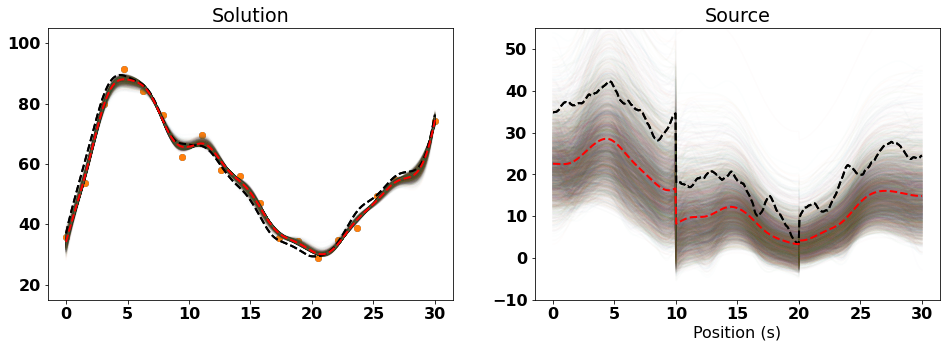

In [45]:
# calculate posterior distributions for betas

fig = plt.figure(figsize=(16,5))

plt.subplot(1,2,1)
plt.ylim(15,105)
plot(w,color="black",linewidth=2,linestyle="dashed",title="Solution")
plt.scatter(pts,data)
plt.subplot(1,2,2)
plt.ylim(-10,55)
plt.xlabel("Position (s)")
plot(source_f,color="black",linewidth=2,linestyle="dashed",title="Source")
u_post_mean = 0
f_post_mean = 0
for chain in samples:
    #for i in range(50):
    #    sample = chain[i]
    for sample in chain:
        rho, varratio, varratio_beta, diff, dec, sigma2 = tuple(sample)
        eps2 = varratio*sigma2
        beta2 = varratio_beta*sigma2
        
        kappa = np.sqrt(8*guess_nu)/rho
        K = diff*diffmat + advmat + dec*decaymat

        Q_source = make_matern(guess_alpha,kappa,d,V,sigma2,threshold=1e-10) #,space_name="line") 
        Q_beta = sparse.diags(np.array([1/beta2 for i in range(3)]))
        Q_prior = sparse.bmat([[K.transpose() @ invL @ Q_source @ invL @ K,-K.transpose() @ invL @ Q_source @ X],[-X.transpose() @ Q_source @ invL @ K,Q_beta + X.transpose() @ Q_source @ X]]).tocsr()

        Q_post = Q_prior + O@O.transpose()/eps2
        Q_post_ch = cholmod.cholesky(Q_post.tocsc(),mode="supernodal")
        posteriors = Q_post_ch(O @ data)/eps2
        u_post = posteriors[0:(num_pt+1)]
        u_post_mean += u_post
        plt.subplot(1,2,1)
        plot(vec_to_func(u_post,V),alpha=0.01)
        f_post = invL @ K @u_post
        f_post_mean += f_post
        plt.subplot(1,2,2)
        plot(vec_to_func(f_post,V),alpha=0.01)
        
plt.subplot(1,2,1)
plot(w,color="black",linewidth=2,linestyle="dashed")
plot(vec_to_func(u_post_mean/(len(samples)*len(samples[0])),V),color="red",linewidth=2,linestyle="dashed")
plt.scatter(pts,data)
plt.subplot(1,2,2)
plot(source_f,color="black",linewidth=2,linestyle="dashed")
plot(vec_to_func(f_post_mean/(len(samples)*len(samples[0])),V),color="red",linewidth=2,linestyle="dashed")
plt.savefig("../figs/mcmc_example_predictions.png")

In [ ]:
# cov_post = splinalg.inv(Q_post)
# cov_post_u = cov_post[0:(num_pt+1),0:(num_pt+1)]
# std_post_simul = simultaneous_confint(cov_post_u.todense(),1000) 
# std_post = np.sqrt(cov_post_u.diagonal())
# std_soln_f = vec_to_func(std_post,V)
# std_soln_f_simul = vec_to_func(std_post_simul,V)

# cov_post_source = invL @ K @ cov_post_u @ K.transpose() @ invL
# std_post_source_simul = simultaneous_confint(cov_post_source.todense(),1000) 
# std_post_source = np.sqrt(cov_post_source.diagonal()) 
# std_source_f = vec_to_func(std_post_source,V)
# std_source_f_simul = vec_to_func(std_post_source_simul,V)

In [ ]:
# plt.figure(figsize=(8,8))
# plt.subplot(3,1,1)
# plt.plot(x,[adv(xi) for xi in x])
# plt.ylabel("m/s")
# plt.title('(a) Flow rate (to the right)')
# frame1 = plt.gca()
# frame1.axes.get_xaxis().set_ticks([])
# plt.subplot(3,1,2)
# plot(w,color='b',title='(b) Steady state')
# plt.ylabel("g/L")
# plot(soln_est,color='purple')
# plot(soln_est + 1.96*std_soln_f,color='r')
# plot(soln_est - 1.96*std_soln_f,color='r')
# plt.scatter(pts,data)
# plt.ylim(np.min(mean_soln)-2*np.max(std_post),np.max(mean_soln)+2*np.max(std_post))
# b = mpatches.Patch(color='b', label='True Value')
# r = mpatches.Patch(color='r', label='Simultaneous CI')
# p = mpatches.Patch(color='purple', label='Estimate')
# plt.legend(handles=[b,r,p],bbox_to_anchor=(1.02,1),loc="upper left")
# frame2 = plt.gca()
# frame2.axes.get_xaxis().set_ticks([])
# plt.subplot(3,1,3)
# plot(source_f,color='b',title='(c) Source')
# plt.ylabel("g")
# plot(x_f,color='g')
# plot(source_est,color='purple')
# #plot(source_est + std_source_f,color='r')
# #plot(source_est - std_source_f,color='r')
# plot(source_est + 1.96*std_source_f,color='r')
# plot(source_est - 1.96*std_source_f,color='r')
# plt.ylim(np.min(mean_source)-1.2*np.max(std_post_source),np.max(mean_source)+1.2*np.max(std_post_source))
# handles = [mpatches.Patch(color='g', label='Land-Use'),
#            mpatches.Patch(color='b', label='True Value'),
#            mpatches.Patch(color='purple', label='Prediction'),
#            mpatches.Patch(color='r', label='Simultaneous CI')]
# plt.legend(handles=handles,bbox_to_anchor=(1.02,1),loc="upper left")
# frame3 = plt.gca()
# plt.show()

In [ ]:
# plt.figure(figsize=(4,4))
# plt.subplot(2,1,1)
# plt.plot(x,[adv(xi) for xi in x])
# plt.ylabel("m/s")
# plt.title('Flow rate (to the right)')
# frame1 = plt.gca()
# frame1.axes.get_xaxis().set_ticks([])
# plt.subplot(2,1,2)
# plot(w,color='b',title='Steady state')
# plt.ylabel("g/L")
# plot(soln_est,color='purple')
# #plot(soln_est + std_f,color='r')
# #plot(soln_est - std_f,color='r')
# plot(soln_est + 1.96*std_soln_f,color='r')
# plot(soln_est - 1.96*std_soln_f,color='r')
# plt.scatter(pts,data)
# plt.ylim(np.min(mean_soln)-2*np.max(std_post),np.max(mean_soln)+2*np.max(std_post))
# b = mpatches.Patch(color='b', label='True Value')
# r = mpatches.Patch(color='r', label='Pointwise CI')
# p = mpatches.Patch(color='purple', label='Estimate')
# plt.legend(handles=[b,r,p],bbox_to_anchor=(1.02,1),loc="upper left")
# frame2 = plt.gca()
# plt.show()

In [ ]:
# plt.figure(figsize=(8,4))
# plt.subplot(2,1,1)
# plt.plot(x,[adv(xi) for xi in x])
# plt.ylabel("m/s")
# plt.title('Flow rate (to the right)')
# frame1 = plt.gca()
# frame1.axes.get_xaxis().set_ticks([])
# plt.subplot(2,1,2)
# plot(source_f,color='b',title='Source')
# plt.ylabel("g")
# plot(x_f,color='g')
# plot(source_est,color='purple')
# plot(source_est + std_source_f,color='r')
# plot(source_est - std_source_f,color='r')
# # plot(source_est + 1.96*std_source_f_2,color='g')
# # plot(source_est - 1.96*std_source_f_2,color='g')
# plt.ylim(np.min(mean_source)-1.2*np.max(std_post_source),np.max(mean_source)+1.2*np.max(std_post_source))
# handles = [mpatches.Patch(color='g', label='Land-Use'),
#            mpatches.Patch(color='b', label='True Value'),
#            mpatches.Patch(color='purple', label='Prediction'),
#            mpatches.Patch(color='r', label='Pointwise CI')]
# plt.legend(handles=handles,bbox_to_anchor=(1.02,1),loc="upper left")
# frame3 = plt.gca()
# plt.show()

Now let's take a look at the L2 norm to quantify overall accuracy on the source and solution

In [ ]:
# # L2-norm distances between true and estimate
# print(sqrt(assemble((source_f-source_est)**2*dx)))
# print(sqrt(assemble((w-soln_est)**2*dx)))
# print("~")
# # L2-norm distances between true and estimate, scaled by L2-norm of true
# print(sqrt(assemble((source_f-source_est)**2*dx)/assemble(source_f**2*dx)))
# print(sqrt(assemble((w-soln_est)**2*dx)/assemble(soln_est**2*dx)))

In [ ]:
# const1 = Expression("1",degree=1)
# const1_f = Function(V)
# const1_f.interpolate(const1)
# shifted_source = source_f - assemble(source_f*dx)/assemble(const1_f*dx)
# shifted_soln = w - assemble(w*dx)/assemble(const1_f*dx)

In [ ]:
# # L2-norm distances between true and estimate, scaled by L2-norm of true after removing mean
# print(sqrt(assemble((source_f-source_est)**2*dx)/assemble(shifted_source**2*dx)))
# print(sqrt(assemble((w-soln_est)**2*dx)/assemble(shifted_soln**2*dx)))

Now that we can calculate what effective fraction of the L2 variation from the mean is explained by our model, let's plot this as a function of # of equally spaced data points

In [ ]:
# def soln_and_source_error(num_samp,source=source_f,soln=w):
#     pt_inds = list(map(int,np.linspace(0,num_pt,num_samp)))
#     x = np.linspace(xL,xR,num_pt+1)
#     pts = x[pt_inds]
#     data = random.normal(scale=np.sqrt(sigma2_eps),size=num_samp) + [soln(pt) for pt in pts]
#     O = make_obs_mat_pts([[pt] for pt in pts],fem,mesh,V,threshold=1e-10)
#     O = sparse.bmat([[O],[np.zeros((len(beta),num_samp))]])
    
#     Q_beta = sparse.diags(np.array([1/sigma_beta for i in range(3)]))
#     Q_prior = sparse.bmat([[K.transpose() @ invL @ Q_source @ invL @ K,-K.transpose() @ invL @ Q_source @ X],[-X.transpose() @ Q_source @ invL @ K,Q_beta + X.transpose() @ Q_source @ X]])
#     Q_post  = Q_prior + O @ O.transpose()/sigma2_eps
    
#     mean_soln = (splinalg.spsolve(Q_post,O @ data)/sigma2_eps)[0:(num_pt+1)]
#     mean_source = invL @ K @ mean_soln
#     soln_est = vec_to_func(mean_soln,V)
#     source_est = vec_to_func(mean_source,V)
    
#     shifted_source = source - assemble(source*dx)/assemble(const1_f*dx)
#     shifted_soln = soln - assemble(soln*dx)/assemble(const1_f*dx)
    
#     source_error = sqrt(assemble((source-source_est)**2*dx)/assemble(shifted_source**2*dx))
#     soln_error = sqrt(assemble((soln-soln_est)**2*dx)/assemble(shifted_soln**2*dx))
#     return source_error,soln_error

# def sim_soln_and_source_error(numsamps,num_sim=1):
    
#     if num_sim==1:
#         mu_beta = 20
#         sigma_beta = 5
#         X = np.array([farm_vec,ind_vec,res_vec]).transpose()
#         beta = random.normal(loc=mu_beta,scale=sigma_beta,size=3)
#         source_vec = np.squeeze(mvn_invchol(Q_factors,num_pt+1)) + beta[0]*farm_vec + beta[1]*ind_vec + beta[2]*res_vec
#         source = vec_to_func(source_vec,V)
#         x_f = vec_to_func(beta[0]*farm_vec + beta[1]*ind_vec + beta[2]*res_vec,V)
#         soln = Function(V)
#         solve(equation==source*v*dx,soln)
#         return np.array([soln_and_source_error(x,source,soln) for x in numsamps])
#     else:
#         return [sim_soln_and_source_error(numsamps) for i in range(num_sim)]
    

In [ ]:
# errors = [soln_and_source_error(x) for x in range(1,20)]
# plt.plot(errors)
# plt.show()

In [ ]:
# nsim = 30
# numsamps = [x**2 for x in range(2,15)]
# sim_errors = sim_soln_and_source_error(numsamps,nsim)
# error_sums = 0
# for i in range(nsim):
#     error_sums += sim_errors[1]
# error_means = error_sums / nsim

In [ ]:
# ax = plt.gca()
# ax.plot(np.sqrt(numsamps),[m[0] for m in error_means],label="Source")
# ax.plot(np.sqrt(numsamps),[m[1] for m in error_means],label="Solution")
# ax.legend()
# ax.set_title("Error")
# ax.set_ylabel("Relative Error")
# ax.set_xlabel("Sqrt(N)")
# plt.show()


# ax = plt.gca()
# ax.plot(np.sqrt(numsamps),[np.log(m[0]) for m in error_means],label="Source")
# ax.plot(np.sqrt(numsamps),[np.log(m[1]) for m in error_means],label="Solution")
# ax.legend()
# ax.set_title("Log Error")
# ax.set_ylabel("Relative Error")
# ax.set_xlabel("Sqrt(N)")
# plt.show()